In [1]:
import modeller
import fitter

from functions.misc import knot_fn

import casadi as ca
import numpy as np
from matplotlib import pyplot as plt
from copy import copy
import pandas as pd
from scipy.integrate import trapz, cumtrapz

In [2]:
def seir(t, y, p):
    return [
        -p[1]*y[0]*y[2]/sum(y[:4]),
        p[1]*y[0]*y[2]/sum(y[:4]) - p[2]*y[1],
        p[2]*y[1] - p[0]*y[2],
        p[0]*y[2],
    ]

In [3]:
the_data = pd.read_csv("../samoa/samoa-data/samoa_press_release_data.csv", header=0, dayfirst=True, parse_dates=True, skiprows=[1])
raw_times, raw_cumdata, H, cH, D, G = the_data.iloc[:,1:].values.T

In [4]:
start = 0
clip = None
times = raw_times[start:(-clip if clip else None)] + 33
cumdata = raw_cumdata[start:(-clip if clip else None)]

Text(0.5, 0, 'Days after 28 August 2019')

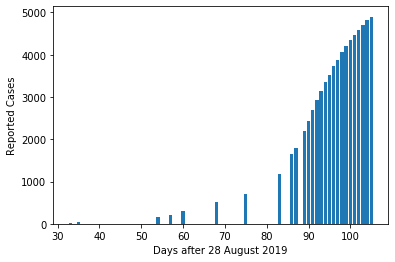

In [5]:
plt.bar(times, cumdata)
plt.ylabel("Reported Cases")
plt.xlabel("Days after 28 August 2019")

Text(0.5, 0, 'Days after 28 August 2019')

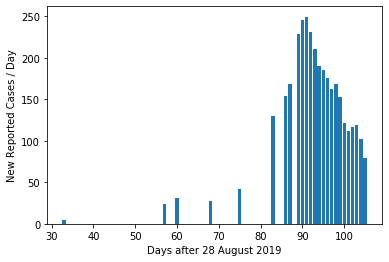

In [6]:
plt.bar(times, np.gradient(cumdata, times))
plt.ylabel("New Reported Cases / Day")
plt.xlabel("Days after 28 August 2019")

In [7]:
def cumE(t, p, e):
    dt = ca.diff(t)
    xm = (e[:-1]+e[1:])/2
    return p[2]*ca.vcat([0, ca.cumsum(xm*dt)])

In [8]:
data_pd = np.array([[i] for i in cumdata])
p0 = [1/8, 1, 1/8]
model_form = {
        "state": 4,
        "parameters": 3
    }
config = {
    "grid_size": 100,
    "basis_number": 24,
    "model_form": model_form,
    "time_span": [times[0], 150],
    "knot_function": None,
    "model": seir,
    "dataset": {"y": data_pd, "t": np.array(times)},
    "observation_model": [cumE],
    "observation_vector": [[1]],
    "weightings":[
        [1]*model_form['state'],
        np.sqrt((times+1)/np.mean(times+1))
    ],
    "regularisation_value": copy(p0),
}

In [9]:
model = modeller.Model(config)
config['regularisation_value'][1] = model.ps[1]
objective = fitter.Objective()
objective.make(config, config['dataset'], model)

solver_setup = {
    'f': objective.objective,
    'x': ca.vcat(objective.input_list),
    'p': ca.hcat([objective.rho, objective.alpha]),
    'g': ca.vcat(model.xs),
}
ipopt_opts = {
    'ipopt': {
        'print_level': 5,
        'print_frequency_iter': 10,
        
    }
}

solver = ca.nlpsol('solver', 'ipopt', solver_setup, ipopt_opts)

In [18]:
f1_ex = ca.Function('f1_ex', [solver_setup['x']], [objective.obj_1])
f2_ex = ca.Function('f2_ex', [solver_setup['x']], [objective.obj_2])
fr_ex = ca.Function('fr_ex', [solver_setup['x']], [objective.regularisation])
getx = ca.Function('getx', [solver_setup['x']], model.xs)
getp = ca.Function('getx', [solver_setup['x']], model.ps)


In [11]:
c0 = [max(cumdata)*np.ones(config['basis_number']) for _ in range(model_form['state'])]
x0 = np.hstack([*c0, p0])
lbx = [-np.inf]*(config['basis_number']*4) + [0]*len(config['regularisation_value'])
lbg = [0]*len(model.observation_times)*model_form['state']
ubg = [140000]*len(model.observation_times)*model_form['state']


In [12]:
prange = np.logspace(-6, 6, num=50)
arange = np.logspace(-1, 4, num=50)
sols = []
for alpha in arange:
    xguess = x0
    sola = []
    for p in prange:
        solve_opts = {
            'x0': xguess,
            'p': [p, alpha],
            'lbx': lbx,
            'lbg': lbg,
            'ubg': ubg
        }
        print(f"Solving for a={alpha} p={p}")
        sola.append(solver(**solve_opts))
        xguess = np.array(sola[-1]['x']).flatten()
    sols.append(sola)

Solving for p=1e-06

******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit http://projects.coin-or.org/Ipopt
******************************************************************************

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0


 440  1.4858758e+02 0.00e+00 2.93e+03  -2.5 2.84e+01    -  1.00e+00 1.00e+00f  1
 450  1.4851799e+02 0.00e+00 8.22e+03  -2.5 4.76e+01    -  1.00e+00 1.00e+00f  1
 460  1.4845225e+02 0.00e+00 3.90e+03  -2.5 3.20e+01    -  1.00e+00 1.00e+00f  1
 470  1.4839307e+02 0.00e+00 1.06e+04  -2.5 5.24e+01    -  1.00e+00 1.00e+00f  1
 480  1.4833798e+02 0.00e+00 2.73e+03  -2.5 2.59e+01    -  1.00e+00 1.00e+00f  1
 490  1.4828784e+02 0.00e+00 2.41e+03  -2.5 2.40e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4824341e+02 0.00e+00 6.04e+03  -2.5 3.78e+01    -  1.00e+00 1.00e+00f  1
 510  1.4820028e+02 0.00e+00 2.75e+03  -2.5 2.50e+01    -  1.00e+00 1.00e+00f  1
 520  1.4816058e+02 0.00e+00 1.82e+04  -2.5 6.42e+01    -  1.00e+00 1.00e+00f  1
 530  1.4812352e+02 0.00e+00 1.17e+04  -2.5 9.25e+01    -  1.00e+00 5.00e-01f  2
 540  1.4809011e+02 0.00e+00 6.82e+03  -2.5 1.30e+02    -  1.00e+00 2.50e-01f  3
 550  1.4805837e+02 0.00e+00

1390  1.4747164e+02 0.00e+00 8.39e+01  -3.8 2.26e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4747041e+02 0.00e+00 1.41e+02  -3.8 2.93e+00    -  1.00e+00 1.00e+00f  1
1410  1.4746926e+02 0.00e+00 5.59e+02  -3.8 5.82e+00    -  1.00e+00 1.00e+00f  1
1420  1.4746808e+02 0.00e+00 1.96e+02  -3.8 3.42e+00    -  1.00e+00 1.00e+00f  1
1430  1.4746697e+02 0.00e+00 1.47e+02  -3.8 2.93e+00    -  1.00e+00 1.00e+00f  1
1440  1.4746591e+02 0.00e+00 3.15e+02  -3.8 4.29e+00    -  1.00e+00 1.00e+00f  1
1450  1.4746492e+02 0.00e+00 8.99e+02  -3.8 1.39e+01    -  1.00e+00 5.00e-01f  2
1460  1.4746384e+02 0.00e+00 6.79e+02  -3.8 6.23e+00    -  1.00e+00 1.00e+00f  1
1470  1.4746284e+02 0.00e+00 5.17e+02  -3.8 5.41e+00    -  1.00e+00 1.00e+00f  1
1480  1.4746189e+02 0.00e+00 6.59e+02  -3.8 6.07e+00    -  1.00e+00 1.00e+00f  1
1490  1.4746096e+02 0.00e+00 4.27e+02  -3.8 4.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2370  1.4742983e+02 0.00e+00 6.72e+01  -3.8 1.07e+01    -  1.00e+00 1.25e-01h  4
2380  1.4742975e+02 0.00e+00 2.05e+02  -3.8 4.72e+00    -  1.00e+00 5.00e-01h  2
2390  1.4742964e+02 0.00e+00 1.84e+01  -3.8 7.10e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.4742955e+02 0.00e+00 7.03e+00  -3.8 4.37e-01    -  1.00e+00 1.00e+00h  1
2410  1.4742946e+02 0.00e+00 9.06e-01  -3.8 1.54e-01    -  1.00e+00 1.00e+00f  1
2420  1.4742937e+02 0.00e+00 9.96e+01  -3.8 1.64e+00    -  1.00e+00 1.00e+00H  1
2430  1.4742727e+02 0.00e+00 7.24e-05  -5.7 1.95e-03  -1.4 1.00e+00 1.00e+00f  1
2440  1.4742724e+02 0.00e+00 7.02e+01  -8.6 1.37e+00  -6.2 1.00e+00 1.00e+00h  1
2450  1.4742703e+02 0.00e+00 1.31e+02  -8.6 1.02e+02 -11.0 1.00e+00 1.25e-01h  4
2460  1.4742677e+02 0.00e+00 8.86e+01  -8.6 2.01e+05 -15.7 3.73e-01 3.24e-01f  1
2470  1.4742569e+02 0.00e+00 1.17e+02  -8.6 1.37e+04    -  7.51e-01 1.00e+00f  1
2480  1.4742443e+02 0.00e+00

  60  1.4969843e+02 0.00e+00 9.03e+02  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
  70  1.4971444e+02 0.00e+00 5.23e+03  -1.0 4.93e+01    -  1.00e+00 1.00e+00f  1
  80  1.4973500e+02 0.00e+00 8.26e+03  -1.0 1.17e+02    -  1.00e+00 5.00e-01f  2
  90  1.4977304e+02 0.00e+00 1.24e+04  -1.0 7.71e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4971056e+02 0.00e+00 4.91e+03  -1.0 1.68e+02    -  1.00e+00 2.50e-01f  3
 110  1.4972352e+02 0.00e+00 7.56e+03  -1.0 6.08e+01    -  1.00e+00 1.00e+00f  1
 120  1.4975969e+02 0.00e+00 1.29e+04  -1.0 7.89e+01    -  1.00e+00 1.00e+00f  1
 130  1.4972003e+02 0.00e+00 7.02e+03  -1.0 1.01e+02    -  1.00e+00 5.00e-01f  2
 140  1.4972156e+02 0.00e+00 7.26e+03  -1.0 2.14e+02    -  1.00e+00 2.50e-01f  3
 150  1.4971776e+02 0.00e+00 5.74e+03  -1.0 5.20e+01    -  1.00e+00 1.00e+00f  1
 160  1.4972543e+02 0.00e+00 7.54e+03  -1.0 5.98e+01    -  1.00e+00 1.00e+00f  1
 170  1.4972862e+02 0.00e+00

1090  1.4789073e+02 0.00e+00 5.63e+03  -2.5 2.73e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4787261e+02 0.00e+00 5.58e+03  -2.5 2.68e+01    -  1.00e+00 1.00e+00f  1
1110  1.4785561e+02 0.00e+00 6.49e+02  -2.5 8.95e+00    -  1.00e+00 1.00e+00f  1
1120  1.4784038e+02 0.00e+00 1.47e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
1130  1.4782578e+02 0.00e+00 1.50e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
1140  1.4781212e+02 0.00e+00 2.26e+03  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
1150  1.4779859e+02 0.00e+00 7.24e+02  -2.5 9.11e+00    -  1.00e+00 1.00e+00f  1
1160  1.4778651e+02 0.00e+00 3.66e+03  -2.5 3.82e+01    -  1.00e+00 5.00e-01f  2
1170  1.4777512e+02 0.00e+00 5.45e+03  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
1180  1.4776381e+02 0.00e+00 1.17e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1190  1.4775343e+02 0.00e+00 2.32e+03  -2.5 1.58e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2010  1.4746232e+02 0.00e+00 4.14e+02  -3.8 7.67e+00    -  1.00e+00 5.00e-01f  2
2020  1.4746152e+02 0.00e+00 3.16e+02  -3.8 3.53e+00    -  1.00e+00 1.00e+00f  1
2030  1.4746077e+02 0.00e+00 3.45e+02  -3.8 6.83e+00    -  1.00e+00 5.00e-01f  2
2040  1.4746003e+02 0.00e+00 4.04e+01  -3.8 1.24e+00    -  1.00e+00 1.00e+00f  1
2050  1.4745932e+02 0.00e+00 1.94e+02  -3.8 2.72e+00    -  1.00e+00 1.00e+00f  1
2060  1.4745860e+02 0.00e+00 8.05e+01  -3.8 1.74e+00    -  1.00e+00 1.00e+00f  1
2070  1.4745793e+02 0.00e+00 1.44e+02  -3.8 2.32e+00    -  1.00e+00 1.00e+00f  1
2080  1.4745728e+02 0.00e+00 3.51e+02  -3.8 1.39e+01    -  1.00e+00 2.50e-01f  3
2090  1.4745664e+02 0.00e+00 2.41e+02  -3.8 2.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4745602e+02 0.00e+00 3.22e+02  -3.8 1.31e+01    -  1.00e+00 2.50e-01f  3
2110  1.4745540e+02 0.00e+00 4.40e+01  -3.8 1.25e+00    -  1.00e+00 1.00e+00f  1
2120  1.4745485e+02 0.00e+00

2940  1.4743545e+02 0.00e+00 9.51e-05  -3.8 8.01e-04    -  1.00e+00 1.00e+00f  1
2950  1.4743349e+02 0.00e+00 9.79e+01  -5.7 2.23e+01  -8.8 1.00e+00 6.25e-02f  5
2960  1.4743334e+02 0.00e+00 9.84e+01  -5.7 9.68e+02 -13.5 1.00e+00 1.56e-02f  7
2970  1.4743210e+02 0.00e+00 4.28e+01  -5.7 7.39e+03 -14.7 1.00e+00 1.00e+00f  1
2980  1.4743017e+02 0.00e+00 1.01e+01  -5.7 1.52e+03 -12.5 6.12e-01 1.00e+00f  1
2990  1.4742803e+02 0.00e+00 8.50e+01  -5.7 1.97e+05 -12.7 2.76e-02 5.22e-03f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.4742302e+02 0.00e+00 2.43e+02  -5.7 4.76e+02 -11.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.4742302360287130e+02    1.4742302360287130e+02
Dual infeasibility......:   2.4251558182739265e+02    2.4251558182739265e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 570  1.6438663e+02 0.00e+00 4.30e+04  -1.0 2.31e+02    -  1.00e+00 1.00e+00f  1
 580  1.6481720e+02 0.00e+00 2.48e+04  -1.0 3.34e+02    -  1.00e+00 5.00e-01f  2
 590  1.6524775e+02 0.00e+00 2.71e+04  -1.0 1.88e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.6560122e+02 0.00e+00 1.72e+04  -1.0 1.52e+02    -  1.00e+00 1.00e+00f  1
 610  1.6583488e+02 0.00e+00 2.44e+03  -1.0 5.76e+01    -  1.00e+00 1.00e+00f  1
 620  1.6329727e+02 0.00e+00 2.47e+04  -1.7 3.91e+03    -  1.00e+00 1.00e+00f  1
 630  1.6230713e+02 0.00e+00 2.98e+04  -1.7 1.97e+02    -  1.00e+00 1.00e+00f  1
 640  1.6141145e+02 0.00e+00 1.54e+04  -1.7 1.36e+02    -  1.00e+00 1.00e+00f  1
 650  1.6060556e+02 0.00e+00 4.00e+04  -1.7 7.42e+02    -  1.00e+00 2.50e-01f  3
 660  1.5982886e+02 0.00e+00 1.09e+04  -1.7 1.08e+02    -  1.00e+00 1.00e+00f  1
 670  1.5912076e+02 0.00e+00 1.11e+04  -1.7 1.06e+02    -  1.00e+00 1.00e+00f  1
 680  1.5846550e+02 0.00e+00

1570  1.4758298e+02 0.00e+00 1.45e+02  -3.8 4.54e+00    -  1.00e+00 1.00e+00f  1
1580  1.4757815e+02 0.00e+00 1.52e+02  -3.8 4.61e+00    -  1.00e+00 1.00e+00f  1
1590  1.4757369e+02 0.00e+00 2.21e+02  -3.8 5.52e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4756933e+02 0.00e+00 3.67e+02  -3.8 2.58e+01    -  1.00e+00 2.50e-01f  3
1610  1.4756537e+02 0.00e+00 7.58e+02  -3.8 1.95e+01    -  1.00e+00 5.00e-01f  2
1620  1.4756100e+02 0.00e+00 3.58e+02  -3.8 6.87e+00    -  1.00e+00 1.00e+00f  1
1630  1.4755716e+02 0.00e+00 2.86e+02  -3.8 6.08e+00    -  1.00e+00 1.00e+00f  1
1640  1.4755346e+02 0.00e+00 6.50e+02  -3.8 3.55e+01    -  1.00e+00 2.50e-01f  3
1650  1.4754987e+02 0.00e+00 5.92e+02  -3.8 8.63e+00    -  1.00e+00 1.00e+00f  1
1660  1.4754645e+02 0.00e+00 5.50e+02  -3.8 8.26e+00    -  1.00e+00 1.00e+00f  1
1670  1.4754313e+02 0.00e+00 1.44e+02  -3.8 4.18e+00    -  1.00e+00 1.00e+00f  1
1680  1.4753998e+02 0.00e+00

2600  1.4745723e+02 0.00e+00 7.83e-01  -3.8 2.02e-01    -  1.00e+00 1.00e+00h  1
2610  1.4745714e+02 0.00e+00 4.17e+00  -3.8 1.80e+00    -  1.00e+00 2.50e-01h  3
2620  1.4745707e+02 0.00e+00 2.79e+00  -3.8 3.81e-01    -  1.00e+00 1.00e+00h  1
2630  1.4745699e+02 0.00e+00 2.06e+00  -3.8 3.27e-01    -  1.00e+00 1.00e+00h  1
2640  1.4745695e+02 0.00e+00 1.42e+00  -3.8 5.33e-01    -  1.00e+00 5.00e-01h  2
2650  1.4745693e+02 0.00e+00 9.80e-03  -3.8 2.25e-02    -  1.00e+00 1.00e+00h  1
2660  1.4745202e+02 0.00e+00 9.30e+01  -5.7 4.61e+00  -7.3 1.00e+00 1.00e+00h  1
2670  1.4745145e+02 0.00e+00 8.09e+00  -5.7 9.14e+05    -  7.51e-02 1.74e-02f  3
2680  1.4745006e+02 0.00e+00 8.14e+01  -5.7 3.13e+03 -13.1 1.00e+00 5.00e-01f  2
2690  1.4744645e+02 0.00e+00 1.21e+02  -5.7 6.35e+02 -13.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.4744524e+02 0.00e+00 5.10e+01  -5.7 8.72e+02 -13.9 1.00e+00 1.00e+00f  1
2710  1.4743867e+02 0.00e+00

 240  1.5000456e+02 0.00e+00 6.66e+03  -1.0 3.44e+01    -  1.00e+00 1.00e+00f  1
 250  1.5007403e+02 0.00e+00 1.91e+04  -1.0 5.69e+01    -  1.00e+00 1.00e+00f  1
 260  1.5008066e+02 0.00e+00 1.31e+04  -1.0 8.47e+01    -  1.00e+00 5.00e-01f  2
 270  1.5011197e+02 0.00e+00 1.20e+04  -1.0 7.78e+01    -  1.00e+00 5.00e-01f  2
 280  1.5016031e+02 0.00e+00 1.54e+04  -1.0 1.84e+02    -  1.00e+00 2.50e-01f  3
 290  1.5019284e+02 0.00e+00 1.12e+04  -1.0 1.47e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5024950e+02 0.00e+00 1.44e+04  -1.0 4.64e+01    -  1.00e+00 1.00e+00f  1
 310  1.5035317e+02 0.00e+00 3.08e+04  -1.0 6.71e+01    -  1.00e+00 1.00e+00f  1
 320  1.5034698e+02 0.00e+00 2.43e+03  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 330  1.5042825e+02 0.00e+00 1.73e+04  -1.0 4.95e+01    -  1.00e+00 1.00e+00f  1
 340  1.5048775e+02 0.00e+00 1.11e+04  -1.0 3.89e+01    -  1.00e+00 1.00e+00f  1
 350  1.5056544e+02 0.00e+00

1210  1.4763683e+02 0.00e+00 7.98e+02  -3.8 2.15e+01    -  1.00e+00 2.50e-01f  3
1220  1.4762989e+02 0.00e+00 3.66e+02  -3.8 4.23e+00    -  1.00e+00 1.00e+00f  1
1230  1.4762356e+02 0.00e+00 5.47e+02  -3.8 5.14e+00    -  1.00e+00 1.00e+00f  1
1240  1.4761713e+02 0.00e+00 1.43e+02  -3.8 2.58e+00    -  1.00e+00 1.00e+00f  1
1250  1.4761131e+02 0.00e+00 2.87e+02  -3.8 3.64e+00    -  1.00e+00 1.00e+00f  1
1260  1.4760576e+02 0.00e+00 7.60e+02  -3.8 5.90e+00    -  1.00e+00 1.00e+00f  1
1270  1.4760017e+02 0.00e+00 6.93e+02  -3.8 5.58e+00    -  1.00e+00 1.00e+00f  1
1280  1.4759492e+02 0.00e+00 2.33e+02  -3.8 3.19e+00    -  1.00e+00 1.00e+00f  1
1290  1.4759019e+02 0.00e+00 9.51e+02  -3.8 6.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4758539e+02 0.00e+00 5.53e+02  -3.8 4.86e+00    -  1.00e+00 1.00e+00f  1
1310  1.4758082e+02 0.00e+00 2.62e+02  -3.8 3.31e+00    -  1.00e+00 1.00e+00f  1
1320  1.4757669e+02 0.00e+00

2150  1.4747251e+02 0.00e+00 2.48e+02  -3.8 4.02e+00    -  1.00e+00 5.00e-01h  2
2160  1.4747220e+02 0.00e+00 8.17e+01  -3.8 1.16e+00    -  1.00e+00 1.00e+00h  1
2170  1.4747201e+02 0.00e+00 8.91e+01  -3.8 2.33e+00    -  1.00e+00 5.00e-01h  2
2180  1.4747180e+02 0.00e+00 2.81e+01  -3.8 6.74e-01    -  1.00e+00 1.00e+00h  1
2190  1.4747161e+02 0.00e+00 6.18e+00  -3.8 3.14e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4747142e+02 0.00e+00 1.87e+00  -3.8 1.71e-01    -  1.00e+00 1.00e+00f  1
2210  1.4747125e+02 0.00e+00 7.16e+00  -3.8 3.36e-01    -  1.00e+00 1.00e+00h  1
2220  1.4747108e+02 0.00e+00 1.89e+00  -3.8 1.71e-01    -  1.00e+00 1.00e+00h  1
2230  1.4747093e+02 0.00e+00 1.02e+01  -3.8 3.98e-01    -  1.00e+00 1.00e+00h  1
2240  1.4747078e+02 0.00e+00 4.67e+00  -3.8 2.68e-01    -  1.00e+00 1.00e+00h  1
2250  1.4747062e+02 0.00e+00 3.06e+01  -3.8 6.88e-01    -  1.00e+00 1.00e+00h  1
2260  1.4747054e+02 0.00e+00

 240  1.5007151e+02 0.00e+00 6.76e+03  -1.0 9.76e+01    -  1.00e+00 2.50e-01f  3
 250  1.5009733e+02 0.00e+00 3.64e+03  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 260  1.5013381e+02 0.00e+00 3.17e+03  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 270  1.5022859e+02 0.00e+00 1.84e+04  -1.0 4.53e+01    -  1.00e+00 1.00e+00f  1
 280  1.5022928e+02 0.00e+00 9.27e+03  -1.0 5.52e+01    -  1.00e+00 5.00e-01f  2
 290  1.5029140e+02 0.00e+00 1.35e+04  -1.0 7.07e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5033602e+02 0.00e+00 1.16e+04  -1.0 6.27e+01    -  1.00e+00 5.00e-01f  2
 310  1.5038069e+02 0.00e+00 3.65e+03  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
 320  1.5044714e+02 0.00e+00 5.57e+03  -1.0 2.35e+01    -  1.00e+00 1.00e+00f  1
 330  1.5051721e+02 0.00e+00 2.71e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 340  1.5060432e+02 0.00e+00 1.08e+04  -1.0 5.43e+01    -  1.00e+00 5.00e-01f  2
 350  1.5069567e+02 0.00e+00

1260  1.4767852e+02 0.00e+00 1.98e+02  -2.5 4.57e+00    -  1.00e+00 5.00e-01f  2
1270  1.4767563e+02 0.00e+00 1.56e+02  -2.5 2.31e+00    -  1.00e+00 1.00e+00f  1
1280  1.4767282e+02 0.00e+00 1.24e+02  -2.5 2.05e+00    -  1.00e+00 1.00e+00h  1
1290  1.4767023e+02 0.00e+00 4.68e+01  -2.5 1.25e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4766785e+02 0.00e+00 6.50e+01  -2.5 1.47e+00    -  1.00e+00 1.00e+00h  1
1310  1.4766538e+02 0.00e+00 2.15e+02  -2.5 2.66e+00    -  1.00e+00 1.00e+00h  1
1320  1.4766337e+02 0.00e+00 1.03e+02  -2.5 6.77e+00    -  1.00e+00 2.50e-01h  3
1330  1.4766114e+02 0.00e+00 1.55e+02  -2.5 8.72e+00    -  1.00e+00 2.50e-01h  3
1340  1.4765927e+02 0.00e+00 7.57e+01  -2.5 1.56e+00    -  1.00e+00 1.00e+00h  1
1350  1.4765759e+02 0.00e+00 6.39e+01  -2.5 1.43e+00    -  1.00e+00 1.00e+00h  1
1360  1.4765590e+02 0.00e+00 1.15e+02  -2.5 1.91e+00    -  1.00e+00 1.00e+00h  1
1370  1.4765460e+02 0.00e+00

2260  1.4750986e+02 0.00e+00 1.22e+03  -3.8 6.05e+00    -  1.00e+00 1.00e+00H  1
2270  1.4750459e+02 0.00e+00 2.36e+01  -3.8 8.21e-01    -  1.00e+00 1.00e+00h  1
2280  1.4750450e+02 0.00e+00 1.63e+01  -3.8 2.21e+01    -  1.00e+00 3.12e-02h  6
2290  1.4750442e+02 0.00e+00 1.72e+01  -3.8 1.34e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4750436e+02 0.00e+00 2.14e+01  -3.8 7.90e-01    -  1.00e+00 1.00e+00h  1
2310  1.4750430e+02 0.00e+00 2.08e+01  -3.8 1.52e+00    -  1.00e+00 5.00e-01h  2
2320  1.4750424e+02 0.00e+00 1.50e-01  -3.8 6.52e-02    -  1.00e+00 1.00e+00h  1
2330  1.4750398e+02 0.00e+00 3.77e+00  -3.8 5.91e-01    -  1.00e+00 5.00e-01h  2
2340  1.4750401e+02 0.00e+00 7.70e+00  -3.8 9.27e-01    -  1.00e+00 5.00e-01h  2
2350  1.4750403e+02 0.00e+00 3.38e-01  -3.8 9.86e-02    -  1.00e+00 1.00e+00h  1
2360  1.4750405e+02 0.00e+00 2.65e-02  -3.8 2.76e-02    -  1.00e+00 1.00e+00h  1
2370  1.4750279e+02 0.00e+00

 440  1.5256296e+02 0.00e+00 3.97e+03  -1.0 1.99e+01    -  1.00e+00 1.00e+00f  1
 450  1.5277380e+02 0.00e+00 7.81e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 460  1.5298835e+02 0.00e+00 7.59e+03  -1.0 4.64e+01    -  1.00e+00 5.00e-01f  2
 470  1.5321317e+02 0.00e+00 2.01e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 480  1.5343150e+02 0.00e+00 6.98e+03  -1.0 2.66e+01    -  1.00e+00 1.00e+00f  1
 490  1.5365718e+02 0.00e+00 1.21e+04  -1.0 3.47e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5385010e+02 0.00e+00 1.33e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 510  1.5406554e+02 0.00e+00 1.03e+04  -1.0 3.17e+01    -  1.00e+00 1.00e+00f  1
 520  1.5423211e+02 0.00e+00 2.96e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 530  1.5439951e+02 0.00e+00 2.61e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 540  1.5454508e+02 0.00e+00 1.11e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 550  1.5466306e+02 0.00e+00

1420  1.4764187e+02 0.00e+00 1.36e+02  -3.8 4.05e+00    -  1.00e+00 1.00e+00f  1
1430  1.4763852e+02 0.00e+00 2.54e+02  -3.8 5.54e+00    -  1.00e+00 1.00e+00f  1
1440  1.4763524e+02 0.00e+00 2.61e+02  -3.8 9.36e+00    -  1.00e+00 5.00e-01f  2
1450  1.4763212e+02 0.00e+00 3.65e+02  -3.8 6.67e+00    -  1.00e+00 1.00e+00f  1
1460  1.4762906e+02 0.00e+00 1.57e+02  -3.8 4.37e+00    -  1.00e+00 1.00e+00f  1
1470  1.4762619e+02 0.00e+00 1.47e+02  -3.8 4.24e+00    -  1.00e+00 1.00e+00f  1
1480  1.4762349e+02 0.00e+00 1.09e+02  -3.8 3.64e+00    -  1.00e+00 1.00e+00f  1
1490  1.4762091e+02 0.00e+00 2.29e+02  -3.8 5.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4761841e+02 0.00e+00 4.45e+02  -3.8 7.40e+00    -  1.00e+00 1.00e+00f  1
1510  1.4761591e+02 0.00e+00 1.48e+02  -3.8 4.26e+00    -  1.00e+00 1.00e+00f  1
1520  1.4761359e+02 0.00e+00 2.67e+02  -3.8 2.15e+01    -  1.00e+00 2.50e-01f  3
1530  1.4761139e+02 0.00e+00

  90  1.4998733e+02 0.00e+00 1.03e+03  -1.0 6.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4999906e+02 0.00e+00 5.31e+02  -1.0 4.93e+00    -  1.00e+00 1.00e+00f  1
 110  1.5002393e+02 0.00e+00 2.73e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 120  1.5003087e+02 0.00e+00 7.43e+02  -1.0 5.69e+00    -  1.00e+00 1.00e+00f  1
 130  1.5005124e+02 0.00e+00 1.47e+03  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
 140  1.5007519e+02 0.00e+00 2.45e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 150  1.5009274e+02 0.00e+00 1.07e+03  -1.0 6.64e+00    -  1.00e+00 1.00e+00f  1
 160  1.5015853e+02 0.00e+00 6.96e+03  -1.0 6.45e+01    -  1.00e+00 2.50e-01f  3
 170  1.5015027e+02 0.00e+00 2.51e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 180  1.5018261e+02 0.00e+00 2.79e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 190  1.5022302e+02 0.00e+00 4.04e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1040  1.4791124e+02 0.00e+00 1.48e+02  -2.5 1.92e+00    -  1.00e+00 1.00e+00f  1
1050  1.4790327e+02 0.00e+00 2.43e+02  -2.5 2.46e+00    -  1.00e+00 1.00e+00f  1
1060  1.4789545e+02 0.00e+00 1.26e+02  -2.5 1.75e+00    -  1.00e+00 1.00e+00f  1
1070  1.4788824e+02 0.00e+00 4.69e+02  -2.5 1.28e+01    -  1.00e+00 2.50e-01f  3
1080  1.4788146e+02 0.00e+00 3.19e+02  -2.5 4.81e+00    -  1.00e+00 5.00e-01f  2
1090  1.4787478e+02 0.00e+00 2.00e+02  -2.5 2.16e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4786849e+02 0.00e+00 1.38e+02  -2.5 1.78e+00    -  1.00e+00 1.00e+00f  1
1110  1.4786256e+02 0.00e+00 5.87e+01  -2.5 1.15e+00    -  1.00e+00 1.00e+00f  1
1120  1.4785709e+02 0.00e+00 2.80e+02  -2.5 2.50e+00    -  1.00e+00 1.00e+00f  1
1130  1.4785171e+02 0.00e+00 8.85e+01  -2.5 1.39e+00    -  1.00e+00 1.00e+00f  1
1140  1.4784684e+02 0.00e+00 1.01e+02  -2.5 1.48e+00    -  1.00e+00 1.00e+00f  1
1150  1.4784224e+02 0.00e+00

2050  1.4766260e+02 0.00e+00 1.55e-02  -3.8 3.65e-01    -  1.00e+00 1.00e+00h  1
2060  1.4765708e+02 0.00e+00 1.00e+02  -5.7 1.57e+05    -  1.59e-01 4.45e-02f  3
2070  1.4765462e+02 0.00e+00 1.61e+01  -5.7 7.25e+02 -11.2 1.00e+00 1.00e+00f  1
2080  1.4760213e+02 0.00e+00 1.96e+02  -5.7 3.81e+03 -13.1 4.93e-01 5.00e-01f  2
2090  1.4758779e+02 0.00e+00 3.68e+01  -5.7 6.43e+03    -  1.00e+00 9.21e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4749315e+02 0.00e+00 8.82e+00  -5.7 4.03e+02    -  6.83e-01 8.75e-01f  1
2110  1.4748511e+02 0.00e+00 2.70e-01  -5.7 2.44e+02 -11.5 1.00e+00 1.00e+00f  1
2120  1.4748094e+02 0.00e+00 5.17e+01  -5.7 8.64e+04 -13.4 2.87e-01 5.30e-02f  3
2130  1.4748020e+02 0.00e+00 7.54e+00  -5.7 8.79e+02    -  1.00e+00 1.00e+00h  1
2140  1.4748018e+02 0.00e+00 4.74e+00  -5.7 1.66e+00    -  1.00e+00 1.00e+00h  1
2150  1.4748016e+02 0.00e+00 2.03e+00  -5.7 1.08e+00    -  1.00e+00 1.00e+00h  1
2160  1.4748015e+02 0.00e+00

 450  1.5447798e+02 0.00e+00 3.53e+03  -1.0 2.35e+01    -  1.00e+00 5.00e-01f  2
 460  1.5470759e+02 0.00e+00 2.06e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 470  1.5492231e+02 0.00e+00 7.02e+02  -1.0 6.03e+00    -  1.00e+00 1.00e+00f  1
 480  1.5513063e+02 0.00e+00 4.88e+03  -1.0 3.03e+01    -  1.00e+00 5.00e-01f  2
 490  1.5529232e+02 0.00e+00 1.40e+03  -1.0 2.89e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5544975e+02 0.00e+00 1.22e+03  -1.0 7.73e+00    -  1.00e+00 1.00e+00f  1
 510  1.5557919e+02 0.00e+00 7.46e+02  -1.0 2.23e+01    -  1.00e+00 2.50e-01f  3
 520  1.5567018e+02 0.00e+00 3.39e+02  -1.0 7.65e+00    -  1.00e+00 5.00e-01h  2
 530  1.5384277e+02 0.00e+00 2.61e+04  -1.7 7.06e+01    -  1.00e+00 5.00e-01f  2
 540  1.5332100e+02 0.00e+00 2.12e+03  -1.7 1.08e+01    -  1.00e+00 1.00e+00f  1
 550  1.5285855e+02 0.00e+00 2.72e+03  -1.7 1.31e+01    -  1.00e+00 1.00e+00f  1
 560  1.5244316e+02 0.00e+00

1400  1.4776473e+02 0.00e+00 1.77e+02  -3.8 2.95e+00    -  1.00e+00 1.00e+00f  1
1410  1.4776227e+02 0.00e+00 1.49e+02  -3.8 4.86e+00    -  1.00e+00 5.00e-01f  2
1420  1.4775980e+02 0.00e+00 1.96e+01  -3.8 9.77e-01    -  1.00e+00 1.00e+00f  1
1430  1.4775760e+02 0.00e+00 9.95e+01  -3.8 2.22e+00    -  1.00e+00 1.00e+00f  1
1440  1.4775541e+02 0.00e+00 9.14e+01  -3.8 2.14e+00    -  1.00e+00 1.00e+00f  1
1450  1.4775329e+02 0.00e+00 2.24e+01  -3.8 1.06e+00    -  1.00e+00 1.00e+00f  1
1460  1.4775135e+02 0.00e+00 1.69e+01  -3.8 9.33e-01    -  1.00e+00 1.00e+00f  1
1470  1.4774951e+02 0.00e+00 3.45e+01  -3.8 1.35e+00    -  1.00e+00 1.00e+00f  1
1480  1.4774784e+02 0.00e+00 1.98e+02  -3.8 6.31e+00    -  1.00e+00 5.00e-01f  2
1490  1.4774609e+02 0.00e+00 3.65e+01  -3.8 1.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4774454e+02 0.00e+00 1.56e+01  -3.8 9.53e-01    -  1.00e+00 1.00e+00f  1
1510  1.4774308e+02 0.00e+00

 250  1.5132955e+02 0.00e+00 3.03e+03  -1.0 6.80e+01    -  1.00e+00 1.25e-01f  4
 260  1.5150319e+02 0.00e+00 9.84e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 270  1.5158740e+02 0.00e+00 3.91e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 280  1.5173540e+02 0.00e+00 4.73e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 290  1.5190710e+02 0.00e+00 7.10e+03  -1.0 2.93e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5205914e+02 0.00e+00 4.45e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 310  1.5223884e+02 0.00e+00 1.24e+03  -1.0 6.95e+00    -  1.00e+00 1.00e+00f  1
 320  1.5246562e+02 0.00e+00 8.34e+03  -1.0 3.41e+01    -  1.00e+00 5.00e-01f  2
 330  1.5265018e+02 0.00e+00 4.40e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 340  1.5287015e+02 0.00e+00 3.81e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 350  1.5309767e+02 0.00e+00 4.28e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 360  1.5333966e+02 0.00e+00

1310  1.4776122e+02 0.00e+00 1.23e+02  -3.8 1.50e+03  -8.8 1.00e+00 4.48e-01f  2
1320  1.4764245e+02 0.00e+00 5.32e+02  -3.8 8.31e+04    -  5.75e-01 3.01e-01f  2
1330  1.4763204e+02 0.00e+00 1.27e+02  -3.8 6.38e+01    -  1.00e+00 2.50e-01f  3
1340  1.4762943e+02 0.00e+00 9.45e+01  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
1350  1.4762702e+02 0.00e+00 1.56e+02  -3.8 3.54e+01    -  1.00e+00 5.00e-01f  2
1360  1.4762490e+02 0.00e+00 2.35e+02  -3.8 9.09e+01    -  1.00e+00 2.50e-01f  3
1370  1.4762263e+02 0.00e+00 1.06e+02  -3.8 2.70e+01    -  1.00e+00 5.00e-01f  2
1380  1.4762062e+02 0.00e+00 1.16e+02  -3.8 2.90e+01    -  1.00e+00 5.00e-01f  2
1390  1.4761865e+02 0.00e+00 5.00e+01  -3.8 1.05e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4761687e+02 0.00e+00 9.48e+01  -3.8 1.44e+01    -  1.00e+00 1.00e+00f  1
1410  1.4761521e+02 0.00e+00 1.68e+02  -3.8 1.90e+01    -  1.00e+00 1.00e+00f  1
1420  1.4761355e+02 0.00e+00

 100  1.5089473e+02 0.00e+00 2.97e+03  -1.0 2.29e+01    -  1.00e+00 2.50e-01f  3
 110  1.5092310e+02 0.00e+00 2.82e+03  -1.0 5.91e+00    -  1.00e+00 1.00e+00f  1
 120  1.5098285e+02 0.00e+00 3.90e+03  -1.0 2.71e+01    -  1.00e+00 2.50e-01f  3
 130  1.5099435e+02 0.00e+00 2.28e+03  -1.0 5.57e+00    -  1.00e+00 1.00e+00f  1
 140  1.5104503e+02 0.00e+00 2.48e+03  -1.0 1.03e+01    -  1.00e+00 5.00e-01f  2
 150  1.5109288e+02 0.00e+00 1.92e+03  -1.0 5.42e+00    -  1.00e+00 1.00e+00f  1
 160  1.5116018e+02 0.00e+00 2.69e+03  -1.0 6.55e+00    -  1.00e+00 1.00e+00f  1
 170  1.5122140e+02 0.00e+00 2.08e+03  -1.0 4.33e+01    -  1.00e+00 1.25e-01f  4
 180  1.5128849e+02 0.00e+00 6.12e+02  -1.0 3.37e+00    -  1.00e+00 1.00e+00f  1
 190  1.5137051e+02 0.00e+00 9.56e+02  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5146429e+02 0.00e+00 2.14e+03  -1.0 4.67e+01    -  1.00e+00 1.25e-01f  4
 210  1.5162788e+02 0.00e+00

1150  1.4879231e+02 0.00e+00 5.84e+01  -2.5 1.03e+00    -  1.00e+00 1.00e+00f  1
1160  1.4878635e+02 0.00e+00 2.66e+02  -2.5 2.17e+00    -  1.00e+00 1.00e+00f  1
1170  1.4878074e+02 0.00e+00 7.94e+01  -2.5 1.18e+00    -  1.00e+00 1.00e+00f  1
1180  1.4877532e+02 0.00e+00 9.08e+01  -2.5 1.25e+00    -  1.00e+00 1.00e+00f  1
1190  1.4877014e+02 0.00e+00 1.71e+02  -2.5 6.60e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4876546e+02 0.00e+00 1.73e+02  -2.5 3.28e+00    -  1.00e+00 5.00e-01f  2
1210  1.4876126e+02 0.00e+00 3.46e+01  -2.5 7.53e-01    -  1.00e+00 1.00e+00f  1
1220  1.4875719e+02 0.00e+00 4.36e+01  -2.5 8.47e-01    -  1.00e+00 1.00e+00f  1
1230  1.4875342e+02 0.00e+00 5.87e+01  -2.5 9.73e-01    -  1.00e+00 1.00e+00f  1
1240  1.4874975e+02 0.00e+00 9.08e+01  -2.5 2.27e+00    -  1.00e+00 5.00e-01f  2
1250  1.4874661e+02 0.00e+00 8.08e+00  -2.5 3.55e-01    -  1.00e+00 1.00e+00f  1
1260  1.4874362e+02 0.00e+00

 120  1.5180117e+02 0.00e+00 1.71e+03  -1.0 4.38e+00    -  1.00e+00 1.00e+00f  1
 130  1.5185007e+02 0.00e+00 7.27e+02  -1.0 2.96e+00    -  1.00e+00 1.00e+00f  1
 140  1.5197637e+02 0.00e+00 4.36e+03  -1.0 1.41e+01    -  1.00e+00 5.00e-01f  2
 150  1.5206197e+02 0.00e+00 5.07e+03  -1.0 1.57e+01    -  1.00e+00 5.00e-01f  2
 160  1.5207120e+02 0.00e+00 1.77e+03  -1.0 1.66e+01    -  1.00e+00 2.50e-01f  3
 170  1.5216291e+02 0.00e+00 2.09e+03  -1.0 5.51e+00    -  1.00e+00 1.00e+00f  1
 180  1.5225082e+02 0.00e+00 3.81e+02  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
 190  1.5237821e+02 0.00e+00 3.15e+03  -1.0 7.09e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5248216e+02 0.00e+00 2.15e+03  -1.0 2.06e+01    -  1.00e+00 2.50e-01f  3
 210  1.5261371e+02 0.00e+00 2.49e+03  -1.0 1.11e+01    -  1.00e+00 5.00e-01f  2
 220  1.5275354e+02 0.00e+00 1.79e+03  -1.0 5.77e+00    -  1.00e+00 1.00e+00f  1
 230  1.5290633e+02 0.00e+00

1100  1.4785921e+02 0.00e+00 1.43e+02  -3.8 1.41e+01    -  1.00e+00 1.00e+00f  1
1110  1.4785310e+02 0.00e+00 4.70e+01  -3.8 8.43e+00    -  1.00e+00 1.00e+00f  1
1120  1.4784784e+02 0.00e+00 1.34e+02  -3.8 2.43e+01    -  1.00e+00 5.00e-01f  2
1130  1.4784258e+02 0.00e+00 2.28e+02  -3.8 2.00e+01    -  1.00e+00 1.00e+00f  1
1140  1.4783777e+02 0.00e+00 2.28e+02  -3.8 3.93e+01    -  1.00e+00 5.00e-01f  2
1150  1.4783298e+02 0.00e+00 2.58e+01  -3.8 7.32e+00    -  1.00e+00 1.00e+00f  1
1160  1.4782879e+02 0.00e+00 4.94e+01  -3.8 1.05e+01    -  1.00e+00 1.00e+00f  1
1170  1.4782495e+02 0.00e+00 3.08e+01  -3.8 8.68e+00    -  1.00e+00 1.00e+00f  1
1180  1.4782139e+02 0.00e+00 1.24e+02  -3.8 1.81e+01    -  1.00e+00 1.00e+00f  1
1190  1.4781797e+02 0.00e+00 1.12e+02  -3.8 1.79e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4781469e+02 0.00e+00 1.62e+01  -3.8 7.26e+00    -  1.00e+00 1.00e+00f  1
1210  1.4781181e+02 0.00e+00

 250  1.5529520e+02 0.00e+00 1.81e+03  -1.0 1.87e+01    -  1.00e+00 2.50e-01f  3
 260  1.5556357e+02 0.00e+00 4.15e+03  -1.0 8.36e+00    -  1.00e+00 1.00e+00f  1
 270  1.5581387e+02 0.00e+00 3.63e+03  -1.0 3.00e+01    -  1.00e+00 2.50e-01f  3
 280  1.5608115e+02 0.00e+00 3.75e+03  -1.0 3.06e+01    -  1.00e+00 2.50e-01f  3
 290  1.5633835e+02 0.00e+00 2.21e+03  -1.0 6.11e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5662280e+02 0.00e+00 2.31e+03  -1.0 6.19e+00    -  1.00e+00 1.00e+00f  1
 310  1.5690272e+02 0.00e+00 1.45e+03  -1.0 4.89e+00    -  1.00e+00 1.00e+00f  1
 320  1.5719493e+02 0.00e+00 2.18e+03  -1.0 5.93e+00    -  1.00e+00 1.00e+00f  1
 330  1.5750806e+02 0.00e+00 4.43e+03  -1.0 8.39e+00    -  1.00e+00 1.00e+00f  1
 340  1.5777382e+02 0.00e+00 2.28e+03  -1.0 2.25e+01    -  1.00e+00 2.50e-01f  3
 350  1.5806151e+02 0.00e+00 3.11e+03  -1.0 2.68e+01    -  1.00e+00 2.50e-01f  3
 360  1.5833311e+02 0.00e+00

1270  1.4798120e+02 0.00e+00 1.05e+01  -3.8 1.09e+01    -  1.00e+00 1.00e+00h  1
1280  1.4798123e+02 0.00e+00 8.70e+00  -3.8 3.88e+01    -  1.00e+00 2.50e-01h  3
1290  1.4798129e+02 0.00e+00 1.39e+01  -3.8 5.27e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4798132e+02 0.00e+00 3.76e+00  -3.8 6.96e+00    -  1.00e+00 1.00e+00h  1
1310  1.4797219e+02 0.00e+00 2.73e+01  -5.7 7.80e+03    -  1.00e+00 5.00e-01h  2
1320  1.4797214e+02 0.00e+00 1.04e-01  -8.6 1.27e+04    -  8.75e-01 6.52e-01h  1

Number of Iterations....: 1329

                                   (scaled)                 (unscaled)
Objective...............:   1.4797208923036814e+02    1.4797208923036814e+02
Dual infeasibility......:   2.3205222928928953e-09    2.3205222928928953e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5079745998610070e-09    2.5079745998610070e-09
Overall NLP error....

 580  1.5664803e+02 0.00e+00 5.21e+02  -1.7 3.07e+00    -  1.00e+00 1.00e+00f  1
 590  1.5642372e+02 0.00e+00 1.46e+03  -1.7 5.01e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5622269e+02 0.00e+00 1.73e+03  -1.7 9.89e+00    -  1.00e+00 5.00e-01f  2
 610  1.5604817e+02 0.00e+00 2.41e+03  -1.7 6.12e+00    -  1.00e+00 1.00e+00f  1
 620  1.5588492e+02 0.00e+00 7.74e+02  -1.7 3.37e+00    -  1.00e+00 1.00e+00f  1
 630  1.5573790e+02 0.00e+00 3.28e+02  -1.7 2.14e+00    -  1.00e+00 1.00e+00f  1
 640  1.5560963e+02 0.00e+00 6.81e+02  -1.7 3.05e+00    -  1.00e+00 1.00e+00f  1
 650  1.5548928e+02 0.00e+00 3.81e+02  -1.7 2.24e+00    -  1.00e+00 1.00e+00f  1
 660  1.5538315e+02 0.00e+00 8.99e+01  -1.7 1.05e+00    -  1.00e+00 1.00e+00f  1
 670  1.5528798e+02 0.00e+00 5.51e+02  -1.7 2.61e+00    -  1.00e+00 1.00e+00f  1
 680  1.5520433e+02 0.00e+00 1.76e+02  -1.7 1.44e+00    -  1.00e+00 1.00e+00f  1
 690  1.5513110e+02 0.00e+00

  70  1.6026310e+02 0.00e+00 1.20e+03  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
  80  1.6034468e+02 0.00e+00 1.36e+03  -1.0 2.76e+00    -  1.00e+00 1.00e+00f  1
  90  1.6041700e+02 0.00e+00 9.58e+02  -1.0 2.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6054851e+02 0.00e+00 1.94e+03  -1.0 6.52e+00    -  1.00e+00 5.00e-01f  2
 110  1.6062454e+02 0.00e+00 1.11e+03  -1.0 2.67e+00    -  1.00e+00 1.00e+00f  1
 120  1.6074761e+02 0.00e+00 1.19e+03  -1.0 2.83e+00    -  1.00e+00 1.00e+00f  1
 130  1.6089808e+02 0.00e+00 1.95e+03  -1.0 6.88e+00    -  1.00e+00 5.00e-01f  2
 140  1.6101123e+02 0.00e+00 1.14e+03  -1.0 4.72e+00    -  1.00e+00 5.00e-01f  2
 150  1.6117093e+02 0.00e+00 1.16e+03  -1.0 2.94e+00    -  1.00e+00 1.00e+00f  1
 160  1.6133215e+02 0.00e+00 2.51e+02  -1.0 1.41e+00    -  1.00e+00 1.00e+00f  1
 170  1.6152046e+02 0.00e+00 1.30e+03  -1.0 3.19e+00    -  1.00e+00 1.00e+00f  1
 180  1.6171033e+02 0.00e+00

1080  1.4898565e+02 0.00e+00 1.97e+02  -3.8 4.00e+03    -  8.54e-01 2.78e-02f  5
1090  1.4884799e+02 0.00e+00 5.05e+00  -3.8 2.84e+00  -6.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4883970e+02 0.00e+00 9.32e+01  -3.8 1.55e+02 -10.8 1.00e+00 5.00e-01f  2
1110  1.4880638e+02 0.00e+00 2.02e+00  -3.8 2.29e+03 -12.0 1.00e+00 1.00e+00f  1
1120  1.4879703e+02 0.00e+00 1.64e+01  -3.8 1.62e+04    -  1.00e+00 1.25e-01f  4
1130  1.4879200e+02 0.00e+00 2.00e+01  -3.8 1.92e+02    -  1.00e+00 1.00e+00f  1
1140  1.4879153e+02 0.00e+00 1.68e+01  -3.8 2.74e+01    -  1.00e+00 5.00e-01f  2
1150  1.4879130e+02 0.00e+00 1.62e+01  -3.8 2.86e+01    -  1.00e+00 5.00e-01h  2
1160  1.4879117e+02 0.00e+00 8.60e+00  -3.8 1.16e+01    -  1.00e+00 1.00e+00h  1
1170  1.4879112e+02 0.00e+00 2.30e+00  -3.8 6.09e+00    -  1.00e+00 1.00e+00h  1
1180  1.4879113e+02 0.00e+00 2.67e+00  -3.8 6.62e+00    -  1.00e+00 1.00e+00h  1
1190  1.4878953e+02 0.00e+00

 630  1.6807136e+02 0.00e+00 3.72e+02  -1.7 6.82e+00    -  1.00e+00 1.00e+00f  1
 640  1.6796891e+02 0.00e+00 3.05e+02  -1.7 6.04e+00    -  1.00e+00 1.00e+00f  1
 650  1.6787623e+02 0.00e+00 1.15e+02  -1.7 3.71e+00    -  1.00e+00 1.00e+00f  1
 660  1.6779374e+02 0.00e+00 3.77e+02  -1.7 2.56e+01    -  1.00e+00 2.50e-01f  3
 670  1.6772261e+02 0.00e+00 2.31e+02  -1.7 8.97e+00    -  1.00e+00 5.00e-01f  2
 680  1.6765235e+02 0.00e+00 3.40e+02  -1.7 1.20e+01    -  1.00e+00 5.00e-01f  2
 690  1.6759184e+02 0.00e+00 1.70e+02  -1.7 7.53e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.6753234e+02 0.00e+00 2.39e+02  -1.7 2.02e+01    -  1.00e+00 2.50e-01f  3
 710  1.6748181e+02 0.00e+00 1.93e+02  -1.7 1.80e+01    -  1.00e+00 2.50e-01f  3
 720  1.6743633e+02 0.00e+00 2.16e+02  -1.7 4.97e+00    -  1.00e+00 1.00e+00f  1
 730  1.6739679e+02 0.00e+00 1.61e+02  -1.7 4.26e+00    -  1.00e+00 1.00e+00f  1
 740  1.6736319e+02 0.00e+00

 190  1.7348434e+02 0.00e+00 1.31e+03  -1.0 1.09e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7373997e+02 0.00e+00 8.68e+02  -1.0 8.95e+00    -  1.00e+00 5.00e-01f  2
 210  1.7402629e+02 0.00e+00 8.70e+02  -1.0 5.61e+00    -  1.00e+00 1.00e+00f  1
 220  1.7431232e+02 0.00e+00 4.42e+02  -1.0 4.37e+00    -  1.00e+00 1.00e+00f  1
 230  1.7462615e+02 0.00e+00 4.60e+02  -1.0 4.86e+00    -  1.00e+00 1.00e+00f  1
 240  1.7494626e+02 0.00e+00 2.15e+02  -1.0 3.70e+00    -  1.00e+00 1.00e+00f  1
 250  1.7526797e+02 0.00e+00 6.89e+02  -1.0 7.06e+00    -  1.00e+00 1.00e+00f  1
 260  1.7560319e+02 0.00e+00 5.74e+02  -1.0 7.08e+00    -  1.00e+00 1.00e+00f  1
 270  1.7593491e+02 0.00e+00 7.88e+02  -1.0 9.04e+00    -  1.00e+00 1.00e+00f  1
 280  1.7627146e+02 0.00e+00 1.09e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 290  1.7658128e+02 0.00e+00 7.37e+02  -1.0 1.89e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.5314186e+02 0.00e+00 1.22e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.6027214e+02 0.00e+00 1.46e+03  -1.0 2.08e+01  -4.0 1.00e+00 1.25e-01f  4
  20  1.5920644e+02 0.00e+00 3.47e+02  -1.0 6.61e+02  -6.0 7.02e-01 1.19e-01f  4
  30  1.6213586e+02 0.00e+00 2.80e+02  -1.0 2.48e+04    -  8.49e-01 2.50e-01f  3
  40  1.6323802e+02 0.00e+00 6.09e+02  -1.0 1.67e+04    -  1.00e+00 5.00e-01f  2
  50  1.6319929e+02 0.00e+00 1.41e+02  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
  60  1.6327803e+02 0.00e+00 2.62e+02  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
  70  1.6336393e+02 0.00e+00 1.10e+02  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
  80  1.6346431e+02 0.00e+00 4.41e+02  -1.0 7.29e+01    -  1.00e+00 2.50e-01f 

  20  1.6192312e+02 0.00e+00 5.64e+02  -1.0 1.50e+05    -  1.82e-01 3.18e-02f  5
  30  1.6299760e+02 0.00e+00 8.47e+02  -1.0 2.56e+01  -5.3 1.00e+00 2.50e-01f  3
  40  1.6459939e+02 0.00e+00 2.89e+02  -1.0 1.39e+04    -  1.00e+00 2.50e-01f  3
  50  1.6472801e+02 0.00e+00 5.08e+02  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
  60  1.6481313e+02 0.00e+00 5.76e+02  -1.0 6.85e+01    -  1.00e+00 2.50e-01f  3
  70  1.6493932e+02 0.00e+00 1.06e+03  -1.0 2.50e+01    -  1.00e+00 1.00e+00f  1
  80  1.6500416e+02 0.00e+00 6.39e+02  -1.0 7.37e+01    -  1.00e+00 2.50e-01f  3
  90  1.6509290e+02 0.00e+00 1.87e+02  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6520644e+02 0.00e+00 6.84e+01  -1.0 6.55e+00    -  1.00e+00 1.00e+00f  1
 110  1.6533694e+02 0.00e+00 5.94e+02  -1.0 3.45e+01    -  1.00e+00 5.00e-01f  2
 120  1.6545741e+02 0.00e+00 3.57e+02  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 130  1.6559066e+02 0.00e+00

  40  1.6661912e+02 0.00e+00 3.64e+02  -1.0 1.50e+04    -  1.00e+00 5.00e-01f  2
  50  1.6636533e+02 0.00e+00 8.87e+02  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
  60  1.6642319e+02 0.00e+00 4.76e+02  -1.0 3.03e+01    -  1.00e+00 5.00e-01f  2
  70  1.6651858e+02 0.00e+00 3.42e+02  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
  80  1.6663782e+02 0.00e+00 5.65e+02  -1.0 3.46e+01    -  1.00e+00 5.00e-01f  2
  90  1.6673912e+02 0.00e+00 1.93e+02  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6686539e+02 0.00e+00 3.63e+02  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 110  1.6699918e+02 0.00e+00 4.79e+02  -1.0 3.14e+01    -  1.00e+00 5.00e-01f  2
 120  1.6712973e+02 0.00e+00 4.28e+02  -1.0 6.09e+01    -  1.00e+00 2.50e-01f  3
 130  1.6727726e+02 0.00e+00 6.09e+02  -1.0 7.61e+01    -  1.00e+00 2.50e-01f  3
 140  1.6740908e+02 0.00e+00 3.31e+02  -1.0 5.13e+01    -  1.00e+00 2.50e-01f  3
 150  1.6755801e+02 0.00e+00

 100  1.5855194e+02 0.00e+00 9.66e+01  -2.5 3.35e+01  -8.2 1.00e+00 1.00e+00f  1
 110  1.5838880e+02 0.00e+00 6.18e+01  -2.5 3.08e+03 -11.2 1.00e+00 5.00e-01f  2
 120  1.5821136e+02 0.00e+00 2.66e+01  -2.5 2.79e+04    -  1.00e+00 5.04e-02f  5
 130  1.5811539e+02 0.00e+00 1.72e+00  -2.5 6.34e-01  -6.9 1.00e+00 1.00e+00f  1
 140  1.5809334e+02 0.00e+00 4.03e+01  -2.5 3.36e+01    -  1.00e+00 1.00e+00f  1
 150  1.5809229e+02 0.00e+00 1.33e+01  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 160  1.5809185e+02 0.00e+00 2.83e+01  -2.5 2.94e+01    -  1.00e+00 1.00e+00f  1
 170  1.5809164e+02 0.00e+00 3.98e+00  -2.5 1.12e+01    -  1.00e+00 1.00e+00h  1
 180  1.5809168e+02 0.00e+00 2.24e+00  -2.5 8.54e+00    -  1.00e+00 1.00e+00h  1
 190  1.5800429e+02 0.00e+00 2.62e+01  -3.8 1.60e+02  -7.8 1.00e+00 9.12e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5795435e+02 0.00e+00 1.18e+00  -3.8 7.35e+02    -  1.00e+00 1.00e+00f  1
 210  1.5795039e+02 0.00e+00

  30  1.7152303e+02 0.00e+00 2.20e+01  -1.0 1.40e+04    -  1.00e+00 1.00e+00f  1
  40  1.7130775e+02 0.00e+00 3.58e+01  -1.0 6.82e+00    -  1.00e+00 1.00e+00f  1
  50  1.7145937e+02 0.00e+00 2.09e+02  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
  60  1.7161539e+02 0.00e+00 2.64e+02  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
  70  1.7176372e+02 0.00e+00 2.09e+02  -1.0 6.42e+01    -  1.00e+00 2.50e-01f  3
  80  1.7192136e+02 0.00e+00 2.38e+02  -1.0 7.17e+01    -  1.00e+00 2.50e-01f  3
  90  1.7206435e+02 0.00e+00 1.64e+02  -1.0 5.94e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7220345e+02 0.00e+00 9.55e+01  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 110  1.7234121e+02 0.00e+00 1.76e+02  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 120  1.7244595e+02 0.00e+00 2.96e+01  -1.0 7.06e+00    -  1.00e+00 1.00e+00f  1
 130  1.7253086e+02 0.00e+00 6.97e+00  -1.0 3.46e+00    -  1.00e+00 1.00e+00f  1
 140  1.7057484e+02 0.00e+00

  60  1.7688391e+02 0.00e+00 3.97e+01  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
  70  1.7695460e+02 0.00e+00 6.85e+00  -1.0 1.10e+01    -  1.00e+00 5.00e-01h  2
  80  1.7367382e+02 0.00e+00 4.37e+02  -1.7 4.78e+00  -3.6 1.00e+00 5.00e-01f  2
  90  1.7076697e+02 0.00e+00 1.03e+01  -1.7 3.31e+01  -7.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6958412e+02 0.00e+00 5.59e+02  -1.7 7.92e-01  -5.4 1.00e+00 1.00e+00f  1
 110  1.6882683e+02 0.00e+00 4.58e+01  -1.7 2.59e+01  -8.2 1.00e+00 1.00e+00f  1
 120  1.6840815e+02 0.00e+00 1.15e+02  -1.7 6.44e-01  -5.2 1.00e+00 5.00e-01f  2
 130  1.6816451e+02 0.00e+00 1.87e+01  -1.7 8.10e+02    -  1.00e+00 1.00e+00f  1
 140  1.6815416e+02 0.00e+00 4.13e+01  -1.7 6.80e+01    -  1.00e+00 1.00e+00f  1
 150  1.6815136e+02 0.00e+00 2.14e+01  -1.7 5.09e+01    -  1.00e+00 1.00e+00f  1
 160  1.6815155e+02 0.00e+00 2.89e+01  -1.7 2.21e+02    -  1.00e+00 2.50e-01f  3
 170  1.6815372e+02 0.00e+00

  50  1.7856495e+02 0.00e+00 4.07e+00  -2.5 5.07e-01  -4.0 1.00e+00 1.00e+00f  1
  60  1.7842965e+02 0.00e+00 1.06e+01  -2.5 5.36e-01  -3.6 1.00e+00 1.00e+00f  1
  70  1.7838590e+02 0.00e+00 3.42e+01  -2.5 1.71e+04    -  1.00e+00 5.00e-01f  2
  80  1.7835316e+02 0.00e+00 4.61e+00  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
  90  1.7834990e+02 0.00e+00 6.90e+00  -2.5 6.17e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7834898e+02 0.00e+00 3.88e-03  -2.5 3.90e-01    -  1.00e+00 1.00e+00h  1
 110  1.7827865e+02 0.00e+00 2.89e-04  -8.6 9.71e-01  -9.9 1.00e+00 1.00e+00h  1
 120  1.7827807e+02 0.00e+00 2.44e+00  -8.6 4.51e+02 -12.0 1.00e+00 1.00e+00f  1
 130  1.7827784e+02 0.00e+00 1.80e+00  -8.6 1.51e+03 -12.3 1.00e+00 5.00e-01f  2
 140  1.7827746e+02 0.00e+00 6.75e-02  -8.6 1.38e+03 -12.5 1.00e+00 1.00e+00f  1
 150  1.7827702e+02 0.00e+00 2.09e+00  -8.6 6.66e+02 -11.9 1.00e+00 1.00e+00f  1
 160  1.7827654e+02 0.00e+00

  50  2.0267172e+02 0.00e+00 2.14e+00  -1.7 8.20e-02  -2.2 1.00e+00 1.00e+00f  1
  60  2.0257295e+02 0.00e+00 3.84e+00  -1.7 4.03e+01    -  1.00e+00 5.00e-01f  2
  70  2.0231820e+02 0.00e+00 1.51e+02  -2.5 1.79e+00  -3.7 1.00e+00 1.00e+00f  1
  80  2.0196921e+02 0.00e+00 3.21e+00  -2.5 1.61e+02    -  1.00e+00 5.00e-01f  2
  90  2.0190993e+02 0.00e+00 3.07e+00  -5.7 2.89e+02    -  1.00e+00 9.85e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0190956e+02 0.00e+00 1.42e-01  -8.6 7.83e+03    -  1.11e-05 1.25e-01f  4

Number of Iterations....: 106

                                   (scaled)                 (unscaled)
Objective...............:   2.0190955535976246e+02    2.0190955535976246e+02
Dual infeasibility......:   4.9766274986659693e-10    4.9766274986659693e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5082744533546159e-09    2.5082744533546159e-09
Overall NLP error.....

  50  2.8922259e+02 0.00e+00 1.47e+01  -2.5 6.76e-02  -2.4 1.00e+00 1.00e+00f  1
  60  2.8908123e+02 0.00e+00 9.70e+00  -2.5 1.68e+04    -  1.00e+00 1.25e-01f  4
  70  2.8900315e+02 0.00e+00 5.41e+01  -2.5 5.99e+01  -8.6 1.00e+00 1.00e+00f  1
  80  2.8894830e+02 0.00e+00 1.10e+01  -2.5 5.95e+03    -  1.00e+00 2.50e-01f  3
  90  2.8893538e+02 0.00e+00 4.61e+00  -2.5 3.88e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.8889627e+02 0.00e+00 1.19e+00  -5.7 6.67e+04    -  1.00e+00 4.48e-01f  2

Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Objective...............:   2.8889562628930719e+02    2.8889562628930719e+02
Dual infeasibility......:   6.1261304658420456e-10    6.1261304658420456e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.4664790747426885e-09    8.4664790747426885e-09
Overall NLP error.....

  90  5.2847894e+02 0.00e+00 2.95e-02  -5.7 7.37e-03  -3.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.2847619e+02 0.00e+00 9.40e-03  -5.7 2.51e-01  -5.5 1.00e+00 1.00e+00f  1
 110  5.2847459e+02 0.00e+00 3.24e-01  -5.7 1.03e+03    -  1.00e+00 5.00e-01f  2

Number of Iterations....: 118

                                   (scaled)                 (unscaled)
Objective...............:   5.2847443959331724e+02    5.2847443959331724e+02
Dual infeasibility......:   6.5159982572076247e-09    6.5159982572076247e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   7.6114619913550009e-09    7.6114619913550009e-09
Overall NLP error.......:   7.6114619913550009e-09    7.6114619913550009e-09


Number of objective function evaluations             = 281
Number of objective gradient evaluations             = 119
Number of equality constraint evaluations            = 0
Number of i

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4661649e+03 0.00e+00 4.23e+01  -1.0 0.00e+00    -  0.00e+00 0.

  50  5.6921408e+05 0.00e+00 1.16e+05  -1.0 3.15e+04    -  1.42e-02 9.59e-02f  1
  60  9.2589287e+04 0.00e+00 1.09e+01  -1.0 5.04e-02   2.3 1.00e+00 1.00e+00f  1
  70  2.4472746e+04 0.00e+00 1.77e+03  -1.0 6.07e+02    -  9.30e-02 2.90e-01f  1
  80  1.0883660e+04 0.00e+00 3.46e+03  -1.0 1.08e+03    -  2.05e-01 1.83e-02f  4
  90  4.9156566e+03 0.00e+00 2.08e+00  -1.0 1.44e-02   1.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.7856076e+03 0.00e+00 1.53e+00  -1.7 1.85e-01   0.4 1.00e+00 1.00e+00f  1
 110  3.4366155e+03 0.00e+00 1.15e+00  -1.7 4.70e-02   0.7 1.00e+00 1.00e+00f  1
 120  3.3014187e+03 0.00e+00 1.85e-01  -1.7 4.75e-03   1.0 1.00e+00 1.00e+00f  1
 130  3.2934507e+03 0.00e+00 1.20e+01  -3.8 3.60e+01    -  9.41e-01 1.34e-01f  1
 140  3.2926687e+03 0.00e+00 2.11e+01  -3.8 2.91e+03    -  9.63e-01 5.00e-01f  2
 150  3.2926840e+03 0.00e+00 9.94e+00  -3.8 5.28e+03    -  1.00e+00 5.00e-01f  2
 160  3.2926592e+03 0.00e+00

  10  2.0277850e+06 0.00e+00 7.56e+01  -1.0 8.87e-02   2.9 1.00e+00 1.00e+00f  1
  20  1.2319883e+06 0.00e+00 4.56e+03  -1.0 4.12e+01  -0.0 8.66e-01 1.00e+00f  1
  30  1.0568719e+06 0.00e+00 1.01e+04  -1.0 2.49e+05    -  5.93e-03 2.60e-03f  3
  40  9.9095529e+05 0.00e+00 7.83e+02  -1.0 4.42e+00   0.9 1.00e+00 1.00e+00f  1
  50  9.3533412e+05 0.00e+00 3.30e+01  -1.0 2.86e-01   2.1 1.00e+00 1.00e+00f  1
  60  8.2217128e+05 0.00e+00 4.91e+02  -1.0 2.08e+04    -  2.17e-02 2.00e-03f  1
  70  6.4606096e+05 0.00e+00 1.42e+04  -1.0 3.68e+04    -  1.06e-01 3.75e-02f  1
  80  2.8288587e+05 0.00e+00 1.48e+01  -1.0 4.12e-02   2.6 1.00e+00 1.00e+00f  1
  90  1.1188451e+05 0.00e+00 1.40e+04  -1.0 3.82e+03    -  2.89e-01 1.14e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0587070e+04 0.00e+00 2.38e+03  -1.0 1.47e+04    -  3.97e-02 4.28e-02f  3
 110  9.3157809e+03 0.00e+00 2.85e+01  -1.0 6.81e-02   1.1 9.58e-01 1.00e+00f  1
 120  7.5980567e+03 0.00e+00

 300  8.1707010e+03 0.00e+00 7.39e+01  -2.5 8.14e-02  -0.8 1.00e+00 5.00e-01f  2
 310  8.1704550e+03 0.00e+00 7.74e+01  -2.5 3.94e-01  -0.6 1.00e+00 1.25e-01f  4
 320  8.1703395e+03 0.00e+00 5.36e+01  -2.5 2.12e-01  -0.8 1.00e+00 1.25e-01f  4
 330  8.1701757e+03 0.00e+00 4.90e+01  -2.5 3.11e-02  -0.5 1.00e+00 1.00e+00f  1
 340  8.1701209e+03 0.00e+00 3.07e+01  -2.5 2.67e-02  -0.3 1.00e+00 1.00e+00f  1
 350  8.1700510e+03 0.00e+00 1.78e+01  -2.5 2.19e-02  -0.9 1.00e+00 1.00e+00f  1
 360  8.1699919e+03 0.00e+00 2.27e+01  -2.5 2.19e-02  -2.1 1.00e+00 1.00e+00f  1
 370  8.1699778e+03 0.00e+00 3.78e-01  -2.5 1.73e-01  -3.7 1.00e+00 1.00e+00f  1
 380  8.1700304e+03 0.00e+00 5.49e-03  -2.5 2.88e-04   0.3 1.00e+00 1.00e+00f  1
 390  8.1698389e+03 0.00e+00 1.60e-03  -5.7 4.26e-04   0.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  8.1698212e+03 0.00e+00 2.03e-02  -5.7 2.81e-01  -4.2 1.00e+00 1.00e+00f  1
 410  8.1698204e+03 0.00e+00

 250  1.0686917e+04 0.00e+00 2.97e+02  -3.8 8.50e+02    -  8.20e-01 6.25e-02f  5
 260  1.0684440e+04 0.00e+00 2.59e+02  -3.8 5.78e+04    -  1.00e+00 3.02e-02f  5
 270  1.0681839e+04 0.00e+00 1.34e+00  -3.8 6.23e-03  -0.3 1.00e+00 1.00e+00f  1
 280  1.0680707e+04 0.00e+00 7.16e+00  -3.8 2.72e-02  -1.5 1.00e+00 5.00e-01f  2
 290  1.0680531e+04 0.00e+00 1.76e+00  -3.8 4.52e-02  -2.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.0680308e+04 0.00e+00 4.58e+01  -3.8 7.31e+04    -  4.34e-01 1.56e-02f  7
 310  1.0679793e+04 0.00e+00 2.37e-03  -3.8 6.88e-05   0.5 1.00e+00 1.00e+00f  1
 320  1.0679577e+04 0.00e+00 1.06e-03  -3.8 2.13e-03  -1.9 1.00e+00 1.00e+00f  1
 330  1.0679528e+04 0.00e+00 5.61e-01  -5.7 1.58e-01  -5.3 1.00e+00 1.00e+00h  1
 340  1.0679527e+04 0.00e+00 2.16e-04  -8.6 4.62e+01 -10.0 1.00e+00 1.00e+00h  1
 350  1.0679518e+04 0.00e+00 1.60e+00  -8.6 8.55e+01 -10.3 1.00e+00 1.00e+00h  1
 360  1.0679517e+04 0.00e+00

 370  1.3673302e+04 0.00e+00 4.68e-08  -8.6 1.98e-03  -5.7 1.00e+00 1.00e+00h  1
 380  1.3673302e+04 0.00e+00 1.86e-03  -8.6 1.17e+02 -10.4 1.00e+00 1.00e+00f  1
In iteration 385, 1 Slack too small, adjusting variable bound
 390  1.3673298e+04 0.00e+00 1.28e-05  -8.6 1.89e-03  -5.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.3673298e+04 0.00e+00 3.00e-04  -8.6 3.06e+01  -9.8 1.00e+00 1.00e+00h  1
 410  1.3673292e+04 0.00e+00 1.90e-03  -8.6 2.22e-04  -3.6 1.00e+00 1.00e+00h  1
 420  1.3673292e+04 0.00e+00 2.29e-07  -8.6 1.01e+00  -8.3 1.00e+00 1.00e+00h  1
 430  1.3673287e+04 0.00e+00 1.28e-03  -8.6 1.48e-04  -2.8 1.00e+00 1.00e+00h  1
 440  1.3673287e+04 0.00e+00 1.06e-07  -8.6 1.71e-01  -7.6 1.00e+00 1.00e+00h  1
 450  1.3673283e+04 0.00e+00 4.20e+00  -8.6 2.68e+01  -9.6 1.00e+00 1.00e+00h  1
 460  1.3673281e+04 0.00e+00 2.49e-03  -8.6 9.20e-03  -4.3 1.00e+00 1.00e+00h  1
 470  1.3673281e+04 0.00e+00 1.08e-05  -8.6 5.2

 520  1.7064826e+04 0.00e+00 4.68e-01  -8.6 1.15e+00  -8.6 1.00e+00 1.00e+00h  1
 530  1.7064825e+04 0.00e+00 4.25e+00  -8.6 1.98e+00  -8.8 1.00e+00 1.00e+00h  1
 540  1.7064823e+04 0.00e+00 6.07e+00  -8.6 4.68e+01 -10.0 1.00e+00 1.00e+00h  1
 550  1.7064821e+04 0.00e+00 6.12e-02  -8.6 1.39e-03  -3.7 1.00e+00 1.00e+00h  1
 560  1.7064821e+04 0.00e+00 8.22e-07  -8.6 9.83e-01  -8.5 1.00e+00 1.00e+00h  1
 570  1.7064819e+04 0.00e+00 7.29e+00  -8.6 1.23e+02 -10.6 1.00e+00 5.00e-01h  2
 580  1.7064816e+04 0.00e+00 3.03e-04  -8.6 4.00e-04  -4.3 1.00e+00 1.00e+00h  1
 590  1.7064816e+04 0.00e+00 1.38e-05  -8.6 3.75e+00  -9.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.7064812e+04 0.00e+00 5.00e+00  -8.6 1.43e+02 -10.2 1.00e+00 2.50e-01h  3
 610  1.7064812e+04 0.00e+00 6.98e-08  -8.6 1.55e-02  -6.7 1.00e+00 1.00e+00h  1
 620  1.7064810e+04 0.00e+00 1.78e+00  -8.6 1.13e+03 -10.6 1.00e+00 7.81e-03h  8
 630  1.7064809e+04 0.00e+00

 390  2.0664403e+04 0.00e+00 7.72e-02  -3.8 4.67e-04   0.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.0663869e+04 0.00e+00 4.26e-01  -3.8 3.14e-02  -2.3 1.00e+00 1.00e+00f  1
 410  2.0663645e+04 0.00e+00 1.95e+01  -3.8 7.50e-03  -1.6 1.00e+00 1.00e+00f  1
 420  2.0663546e+04 0.00e+00 3.34e+00  -3.8 4.03e-02  -2.7 1.00e+00 1.00e+00f  1
 430  2.0663479e+04 0.00e+00 1.80e+01  -3.8 6.90e-03  -1.1 1.00e+00 1.00e+00f  1
 440  2.0663454e+04 0.00e+00 2.46e+01  -3.8 1.48e+04    -  1.00e+00 3.12e-02f  6
 450  2.0663440e+04 0.00e+00 2.30e+01  -3.8 1.73e-02  -6.6 1.00e+00 1.00e+00f  1
 460  2.0663432e+04 0.00e+00 2.37e+01  -3.8 6.68e+00 -11.3 1.00e+00 1.00e+00f  1
 470  2.0663427e+04 0.00e+00 2.75e+01  -3.8 3.95e+01 -10.7 1.00e+00 2.50e-01f  3
 480  2.0663423e+04 0.00e+00 9.96e+00  -3.8 4.40e-02  -5.1 1.00e+00 1.00e+00h  1
 490  2.0663420e+04 0.00e+00 1.83e+01  -3.8 4.02e+00  -9.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  80  7.5510163e+05 0.00e+00 5.06e+04  -1.0 8.19e+04    -  8.93e-02 3.23e-02f  5
  90  5.9166655e+05 0.00e+00 4.36e+02  -1.0 4.95e-01   1.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.6105492e+05 0.00e+00 7.58e+04  -1.0 6.68e+04    -  1.70e-01 1.47e-02f  6
 110  3.3009860e+05 0.00e+00 1.64e+02  -1.0 3.34e-01   1.5 1.00e+00 1.00e+00f  1
 120  2.2826569e+05 0.00e+00 2.74e+04  -1.0 3.21e+05    -  4.93e-02 2.91e-03f  7
 130  1.5477103e+05 0.00e+00 1.56e+03  -1.0 1.41e+00   0.6 1.00e+00 1.00e+00f  1
 140  1.1823470e+05 0.00e+00 6.10e+03  -1.0 1.67e+00   0.4 1.00e+00 1.00e+00f  1
 150  1.1001205e+05 0.00e+00 1.86e+03  -1.0 3.12e-01   1.0 1.00e+00 1.00e+00f  1
 160  7.0109894e+04 0.00e+00 2.53e+04  -1.0 9.42e+04    -  1.49e-01 8.03e-03f  7
 170  6.7128481e+04 0.00e+00 6.80e+01  -1.0 1.95e-02   2.1 1.00e+00 1.00e+00f  1
 180  6.5277480e+04 0.00e+00 2.64e+04  -1.0 5.09e+05    -  3.75e-02 1.30e-03f  7
 190  6.3820213e+04 0.00e+00

1010  2.4502820e+04 0.00e+00 1.62e-02  -5.7 1.56e-04   0.8 1.00e+00 1.00e+00h  1
1020  2.4502814e+04 0.00e+00 8.10e+00  -5.7 1.27e-01  -3.9 1.00e+00 1.00e+00f  1
1030  2.4502788e+04 0.00e+00 7.80e-01  -5.7 7.87e-01  -5.1 1.00e+00 1.00e+00f  1
1040  2.4502709e+04 0.00e+00 3.94e+01  -5.7 1.81e-01  -4.5 1.00e+00 1.00e+00f  1
1050  2.4501333e+04 0.00e+00 6.17e-01  -5.7 1.05e-03  -0.9 1.00e+00 1.00e+00h  1
1060  2.4501316e+04 0.00e+00 1.80e+00  -5.7 1.70e-03  -1.2 1.00e+00 1.00e+00h  1
1070  2.4501268e+04 0.00e+00 8.26e+01  -5.7 4.90e+00  -5.9 1.00e+00 5.00e-01f  2
1080  2.4501109e+04 0.00e+00 7.69e-01  -5.7 1.82e-01  -4.4 1.00e+00 1.00e+00f  1
1090  2.4501019e+04 0.00e+00 1.26e+00  -5.7 2.49e-01  -4.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.4500863e+04 0.00e+00 6.16e-01  -5.7 3.58e+00  -5.8 1.00e+00 1.00e+00f  1
1110  2.4500651e+04 0.00e+00 1.93e+00  -5.7 6.46e+00  -6.0 1.00e+00 1.00e+00f  1
1120  2.4500490e+04 0.00e+00

2010  2.4483630e+04 0.00e+00 2.30e-03  -8.6 2.06e-01  -4.6 1.00e+00 1.00e+00f  1
2020  2.4483500e+04 0.00e+00 4.14e-01  -8.6 2.97e+00  -5.7 1.00e+00 1.00e+00f  1
2030  2.4483324e+04 0.00e+00 1.31e+00  -8.6 5.36e+00  -6.0 1.00e+00 1.00e+00f  1
2040  2.4483205e+04 0.00e+00 1.14e-03  -8.6 1.89e-02  -3.5 1.00e+00 1.00e+00h  1
2050  2.4482560e+04 0.00e+00 8.26e-04  -8.6 3.66e-05   0.0 1.00e+00 1.00e+00h  1
2060  2.4482555e+04 0.00e+00 4.42e-02  -8.6 3.24e-01  -4.7 1.00e+00 1.00e+00f  1
2070  2.4482419e+04 0.00e+00 1.54e-02  -8.6 5.65e-01  -5.0 1.00e+00 1.00e+00f  1
2080  2.4482306e+04 0.00e+00 2.42e+00  -8.6 8.52e-03  -2.5 1.00e+00 1.00e+00h  1
2090  2.4482297e+04 0.00e+00 1.32e-01  -8.6 4.74e-02  -3.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  2.4482274e+04 0.00e+00 4.51e-02  -8.6 4.20e-01  -4.9 1.00e+00 1.00e+00f  1
2110  2.4482094e+04 0.00e+00 2.76e-02  -8.6 7.45e-01  -5.1 1.00e+00 1.00e+00f  1
2120  2.4481834e+04 0.00e+00

Number of inequality constraint evaluations          = 4157
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs in IPOPT (w/o function evaluations)   =      5.479
Total CPU secs in NLP function evaluations           =      3.146

EXIT: Maximum Number of Iterations Exceeded.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  | 163.86ms ( 39.42us) 164.70ms ( 39.62us)      4157
       nlp_g  |  46.61ms ( 11.21us)  46.18ms ( 11.11us)      4157
    nlp_grad  |  83.00us ( 83.00us)  83.27us ( 83.27us)         1
  nlp_grad_f  | 235.39ms ( 78.41us) 235.89ms ( 78.58us)      3002
  nlp_hess_l  |   2.65 s (884.51us)   2.65 s (884.42us)      3000
   nlp_jac_g  |  41.93ms ( 13.97us)  42.17ms ( 14.05us)      3002
       total  |   8.78 s (  8.78 s)   8.76 s (  8.76 s)         1
Solving for p=1e-06
This is Ipopt version 3.12.3, running

 410  1.4923671e+02 0.00e+00 2.84e+04  -2.5 1.01e+02    -  1.00e+00 1.00e+00f  1
 420  1.4910363e+02 0.00e+00 2.17e+04  -2.5 8.64e+01    -  1.00e+00 1.00e+00f  1
 430  1.4899010e+02 0.00e+00 3.56e+04  -2.5 1.09e+02    -  1.00e+00 1.00e+00f  1
 440  1.4888297e+02 0.00e+00 3.09e+04  -2.5 3.75e+02    -  1.00e+00 2.50e-01f  3
 450  1.4878663e+02 0.00e+00 1.33e+04  -2.5 6.42e+01    -  1.00e+00 1.00e+00f  1
 460  1.4869591e+02 0.00e+00 3.15e+03  -2.5 3.01e+01    -  1.00e+00 1.00e+00f  1
 470  1.4861684e+02 0.00e+00 1.66e+04  -2.5 6.95e+01    -  1.00e+00 1.00e+00f  1
 480  1.4854180e+02 0.00e+00 8.42e+03  -2.5 4.84e+01    -  1.00e+00 1.00e+00f  1
 490  1.4847732e+02 0.00e+00 2.27e+04  -2.5 7.86e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4841708e+02 0.00e+00 1.78e+04  -2.5 1.24e+02    -  1.00e+00 5.00e-01f  2
 510  1.4835971e+02 0.00e+00 1.38e+04  -2.5 2.16e+02    -  1.00e+00 2.50e-01f  3
 520  1.4831049e+02 0.00e+00

1370  1.4747985e+02 0.00e+00 7.82e+02  -3.8 7.20e+00    -  1.00e+00 1.00e+00f  1
1380  1.4747840e+02 0.00e+00 7.36e+02  -3.8 6.95e+00    -  1.00e+00 1.00e+00f  1
1390  1.4747693e+02 0.00e+00 1.11e+02  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4747560e+02 0.00e+00 2.32e+02  -3.8 3.84e+00    -  1.00e+00 1.00e+00f  1
1410  1.4747428e+02 0.00e+00 2.82e+02  -3.8 4.21e+00    -  1.00e+00 1.00e+00f  1
1420  1.4747302e+02 0.00e+00 5.21e+02  -3.8 9.89e+00    -  1.00e+00 5.00e-01f  2
1430  1.4747177e+02 0.00e+00 4.78e+02  -3.8 1.95e+01    -  1.00e+00 2.50e-01f  3
1440  1.4747050e+02 0.00e+00 4.64e+02  -3.8 5.32e+00    -  1.00e+00 1.00e+00f  1
1450  1.4746927e+02 0.00e+00 4.45e+02  -3.8 5.17e+00    -  1.00e+00 1.00e+00f  1
1460  1.4746814e+02 0.00e+00 8.46e+02  -3.8 2.74e+01    -  1.00e+00 2.50e-01f  3
1470  1.4746702e+02 0.00e+00 6.98e+02  -3.8 6.41e+00    -  1.00e+00 1.00e+00f  1
1480  1.4746592e+02 0.00e+00

2320  1.4743122e+02 0.00e+00 2.06e+00  -3.8 2.41e-01    -  1.00e+00 1.00e+00h  1
2330  1.4743111e+02 0.00e+00 4.75e+00  -3.8 3.68e-01    -  1.00e+00 1.00e+00h  1
2340  1.4743100e+02 0.00e+00 4.39e+00  -3.8 3.52e-01    -  1.00e+00 1.00e+00h  1
2350  1.4743088e+02 0.00e+00 1.12e+00  -3.8 1.75e-01    -  1.00e+00 1.00e+00h  1
2360  1.4743078e+02 0.00e+00 3.53e+01  -3.8 1.67e+00    -  1.00e+00 5.00e-01h  2
2370  1.4743067e+02 0.00e+00 1.61e+00  -3.8 2.11e-01    -  1.00e+00 1.00e+00h  1
2380  1.4743057e+02 0.00e+00 5.66e+00  -3.8 3.97e-01    -  1.00e+00 1.00e+00h  1
2390  1.4743048e+02 0.00e+00 3.39e+01  -3.8 3.50e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.4743039e+02 0.00e+00 8.75e+00  -3.8 4.92e-01    -  1.00e+00 1.00e+00h  1
2410  1.4743030e+02 0.00e+00 1.91e+01  -3.8 7.27e-01    -  1.00e+00 1.00e+00h  1
2420  1.4743019e+02 0.00e+00 1.50e+01  -3.8 6.40e-01    -  1.00e+00 1.00e+00h  1
2430  1.4743010e+02 0.00e+00

 130  1.4975687e+02 0.00e+00 1.36e+04  -1.0 8.05e+01    -  1.00e+00 1.00e+00f  1
 140  1.4973200e+02 0.00e+00 9.26e+03  -1.0 1.19e+02    -  1.00e+00 5.00e-01f  2
 150  1.4971605e+02 0.00e+00 1.37e+03  -1.0 2.59e+01    -  1.00e+00 1.00e+00f  1
 160  1.4972154e+02 0.00e+00 2.98e+03  -1.0 3.79e+01    -  1.00e+00 1.00e+00f  1
 170  1.4972859e+02 0.00e+00 4.92e+03  -1.0 4.79e+01    -  1.00e+00 1.00e+00f  1
 180  1.4975926e+02 0.00e+00 1.38e+04  -1.0 8.01e+01    -  1.00e+00 1.00e+00f  1
 190  1.4975784e+02 0.00e+00 1.26e+04  -1.0 2.79e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4978620e+02 0.00e+00 1.87e+04  -1.0 3.46e+02    -  1.00e+00 2.50e-01f  3
 210  1.4976111e+02 0.00e+00 9.16e+03  -1.0 2.15e+02    -  1.00e+00 2.50e-01f  3
 220  1.4976170e+02 0.00e+00 2.01e+03  -1.0 2.91e+01    -  1.00e+00 1.00e+00f  1
 230  1.4983409e+02 0.00e+00 2.64e+04  -1.0 1.96e+02    -  1.00e+00 5.00e-01f  2
 240  1.4979198e+02 0.00e+00

1100  1.4779370e+02 0.00e+00 3.88e+03  -3.8 3.75e+01    -  1.00e+00 5.00e-01f  2
1110  1.4777641e+02 0.00e+00 4.83e+03  -3.8 9.08e+01    -  1.00e+00 2.50e-01f  3
1120  1.4776070e+02 0.00e+00 5.49e+03  -3.8 9.74e+01    -  1.00e+00 2.50e-01f  3
1130  1.4774575e+02 0.00e+00 3.59e+03  -3.8 7.46e+01    -  1.00e+00 2.50e-01f  3
1140  1.4773147e+02 0.00e+00 6.00e+02  -3.8 8.14e+00    -  1.00e+00 1.00e+00f  1
1150  1.4771817e+02 0.00e+00 6.38e+02  -3.8 8.32e+00    -  1.00e+00 1.00e+00f  1
1160  1.4770608e+02 0.00e+00 1.69e+03  -3.8 1.35e+01    -  1.00e+00 1.00e+00f  1
1170  1.4769419e+02 0.00e+00 3.15e+03  -3.8 1.83e+01    -  1.00e+00 1.00e+00f  1
1180  1.4768304e+02 0.00e+00 3.58e+03  -3.8 1.93e+01    -  1.00e+00 1.00e+00f  1
1190  1.4767271e+02 0.00e+00 3.96e+03  -3.8 2.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4766256e+02 0.00e+00 2.04e+03  -3.8 1.42e+01    -  1.00e+00 1.00e+00f  1
1210  1.4765300e+02 0.00e+00

2060  1.4744945e+02 0.00e+00 1.53e+01  -3.8 6.96e-01    -  1.00e+00 1.00e+00f  1
2070  1.4744904e+02 0.00e+00 2.81e+01  -3.8 9.42e-01    -  1.00e+00 1.00e+00f  1
2080  1.4744864e+02 0.00e+00 3.06e+01  -3.8 9.79e-01    -  1.00e+00 1.00e+00f  1
2090  1.4744825e+02 0.00e+00 2.15e+01  -3.8 8.15e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4744787e+02 0.00e+00 8.98e+01  -3.8 1.67e+00    -  1.00e+00 1.00e+00h  1
2110  1.4744751e+02 0.00e+00 1.30e+02  -3.8 2.00e+00    -  1.00e+00 1.00e+00h  1
2120  1.4744715e+02 0.00e+00 1.72e+02  -3.8 4.27e+00    -  1.00e+00 5.00e-01h  2
2130  1.4744680e+02 0.00e+00 1.55e+02  -3.8 2.16e+00    -  1.00e+00 1.00e+00h  1
2140  1.4744645e+02 0.00e+00 9.52e+01  -3.8 1.69e+00    -  1.00e+00 1.00e+00h  1
2150  1.4744611e+02 0.00e+00 8.89e+00  -3.8 5.09e-01    -  1.00e+00 1.00e+00f  1
2160  1.4744578e+02 0.00e+00 4.40e+01  -3.8 1.14e+00    -  1.00e+00 1.00e+00h  1
2170  1.4744546e+02 0.00e+00

  90  1.4974400e+02 0.00e+00 1.10e+03  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4974870e+02 0.00e+00 2.21e+03  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 110  1.4975401e+02 0.00e+00 3.16e+03  -1.0 3.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.4977626e+02 0.00e+00 7.45e+03  -1.0 4.76e+01    -  1.00e+00 1.00e+00f  1
 130  1.4976045e+02 0.00e+00 2.60e+03  -1.0 2.77e+01    -  1.00e+00 1.00e+00f  1
 140  1.4977482e+02 0.00e+00 5.97e+03  -1.0 4.27e+01    -  1.00e+00 1.00e+00f  1
 150  1.4977220e+02 0.00e+00 3.26e+03  -1.0 3.16e+01    -  1.00e+00 1.00e+00f  1
 160  1.4978124e+02 0.00e+00 4.53e+03  -1.0 3.69e+01    -  1.00e+00 1.00e+00f  1
 170  1.4979611e+02 0.00e+00 7.35e+03  -1.0 7.92e+01    -  1.00e+00 5.00e-01f  2
 180  1.4980778e+02 0.00e+00 8.62e+03  -1.0 1.85e+02    -  1.00e+00 2.50e-01f  3
 190  1.4985004e+02 0.00e+00 1.59e+04  -1.0 1.30e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1070  1.4776849e+02 0.00e+00 6.22e+02  -2.5 7.12e+00    -  1.00e+00 1.00e+00f  1
1080  1.4775861e+02 0.00e+00 1.17e+03  -2.5 9.71e+00    -  1.00e+00 1.00e+00f  1
1090  1.4774920e+02 0.00e+00 5.79e+02  -2.5 6.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4774026e+02 0.00e+00 1.29e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
1110  1.4773146e+02 0.00e+00 1.22e+03  -2.5 9.66e+00    -  1.00e+00 1.00e+00f  1
1120  1.4772338e+02 0.00e+00 8.24e+02  -2.5 5.74e+01    -  1.00e+00 1.25e-01f  4
1130  1.4771579e+02 0.00e+00 9.18e+02  -2.5 8.24e+00    -  1.00e+00 1.00e+00f  1
1140  1.4770853e+02 0.00e+00 9.73e+02  -2.5 8.42e+00    -  1.00e+00 1.00e+00f  1
1150  1.4770163e+02 0.00e+00 7.47e+02  -2.5 7.31e+00    -  1.00e+00 1.00e+00f  1
1160  1.4769523e+02 0.00e+00 4.01e+02  -2.5 5.31e+00    -  1.00e+00 1.00e+00f  1
1170  1.4768904e+02 0.00e+00 1.65e+02  -2.5 3.37e+00    -  1.00e+00 1.00e+00f  1
1180  1.4768341e+02 0.00e+00

2090  1.4746073e+02 0.00e+00 1.39e+02  -3.8 7.01e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4746031e+02 0.00e+00 1.62e+02  -3.8 7.65e+00    -  1.00e+00 2.50e-01f  3
2110  1.4745991e+02 0.00e+00 1.95e+02  -3.8 2.19e+00    -  1.00e+00 1.00e+00h  1
2120  1.4745949e+02 0.00e+00 1.73e+02  -3.8 1.61e+01    -  1.00e+00 1.25e-01f  4
2130  1.4745909e+02 0.00e+00 9.83e+01  -3.8 5.60e+00    -  1.00e+00 2.50e-01h  3
2140  1.4745873e+02 0.00e+00 2.05e+02  -3.8 4.28e+00    -  1.00e+00 5.00e-01h  2
2150  1.4745837e+02 0.00e+00 2.50e+02  -3.8 4.76e+00    -  1.00e+00 5.00e-01h  2
2160  1.4745798e+02 0.00e+00 1.19e+02  -3.8 1.67e+00    -  1.00e+00 1.00e+00h  1
2170  1.4745764e+02 0.00e+00 6.26e+01  -3.8 8.83e+00    -  1.00e+00 1.25e-01h  4
2180  1.4745728e+02 0.00e+00 4.69e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00h  1
2190  1.4745696e+02 0.00e+00 1.84e+02  -3.8 3.98e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

 100  1.4984047e+02 0.00e+00 8.54e+03  -1.0 1.49e+02    -  1.00e+00 2.50e-01f  3
 110  1.4983191e+02 0.00e+00 7.69e+03  -1.0 6.95e+01    -  1.00e+00 5.00e-01f  2
 120  1.4981469e+02 0.00e+00 4.95e+03  -1.0 5.09e+01    -  1.00e+00 5.00e-01f  2
 130  1.4982441e+02 0.00e+00 5.75e+03  -1.0 1.19e+02    -  1.00e+00 2.50e-01f  3
 140  1.4982041e+02 0.00e+00 3.28e+03  -1.0 2.50e+01    -  1.00e+00 1.00e+00f  1
 150  1.4982686e+02 0.00e+00 2.51e+03  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 160  1.4984406e+02 0.00e+00 5.28e+03  -1.0 3.19e+01    -  1.00e+00 1.00e+00f  1
 170  1.4984575e+02 0.00e+00 1.01e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 180  1.4987101e+02 0.00e+00 6.77e+03  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
 190  1.4992522e+02 0.00e+00 1.43e+04  -1.0 1.98e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4990843e+02 0.00e+00 9.43e+03  -1.0 1.55e+02    -  1.00e+00 2.50e-01f  3
 210  1.4991637e+02 0.00e+00

1030  1.4780416e+02 0.00e+00 1.88e+03  -2.5 2.04e+01    -  1.00e+00 5.00e-01f  2
1040  1.4779293e+02 0.00e+00 1.16e+03  -2.5 8.54e+00    -  1.00e+00 1.00e+00f  1
1050  1.4778203e+02 0.00e+00 1.31e+03  -2.5 3.33e+01    -  1.00e+00 2.50e-01f  3
1060  1.4777212e+02 0.00e+00 2.13e+03  -2.5 4.42e+01    -  1.00e+00 2.50e-01f  3
1070  1.4776291e+02 0.00e+00 8.50e+02  -2.5 2.47e+01    -  1.00e+00 2.50e-01f  3
1080  1.4775380e+02 0.00e+00 2.87e+02  -2.5 4.08e+00    -  1.00e+00 1.00e+00f  1
1090  1.4774555e+02 0.00e+00 9.31e+02  -2.5 7.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4773780e+02 0.00e+00 8.98e+02  -2.5 1.25e+01    -  1.00e+00 5.00e-01f  2
1110  1.4773023e+02 0.00e+00 9.22e+02  -2.5 2.66e+01    -  1.00e+00 2.50e-01f  3
1120  1.4772300e+02 0.00e+00 1.69e+03  -2.5 9.66e+00    -  1.00e+00 1.00e+00f  1
1130  1.4771618e+02 0.00e+00 1.61e+03  -2.5 3.65e+01    -  1.00e+00 2.50e-01f  3
1140  1.4770988e+02 0.00e+00

2050  1.4747926e+02 0.00e+00 1.84e+02  -3.8 3.64e+00    -  1.00e+00 5.00e-01h  2
2060  1.4747884e+02 0.00e+00 3.46e+00  -3.8 2.52e-01    -  1.00e+00 1.00e+00f  1
2070  1.4747846e+02 0.00e+00 1.13e+02  -3.8 2.74e+00    -  1.00e+00 5.00e-01h  2
2080  1.4747808e+02 0.00e+00 2.44e+01  -3.8 6.74e-01    -  1.00e+00 1.00e+00h  1
2090  1.4747774e+02 0.00e+00 3.86e+01  -3.8 8.46e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4747741e+02 0.00e+00 9.37e+01  -3.8 2.43e+00    -  1.00e+00 5.00e-01h  2
2110  1.4747709e+02 0.00e+00 8.10e+01  -3.8 2.21e+00    -  1.00e+00 5.00e-01h  2
2120  1.4747678e+02 0.00e+00 9.67e+01  -3.8 1.03e+01    -  1.00e+00 1.25e-01f  4
2130  1.4747648e+02 0.00e+00 1.30e+02  -3.8 1.53e+00    -  1.00e+00 1.00e+00h  1
2140  1.4747619e+02 0.00e+00 4.86e+01  -3.8 9.31e-01    -  1.00e+00 1.00e+00h  1
2150  1.4747590e+02 0.00e+00 5.22e+00  -3.8 3.02e-01    -  1.00e+00 1.00e+00f  1
2160  1.4747561e+02 0.00e+00

 120  1.4986796e+02 0.00e+00 3.42e+03  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
 130  1.4987141e+02 0.00e+00 1.83e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 140  1.4988236e+02 0.00e+00 1.87e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 150  1.4993992e+02 0.00e+00 9.52e+03  -1.0 1.27e+02    -  1.00e+00 2.50e-01f  3
 160  1.4991598e+02 0.00e+00 4.55e+03  -1.0 7.89e+01    -  1.00e+00 2.50e-01f  3
 170  1.4992366e+02 0.00e+00 1.97e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 180  1.4994032e+02 0.00e+00 1.46e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 190  1.5003385e+02 0.00e+00 1.48e+04  -1.0 4.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5000022e+02 0.00e+00 7.92e+03  -1.0 1.13e+02    -  1.00e+00 2.50e-01f  3
 210  1.5003884e+02 0.00e+00 1.10e+04  -1.0 6.63e+01    -  1.00e+00 5.00e-01f  2
 220  1.5005492e+02 0.00e+00 9.45e+03  -1.0 1.23e+02    -  1.00e+00 2.50e-01f  3
 230  1.5009364e+02 0.00e+00

1170  1.4768936e+02 0.00e+00 2.09e+02  -3.8 2.88e+00    -  1.00e+00 1.00e+00f  1
1180  1.4768170e+02 0.00e+00 7.57e+02  -3.8 9.06e+00    -  1.00e+00 5.00e-01f  2
1190  1.4767380e+02 0.00e+00 3.04e+02  -3.8 3.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4766685e+02 0.00e+00 6.89e+02  -3.8 5.11e+00    -  1.00e+00 1.00e+00f  1
1210  1.4765964e+02 0.00e+00 2.86e+02  -3.8 3.25e+00    -  1.00e+00 1.00e+00f  1
1220  1.4765340e+02 0.00e+00 1.16e+03  -3.8 2.50e+01    -  1.00e+00 2.50e-01f  3
1230  1.4764711e+02 0.00e+00 5.17e+02  -3.8 4.33e+00    -  1.00e+00 1.00e+00f  1
1240  1.4764106e+02 0.00e+00 2.84e+02  -3.8 3.20e+00    -  1.00e+00 1.00e+00f  1
1250  1.4763536e+02 0.00e+00 1.43e+02  -3.8 2.27e+00    -  1.00e+00 1.00e+00f  1
1260  1.4763010e+02 0.00e+00 5.51e+02  -3.8 1.59e+01    -  1.00e+00 2.50e-01f  3
1270  1.4762477e+02 0.00e+00 2.79e+02  -3.8 3.16e+00    -  1.00e+00 1.00e+00f  1
1280  1.4761984e+02 0.00e+00

2130  1.4750787e+02 0.00e+00 2.39e+01  -3.8 6.65e+00    -  1.00e+00 1.25e-01h  4
2140  1.4750777e+02 0.00e+00 2.75e+01  -3.8 3.52e+00    -  1.00e+00 2.50e-01h  3
2150  1.4750766e+02 0.00e+00 2.87e+01  -3.8 1.79e+00    -  1.00e+00 5.00e-01h  2
2160  1.4750757e+02 0.00e+00 2.22e+01  -3.8 3.15e+00    -  1.00e+00 2.50e-01h  3
2170  1.4750747e+02 0.00e+00 5.62e+00  -3.8 4.14e-01    -  1.00e+00 1.00e+00h  1
2180  1.4750739e+02 0.00e+00 7.33e-01  -3.8 1.48e-01    -  1.00e+00 1.00e+00h  1
2190  1.4750732e+02 0.00e+00 1.53e+01  -3.8 1.28e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4750725e+02 0.00e+00 3.88e+01  -3.8 8.63e+00    -  1.00e+00 1.25e-01h  4
2210  1.4750719e+02 0.00e+00 1.59e+01  -3.8 1.34e+00    -  1.00e+00 5.00e-01h  2
2220  1.4750714e+02 0.00e+00 1.27e-01  -3.8 6.11e-02    -  1.00e+00 1.00e+00h  1
2230  1.4750710e+02 0.00e+00 6.81e-01  -3.8 1.42e-01    -  1.00e+00 1.00e+00h  1
2240  1.4750706e+02 0.00e+00

 490  1.5391307e+02 0.00e+00 5.83e+03  -1.0 2.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5410861e+02 0.00e+00 4.63e+03  -1.0 7.77e+01    -  1.00e+00 2.50e-01f  3
 510  1.5429417e+02 0.00e+00 6.04e+03  -1.0 9.25e+01    -  1.00e+00 2.50e-01f  3
 520  1.5445568e+02 0.00e+00 5.76e+03  -1.0 4.48e+01    -  1.00e+00 5.00e-01f  2
 530  1.5458611e+02 0.00e+00 2.14e+03  -1.0 2.55e+01    -  1.00e+00 5.00e-01f  2
 540  1.5469508e+02 0.00e+00 1.46e+03  -1.0 2.19e+01    -  1.00e+00 5.00e-01f  2
 550  1.5475417e+02 0.00e+00 5.14e+01  -1.0 2.16e+00    -  1.00e+00 1.00e+00h  1
 560  1.5232975e+02 0.00e+00 5.01e+04  -2.5 1.57e+02    -  1.00e+00 5.00e-01f  2
 570  1.5184632e+02 0.00e+00 2.16e+04  -2.5 5.37e+01    -  1.00e+00 1.00e+00f  1
 580  1.5141420e+02 0.00e+00 4.15e+03  -2.5 2.26e+01    -  1.00e+00 1.00e+00f  1
 590  1.5105211e+02 0.00e+00 9.21e+03  -2.5 3.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1480  1.4761891e+02 0.00e+00 6.23e+01  -3.8 2.76e+00    -  1.00e+00 1.00e+00f  1
1490  1.4761656e+02 0.00e+00 2.81e+02  -3.8 5.89e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4761429e+02 0.00e+00 1.75e+02  -3.8 4.65e+00    -  1.00e+00 1.00e+00f  1
1510  1.4761203e+02 0.00e+00 4.10e+01  -3.8 2.25e+00    -  1.00e+00 1.00e+00f  1
1520  1.4760995e+02 0.00e+00 3.34e+01  -3.8 2.03e+00    -  1.00e+00 1.00e+00f  1
1530  1.4760797e+02 0.00e+00 1.53e+02  -3.8 4.37e+00    -  1.00e+00 1.00e+00f  1
1540  1.4760605e+02 0.00e+00 2.57e+02  -3.8 1.05e+01    -  1.00e+00 5.00e-01f  2
1550  1.4760423e+02 0.00e+00 2.08e+02  -3.8 1.89e+01    -  1.00e+00 2.50e-01f  3
1560  1.4760245e+02 0.00e+00 1.71e+02  -3.8 4.63e+00    -  1.00e+00 1.00e+00f  1
1570  1.4760078e+02 0.00e+00 1.76e+02  -3.8 8.25e+00    -  1.00e+00 5.00e-01f  2
1580  1.4759915e+02 0.00e+00 1.40e+02  -3.8 4.19e+00    -  1.00e+00 1.00e+00f  1
1590  1.4759756e+02 0.00e+00

 100  1.5004087e+02 0.00e+00 4.42e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 110  1.5005731e+02 0.00e+00 4.75e+03  -1.0 2.61e+01    -  1.00e+00 5.00e-01f  2
 120  1.5009375e+02 0.00e+00 6.39e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 130  1.5007837e+02 0.00e+00 3.51e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 140  1.5011188e+02 0.00e+00 4.92e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 150  1.5018099e+02 0.00e+00 8.84e+03  -1.0 3.63e+01    -  1.00e+00 5.00e-01f  2
 160  1.5014185e+02 0.00e+00 6.03e+02  -1.0 5.20e+00    -  1.00e+00 1.00e+00f  1
 170  1.5017907e+02 0.00e+00 3.28e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 180  1.5022290e+02 0.00e+00 5.18e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 190  1.5025171e+02 0.00e+00 3.66e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5029941e+02 0.00e+00 5.00e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 210  1.5034374e+02 0.00e+00

1080  1.4787645e+02 0.00e+00 9.90e+01  -2.5 1.52e+00    -  1.00e+00 1.00e+00f  1
1090  1.4787017e+02 0.00e+00 2.74e+02  -2.5 2.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4786417e+02 0.00e+00 5.54e+02  -2.5 3.55e+00    -  1.00e+00 1.00e+00f  1
1110  1.4785870e+02 0.00e+00 2.01e+02  -2.5 7.42e+00    -  1.00e+00 2.50e-01f  3
1120  1.4785328e+02 0.00e+00 3.12e+02  -2.5 9.99e+00    -  1.00e+00 2.50e-01f  3
1130  1.4784828e+02 0.00e+00 3.39e+02  -2.5 1.05e+01    -  1.00e+00 2.50e-01f  3
1140  1.4784374e+02 0.00e+00 9.39e+01  -2.5 1.42e+00    -  1.00e+00 1.00e+00f  1
1150  1.4783939e+02 0.00e+00 1.84e+02  -2.5 3.46e+00    -  1.00e+00 5.00e-01f  2
1160  1.4783515e+02 0.00e+00 4.26e+01  -2.5 9.44e-01    -  1.00e+00 1.00e+00f  1
1170  1.4783105e+02 0.00e+00 3.19e+02  -2.5 4.97e+00    -  1.00e+00 5.00e-01f  2
1180  1.4782734e+02 0.00e+00 2.51e+02  -2.5 4.33e+00    -  1.00e+00 5.00e-01f  2
1190  1.4782388e+02 0.00e+00

2070  1.4748513e+02 0.00e+00 1.28e+01  -5.7 2.70e+00    -  1.00e+00 1.00e+00h  1
2080  1.4748512e+02 0.00e+00 1.87e+01  -5.7 3.26e+00    -  1.00e+00 1.00e+00h  1
2090  1.4748510e+02 0.00e+00 3.37e+00  -5.7 1.38e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4748509e+02 0.00e+00 9.29e+00  -5.7 2.29e+00    -  1.00e+00 1.00e+00h  1
2110  1.4748509e+02 0.00e+00 1.72e+01  -5.7 6.17e+00    -  1.00e+00 5.00e-01h  2
2120  1.4748509e+02 0.00e+00 5.41e+00  -5.7 1.75e+00    -  1.00e+00 1.00e+00h  1
2130  1.4748509e+02 0.00e+00 9.05e-01  -5.7 7.14e-01    -  1.00e+00 1.00e+00h  1
2140  1.4748509e+02 0.00e+00 7.00e-04  -5.7 1.99e-02    -  1.00e+00 1.00e+00h  1
2150  1.4748503e+02 0.00e+00 2.53e-01  -8.6 9.12e+03    -  1.00e+00 6.77e-01f  1

Number of Iterations....: 2155

                                   (scaled)                 (unscaled)
Objective...............:   1.4748502809592145e+02    1.4748502809592145e+02
Dual infe

 560  1.5179245e+02 0.00e+00 1.10e+04  -2.5 2.84e+01    -  1.00e+00 1.00e+00f  1
 570  1.5140389e+02 0.00e+00 4.91e+03  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
 580  1.5106530e+02 0.00e+00 5.36e+03  -2.5 1.89e+01    -  1.00e+00 1.00e+00f  1
 590  1.5077391e+02 0.00e+00 5.96e+03  -2.5 1.95e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5051157e+02 0.00e+00 3.37e+03  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
 610  1.5028187e+02 0.00e+00 6.17e+03  -2.5 1.91e+01    -  1.00e+00 1.00e+00f  1
 620  1.5008234e+02 0.00e+00 1.26e+04  -2.5 2.68e+01    -  1.00e+00 1.00e+00f  1
 630  1.4988631e+02 0.00e+00 1.64e+03  -2.5 9.30e+00    -  1.00e+00 1.00e+00f  1
 640  1.4972406e+02 0.00e+00 1.49e+03  -2.5 8.69e+00    -  1.00e+00 1.00e+00f  1
 650  1.4957526e+02 0.00e+00 6.63e+02  -2.5 5.61e+00    -  1.00e+00 1.00e+00f  1
 660  1.4944746e+02 0.00e+00 5.05e+03  -2.5 2.84e+01    -  1.00e+00 5.00e-01f  2
 670  1.4933105e+02 0.00e+00

1510  1.4775701e+02 0.00e+00 8.31e+01  -3.8 2.12e+00    -  1.00e+00 1.00e+00f  1
1520  1.4775520e+02 0.00e+00 8.98e+01  -3.8 7.91e+00    -  1.00e+00 2.50e-01f  3
1530  1.4775340e+02 0.00e+00 1.77e+01  -3.8 1.00e+00    -  1.00e+00 1.00e+00f  1
1540  1.4775188e+02 0.00e+00 1.29e+02  -3.8 2.75e+00    -  1.00e+00 1.00e+00f  1
1550  1.4775039e+02 0.00e+00 1.34e+02  -3.8 2.86e+00    -  1.00e+00 1.00e+00f  1
1560  1.4774897e+02 0.00e+00 8.39e+01  -3.8 4.00e+00    -  1.00e+00 5.00e-01f  2
1570  1.4774764e+02 0.00e+00 8.65e+01  -3.8 8.83e+00    -  1.00e+00 2.50e-01f  3
1580  1.4774635e+02 0.00e+00 3.91e+01  -3.8 1.66e+00    -  1.00e+00 1.00e+00f  1
1590  1.4774515e+02 0.00e+00 1.60e+01  -3.8 1.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4774404e+02 0.00e+00 3.34e+01  -3.8 1.64e+00    -  1.00e+00 1.00e+00f  1
1610  1.4774298e+02 0.00e+00 1.00e+01  -3.8 9.40e-01    -  1.00e+00 1.00e+00f  1
1620  1.4774203e+02 0.00e+00

 240  1.5129891e+02 0.00e+00 1.87e+03  -1.0 7.42e+00    -  1.00e+00 1.00e+00f  1
 250  1.5141509e+02 0.00e+00 1.54e+03  -1.0 6.92e+00    -  1.00e+00 1.00e+00f  1
 260  1.5154912e+02 0.00e+00 3.59e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 270  1.5170614e+02 0.00e+00 6.67e+03  -1.0 2.75e+01    -  1.00e+00 5.00e-01f  2
 280  1.5187193e+02 0.00e+00 9.28e+03  -1.0 3.41e+01    -  1.00e+00 5.00e-01f  2
 290  1.5199737e+02 0.00e+00 8.31e+02  -1.0 5.61e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5222382e+02 0.00e+00 1.07e+04  -1.0 7.77e+01    -  1.00e+00 2.50e-01f  3
 310  1.5241086e+02 0.00e+00 9.99e+03  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
 320  1.5258696e+02 0.00e+00 6.64e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 330  1.5278779e+02 0.00e+00 5.39e+03  -1.0 2.63e+01    -  1.00e+00 5.00e-01f  2
 340  1.5300631e+02 0.00e+00 3.92e+03  -1.0 4.43e+01    -  1.00e+00 2.50e-01f  3
 350  1.5324412e+02 0.00e+00

1250  1.4819570e+02 0.00e+00 4.05e+02  -3.8 1.23e+03 -11.6 1.00e+00 1.00e+00f  1
1260  1.4805729e+02 0.00e+00 4.62e+02  -3.8 8.16e+03 -12.6 1.00e+00 1.00e+00f  1
1270  1.4801766e+02 0.00e+00 4.30e+02  -3.8 1.33e+02 -10.5 1.00e+00 1.00e+00f  1
1280  1.4800318e+02 0.00e+00 3.55e+02  -3.8 4.59e+04    -  1.51e-01 4.50e-02f  4
1290  1.4791105e+02 0.00e+00 3.55e+00  -3.8 8.61e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4772625e+02 0.00e+00 1.60e+03  -3.8 3.19e+02  -9.2 1.00e+00 1.00e+00f  1
1310  1.4764264e+02 0.00e+00 2.77e+02  -3.8 3.95e+03    -  1.00e+00 5.00e-01f  2
1320  1.4763922e+02 0.00e+00 1.12e+02  -3.8 6.05e+01    -  1.00e+00 2.50e-01f  3
1330  1.4763690e+02 0.00e+00 1.24e+02  -3.8 1.75e+01    -  1.00e+00 1.00e+00f  1
1340  1.4763470e+02 0.00e+00 1.09e+02  -3.8 1.62e+01    -  1.00e+00 1.00e+00f  1
1350  1.4763260e+02 0.00e+00 6.90e+01  -3.8 1.28e+01    -  1.00e+00 1.00e+00f  1
1360  1.4763073e+02 0.00e+00

  80  1.5084600e+02 0.00e+00 6.52e+02  -1.0 2.86e+00    -  1.00e+00 1.00e+00f  1
  90  1.5088066e+02 0.00e+00 1.07e+03  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5091564e+02 0.00e+00 1.00e+03  -1.0 3.58e+00    -  1.00e+00 1.00e+00f  1
 110  1.5096241e+02 0.00e+00 1.75e+03  -1.0 4.80e+00    -  1.00e+00 1.00e+00f  1
 120  1.5101208e+02 0.00e+00 2.26e+03  -1.0 5.59e+00    -  1.00e+00 1.00e+00f  1
 130  1.5106047e+02 0.00e+00 1.99e+03  -1.0 5.41e+00    -  1.00e+00 1.00e+00f  1
 140  1.5111486e+02 0.00e+00 1.83e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
 150  1.5117548e+02 0.00e+00 1.86e+03  -1.0 3.96e+01    -  1.00e+00 1.25e-01f  4
 160  1.5126407e+02 0.00e+00 3.81e+03  -1.0 1.48e+01    -  1.00e+00 5.00e-01f  2
 170  1.5137591e+02 0.00e+00 6.11e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 180  1.5140694e+02 0.00e+00 2.05e+03  -1.0 6.27e+00    -  1.00e+00 1.00e+00f  1
 190  1.5149878e+02 0.00e+00

1040  1.4879959e+02 0.00e+00 1.03e+02  -2.5 4.75e+00    -  1.00e+00 2.50e-01f  3
1050  1.4879347e+02 0.00e+00 3.91e+01  -2.5 8.33e-01    -  1.00e+00 1.00e+00f  1
1060  1.4878769e+02 0.00e+00 1.70e+02  -2.5 3.26e+00    -  1.00e+00 5.00e-01f  2
1070  1.4878257e+02 0.00e+00 9.05e+01  -2.5 1.25e+00    -  1.00e+00 1.00e+00f  1
1080  1.4877755e+02 0.00e+00 8.14e+01  -2.5 1.18e+00    -  1.00e+00 1.00e+00f  1
1090  1.4877275e+02 0.00e+00 8.14e+01  -2.5 1.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4876852e+02 0.00e+00 6.95e+01  -2.5 1.82e+00    -  1.00e+00 5.00e-01f  2
1110  1.4876448e+02 0.00e+00 4.67e+01  -2.5 8.70e-01    -  1.00e+00 1.00e+00f  1
1120  1.4876073e+02 0.00e+00 1.62e+01  -2.5 5.14e-01    -  1.00e+00 1.00e+00f  1
1130  1.4875734e+02 0.00e+00 5.03e+01  -2.5 1.52e+00    -  1.00e+00 5.00e-01f  2
1140  1.4875416e+02 0.00e+00 5.17e+01  -2.5 1.61e+00    -  1.00e+00 5.00e-01f  2
1150  1.4875119e+02 0.00e+00

  50  1.5156589e+02 0.00e+00 3.48e+02  -1.0 1.73e+00    -  1.00e+00 1.00e+00f  1
  60  1.5159557e+02 0.00e+00 2.59e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
  70  1.5162949e+02 0.00e+00 2.28e+02  -1.0 1.50e+00    -  1.00e+00 1.00e+00f  1
  80  1.5174567e+02 0.00e+00 3.83e+03  -1.0 1.17e+01    -  1.00e+00 5.00e-01f  2
  90  1.5174284e+02 0.00e+00 2.60e+03  -1.0 1.95e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5179282e+02 0.00e+00 2.85e+03  -1.0 1.03e+01    -  1.00e+00 5.00e-01f  2
 110  1.5183375e+02 0.00e+00 2.45e+03  -1.0 9.56e+00    -  1.00e+00 5.00e-01f  2
 120  1.5191310e+02 0.00e+00 3.46e+03  -1.0 2.46e+01    -  1.00e+00 2.50e-01f  3
 130  1.5194782e+02 0.00e+00 1.88e+03  -1.0 4.88e+00    -  1.00e+00 1.00e+00f  1
 140  1.5201243e+02 0.00e+00 8.95e+02  -1.0 3.49e+00    -  1.00e+00 1.00e+00f  1
 150  1.5209331e+02 0.00e+00 1.12e+03  -1.0 3.99e+00    -  1.00e+00 1.00e+00f  1
 160  1.5220401e+02 0.00e+00

1030  1.4791054e+02 0.00e+00 4.24e+02  -3.8 3.44e+01    -  1.00e+00 5.00e-01f  2
1040  1.4790178e+02 0.00e+00 1.33e+02  -3.8 1.03e+01    -  1.00e+00 1.00e+00f  1
1050  1.4789425e+02 0.00e+00 1.95e+02  -3.8 2.23e+01    -  1.00e+00 5.00e-01f  2
1060  1.4788688e+02 0.00e+00 1.07e+02  -3.8 9.87e+00    -  1.00e+00 1.00e+00f  1
1070  1.4787995e+02 0.00e+00 4.51e+01  -3.8 6.61e+00    -  1.00e+00 1.00e+00f  1
1080  1.4787404e+02 0.00e+00 3.23e+02  -3.8 3.49e+01    -  1.00e+00 5.00e-01f  2
1090  1.4786801e+02 0.00e+00 1.39e+02  -3.8 2.04e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4786233e+02 0.00e+00 5.60e+01  -3.8 8.10e+00    -  1.00e+00 1.00e+00f  1
1110  1.4785734e+02 0.00e+00 6.99e+01  -3.8 9.33e+00    -  1.00e+00 1.00e+00f  1
1120  1.4785286e+02 0.00e+00 1.60e+02  -3.8 2.62e+01    -  1.00e+00 5.00e-01f  2
1130  1.4784826e+02 0.00e+00 9.91e+01  -3.8 1.18e+01    -  1.00e+00 1.00e+00f  1
1140  1.4784409e+02 0.00e+00

 300  1.5704719e+02 0.00e+00 1.24e+03  -1.0 4.49e+00    -  1.00e+00 1.00e+00f  1
 310  1.5732859e+02 0.00e+00 5.09e+02  -1.0 2.88e+00    -  1.00e+00 1.00e+00f  1
 320  1.5762347e+02 0.00e+00 2.23e+03  -1.0 2.22e+01    -  1.00e+00 2.50e-01f  3
 330  1.5791715e+02 0.00e+00 2.25e+03  -1.0 5.93e+00    -  1.00e+00 1.00e+00f  1
 340  1.5818097e+02 0.00e+00 1.37e+03  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
 350  1.5845477e+02 0.00e+00 1.47e+03  -1.0 4.99e+00    -  1.00e+00 1.00e+00f  1
 360  1.5873797e+02 0.00e+00 3.21e+03  -1.0 1.46e+01    -  1.00e+00 5.00e-01f  2
 370  1.5898269e+02 0.00e+00 1.96e+03  -1.0 1.14e+01    -  1.00e+00 5.00e-01f  2
 380  1.5921506e+02 0.00e+00 1.32e+03  -1.0 5.14e+00    -  1.00e+00 1.00e+00f  1
 390  1.5944783e+02 0.00e+00 1.53e+03  -1.0 2.16e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5966241e+02 0.00e+00 1.56e+03  -1.0 2.25e+01    -  1.00e+00 2.50e-01f  3
 410  1.5984759e+02 0.00e+00

1340  1.4800336e+02 0.00e+00 4.20e+00  -8.6 2.70e+04    -  8.82e-01 8.75e-01f  1

Number of Iterations....: 1349

                                   (scaled)                 (unscaled)
Objective...............:   1.4800333413367665e+02    1.4800333413367665e+02
Dual infeasibility......:   4.2887587133516823e-09    4.2887587133516823e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596807851e-09    2.5059035596807851e-09
Overall NLP error.......:   4.2887587133516823e-09    4.2887587133516823e-09


Number of objective function evaluations             = 2436
Number of objective gradient evaluations             = 1350
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2436
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1350
Number of Lagrangian Hessian evaluations             = 1349
Total CPU secs

 670  1.4833600e+02 0.00e+00 6.02e+00  -3.8 5.71e+00    -  1.00e+00 1.00e+00f  1
 680  1.4833584e+02 0.00e+00 2.19e+01  -3.8 1.10e+01    -  1.00e+00 1.00e+00h  1
 690  1.4833577e+02 0.00e+00 2.56e+01  -3.8 2.36e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4833572e+02 0.00e+00 8.63e+00  -3.8 7.11e+00    -  1.00e+00 1.00e+00h  1
 710  1.4832958e+02 0.00e+00 1.31e+01  -5.7 4.67e+01  -9.1 1.00e+00 1.00e+00f  1
 720  1.4832921e+02 0.00e+00 6.79e-05  -5.7 4.75e+02    -  1.00e+00 1.00e+00h  1
 730  1.4832912e+02 0.00e+00 1.34e-02  -8.6 6.01e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 733

                                   (scaled)                 (unscaled)
Objective...............:   1.4832912033454087e+02    1.4832912033454087e+02
Dual infeasibility......:   3.8705346688538807e-09    3.8705346688538807e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

 650  1.5005999e+02 0.00e+00 7.79e+02  -2.5 3.75e+01    -  1.00e+00 1.00e+00f  1
 660  1.4996712e+02 0.00e+00 9.70e+02  -2.5 4.17e+01    -  1.00e+00 1.00e+00f  1
 670  1.4988073e+02 0.00e+00 4.20e+02  -2.5 2.73e+01    -  1.00e+00 1.00e+00f  1
 680  1.4980576e+02 0.00e+00 5.41e+02  -2.5 3.10e+01    -  1.00e+00 1.00e+00f  1
 690  1.4973686e+02 0.00e+00 4.86e+02  -2.5 2.93e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4967457e+02 0.00e+00 6.06e+02  -2.5 6.04e+01    -  1.00e+00 5.00e-01f  2
 710  1.4961853e+02 0.00e+00 3.22e+02  -2.5 8.09e+01    -  1.00e+00 2.50e-01f  3
 720  1.4956630e+02 0.00e+00 2.42e+02  -2.5 2.06e+01    -  1.00e+00 1.00e+00f  1
 730  1.4951852e+02 0.00e+00 1.12e+02  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
 740  1.4947501e+02 0.00e+00 7.99e+01  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
 750  1.4943700e+02 0.00e+00 5.73e+02  -2.5 6.11e+01    -  1.00e+00 5.00e-01f  2
 760  1.4940025e+02 0.00e+00

 180  1.6976174e+02 0.00e+00 7.50e+02  -1.0 2.11e+00    -  1.00e+00 1.00e+00f  1
 190  1.6997516e+02 0.00e+00 2.85e+02  -1.0 1.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7020134e+02 0.00e+00 5.40e+02  -1.0 1.84e+00    -  1.00e+00 1.00e+00f  1
 210  1.7045657e+02 0.00e+00 1.64e+03  -1.0 5.89e+00    -  1.00e+00 5.00e-01f  2
 220  1.7070909e+02 0.00e+00 1.87e+03  -1.0 1.32e+01    -  1.00e+00 2.50e-01f  3
 230  1.7095737e+02 0.00e+00 1.72e+03  -1.0 6.18e+00    -  1.00e+00 5.00e-01f  2
 240  1.7121424e+02 0.00e+00 1.71e+03  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
 250  1.7150635e+02 0.00e+00 2.73e+03  -1.0 1.67e+01    -  1.00e+00 2.50e-01f  3
 260  1.7176673e+02 0.00e+00 2.03e+03  -1.0 3.72e+00    -  1.00e+00 1.00e+00f  1
 270  1.7204359e+02 0.00e+00 1.91e+03  -1.0 3.64e+00    -  1.00e+00 1.00e+00f  1
 280  1.7230535e+02 0.00e+00 1.86e+02  -1.0 1.21e+00    -  1.00e+00 1.00e+00f  1
 290  1.7258508e+02 0.00e+00

  90  1.7154740e+02 0.00e+00 6.95e+02  -1.0 2.03e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7172082e+02 0.00e+00 1.21e+03  -1.0 5.84e+00    -  1.00e+00 5.00e-01f  2
 110  1.7185469e+02 0.00e+00 7.23e+02  -1.0 9.09e+00    -  1.00e+00 2.50e-01f  3
 120  1.7203928e+02 0.00e+00 8.93e+02  -1.0 2.91e+00    -  1.00e+00 1.00e+00f  1
 130  1.7221320e+02 0.00e+00 2.21e+02  -1.0 1.97e+00    -  1.00e+00 1.00e+00f  1
 140  1.7242408e+02 0.00e+00 6.64e+02  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
 150  1.7263797e+02 0.00e+00 6.93e+02  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
 160  1.7290921e+02 0.00e+00 1.75e+03  -1.0 1.08e+01    -  1.00e+00 5.00e-01f  2
 170  1.7311590e+02 0.00e+00 9.84e+02  -1.0 8.19e+00    -  1.00e+00 5.00e-01f  2
 180  1.7336549e+02 0.00e+00 3.67e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
 190  1.7364035e+02 0.00e+00 9.29e+02  -1.0 5.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  90  1.6373945e+02 0.00e+00 3.96e+02  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6385278e+02 0.00e+00 8.69e+01  -1.0 9.70e+00    -  1.00e+00 1.00e+00f  1
 110  1.6397975e+02 0.00e+00 3.73e+02  -1.0 1.95e+01    -  1.00e+00 1.00e+00f  1
 120  1.6411143e+02 0.00e+00 9.86e+01  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 130  1.6429027e+02 0.00e+00 1.25e+03  -1.0 3.67e+01    -  1.00e+00 1.00e+00f  1
 140  1.6439768e+02 0.00e+00 2.21e+02  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 150  1.6455282e+02 0.00e+00 4.41e+02  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 160  1.6470986e+02 0.00e+00 3.80e+02  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 170  1.6487602e+02 0.00e+00 5.23e+02  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 180  1.6504485e+02 0.00e+00 2.96e+02  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 190  1.6524575e+02 0.00e+00 1.20e+03  -1.0 3.22e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  80  1.6517305e+02 0.00e+00 5.39e+02  -1.0 3.19e+01    -  1.00e+00 5.00e-01f  2
  90  1.6528429e+02 0.00e+00 3.81e+02  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6540100e+02 0.00e+00 7.43e+01  -1.0 6.72e+00    -  1.00e+00 1.00e+00f  1
 110  1.6557175e+02 0.00e+00 1.16e+03  -1.0 1.03e+02    -  1.00e+00 2.50e-01f  3
 120  1.6569119e+02 0.00e+00 8.71e+02  -1.0 8.75e+01    -  1.00e+00 2.50e-01f  3
 130  1.6580970e+02 0.00e+00 1.01e+02  -1.0 7.70e+00    -  1.00e+00 1.00e+00f  1
 140  1.6595468e+02 0.00e+00 1.59e+02  -1.0 9.60e+00    -  1.00e+00 1.00e+00f  1
 150  1.6610629e+02 0.00e+00 2.75e+02  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 160  1.6626274e+02 0.00e+00 7.87e+01  -1.0 6.79e+00    -  1.00e+00 1.00e+00f  1
 170  1.6642229e+02 0.00e+00 4.07e+02  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 180  1.6658922e+02 0.00e+00 5.09e+02  -1.0 3.03e+01    -  1.00e+00 5.00e-01f  2
 190  1.6674849e+02 0.00e+00

  70  1.6674707e+02 0.00e+00 6.16e+02  -1.0 3.66e+01    -  1.00e+00 5.00e-01f  2
  80  1.6684376e+02 0.00e+00 1.08e+02  -1.0 8.41e+00    -  1.00e+00 1.00e+00f  1
  90  1.6697011e+02 0.00e+00 6.57e+01  -1.0 6.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6709968e+02 0.00e+00 1.63e+02  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 110  1.6726750e+02 0.00e+00 9.57e+02  -1.0 9.75e+01    -  1.00e+00 2.50e-01f  3
 120  1.6737766e+02 0.00e+00 4.20e+02  -1.0 2.89e+01    -  1.00e+00 5.00e-01f  2
 130  1.6754202e+02 0.00e+00 8.16e+02  -1.0 8.99e+01    -  1.00e+00 2.50e-01f  3
 140  1.6767757e+02 0.00e+00 5.84e+02  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
 150  1.6782367e+02 0.00e+00 3.06e+02  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 160  1.6798050e+02 0.00e+00 3.54e+02  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 170  1.6813469e+02 0.00e+00 3.56e+02  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 180  1.6828704e+02 0.00e+00

  30  1.6834091e+02 0.00e+00 1.79e+03  -1.0 1.26e+04    -  1.00e+00 5.00e-01f  2
  40  1.6796235e+02 0.00e+00 2.03e+02  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
  50  1.6809281e+02 0.00e+00 6.53e+02  -1.0 8.29e+01    -  1.00e+00 2.50e-01f  3
  60  1.6820946e+02 0.00e+00 7.18e+02  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
  70  1.6830755e+02 0.00e+00 4.24e+02  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
  80  1.6842504e+02 0.00e+00 1.67e+02  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
  90  1.6855752e+02 0.00e+00 5.75e+01  -1.0 6.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6869822e+02 0.00e+00 2.46e+02  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 110  1.6884089e+02 0.00e+00 1.09e+02  -1.0 9.34e+00    -  1.00e+00 1.00e+00f  1
 120  1.6898780e+02 0.00e+00 1.15e+02  -1.0 9.73e+00    -  1.00e+00 1.00e+00f  1
 130  1.6913542e+02 0.00e+00 9.31e+01  -1.0 8.76e+00    -  1.00e+00 1.00e+00f  1
 140  1.6929127e+02 0.00e+00

  90  1.7046227e+02 0.00e+00 3.39e+02  -1.0 3.55e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7060145e+02 0.00e+00 1.79e+02  -1.0 4.93e+01    -  1.00e+00 2.50e-01f  3
 110  1.7074928e+02 0.00e+00 1.39e+02  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 120  1.7089382e+02 0.00e+00 1.65e+02  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 130  1.7102777e+02 0.00e+00 1.31e+02  -1.0 4.56e+01    -  1.00e+00 2.50e-01f  3
 140  1.7114644e+02 0.00e+00 2.75e+01  -1.0 5.73e+00    -  1.00e+00 1.00e+00f  1
 150  1.7124749e+02 0.00e+00 5.03e+01  -1.0 7.76e+00    -  1.00e+00 1.00e+00f  1
 160  1.7132078e+02 0.00e+00 4.28e+01  -1.0 7.18e+00    -  1.00e+00 1.00e+00f  1
 170  1.6889289e+02 0.00e+00 4.59e+01  -1.7 4.57e+01  -6.1 1.00e+00 1.00e+00f  1
 180  1.6510220e+02 0.00e+00 7.79e+01  -1.7 3.35e+00  -4.5 1.00e+00 1.00e+00f  1
 190  1.6365927e+02 0.00e+00 1.77e+02  -1.7 7.02e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 220  1.6179126e+02 0.00e+00 5.03e-03  -8.6 7.91e+02 -13.1 9.90e-01 1.00e+00h  1
 230  1.6179098e+02 0.00e+00 3.13e+00  -8.6 1.52e+04 -13.4 1.00e+00 1.25e-01f  4
 240  1.6179064e+02 0.00e+00 2.91e+00  -8.6 2.50e+03 -12.7 1.00e+00 5.00e-01f  2
 250  1.6179019e+02 0.00e+00 1.03e+00  -8.6 1.34e+02 -11.2 1.00e+00 1.00e+00f  1
 260  1.6178947e+02 0.00e+00 5.18e+00  -8.6 8.25e+02 -11.4 1.00e+00 5.00e-01f  2
 270  1.6178884e+02 0.00e+00 1.98e-05  -8.6 1.16e-02    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 272

                                   (scaled)                 (unscaled)
Objective...............:   1.6178884164829975e+02    1.6178884164829975e+02
Dual infeasibility......:   1.7506353085824354e-09    1.7506353085824354e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective func

  80  1.6851549e+02 0.00e+00 1.32e+01  -1.7 3.44e+01    -  1.00e+00 1.00e+00f  1
  90  1.6851745e+02 0.00e+00 3.32e+00  -1.7 1.76e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6773407e+02 0.00e+00 5.70e+02  -2.5 7.92e+02  -9.9 1.00e+00 1.00e+00f  1
 110  1.6750516e+02 0.00e+00 2.38e+01  -2.5 6.31e+02    -  1.00e+00 1.00e+00f  1
 120  1.6750380e+02 0.00e+00 4.82e-01  -2.5 2.72e+00    -  1.00e+00 1.00e+00h  1
 130  1.6745760e+02 0.00e+00 2.36e+00  -3.8 1.86e+00  -4.4 1.00e+00 1.00e+00f  1
 140  1.6742478e+02 0.00e+00 8.55e+00  -3.8 3.30e+03    -  1.00e+00 5.00e-01f  2
 150  1.6742216e+02 0.00e+00 6.18e-02  -5.7 2.56e+00  -7.0 1.00e+00 1.00e+00f  1
 160  1.6742212e+02 0.00e+00 3.00e-07  -8.6 5.25e+01 -11.7 1.00e+00 1.00e+00h  1
 170  1.6742122e+02 0.00e+00 2.38e+00  -8.6 3.53e+03 -12.9 1.00e+00 5.00e-01f  2
 180  1.6742063e+02 0.00e+00 3.22e+00  -8.6 7.04e+02 -11.3 1.00e+00 5.00e-01f  2
 190  1.6741983e+02 0.00e+00

  30  1.8059342e+02 0.00e+00 1.03e+03  -1.7 9.85e+03    -  9.11e-01 2.50e-01f  3
  40  1.7999407e+02 0.00e+00 5.51e+01  -1.7 2.09e-01  -2.9 1.00e+00 1.00e+00f  1
  50  1.7984320e+02 0.00e+00 3.20e+02  -1.7 1.29e+04    -  1.00e+00 2.50e-01f  3
  60  1.7982567e+02 0.00e+00 2.01e+01  -1.7 1.41e+02    -  1.00e+00 2.50e-01f  3
  70  1.7982115e+02 0.00e+00 5.97e+00  -1.7 1.90e+01    -  1.00e+00 1.00e+00h  1
  80  1.7911039e+02 0.00e+00 1.76e+01  -2.5 1.14e-01  -2.8 1.00e+00 1.00e+00f  1
  90  1.7910750e+02 0.00e+00 6.23e+00  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7903884e+02 0.00e+00 9.71e+00  -5.7 1.82e+03    -  9.86e-01 9.88e-01f  1
 110  1.7903845e+02 0.00e+00 4.50e-06  -8.6 8.16e-02  -8.5 1.00e+00 1.00e+00h  1
 120  1.7903842e+02 0.00e+00 3.76e-05  -8.6 1.79e+03 -13.3 1.00e+00 1.00e+00h  1
 130  1.7903675e+02 0.00e+00 3.90e-01  -8.6 2.72e+03 -12.6 1.00e+00 1.00e+00f  1
 140  1.7903625e+02 0.00e+00

  70  2.0330601e+02 0.00e+00 1.25e+01  -3.8 3.15e+03    -  1.00e+00 1.00e+00f  1
  80  2.0330410e+02 0.00e+00 7.51e-02  -8.6 1.44e+04    -  8.54e-01 1.00e+00h  1

Number of Iterations....: 89

                                   (scaled)                 (unscaled)
Objective...............:   2.0330405769189437e+02    2.0330405769189437e+02
Dual infeasibility......:   1.4533905775316229e-09    1.4533905775316229e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5075152344628976e-09    2.5075152344628976e-09
Overall NLP error.......:   2.5075152344628976e-09    2.5075152344628976e-09


Number of objective function evaluations             = 193
Number of objective gradient evaluations             = 90
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 193
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 90
N

  90  2.9251905e+02 0.00e+00 2.73e+01  -2.5 6.36e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.9248361e+02 0.00e+00 3.74e-04  -5.7 1.61e-02  -2.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 108

                                   (scaled)                 (unscaled)
Objective...............:   2.9248237536659218e+02    2.9248237536659218e+02
Dual infeasibility......:   1.4230569542967499e-09    1.4230569542967499e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1100133469394039e-09    9.1100133469394039e-09
Overall NLP error.......:   9.1100133469394039e-09    9.1100133469394039e-09


Number of objective function evaluations             = 218
Number of objective gradient evaluations             = 109
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 218
Number of equality constraint Jac

  10  4.1107989e+04 0.00e+00 1.09e+02  -1.0 1.55e+01   0.0 1.00e+00 1.00e+00f  1
  20  2.5892685e+04 0.00e+00 5.66e+00  -1.0 1.20e+00   0.7 1.00e+00 1.00e+00f  1
  30  2.0975740e+04 0.00e+00 8.90e+00  -1.0 1.32e+00   0.4 1.00e+00 1.00e+00f  1
  40  1.7250006e+04 0.00e+00 9.47e+00  -1.0 1.57e+00   0.2 1.00e+00 1.00e+00f  1
  50  1.3362232e+04 0.00e+00 2.50e+01  -1.0 1.54e+00  -0.1 1.00e+00 1.00e+00f  1
  60  8.0029943e+03 0.00e+00 7.76e-01  -1.7 2.16e-01   0.6 1.00e+00 1.00e+00f  1
  70  6.1302595e+03 0.00e+00 5.55e-01  -1.7 3.49e-02   1.2 1.00e+00 1.00e+00f  1
  80  3.5605436e+03 0.00e+00 5.40e+00  -1.7 1.92e+01  -1.8 8.75e-01 5.59e-01f  1
  90  7.2431071e+02 0.00e+00 3.92e+02  -2.5 9.39e+02    -  3.01e-01 6.49e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.7880646e+02 0.00e+00 1.46e+01  -3.8 8.17e+02    -  1.00e+00 1.00e+00f  1
 110  6.7879538e+02 0.00e+00 2.56e-07  -8.6 9.19e-03  -4.6 1.00e+00 1.00e+00h  1

Number of Iterations....: 1

  20  1.4313038e+03 0.00e+00 7.86e-01  -2.5 8.50e-03   0.6 1.00e+00 1.00e+00f  1
  30  1.4296737e+03 0.00e+00 2.32e+00  -2.5 1.43e-02   0.0 1.00e+00 1.00e+00f  1
  40  1.4296729e+03 0.00e+00 1.68e+02  -2.5 4.70e+03    -  7.86e-01 1.00e+00f  1
  50  1.4294772e+03 0.00e+00 4.06e-05  -5.7 4.06e-02  -3.0 1.00e+00 1.00e+00h  1
  60  1.4294771e+03 0.00e+00 6.85e-07  -8.6 2.75e-01  -7.8 1.00e+00 1.00e+00h  1
  70  1.4294739e+03 0.00e+00 1.15e-02  -8.6 1.24e-03  -0.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 73

                                   (scaled)                 (unscaled)
Objective...............:   1.1744670902494963e+03    1.4294738902518634e+03
Dual infeasibility......:   6.5741037281432369e-09    8.0015095435256899e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    3.0499992207452048e-09
Overall NLP error.......:   6.5741037281432369e-09    8.0015095435256899e-09


Number of objective funct

  90  3.5548387e+05 0.00e+00 3.94e+02  -1.0 5.61e+00   0.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.8392835e+05 0.00e+00 2.81e+02  -1.0 9.12e+03    -  9.02e-02 5.82e-03f  1
 110  9.0118787e+04 0.00e+00 2.23e+02  -1.0 3.03e-02   2.5 5.61e-01 1.00e+00f  1
 120  4.3900561e+03 0.00e+00 1.44e+03  -1.0 6.78e-01   0.5 1.00e+00 1.00e+00f  1
 130  3.5996213e+03 0.00e+00 3.90e+02  -1.0 1.62e+00   0.9 1.00e+00 1.25e-01f  4
 140  3.4741280e+03 0.00e+00 2.68e+02  -1.0 2.60e-01   0.7 1.00e+00 1.00e+00f  1
 150  3.4521423e+03 0.00e+00 6.05e+02  -1.0 3.05e+02    -  1.90e-01 1.25e-01f  4
 160  3.4299674e+03 0.00e+00 3.58e+02  -1.0 5.73e-01   0.2 1.00e+00 5.00e-01f  2
 170  3.3492800e+03 0.00e+00 1.49e+01  -1.7 5.98e-02   1.0 1.00e+00 1.00e+00f  1
 180  3.3422305e+03 0.00e+00 2.82e+00  -1.7 3.35e-02   0.8 1.00e+00 1.00e+00f  1
 190  3.3356061e+03 0.00e+00 1.56e+02  -1.7 7.15e+01    -  5.21e-01 5.00e-01f  2
iter    objective    inf_pr 

 270  4.5176423e+03 0.00e+00 1.24e-03  -5.7 3.30e-02  -3.6 1.00e+00 1.00e+00h  1
 280  4.5176422e+03 0.00e+00 8.58e-08  -9.0 1.19e+00  -8.4 1.00e+00 1.00e+00h  1
 290  4.5176308e+03 0.00e+00 2.11e-03  -9.0 4.13e-04  -0.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  4.5176308e+03 0.00e+00 1.93e-08  -9.0 2.12e-03  -5.6 1.00e+00 1.00e+00h  1
 310  4.5176302e+03 0.00e+00 8.89e-04  -9.0 1.24e+02 -10.3 1.00e+00 1.00e+00f  1
 320  4.5176251e+03 0.00e+00 1.30e-08  -9.0 2.59e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 320

                                   (scaled)                 (unscaled)
Objective...............:   1.0828152744340698e+03    4.5176250928098480e+03
Dual infeasibility......:   1.2991435124214811e-08    5.4201704292949173e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909125807e-10    3.7928278253208606e-09
Overall NLP error.....

  30  1.8740944e+06 0.00e+00 1.12e+02  -1.0 1.45e+00   1.5 1.00e+00 1.00e+00f  1
  40  1.5726848e+06 0.00e+00 4.72e+01  -1.0 3.24e-01   2.2 1.00e+00 1.00e+00f  1
  50  1.3914901e+06 0.00e+00 7.85e+01  -1.0 1.43e+00   1.5 1.00e+00 1.00e+00f  1
  60  1.1992525e+06 0.00e+00 3.80e+01  -1.0 2.26e+00   1.2 1.00e+00 1.00e+00f  1
  70  9.8166603e+05 0.00e+00 3.50e+01  -1.0 5.21e-02   2.8 1.00e+00 1.00e+00f  1
  80  7.9958256e+05 0.00e+00 4.63e+02  -1.0 1.70e-01   2.2 4.29e-01 1.00e+00f  1
  90  3.4936158e+05 0.00e+00 1.86e+01  -1.0 3.98e-01   1.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.0953140e+04 0.00e+00 5.10e+02  -1.0 2.69e-01   1.5 4.07e-01 1.00e+00f  1
 110  3.1399266e+04 0.00e+00 6.88e+01  -1.0 3.32e-02   3.2 9.20e-01 1.00e+00f  1
 120  1.9274469e+04 0.00e+00 5.02e+03  -1.0 7.35e+02    -  4.64e-02 7.78e-02f  2
 130  1.2667618e+04 0.00e+00 2.82e+03  -1.0 8.45e+02    -  1.91e-01 2.94e-01f  1
 140  1.0815707e+04 0.00e+00

 200  1.1155068e+04 0.00e+00 5.07e+00  -1.7 4.83e-02   0.9 1.00e+00 1.00e+00f  1
 210  1.1020481e+04 0.00e+00 7.76e+00  -1.7 5.41e-02   0.8 1.00e+00 1.00e+00f  1
 220  1.0909613e+04 0.00e+00 7.89e+02  -1.7 1.57e+04    -  6.00e-01 3.12e-02f  6
 230  1.0848756e+04 0.00e+00 6.37e+02  -1.7 1.71e+04    -  7.97e-01 3.12e-02f  6
 240  1.0789806e+04 0.00e+00 1.58e-01  -1.7 8.37e-03   1.3 1.00e+00 1.00e+00f  1
 250  1.0743895e+04 0.00e+00 1.10e-01  -2.5 2.22e-02   0.7 1.00e+00 1.00e+00f  1
 260  1.0720373e+04 0.00e+00 3.13e-01  -2.5 5.68e-02   0.1 1.00e+00 1.00e+00f  1
 270  1.0705349e+04 0.00e+00 3.42e-01  -2.5 1.14e-01  -0.5 1.00e+00 1.00e+00f  1
 280  1.0698795e+04 0.00e+00 1.72e-02  -3.8 2.96e-03   0.8 1.00e+00 1.00e+00f  1
 290  1.0695531e+04 0.00e+00 6.92e+01  -3.8 1.29e-01  -1.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.0694241e+04 0.00e+00 2.48e+01  -3.8 1.86e-01  -2.0 1.00e+00 1.25e-01f  4
 310  1.0693825e+04 0.00e+00

 420  1.3681573e+04 0.00e+00 5.08e-08  -8.6 2.16e-03  -5.7 1.00e+00 1.00e+00H  1
 430  1.3681572e+04 0.00e+00 6.21e-04  -8.6 1.27e+02 -10.5 1.00e+00 1.00e+00f  1
 440  1.3681567e+04 0.00e+00 2.89e-02  -8.6 2.33e+02 -10.8 1.00e+00 1.00e+00f  1
 450  1.3681564e+04 0.00e+00 3.22e-07  -8.6 7.20e-04  -5.2 1.00e+00 1.00e+00h  1
 460  1.3681564e+04 0.00e+00 2.90e-04  -8.6 3.92e+01 -10.0 1.00e+00 1.00e+00h  1
 470  1.3681559e+04 0.00e+00 1.38e-03  -8.6 1.32e-04  -3.7 1.00e+00 1.00e+00h  1
 480  1.3681559e+04 0.00e+00 4.28e-07  -8.6 1.29e+00  -8.5 1.00e+00 1.00e+00h  1
 490  1.3681552e+04 0.00e+00 3.18e-03  -8.6 2.23e-04  -1.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.3681551e+04 0.00e+00 1.72e-07  -8.6 3.53e-03  -5.9 1.00e+00 1.00e+00h  1
 510  1.3681550e+04 0.00e+00 1.23e-02  -8.6 2.04e+02 -10.7 1.00e+00 1.00e+00f  1
 520  1.3681548e+04 0.00e+00 1.26e-07  -8.6 6.04e-04  -5.1 1.00e+00 1.00e+00h  1
 530  1.3681547e+04 0.00e+00

 380  1.7071266e+04 0.00e+00 3.06e+00  -8.6 8.96e+00  -8.4 1.00e+00 1.56e-02h  7
 390  1.7071265e+04 0.00e+00 3.41e+00  -8.6 1.78e+02 -10.5 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.7071263e+04 0.00e+00 2.00e-04  -8.6 1.72e-03  -4.2 1.00e+00 1.00e+00h  1
 410  1.7071263e+04 0.00e+00 4.36e-06  -8.6 2.67e+00  -9.0 1.00e+00 1.00e+00h  1
 420  1.7071259e+04 0.00e+00 7.05e-01  -8.6 2.88e-03  -2.7 1.00e+00 1.00e+00h  1
 430  1.7071259e+04 0.00e+00 1.46e-07  -8.6 8.83e-02  -7.5 1.00e+00 1.00e+00h  1
 440  1.7071256e+04 0.00e+00 3.44e-04  -8.6 5.76e-05  -1.9 1.00e+00 1.00e+00h  1
 450  1.7071256e+04 0.00e+00 6.03e-08  -8.6 1.48e-02  -6.7 1.00e+00 1.00e+00h  1
 460  1.7071254e+04 0.00e+00 6.56e+00  -8.6 1.16e+03 -11.5 1.00e+00 6.25e-02f  5
 470  1.7071252e+04 0.00e+00 1.01e+01  -8.6 1.26e+02  -9.9 1.00e+00 2.50e-01h  3
 480  1.7071251e+04 0.00e+00 2.67e+00  -8.6 5.71e+00  -9.3 1.00e+00 5.00e-01h  2
 490  1.7071249e+04 0.00e+00

 220  2.1249111e+04 0.00e+00 1.35e+01  -1.7 3.34e-01  -0.2 1.00e+00 1.00e+00f  1
 230  2.1066711e+04 0.00e+00 1.61e-01  -2.5 1.54e-02   1.0 1.00e+00 1.00e+00f  1
 240  2.0958611e+04 0.00e+00 1.28e-01  -2.5 5.82e-03   1.3 1.00e+00 1.00e+00f  1
 250  2.0879205e+04 0.00e+00 9.77e-02  -2.5 1.68e-02   0.8 1.00e+00 1.00e+00f  1
 260  2.0821854e+04 0.00e+00 7.38e-02  -2.5 6.04e-03   1.1 1.00e+00 1.00e+00f  1
 270  2.0779972e+04 0.00e+00 6.39e-02  -2.5 1.62e-02   0.5 1.00e+00 1.00e+00f  1
 280  2.0749795e+04 0.00e+00 4.97e-02  -2.5 5.44e-03   0.8 1.00e+00 1.00e+00f  1
 290  2.0727784e+04 0.00e+00 5.86e-02  -2.5 1.43e-02   0.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.0711866e+04 0.00e+00 4.06e-02  -2.5 4.94e-03   0.6 1.00e+00 1.00e+00f  1
 310  2.0700052e+04 0.00e+00 4.49e-02  -2.5 1.28e-02  -0.0 1.00e+00 1.00e+00f  1
 320  2.0691923e+04 0.00e+00 1.49e+00  -3.8 9.17e-02  -1.1 1.00e+00 1.00e+00f  1
 330  2.0682716e+04 0.00e+00

1170  2.0669336e+04 0.00e+00 7.01e+00  -8.6 5.56e+01 -10.4 1.00e+00 5.00e-01h  2
1180  2.0669334e+04 0.00e+00 8.75e-01  -8.6 2.06e-03  -3.2 1.00e+00 1.00e+00h  1
1190  2.0669334e+04 0.00e+00 2.44e-07  -8.6 2.23e-01  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  2.0669332e+04 0.00e+00 1.01e-01  -8.6 2.61e+01 -10.1 1.00e+00 1.00e+00h  1
1210  2.0669331e+04 0.00e+00 7.60e-02  -8.6 5.52e-04  -3.6 1.00e+00 1.00e+00h  1
1220  2.0669331e+04 0.00e+00 6.81e-07  -8.6 5.46e-01  -8.4 1.00e+00 1.00e+00h  1
1230  2.0669328e+04 0.00e+00 3.09e+00  -8.6 1.84e+01  -9.5 1.00e+00 1.00e+00f  1
1240  2.0669326e+04 0.00e+00 1.19e+00  -8.6 1.45e+01  -9.8 1.00e+00 1.00e+00h  1
1250  2.0669326e+04 0.00e+00 3.97e-03  -8.6 6.43e-03  -6.4 1.00e+00 1.00e+00h  1
1260  2.0669324e+04 0.00e+00 1.37e+01  -8.6 3.81e+02 -11.2 1.00e+00 1.00e+00f  1
1270  2.0669322e+04 0.00e+00 1.39e+01  -8.6 1.64e+02 -10.5 1.00e+00 5.00e-01h  2
1280  2.0669321e+04 0.00e+00

 510  2.4819586e+04 0.00e+00 1.13e+00  -5.7 2.74e-02  -2.6 1.00e+00 1.00e+00f  1
 520  2.4811798e+04 0.00e+00 9.68e-02  -5.7 6.11e-03  -1.9 1.00e+00 1.00e+00h  1
 530  2.4804293e+04 0.00e+00 6.72e-01  -5.7 8.00e-02  -3.1 1.00e+00 1.00e+00f  1
 540  2.4796807e+04 0.00e+00 3.23e-01  -5.7 1.76e-02  -2.4 1.00e+00 1.00e+00f  1
 550  2.4788426e+04 0.00e+00 1.17e+00  -5.7 2.51e-01  -3.6 1.00e+00 1.00e+00f  1
 560  2.4781441e+04 0.00e+00 9.63e-01  -5.7 5.65e-02  -3.0 1.00e+00 1.00e+00f  1
 570  2.4770583e+04 0.00e+00 1.12e+00  -5.7 7.87e-01  -4.1 1.00e+00 1.00e+00f  1
 580  2.4765494e+04 0.00e+00 3.73e-01  -5.7 1.78e-01  -3.5 1.00e+00 1.00e+00f  1
 590  2.4754954e+04 0.00e+00 1.63e+00  -5.7 3.87e-02  -2.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.4749708e+04 0.00e+00 7.81e-01  -5.7 7.27e-02  -3.1 1.00e+00 1.00e+00f  1
 610  2.4737339e+04 0.00e+00 2.12e+00  -5.7 9.60e-01  -4.2 1.00e+00 1.00e+00f  1
 620  2.4731243e+04 0.00e+00

  10  1.7464967e+02 0.00e+00 8.48e+05  -1.0 1.10e+03    -  1.00e+00 1.00e+00f  1
  20  1.7209978e+02 0.00e+00 6.41e+05  -1.0 9.26e+02    -  1.00e+00 1.00e+00f  1
  30  1.7000548e+02 0.00e+00 7.10e+05  -1.0 1.73e+03    -  1.00e+00 5.00e-01f  2
  40  1.6829917e+02 0.00e+00 4.83e+05  -1.0 2.78e+03    -  1.00e+00 2.50e-01f  3
  50  1.6682986e+02 0.00e+00 2.70e+05  -1.0 4.02e+03    -  1.00e+00 1.25e-01f  4
  60  1.6555910e+02 0.00e+00 3.64e+05  -1.0 2.31e+03    -  1.00e+00 2.50e-01f  3
  70  1.6444852e+02 0.00e+00 1.47e+05  -1.0 3.85e+02    -  1.00e+00 1.00e+00f  1
  80  1.6348141e+02 0.00e+00 1.19e+05  -1.0 3.38e+02    -  1.00e+00 1.00e+00f  1
  90  1.6260503e+02 0.00e+00 7.30e+04  -1.0 2.57e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6182568e+02 0.00e+00 9.34e+04  -1.0 2.86e+02    -  1.00e+00 1.00e+00f  1
 110  1.6112054e+02 0.00e+00 2.59e+05  -1.0 4.70e+02    -  1.00e+00 1.00e+00f  1
 120  1.6045409e+02 0.00e+00

1030  1.4761152e+02 0.00e+00 1.10e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1040  1.4760904e+02 0.00e+00 6.22e+02  -2.5 7.86e+00    -  1.00e+00 1.00e+00h  1
1050  1.4760671e+02 0.00e+00 4.40e+02  -2.5 1.13e+01    -  1.00e+00 5.00e-01h  2
1060  1.4760438e+02 0.00e+00 5.19e+01  -2.5 2.24e+00    -  1.00e+00 1.00e+00f  1
1070  1.4760220e+02 0.00e+00 5.34e+02  -2.5 5.61e+01    -  1.00e+00 1.25e-01f  4
1080  1.4760026e+02 0.00e+00 2.65e+02  -2.5 3.76e+01    -  1.00e+00 1.25e-01h  4
1090  1.4759837e+02 0.00e+00 3.79e+02  -2.5 1.10e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4759655e+02 0.00e+00 2.71e+02  -2.5 5.07e+00    -  1.00e+00 1.00e+00h  1
1110  1.4759464e+02 0.00e+00 2.03e+02  -2.5 1.39e+02    -  1.00e+00 3.12e-02h  6
1120  1.4759312e+02 0.00e+00 1.03e+02  -2.5 3.10e+00    -  1.00e+00 1.00e+00h  1
1130  1.4759158e+02 0.00e+00 6.32e-01  -2.5 2.17e-01    -  1.00e+00 1.00e+00f  1
1140  1.4758946e+02 0.00e+00

1970  1.4743911e+02 0.00e+00 9.74e+01  -3.8 6.46e+00    -  1.00e+00 2.50e-01h  3
1980  1.4743881e+02 0.00e+00 2.70e+01  -3.8 9.95e-01    -  1.00e+00 1.00e+00h  1
1990  1.4743852e+02 0.00e+00 3.90e+01  -3.8 1.19e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4743825e+02 0.00e+00 8.91e+01  -3.8 1.80e+00    -  1.00e+00 1.00e+00h  1
2010  1.4743798e+02 0.00e+00 1.40e+02  -3.8 2.25e+00    -  1.00e+00 1.00e+00h  1
2020  1.4743772e+02 0.00e+00 5.79e+01  -3.8 1.44e+00    -  1.00e+00 1.00e+00h  1
2030  1.4743744e+02 0.00e+00 3.71e+00  -3.8 3.56e-01    -  1.00e+00 1.00e+00f  1
2040  1.4743721e+02 0.00e+00 2.84e+02  -3.8 3.17e+00    -  1.00e+00 1.00e+00h  1
2050  1.4743693e+02 0.00e+00 2.18e+02  -3.8 8.81e+01    -  1.00e+00 3.12e-02f  6
2060  1.4743665e+02 0.00e+00 8.63e+01  -3.8 1.73e+00    -  1.00e+00 1.00e+00h  1
2070  1.4743640e+02 0.00e+00 4.61e+00  -3.8 3.93e-01    -  1.00e+00 1.00e+00f  1
2080  1.4743616e+02 0.00e+00

  10  1.5004210e+02 0.00e+00 4.19e+04  -1.0 2.25e+03    -  6.08e-01 7.84e-01f  1
  20  1.4954504e+02 0.00e+00 2.05e+03  -1.0 1.70e+04    -  1.00e+00 1.00e+00f  1
  30  1.4971456e+02 0.00e+00 4.63e+03  -1.0 7.82e+01    -  1.00e+00 5.00e-01f  2
  40  1.4975420e+02 0.00e+00 9.20e+03  -1.0 2.49e+02    -  1.00e+00 2.50e-01f  3
  50  1.4972312e+02 0.00e+00 6.37e+03  -1.0 9.85e+01    -  1.00e+00 5.00e-01f  2
  60  1.4971849e+02 0.00e+00 5.98e+03  -1.0 1.96e+02    -  1.00e+00 2.50e-01f  3
  70  1.4970487e+02 0.00e+00 3.09e+03  -1.0 3.88e+01    -  1.00e+00 1.00e+00f  1
  80  1.4972186e+02 0.00e+00 6.95e+03  -1.0 5.84e+01    -  1.00e+00 1.00e+00f  1
  90  1.4971759e+02 0.00e+00 6.28e+03  -1.0 5.57e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4974705e+02 0.00e+00 1.13e+04  -1.0 1.40e+02    -  1.00e+00 5.00e-01f  2
 110  1.4978051e+02 0.00e+00 1.57e+04  -1.0 8.70e+01    -  1.00e+00 1.00e+00f  1
 120  1.4970889e+02 0.00e+00

1060  1.4777679e+02 0.00e+00 5.17e+03  -2.5 2.41e+01    -  1.00e+00 1.00e+00f  1
1070  1.4776559e+02 0.00e+00 3.51e+03  -2.5 7.53e+01    -  1.00e+00 2.50e-01f  3
1080  1.4775510e+02 0.00e+00 2.70e+03  -2.5 1.71e+01    -  1.00e+00 1.00e+00f  1
1090  1.4774523e+02 0.00e+00 1.53e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4773597e+02 0.00e+00 1.10e+03  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
1110  1.4772722e+02 0.00e+00 1.01e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1120  1.4771894e+02 0.00e+00 1.30e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
1130  1.4771106e+02 0.00e+00 3.58e+03  -2.5 1.88e+01    -  1.00e+00 1.00e+00f  1
1140  1.4770353e+02 0.00e+00 2.50e+02  -2.5 4.89e+00    -  1.00e+00 1.00e+00f  1
1150  1.4769671e+02 0.00e+00 2.68e+03  -2.5 6.22e+01    -  1.00e+00 2.50e-01f  3
1160  1.4769022e+02 0.00e+00 1.15e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1170  1.4768384e+02 0.00e+00

2040  1.4745394e+02 0.00e+00 1.18e+02  -3.8 2.01e+00    -  1.00e+00 1.00e+00h  1
2050  1.4745344e+02 0.00e+00 1.95e+02  -3.8 2.58e+00    -  1.00e+00 1.00e+00h  1
2060  1.4745293e+02 0.00e+00 7.61e+01  -3.8 1.60e+00    -  1.00e+00 1.00e+00h  1
2070  1.4745245e+02 0.00e+00 2.16e+02  -3.8 2.70e+00    -  1.00e+00 1.00e+00h  1
2080  1.4745198e+02 0.00e+00 1.18e+02  -3.8 1.46e+01    -  1.00e+00 1.25e-01f  4
2090  1.4745151e+02 0.00e+00 1.21e+02  -3.8 2.00e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4745105e+02 0.00e+00 1.12e+02  -3.8 1.42e+01    -  1.00e+00 1.25e-01f  4
2110  1.4745061e+02 0.00e+00 1.79e+01  -3.8 7.57e-01    -  1.00e+00 1.00e+00f  1
2120  1.4745019e+02 0.00e+00 2.11e+02  -3.8 4.89e+00    -  1.00e+00 5.00e-01h  2
2130  1.4744977e+02 0.00e+00 2.42e+02  -3.8 2.18e+01    -  1.00e+00 1.25e-01f  4
2140  1.4744937e+02 0.00e+00 1.26e+02  -3.8 2.00e+00    -  1.00e+00 1.00e+00h  1
2150  1.4744897e+02 0.00e+00

  70  1.4975330e+02 0.00e+00 4.27e+03  -1.0 3.54e+01    -  1.00e+00 1.00e+00f  1
  80  1.4975382e+02 0.00e+00 4.13e+03  -1.0 2.57e+02    -  1.00e+00 1.25e-01f  4
  90  1.4974789e+02 0.00e+00 1.06e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4976235e+02 0.00e+00 5.10e+03  -1.0 3.93e+01    -  1.00e+00 1.00e+00f  1
 110  1.4976173e+02 0.00e+00 4.19e+03  -1.0 3.59e+01    -  1.00e+00 1.00e+00f  1
 120  1.4976101e+02 0.00e+00 2.25e+03  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 130  1.4979691e+02 0.00e+00 9.99e+03  -1.0 5.51e+01    -  1.00e+00 1.00e+00f  1
 140  1.4977150e+02 0.00e+00 1.68e+03  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 150  1.4980026e+02 0.00e+00 9.34e+03  -1.0 5.30e+01    -  1.00e+00 1.00e+00f  1
 160  1.4980624e+02 0.00e+00 9.52e+03  -1.0 1.98e+02    -  1.00e+00 2.50e-01f  3
 170  1.4981050e+02 0.00e+00 8.92e+03  -1.0 5.12e+01    -  1.00e+00 1.00e+00f  1
 180  1.4985477e+02 0.00e+00

1050  1.4777756e+02 0.00e+00 1.10e+03  -2.5 9.56e+00    -  1.00e+00 1.00e+00f  1
1060  1.4776665e+02 0.00e+00 1.40e+03  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
1070  1.4775646e+02 0.00e+00 5.66e+02  -2.5 6.72e+00    -  1.00e+00 1.00e+00f  1
1080  1.4774748e+02 0.00e+00 2.54e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
1090  1.4773851e+02 0.00e+00 6.38e+02  -2.5 7.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4773018e+02 0.00e+00 1.64e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
1110  1.4772245e+02 0.00e+00 1.22e+03  -2.5 3.51e+01    -  1.00e+00 2.50e-01f  3
1120  1.4771497e+02 0.00e+00 2.26e+02  -2.5 4.06e+00    -  1.00e+00 1.00e+00f  1
1130  1.4770787e+02 0.00e+00 3.16e+02  -2.5 4.78e+00    -  1.00e+00 1.00e+00f  1
1140  1.4770123e+02 0.00e+00 1.39e+03  -2.5 9.99e+00    -  1.00e+00 1.00e+00f  1
1150  1.4769485e+02 0.00e+00 1.45e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
1160  1.4768875e+02 0.00e+00

2100  1.4746008e+02 0.00e+00 1.72e+02  -3.8 7.90e+00    -  1.00e+00 2.50e-01f  3
2110  1.4745970e+02 0.00e+00 1.71e+02  -3.8 7.83e+00    -  1.00e+00 2.50e-01f  3
2120  1.4745934e+02 0.00e+00 8.47e+01  -3.8 5.08e+00    -  1.00e+00 2.50e-01h  3
2130  1.4745898e+02 0.00e+00 4.59e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00h  1
2140  1.4745863e+02 0.00e+00 1.79e+01  -3.8 6.47e-01    -  1.00e+00 1.00e+00h  1
2150  1.4745831e+02 0.00e+00 1.38e+02  -3.8 1.80e+00    -  1.00e+00 1.00e+00h  1
2160  1.4745798e+02 0.00e+00 1.07e+02  -3.8 5.91e+00    -  1.00e+00 2.50e-01h  3
2170  1.4745767e+02 0.00e+00 5.72e+01  -3.8 8.38e+00    -  1.00e+00 1.25e-01h  4
2180  1.4745736e+02 0.00e+00 8.45e+01  -3.8 1.39e+00    -  1.00e+00 1.00e+00h  1
2190  1.4745704e+02 0.00e+00 9.85e+00  -3.8 4.69e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4745683e+02 0.00e+00 2.91e+02  -3.8 2.56e+00    -  1.00e+00 1.00e+00h  1
2210  1.4745648e+02 0.00e+00

 130  1.4981445e+02 0.00e+00 7.58e+02  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 140  1.4983459e+02 0.00e+00 5.41e+03  -1.0 3.20e+01    -  1.00e+00 1.00e+00f  1
 150  1.4986169e+02 0.00e+00 8.93e+03  -1.0 7.61e+01    -  1.00e+00 5.00e-01f  2
 160  1.4987688e+02 0.00e+00 1.01e+04  -1.0 4.36e+01    -  1.00e+00 1.00e+00f  1
 170  1.4989873e+02 0.00e+00 1.21e+04  -1.0 4.75e+01    -  1.00e+00 1.00e+00f  1
 180  1.4989295e+02 0.00e+00 9.58e+03  -1.0 4.23e+01    -  1.00e+00 1.00e+00f  1
 190  1.4990519e+02 0.00e+00 9.56e+03  -1.0 7.62e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4990987e+02 0.00e+00 6.89e+03  -1.0 3.57e+01    -  1.00e+00 1.00e+00f  1
 210  1.4993277e+02 0.00e+00 8.58e+03  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
 220  1.4995050e+02 0.00e+00 8.07e+03  -1.0 3.83e+01    -  1.00e+00 1.00e+00f  1
 230  1.4996431e+02 0.00e+00 2.35e+03  -1.0 2.10e+01    -  1.00e+00 1.00e+00f  1
 240  1.5000471e+02 0.00e+00

1080  1.4775137e+02 0.00e+00 2.29e+02  -2.5 3.64e+00    -  1.00e+00 1.00e+00f  1
1090  1.4774324e+02 0.00e+00 7.11e+02  -2.5 6.39e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4773524e+02 0.00e+00 1.62e+02  -2.5 3.00e+00    -  1.00e+00 1.00e+00f  1
1110  1.4772807e+02 0.00e+00 1.77e+02  -2.5 3.12e+00    -  1.00e+00 1.00e+00f  1
1120  1.4772113e+02 0.00e+00 7.90e+02  -2.5 6.58e+00    -  1.00e+00 1.00e+00f  1
1130  1.4771455e+02 0.00e+00 2.73e+02  -2.5 3.82e+00    -  1.00e+00 1.00e+00f  1
1140  1.4770842e+02 0.00e+00 2.75e+02  -2.5 3.82e+00    -  1.00e+00 1.00e+00f  1
1150  1.4770257e+02 0.00e+00 2.05e+02  -2.5 3.26e+00    -  1.00e+00 1.00e+00f  1
1160  1.4769691e+02 0.00e+00 1.14e+02  -2.5 2.41e+00    -  1.00e+00 1.00e+00f  1
1170  1.4769168e+02 0.00e+00 3.41e+02  -2.5 4.16e+00    -  1.00e+00 1.00e+00f  1
1180  1.4768663e+02 0.00e+00 2.37e+02  -2.5 3.45e+00    -  1.00e+00 1.00e+00f  1
1190  1.4768183e+02 0.00e+00

2050  1.4748045e+02 0.00e+00 5.13e+01  -3.8 9.93e-01    -  1.00e+00 1.00e+00h  1
2060  1.4748006e+02 0.00e+00 1.33e+01  -3.8 5.03e-01    -  1.00e+00 1.00e+00f  1
2070  1.4747970e+02 0.00e+00 1.47e+01  -3.8 5.27e-01    -  1.00e+00 1.00e+00f  1
2080  1.4747936e+02 0.00e+00 4.64e+01  -3.8 9.33e-01    -  1.00e+00 1.00e+00h  1
2090  1.4747902e+02 0.00e+00 3.31e+01  -3.8 7.85e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4747872e+02 0.00e+00 2.35e+01  -3.8 6.59e-01    -  1.00e+00 1.00e+00h  1
2110  1.4747842e+02 0.00e+00 2.38e+02  -3.8 4.12e+00    -  1.00e+00 5.00e-01h  2
2120  1.4747806e+02 0.00e+00 4.41e+01  -3.8 1.37e+01    -  1.00e+00 6.25e-02f  5
2130  1.4747779e+02 0.00e+00 1.28e+01  -3.8 4.79e-01    -  1.00e+00 1.00e+00h  1
2140  1.4747752e+02 0.00e+00 4.55e+01  -3.8 9.02e-01    -  1.00e+00 1.00e+00h  1
2150  1.4747723e+02 0.00e+00 1.07e+00  -3.8 1.33e-01    -  1.00e+00 1.00e+00f  1
2160  1.4747699e+02 0.00e+00

 170  1.4995529e+02 0.00e+00 5.69e+03  -1.0 4.31e+01    -  1.00e+00 5.00e-01f  2
 180  1.4997884e+02 0.00e+00 6.82e+03  -1.0 4.93e+01    -  1.00e+00 5.00e-01f  2
 190  1.4998853e+02 0.00e+00 3.41e+03  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5003011e+02 0.00e+00 8.65e+03  -1.0 3.16e+01    -  1.00e+00 1.00e+00f  1
 210  1.5004887e+02 0.00e+00 6.86e+03  -1.0 4.68e+01    -  1.00e+00 5.00e-01f  2
 220  1.5006923e+02 0.00e+00 1.22e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 230  1.5010701e+02 0.00e+00 4.63e+03  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 240  1.5019105e+02 0.00e+00 1.66e+04  -1.0 1.67e+02    -  1.00e+00 2.50e-01f  3
 250  1.5020545e+02 0.00e+00 1.18e+04  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 260  1.5022904e+02 0.00e+00 1.86e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 270  1.5030135e+02 0.00e+00 1.30e+04  -1.0 6.87e+01    -  1.00e+00 5.00e-01f  2
 280  1.5037550e+02 0.00e+00

1100  1.4774017e+02 0.00e+00 7.95e+02  -2.5 2.18e+01    -  1.00e+00 2.50e-01f  3
1110  1.4773413e+02 0.00e+00 4.16e+02  -2.5 4.09e+00    -  1.00e+00 1.00e+00f  1
1120  1.4772831e+02 0.00e+00 4.75e+02  -2.5 7.60e+00    -  1.00e+00 5.00e-01f  2
1130  1.4772266e+02 0.00e+00 6.05e+02  -2.5 1.85e+01    -  1.00e+00 2.50e-01f  3
1140  1.4771746e+02 0.00e+00 5.51e+02  -2.5 8.53e+00    -  1.00e+00 5.00e-01f  2
1150  1.4771270e+02 0.00e+00 3.79e+02  -2.5 6.60e+00    -  1.00e+00 5.00e-01f  2
1160  1.4770796e+02 0.00e+00 4.30e+02  -2.5 1.51e+01    -  1.00e+00 2.50e-01f  3
1170  1.4770346e+02 0.00e+00 6.58e+02  -2.5 4.94e+00    -  1.00e+00 1.00e+00f  1
1180  1.4769926e+02 0.00e+00 4.82e+02  -2.5 7.92e+00    -  1.00e+00 5.00e-01f  2
1190  1.4769529e+02 0.00e+00 2.48e+02  -2.5 3.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4769136e+02 0.00e+00 2.99e+02  -2.5 3.27e+00    -  1.00e+00 1.00e+00f  1
1210  1.4768776e+02 0.00e+00

2210  1.4751050e+02 0.00e+00 2.32e+00  -3.8 2.68e-01    -  1.00e+00 1.00e+00h  1
2220  1.4751040e+02 0.00e+00 4.87e-01  -3.8 1.22e-01    -  1.00e+00 1.00e+00h  1
2230  1.4750954e+02 0.00e+00 2.38e+01  -5.7 1.68e+00  -5.9 1.00e+00 1.00e+00h  1
2240  1.4750889e+02 0.00e+00 6.10e+01  -5.7 2.13e+02 -10.7 1.00e+00 4.65e-01f  1
2250  1.4750658e+02 0.00e+00 9.14e-01  -5.7 3.81e+03 -13.6 1.00e+00 1.00e+00f  1
2260  1.4749131e+02 0.00e+00 3.35e+01  -5.7 5.29e+05    -  3.80e-02 5.02e-02f  3
2270  1.4748585e+02 0.00e+00 2.95e+01  -5.7 1.64e+04    -  1.00e+00 5.36e-01f  1
2280  1.4745384e+02 0.00e+00 2.02e+01  -5.7 7.77e+02    -  5.92e-01 8.78e-01f  1
2290  1.4744539e+02 0.00e+00 2.91e+01  -5.7 3.73e+03    -  8.65e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4744506e+02 0.00e+00 5.75e+01  -5.7 2.65e+04    -  1.00e+00 2.50e-01f  3
2310  1.4744505e+02 0.00e+00 3.94e+00  -5.7 9.01e+00    -  1.00e+00 6.25e-02h  5
2320  1.4744505e+02 0.00e+00

 600  1.5091787e+02 0.00e+00 1.01e+04  -1.7 3.36e+01    -  1.00e+00 1.00e+00f  1
 610  1.5067927e+02 0.00e+00 3.75e+03  -1.7 1.99e+01    -  1.00e+00 1.00e+00f  1
 620  1.5047689e+02 0.00e+00 1.81e+04  -1.7 4.34e+01    -  1.00e+00 1.00e+00f  1
 630  1.5028315e+02 0.00e+00 7.61e+03  -1.7 2.76e+01    -  1.00e+00 1.00e+00f  1
 640  1.5011116e+02 0.00e+00 7.59e+03  -1.7 2.71e+01    -  1.00e+00 1.00e+00f  1
 650  1.4996339e+02 0.00e+00 9.45e+03  -1.7 1.13e+02    -  1.00e+00 2.50e-01f  3
 660  1.4983071e+02 0.00e+00 2.85e+03  -1.7 1.60e+01    -  1.00e+00 1.00e+00f  1
 670  1.4971273e+02 0.00e+00 6.49e+03  -1.7 2.38e+01    -  1.00e+00 1.00e+00f  1
 680  1.4960394e+02 0.00e+00 4.48e+03  -1.7 1.95e+01    -  1.00e+00 1.00e+00f  1
 690  1.4950657e+02 0.00e+00 3.28e+03  -1.7 1.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4941941e+02 0.00e+00 1.36e+03  -1.7 1.04e+01    -  1.00e+00 1.00e+00f  1
 710  1.4934120e+02 0.00e+00

1660  1.4759782e+02 0.00e+00 2.66e+02  -3.8 1.10e+01    -  1.00e+00 5.00e-01f  2
1670  1.4759641e+02 0.00e+00 8.01e+01  -3.8 3.17e+00    -  1.00e+00 1.00e+00f  1
1680  1.4759510e+02 0.00e+00 6.32e+01  -3.8 2.81e+00    -  1.00e+00 1.00e+00f  1
1690  1.4759386e+02 0.00e+00 5.40e+01  -3.8 2.60e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.4759269e+02 0.00e+00 1.18e+02  -3.8 3.84e+00    -  1.00e+00 1.00e+00f  1
1710  1.4759148e+02 0.00e+00 1.40e+02  -3.8 4.19e+00    -  1.00e+00 1.00e+00f  1
1720  1.4759037e+02 0.00e+00 1.83e+02  -3.8 8.99e+00    -  1.00e+00 5.00e-01f  2
1730  1.4758930e+02 0.00e+00 1.14e+02  -3.8 1.37e+01    -  1.00e+00 2.50e-01f  3
1740  1.4758831e+02 0.00e+00 1.71e+02  -3.8 8.71e+00    -  1.00e+00 5.00e-01f  2
1750  1.4758733e+02 0.00e+00 1.71e+02  -3.8 4.63e+00    -  1.00e+00 1.00e+00f  1
1760  1.4758641e+02 0.00e+00 3.74e+01  -3.8 2.16e+00    -  1.00e+00 1.00e+00f  1
1770  1.4758556e+02 0.00e+00

  70  1.4998359e+02 0.00e+00 8.63e+02  -1.0 6.22e+00    -  1.00e+00 1.00e+00f  1
  80  1.5005690e+02 0.00e+00 6.06e+03  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
  90  1.5003809e+02 0.00e+00 4.49e+03  -1.0 2.56e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5004401e+02 0.00e+00 4.03e+03  -1.0 2.35e+01    -  1.00e+00 5.00e-01f  2
 110  1.5004612e+02 0.00e+00 2.48e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 120  1.5006011e+02 0.00e+00 1.41e+03  -1.0 7.68e+00    -  1.00e+00 1.00e+00f  1
 130  1.5007932e+02 0.00e+00 6.03e+02  -1.0 5.05e+00    -  1.00e+00 1.00e+00f  1
 140  1.5010799e+02 0.00e+00 2.37e+03  -1.0 9.85e+00    -  1.00e+00 1.00e+00f  1
 150  1.5019646e+02 0.00e+00 9.08e+03  -1.0 7.50e+01    -  1.00e+00 2.50e-01f  3
 160  1.5015938e+02 0.00e+00 6.60e+02  -1.0 5.46e+00    -  1.00e+00 1.00e+00f  1
 170  1.5019566e+02 0.00e+00 2.28e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 180  1.5023988e+02 0.00e+00

1070  1.4788031e+02 0.00e+00 1.04e+03  -3.8 1.06e+02    -  1.00e+00 2.50e-01f  3
1080  1.4786927e+02 0.00e+00 5.30e+02  -3.8 2.00e+01    -  1.00e+00 1.00e+00f  1
1090  1.4785895e+02 0.00e+00 1.60e+02  -3.8 1.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4784942e+02 0.00e+00 1.45e+02  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
1110  1.4784039e+02 0.00e+00 3.49e+02  -3.8 1.66e+01    -  1.00e+00 1.00e+00f  1
1120  1.4783169e+02 0.00e+00 8.41e+01  -3.8 8.22e+00    -  1.00e+00 1.00e+00f  1
1130  1.4782368e+02 0.00e+00 4.34e+02  -3.8 1.89e+01    -  1.00e+00 1.00e+00f  1
1140  1.4781569e+02 0.00e+00 1.33e+02  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
1150  1.4780883e+02 0.00e+00 4.91e+02  -3.8 3.65e+01    -  1.00e+00 5.00e-01f  2
1160  1.4780227e+02 0.00e+00 8.31e+02  -3.8 2.70e+01    -  1.00e+00 1.00e+00f  1
1170  1.4779562e+02 0.00e+00 3.09e+02  -3.8 5.61e+01    -  1.00e+00 2.50e-01f  3
1180  1.4778950e+02 0.00e+00

  90  1.5017161e+02 0.00e+00 2.29e+03  -1.0 2.77e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5022682e+02 0.00e+00 4.94e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 110  1.5021245e+02 0.00e+00 1.95e+03  -1.0 7.44e+00    -  1.00e+00 1.00e+00f  1
 120  1.5024809e+02 0.00e+00 3.27e+03  -1.0 9.60e+00    -  1.00e+00 1.00e+00f  1
 130  1.5028592e+02 0.00e+00 4.29e+03  -1.0 1.98e+01    -  1.00e+00 5.00e-01f  2
 140  1.5031774e+02 0.00e+00 4.46e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 150  1.5041318e+02 0.00e+00 8.82e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 160  1.5041785e+02 0.00e+00 6.99e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 170  1.5042817e+02 0.00e+00 3.82e+03  -1.0 1.67e+01    -  1.00e+00 5.00e-01f  2
 180  1.5049056e+02 0.00e+00 5.21e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 190  1.5058851e+02 0.00e+00 9.43e+03  -1.0 3.07e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1130  1.4799594e+02 0.00e+00 1.12e+02  -2.5 1.34e+00    -  1.00e+00 1.00e+00f  1
1140  1.4799192e+02 0.00e+00 1.26e+02  -2.5 2.52e+00    -  1.00e+00 5.00e-01f  2
1150  1.4798814e+02 0.00e+00 9.45e+01  -2.5 1.22e+00    -  1.00e+00 1.00e+00f  1
1160  1.4798455e+02 0.00e+00 4.27e+01  -2.5 8.15e-01    -  1.00e+00 1.00e+00f  1
1170  1.4798123e+02 0.00e+00 8.88e+01  -2.5 1.17e+00    -  1.00e+00 1.00e+00f  1
1180  1.4797811e+02 0.00e+00 8.20e+01  -2.5 1.12e+00    -  1.00e+00 1.00e+00f  1
1190  1.4797529e+02 0.00e+00 2.35e+01  -2.5 5.96e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4797257e+02 0.00e+00 1.34e+02  -2.5 2.74e+00    -  1.00e+00 5.00e-01h  2
1210  1.4797020e+02 0.00e+00 3.21e+01  -2.5 6.92e-01    -  1.00e+00 1.00e+00h  1
1220  1.4796767e+02 0.00e+00 1.59e+02  -2.5 3.02e+00    -  1.00e+00 5.00e-01h  2
1230  1.4796558e+02 0.00e+00 8.80e+01  -2.5 1.14e+00    -  1.00e+00 1.00e+00h  1
1240  1.4796355e+02 0.00e+00

 160  1.5070690e+02 0.00e+00 1.27e+03  -1.0 5.12e+00    -  1.00e+00 1.00e+00f  1
 170  1.5077363e+02 0.00e+00 2.89e+03  -1.0 7.84e+00    -  1.00e+00 1.00e+00f  1
 180  1.5090598e+02 0.00e+00 8.44e+03  -1.0 2.64e+01    -  1.00e+00 5.00e-01f  2
 190  1.5091598e+02 0.00e+00 3.38e+03  -1.0 3.13e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5099164e+02 0.00e+00 2.58e+03  -1.0 8.03e+00    -  1.00e+00 1.00e+00f  1
 210  1.5107694e+02 0.00e+00 1.41e+03  -1.0 6.15e+00    -  1.00e+00 1.00e+00f  1
 220  1.5117513e+02 0.00e+00 2.21e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 230  1.5128227e+02 0.00e+00 1.87e+03  -1.0 7.39e+00    -  1.00e+00 1.00e+00f  1
 240  1.5139780e+02 0.00e+00 7.26e+02  -1.0 4.82e+00    -  1.00e+00 1.00e+00f  1
 250  1.5154528e+02 0.00e+00 6.08e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 260  1.5168192e+02 0.00e+00 5.84e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
 270  1.5185377e+02 0.00e+00

1250  1.4818915e+02 0.00e+00 2.34e+02  -3.8 1.39e+04    -  1.00e+00 1.00e+00f  1
1260  1.4803999e+02 0.00e+00 1.12e+02  -3.8 6.35e+03 -11.5 1.00e+00 2.50e-01f  3
1270  1.4801944e+02 0.00e+00 2.26e+02  -3.8 3.23e+03    -  1.00e+00 5.00e-01f  2
1280  1.4796949e+02 0.00e+00 3.18e+02  -3.8 4.22e+03 -13.0 1.00e+00 6.25e-02f  5
1290  1.4782208e+02 0.00e+00 6.08e+00  -3.8 2.62e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4767026e+02 0.00e+00 8.67e+02  -3.8 1.98e+02  -9.0 1.00e+00 2.50e-01f  3
1310  1.4765128e+02 0.00e+00 1.48e+02  -3.8 2.46e+02    -  1.00e+00 1.25e-01f  4
1320  1.4764903e+02 0.00e+00 1.07e+02  -3.8 6.07e+01    -  1.00e+00 2.50e-01f  3
1330  1.4764690e+02 0.00e+00 1.65e+02  -3.8 2.08e+01    -  1.00e+00 1.00e+00f  1
1340  1.4764485e+02 0.00e+00 5.25e+01  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
1350  1.4764300e+02 0.00e+00 9.89e+01  -3.8 1.58e+01    -  1.00e+00 1.00e+00f  1
1360  1.4764127e+02 0.00e+00

 200  1.5165050e+02 0.00e+00 1.73e+03  -1.0 6.13e+00    -  1.00e+00 1.00e+00f  1
 210  1.5176552e+02 0.00e+00 1.50e+03  -1.0 5.85e+00    -  1.00e+00 1.00e+00f  1
 220  1.5188999e+02 0.00e+00 1.45e+03  -1.0 5.90e+00    -  1.00e+00 1.00e+00f  1
 230  1.5202637e+02 0.00e+00 1.33e+03  -1.0 5.77e+00    -  1.00e+00 1.00e+00f  1
 240  1.5217937e+02 0.00e+00 1.84e+03  -1.0 6.92e+00    -  1.00e+00 1.00e+00f  1
 250  1.5234030e+02 0.00e+00 9.47e+02  -1.0 5.11e+00    -  1.00e+00 1.00e+00f  1
 260  1.5252091e+02 0.00e+00 1.14e+03  -1.0 5.71e+00    -  1.00e+00 1.00e+00f  1
 270  1.5271037e+02 0.00e+00 2.11e+03  -1.0 7.83e+00    -  1.00e+00 1.00e+00f  1
 280  1.5292103e+02 0.00e+00 3.46e+03  -1.0 3.59e+01    -  1.00e+00 2.50e-01f  3
 290  1.5313747e+02 0.00e+00 2.49e+03  -1.0 8.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5336568e+02 0.00e+00 6.98e+02  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
 310  1.5360278e+02 0.00e+00

1120  1.4880638e+02 0.00e+00 9.89e+01  -2.5 1.34e+00    -  1.00e+00 1.00e+00f  1
1130  1.4880040e+02 0.00e+00 5.94e+01  -2.5 1.03e+00    -  1.00e+00 1.00e+00f  1
1140  1.4879481e+02 0.00e+00 1.90e+01  -2.5 5.74e-01    -  1.00e+00 1.00e+00f  1
1150  1.4878973e+02 0.00e+00 2.78e+01  -2.5 6.93e-01    -  1.00e+00 1.00e+00f  1
1160  1.4878493e+02 0.00e+00 2.57e+01  -2.5 6.62e-01    -  1.00e+00 1.00e+00f  1
1170  1.4878038e+02 0.00e+00 1.26e+01  -2.5 4.58e-01    -  1.00e+00 1.00e+00f  1
1180  1.4877615e+02 0.00e+00 1.56e+01  -2.5 5.09e-01    -  1.00e+00 1.00e+00f  1
1190  1.4877232e+02 0.00e+00 3.69e+01  -2.5 7.82e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4876872e+02 0.00e+00 2.06e+01  -2.5 5.79e-01    -  1.00e+00 1.00e+00f  1
1210  1.4876550e+02 0.00e+00 9.27e+00  -2.5 3.86e-01    -  1.00e+00 1.00e+00f  1
1220  1.4876246e+02 0.00e+00 7.05e+01  -2.5 1.06e+00    -  1.00e+00 1.00e+00h  1
1230  1.4875979e+02 0.00e+00

 150  1.5221543e+02 0.00e+00 2.38e+03  -1.0 2.14e+01    -  1.00e+00 2.50e-01f  3
 160  1.5233652e+02 0.00e+00 3.74e+03  -1.0 1.42e+01    -  1.00e+00 5.00e-01f  2
 170  1.5241796e+02 0.00e+00 7.72e+02  -1.0 3.61e+00    -  1.00e+00 1.00e+00f  1
 180  1.5255325e+02 0.00e+00 3.17e+03  -1.0 1.32e+01    -  1.00e+00 5.00e-01f  2
 190  1.5267720e+02 0.00e+00 2.21e+03  -1.0 6.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5281889e+02 0.00e+00 8.78e+02  -1.0 4.11e+00    -  1.00e+00 1.00e+00f  1
 210  1.5298461e+02 0.00e+00 2.73e+03  -1.0 7.32e+00    -  1.00e+00 1.00e+00f  1
 220  1.5318352e+02 0.00e+00 5.14e+03  -1.0 1.94e+01    -  1.00e+00 5.00e-01f  2
 230  1.5334024e+02 0.00e+00 4.29e+02  -1.0 3.10e+00    -  1.00e+00 1.00e+00f  1
 240  1.5354911e+02 0.00e+00 2.81e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 250  1.5377444e+02 0.00e+00 3.75e+03  -1.0 3.43e+01    -  1.00e+00 2.50e-01f  3
 260  1.5398464e+02 0.00e+00

1200  1.4963108e+02 0.00e+00 6.57e+00  -2.5 5.81e-01    -  1.00e+00 1.00e+00h  1
1210  1.4962921e+02 0.00e+00 1.94e+00  -2.5 3.14e-01    -  1.00e+00 1.00e+00h  1
1220  1.4962781e+02 0.00e+00 1.12e+01  -2.5 1.47e+00    -  1.00e+00 5.00e-01h  2
1230  1.4960471e+02 0.00e+00 2.98e+02  -3.8 3.40e+02 -10.7 1.00e+00 2.50e-01f  3
1240  1.4946224e+02 0.00e+00 7.94e+01  -3.8 8.41e+04 -13.2 1.50e-01 2.64e-01f  2
1250  1.4899706e+02 0.00e+00 6.24e+01  -3.8 4.17e+02 -10.2 4.92e-01 1.00e+00f  1
1260  1.4889841e+02 0.00e+00 1.59e+02  -3.8 1.12e+04 -12.6 1.00e+00 7.81e-03f  8
1270  1.4853055e+02 0.00e+00 7.94e+01  -3.8 4.90e+03  -9.3 1.00e+00 1.62e-01f  3
1280  1.4809011e+02 0.00e+00 3.04e+02  -3.8 4.15e+03  -9.5 1.00e+00 2.09e-01f  3
1290  1.4789427e+02 0.00e+00 1.39e+02  -3.8 2.06e+02  -7.5 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4787596e+02 0.00e+00 4.25e+01  -3.8 1.67e+01  -9.9 1.00e+00 1.00e+00f  1
1310  1.4786958e+02 0.00e+00

 420  1.6007709e+02 0.00e+00 6.29e+02  -1.0 1.47e+01    -  1.00e+00 2.50e-01f  3
 430  1.6020109e+02 0.00e+00 2.46e+02  -1.0 4.13e+00    -  1.00e+00 5.00e-01f  2
 440  1.6026261e+02 0.00e+00 1.39e+04  -1.7 2.17e+03    -  5.37e-01 8.65e-03f  6
 450  1.5845951e+02 0.00e+00 7.83e+03  -1.7 2.48e+01    -  1.00e+00 5.00e-01f  2
 460  1.5795307e+02 0.00e+00 4.63e+03  -1.7 3.47e+01    -  1.00e+00 2.50e-01f  3
 470  1.5744652e+02 0.00e+00 4.74e+03  -1.7 9.45e+00    -  1.00e+00 1.00e+00f  1
 480  1.5695953e+02 0.00e+00 4.35e+03  -1.7 1.47e+01    -  1.00e+00 5.00e-01f  2
 490  1.5648754e+02 0.00e+00 1.68e+03  -1.7 5.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5605864e+02 0.00e+00 5.14e+03  -1.7 9.13e+00    -  1.00e+00 1.00e+00f  1
 510  1.5564891e+02 0.00e+00 2.84e+03  -1.7 2.37e+01    -  1.00e+00 2.50e-01f  3
 520  1.5525152e+02 0.00e+00 2.88e+03  -1.7 7.26e+00    -  1.00e+00 1.00e+00f  1
 530  1.5488285e+02 0.00e+00

  50  1.5668734e+02 0.00e+00 2.17e+03  -1.0 8.72e+04    -  4.31e-01 1.88e-01f  2
  60  1.5572953e+02 0.00e+00 6.71e+02  -1.0 2.16e+00    -  1.00e+00 1.00e+00f  1
  70  1.5581408e+02 0.00e+00 1.51e+03  -1.0 3.30e+00    -  1.00e+00 1.00e+00f  1
  80  1.5587023e+02 0.00e+00 5.66e+02  -1.0 2.09e+00    -  1.00e+00 1.00e+00f  1
  90  1.5601396e+02 0.00e+00 2.85e+03  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5607463e+02 0.00e+00 2.10e+03  -1.0 4.19e+00    -  1.00e+00 1.00e+00f  1
 110  1.5614467e+02 0.00e+00 2.34e+02  -1.0 1.48e+00    -  1.00e+00 1.00e+00f  1
 120  1.5625869e+02 0.00e+00 2.33e+02  -1.0 1.51e+00    -  1.00e+00 1.00e+00f  1
 130  1.5638631e+02 0.00e+00 8.90e+02  -1.0 2.93e+00    -  1.00e+00 1.00e+00f  1
 140  1.5657808e+02 0.00e+00 3.30e+03  -1.0 2.22e+01    -  1.00e+00 2.50e-01f  3
 150  1.5671386e+02 0.00e+00 2.97e+03  -1.0 2.13e+01    -  1.00e+00 2.50e-01f  3
 160  1.5686048e+02 0.00e+00

1060  1.4838363e+02 0.00e+00 8.54e+00  -3.8 5.14e+00    -  1.00e+00 1.00e+00h  1
1070  1.4838353e+02 0.00e+00 6.90e+00  -3.8 4.69e+00    -  1.00e+00 1.00e+00h  1
1080  1.4838350e+02 0.00e+00 7.22e+00  -3.8 4.86e+00    -  1.00e+00 1.00e+00h  1
1090  1.4838350e+02 0.00e+00 1.96e+00  -3.8 5.06e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4837742e+02 0.00e+00 7.77e-01  -5.7 2.73e+04    -  1.00e+00 5.00e-01f  2
1110  1.4837729e+02 0.00e+00 1.71e+00  -8.6 2.42e+04    -  9.01e-01 1.00e+00f  1

Number of Iterations....: 1118

                                   (scaled)                 (unscaled)
Objective...............:   1.4837727275183420e+02    1.4837727275183420e+02
Dual infeasibility......:   2.5057160791408987e-09    2.5057160791408987e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059219595917570e-09    2.5059219595917570e-09
Overall NLP error....

 580  1.5099649e+02 0.00e+00 3.80e+02  -2.5 2.67e+01    -  1.00e+00 1.00e+00f  1
 590  1.5081103e+02 0.00e+00 6.34e+02  -2.5 3.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5064784e+02 0.00e+00 1.67e+03  -2.5 5.67e+01    -  1.00e+00 1.00e+00f  1
 610  1.5049867e+02 0.00e+00 9.92e+02  -2.5 7.56e+01    -  1.00e+00 5.00e-01f  2
 620  1.5036850e+02 0.00e+00 1.36e+03  -2.5 9.45e+01    -  1.00e+00 5.00e-01f  2
 630  1.5024427e+02 0.00e+00 2.50e+02  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 640  1.5014157e+02 0.00e+00 8.57e+02  -2.5 3.94e+01    -  1.00e+00 1.00e+00f  1
 650  1.5004281e+02 0.00e+00 6.36e+02  -2.5 1.22e+02    -  1.00e+00 2.50e-01f  3
 660  1.4995386e+02 0.00e+00 4.78e+02  -2.5 9.95e+01    -  1.00e+00 2.50e-01f  3
 670  1.4987244e+02 0.00e+00 1.03e+02  -2.5 1.33e+01    -  1.00e+00 1.00e+00f  1
 680  1.4980150e+02 0.00e+00 1.87e+02  -2.5 1.80e+01    -  1.00e+00 1.00e+00f  1
 690  1.4973859e+02 0.00e+00

 210  1.7090853e+02 0.00e+00 3.89e+02  -1.0 1.60e+00    -  1.00e+00 1.00e+00f  1
 220  1.7116916e+02 0.00e+00 5.87e+02  -1.0 1.98e+00    -  1.00e+00 1.00e+00f  1
 230  1.7144155e+02 0.00e+00 1.16e+03  -1.0 4.71e+00    -  1.00e+00 5.00e-01f  2
 240  1.7172343e+02 0.00e+00 1.31e+03  -1.0 3.00e+00    -  1.00e+00 1.00e+00f  1
 250  1.7200182e+02 0.00e+00 1.68e+02  -1.0 1.11e+00    -  1.00e+00 1.00e+00f  1
 260  1.7228200e+02 0.00e+00 3.34e+02  -1.0 1.59e+00    -  1.00e+00 1.00e+00f  1
 270  1.7256280e+02 0.00e+00 1.15e+03  -1.0 1.09e+01    -  1.00e+00 2.50e-01f  3
 280  1.7284546e+02 0.00e+00 1.15e+03  -1.0 1.13e+01    -  1.00e+00 2.50e-01f  3
 290  1.7312554e+02 0.00e+00 1.21e+03  -1.0 5.81e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.7342177e+02 0.00e+00 2.00e+03  -1.0 1.66e+01    -  1.00e+00 2.50e-01f  3
 310  1.7368192e+02 0.00e+00 1.13e+03  -1.0 1.24e+01    -  1.00e+00 2.50e-01f  3
 320  1.7395061e+02 0.00e+00

  80  1.7164503e+02 0.00e+00 7.07e+02  -1.0 8.06e+00    -  1.00e+00 2.50e-01f  3
  90  1.7178997e+02 0.00e+00 3.39e+02  -1.0 1.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7195237e+02 0.00e+00 3.22e+02  -1.0 1.78e+00    -  1.00e+00 1.00e+00f  1
 110  1.7212650e+02 0.00e+00 1.10e+02  -1.0 1.16e+00    -  1.00e+00 1.00e+00f  1
 120  1.7232066e+02 0.00e+00 4.55e+02  -1.0 2.42e+00    -  1.00e+00 1.00e+00f  1
 130  1.7254173e+02 0.00e+00 7.01e+02  -1.0 3.21e+00    -  1.00e+00 1.00e+00f  1
 140  1.7277029e+02 0.00e+00 7.24e+02  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
 150  1.7300517e+02 0.00e+00 4.54e+02  -1.0 2.99e+00    -  1.00e+00 1.00e+00f  1
 160  1.7329317e+02 0.00e+00 1.62e+03  -1.0 6.07e+00    -  1.00e+00 1.00e+00f  1
 170  1.7352848e+02 0.00e+00 8.61e+02  -1.0 8.28e+00    -  1.00e+00 5.00e-01f  2
 180  1.7384057e+02 0.00e+00 1.73e+03  -1.0 2.86e+01    -  1.00e+00 2.50e-01f  3
 190  1.7408927e+02 0.00e+00

  70  1.6373744e+02 0.00e+00 3.29e+02  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
  80  1.6385240e+02 0.00e+00 5.17e+02  -1.0 3.88e+01    -  1.00e+00 5.00e-01f  2
  90  1.6398334e+02 0.00e+00 7.00e+02  -1.0 2.72e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6412669e+02 0.00e+00 9.79e+02  -1.0 1.24e+02    -  1.00e+00 2.50e-01f  3
 110  1.6423817e+02 0.00e+00 2.80e+02  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 120  1.6438439e+02 0.00e+00 4.94e+02  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 130  1.6453052e+02 0.00e+00 1.88e+02  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
 140  1.6468597e+02 0.00e+00 8.60e+01  -1.0 9.33e+00    -  1.00e+00 1.00e+00f  1
 150  1.6484834e+02 0.00e+00 5.54e+02  -1.0 3.92e+01    -  1.00e+00 5.00e-01f  2
 160  1.6501503e+02 0.00e+00 5.17e+02  -1.0 3.66e+01    -  1.00e+00 5.00e-01f  2
 170  1.6518864e+02 0.00e+00 3.67e+02  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
 180  1.6536780e+02 0.00e+00

  40  1.6638859e+02 0.00e+00 1.60e+03  -1.0 2.34e+04    -  1.00e+00 5.00e-01f  2
  50  1.6511203e+02 0.00e+00 1.89e+02  -1.0 1.51e+02  -8.8 1.00e+00 1.00e+00f  1
  60  1.6519492e+02 0.00e+00 9.25e+02  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
  70  1.6526784e+02 0.00e+00 2.98e+02  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
  80  1.6538059e+02 0.00e+00 1.64e+02  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
  90  1.6550306e+02 0.00e+00 2.85e+02  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6564582e+02 0.00e+00 6.98e+02  -1.0 3.79e+01    -  1.00e+00 5.00e-01f  2
 110  1.6577824e+02 0.00e+00 6.78e+02  -1.0 3.70e+01    -  1.00e+00 5.00e-01f  2
 120  1.6592735e+02 0.00e+00 8.47e+02  -1.0 4.18e+01    -  1.00e+00 5.00e-01f  2
 130  1.6605778e+02 0.00e+00 2.88e+02  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 140  1.6621224e+02 0.00e+00 2.25e+02  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 150  1.6636929e+02 0.00e+00

 130  1.5661253e+02 0.00e+00 1.84e+02  -3.8 1.22e+00  -6.3 1.00e+00 5.00e-01f  2
 140  1.5658558e+02 0.00e+00 1.47e+01  -3.8 1.95e+04    -  1.00e+00 2.50e-01f  3
 150  1.5658111e+02 0.00e+00 9.82e+00  -3.8 3.15e+02    -  1.00e+00 1.00e+00f  1
 160  1.5658019e+02 0.00e+00 8.69e+00  -3.8 7.36e+00    -  1.00e+00 1.00e+00f  1
 170  1.5657970e+02 0.00e+00 1.30e+00  -3.8 2.86e+00    -  1.00e+00 1.00e+00f  1
 180  1.5657952e+02 0.00e+00 1.80e+00  -3.8 3.38e+00    -  1.00e+00 1.00e+00h  1
 190  1.5657539e+02 0.00e+00 4.12e-04  -5.7 3.07e+01 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5657514e+02 0.00e+00 3.22e-01  -8.6 1.39e+05    -  4.05e-01 1.44e-01f  2
 210  1.5657499e+02 0.00e+00 1.00e+00  -8.6 2.78e+03 -13.1 1.00e+00 5.00e-01f  2
 220  1.5657470e+02 0.00e+00 8.60e+00  -8.6 8.12e+03 -12.5 1.00e+00 8.97e-02f  1

Number of Iterations....: 225

                                   (scaled)                 (unscaled)
Object

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.6071643e+02 0.00e+00 1.39e+00  -1.0 0.00e+00    -  0.00e+00 0.

  20  1.6457081e+02 0.00e+00 5.40e+00  -1.7 1.75e+00  -3.5 1.00e+00 1.00e+00f  1
  30  1.6479455e+02 0.00e+00 6.82e+02  -1.7 2.32e+04    -  1.00e+00 5.00e-01f  2
  40  1.6457893e+02 0.00e+00 1.00e+02  -1.7 9.05e+01    -  1.00e+00 1.00e+00f  1
  50  1.6453559e+02 0.00e+00 7.39e+01  -1.7 2.69e+02    -  1.00e+00 2.50e-01f  3
  60  1.6449937e+02 0.00e+00 1.27e+01  -1.7 2.83e+01    -  1.00e+00 1.00e+00f  1
  70  1.6446984e+02 0.00e+00 3.01e+01  -1.7 4.23e+01    -  1.00e+00 1.00e+00f  1
  80  1.6444656e+02 0.00e+00 3.24e+01  -1.7 7.54e+01    -  1.00e+00 5.00e-01f  2
  90  1.6442803e+02 0.00e+00 2.34e+01  -1.7 3.51e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6441641e+02 0.00e+00 9.56e+00  -1.7 4.25e+01    -  1.00e+00 5.00e-01h  2
 110  1.6337400e+02 0.00e+00 1.91e+01  -2.5 1.64e+00  -4.1 1.00e+00 1.00e+00f  1
 120  1.6301947e+02 0.00e+00 1.00e+01  -2.5 1.66e+02  -8.8 1.00e+00 1.00e+00f  1
 130  1.6236428e+02 0.00e+00

 100  1.6791646e+02 0.00e+00 2.02e+00  -3.8 3.96e+02 -10.4 1.00e+00 1.00e+00f  1
 110  1.6790902e+02 0.00e+00 3.09e-01  -3.8 5.99e+02    -  1.00e+00 1.00e+00h  1
 120  1.6790609e+02 0.00e+00 6.51e-01  -5.7 5.76e+02 -12.5 1.00e+00 1.00e+00h  1
 130  1.6790579e+02 0.00e+00 1.28e+00  -5.7 2.84e+02 -11.8 1.00e+00 1.00e+00f  1
 140  1.6790546e+02 0.00e+00 1.22e+00  -5.7 5.05e+02 -12.1 1.00e+00 1.00e+00f  1
 150  1.6790496e+02 0.00e+00 6.32e+00  -5.7 5.38e+03 -12.3 1.00e+00 2.50e-01f  3
 160  1.6790363e+02 0.00e+00 5.44e-01  -5.7 5.26e+02 -11.7 1.00e+00 1.00e+00f  1
 170  1.6790255e+02 0.00e+00 6.89e-05  -5.7 4.31e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 175

                                   (scaled)                 (unscaled)
Objective...............:   1.6790249355640773e+02    1.6790249355640773e+02
Dual infeasibility......:   9.7300789225485188e-09    9.7300789225485188e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  80  1.7992529e+02 0.00e+00 4.35e-01  -3.8 3.78e+01  -7.4 1.00e+00 1.00e+00f  1
  90  1.7988818e+02 0.00e+00 1.32e+00  -3.8 2.70e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7988580e+02 0.00e+00 3.58e+00  -5.7 4.99e+04 -12.3 1.00e+00 1.56e-02f  7
 110  1.7988557e+02 0.00e+00 1.13e-01  -5.7 6.04e+02 -12.6 1.00e+00 1.00e+00h  1
 120  1.7988523e+02 0.00e+00 6.48e+00  -5.7 3.52e+03 -11.9 1.00e+00 2.50e-01f  3
 130  1.7988487e+02 0.00e+00 1.65e-01  -5.7 1.40e+02 -11.3 1.00e+00 1.00e+00f  1
 140  1.7988440e+02 0.00e+00 1.51e+00  -5.7 2.76e+03 -12.4 1.00e+00 2.50e-01f  3
 150  1.7988381e+02 0.00e+00 2.49e+00  -5.7 1.59e+03 -11.8 1.00e+00 2.50e-01f  3
 160  1.7988285e+02 0.00e+00 3.08e-01  -5.7 5.16e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 168

                                   (scaled)                 (unscaled)
Objective...............:   1.7988278700035025e+02    1.7988278700035025e+02
Dual infea

  30  2.3038583e+02 0.00e+00 7.14e+00  -1.0 6.58e+02    -  1.00e+00 1.00e+00f  1
  40  2.3028046e+02 0.00e+00 4.04e+00  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
  50  2.2971249e+02 0.00e+00 3.30e+02  -1.7 7.10e+03    -  1.00e+00 1.25e-01f  4
  60  2.2774425e+02 0.00e+00 2.96e+01  -1.7 1.22e-01  -1.6 1.00e+00 1.00e+00f  1
  70  2.2628054e+02 0.00e+00 2.01e+00  -1.7 2.90e+01    -  1.00e+00 1.00e+00f  1
  80  2.2626792e+02 0.00e+00 7.61e-01  -1.7 1.14e+01    -  1.00e+00 1.00e+00h  1
  90  2.2587322e+02 0.00e+00 6.14e-01  -3.8 2.09e-02  -1.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2568941e+02 0.00e+00 5.88e-04  -5.7 1.32e-01  -3.7 1.00e+00 1.00e+00f  1
 110  2.2568876e+02 0.00e+00 7.82e-06  -8.6 1.74e-02  -5.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 116

                                   (scaled)                 (unscaled)
Objective...............:   2.2568873350762527e+02    2.2568873350762527e+02
Dual infea

  90  3.5451492e+02 0.00e+00 5.07e-01  -5.7 2.75e+03 -13.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.5451454e+02 0.00e+00 1.41e-01  -5.7 1.26e+02 -11.1 1.00e+00 1.00e+00f  1
 110  3.5451416e+02 0.00e+00 4.66e-03  -5.7 8.34e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 116

                                   (scaled)                 (unscaled)
Objective...............:   3.5451403297685874e+02    3.5451403297685874e+02
Dual infeasibility......:   1.9120034886140044e-10    1.9120034886140044e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   7.5881996602340372e-09    7.5881996602340372e-09
Overall NLP error.......:   7.5881996602340372e-09    7.5881996602340372e-09


Number of objective function evaluations             = 240
Number of objective gradient evaluations             = 117
Number of equality constraint evaluations            = 0
Number of i

  50  9.9658845e+03 0.00e+00 7.36e+02  -1.0 8.50e+00  -0.8 1.00e+00 1.00e+00f  1
  60  6.9219295e+03 0.00e+00 2.50e+01  -1.7 1.01e+01  -1.1 1.00e+00 9.27e-01f  1
  70  1.4575010e+03 0.00e+00 1.79e+01  -1.7 5.82e-01  -0.4 9.63e-01 1.00e+00f  1
  80  1.0115962e+03 0.00e+00 1.66e+03  -1.7 2.85e+03    -  7.91e-03 2.16e-01f  1
  90  7.0342227e+02 0.00e+00 1.10e+03  -1.7 9.41e+03    -  1.20e-01 1.82e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.9339609e+02 0.00e+00 1.17e+00  -1.7 3.90e-02  -0.3 1.00e+00 1.00e+00f  1
 110  6.9095016e+02 0.00e+00 3.38e+01  -2.5 2.14e+04    -  1.27e-01 9.96e-02f  3
 120  6.8913850e+02 0.00e+00 2.37e+01  -2.5 1.67e+04    -  2.70e-01 1.25e-01f  4
 130  6.8862588e+02 0.00e+00 1.92e+01  -2.5 7.72e+03    -  1.00e+00 2.50e-01f  3
 140  6.8855231e+02 0.00e+00 6.82e+00  -3.8 2.59e+04    -  1.00e+00 1.25e-01f  4
 150  6.8854644e+02 0.00e+00 3.72e-06  -5.7 2.72e-01  -7.3 1.00e+00 1.00e+00h  1
 160  6.8854629e+02 0.00e+00

  10  1.8891329e+03 0.00e+00 1.54e-01  -1.7 4.20e-03   1.2 1.00e+00 1.00e+00f  1
  20  1.8846321e+03 0.00e+00 4.52e+01  -2.5 6.48e-02   0.6 1.00e+00 1.00e+00f  1
  30  1.8835510e+03 0.00e+00 1.94e+01  -2.5 4.52e-02  -0.5 1.00e+00 1.00e+00f  1
  40  1.8827658e+03 0.00e+00 7.79e+01  -3.8 4.07e+03    -  1.00e+00 2.50e-01f  3
  50  1.8824350e+03 0.00e+00 4.96e+01  -3.8 6.36e+03    -  1.00e+00 5.00e-01f  2
  60  1.8824051e+03 0.00e+00 2.91e-03  -5.7 3.36e-01  -3.7 1.00e+00 3.74e-01f  1
  70  1.8824035e+03 0.00e+00 2.07e-02  -5.7 2.19e+01  -8.5 1.00e+00 1.00e+00f  1
  80  1.8823966e+03 0.00e+00 5.42e+00  -5.7 1.08e+03 -11.4 1.00e+00 1.00e+00f  1
  90  1.8823927e+03 0.00e+00 3.32e-01  -5.7 1.95e+03 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8823894e+03 0.00e+00 5.43e-07  -8.6 1.05e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 101

                                   (scaled)                 (unscaled)
Object


Number of Iterations....: 187

                                   (scaled)                 (unscaled)
Objective...............:   1.0310067330939280e+03    3.3383626677550001e+03
Dual infeasibility......:   9.5345176546621305e-09    3.0872424758913029e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1206406846882529e-10    2.9532306036838223e-09
Overall NLP error.......:   9.5345176546621305e-09    3.0872424758913029e-08


Number of objective function evaluations             = 294
Number of objective gradient evaluations             = 188
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 294
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 188
Number of Lagrangian Hessian evaluations             = 187
Total CPU secs in IPOPT (w/o function evaluations)   =      0.305
Total CPU secs in NLP function eval

 250  6.1545229e+03 0.00e+00 9.07e+00  -3.8 2.51e+03    -  1.00e+00 4.75e-01f  1
 260  6.1544388e+03 0.00e+00 9.24e-04  -5.7 1.67e-03  -0.3 1.00e+00 1.00e+00f  1
 270  6.1544137e+03 0.00e+00 1.60e-01  -5.7 8.05e-01  -5.0 5.97e-01 1.00e+00f  1
 280  6.1544127e+03 0.00e+00 1.04e-05  -8.6 1.96e+01  -9.8 1.00e+00 1.00e+00h  1
 290  6.1544046e+03 0.00e+00 5.32e-01  -8.6 5.26e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  6.1544001e+03 0.00e+00 4.24e+00  -8.6 6.76e+02 -11.2 1.00e+00 5.00e-01f  2
 310  6.1543963e+03 0.00e+00 3.48e-01  -8.6 1.26e+02 -10.6 1.00e+00 1.00e+00h  1
 320  6.1543914e+03 0.00e+00 6.83e-02  -8.6 2.11e-03  -2.3 1.00e+00 1.00e+00h  1
 330  6.1543914e+03 0.00e+00 2.45e-08  -9.0 4.20e-02  -7.1 1.00e+00 1.00e+00h  1
 340  6.1543835e+03 0.00e+00 1.11e+01  -9.0 2.60e+03 -11.9 1.00e+00 1.00e+00f  1
 350  6.1543827e+03 0.00e+00 4.37e-07  -9.0 6.91e-04  -4.3 1.00e+00 1.00e+00h  1
 360  6.1543826e+03 0.00e+00

  60  4.1433521e+05 0.00e+00 1.84e+01  -1.0 2.02e-01   2.0 1.00e+00 1.00e+00f  1
  70  2.6907698e+05 0.00e+00 1.86e+02  -1.0 2.37e-01   1.8 8.12e-01 1.00e+00f  1
  80  8.3111856e+04 0.00e+00 3.13e+02  -1.0 7.94e-02   3.5 7.49e-01 1.00e+00f  1
  90  3.8203280e+04 0.00e+00 3.12e+04  -1.0 1.75e+03    -  1.25e-01 1.58e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2100049e+04 0.00e+00 1.58e+04  -1.0 2.96e+03    -  1.25e-01 8.70e-02f  4
 110  1.7429673e+04 0.00e+00 4.71e+03  -1.0 3.95e+03    -  2.26e-01 5.46e-02f  3
 120  1.4956031e+04 0.00e+00 1.39e+00  -1.0 1.59e-02   1.9 1.00e+00 1.00e+00f  1
 130  1.3642814e+04 0.00e+00 7.82e+03  -1.0 6.80e+03    -  1.16e-01 8.26e-02f  3
 140  1.2104670e+04 0.00e+00 7.02e-01  -1.7 4.35e-02   1.2 1.00e+00 1.00e+00f  1
 150  1.1582136e+04 0.00e+00 4.36e+03  -1.7 1.08e+04    -  1.26e-01 7.34e-02f  4
 160  1.1193961e+04 0.00e+00 2.53e+03  -1.7 1.35e+04    -  1.42e-01 6.25e-02f  5
 170  1.0974543e+04 0.00e+00

 270  1.3691873e+04 0.00e+00 4.71e-08  -8.6 9.69e-11    -  1.00e+00 1.00e+00h  1
 280  1.3691873e+04 0.00e+00 6.24e-08  -8.6 2.01e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 280

                                   (scaled)                 (unscaled)
Objective...............:   1.6914630657846344e+03    1.3691873382811516e+04
Dual infeasibility......:   6.2408913767777612e-08    5.0518096584676606e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059126613236403e-09    2.0284592410719611e-08
Overall NLP error.......:   6.2408913767777612e-08    5.0518096584676606e-07


Number of objective function evaluations             = 628
Number of objective gradient evaluations             = 281
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 628
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 28

  10  1.1652994e+07 0.00e+00 6.99e+04  -1.0 1.21e+01   1.1 4.91e-03 1.00e+00f  1
  20  9.7229546e+06 0.00e+00 1.22e+02  -1.0 2.58e-01   2.7 1.00e+00 1.00e+00f  1
  30  5.2189969e+06 0.00e+00 3.61e+02  -1.0 2.18e+00   1.5 1.00e+00 1.00e+00f  1
  40  3.6285735e+06 0.00e+00 4.42e+03  -1.0 2.93e+00   1.3 1.00e+00 1.00e+00f  1
  50  2.6886870e+06 0.00e+00 1.98e+03  -1.0 4.32e+00   1.0 1.00e+00 1.00e+00f  1
  60  2.3061858e+06 0.00e+00 4.50e+02  -1.0 7.95e-01   1.7 1.00e+00 1.00e+00f  1
  70  1.8678533e+06 0.00e+00 1.18e+02  -1.0 4.28e-01   1.9 1.00e+00 1.00e+00f  1
  80  1.1775658e+06 0.00e+00 1.44e+03  -1.0 1.62e+00   1.2 1.00e+00 1.00e+00f  1
  90  7.6340438e+05 0.00e+00 2.27e+01  -1.0 3.65e-02   2.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.1274513e+05 0.00e+00 2.01e+01  -1.0 5.82e-02   2.5 1.00e+00 1.00e+00f  1
 110  4.8335554e+05 0.00e+00 5.84e+04  -1.0 9.44e+04    -  8.03e-02 1.76e-02f  1
 120  4.5648207e+05 0.00e+00

1020  2.0676271e+04 0.00e+00 2.92e+00  -8.6 1.07e+01  -9.5 1.00e+00 1.00e+00h  1
1030  2.0676270e+04 0.00e+00 2.08e+01  -8.6 9.85e+01 -10.7 1.00e+00 1.00e+00h  1
1040  2.0676269e+04 0.00e+00 7.85e+00  -8.6 2.90e-01  -9.1 1.00e+00 1.00e+00f  1
1050  2.0676269e+04 0.00e+00 8.22e-08  -8.6 7.29e-02  -7.6 1.00e+00 1.00e+00h  1
1060  2.0676267e+04 0.00e+00 1.81e-01  -8.6 7.54e+00  -9.6 1.00e+00 1.00e+00h  1
1070  2.0676266e+04 0.00e+00 9.38e-03  -8.6 8.74e-03  -5.2 1.00e+00 1.00e+00h  1
1080  2.0676266e+04 0.00e+00 3.61e-04  -8.6 1.78e+01  -9.9 1.00e+00 1.00e+00h  1
1090  2.0676263e+04 0.00e+00 4.40e+00  -8.6 3.10e+03 -11.1 1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.0676262e+04 0.00e+00 2.51e-01  -8.6 8.31e+00  -9.5 1.00e+00 1.00e+00h  1
In iteration 1105, 1 Slack too small, adjusting variable bound
1110  2.0676261e+04 0.00e+00 1.21e-03  -8.6 2.62e-02  -7.1 1.00e+00 1.00e+00h  1
1120  2.0676259e+04 0.00e+00 1.40e+01  -8.6 1.

 200  5.9155919e+04 0.00e+00 2.58e+01  -1.0 8.92e-03   3.5 1.00e+00 1.00e+00f  1
 210  5.0211998e+04 0.00e+00 5.83e+03  -1.0 7.36e-01   0.1 1.00e+00 5.00e-01f  2
 220  4.6242480e+04 0.00e+00 7.30e+01  -1.7 4.59e-02   1.3 1.00e+00 1.00e+00f  1
 230  4.2966409e+04 0.00e+00 2.79e+02  -1.7 2.47e-02   1.5 1.00e+00 1.00e+00f  1
 240  4.1855087e+04 0.00e+00 3.54e+01  -1.7 3.43e-02   1.3 1.00e+00 1.00e+00f  1
 250  4.1346049e+04 0.00e+00 9.57e+03  -1.7 1.23e+00  -0.3 1.00e+00 5.00e-01f  2
 260  4.0983950e+04 0.00e+00 1.74e+03  -1.7 6.52e-02   1.2 1.00e+00 1.00e+00f  1
 270  3.9725393e+04 0.00e+00 3.17e+02  -1.7 2.76e-02   1.5 1.00e+00 1.00e+00f  1
 280  3.9195797e+04 0.00e+00 3.14e+01  -1.7 3.31e-02   1.2 1.00e+00 1.00e+00f  1
 290  3.8635796e+04 0.00e+00 4.26e+03  -1.7 1.20e+00  -0.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  3.8253032e+04 0.00e+00 1.47e+01  -1.7 3.22e-02   1.2 1.00e+00 1.00e+00f  1
 310  3.7520467e+04 0.00e+00

1170  2.4437978e+04 0.00e+00 8.77e+01  -2.5 1.42e-01  -6.0 1.00e+00 1.00e+00f  1
1180  2.4437915e+04 0.00e+00 1.15e+02  -2.5 4.40e+02    -  1.00e+00 2.50e-01f  3
1190  2.4437853e+04 0.00e+00 9.63e+01  -2.5 9.06e-01  -7.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  2.4437809e+04 0.00e+00 1.73e+02  -2.5 5.98e-01  -6.2 1.00e+00 1.00e+00f  1
1210  2.4437761e+04 0.00e+00 9.47e+01  -2.5 2.27e-02  -6.4 1.00e+00 5.00e-01f  2
1220  2.4437723e+04 0.00e+00 5.87e+01  -2.5 9.43e-02  -6.6 1.00e+00 1.00e+00f  1
1230  2.4437707e+04 0.00e+00 2.58e-01  -2.5 7.43e-04   0.2 1.00e+00 1.00e+00f  1
1240  2.4437675e+04 0.00e+00 1.82e+01  -2.5 8.19e-03  -2.7 1.00e+00 1.00e+00f  1
1250  2.4437649e+04 0.00e+00 4.15e+01  -2.5 2.80e-02  -4.3 1.00e+00 2.50e-01f  3
1260  2.4437614e+04 0.00e+00 4.40e+00  -2.5 2.16e-03  -0.2 1.00e+00 1.00e+00f  1
1270  2.4437606e+04 0.00e+00 6.26e+01  -2.5 9.49e-03  -3.6 1.00e+00 1.00e+00f  1
1280  2.4437598e+04 0.00e+00

2150  2.4436863e+04 0.00e+00 6.18e-05  -8.6 1.64e-05  -0.3 1.00e+00 1.00e+00h  1
2160  2.4436863e+04 0.00e+00 4.84e-02  -8.6 1.95e-02  -5.0 1.00e+00 1.00e+00h  1
2170  2.4436863e+04 0.00e+00 1.01e-04  -8.6 1.13e+01  -9.8 1.00e+00 1.00e+00h  1
2180  2.4436861e+04 0.00e+00 2.47e-02  -8.6 8.24e-04  -4.3 1.00e+00 1.00e+00h  1
2190  2.4436861e+04 0.00e+00 3.86e-06  -8.6 1.90e+00  -9.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  2.4436858e+04 0.00e+00 2.08e+01  -8.6 2.84e+02 -11.1 1.00e+00 5.00e-01f  2
2210  2.4436857e+04 0.00e+00 7.12e-07  -8.6 7.89e-03  -6.6 1.00e+00 1.00e+00h  1
2220  2.4436856e+04 0.00e+00 8.95e+00  -8.6 4.67e+02 -11.4 1.00e+00 1.00e+00f  1
2230  2.4436853e+04 0.00e+00 1.39e+00  -8.6 1.07e+02 -10.8 1.00e+00 1.00e+00h  1
2240  2.4436852e+04 0.00e+00 9.99e-02  -8.6 2.73e-02  -4.3 1.00e+00 1.00e+00h  1
2250  2.4436852e+04 0.00e+00 4.06e-06  -8.6 2.22e+00  -9.1 1.00e+00 1.00e+00h  1
2260  2.4436849e+04 0.00e+00

  40  1.6832369e+02 0.00e+00 6.05e+05  -1.0 1.56e+03    -  1.00e+00 5.00e-01f  2
  50  1.6686928e+02 0.00e+00 3.19e+05  -1.0 6.00e+02    -  1.00e+00 1.00e+00f  1
  60  1.6558282e+02 0.00e+00 3.66e+05  -1.0 6.29e+02    -  1.00e+00 1.00e+00f  1
  70  1.6446823e+02 0.00e+00 1.99e+05  -1.0 4.51e+02    -  1.00e+00 1.00e+00f  1
  80  1.6348425e+02 0.00e+00 2.26e+05  -1.0 4.70e+02    -  1.00e+00 1.00e+00f  1
  90  1.6258268e+02 0.00e+00 1.38e+05  -1.0 3.57e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6178616e+02 0.00e+00 5.01e+04  -1.0 2.07e+02    -  1.00e+00 1.00e+00f  1
 110  1.6106236e+02 0.00e+00 1.85e+05  -1.0 3.96e+02    -  1.00e+00 1.00e+00f  1
 120  1.6040712e+02 0.00e+00 2.09e+05  -1.0 7.60e+02    -  1.00e+00 5.00e-01f  2
 130  1.5981179e+02 0.00e+00 1.77e+05  -1.0 1.39e+03    -  1.00e+00 2.50e-01f  3
 140  1.5925688e+02 0.00e+00 1.15e+05  -1.0 2.89e+02    -  1.00e+00 1.00e+00f  1
 150  1.5870498e+02 0.00e+00

 970  1.4763092e+02 0.00e+00 4.19e+02  -2.5 6.68e+00    -  1.00e+00 1.00e+00f  1
 980  1.4762747e+02 0.00e+00 2.72e+02  -2.5 5.35e+00    -  1.00e+00 1.00e+00f  1
 990  1.4762396e+02 0.00e+00 1.64e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4762089e+02 0.00e+00 5.52e+02  -2.5 7.55e+00    -  1.00e+00 1.00e+00f  1
1010  1.4761776e+02 0.00e+00 1.26e+03  -2.5 4.41e+01    -  1.00e+00 2.50e-01f  3
1020  1.4761500e+02 0.00e+00 7.70e+02  -2.5 1.62e+01    -  1.00e+00 5.00e-01f  2
1030  1.4761233e+02 0.00e+00 2.30e+02  -2.5 4.80e+00    -  1.00e+00 1.00e+00f  1
1040  1.4760981e+02 0.00e+00 2.27e+02  -2.5 4.74e+00    -  1.00e+00 1.00e+00f  1
1050  1.4760745e+02 0.00e+00 4.25e+02  -2.5 6.47e+00    -  1.00e+00 1.00e+00h  1
1060  1.4760518e+02 0.00e+00 1.81e+02  -2.5 4.20e+00    -  1.00e+00 1.00e+00h  1
1070  1.4760309e+02 0.00e+00 2.47e+02  -2.5 3.54e+01    -  1.00e+00 1.25e-01h  4
1080  1.4760091e+02 0.00e+00

1900  1.4744227e+02 0.00e+00 7.97e+01  -3.8 1.78e+00    -  1.00e+00 1.00e+00h  1
1910  1.4744190e+02 0.00e+00 5.47e+00  -3.8 4.54e-01    -  1.00e+00 1.00e+00f  1
1920  1.4744156e+02 0.00e+00 2.95e+01  -3.8 1.07e+00    -  1.00e+00 1.00e+00f  1
1930  1.4744122e+02 0.00e+00 7.20e+00  -3.8 5.20e-01    -  1.00e+00 1.00e+00f  1
1940  1.4744089e+02 0.00e+00 1.07e+02  -3.8 2.02e+00    -  1.00e+00 1.00e+00h  1
1950  1.4744057e+02 0.00e+00 5.60e+01  -3.8 1.46e+00    -  1.00e+00 1.00e+00h  1
1960  1.4744026e+02 0.00e+00 2.31e+01  -3.8 9.30e-01    -  1.00e+00 1.00e+00h  1
1970  1.4743999e+02 0.00e+00 3.96e+02  -3.8 7.56e+00    -  1.00e+00 5.00e-01h  2
1980  1.4743963e+02 0.00e+00 1.18e+02  -3.8 6.62e+01    -  1.00e+00 3.12e-02f  6
1990  1.4743935e+02 0.00e+00 1.10e+02  -3.8 7.16e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4743906e+02 0.00e+00 1.02e+02  -3.8 1.93e+00    -  1.00e+00 1.00e+00h  1
2010  1.4743877e+02 0.00e+00

2900  1.4741610e+02 0.00e+00 3.13e-01  -8.6 3.78e-01    -  1.00e+00 1.00e+00h  1
2910  1.4741610e+02 0.00e+00 2.79e+00  -8.6 1.15e+00    -  1.00e+00 1.00e+00h  1
2920  1.4741610e+02 0.00e+00 9.40e-01  -8.6 6.36e-01    -  1.00e+00 1.00e+00h  1
2930  1.4741610e+02 0.00e+00 4.96e+00  -8.6 1.43e+00    -  1.00e+00 1.00e+00h  1
2940  1.4741609e+02 0.00e+00 2.44e+01  -8.6 6.06e+00    -  1.00e+00 5.00e-01h  2
2950  1.4741609e+02 0.00e+00 1.45e+01  -8.6 2.30e+00    -  1.00e+00 1.00e+00h  1
2960  1.4741609e+02 0.00e+00 1.03e+01  -8.6 2.96e+01    -  1.00e+00 6.25e-02h  5
2970  1.4741609e+02 0.00e+00 1.59e+01  -8.6 4.44e+00    -  1.00e+00 5.00e-01h  2
2980  1.4741609e+02 0.00e+00 1.85e-01  -8.6 2.30e-01    -  1.00e+00 1.00e+00h  1
2990  1.4741609e+02 0.00e+00 8.91e-01  -8.6 5.04e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.4741609e+02 0.00e+00 2.72e+00  -8.6 8.67e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3

 530  1.5182466e+02 0.00e+00 1.99e+04  -1.0 2.64e+02    -  1.00e+00 2.50e-01f  3
 540  1.5199196e+02 0.00e+00 3.14e+03  -1.0 3.11e+01    -  1.00e+00 1.00e+00f  1
 550  1.5216930e+02 0.00e+00 2.15e+04  -1.0 8.04e+01    -  1.00e+00 1.00e+00f  1
 560  1.5235161e+02 0.00e+00 3.26e+04  -1.0 3.83e+02    -  1.00e+00 2.50e-01f  3
 570  1.5252231e+02 0.00e+00 2.89e+04  -1.0 9.45e+01    -  1.00e+00 1.00e+00f  1
 580  1.5268882e+02 0.00e+00 2.52e+04  -1.0 8.86e+01    -  1.00e+00 1.00e+00f  1
 590  1.5285053e+02 0.00e+00 1.75e+04  -1.0 7.40e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5301812e+02 0.00e+00 2.72e+04  -1.0 1.79e+02    -  1.00e+00 5.00e-01f  2
 610  1.5315101e+02 0.00e+00 2.93e+03  -1.0 3.04e+01    -  1.00e+00 1.00e+00f  1
 620  1.5328437e+02 0.00e+00 8.07e+03  -1.0 1.89e+02    -  1.00e+00 2.50e-01f  3
 630  1.5339239e+02 0.00e+00 3.76e+03  -1.0 1.25e+02    -  1.00e+00 2.50e-01f  3
 640  1.5347353e+02 0.00e+00

1530  1.4752305e+02 0.00e+00 1.04e+03  -3.8 1.48e+01    -  1.00e+00 5.00e-01f  2
1540  1.4752022e+02 0.00e+00 9.09e+02  -3.8 1.35e+01    -  1.00e+00 5.00e-01f  2
1550  1.4751753e+02 0.00e+00 8.66e+02  -3.8 1.31e+01    -  1.00e+00 5.00e-01f  2
1560  1.4751490e+02 0.00e+00 1.07e+03  -3.8 8.08e+00    -  1.00e+00 1.00e+00f  1
1570  1.4751230e+02 0.00e+00 1.55e+02  -3.8 3.03e+00    -  1.00e+00 1.00e+00f  1
1580  1.4750991e+02 0.00e+00 4.51e+02  -3.8 5.16e+00    -  1.00e+00 1.00e+00f  1
1590  1.4750752e+02 0.00e+00 2.93e+02  -3.8 4.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4750523e+02 0.00e+00 1.91e+02  -3.8 3.30e+00    -  1.00e+00 1.00e+00f  1
1610  1.4750306e+02 0.00e+00 2.60e+02  -3.8 3.83e+00    -  1.00e+00 1.00e+00f  1
1620  1.4750099e+02 0.00e+00 1.22e+02  -3.8 2.59e+00    -  1.00e+00 1.00e+00f  1
1630  1.4749900e+02 0.00e+00 3.62e+02  -3.8 4.46e+00    -  1.00e+00 1.00e+00f  1
1640  1.4749710e+02 0.00e+00

2490  1.4744131e+02 0.00e+00 5.79e+01  -3.8 1.88e+01    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.4744117e+02 0.00e+00 3.46e+01  -3.8 9.18e-01    -  1.00e+00 1.00e+00h  1
2510  1.4744104e+02 0.00e+00 4.45e+01  -3.8 1.84e+00    -  1.00e+00 5.00e-01h  2
2520  1.4744092e+02 0.00e+00 1.63e+02  -3.8 1.98e+00    -  1.00e+00 1.00e+00h  1
2530  1.4744079e+02 0.00e+00 6.88e+01  -3.8 1.01e+01    -  1.00e+00 1.25e-01h  4
2540  1.4744068e+02 0.00e+00 4.53e+01  -3.8 8.03e+00    -  1.00e+00 1.25e-01h  4
2550  1.4744056e+02 0.00e+00 6.80e+01  -3.8 4.93e+00    -  1.00e+00 2.50e-01h  3
2560  1.4744046e+02 0.00e+00 2.88e+00  -3.8 2.59e-01    -  1.00e+00 1.00e+00h  1
2570  1.4744036e+02 0.00e+00 1.49e+01  -3.8 5.89e-01    -  1.00e+00 1.00e+00h  1
2580  1.4744025e+02 0.00e+00 9.14e-01  -3.8 1.44e-01    -  1.00e+00 1.00e+00h  1
2590  1.4744016e+02 0.00e+00 1.49e+01  -3.8 5.88e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 180  1.4985913e+02 0.00e+00 1.65e+04  -1.0 6.92e+01    -  1.00e+00 1.00e+00f  1
 190  1.4983580e+02 0.00e+00 9.04e+03  -1.0 5.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4984983e+02 0.00e+00 9.69e+03  -1.0 5.28e+01    -  1.00e+00 1.00e+00f  1
 210  1.4985657e+02 0.00e+00 6.48e+03  -1.0 4.23e+01    -  1.00e+00 1.00e+00f  1
 220  1.4986881e+02 0.00e+00 2.54e+03  -1.0 2.65e+01    -  1.00e+00 1.00e+00f  1
 230  1.4988976e+02 0.00e+00 5.31e+03  -1.0 3.77e+01    -  1.00e+00 1.00e+00f  1
 240  1.4991042e+02 0.00e+00 5.27e+03  -1.0 3.67e+01    -  1.00e+00 1.00e+00f  1
 250  1.4993414e+02 0.00e+00 6.48e+03  -1.0 3.96e+01    -  1.00e+00 1.00e+00f  1
 260  1.4995696e+02 0.00e+00 1.68e+03  -1.0 2.04e+01    -  1.00e+00 1.00e+00f  1
 270  1.5002493e+02 0.00e+00 2.39e+04  -1.0 7.43e+01    -  1.00e+00 1.00e+00f  1
 280  1.5002886e+02 0.00e+00 1.43e+04  -1.0 2.09e+02    -  1.00e+00 2.50e-01f  3
 290  1.5007062e+02 0.00e+00

1190  1.4764640e+02 0.00e+00 3.45e+03  -3.8 3.02e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4763790e+02 0.00e+00 1.51e+03  -3.8 3.71e+01    -  1.00e+00 2.50e-01f  3
1210  1.4763034e+02 0.00e+00 1.74e+03  -3.8 1.09e+01    -  1.00e+00 1.00e+00f  1
1220  1.4762316e+02 0.00e+00 1.25e+03  -3.8 1.53e+01    -  1.00e+00 5.00e-01f  2
1230  1.4761600e+02 0.00e+00 1.79e+03  -3.8 4.10e+01    -  1.00e+00 2.50e-01f  3
1240  1.4760960e+02 0.00e+00 1.75e+03  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
1250  1.4760344e+02 0.00e+00 8.62e+02  -3.8 7.37e+00    -  1.00e+00 1.00e+00f  1
1260  1.4759757e+02 0.00e+00 1.43e+03  -3.8 3.52e+01    -  1.00e+00 2.50e-01f  3
1270  1.4759188e+02 0.00e+00 6.68e+02  -3.8 6.37e+00    -  1.00e+00 1.00e+00f  1
1280  1.4758654e+02 0.00e+00 1.21e+03  -3.8 8.52e+00    -  1.00e+00 1.00e+00f  1
1290  1.4758125e+02 0.00e+00 1.33e+03  -3.8 3.33e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

2220  1.4745562e+02 0.00e+00 1.10e+02  -3.8 1.51e+00    -  1.00e+00 1.00e+00h  1
2230  1.4745545e+02 0.00e+00 9.38e+00  -3.8 4.40e-01    -  1.00e+00 1.00e+00h  1
2240  1.4745529e+02 0.00e+00 1.33e+01  -3.8 5.22e-01    -  1.00e+00 1.00e+00h  1
2250  1.4745513e+02 0.00e+00 5.26e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00h  1
2260  1.4745498e+02 0.00e+00 3.63e+01  -3.8 1.34e+01    -  1.00e+00 6.25e-02h  5
2270  1.4745482e+02 0.00e+00 2.64e+01  -3.8 4.64e+01    -  1.00e+00 1.56e-02h  7
2280  1.4745469e+02 0.00e+00 3.48e+00  -3.8 2.63e-01    -  1.00e+00 1.00e+00h  1
2290  1.4745455e+02 0.00e+00 3.34e+00  -3.8 2.57e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4745442e+02 0.00e+00 4.64e+01  -3.8 9.61e-01    -  1.00e+00 1.00e+00h  1
2310  1.4745431e+02 0.00e+00 2.88e+01  -3.8 1.18e+01    -  1.00e+00 6.25e-02h  5
2320  1.4745420e+02 0.00e+00 1.85e+01  -3.8 6.02e-01    -  1.00e+00 1.00e+00h  1
2330  1.4745408e+02 0.00e+00

 250  1.5006212e+02 0.00e+00 1.06e+04  -1.0 1.53e+02    -  1.00e+00 2.50e-01f  3
 260  1.5012193e+02 0.00e+00 1.89e+04  -1.0 1.05e+02    -  1.00e+00 5.00e-01f  2
 270  1.5012439e+02 0.00e+00 3.20e+03  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 280  1.5020801e+02 0.00e+00 2.17e+04  -1.0 5.74e+01    -  1.00e+00 1.00e+00f  1
 290  1.5021888e+02 0.00e+00 8.56e+03  -1.0 3.59e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5026682e+02 0.00e+00 3.90e+03  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
 310  1.5032566e+02 0.00e+00 6.62e+03  -1.0 3.12e+01    -  1.00e+00 1.00e+00f  1
 320  1.5039171e+02 0.00e+00 1.05e+04  -1.0 3.87e+01    -  1.00e+00 1.00e+00f  1
 330  1.5045522e+02 0.00e+00 2.02e+03  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 340  1.5053260e+02 0.00e+00 6.66e+03  -1.0 3.02e+01    -  1.00e+00 1.00e+00f  1
 350  1.5061527e+02 0.00e+00 8.66e+03  -1.0 3.38e+01    -  1.00e+00 1.00e+00f  1
 360  1.5070621e+02 0.00e+00

1210  1.4766818e+02 0.00e+00 8.61e+01  -2.5 2.02e+00    -  1.00e+00 1.00e+00f  1
1220  1.4766435e+02 0.00e+00 8.70e+01  -2.5 2.02e+00    -  1.00e+00 1.00e+00f  1
1230  1.4766066e+02 0.00e+00 8.87e+01  -2.5 2.03e+00    -  1.00e+00 1.00e+00f  1
1240  1.4765725e+02 0.00e+00 2.66e+02  -2.5 1.24e+01    -  1.00e+00 2.50e-01f  3
1250  1.4765392e+02 0.00e+00 1.05e+02  -2.5 2.18e+00    -  1.00e+00 1.00e+00f  1
1260  1.4765091e+02 0.00e+00 2.88e+02  -2.5 3.61e+00    -  1.00e+00 1.00e+00f  1
1270  1.4764796e+02 0.00e+00 3.25e+02  -2.5 1.45e+01    -  1.00e+00 2.50e-01f  3
1280  1.4764542e+02 0.00e+00 1.21e+02  -2.5 2.31e+00    -  1.00e+00 1.00e+00h  1
1290  1.4764285e+02 0.00e+00 1.28e+02  -2.5 2.37e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4764045e+02 0.00e+00 4.79e+01  -2.5 1.44e+00    -  1.00e+00 1.00e+00h  1
1310  1.4763824e+02 0.00e+00 3.81e+01  -2.5 1.28e+00    -  1.00e+00 1.00e+00h  1
1320  1.4763609e+02 0.00e+00

2230  1.4747719e+02 0.00e+00 1.63e+02  -3.8 1.65e+00    -  1.00e+00 1.00e+00h  1
2240  1.4747702e+02 0.00e+00 2.87e+01  -3.8 6.91e-01    -  1.00e+00 1.00e+00h  1
2250  1.4747691e+02 0.00e+00 4.69e+01  -3.8 1.69e+00    -  1.00e+00 5.00e-01h  2
2260  1.4747680e+02 0.00e+00 4.76e+01  -3.8 8.85e-01    -  1.00e+00 1.00e+00h  1
2270  1.4747668e+02 0.00e+00 3.98e-01  -3.8 7.88e-02    -  1.00e+00 1.00e+00f  1
2280  1.4747658e+02 0.00e+00 3.42e+01  -3.8 2.89e+00    -  1.00e+00 2.50e-01h  3
2290  1.4747650e+02 0.00e+00 6.26e+00  -3.8 3.18e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4747642e+02 0.00e+00 7.41e+00  -3.8 3.45e-01    -  1.00e+00 1.00e+00h  1
2310  1.4747634e+02 0.00e+00 2.38e+00  -3.8 1.95e-01    -  1.00e+00 1.00e+00h  1
2320  1.4747627e+02 0.00e+00 1.55e+00  -3.8 1.57e-01    -  1.00e+00 1.00e+00h  1
2330  1.4747621e+02 0.00e+00 3.08e+01  -3.8 1.38e+00    -  1.00e+00 5.00e-01h  2
2340  1.4747616e+02 0.00e+00

 480  1.5320172e+02 0.00e+00 1.18e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 490  1.5340234e+02 0.00e+00 6.86e+03  -1.0 3.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5359788e+02 0.00e+00 4.51e+03  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
 510  1.5378721e+02 0.00e+00 6.03e+03  -1.0 2.82e+01    -  1.00e+00 1.00e+00f  1
 520  1.5397124e+02 0.00e+00 1.13e+04  -1.0 3.83e+01    -  1.00e+00 1.00e+00f  1
 530  1.5411557e+02 0.00e+00 3.26e+03  -1.0 3.46e+01    -  1.00e+00 5.00e-01f  2
 540  1.5424839e+02 0.00e+00 2.33e+03  -1.0 2.99e+01    -  1.00e+00 5.00e-01f  2
 550  1.5434998e+02 0.00e+00 1.56e+03  -1.0 2.62e+01    -  1.00e+00 5.00e-01f  2
 560  1.5435063e+02 0.00e+00 2.79e+04  -1.7 9.23e+03    -  6.48e-01 7.70e-03f  6
 570  1.5223675e+02 0.00e+00 2.75e+04  -1.7 6.60e+01    -  1.00e+00 1.00e+00f  1
 580  1.5184653e+02 0.00e+00 2.61e+04  -1.7 6.52e+01    -  1.00e+00 1.00e+00f  1
 590  1.5148984e+02 0.00e+00

1420  1.4756525e+02 0.00e+00 4.12e+02  -3.8 1.47e+01    -  1.00e+00 2.50e-01f  3
1430  1.4756306e+02 0.00e+00 5.57e+02  -3.8 1.75e+01    -  1.00e+00 2.50e-01f  3
1440  1.4756081e+02 0.00e+00 1.82e+02  -3.8 2.56e+00    -  1.00e+00 1.00e+00f  1
1450  1.4755872e+02 0.00e+00 3.07e+02  -3.8 3.34e+00    -  1.00e+00 1.00e+00f  1
1460  1.4755668e+02 0.00e+00 1.97e+02  -3.8 2.68e+00    -  1.00e+00 1.00e+00f  1
1470  1.4755476e+02 0.00e+00 7.33e+01  -3.8 1.63e+00    -  1.00e+00 1.00e+00f  1
1480  1.4755293e+02 0.00e+00 1.52e+02  -3.8 2.36e+00    -  1.00e+00 1.00e+00f  1
1490  1.4755111e+02 0.00e+00 4.34e+01  -3.8 1.26e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4754944e+02 0.00e+00 1.39e+02  -3.8 2.25e+00    -  1.00e+00 1.00e+00f  1
1510  1.4754782e+02 0.00e+00 2.48e+02  -3.8 5.43e+00    -  1.00e+00 5.00e-01f  2
1520  1.4754621e+02 0.00e+00 5.33e+01  -3.8 1.40e+00    -  1.00e+00 1.00e+00f  1
1530  1.4754471e+02 0.00e+00

 110  1.4995615e+02 0.00e+00 2.97e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 120  1.5000049e+02 0.00e+00 6.90e+03  -1.0 8.17e+01    -  1.00e+00 2.50e-01f  3
 130  1.4999577e+02 0.00e+00 4.57e+03  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
 140  1.5001553e+02 0.00e+00 4.89e+03  -1.0 3.17e+01    -  1.00e+00 5.00e-01f  2
 150  1.5003569e+02 0.00e+00 4.72e+03  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 160  1.5005993e+02 0.00e+00 4.95e+03  -1.0 3.15e+01    -  1.00e+00 5.00e-01f  2
 170  1.5012181e+02 0.00e+00 1.02e+04  -1.0 2.72e+01    -  1.00e+00 1.00e+00f  1
 180  1.5011612e+02 0.00e+00 5.07e+03  -1.0 6.70e+01    -  1.00e+00 2.50e-01f  3
 190  1.5014129e+02 0.00e+00 1.60e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5023926e+02 0.00e+00 1.36e+04  -1.0 3.14e+01    -  1.00e+00 1.00e+00f  1
 210  1.5025533e+02 0.00e+00 1.08e+04  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 220  1.5026965e+02 0.00e+00

1090  1.4778207e+02 0.00e+00 7.40e+02  -3.8 9.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4777188e+02 0.00e+00 1.32e+03  -3.8 1.26e+01    -  1.00e+00 1.00e+00f  1
1110  1.4776185e+02 0.00e+00 2.15e+02  -3.8 5.06e+00    -  1.00e+00 1.00e+00f  1
1120  1.4775325e+02 0.00e+00 9.20e+02  -3.8 1.92e+01    -  1.00e+00 5.00e-01f  2
1130  1.4774456e+02 0.00e+00 3.87e+02  -3.8 6.77e+00    -  1.00e+00 1.00e+00f  1
1140  1.4773684e+02 0.00e+00 1.29e+03  -3.8 4.83e+01    -  1.00e+00 2.50e-01f  3
1150  1.4772911e+02 0.00e+00 1.20e+03  -3.8 4.64e+01    -  1.00e+00 2.50e-01f  3
1160  1.4772157e+02 0.00e+00 5.91e+02  -3.8 1.45e+01    -  1.00e+00 5.00e-01f  2
1170  1.4771455e+02 0.00e+00 5.56e+02  -3.8 2.94e+01    -  1.00e+00 2.50e-01f  3
1180  1.4770784e+02 0.00e+00 6.84e+02  -3.8 3.38e+01    -  1.00e+00 2.50e-01f  3
1190  1.4770140e+02 0.00e+00 1.79e+02  -3.8 4.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  50  1.4998532e+02 0.00e+00 2.15e+03  -1.0 9.74e+00    -  1.00e+00 1.00e+00f  1
  60  1.5000412e+02 0.00e+00 3.12e+03  -1.0 2.05e+01    -  1.00e+00 5.00e-01f  2
  70  1.4999793e+02 0.00e+00 4.80e+02  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
  80  1.5002314e+02 0.00e+00 2.82e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
  90  1.5002760e+02 0.00e+00 8.12e+02  -1.0 5.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5004758e+02 0.00e+00 1.79e+03  -1.0 8.70e+00    -  1.00e+00 1.00e+00f  1
 110  1.5006370e+02 0.00e+00 6.12e+02  -1.0 5.15e+00    -  1.00e+00 1.00e+00f  1
 120  1.5010350e+02 0.00e+00 4.36e+03  -1.0 2.34e+01    -  1.00e+00 5.00e-01f  2
 130  1.5016562e+02 0.00e+00 7.97e+03  -1.0 6.92e+01    -  1.00e+00 2.50e-01f  3
 140  1.5014354e+02 0.00e+00 2.80e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 150  1.5017122e+02 0.00e+00 2.05e+03  -1.0 9.43e+00    -  1.00e+00 1.00e+00f  1
 160  1.5020394e+02 0.00e+00

1050  1.4788387e+02 0.00e+00 1.18e+02  -2.5 1.66e+00    -  1.00e+00 1.00e+00f  1
1060  1.4787749e+02 0.00e+00 4.63e+02  -2.5 3.29e+00    -  1.00e+00 1.00e+00f  1
1070  1.4787154e+02 0.00e+00 1.85e+02  -2.5 2.06e+00    -  1.00e+00 1.00e+00f  1
1080  1.4786570e+02 0.00e+00 9.50e+01  -2.5 1.46e+00    -  1.00e+00 1.00e+00f  1
1090  1.4786009e+02 0.00e+00 3.41e+02  -2.5 2.77e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4785507e+02 0.00e+00 5.72e+01  -2.5 1.12e+00    -  1.00e+00 1.00e+00f  1
1110  1.4785025e+02 0.00e+00 8.98e+01  -2.5 1.40e+00    -  1.00e+00 1.00e+00f  1
1120  1.4784554e+02 0.00e+00 2.55e+02  -2.5 8.88e+00    -  1.00e+00 2.50e-01f  3
1130  1.4784131e+02 0.00e+00 1.50e+02  -2.5 6.30e+00    -  1.00e+00 2.50e-01f  3
1140  1.4783713e+02 0.00e+00 2.45e+01  -2.5 7.13e-01    -  1.00e+00 1.00e+00f  1
1150  1.4783327e+02 0.00e+00 6.90e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00f  1
1160  1.4782963e+02 0.00e+00


                                   (scaled)                 (unscaled)
Objective...............:   1.4749595487362282e+02    1.4749595487362282e+02
Dual infeasibility......:   8.7534323255013773e-09    8.7534323255013773e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.8571334963429201e-10    9.8571334963429201e-10
Overall NLP error.......:   8.7534323255013773e-09    8.7534323255013773e-09


Number of objective function evaluations             = 3558
Number of objective gradient evaluations             = 2039
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3558
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 2039
Number of Lagrangian Hessian evaluations             = 2038
Total CPU secs in IPOPT (w/o function evaluations)   =      2.252
Total CPU secs in NLP function evaluations           =      2

 650  1.4981602e+02 0.00e+00 2.60e+03  -1.7 1.12e+01    -  1.00e+00 1.00e+00f  1
 660  1.4972246e+02 0.00e+00 2.66e+03  -1.7 2.01e+01    -  1.00e+00 5.00e-01f  2
 670  1.4963625e+02 0.00e+00 6.59e+02  -1.7 5.44e+00    -  1.00e+00 1.00e+00f  1
 680  1.4955758e+02 0.00e+00 2.36e+03  -1.7 1.03e+01    -  1.00e+00 1.00e+00f  1
 690  1.4948820e+02 0.00e+00 1.82e+03  -1.7 1.60e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4942515e+02 0.00e+00 1.21e+03  -1.7 2.53e+01    -  1.00e+00 2.50e-01f  3
 710  1.4936736e+02 0.00e+00 1.10e+03  -1.7 6.73e+00    -  1.00e+00 1.00e+00f  1
 720  1.4931280e+02 0.00e+00 2.06e+03  -1.7 9.14e+00    -  1.00e+00 1.00e+00f  1
 730  1.4926898e+02 0.00e+00 7.76e+02  -1.7 9.17e+00    -  1.00e+00 5.00e-01f  2
 740  1.4922633e+02 0.00e+00 2.92e+02  -1.7 3.36e+00    -  1.00e+00 1.00e+00f  1
 750  1.4918953e+02 0.00e+00 5.24e+02  -1.7 4.48e+00    -  1.00e+00 1.00e+00f  1
 760  1.4915723e+02 0.00e+00

1690  1.4775659e+02 0.00e+00 6.45e+01  -3.8 3.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.4775607e+02 0.00e+00 3.56e+01  -3.8 2.58e+00    -  1.00e+00 1.00e+00f  1
1710  1.4775558e+02 0.00e+00 4.89e+01  -3.8 5.96e+00    -  1.00e+00 5.00e-01f  2
1720  1.4775514e+02 0.00e+00 4.69e+01  -3.8 3.48e+00    -  1.00e+00 1.00e+00h  1
1730  1.4775476e+02 0.00e+00 1.09e+01  -3.8 1.94e+00    -  1.00e+00 1.00e+00h  1
1740  1.4775441e+02 0.00e+00 1.39e+01  -3.8 2.56e+00    -  1.00e+00 1.00e+00h  1
1750  1.4775410e+02 0.00e+00 4.81e+01  -3.8 5.40e+00    -  1.00e+00 1.00e+00h  1
1760  1.4775381e+02 0.00e+00 4.16e+01  -3.8 2.41e+01    -  1.00e+00 2.50e-01h  3
1770  1.4775356e+02 0.00e+00 2.51e+01  -3.8 2.63e+01    -  1.00e+00 2.50e-01h  3
1780  1.4775326e+02 0.00e+00 2.34e+01  -3.8 2.85e+01    -  1.00e+00 1.00e+00h  1
1790  1.4774216e+02 0.00e+00 3.05e+01  -3.8 1.26e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 330  1.5320843e+02 0.00e+00 4.44e+03  -1.0 2.33e+01    -  1.00e+00 5.00e-01f  2
 340  1.5345277e+02 0.00e+00 4.54e+03  -1.0 2.41e+01    -  1.00e+00 5.00e-01f  2
 350  1.5370810e+02 0.00e+00 5.10e+03  -1.0 5.50e+01    -  1.00e+00 2.50e-01f  3
 360  1.5395784e+02 0.00e+00 9.10e+02  -1.0 6.24e+00    -  1.00e+00 1.00e+00f  1
 370  1.5424050e+02 0.00e+00 8.68e+03  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 380  1.5447024e+02 0.00e+00 2.17e+03  -1.0 9.51e+00    -  1.00e+00 1.00e+00f  1
 390  1.5472127e+02 0.00e+00 1.77e+03  -1.0 8.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5499575e+02 0.00e+00 6.67e+03  -1.0 6.32e+01    -  1.00e+00 2.50e-01f  3
 410  1.5523387e+02 0.00e+00 5.82e+03  -1.0 2.89e+01    -  1.00e+00 5.00e-01f  2
 420  1.5544188e+02 0.00e+00 2.16e+03  -1.0 9.02e+00    -  1.00e+00 1.00e+00f  1
 430  1.5565331e+02 0.00e+00 1.61e+03  -1.0 2.71e+01    -  1.00e+00 2.50e-01f  3
 440  1.5585837e+02 0.00e+00

1320  1.4762943e+02 0.00e+00 1.71e+02  -3.8 3.82e+01    -  1.00e+00 5.00e-01f  2
1330  1.4762817e+02 0.00e+00 8.97e+01  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
1340  1.4762706e+02 0.00e+00 1.89e+01  -3.8 8.38e+00    -  1.00e+00 1.00e+00f  1
1350  1.4762618e+02 0.00e+00 4.94e+01  -3.8 1.52e+01    -  1.00e+00 1.00e+00f  1
1360  1.4762541e+02 0.00e+00 3.96e+01  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
1370  1.4762486e+02 0.00e+00 8.23e+01  -3.8 4.66e+01    -  1.00e+00 5.00e-01f  2
1380  1.4762448e+02 0.00e+00 1.05e+02  -3.8 3.83e+01    -  1.00e+00 1.00e+00f  1
1390  1.4762433e+02 0.00e+00 1.14e+01  -3.8 2.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4762531e+02 0.00e+00 8.44e+01  -3.8 2.02e+02    -  1.00e+00 1.00e+00f  1
1410  1.4762838e+02 0.00e+00 1.60e+01  -3.8 5.52e+02    -  1.00e+00 1.00e+00f  1
1420  1.4763741e+02 0.00e+00 1.32e+01  -3.8 1.06e+03    -  1.00e+00 1.00e+00f  1
1430  1.4764612e+02 0.00e+00

 260  1.5291144e+02 0.00e+00 3.99e+03  -1.0 1.90e+01    -  1.00e+00 5.00e-01f  2
 270  1.5311622e+02 0.00e+00 2.52e+03  -1.0 8.78e+00    -  1.00e+00 1.00e+00f  1
 280  1.5335796e+02 0.00e+00 5.07e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 290  1.5358321e+02 0.00e+00 3.38e+03  -1.0 3.67e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5383456e+02 0.00e+00 1.03e+03  -1.0 5.78e+00    -  1.00e+00 1.00e+00f  1
 310  1.5411877e+02 0.00e+00 7.10e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 320  1.5434920e+02 0.00e+00 2.26e+03  -1.0 6.14e+01    -  1.00e+00 1.25e-01f  4
 330  1.5461954e+02 0.00e+00 2.63e+03  -1.0 9.05e+00    -  1.00e+00 1.00e+00f  1
 340  1.5488573e+02 0.00e+00 1.37e+03  -1.0 6.47e+00    -  1.00e+00 1.00e+00f  1
 350  1.5515084e+02 0.00e+00 2.75e+03  -1.0 9.06e+00    -  1.00e+00 1.00e+00f  1
 360  1.5542230e+02 0.00e+00 2.27e+03  -1.0 8.14e+00    -  1.00e+00 1.00e+00f  1
 370  1.5567839e+02 0.00e+00

1190  1.4792888e+02 0.00e+00 7.23e+01  -3.8 5.59e+05    -  1.09e-01 2.35e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4776757e+02 0.00e+00 3.04e+01  -3.8 4.33e+02 -10.9 1.00e+00 1.00e+00f  1
1210  1.4776021e+02 0.00e+00 1.16e+02  -3.8 5.96e+03    -  1.00e+00 1.00e+00f  1
1220  1.4775763e+02 0.00e+00 8.07e+01  -3.8 1.54e+02    -  1.00e+00 2.50e-01f  3
1230  1.4775595e+02 0.00e+00 1.01e+02  -3.8 8.45e+01    -  1.00e+00 5.00e-01f  2
1240  1.4775446e+02 0.00e+00 1.44e+02  -3.8 5.32e+01    -  1.00e+00 1.00e+00f  1
1250  1.4775307e+02 0.00e+00 1.19e+02  -3.8 1.81e+02    -  1.00e+00 2.50e-01f  3
1260  1.4775178e+02 0.00e+00 3.29e+01  -3.8 2.39e+01    -  1.00e+00 1.00e+00f  1
1270  1.4775068e+02 0.00e+00 2.66e+01  -3.8 2.09e+01    -  1.00e+00 1.00e+00f  1
1280  1.4774971e+02 0.00e+00 1.53e+01  -3.8 1.55e+01    -  1.00e+00 1.00e+00f  1
1290  1.4774888e+02 0.00e+00 2.64e+01  -3.8 1.99e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 410  1.5805938e+02 0.00e+00 4.26e+02  -1.0 3.43e+00    -  1.00e+00 1.00e+00f  1
 420  1.5822540e+02 0.00e+00 7.80e+02  -1.0 4.69e+00    -  1.00e+00 1.00e+00f  1
 430  1.5835382e+02 0.00e+00 1.90e+02  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
 440  1.5845009e+02 0.00e+00 1.41e+02  -1.0 2.04e+00    -  1.00e+00 1.00e+00h  1
 450  1.5709392e+02 0.00e+00 1.40e+04  -2.5 1.60e+03    -  1.00e+00 2.08e-01f  3
 460  1.5616193e+02 0.00e+00 1.08e+04  -2.5 1.60e+02    -  1.00e+00 2.50e-01f  3
 470  1.5560647e+02 0.00e+00 8.76e+03  -2.5 8.56e+01    -  1.00e+00 5.00e-01f  2
 480  1.5505456e+02 0.00e+00 5.31e+03  -2.5 4.84e+01    -  1.00e+00 1.00e+00f  1
 490  1.5452383e+02 0.00e+00 1.83e+03  -2.5 2.92e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5406094e+02 0.00e+00 1.22e+04  -2.5 6.48e+01    -  1.00e+00 1.00e+00f  1
 510  1.5357437e+02 0.00e+00 1.49e+03  -2.5 1.44e+01    -  1.00e+00 1.00e+00f  1
 520  1.5318031e+02 0.00e+00

  90  1.5342031e+02 0.00e+00 1.57e+03  -1.0 4.01e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5349937e+02 0.00e+00 7.94e+02  -1.0 2.95e+00    -  1.00e+00 1.00e+00f  1
 110  1.5360534e+02 0.00e+00 1.90e+03  -1.0 4.64e+00    -  1.00e+00 1.00e+00f  1
 120  1.5370939e+02 0.00e+00 1.90e+03  -1.0 1.71e+01    -  1.00e+00 2.50e-01f  3
 130  1.5383813e+02 0.00e+00 2.66e+03  -1.0 1.06e+01    -  1.00e+00 5.00e-01f  2
 140  1.5394739e+02 0.00e+00 1.68e+03  -1.0 4.69e+00    -  1.00e+00 1.00e+00f  1
 150  1.5408323e+02 0.00e+00 4.78e+02  -1.0 2.61e+00    -  1.00e+00 1.00e+00f  1
 160  1.5423572e+02 0.00e+00 6.65e+02  -1.0 3.12e+00    -  1.00e+00 1.00e+00f  1
 170  1.5440369e+02 0.00e+00 4.01e+02  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
 180  1.5459718e+02 0.00e+00 2.63e+03  -1.0 6.35e+00    -  1.00e+00 1.00e+00f  1
 190  1.5481147e+02 0.00e+00 3.89e+03  -1.0 3.01e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1110  1.4834521e+02 0.00e+00 4.51e+02  -3.8 1.16e+02  -8.2 1.00e+00 2.50e-01f  3
1120  1.4815042e+02 0.00e+00 1.79e+02  -3.8 7.03e+04    -  8.22e-01 2.25e-01f  2
1130  1.4813272e+02 0.00e+00 3.19e+01  -3.8 1.81e+03 -11.7 1.00e+00 6.25e-02f  5
1140  1.4813108e+02 0.00e+00 2.52e+01  -3.8 1.77e+01  -9.7 1.00e+00 5.00e-01h  2
1150  1.4812257e+02 0.00e+00 1.99e-01  -3.8 3.55e+04    -  1.00e+00 2.50e-01f  3
1160  1.4809881e+02 0.00e+00 1.63e-01  -3.8 2.16e+03 -12.9 1.00e+00 1.00e+00f  1
1170  1.4808559e+02 0.00e+00 2.12e+01  -3.8 3.57e+02 -11.7 1.00e+00 1.00e+00f  1
1180  1.4808268e+02 0.00e+00 9.03e+00  -3.8 2.83e+01    -  1.00e+00 1.25e-01h  4
1190  1.4808259e+02 0.00e+00 1.75e+00  -3.8 1.64e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4808256e+02 0.00e+00 2.20e-02  -3.8 1.84e-01    -  1.00e+00 1.00e+00h  1
1210  1.4807575e+02 0.00e+00 2.19e-01  -5.7 2.65e+03 -13.6 1.00e+00 1.00e+00f  1
1220  1.4807564e+02 0.00e+00

 580  1.5401909e+02 0.00e+00 1.92e+03  -2.5 9.96e+00    -  1.00e+00 1.00e+00f  1
 590  1.5381470e+02 0.00e+00 1.05e+03  -2.5 6.97e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5363108e+02 0.00e+00 3.88e+02  -2.5 3.97e+00    -  1.00e+00 1.00e+00f  1
 610  1.5347001e+02 0.00e+00 1.96e+02  -2.5 2.68e+00    -  1.00e+00 1.00e+00f  1
 620  1.5332599e+02 0.00e+00 7.35e+02  -2.5 5.13e+00    -  1.00e+00 1.00e+00f  1
 630  1.5319294e+02 0.00e+00 2.93e+02  -2.5 3.10e+00    -  1.00e+00 1.00e+00f  1
 640  1.5307538e+02 0.00e+00 6.03e+02  -2.5 4.35e+00    -  1.00e+00 1.00e+00f  1
 650  1.5296363e+02 0.00e+00 5.54e+02  -2.5 4.08e+00    -  1.00e+00 1.00e+00f  1
 660  1.5286905e+02 0.00e+00 1.46e+03  -2.5 2.54e+01    -  1.00e+00 2.50e-01f  3
 670  1.5277648e+02 0.00e+00 9.39e+02  -2.5 9.60e+00    -  1.00e+00 5.00e-01f  2
 680  1.5269785e+02 0.00e+00 1.33e+03  -2.5 6.07e+00    -  1.00e+00 1.00e+00f  1
 690  1.5261985e+02 0.00e+00

 220  1.6362057e+02 0.00e+00 3.16e+03  -1.0 5.23e+00    -  1.00e+00 1.00e+00f  1
 230  1.6386967e+02 0.00e+00 1.39e+03  -1.0 5.98e+00    -  1.00e+00 5.00e-01f  2
 240  1.6415879e+02 0.00e+00 1.46e+03  -1.0 6.26e+00    -  1.00e+00 5.00e-01f  2
 250  1.6443657e+02 0.00e+00 1.02e+03  -1.0 3.01e+00    -  1.00e+00 1.00e+00f  1
 260  1.6472553e+02 0.00e+00 1.65e+03  -1.0 3.89e+00    -  1.00e+00 1.00e+00f  1
 270  1.6500939e+02 0.00e+00 1.32e+03  -1.0 1.30e+01    -  1.00e+00 2.50e-01f  3
 280  1.6530355e+02 0.00e+00 1.62e+03  -1.0 4.09e+00    -  1.00e+00 1.00e+00f  1
 290  1.6559753e+02 0.00e+00 2.15e+03  -1.0 4.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.6585955e+02 0.00e+00 1.17e+03  -1.0 6.41e+00    -  1.00e+00 5.00e-01f  2
 310  1.6612668e+02 0.00e+00 7.57e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
 320  1.6638862e+02 0.00e+00 9.04e+02  -1.0 3.40e+00    -  1.00e+00 1.00e+00f  1
 330  1.6665444e+02 0.00e+00

  40  1.6279779e+02 0.00e+00 3.37e+01  -1.0 1.98e+01  -5.1 1.00e+00 1.00e+00f  1
  50  1.6273628e+02 0.00e+00 6.05e+02  -1.0 2.37e+04    -  1.00e+00 1.43e-01f  3
  60  1.6725822e+02 0.00e+00 1.60e+03  -1.0 3.11e+04    -  3.06e-01 9.36e-02f  3
  70  1.6858635e+02 0.00e+00 1.12e+03  -1.0 3.03e+01    -  1.00e+00 5.00e-01f  2
  80  1.6872241e+02 0.00e+00 1.59e+03  -1.0 2.78e+00    -  1.00e+00 1.00e+00f  1
  90  1.6881579e+02 0.00e+00 1.82e+02  -1.0 9.83e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6896264e+02 0.00e+00 6.72e+02  -1.0 1.88e+00    -  1.00e+00 1.00e+00f  1
 110  1.6912661e+02 0.00e+00 1.17e+03  -1.0 2.51e+00    -  1.00e+00 1.00e+00f  1
 120  1.6927914e+02 0.00e+00 1.79e+02  -1.0 1.02e+00    -  1.00e+00 1.00e+00f  1
 130  1.6947762e+02 0.00e+00 1.43e+03  -1.0 5.16e+00    -  1.00e+00 5.00e-01f  2
 140  1.6967733e+02 0.00e+00 1.75e+03  -1.0 5.95e+00    -  1.00e+00 5.00e-01f  2
 150  1.6985565e+02 0.00e+00

  90  1.7200744e+02 0.00e+00 7.26e+02  -1.0 4.44e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7218119e+02 0.00e+00 2.49e+02  -1.0 1.73e+00    -  1.00e+00 1.00e+00f  1
 110  1.7238005e+02 0.00e+00 7.64e+02  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
 120  1.7258392e+02 0.00e+00 3.46e+02  -1.0 2.29e+00    -  1.00e+00 1.00e+00f  1
 130  1.7280358e+02 0.00e+00 4.79e+02  -1.0 2.81e+00    -  1.00e+00 1.00e+00f  1
 140  1.7304792e+02 0.00e+00 7.27e+02  -1.0 3.91e+00    -  1.00e+00 1.00e+00f  1
 150  1.7331127e+02 0.00e+00 1.02e+03  -1.0 4.87e+00    -  1.00e+00 1.00e+00f  1
 160  1.7356481e+02 0.00e+00 2.27e+02  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
 170  1.7386112e+02 0.00e+00 1.14e+03  -1.0 6.08e+00    -  1.00e+00 1.00e+00f  1
 180  1.7413767e+02 0.00e+00 3.57e+02  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
 190  1.7444156e+02 0.00e+00 9.20e+02  -1.0 6.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  70  1.5547131e+02 0.00e+00 5.66e+02  -2.5 3.09e+04  -8.9 2.50e-01 4.67e-02f  3
  80  1.5352128e+02 0.00e+00 6.40e+02  -2.5 2.17e+04    -  1.00e+00 5.99e-01f  1
  90  1.5350792e+02 0.00e+00 1.04e+02  -2.5 1.86e+04    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5357238e+02 0.00e+00 5.22e+01  -2.5 6.81e+03    -  1.00e+00 1.00e+00f  1
 110  1.5355127e+02 0.00e+00 3.18e+01  -2.5 3.83e+01    -  1.00e+00 1.00e+00f  1
 120  1.5352891e+02 0.00e+00 1.39e+02  -2.5 1.40e+02    -  1.00e+00 5.00e-01f  2
 130  1.5350970e+02 0.00e+00 2.03e+02  -2.5 8.94e+01    -  1.00e+00 1.00e+00f  1
 140  1.5349263e+02 0.00e+00 1.06e+02  -2.5 1.12e+02    -  1.00e+00 5.00e-01f  2
 150  1.5347815e+02 0.00e+00 4.46e+01  -2.5 3.89e+01    -  1.00e+00 1.00e+00f  1
 160  1.5346607e+02 0.00e+00 1.64e+01  -2.5 2.27e+01    -  1.00e+00 1.00e+00f  1
 170  1.5345617e+02 0.00e+00 6.25e+01  -2.5 7.74e+01    -  1.00e+00 5.00e-01f  2
 180  1.5344817e+02 0.00e+00

 440  1.5725150e+02 0.00e+00 2.96e+01  -1.7 7.73e+00    -  1.00e+00 1.00e+00f  1
 450  1.5721001e+02 0.00e+00 1.67e+02  -1.7 7.16e+01    -  1.00e+00 2.50e-01f  3
 460  1.5717620e+02 0.00e+00 3.10e+01  -1.7 7.85e+00    -  1.00e+00 1.00e+00f  1
 470  1.5714591e+02 0.00e+00 1.35e+01  -1.7 5.19e+00    -  1.00e+00 1.00e+00f  1
 480  1.5711919e+02 0.00e+00 7.27e+01  -1.7 2.30e+01    -  1.00e+00 5.00e-01f  2
 490  1.5709908e+02 0.00e+00 1.46e+01  -1.7 5.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5708286e+02 0.00e+00 3.12e+00  -1.7 2.48e+00    -  1.00e+00 1.00e+00f  1
 510  1.5707278e+02 0.00e+00 1.58e+00  -1.7 1.77e+00    -  1.00e+00 1.00e+00h  1
 520  1.5615557e+02 0.00e+00 1.28e+02  -3.8 7.42e+02  -8.1 1.00e+00 1.00e+00f  1
 530  1.5561402e+02 0.00e+00 4.06e+02  -3.8 1.40e+02  -9.3 1.00e+00 1.00e+00f  1
 540  1.5541940e+02 0.00e+00 1.00e+02  -3.8 4.60e+04 -11.3 1.00e+00 2.50e-01f  3
 550  1.5502204e+02 0.00e+00

 470  1.5760269e+02 0.00e+00 6.12e+02  -3.8 2.59e+03 -10.9 1.00e+00 1.00e+00f  1
 480  1.5731109e+02 0.00e+00 9.12e+01  -3.8 1.01e+04 -11.1 1.00e+00 1.02e-02f  5
 490  1.5699439e+02 0.00e+00 1.36e+02  -3.8 1.84e+00  -5.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5691827e+02 0.00e+00 1.05e+02  -3.8 1.72e+03 -10.5 1.00e+00 6.25e-02f  5
 510  1.5678828e+02 0.00e+00 1.35e+00  -3.8 4.57e+02 -11.6 1.00e+00 1.00e+00f  1
 520  1.5678435e+02 0.00e+00 5.55e-04  -5.7 1.69e+03    -  1.00e+00 1.00e+00f  1
 530  1.5678430e+02 0.00e+00 5.63e-05  -8.6 4.21e+02    -  4.54e-01 1.00e+00f  1

Number of Iterations....: 532

                                   (scaled)                 (unscaled)
Objective...............:   1.5678430031822506e+02    1.5678430031822506e+02
Dual infeasibility......:   2.7074969432758210e-10    2.7074969432758210e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  60  1.6324637e+02 0.00e+00 3.20e+02  -1.7 4.61e+03    -  1.00e+00 1.25e-01f  4
  70  1.6303458e+02 0.00e+00 1.16e+02  -1.7 4.47e+01    -  1.00e+00 1.00e+00f  1
  80  1.6297293e+02 0.00e+00 1.76e+02  -1.7 2.07e+02    -  1.00e+00 2.50e-01f  3
  90  1.6292333e+02 0.00e+00 7.47e+01  -1.7 3.37e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6287938e+02 0.00e+00 7.09e+01  -1.7 3.21e+01    -  1.00e+00 1.00e+00f  1
 110  1.6284278e+02 0.00e+00 1.00e+02  -1.7 3.72e+01    -  1.00e+00 1.00e+00f  1
 120  1.6281445e+02 0.00e+00 4.46e+01  -1.7 9.18e+01    -  1.00e+00 2.50e-01f  3
 130  1.6279197e+02 0.00e+00 6.35e+00  -1.7 8.96e+00    -  1.00e+00 1.00e+00f  1
 140  1.6277641e+02 0.00e+00 7.25e+00  -1.7 9.52e+00    -  1.00e+00 1.00e+00f  1
 150  1.6273818e+02 0.00e+00 7.21e+02  -2.5 1.21e+04    -  8.93e-01 5.24e-02f  5
 160  1.6184778e+02 0.00e+00 3.66e+00  -2.5 2.84e+02  -7.8 1.00e+00 1.00e+00f  1
 170  1.6136849e+02 0.00e+00

 320  1.6249721e+02 0.00e+00 1.01e+02  -2.5 9.93e+01    -  1.00e+00 2.50e-01f  3
 330  1.6248998e+02 0.00e+00 7.10e+01  -2.5 2.13e+01    -  1.00e+00 1.00e+00f  1
 340  1.6248561e+02 0.00e+00 7.99e+01  -2.5 2.23e+01    -  1.00e+00 1.00e+00f  1
 350  1.6248279e+02 0.00e+00 2.71e+01  -2.5 4.67e+01    -  1.00e+00 2.50e-01f  3
 360  1.6248175e+02 0.00e+00 2.40e+01  -2.5 2.17e+01    -  1.00e+00 5.00e-01f  2
 370  1.6248162e+02 0.00e+00 8.08e+00  -2.5 6.93e+00    -  1.00e+00 1.00e+00f  1
 380  1.6241298e+02 0.00e+00 4.45e-01  -3.8 6.49e+01  -7.1 1.00e+00 9.98e-01f  1
 390  1.6239800e+02 0.00e+00 8.38e-02  -3.8 6.07e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.6239508e+02 0.00e+00 5.22e-05  -8.6 1.15e+03 -13.3 1.00e+00 1.00e+00h  1
 410  1.6239462e+02 0.00e+00 3.52e+00  -8.6 7.76e+04 -13.5 1.00e+00 2.48e-02f  5
 420  1.6239422e+02 0.00e+00 2.70e-01  -8.6 5.32e+02 -12.0 1.00e+00 1.00e+00f  1
 430  1.6239345e+02 0.00e+00

 100  1.6852146e+02 0.00e+00 3.51e+00  -2.5 5.94e+00    -  1.00e+00 1.00e+00f  1
 110  1.6852035e+02 0.00e+00 7.20e-03  -2.5 2.59e-01    -  1.00e+00 1.00e+00f  1
 120  1.6844593e+02 0.00e+00 6.02e-01  -3.8 7.96e+01    -  1.00e+00 1.00e+00h  1
 130  1.6844318e+02 0.00e+00 1.18e-08  -5.7 5.93e-02  -8.6 1.00e+00 1.00e+00h  1
 140  1.6844310e+02 0.00e+00 4.67e-04  -8.6 2.71e+03 -13.3 1.00e+00 1.00e+00h  1
 150  1.6844256e+02 0.00e+00 1.23e+00  -8.6 1.76e+03 -12.7 1.00e+00 1.00e+00f  1
 160  1.6844209e+02 0.00e+00 1.30e+00  -8.6 9.68e+02 -12.0 1.00e+00 1.00e+00f  1
 170  1.6844139e+02 0.00e+00 1.59e+01  -8.6 4.98e+03 -12.3 1.00e+00 2.50e-01f  3
 180  1.6844035e+02 0.00e+00 9.20e-01  -8.6 9.35e+02 -11.6 1.00e+00 1.00e+00f  1
 190  1.6843897e+02 0.00e+00 3.08e-01  -8.6 1.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 194

                                   (scaled)                 (unscaled)
Object


Number of Iterations....: 143

                                   (scaled)                 (unscaled)
Objective...............:   1.8082728956362828e+02    1.8082728956362828e+02
Dual infeasibility......:   6.2877236225045307e-10    6.2877236225045307e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 281
Number of objective gradient evaluations             = 144
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 281
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 144
Number of Lagrangian Hessian evaluations             = 143
Total CPU secs in IPOPT (w/o function evaluations)   =      0.238
Total CPU secs in NLP function eval

  20  2.2870017e+02 0.00e+00 1.65e+00  -2.5 8.98e-01  -2.9 1.00e+00 1.00e+00f  1
  30  2.2837671e+02 0.00e+00 4.06e+02  -2.5 4.74e-01  -3.4 1.00e+00 1.00e+00f  1
  40  2.2821735e+02 0.00e+00 5.55e+01  -2.5 2.27e+04    -  1.00e+00 2.50e-01f  3
  50  2.2814759e+02 0.00e+00 2.51e+01  -2.5 1.14e-01  -2.8 1.00e+00 1.00e+00f  1
  60  2.2812671e+02 0.00e+00 4.16e+01  -2.5 7.12e+01    -  1.00e+00 1.00e+00f  1
  70  2.2808305e+02 0.00e+00 2.95e+01  -3.8 2.24e+02    -  1.00e+00 8.51e-01f  1
  80  2.2806914e+02 0.00e+00 9.82e-03  -5.7 4.58e+03    -  1.00e+00 1.00e+00h  1
  90  2.2806902e+02 0.00e+00 5.74e-10  -8.6 2.12e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 90

                                   (scaled)                 (unscaled)
Objective...............:   2.2806902183474634e+02    2.2806902183474634e+02
Dual infeasibility......:   5.7400046230330961e-10    5.7400046230330961e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  30  3.6180611e+02 0.00e+00 2.04e+02  -1.7 2.05e+04    -  1.00e+00 2.50e-01f  3
  40  3.6101725e+02 0.00e+00 1.21e+02  -1.7 6.42e+00  -3.1 1.00e+00 3.12e-02f  6
  50  3.6068206e+02 0.00e+00 1.23e+01  -1.7 3.96e+03    -  1.00e+00 5.00e-01f  2
  60  3.6032228e+02 0.00e+00 3.41e+01  -2.5 1.46e+03    -  1.00e+00 5.00e-01f  2
  70  3.6027860e+02 0.00e+00 1.65e-04  -3.8 3.58e-01  -3.4 1.00e+00 1.00e+00f  1
  80  3.6027186e+02 0.00e+00 3.70e-10  -8.6 1.21e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 80

                                   (scaled)                 (unscaled)
Objective...............:   3.6027186237407841e+02    3.6027186237407841e+02
Dual infeasibility......:   3.7011285695529034e-10    3.7011285695529034e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1309126048943709e-09    9.1309126048943709e-09
Overall NLP error.......:   9.1309126048943709e-09    9.1309126048943709e-09


Number of objective funct

  30  7.1460328e+02 0.00e+00 6.56e+01  -1.0 1.36e+04    -  4.18e-01 3.12e-02f  6
  40  7.1002074e+02 0.00e+00 5.26e+02  -1.0 2.44e-01  -0.4 1.00e+00 1.00e+00f  1
  50  7.0714545e+02 0.00e+00 4.07e+02  -1.0 9.11e+03    -  5.58e-01 2.50e-01f  3
  60  7.0348099e+02 0.00e+00 1.94e+02  -1.0 1.24e+04    -  9.58e-01 1.25e-01f  4
  70  7.0213656e+02 0.00e+00 5.74e+01  -1.0 9.01e-02  -0.4 1.00e+00 1.00e+00f  1
  80  7.0157259e+02 0.00e+00 4.39e+01  -1.0 1.72e-01  -1.5 1.00e+00 1.00e+00f  1
  90  7.0029193e+02 0.00e+00 4.23e+01  -1.7 1.83e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.9985951e+02 0.00e+00 1.24e+01  -1.7 2.06e+04    -  1.00e+00 6.25e-02f  5
 110  6.9928780e+02 0.00e+00 2.20e-04  -5.7 3.11e-03  -1.5 1.00e+00 1.00e+00h  1
 120  6.9928771e+02 0.00e+00 4.30e-05  -8.6 8.58e-02  -6.3 1.00e+00 1.00e+00h  1
 130  6.9928769e+02 0.00e+00 2.08e-03  -8.6 1.04e+02 -11.0 1.00e+00 1.00e+00h  1
 140  6.9928608e+02 0.00e+00

  30  1.9091444e+03 0.00e+00 6.21e+01  -2.5 5.43e+03    -  8.63e-01 1.25e-01f  4
  40  1.9081934e+03 0.00e+00 6.88e-02  -2.5 2.56e-03   0.7 1.00e+00 1.00e+00f  1
  50  1.9080183e+03 0.00e+00 4.24e-04  -3.8 2.48e-03  -0.8 1.00e+00 1.00e+00f  1
  60  1.9080118e+03 0.00e+00 9.59e-06  -8.6 1.84e-02  -5.1 1.00e+00 1.00e+00h  1

Number of Iterations....: 64

                                   (scaled)                 (unscaled)
Objective...............:   1.2218694672809320e+03    1.9080118485507585e+03
Dual infeasibility......:   5.9572163770146669e-09    9.3024989461588997e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0990701470826431e-10    1.4208664768473592e-09
Overall NLP error.......:   5.9572163770146669e-09    9.3024989461588997e-09


Number of objective function evaluations             = 133
Number of objective gradient evaluations             = 65
Number of equality constraint evaluations            = 0
Number of ine

  20  1.3538525e+06 0.00e+00 7.28e+01  -1.0 1.23e+00   1.8 1.00e+00 1.00e+00f  1
  30  1.0856940e+06 0.00e+00 6.85e+01  -1.0 1.19e+00   1.5 1.00e+00 1.00e+00f  1
  40  9.1197363e+05 0.00e+00 7.47e+01  -1.0 1.36e+00   1.3 1.00e+00 1.00e+00f  1
  50  7.3399352e+05 0.00e+00 3.12e+01  -1.0 2.93e+00   1.0 1.00e+00 1.00e+00f  1
  60  6.0048085e+05 0.00e+00 2.76e+01  -1.0 4.38e+00   0.8 1.00e+00 1.00e+00f  1
  70  4.3395670e+05 0.00e+00 7.82e+03  -1.0 4.18e+03    -  1.29e-02 2.75e-02f  1
  80  2.0788220e+05 0.00e+00 1.57e+01  -1.0 2.10e-01   1.9 1.00e+00 1.00e+00f  1
  90  1.3708802e+04 0.00e+00 5.06e+03  -1.0 6.39e+02    -  2.67e-02 4.10e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.4034686e+03 0.00e+00 1.50e+01  -1.0 3.61e-02   2.9 1.00e+00 1.00e+00f  1
 110  5.4556598e+03 0.00e+00 2.39e+03  -1.7 9.38e+03    -  7.17e-02 4.76e-02f  3
 120  4.9465528e+03 0.00e+00 2.64e+03  -1.7 3.95e+02    -  3.09e-01 1.10e-01f  4
 130  4.6769578e+03 0.00e+00

  50  1.1661855e+06 0.00e+00 3.84e+01  -1.0 3.76e-01   2.0 1.00e+00 1.00e+00f  1
  60  7.6635274e+05 0.00e+00 7.57e+02  -1.0 1.76e-02   3.2 4.30e-01 1.00e+00f  1
  70  3.3942210e+05 0.00e+00 3.65e+03  -1.0 3.78e+02    -  1.75e-02 7.36e-02f  1
  80  7.8433267e+04 0.00e+00 6.17e+03  -1.0 4.87e+02    -  3.67e-02 2.42e-01f  1
  90  4.1036827e+04 0.00e+00 3.68e+02  -1.0 2.39e-02   2.4 5.57e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0679026e+04 0.00e+00 1.89e+04  -1.0 1.06e+03    -  1.22e-01 2.50e-01f  3
 110  1.1510944e+04 0.00e+00 5.96e+03  -1.0 2.31e+03    -  9.49e-02 9.05e-02f  4
 120  1.0513516e+04 0.00e+00 5.95e+03  -1.0 3.07e+03    -  1.02e-01 8.10e-02f  3
 130  9.4003210e+03 0.00e+00 4.89e+03  -1.7 4.00e+03    -  1.12e-01 1.16e-01f  3
 140  8.7714216e+03 0.00e+00 1.18e+03  -1.7 5.81e+03    -  1.79e-01 5.88e-02f  4
 150  8.4837115e+03 0.00e+00 3.14e+03  -1.7 8.45e+03    -  2.21e-01 1.25e-01f  4
 160  8.2908565e+03 0.00e+00

 310  1.0720179e+04 0.00e+00 3.66e-06  -8.6 7.10e+00  -9.2 1.00e+00 1.00e+00h  1
 320  1.0720167e+04 0.00e+00 4.87e+00  -8.6 1.51e-02  -2.9 1.00e+00 5.00e-01h  2
 330  1.0720167e+04 0.00e+00 5.79e-08  -8.6 2.41e-01  -7.7 1.00e+00 1.00e+00h  1
 340  1.0720156e+04 0.00e+00 3.53e-04  -8.6 1.01e-04  -2.1 1.00e+00 1.00e+00h  1
 350  1.0720156e+04 0.00e+00 1.07e-07  -8.6 4.14e-02  -6.9 1.00e+00 1.00e+00h  1
 360  1.0720150e+04 0.00e+00 6.02e+00  -8.6 6.65e+03 -11.7 1.00e+00 2.13e-02f  4
 370  1.0720145e+04 0.00e+00 5.03e-02  -8.6 1.20e-02    -  1.00e+00 1.00e+00f  1
 380  1.0720145e+04 0.00e+00 5.47e-08  -8.6 2.06e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 387

                                   (scaled)                 (unscaled)
Objective...............:   1.5109750387237307e+03    1.0720145305437818e+04
Dual infeasibility......:   5.7802701288862328e-08    4.1010165024752632e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

 570  1.3705105e+04 0.00e+00 1.78e+00  -8.6 5.25e+01 -10.2 1.00e+00 1.00e+00h  1
 580  1.3705105e+04 0.00e+00 2.46e-06  -8.6 2.20e-04  -4.7 1.00e+00 1.00e+00H  1
 590  1.3705105e+04 0.00e+00 6.06e-06  -8.6 8.73e+00  -9.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.3705099e+04 0.00e+00 3.48e-02  -8.6 6.38e-04  -2.1 1.00e+00 1.00e+00h  1
 610  1.3705099e+04 0.00e+00 6.17e-08  -8.6 2.31e-02  -6.9 1.00e+00 1.00e+00h  1
 620  1.3705093e+04 0.00e+00 8.74e+00  -8.6 1.40e+03 -11.6 1.00e+00 1.00e+00f  1
 630  1.3705090e+04 0.00e+00 8.43e+00  -8.6 3.13e-02  -4.7 1.00e+00 1.00e+00h  1
 640  1.3705090e+04 0.00e+00 7.11e-06  -8.6 8.96e+00  -9.4 1.00e+00 1.00e+00h  1
 650  1.3705084e+04 0.00e+00 1.36e+01  -8.6 1.89e+02 -10.6 1.00e+00 1.00e+00f  1
 660  1.3705084e+04 0.00e+00 6.21e-05  -8.6 2.85e-03  -5.0 1.00e+00 1.00e+00h  1
 670  1.3705084e+04 0.00e+00 4.40e-05  -8.6 2.20e+01  -9.8 1.00e+00 1.00e+00h  1
 680  1.3705079e+04 0.00e+00

  90  2.0671546e+06 0.00e+00 4.07e+01  -1.0 2.21e-01   2.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7046650e+06 0.00e+00 5.08e+03  -1.0 2.77e+00   1.1 1.00e+00 1.00e+00f  1
 110  8.8771187e+05 0.00e+00 1.97e+04  -1.0 2.82e+00   1.0 1.00e+00 1.00e+00f  1
 120  7.6728233e+05 0.00e+00 7.40e+01  -1.0 5.86e-01   1.6 1.00e+00 1.00e+00f  1
 130  4.3547559e+05 0.00e+00 1.69e+01  -1.0 7.58e-02   2.3 1.00e+00 1.00e+00f  1
 140  7.0624146e+04 0.00e+00 5.63e+04  -1.0 1.78e+03    -  5.20e-02 2.49e-01f  2
 150  3.2394883e+04 0.00e+00 7.06e+00  -1.0 9.08e-03   2.9 1.00e+00 1.00e+00f  1
 160  2.6327967e+04 0.00e+00 1.11e+04  -1.0 6.05e+03    -  6.31e-02 2.48e-02f  6
 170  2.3685748e+04 0.00e+00 8.60e+00  -1.0 8.88e-03   2.2 1.00e+00 1.00e+00f  1
 180  2.0997484e+04 0.00e+00 1.05e+00  -1.0 9.14e-03   2.1 1.00e+00 1.00e+00f  1
 190  1.9708913e+04 0.00e+00 7.04e+00  -1.7 7.97e-02   1.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1010  1.7089170e+04 0.00e+00 5.33e-05  -8.6 9.53e+00  -9.4 1.00e+00 1.00e+00h  1
1020  1.7089166e+04 0.00e+00 1.27e-07  -8.6 1.65e-05    -  1.00e+00 1.00e+00h  1
1030  1.7089166e+04 0.00e+00 8.44e-08  -8.6 4.38e-10    -  1.00e+00 1.00e+00F  1

Number of Iterations....: 1034

                                   (scaled)                 (unscaled)
Objective...............:   1.8977741066731057e+03    1.7089166255093838e+04
Dual infeasibility......:   7.2018641471945780e-08    6.4851687735250244e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596813075e-09    2.2565279186835163e-08
Overall NLP error.......:   7.2018641471945780e-08    6.4851687735250244e-07


Number of objective function evaluations             = 1844
Number of objective gradient evaluations             = 1035
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1844
Number of equality constraint

 660  2.0684441e+04 0.00e+00 2.79e-01  -8.6 1.40e+01  -9.8 1.00e+00 1.00e+00h  1
 670  2.0684440e+04 0.00e+00 1.27e+01  -8.6 2.50e+02 -11.0 1.00e+00 2.50e-01h  3
 680  2.0684438e+04 0.00e+00 1.82e-01  -8.6 4.69e+01 -10.4 1.00e+00 1.00e+00h  1
 690  2.0684437e+04 0.00e+00 2.81e+00  -8.6 1.06e+01  -9.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.0684436e+04 0.00e+00 1.52e-01  -8.6 3.02e-01  -8.2 1.00e+00 1.00e+00h  1
 710  2.0684434e+04 0.00e+00 1.24e+00  -8.6 3.52e+01 -10.2 1.00e+00 1.00e+00h  1
 720  2.0684433e+04 0.00e+00 4.44e+00  -8.6 1.23e+01  -9.6 1.00e+00 1.00e+00h  1
 730  2.0684432e+04 0.00e+00 1.44e+01  -8.6 1.02e+02  -9.8 1.00e+00 2.50e-01h  3
 740  2.0684430e+04 0.00e+00 1.74e+01  -8.6 4.95e+01 -10.1 1.00e+00 1.00e+00h  1
 750  2.0684429e+04 0.00e+00 2.15e+01  -8.6 5.08e+01 -10.3 1.00e+00 1.00e+00h  1
 760  2.0684427e+04 0.00e+00 2.12e+01  -8.6 1.36e+02 -10.6 1.00e+00 5.00e-01h  2
 770  2.0684426e+04 0.00e+00

 250  3.4803094e+04 0.00e+00 1.07e+00  -1.0 5.15e-03   2.1 1.00e+00 1.00e+00f  1
 260  2.9932512e+04 0.00e+00 5.68e+00  -1.0 1.43e-02   1.5 1.00e+00 1.00e+00f  1
 270  2.8487670e+04 0.00e+00 2.26e+00  -1.0 3.42e-03   2.2 1.00e+00 1.00e+00f  1
 280  2.6449516e+04 0.00e+00 6.01e-01  -1.0 6.40e-03   1.6 1.00e+00 1.00e+00f  1
 290  2.5143539e+04 0.00e+00 4.42e+04  -1.7 1.55e+04    -  6.33e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.4700445e+04 0.00e+00 2.71e+03  -1.7 1.68e+04    -  1.00e+00 3.12e-02f  6
 310  2.4557329e+04 0.00e+00 1.28e+03  -1.7 3.93e-02   1.2 1.00e+00 1.00e+00f  1
 320  2.4488134e+04 0.00e+00 5.50e+01  -1.7 2.90e-01  -1.3 1.00e+00 1.00e+00f  1
 330  2.4464615e+04 0.00e+00 1.06e+02  -1.7 1.61e-02  -0.7 1.00e+00 1.00e+00f  1
 340  2.4462252e+04 0.00e+00 1.52e+02  -1.7 2.45e-02  -1.4 1.00e+00 1.00e+00f  1
 350  2.4461419e+04 0.00e+00 1.24e+03  -1.7 5.47e+04    -  6.05e-01 1.41e-02f  7
 360  2.4460741e+04 0.00e+00

1260  2.4445534e+04 0.00e+00 4.86e-04  -8.6 1.62e-03  -5.3 1.00e+00 1.00e+00h  1
1270  2.4445534e+04 0.00e+00 2.14e-04  -8.6 1.86e+01 -10.1 1.00e+00 1.00e+00h  1
1280  2.4445532e+04 0.00e+00 4.75e-02  -8.6 1.70e-03  -3.0 1.00e+00 1.00e+00h  1
1290  2.4445532e+04 0.00e+00 2.03e-07  -8.6 7.64e-02  -7.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  2.4445530e+04 0.00e+00 2.80e+01  -8.6 6.06e+02 -11.6 1.00e+00 5.00e-01f  2
1310  2.4445529e+04 0.00e+00 2.48e+01  -8.6 1.95e+02 -10.9 1.00e+00 5.00e-01h  2
1320  2.4445528e+04 0.00e+00 1.12e-05  -8.6 4.74e-03  -6.5 1.00e+00 1.00e+00h  1
1330  2.4445528e+04 0.00e+00 1.05e-01  -8.6 2.71e+02 -11.3 1.00e+00 1.00e+00h  1
1340  2.4445526e+04 0.00e+00 1.05e-01  -8.6 4.83e-04  -3.7 1.00e+00 1.00e+00h  1
1350  2.4445526e+04 0.00e+00 1.89e-07  -8.6 4.55e-01  -8.5 1.00e+00 1.00e+00h  1
1360  2.4445524e+04 0.00e+00 3.73e+00  -8.6 5.34e+01 -10.5 1.00e+00 1.00e+00h  1
1370  2.4445523e+04 0.00e+00

2260  2.4445421e+04 0.00e+00 9.98e-08  -8.6 4.55e-01  -8.3 1.00e+00 1.00e+00h  1
2270  2.4445420e+04 0.00e+00 3.57e-07  -8.6 1.40e-07    -  1.00e+00 1.00e+00H  1
2280  2.4445420e+04 0.00e+00 1.15e-07  -8.6 3.17e-10    -  1.00e+00 1.00e+00F  1

Number of Iterations....: 2284

                                   (scaled)                 (unscaled)
Objective...............:   2.0884826892223814e+03    2.4445420068602529e+04
Dual infeasibility......:   1.8636235191275337e-07    2.1813472531947316e-06
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059076779520345e-09    2.9331325635015158e-08
Overall NLP error.......:   1.8636235191275337e-07    2.1813472531947316e-06


Number of objective function evaluations             = 4169
Number of objective gradient evaluations             = 2285
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 4169
Number of equality constraint

 290  1.5362202e+02 0.00e+00 1.56e+04  -1.0 7.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5346133e+02 0.00e+00 9.90e+03  -1.0 2.23e+02    -  1.00e+00 2.50e-01f  3
 310  1.5333015e+02 0.00e+00 6.10e+03  -1.0 1.73e+02    -  1.00e+00 2.50e-01f  3
 320  1.5322796e+02 0.00e+00 4.85e+03  -1.0 4.47e+01    -  1.00e+00 1.00e+00f  1
 330  1.5316736e+02 0.00e+00 1.12e+03  -1.0 2.15e+01    -  1.00e+00 1.00e+00h  1
 340  1.5122953e+02 0.00e+00 1.76e+05  -2.5 1.50e+03    -  1.00e+00 1.00e+00f  1
 350  1.5084612e+02 0.00e+00 3.07e+04  -2.5 1.22e+02    -  1.00e+00 1.00e+00f  1
 360  1.5053277e+02 0.00e+00 2.36e+04  -2.5 1.05e+02    -  1.00e+00 1.00e+00f  1
 370  1.5026442e+02 0.00e+00 7.47e+04  -2.5 1.84e+02    -  1.00e+00 1.00e+00f  1
 380  1.5003611e+02 0.00e+00 1.07e+05  -2.5 8.39e+02    -  1.00e+00 2.50e-01f  3
 390  1.4980537e+02 0.00e+00 1.57e+04  -2.5 7.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1210  1.4751750e+02 0.00e+00 1.01e+03  -3.8 1.56e+01    -  1.00e+00 5.00e-01f  2
1220  1.4751461e+02 0.00e+00 4.29e+02  -3.8 5.92e+00    -  1.00e+00 1.00e+00f  1
1230  1.4751196e+02 0.00e+00 5.12e+02  -3.8 6.43e+00    -  1.00e+00 1.00e+00f  1
1240  1.4750934e+02 0.00e+00 2.63e+02  -3.8 4.56e+00    -  1.00e+00 1.00e+00f  1
1250  1.4750701e+02 0.00e+00 1.64e+03  -3.8 2.16e+01    -  1.00e+00 5.00e-01f  2
1260  1.4750465e+02 0.00e+00 1.78e+03  -3.8 4.57e+01    -  1.00e+00 2.50e-01f  3
1270  1.4750228e+02 0.00e+00 9.16e+02  -3.8 3.07e+01    -  1.00e+00 2.50e-01f  3
1280  1.4750006e+02 0.00e+00 8.52e+02  -3.8 8.02e+00    -  1.00e+00 1.00e+00f  1
1290  1.4749794e+02 0.00e+00 9.49e+02  -3.8 3.13e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4749578e+02 0.00e+00 1.38e+02  -3.8 3.16e+00    -  1.00e+00 1.00e+00f  1
1310  1.4749389e+02 0.00e+00 8.45e+02  -3.8 2.89e+01    -  1.00e+00 2.50e-01f  3
1320  1.4749199e+02 0.00e+00

2140  1.4743622e+02 0.00e+00 6.62e+01  -3.8 1.47e+00    -  1.00e+00 1.00e+00h  1
2150  1.4743604e+02 0.00e+00 5.86e+01  -3.8 1.38e+00    -  1.00e+00 1.00e+00h  1
2160  1.4743587e+02 0.00e+00 1.13e+02  -3.8 1.90e+00    -  1.00e+00 1.00e+00h  1
2170  1.4743578e+02 0.00e+00 4.45e+02  -3.8 3.77e+00    -  1.00e+00 1.00e+00H  1
2180  1.4743554e+02 0.00e+00 7.24e+01  -3.8 5.57e+00    -  1.00e+00 2.50e-01h  3
2190  1.4743538e+02 0.00e+00 7.82e+01  -3.8 1.57e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4743523e+02 0.00e+00 8.65e+01  -3.8 1.65e+00    -  1.00e+00 1.00e+00h  1
2210  1.4743508e+02 0.00e+00 1.00e+02  -3.8 1.38e+01    -  1.00e+00 1.25e-01h  4
2220  1.4743495e+02 0.00e+00 2.34e+02  -3.8 5.31e+00    -  1.00e+00 5.00e-01h  2
2230  1.4743480e+02 0.00e+00 6.97e+01  -3.8 2.66e+00    -  1.00e+00 5.00e-01h  2
2240  1.4743467e+02 0.00e+00 5.45e+01  -3.8 9.81e+00    -  1.00e+00 1.25e-01h  4
2250  1.4743454e+02 0.00e+00

  30  1.4974144e+02 0.00e+00 7.59e+03  -1.0 1.09e+02    -  1.00e+00 5.00e-01f  2
  40  1.4971309e+02 0.00e+00 4.41e+03  -1.0 1.58e+02    -  1.00e+00 2.50e-01f  3
  50  1.4971497e+02 0.00e+00 4.96e+03  -1.0 4.84e+01    -  1.00e+00 1.00e+00f  1
  60  1.4977182e+02 0.00e+00 1.18e+04  -1.0 7.45e+01    -  1.00e+00 1.00e+00f  1
  70  1.4973212e+02 0.00e+00 8.12e+03  -1.0 2.36e+02    -  1.00e+00 2.50e-01f  3
  80  1.4971493e+02 0.00e+00 5.38e+03  -1.0 5.09e+01    -  1.00e+00 1.00e+00f  1
  90  1.4970975e+02 0.00e+00 3.77e+03  -1.0 4.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4976029e+02 0.00e+00 1.29e+04  -1.0 7.91e+01    -  1.00e+00 1.00e+00f  1
 110  1.4972059e+02 0.00e+00 6.52e+03  -1.0 9.42e+01    -  1.00e+00 5.00e-01f  2
 120  1.4972400e+02 0.00e+00 7.13e+03  -1.0 5.84e+01    -  1.00e+00 1.00e+00f  1
 130  1.4971848e+02 0.00e+00 4.53e+03  -1.0 4.66e+01    -  1.00e+00 1.00e+00f  1
 140  1.4972772e+02 0.00e+00

 990  1.4787379e+02 0.00e+00 3.46e+03  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4785707e+02 0.00e+00 2.22e+03  -2.5 1.21e+02    -  1.00e+00 1.25e-01f  4
1010  1.4784160e+02 0.00e+00 1.50e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
1020  1.4782768e+02 0.00e+00 2.84e+03  -2.5 3.17e+01    -  1.00e+00 5.00e-01f  2
1030  1.4781368e+02 0.00e+00 3.99e+03  -2.5 4.04e+01    -  1.00e+00 5.00e-01f  2
1040  1.4780092e+02 0.00e+00 5.05e+03  -2.5 2.42e+01    -  1.00e+00 1.00e+00f  1
1050  1.4778879e+02 0.00e+00 2.28e+03  -2.5 2.71e+01    -  1.00e+00 5.00e-01f  2
1060  1.4777690e+02 0.00e+00 3.54e+03  -2.5 1.99e+01    -  1.00e+00 1.00e+00f  1
1070  1.4776613e+02 0.00e+00 3.54e+03  -2.5 7.56e+01    -  1.00e+00 2.50e-01f  3
1080  1.4775602e+02 0.00e+00 8.02e+02  -2.5 9.25e+00    -  1.00e+00 1.00e+00f  1
1090  1.4774648e+02 0.00e+00 1.03e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1970  1.4745804e+02 0.00e+00 1.44e+02  -3.8 2.28e+00    -  1.00e+00 1.00e+00f  1
1980  1.4745746e+02 0.00e+00 5.45e+01  -3.8 1.39e+00    -  1.00e+00 1.00e+00f  1
1990  1.4745690e+02 0.00e+00 1.55e+02  -3.8 2.34e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4745635e+02 0.00e+00 1.49e+02  -3.8 2.28e+00    -  1.00e+00 1.00e+00f  1
2010  1.4745580e+02 0.00e+00 3.69e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00f  1
2020  1.4745526e+02 0.00e+00 2.72e+01  -3.8 9.63e-01    -  1.00e+00 1.00e+00f  1
2030  1.4745476e+02 0.00e+00 3.23e+01  -3.8 1.05e+00    -  1.00e+00 1.00e+00f  1
2040  1.4745427e+02 0.00e+00 2.92e+01  -3.8 9.90e-01    -  1.00e+00 1.00e+00f  1
2050  1.4745380e+02 0.00e+00 4.56e+01  -3.8 1.23e+00    -  1.00e+00 1.00e+00f  1
2060  1.4745334e+02 0.00e+00 6.17e+01  -3.8 1.43e+00    -  1.00e+00 1.00e+00h  1
2070  1.4745290e+02 0.00e+00 2.92e+01  -3.8 9.77e-01    -  1.00e+00 1.00e+00f  1
2080  1.4745247e+02 0.00e+00

2940  1.4742087e+02 0.00e+00 3.94e+00  -5.7 3.51e+00    -  1.00e+00 1.25e-01h  4
2950  1.4742087e+02 0.00e+00 2.35e+00  -5.7 3.48e-01    -  1.00e+00 1.00e+00h  1
2960  1.4742087e+02 0.00e+00 2.15e+00  -5.7 1.30e+00    -  1.00e+00 2.50e-01h  3
2970  1.4742087e+02 0.00e+00 8.74e-01  -5.7 4.14e-01    -  1.00e+00 5.00e-01h  2
2980  1.4742081e+02 0.00e+00 1.40e+01  -8.6 9.43e+01 -10.5 8.86e-01 7.48e-01f  1
2990  1.4742080e+02 0.00e+00 7.84e-08  -8.6 2.83e-02    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 2991

                                   (scaled)                 (unscaled)
Objective...............:   1.4742079931140907e+02    1.4742079931140907e+02
Dual infeasibility......:   7.2463311098899506e-09    7.2463311098899506e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596801222e-09    2.5059035596801222e-09
Overall NLP error....

 570  1.5338540e+02 0.00e+00 9.26e+03  -1.0 1.74e+02    -  1.00e+00 2.50e-01f  3
 580  1.5352732e+02 0.00e+00 6.00e+03  -1.0 1.38e+02    -  1.00e+00 2.50e-01f  3
 590  1.5365787e+02 0.00e+00 9.83e+03  -1.0 4.76e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5374482e+02 0.00e+00 1.12e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 610  1.5248913e+02 0.00e+00 2.69e+04  -1.7 9.53e+03    -  1.00e+00 1.00e+00f  1
 620  1.5171130e+02 0.00e+00 1.30e+04  -1.7 6.03e+01    -  1.00e+00 1.00e+00f  1
 630  1.5138335e+02 0.00e+00 2.82e+04  -1.7 3.03e+02    -  1.00e+00 2.50e-01f  3
 640  1.5107949e+02 0.00e+00 2.26e+04  -1.7 7.77e+01    -  1.00e+00 1.00e+00f  1
 650  1.5081584e+02 0.00e+00 3.07e+04  -1.7 1.58e+02    -  1.00e+00 5.00e-01f  2
 660  1.5058050e+02 0.00e+00 2.38e+04  -1.7 2.78e+02    -  1.00e+00 2.50e-01f  3
 670  1.5036984e+02 0.00e+00 1.41e+04  -1.7 5.81e+01    -  1.00e+00 1.00e+00f  1
 680  1.5017985e+02 0.00e+00

1550  1.4750171e+02 0.00e+00 1.95e+02  -3.8 2.77e+00    -  1.00e+00 1.00e+00f  1
1560  1.4750005e+02 0.00e+00 1.77e+02  -3.8 2.62e+00    -  1.00e+00 1.00e+00f  1
1570  1.4749841e+02 0.00e+00 1.89e+02  -3.8 2.69e+00    -  1.00e+00 1.00e+00f  1
1580  1.4749690e+02 0.00e+00 3.49e+02  -3.8 6.32e+00    -  1.00e+00 5.00e-01f  2
1590  1.4749540e+02 0.00e+00 4.34e+02  -3.8 1.52e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4749396e+02 0.00e+00 3.61e+02  -3.8 6.51e+00    -  1.00e+00 5.00e-01f  2
1610  1.4749258e+02 0.00e+00 3.92e+02  -3.8 6.90e+00    -  1.00e+00 5.00e-01f  2
1620  1.4749129e+02 0.00e+00 6.41e+02  -3.8 1.88e+01    -  1.00e+00 2.50e-01f  3
1630  1.4748991e+02 0.00e+00 1.83e+02  -3.8 2.56e+00    -  1.00e+00 1.00e+00f  1
1640  1.4748864e+02 0.00e+00 8.45e+01  -3.8 1.72e+00    -  1.00e+00 1.00e+00f  1
1650  1.4748746e+02 0.00e+00 3.50e+02  -3.8 1.31e+01    -  1.00e+00 2.50e-01f  3
1660  1.4748629e+02 0.00e+00

2530  1.4742715e+02 0.00e+00 6.74e+00  -5.7 5.57e-01    -  1.00e+00 1.00e+00h  1
2540  1.4742715e+02 0.00e+00 2.49e+01  -5.7 1.07e+00    -  1.00e+00 1.00e+00H  1
2550  1.4742715e+02 0.00e+00 1.74e-01  -5.7 8.95e-02    -  1.00e+00 1.00e+00h  1
2560  1.4742715e+02 0.00e+00 2.93e-02  -5.7 3.67e-02    -  1.00e+00 1.00e+00h  1
2570  1.4742710e+02 0.00e+00 1.01e+00  -8.6 2.28e+04    -  9.76e-01 8.38e-01f  1

Number of Iterations....: 2577

                                   (scaled)                 (unscaled)
Objective...............:   1.4742709615973567e+02    1.4742709615973567e+02
Dual infeasibility......:   2.9067289077980753e-09    2.9067289077980753e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800738e-09    2.5059035596800738e-09
Overall NLP error.......:   2.9067289077980753e-09    2.9067289077980753e-09


Number of objective function evaluations             = 4466
Number of objective gradient evaluations    

 710  1.4948049e+02 0.00e+00 1.51e+03  -1.7 1.47e+01    -  1.00e+00 1.00e+00f  1
 720  1.4938792e+02 0.00e+00 4.74e+03  -1.7 2.59e+01    -  1.00e+00 1.00e+00f  1
 730  1.4930198e+02 0.00e+00 6.24e+03  -1.7 2.94e+01    -  1.00e+00 1.00e+00f  1
 740  1.4922362e+02 0.00e+00 1.30e+04  -1.7 8.11e+01    -  1.00e+00 5.00e-01f  2
 750  1.4915502e+02 0.00e+00 4.92e+03  -1.7 4.32e+01    -  1.00e+00 5.00e-01f  2
 760  1.4909065e+02 0.00e+00 1.21e+03  -1.7 1.23e+01    -  1.00e+00 1.00e+00f  1
 770  1.4903412e+02 0.00e+00 4.13e+03  -1.7 3.95e+01    -  1.00e+00 5.00e-01f  2
 780  1.4898408e+02 0.00e+00 2.71e+03  -1.7 6.15e+01    -  1.00e+00 2.50e-01f  3
 790  1.4893785e+02 0.00e+00 2.58e+03  -1.7 6.10e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.4889539e+02 0.00e+00 1.27e+03  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
 810  1.4885545e+02 0.00e+00 4.32e+03  -1.7 2.23e+01    -  1.00e+00 1.00e+00f  1
 820  1.4882181e+02 0.00e+00

1660  1.4750157e+02 0.00e+00 1.94e+02  -3.8 2.23e+00    -  1.00e+00 1.00e+00f  1
1670  1.4750057e+02 0.00e+00 2.02e+02  -3.8 8.34e+00    -  1.00e+00 2.50e-01f  3
1680  1.4749962e+02 0.00e+00 3.42e+02  -3.8 2.93e+00    -  1.00e+00 1.00e+00f  1
1690  1.4749868e+02 0.00e+00 2.15e+02  -3.8 4.22e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.4749780e+02 0.00e+00 2.99e+02  -3.8 1.05e+01    -  1.00e+00 2.50e-01f  3
1710  1.4749689e+02 0.00e+00 1.05e+02  -3.8 1.60e+00    -  1.00e+00 1.00e+00f  1
1720  1.4749607e+02 0.00e+00 3.04e+02  -3.8 5.18e+00    -  1.00e+00 5.00e-01f  2
1730  1.4749527e+02 0.00e+00 1.59e+02  -3.8 7.13e+00    -  1.00e+00 2.50e-01f  3
1740  1.4749446e+02 0.00e+00 6.12e+01  -3.8 1.20e+00    -  1.00e+00 1.00e+00f  1
1750  1.4749376e+02 0.00e+00 1.55e+02  -3.8 3.38e+00    -  1.00e+00 5.00e-01f  2
1760  1.4749304e+02 0.00e+00 1.54e+02  -3.8 1.88e+00    -  1.00e+00 1.00e+00f  1
1770  1.4749238e+02 0.00e+00

  40  1.4989306e+02 0.00e+00 7.10e+03  -1.0 1.05e+02    -  1.00e+00 2.50e-01f  3
  50  1.4983120e+02 0.00e+00 6.93e+02  -1.0 8.56e+00    -  1.00e+00 1.00e+00f  1
  60  1.4992971e+02 0.00e+00 9.40e+03  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
  70  1.4984271e+02 0.00e+00 9.59e+02  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
  80  1.4985021e+02 0.00e+00 1.24e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
  90  1.4985977e+02 0.00e+00 2.07e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4989042e+02 0.00e+00 5.98e+03  -1.0 2.57e+01    -  1.00e+00 1.00e+00f  1
 110  1.4994552e+02 0.00e+00 1.06e+04  -1.0 3.43e+01    -  1.00e+00 1.00e+00f  1
 120  1.4988823e+02 0.00e+00 1.15e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 130  1.4992557e+02 0.00e+00 7.05e+03  -1.0 2.86e+01    -  1.00e+00 1.00e+00f  1
 140  1.4993122e+02 0.00e+00 6.01e+03  -1.0 4.63e+01    -  1.00e+00 5.00e-01f  2
 150  1.4994285e+02 0.00e+00

 970  1.4785317e+02 0.00e+00 4.17e+02  -2.5 4.56e+00    -  1.00e+00 1.00e+00f  1
 980  1.4784101e+02 0.00e+00 4.67e+02  -2.5 4.78e+00    -  1.00e+00 1.00e+00f  1
 990  1.4782953e+02 0.00e+00 6.32e+02  -2.5 5.52e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4781855e+02 0.00e+00 3.06e+02  -2.5 3.79e+00    -  1.00e+00 1.00e+00f  1
1010  1.4780809e+02 0.00e+00 1.54e+02  -2.5 2.65e+00    -  1.00e+00 1.00e+00f  1
1020  1.4779863e+02 0.00e+00 7.96e+02  -2.5 1.04e+01    -  1.00e+00 5.00e-01f  2
1030  1.4778928e+02 0.00e+00 1.61e+03  -2.5 1.64e+01    -  1.00e+00 5.00e-01f  2
1040  1.4778032e+02 0.00e+00 1.45e+02  -2.5 2.51e+00    -  1.00e+00 1.00e+00f  1
1050  1.4777211e+02 0.00e+00 2.78e+02  -2.5 3.47e+00    -  1.00e+00 1.00e+00f  1
1060  1.4776436e+02 0.00e+00 1.28e+03  -2.5 7.42e+00    -  1.00e+00 1.00e+00f  1
1070  1.4775714e+02 0.00e+00 3.02e+02  -2.5 3.56e+00    -  1.00e+00 1.00e+00f  1
1080  1.4775019e+02 0.00e+00

1910  1.4752207e+02 0.00e+00 5.70e+00  -3.8 4.43e-01    -  1.00e+00 1.00e+00f  1
1920  1.4752174e+02 0.00e+00 3.85e+01  -3.8 8.38e+00    -  1.00e+00 1.25e-01h  4
1930  1.4752150e+02 0.00e+00 2.46e+02  -3.8 2.93e+00    -  1.00e+00 1.00e+00h  1
1940  1.4752107e+02 0.00e+00 7.38e+01  -3.8 2.98e+00    -  1.00e+00 5.00e-01h  2
1950  1.4752076e+02 0.00e+00 6.98e+00  -3.8 4.89e-01    -  1.00e+00 1.00e+00h  1
1960  1.4752043e+02 0.00e+00 1.68e-01  -3.8 6.44e-02    -  1.00e+00 1.00e+00f  1
1970  1.4752018e+02 0.00e+00 1.07e+00  -3.8 1.87e-01    -  1.00e+00 1.00e+00f  1
1980  1.4751997e+02 0.00e+00 4.20e+00  -3.8 3.76e-01    -  1.00e+00 1.00e+00h  1
1990  1.4751977e+02 0.00e+00 2.20e+01  -3.8 8.64e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4751957e+02 0.00e+00 4.10e+01  -3.8 4.40e+00    -  1.00e+00 2.50e-01h  3
2010  1.4751939e+02 0.00e+00 4.37e+01  -3.8 1.92e+01    -  1.00e+00 6.25e-02h  5
2020  1.4751925e+02 0.00e+00

 250  1.5050221e+02 0.00e+00 7.56e+03  -1.0 8.18e+01    -  1.00e+00 2.50e-01f  3
 260  1.5059850e+02 0.00e+00 1.33e+04  -1.0 3.06e+01    -  1.00e+00 1.00e+00f  1
 270  1.5065455e+02 0.00e+00 6.60e+03  -1.0 1.56e+02    -  1.00e+00 1.25e-01f  4
 280  1.5073566e+02 0.00e+00 2.39e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 290  1.5089414e+02 0.00e+00 2.23e+04  -1.0 3.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5093664e+02 0.00e+00 4.55e+03  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 310  1.5105788e+02 0.00e+00 8.33e+03  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
 320  1.5120335e+02 0.00e+00 1.67e+04  -1.0 3.52e+01    -  1.00e+00 1.00e+00f  1
 330  1.5131551e+02 0.00e+00 9.47e+03  -1.0 2.72e+01    -  1.00e+00 1.00e+00f  1
 340  1.5146884e+02 0.00e+00 1.39e+04  -1.0 6.18e+01    -  1.00e+00 5.00e-01f  2
 350  1.5160320e+02 0.00e+00 3.05e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 360  1.5176840e+02 0.00e+00

1180  1.4773776e+02 0.00e+00 2.18e+02  -2.5 2.42e+00    -  1.00e+00 1.00e+00f  1
1190  1.4773453e+02 0.00e+00 1.23e+02  -2.5 1.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4773125e+02 0.00e+00 2.97e+02  -2.5 2.80e+00    -  1.00e+00 1.00e+00f  1
1210  1.4772851e+02 0.00e+00 7.39e+01  -2.5 1.39e+00    -  1.00e+00 1.00e+00h  1
1220  1.4772583e+02 0.00e+00 9.38e+01  -2.5 1.55e+00    -  1.00e+00 1.00e+00h  1
1230  1.4772330e+02 0.00e+00 5.04e+01  -2.5 1.13e+00    -  1.00e+00 1.00e+00h  1
1240  1.4772095e+02 0.00e+00 5.54e+01  -2.5 1.18e+00    -  1.00e+00 1.00e+00h  1
1250  1.4771872e+02 0.00e+00 4.49e+00  -2.5 3.32e-01    -  1.00e+00 1.00e+00f  1
1260  1.4771653e+02 0.00e+00 1.55e+02  -2.5 3.83e+00    -  1.00e+00 5.00e-01h  2
1270  1.4771456e+02 0.00e+00 1.17e+01  -2.5 5.38e-01    -  1.00e+00 1.00e+00h  1
1280  1.4771281e+02 0.00e+00 1.86e+02  -2.5 4.24e+00    -  1.00e+00 5.00e-01h  2
1290  1.4767470e+02 0.00e+00

  80  1.5007348e+02 0.00e+00 5.80e+03  -1.0 6.00e+01    -  1.00e+00 2.50e-01f  3
  90  1.5005009e+02 0.00e+00 2.07e+03  -1.0 9.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5010157e+02 0.00e+00 5.84e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 110  1.5009447e+02 0.00e+00 3.07e+03  -1.0 3.76e+01    -  1.00e+00 2.50e-01f  3
 120  1.5011092e+02 0.00e+00 1.07e+03  -1.0 6.71e+00    -  1.00e+00 1.00e+00f  1
 130  1.5014633e+02 0.00e+00 3.33e+03  -1.0 8.65e+01    -  1.00e+00 1.25e-01f  4
 140  1.5017834e+02 0.00e+00 3.84e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 150  1.5020518e+02 0.00e+00 2.43e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 160  1.5024068e+02 0.00e+00 1.97e+03  -1.0 9.44e+00    -  1.00e+00 1.00e+00f  1
 170  1.5028259e+02 0.00e+00 2.33e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 180  1.5033885e+02 0.00e+00 5.31e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 190  1.5042944e+02 0.00e+00

1100  1.4783382e+02 0.00e+00 4.48e+02  -3.8 1.91e+01    -  1.00e+00 1.00e+00f  1
1110  1.4782582e+02 0.00e+00 7.23e+02  -3.8 4.58e+01    -  1.00e+00 5.00e-01f  2
1120  1.4781828e+02 0.00e+00 4.26e+02  -3.8 6.76e+01    -  1.00e+00 2.50e-01f  3
1130  1.4781116e+02 0.00e+00 7.83e+02  -3.8 4.94e+01    -  1.00e+00 5.00e-01f  2
1140  1.4780445e+02 0.00e+00 8.37e+02  -3.8 1.05e+02    -  1.00e+00 2.50e-01f  3
1150  1.4779785e+02 0.00e+00 5.64e+02  -3.8 2.25e+01    -  1.00e+00 1.00e+00f  1
1160  1.4779167e+02 0.00e+00 1.66e+02  -3.8 1.23e+01    -  1.00e+00 1.00e+00f  1
1170  1.4778596e+02 0.00e+00 9.45e+01  -3.8 9.38e+00    -  1.00e+00 1.00e+00f  1
1180  1.4778076e+02 0.00e+00 7.22e+02  -3.8 1.02e+02    -  1.00e+00 2.50e-01f  3
1190  1.4777536e+02 0.00e+00 4.90e+02  -3.8 4.08e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4777048e+02 0.00e+00 3.93e+02  -3.8 1.98e+01    -  1.00e+00 1.00e+00f  1
1210  1.4776585e+02 0.00e+00

  30  1.5010692e+02 0.00e+00 8.31e+02  -1.0 4.86e+00    -  1.00e+00 1.00e+00f  1
  40  1.5015051e+02 0.00e+00 3.48e+03  -1.0 3.75e+01    -  1.00e+00 2.50e-01f  3
  50  1.5021486e+02 0.00e+00 5.80e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
  60  1.5018212e+02 0.00e+00 4.05e+03  -1.0 2.00e+01    -  1.00e+00 5.00e-01f  2
  70  1.5021323e+02 0.00e+00 5.00e+03  -1.0 2.25e+01    -  1.00e+00 5.00e-01f  2
  80  1.5018921e+02 0.00e+00 2.03e+03  -1.0 7.61e+00    -  1.00e+00 1.00e+00f  1
  90  1.5026307e+02 0.00e+00 5.98e+03  -1.0 2.47e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5024176e+02 0.00e+00 3.00e+03  -1.0 1.54e+01    -  1.00e+00 5.00e-01f  2
 110  1.5033291e+02 0.00e+00 7.49e+03  -1.0 2.77e+01    -  1.00e+00 5.00e-01f  2
 120  1.5032597e+02 0.00e+00 5.43e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 130  1.5034563e+02 0.00e+00 4.28e+03  -1.0 3.97e+01    -  1.00e+00 2.50e-01f  3
 140  1.5037853e+02 0.00e+00

1020  1.4799325e+02 0.00e+00 9.86e+01  -3.8 5.34e+00    -  1.00e+00 1.00e+00f  1
1030  1.4798016e+02 0.00e+00 8.87e+02  -3.8 1.56e+01    -  1.00e+00 1.00e+00f  1
1040  1.4796694e+02 0.00e+00 3.51e+02  -3.8 9.39e+00    -  1.00e+00 1.00e+00f  1
1050  1.4795511e+02 0.00e+00 9.18e+02  -3.8 5.63e+01    -  1.00e+00 2.50e-01f  3
1060  1.4794338e+02 0.00e+00 7.64e+02  -3.8 1.27e+01    -  1.00e+00 1.00e+00f  1
1070  1.4793256e+02 0.00e+00 3.43e+02  -3.8 8.14e+00    -  1.00e+00 1.00e+00f  1
1080  1.4792255e+02 0.00e+00 3.54e+02  -3.8 7.94e+00    -  1.00e+00 1.00e+00f  1
1090  1.4791281e+02 0.00e+00 4.83e+02  -3.8 8.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4790356e+02 0.00e+00 2.51e+02  -3.8 6.17e+00    -  1.00e+00 1.00e+00f  1
1110  1.4789506e+02 0.00e+00 5.02e+02  -3.8 8.44e+00    -  1.00e+00 1.00e+00f  1
1120  1.4788704e+02 0.00e+00 5.14e+02  -3.8 3.14e+01    -  1.00e+00 2.50e-01f  3
1130  1.4787932e+02 0.00e+00

 100  1.5054186e+02 0.00e+00 5.87e+02  -1.0 3.42e+00    -  1.00e+00 1.00e+00f  1
 110  1.5058971e+02 0.00e+00 2.15e+03  -1.0 6.41e+00    -  1.00e+00 1.00e+00f  1
 120  1.5063207e+02 0.00e+00 1.69e+03  -1.0 5.69e+00    -  1.00e+00 1.00e+00f  1
 130  1.5071062e+02 0.00e+00 4.79e+03  -1.0 9.67e+00    -  1.00e+00 1.00e+00f  1
 140  1.5077606e+02 0.00e+00 5.71e+03  -1.0 4.15e+01    -  1.00e+00 2.50e-01f  3
 150  1.5081221e+02 0.00e+00 3.63e+03  -1.0 8.89e+00    -  1.00e+00 1.00e+00f  1
 160  1.5087376e+02 0.00e+00 2.53e+03  -1.0 7.65e+00    -  1.00e+00 1.00e+00f  1
 170  1.5099191e+02 0.00e+00 7.08e+03  -1.0 2.48e+01    -  1.00e+00 5.00e-01f  2
 180  1.5103832e+02 0.00e+00 3.30e+03  -1.0 3.15e+01    -  1.00e+00 2.50e-01f  3
 190  1.5115513e+02 0.00e+00 6.33e+03  -1.0 2.42e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5124353e+02 0.00e+00 4.88e+03  -1.0 2.08e+01    -  1.00e+00 5.00e-01f  2
 210  1.5134981e+02 0.00e+00

1080  1.4829246e+02 0.00e+00 5.09e+01  -2.5 8.01e-01    -  1.00e+00 1.00e+00f  1
1090  1.4828852e+02 0.00e+00 1.60e+02  -2.5 2.71e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4828511e+02 0.00e+00 6.62e+01  -2.5 1.49e+00    -  1.00e+00 5.00e-01f  2
1110  1.4828172e+02 0.00e+00 6.72e+01  -2.5 9.07e-01    -  1.00e+00 1.00e+00f  1
1120  1.4827862e+02 0.00e+00 1.12e+02  -2.5 4.53e+00    -  1.00e+00 2.50e-01f  3
1130  1.4827587e+02 0.00e+00 8.83e+01  -2.5 3.99e+00    -  1.00e+00 2.50e-01f  3
1140  1.4827344e+02 0.00e+00 1.22e+01  -2.5 3.80e-01    -  1.00e+00 1.00e+00h  1
1150  1.4827124e+02 0.00e+00 2.40e+01  -2.5 5.32e-01    -  1.00e+00 1.00e+00h  1
1160  1.4826924e+02 0.00e+00 3.16e+00  -2.5 1.92e-01    -  1.00e+00 1.00e+00h  1
1170  1.4826733e+02 0.00e+00 1.25e+01  -2.5 3.82e-01    -  1.00e+00 1.00e+00h  1
1180  1.4826567e+02 0.00e+00 6.88e+01  -2.5 3.57e+00    -  1.00e+00 2.50e-01h  3
1190  1.4821206e+02 0.00e+00

 190  1.5182238e+02 0.00e+00 1.45e+03  -1.0 5.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5195464e+02 0.00e+00 1.56e+03  -1.0 6.16e+00    -  1.00e+00 1.00e+00f  1
 210  1.5209646e+02 0.00e+00 1.94e+03  -1.0 7.01e+00    -  1.00e+00 1.00e+00f  1
 220  1.5225524e+02 0.00e+00 2.05e+03  -1.0 7.37e+00    -  1.00e+00 1.00e+00f  1
 230  1.5245558e+02 0.00e+00 5.76e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 240  1.5265164e+02 0.00e+00 7.08e+03  -1.0 5.45e+01    -  1.00e+00 2.50e-01f  3
 250  1.5286083e+02 0.00e+00 8.51e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 260  1.5303560e+02 0.00e+00 4.19e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 270  1.5325603e+02 0.00e+00 3.49e+03  -1.0 3.69e+01    -  1.00e+00 2.50e-01f  3
 280  1.5349391e+02 0.00e+00 1.28e+03  -1.0 6.38e+00    -  1.00e+00 1.00e+00f  1
 290  1.5374599e+02 0.00e+00 1.59e+03  -1.0 7.14e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1120  1.4880774e+02 0.00e+00 1.48e+01  -2.5 5.07e-01    -  1.00e+00 1.00e+00f  1
1130  1.4880347e+02 0.00e+00 2.25e+01  -2.5 6.23e-01    -  1.00e+00 1.00e+00f  1
1140  1.4879956e+02 0.00e+00 7.02e+01  -2.5 4.03e+00    -  1.00e+00 2.50e-01f  3
1150  1.4879584e+02 0.00e+00 1.17e+02  -2.5 5.48e+00    -  1.00e+00 2.50e-01f  3
1160  1.4879278e+02 0.00e+00 4.85e+01  -2.5 1.54e+00    -  1.00e+00 5.00e-01f  2
1170  1.4878971e+02 0.00e+00 7.35e+01  -2.5 1.10e+00    -  1.00e+00 1.00e+00h  1
1180  1.4878705e+02 0.00e+00 6.55e+01  -2.5 1.04e+00    -  1.00e+00 1.00e+00h  1
1190  1.4878459e+02 0.00e+00 2.34e+01  -2.5 9.75e+00    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4878253e+02 0.00e+00 1.43e+01  -2.5 4.82e-01    -  1.00e+00 1.00e+00h  1
1210  1.4877990e+02 0.00e+00 1.41e-03  -2.5 9.32e-04    -  1.00e+00 1.00e+00f  1
1220  1.4871156e+02 0.00e+00 3.24e+02  -3.8 5.73e+03 -12.6 1.00e+00 1.00e+00f  1
1230  1.4845098e+02 0.00e+00

 360  1.5702941e+02 0.00e+00 2.41e+03  -1.0 1.33e+01    -  1.00e+00 5.00e-01f  2
 370  1.5726875e+02 0.00e+00 2.18e+03  -1.0 2.68e+01    -  1.00e+00 2.50e-01f  3
 380  1.5748894e+02 0.00e+00 1.35e+03  -1.0 2.07e+01    -  1.00e+00 2.50e-01f  3
 390  1.5770956e+02 0.00e+00 5.33e+02  -1.0 3.70e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5790940e+02 0.00e+00 8.46e+02  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
 410  1.5809248e+02 0.00e+00 1.78e+02  -1.0 2.24e+00    -  1.00e+00 1.00e+00f  1
 420  1.5824835e+02 0.00e+00 5.43e+02  -1.0 1.45e+01    -  1.00e+00 2.50e-01f  3
 430  1.5837553e+02 0.00e+00 3.13e+02  -1.0 1.13e+01    -  1.00e+00 2.50e-01f  3
 440  1.5846013e+02 0.00e+00 3.31e+01  -1.0 9.91e-01    -  1.00e+00 1.00e+00h  1
 450  1.5655239e+02 0.00e+00 2.78e+03  -2.5 3.96e+02    -  1.00e+00 1.00e+00f  1
 460  1.5598086e+02 0.00e+00 2.43e+03  -2.5 2.18e+01    -  1.00e+00 1.00e+00f  1
 470  1.5542308e+02 0.00e+00

 100  1.5354162e+02 0.00e+00 1.26e+03  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
 110  1.5363663e+02 0.00e+00 1.03e+03  -1.0 3.47e+00    -  1.00e+00 1.00e+00f  1
 120  1.5374394e+02 0.00e+00 7.93e+02  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
 130  1.5385811e+02 0.00e+00 5.06e+02  -1.0 2.58e+00    -  1.00e+00 1.00e+00f  1
 140  1.5398929e+02 0.00e+00 6.83e+02  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
 150  1.5413177e+02 0.00e+00 8.67e+02  -1.0 3.49e+00    -  1.00e+00 1.00e+00f  1
 160  1.5428286e+02 0.00e+00 3.70e+02  -1.0 2.37e+00    -  1.00e+00 1.00e+00f  1
 170  1.5445797e+02 0.00e+00 2.10e+03  -1.0 9.43e+00    -  1.00e+00 5.00e-01f  2
 180  1.5464655e+02 0.00e+00 2.18e+03  -1.0 2.09e+01    -  1.00e+00 2.50e-01f  3
 190  1.5483932e+02 0.00e+00 4.64e+02  -1.0 2.77e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5505010e+02 0.00e+00 9.73e+02  -1.0 4.01e+00    -  1.00e+00 1.00e+00f  1
 210  1.5527399e+02 0.00e+00

1040  1.4813695e+02 0.00e+00 1.32e+02  -3.8 3.77e+01    -  1.00e+00 2.50e-01f  3
1050  1.4813427e+02 0.00e+00 5.34e+01  -3.8 6.35e+00    -  1.00e+00 1.00e+00f  1
1060  1.4813211e+02 0.00e+00 1.40e+02  -3.8 4.05e+01    -  1.00e+00 2.50e-01f  3
1070  1.4813012e+02 0.00e+00 5.26e+01  -3.8 2.24e+01    -  1.00e+00 2.50e-01f  3
1080  1.4812853e+02 0.00e+00 5.24e+01  -3.8 6.56e+00    -  1.00e+00 1.00e+00f  1
1090  1.4812719e+02 0.00e+00 4.13e+01  -3.8 5.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4812615e+02 0.00e+00 4.08e+01  -3.8 5.93e+00    -  1.00e+00 1.00e+00f  1
1110  1.4812532e+02 0.00e+00 3.69e+01  -3.8 5.71e+00    -  1.00e+00 1.00e+00f  1
1120  1.4812471e+02 0.00e+00 3.36e+01  -3.8 5.50e+00    -  1.00e+00 1.00e+00f  1
1130  1.4812427e+02 0.00e+00 3.01e+01  -3.8 1.95e+01    -  1.00e+00 2.50e-01f  3
1140  1.4812397e+02 0.00e+00 5.25e+00  -3.8 2.22e+00    -  1.00e+00 1.00e+00f  1
1150  1.4812381e+02 0.00e+00

 560  1.5630570e+02 0.00e+00 1.55e+03  -1.7 5.10e+00    -  1.00e+00 1.00e+00f  1
 570  1.5612512e+02 0.00e+00 1.05e+03  -1.7 6.91e+00    -  1.00e+00 5.00e-01f  2
 580  1.5595415e+02 0.00e+00 9.31e+02  -1.7 3.71e+00    -  1.00e+00 1.00e+00f  1
 590  1.5580356e+02 0.00e+00 9.12e+02  -1.7 1.33e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5567064e+02 0.00e+00 7.39e+02  -1.7 5.45e+00    -  1.00e+00 5.00e-01f  2
 610  1.5554956e+02 0.00e+00 5.94e+02  -1.7 9.89e+00    -  1.00e+00 2.50e-01f  3
 620  1.5544280e+02 0.00e+00 7.37e+02  -1.7 5.60e+00    -  1.00e+00 5.00e-01f  2
 630  1.5534627e+02 0.00e+00 7.61e+02  -1.7 5.73e+00    -  1.00e+00 5.00e-01f  2
 640  1.5526166e+02 0.00e+00 3.95e+02  -1.7 2.16e+00    -  1.00e+00 1.00e+00f  1
 650  1.5518195e+02 0.00e+00 1.31e+02  -1.7 1.25e+00    -  1.00e+00 1.00e+00f  1
 660  1.5511300e+02 0.00e+00 2.35e+02  -1.7 1.64e+00    -  1.00e+00 1.00e+00f  1
 670  1.5504812e+02 0.00e+00

 130  1.6164772e+02 0.00e+00 1.36e+03  -1.0 3.28e+00    -  1.00e+00 1.00e+00f  1
 140  1.6187353e+02 0.00e+00 2.31e+03  -1.0 4.32e+00    -  1.00e+00 1.00e+00f  1
 150  1.6210061e+02 0.00e+00 2.81e+03  -1.0 4.79e+00    -  1.00e+00 1.00e+00f  1
 160  1.6230173e+02 0.00e+00 1.95e+03  -1.0 4.02e+00    -  1.00e+00 1.00e+00f  1
 170  1.6254727e+02 0.00e+00 2.41e+03  -1.0 8.46e+00    -  1.00e+00 5.00e-01f  2
 180  1.6276367e+02 0.00e+00 4.56e+02  -1.0 1.98e+00    -  1.00e+00 1.00e+00f  1
 190  1.6303104e+02 0.00e+00 1.64e+03  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6330802e+02 0.00e+00 2.23e+03  -1.0 8.19e+00    -  1.00e+00 5.00e-01f  2
 210  1.6358084e+02 0.00e+00 2.36e+03  -1.0 8.52e+00    -  1.00e+00 5.00e-01f  2
 220  1.6383830e+02 0.00e+00 7.88e+02  -1.0 2.64e+00    -  1.00e+00 1.00e+00f  1
 230  1.6414993e+02 0.00e+00 2.47e+03  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
 240  1.6441842e+02 0.00e+00

  80  1.6882231e+02 0.00e+00 1.76e+02  -1.0 9.65e-01    -  1.00e+00 1.00e+00f  1
  90  1.6902721e+02 0.00e+00 2.39e+03  -1.0 6.77e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6916082e+02 0.00e+00 2.15e+03  -1.0 3.38e+00    -  1.00e+00 1.00e+00f  1
 110  1.6928259e+02 0.00e+00 1.09e+03  -1.0 8.80e+00    -  1.00e+00 2.50e-01f  3
 120  1.6945653e+02 0.00e+00 7.99e+02  -1.0 1.54e+01    -  1.00e+00 1.25e-01f  4
 130  1.6964712e+02 0.00e+00 4.89e+02  -1.0 1.70e+00    -  1.00e+00 1.00e+00f  1
 140  1.6984944e+02 0.00e+00 9.77e+02  -1.0 8.31e+00    -  1.00e+00 2.50e-01f  3
 150  1.7009858e+02 0.00e+00 2.17e+03  -1.0 1.40e+01    -  1.00e+00 2.50e-01f  3
 160  1.7033536e+02 0.00e+00 2.43e+03  -1.0 7.42e+00    -  1.00e+00 5.00e-01f  2
 170  1.7053188e+02 0.00e+00 4.51e+02  -1.0 1.71e+00    -  1.00e+00 1.00e+00f  1
 180  1.7078369e+02 0.00e+00 7.00e+02  -1.0 2.13e+00    -  1.00e+00 1.00e+00f  1
 190  1.7104832e+02 0.00e+00

  60  1.6617534e+02 0.00e+00 4.62e+02  -1.0 1.41e+04    -  1.00e+00 5.00e-01f  2
  70  1.7038671e+02 0.00e+00 1.71e+03  -1.0 1.10e+04    -  7.64e-01 1.65e-01f  3
  80  1.7211779e+02 0.00e+00 9.85e+02  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
  90  1.7229901e+02 0.00e+00 8.94e+02  -1.0 5.73e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7248264e+02 0.00e+00 3.12e+02  -1.0 2.10e+00    -  1.00e+00 1.00e+00f  1
 110  1.7270685e+02 0.00e+00 8.82e+02  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
 120  1.7295015e+02 0.00e+00 1.42e+03  -1.0 9.61e+00    -  1.00e+00 5.00e-01f  2
 130  1.7317230e+02 0.00e+00 1.06e+03  -1.0 4.74e+00    -  1.00e+00 1.00e+00f  1
 140  1.7341306e+02 0.00e+00 4.21e+02  -1.0 3.34e+00    -  1.00e+00 1.00e+00f  1
 150  1.7368494e+02 0.00e+00 6.36e+02  -1.0 4.29e+00    -  1.00e+00 1.00e+00f  1
 160  1.7396817e+02 0.00e+00 6.08e+02  -1.0 4.59e+00    -  1.00e+00 1.00e+00f  1
 170  1.7426056e+02 0.00e+00

  30  1.6354310e+02 0.00e+00 4.72e+02  -1.0 3.19e+01  -6.1 1.00e+00 1.00e+00f  1
  40  1.6418545e+02 0.00e+00 6.66e+00  -1.0 1.49e+03  -8.4 1.00e+00 1.00e+00f  1
  50  1.6388694e+02 0.00e+00 3.21e+02  -1.0 8.64e+03    -  1.00e+00 1.00e+00f  1
  60  1.6397071e+02 0.00e+00 5.24e+02  -1.0 3.90e+01    -  1.00e+00 5.00e-01f  2
  70  1.6408654e+02 0.00e+00 5.69e+02  -1.0 4.18e+01    -  1.00e+00 5.00e-01f  2
  80  1.6420470e+02 0.00e+00 8.32e+01  -1.0 9.57e+00    -  1.00e+00 1.00e+00f  1
  90  1.6433399e+02 0.00e+00 2.44e+02  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6447182e+02 0.00e+00 3.09e+02  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 110  1.6461938e+02 0.00e+00 9.00e+01  -1.0 9.65e+00    -  1.00e+00 1.00e+00f  1
 120  1.6477487e+02 0.00e+00 1.05e+02  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 130  1.6493418e+02 0.00e+00 3.76e+02  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 140  1.6510024e+02 0.00e+00

  60  1.6564892e+02 0.00e+00 4.75e+02  -1.0 2.82e+01    -  1.00e+00 5.00e-01f  2
  70  1.6577986e+02 0.00e+00 5.77e+02  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
  80  1.6591576e+02 0.00e+00 6.47e+02  -1.0 3.56e+01    -  1.00e+00 5.00e-01f  2
  90  1.6605332e+02 0.00e+00 6.15e+02  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6621971e+02 0.00e+00 1.01e+03  -1.0 4.60e+01    -  1.00e+00 5.00e-01f  2
 110  1.6635158e+02 0.00e+00 5.74e+02  -1.0 3.25e+01    -  1.00e+00 5.00e-01f  2
 120  1.6650580e+02 0.00e+00 4.22e+02  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 130  1.6666971e+02 0.00e+00 2.66e+02  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 140  1.6683405e+02 0.00e+00 1.70e+02  -1.0 9.62e+00    -  1.00e+00 1.00e+00f  1
 150  1.6700467e+02 0.00e+00 5.52e+02  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 160  1.6715509e+02 0.00e+00 3.99e+02  -1.0 2.59e+01    -  1.00e+00 5.00e-01f  2
 170  1.6731896e+02 0.00e+00

  90  1.6771488e+02 0.00e+00 1.42e+02  -1.0 9.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6786300e+02 0.00e+00 3.23e+02  -1.0 5.03e+01    -  1.00e+00 2.50e-01f  3
 110  1.6802422e+02 0.00e+00 5.65e+02  -1.0 7.33e+01    -  1.00e+00 2.50e-01f  3
 120  1.6816239e+02 0.00e+00 1.48e+02  -1.0 9.89e+00    -  1.00e+00 1.00e+00f  1
 130  1.6831488e+02 0.00e+00 3.30e+02  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 140  1.6847032e+02 0.00e+00 3.76e+02  -1.0 5.89e+01    -  1.00e+00 2.50e-01f  3
 150  1.6861848e+02 0.00e+00 3.92e+02  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 160  1.6875254e+02 0.00e+00 2.36e+02  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 170  1.6888137e+02 0.00e+00 1.48e+02  -1.0 9.77e+00    -  1.00e+00 1.00e+00f  1
 180  1.6899627e+02 0.00e+00 5.27e+01  -1.0 5.82e+00    -  1.00e+00 1.00e+00f  1
 190  1.6909269e+02 0.00e+00 5.56e+01  -1.0 5.95e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  90  1.7162513e+02 0.00e+00 1.93e+02  -1.0 2.93e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7172650e+02 0.00e+00 8.50e+01  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 110  1.7179691e+02 0.00e+00 1.26e+01  -1.0 3.95e+00    -  1.00e+00 1.00e+00f  1
 120  1.6936497e+02 0.00e+00 1.12e+03  -2.5 1.21e+03  -7.6 1.00e+00 1.25e-01f  4
 130  1.6522301e+02 0.00e+00 2.45e+02  -2.5 6.07e+02  -7.9 1.00e+00 1.00e+00f  1
 140  1.6393902e+02 0.00e+00 9.91e+02  -2.5 4.97e+03 -10.8 1.00e+00 2.50e-01f  3
 150  1.6248763e+02 0.00e+00 2.26e+01  -2.5 2.09e-01  -2.8 1.00e+00 1.00e+00f  1
 160  1.6233409e+02 0.00e+00 2.10e+02  -2.5 1.65e+01  -7.5 1.00e+00 1.00e+00f  1
 170  1.6175493e+02 0.00e+00 3.38e+02  -2.5 1.50e+00  -4.0 1.00e+00 5.00e-01f  2
 180  1.6163142e+02 0.00e+00 3.89e+02  -2.5 2.54e+02  -8.7 1.00e+00 1.00e+00f  1
 190  1.6090684e+02 0.00e+00 1.05e+02  -2.5 4.33e-01  -4.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  90  1.6653733e+02 0.00e+00 1.81e+01  -1.7 1.13e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6654416e+02 0.00e+00 1.18e+00  -1.7 8.14e+00    -  1.00e+00 1.00e+00f  1
 110  1.6564707e+02 0.00e+00 4.51e+00  -2.5 1.38e+03 -10.1 1.00e+00 1.00e+00f  1
 120  1.6546538e+02 0.00e+00 1.28e-01  -2.5 5.96e+02    -  1.00e+00 1.00e+00f  1
 130  1.6538470e+02 0.00e+00 2.48e-03  -5.7 7.56e+00  -7.6 1.00e+00 1.00e+00f  1
 140  1.6538457e+02 0.00e+00 3.09e-06  -8.6 2.28e+02 -12.4 1.00e+00 1.00e+00h  1

Number of Iterations....: 149

                                   (scaled)                 (unscaled)
Objective...............:   1.6538052637331378e+02    1.6538052637331378e+02
Dual infeasibility......:   1.0960874995239358e-09    1.0960874995239358e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.....

  60  1.7525480e+02 0.00e+00 2.84e+01  -1.7 4.84e-01  -5.5 1.00e+00 1.00e+00f  1
  70  1.7443914e+02 0.00e+00 1.82e+02  -2.5 4.30e-01  -3.4 1.00e+00 1.00e+00f  1
  80  1.7436576e+02 0.00e+00 3.65e-01  -2.5 2.10e+00    -  1.00e+00 1.00e+00h  1
  90  1.7429783e+02 0.00e+00 2.63e-03  -5.7 1.65e+00  -6.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7429777e+02 0.00e+00 1.63e-06  -8.6 1.37e+01 -11.0 1.00e+00 1.00e+00h  1
 110  1.7429696e+02 0.00e+00 7.86e-01  -8.6 7.89e+02 -12.2 1.00e+00 1.00e+00f  1
 120  1.7429645e+02 0.00e+00 1.02e+00  -8.6 6.38e+02 -11.5 1.00e+00 1.00e+00f  1
 130  1.7429564e+02 0.00e+00 1.45e+00  -8.6 1.54e+02 -10.9 1.00e+00 1.00e+00f  1
 140  1.7429399e+02 0.00e+00 5.01e+00  -8.6 3.13e+02 -11.1 1.00e+00 1.00e+00f  1
 150  1.7429292e+02 0.00e+00 8.37e-02  -8.6 1.08e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 152

                                   (scaled)                 (unscaled)
Object

 100  1.9285225e+02 0.00e+00 8.52e-05  -8.6 1.72e+00 -10.3 1.00e+00 1.00e+00h  1
 110  1.9285164e+02 0.00e+00 3.67e-01  -8.6 1.18e+02 -11.4 1.00e+00 1.00e+00f  1
 120  1.9285127e+02 0.00e+00 3.52e-01  -8.6 1.74e+03 -12.6 1.00e+00 1.00e+00f  1
 130  1.9285081e+02 0.00e+00 1.96e+00  -8.6 1.14e+03 -12.0 1.00e+00 5.00e-01f  2
 140  1.9285005e+02 0.00e+00 8.18e+00  -8.6 5.07e+02 -11.3 1.00e+00 1.00e+00f  1
 150  1.9284921e+02 0.00e+00 2.26e+00  -8.6 1.27e+02 -10.7 1.00e+00 1.00e+00f  1

Number of Iterations....: 157

                                   (scaled)                 (unscaled)
Objective...............:   1.9284912855876573e+02    1.9284912855876573e+02
Dual infeasibility......:   1.1615911402076540e-09    1.1615911402076540e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective func

  90  2.6193521e+02 0.00e+00 3.95e-08  -5.7 1.97e+00    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 95

                                   (scaled)                 (unscaled)
Objective...............:   2.6193508423032858e+02    2.6193508423032858e+02
Dual infeasibility......:   1.2972031281675938e-09    1.2972031281675938e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.7356294093382289e-09    6.7356294093382289e-09
Overall NLP error.......:   6.7356294093382289e-09    6.7356294093382289e-09


Number of objective function evaluations             = 195
Number of objective gradient evaluations             = 96
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 195
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 96
N

  10  4.7652618e+02 0.00e+00 5.75e+01  -1.0 9.82e+01    -  2.07e-01 1.00e+00f  1
  20  4.5279407e+02 0.00e+00 2.86e-01  -1.0 2.08e-01  -1.8 1.00e+00 1.00e+00f  1
  30  4.5068381e+02 0.00e+00 9.30e+01  -2.5 1.85e+04    -  1.00e+00 2.50e-01f  3
  40  4.5040021e+02 0.00e+00 2.26e+01  -2.5 5.11e-01  -3.9 1.00e+00 1.00e+00f  1
  50  4.5037525e+02 0.00e+00 5.58e-04  -2.5 2.10e-01  -6.3 1.00e+00 1.00e+00f  1
  60  4.5034213e+02 0.00e+00 1.48e-07  -5.7 9.51e-03  -8.7 1.00e+00 1.00e+00h  1

Number of Iterations....: 64

                                   (scaled)                 (unscaled)
Objective...............:   4.5034197338994062e+02    4.5034197338994062e+02
Dual infeasibility......:   2.2233442190900241e-09    2.2233442190900241e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.4151853088833438e-09    9.4151853088833438e-09
Overall NLP error.......:   9.4151853088833438e-09    9.4151853088833438e-09


Number of objective funct

  90  9.1043434e+02 0.00e+00 4.59e+02  -1.0 1.83e+00  -0.3 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.0812173e+02 0.00e+00 4.50e+02  -1.0 1.33e+04    -  1.00e+00 2.50e-01f  3
 110  9.0679364e+02 0.00e+00 1.79e+02  -1.0 2.31e-01  -0.3 1.00e+00 1.00e+00f  1
 120  9.0642896e+02 0.00e+00 1.03e+02  -1.0 2.07e-01  -1.7 1.00e+00 5.00e-01f  2
 130  9.0645932e+02 0.00e+00 2.76e+01  -1.0 6.84e+02    -  1.00e+00 2.50e-01f  3
 140  9.0466813e+02 0.00e+00 1.31e+02  -1.7 1.01e+03    -  1.00e+00 1.00e+00f  1
 150  9.0417311e+02 0.00e+00 6.16e-04  -5.7 9.88e-02  -2.2 1.00e+00 1.00e+00f  1
 160  9.0415552e+02 0.00e+00 8.27e-07  -5.7 5.28e-02  -7.0 1.00e+00 1.00e+00h  1
 170  9.0415290e+02 0.00e+00 6.83e-02  -8.6 2.90e+03 -11.7 1.00e+00 1.00e+00f  1
 180  9.0414388e+02 0.00e+00 4.66e+00  -8.6 5.29e+02 -10.6 1.00e+00 2.78e-05h  1

Number of Iterations....: 183

                                   (scaled)                 (unscaled)
Object

  50  1.9364279e+03 0.00e+00 6.53e+00  -3.8 2.44e+03    -  1.00e+00 1.00e+00f  1
  60  1.9364084e+03 0.00e+00 7.44e-09  -8.6 7.81e-03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 60

                                   (scaled)                 (unscaled)
Objective...............:   1.3151922096414057e+03    1.9364084414130245e+03
Dual infeasibility......:   7.4378827590526001e-09    1.0951082933191072e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.1637483458876913e-09    4.6581092547330327e-09
Overall NLP error.......:   7.4378827590526001e-09    1.0951082933191072e-08


Number of objective function evaluations             = 107
Number of objective gradient evaluations             = 61
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 107
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 61
N

  30  1.1877318e+06 0.00e+00 9.14e+01  -1.0 1.57e+00   1.5 1.00e+00 1.00e+00f  1
  40  9.9846130e+05 0.00e+00 4.40e+02  -1.0 1.77e+00   1.3 1.00e+00 1.00e+00f  1
  50  8.6642192e+05 0.00e+00 6.62e+01  -1.0 8.75e-01   1.5 1.00e+00 1.00e+00f  1
  60  7.5692969e+05 0.00e+00 6.01e+01  -1.0 1.77e+00   1.2 1.00e+00 1.00e+00f  1
  70  6.1840418e+05 0.00e+00 3.06e+04  -1.0 6.77e+04    -  1.43e-02 5.02e-02f  1
  80  5.5180956e+05 0.00e+00 2.72e+01  -1.0 1.73e-01   2.2 1.00e+00 1.00e+00f  1
  90  3.9648726e+05 0.00e+00 2.30e+01  -1.0 6.95e-02   2.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.4448800e+04 0.00e+00 5.20e+01  -1.0 4.02e-02   2.8 1.00e+00 1.00e+00f  1
 110  1.3898339e+04 0.00e+00 3.05e+01  -1.0 4.63e-03   2.7 9.03e-01 1.00e+00f  1
 120  5.9721201e+03 0.00e+00 6.54e+03  -1.0 1.22e+03    -  7.78e-02 1.00e+00f  1
 130  4.7578913e+03 0.00e+00 5.28e+02  -1.7 1.97e+03    -  4.19e-01 6.25e-02f  5
 140  4.6957867e+03 0.00e+00

  50  9.3841173e+05 0.00e+00 4.52e+03  -1.0 2.21e+01   0.2 1.00e+00 1.00e+00f  1
  60  7.5657732e+05 0.00e+00 2.74e+01  -1.0 6.03e-02   2.7 1.00e+00 1.00e+00f  1
  70  4.5712306e+05 0.00e+00 8.27e+02  -1.0 1.71e-01   2.1 4.36e-01 1.00e+00f  1
  80  1.5924605e+05 0.00e+00 1.54e+04  -1.0 7.68e+02    -  4.43e-02 1.85e-01f  1
  90  5.5334859e+04 0.00e+00 1.70e+02  -1.0 1.72e-02   2.7 7.57e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5177869e+04 0.00e+00 1.60e+00  -1.0 6.19e-03   2.6 1.00e+00 1.00e+00f  1
 110  1.0594779e+04 0.00e+00 3.83e+03  -1.0 2.07e+03    -  1.31e-01 3.65e-02f  4
 120  9.5064747e+03 0.00e+00 8.13e-01  -1.7 8.13e-02   0.9 1.00e+00 1.00e+00f  1
 130  8.8541297e+03 0.00e+00 9.78e-01  -1.7 6.39e-03   2.2 1.00e+00 1.00e+00f  1
 140  8.5036122e+03 0.00e+00 9.11e-01  -1.7 7.99e-03   1.6 1.00e+00 1.00e+00f  1
 150  8.3489659e+03 0.00e+00 1.02e+00  -1.7 1.72e-02   1.0 1.00e+00 1.00e+00f  1
 160  8.2752471e+03 0.00e+00

  60  9.4099715e+05 0.00e+00 2.82e+01  -1.0 3.93e-01   1.9 1.00e+00 1.00e+00f  1
  70  4.8006348e+05 0.00e+00 1.51e+03  -1.0 2.68e+02    -  8.98e-02 1.69e-02f  1
  80  5.3235917e+04 0.00e+00 5.24e+03  -1.0 9.05e+02    -  3.24e-01 5.38e-01f  1
  90  2.5205717e+04 0.00e+00 1.22e+01  -1.0 2.64e-02   1.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2014737e+04 0.00e+00 3.57e+02  -1.0 2.73e-01   0.9 1.00e+00 1.00e+00f  1
 110  1.9064470e+04 0.00e+00 3.18e+01  -1.0 3.65e-02   1.6 1.00e+00 1.00e+00f  1
 120  1.7757959e+04 0.00e+00 2.33e+00  -1.0 3.98e-02   1.4 1.00e+00 1.00e+00f  1
 130  1.6480011e+04 0.00e+00 3.17e+03  -1.7 6.14e+03    -  8.41e-02 3.68e-02f  3
 140  1.5578920e+04 0.00e+00 5.04e+03  -1.7 7.71e+03    -  1.02e-01 3.88e-02f  3
 150  1.5087006e+04 0.00e+00 3.01e+03  -1.7 8.99e+03    -  8.47e-02 3.78e-02f  4
 160  1.4779034e+04 0.00e+00 4.27e+03  -1.7 1.03e+04    -  1.12e-01 4.56e-02f  4
 170  1.4509949e+04 0.00e+00

 350  1.7101831e+04 0.00e+00 1.33e-07  -8.6 1.78e-02  -6.8 1.00e+00 1.00e+00h  1
 360  1.7101829e+04 0.00e+00 5.31e+01  -8.6 1.07e+03 -11.6 1.00e+00 1.00e+00f  1
 370  1.7101827e+04 0.00e+00 1.66e-07  -8.6 3.02e-01  -8.1 1.00e+00 1.00e+00h  1
 380  1.7101824e+04 0.00e+00 7.33e-04  -8.6 8.19e-05  -2.5 1.00e+00 1.00e+00h  1
 390  1.7101824e+04 0.00e+00 1.41e-07  -8.6 5.08e-02  -7.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.7101820e+04 0.00e+00 1.09e+01  -8.6 1.74e+01  -9.3 1.00e+00 1.00e+00f  1
 410  1.7101818e+04 0.00e+00 1.23e+01  -8.6 9.64e+01 -10.5 1.00e+00 1.00e+00h  1
 420  1.7101816e+04 0.00e+00 3.40e+00  -8.6 3.55e+02 -10.8 1.00e+00 1.25e-01h  4
 430  1.7101814e+04 0.00e+00 1.65e-03  -8.6 8.06e-04  -3.6 1.00e+00 1.00e+00h  1
 440  1.7101814e+04 0.00e+00 1.12e-07  -8.6 6.44e-01  -8.4 1.00e+00 1.00e+00h  1
 450  1.7101811e+04 0.00e+00 4.97e+00  -8.6 9.77e+01 -10.4 1.00e+00 1.00e+00f  1
 460  1.7101809e+04 0.00e+00

 170  2.5253719e+04 0.00e+00 6.07e+00  -1.0 4.03e-03   2.6 1.00e+00 1.00e+00f  1
 180  2.2758974e+04 0.00e+00 3.93e+03  -1.0 8.09e+03    -  5.80e-01 7.81e-03f  8
 190  2.1482021e+04 0.00e+00 1.78e+04  -1.7 4.52e+03    -  9.22e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.0977451e+04 0.00e+00 3.06e+01  -1.7 5.58e-02   0.8 1.00e+00 1.00e+00f  1
 210  2.0789674e+04 0.00e+00 3.51e-01  -1.7 4.09e-03   1.1 1.00e+00 1.00e+00f  1
 220  2.0766518e+04 0.00e+00 7.33e+01  -1.7 1.94e-01  -0.9 1.00e+00 1.00e+00f  1
 230  2.0747508e+04 0.00e+00 1.97e+03  -1.7 1.88e+04    -  1.00e+00 6.25e-02f  5
 240  2.0722427e+04 0.00e+00 1.87e-02  -2.5 2.17e-04   1.4 1.00e+00 1.00e+00f  1
 250  2.0707506e+04 0.00e+00 7.27e+00  -3.8 1.46e-02  -0.5 1.00e+00 1.00e+00f  1
 260  2.0705320e+04 0.00e+00 5.24e+02  -3.8 4.48e-01  -2.6 1.00e+00 1.00e+00f  1
 270  2.0704017e+04 0.00e+00 6.45e+01  -3.8 8.82e-02  -2.0 1.00e+00 1.00e+00f  1
 280  2.0699375e+04 0.00e+00

 150  1.8059165e+06 0.00e+00 1.74e+04  -1.7 1.35e+04    -  2.08e-01 1.43e-01f  3
 160  8.6297492e+05 0.00e+00 4.53e+00  -1.7 2.70e-02   1.4 1.00e+00 1.00e+00f  1
 170  4.7150126e+05 0.00e+00 3.19e-01  -1.7 5.90e-02   0.7 1.00e+00 1.00e+00f  1
 180  3.1514491e+05 0.00e+00 2.72e+03  -1.7 2.02e+04    -  2.58e-01 5.86e-02f  5
 190  2.1395628e+05 0.00e+00 1.03e+00  -1.7 2.73e-02   0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  5.9952471e+04 0.00e+00 7.33e-02  -2.5 4.41e-02   0.2 1.00e+00 1.00e+00f  1
 210  4.6898515e+04 0.00e+00 1.06e+03  -2.5 1.95e+04    -  2.37e-01 6.25e-02f  5
 220  3.8044530e+04 0.00e+00 1.08e-01  -2.5 2.06e-02   0.3 1.00e+00 1.00e+00f  1
 230  3.2964820e+04 0.00e+00 3.49e-02  -2.5 6.82e-02  -0.3 1.00e+00 1.00e+00f  1
 240  2.9349610e+04 0.00e+00 8.70e+02  -3.8 1.55e+04    -  6.00e-01 1.25e-01f  4
 250  2.7915442e+04 0.00e+00 2.91e+02  -3.8 3.85e+04    -  1.00e+00 2.17e-02f  5
 260  2.7095073e+04 0.00e+00

1160  2.4531843e+04 0.00e+00 3.92e-03  -8.6 3.13e-02  -5.4 1.00e+00 1.00e+00h  1
1170  2.4531695e+04 0.00e+00 1.01e-02  -8.6 3.04e+00  -7.4 1.00e+00 1.00e+00h  1
1180  2.4530857e+04 0.00e+00 4.90e+00  -8.6 4.43e+01  -8.6 1.00e+00 1.00e+00f  1
1190  2.4530842e+04 0.00e+00 4.63e-03  -8.6 1.57e-02  -5.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  2.4530701e+04 0.00e+00 9.28e-06  -8.6 2.23e-02  -5.3 1.00e+00 1.00e+00h  1
1210  2.4530441e+04 0.00e+00 6.22e-02  -8.6 7.57e-03  -4.6 1.00e+00 1.00e+00h  1
1220  2.4530268e+04 0.00e+00 1.23e-02  -8.6 7.26e-02  -5.8 1.00e+00 1.00e+00h  1
1230  2.4529979e+04 0.00e+00 1.51e-03  -8.6 1.04e+00  -7.0 1.00e+00 1.00e+00h  1
1240  2.4529530e+04 0.00e+00 9.64e-03  -8.6 1.89e+00  -7.2 1.00e+00 1.00e+00h  1
1250  2.4529294e+04 0.00e+00 2.64e-02  -8.6 8.70e-02  -5.7 1.00e+00 1.00e+00h  1
1260  2.4529190e+04 0.00e+00 4.19e-02  -8.6 6.09e+00  -7.7 1.00e+00 1.00e+00f  1
1270  2.4528947e+04 0.00e+00

2160  2.4501595e+04 0.00e+00 1.09e-02  -8.6 3.27e+00  -7.5 1.00e+00 1.00e+00h  1
2170  2.4500820e+04 0.00e+00 6.78e-04  -8.6 7.36e-01  -6.8 1.00e+00 1.00e+00h  1
2180  2.4500453e+04 0.00e+00 2.17e-02  -8.6 1.06e+01  -8.0 1.00e+00 1.00e+00f  1
2190  2.4500083e+04 0.00e+00 6.31e-03  -8.6 2.39e+00  -7.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  2.4499409e+04 0.00e+00 1.41e+00  -8.6 3.45e+01  -8.5 1.00e+00 1.00e+00f  1
2210  2.4499393e+04 0.00e+00 9.08e-04  -8.6 9.70e-01  -6.9 1.00e+00 1.00e+00h  1
2220  2.4498915e+04 0.00e+00 1.84e-01  -8.6 1.40e+01  -8.1 1.00e+00 1.00e+00f  1
2230  2.4498469e+04 0.00e+00 3.58e-03  -8.6 4.09e-01  -6.5 1.00e+00 1.00e+00h  1
2240  2.4497964e+04 0.00e+00 3.70e-02  -8.6 7.12e-01  -6.8 1.00e+00 1.00e+00h  1
2250  2.4497535e+04 0.00e+00 1.40e-05  -8.6 2.85e-03  -4.3 1.00e+00 1.00e+00h  1
2260  2.4497271e+04 0.00e+00 1.47e-02  -8.6 1.05e-03  -2.8 1.00e+00 1.00e+00h  1
2270  2.4497204e+04 0.00e+00

  40  1.6826505e+02 0.00e+00 5.27e+05  -1.0 1.42e+03    -  1.00e+00 5.00e-01f  2
  50  1.6682040e+02 0.00e+00 7.57e+05  -1.0 1.78e+03    -  1.00e+00 5.00e-01f  2
  60  1.6556327e+02 0.00e+00 7.19e+05  -1.0 1.71e+03    -  1.00e+00 5.00e-01f  2
  70  1.6442633e+02 0.00e+00 3.76e+05  -1.0 2.35e+03    -  1.00e+00 2.50e-01f  3
  80  1.6345863e+02 0.00e+00 2.15e+05  -1.0 4.58e+02    -  1.00e+00 1.00e+00f  1
  90  1.6260839e+02 0.00e+00 1.96e+05  -1.0 7.07e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6179532e+02 0.00e+00 3.11e+05  -1.0 5.27e+02    -  1.00e+00 1.00e+00f  1
 110  1.6108001e+02 0.00e+00 2.92e+05  -1.0 4.99e+02    -  1.00e+00 1.00e+00f  1
 120  1.6043002e+02 0.00e+00 7.20e+04  -1.0 2.39e+02    -  1.00e+00 1.00e+00f  1
 130  1.5981479e+02 0.00e+00 6.44e+04  -1.0 2.20e+02    -  1.00e+00 1.00e+00f  1
 140  1.5923669e+02 0.00e+00 1.72e+05  -1.0 3.54e+02    -  1.00e+00 1.00e+00f  1
 150  1.5871385e+02 0.00e+00

 970  1.4763321e+02 0.00e+00 8.79e+02  -2.5 9.69e+00    -  1.00e+00 1.00e+00f  1
 980  1.4762963e+02 0.00e+00 1.20e+03  -2.5 2.11e+01    -  1.00e+00 5.00e-01f  2
 990  1.4762632e+02 0.00e+00 6.87e+02  -2.5 8.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4762303e+02 0.00e+00 9.51e+02  -2.5 3.76e+01    -  1.00e+00 2.50e-01f  3
1010  1.4762017e+02 0.00e+00 5.85e+02  -2.5 2.76e+01    -  1.00e+00 2.50e-01f  3
1020  1.4761720e+02 0.00e+00 5.40e+02  -2.5 7.39e+00    -  1.00e+00 1.00e+00f  1
1030  1.4761435e+02 0.00e+00 9.80e+02  -2.5 1.89e+01    -  1.00e+00 5.00e-01f  2
1040  1.4761188e+02 0.00e+00 5.80e+02  -2.5 2.83e+01    -  1.00e+00 2.50e-01f  3
1050  1.4760948e+02 0.00e+00 9.60e+01  -2.5 3.06e+00    -  1.00e+00 1.00e+00f  1
1060  1.4760725e+02 0.00e+00 1.47e+02  -2.5 3.78e+00    -  1.00e+00 1.00e+00h  1
1070  1.4760514e+02 0.00e+00 1.90e+02  -2.5 4.28e+00    -  1.00e+00 1.00e+00h  1
1080  1.4760315e+02 0.00e+00

1900  1.4744338e+02 0.00e+00 3.57e+01  -3.8 1.18e+00    -  1.00e+00 1.00e+00h  1
1910  1.4744303e+02 0.00e+00 3.72e+01  -3.8 1.20e+00    -  1.00e+00 1.00e+00h  1
1920  1.4744270e+02 0.00e+00 7.84e+01  -3.8 1.73e+00    -  1.00e+00 1.00e+00h  1
1930  1.4744239e+02 0.00e+00 1.91e+02  -3.8 1.02e+01    -  1.00e+00 2.50e-01h  3
1940  1.4744209e+02 0.00e+00 9.35e+01  -3.8 1.37e+01    -  1.00e+00 1.25e-01h  4
1950  1.4744179e+02 0.00e+00 1.14e+02  -3.8 2.06e+00    -  1.00e+00 1.00e+00h  1
1960  1.4744149e+02 0.00e+00 1.17e+01  -3.8 6.55e-01    -  1.00e+00 1.00e+00f  1
1970  1.4744122e+02 0.00e+00 3.95e+01  -3.8 1.20e+00    -  1.00e+00 1.00e+00h  1
1980  1.4744094e+02 0.00e+00 4.10e+01  -3.8 1.22e+00    -  1.00e+00 1.00e+00h  1
1990  1.4744067e+02 0.00e+00 9.84e+00  -3.8 5.93e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4744041e+02 0.00e+00 4.98e+01  -3.8 1.34e+00    -  1.00e+00 1.00e+00h  1
2010  1.4744015e+02 0.00e+00

2830  1.4741702e+02 0.00e+00 1.67e+00  -8.6 4.11e+00    -  1.00e+00 1.00e+00h  1
2840  1.4741702e+02 0.00e+00 6.25e+00  -8.6 7.56e+00    -  1.00e+00 1.00e+00h  1
2850  1.4741702e+02 0.00e+00 5.92e+00  -8.6 6.87e+00    -  1.00e+00 1.00e+00h  1
2860  1.4741701e+02 0.00e+00 1.08e+00  -8.6 2.69e+00    -  1.00e+00 1.00e+00h  1
2870  1.4741701e+02 0.00e+00 2.50e+00  -8.6 3.92e+00    -  1.00e+00 1.00e+00h  1
2880  1.4741701e+02 0.00e+00 1.69e-01  -8.6 8.95e-01    -  1.00e+00 1.00e+00h  1
2890  1.4741701e+02 0.00e+00 1.04e+00  -8.6 2.29e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.4741701e+02 0.00e+00 4.10e+00  -8.6 7.68e+00    -  1.00e+00 5.00e-01h  2
2910  1.4741701e+02 0.00e+00 7.36e+00  -8.6 1.11e+01    -  1.00e+00 5.00e-01h  2
2920  1.4741701e+02 0.00e+00 1.28e+00  -8.6 2.32e+00    -  1.00e+00 1.00e+00h  1
2930  1.4741701e+02 0.00e+00 3.08e-01  -8.6 1.11e+00    -  1.00e+00 1.00e+00h  1
2940  1.4741701e+02 0.00e+00

 510  1.5169770e+02 0.00e+00 3.71e+04  -1.0 1.91e+02    -  1.00e+00 5.00e-01f  2
 520  1.5184307e+02 0.00e+00 2.10e+04  -1.0 1.29e+02    -  1.00e+00 5.00e-01f  2
 530  1.5201111e+02 0.00e+00 1.52e+04  -1.0 6.72e+01    -  1.00e+00 1.00e+00f  1
 540  1.5219452e+02 0.00e+00 4.04e+04  -1.0 1.10e+02    -  1.00e+00 1.00e+00f  1
 550  1.5236146e+02 0.00e+00 3.05e+04  -1.0 3.69e+02    -  1.00e+00 2.50e-01f  3
 560  1.5253834e+02 0.00e+00 3.91e+04  -1.0 2.12e+02    -  1.00e+00 5.00e-01f  2
 570  1.5269252e+02 0.00e+00 1.76e+04  -1.0 1.31e+02    -  1.00e+00 5.00e-01f  2
 580  1.5285868e+02 0.00e+00 3.27e+03  -1.0 3.22e+01    -  1.00e+00 1.00e+00f  1
 590  1.5303061e+02 0.00e+00 1.97e+04  -1.0 7.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5316813e+02 0.00e+00 1.20e+04  -1.0 6.10e+01    -  1.00e+00 1.00e+00f  1
 610  1.5329686e+02 0.00e+00 8.19e+03  -1.0 5.05e+01    -  1.00e+00 1.00e+00f  1
 620  1.5340433e+02 0.00e+00

1450  1.4759931e+02 0.00e+00 3.57e+01  -2.5 1.58e+00    -  1.00e+00 1.00e+00h  1
1460  1.4759908e+02 0.00e+00 5.06e-03  -2.5 1.88e-02    -  1.00e+00 1.00e+00h  1
1470  1.4754252e+02 0.00e+00 7.67e+02  -3.8 2.46e+01    -  1.00e+00 2.50e-01f  3
1480  1.4753891e+02 0.00e+00 5.13e+02  -3.8 5.89e+00    -  1.00e+00 1.00e+00f  1
1490  1.4753541e+02 0.00e+00 1.27e+02  -3.8 2.89e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4753225e+02 0.00e+00 7.19e+02  -3.8 6.87e+00    -  1.00e+00 1.00e+00f  1
1510  1.4752909e+02 0.00e+00 7.75e+02  -3.8 2.51e+01    -  1.00e+00 2.50e-01f  3
1520  1.4752599e+02 0.00e+00 4.48e+02  -3.8 5.34e+00    -  1.00e+00 1.00e+00f  1
1530  1.4752304e+02 0.00e+00 2.63e+02  -3.8 4.05e+00    -  1.00e+00 1.00e+00f  1
1540  1.4752030e+02 0.00e+00 3.16e+02  -3.8 4.41e+00    -  1.00e+00 1.00e+00f  1
1550  1.4751767e+02 0.00e+00 1.61e+02  -3.8 3.11e+00    -  1.00e+00 1.00e+00f  1
1560  1.4751515e+02 0.00e+00

2410  1.4744504e+02 0.00e+00 1.47e+00  -3.8 1.91e-01    -  1.00e+00 1.00e+00f  1
2420  1.4744491e+02 0.00e+00 2.28e+02  -3.8 4.80e+00    -  1.00e+00 5.00e-01h  2
2430  1.4744474e+02 0.00e+00 1.47e+02  -3.8 7.63e+00    -  1.00e+00 2.50e-01h  3
2440  1.4744460e+02 0.00e+00 6.24e+00  -3.8 3.97e-01    -  1.00e+00 1.00e+00h  1
2450  1.4744447e+02 0.00e+00 3.09e+01  -3.8 1.35e+01    -  1.00e+00 6.25e-02h  5
2460  1.4744433e+02 0.00e+00 3.61e+01  -3.8 9.52e-01    -  1.00e+00 1.00e+00h  1
2470  1.4744421e+02 0.00e+00 1.09e+02  -3.8 1.65e+00    -  1.00e+00 1.00e+00h  1
2480  1.4744419e+02 0.00e+00 3.69e+02  -3.8 6.04e+00    -  1.00e+00 5.00e-01h  2
2490  1.4744393e+02 0.00e+00 2.94e+01  -3.8 1.09e+02    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.4744383e+02 0.00e+00 2.07e+00  -3.8 2.23e-01    -  1.00e+00 1.00e+00h  1
2510  1.4744373e+02 0.00e+00 2.07e+01  -3.8 7.09e-01    -  1.00e+00 1.00e+00h  1
2520  1.4744364e+02 0.00e+00

 250  1.4996427e+02 0.00e+00 1.09e+04  -1.0 1.78e+02    -  1.00e+00 2.50e-01f  3
 260  1.4998530e+02 0.00e+00 5.24e+03  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 270  1.5001475e+02 0.00e+00 4.61e+03  -1.0 3.28e+01    -  1.00e+00 1.00e+00f  1
 280  1.5004988e+02 0.00e+00 6.17e+03  -1.0 3.76e+01    -  1.00e+00 1.00e+00f  1
 290  1.5011621e+02 0.00e+00 2.38e+04  -1.0 7.26e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5012888e+02 0.00e+00 7.39e+03  -1.0 3.99e+01    -  1.00e+00 1.00e+00f  1
 310  1.5017451e+02 0.00e+00 6.89e+03  -1.0 3.79e+01    -  1.00e+00 1.00e+00f  1
 320  1.5022412e+02 0.00e+00 4.72e+03  -1.0 3.10e+01    -  1.00e+00 1.00e+00f  1
 330  1.5031692e+02 0.00e+00 3.22e+04  -1.0 7.80e+01    -  1.00e+00 1.00e+00f  1
 340  1.5035403e+02 0.00e+00 1.97e+04  -1.0 5.99e+01    -  1.00e+00 1.00e+00f  1
 350  1.5041000e+02 0.00e+00 6.67e+03  -1.0 3.41e+01    -  1.00e+00 1.00e+00f  1
 360  1.5048113e+02 0.00e+00

1180  1.4767192e+02 0.00e+00 1.83e+02  -2.5 3.46e+00    -  1.00e+00 1.00e+00f  1
1190  1.4766715e+02 0.00e+00 1.37e+03  -2.5 9.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4766262e+02 0.00e+00 8.99e+02  -2.5 2.91e+01    -  1.00e+00 2.50e-01f  3
1210  1.4765834e+02 0.00e+00 7.30e+02  -2.5 2.57e+01    -  1.00e+00 2.50e-01f  3
1220  1.4765425e+02 0.00e+00 1.01e+03  -2.5 3.09e+01    -  1.00e+00 2.50e-01f  3
1230  1.4765043e+02 0.00e+00 6.58e+02  -2.5 2.42e+01    -  1.00e+00 2.50e-01f  3
1240  1.4764679e+02 0.00e+00 9.63e+02  -2.5 3.00e+01    -  1.00e+00 2.50e-01f  3
1250  1.4764338e+02 0.00e+00 4.65e+02  -2.5 5.31e+00    -  1.00e+00 1.00e+00f  1
1260  1.4764010e+02 0.00e+00 1.72e+02  -2.5 3.21e+00    -  1.00e+00 1.00e+00f  1
1270  1.4763700e+02 0.00e+00 7.38e+01  -2.5 2.08e+00    -  1.00e+00 1.00e+00f  1
1280  1.4763405e+02 0.00e+00 5.63e+01  -2.5 1.81e+00    -  1.00e+00 1.00e+00f  1
1290  1.4763135e+02 0.00e+00

2200  1.4746067e+02 0.00e+00 4.31e+00  -3.8 3.08e-01    -  1.00e+00 1.00e+00f  1
2210  1.4746046e+02 0.00e+00 1.35e+01  -3.8 5.46e-01    -  1.00e+00 1.00e+00h  1
2220  1.4746026e+02 0.00e+00 1.14e+01  -3.8 5.00e-01    -  1.00e+00 1.00e+00h  1
2230  1.4746007e+02 0.00e+00 1.05e+01  -3.8 4.79e-01    -  1.00e+00 1.00e+00h  1
2240  1.4745985e+02 0.00e+00 1.32e-01  -3.8 4.25e-02    -  1.00e+00 1.00e+00f  1
2250  1.4745968e+02 0.00e+00 2.06e+01  -3.8 6.68e-01    -  1.00e+00 1.00e+00h  1
2260  1.4745950e+02 0.00e+00 3.48e+01  -3.8 8.65e-01    -  1.00e+00 1.00e+00h  1
2270  1.4745936e+02 0.00e+00 1.04e+01  -3.8 4.70e-01    -  1.00e+00 1.00e+00h  1
2280  1.4745922e+02 0.00e+00 1.72e+01  -3.8 6.04e-01    -  1.00e+00 1.00e+00h  1
2290  1.4745909e+02 0.00e+00 4.68e+01  -3.8 1.83e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4745898e+02 0.00e+00 3.53e+01  -3.8 8.61e-01    -  1.00e+00 1.00e+00h  1
2310  1.4745886e+02 0.00e+00

 320  1.5050853e+02 0.00e+00 1.31e+04  -1.0 4.24e+01    -  1.00e+00 1.00e+00f  1
 330  1.5059748e+02 0.00e+00 1.77e+04  -1.0 4.84e+01    -  1.00e+00 1.00e+00f  1
 340  1.5071124e+02 0.00e+00 3.05e+04  -1.0 2.42e+02    -  1.00e+00 2.50e-01f  3
 350  1.5077154e+02 0.00e+00 1.47e+04  -1.0 1.53e+02    -  1.00e+00 2.50e-01f  3
 360  1.5089802e+02 0.00e+00 2.83e+04  -1.0 1.12e+02    -  1.00e+00 5.00e-01f  2
 370  1.5099629e+02 0.00e+00 2.31e+04  -1.0 5.42e+01    -  1.00e+00 1.00e+00f  1
 380  1.5111841e+02 0.00e+00 2.57e+04  -1.0 5.83e+01    -  1.00e+00 1.00e+00f  1
 390  1.5126038e+02 0.00e+00 3.33e+04  -1.0 2.63e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5137353e+02 0.00e+00 2.01e+04  -1.0 9.75e+01    -  1.00e+00 5.00e-01f  2
 410  1.5151043e+02 0.00e+00 1.42e+04  -1.0 4.61e+01    -  1.00e+00 1.00e+00f  1
 420  1.5166217e+02 0.00e+00 4.94e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 430  1.5182507e+02 0.00e+00

1260  1.4760048e+02 0.00e+00 2.78e+02  -3.8 3.50e+00    -  1.00e+00 1.00e+00f  1
1270  1.4759585e+02 0.00e+00 1.49e+03  -3.8 8.08e+00    -  1.00e+00 1.00e+00f  1
1280  1.4759093e+02 0.00e+00 5.16e+02  -3.8 4.71e+00    -  1.00e+00 1.00e+00f  1
1290  1.4758632e+02 0.00e+00 2.83e+02  -3.8 3.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4758219e+02 0.00e+00 1.22e+03  -3.8 7.14e+00    -  1.00e+00 1.00e+00f  1
1310  1.4757783e+02 0.00e+00 6.55e+02  -3.8 5.18e+00    -  1.00e+00 1.00e+00f  1
1320  1.4757390e+02 0.00e+00 6.71e+02  -3.8 9.26e+00    -  1.00e+00 5.00e-01f  2
1330  1.4757016e+02 0.00e+00 5.97e+02  -3.8 8.48e+00    -  1.00e+00 5.00e-01f  2
1340  1.4756650e+02 0.00e+00 6.18e+02  -3.8 1.81e+01    -  1.00e+00 2.50e-01f  3
1350  1.4756301e+02 0.00e+00 6.78e+02  -3.8 1.92e+01    -  1.00e+00 2.50e-01f  3
1360  1.4755970e+02 0.00e+00 3.45e+02  -3.8 3.61e+00    -  1.00e+00 1.00e+00f  1
1370  1.4755647e+02 0.00e+00


Number of Iterations....: 2298

                                   (scaled)                 (unscaled)
Objective...............:   1.4743834853074100e+02    1.4743834853074100e+02
Dual infeasibility......:   3.1770787974588130e-09    3.1770787974588130e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800866e-09    2.5059035596800866e-09
Overall NLP error.......:   3.1770787974588130e-09    3.1770787974588130e-09


Number of objective function evaluations             = 3972
Number of objective gradient evaluations             = 2299
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3972
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 2299
Number of Lagrangian Hessian evaluations             = 2298
Total CPU secs in IPOPT (w/o function evaluations)   =      2.731
Total CPU secs in NLP functio

 710  1.4927670e+02 0.00e+00 9.18e+02  -1.7 9.58e+00    -  1.00e+00 1.00e+00f  1
 720  1.4920473e+02 0.00e+00 7.59e+03  -1.7 1.07e+02    -  1.00e+00 2.50e-01f  3
 730  1.4914049e+02 0.00e+00 7.73e+03  -1.7 5.31e+01    -  1.00e+00 5.00e-01f  2
 740  1.4908339e+02 0.00e+00 3.07e+03  -1.7 2.96e+01    -  1.00e+00 5.00e-01f  2
 750  1.4903114e+02 0.00e+00 3.11e+03  -1.7 3.06e+01    -  1.00e+00 5.00e-01f  2
 760  1.4898346e+02 0.00e+00 1.41e+03  -1.7 1.13e+01    -  1.00e+00 1.00e+00f  1
 770  1.4894075e+02 0.00e+00 4.16e+02  -1.7 6.03e+00    -  1.00e+00 1.00e+00f  1
 780  1.4890231e+02 0.00e+00 3.22e+02  -1.7 5.25e+00    -  1.00e+00 1.00e+00f  1
 790  1.4886791e+02 0.00e+00 7.79e+02  -1.7 8.16e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.4883686e+02 0.00e+00 1.46e+03  -1.7 2.02e+01    -  1.00e+00 5.00e-01f  2
 810  1.4881039e+02 0.00e+00 7.67e+02  -1.7 2.79e+01    -  1.00e+00 2.50e-01f  3
 820  1.4878682e+02 0.00e+00

1720  1.4754284e+02 0.00e+00 4.47e+01  -3.8 1.28e+00    -  1.00e+00 1.00e+00f  1
1730  1.4754172e+02 0.00e+00 1.22e+02  -3.8 2.12e+00    -  1.00e+00 1.00e+00f  1
1740  1.4754064e+02 0.00e+00 2.34e+02  -3.8 5.49e+00    -  1.00e+00 5.00e-01f  2
1750  1.4753957e+02 0.00e+00 9.01e+01  -3.8 1.82e+00    -  1.00e+00 1.00e+00f  1
1760  1.4753855e+02 0.00e+00 2.66e+01  -3.8 9.85e-01    -  1.00e+00 1.00e+00f  1
1770  1.4753765e+02 0.00e+00 3.05e+02  -3.8 3.35e+00    -  1.00e+00 1.00e+00f  1
1780  1.4753669e+02 0.00e+00 1.64e+02  -3.8 2.45e+00    -  1.00e+00 1.00e+00f  1
1790  1.4753584e+02 0.00e+00 1.57e+02  -3.8 4.36e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.4753501e+02 0.00e+00 1.25e+02  -3.8 2.14e+00    -  1.00e+00 1.00e+00f  1
1810  1.4753423e+02 0.00e+00 1.57e+02  -3.8 4.42e+00    -  1.00e+00 5.00e-01f  2
1820  1.4753351e+02 0.00e+00 2.21e+02  -3.8 5.45e+00    -  1.00e+00 5.00e-01f  2
1830  1.4753277e+02 0.00e+00

  30  1.4989311e+02 0.00e+00 1.23e+03  -1.0 9.20e+00    -  1.00e+00 1.00e+00f  1
  40  1.4990048e+02 0.00e+00 1.53e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
  50  1.4992905e+02 0.00e+00 4.28e+03  -1.0 3.04e+01    -  1.00e+00 5.00e-01f  2
  60  1.4995160e+02 0.00e+00 5.64e+03  -1.0 3.57e+01    -  1.00e+00 5.00e-01f  2
  70  1.4995268e+02 0.00e+00 5.21e+03  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
  80  1.4996895e+02 0.00e+00 5.93e+03  -1.0 3.57e+01    -  1.00e+00 5.00e-01f  2
  90  1.4996341e+02 0.00e+00 4.25e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5002736e+02 0.00e+00 9.09e+03  -1.0 4.69e+01    -  1.00e+00 5.00e-01f  2
 110  1.5000375e+02 0.00e+00 5.86e+03  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
 120  1.5001144e+02 0.00e+00 4.62e+03  -1.0 6.41e+01    -  1.00e+00 2.50e-01f  3
 130  1.5003975e+02 0.00e+00 5.98e+03  -1.0 7.62e+01    -  1.00e+00 2.50e-01f  3
 140  1.5006737e+02 0.00e+00

1000  1.4792862e+02 0.00e+00 1.03e+03  -2.5 6.36e+00    -  1.00e+00 1.00e+00f  1
1010  1.4791451e+02 0.00e+00 1.19e+03  -2.5 6.78e+00    -  1.00e+00 1.00e+00f  1
1020  1.4790156e+02 0.00e+00 4.93e+02  -2.5 4.31e+00    -  1.00e+00 1.00e+00f  1
1030  1.4788921e+02 0.00e+00 1.00e+03  -2.5 2.30e+01    -  1.00e+00 2.50e-01f  3
1040  1.4787771e+02 0.00e+00 8.48e+02  -2.5 1.00e+01    -  1.00e+00 5.00e-01f  2
1050  1.4786671e+02 0.00e+00 7.91e+02  -2.5 5.32e+00    -  1.00e+00 1.00e+00f  1
1060  1.4785637e+02 0.00e+00 2.42e+02  -2.5 2.91e+00    -  1.00e+00 1.00e+00f  1
1070  1.4784681e+02 0.00e+00 3.25e+02  -2.5 3.35e+00    -  1.00e+00 1.00e+00f  1
1080  1.4783750e+02 0.00e+00 2.38e+02  -2.5 2.83e+00    -  1.00e+00 1.00e+00f  1
1090  1.4782890e+02 0.00e+00 1.81e+02  -2.5 2.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4782066e+02 0.00e+00 1.90e+02  -2.5 2.49e+00    -  1.00e+00 1.00e+00f  1
1110  1.4781301e+02 0.00e+00

1980  1.4758926e+02 0.00e+00 5.38e-01  -3.8 2.55e-01    -  1.00e+00 1.00e+00h  1
1990  1.4758923e+02 0.00e+00 8.85e-01  -3.8 3.27e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4758811e+02 0.00e+00 3.91e+00  -5.7 1.28e+01  -7.8 1.00e+00 1.00e+00f  1
2010  1.4758771e+02 0.00e+00 3.15e+01  -5.7 1.41e+03 -12.6 1.00e+00 1.00e+00f  1
2020  1.4756669e+02 0.00e+00 4.91e+00  -5.7 1.52e+04 -12.8 1.00e+00 1.00e+00f  1
2030  1.4755120e+02 0.00e+00 3.95e+01  -5.7 6.34e+03    -  1.00e+00 1.00e+00f  1
2040  1.4750029e+02 0.00e+00 9.99e+00  -5.7 7.19e+02    -  1.00e+00 8.83e-01f  1
2050  1.4747675e+02 0.00e+00 1.35e+02  -5.7 1.14e+04    -  1.01e-01 2.50e-01f  3
2060  1.4747569e+02 0.00e+00 1.23e+01  -5.7 1.89e+02 -13.7 1.00e+00 1.00e+00f  1
2070  1.4747560e+02 0.00e+00 8.28e+00  -5.7 1.20e+00    -  1.00e+00 1.00e+00h  1
2080  1.4747555e+02 0.00e+00 5.13e+01  -5.7 2.97e+00    -  1.00e+00 1.00e+00h  1
2090  1.4747549e+02 0.00e+00

 430  1.5419209e+02 0.00e+00 5.63e+03  -1.0 3.71e+01    -  1.00e+00 5.00e-01f  2
 440  1.5439389e+02 0.00e+00 5.85e+02  -1.0 6.51e+00    -  1.00e+00 1.00e+00f  1
 450  1.5458928e+02 0.00e+00 2.65e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 460  1.5478002e+02 0.00e+00 5.98e+03  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 470  1.5492512e+02 0.00e+00 1.53e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 480  1.5505619e+02 0.00e+00 1.31e+03  -1.0 9.32e+00    -  1.00e+00 1.00e+00f  1
 490  1.5515334e+02 0.00e+00 8.96e+02  -1.0 1.51e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5347660e+02 0.00e+00 5.90e+04  -1.7 1.03e+03    -  1.00e+00 1.00e+00f  1
 510  1.5287804e+02 0.00e+00 1.88e+04  -1.7 6.99e+01    -  1.00e+00 5.00e-01f  2
 520  1.5244859e+02 0.00e+00 3.18e+04  -1.7 5.34e+01    -  1.00e+00 1.00e+00f  1
 530  1.5203367e+02 0.00e+00 1.21e+04  -1.7 5.58e+01    -  1.00e+00 5.00e-01f  2
 540  1.5166737e+02 0.00e+00

1420  1.4771236e+02 0.00e+00 1.33e+02  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
1430  1.4771113e+02 0.00e+00 9.80e+01  -3.8 2.16e+01    -  1.00e+00 5.00e-01f  2
1440  1.4770990e+02 0.00e+00 8.45e+01  -3.8 1.22e+01    -  1.00e+00 1.00e+00f  1
1450  1.4770876e+02 0.00e+00 3.32e+01  -3.8 7.76e+00    -  1.00e+00 1.00e+00f  1
1460  1.4770776e+02 0.00e+00 6.25e+01  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
1470  1.4770682e+02 0.00e+00 8.01e+01  -3.8 4.38e+01    -  1.00e+00 2.50e-01f  3
1480  1.4770591e+02 0.00e+00 5.25e+01  -3.8 1.01e+01    -  1.00e+00 1.00e+00f  1
1490  1.4770509e+02 0.00e+00 1.43e+01  -3.8 5.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4770436e+02 0.00e+00 4.30e+01  -3.8 9.36e+00    -  1.00e+00 1.00e+00f  1
1510  1.4770366e+02 0.00e+00 3.26e+01  -3.8 8.24e+00    -  1.00e+00 1.00e+00f  1
1520  1.4770303e+02 0.00e+00 2.25e+01  -3.8 6.91e+00    -  1.00e+00 1.00e+00f  1
1530  1.4770245e+02 0.00e+00

 250  1.5141562e+02 0.00e+00 2.27e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 260  1.5156167e+02 0.00e+00 5.21e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 270  1.5171952e+02 0.00e+00 5.36e+03  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
 280  1.5191633e+02 0.00e+00 1.21e+04  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
 290  1.5205910e+02 0.00e+00 1.53e+03  -1.0 8.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5225390e+02 0.00e+00 5.95e+03  -1.0 2.99e+01    -  1.00e+00 5.00e-01f  2
 310  1.5245054e+02 0.00e+00 2.80e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 320  1.5266195e+02 0.00e+00 2.40e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 330  1.5287766e+02 0.00e+00 4.29e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 340  1.5310813e+02 0.00e+00 4.26e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 350  1.5334141e+02 0.00e+00 3.39e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 360  1.5358525e+02 0.00e+00

1220  1.4797664e+02 0.00e+00 2.46e+02  -3.8 1.55e+03    -  7.73e-01 5.50e-03f  8
1230  1.4792294e+02 0.00e+00 7.01e+01  -3.8 2.94e+03    -  1.00e+00 1.00e+00f  1
1240  1.4789577e+02 0.00e+00 2.04e+03  -3.8 1.82e+03 -12.6 1.00e+00 1.00e+00f  1
1250  1.4784070e+02 0.00e+00 4.10e+02  -3.8 3.60e+04    -  1.00e+00 5.00e-01f  2
1260  1.4783536e+02 0.00e+00 2.01e+02  -3.8 9.02e+01    -  1.00e+00 1.00e+00f  1
1270  1.4783083e+02 0.00e+00 7.01e+01  -3.8 2.35e+00    -  1.00e+00 1.00e+00f  1
1280  1.4782674e+02 0.00e+00 4.37e+01  -3.8 1.82e+00    -  1.00e+00 1.00e+00f  1
1290  1.4782307e+02 0.00e+00 4.07e+02  -3.8 5.54e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4781923e+02 0.00e+00 7.61e+01  -3.8 2.36e+00    -  1.00e+00 1.00e+00f  1
1310  1.4781593e+02 0.00e+00 1.46e+02  -3.8 3.24e+00    -  1.00e+00 1.00e+00f  1
1320  1.4781269e+02 0.00e+00 1.26e+02  -3.8 2.99e+00    -  1.00e+00 1.00e+00f  1
1330  1.4780969e+02 0.00e+00

 160  1.5097779e+02 0.00e+00 7.54e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 170  1.5102407e+02 0.00e+00 4.68e+03  -1.0 1.94e+01    -  1.00e+00 5.00e-01f  2
 180  1.5112572e+02 0.00e+00 5.86e+03  -1.0 4.69e+01    -  1.00e+00 2.50e-01f  3
 190  1.5126527e+02 0.00e+00 9.85e+03  -1.0 6.41e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5136415e+02 0.00e+00 9.33e+03  -1.0 3.15e+01    -  1.00e+00 5.00e-01f  2
 210  1.5146406e+02 0.00e+00 7.74e+03  -1.0 2.89e+01    -  1.00e+00 5.00e-01f  2
 220  1.5156661e+02 0.00e+00 4.34e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 230  1.5171035e+02 0.00e+00 4.45e+03  -1.0 2.05e+01    -  1.00e+00 5.00e-01f  2
 240  1.5191398e+02 0.00e+00 1.07e+04  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 250  1.5204734e+02 0.00e+00 6.35e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 260  1.5222404e+02 0.00e+00 6.32e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 270  1.5239929e+02 0.00e+00

1190  1.4766366e+02 0.00e+00 3.05e+01  -3.8 2.77e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4766138e+02 0.00e+00 1.22e+02  -3.8 5.67e+00    -  1.00e+00 1.00e+00f  1
1210  1.4765914e+02 0.00e+00 7.72e+01  -3.8 4.61e+00    -  1.00e+00 1.00e+00f  1
1220  1.4765713e+02 0.00e+00 6.19e+01  -3.8 4.22e+00    -  1.00e+00 1.00e+00f  1
1230  1.4765528e+02 0.00e+00 1.77e+01  -3.8 2.31e+00    -  1.00e+00 1.00e+00f  1
1240  1.4765365e+02 0.00e+00 1.53e+02  -3.8 1.28e+01    -  1.00e+00 5.00e-01f  2
1250  1.4765213e+02 0.00e+00 7.99e+01  -3.8 1.72e+01    -  1.00e+00 2.50e-01f  3
1260  1.4765070e+02 0.00e+00 1.82e+01  -3.8 2.50e+00    -  1.00e+00 1.00e+00f  1
1270  1.4764945e+02 0.00e+00 9.92e+01  -3.8 5.96e+00    -  1.00e+00 1.00e+00f  1
1280  1.4764830e+02 0.00e+00 4.50e+01  -3.8 4.13e+00    -  1.00e+00 1.00e+00f  1
1290  1.4764729e+02 0.00e+00 5.93e+01  -3.8 4.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 350  1.5552977e+02 0.00e+00 2.28e+03  -1.0 1.37e+01    -  1.00e+00 5.00e-01f  2
 360  1.5579819e+02 0.00e+00 2.92e+03  -1.0 1.66e+01    -  1.00e+00 5.00e-01f  2
 370  1.5604149e+02 0.00e+00 3.07e+03  -1.0 1.73e+01    -  1.00e+00 5.00e-01f  2
 380  1.5626120e+02 0.00e+00 1.35e+03  -1.0 6.19e+00    -  1.00e+00 1.00e+00f  1
 390  1.5647727e+02 0.00e+00 6.87e+02  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5667834e+02 0.00e+00 1.98e+02  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
 410  1.5685207e+02 0.00e+00 1.00e+03  -1.0 9.99e+00    -  1.00e+00 5.00e-01f  2
 420  1.5700880e+02 0.00e+00 7.31e+02  -1.0 4.98e+00    -  1.00e+00 1.00e+00f  1
 430  1.5713597e+02 0.00e+00 5.03e+02  -1.0 1.60e+01    -  1.00e+00 2.50e-01f  3
 440  1.5722681e+02 0.00e+00 3.57e+02  -1.0 3.56e+00    -  1.00e+00 1.00e+00h  1
 450  1.5512258e+02 0.00e+00 7.29e+03  -2.5 1.98e+02    -  1.00e+00 1.25e-01f  4
 460  1.5454093e+02 0.00e+00

1330  1.4779950e+02 0.00e+00 5.74e-03  -3.8 5.72e-02    -  1.00e+00 1.00e+00f  1
1340  1.4779949e+02 0.00e+00 3.63e-06  -3.8 1.23e-02    -  1.00e+00 1.00e+00h  1
1350  1.4777020e+02 0.00e+00 3.67e+00  -5.7 2.67e+03 -11.7 1.00e+00 1.00e+00f  1
1360  1.4775446e+02 0.00e+00 1.38e+02  -5.7 6.41e+02 -11.1 1.00e+00 1.25e-01f  4
1370  1.4774433e+02 0.00e+00 1.98e+01  -5.7 3.55e+02 -11.3 1.00e+00 5.00e-01f  2
1380  1.4774392e+02 0.00e+00 1.42e+01  -5.7 6.37e+00    -  1.00e+00 1.00e+00h  1
1390  1.4774381e+02 0.00e+00 7.18e+00  -5.7 4.39e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4774375e+02 0.00e+00 2.00e+01  -5.7 7.32e+00    -  1.00e+00 1.00e+00h  1
1410  1.4774373e+02 0.00e+00 1.36e+01  -5.7 6.03e+00    -  1.00e+00 1.00e+00h  1
1420  1.4774372e+02 0.00e+00 2.41e+00  -5.7 2.54e+00    -  1.00e+00 1.00e+00h  1
1430  1.4774363e+02 0.00e+00 5.27e-01  -8.6 1.22e+04    -  1.00e+00 8.80e-01f  1

Number of Iterations....: 1

 530  1.5288458e+02 0.00e+00 1.55e+03  -1.7 6.50e+00    -  1.00e+00 1.00e+00f  1
 540  1.5262588e+02 0.00e+00 4.19e+02  -1.7 3.27e+00    -  1.00e+00 1.00e+00f  1
 550  1.5240099e+02 0.00e+00 2.61e+03  -1.7 8.22e+00    -  1.00e+00 1.00e+00f  1
 560  1.5219011e+02 0.00e+00 3.22e+02  -1.7 2.77e+00    -  1.00e+00 1.00e+00f  1
 570  1.5201594e+02 0.00e+00 1.91e+03  -1.7 1.18e+01    -  1.00e+00 5.00e-01f  2
 580  1.5185329e+02 0.00e+00 2.39e+03  -1.7 1.39e+01    -  1.00e+00 5.00e-01f  2
 590  1.5171242e+02 0.00e+00 8.04e+02  -1.7 4.26e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5158314e+02 0.00e+00 9.19e+02  -1.7 4.49e+00    -  1.00e+00 1.00e+00f  1
 610  1.5146748e+02 0.00e+00 1.32e+03  -1.7 1.96e+01    -  1.00e+00 2.50e-01f  3
 620  1.5135995e+02 0.00e+00 1.80e+03  -1.7 6.13e+00    -  1.00e+00 1.00e+00f  1
 630  1.5126541e+02 0.00e+00 4.90e+02  -1.7 3.14e+00    -  1.00e+00 1.00e+00f  1
 640  1.5118099e+02 0.00e+00

  30  1.5452911e+02 0.00e+00 2.53e+02  -1.0 1.08e+03  -7.5 1.00e+00 1.00e+00f  1
  40  1.5379572e+02 0.00e+00 1.61e+03  -1.0 2.90e+04    -  9.50e-01 3.55e-01f  2
  50  1.5325456e+02 0.00e+00 4.30e+02  -1.0 2.00e+00    -  1.00e+00 1.00e+00f  1
  60  1.5334313e+02 0.00e+00 2.19e+03  -1.0 1.71e+01    -  1.00e+00 2.50e-01f  3
  70  1.5339817e+02 0.00e+00 1.60e+03  -1.0 6.71e+00    -  1.00e+00 5.00e-01f  2
  80  1.5353820e+02 0.00e+00 3.90e+03  -1.0 2.48e+01    -  1.00e+00 2.50e-01f  3
  90  1.5357550e+02 0.00e+00 2.06e+03  -1.0 4.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5372172e+02 0.00e+00 4.10e+03  -1.0 6.88e+00    -  1.00e+00 1.00e+00f  1
 110  1.5377034e+02 0.00e+00 9.93e+02  -1.0 3.50e+00    -  1.00e+00 1.00e+00f  1
 120  1.5389866e+02 0.00e+00 2.05e+03  -1.0 5.12e+00    -  1.00e+00 1.00e+00f  1
 130  1.5402292e+02 0.00e+00 1.63e+03  -1.0 1.58e+01    -  1.00e+00 2.50e-01f  3
 140  1.5416399e+02 0.00e+00

 970  1.5124833e+02 0.00e+00 7.75e+00  -2.5 2.68e+00    -  1.00e+00 1.00e+00h  1
 980  1.5124602e+02 0.00e+00 2.09e-01  -2.5 4.29e-01    -  1.00e+00 1.00e+00f  1
 990  1.5124457e+02 0.00e+00 1.15e-01  -2.5 3.24e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.5116193e+02 0.00e+00 3.47e+01  -3.8 1.29e+04    -  9.82e-01 1.00e+00f  1
1010  1.5056369e+02 0.00e+00 1.78e+02  -3.8 1.14e+04  -9.6 6.93e-01 5.00e-01f  2
1020  1.5009003e+02 0.00e+00 3.32e+02  -3.8 2.94e+03 -10.1 1.00e+00 5.00e-01f  2
1030  1.4948172e+02 0.00e+00 1.57e+03  -3.8 4.10e+03    -  1.00e+00 4.11e-01f  2
1040  1.4835885e+02 0.00e+00 3.34e-01  -3.8 4.79e+02 -10.2 1.00e+00 1.00e+00f  1
1050  1.4827292e+02 0.00e+00 6.05e-01  -3.8 5.69e+02 -11.2 1.00e+00 1.00e+00f  1
1060  1.4817511e+02 0.00e+00 2.60e-01  -3.8 1.61e+04 -12.8 1.00e+00 1.00e+00f  1
1070  1.4816323e+02 0.00e+00 4.91e+01  -5.7 4.51e+01  -8.4 1.00e+00 9.61e-01f  1
1080  1.4816271e+02 0.00e+00

 600  1.5332943e+02 0.00e+00 7.67e+02  -2.5 5.21e+00    -  1.00e+00 1.00e+00f  1
 610  1.5319753e+02 0.00e+00 2.38e+02  -2.5 2.79e+00    -  1.00e+00 1.00e+00f  1
 620  1.5308218e+02 0.00e+00 8.45e+02  -2.5 1.89e+01    -  1.00e+00 2.50e-01f  3
 630  1.5297665e+02 0.00e+00 8.81e+02  -2.5 1.92e+01    -  1.00e+00 2.50e-01f  3
 640  1.5287727e+02 0.00e+00 1.56e+02  -2.5 2.09e+00    -  1.00e+00 1.00e+00f  1
 650  1.5278999e+02 0.00e+00 2.12e+02  -2.5 2.43e+00    -  1.00e+00 1.00e+00f  1
 660  1.5270991e+02 0.00e+00 1.29e+02  -2.5 1.87e+00    -  1.00e+00 1.00e+00f  1
 670  1.5263801e+02 0.00e+00 1.96e+02  -2.5 2.30e+00    -  1.00e+00 1.00e+00f  1
 680  1.5257174e+02 0.00e+00 9.50e+01  -2.5 1.60e+00    -  1.00e+00 1.00e+00f  1
 690  1.5251319e+02 0.00e+00 1.16e+02  -2.5 1.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.5245889e+02 0.00e+00 4.78e+02  -2.5 1.36e+01    -  1.00e+00 2.50e-01f  3
 710  1.5240947e+02 0.00e+00

 340  1.6720058e+02 0.00e+00 4.36e+02  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
 350  1.6740312e+02 0.00e+00 7.66e+02  -1.0 3.38e+00    -  1.00e+00 1.00e+00f  1
 360  1.6755671e+02 0.00e+00 2.75e+02  -1.0 3.48e+00    -  1.00e+00 5.00e-01f  2
 370  1.6768481e+02 0.00e+00 9.63e+01  -1.0 1.22e+00    -  1.00e+00 1.00e+00f  1
 380  1.6774195e+02 0.00e+00 9.54e-03  -1.0 1.23e-02    -  1.00e+00 1.00e+00h  1
 390  1.6592746e+02 0.00e+00 7.84e+03  -2.5 3.24e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.6359430e+02 0.00e+00 3.25e+03  -2.5 5.87e+02  -9.6 1.00e+00 1.00e+00f  1
 410  1.6288733e+02 0.00e+00 7.19e+03  -2.5 2.19e+04    -  1.00e+00 5.00e-01f  2
 420  1.6224312e+02 0.00e+00 3.16e+03  -2.5 1.46e+03    -  1.00e+00 1.00e+00f  1
 430  1.6112526e+02 0.00e+00 2.95e+03  -2.5 2.05e+03 -10.4 1.00e+00 1.00e+00f  1
 440  1.5390157e+02 0.00e+00 2.45e+03  -2.5 8.42e+02    -  2.63e-01 5.00e-01f  1
 450  1.5325138e+02 0.00e+00

  50  1.6308922e+02 0.00e+00 6.55e+02  -1.0 2.64e+03    -  1.00e+00 1.00e+00f  1
  60  1.6805781e+02 0.00e+00 4.06e+02  -1.0 3.89e+03    -  1.00e+00 1.00e+00f  1
  70  1.6881282e+02 0.00e+00 9.44e+02  -1.0 8.45e+01    -  1.00e+00 5.00e-01f  2
  80  1.6894843e+02 0.00e+00 9.52e+02  -1.0 2.22e+00    -  1.00e+00 1.00e+00f  1
  90  1.6916127e+02 0.00e+00 2.58e+03  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6924900e+02 0.00e+00 2.18e+02  -1.0 1.12e+00    -  1.00e+00 1.00e+00f  1
 110  1.6942030e+02 0.00e+00 5.07e+02  -1.0 1.70e+00    -  1.00e+00 1.00e+00f  1
 120  1.6960770e+02 0.00e+00 7.81e+02  -1.0 2.13e+00    -  1.00e+00 1.00e+00f  1
 130  1.6980965e+02 0.00e+00 3.89e+02  -1.0 1.53e+00    -  1.00e+00 1.00e+00f  1
 140  1.7002117e+02 0.00e+00 7.10e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
 150  1.7025822e+02 0.00e+00 1.49e+03  -1.0 3.03e+00    -  1.00e+00 1.00e+00f  1
 160  1.7048554e+02 0.00e+00

  90  1.7240071e+02 0.00e+00 1.77e+03  -1.0 1.80e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7254519e+02 0.00e+00 5.15e+02  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
 110  1.7276724e+02 0.00e+00 6.70e+02  -1.0 3.32e+00    -  1.00e+00 1.00e+00f  1
 120  1.7299381e+02 0.00e+00 4.39e+02  -1.0 2.88e+00    -  1.00e+00 1.00e+00f  1
 130  1.7323352e+02 0.00e+00 3.44e+02  -1.0 2.79e+00    -  1.00e+00 1.00e+00f  1
 140  1.7351131e+02 0.00e+00 1.33e+03  -1.0 5.82e+00    -  1.00e+00 1.00e+00f  1
 150  1.7377839e+02 0.00e+00 1.23e+03  -1.0 6.08e+00    -  1.00e+00 1.00e+00f  1
 160  1.7403882e+02 0.00e+00 5.56e+02  -1.0 4.51e+00    -  1.00e+00 1.00e+00f  1
 170  1.7433250e+02 0.00e+00 5.20e+02  -1.0 4.70e+00    -  1.00e+00 1.00e+00f  1
 180  1.7464288e+02 0.00e+00 7.60e+02  -1.0 6.17e+00    -  1.00e+00 1.00e+00f  1
 190  1.7499817e+02 0.00e+00 1.65e+03  -1.0 9.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  70  1.6446582e+02 0.00e+00 5.55e+02  -1.0 8.53e+01    -  1.00e+00 2.50e-01f  3
  80  1.6461574e+02 0.00e+00 7.73e+02  -1.0 2.77e+01    -  1.00e+00 1.00e+00f  1
  90  1.6476074e+02 0.00e+00 6.86e+02  -1.0 2.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6491716e+02 0.00e+00 7.25e+02  -1.0 9.84e+01    -  1.00e+00 2.50e-01f  3
 110  1.6507275e+02 0.00e+00 3.97e+02  -1.0 1.38e+02    -  1.00e+00 1.25e-01f  4
 120  1.6524597e+02 0.00e+00 5.85e+02  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 130  1.6542855e+02 0.00e+00 9.39e+02  -1.0 5.30e+01    -  1.00e+00 5.00e-01f  2
 140  1.6560209e+02 0.00e+00 8.74e+02  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 150  1.6578299e+02 0.00e+00 9.84e+02  -1.0 2.72e+01    -  1.00e+00 1.00e+00f  1
 160  1.6595997e+02 0.00e+00 9.13e+02  -1.0 4.86e+01    -  1.00e+00 5.00e-01f  2
 170  1.6612703e+02 0.00e+00 6.13e+02  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 180  1.6630004e+02 0.00e+00

  20  1.6446311e+02 0.00e+00 1.17e+03  -1.0 2.49e+01  -6.0 1.00e+00 1.00e+00f  1
  30  1.6431076e+02 0.00e+00 1.01e+02  -1.0 1.46e+02  -7.0 1.00e+00 1.00e+00f  1
  40  1.6606147e+02 0.00e+00 9.28e+01  -1.0 5.60e+00  -5.8 1.00e+00 1.00e+00f  1
  50  1.6582731e+02 0.00e+00 6.62e+02  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
  60  1.6594870e+02 0.00e+00 5.42e+02  -1.0 6.47e+01    -  1.00e+00 2.50e-01f  3
  70  1.6607869e+02 0.00e+00 4.48e+02  -1.0 5.64e+01    -  1.00e+00 2.50e-01f  3
  80  1.6621920e+02 0.00e+00 2.47e+02  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
  90  1.6636774e+02 0.00e+00 9.06e+01  -1.0 7.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6652206e+02 0.00e+00 2.37e+02  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 110  1.6667857e+02 0.00e+00 7.50e+01  -1.0 6.51e+00    -  1.00e+00 1.00e+00f  1
 120  1.6683893e+02 0.00e+00 1.29e+02  -1.0 8.99e+00    -  1.00e+00 1.00e+00f  1
 130  1.6700111e+02 0.00e+00

 130  1.6862175e+02 0.00e+00 1.95e+02  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 140  1.6876637e+02 0.00e+00 3.99e+01  -1.0 5.13e+00    -  1.00e+00 1.00e+00f  1
 150  1.6890317e+02 0.00e+00 1.43e+02  -1.0 9.60e+00    -  1.00e+00 1.00e+00f  1
 160  1.6902581e+02 0.00e+00 1.61e+02  -1.0 1.78e+01    -  1.00e+00 5.00e-01f  2
 170  1.6913588e+02 0.00e+00 1.60e+02  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 180  1.6921897e+02 0.00e+00 8.39e+01  -1.0 1.39e+01    -  1.00e+00 5.00e-01f  2
 190  1.6910062e+02 0.00e+00 2.95e+03  -1.7 3.52e+03    -  8.11e-01 2.66e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6283239e+02 0.00e+00 6.28e+02  -1.7 2.54e+02  -7.2 1.00e+00 5.00e-01f  2
 210  1.6132583e+02 0.00e+00 3.22e+02  -1.7 6.84e+01    -  1.00e+00 1.00e+00f  1
 220  1.6110461e+02 0.00e+00 8.83e+01  -1.7 1.95e+01    -  1.00e+00 1.00e+00f  1
 230  1.6091461e+02 0.00e+00 3.50e+02  -1.7 3.89e+01    -  1.00e+00 1.00e+00f  1
 240  1.6074192e+02 0.00e+00

 280  1.6171030e+02 0.00e+00 3.78e+01  -1.7 1.53e+01    -  1.00e+00 1.00e+00f  1
 290  1.6166813e+02 0.00e+00 4.02e+01  -1.7 1.56e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.6163235e+02 0.00e+00 7.76e+01  -1.7 2.14e+01    -  1.00e+00 1.00e+00f  1
 310  1.6160397e+02 0.00e+00 5.12e+01  -1.7 3.12e+01    -  1.00e+00 5.00e-01f  2
 320  1.6158168e+02 0.00e+00 3.75e+01  -1.7 2.74e+01    -  1.00e+00 5.00e-01f  2
 330  1.6156625e+02 0.00e+00 4.83e+01  -1.7 1.63e+01    -  1.00e+00 1.00e+00h  1
 340  1.6061830e+02 0.00e+00 4.62e+02  -2.5 5.59e+00  -5.6 1.00e+00 1.00e+00f  1
 350  1.6033447e+02 0.00e+00 2.34e+02  -2.5 2.06e+03 -10.4 1.00e+00 2.50e-01f  3
 360  1.5986561e+02 0.00e+00 1.59e+00  -2.5 1.70e+03 -10.6 1.00e+00 1.00e+00f  1
 370  1.5929895e+02 0.00e+00 2.89e+02  -2.5 1.30e+04    -  1.00e+00 1.25e-01f  4
 380  1.5918491e+02 0.00e+00 2.98e+02  -2.5 1.21e+04    -  1.00e+00 2.50e-01f  3
 390  1.5916328e+02 0.00e+00

  70  1.6554755e+02 0.00e+00 1.25e+02  -1.7 8.87e+02    -  1.00e+00 1.00e+00f  1
  80  1.6548302e+02 0.00e+00 1.09e+02  -1.7 1.53e+04    -  1.00e+00 3.12e-02f  6
  90  1.6569134e+02 0.00e+00 1.37e+02  -1.7 7.68e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6588189e+02 0.00e+00 1.45e+02  -1.7 5.79e+02    -  1.00e+00 2.50e-01f  3
 110  1.6595547e+02 0.00e+00 6.06e+01  -1.7 2.19e+02    -  1.00e+00 1.00e+00f  1
 120  1.6596298e+02 0.00e+00 5.51e+01  -1.7 2.64e+02    -  1.00e+00 5.00e-01f  2
 130  1.6596425e+02 0.00e+00 3.17e+01  -1.7 3.67e+02    -  1.00e+00 2.50e-01f  3
 140  1.6596377e+02 0.00e+00 2.92e+01  -1.7 8.88e+01    -  1.00e+00 1.00e+00f  1
 150  1.6586024e+02 0.00e+00 8.86e+00  -3.8 7.71e+04    -  5.26e-01 6.89e-02f  4
 160  1.6505885e+02 0.00e+00 1.55e+00  -3.8 4.65e+02  -8.2 1.00e+00 1.00e+00f  1
 170  1.6475468e+02 0.00e+00 6.12e+01  -3.8 2.79e-01  -2.8 1.00e+00 1.00e+00f  1
 180  1.6473831e+02 0.00e+00

  80  1.7056826e+02 0.00e+00 1.06e+01  -1.7 5.15e+01    -  1.00e+00 2.50e-01f  3
  90  1.6978318e+02 0.00e+00 2.58e+01  -2.5 3.98e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6977376e+02 0.00e+00 3.47e+01  -2.5 2.99e+01    -  1.00e+00 5.00e-01f  2
 110  1.6977279e+02 0.00e+00 1.19e-04  -2.5 2.73e-02    -  1.00e+00 1.00e+00h  1
 120  1.6970017e+02 0.00e+00 4.92e-05  -5.7 1.61e+00  -6.4 1.00e+00 1.00e+00f  1
 130  1.6970012e+02 0.00e+00 3.11e-03  -8.6 1.78e+01 -11.1 1.00e+00 9.99e-01h  1
 140  1.6969892e+02 0.00e+00 1.38e+00  -8.6 1.09e+03 -12.3 1.00e+00 1.00e+00f  1
 150  1.6969792e+02 0.00e+00 1.56e-01  -8.6 3.51e+03 -12.5 1.00e+00 1.00e+00f  1
 160  1.6969644e+02 0.00e+00 4.23e-01  -8.6 2.09e+02 -11.0 1.00e+00 1.00e+00f  1
 170  1.6969484e+02 0.00e+00 1.47e-04  -8.6 2.28e-02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 173

                                   (scaled)                 (unscaled)
Object


Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.9570222e+02 0.00e+00 6.06e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  2.0681515e+02 0.00e+00 6.41e+02  -1.0 2.18e+04    -  8.32e-02

  40  2.3377911e+02 0.00e+00 1.74e+02  -2.5 2.11e+04    -  1.00e+00 5.00e-01f  2
  50  2.3366999e+02 0.00e+00 3.97e-04  -5.7 2.37e-01  -4.1 1.00e+00 1.00e+00f  1
  60  2.3366948e+02 0.00e+00 1.57e-05  -8.6 1.11e-02  -5.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 65

                                   (scaled)                 (unscaled)
Objective...............:   2.3366944354534508e+02    2.3366944354534508e+02
Dual infeasibility......:   6.1860393144053053e-10    6.1860393144053053e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6961913875140060e-09    2.6961913875140060e-09
Overall NLP error.......:   2.6961913875140060e-09    2.6961913875140060e-09


Number of objective function evaluations             = 147
Number of objective gradient evaluations             = 66
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 147
Number of equality constraint Jacob

  20  3.7548447e+02 0.00e+00 1.70e+02  -2.5 7.23e+03    -  9.90e-01 6.25e-02f  5
  30  3.7434089e+02 0.00e+00 1.55e+02  -2.5 1.92e+04    -  1.00e+00 1.25e-01f  4
  40  3.7387276e+02 0.00e+00 2.26e+01  -2.5 2.13e+04    -  1.00e+00 1.25e-01f  4
  50  3.7368300e+02 0.00e+00 1.61e+00  -2.5 3.49e+01  -7.9 1.00e+00 1.00e+00f  1
  60  3.7361852e+02 0.00e+00 5.46e-01  -2.5 2.02e+02 -10.3 1.00e+00 1.00e+00f  1
  70  3.7358469e+02 0.00e+00 5.52e-03  -3.8 2.78e+01 -12.2 1.00e+00 1.00e+00h  1
  80  3.7358301e+02 0.00e+00 1.52e-02  -5.7 3.43e+03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 88

                                   (scaled)                 (unscaled)
Objective...............:   3.7358288507081369e+02    3.7358288507081369e+02
Dual infeasibility......:   6.8835577173874085e-10    6.8835577173874085e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.5993397961964847e-09    5.5993397961964847e-09
Overall NLP error......

  50  7.2463996e+02 0.00e+00 1.05e+01  -1.7 1.20e-01  -2.6 1.00e+00 1.00e+00f  1
  60  7.2454570e+02 0.00e+00 1.76e-01  -1.7 5.39e-03  -0.5 1.00e+00 1.00e+00f  1
  70  7.2418265e+02 0.00e+00 2.27e-02  -5.7 7.23e+02    -  1.93e-02 6.25e-02f  5

Number of Iterations....: 75

                                   (scaled)                 (unscaled)
Objective...............:   7.2418262389860297e+02    7.2418262389860297e+02
Dual infeasibility......:   1.3582925040247865e-09    1.3582925040247865e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5065598896196555e-09    2.5065598896196555e-09
Overall NLP error.......:   2.5065598896196555e-09    2.5065598896196555e-09


Number of objective function evaluations             = 187
Number of objective gradient evaluations             = 76
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 187
Number of equality constraint Jacob

  30  1.9680895e+03 0.00e+00 1.11e+02  -2.5 1.71e+03    -  7.03e-01 2.50e-01f  3
  40  1.9679090e+03 0.00e+00 5.96e+00  -3.8 1.87e+02    -  1.00e+00 1.00e+00f  1
  50  1.9678788e+03 0.00e+00 7.78e-09  -8.6 5.05e-03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 50

                                   (scaled)                 (unscaled)
Objective...............:   1.4171279049322727e+03    1.9678787801604790e+03
Dual infeasibility......:   7.7839348967742549e-09    1.0809073941878786e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.2561823489566317e-09    4.5216611193264871e-09
Overall NLP error.......:   7.7839348967742549e-09    1.0809073941878786e-08


Number of objective function evaluations             = 98
Number of objective gradient evaluations             = 51
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 98
Number of equality constraint Jacobia

  40  8.9415110e+05 0.00e+00 6.37e+01  -1.0 1.40e+00   1.3 1.00e+00 1.00e+00f  1
  50  7.5905061e+05 0.00e+00 1.19e+02  -1.0 9.79e-01   1.5 1.00e+00 1.00e+00f  1
  60  6.7499247e+05 0.00e+00 3.86e+01  -1.0 1.77e+00   1.2 1.00e+00 1.00e+00f  1
  70  6.0791664e+05 0.00e+00 2.65e+01  -1.0 1.05e-01   2.4 1.00e+00 1.00e+00f  1
  80  4.2461789e+05 0.00e+00 4.13e+03  -1.0 7.63e+03    -  2.27e-02 6.34e-02f  1
  90  2.9483837e+05 0.00e+00 1.94e+01  -1.0 1.56e-01   2.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3545932e+04 0.00e+00 7.13e+00  -1.0 1.02e-02   2.8 1.00e+00 1.00e+00f  1
 110  7.4498986e+03 0.00e+00 3.09e+02  -1.0 1.85e+04    -  4.75e-02 7.46e-04f  7
 120  5.5246372e+03 0.00e+00 6.88e+03  -1.7 1.61e+02    -  4.04e-02 5.00e-01f  2
 130  4.7126377e+03 0.00e+00 1.50e+03  -1.7 2.43e+02    -  2.93e-01 2.50e-01f  3
 140  4.6526689e+03 0.00e+00 2.48e+02  -2.5 2.33e+01    -  5.18e-01 1.00e+00f  1
 150  4.6521298e+03 0.00e+00

 140  1.0909086e+04 0.00e+00 6.47e+03  -1.0 1.04e+03    -  2.84e-01 1.02e-01f  3
 150  9.1494074e+03 0.00e+00 1.72e+03  -1.7 2.62e+03    -  1.90e-01 3.89e-02f  4
 160  8.6859971e+03 0.00e+00 1.82e+03  -1.7 1.92e+03    -  1.88e-01 1.03e-01f  4
 170  8.4082038e+03 0.00e+00 1.59e+03  -1.7 3.76e+03    -  2.28e-01 1.25e-01f  4
 180  8.3162862e+03 0.00e+00 2.09e+03  -2.5 6.30e+03    -  7.14e-01 2.50e-01f  3
 190  8.2827613e+03 0.00e+00 8.97e+00  -2.5 4.54e-02  -0.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.2802778e+03 0.00e+00 1.70e-02  -3.8 4.11e+01    -  1.00e+00 1.00e+00f  1
 210  8.2802027e+03 0.00e+00 4.20e-04  -8.6 5.80e+01    -  1.00e+00 4.35e-01h  1
 220  8.2802027e+03 0.00e+00 8.52e-08  -8.6 2.07e-10    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 225

                                   (scaled)                 (unscaled)
Objective...............:   1.3749592121890971e+03    8.2802026611277543e+03
Dual infea

  40  1.8254235e+06 0.00e+00 3.93e+01  -1.0 3.37e-02   3.1 1.00e+00 1.00e+00f  1
  50  1.4777087e+06 0.00e+00 6.16e+03  -1.0 1.46e+04    -  1.71e-02 2.87e-02f  1
  60  8.1587595e+05 0.00e+00 2.50e+01  -1.0 1.16e-01   2.3 1.00e+00 1.00e+00f  1
  70  4.1526433e+05 0.00e+00 8.21e+02  -1.0 3.90e-02   2.7 6.07e-01 1.00e+00f  1
  80  1.9595619e+05 0.00e+00 6.10e+02  -1.0 1.05e-01   2.0 4.81e-01 1.00e+00f  1
  90  5.5694605e+04 0.00e+00 3.90e+04  -1.0 1.47e+03    -  2.23e-01 2.40e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.7989959e+04 0.00e+00 2.65e+00  -1.0 1.69e-02   2.2 1.00e+00 1.00e+00f  1
 110  2.2636025e+04 0.00e+00 9.27e+03  -1.0 3.98e+03    -  1.11e-01 2.65e-02f  5
 120  2.0137736e+04 0.00e+00 5.68e+03  -1.0 4.71e+03    -  1.60e-01 4.33e-02f  4
 130  1.6959832e+04 0.00e+00 2.23e+00  -1.0 6.33e-03   2.7 1.00e+00 1.00e+00f  1
 140  1.5607823e+04 0.00e+00 8.67e-01  -1.7 6.71e-03   2.1 1.00e+00 1.00e+00f  1
 150  1.4814766e+04 0.00e+00

 200  1.7449867e+04 0.00e+00 7.29e+03  -1.7 1.36e+04    -  9.83e-01 1.25e-01f  4
 210  1.7206786e+04 0.00e+00 6.04e+01  -2.5 7.83e-02   0.0 1.00e+00 1.00e+00f  1
 220  1.7163340e+04 0.00e+00 4.16e-02  -2.5 5.78e-04   1.7 1.00e+00 1.00e+00f  1
 230  1.7147224e+04 0.00e+00 1.86e+01  -3.8 1.87e-01  -1.7 1.00e+00 1.00e+00f  1
 240  1.7134115e+04 0.00e+00 6.32e-03  -3.8 3.22e-04   0.8 1.00e+00 1.00e+00f  1
 250  1.7119635e+04 0.00e+00 4.82e+02  -3.8 2.29e+03    -  1.00e+00 2.50e-01f  3
 260  1.7117647e+04 0.00e+00 3.64e+02  -5.7 2.75e+04    -  7.98e-01 1.00e+00f  1
 270  1.7117560e+04 0.00e+00 1.92e-07  -8.6 3.62e-02    -  1.00e+00 1.00e+00h  1
 280  1.7117560e+04 0.00e+00 4.89e-08  -8.6 1.64e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 284

                                   (scaled)                 (unscaled)
Objective...............:   1.9194319557468646e+03    1.7117560297689201e+04
Dual infeasibility......:   6.6892881668867978e-08    5.9655302290072169e-07
Constraint vio

 560  2.0718576e+04 0.00e+00 2.95e+02  -3.8 3.34e-02  -0.7 1.00e+00 1.00e+00f  1
 570  2.0717850e+04 0.00e+00 3.74e+02  -3.8 1.72e-01  -2.3 1.00e+00 1.00e+00f  1
 580  2.0716424e+04 0.00e+00 5.15e+01  -3.8 2.79e-01  -2.6 1.00e+00 1.00e+00f  1
 590  2.0715179e+04 0.00e+00 9.66e+01  -3.8 6.55e-02  -1.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.0712818e+04 0.00e+00 3.83e+01  -3.8 1.06e-02  -0.3 1.00e+00 1.00e+00f  1
 610  2.0710703e+04 0.00e+00 4.32e+02  -3.8 5.23e+00  -4.2 1.00e+00 1.00e+00f  1
 620  2.0709983e+04 0.00e+00 4.47e+01  -3.8 3.40e-01  -3.1 1.00e+00 1.00e+00f  1
 630  2.0709248e+04 0.00e+00 6.40e+01  -3.8 1.46e-02  -0.6 1.00e+00 1.00e+00f  1
 640  2.0708671e+04 0.00e+00 1.32e+02  -3.8 1.63e-02  -1.8 1.00e+00 1.00e+00f  1
 650  2.0707985e+04 0.00e+00 8.10e+01  -3.8 1.33e-01  -2.9 1.00e+00 1.00e+00f  1
 660  2.0707567e+04 0.00e+00 8.94e+01  -3.8 1.37e-01  -3.2 1.00e+00 1.00e+00f  1
 670  2.0707305e+04 0.00e+00

  60  1.3855557e+06 0.00e+00 3.42e+03  -1.0 1.81e+00   1.3 1.00e+00 1.00e+00f  1
  70  2.1564994e+05 0.00e+00 1.29e+01  -1.0 1.51e-02   2.9 1.00e+00 1.00e+00f  1
  80  1.0169515e+05 0.00e+00 1.58e+05  -1.0 2.48e+03    -  4.38e-01 1.25e-01f  4
  90  5.6086590e+04 0.00e+00 4.18e+01  -1.0 6.84e-03   3.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.7160010e+04 0.00e+00 5.02e+00  -1.0 5.39e-03   2.9 1.00e+00 1.00e+00f  1
 110  3.9938324e+04 0.00e+00 1.15e+05  -1.0 5.57e+03    -  7.03e-01 1.25e-01f  4
 120  3.1943025e+04 0.00e+00 6.30e+04  -1.0 7.51e+03    -  8.62e-01 6.25e-02f  5
 130  2.8155638e+04 0.00e+00 2.90e+04  -1.0 7.60e+03    -  6.22e-01 3.12e-02f  6
 140  2.6610572e+04 0.00e+00 2.96e+04  -1.0 1.17e+04    -  9.43e-01 6.25e-02f  5
 150  2.5644641e+04 0.00e+00 8.16e-01  -1.7 5.40e-03   2.2 1.00e+00 1.00e+00f  1
 160  2.4971923e+04 0.00e+00 4.18e+02  -1.7 5.05e-01  -0.3 1.00e+00 1.00e+00f  1
 170  2.4836356e+04 0.00e+00

1030  2.4466090e+04 0.00e+00 8.43e+00  -8.6 2.78e+01 -10.1 1.00e+00 1.00e+00h  1
1040  2.4466089e+04 0.00e+00 6.08e+00  -8.6 4.38e+01 -10.3 1.00e+00 1.00e+00h  1
1050  2.4466088e+04 0.00e+00 1.10e-05  -8.6 1.27e-01  -7.9 1.00e+00 1.00e+00h  1
1060  2.4466086e+04 0.00e+00 1.16e-01  -8.6 1.48e+01  -9.9 1.00e+00 1.00e+00h  1
1070  2.4466086e+04 0.00e+00 3.16e-03  -8.6 4.23e-03  -6.4 1.00e+00 1.00e+00h  1
1080  2.4466085e+04 0.00e+00 2.65e-01  -8.6 2.48e+02 -11.2 1.00e+00 1.00e+00h  1
1090  2.4466084e+04 0.00e+00 3.00e-05  -8.6 1.03e-03  -5.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.4466084e+04 0.00e+00 1.17e-03  -8.6 4.14e+01 -10.4 1.00e+00 1.00e+00h  1
1110  2.4466082e+04 0.00e+00 5.36e-01  -8.6 1.00e-03  -3.2 1.00e+00 1.00e+00f  1
1120  2.4466082e+04 0.00e+00 1.60e-07  -8.6 1.70e-01  -8.0 1.00e+00 1.00e+00h  1
1130  2.4466080e+04 0.00e+00 1.13e+01  -8.6 6.07e+01 -10.1 1.00e+00 5.00e-01h  2
1140  2.4466079e+04 0.00e+00

  30  1.7009582e+02 0.00e+00 1.25e+06  -1.0 1.27e+03    -  1.00e+00 1.00e+00f  1
  40  1.6826919e+02 0.00e+00 6.76e+05  -1.0 9.01e+02    -  1.00e+00 1.00e+00f  1
  50  1.6679028e+02 0.00e+00 1.17e+05  -1.0 3.58e+02    -  1.00e+00 1.00e+00f  1
  60  1.6555075e+02 0.00e+00 2.80e+05  -1.0 5.49e+02    -  1.00e+00 1.00e+00f  1
  70  1.6445152e+02 0.00e+00 3.21e+05  -1.0 1.02e+03    -  1.00e+00 5.00e-01f  2
  80  1.6346505e+02 0.00e+00 3.72e+05  -1.0 2.31e+03    -  1.00e+00 2.50e-01f  3
  90  1.6260537e+02 0.00e+00 8.09e+04  -1.0 2.72e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6181871e+02 0.00e+00 4.74e+04  -1.0 2.01e+02    -  1.00e+00 1.00e+00f  1
 110  1.6109360e+02 0.00e+00 5.26e+04  -1.0 2.08e+02    -  1.00e+00 1.00e+00f  1
 120  1.6044583e+02 0.00e+00 1.58e+05  -1.0 3.57e+02    -  1.00e+00 1.00e+00f  1
 130  1.5983519e+02 0.00e+00 1.65e+05  -1.0 6.45e+02    -  1.00e+00 5.00e-01f  2
 140  1.5927046e+02 0.00e+00

 990  1.4762781e+02 0.00e+00 5.95e+02  -2.5 7.87e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4762455e+02 0.00e+00 4.31e+02  -2.5 6.66e+00    -  1.00e+00 1.00e+00f  1
1010  1.4762152e+02 0.00e+00 8.37e+02  -2.5 9.24e+00    -  1.00e+00 1.00e+00f  1
1020  1.4761871e+02 0.00e+00 6.20e+02  -2.5 2.90e+01    -  1.00e+00 2.50e-01f  3
1030  1.4761603e+02 0.00e+00 4.39e+02  -2.5 6.62e+00    -  1.00e+00 1.00e+00f  1
1040  1.4761335e+02 0.00e+00 9.84e+02  -2.5 9.87e+00    -  1.00e+00 1.00e+00f  1
1050  1.4761106e+02 0.00e+00 5.00e+02  -2.5 1.25e+01    -  1.00e+00 5.00e-01h  2
1060  1.4760884e+02 0.00e+00 3.50e+02  -2.5 2.05e+01    -  1.00e+00 2.50e-01h  3
1070  1.4760668e+02 0.00e+00 1.73e+02  -2.5 4.08e+00    -  1.00e+00 1.00e+00h  1
1080  1.4760464e+02 0.00e+00 9.74e+01  -2.5 3.05e+00    -  1.00e+00 1.00e+00h  1
1090  1.4760273e+02 0.00e+00 4.05e+02  -2.5 1.15e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

1950  1.4744378e+02 0.00e+00 3.94e+02  -3.8 7.58e+00    -  1.00e+00 5.00e-01h  2
1960  1.4744341e+02 0.00e+00 1.20e+02  -3.8 2.13e+00    -  1.00e+00 1.00e+00h  1
1970  1.4744310e+02 0.00e+00 6.94e+01  -3.8 1.61e+00    -  1.00e+00 1.00e+00h  1
1980  1.4744282e+02 0.00e+00 1.88e+02  -3.8 4.95e+00    -  1.00e+00 5.00e-01h  2
1990  1.4744251e+02 0.00e+00 5.92e+00  -3.8 4.60e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4744224e+02 0.00e+00 1.08e+02  -3.8 1.98e+00    -  1.00e+00 1.00e+00h  1
2010  1.4744196e+02 0.00e+00 3.59e+01  -3.8 1.14e+00    -  1.00e+00 1.00e+00h  1
2020  1.4744171e+02 0.00e+00 1.17e+02  -3.8 2.05e+00    -  1.00e+00 1.00e+00h  1
2030  1.4744145e+02 0.00e+00 1.48e+01  -3.8 7.23e-01    -  1.00e+00 1.00e+00h  1
2040  1.4744125e+02 0.00e+00 4.15e+02  -3.8 3.84e+00    -  1.00e+00 1.00e+00h  1
2050  1.4744096e+02 0.00e+00 1.87e+02  -3.8 4.06e+01    -  1.00e+00 6.25e-02f  5
2060  1.4744071e+02 0.00e+00

  70  1.4971318e+02 0.00e+00 4.20e+03  -1.0 4.51e+01    -  1.00e+00 1.00e+00f  1
  80  1.4971612e+02 0.00e+00 4.81e+03  -1.0 4.88e+01    -  1.00e+00 1.00e+00f  1
  90  1.4972028e+02 0.00e+00 5.79e+03  -1.0 5.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4972648e+02 0.00e+00 7.17e+03  -1.0 9.98e+01    -  1.00e+00 5.00e-01f  2
 110  1.4972308e+02 0.00e+00 5.52e+03  -1.0 3.71e+02    -  1.00e+00 1.25e-01f  4
 120  1.4972076e+02 0.00e+00 2.48e+03  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 130  1.4973803e+02 0.00e+00 8.72e+03  -1.0 6.39e+01    -  1.00e+00 1.00e+00f  1
 140  1.4975133e+02 0.00e+00 1.16e+04  -1.0 1.34e+02    -  1.00e+00 5.00e-01f  2
 150  1.4976229e+02 0.00e+00 1.36e+04  -1.0 2.98e+02    -  1.00e+00 2.50e-01f  3
 160  1.4977515e+02 0.00e+00 1.59e+04  -1.0 8.42e+01    -  1.00e+00 1.00e+00f  1
 170  1.4975594e+02 0.00e+00 8.42e+03  -1.0 6.04e+01    -  1.00e+00 1.00e+00f  1
 180  1.4976914e+02 0.00e+00

1100  1.4772480e+02 0.00e+00 7.81e+02  -2.5 8.84e+00    -  1.00e+00 1.00e+00f  1
1110  1.4771709e+02 0.00e+00 1.05e+03  -2.5 7.35e+01    -  1.00e+00 1.25e-01f  4
1120  1.4770976e+02 0.00e+00 3.34e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
1130  1.4770278e+02 0.00e+00 1.04e+03  -2.5 3.37e+01    -  1.00e+00 2.50e-01f  3
1140  1.4769607e+02 0.00e+00 2.88e+03  -2.5 1.65e+01    -  1.00e+00 1.00e+00f  1
1150  1.4768968e+02 0.00e+00 8.75e+02  -2.5 9.01e+00    -  1.00e+00 1.00e+00f  1
1160  1.4768357e+02 0.00e+00 2.80e+02  -2.5 5.03e+00    -  1.00e+00 1.00e+00f  1
1170  1.4767775e+02 0.00e+00 2.13e+02  -2.5 4.36e+00    -  1.00e+00 1.00e+00f  1
1180  1.4767239e+02 0.00e+00 8.33e+02  -2.5 8.60e+00    -  1.00e+00 1.00e+00f  1
1190  1.4766716e+02 0.00e+00 1.88e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4766230e+02 0.00e+00 1.64e+02  -2.5 3.75e+00    -  1.00e+00 1.00e+00f  1
1210  1.4765772e+02 0.00e+00

2130  1.4745315e+02 0.00e+00 4.77e+01  -3.8 1.22e+00    -  1.00e+00 1.00e+00h  1
2140  1.4745278e+02 0.00e+00 3.18e+01  -3.8 9.93e-01    -  1.00e+00 1.00e+00h  1
2150  1.4745243e+02 0.00e+00 9.91e+01  -3.8 1.75e+00    -  1.00e+00 1.00e+00h  1
2160  1.4745210e+02 0.00e+00 1.80e+02  -3.8 2.35e+00    -  1.00e+00 1.00e+00h  1
2170  1.4745177e+02 0.00e+00 7.66e+00  -3.8 4.77e-01    -  1.00e+00 1.00e+00f  1
2180  1.4745150e+02 0.00e+00 3.88e+02  -3.8 3.42e+00    -  1.00e+00 1.00e+00H  1
2190  1.4745113e+02 0.00e+00 1.00e+02  -3.8 2.98e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4745084e+02 0.00e+00 1.50e+02  -3.8 3.95e+00    -  1.00e+00 5.00e-01h  2
2210  1.4745064e+02 0.00e+00 4.63e+02  -3.8 7.32e+00    -  1.00e+00 5.00e-01h  2
2220  1.4745025e+02 0.00e+00 1.73e+01  -3.8 7.09e-01    -  1.00e+00 1.00e+00h  1
2230  1.4744995e+02 0.00e+00 7.17e+01  -3.8 4.54e+01    -  1.00e+00 3.12e-02f  6
2240  1.4744969e+02 0.00e+00

  60  1.4976549e+02 0.00e+00 5.42e+03  -1.0 4.03e+01    -  1.00e+00 1.00e+00f  1
  70  1.4976006e+02 0.00e+00 3.85e+03  -1.0 3.39e+01    -  1.00e+00 1.00e+00f  1
  80  1.4979112e+02 0.00e+00 9.02e+03  -1.0 9.75e+01    -  1.00e+00 5.00e-01f  2
  90  1.4978213e+02 0.00e+00 7.46e+03  -1.0 4.76e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4977185e+02 0.00e+00 4.08e+03  -1.0 3.57e+01    -  1.00e+00 1.00e+00f  1
 110  1.4977921e+02 0.00e+00 4.95e+03  -1.0 3.88e+01    -  1.00e+00 1.00e+00f  1
 120  1.4978620e+02 0.00e+00 5.42e+03  -1.0 4.05e+01    -  1.00e+00 1.00e+00f  1
 130  1.4984951e+02 0.00e+00 1.61e+04  -1.0 6.91e+01    -  1.00e+00 1.00e+00f  1
 140  1.4983163e+02 0.00e+00 1.30e+04  -1.0 6.29e+01    -  1.00e+00 1.00e+00f  1
 150  1.4980524e+02 0.00e+00 3.45e+03  -1.0 3.22e+01    -  1.00e+00 1.00e+00f  1
 160  1.4982798e+02 0.00e+00 9.02e+03  -1.0 5.17e+01    -  1.00e+00 1.00e+00f  1
 170  1.4984171e+02 0.00e+00

1060  1.4774722e+02 0.00e+00 2.18e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
1070  1.4773879e+02 0.00e+00 1.11e+03  -2.5 9.24e+00    -  1.00e+00 1.00e+00f  1
1080  1.4773040e+02 0.00e+00 1.75e+02  -2.5 3.60e+00    -  1.00e+00 1.00e+00f  1
1090  1.4772258e+02 0.00e+00 2.33e+02  -2.5 4.13e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4771523e+02 0.00e+00 2.43e+02  -2.5 4.19e+00    -  1.00e+00 1.00e+00f  1
1110  1.4770844e+02 0.00e+00 7.50e+02  -2.5 7.34e+00    -  1.00e+00 1.00e+00f  1
1120  1.4770196e+02 0.00e+00 7.95e+02  -2.5 7.51e+00    -  1.00e+00 1.00e+00f  1
1130  1.4769566e+02 0.00e+00 9.40e+02  -2.5 8.10e+00    -  1.00e+00 1.00e+00f  1
1140  1.4768961e+02 0.00e+00 2.06e+02  -2.5 3.74e+00    -  1.00e+00 1.00e+00f  1
1150  1.4768393e+02 0.00e+00 5.79e+02  -2.5 6.26e+00    -  1.00e+00 1.00e+00f  1
1160  1.4767868e+02 0.00e+00 7.57e+02  -2.5 7.12e+00    -  1.00e+00 1.00e+00f  1
1170  1.4767354e+02 0.00e+00

2060  1.4746614e+02 0.00e+00 6.17e+01  -3.8 1.24e+00    -  1.00e+00 1.00e+00h  1
2070  1.4746583e+02 0.00e+00 7.63e+01  -3.8 4.83e+00    -  1.00e+00 2.50e-01h  3
2080  1.4746550e+02 0.00e+00 6.85e+00  -3.8 4.05e-01    -  1.00e+00 1.00e+00f  1
2090  1.4746520e+02 0.00e+00 1.36e+01  -3.8 5.72e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4746492e+02 0.00e+00 1.39e+01  -3.8 5.75e-01    -  1.00e+00 1.00e+00h  1
2110  1.4746460e+02 0.00e+00 3.25e+01  -3.8 8.79e-01    -  1.00e+00 1.00e+00h  1
2120  1.4746435e+02 0.00e+00 1.92e+02  -3.8 2.13e+00    -  1.00e+00 1.00e+00h  1
2130  1.4746413e+02 0.00e+00 3.20e+02  -3.8 5.43e+00    -  1.00e+00 5.00e-01h  2
2140  1.4746381e+02 0.00e+00 1.78e+02  -3.8 2.03e+00    -  1.00e+00 1.00e+00H  1
2150  1.4746359e+02 0.00e+00 2.08e+02  -3.8 4.31e+00    -  1.00e+00 5.00e-01h  2
2160  1.4746332e+02 0.00e+00 3.70e-01  -3.8 8.28e-02    -  1.00e+00 1.00e+00f  1
2170  1.4746313e+02 0.00e+00

 220  1.5004242e+02 0.00e+00 9.32e+03  -1.0 1.42e+02    -  1.00e+00 2.50e-01f  3
 230  1.5010313e+02 0.00e+00 1.80e+04  -1.0 5.53e+01    -  1.00e+00 1.00e+00f  1
 240  1.5012435e+02 0.00e+00 1.45e+04  -1.0 4.84e+01    -  1.00e+00 1.00e+00f  1
 250  1.5016337e+02 0.00e+00 1.50e+04  -1.0 4.86e+01    -  1.00e+00 1.00e+00f  1
 260  1.5019632e+02 0.00e+00 1.11e+04  -1.0 6.87e+01    -  1.00e+00 5.00e-01f  2
 270  1.5024576e+02 0.00e+00 1.15e+04  -1.0 6.92e+01    -  1.00e+00 5.00e-01f  2
 280  1.5029772e+02 0.00e+00 9.17e+03  -1.0 2.67e+02    -  1.00e+00 1.25e-01f  4
 290  1.5036668e+02 0.00e+00 1.53e+04  -1.0 4.70e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5042134e+02 0.00e+00 8.29e+03  -1.0 3.41e+01    -  1.00e+00 1.00e+00f  1
 310  1.5051876e+02 0.00e+00 2.33e+04  -1.0 1.06e+02    -  1.00e+00 5.00e-01f  2
 320  1.5056753e+02 0.00e+00 6.03e+03  -1.0 2.85e+01    -  1.00e+00 1.00e+00f  1
 330  1.5069115e+02 0.00e+00

1300  1.4763839e+02 0.00e+00 2.91e+01  -2.5 1.11e+00    -  1.00e+00 1.00e+00h  1
1310  1.4763649e+02 0.00e+00 5.10e+01  -2.5 1.47e+00    -  1.00e+00 1.00e+00h  1
1320  1.4763432e+02 0.00e+00 2.12e+01  -2.5 9.43e-01    -  1.00e+00 1.00e+00h  1
1330  1.4763263e+02 0.00e+00 5.20e+01  -2.5 1.47e+00    -  1.00e+00 1.00e+00h  1
1340  1.4763137e+02 0.00e+00 5.19e+00  -2.5 4.63e-01    -  1.00e+00 1.00e+00h  1
1350  1.4763018e+02 0.00e+00 2.26e-01  -2.5 9.32e-02    -  1.00e+00 1.00e+00h  1
1360  1.4762930e+02 0.00e+00 1.45e+00  -2.5 2.44e-01    -  1.00e+00 1.00e+00h  1
1370  1.4757828e+02 0.00e+00 2.19e+02  -3.8 1.03e+02    -  1.00e+00 1.00e+00f  1
1380  1.4757439e+02 0.00e+00 4.83e+02  -3.8 1.51e+01    -  1.00e+00 2.50e-01f  3
1390  1.4757058e+02 0.00e+00 6.62e+02  -3.8 9.17e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4756695e+02 0.00e+00 5.08e+02  -3.8 7.46e+00    -  1.00e+00 5.00e-01f  2
1410  1.4756335e+02 0.00e+00

2310  1.4744038e+02 0.00e+00 1.51e-08  -8.6 1.41e-03    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 2312

                                   (scaled)                 (unscaled)
Objective...............:   1.4744038234857368e+02    1.4744038234857368e+02
Dual infeasibility......:   1.4113264582084689e-09    1.4113264582084689e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.0456992813613892e-09    3.0456992813613892e-09
Overall NLP error.......:   3.0456992813613892e-09    3.0456992813613892e-09


Number of objective function evaluations             = 3986
Number of objective gradient evaluations             = 2313
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3986
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 2313
Number of Lagrangian Hessian evaluations             = 2312
Total CPU secs

 730  1.4850821e+02 0.00e+00 7.79e+03  -2.5 4.89e+01    -  1.00e+00 5.00e-01f  2
 740  1.4844996e+02 0.00e+00 8.23e+03  -2.5 2.64e+01    -  1.00e+00 1.00e+00f  1
 750  1.4839539e+02 0.00e+00 8.05e+03  -2.5 2.57e+01    -  1.00e+00 1.00e+00f  1
 760  1.4834480e+02 0.00e+00 4.89e+03  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 770  1.4829918e+02 0.00e+00 3.43e+03  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
 780  1.4825629e+02 0.00e+00 3.20e+03  -2.5 2.62e+01    -  1.00e+00 5.00e-01f  2
 790  1.4821736e+02 0.00e+00 2.89e+03  -2.5 2.43e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.4817977e+02 0.00e+00 3.01e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 810  1.4814612e+02 0.00e+00 2.05e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
 820  1.4811506e+02 0.00e+00 8.89e+02  -2.5 7.68e+00    -  1.00e+00 1.00e+00f  1
 830  1.4808539e+02 0.00e+00 6.00e+02  -2.5 6.21e+00    -  1.00e+00 1.00e+00f  1
 840  1.4805816e+02 0.00e+00

1740  1.4753469e+02 0.00e+00 1.02e+02  -3.8 3.42e+00    -  1.00e+00 5.00e-01f  2
1750  1.4753414e+02 0.00e+00 1.48e+02  -3.8 4.38e+00    -  1.00e+00 5.00e-01f  2
1760  1.4753362e+02 0.00e+00 1.68e+01  -3.8 7.77e-01    -  1.00e+00 1.00e+00f  1
1770  1.4753314e+02 0.00e+00 2.03e+01  -3.8 8.58e-01    -  1.00e+00 1.00e+00f  1
1780  1.4753268e+02 0.00e+00 1.82e+01  -3.8 8.09e-01    -  1.00e+00 1.00e+00f  1
1790  1.4753226e+02 0.00e+00 4.43e+01  -3.8 1.27e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.4753186e+02 0.00e+00 1.00e+02  -3.8 3.53e+00    -  1.00e+00 5.00e-01h  2
1810  1.4753150e+02 0.00e+00 1.17e+02  -3.8 3.90e+00    -  1.00e+00 5.00e-01h  2
1820  1.4753112e+02 0.00e+00 9.03e+01  -3.8 2.84e+01    -  1.00e+00 6.25e-02f  5
1830  1.4753083e+02 0.00e+00 1.80e+02  -3.8 2.54e+00    -  1.00e+00 1.00e+00h  1
1840  1.4753048e+02 0.00e+00 3.60e+01  -3.8 3.55e+01    -  1.00e+00 3.12e-02f  6
1850  1.4753019e+02 0.00e+00

 290  1.5101508e+02 0.00e+00 1.13e+04  -1.0 5.05e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5112688e+02 0.00e+00 8.60e+03  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
 310  1.5125077e+02 0.00e+00 1.33e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 320  1.5138639e+02 0.00e+00 5.37e+03  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 330  1.5153639e+02 0.00e+00 7.62e+03  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
 340  1.5169192e+02 0.00e+00 2.08e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 350  1.5186931e+02 0.00e+00 1.10e+04  -1.0 3.13e+01    -  1.00e+00 1.00e+00f  1
 360  1.5206881e+02 0.00e+00 1.91e+04  -1.0 4.18e+01    -  1.00e+00 1.00e+00f  1
 370  1.5223050e+02 0.00e+00 1.40e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 380  1.5242500e+02 0.00e+00 8.79e+03  -1.0 4.91e+01    -  1.00e+00 5.00e-01f  2
 390  1.5264922e+02 0.00e+00 1.47e+04  -1.0 3.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1320  1.4765943e+02 0.00e+00 5.42e+02  -3.8 8.06e+00    -  1.00e+00 1.00e+00f  1
1330  1.4765581e+02 0.00e+00 6.02e+02  -3.8 8.50e+00    -  1.00e+00 1.00e+00f  1
1340  1.4765231e+02 0.00e+00 4.36e+02  -3.8 1.34e+01    -  1.00e+00 5.00e-01f  2
1350  1.4764906e+02 0.00e+00 3.19e+02  -3.8 2.27e+01    -  1.00e+00 2.50e-01f  3
1360  1.4764583e+02 0.00e+00 4.60e+01  -3.8 2.35e+00    -  1.00e+00 1.00e+00f  1
1370  1.4764288e+02 0.00e+00 5.37e+01  -3.8 2.54e+00    -  1.00e+00 1.00e+00f  1
1380  1.4764010e+02 0.00e+00 3.94e+01  -3.8 2.17e+00    -  1.00e+00 1.00e+00f  1
1390  1.4763748e+02 0.00e+00 2.10e+02  -3.8 5.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4763491e+02 0.00e+00 1.33e+02  -3.8 4.02e+00    -  1.00e+00 1.00e+00f  1
1410  1.4763249e+02 0.00e+00 4.27e+02  -3.8 7.23e+00    -  1.00e+00 1.00e+00f  1
1420  1.4763006e+02 0.00e+00 2.04e+02  -3.8 5.00e+00    -  1.00e+00 1.00e+00f  1
1430  1.4762780e+02 0.00e+00

  30  1.4999551e+02 0.00e+00 1.26e+03  -1.0 1.75e+02    -  1.00e+00 1.00e+00f  1
  40  1.5001710e+02 0.00e+00 2.89e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
  50  1.5004929e+02 0.00e+00 4.70e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
  60  1.5004413e+02 0.00e+00 3.28e+03  -1.0 4.23e+01    -  1.00e+00 2.50e-01f  3
  70  1.5010992e+02 0.00e+00 7.19e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
  80  1.5010637e+02 0.00e+00 6.16e+03  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
  90  1.5008497e+02 0.00e+00 6.98e+02  -1.0 5.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5011063e+02 0.00e+00 1.65e+03  -1.0 8.25e+00    -  1.00e+00 1.00e+00f  1
 110  1.5013488e+02 0.00e+00 1.03e+03  -1.0 6.69e+00    -  1.00e+00 1.00e+00f  1
 120  1.5016378e+02 0.00e+00 9.71e+02  -1.0 6.55e+00    -  1.00e+00 1.00e+00f  1
 130  1.5023591e+02 0.00e+00 7.76e+03  -1.0 3.45e+01    -  1.00e+00 5.00e-01f  2
 140  1.5023295e+02 0.00e+00

 960  1.4798857e+02 0.00e+00 1.00e+03  -3.8 2.55e+01    -  1.00e+00 1.00e+00f  1
 970  1.4797253e+02 0.00e+00 1.89e+03  -3.8 3.54e+01    -  1.00e+00 1.00e+00f  1
 980  1.4795616e+02 0.00e+00 1.34e+03  -3.8 3.00e+01    -  1.00e+00 1.00e+00f  1
 990  1.4794158e+02 0.00e+00 1.20e+03  -3.8 1.09e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4792768e+02 0.00e+00 6.30e+02  -3.8 2.09e+01    -  1.00e+00 1.00e+00f  1
1010  1.4791482e+02 0.00e+00 7.54e+02  -3.8 4.02e+01    -  1.00e+00 5.00e-01f  2
1020  1.4790317e+02 0.00e+00 1.42e+03  -3.8 3.20e+01    -  1.00e+00 1.00e+00f  1
1030  1.4789087e+02 0.00e+00 3.22e+02  -3.8 1.53e+01    -  1.00e+00 1.00e+00f  1
1040  1.4788060e+02 0.00e+00 5.87e+02  -3.8 3.52e+01    -  1.00e+00 5.00e-01f  2
1050  1.4786988e+02 0.00e+00 2.10e+02  -3.8 1.26e+01    -  1.00e+00 1.00e+00f  1
1060  1.4786035e+02 0.00e+00 5.47e+02  -3.8 7.39e+01    -  1.00e+00 2.50e-01f  3
1070  1.4785110e+02 0.00e+00

  60  1.5025929e+02 0.00e+00 5.97e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
  70  1.5025942e+02 0.00e+00 5.04e+03  -1.0 4.54e+01    -  1.00e+00 2.50e-01f  3
  80  1.5026360e+02 0.00e+00 3.62e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
  90  1.5032160e+02 0.00e+00 6.05e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5030879e+02 0.00e+00 7.57e+02  -1.0 4.63e+00    -  1.00e+00 1.00e+00f  1
 110  1.5034745e+02 0.00e+00 1.78e+03  -1.0 6.98e+00    -  1.00e+00 1.00e+00f  1
 120  1.5038551e+02 0.00e+00 7.24e+02  -1.0 4.47e+00    -  1.00e+00 1.00e+00f  1
 130  1.5043196e+02 0.00e+00 1.64e+03  -1.0 6.61e+00    -  1.00e+00 1.00e+00f  1
 140  1.5048028e+02 0.00e+00 8.79e+02  -1.0 4.94e+00    -  1.00e+00 1.00e+00f  1
 150  1.5055802e+02 0.00e+00 5.74e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 160  1.5062074e+02 0.00e+00 6.24e+03  -1.0 2.45e+01    -  1.00e+00 5.00e-01f  2
 170  1.5067390e+02 0.00e+00

1070  1.4806639e+02 0.00e+00 1.53e+02  -2.5 1.69e+00    -  1.00e+00 1.00e+00f  1
1080  1.4805922e+02 0.00e+00 4.69e+01  -2.5 9.24e-01    -  1.00e+00 1.00e+00f  1
1090  1.4805274e+02 0.00e+00 8.15e+01  -2.5 1.21e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4804646e+02 0.00e+00 3.71e+01  -2.5 8.10e-01    -  1.00e+00 1.00e+00f  1
1110  1.4804068e+02 0.00e+00 1.27e+02  -2.5 1.50e+00    -  1.00e+00 1.00e+00f  1
1120  1.4803512e+02 0.00e+00 1.52e+02  -2.5 1.62e+00    -  1.00e+00 1.00e+00f  1
1130  1.4802988e+02 0.00e+00 6.23e+01  -2.5 1.03e+00    -  1.00e+00 1.00e+00f  1
1140  1.4802514e+02 0.00e+00 1.64e+02  -2.5 6.14e+00    -  1.00e+00 2.50e-01f  3
1150  1.4802046e+02 0.00e+00 2.85e+02  -2.5 8.52e+00    -  1.00e+00 2.50e-01f  3
1160  1.4801638e+02 0.00e+00 5.21e+01  -2.5 9.27e-01    -  1.00e+00 1.00e+00f  1
1170  1.4801256e+02 0.00e+00 9.11e+01  -2.5 1.22e+00    -  1.00e+00 1.00e+00f  1
1180  1.4800882e+02 0.00e+00

  90  1.5057529e+02 0.00e+00 1.17e+03  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5063017e+02 0.00e+00 3.19e+03  -1.0 1.34e+01    -  1.00e+00 5.00e-01f  2
 110  1.5068933e+02 0.00e+00 4.33e+03  -1.0 3.42e+01    -  1.00e+00 2.50e-01f  3
 120  1.5071786e+02 0.00e+00 6.53e+02  -1.0 3.73e+00    -  1.00e+00 1.00e+00f  1
 130  1.5079840e+02 0.00e+00 4.31e+03  -1.0 9.58e+00    -  1.00e+00 1.00e+00f  1
 140  1.5086804e+02 0.00e+00 4.75e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 150  1.5091960e+02 0.00e+00 1.18e+03  -1.0 5.36e+00    -  1.00e+00 1.00e+00f  1
 160  1.5100713e+02 0.00e+00 3.17e+03  -1.0 8.91e+00    -  1.00e+00 1.00e+00f  1
 170  1.5108891e+02 0.00e+00 1.04e+03  -1.0 5.31e+00    -  1.00e+00 1.00e+00f  1
 180  1.5119193e+02 0.00e+00 2.33e+03  -1.0 8.05e+00    -  1.00e+00 1.00e+00f  1
 190  1.5130485e+02 0.00e+00 3.14e+03  -1.0 9.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1150  1.4808311e+02 0.00e+00 1.46e+02  -3.8 2.98e+04 -12.2 1.00e+00 3.80e-01f  2
1160  1.4806019e+02 0.00e+00 1.75e+01  -3.8 2.76e+05    -  3.87e-02 9.26e-03f  4
1170  1.4795012e+02 0.00e+00 6.37e+01  -3.8 1.18e+03 -12.0 1.00e+00 1.00e+00f  1
1180  1.4776025e+02 0.00e+00 5.24e+02  -3.8 1.99e+02  -9.5 1.00e+00 5.00e-01f  2
1190  1.4772151e+02 0.00e+00 2.76e+01  -3.8 6.40e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4771851e+02 0.00e+00 1.97e+01  -3.8 9.90e+00    -  1.00e+00 1.00e+00f  1
1210  1.4771650e+02 0.00e+00 6.22e+01  -3.8 1.74e+01    -  1.00e+00 1.00e+00f  1
1220  1.4771467e+02 0.00e+00 9.65e+01  -3.8 2.13e+01    -  1.00e+00 1.00e+00f  1
1230  1.4771303e+02 0.00e+00 1.89e+02  -3.8 2.94e+01    -  1.00e+00 1.00e+00f  1
1240  1.4771153e+02 0.00e+00 8.83e+01  -3.8 3.39e+01    -  1.00e+00 5.00e-01f  2
1250  1.4771022e+02 0.00e+00 1.06e+02  -3.8 2.14e+01    -  1.00e+00 1.00e+00f  1
1260  1.4770908e+02 0.00e+00

 360  1.5602154e+02 0.00e+00 1.17e+03  -1.0 5.71e+00    -  1.00e+00 1.00e+00f  1
 370  1.5627082e+02 0.00e+00 3.96e+03  -1.0 2.03e+01    -  1.00e+00 5.00e-01f  2
 380  1.5647860e+02 0.00e+00 1.91e+03  -1.0 7.52e+00    -  1.00e+00 1.00e+00f  1
 390  1.5667232e+02 0.00e+00 1.27e+03  -1.0 2.31e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5684902e+02 0.00e+00 9.05e+02  -1.0 9.13e+00    -  1.00e+00 5.00e-01f  2
 410  1.5701646e+02 0.00e+00 9.52e+02  -1.0 5.68e+00    -  1.00e+00 1.00e+00f  1
 420  1.5714140e+02 0.00e+00 4.99e+02  -1.0 1.60e+01    -  1.00e+00 2.50e-01f  3
 430  1.5722866e+02 0.00e+00 2.10e+02  -1.0 5.39e+00    -  1.00e+00 5.00e-01h  2
 440  1.5540552e+02 0.00e+00 1.36e+04  -1.7 8.31e+01    -  1.00e+00 2.50e-01f  3
 450  1.5488696e+02 0.00e+00 9.49e+03  -1.7 3.05e+01    -  1.00e+00 5.00e-01f  2
 460  1.5438754e+02 0.00e+00 7.33e+03  -1.7 1.42e+01    -  1.00e+00 1.00e+00f  1
 470  1.5389697e+02 0.00e+00

  80  1.5199895e+02 0.00e+00 1.50e+03  -1.0 4.43e+00    -  1.00e+00 1.00e+00f  1
  90  1.5208107e+02 0.00e+00 2.24e+03  -1.0 9.48e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5215358e+02 0.00e+00 6.23e+02  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
 110  1.5229251e+02 0.00e+00 4.46e+03  -1.0 1.56e+01    -  1.00e+00 5.00e-01f  2
 120  1.5242036e+02 0.00e+00 5.81e+03  -1.0 1.85e+01    -  1.00e+00 5.00e-01f  2
 130  1.5246931e+02 0.00e+00 1.42e+03  -1.0 4.89e+00    -  1.00e+00 1.00e+00f  1
 140  1.5259326e+02 0.00e+00 4.47e+02  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
 150  1.5273190e+02 0.00e+00 1.05e+03  -1.0 4.43e+00    -  1.00e+00 1.00e+00f  1
 160  1.5288064e+02 0.00e+00 1.02e+03  -1.0 4.46e+00    -  1.00e+00 1.00e+00f  1
 170  1.5306724e+02 0.00e+00 4.29e+03  -1.0 9.22e+00    -  1.00e+00 1.00e+00f  1
 180  1.5321561e+02 0.00e+00 1.38e+03  -1.0 5.37e+00    -  1.00e+00 1.00e+00f  1
 190  1.5340379e+02 0.00e+00

1060  1.4899172e+02 0.00e+00 1.36e+03  -3.8 5.87e+03 -12.4 1.00e+00 5.00e-01f  2
1070  1.4858974e+02 0.00e+00 7.81e+02  -3.8 2.70e+03  -9.0 1.00e+00 3.00e-02f  6
1080  1.4818318e+02 0.00e+00 4.99e+02  -3.8 6.63e+01  -7.4 1.00e+00 6.25e-02f  5
1090  1.4803223e+02 0.00e+00 1.11e+02  -3.8 3.02e+04    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4802202e+02 0.00e+00 1.72e+01  -3.8 4.36e+01 -10.5 1.00e+00 6.25e-02f  5
1110  1.4801391e+02 0.00e+00 1.65e+02  -3.8 4.65e+04    -  1.00e+00 8.53e-02f  4
1120  1.4798301e+02 0.00e+00 1.64e+02  -3.8 9.28e+03 -12.7 1.00e+00 2.50e-01f  3
1130  1.4795736e+02 0.00e+00 7.18e+01  -3.8 3.43e+04 -13.8 1.00e+00 2.50e-01f  3
1140  1.4795078e+02 0.00e+00 1.29e+00  -3.8 3.42e+00    -  1.00e+00 1.00e+00f  1
1150  1.4795068e+02 0.00e+00 6.75e+00  -3.8 1.54e+00    -  1.00e+00 1.00e+00h  1
1160  1.4795063e+02 0.00e+00 6.00e-02  -3.8 1.47e-01    -  1.00e+00 1.00e+00f  1
1170  1.4795062e+02 0.00e+00

 550  1.5353175e+02 0.00e+00 2.24e+02  -1.7 1.98e+00    -  1.00e+00 1.00e+00f  1
 560  1.5336838e+02 0.00e+00 3.66e+02  -1.7 2.52e+00    -  1.00e+00 1.00e+00f  1
 570  1.5321892e+02 0.00e+00 4.34e+02  -1.7 2.72e+00    -  1.00e+00 1.00e+00f  1
 580  1.5308500e+02 0.00e+00 2.30e+02  -1.7 1.93e+00    -  1.00e+00 1.00e+00f  1
 590  1.5296381e+02 0.00e+00 3.06e+02  -1.7 2.21e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5285854e+02 0.00e+00 6.75e+02  -1.7 3.26e+00    -  1.00e+00 1.00e+00f  1
 610  1.5276079e+02 0.00e+00 2.33e+02  -1.7 1.88e+00    -  1.00e+00 1.00e+00f  1
 620  1.5267491e+02 0.00e+00 3.18e+02  -1.7 2.17e+00    -  1.00e+00 1.00e+00f  1
 630  1.5259756e+02 0.00e+00 6.81e+02  -1.7 3.15e+00    -  1.00e+00 1.00e+00f  1
 640  1.5252677e+02 0.00e+00 5.71e+02  -1.7 1.06e+01    -  1.00e+00 2.50e-01f  3
 650  1.5246382e+02 0.00e+00 4.20e+02  -1.7 2.42e+00    -  1.00e+00 1.00e+00f  1
 660  1.5240734e+02 0.00e+00

 180  1.5824186e+02 0.00e+00 2.24e+03  -1.0 5.19e+00    -  1.00e+00 1.00e+00f  1
 190  1.5852447e+02 0.00e+00 3.48e+03  -1.0 6.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5876679e+02 0.00e+00 1.04e+03  -1.0 3.53e+00    -  1.00e+00 1.00e+00f  1
 210  1.5904564e+02 0.00e+00 3.09e+02  -1.0 1.95e+00    -  1.00e+00 1.00e+00f  1
 220  1.5932919e+02 0.00e+00 9.53e+02  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
 230  1.5963330e+02 0.00e+00 2.25e+03  -1.0 5.16e+00    -  1.00e+00 1.00e+00f  1
 240  1.5993272e+02 0.00e+00 2.94e+03  -1.0 2.26e+01    -  1.00e+00 2.50e-01f  3
 250  1.6021365e+02 0.00e+00 2.21e+03  -1.0 9.42e+00    -  1.00e+00 5.00e-01f  2
 260  1.6051132e+02 0.00e+00 3.50e+03  -1.0 6.41e+00    -  1.00e+00 1.00e+00f  1
 270  1.6077329e+02 0.00e+00 1.53e+03  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
 280  1.6104881e+02 0.00e+00 7.96e+02  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
 290  1.6132668e+02 0.00e+00

  90  1.6132455e+02 0.00e+00 1.13e+03  -1.0 1.01e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6148902e+02 0.00e+00 6.83e+02  -1.0 2.31e+00    -  1.00e+00 1.00e+00f  1
 110  1.6168376e+02 0.00e+00 1.74e+03  -1.0 6.72e+00    -  1.00e+00 5.00e-01f  2
 120  1.6186895e+02 0.00e+00 1.34e+03  -1.0 5.55e+00    -  1.00e+00 5.00e-01f  2
 130  1.6212058e+02 0.00e+00 2.79e+03  -1.0 4.77e+00    -  1.00e+00 1.00e+00f  1
 140  1.6232047e+02 0.00e+00 1.59e+03  -1.0 3.64e+00    -  1.00e+00 1.00e+00f  1
 150  1.6258347e+02 0.00e+00 2.63e+03  -1.0 8.91e+00    -  1.00e+00 5.00e-01f  2
 160  1.6282384e+02 0.00e+00 2.19e+03  -1.0 1.64e+01    -  1.00e+00 2.50e-01f  3
 170  1.6308341e+02 0.00e+00 2.41e+03  -1.0 4.52e+00    -  1.00e+00 1.00e+00f  1
 180  1.6332094e+02 0.00e+00 9.60e+02  -1.0 2.89e+00    -  1.00e+00 1.00e+00f  1
 190  1.6359818e+02 0.00e+00 9.06e+02  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  60  1.6891009e+02 0.00e+00 1.60e+03  -1.0 9.72e+01    -  1.00e+00 1.00e+00f  1
  70  1.6902332e+02 0.00e+00 1.09e+03  -1.0 2.39e+00    -  1.00e+00 1.00e+00f  1
  80  1.6923252e+02 0.00e+00 2.64e+03  -1.0 3.75e+00    -  1.00e+00 1.00e+00f  1
  90  1.6931875e+02 0.00e+00 3.90e+02  -1.0 1.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6949473e+02 0.00e+00 3.16e+02  -1.0 1.36e+00    -  1.00e+00 1.00e+00f  1
 110  1.6969939e+02 0.00e+00 1.43e+03  -1.0 2.89e+00    -  1.00e+00 1.00e+00f  1
 120  1.6988935e+02 0.00e+00 1.10e+03  -1.0 4.29e+00    -  1.00e+00 5.00e-01f  2
 130  1.7011449e+02 0.00e+00 1.24e+03  -1.0 2.74e+00    -  1.00e+00 1.00e+00f  1
 140  1.7038214e+02 0.00e+00 2.63e+03  -1.0 4.03e+00    -  1.00e+00 1.00e+00f  1
 150  1.7057720e+02 0.00e+00 1.01e+03  -1.0 2.54e+00    -  1.00e+00 1.00e+00f  1
 160  1.7086857e+02 0.00e+00 2.61e+03  -1.0 1.59e+01    -  1.00e+00 2.50e-01f  3
 170  1.7109581e+02 0.00e+00

  80  1.7245495e+02 0.00e+00 4.88e+02  -1.0 1.21e+03    -  1.00e+00 1.00e+00f  1
  90  1.7278336e+02 0.00e+00 8.35e+02  -1.0 6.25e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7300850e+02 0.00e+00 7.73e+02  -1.0 1.34e+01    -  1.00e+00 2.50e-01f  3
 110  1.7324399e+02 0.00e+00 2.48e+02  -1.0 2.38e+00    -  1.00e+00 1.00e+00f  1
 120  1.7353838e+02 0.00e+00 1.74e+03  -1.0 1.27e+01    -  1.00e+00 5.00e-01f  2
 130  1.7378411e+02 0.00e+00 1.12e+03  -1.0 5.83e+00    -  1.00e+00 1.00e+00f  1
 140  1.7405163e+02 0.00e+00 1.34e+02  -1.0 2.27e+00    -  1.00e+00 1.00e+00f  1
 150  1.7434602e+02 0.00e+00 3.20e+02  -1.0 3.73e+00    -  1.00e+00 1.00e+00f  1
 160  1.7465000e+02 0.00e+00 7.44e+02  -1.0 2.16e+01    -  1.00e+00 2.50e-01f  3
 170  1.7496824e+02 0.00e+00 3.75e+02  -1.0 4.79e+00    -  1.00e+00 1.00e+00f  1
 180  1.7532024e+02 0.00e+00 1.44e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 190  1.7562133e+02 0.00e+00

  20  1.6212414e+02 0.00e+00 1.20e+02  -1.0 5.01e+01  -6.4 1.00e+00 1.00e+00f  1
  30  1.6446352e+02 0.00e+00 6.06e+02  -1.0 2.36e+04    -  1.00e+00 2.50e-01f  3
  40  1.6429678e+02 0.00e+00 8.53e+02  -1.0 3.74e+02    -  1.00e+00 1.25e-01f  4
  50  1.6436587e+02 0.00e+00 5.01e+02  -1.0 7.91e+01    -  1.00e+00 2.50e-01f  3
  60  1.6453409e+02 0.00e+00 1.38e+03  -1.0 3.79e+01    -  1.00e+00 1.00e+00f  1
  70  1.6463013e+02 0.00e+00 4.66e+02  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
  80  1.6477010e+02 0.00e+00 3.41e+02  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
  90  1.6492594e+02 0.00e+00 6.16e+02  -1.0 4.22e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6510809e+02 0.00e+00 1.23e+03  -1.0 6.51e+01    -  1.00e+00 5.00e-01f  2
 110  1.6524771e+02 0.00e+00 6.53e+02  -1.0 8.89e+01    -  1.00e+00 2.50e-01f  3
 120  1.6541761e+02 0.00e+00 5.99e+02  -1.0 8.26e+01    -  1.00e+00 2.50e-01f  3
 130  1.6559154e+02 0.00e+00

  90  1.6661980e+02 0.00e+00 7.75e+02  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6676090e+02 0.00e+00 3.88e+02  -1.0 5.10e+01    -  1.00e+00 2.50e-01f  3
 110  1.6692186e+02 0.00e+00 4.27e+02  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 120  1.6708913e+02 0.00e+00 4.95e+02  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 130  1.6725749e+02 0.00e+00 6.11e+02  -1.0 3.38e+01    -  1.00e+00 5.00e-01f  2
 140  1.6740929e+02 0.00e+00 3.56e+02  -1.0 5.01e+01    -  1.00e+00 2.50e-01f  3
 150  1.6757140e+02 0.00e+00 5.97e+02  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 160  1.6771524e+02 0.00e+00 5.50e+02  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 170  1.6784641e+02 0.00e+00 3.71e+02  -1.0 1.35e+01    -  1.00e+00 1.00e+00f  1
 180  1.6796144e+02 0.00e+00 2.02e+02  -1.0 1.87e+01    -  1.00e+00 5.00e-01f  2
 190  1.6805158e+02 0.00e+00 8.04e+01  -1.0 1.09e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 220  1.5806814e+02 0.00e+00 7.31e+02  -2.5 1.46e+00  -5.6 1.00e+00 1.00e+00f  1
 230  1.5785806e+02 0.00e+00 2.88e+02  -2.5 5.32e+03    -  1.00e+00 1.00e+00f  1
 240  1.5781276e+02 0.00e+00 2.18e+02  -2.5 1.77e+01    -  1.00e+00 1.00e+00f  1
 250  1.5777350e+02 0.00e+00 6.04e+01  -2.5 9.67e+00    -  1.00e+00 1.00e+00f  1
 260  1.5774327e+02 0.00e+00 4.98e+02  -2.5 2.87e+01    -  1.00e+00 1.00e+00f  1
 270  1.5771009e+02 0.00e+00 3.81e+01  -2.5 8.22e+00    -  1.00e+00 1.00e+00f  1
 280  1.5768427e+02 0.00e+00 4.06e+01  -2.5 8.77e+00    -  1.00e+00 1.00e+00f  1
 290  1.5766222e+02 0.00e+00 1.08e+02  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5764295e+02 0.00e+00 8.17e+01  -2.5 1.32e+01    -  1.00e+00 1.00e+00f  1
 310  1.5762700e+02 0.00e+00 9.54e+01  -2.5 5.00e+01    -  1.00e+00 2.50e-01f  3
 320  1.5761392e+02 0.00e+00 1.21e+02  -2.5 3.02e+01    -  1.00e+00 5.00e-01f  2
 330  1.5760278e+02 0.00e+00

  70  1.7226822e+02 0.00e+00 2.11e+01  -1.0 5.15e+00    -  1.00e+00 1.00e+00f  1
  80  1.7233842e+02 0.00e+00 3.63e+00  -1.0 2.14e+00    -  1.00e+00 1.00e+00h  1
  90  1.6891143e+02 0.00e+00 1.99e+03  -1.7 4.03e+02  -7.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6585668e+02 0.00e+00 2.44e+02  -1.7 7.13e+03    -  1.00e+00 1.00e+00f  1
 110  1.6510996e+02 0.00e+00 1.80e+02  -1.7 5.09e+01    -  1.00e+00 1.00e+00f  1
 120  1.6496282e+02 0.00e+00 7.97e+01  -1.7 6.82e+01    -  1.00e+00 1.00e+00f  1
 130  1.6483813e+02 0.00e+00 5.47e+02  -1.7 3.23e+02    -  1.00e+00 5.00e-01f  2
 140  1.6472226e+02 0.00e+00 1.95e+02  -1.7 3.24e+02    -  1.00e+00 2.50e-01f  3
 150  1.6462498e+02 0.00e+00 1.43e+02  -1.7 7.31e+01    -  1.00e+00 1.00e+00f  1
 160  1.6454096e+02 0.00e+00 3.54e+01  -1.7 3.38e+01    -  1.00e+00 1.00e+00f  1
 170  1.6447191e+02 0.00e+00 7.02e+01  -1.7 4.55e+01    -  1.00e+00 1.00e+00f  1
 180  1.6441415e+02 0.00e+00

  80  1.6651480e+02 0.00e+00 6.57e+00  -2.5 4.97e+00    -  1.00e+00 1.00e+00f  1
  90  1.6651187e+02 0.00e+00 9.33e+00  -2.5 5.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6651087e+02 0.00e+00 7.61e+00  -2.5 5.42e+00    -  1.00e+00 1.00e+00h  1
 110  1.6643434e+02 0.00e+00 4.14e+00  -5.7 1.60e+03    -  9.89e-01 9.61e-01f  1
 120  1.6643385e+02 0.00e+00 1.52e-04  -8.6 1.30e+00 -10.2 1.00e+00 1.00e+00h  1
 130  1.6643345e+02 0.00e+00 4.20e+00  -8.6 6.96e+02 -12.3 1.00e+00 1.00e+00f  1
 140  1.6643298e+02 0.00e+00 1.05e+01  -8.6 8.77e+02 -11.6 1.00e+00 5.00e-01f  2
 150  1.6643148e+02 0.00e+00 2.15e+00  -8.6 1.46e+02 -11.0 1.00e+00 1.00e+00f  1
 160  1.6642975e+02 0.00e+00 1.04e+00  -8.6 1.40e+02 -10.3 1.00e+00 1.00e+00f  1

Number of Iterations....: 169

                                   (scaled)                 (unscaled)
Objective...............:   1.6642911437952705e+02    1.6642911437952705e+02
Dual infea

  20  1.8712074e+02 0.00e+00 5.18e+01  -1.7 7.73e+03    -  1.00e+00 2.50e-01f  3
  30  1.8540421e+02 0.00e+00 1.03e+02  -1.7 1.56e+00  -4.1 1.00e+00 1.00e+00f  1
  40  1.8511718e+02 0.00e+00 1.74e+02  -1.7 5.79e+01    -  1.00e+00 1.00e+00f  1
  50  1.8507508e+02 0.00e+00 4.89e+01  -1.7 1.05e+02    -  1.00e+00 2.50e-01f  3
  60  1.8505341e+02 0.00e+00 8.52e+01  -1.7 4.04e+01    -  1.00e+00 1.00e+00f  1
  70  1.8504443e+02 0.00e+00 1.12e+01  -1.7 2.87e+01    -  1.00e+00 5.00e-01f  2
  80  1.8439393e+02 0.00e+00 2.62e+00  -3.8 3.07e+01  -7.9 1.00e+00 1.00e+00f  1
  90  1.8437073e+02 0.00e+00 7.81e-05  -3.8 6.02e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8436824e+02 0.00e+00 6.47e-02  -8.6 1.43e+02 -11.4 1.00e+00 1.00e+00f  1
 110  1.8436750e+02 0.00e+00 3.78e+00  -8.6 5.29e+03 -12.6 1.00e+00 2.50e-01f  3
 120  1.8436686e+02 0.00e+00 6.95e-02  -8.6 6.77e+02 -11.9 1.00e+00 1.00e+00f  1
 130  1.8436604e+02 0.00e+00

  50  2.3695885e+02 0.00e+00 5.63e-04  -3.8 1.46e+00  -4.4 1.00e+00 1.00e+00f  1
  60  2.3695122e+02 0.00e+00 1.64e-02  -8.6 5.58e+02    -  1.00e+00 6.25e-02f  5

Number of Iterations....: 63

                                   (scaled)                 (unscaled)
Objective...............:   2.3695121833750636e+02    2.3695121833750636e+02
Dual infeasibility......:   2.1297747120370632e-10    2.1297747120370632e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.7500028989791900e-09    2.7500028989791900e-09
Overall NLP error.......:   2.7500028989791900e-09    2.7500028989791900e-09


Number of objective function evaluations             = 133
Number of objective gradient evaluations             = 64
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 133
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 64
N

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.9024572e+02 0.00e+00 2.08e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  3.9050128e+02 0.00e+00 8.13e+01  -1.0 6.51e+01    -  3.30e-01 1.00e+00f  1
  20  3.8297059e+02 0.00e+00 1.15e+02  -1.7 3.87e+03    -  7.27e-01 5.00e-01f  2
  30  3.8152149e+02 0.00e+00 4.72e-01  -2.5 5.73e-02  -1.6 1.00e+00 1.00e+00f  1
  40  3.8131913e+02 0.00e+00 1.28e+00  -2.5 7.02e-01  -4.0 1.00e+00 1.00e+00f  1
 

  20  7.3923810e+02 0.00e+00 5.46e+01  -1.7 9.10e+03    -  5.66e-01 3.12e-02f  6
  30  7.3898885e+02 0.00e+00 1.80e+00  -1.7 3.15e-02  -1.0 1.00e+00 1.00e+00f  1
  40  7.3867924e+02 0.00e+00 2.81e-03  -3.8 1.38e-02  -0.7 1.00e+00 1.00e+00f  1
  50  7.3859800e+02 0.00e+00 4.51e-10  -8.6 8.17e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 50

                                   (scaled)                 (unscaled)
Objective...............:   7.3859799703911472e+02    7.3859799703911472e+02
Dual infeasibility......:   4.5089585918844806e-10    4.5089585918844806e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5077334367408985e-09    2.5077334367408985e-09
Overall NLP error.......:   2.5077334367408985e-09    2.5077334367408985e-09


Number of objective function evaluations             = 118
Number of objective gradient evaluations             = 51
Number of equality constraint evaluations            = 0
Number of ine

 160  1.1972495e+03 0.00e+00 2.37e+02  -1.7 2.69e+03    -  7.10e-01 2.50e-01f  3
 170  1.1964221e+03 0.00e+00 8.02e+01  -2.5 7.68e+03    -  9.13e-01 5.00e-01f  2
 180  1.1963183e+03 0.00e+00 5.32e-08  -5.7 2.69e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 183

                                   (scaled)                 (unscaled)
Objective...............:   1.1963183353605950e+03    1.1963183353605950e+03
Dual infeasibility......:   2.1911355675483742e-09    2.1911355675483742e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059067680143777e-09    2.5059067680143777e-09
Overall NLP error.......:   2.5059067680143777e-09    2.5059067680143777e-09


Number of objective function evaluations             = 385
Number of objective gradient evaluations             = 184
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 385
Number of equality constraint Jac

  30  3.5144940e+03 0.00e+00 7.03e+01  -2.5 9.25e+03    -  5.54e-01 2.86e-02f  6
  40  3.5131035e+03 0.00e+00 2.75e-01  -2.5 4.73e-03  -0.6 1.00e+00 1.00e+00f  1
  50  3.5122633e+03 0.00e+00 3.76e-03  -3.8 2.73e-03  -0.2 1.00e+00 1.00e+00f  1
  60  3.5121597e+03 0.00e+00 4.65e-05  -5.7 9.18e-04  -1.3 1.00e+00 1.00e+00h  1
  70  3.5121596e+03 0.00e+00 1.99e-07  -8.6 1.37e-02  -6.1 1.00e+00 1.00e+00h  1
  80  3.5121586e+03 0.00e+00 4.08e-02  -8.6 3.54e+02 -10.8 1.00e+00 1.00e+00f  1
  90  3.5121528e+03 0.00e+00 1.40e-02  -8.6 4.88e+01    -  1.00e+00 4.88e-04f 12
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.5121528e+03 0.00e+00 3.49e-08  -9.0 9.39e-08    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 106

                                   (scaled)                 (unscaled)
Objective...............:   1.3020846554522839e+03    3.5121528066064297e+03
Dual infeasibility......:   2.1437633821515228e-08    5.7824386055054613e-08
Constraint vio

  10  5.5767845e+06 0.00e+00 1.19e+03  -1.0 1.39e+00   2.9 1.00e+00 1.00e+00f  1
  20  2.4944514e+06 0.00e+00 1.48e+03  -1.0 8.82e+00   0.9 1.00e+00 1.00e+00f  1
  30  1.7640317e+06 0.00e+00 5.70e+01  -1.0 1.48e+00   1.5 1.00e+00 1.00e+00f  1
  40  1.4805172e+06 0.00e+00 4.55e+01  -1.0 2.50e+00   1.3 1.00e+00 1.00e+00f  1
  50  1.3676200e+06 0.00e+00 4.89e+01  -1.0 3.80e+00   1.1 1.00e+00 1.00e+00f  1
  60  1.0365242e+06 0.00e+00 3.70e+01  -1.0 2.17e-01   2.2 1.00e+00 1.00e+00f  1
  70  6.5614143e+05 0.00e+00 4.89e+01  -1.0 2.45e-02   3.5 9.71e-01 1.00e+00f  1
  80  2.1924773e+05 0.00e+00 9.55e+03  -1.0 2.84e+02    -  9.81e-02 1.86e-01f  1
  90  5.4328677e+04 0.00e+00 2.22e+03  -1.0 4.50e+02    -  6.95e-02 9.40e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.1402051e+04 0.00e+00 2.22e+04  -1.0 1.08e+03    -  1.27e-01 1.82e-01f  3
 110  1.3462196e+04 0.00e+00 1.77e+00  -1.0 1.81e-02   2.0 1.00e+00 1.00e+00f  1
 120  1.0476387e+04 0.00e+00

  80  1.2024563e+05 0.00e+00 7.17e+02  -1.0 2.16e-01   1.6 6.08e-01 1.00e+00f  1
  90  6.3337439e+04 0.00e+00 1.44e+01  -1.0 2.52e-02   2.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.0634201e+04 0.00e+00 3.05e+00  -1.0 1.94e-02   2.2 1.00e+00 1.00e+00f  1
 110  2.0509475e+04 0.00e+00 5.97e+03  -1.0 4.94e+03    -  8.88e-02 6.25e-02f  5
 120  1.7969119e+04 0.00e+00 1.01e+04  -1.0 6.49e+03    -  8.00e-02 1.32e-01f  2
 130  1.6356349e+04 0.00e+00 5.01e+03  -1.7 1.79e+03    -  1.46e-01 5.83e-02f  4
 140  1.5156719e+04 0.00e+00 6.52e+03  -1.7 1.09e+04    -  1.26e-01 8.96e-02f  3
 150  1.4621351e+04 0.00e+00 4.47e+03  -1.7 1.36e+04    -  9.97e-02 6.25e-02f  5
 160  1.4282553e+04 0.00e+00 4.55e+03  -1.7 1.61e+04    -  2.17e-01 6.25e-02f  5
 170  1.4034747e+04 0.00e+00 2.37e+03  -1.7 1.87e+04    -  5.47e-01 6.25e-02f  5
 180  1.3885681e+04 0.00e+00 1.45e+03  -2.5 1.89e+04    -  1.00e+00 6.25e-02f  5
 190  1.3816531e+04 0.00e+00

 390  1.7137591e+04 0.00e+00 2.03e-01  -8.6 1.28e-03  -2.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.7137591e+04 0.00e+00 8.21e-08  -8.6 1.73e-02  -6.8 1.00e+00 1.00e+00h  1
 410  1.7137586e+04 0.00e+00 6.86e+00  -8.6 1.05e+03 -11.5 1.00e+00 1.00e+00f  1
 420  1.7137586e+04 0.00e+00 1.56e-07  -8.6 2.94e-03  -6.0 1.00e+00 1.00e+00h  1
 430  1.7137585e+04 0.00e+00 1.99e-03  -8.6 1.74e+02 -10.8 1.00e+00 1.00e+00h  1
 440  1.7137581e+04 0.00e+00 7.98e-03  -8.6 9.93e-03  -6.5 1.00e+00 1.00e+00h  1
 450  1.7137578e+04 0.00e+00 8.30e-01  -8.6 5.82e+02 -11.3 1.00e+00 1.00e+00f  1
 460  1.7137576e+04 0.00e+00 1.20e-01  -8.6 1.65e+01  -9.7 1.00e+00 1.00e+00h  1
 470  1.7137573e+04 0.00e+00 8.92e+00  -8.6 3.04e+02 -10.9 1.00e+00 5.00e-01f  2
 480  1.7137572e+04 0.00e+00 1.39e-07  -8.6 8.51e-03  -6.4 1.00e+00 1.00e+00h  1
 490  1.7137569e+04 0.00e+00 3.76e-01  -8.6 5.07e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 310  2.0984254e+04 0.00e+00 4.72e+02  -2.5 3.74e-02   0.8 1.00e+00 1.00e+00f  1
 320  2.0917825e+04 0.00e+00 1.45e+03  -2.5 1.27e+04    -  1.00e+00 2.08e-02f  6
 330  2.0876259e+04 0.00e+00 2.91e+03  -2.5 1.43e+04    -  1.00e+00 2.57e-02f  6
 340  2.0840461e+04 0.00e+00 1.45e+03  -2.5 1.42e+04    -  1.00e+00 3.08e-02f  6
 350  2.0836681e+04 0.00e+00 3.11e+02  -2.5 7.04e-01  -2.1 1.00e+00 1.25e-01f  4
 360  2.0800032e+04 0.00e+00 2.58e+02  -2.5 1.02e-01  -0.5 1.00e+00 2.50e-01f  3
 370  2.0795757e+04 0.00e+00 3.94e+02  -2.5 1.21e-01  -1.6 1.00e+00 2.50e-01f  3
 380  2.0778573e+04 0.00e+00 9.95e+01  -2.5 1.39e-02   0.0 1.00e+00 1.00e+00f  1
 390  2.0770006e+04 0.00e+00 3.79e+02  -2.5 1.67e-01  -2.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.0764739e+04 0.00e+00 1.42e+00  -2.5 1.80e-03   0.9 1.00e+00 1.00e+00f  1
 410  2.0753943e+04 0.00e+00 2.79e+02  -2.5 3.29e-02  -1.0 1.00e+00 1.00e+00f  1
 420  2.0750803e+04 0.00e+00

1300  2.0721703e+04 0.00e+00 1.28e+01  -8.6 6.74e+01 -10.4 1.00e+00 1.00e+00h  1
1310  2.0721702e+04 0.00e+00 2.73e-06  -8.6 2.13e-03  -6.0 1.00e+00 1.00e+00h  1
1320  2.0721702e+04 0.00e+00 3.17e-03  -8.6 1.15e+02 -10.7 1.00e+00 1.00e+00h  1
1330  2.0721700e+04 0.00e+00 7.55e-02  -8.6 7.50e-04  -2.5 1.00e+00 1.00e+00h  1
1340  2.0721700e+04 0.00e+00 8.82e-08  -8.6 3.78e-02  -7.2 1.00e+00 1.00e+00h  1
1350  2.0721697e+04 0.00e+00 1.69e+01  -8.6 5.75e+01 -10.2 1.00e+00 1.00e+00h  1
1360  2.0721696e+04 0.00e+00 2.31e-01  -8.6 8.08e+00  -9.6 1.00e+00 1.00e+00h  1
1370  2.0721695e+04 0.00e+00 1.08e-07  -8.6 2.26e-03  -6.0 1.00e+00 1.00e+00h  1
1380  2.0721695e+04 0.00e+00 7.92e-03  -8.6 1.34e+02 -10.8 1.00e+00 1.00e+00h  1
1390  2.0721692e+04 0.00e+00 6.15e+00  -8.6 3.77e+01 -10.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  2.0721692e+04 0.00e+00 1.16e+00  -8.6 9.47e-03  -5.9 1.00e+00 1.00e+00h  1
1410  2.0721691e+04 0.00e+00

 200  2.4929832e+04 0.00e+00 4.59e+03  -1.7 1.56e+04    -  8.25e-01 3.12e-02f  6
 210  2.4714260e+04 0.00e+00 2.66e+03  -2.5 1.46e+04    -  1.00e+00 2.37e-02f  6
 220  2.4666558e+04 0.00e+00 1.11e+02  -2.5 5.53e-02  -0.1 1.00e+00 1.00e+00f  1
 230  2.4589304e+04 0.00e+00 4.97e+02  -2.5 9.26e-01  -1.6 1.00e+00 1.00e+00f  1
 240  2.4553648e+04 0.00e+00 2.56e+03  -2.5 9.56e-01  -1.8 1.00e+00 1.00e+00f  1
 250  2.4520515e+04 0.00e+00 3.42e-02  -3.8 1.91e-03   0.7 1.00e+00 1.00e+00f  1
 260  2.4502242e+04 0.00e+00 1.36e-02  -3.8 6.81e-04   1.0 1.00e+00 1.00e+00f  1
 270  2.4492661e+04 0.00e+00 5.13e+01  -3.8 4.05e-02  -1.0 1.00e+00 1.00e+00f  1
 280  2.4490145e+04 0.00e+00 5.63e+00  -3.8 1.32e-02  -0.8 1.00e+00 1.00e+00f  1
 290  2.4485270e+04 0.00e+00 2.78e-01  -3.8 4.60e-03  -0.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.4482774e+04 0.00e+00 1.04e+03  -3.8 7.02e-01  -2.9 1.00e+00 1.00e+00f  1
 310  2.4481657e+04 0.00e+00

1170  2.4478800e+04 0.00e+00 8.87e+00  -8.6 4.24e+03 -11.4 1.00e+00 8.99e-03f  6
1180  2.4478798e+04 0.00e+00 4.32e-02  -8.6 2.98e-03  -4.3 1.00e+00 1.00e+00h  1
1190  2.4478798e+04 0.00e+00 2.25e-05  -8.6 3.05e+00  -9.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  2.4478796e+04 0.00e+00 1.35e+01  -8.6 4.84e+01 -10.2 1.00e+00 1.00e+00h  1
1210  2.4478796e+04 0.00e+00 2.10e-03  -8.6 7.24e-05    -  1.00e+00 1.00e+00h  1
1220  2.4478796e+04 0.00e+00 3.05e-07  -8.6 2.45e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 1225

                                   (scaled)                 (unscaled)
Objective...............:   2.2494906923109438e+03    2.4478795822209104e+04
Dual infeasibility......:   6.8329419009833246e-07    7.4355582012814012e-06
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059116528079818e-09    2.7269150260214532e-08
Overall NLP error....

 220  1.5529619e+02 0.00e+00 1.66e+04  -1.0 7.91e+01    -  1.00e+00 1.00e+00f  1
 230  1.5496805e+02 0.00e+00 8.17e+04  -1.0 6.60e+02    -  1.00e+00 2.50e-01f  3
 240  1.5467597e+02 0.00e+00 1.72e+04  -1.0 7.84e+01    -  1.00e+00 1.00e+00f  1
 250  1.5440266e+02 0.00e+00 2.04e+04  -1.0 8.70e+01    -  1.00e+00 1.00e+00f  1
 260  1.5414703e+02 0.00e+00 2.64e+04  -1.0 1.00e+02    -  1.00e+00 1.00e+00f  1
 270  1.5391643e+02 0.00e+00 2.77e+04  -1.0 1.04e+02    -  1.00e+00 1.00e+00f  1
 280  1.5371833e+02 0.00e+00 2.00e+04  -1.0 3.29e+02    -  1.00e+00 2.50e-01f  3
 290  1.5354563e+02 0.00e+00 1.23e+04  -1.0 7.05e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5339389e+02 0.00e+00 1.11e+04  -1.0 6.72e+01    -  1.00e+00 1.00e+00f  1
 310  1.5327671e+02 0.00e+00 7.08e+03  -1.0 9.80e+01    -  1.00e+00 5.00e-01f  2
 320  1.5319657e+02 0.00e+00 2.01e+03  -1.0 2.88e+01    -  1.00e+00 1.00e+00h  1
 330  1.5312837e+02 0.00e+00

1260  1.4749542e+02 0.00e+00 2.38e+02  -3.8 4.09e+00    -  1.00e+00 1.00e+00f  1
1270  1.4749369e+02 0.00e+00 1.39e+03  -3.8 9.87e+00    -  1.00e+00 1.00e+00f  1
1280  1.4749189e+02 0.00e+00 1.16e+03  -3.8 3.44e+01    -  1.00e+00 2.50e-01f  3
1290  1.4749010e+02 0.00e+00 1.50e+02  -3.8 3.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4748855e+02 0.00e+00 1.26e+03  -3.8 1.77e+01    -  1.00e+00 5.00e-01f  2
1310  1.4748701e+02 0.00e+00 1.38e+03  -3.8 1.85e+01    -  1.00e+00 5.00e-01f  2
1320  1.4748540e+02 0.00e+00 9.47e+02  -3.8 1.48e+01    -  1.00e+00 5.00e-01f  2
1330  1.4748391e+02 0.00e+00 5.52e+02  -3.8 1.02e+01    -  1.00e+00 5.00e-01f  2
1340  1.4748247e+02 0.00e+00 6.30e+02  -3.8 1.13e+01    -  1.00e+00 5.00e-01f  2
1350  1.4748105e+02 0.00e+00 6.66e+02  -3.8 6.48e+00    -  1.00e+00 1.00e+00f  1
1360  1.4747972e+02 0.00e+00 4.52e+02  -3.8 5.31e+00    -  1.00e+00 1.00e+00f  1
1370  1.4747841e+02 0.00e+00

2230  1.4743853e+02 0.00e+00 2.77e+01  -3.8 1.41e+01    -  1.00e+00 6.25e-02h  5
2240  1.4743844e+02 0.00e+00 1.69e+01  -3.8 7.07e-01    -  1.00e+00 1.00e+00h  1
2250  1.4743835e+02 0.00e+00 1.14e+01  -3.8 5.80e-01    -  1.00e+00 1.00e+00h  1
2260  1.4743826e+02 0.00e+00 5.84e-02  -3.8 3.41e-02    -  1.00e+00 1.00e+00f  1
2270  1.4743819e+02 0.00e+00 5.74e+00  -3.8 4.09e-01    -  1.00e+00 1.00e+00h  1
2280  1.4743813e+02 0.00e+00 6.94e+00  -3.8 4.49e-01    -  1.00e+00 1.00e+00h  1
2290  1.4743806e+02 0.00e+00 6.63e+00  -3.8 4.38e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4743800e+02 0.00e+00 1.24e+00  -3.8 1.88e-01    -  1.00e+00 1.00e+00h  1
2310  1.4743794e+02 0.00e+00 7.08e+00  -3.8 4.51e-01    -  1.00e+00 1.00e+00h  1
2320  1.4743789e+02 0.00e+00 2.29e+01  -3.8 8.11e-01    -  1.00e+00 1.00e+00h  1
2330  1.4743784e+02 0.00e+00 3.73e+00  -3.8 3.26e-01    -  1.00e+00 1.00e+00h  1
2340  1.4743780e+02 0.00e+00

 300  1.5002142e+02 0.00e+00 2.06e+04  -1.0 2.77e+02    -  1.00e+00 2.50e-01f  3
 310  1.5005508e+02 0.00e+00 1.79e+04  -1.0 6.82e+01    -  1.00e+00 1.00e+00f  1
 320  1.5009010e+02 0.00e+00 5.40e+03  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 330  1.5014866e+02 0.00e+00 2.31e+04  -1.0 2.69e+02    -  1.00e+00 2.50e-01f  3
 340  1.5019014e+02 0.00e+00 1.25e+04  -1.0 5.20e+01    -  1.00e+00 1.00e+00f  1
 350  1.5026004e+02 0.00e+00 2.91e+04  -1.0 7.70e+01    -  1.00e+00 1.00e+00f  1
 360  1.5031085e+02 0.00e+00 2.02e+04  -1.0 2.19e+02    -  1.00e+00 2.50e-01f  3
 370  1.5037328e+02 0.00e+00 6.62e+03  -1.0 3.49e+01    -  1.00e+00 1.00e+00f  1
 380  1.5046974e+02 0.00e+00 3.98e+04  -1.0 1.63e+02    -  1.00e+00 5.00e-01f  2
 390  1.5053018e+02 0.00e+00 2.04e+04  -1.0 6.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5062317e+02 0.00e+00 2.83e+04  -1.0 7.60e+01    -  1.00e+00 1.00e+00f  1
 410  1.5071409e+02 0.00e+00

1360  1.4761169e+02 0.00e+00 1.02e+02  -2.5 2.72e+00    -  1.00e+00 1.00e+00h  1
1370  1.4760993e+02 0.00e+00 9.94e+01  -2.5 2.68e+00    -  1.00e+00 1.00e+00h  1
1380  1.4760783e+02 0.00e+00 2.57e+01  -2.5 1.35e+00    -  1.00e+00 1.00e+00h  1
1390  1.4760612e+02 0.00e+00 2.98e+01  -2.5 1.45e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4760482e+02 0.00e+00 1.90e+02  -2.5 7.05e+00    -  1.00e+00 5.00e-01h  2
1410  1.4760369e+02 0.00e+00 2.81e+02  -2.5 8.80e+00    -  1.00e+00 5.00e-01h  2
1420  1.4760270e+02 0.00e+00 2.07e+02  -2.5 1.52e+01    -  1.00e+00 2.50e-01h  3
1430  1.4760199e+02 0.00e+00 3.67e+01  -2.5 1.60e+00    -  1.00e+00 1.00e+00h  1
1440  1.4754575e+02 0.00e+00 1.47e+03  -3.8 1.01e+01    -  1.00e+00 1.00e+00f  1
1450  1.4754202e+02 0.00e+00 3.09e+02  -3.8 4.55e+00    -  1.00e+00 1.00e+00f  1
1460  1.4753862e+02 0.00e+00 1.42e+02  -3.8 3.05e+00    -  1.00e+00 1.00e+00f  1
1470  1.4753541e+02 0.00e+00

2410  1.4744853e+02 0.00e+00 4.28e+01  -3.8 3.97e+00    -  1.00e+00 2.50e-01h  3
2420  1.4744844e+02 0.00e+00 1.82e+01  -3.8 2.14e+01    -  1.00e+00 3.12e-02h  6
2430  1.4744836e+02 0.00e+00 2.40e+01  -3.8 7.78e-01    -  1.00e+00 1.00e+00h  1
2440  1.4744828e+02 0.00e+00 4.28e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00h  1
2450  1.4744821e+02 0.00e+00 1.78e+01  -3.8 2.33e+00    -  1.00e+00 2.50e-01h  3
2460  1.4744814e+02 0.00e+00 3.07e+00  -3.8 2.76e-01    -  1.00e+00 1.00e+00h  1
2470  1.4744808e+02 0.00e+00 1.54e+01  -3.8 6.19e-01    -  1.00e+00 1.00e+00h  1
2480  1.4744803e+02 0.00e+00 2.04e+01  -3.8 7.11e-01    -  1.00e+00 1.00e+00h  1
2490  1.4744798e+02 0.00e+00 9.27e+00  -3.8 4.79e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.4744793e+02 0.00e+00 2.09e-01  -3.8 7.08e-02    -  1.00e+00 1.00e+00h  1
2510  1.4744789e+02 0.00e+00 8.59e+00  -3.8 7.95e-01    -  1.00e+00 5.00e-01h  2
2520  1.4744785e+02 0.00e+00

 350  1.5055997e+02 0.00e+00 9.19e+03  -1.0 3.81e+01    -  1.00e+00 1.00e+00f  1
 360  1.5065021e+02 0.00e+00 1.80e+04  -1.0 5.20e+01    -  1.00e+00 1.00e+00f  1
 370  1.5074628e+02 0.00e+00 2.01e+04  -1.0 9.77e+01    -  1.00e+00 5.00e-01f  2
 380  1.5084229e+02 0.00e+00 1.47e+04  -1.0 4.92e+01    -  1.00e+00 1.00e+00f  1
 390  1.5097090e+02 0.00e+00 3.43e+04  -1.0 7.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5106868e+02 0.00e+00 2.03e+04  -1.0 1.04e+02    -  1.00e+00 5.00e-01f  2
 410  1.5120332e+02 0.00e+00 2.85e+04  -1.0 7.25e+01    -  1.00e+00 1.00e+00f  1
 420  1.5132250e+02 0.00e+00 1.98e+04  -1.0 1.05e+02    -  1.00e+00 5.00e-01f  2
 430  1.5146866e+02 0.00e+00 2.01e+04  -1.0 6.33e+01    -  1.00e+00 1.00e+00f  1
 440  1.5161826e+02 0.00e+00 1.98e+04  -1.0 2.30e+02    -  1.00e+00 2.50e-01f  3
 450  1.5177983e+02 0.00e+00 2.21e+04  -1.0 6.83e+01    -  1.00e+00 1.00e+00f  1
 460  1.5193673e+02 0.00e+00

1280  1.4763221e+02 0.00e+00 3.49e+02  -2.5 4.49e+00    -  1.00e+00 1.00e+00h  1
1290  1.4762980e+02 0.00e+00 2.19e+02  -2.5 1.26e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4762740e+02 0.00e+00 3.25e+01  -2.5 1.35e+00    -  1.00e+00 1.00e+00f  1
1310  1.4762520e+02 0.00e+00 5.12e+01  -2.5 1.69e+00    -  1.00e+00 1.00e+00h  1
1320  1.4762305e+02 0.00e+00 2.18e+02  -2.5 3.49e+00    -  1.00e+00 1.00e+00h  1
1330  1.4762122e+02 0.00e+00 8.47e+01  -2.5 2.17e+00    -  1.00e+00 1.00e+00h  1
1340  1.4761934e+02 0.00e+00 6.90e+01  -2.5 1.95e+00    -  1.00e+00 1.00e+00h  1
1350  1.4761769e+02 0.00e+00 1.57e+02  -2.5 5.52e+00    -  1.00e+00 5.00e-01h  2
1360  1.4761636e+02 0.00e+00 8.46e+01  -2.5 3.78e+00    -  1.00e+00 5.00e-01h  2
1370  1.4761506e+02 0.00e+00 2.37e+02  -2.5 7.07e+00    -  1.00e+00 5.00e-01h  2
1380  1.4761406e+02 0.00e+00 9.37e+01  -2.5 2.25e+00    -  1.00e+00 1.00e+00h  1
1390  1.4761340e+02 0.00e+00

2270  1.4746462e+02 0.00e+00 1.40e+01  -3.8 5.51e-01    -  1.00e+00 1.00e+00h  1
2280  1.4746455e+02 0.00e+00 7.47e+01  -3.8 2.51e+00    -  1.00e+00 5.00e-01h  2
2290  1.4746448e+02 0.00e+00 3.72e+01  -3.8 8.95e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4746442e+02 0.00e+00 1.91e+00  -3.8 2.02e-01    -  1.00e+00 1.00e+00h  1
2310  1.4746437e+02 0.00e+00 1.68e+00  -3.8 1.89e-01    -  1.00e+00 1.00e+00h  1
2320  1.4746432e+02 0.00e+00 4.03e+00  -3.8 2.93e-01    -  1.00e+00 1.00e+00h  1
2330  1.4746429e+02 0.00e+00 2.67e+00  -3.8 2.38e-01    -  1.00e+00 1.00e+00h  1
2340  1.4746425e+02 0.00e+00 4.29e-03  -3.8 8.94e-03    -  1.00e+00 1.00e+00h  1
2350  1.4746424e+02 0.00e+00 7.88e-04  -3.8 4.08e-03    -  1.00e+00 1.00e+00h  1
2360  1.4746228e+02 0.00e+00 4.12e+01  -5.7 2.48e+00  -7.3 1.00e+00 1.00e+00h  1
2370  1.4746217e+02 0.00e+00 1.71e+01  -5.7 1.10e+02 -12.1 1.00e+00 1.00e+00h  1
2380  1.4745999e+02 0.00e+00

 410  1.5180218e+02 0.00e+00 1.46e+04  -1.0 8.11e+01    -  1.00e+00 5.00e-01f  2
 420  1.5199270e+02 0.00e+00 2.76e+04  -1.0 1.27e+02    -  1.00e+00 5.00e-01f  2
 430  1.5216482e+02 0.00e+00 2.15e+04  -1.0 6.00e+01    -  1.00e+00 1.00e+00f  1
 440  1.5235293e+02 0.00e+00 2.55e+04  -1.0 2.55e+02    -  1.00e+00 2.50e-01f  3
 450  1.5253047e+02 0.00e+00 1.64e+04  -1.0 9.67e+01    -  1.00e+00 5.00e-01f  2
 460  1.5271336e+02 0.00e+00 9.88e+03  -1.0 1.43e+02    -  1.00e+00 2.50e-01f  3
 470  1.5290255e+02 0.00e+00 7.35e+03  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 480  1.5309612e+02 0.00e+00 2.15e+03  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
 490  1.5328441e+02 0.00e+00 6.94e+03  -1.0 3.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5347533e+02 0.00e+00 1.53e+04  -1.0 5.19e+01    -  1.00e+00 1.00e+00f  1
 510  1.5363338e+02 0.00e+00 1.29e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 520  1.5378613e+02 0.00e+00

1410  1.4756423e+02 0.00e+00 4.91e+02  -3.8 1.55e+01    -  1.00e+00 2.50e-01f  3
1420  1.4756084e+02 0.00e+00 5.76e+02  -3.8 4.65e+00    -  1.00e+00 1.00e+00f  1
1430  1.4755780e+02 0.00e+00 1.02e+03  -3.8 2.39e+01    -  1.00e+00 2.50e-01f  3
1440  1.4755465e+02 0.00e+00 4.17e+02  -3.8 3.90e+00    -  1.00e+00 1.00e+00f  1
1450  1.4755191e+02 0.00e+00 1.01e+03  -3.8 1.17e+01    -  1.00e+00 5.00e-01f  2
1460  1.4754889e+02 0.00e+00 7.21e+01  -3.8 1.58e+00    -  1.00e+00 1.00e+00f  1
1470  1.4754627e+02 0.00e+00 2.51e+02  -3.8 2.95e+00    -  1.00e+00 1.00e+00f  1
1480  1.4754366e+02 0.00e+00 7.43e+01  -3.8 1.59e+00    -  1.00e+00 1.00e+00f  1
1490  1.4754128e+02 0.00e+00 1.31e+02  -3.8 2.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4753894e+02 0.00e+00 6.03e+01  -3.8 1.41e+00    -  1.00e+00 1.00e+00f  1
1510  1.4753674e+02 0.00e+00 1.32e+02  -3.8 2.08e+00    -  1.00e+00 1.00e+00f  1
1520  1.4753470e+02 0.00e+00

 110  1.4996147e+02 0.00e+00 9.61e+03  -1.0 6.32e+01    -  1.00e+00 5.00e-01f  2
 120  1.4993802e+02 0.00e+00 1.82e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 130  1.4995629e+02 0.00e+00 1.62e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 140  1.4997703e+02 0.00e+00 1.05e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 150  1.5000041e+02 0.00e+00 1.96e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 160  1.5002807e+02 0.00e+00 3.58e+03  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 170  1.5006383e+02 0.00e+00 6.71e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 180  1.5008727e+02 0.00e+00 3.51e+03  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 190  1.5012120e+02 0.00e+00 2.67e+03  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5017209e+02 0.00e+00 9.19e+03  -1.0 5.65e+01    -  1.00e+00 5.00e-01f  2
 210  1.5023470e+02 0.00e+00 1.46e+04  -1.0 4.01e+01    -  1.00e+00 1.00e+00f  1
 220  1.5025180e+02 0.00e+00

1110  1.4771793e+02 0.00e+00 5.39e+02  -2.5 8.44e+00    -  1.00e+00 5.00e-01f  2
1120  1.4771330e+02 0.00e+00 3.06e+02  -2.5 1.20e+01    -  1.00e+00 2.50e-01f  3
1130  1.4770879e+02 0.00e+00 2.68e+02  -2.5 1.10e+01    -  1.00e+00 2.50e-01f  3
1140  1.4770449e+02 0.00e+00 2.71e+02  -2.5 3.15e+00    -  1.00e+00 1.00e+00f  1
1150  1.4770033e+02 0.00e+00 7.16e+01  -2.5 1.60e+00    -  1.00e+00 1.00e+00f  1
1160  1.4769656e+02 0.00e+00 3.62e+02  -2.5 6.69e+00    -  1.00e+00 5.00e-01f  2
1170  1.4769304e+02 0.00e+00 1.87e+02  -2.5 2.57e+00    -  1.00e+00 1.00e+00f  1
1180  1.4768956e+02 0.00e+00 1.54e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
1190  1.4768640e+02 0.00e+00 1.67e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4768338e+02 0.00e+00 3.16e+01  -2.5 1.04e+00    -  1.00e+00 1.00e+00f  1
1210  1.4768051e+02 0.00e+00 3.11e+02  -2.5 1.26e+01    -  1.00e+00 2.50e-01f  3
1220  1.4767796e+02 0.00e+00

2040  1.4745989e+02 0.00e+00 8.96e+01  -5.7 7.49e+00    -  1.00e+00 2.50e-01h  3
2050  1.4745984e+02 0.00e+00 1.01e+02  -5.7 3.99e+00    -  1.00e+00 5.00e-01h  2
2060  1.4745978e+02 0.00e+00 2.95e-01  -5.7 1.14e-01    -  1.00e+00 1.00e+00f  1
2070  1.4745975e+02 0.00e+00 2.34e+01  -5.7 9.77e-01    -  1.00e+00 1.00e+00h  1
2080  1.4745973e+02 0.00e+00 5.23e+01  -5.7 2.86e+00    -  1.00e+00 5.00e-01h  2
2090  1.4745969e+02 0.00e+00 1.79e+01  -5.7 8.59e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4745968e+02 0.00e+00 1.26e+01  -5.7 2.74e+00    -  1.00e+00 2.50e-01h  3
2110  1.4745968e+02 0.00e+00 2.08e+00  -5.7 2.94e-01    -  1.00e+00 1.00e+00h  1
2120  1.4745967e+02 0.00e+00 6.82e-03  -5.7 1.77e-02    -  1.00e+00 1.00e+00h  1
2130  1.4745963e+02 0.00e+00 4.14e-01  -8.6 2.34e+04    -  8.26e-01 9.01e-01f  1

Number of Iterations....: 2136

                                   (scaled)                 (unscaled)
Objec

 530  1.5173058e+02 0.00e+00 2.17e+04  -1.7 9.44e+01    -  1.00e+00 5.00e-01f  2
 540  1.5140491e+02 0.00e+00 1.54e+04  -1.7 1.57e+02    -  1.00e+00 2.50e-01f  3
 550  1.5111243e+02 0.00e+00 2.14e+03  -1.7 1.53e+01    -  1.00e+00 1.00e+00f  1
 560  1.5084992e+02 0.00e+00 2.35e+03  -1.7 1.58e+01    -  1.00e+00 1.00e+00f  1
 570  1.5062531e+02 0.00e+00 5.57e+03  -1.7 2.42e+01    -  1.00e+00 1.00e+00f  1
 580  1.5042180e+02 0.00e+00 7.60e+03  -1.7 9.74e+01    -  1.00e+00 2.50e-01f  3
 590  1.5023883e+02 0.00e+00 3.58e+03  -1.7 1.87e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5007970e+02 0.00e+00 1.31e+04  -1.7 6.76e+01    -  1.00e+00 5.00e-01f  2
 610  1.4993511e+02 0.00e+00 8.89e+03  -1.7 2.87e+01    -  1.00e+00 1.00e+00f  1
 620  1.4980983e+02 0.00e+00 1.23e+04  -1.7 6.43e+01    -  1.00e+00 5.00e-01f  2
 630  1.4969184e+02 0.00e+00 8.67e+03  -1.7 2.75e+01    -  1.00e+00 1.00e+00f  1
 640  1.4958664e+02 0.00e+00

1550  1.4760854e+02 0.00e+00 1.45e+02  -3.8 4.28e+00    -  1.00e+00 1.00e+00f  1
1560  1.4760800e+02 0.00e+00 8.54e+01  -3.8 5.85e+00    -  1.00e+00 5.00e-01h  2
1570  1.4760750e+02 0.00e+00 1.43e+01  -3.8 1.34e+00    -  1.00e+00 1.00e+00f  1
1580  1.4760705e+02 0.00e+00 1.94e+01  -3.8 1.56e+00    -  1.00e+00 1.00e+00f  1
1590  1.4760663e+02 0.00e+00 2.85e+00  -3.8 5.90e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4760628e+02 0.00e+00 4.90e+01  -3.8 2.48e+00    -  1.00e+00 1.00e+00h  1
1610  1.4760594e+02 0.00e+00 1.67e+01  -3.8 1.45e+00    -  1.00e+00 1.00e+00h  1
1620  1.4760565e+02 0.00e+00 1.38e+01  -3.8 1.31e+00    -  1.00e+00 1.00e+00h  1
1630  1.4760539e+02 0.00e+00 6.65e+00  -3.8 9.09e-01    -  1.00e+00 1.00e+00h  1
1640  1.4760513e+02 0.00e+00 3.53e+00  -3.8 6.60e-01    -  1.00e+00 1.00e+00h  1
1650  1.4760493e+02 0.00e+00 6.77e+00  -3.8 9.17e-01    -  1.00e+00 1.00e+00h  1
1660  1.4760469e+02 0.00e+00

 350  1.5291663e+02 0.00e+00 8.68e+03  -1.0 9.55e+01    -  1.00e+00 2.50e-01f  3
 360  1.5313210e+02 0.00e+00 3.56e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 370  1.5335925e+02 0.00e+00 4.05e+03  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 380  1.5358918e+02 0.00e+00 9.48e+02  -1.0 8.57e+00    -  1.00e+00 1.00e+00f  1
 390  1.5381936e+02 0.00e+00 1.02e+03  -1.0 8.84e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5404155e+02 0.00e+00 2.64e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 410  1.5425793e+02 0.00e+00 4.01e+03  -1.0 2.91e+01    -  1.00e+00 5.00e-01f  2
 420  1.5447869e+02 0.00e+00 7.00e+03  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
 430  1.5466292e+02 0.00e+00 4.47e+03  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 440  1.5482639e+02 0.00e+00 1.91e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 450  1.5497386e+02 0.00e+00 4.35e+02  -1.0 5.42e+00    -  1.00e+00 1.00e+00f  1
 460  1.5509448e+02 0.00e+00

1380  1.4773114e+02 0.00e+00 1.32e+02  -3.8 1.40e+01    -  1.00e+00 1.00e+00f  1
1390  1.4772981e+02 0.00e+00 1.38e+02  -3.8 5.39e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4772859e+02 0.00e+00 1.86e+02  -3.8 3.22e+01    -  1.00e+00 5.00e-01f  2
1410  1.4772744e+02 0.00e+00 7.38e+01  -3.8 1.09e+01    -  1.00e+00 1.00e+00f  1
1420  1.4772639e+02 0.00e+00 1.90e+01  -3.8 5.56e+00    -  1.00e+00 1.00e+00f  1
1430  1.4772548e+02 0.00e+00 2.98e+01  -3.8 7.04e+00    -  1.00e+00 1.00e+00f  1
1440  1.4772463e+02 0.00e+00 1.22e+01  -3.8 4.56e+00    -  1.00e+00 1.00e+00f  1
1450  1.4772387e+02 0.00e+00 2.01e+01  -3.8 5.91e+00    -  1.00e+00 1.00e+00f  1
1460  1.4772317e+02 0.00e+00 3.51e+01  -3.8 7.88e+00    -  1.00e+00 1.00e+00f  1
1470  1.4772256e+02 0.00e+00 6.28e+01  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
1480  1.4772197e+02 0.00e+00 4.45e+01  -3.8 9.05e+00    -  1.00e+00 1.00e+00f  1
1490  1.4772146e+02 0.00e+00

 280  1.5220316e+02 0.00e+00 1.34e+03  -1.0 8.45e+00    -  1.00e+00 1.00e+00f  1
 290  1.5240281e+02 0.00e+00 2.31e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5261326e+02 0.00e+00 4.31e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 310  1.5283075e+02 0.00e+00 2.69e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 320  1.5306090e+02 0.00e+00 1.05e+03  -1.0 7.83e+00    -  1.00e+00 1.00e+00f  1
 330  1.5329347e+02 0.00e+00 1.45e+03  -1.0 9.16e+00    -  1.00e+00 1.00e+00f  1
 340  1.5355907e+02 0.00e+00 1.08e+04  -1.0 4.77e+01    -  1.00e+00 5.00e-01f  2
 350  1.5377664e+02 0.00e+00 3.88e+03  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 360  1.5401941e+02 0.00e+00 1.81e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 370  1.5426129e+02 0.00e+00 8.34e+02  -1.0 6.81e+00    -  1.00e+00 1.00e+00f  1
 380  1.5449315e+02 0.00e+00 8.64e+02  -1.0 6.85e+00    -  1.00e+00 1.00e+00f  1
 390  1.5472147e+02 0.00e+00

1300  1.4781722e+02 0.00e+00 1.12e+02  -3.8 6.84e+00    -  1.00e+00 5.00e-01f  2
1310  1.4781596e+02 0.00e+00 1.03e+02  -3.8 6.86e+00    -  1.00e+00 5.00e-01f  2
1320  1.4781483e+02 0.00e+00 7.48e+01  -3.8 1.22e+01    -  1.00e+00 2.50e-01f  3
1330  1.4781380e+02 0.00e+00 8.18e+01  -3.8 3.82e+00    -  1.00e+00 1.00e+00f  1
1340  1.4781290e+02 0.00e+00 1.42e+01  -3.8 1.77e+00    -  1.00e+00 1.00e+00f  1
1350  1.4781213e+02 0.00e+00 1.39e+01  -3.8 1.91e+00    -  1.00e+00 1.00e+00f  1
1360  1.4781146e+02 0.00e+00 1.24e+01  -3.8 1.97e+00    -  1.00e+00 1.00e+00f  1
1370  1.4781088e+02 0.00e+00 7.76e+00  -3.8 1.83e+00    -  1.00e+00 1.00e+00f  1
1380  1.4781039e+02 0.00e+00 1.96e+01  -3.8 3.14e+00    -  1.00e+00 1.00e+00f  1
1390  1.4780998e+02 0.00e+00 1.74e+01  -3.8 3.64e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4780961e+02 0.00e+00 4.95e+01  -3.8 7.77e+00    -  1.00e+00 1.00e+00h  1
1410  1.4780925e+02 0.00e+00

 430  1.5629056e+02 0.00e+00 4.14e+02  -1.0 4.15e+00    -  1.00e+00 1.00e+00f  1
 440  1.5635866e+02 0.00e+00 7.96e+01  -1.0 1.84e+00    -  1.00e+00 1.00e+00h  1
 450  1.5411259e+02 0.00e+00 1.26e+04  -2.5 2.24e+01    -  1.00e+00 1.00e+00f  1
 460  1.5355791e+02 0.00e+00 1.71e+04  -2.5 7.42e+01    -  1.00e+00 5.00e-01f  2
 470  1.5304704e+02 0.00e+00 1.94e+04  -2.5 3.42e+01    -  1.00e+00 1.00e+00f  1
 480  1.5253484e+02 0.00e+00 1.01e+04  -2.5 2.38e+01    -  1.00e+00 1.00e+00f  1
 490  1.5212873e+02 0.00e+00 1.99e+04  -2.5 3.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5171805e+02 0.00e+00 7.16e+03  -2.5 6.96e+01    -  1.00e+00 2.50e-01f  3
 510  1.5137613e+02 0.00e+00 1.18e+04  -2.5 2.46e+01    -  1.00e+00 1.00e+00f  1
 520  1.5107032e+02 0.00e+00 7.62e+03  -2.5 1.93e+01    -  1.00e+00 1.00e+00f  1
 530  1.5080253e+02 0.00e+00 1.52e+03  -2.5 8.27e+00    -  1.00e+00 1.00e+00f  1
 540  1.5057673e+02 0.00e+00

1430  1.4766466e+02 0.00e+00 8.27e-01  -5.7 1.06e+00    -  1.00e+00 1.00e+00h  1
1440  1.4766466e+02 0.00e+00 1.03e+00  -5.7 1.18e+00    -  1.00e+00 1.00e+00h  1
1450  1.4766457e+02 0.00e+00 9.66e-03  -8.6 2.05e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 1453

                                   (scaled)                 (unscaled)
Objective...............:   1.4766457122690844e+02    1.4766457122690844e+02
Dual infeasibility......:   6.9976220396398361e-09    6.9976220396398361e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.7719898257675577e-09    3.7719898257675577e-09
Overall NLP error.......:   6.9976220396398361e-09    6.9976220396398361e-09


Number of objective function evaluations             = 2548
Number of objective gradient evaluations             = 1454
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2548
Number of equality constraint

 640  1.5025650e+02 0.00e+00 8.77e+02  -1.7 7.97e+00    -  1.00e+00 5.00e-01f  2
 650  1.5018681e+02 0.00e+00 1.61e+03  -1.7 2.45e+01    -  1.00e+00 2.50e-01f  3
 660  1.5012911e+02 0.00e+00 3.09e+02  -1.7 2.71e+00    -  1.00e+00 1.00e+00f  1
 670  1.5007468e+02 0.00e+00 6.71e+02  -1.7 1.47e+01    -  1.00e+00 2.50e-01f  3
 680  1.5002637e+02 0.00e+00 5.34e+02  -1.7 6.14e+00    -  1.00e+00 5.00e-01f  2
 690  1.4998387e+02 0.00e+00 3.31e+02  -1.7 9.32e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4994505e+02 0.00e+00 2.58e+02  -1.7 2.39e+00    -  1.00e+00 1.00e+00f  1
 710  1.4991223e+02 0.00e+00 2.22e+02  -1.7 2.20e+00    -  1.00e+00 1.00e+00f  1
 720  1.4988289e+02 0.00e+00 1.14e+02  -1.7 1.57e+00    -  1.00e+00 1.00e+00f  1
 730  1.4985823e+02 0.00e+00 1.30e+02  -1.7 1.67e+00    -  1.00e+00 1.00e+00f  1
 740  1.4983887e+02 0.00e+00 8.32e+01  -1.7 1.33e+00    -  1.00e+00 1.00e+00h  1
 750  1.4982435e+02 0.00e+00

 100  1.5223338e+02 0.00e+00 4.21e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 110  1.5230076e+02 0.00e+00 2.47e+03  -1.0 6.17e+00    -  1.00e+00 1.00e+00f  1
 120  1.5241059e+02 0.00e+00 2.76e+03  -1.0 1.17e+01    -  1.00e+00 5.00e-01f  2
 130  1.5251840e+02 0.00e+00 2.15e+03  -1.0 6.04e+00    -  1.00e+00 1.00e+00f  1
 140  1.5264423e+02 0.00e+00 1.55e+03  -1.0 5.27e+00    -  1.00e+00 1.00e+00f  1
 150  1.5279538e+02 0.00e+00 2.75e+03  -1.0 7.15e+00    -  1.00e+00 1.00e+00f  1
 160  1.5295940e+02 0.00e+00 3.38e+03  -1.0 3.00e+01    -  1.00e+00 2.50e-01f  3
 170  1.5311110e+02 0.00e+00 5.23e+02  -1.0 3.32e+00    -  1.00e+00 1.00e+00f  1
 180  1.5329445e+02 0.00e+00 1.87e+03  -1.0 6.28e+00    -  1.00e+00 1.00e+00f  1
 190  1.5349395e+02 0.00e+00 2.93e+03  -1.0 7.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5369978e+02 0.00e+00 1.06e+03  -1.0 4.90e+00    -  1.00e+00 1.00e+00f  1
 210  1.5392058e+02 0.00e+00

1030  1.4799616e+02 0.00e+00 5.09e+01  -3.8 3.23e+00    -  1.00e+00 1.00e+00f  1
1040  1.4799406e+02 0.00e+00 1.62e+01  -3.8 1.83e+00    -  1.00e+00 1.00e+00f  1
1050  1.4799242e+02 0.00e+00 9.40e+01  -3.8 4.45e+00    -  1.00e+00 1.00e+00f  1
1060  1.4799107e+02 0.00e+00 1.52e+02  -3.8 5.71e+00    -  1.00e+00 1.00e+00f  1
1070  1.4798987e+02 0.00e+00 8.35e+01  -3.8 7.83e+00    -  1.00e+00 5.00e-01f  2
1080  1.4798902e+02 0.00e+00 1.11e+02  -3.8 9.51e+00    -  1.00e+00 5.00e-01f  2
1090  1.4798832e+02 0.00e+00 5.74e+01  -3.8 1.34e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4798785e+02 0.00e+00 6.30e+01  -3.8 7.13e+00    -  1.00e+00 5.00e-01f  2
1110  1.4798752e+02 0.00e+00 2.29e+01  -3.8 7.79e+00    -  1.00e+00 2.50e-01f  3
1120  1.4798733e+02 0.00e+00 4.35e+01  -3.8 3.16e+00    -  1.00e+00 1.00e+00h  1
1130  1.4798740e+02 0.00e+00 1.48e+02  -3.8 5.87e+00    -  1.00e+00 1.00e+00H  1
1140  1.4798718e+02 0.00e+00

 540  1.5366352e+02 0.00e+00 1.86e+03  -1.7 1.06e+01    -  1.00e+00 5.00e-01f  2
 550  1.5348038e+02 0.00e+00 2.64e+03  -1.7 6.93e+00    -  1.00e+00 1.00e+00f  1
 560  1.5332193e+02 0.00e+00 1.22e+03  -1.7 4.63e+00    -  1.00e+00 1.00e+00f  1
 570  1.5317701e+02 0.00e+00 1.11e+03  -1.7 1.58e+01    -  1.00e+00 2.50e-01f  3
 580  1.5304711e+02 0.00e+00 1.46e+03  -1.7 1.88e+01    -  1.00e+00 2.50e-01f  3
 590  1.5293489e+02 0.00e+00 3.18e+02  -1.7 2.25e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5283223e+02 0.00e+00 1.75e+03  -1.7 5.25e+00    -  1.00e+00 1.00e+00f  1
 610  1.5273883e+02 0.00e+00 2.05e+02  -1.7 1.75e+00    -  1.00e+00 1.00e+00f  1
 620  1.5265356e+02 0.00e+00 1.44e+03  -1.7 4.63e+00    -  1.00e+00 1.00e+00f  1
 630  1.5257990e+02 0.00e+00 9.64e+02  -1.7 3.74e+00    -  1.00e+00 1.00e+00f  1
 640  1.5251263e+02 0.00e+00 7.46e+02  -1.7 1.25e+01    -  1.00e+00 2.50e-01f  3
 650  1.5245383e+02 0.00e+00

 100  1.5673127e+02 0.00e+00 3.34e+03  -1.0 2.26e+01    -  1.00e+00 2.50e-01f  3
 110  1.5690129e+02 0.00e+00 3.90e+03  -1.0 6.42e+00    -  1.00e+00 1.00e+00f  1
 120  1.5701764e+02 0.00e+00 1.57e+03  -1.0 1.47e+01    -  1.00e+00 2.50e-01f  3
 130  1.5720352e+02 0.00e+00 7.61e+02  -1.0 2.95e+00    -  1.00e+00 1.00e+00f  1
 140  1.5740580e+02 0.00e+00 1.34e+03  -1.0 3.94e+00    -  1.00e+00 1.00e+00f  1
 150  1.5761252e+02 0.00e+00 5.44e+02  -1.0 2.55e+00    -  1.00e+00 1.00e+00f  1
 160  1.5784356e+02 0.00e+00 2.67e+02  -1.0 1.83e+00    -  1.00e+00 1.00e+00f  1
 170  1.5809809e+02 0.00e+00 2.18e+03  -1.0 5.11e+00    -  1.00e+00 1.00e+00f  1
 180  1.5835117e+02 0.00e+00 1.22e+03  -1.0 3.84e+00    -  1.00e+00 1.00e+00f  1
 190  1.5862713e+02 0.00e+00 2.02e+03  -1.0 4.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5889510e+02 0.00e+00 1.79e+03  -1.0 1.68e+01    -  1.00e+00 2.50e-01f  3
 210  1.5918881e+02 0.00e+00

  70  1.6118881e+02 0.00e+00 2.31e+03  -1.0 1.57e+01    -  1.00e+00 2.50e-01f  3
  80  1.6134188e+02 0.00e+00 2.28e+03  -1.0 4.12e+00    -  1.00e+00 1.00e+00f  1
  90  1.6147800e+02 0.00e+00 1.17e+03  -1.0 3.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6165331e+02 0.00e+00 5.31e+02  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
 110  1.6184666e+02 0.00e+00 6.07e+02  -1.0 2.22e+00    -  1.00e+00 1.00e+00f  1
 120  1.6208248e+02 0.00e+00 2.36e+03  -1.0 4.38e+00    -  1.00e+00 1.00e+00f  1
 130  1.6228865e+02 0.00e+00 1.60e+03  -1.0 3.65e+00    -  1.00e+00 1.00e+00f  1
 140  1.6251951e+02 0.00e+00 1.32e+03  -1.0 1.17e+01    -  1.00e+00 2.50e-01f  3
 150  1.6279003e+02 0.00e+00 2.20e+03  -1.0 4.31e+00    -  1.00e+00 1.00e+00f  1
 160  1.6304568e+02 0.00e+00 2.30e+03  -1.0 4.41e+00    -  1.00e+00 1.00e+00f  1
 170  1.6329036e+02 0.00e+00 1.45e+03  -1.0 1.28e+01    -  1.00e+00 2.50e-01f  3
 180  1.6358221e+02 0.00e+00

  80  1.6938690e+02 0.00e+00 1.08e+03  -1.0 8.73e+00    -  1.00e+00 2.50e-01f  3
  90  1.6956118e+02 0.00e+00 7.42e+02  -1.0 2.07e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6974611e+02 0.00e+00 3.09e+02  -1.0 1.36e+00    -  1.00e+00 1.00e+00f  1
 110  1.6996424e+02 0.00e+00 1.24e+03  -1.0 2.73e+00    -  1.00e+00 1.00e+00f  1
 120  1.7018415e+02 0.00e+00 1.48e+03  -1.0 3.01e+00    -  1.00e+00 1.00e+00f  1
 130  1.7043663e+02 0.00e+00 2.19e+03  -1.0 1.42e+01    -  1.00e+00 2.50e-01f  3
 140  1.7065803e+02 0.00e+00 1.31e+03  -1.0 1.05e+01    -  1.00e+00 2.50e-01f  3
 150  1.7092921e+02 0.00e+00 2.07e+03  -1.0 1.40e+01    -  1.00e+00 2.50e-01f  3
 160  1.7115623e+02 0.00e+00 3.59e+02  -1.0 1.56e+00    -  1.00e+00 1.00e+00f  1
 170  1.7142102e+02 0.00e+00 1.19e+03  -1.0 4.80e+00    -  1.00e+00 5.00e-01f  2
 180  1.7169039e+02 0.00e+00 8.97e+02  -1.0 2.48e+00    -  1.00e+00 1.00e+00f  1
 190  1.7196744e+02 0.00e+00

  60  1.6815330e+02 0.00e+00 9.33e+02  -1.0 3.74e+03    -  9.64e-01 2.50e-01f  3
  70  1.7158341e+02 0.00e+00 3.04e+02  -1.0 4.23e+03    -  1.00e+00 1.00e+00f  1
  80  1.7282803e+02 0.00e+00 2.24e+02  -1.0 3.25e+01    -  1.00e+00 1.00e+00f  1
  90  1.7306972e+02 0.00e+00 1.01e+03  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7334352e+02 0.00e+00 1.87e+03  -1.0 1.23e+01    -  1.00e+00 5.00e-01f  2
 110  1.7356117e+02 0.00e+00 9.56e+02  -1.0 4.99e+00    -  1.00e+00 1.00e+00f  1
 120  1.7382328e+02 0.00e+00 5.05e+02  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
 130  1.7411023e+02 0.00e+00 2.10e+02  -1.0 2.84e+00    -  1.00e+00 1.00e+00f  1
 140  1.7441323e+02 0.00e+00 1.44e+02  -1.0 2.59e+00    -  1.00e+00 1.00e+00f  1
 150  1.7472361e+02 0.00e+00 1.27e+02  -1.0 2.68e+00    -  1.00e+00 1.00e+00f  1
 160  1.7504379e+02 0.00e+00 4.93e+02  -1.0 5.56e+00    -  1.00e+00 1.00e+00f  1
 170  1.7536628e+02 0.00e+00

  80  1.6520714e+02 0.00e+00 5.75e+02  -1.0 2.27e+01    -  1.00e+00 1.00e+00f  1
  90  1.6538009e+02 0.00e+00 8.41e+02  -1.0 5.01e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6554067e+02 0.00e+00 6.20e+02  -1.0 2.29e+01    -  1.00e+00 1.00e+00f  1
 110  1.6570880e+02 0.00e+00 1.66e+02  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 120  1.6588400e+02 0.00e+00 1.15e+02  -1.0 9.21e+00    -  1.00e+00 1.00e+00f  1
 130  1.6606607e+02 0.00e+00 6.34e+02  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 140  1.6624314e+02 0.00e+00 6.76e+02  -1.0 7.98e+01    -  1.00e+00 2.50e-01f  3
 150  1.6640580e+02 0.00e+00 7.43e+01  -1.0 6.61e+00    -  1.00e+00 1.00e+00f  1
 160  1.6657311e+02 0.00e+00 9.77e+01  -1.0 7.43e+00    -  1.00e+00 1.00e+00f  1
 170  1.6673457e+02 0.00e+00 5.12e+02  -1.0 3.14e+01    -  1.00e+00 5.00e-01f  2
 180  1.6687394e+02 0.00e+00 2.56e+02  -1.0 1.99e+01    -  1.00e+00 5.00e-01f  2
 190  1.6700706e+02 0.00e+00

 220  1.5959546e+02 0.00e+00 6.69e+02  -1.7 3.66e+01    -  1.00e+00 1.00e+00f  1
 230  1.5940074e+02 0.00e+00 1.80e+02  -1.7 1.85e+01    -  1.00e+00 1.00e+00f  1
 240  1.5922599e+02 0.00e+00 1.55e+02  -1.7 1.72e+01    -  1.00e+00 1.00e+00f  1
 250  1.5907271e+02 0.00e+00 3.78e+02  -1.7 2.68e+01    -  1.00e+00 1.00e+00f  1
 260  1.5892983e+02 0.00e+00 4.96e+02  -1.7 1.14e+02    -  1.00e+00 2.50e-01f  3
 270  1.5879978e+02 0.00e+00 1.32e+02  -1.7 1.57e+01    -  1.00e+00 1.00e+00f  1
 280  1.5869170e+02 0.00e+00 2.98e+02  -1.7 8.45e+01    -  1.00e+00 2.50e-01f  3
 290  1.5858798e+02 0.00e+00 1.90e+02  -1.7 1.89e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5849630e+02 0.00e+00 4.53e+02  -1.7 2.93e+01    -  1.00e+00 1.00e+00f  1
 310  1.5841757e+02 0.00e+00 4.67e+02  -1.7 2.96e+01    -  1.00e+00 1.00e+00f  1
 320  1.5835000e+02 0.00e+00 2.43e+02  -1.7 3.92e+01    -  1.00e+00 5.00e-01f  2
 330  1.5829030e+02 0.00e+00

 110  1.7007370e+02 0.00e+00 1.90e+03  -1.7 4.45e+03    -  1.00e+00 1.25e-01f  4
 120  1.6522562e+02 0.00e+00 1.03e+03  -1.7 7.99e+04    -  3.86e-01 2.26e-02f  4
 130  1.6385428e+02 0.00e+00 1.04e+03  -1.7 4.90e+02    -  1.00e+00 5.00e-01f  2
 140  1.6357595e+02 0.00e+00 6.45e+02  -1.7 1.77e+02    -  1.00e+00 5.00e-01f  2
 150  1.6340102e+02 0.00e+00 1.63e+02  -1.7 4.49e+01    -  1.00e+00 1.00e+00f  1
 160  1.6325267e+02 0.00e+00 3.24e+02  -1.7 1.04e+02    -  1.00e+00 5.00e-01f  2
 170  1.6311761e+02 0.00e+00 6.90e+02  -1.7 8.55e+01    -  1.00e+00 1.00e+00f  1
 180  1.6299466e+02 0.00e+00 2.33e+02  -1.7 4.76e+01    -  1.00e+00 1.00e+00f  1
 190  1.6288935e+02 0.00e+00 3.42e+01  -1.7 1.73e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6280436e+02 0.00e+00 1.68e+02  -1.7 3.81e+01    -  1.00e+00 1.00e+00f  1
 210  1.6272836e+02 0.00e+00 1.10e+02  -1.7 3.00e+01    -  1.00e+00 1.00e+00f  1
 220  1.6266689e+02 0.00e+00

  50  1.7507858e+02 0.00e+00 1.52e+02  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
  60  1.7496407e+02 0.00e+00 4.37e+01  -1.0 1.65e+01    -  1.00e+00 5.00e-01f  2
  70  1.7469100e+02 0.00e+00 1.01e+03  -1.7 3.09e+03    -  9.03e-01 3.12e-02f  6
  80  1.7062396e+02 0.00e+00 4.61e+01  -1.7 7.98e+02  -7.6 1.00e+00 1.00e+00f  1
  90  1.6881530e+02 0.00e+00 5.16e+02  -1.7 8.20e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6774700e+02 0.00e+00 1.32e+02  -1.7 4.29e+03    -  1.00e+00 1.00e+00f  1
 110  1.6689042e+02 0.00e+00 1.89e+02  -1.7 6.74e+02 -10.7 1.00e+00 1.00e+00f  1
 120  1.6587546e+02 0.00e+00 2.14e+02  -1.7 3.32e+02 -10.4 1.00e+00 1.25e-01f  4
 130  1.6528533e+02 0.00e+00 6.00e+00  -1.7 5.11e+02    -  1.00e+00 1.00e+00f  1
 140  1.6521620e+02 0.00e+00 4.92e+00  -1.7 1.19e+01    -  1.00e+00 1.00e+00f  1
 150  1.6520597e+02 0.00e+00 2.12e+01  -1.7 2.41e+01    -  1.00e+00 1.00e+00h  1
 160  1.6414397e+02 0.00e+00

  10  1.7708651e+02 0.00e+00 4.94e+01  -1.0 2.88e-01  -2.5 1.00e+00 1.00e+00f  1
  20  1.9002662e+02 0.00e+00 1.86e+02  -1.0 1.97e+04    -  7.18e-01 1.00e+00f  1
  30  1.7961943e+02 0.00e+00 4.25e+02  -1.7 1.86e+01  -5.0 1.00e+00 5.00e-01f  2
  40  1.7674752e+02 0.00e+00 1.74e+02  -1.7 2.48e+03  -9.8 1.00e+00 1.00e+00f  1
  50  1.7658634e+02 0.00e+00 2.35e+02  -1.7 2.52e+00  -6.2 1.00e+00 5.00e-01f  2
  60  1.7582832e+02 0.00e+00 6.91e+02  -1.7 4.47e+03 -10.1 1.00e+00 2.50e-01f  3
  70  1.7404757e+02 0.00e+00 4.82e+00  -1.7 4.90e+03 -10.4 1.00e+00 1.00e+00f  1
  80  1.7303856e+02 0.00e+00 1.05e+02  -1.7 1.75e+04    -  1.00e+00 5.00e-01f  2
  90  1.7230438e+02 0.00e+00 3.40e+02  -1.7 5.91e+03    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7204900e+02 0.00e+00 1.21e+01  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
 110  1.7203909e+02 0.00e+00 7.38e+01  -1.7 2.77e+01    -  1.00e+00 1.00e+00f  1
 120  1.7203592e+02 0.00e+00

  70  1.8582720e+02 0.00e+00 2.13e-03  -5.7 9.10e-01  -5.9 1.00e+00 1.00e+00f  1
  80  1.8582716e+02 0.00e+00 1.21e-06  -8.6 7.10e+00 -10.6 1.00e+00 1.00e+00h  1
  90  1.8582039e+02 0.00e+00 1.94e+01  -8.6 4.68e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 95

                                   (scaled)                 (unscaled)
Objective...............:   1.8582030005283627e+02    1.8582030005283627e+02
Dual infeasibility......:   3.0235334913867082e-10    3.0235334913867082e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 174
Number of objective gradient evaluations             = 96
Number of equality constraint evaluations            = 0
Number of ine

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.7989367e+02 0.00e+00 1.51e+01  -1.0 0.00e+00    -  0.00e+00 0.

  70  4.7951607e+02 0.00e+00 8.18e-01  -8.6 6.60e+03 -13.0 1.00e+00 2.50e-01f  3
  80  4.7951567e+02 0.00e+00 5.91e-01  -8.6 3.08e+03 -12.4 1.00e+00 2.50e-01f  3
  90  4.7951524e+02 0.00e+00 9.02e-01  -8.6 4.95e+02 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.7951466e+02 0.00e+00 4.80e-01  -8.6 1.08e+03 -12.0 1.00e+00 5.00e-01f  2
 110  4.7951404e+02 0.00e+00 9.31e-02  -8.6 1.80e+02 -11.3 1.00e+00 1.00e+00h  1
 120  4.7951340e+02 0.00e+00 1.96e+00  -8.6 6.29e+02 -11.6 1.00e+00 1.00e+00f  1
 130  4.7951270e+02 0.00e+00 5.51e-01  -8.6 8.16e+02 -11.8 1.00e+00 1.00e+00f  1
 140  4.7951187e+02 0.00e+00 3.16e+00  -8.6 2.42e+03 -12.1 1.00e+00 5.00e-01f  2
 150  4.7951085e+02 0.00e+00 2.98e+00  -8.6 2.57e+02 -10.5 1.00e+00 1.00e+00f  1
 160  4.7950943e+02 0.00e+00 1.30e+00  -8.6 2.60e+03 -11.7 1.00e+00 2.00e-01f  2

Number of Iterations....: 166

                                   (scaled)                 (unscaled)
Object

  40  9.6303603e+02 0.00e+00 4.08e+02  -1.0 1.38e+04    -  4.84e-01 1.25e-01f  4
  50  9.6010844e+02 0.00e+00 2.57e+01  -1.0 1.10e-01  -0.8 1.00e+00 1.00e+00f  1
  60  9.5917325e+02 0.00e+00 1.38e+02  -1.0 2.96e-01  -1.0 1.00e+00 5.00e-01f  2
  70  9.5761333e+02 0.00e+00 4.25e+00  -1.7 3.78e-02  -0.6 1.00e+00 1.00e+00f  1
  80  9.5724121e+02 0.00e+00 1.11e+02  -1.7 1.83e+04    -  1.00e+00 2.50e-01f  3
  90  9.5661148e+02 0.00e+00 4.12e-04  -5.7 3.59e-01  -3.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.5660810e+02 0.00e+00 4.19e-05  -8.6 6.64e-01  -8.0 1.00e+00 1.00e+00h  1
 110  9.5659795e+02 0.00e+00 7.29e-01  -8.6 2.19e+01  -9.2 1.00e+00 1.00e+00f  1
 120  9.5659079e+02 0.00e+00 7.98e-01  -8.6 2.07e+02 -10.4 1.00e+00 1.00e+00f  1
 130  9.5658277e+02 0.00e+00 3.27e+00  -8.6 3.32e+03 -11.5 1.00e+00 1.00e+00f  1
 140  9.5657530e+02 0.00e+00 1.61e+00  -8.6 1.65e+02 -10.0 1.00e+00 1.00e+00f  1
 150  9.5656849e+02 0.00e+00

  40  2.0412981e+03 0.00e+00 7.92e-02  -5.7 2.82e+01    -  1.00e+00 8.02e-01f  1

Number of Iterations....: 45

                                   (scaled)                 (unscaled)
Objective...............:   1.6511334513326501e+03    2.0412980242497147e+03
Dual infeasibility......:   6.0669464327036593e-09    7.5005722622306485e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5848462734096062e-09    3.1956481692267732e-09
Overall NLP error.......:   6.0669464327036593e-09    7.5005722622306485e-09


Number of objective function evaluations             = 75
Number of objective gradient evaluations             = 46
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 75
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 46
Number of Lagrangian Hessian evaluations             = 45
Total CPU secs in IPOPT (w

  60  4.7756908e+03 0.00e+00 1.33e-04  -8.6 5.61e+01 -10.1 1.00e+00 1.00e+00h  1
In iteration 66, 1 Slack too small, adjusting variable bound
  70  4.7756795e+03 0.00e+00 3.27e-03  -8.6 3.93e-03    -  1.00e+00 1.00e+00h  1
  80  4.7756795e+03 0.00e+00 2.14e-08  -9.0 1.03e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   1.3247622467065280e+03    4.7756794757149592e+03
Dual infeasibility......:   3.0652354210403132e-08    1.1049969098145339e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090918546360e-10    3.2772120486898513e-09
Overall NLP error.......:   3.0652354210403132e-08    1.1049969098145339e-07


Number of objective function evaluations             = 139
Number of objective gradient evaluations             = 87
Number of equality constraint evaluations            = 0
Number of inequality constraint e

 160  8.3738899e+03 0.00e+00 4.17e+01  -3.8 3.86e+03    -  1.00e+00 5.00e-01f  2
 170  8.3737978e+03 0.00e+00 5.39e-03  -5.7 3.68e+01    -  1.00e+00 1.00e+00h  1
 180  8.3737976e+03 0.00e+00 2.67e-08  -8.6 1.06e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 188

                                   (scaled)                 (unscaled)
Objective...............:   1.4163840670483366e+03    8.3737976479526042e+03
Dual infeasibility......:   2.8248373546980769e-08    1.6700707771949368e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059062298291149e-09    1.4815156553590844e-08
Overall NLP error.......:   2.8248373546980769e-08    1.6700707771949368e-07


Number of objective function evaluations             = 324
Number of objective gradient evaluations             = 189
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 324
Number of equality constraint Jac

 230  1.3801905e+04 0.00e+00 1.89e-06  -8.6 7.69e+00  -9.3 1.00e+00 1.00e+00h  1
 240  1.3801893e+04 0.00e+00 1.80e-02  -8.6 4.25e-04  -1.0 1.00e+00 1.00e+00f  1
 250  1.3801893e+04 0.00e+00 5.01e-08  -8.6 2.67e-03  -5.8 1.00e+00 1.00e+00h  1
 260  1.3801892e+04 0.00e+00 4.02e-04  -8.6 1.54e+02 -10.6 1.00e+00 1.00e+00f  1
 270  1.3801881e+04 0.00e+00 4.60e+00  -8.6 9.63e+01  -9.9 1.00e+00 2.50e-01h  3
 280  1.3801877e+04 0.00e+00 2.69e+00  -8.6 7.57e+01 -10.2 1.00e+00 1.00e+00h  1
 290  1.3801870e+04 0.00e+00 7.53e-02  -8.6 7.90e-04  -1.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.3801870e+04 0.00e+00 1.23e-06  -8.6 2.89e-03  -5.8 1.00e+00 1.00e+00h  1
 310  1.3801869e+04 0.00e+00 4.34e-04  -8.6 1.62e+02 -10.6 1.00e+00 1.00e+00f  1
 320  1.3801855e+04 0.00e+00 1.65e+01  -8.6 4.86e+02 -10.8 1.00e+00 2.50e-01f  3
 330  1.3801851e+04 0.00e+00 3.62e+00  -8.6 6.83e+01 -10.2 1.00e+00 1.00e+00h  1
 340  1.3801847e+04 0.00e+00

  20  9.9589338e+06 0.00e+00 7.90e+02  -1.0 2.17e+00   1.8 1.00e+00 1.00e+00f  1
  30  7.1581496e+06 0.00e+00 1.40e+03  -1.0 2.98e+00   1.5 1.00e+00 1.00e+00f  1
  40  5.0975043e+06 0.00e+00 3.27e+03  -1.0 3.86e+00   1.3 1.00e+00 1.00e+00f  1
  50  3.7013568e+06 0.00e+00 2.10e+03  -1.0 5.44e+00   1.0 1.00e+00 1.00e+00f  1
  60  2.7815802e+06 0.00e+00 1.57e+02  -1.0 1.02e+00   1.7 1.00e+00 1.00e+00f  1
  70  2.2446280e+06 0.00e+00 1.13e+03  -1.0 4.42e+00   1.0 1.00e+00 1.00e+00f  1
  80  1.7448898e+06 0.00e+00 1.82e+03  -1.0 2.34e+00   1.2 1.00e+00 1.00e+00f  1
  90  1.2345774e+06 0.00e+00 1.68e+03  -1.0 3.53e+00   0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6049454e+05 0.00e+00 1.00e+05  -1.0 2.23e+03    -  4.76e-01 1.06e-01f  4
 110  9.7793571e+04 0.00e+00 2.30e+01  -1.0 9.61e-03   2.9 1.00e+00 1.00e+00f  1
 120  5.5813582e+04 0.00e+00 4.92e+00  -1.0 2.89e-02   2.2 1.00e+00 1.00e+00f  1
 130  3.6922628e+04 0.00e+00

  50  1.9078947e+06 0.00e+00 4.15e+01  -1.0 1.90e-02   3.3 1.00e+00 1.00e+00f  1
  60  1.5663989e+06 0.00e+00 3.32e+03  -1.0 1.94e+00   1.3 1.00e+00 1.00e+00f  1
  70  1.1267640e+06 0.00e+00 3.05e+01  -1.0 1.21e-01   2.4 1.00e+00 1.00e+00f  1
  80  3.5114920e+05 0.00e+00 1.84e+05  -1.0 1.94e+04    -  2.76e-01 3.99e-02f  5
  90  2.9184113e+05 0.00e+00 2.48e+01  -1.0 1.68e-02   2.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6636295e+05 0.00e+00 2.71e+03  -1.0 5.19e-01   1.4 1.00e+00 1.00e+00f  1
 110  1.4551732e+05 0.00e+00 9.26e+00  -1.0 8.06e-02   2.1 1.00e+00 1.00e+00f  1
 120  8.7803241e+04 0.00e+00 7.67e+03  -1.0 1.95e+00   0.5 1.00e+00 1.00e+00f  1
 130  4.8609704e+04 0.00e+00 2.99e+00  -1.0 9.38e-03   2.5 1.00e+00 1.00e+00f  1
 140  3.2535402e+04 0.00e+00 1.23e+03  -1.0 4.35e-01   0.5 1.00e+00 1.00e+00f  1
 150  2.8376305e+04 0.00e+00 2.09e+02  -1.0 4.08e-02   1.2 1.00e+00 1.00e+00f  1
 160  2.7778797e+04 0.00e+00

1020  2.4494209e+04 0.00e+00 2.31e+00  -8.6 9.35e+01 -10.6 1.00e+00 1.00e+00h  1
1030  2.4494207e+04 0.00e+00 1.97e+01  -8.6 4.09e+01 -10.0 1.00e+00 1.00e+00h  1
1040  2.4494207e+04 0.00e+00 5.32e-07  -8.6 6.04e-03  -6.4 1.00e+00 1.00e+00h  1
1050  2.4494205e+04 0.00e+00 8.95e+00  -8.6 3.56e+02 -11.2 1.00e+00 1.00e+00f  1
1060  2.4494204e+04 0.00e+00 9.77e-01  -8.6 1.01e+01  -9.6 1.00e+00 1.00e+00h  1
1070  2.4494203e+04 0.00e+00 1.08e+01  -8.6 1.44e+02 -10.8 1.00e+00 1.00e+00h  1
1080  2.4494202e+04 0.00e+00 1.04e+01  -8.6 3.31e+01 -10.1 1.00e+00 1.00e+00h  1
1090  2.4494201e+04 0.00e+00 2.94e-03  -8.6 2.32e-04  -4.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.4494201e+04 0.00e+00 1.12e-04  -8.6 8.61e+00  -9.5 1.00e+00 1.00e+00h  1
1110  2.4494199e+04 0.00e+00 1.82e-04  -8.6 2.44e-01  -8.0 1.00e+00 1.00e+00h  1
1120  2.4494196e+04 0.00e+00 2.85e+01  -8.6 4.35e+01 -10.1 1.00e+00 1.00e+00h  1
1130  2.4494195e+04 0.00e+00

  60  1.6471789e+02 0.00e+00 3.35e+05  -1.0 5.90e+02    -  1.00e+00 1.00e+00f  1
  70  1.6371068e+02 0.00e+00 2.91e+05  -1.0 9.56e+02    -  1.00e+00 5.00e-01f  2
  80  1.6279944e+02 0.00e+00 2.42e+05  -1.0 4.78e+02    -  1.00e+00 1.00e+00f  1
  90  1.6199615e+02 0.00e+00 8.41e+04  -1.0 2.72e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6126846e+02 0.00e+00 1.65e+05  -1.0 3.76e+02    -  1.00e+00 1.00e+00f  1
 110  1.6058803e+02 0.00e+00 1.10e+05  -1.0 2.18e+03    -  1.00e+00 1.25e-01f  4
 120  1.5996893e+02 0.00e+00 7.60e+04  -1.0 2.41e+02    -  1.00e+00 1.00e+00f  1
 130  1.5938772e+02 0.00e+00 1.06e+05  -1.0 9.78e+02    -  1.00e+00 2.50e-01f  3
 140  1.5883974e+02 0.00e+00 7.06e+04  -1.0 2.21e+02    -  1.00e+00 1.00e+00f  1
 150  1.5832366e+02 0.00e+00 7.72e+04  -1.0 2.25e+02    -  1.00e+00 1.00e+00f  1
 160  1.5783793e+02 0.00e+00 2.64e+04  -1.0 1.26e+02    -  1.00e+00 1.00e+00f  1
 170  1.5739394e+02 0.00e+00

1030  1.4761922e+02 0.00e+00 1.53e+02  -2.5 3.88e+00    -  1.00e+00 1.00e+00f  1
1040  1.4761669e+02 0.00e+00 8.11e+01  -2.5 2.81e+00    -  1.00e+00 1.00e+00f  1
1050  1.4761434e+02 0.00e+00 1.14e+02  -2.5 3.32e+00    -  1.00e+00 1.00e+00f  1
1060  1.4761205e+02 0.00e+00 6.01e+02  -2.5 7.62e+00    -  1.00e+00 1.00e+00h  1
1070  1.4760993e+02 0.00e+00 6.80e+02  -2.5 3.14e+01    -  1.00e+00 2.50e-01f  3
1080  1.4760798e+02 0.00e+00 3.01e+02  -2.5 5.34e+00    -  1.00e+00 1.00e+00h  1
1090  1.4760599e+02 0.00e+00 6.15e+01  -2.5 2.40e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4760424e+02 0.00e+00 5.98e+01  -2.5 2.36e+00    -  1.00e+00 1.00e+00h  1
1110  1.4760238e+02 0.00e+00 1.81e+02  -2.5 4.09e+00    -  1.00e+00 1.00e+00h  1
1120  1.4760100e+02 0.00e+00 1.52e+02  -2.5 3.74e+00    -  1.00e+00 1.00e+00h  1
1130  1.4759976e+02 0.00e+00 1.65e+02  -2.5 1.48e+01    -  1.00e+00 2.50e-01h  3
1140  1.4759828e+02 0.00e+00

2060  1.4744427e+02 0.00e+00 1.11e+02  -3.8 1.96e+00    -  1.00e+00 1.00e+00h  1
2070  1.4744406e+02 0.00e+00 1.58e+02  -3.8 2.33e+00    -  1.00e+00 1.00e+00h  1
2080  1.4744383e+02 0.00e+00 1.50e+01  -3.8 7.12e-01    -  1.00e+00 1.00e+00h  1
2090  1.4744362e+02 0.00e+00 1.53e+01  -3.8 7.16e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4744344e+02 0.00e+00 8.27e+01  -3.8 1.67e+00    -  1.00e+00 1.00e+00h  1
2110  1.4744326e+02 0.00e+00 5.71e+01  -3.8 2.12e+01    -  1.00e+00 6.25e-02h  5
2120  1.4744309e+02 0.00e+00 9.53e+01  -3.8 1.78e+00    -  1.00e+00 1.00e+00h  1
2130  1.4744292e+02 0.00e+00 6.86e+01  -3.8 2.35e+01    -  1.00e+00 6.25e-02h  5
2140  1.4744277e+02 0.00e+00 7.10e+01  -3.8 1.16e+01    -  1.00e+00 1.25e-01h  4
2150  1.4744261e+02 0.00e+00 5.64e+01  -3.8 2.23e+00    -  1.00e+00 5.00e-01h  2
2160  1.4744247e+02 0.00e+00 1.08e+01  -3.8 5.89e-01    -  1.00e+00 1.00e+00h  1
2170  1.4744233e+02 0.00e+00

 100  1.4975475e+02 0.00e+00 1.22e+04  -1.0 1.42e+02    -  1.00e+00 5.00e-01f  2
 110  1.4973752e+02 0.00e+00 7.91e+03  -1.0 6.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.4973785e+02 0.00e+00 6.89e+03  -1.0 1.93e+02    -  1.00e+00 2.50e-01f  3
 130  1.4973621e+02 0.00e+00 3.43e+03  -1.0 4.03e+01    -  1.00e+00 1.00e+00f  1
 140  1.4974136e+02 0.00e+00 2.98e+03  -1.0 3.73e+01    -  1.00e+00 1.00e+00f  1
 150  1.4974805e+02 0.00e+00 3.25e+03  -1.0 3.83e+01    -  1.00e+00 1.00e+00f  1
 160  1.4976591e+02 0.00e+00 9.86e+03  -1.0 6.56e+01    -  1.00e+00 1.00e+00f  1
 170  1.4980623e+02 0.00e+00 2.00e+04  -1.0 3.51e+02    -  1.00e+00 2.50e-01f  3
 180  1.4978193e+02 0.00e+00 9.67e+03  -1.0 6.25e+01    -  1.00e+00 1.00e+00f  1
 190  1.4978553e+02 0.00e+00 4.30e+03  -1.0 4.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4980128e+02 0.00e+00 7.99e+03  -1.0 5.44e+01    -  1.00e+00 1.00e+00f  1
 210  1.4981311e+02 0.00e+00

1090  1.4772629e+02 0.00e+00 2.11e+03  -2.5 5.47e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4771875e+02 0.00e+00 1.22e+03  -2.5 3.77e+01    -  1.00e+00 2.50e-01f  3
1110  1.4771137e+02 0.00e+00 1.76e+03  -2.5 4.88e+01    -  1.00e+00 2.50e-01f  3
1120  1.4770468e+02 0.00e+00 1.11e+03  -2.5 3.56e+01    -  1.00e+00 2.50e-01f  3
1130  1.4769812e+02 0.00e+00 1.00e+03  -2.5 9.69e+00    -  1.00e+00 1.00e+00f  1
1140  1.4769165e+02 0.00e+00 1.97e+02  -2.5 4.23e+00    -  1.00e+00 1.00e+00f  1
1150  1.4768560e+02 0.00e+00 2.56e+02  -2.5 4.80e+00    -  1.00e+00 1.00e+00f  1
1160  1.4768000e+02 0.00e+00 4.64e+02  -2.5 6.43e+00    -  1.00e+00 1.00e+00f  1
1170  1.4767464e+02 0.00e+00 2.07e+03  -2.5 2.60e+01    -  1.00e+00 5.00e-01f  2
1180  1.4766963e+02 0.00e+00 9.00e+02  -2.5 8.85e+00    -  1.00e+00 1.00e+00f  1
1190  1.4766461e+02 0.00e+00 1.35e+03  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2010  1.4746095e+02 0.00e+00 2.67e+02  -3.8 1.16e+01    -  1.00e+00 2.50e-01f  3
2020  1.4746047e+02 0.00e+00 3.49e+01  -3.8 1.08e+00    -  1.00e+00 1.00e+00f  1
2030  1.4746004e+02 0.00e+00 1.25e+02  -3.8 7.12e+00    -  1.00e+00 2.50e-01h  3
2040  1.4745960e+02 0.00e+00 1.77e+02  -3.8 4.40e+00    -  1.00e+00 5.00e-01h  2
2050  1.4745917e+02 0.00e+00 3.94e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00h  1
2060  1.4745879e+02 0.00e+00 3.03e+02  -3.8 6.08e+00    -  1.00e+00 5.00e-01f  2
2070  1.4745839e+02 0.00e+00 2.56e+02  -3.8 1.12e+01    -  1.00e+00 2.50e-01f  3
2080  1.4745801e+02 0.00e+00 1.64e+02  -3.8 8.62e+00    -  1.00e+00 2.50e-01f  3
2090  1.4745765e+02 0.00e+00 1.91e+01  -3.8 7.76e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4745728e+02 0.00e+00 4.07e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00h  1
2110  1.4745694e+02 0.00e+00 1.08e+02  -3.8 1.83e+00    -  1.00e+00 1.00e+00h  1
2120  1.4745661e+02 0.00e+00

  50  1.4975736e+02 0.00e+00 2.06e+03  -1.0 2.53e+01    -  1.00e+00 1.00e+00f  1
  60  1.4976813e+02 0.00e+00 4.65e+03  -1.0 3.76e+01    -  1.00e+00 1.00e+00f  1
  70  1.4977456e+02 0.00e+00 5.51e+03  -1.0 4.10e+01    -  1.00e+00 1.00e+00f  1
  80  1.4977668e+02 0.00e+00 5.12e+03  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
  90  1.4978455e+02 0.00e+00 6.13e+03  -1.0 4.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4979054e+02 0.00e+00 6.46e+03  -1.0 7.35e+01    -  1.00e+00 5.00e-01f  2
 110  1.4978774e+02 0.00e+00 2.79e+03  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 120  1.4984195e+02 0.00e+00 1.44e+04  -1.0 6.54e+01    -  1.00e+00 1.00e+00f  1
 130  1.4980726e+02 0.00e+00 4.86e+03  -1.0 3.82e+01    -  1.00e+00 1.00e+00f  1
 140  1.4981575e+02 0.00e+00 4.14e+03  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 150  1.4983710e+02 0.00e+00 8.79e+03  -1.0 5.06e+01    -  1.00e+00 1.00e+00f  1
 160  1.4984444e+02 0.00e+00

1050  1.4774405e+02 0.00e+00 7.85e+02  -2.5 7.76e+00    -  1.00e+00 1.00e+00f  1
1060  1.4773582e+02 0.00e+00 2.07e+02  -2.5 3.92e+00    -  1.00e+00 1.00e+00f  1
1070  1.4772810e+02 0.00e+00 1.20e+03  -2.5 3.47e+01    -  1.00e+00 2.50e-01f  3
1080  1.4772060e+02 0.00e+00 2.39e+02  -2.5 4.16e+00    -  1.00e+00 1.00e+00f  1
1090  1.4771363e+02 0.00e+00 3.84e+02  -2.5 5.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4770714e+02 0.00e+00 9.37e+02  -2.5 2.96e+01    -  1.00e+00 2.50e-01f  3
1110  1.4770074e+02 0.00e+00 9.78e+02  -2.5 8.27e+00    -  1.00e+00 1.00e+00f  1
1120  1.4769482e+02 0.00e+00 8.70e+02  -2.5 1.36e+01    -  1.00e+00 5.00e-01f  2
1130  1.4768923e+02 0.00e+00 8.17e+02  -2.5 1.30e+01    -  1.00e+00 5.00e-01f  2
1140  1.4768380e+02 0.00e+00 1.22e+03  -2.5 9.06e+00    -  1.00e+00 1.00e+00f  1
1150  1.4767889e+02 0.00e+00 5.27e+02  -2.5 1.99e+01    -  1.00e+00 2.50e-01f  3
1160  1.4767413e+02 0.00e+00

1980  1.4747327e+02 0.00e+00 8.79e+01  -3.8 1.52e+00    -  1.00e+00 1.00e+00h  1
1990  1.4747289e+02 0.00e+00 5.74e+01  -3.8 1.22e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4747254e+02 0.00e+00 5.13e+00  -3.8 3.58e-01    -  1.00e+00 1.00e+00f  1
2010  1.4747220e+02 0.00e+00 7.94e+01  -3.8 2.21e+01    -  1.00e+00 6.25e-02f  5
2020  1.4747190e+02 0.00e+00 6.64e+01  -3.8 1.30e+00    -  1.00e+00 1.00e+00h  1
2030  1.4747159e+02 0.00e+00 1.90e+01  -3.8 6.88e-01    -  1.00e+00 1.00e+00h  1
2040  1.4747132e+02 0.00e+00 1.44e+02  -3.8 1.90e+00    -  1.00e+00 1.00e+00h  1
2050  1.4747105e+02 0.00e+00 4.59e+01  -3.8 1.62e+01    -  1.00e+00 6.25e-02h  5
2060  1.4747081e+02 0.00e+00 8.12e+00  -3.8 4.44e-01    -  1.00e+00 1.00e+00h  1
2070  1.4747058e+02 0.00e+00 2.19e+01  -3.8 7.29e-01    -  1.00e+00 1.00e+00h  1
2080  1.4747034e+02 0.00e+00 2.05e+01  -3.8 7.03e-01    -  1.00e+00 1.00e+00h  1
2090  1.4747013e+02 0.00e+00

 250  1.5026979e+02 0.00e+00 1.63e+04  -1.0 9.01e+01    -  1.00e+00 5.00e-01f  2
 260  1.5034932e+02 0.00e+00 2.52e+04  -1.0 2.35e+02    -  1.00e+00 2.50e-01f  3
 270  1.5037882e+02 0.00e+00 1.44e+04  -1.0 4.54e+01    -  1.00e+00 1.00e+00f  1
 280  1.5044233e+02 0.00e+00 1.17e+04  -1.0 4.06e+01    -  1.00e+00 1.00e+00f  1
 290  1.5052543e+02 0.00e+00 1.79e+04  -1.0 9.01e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5061372e+02 0.00e+00 2.34e+04  -1.0 1.04e+02    -  1.00e+00 5.00e-01f  2
 310  1.5070426e+02 0.00e+00 2.62e+04  -1.0 5.78e+01    -  1.00e+00 1.00e+00f  1
 320  1.5079867e+02 0.00e+00 2.57e+04  -1.0 5.61e+01    -  1.00e+00 1.00e+00f  1
 330  1.5087493e+02 0.00e+00 5.62e+03  -1.0 2.65e+01    -  1.00e+00 1.00e+00f  1
 340  1.5099414e+02 0.00e+00 1.88e+04  -1.0 1.82e+02    -  1.00e+00 2.50e-01f  3
 350  1.5110242e+02 0.00e+00 5.75e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 360  1.5122944e+02 0.00e+00

1230  1.4765300e+02 0.00e+00 1.69e+02  -2.5 2.74e+00    -  1.00e+00 1.00e+00h  1
1240  1.4765038e+02 0.00e+00 3.33e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00f  1
1250  1.4764794e+02 0.00e+00 5.32e+01  -2.5 1.52e+00    -  1.00e+00 1.00e+00h  1
1260  1.4764565e+02 0.00e+00 3.33e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00h  1
1270  1.4764340e+02 0.00e+00 2.19e+02  -2.5 1.18e+01    -  1.00e+00 2.50e-01h  3
1280  1.4764145e+02 0.00e+00 1.81e+02  -2.5 2.78e+00    -  1.00e+00 1.00e+00h  1
1290  1.4763953e+02 0.00e+00 1.04e+02  -2.5 2.09e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4763777e+02 0.00e+00 2.20e+02  -2.5 3.04e+00    -  1.00e+00 1.00e+00h  1
1310  1.4758527e+02 0.00e+00 7.93e+02  -3.8 1.04e+01    -  1.00e+00 5.00e-01f  2
1320  1.4758119e+02 0.00e+00 6.12e+02  -3.8 4.99e+00    -  1.00e+00 1.00e+00f  1
1330  1.4757729e+02 0.00e+00 5.74e+02  -3.8 1.73e+01    -  1.00e+00 2.50e-01f  3
1340  1.4757358e+02 0.00e+00

  80  1.4989131e+02 0.00e+00 1.16e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
  90  1.4990452e+02 0.00e+00 1.80e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4991967e+02 0.00e+00 2.44e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 110  1.5001892e+02 0.00e+00 1.44e+04  -1.0 4.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.4997001e+02 0.00e+00 7.28e+03  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
 130  1.5002899e+02 0.00e+00 1.32e+04  -1.0 1.52e+02    -  1.00e+00 2.50e-01f  3
 140  1.5001589e+02 0.00e+00 8.83e+03  -1.0 5.85e+01    -  1.00e+00 5.00e-01f  2
 150  1.5003617e+02 0.00e+00 8.45e+03  -1.0 5.60e+01    -  1.00e+00 5.00e-01f  2
 160  1.5004812e+02 0.00e+00 4.17e+03  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 170  1.5009622e+02 0.00e+00 9.90e+03  -1.0 6.13e+01    -  1.00e+00 5.00e-01f  2
 180  1.5011504e+02 0.00e+00 6.05e+03  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 190  1.5014891e+02 0.00e+00

1080  1.4772671e+02 0.00e+00 2.29e+03  -3.8 9.91e+00    -  1.00e+00 1.00e+00f  1
1090  1.4771644e+02 0.00e+00 6.09e+02  -3.8 5.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4770746e+02 0.00e+00 2.66e+02  -3.8 3.29e+00    -  1.00e+00 1.00e+00f  1
1110  1.4769893e+02 0.00e+00 9.26e+02  -3.8 6.11e+00    -  1.00e+00 1.00e+00f  1
1120  1.4769084e+02 0.00e+00 9.87e+02  -3.8 1.12e+01    -  1.00e+00 5.00e-01f  2
1130  1.4768299e+02 0.00e+00 2.89e+02  -3.8 3.33e+00    -  1.00e+00 1.00e+00f  1
1140  1.4767582e+02 0.00e+00 4.57e+02  -3.8 4.16e+00    -  1.00e+00 1.00e+00f  1
1150  1.4766887e+02 0.00e+00 2.59e+02  -3.8 3.10e+00    -  1.00e+00 1.00e+00f  1
1160  1.4766236e+02 0.00e+00 6.54e+02  -3.8 4.90e+00    -  1.00e+00 1.00e+00f  1
1170  1.4765614e+02 0.00e+00 1.30e+03  -3.8 6.88e+00    -  1.00e+00 1.00e+00f  1
1180  1.4765015e+02 0.00e+00 1.13e+03  -3.8 6.41e+00    -  1.00e+00 1.00e+00f  1
1190  1.4764426e+02 0.00e+00

2020  1.4746312e+02 0.00e+00 4.31e-01  -8.6 2.57e+04    -  1.00e+00 7.02e-01f  1
2030  1.4746312e+02 0.00e+00 1.17e-08  -9.0 4.65e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2032

                                   (scaled)                 (unscaled)
Objective...............:   1.4746311951484918e+02    1.4746311951484918e+02
Dual infeasibility......:   2.5614375704292310e-09    2.5614375704292310e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909097972e-10    9.0909090909097972e-10
Overall NLP error.......:   2.5614375704292310e-09    2.5614375704292310e-09


Number of objective function evaluations             = 3448
Number of objective gradient evaluations             = 2033
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3448
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 740  1.4892995e+02 0.00e+00 7.01e+02  -1.7 6.76e+00    -  1.00e+00 1.00e+00f  1
 750  1.4890001e+02 0.00e+00 3.08e+02  -1.7 4.43e+00    -  1.00e+00 1.00e+00f  1
 760  1.4887447e+02 0.00e+00 1.68e+02  -1.7 3.25e+00    -  1.00e+00 1.00e+00f  1
 770  1.4885247e+02 0.00e+00 5.54e+02  -1.7 1.07e+01    -  1.00e+00 5.00e-01f  2
 780  1.4883402e+02 0.00e+00 4.47e+02  -1.7 9.88e+00    -  1.00e+00 5.00e-01f  2
 790  1.4881844e+02 0.00e+00 6.99e+02  -1.7 1.31e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.4881281e+02 0.00e+00 1.72e+00  -1.7 3.25e-01    -  1.00e+00 1.00e+00h  1
 810  1.4836551e+02 0.00e+00 7.58e+03  -3.8 3.09e+01    -  1.00e+00 1.00e+00f  1
 820  1.4831207e+02 0.00e+00 3.04e+03  -3.8 7.04e+01    -  1.00e+00 2.50e-01f  3
 830  1.4826630e+02 0.00e+00 3.03e+03  -3.8 7.11e+01    -  1.00e+00 2.50e-01f  3
 840  1.4822400e+02 0.00e+00 1.51e+03  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
 850  1.4818562e+02 0.00e+00

1750  1.4749080e+02 0.00e+00 1.50e+01  -5.7 1.14e+00    -  1.00e+00 1.00e+00h  1
1760  1.4749070e+02 0.00e+00 1.14e+01  -5.7 9.70e-01    -  1.00e+00 1.00e+00h  1
1770  1.4749061e+02 0.00e+00 6.18e-01  -5.7 2.14e-01    -  1.00e+00 1.00e+00f  1
1780  1.4749054e+02 0.00e+00 1.15e+01  -5.7 9.30e-01    -  1.00e+00 1.00e+00h  1
1790  1.4749048e+02 0.00e+00 4.43e-02  -5.7 5.16e-02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.4749044e+02 0.00e+00 4.67e+00  -5.7 5.65e-01    -  1.00e+00 1.00e+00h  1
1810  1.4749042e+02 0.00e+00 8.77e+00  -5.7 7.61e-01    -  1.00e+00 1.00e+00h  1
1820  1.4749041e+02 0.00e+00 1.45e+00  -5.7 3.04e-01    -  1.00e+00 1.00e+00h  1
1830  1.4749040e+02 0.00e+00 1.37e+00  -5.7 2.92e-01    -  1.00e+00 1.00e+00h  1
1840  1.4749040e+02 0.00e+00 1.42e-01  -5.7 9.26e-02    -  1.00e+00 1.00e+00h  1
1850  1.4749040e+02 0.00e+00 1.83e-08  -5.7 4.30e-06    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 1

 610  1.4917557e+02 0.00e+00 1.85e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
 620  1.4906932e+02 0.00e+00 3.80e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
 630  1.4897309e+02 0.00e+00 3.71e+03  -2.5 1.45e+01    -  1.00e+00 1.00e+00f  1
 640  1.4888136e+02 0.00e+00 5.63e+03  -2.5 1.76e+01    -  1.00e+00 1.00e+00f  1
 650  1.4880240e+02 0.00e+00 3.29e+03  -2.5 2.26e+01    -  1.00e+00 5.00e-01f  2
 660  1.4872861e+02 0.00e+00 1.48e+03  -2.5 8.68e+00    -  1.00e+00 1.00e+00f  1
 670  1.4866357e+02 0.00e+00 2.82e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
 680  1.4860249e+02 0.00e+00 2.47e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
 690  1.4854558e+02 0.00e+00 3.71e+03  -2.5 5.03e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4849500e+02 0.00e+00 3.81e+03  -2.5 1.32e+01    -  1.00e+00 1.00e+00f  1
 710  1.4844658e+02 0.00e+00 9.38e+02  -2.5 6.40e+00    -  1.00e+00 1.00e+00f  1
 720  1.4840265e+02 0.00e+00

1610  1.4754345e+02 0.00e+00 3.87e+01  -5.7 6.47e+02    -  7.22e-01 4.97e-01f  2
1620  1.4753313e+02 0.00e+00 1.19e+02  -5.7 5.07e+03    -  1.00e+00 2.50e-01f  3
1630  1.4753214e+02 0.00e+00 7.03e+01  -5.7 7.78e+00    -  1.00e+00 1.00e+00f  1
1640  1.4753186e+02 0.00e+00 8.57e+00  -5.7 1.64e+00    -  1.00e+00 1.00e+00f  1
1650  1.4753163e+02 0.00e+00 3.07e+01  -5.7 3.07e+00    -  1.00e+00 1.00e+00h  1
1660  1.4753145e+02 0.00e+00 9.16e+01  -5.7 1.01e+01    -  1.00e+00 5.00e-01h  2
1670  1.4753132e+02 0.00e+00 1.19e+02  -5.7 1.15e+01    -  1.00e+00 5.00e-01h  2
1680  1.4753117e+02 0.00e+00 7.07e+01  -5.7 8.61e+00    -  1.00e+00 5.00e-01h  2
1690  1.4753107e+02 0.00e+00 1.68e+01  -5.7 2.14e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.4753101e+02 0.00e+00 3.26e+00  -5.7 9.32e-01    -  1.00e+00 1.00e+00h  1
1710  1.4753096e+02 0.00e+00 7.98e+00  -5.7 1.44e+00    -  1.00e+00 1.00e+00h  1
1720  1.4753093e+02 0.00e+00

 530  1.5044031e+02 0.00e+00 2.58e+03  -2.5 1.24e+01    -  1.00e+00 1.00e+00f  1
 540  1.5022878e+02 0.00e+00 6.60e+03  -2.5 1.96e+01    -  1.00e+00 1.00e+00f  1
 550  1.5003449e+02 0.00e+00 8.83e+03  -2.5 4.17e+01    -  1.00e+00 5.00e-01f  2
 560  1.4985783e+02 0.00e+00 7.20e+03  -2.5 3.64e+01    -  1.00e+00 5.00e-01f  2
 570  1.4970256e+02 0.00e+00 5.65e+03  -2.5 3.08e+01    -  1.00e+00 5.00e-01f  2
 580  1.4955783e+02 0.00e+00 3.77e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
 590  1.4942967e+02 0.00e+00 2.66e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4931579e+02 0.00e+00 3.91e+03  -2.5 2.37e+01    -  1.00e+00 5.00e-01f  2
 610  1.4920976e+02 0.00e+00 3.68e+03  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
 620  1.4911639e+02 0.00e+00 3.40e+03  -2.5 2.15e+01    -  1.00e+00 5.00e-01f  2
 630  1.4903000e+02 0.00e+00 4.13e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
 640  1.4894815e+02 0.00e+00

1570  1.4759144e+02 0.00e+00 1.56e-02  -8.6 1.20e+04    -  8.80e-01 8.56e-01f  1
1580  1.4759141e+02 0.00e+00 9.02e-09  -9.0 2.65e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1580

                                   (scaled)                 (unscaled)
Objective...............:   1.4759140572479870e+02    1.4759140572479870e+02
Dual infeasibility......:   9.0238204868635374e-09    9.0238204868635374e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.1577536966915708e-09    1.1577536966915708e-09
Overall NLP error.......:   9.0238204868635374e-09    9.0238204868635374e-09


Number of objective function evaluations             = 2761
Number of objective gradient evaluations             = 1581
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2761
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 640  1.4972754e+02 0.00e+00 2.31e+02  -1.7 2.71e+00    -  1.00e+00 1.00e+00f  1
 650  1.4966727e+02 0.00e+00 8.56e+02  -1.7 5.21e+00    -  1.00e+00 1.00e+00f  1
 660  1.4961117e+02 0.00e+00 2.30e+02  -1.7 2.65e+00    -  1.00e+00 1.00e+00f  1
 670  1.4956218e+02 0.00e+00 1.04e+03  -1.7 2.15e+01    -  1.00e+00 2.50e-01f  3
 680  1.4952004e+02 0.00e+00 2.95e+02  -1.7 2.96e+00    -  1.00e+00 1.00e+00f  1
 690  1.4948099e+02 0.00e+00 7.10e+01  -1.7 1.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4944623e+02 0.00e+00 3.86e+02  -1.7 3.34e+00    -  1.00e+00 1.00e+00f  1
 710  1.4941488e+02 0.00e+00 4.97e+02  -1.7 1.45e+01    -  1.00e+00 2.50e-01f  3
 720  1.4939007e+02 0.00e+00 2.68e+02  -1.7 2.75e+00    -  1.00e+00 1.00e+00f  1
 730  1.4936918e+02 0.00e+00 2.27e+02  -1.7 4.77e+00    -  1.00e+00 5.00e-01f  2
 740  1.4935149e+02 0.00e+00 3.84e+02  -1.7 6.50e+00    -  1.00e+00 5.00e-01h  2
 750  1.4933924e+02 0.00e+00

 100  1.5135178e+02 0.00e+00 1.18e+03  -1.0 4.68e+00    -  1.00e+00 1.00e+00f  1
 110  1.5143522e+02 0.00e+00 7.84e+02  -1.0 3.95e+00    -  1.00e+00 1.00e+00f  1
 120  1.5153386e+02 0.00e+00 1.83e+03  -1.0 6.11e+00    -  1.00e+00 1.00e+00f  1
 130  1.5164444e+02 0.00e+00 2.87e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 140  1.5181939e+02 0.00e+00 7.91e+03  -1.0 5.16e+01    -  1.00e+00 2.50e-01f  3
 150  1.5190432e+02 0.00e+00 5.07e+03  -1.0 2.01e+01    -  1.00e+00 5.00e-01f  2
 160  1.5201449e+02 0.00e+00 4.98e+02  -1.0 3.61e+00    -  1.00e+00 1.00e+00f  1
 170  1.5221507e+02 0.00e+00 8.01e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 180  1.5232609e+02 0.00e+00 1.04e+03  -1.0 5.34e+00    -  1.00e+00 1.00e+00f  1
 190  1.5251445e+02 0.00e+00 4.57e+03  -1.0 2.02e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5269254e+02 0.00e+00 7.93e+02  -1.0 4.86e+00    -  1.00e+00 1.00e+00f  1
 210  1.5289833e+02 0.00e+00

1060  1.4845766e+02 0.00e+00 5.59e+01  -3.8 6.96e+03 -13.0 1.00e+00 1.00e+00f  1
1070  1.4828447e+02 0.00e+00 4.03e+02  -3.8 5.33e+02  -8.3 1.00e+00 3.12e-02f  6
1080  1.4795111e+02 0.00e+00 2.39e+02  -3.8 9.46e+01  -8.5 1.00e+00 1.00e+00f  1
1090  1.4791001e+02 0.00e+00 9.97e+01  -3.8 8.82e+03    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4789819e+02 0.00e+00 1.77e+01  -3.8 4.29e+03    -  1.00e+00 1.00e+00f  1
1110  1.4785893e+02 0.00e+00 1.30e+02  -3.8 3.43e+03 -11.6 1.00e+00 5.00e-01f  2
1120  1.4782461e+02 0.00e+00 4.01e-02  -3.8 8.88e+03    -  1.00e+00 1.00e+00f  1
1130  1.4781834e+02 0.00e+00 1.79e-02  -5.7 1.07e+04    -  1.00e+00 1.00e+00f  1
1140  1.4781823e+02 0.00e+00 8.30e-06  -8.6 9.30e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1142

                                   (scaled)                 (unscaled)
Objective...............:   1.4781823120795826e+02    1.4781823120795826e+02
Dual infe

 580  1.5088204e+02 0.00e+00 2.06e+02  -2.5 4.35e+00    -  1.00e+00 1.00e+00f  1
 590  1.5078301e+02 0.00e+00 6.28e+02  -2.5 7.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5069603e+02 0.00e+00 2.38e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
 610  1.5060833e+02 0.00e+00 2.59e+02  -2.5 4.87e+00    -  1.00e+00 1.00e+00f  1
 620  1.5053263e+02 0.00e+00 3.82e+02  -2.5 5.91e+00    -  1.00e+00 1.00e+00f  1
 630  1.5046768e+02 0.00e+00 1.16e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
 640  1.5040594e+02 0.00e+00 9.71e+02  -2.5 1.66e+01    -  1.00e+00 5.00e-01f  2
 650  1.5035109e+02 0.00e+00 1.64e+03  -2.5 2.34e+01    -  1.00e+00 5.00e-01f  2
 660  1.5029929e+02 0.00e+00 7.16e+02  -2.5 1.35e+01    -  1.00e+00 5.00e-01f  2
 670  1.5025273e+02 0.00e+00 1.46e+03  -2.5 4.42e+01    -  1.00e+00 2.50e-01f  3
 680  1.5020793e+02 0.00e+00 7.19e+02  -2.5 1.41e+01    -  1.00e+00 5.00e-01f  2
 690  1.5017044e+02 0.00e+00

 200  1.5582335e+02 0.00e+00 8.88e+02  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
 210  1.5608546e+02 0.00e+00 1.33e+03  -1.0 4.76e+00    -  1.00e+00 1.00e+00f  1
 220  1.5636365e+02 0.00e+00 9.26e+02  -1.0 3.97e+00    -  1.00e+00 1.00e+00f  1
 230  1.5663944e+02 0.00e+00 8.08e+02  -1.0 3.67e+00    -  1.00e+00 1.00e+00f  1
 240  1.5692600e+02 0.00e+00 2.25e+03  -1.0 2.23e+01    -  1.00e+00 2.50e-01f  3
 250  1.5723617e+02 0.00e+00 3.57e+03  -1.0 7.58e+00    -  1.00e+00 1.00e+00f  1
 260  1.5751736e+02 0.00e+00 2.77e+03  -1.0 2.53e+01    -  1.00e+00 2.50e-01f  3
 270  1.5779215e+02 0.00e+00 2.19e+03  -1.0 5.87e+00    -  1.00e+00 1.00e+00f  1
 280  1.5806857e+02 0.00e+00 1.47e+03  -1.0 4.80e+00    -  1.00e+00 1.00e+00f  1
 290  1.5835429e+02 0.00e+00 2.16e+03  -1.0 5.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5861148e+02 0.00e+00 1.45e+03  -1.0 5.03e+00    -  1.00e+00 1.00e+00f  1
 310  1.5888434e+02 0.00e+00

  80  1.5661609e+02 0.00e+00 1.93e+03  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
  90  1.5678029e+02 0.00e+00 2.74e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5691497e+02 0.00e+00 1.56e+03  -1.0 1.45e+01    -  1.00e+00 2.50e-01f  3
 110  1.5709143e+02 0.00e+00 1.35e+03  -1.0 3.88e+00    -  1.00e+00 1.00e+00f  1
 120  1.5728160e+02 0.00e+00 1.49e+03  -1.0 4.12e+00    -  1.00e+00 1.00e+00f  1
 130  1.5748655e+02 0.00e+00 1.19e+03  -1.0 3.73e+00    -  1.00e+00 1.00e+00f  1
 140  1.5770926e+02 0.00e+00 1.05e+03  -1.0 3.52e+00    -  1.00e+00 1.00e+00f  1
 150  1.5796050e+02 0.00e+00 2.33e+03  -1.0 5.26e+00    -  1.00e+00 1.00e+00f  1
 160  1.5818724e+02 0.00e+00 1.13e+03  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
 170  1.5843958e+02 0.00e+00 5.21e+02  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
 180  1.5870394e+02 0.00e+00 1.64e+03  -1.0 7.44e+00    -  1.00e+00 5.00e-01f  2
 190  1.5899497e+02 0.00e+00

  80  1.6143191e+02 0.00e+00 9.58e+02  -1.0 2.71e+00    -  1.00e+00 1.00e+00f  1
  90  1.6160076e+02 0.00e+00 4.55e+02  -1.0 1.91e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6178749e+02 0.00e+00 6.55e+02  -1.0 2.29e+00    -  1.00e+00 1.00e+00f  1
 110  1.6198877e+02 0.00e+00 5.10e+02  -1.0 2.05e+00    -  1.00e+00 1.00e+00f  1
 120  1.6220104e+02 0.00e+00 6.71e+02  -1.0 2.37e+00    -  1.00e+00 1.00e+00f  1
 130  1.6242990e+02 0.00e+00 6.08e+02  -1.0 2.27e+00    -  1.00e+00 1.00e+00f  1
 140  1.6266992e+02 0.00e+00 7.50e+02  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
 150  1.6291950e+02 0.00e+00 6.15e+02  -1.0 2.30e+00    -  1.00e+00 1.00e+00f  1
 160  1.6318147e+02 0.00e+00 3.15e+02  -1.0 1.67e+00    -  1.00e+00 1.00e+00f  1
 170  1.6345426e+02 0.00e+00 2.68e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
 180  1.6375831e+02 0.00e+00 2.92e+03  -1.0 5.04e+00    -  1.00e+00 1.00e+00f  1
 190  1.6401299e+02 0.00e+00

  10  1.5727020e+02 0.00e+00 3.46e+03  -1.0 3.70e+01  -4.5 1.00e+00 1.25e-01f  4
  20  1.6023018e+02 0.00e+00 6.12e+02  -1.0 6.17e+02  -7.3 1.00e+00 5.00e-01f  2
  30  1.6237843e+02 0.00e+00 2.28e+03  -1.0 4.77e+04    -  2.47e-01 4.40e-02f  4
  40  1.6327082e+02 0.00e+00 9.63e+00  -1.0 1.03e+02  -6.3 1.00e+00 1.00e+00f  1
  50  1.6602299e+02 0.00e+00 1.73e+03  -1.0 1.61e+04    -  2.33e-01 8.78e-02f  3
  60  1.6937109e+02 0.00e+00 1.38e+03  -1.0 1.34e+04    -  1.00e+00 1.00e+00f  1
  70  1.6947375e+02 0.00e+00 3.62e+02  -1.0 1.44e+00    -  1.00e+00 1.00e+00f  1
  80  1.6965823e+02 0.00e+00 1.13e+03  -1.0 2.56e+00    -  1.00e+00 1.00e+00f  1
  90  1.6985075e+02 0.00e+00 1.19e+03  -1.0 4.54e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7005163e+02 0.00e+00 2.06e+02  -1.0 1.14e+00    -  1.00e+00 1.00e+00f  1
 110  1.7027453e+02 0.00e+00 8.88e+02  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
 120  1.7050239e+02 0.00e+00

  50  1.6548928e+02 0.00e+00 2.19e+02  -1.0 5.01e+01  -6.5 1.00e+00 1.00e+00f  1
  60  1.6943838e+02 0.00e+00 1.82e+03  -1.0 2.87e+03  -7.6 4.53e-01 6.50e-03f  8
  70  1.7233414e+02 0.00e+00 4.06e+03  -1.0 2.84e+03    -  1.00e+00 2.50e-01f  3
  80  1.7327523e+02 0.00e+00 7.06e+02  -1.0 3.85e+00    -  1.00e+00 1.00e+00f  1
  90  1.7352797e+02 0.00e+00 1.09e+03  -1.0 9.31e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7379473e+02 0.00e+00 1.07e+03  -1.0 2.06e+01    -  1.00e+00 2.50e-01f  3
 110  1.7406248e+02 0.00e+00 4.59e+02  -1.0 4.00e+00    -  1.00e+00 1.00e+00f  1
 120  1.7435693e+02 0.00e+00 7.83e+02  -1.0 5.67e+00    -  1.00e+00 1.00e+00f  1
 130  1.7466398e+02 0.00e+00 5.61e+02  -1.0 5.26e+00    -  1.00e+00 1.00e+00f  1
 140  1.7498743e+02 0.00e+00 1.08e+03  -1.0 1.45e+01    -  1.00e+00 5.00e-01f  2
 150  1.7529888e+02 0.00e+00 9.52e+02  -1.0 8.18e+00    -  1.00e+00 1.00e+00f  1
 160  1.7561368e+02 0.00e+00

  90  1.6554290e+02 0.00e+00 5.56e+02  -1.0 3.64e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6571386e+02 0.00e+00 1.70e+02  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 110  1.6589246e+02 0.00e+00 3.34e+02  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 120  1.6606877e+02 0.00e+00 4.08e+02  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 130  1.6624663e+02 0.00e+00 1.30e+02  -1.0 9.20e+00    -  1.00e+00 1.00e+00f  1
 140  1.6642785e+02 0.00e+00 7.32e+02  -1.0 2.12e+01    -  1.00e+00 1.00e+00f  1
 150  1.6659345e+02 0.00e+00 5.90e+02  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 160  1.6674863e+02 0.00e+00 1.28e+02  -1.0 8.29e+00    -  1.00e+00 1.00e+00f  1
 170  1.6689951e+02 0.00e+00 3.59e+02  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 180  1.6704232e+02 0.00e+00 4.54e+02  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 190  1.6716238e+02 0.00e+00 3.13e+02  -1.0 2.31e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 210  1.5788328e+02 0.00e+00 1.01e+03  -2.5 6.50e+03 -11.0 1.00e+00 1.00e+00f  1
 220  1.5663086e+02 0.00e+00 1.63e+02  -2.5 5.37e+02 -10.3 1.00e+00 1.00e+00f  1
 230  1.5648672e+02 0.00e+00 2.40e+02  -2.5 1.46e+02    -  1.00e+00 1.00e+00f  1
 240  1.5642516e+02 0.00e+00 3.36e+02  -2.5 2.59e+01    -  1.00e+00 5.00e-01f  2
 250  1.5636664e+02 0.00e+00 3.07e+02  -2.5 5.44e+01    -  1.00e+00 2.50e-01f  3
 260  1.5631583e+02 0.00e+00 5.29e+02  -2.5 7.99e+01    -  1.00e+00 2.50e-01f  3
 270  1.5627069e+02 0.00e+00 3.17e+02  -2.5 1.65e+01    -  1.00e+00 1.00e+00f  1
 280  1.5623258e+02 0.00e+00 2.14e+02  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
 290  1.5620129e+02 0.00e+00 1.70e+02  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5617650e+02 0.00e+00 4.71e+01  -2.5 7.18e+00    -  1.00e+00 1.00e+00f  1
 310  1.5615754e+02 0.00e+00 1.49e+02  -2.5 4.82e+01    -  1.00e+00 2.50e-01f  3
 320  1.5614197e+02 0.00e+00

  60  1.6377545e+02 0.00e+00 3.25e+02  -1.7 6.53e+01    -  1.00e+00 1.00e+00f  1
  70  1.6363283e+02 0.00e+00 1.58e+02  -1.7 4.33e+01    -  1.00e+00 1.00e+00f  1
  80  1.6351196e+02 0.00e+00 9.28e+01  -1.7 3.16e+01    -  1.00e+00 1.00e+00f  1
  90  1.6341143e+02 0.00e+00 2.84e+02  -1.7 9.80e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6332400e+02 0.00e+00 2.54e+02  -1.7 4.93e+01    -  1.00e+00 1.00e+00f  1
 110  1.6325160e+02 0.00e+00 2.30e+02  -1.7 1.74e+02    -  1.00e+00 2.50e-01f  3
 120  1.6319404e+02 0.00e+00 1.05e+02  -1.7 1.05e+02    -  1.00e+00 2.50e-01f  3
 130  1.6314535e+02 0.00e+00 5.18e+01  -1.7 2.06e+01    -  1.00e+00 1.00e+00f  1
 140  1.6310669e+02 0.00e+00 9.18e+01  -1.7 1.03e+02    -  1.00e+00 2.50e-01f  3
 150  1.6307973e+02 0.00e+00 4.26e+01  -1.7 3.17e+01    -  1.00e+00 5.00e-01f  2
 160  1.6306174e+02 0.00e+00 1.61e+01  -1.7 1.92e+01    -  1.00e+00 5.00e-01f  2
 170  1.6263496e+02 0.00e+00

  70  1.6557869e+02 0.00e+00 2.01e+02  -1.7 8.09e+01    -  1.00e+00 5.00e-01f  2
  80  1.6557641e+02 0.00e+00 6.06e+01  -1.7 8.37e+01    -  1.00e+00 2.50e-01f  3
  90  1.6557910e+02 0.00e+00 2.60e+01  -1.7 1.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6558392e+02 0.00e+00 2.71e+01  -1.7 1.74e+01    -  1.00e+00 1.00e+00f  1
 110  1.6558858e+02 0.00e+00 4.70e+00  -1.7 7.43e+00    -  1.00e+00 1.00e+00h  1
 120  1.6466662e+02 0.00e+00 2.53e+00  -2.5 5.60e+02  -9.8 1.00e+00 1.00e+00f  1
 130  1.6452266e+02 0.00e+00 2.29e-02  -3.8 7.74e+02 -11.7 1.00e+00 1.00e+00f  1
 140  1.6451743e+02 0.00e+00 1.44e-02  -8.6 6.95e+03 -13.7 1.00e+00 5.26e-01f  1
 150  1.6451701e+02 0.00e+00 6.97e-02  -8.6 6.89e+02 -12.2 1.00e+00 1.00e+00f  1
 160  1.6451588e+02 0.00e+00 1.74e+00  -8.6 2.20e+02 -10.6 1.00e+00 1.00e+00f  1
 170  1.6451471e+02 0.00e+00 4.28e-02  -8.6 2.59e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1

  10  1.9391554e+02 0.00e+00 2.99e+02  -1.0 6.18e+03    -  4.17e-01 1.00e+00f  1
  20  1.8835914e+02 0.00e+00 8.65e+00  -1.0 2.49e+00  -3.5 1.00e+00 1.00e+00f  1
  30  1.8804065e+02 0.00e+00 1.83e+03  -1.7 1.15e+01  -4.5 1.00e+00 1.00e+00f  1
  40  1.8467823e+02 0.00e+00 3.37e+02  -1.7 3.34e+01  -7.5 1.00e+00 1.00e+00f  1
  50  1.8219343e+02 0.00e+00 8.08e+01  -1.7 2.63e+03  -9.6 1.00e+00 1.00e+00f  1
  60  1.8019370e+02 0.00e+00 8.65e+01  -1.7 2.16e+04    -  1.00e+00 1.00e+00f  1
  70  1.7915100e+02 0.00e+00 1.46e+02  -1.7 2.15e+03    -  1.00e+00 1.00e+00f  1
  80  1.7912263e+02 0.00e+00 1.39e+01  -1.7 1.15e+01    -  1.00e+00 1.00e+00f  1
  90  1.7911724e+02 0.00e+00 1.55e+01  -1.7 1.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7911901e+02 0.00e+00 6.80e+00  -1.7 7.85e+00    -  1.00e+00 1.00e+00f  1
 110  1.7851499e+02 0.00e+00 6.73e+02  -3.8 4.27e+02    -  1.00e+00 8.81e-01f  1
 120  1.7844053e+02 0.00e+00

  90  2.0038459e+02 0.00e+00 5.10e+00  -8.6 4.30e+03 -12.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0038318e+02 0.00e+00 4.03e+00  -8.6 9.54e+02 -11.4 1.00e+00 5.00e-01f  2
 110  2.0038118e+02 0.00e+00 3.70e-01  -8.6 2.63e+02 -10.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 119

                                   (scaled)                 (unscaled)
Objective...............:   2.0038003097047383e+02    2.0038003097047383e+02
Dual infeasibility......:   2.2311016827880192e-09    2.2311016827880192e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059058994181752e-09    2.5059058994181752e-09
Overall NLP error.......:   2.5059058994181752e-09    2.5059058994181752e-09


Number of objective function evaluations             = 201
Number of objective gradient evaluations             = 120
Number of equality constraint evaluations            = 0
Number of i

  20  2.8099195e+02 0.00e+00 7.00e+01  -2.5 6.63e+03    -  1.00e+00 1.00e+00f  1
  30  2.8079556e+02 0.00e+00 3.56e+01  -2.5 6.39e+03    -  1.00e+00 2.50e-01f  3
  40  2.8077628e+02 0.00e+00 5.00e-01  -2.5 2.48e+01    -  1.00e+00 1.00e+00f  1
  50  2.8073655e+02 0.00e+00 1.04e-03  -5.7 3.59e-01  -9.7 1.00e+00 1.00e+00f  1

Number of Iterations....: 59

                                   (scaled)                 (unscaled)
Objective...............:   2.8073634867267225e+02    2.8073634867267225e+02
Dual infeasibility......:   3.0895384082207174e-10    3.0895384082207174e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0484640809123526e-09    1.0484640809123526e-09
Overall NLP error.......:   1.0484640809123526e-09    1.0484640809123526e-09


Number of objective function evaluations             = 96
Number of objective gradient evaluations             = 60
Number of equality constraint evaluations            = 0
Number of ineq

  40  4.9123888e+02 0.00e+00 9.06e-05  -8.6 9.25e-02  -5.9 1.00e+00 1.00e+00h  1
  50  4.9123886e+02 0.00e+00 1.25e-05  -9.0 7.79e+01 -10.7 1.00e+00 1.00e+00h  1
  60  4.9123522e+02 0.00e+00 1.71e+00  -9.0 3.40e+02 -11.0 1.00e+00 1.00e+00f  1
  70  4.9123354e+02 0.00e+00 1.44e+00  -9.0 1.21e+02 -10.3 1.00e+00 1.00e+00f  1
  80  4.9123165e+02 0.00e+00 3.05e-01  -9.0 1.43e+02 -10.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 89

                                   (scaled)                 (unscaled)
Objective...............:   4.9123088221582015e+02    4.9123088221582015e+02
Dual infeasibility......:   1.6045374015407766e-09    1.6045374015407766e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    9.0909090909090931e-10
Overall NLP error.......:   1.6045374015407766e-09    1.6045374015407766e-09


Number of objective function evaluations             = 151
Number of objective gradient evaluations       

  90  9.7798774e+02 0.00e+00 5.23e-04  -8.6 1.05e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.7797835e+02 0.00e+00 1.61e-06  -8.6 4.37e-03  -4.6 1.00e+00 1.00e+00h  1
 110  9.7797831e+02 0.00e+00 3.85e-03  -8.6 2.09e+01  -9.4 1.00e+00 1.00e+00h  1
 120  9.7796565e+02 0.00e+00 3.18e+00  -8.6 1.33e+02  -9.7 1.00e+00 5.00e-01f  2
 130  9.7795934e+02 0.00e+00 1.31e+00  -8.6 7.48e+02 -10.8 1.00e+00 1.00e+00f  1
 140  9.7794844e+02 0.00e+00 1.16e-02  -8.6 1.98e+02 -10.2 1.00e+00 1.00e+00f  1
 150  9.7793649e+02 0.00e+00 1.73e+00  -8.6 4.20e+02 -10.4 1.00e+00 1.00e+00f  1
 160  9.7792384e+02 0.00e+00 1.77e+00  -8.6 2.36e+01  -8.9 1.00e+00 1.00e+00f  1
 170  9.7791299e+02 0.00e+00 1.21e+01  -8.6 2.22e+01  -8.2 1.00e+00 5.00e-01f  2

Number of Iterations....: 178

                                   (scaled)                 (unscaled)
Objective...............:   9.7791028407639533e+02    9.7791028407639533e+02
Dual infea

  80  1.6022605e+03 0.00e+00 5.97e+00  -8.6 5.74e+01  -8.9 1.00e+00 5.00e-01f  2
  90  1.6022525e+03 0.00e+00 4.25e-02  -8.6 4.38e+01  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6022383e+03 0.00e+00 1.93e-09  -8.6 2.23e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 100

                                   (scaled)                 (unscaled)
Objective...............:   1.6022382827354036e+03    1.6022382827354036e+03
Dual infeasibility......:   1.9343333955558503e-09    1.9343333955558503e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596804191e-09    2.5059035596804191e-09
Overall NLP error.......:   2.5059035596804191e-09    2.5059035596804191e-09


Number of objective function evaluations             = 153
Number of objective gradient evaluations             = 101
Number of equality constraint evaluations            = 0
Number of i

  20  4.8602938e+03 0.00e+00 4.50e+02  -3.8 2.18e+03    -  1.15e-01 1.00e+00f  1
  30  4.8587043e+03 0.00e+00 5.46e+01  -3.8 2.03e+03    -  6.25e-01 1.25e-01f  4
  40  4.8585184e+03 0.00e+00 2.09e+01  -3.8 1.91e+03    -  8.25e-01 1.00e+00f  1
  50  4.8585031e+03 0.00e+00 1.20e-02  -8.6 9.72e-01    -  1.00e+00 8.54e-01f  1
  60  4.8585031e+03 0.00e+00 2.43e-08  -9.0 5.53e-07    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 66

                                   (scaled)                 (unscaled)
Objective...............:   1.4423510762485282e+03    4.8585031056750731e+03
Dual infeasibility......:   4.8339040714662218e-08    1.6282816528163551e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909091572e-10    3.0622371195833168e-09
Overall NLP error.......:   4.8339040714662218e-08    1.6282816528163551e-07


Number of objective function evaluations             = 123
Number of objective gradient evaluations       

  40  1.6590204e+06 0.00e+00 4.29e+01  -1.0 7.85e-01   1.7 1.00e+00 1.00e+00f  1
  50  1.4370204e+06 0.00e+00 1.42e+04  -1.0 6.44e+04    -  1.39e-01 2.32e-02f  1
  60  7.7266166e+05 0.00e+00 1.94e+04  -1.0 8.63e+02    -  2.47e-02 1.17e-01f  1
  70  2.8906076e+05 0.00e+00 1.03e+04  -1.0 5.00e+02    -  4.72e-03 1.62e-01f  1
  80  1.4116346e+05 0.00e+00 2.42e+04  -1.0 6.56e+02    -  2.87e-02 1.96e-01f  1
  90  7.2040147e+04 0.00e+00 9.24e+02  -1.0 1.54e-02   2.9 4.88e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.3485566e+04 0.00e+00 2.55e+04  -1.0 1.75e+03    -  1.58e-01 1.60e-01f  1
 110  1.6230492e+04 0.00e+00 6.66e+00  -1.0 1.19e-02   2.1 1.00e+00 1.00e+00f  1
 120  1.3080831e+04 0.00e+00 1.44e+00  -1.7 6.33e-03   2.5 1.00e+00 1.00e+00f  1
 130  1.1532517e+04 0.00e+00 8.68e-01  -1.7 7.58e-03   1.9 1.00e+00 1.00e+00f  1
 140  1.1102956e+04 0.00e+00 2.48e-01  -1.7 9.08e-03   1.3 1.00e+00 1.00e+00f  1
 150  1.0965177e+04 0.00e+00

  80  1.6485186e+06 0.00e+00 5.47e+02  -1.0 2.30e+00   1.2 1.00e+00 1.00e+00f  1
  90  9.5306445e+05 0.00e+00 2.64e+02  -1.0 3.76e-02   2.8 7.14e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.4155039e+05 0.00e+00 6.26e+02  -1.0 1.06e-01   2.2 1.00e+00 1.00e+00f  1
 110  8.6569111e+04 0.00e+00 8.32e+04  -1.0 1.25e+03    -  5.11e-02 2.78e-01f  2
 120  3.0850964e+04 0.00e+00 1.15e+01  -1.0 7.10e-03   2.8 1.00e+00 1.00e+00f  1
 130  2.4289980e+04 0.00e+00 2.13e+04  -1.0 6.13e+03    -  4.61e-02 9.31e-02f  3
 140  2.0251327e+04 0.00e+00 5.84e+02  -1.0 5.97e-02   1.2 1.00e+00 1.00e+00f  1
 150  1.9554667e+04 0.00e+00 1.15e+03  -1.0 7.07e-02   1.0 1.00e+00 1.00e+00f  1
 160  1.8836944e+04 0.00e+00 2.54e+03  -1.0 5.90e+03    -  1.22e-01 8.14e-03f  7
 170  1.8453300e+04 0.00e+00 3.23e+03  -1.0 3.38e+03    -  1.50e-01 1.56e-02f  7
 180  1.8224180e+04 0.00e+00 3.79e-01  -1.0 4.22e-03   1.9 1.00e+00 1.00e+00f  1
 190  1.7618662e+04 0.00e+00

 490  2.0764636e+04 0.00e+00 1.61e-04  -8.6 3.54e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.0764632e+04 0.00e+00 6.70e-01  -8.6 1.17e+00  -8.7 1.00e+00 1.00e+00h  1
 510  2.0764630e+04 0.00e+00 3.00e+01  -8.6 1.62e+02 -10.7 1.00e+00 1.00e+00h  1
 520  2.0764630e+04 0.00e+00 3.03e-04  -8.6 3.28e-03  -5.2 1.00e+00 1.00e+00h  1
 530  2.0764630e+04 0.00e+00 5.79e-05  -8.6 1.97e+01  -9.9 1.00e+00 1.00e+00h  1
 540  2.0764627e+04 0.00e+00 7.99e-03  -8.6 4.90e-03  -4.6 1.00e+00 1.00e+00h  1
 550  2.0764627e+04 0.00e+00 4.27e-06  -8.6 5.19e+00  -9.4 1.00e+00 1.00e+00h  1
 560  2.0764624e+04 0.00e+00 1.25e+01  -8.6 1.07e+02 -10.5 1.00e+00 5.00e-01h  2
 570  2.0764627e+04 0.00e+00 9.00e+01  -8.6 5.28e+01  -9.9 1.00e+00 1.00e+00H  1
 580  2.0764621e+04 0.00e+00 3.71e+00  -8.6 5.84e+00  -9.2 1.00e+00 1.00e+00h  1
 590  2.0764620e+04 0.00e+00 6.39e+00  -8.6 1.09e+00  -9.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 290  2.4642300e+04 0.00e+00 1.60e-02  -3.8 9.72e-04   1.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.4608413e+04 0.00e+00 2.93e-02  -3.8 3.17e-03   0.4 1.00e+00 1.00e+00f  1
 310  2.4583296e+04 0.00e+00 7.46e-03  -3.8 1.29e-03   0.8 1.00e+00 1.00e+00f  1
 320  2.4564698e+04 0.00e+00 3.75e-02  -3.8 4.16e-03   0.2 1.00e+00 1.00e+00f  1
 330  2.4550973e+04 0.00e+00 5.39e-03  -3.8 1.68e-03   0.5 1.00e+00 1.00e+00f  1
 340  2.4540844e+04 0.00e+00 4.21e-02  -3.8 5.37e-03  -0.1 1.00e+00 1.00e+00f  1
 350  2.4533032e+04 0.00e+00 3.14e-02  -3.8 5.79e-03  -0.2 1.00e+00 1.00e+00f  1
 360  2.4529599e+04 0.00e+00 1.64e+02  -3.8 8.46e-02  -1.8 1.00e+00 5.00e-01f  2
 370  2.4525764e+04 0.00e+00 2.35e+03  -3.8 6.60e+03    -  1.00e+00 6.25e-02f  5
 380  2.4523985e+04 0.00e+00 1.16e+01  -3.8 4.46e-03  -0.4 1.00e+00 1.00e+00f  1
 390  2.4523353e+04 0.00e+00 3.13e+01  -3.8 5.87e-01  -2.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1260  2.4513010e+04 0.00e+00 2.83e-02  -8.6 1.29e+02 -10.7 1.00e+00 1.00e+00h  1
1270  2.4513009e+04 0.00e+00 1.75e-07  -8.6 3.65e-02  -7.1 1.00e+00 1.00e+00h  1
1280  2.4513007e+04 0.00e+00 4.55e+00  -8.6 9.74e-01  -8.3 1.00e+00 1.00e+00f  1
1290  2.4513005e+04 0.00e+00 8.76e-01  -8.6 6.15e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  2.4513004e+04 0.00e+00 5.52e-04  -8.6 1.30e-03  -4.8 1.00e+00 1.00e+00h  1
1310  2.4513004e+04 0.00e+00 1.39e-04  -8.6 1.03e+01  -9.6 1.00e+00 1.00e+00h  1
1320  2.4513002e+04 0.00e+00 1.72e+01  -8.6 2.76e+02 -10.7 1.00e+00 1.93e-01h  3
1330  2.4513001e+04 0.00e+00 3.89e-07  -8.6 2.61e-08    -  1.00e+00 1.00e+00h  1
1340  2.4513001e+04 0.00e+00 3.05e-07  -8.6 1.96e-09    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 1344

                                   (scaled)                 (unscaled)
Objective...............:   2.2081791504239231e+03    2.4513001297908206e+04
Dual infe

 230  1.5540485e+02 0.00e+00 1.17e+05  -1.0 2.16e+02    -  1.00e+00 1.00e+00f  1
 240  1.5509109e+02 0.00e+00 4.56e+04  -1.0 1.29e+02    -  1.00e+00 1.00e+00f  1
 250  1.5479374e+02 0.00e+00 2.21e+04  -1.0 8.85e+01    -  1.00e+00 1.00e+00f  1
 260  1.5450757e+02 0.00e+00 2.45e+04  -1.0 9.44e+01    -  1.00e+00 1.00e+00f  1
 270  1.5425022e+02 0.00e+00 7.81e+03  -1.0 5.38e+01    -  1.00e+00 1.00e+00f  1
 280  1.5401025e+02 0.00e+00 3.58e+04  -1.0 4.48e+02    -  1.00e+00 2.50e-01f  3
 290  1.5380768e+02 0.00e+00 2.11e+04  -1.0 1.60e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5361681e+02 0.00e+00 2.45e+04  -1.0 9.90e+01    -  1.00e+00 1.00e+00f  1
 310  1.5346496e+02 0.00e+00 1.06e+04  -1.0 6.54e+01    -  1.00e+00 1.00e+00f  1
 320  1.5333183e+02 0.00e+00 1.58e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 330  1.5323585e+02 0.00e+00 3.26e+03  -1.0 3.66e+01    -  1.00e+00 1.00e+00f  1
 340  1.5317800e+02 0.00e+00

1240  1.4751829e+02 0.00e+00 1.10e+03  -3.8 9.29e+00    -  1.00e+00 1.00e+00f  1
1250  1.4751578e+02 0.00e+00 5.87e+02  -3.8 6.74e+00    -  1.00e+00 1.00e+00f  1
1260  1.4751343e+02 0.00e+00 1.31e+03  -3.8 1.00e+01    -  1.00e+00 1.00e+00f  1
1270  1.4751113e+02 0.00e+00 1.19e+03  -3.8 9.48e+00    -  1.00e+00 1.00e+00f  1
1280  1.4750895e+02 0.00e+00 5.44e+02  -3.8 6.36e+00    -  1.00e+00 1.00e+00f  1
1290  1.4750672e+02 0.00e+00 1.15e+02  -3.8 2.88e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4750479e+02 0.00e+00 7.42e+02  -3.8 7.33e+00    -  1.00e+00 1.00e+00f  1
1310  1.4750276e+02 0.00e+00 9.56e+02  -3.8 8.27e+00    -  1.00e+00 1.00e+00f  1
1320  1.4750086e+02 0.00e+00 8.53e+02  -3.8 2.88e+01    -  1.00e+00 2.50e-01f  3
1330  1.4749892e+02 0.00e+00 2.79e+02  -3.8 4.40e+00    -  1.00e+00 1.00e+00f  1
1340  1.4749725e+02 0.00e+00 9.02e+02  -3.8 7.87e+00    -  1.00e+00 1.00e+00f  1
1350  1.4749560e+02 0.00e+00

2250  1.4744415e+02 0.00e+00 2.56e+01  -3.8 1.48e+00    -  1.00e+00 5.00e-01h  2
2260  1.4744408e+02 0.00e+00 1.21e+01  -3.8 6.06e-01    -  1.00e+00 1.00e+00h  1
2270  1.4744401e+02 0.00e+00 1.16e+00  -3.8 1.86e-01    -  1.00e+00 1.00e+00h  1
2280  1.4744395e+02 0.00e+00 1.90e+01  -3.8 7.57e-01    -  1.00e+00 1.00e+00h  1
2290  1.4744390e+02 0.00e+00 5.51e+00  -3.8 4.07e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4744385e+02 0.00e+00 1.07e+01  -3.8 5.66e-01    -  1.00e+00 1.00e+00h  1
2310  1.4744380e+02 0.00e+00 3.84e+00  -3.8 3.39e-01    -  1.00e+00 1.00e+00h  1
2320  1.4744376e+02 0.00e+00 1.55e+01  -3.8 5.30e+00    -  1.00e+00 1.25e-01h  4
2330  1.4744372e+02 0.00e+00 7.38e+00  -3.8 3.50e+00    -  1.00e+00 1.25e-01h  4
2340  1.4744368e+02 0.00e+00 1.19e+01  -3.8 5.94e-01    -  1.00e+00 1.00e+00h  1
2350  1.4744365e+02 0.00e+00 9.26e+01  -3.8 3.31e+00    -  1.00e+00 5.00e-01h  2
2360  1.4744363e+02 0.00e+00

 370  1.5049376e+02 0.00e+00 4.63e+04  -1.0 9.31e+01    -  1.00e+00 1.00e+00f  1
 380  1.5057304e+02 0.00e+00 4.70e+04  -1.0 3.71e+02    -  1.00e+00 2.50e-01f  3
 390  1.5064139e+02 0.00e+00 3.11e+04  -1.0 7.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5072251e+02 0.00e+00 1.14e+04  -1.0 4.98e+01    -  1.00e+00 1.00e+00f  1
 410  1.5083620e+02 0.00e+00 3.34e+04  -1.0 8.61e+01    -  1.00e+00 1.00e+00f  1
 420  1.5094058e+02 0.00e+00 2.64e+04  -1.0 2.84e+02    -  1.00e+00 2.50e-01f  3
 430  1.5105476e+02 0.00e+00 2.02e+04  -1.0 7.00e+01    -  1.00e+00 1.00e+00f  1
 440  1.5118316e+02 0.00e+00 2.69e+04  -1.0 8.19e+01    -  1.00e+00 1.00e+00f  1
 450  1.5131343e+02 0.00e+00 2.28e+04  -1.0 1.27e+02    -  1.00e+00 5.00e-01f  2
 460  1.5145663e+02 0.00e+00 2.40e+04  -1.0 1.36e+02    -  1.00e+00 5.00e-01f  2
 470  1.5161406e+02 0.00e+00 3.45e+04  -1.0 1.80e+02    -  1.00e+00 5.00e-01f  2
 480  1.5177168e+02 0.00e+00

1390  1.4760995e+02 0.00e+00 2.26e+01  -2.5 1.26e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4760851e+02 0.00e+00 7.72e+00  -2.5 7.32e-01    -  1.00e+00 1.00e+00h  1
1410  1.4760748e+02 0.00e+00 9.44e+01  -2.5 4.98e+00    -  1.00e+00 5.00e-01h  2
1420  1.4760687e+02 0.00e+00 1.60e+01  -2.5 1.06e+00    -  1.00e+00 1.00e+00h  1
1430  1.4760660e+02 0.00e+00 1.70e-02  -2.5 3.43e-02    -  1.00e+00 1.00e+00h  1
1440  1.4755000e+02 0.00e+00 4.37e+02  -3.8 5.45e+00    -  1.00e+00 1.00e+00f  1
1450  1.4754645e+02 0.00e+00 3.79e+02  -3.8 5.03e+00    -  1.00e+00 1.00e+00f  1
1460  1.4754323e+02 0.00e+00 9.61e+02  -3.8 1.40e+01    -  1.00e+00 5.00e-01f  2
1470  1.4753996e+02 0.00e+00 7.38e+02  -3.8 2.41e+01    -  1.00e+00 2.50e-01f  3
1480  1.4753682e+02 0.00e+00 7.72e+02  -3.8 7.04e+00    -  1.00e+00 1.00e+00f  1
1490  1.4753368e+02 0.00e+00 2.87e+02  -3.8 4.25e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2390  1.4745508e+02 0.00e+00 4.52e+00  -3.8 3.45e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.4745506e+02 0.00e+00 2.53e+02  -3.8 5.15e+00    -  1.00e+00 5.00e-01h  2
2410  1.4745496e+02 0.00e+00 3.64e+01  -3.8 1.91e+00    -  1.00e+00 5.00e-01h  2
2420  1.4745491e+02 0.00e+00 2.34e+01  -3.8 7.81e-01    -  1.00e+00 1.00e+00h  1
2430  1.4745488e+02 0.00e+00 1.06e+00  -3.8 1.66e-01    -  1.00e+00 1.00e+00h  1
2440  1.4745486e+02 0.00e+00 6.39e-01  -3.8 1.29e-01    -  1.00e+00 1.00e+00h  1
2450  1.4745484e+02 0.00e+00 1.77e-04  -3.8 2.08e-03    -  1.00e+00 1.00e+00h  1
2460  1.4745287e+02 0.00e+00 6.90e+01  -5.7 1.43e+01  -8.3 1.00e+00 1.25e-01h  4
2470  1.4745275e+02 0.00e+00 5.76e+01  -5.7 2.99e+02 -13.1 1.00e+00 1.56e-02f  7
2480  1.4745212e+02 0.00e+00 1.45e+02  -5.7 9.70e+05    -  2.38e-02 9.73e-03f  3
2490  1.4744740e+02 0.00e+00 2.83e+01  -5.7 4.19e+04    -  5.08e-01 8.62e-01f  1
iter    objective    inf_pr 

 310  1.5043784e+02 0.00e+00 2.98e+04  -1.0 7.21e+01    -  1.00e+00 1.00e+00f  1
 320  1.5048335e+02 0.00e+00 7.09e+03  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
 330  1.5059459e+02 0.00e+00 3.65e+04  -1.0 7.56e+01    -  1.00e+00 1.00e+00f  1
 340  1.5065178e+02 0.00e+00 1.92e+04  -1.0 1.94e+02    -  1.00e+00 2.50e-01f  3
 350  1.5075641e+02 0.00e+00 2.87e+04  -1.0 6.70e+01    -  1.00e+00 1.00e+00f  1
 360  1.5083634e+02 0.00e+00 7.12e+03  -1.0 3.44e+01    -  1.00e+00 1.00e+00f  1
 370  1.5094718e+02 0.00e+00 1.91e+04  -1.0 9.65e+01    -  1.00e+00 5.00e-01f  2
 380  1.5105972e+02 0.00e+00 1.12e+04  -1.0 4.49e+01    -  1.00e+00 1.00e+00f  1
 390  1.5118475e+02 0.00e+00 1.13e+04  -1.0 4.59e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5132862e+02 0.00e+00 2.45e+04  -1.0 6.85e+01    -  1.00e+00 1.00e+00f  1
 410  1.5146404e+02 0.00e+00 1.40e+04  -1.0 3.82e+02    -  1.00e+00 1.25e-01f  4
 420  1.5162158e+02 0.00e+00

1310  1.4762587e+02 0.00e+00 2.67e+01  -2.5 1.21e+00    -  1.00e+00 1.00e+00h  1
1320  1.4762417e+02 0.00e+00 5.57e+01  -2.5 1.75e+00    -  1.00e+00 1.00e+00h  1
1330  1.4762215e+02 0.00e+00 5.35e+02  -2.5 5.41e+00    -  1.00e+00 1.00e+00h  1
1340  1.4762022e+02 0.00e+00 3.82e+00  -2.5 4.50e-01    -  1.00e+00 1.00e+00h  1
1350  1.4756510e+02 0.00e+00 1.16e+02  -3.8 8.05e+02    -  1.00e+00 1.00e+00f  1
1360  1.4756147e+02 0.00e+00 1.28e+03  -3.8 8.18e+00    -  1.00e+00 1.00e+00f  1
1370  1.4755781e+02 0.00e+00 1.26e+03  -3.8 1.52e+01    -  1.00e+00 5.00e-01f  2
1380  1.4755416e+02 0.00e+00 4.36e+02  -3.8 4.70e+00    -  1.00e+00 1.00e+00f  1
1390  1.4755071e+02 0.00e+00 1.22e+02  -3.8 2.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4754762e+02 0.00e+00 9.36e+02  -3.8 1.26e+01    -  1.00e+00 5.00e-01f  2
1410  1.4754444e+02 0.00e+00 2.14e+02  -3.8 3.21e+00    -  1.00e+00 1.00e+00f  1
1420  1.4754147e+02 0.00e+00

2310  1.4743386e+02 0.00e+00 3.41e+01  -5.7 5.52e+00    -  1.00e+00 2.50e-01h  3
2320  1.4743385e+02 0.00e+00 5.17e+01  -5.7 3.46e+00    -  1.00e+00 5.00e-01h  2
2330  1.4743384e+02 0.00e+00 2.76e+01  -5.7 5.07e+00    -  1.00e+00 2.50e-01h  3
2340  1.4743383e+02 0.00e+00 3.96e-03  -5.7 4.78e-02    -  1.00e+00 1.00e+00f  1
2350  1.4743383e+02 0.00e+00 5.85e+00  -5.7 6.05e-01    -  1.00e+00 1.00e+00h  1
2360  1.4743384e+02 0.00e+00 9.79e+01  -5.7 2.48e+00    -  1.00e+00 1.00e+00h  1
2370  1.4743380e+02 0.00e+00 1.31e+02  -8.6 2.31e+03    -  9.12e-01 7.27e-01f  1
2380  1.4743376e+02 0.00e+00 6.51e-07  -8.6 3.02e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2383

                                   (scaled)                 (unscaled)
Objective...............:   1.4743376292032139e+02    1.4743376292032139e+02
Dual infeasibility......:   7.8018816311525661e-09    7.8018816311525661e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 680  1.4885983e+02 0.00e+00 1.42e+04  -2.5 1.67e+02    -  1.00e+00 2.50e-01f  3
 690  1.4877049e+02 0.00e+00 1.20e+04  -2.5 7.27e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4868790e+02 0.00e+00 7.40e+03  -2.5 5.05e+01    -  1.00e+00 5.00e-01f  2
 710  1.4861560e+02 0.00e+00 1.83e+04  -2.5 4.73e+01    -  1.00e+00 1.00e+00f  1
 720  1.4854088e+02 0.00e+00 3.16e+03  -2.5 1.92e+01    -  1.00e+00 1.00e+00f  1
 730  1.4847883e+02 0.00e+00 9.45e+03  -2.5 1.25e+02    -  1.00e+00 2.50e-01f  3
 740  1.4842063e+02 0.00e+00 8.49e+03  -2.5 3.07e+01    -  1.00e+00 1.00e+00f  1
 750  1.4837055e+02 0.00e+00 1.25e+04  -2.5 7.10e+01    -  1.00e+00 5.00e-01f  2
 760  1.4831886e+02 0.00e+00 5.85e+03  -2.5 9.15e+01    -  1.00e+00 2.50e-01f  3
 770  1.4827542e+02 0.00e+00 1.06e+04  -2.5 6.34e+01    -  1.00e+00 5.00e-01f  2
 780  1.4823114e+02 0.00e+00 6.63e+03  -2.5 2.56e+01    -  1.00e+00 1.00e+00f  1
 790  1.4819209e+02 0.00e+00

1740  1.4750975e+02 0.00e+00 2.04e+01  -3.8 7.03e-01    -  1.00e+00 1.00e+00f  1
1750  1.4750912e+02 0.00e+00 3.96e+01  -3.8 9.78e-01    -  1.00e+00 1.00e+00f  1
1760  1.4750851e+02 0.00e+00 1.91e+01  -3.8 6.75e-01    -  1.00e+00 1.00e+00f  1
1770  1.4750798e+02 0.00e+00 1.11e+02  -3.8 2.74e+00    -  1.00e+00 5.00e-01h  2
1780  1.4750743e+02 0.00e+00 8.82e+01  -3.8 4.88e+00    -  1.00e+00 2.50e-01f  3
1790  1.4750692e+02 0.00e+00 4.16e+01  -3.8 9.85e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.4750645e+02 0.00e+00 1.72e+01  -3.8 6.29e-01    -  1.00e+00 1.00e+00f  1
1810  1.4750601e+02 0.00e+00 1.57e+01  -3.8 5.98e-01    -  1.00e+00 1.00e+00f  1
1820  1.4750559e+02 0.00e+00 4.23e+01  -3.8 9.81e-01    -  1.00e+00 1.00e+00h  1
1830  1.4750521e+02 0.00e+00 4.22e+01  -3.8 9.76e-01    -  1.00e+00 1.00e+00h  1
1840  1.4750484e+02 0.00e+00 7.40e+00  -3.8 4.04e-01    -  1.00e+00 1.00e+00f  1
1850  1.4750451e+02 0.00e+00

 280  1.5085699e+02 0.00e+00 1.28e+04  -1.0 3.42e+01    -  1.00e+00 1.00e+00f  1
 290  1.5095764e+02 0.00e+00 9.42e+03  -1.0 9.98e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5108020e+02 0.00e+00 1.30e+04  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
 310  1.5122771e+02 0.00e+00 2.28e+04  -1.0 4.80e+01    -  1.00e+00 1.00e+00f  1
 320  1.5134757e+02 0.00e+00 1.71e+04  -1.0 7.80e+01    -  1.00e+00 5.00e-01f  2
 330  1.5148001e+02 0.00e+00 1.13e+04  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 340  1.5163268e+02 0.00e+00 3.46e+03  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 350  1.5180895e+02 0.00e+00 1.71e+04  -1.0 1.69e+02    -  1.00e+00 2.50e-01f  3
 360  1.5198797e+02 0.00e+00 2.19e+04  -1.0 1.98e+02    -  1.00e+00 2.50e-01f  3
 370  1.5215508e+02 0.00e+00 6.89e+03  -1.0 2.95e+01    -  1.00e+00 1.00e+00f  1
 380  1.5234282e+02 0.00e+00 2.80e+03  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 390  1.5255552e+02 0.00e+00

1290  1.4768238e+02 0.00e+00 1.36e+02  -2.5 7.80e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4768003e+02 0.00e+00 1.04e+02  -2.5 1.86e+00    -  1.00e+00 1.00e+00h  1
1310  1.4767786e+02 0.00e+00 2.77e+01  -2.5 9.55e-01    -  1.00e+00 1.00e+00h  1
1320  1.4767588e+02 0.00e+00 1.24e+01  -2.5 6.36e-01    -  1.00e+00 1.00e+00h  1
1330  1.4767392e+02 0.00e+00 1.75e+02  -2.5 4.64e+00    -  1.00e+00 5.00e-01h  2
1340  1.4767227e+02 0.00e+00 3.58e+00  -2.5 3.38e-01    -  1.00e+00 1.00e+00h  1
1350  1.4767077e+02 0.00e+00 7.31e+00  -2.5 4.84e-01    -  1.00e+00 1.00e+00h  1
1360  1.4766953e+02 0.00e+00 4.16e+01  -2.5 1.16e+00    -  1.00e+00 1.00e+00h  1
1370  1.4766867e+02 0.00e+00 2.11e+01  -2.5 3.22e+00    -  1.00e+00 2.50e-01h  3
1380  1.4766815e+02 0.00e+00 3.41e+00  -2.5 3.30e-01    -  1.00e+00 1.00e+00h  1
1390  1.4761898e+02 0.00e+00 4.39e+02  -3.8 6.63e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4749883e+02 0.00e+00 1.01e+00  -1.0 0.00e+00    -  0.00e+00 0.

 930  1.4787128e+02 0.00e+00 1.09e+03  -2.5 1.18e+01    -  1.00e+00 5.00e-01f  2
 940  1.4786142e+02 0.00e+00 5.49e+02  -2.5 4.38e+00    -  1.00e+00 1.00e+00f  1
 950  1.4785182e+02 0.00e+00 5.93e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
 960  1.4784284e+02 0.00e+00 1.07e+03  -2.5 2.33e+01    -  1.00e+00 2.50e-01f  3
 970  1.4783450e+02 0.00e+00 5.37e+02  -2.5 1.54e+01    -  1.00e+00 2.50e-01f  3
 980  1.4782644e+02 0.00e+00 1.04e+03  -2.5 2.27e+01    -  1.00e+00 2.50e-01f  3
 990  1.4781871e+02 0.00e+00 2.30e+02  -2.5 2.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4781172e+02 0.00e+00 3.08e+02  -2.5 3.12e+00    -  1.00e+00 1.00e+00f  1
1010  1.4780512e+02 0.00e+00 2.85e+02  -2.5 2.98e+00    -  1.00e+00 1.00e+00f  1
1020  1.4779889e+02 0.00e+00 2.52e+02  -2.5 2.02e+01    -  1.00e+00 1.25e-01f  4
1030  1.4779295e+02 0.00e+00 5.71e+02  -2.5 7.87e+00    -  1.00e+00 5.00e-01f  2
1040  1.4778740e+02 0.00e+00

 100  1.5022155e+02 0.00e+00 5.81e+03  -1.0 5.90e+01    -  1.00e+00 2.50e-01f  3
 110  1.5023792e+02 0.00e+00 2.26e+03  -1.0 9.86e+00    -  1.00e+00 1.00e+00f  1
 120  1.5027784e+02 0.00e+00 2.18e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 130  1.5033689e+02 0.00e+00 6.03e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 140  1.5038158e+02 0.00e+00 5.57e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 150  1.5048084e+02 0.00e+00 1.20e+04  -1.0 4.49e+01    -  1.00e+00 5.00e-01f  2
 160  1.5048646e+02 0.00e+00 3.47e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 170  1.5055685e+02 0.00e+00 5.13e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 180  1.5067104e+02 0.00e+00 1.25e+04  -1.0 2.37e+01    -  1.00e+00 1.00e+00f  1
 190  1.5071914e+02 0.00e+00 7.06e+03  -1.0 6.47e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5080407e+02 0.00e+00 6.78e+03  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 210  1.5090524e+02 0.00e+00

1100  1.4782097e+02 0.00e+00 6.10e+01  -3.8 7.27e+00    -  1.00e+00 1.00e+00f  1
1110  1.4781499e+02 0.00e+00 7.54e+01  -3.8 8.16e+00    -  1.00e+00 1.00e+00f  1
1120  1.4780949e+02 0.00e+00 6.46e+01  -3.8 7.64e+00    -  1.00e+00 1.00e+00f  1
1130  1.4780454e+02 0.00e+00 3.00e+02  -3.8 1.67e+01    -  1.00e+00 1.00e+00f  1
1140  1.4779947e+02 0.00e+00 5.24e+01  -3.8 7.02e+00    -  1.00e+00 1.00e+00f  1
1150  1.4779497e+02 0.00e+00 1.26e+02  -3.8 1.10e+01    -  1.00e+00 1.00e+00f  1
1160  1.4779093e+02 0.00e+00 2.90e+02  -3.8 1.69e+01    -  1.00e+00 1.00e+00f  1
1170  1.4778682e+02 0.00e+00 3.89e+02  -3.8 7.49e+01    -  1.00e+00 2.50e-01f  3
1180  1.4778319e+02 0.00e+00 4.56e+02  -3.8 8.34e+01    -  1.00e+00 2.50e-01f  3
1190  1.4777957e+02 0.00e+00 1.35e+02  -3.8 1.19e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4777647e+02 0.00e+00 4.87e+02  -3.8 2.29e+01    -  1.00e+00 1.00e+00f  1
1210  1.4777331e+02 0.00e+00

 170  1.5089495e+02 0.00e+00 3.06e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 180  1.5102491e+02 0.00e+00 9.29e+03  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 190  1.5110126e+02 0.00e+00 3.71e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5122350e+02 0.00e+00 5.77e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 210  1.5134860e+02 0.00e+00 5.31e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 220  1.5148253e+02 0.00e+00 9.68e+02  -1.0 6.70e+00    -  1.00e+00 1.00e+00f  1
 230  1.5165637e+02 0.00e+00 9.55e+03  -1.0 3.91e+01    -  1.00e+00 5.00e-01f  2
 240  1.5184000e+02 0.00e+00 1.38e+04  -1.0 4.94e+01    -  1.00e+00 5.00e-01f  2
 250  1.5196959e+02 0.00e+00 4.72e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 260  1.5214780e+02 0.00e+00 1.25e+03  -1.0 8.16e+00    -  1.00e+00 1.00e+00f  1
 270  1.5234295e+02 0.00e+00 2.01e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 280  1.5254689e+02 0.00e+00

1100  1.4805247e+02 0.00e+00 3.10e+02  -2.5 9.08e+00    -  1.00e+00 2.50e-01f  3
1110  1.4804821e+02 0.00e+00 1.24e+02  -2.5 1.46e+00    -  1.00e+00 1.00e+00f  1
1120  1.4804421e+02 0.00e+00 1.10e+02  -2.5 2.30e+00    -  1.00e+00 5.00e-01f  2
1130  1.4804043e+02 0.00e+00 1.14e+02  -2.5 2.46e+00    -  1.00e+00 5.00e-01f  2
1140  1.4803708e+02 0.00e+00 1.75e+01  -2.5 5.39e-01    -  1.00e+00 1.00e+00f  1
1150  1.4803409e+02 0.00e+00 5.12e+01  -2.5 9.20e-01    -  1.00e+00 1.00e+00h  1
1160  1.4803137e+02 0.00e+00 3.70e+01  -2.5 7.79e-01    -  1.00e+00 1.00e+00h  1
1170  1.4802893e+02 0.00e+00 4.59e+01  -2.5 8.64e-01    -  1.00e+00 1.00e+00h  1
1180  1.4802671e+02 0.00e+00 4.97e+01  -2.5 8.97e-01    -  1.00e+00 1.00e+00h  1
1190  1.4802447e+02 0.00e+00 2.53e+01  -2.5 1.02e+01    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4802304e+02 0.00e+00 1.28e+00  -2.5 1.42e-01    -  1.00e+00 1.00e+00h  1
1210  1.4798258e+02 0.00e+00

 220  1.5219483e+02 0.00e+00 5.90e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 230  1.5237725e+02 0.00e+00 2.45e+03  -1.0 9.80e+00    -  1.00e+00 1.00e+00f  1
 240  1.5257423e+02 0.00e+00 1.05e+03  -1.0 6.59e+00    -  1.00e+00 1.00e+00f  1
 250  1.5283427e+02 0.00e+00 1.14e+04  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 260  1.5301704e+02 0.00e+00 4.06e+03  -1.0 4.56e+01    -  1.00e+00 2.50e-01f  3
 270  1.5325163e+02 0.00e+00 3.79e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 280  1.5349620e+02 0.00e+00 1.17e+03  -1.0 7.15e+00    -  1.00e+00 1.00e+00f  1
 290  1.5376222e+02 0.00e+00 6.01e+03  -1.0 6.08e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5401434e+02 0.00e+00 6.69e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 310  1.5425059e+02 0.00e+00 9.64e+02  -1.0 6.35e+00    -  1.00e+00 1.00e+00f  1
 320  1.5452486e+02 0.00e+00 7.01e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 330  1.5476440e+02 0.00e+00

1230  1.4778186e+02 0.00e+00 2.38e+01  -3.8 1.67e+01    -  1.00e+00 1.00e+00h  1
1240  1.4778173e+02 0.00e+00 5.60e+00  -3.8 7.94e+00    -  1.00e+00 1.00e+00h  1
1250  1.4778174e+02 0.00e+00 1.51e+02  -3.8 8.15e+01    -  1.00e+00 5.00e-01h  2
1260  1.4777729e+02 0.00e+00 2.14e+02  -5.7 2.79e+02  -9.7 1.00e+00 3.95e-01f  2
1270  1.4776277e+02 0.00e+00 4.95e+01  -5.7 5.53e+03 -11.8 1.00e+00 5.00e-01f  2
1280  1.4770614e+02 0.00e+00 2.95e+02  -5.7 8.83e+04    -  1.92e-01 1.20e-01f  3
1290  1.4770201e+02 0.00e+00 3.25e+01  -5.7 1.26e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4770171e+02 0.00e+00 4.69e+01  -5.7 2.70e+01    -  1.00e+00 2.50e-01f  3
1310  1.4770149e+02 0.00e+00 4.98e+01  -5.7 1.38e+01    -  1.00e+00 5.00e-01h  2
1320  1.4770134e+02 0.00e+00 8.99e+00  -5.7 3.14e+00    -  1.00e+00 1.00e+00h  1
1330  1.4770125e+02 0.00e+00 2.43e+01  -5.7 9.24e+00    -  1.00e+00 5.00e-01h  2
1340  1.4770120e+02 0.00e+00

 650  1.5007537e+02 0.00e+00 7.81e+02  -1.7 1.62e+01    -  1.00e+00 2.50e-01f  3
 660  1.5002867e+02 0.00e+00 1.60e+02  -1.7 1.91e+00    -  1.00e+00 1.00e+00f  1
 670  1.4998717e+02 0.00e+00 2.83e+02  -1.7 2.52e+00    -  1.00e+00 1.00e+00f  1
 680  1.4994986e+02 0.00e+00 6.15e+01  -1.7 1.16e+00    -  1.00e+00 1.00e+00f  1
 690  1.4991766e+02 0.00e+00 2.62e+02  -1.7 2.39e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4988861e+02 0.00e+00 2.70e+02  -1.7 2.41e+00    -  1.00e+00 1.00e+00f  1
 710  1.4986590e+02 0.00e+00 2.03e+02  -1.7 3.92e+00    -  1.00e+00 5.00e-01f  2
 720  1.4984813e+02 0.00e+00 1.78e+02  -1.7 3.80e+00    -  1.00e+00 5.00e-01h  2
 730  1.4983681e+02 0.00e+00 1.45e+01  -1.7 5.52e-01    -  1.00e+00 1.00e+00h  1
 740  1.4950006e+02 0.00e+00 6.05e+02  -2.5 4.16e+00    -  1.00e+00 1.00e+00f  1
 750  1.4944731e+02 0.00e+00 1.36e+03  -2.5 6.21e+00    -  1.00e+00 1.00e+00f  1
 760  1.4940010e+02 0.00e+00

 160  1.5327151e+02 0.00e+00 1.87e+03  -1.0 6.26e+00    -  1.00e+00 1.00e+00f  1
 170  1.5346359e+02 0.00e+00 4.31e+02  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
 180  1.5367180e+02 0.00e+00 6.21e+02  -1.0 3.78e+00    -  1.00e+00 1.00e+00f  1
 190  1.5389595e+02 0.00e+00 7.04e+02  -1.0 4.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5413017e+02 0.00e+00 1.73e+03  -1.0 6.35e+00    -  1.00e+00 1.00e+00f  1
 210  1.5437609e+02 0.00e+00 1.07e+03  -1.0 5.05e+00    -  1.00e+00 1.00e+00f  1
 220  1.5463023e+02 0.00e+00 4.97e+02  -1.0 3.47e+00    -  1.00e+00 1.00e+00f  1
 230  1.5489922e+02 0.00e+00 4.38e+02  -1.0 3.23e+00    -  1.00e+00 1.00e+00f  1
 240  1.5517511e+02 0.00e+00 1.14e+03  -1.0 5.14e+00    -  1.00e+00 1.00e+00f  1
 250  1.5545124e+02 0.00e+00 1.68e+03  -1.0 6.19e+00    -  1.00e+00 1.00e+00f  1
 260  1.5573477e+02 0.00e+00 1.87e+03  -1.0 6.46e+00    -  1.00e+00 1.00e+00f  1
 270  1.5601285e+02 0.00e+00

  30  1.5519055e+02 0.00e+00 9.07e+03  -1.0 3.00e+04    -  3.18e-01 1.76e-01f  2
  40  1.5346508e+02 0.00e+00 5.79e+02  -1.0 2.45e+00    -  1.00e+00 1.00e+00f  1
  50  1.5355628e+02 0.00e+00 2.01e+03  -1.0 4.62e+00    -  1.00e+00 1.00e+00f  1
  60  1.5362580e+02 0.00e+00 8.19e+02  -1.0 3.06e+00    -  1.00e+00 1.00e+00f  1
  70  1.5371803e+02 0.00e+00 3.76e+02  -1.0 2.15e+00    -  1.00e+00 1.00e+00f  1
  80  1.5382830e+02 0.00e+00 1.58e+03  -1.0 4.41e+00    -  1.00e+00 1.00e+00f  1
  90  1.5394471e+02 0.00e+00 1.30e+03  -1.0 4.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5408083e+02 0.00e+00 1.90e+03  -1.0 5.06e+00    -  1.00e+00 1.00e+00f  1
 110  1.5422325e+02 0.00e+00 1.59e+03  -1.0 4.74e+00    -  1.00e+00 1.00e+00f  1
 120  1.5439417e+02 0.00e+00 2.89e+03  -1.0 6.49e+00    -  1.00e+00 1.00e+00f  1
 130  1.5455494e+02 0.00e+00 2.20e+03  -1.0 5.79e+00    -  1.00e+00 1.00e+00f  1
 140  1.5474259e+02 0.00e+00

  30  1.5602234e+02 0.00e+00 5.68e+03  -1.0 5.19e+03  -9.2 1.00e+00 1.00e+00f  1
  40  1.5576804e+02 0.00e+00 2.26e+02  -1.0 2.37e+03  -8.5 1.00e+00 1.00e+00f  1
  50  1.5654099e+02 0.00e+00 2.68e+02  -1.0 8.10e+03    -  1.00e+00 1.00e+00f  1
  60  1.5653905e+02 0.00e+00 4.90e+02  -1.0 2.22e+00    -  1.00e+00 1.00e+00f  1
  70  1.5668890e+02 0.00e+00 1.88e+03  -1.0 7.78e+00    -  1.00e+00 5.00e-01f  2
  80  1.5686420e+02 0.00e+00 3.06e+03  -1.0 5.67e+00    -  1.00e+00 1.00e+00f  1
  90  1.5700074e+02 0.00e+00 1.75e+03  -1.0 1.58e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5718959e+02 0.00e+00 2.32e+03  -1.0 9.32e+00    -  1.00e+00 5.00e-01f  2
 110  1.5739812e+02 0.00e+00 3.16e+03  -1.0 1.14e+01    -  1.00e+00 5.00e-01f  2
 120  1.5758464e+02 0.00e+00 1.72e+03  -1.0 4.47e+00    -  1.00e+00 1.00e+00f  1
 130  1.5782158e+02 0.00e+00 2.25e+03  -1.0 1.93e+01    -  1.00e+00 2.50e-01f  3
 140  1.5809343e+02 0.00e+00

  30  1.5882870e+02 0.00e+00 1.47e+03  -1.0 3.20e+04    -  5.19e-01 2.87e-01f  2
  40  1.6354110e+02 0.00e+00 1.67e+03  -1.0 8.75e+03    -  1.00e+00 1.00e+00f  1
  50  1.6123333e+02 0.00e+00 2.57e+03  -1.0 8.20e+00    -  1.00e+00 5.00e-01f  2
  60  1.6133813e+02 0.00e+00 1.49e+03  -1.0 3.32e+00    -  1.00e+00 1.00e+00f  1
  70  1.6153637e+02 0.00e+00 2.86e+03  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
  80  1.6165375e+02 0.00e+00 3.46e+02  -1.0 1.67e+00    -  1.00e+00 1.00e+00f  1
  90  1.6184465e+02 0.00e+00 5.13e+02  -1.0 2.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6204394e+02 0.00e+00 4.22e+02  -1.0 1.90e+00    -  1.00e+00 1.00e+00f  1
 110  1.6231096e+02 0.00e+00 3.27e+03  -1.0 5.19e+00    -  1.00e+00 1.00e+00f  1
 120  1.6251647e+02 0.00e+00 2.31e+03  -1.0 1.68e+01    -  1.00e+00 2.50e-01f  3
 130  1.6275269e+02 0.00e+00 2.27e+03  -1.0 8.19e+00    -  1.00e+00 5.00e-01f  2
 140  1.6302657e+02 0.00e+00

  60  1.6950395e+02 0.00e+00 1.06e+03  -1.0 5.77e+01    -  1.00e+00 1.00e+00f  1
  70  1.6967111e+02 0.00e+00 5.50e+02  -1.0 1.79e+00    -  1.00e+00 1.00e+00f  1
  80  1.6986323e+02 0.00e+00 8.82e+02  -1.0 2.29e+00    -  1.00e+00 1.00e+00f  1
  90  1.7006554e+02 0.00e+00 1.10e+03  -1.0 9.09e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7028952e+02 0.00e+00 1.12e+03  -1.0 2.62e+00    -  1.00e+00 1.00e+00f  1
 110  1.7055762e+02 0.00e+00 2.47e+03  -1.0 7.52e+00    -  1.00e+00 5.00e-01f  2
 120  1.7078389e+02 0.00e+00 2.05e+03  -1.0 1.39e+01    -  1.00e+00 2.50e-01f  3
 130  1.7101976e+02 0.00e+00 1.27e+03  -1.0 2.89e+00    -  1.00e+00 1.00e+00f  1
 140  1.7127246e+02 0.00e+00 3.53e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
 150  1.7153764e+02 0.00e+00 9.78e+02  -1.0 8.72e+00    -  1.00e+00 2.50e-01f  3
 160  1.7184160e+02 0.00e+00 2.48e+03  -1.0 4.11e+00    -  1.00e+00 1.00e+00f  1
 170  1.7209465e+02 0.00e+00

  90  1.7371030e+02 0.00e+00 4.83e+02  -1.0 3.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7397691e+02 0.00e+00 3.32e+02  -1.0 3.30e+00    -  1.00e+00 1.00e+00f  1
 110  1.7425857e+02 0.00e+00 8.01e+02  -1.0 5.50e+00    -  1.00e+00 1.00e+00f  1
 120  1.7455790e+02 0.00e+00 4.68e+02  -1.0 4.63e+00    -  1.00e+00 1.00e+00f  1
 130  1.7487601e+02 0.00e+00 1.42e+02  -1.0 2.90e+00    -  1.00e+00 1.00e+00f  1
 140  1.7520618e+02 0.00e+00 9.34e+02  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 150  1.7552425e+02 0.00e+00 7.84e+02  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
 160  1.7586242e+02 0.00e+00 1.18e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 170  1.7618987e+02 0.00e+00 1.06e+03  -1.0 2.04e+01    -  1.00e+00 5.00e-01f  2
 180  1.7650877e+02 0.00e+00 8.87e+02  -1.0 2.01e+01    -  1.00e+00 5.00e-01f  2
 190  1.7682935e+02 0.00e+00 9.15e+02  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  70  1.6559987e+02 0.00e+00 1.09e+03  -1.0 1.17e+02    -  1.00e+00 2.50e-01f  3
  80  1.6575222e+02 0.00e+00 5.71e+02  -1.0 3.62e+01    -  1.00e+00 5.00e-01f  2
  90  1.6592641e+02 0.00e+00 6.02e+02  -1.0 3.72e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6610967e+02 0.00e+00 8.24e+02  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
 110  1.6627463e+02 0.00e+00 5.20e+02  -1.0 6.76e+01    -  1.00e+00 2.50e-01f  3
 120  1.6644694e+02 0.00e+00 2.66e+02  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 130  1.6662797e+02 0.00e+00 6.64e+02  -1.0 7.49e+01    -  1.00e+00 2.50e-01f  3
 140  1.6678286e+02 0.00e+00 2.84e+02  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 150  1.6694108e+02 0.00e+00 6.17e+01  -1.0 5.58e+00    -  1.00e+00 1.00e+00f  1
 160  1.6708530e+02 0.00e+00 1.56e+02  -1.0 8.63e+00    -  1.00e+00 1.00e+00f  1
 170  1.6721288e+02 0.00e+00 1.38e+02  -1.0 7.91e+00    -  1.00e+00 1.00e+00f  1
 180  1.6732392e+02 0.00e+00

 320  1.5635134e+02 0.00e+00 3.27e+01  -2.5 5.77e+00    -  1.00e+00 1.00e+00f  1
 330  1.5634853e+02 0.00e+00 2.73e+01  -2.5 5.46e+00    -  1.00e+00 1.00e+00f  1
 340  1.5634728e+02 0.00e+00 5.55e+01  -2.5 7.99e+00    -  1.00e+00 1.00e+00f  1
 350  1.5634688e+02 0.00e+00 2.62e+00  -2.5 1.77e+00    -  1.00e+00 1.00e+00h  1
 360  1.5623102e+02 0.00e+00 3.76e+01  -3.8 2.75e+01    -  1.00e+00 1.00e+00h  1
 370  1.5622672e+02 0.00e+00 3.76e-01  -5.7 5.31e+03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 379

                                   (scaled)                 (unscaled)
Objective...............:   1.5622659174633787e+02    1.5622659174633787e+02
Dual infeasibility......:   3.2126548296380463e-09    3.2126548296380463e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.1333978928250010e-09    1.1333978928250010e-09
Overall NLP error.......:   3.2126548296380463e-09    3.2126548296380463e-09


Number of objective func

  70  1.6436927e+02 0.00e+00 7.02e+02  -1.7 1.04e+02    -  1.00e+00 1.00e+00f  1
  80  1.6422526e+02 0.00e+00 4.02e+02  -1.7 1.36e+02    -  1.00e+00 5.00e-01f  2
  90  1.6410127e+02 0.00e+00 2.22e+02  -1.7 5.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6399446e+02 0.00e+00 3.57e+01  -1.7 2.00e+01    -  1.00e+00 1.00e+00f  1
 110  1.6390912e+02 0.00e+00 1.74e+02  -1.7 4.34e+01    -  1.00e+00 1.00e+00f  1
 120  1.6383848e+02 0.00e+00 1.38e+02  -1.7 3.74e+01    -  1.00e+00 1.00e+00f  1
 130  1.6378123e+02 0.00e+00 1.09e+02  -1.7 3.23e+01    -  1.00e+00 1.00e+00f  1
 140  1.6373710e+02 0.00e+00 1.11e+02  -1.7 3.20e+01    -  1.00e+00 1.00e+00f  1
 150  1.6370689e+02 0.00e+00 4.20e+01  -1.7 6.74e+01    -  1.00e+00 2.50e-01f  3
 160  1.6368503e+02 0.00e+00 3.10e+00  -1.7 5.11e+00    -  1.00e+00 1.00e+00f  1
 170  1.6324237e+02 0.00e+00 2.45e+01  -2.5 7.07e+01  -6.7 1.00e+00 1.00e+00f  1
 180  1.6248883e+02 0.00e+00

  10  1.6991475e+02 0.00e+00 3.33e+03  -1.0 1.09e+04    -  7.53e-01 1.00e+00f  1
  20  1.7327050e+02 0.00e+00 1.81e+02  -1.0 1.32e+04    -  1.00e+00 5.00e-01f  2
  30  1.7467875e+02 0.00e+00 2.21e+03  -1.7 2.19e+03    -  8.66e-01 3.12e-02f  6
  40  1.6931048e+02 0.00e+00 3.61e+01  -1.7 1.96e+02  -7.1 1.00e+00 1.00e+00f  1
  50  1.6780559e+02 0.00e+00 5.69e+02  -1.7 2.13e+00  -6.0 1.00e+00 5.00e-01f  2
  60  1.6714690e+02 0.00e+00 1.03e+03  -1.7 5.85e+03 -10.8 1.00e+00 5.00e-01f  2
  70  1.6628734e+02 0.00e+00 3.15e+02  -1.7 7.33e+03    -  1.00e+00 2.50e-01f  3
  80  1.6606398e+02 0.00e+00 7.83e+01  -1.7 2.20e+01    -  1.00e+00 1.00e+00f  1
  90  1.6606556e+02 0.00e+00 2.03e+01  -1.7 1.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6583211e+02 0.00e+00 3.86e+02  -3.8 4.90e+03    -  7.85e-01 1.89e-01f  3
 110  1.6508302e+02 0.00e+00 1.29e+02  -3.8 1.76e+02 -11.0 1.00e+00 1.00e+00f  1
 120  1.6508156e+02 0.00e+00

  40  1.8578511e+02 0.00e+00 5.96e+01  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
  50  1.8550951e+02 0.00e+00 1.25e+02  -1.0 3.92e+01    -  1.00e+00 1.00e+00f  1
  60  1.8530761e+02 0.00e+00 5.28e+01  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
  70  1.8518885e+02 0.00e+00 3.52e+01  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
  80  1.8114318e+02 0.00e+00 6.98e+01  -1.7 2.25e+02  -6.9 1.00e+00 1.00e+00f  1
  90  1.7874641e+02 0.00e+00 1.54e+02  -1.7 1.79e+03  -9.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7568347e+02 0.00e+00 1.48e+01  -1.7 1.40e-01  -2.7 1.00e+00 1.00e+00f  1
 110  1.7570697e+02 0.00e+00 1.49e-01  -1.7 3.17e+01  -7.5 1.00e+00 1.00e+00f  1
 120  1.7406543e+02 0.00e+00 2.72e-02  -3.8 2.17e-01  -3.0 1.00e+00 1.00e+00f  1
 130  1.7361103e+02 0.00e+00 3.54e-02  -3.8 1.43e+01  -5.9 1.00e+00 1.00e+00f  1
 140  1.7327589e+02 0.00e+00 8.16e-01  -3.8 1.78e+02  -8.2 1.00e+00 1.00e+00f  1
 150  1.7316536e+02 0.00e+00

  40  1.8986347e+02 0.00e+00 1.48e+02  -1.7 1.30e+04    -  1.00e+00 2.50e-01f  3
  50  1.8988241e+02 0.00e+00 6.15e+00  -1.7 7.87e+00    -  1.00e+00 1.00e+00h  1
  60  1.8925992e+02 0.00e+00 1.35e+01  -3.8 7.87e-01  -4.8 1.00e+00 1.00e+00f  1
  70  1.8925849e+02 0.00e+00 1.78e-03  -5.7 2.77e-01  -7.2 1.00e+00 1.00e+00h  1
  80  1.8925848e+02 0.00e+00 2.66e-07  -9.0 1.64e+02 -12.0 1.00e+00 1.00e+00h  1
  90  1.8925375e+02 0.00e+00 1.26e+01  -9.0 1.79e+03 -11.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8925080e+02 0.00e+00 1.14e+00  -9.0 7.69e+01  -9.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 109

                                   (scaled)                 (unscaled)
Objective...............:   1.8924944051241602e+02    1.8924944051241602e+02
Dual infeasibility......:   4.0373889238763698e-09    4.0373889238763698e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  80  2.4915586e+02 0.00e+00 6.14e-01  -8.6 3.88e+02 -12.0 1.00e+00 1.00e+00h  1
  90  2.4915555e+02 0.00e+00 5.28e-01  -8.6 8.44e+02 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.4915517e+02 0.00e+00 1.31e+00  -8.6 4.29e+02 -11.6 1.00e+00 1.00e+00f  1
 110  2.4915469e+02 0.00e+00 4.87e+00  -8.6 2.00e+03 -11.9 1.00e+00 5.00e-01f  2
 120  2.4915360e+02 0.00e+00 4.74e+00  -8.6 9.95e+02 -11.2 1.00e+00 5.00e-01f  2
 130  2.4915221e+02 0.00e+00 2.78e+00  -8.6 2.35e+02 -10.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 138

                                   (scaled)                 (unscaled)
Objective...............:   2.4915171959183172e+02    2.4915171959183172e+02
Dual infeasibility......:   3.5489370004124947e-10    3.5489370004124947e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059037314192435e-09    2.5059037314192435e-09
Overall NLP error.....

  40  4.0927395e+02 0.00e+00 3.10e-06  -8.6 3.29e-01  -8.7 1.00e+00 1.00e+00h  1
  50  4.0927331e+02 0.00e+00 2.10e+00  -8.6 3.89e+03 -12.6 1.00e+00 5.00e-01f  2
  60  4.0927215e+02 0.00e+00 5.51e-01  -8.6 2.20e+02 -11.0 1.00e+00 1.00e+00f  1
  70  4.0927121e+02 0.00e+00 5.37e-02  -8.6 2.42e+02 -11.3 1.00e+00 1.00e+00f  1
  80  4.0927017e+02 0.00e+00 2.06e-01  -8.6 1.05e+02 -10.6 1.00e+00 1.00e+00f  1
  90  4.0926885e+02 0.00e+00 7.80e-01  -8.6 1.24e+03 -11.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.0926719e+02 0.00e+00 1.80e+00  -8.6 4.62e+02 -11.1 1.00e+00 1.00e+00f  1
 110  4.0926573e+02 0.00e+00 4.62e-01  -8.6 8.26e+02 -11.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 119

                                   (scaled)                 (unscaled)
Objective...............:   4.0926505640313121e+02    4.0926505640313121e+02
Dual infeasibility......:   6.9013350467924136e-10    6.9013350467924136e-10
Constraint vio

  50  7.9152117e+02 0.00e+00 1.19e-03  -8.6 1.49e+01  -9.2 1.00e+00 1.00e+00h  1
  60  7.9150943e+02 0.00e+00 7.25e+00  -8.6 4.20e+02 -10.3 1.00e+00 1.00e+00f  1
  70  7.9150197e+02 0.00e+00 2.79e+00  -8.6 5.71e+02 -10.6 1.00e+00 1.00e+00f  1
  80  7.9149421e+02 0.00e+00 2.63e+00  -8.6 1.60e+01  -9.0 1.00e+00 1.00e+00f  1
  90  7.9148519e+02 0.00e+00 1.47e+01  -8.6 1.02e+03 -10.2 1.00e+00 4.07e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 97

                                   (scaled)                 (unscaled)
Objective...............:   7.9148297592439326e+02    7.9148297592439326e+02
Dual infeasibility......:   5.0242956017570660e-10    5.0242956017570660e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective funct

 160  1.2755481e+03 0.00e+00 8.99e+00  -8.6 3.38e+02 -10.0 1.00e+00 1.00e+00f  1
 170  1.2755394e+03 0.00e+00 1.41e+00  -8.6 4.29e+02 -10.3 1.00e+00 1.00e+00f  1
 180  1.2755270e+03 0.00e+00 6.40e-05  -8.6 1.72e-03  -2.9 1.00e+00 1.00e+00h  1
 190  1.2755269e+03 0.00e+00 1.76e-04  -8.6 1.23e+00  -7.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2755068e+03 0.00e+00 2.08e+00  -8.6 1.71e+02  -9.7 1.00e+00 1.00e+00f  1
 210  1.2754921e+03 0.00e+00 1.69e+00  -8.6 4.05e+01  -9.1 1.00e+00 1.00e+00f  1
 220  1.2754761e+03 0.00e+00 8.81e+00  -8.6 8.22e+02 -10.3 1.00e+00 5.00e-01f  2

Number of Iterations....: 228

                                   (scaled)                 (unscaled)
Objective...............:   1.2754721598921049e+03    1.2754721598921049e+03
Dual infeasibility......:   1.3611203347757235e-09    1.3611203347757235e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  30  2.1311244e+03 0.00e+00 4.86e-03  -3.8 1.25e-02  -0.4 1.00e+00 1.00e+00f  1
  40  2.1310425e+03 0.00e+00 1.13e-04  -3.8 1.24e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 47

                                   (scaled)                 (unscaled)
Objective...............:   1.9341006418385280e+03    2.1310326574572764e+03
Dual infeasibility......:   5.7656717153272627e-09    6.3527380384199776e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5088682542766711e-09    2.7643236693407671e-09
Overall NLP error.......:   5.7656717153272627e-09    6.3527380384199776e-09


Number of objective function evaluations             = 76
Number of objective gradient evaluations             = 48
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 76
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 48
Num

  30  6.5320930e+03 0.00e+00 7.59e-04  -3.8 2.43e-04   0.5 1.00e+00 1.00e+00f  1
  40  6.5320865e+03 0.00e+00 5.72e-07  -8.6 1.96e-02    -  1.00e+00 1.00e+00h  1
  50  6.5320865e+03 0.00e+00 6.28e-08  -9.0 1.68e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 54

                                   (scaled)                 (unscaled)
Objective...............:   1.4915131129996403e+03    6.5320864777966954e+03
Dual infeasibility......:   3.4527070126562728e-08    1.5121141472104046e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909177801399382e-10    3.9813703671023620e-09
Overall NLP error.......:   3.4527070126562728e-08    1.5121141472104046e-07


Number of objective function evaluations             = 79
Number of objective gradient evaluations             = 55
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 79
Number of equality constraint Jacobia

 140  1.1342166e+04 0.00e+00 1.64e+03  -1.7 1.22e+04    -  1.38e-01 6.25e-02f  5
 150  1.1183985e+04 0.00e+00 1.21e+03  -1.7 1.51e+04    -  1.64e-01 6.25e-02f  5
 160  1.1063408e+04 0.00e+00 2.06e+03  -2.5 1.66e+04    -  4.09e-01 1.50e-01f  1
 170  1.0988627e+04 0.00e+00 1.01e+03  -2.5 1.94e+04    -  9.55e-01 1.25e-01f  4
 180  1.0968286e+04 0.00e+00 8.57e+02  -2.5 1.56e+04    -  1.00e+00 2.50e-01f  3
 190  1.0964059e+04 0.00e+00 2.20e+02  -3.8 6.84e+04    -  1.00e+00 1.89e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.0963468e+04 0.00e+00 9.52e-03  -5.7 3.01e+01    -  1.00e+00 1.00e+00h  1
 210  1.0963468e+04 0.00e+00 3.48e-08  -8.6 2.86e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 219

                                   (scaled)                 (unscaled)
Objective...............:   1.5988902849359797e+03    1.0963467673343785e+04
Dual infeasibility......:   6.8869143737179877e-08    4.7223042016524006e-07
Constraint vio

  50  5.1411135e+06 0.00e+00 2.22e+02  -1.0 1.04e+00   1.9 1.00e+00 1.00e+00f  1
  60  4.2953773e+06 0.00e+00 1.14e+02  -1.0 1.56e+00   1.7 1.00e+00 1.00e+00f  1
  70  3.1930352e+06 0.00e+00 5.43e+01  -1.0 2.72e-01   2.3 1.00e+00 1.00e+00f  1
  80  2.7538554e+06 0.00e+00 9.95e+02  -1.0 3.50e+00   1.1 1.00e+00 1.00e+00f  1
  90  1.6195548e+06 0.00e+00 6.73e+04  -1.0 7.13e+04    -  1.79e-01 1.18e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0313080e+06 0.00e+00 1.49e+04  -1.0 7.20e+02    -  1.22e-01 6.27e-02f  1
 110  7.1057749e+05 0.00e+00 2.47e+03  -1.0 2.06e+00   1.1 1.00e+00 1.00e+00f  1
 120  5.0139474e+05 0.00e+00 5.36e+02  -1.0 1.02e+00   1.3 1.00e+00 1.00e+00f  1
 130  3.4017833e+05 0.00e+00 1.73e+03  -1.0 1.33e+00   1.1 1.00e+00 1.00e+00f  1
 140  1.0719724e+05 0.00e+00 9.32e+04  -1.0 1.13e+03    -  7.38e-02 3.76e-01f  2
 150  3.7127967e+04 0.00e+00 8.08e+00  -1.0 9.68e-03   3.0 1.00e+00 1.00e+00f  1
 160  2.3285991e+04 0.00e+00

 480  2.0794742e+04 0.00e+00 2.70e-01  -8.6 1.42e-03  -3.9 1.00e+00 1.00e+00h  1
 490  2.0794742e+04 0.00e+00 1.64e-07  -8.6 1.08e+00  -8.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.0794739e+04 0.00e+00 3.63e-01  -8.6 1.88e+00  -8.9 1.00e+00 1.00e+00h  1
 510  2.0794738e+04 0.00e+00 2.67e-04  -8.6 5.73e-04  -5.4 1.00e+00 1.00e+00H  1
 520  2.0794738e+04 0.00e+00 5.08e-05  -8.6 3.31e+01 -10.2 1.00e+00 1.00e+00h  1
 530  2.0794733e+04 0.00e+00 4.14e+00  -8.6 1.04e+01  -9.5 1.00e+00 1.00e+00f  1
 540  2.0794733e+04 0.00e+00 2.08e-04  -8.6 3.00e-03  -5.1 1.00e+00 1.00e+00h  1
 550  2.0794733e+04 0.00e+00 1.29e-05  -8.6 1.59e+01  -9.8 1.00e+00 1.00e+00h  1
 560  2.0794727e+04 0.00e+00 1.51e-07  -8.6 4.59e-03  -6.3 1.00e+00 1.00e+00h  1
 570  2.0794726e+04 0.00e+00 4.48e-03  -8.6 2.72e+02 -11.1 1.00e+00 1.00e+00f  1
 580  2.0794722e+04 0.00e+00 3.29e-03  -8.6 1.25e-04  -1.0 1.00e+00 1.00e+00h  1
 590  2.0794722e+04 0.00e+00

 370  2.4987468e+04 0.00e+00 1.26e+01  -2.5 2.64e-01  -0.8 1.00e+00 1.00e+00f  1
 380  2.4803831e+04 0.00e+00 7.89e+00  -2.5 4.65e-03   0.8 1.00e+00 1.00e+00f  1
 390  2.4765166e+04 0.00e+00 5.85e+00  -2.5 2.39e-03   1.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.4720584e+04 0.00e+00 9.73e+01  -2.5 2.08e-01  -1.0 1.00e+00 1.00e+00f  1
 410  2.4666242e+04 0.00e+00 1.16e+03  -2.5 1.09e+00  -1.3 1.00e+00 3.12e-02f  6
 420  2.4653135e+04 0.00e+00 4.75e+02  -2.5 8.53e-01  -2.5 1.00e+00 1.00e+00f  1
 430  2.4647215e+04 0.00e+00 5.41e+02  -2.5 2.68e-01  -2.7 1.00e+00 1.00e+00f  1
 440  2.4641778e+04 0.00e+00 2.86e+02  -2.5 3.18e-02  -1.2 1.00e+00 1.00e+00f  1
 450  2.4637799e+04 0.00e+00 4.85e+02  -2.5 3.46e+00  -4.1 1.00e+00 2.50e-01f  3
 460  2.4634267e+04 0.00e+00 5.35e+02  -2.5 1.02e-01  -0.8 1.00e+00 2.50e-01f  3
 470  2.4631387e+04 0.00e+00 3.89e+02  -2.5 8.79e-02  -2.8 1.00e+00 1.00e+00f  1
 480  2.4628495e+04 0.00e+00

1350  2.4536392e+04 0.00e+00 5.14e-01  -8.6 1.73e+01  -9.9 1.00e+00 1.00e+00h  1
1360  2.4536390e+04 0.00e+00 9.87e+00  -8.6 4.56e+02 -11.0 1.00e+00 1.25e-01h  4
1370  2.4536389e+04 0.00e+00 9.28e+00  -8.6 5.75e+01 -10.4 1.00e+00 1.00e+00h  1
1380  2.4536388e+04 0.00e+00 4.12e+01  -8.6 1.27e+02 -10.6 1.00e+00 1.00e+00h  1
1390  2.4536388e+04 0.00e+00 1.85e-07  -8.6 2.89e-02  -7.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  2.4536385e+04 0.00e+00 7.91e-01  -8.6 2.02e-03  -3.5 1.00e+00 1.00e+00h  1
1410  2.4536385e+04 0.00e+00 5.75e-07  -8.6 4.86e-01  -8.3 1.00e+00 1.00e+00h  1
1420  2.4536382e+04 0.00e+00 4.95e+00  -8.6 5.74e+01 -10.4 1.00e+00 1.00e+00h  1
1430  2.4536381e+04 0.00e+00 4.17e+01  -8.6 1.10e+02 -10.6 1.00e+00 1.00e+00h  1
1440  2.4536381e+04 0.00e+00 2.97e-07  -8.6 2.89e-02  -7.1 1.00e+00 1.00e+00h  1
1450  2.4536378e+04 0.00e+00 1.45e-01  -8.6 8.67e-04  -3.5 1.00e+00 1.00e+00h  1
1460  2.4536378e+04 0.00e+00

  30  1.7010303e+02 0.00e+00 5.92e+05  -1.0 8.66e+02    -  1.00e+00 1.00e+00f  1
  40  1.6832880e+02 0.00e+00 1.05e+05  -1.0 3.45e+02    -  1.00e+00 1.00e+00f  1
  50  1.6687595e+02 0.00e+00 4.53e+05  -1.0 7.18e+02    -  1.00e+00 1.00e+00f  1
  60  1.6561427e+02 0.00e+00 3.25e+05  -1.0 2.13e+03    -  1.00e+00 2.50e-01f  3
  70  1.6447780e+02 0.00e+00 3.91e+05  -1.0 6.36e+02    -  1.00e+00 1.00e+00f  1
  80  1.6350022e+02 0.00e+00 3.73e+05  -1.0 2.31e+03    -  1.00e+00 2.50e-01f  3
  90  1.6263884e+02 0.00e+00 8.01e+04  -1.0 2.70e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6185686e+02 0.00e+00 8.13e+04  -1.0 2.67e+02    -  1.00e+00 1.00e+00f  1
 110  1.6115371e+02 0.00e+00 9.49e+04  -1.0 2.82e+02    -  1.00e+00 1.00e+00f  1
 120  1.6049264e+02 0.00e+00 2.03e+05  -1.0 7.46e+02    -  1.00e+00 5.00e-01f  2
 130  1.5988479e+02 0.00e+00 1.90e+05  -1.0 7.09e+02    -  1.00e+00 5.00e-01f  2
 140  1.5933423e+02 0.00e+00

1010  1.4763510e+02 0.00e+00 1.08e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
1020  1.4763205e+02 0.00e+00 3.46e+02  -2.5 5.90e+00    -  1.00e+00 1.00e+00f  1
1030  1.4762923e+02 0.00e+00 9.73e+01  -2.5 3.10e+00    -  1.00e+00 1.00e+00f  1
1040  1.4762657e+02 0.00e+00 1.92e+02  -2.5 4.34e+00    -  1.00e+00 1.00e+00f  1
1050  1.4762408e+02 0.00e+00 3.12e+02  -2.5 5.52e+00    -  1.00e+00 1.00e+00h  1
1060  1.4762168e+02 0.00e+00 2.41e+02  -2.5 4.83e+00    -  1.00e+00 1.00e+00h  1
1070  1.4761932e+02 0.00e+00 8.60e+02  -2.5 9.10e+00    -  1.00e+00 1.00e+00h  1
1080  1.4761721e+02 0.00e+00 2.26e+01  -2.5 1.45e+00    -  1.00e+00 1.00e+00f  1
1090  1.4761513e+02 0.00e+00 2.79e+02  -2.5 5.14e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4761323e+02 0.00e+00 5.29e+01  -2.5 2.22e+00    -  1.00e+00 1.00e+00h  1
1110  1.4761138e+02 0.00e+00 3.69e+02  -2.5 1.10e+01    -  1.00e+00 5.00e-01h  2
1120  1.4760971e+02 0.00e+00

1940  1.4745358e+02 0.00e+00 1.48e+02  -3.8 4.22e+00    -  1.00e+00 5.00e-01h  2
1950  1.4745328e+02 0.00e+00 1.71e+02  -3.8 9.56e+00    -  1.00e+00 2.50e-01h  3
1960  1.4745299e+02 0.00e+00 2.60e+02  -3.8 6.01e+00    -  1.00e+00 5.00e-01h  2
1970  1.4745270e+02 0.00e+00 9.33e+01  -3.8 2.87e+01    -  1.00e+00 6.25e-02f  5
1980  1.4745240e+02 0.00e+00 2.29e+01  -3.8 9.15e-01    -  1.00e+00 1.00e+00h  1
1990  1.4745213e+02 0.00e+00 3.69e+01  -3.8 1.16e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4745190e+02 0.00e+00 3.01e+02  -3.8 6.45e+00    -  1.00e+00 5.00e-01h  2
2010  1.4745172e+02 0.00e+00 5.43e+02  -3.8 8.76e+00    -  1.00e+00 5.00e-01h  2
2020  1.4745140e+02 0.00e+00 3.18e+02  -3.8 6.61e+00    -  1.00e+00 5.00e-01h  2
2030  1.4745114e+02 0.00e+00 9.78e+00  -3.8 5.85e-01    -  1.00e+00 1.00e+00f  1
2040  1.4745093e+02 0.00e+00 4.51e+01  -3.8 1.26e+00    -  1.00e+00 1.00e+00h  1
2050  1.4745072e+02 0.00e+00

  80  1.4972952e+02 0.00e+00 4.72e+03  -1.0 4.72e+01    -  1.00e+00 1.00e+00f  1
  90  1.4973137e+02 0.00e+00 4.24e+03  -1.0 4.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4974025e+02 0.00e+00 6.66e+03  -1.0 5.64e+01    -  1.00e+00 1.00e+00f  1
 110  1.4975301e+02 0.00e+00 9.73e+03  -1.0 6.74e+01    -  1.00e+00 1.00e+00f  1
 120  1.4980244e+02 0.00e+00 1.94e+04  -1.0 1.81e+02    -  1.00e+00 5.00e-01f  2
 130  1.4976562e+02 0.00e+00 1.13e+04  -1.0 7.13e+01    -  1.00e+00 1.00e+00f  1
 140  1.4975413e+02 0.00e+00 1.76e+03  -1.0 2.85e+01    -  1.00e+00 1.00e+00f  1
 150  1.4980369e+02 0.00e+00 1.88e+04  -1.0 8.98e+01    -  1.00e+00 1.00e+00f  1
 160  1.4981762e+02 0.00e+00 2.09e+04  -1.0 9.31e+01    -  1.00e+00 1.00e+00f  1
 170  1.4979592e+02 0.00e+00 1.26e+04  -1.0 7.18e+01    -  1.00e+00 1.00e+00f  1
 180  1.4980535e+02 0.00e+00 1.26e+04  -1.0 1.22e+02    -  1.00e+00 5.00e-01f  2
 190  1.4981848e+02 0.00e+00

1000  1.4780930e+02 0.00e+00 4.46e+02  -2.5 7.06e+00    -  1.00e+00 1.00e+00f  1
1010  1.4779731e+02 0.00e+00 3.19e+02  -2.5 5.90e+00    -  1.00e+00 1.00e+00f  1
1020  1.4778653e+02 0.00e+00 2.89e+03  -2.5 6.72e+01    -  1.00e+00 2.50e-01f  3
1030  1.4777602e+02 0.00e+00 3.48e+03  -2.5 3.67e+01    -  1.00e+00 5.00e-01f  2
1040  1.4776625e+02 0.00e+00 1.59e+03  -2.5 4.46e+01    -  1.00e+00 2.50e-01f  3
1050  1.4775643e+02 0.00e+00 1.61e+03  -2.5 1.30e+01    -  1.00e+00 1.00e+00f  1
1060  1.4774738e+02 0.00e+00 3.23e+02  -2.5 5.70e+00    -  1.00e+00 1.00e+00f  1
1070  1.4773910e+02 0.00e+00 1.55e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
1080  1.4773099e+02 0.00e+00 1.28e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
1090  1.4772331e+02 0.00e+00 8.51e+02  -2.5 9.08e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4771598e+02 0.00e+00 2.20e+03  -2.5 1.45e+01    -  1.00e+00 1.00e+00f  1
1110  1.4770929e+02 0.00e+00

2000  1.4746759e+02 0.00e+00 2.79e+01  -3.8 9.75e-01    -  1.00e+00 1.00e+00f  1
2010  1.4746714e+02 0.00e+00 7.75e+01  -3.8 1.62e+00    -  1.00e+00 1.00e+00h  1
2020  1.4746669e+02 0.00e+00 2.72e+01  -3.8 9.53e-01    -  1.00e+00 1.00e+00f  1
2030  1.4746626e+02 0.00e+00 2.71e+01  -3.8 9.48e-01    -  1.00e+00 1.00e+00f  1
2040  1.4746587e+02 0.00e+00 1.21e+02  -3.8 2.00e+00    -  1.00e+00 1.00e+00h  1
2050  1.4746547e+02 0.00e+00 3.28e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00h  1
2060  1.4746510e+02 0.00e+00 1.96e+01  -3.8 7.95e-01    -  1.00e+00 1.00e+00f  1
2070  1.4746473e+02 0.00e+00 9.27e+00  -3.8 5.42e-01    -  1.00e+00 1.00e+00f  1
2080  1.4746439e+02 0.00e+00 9.74e+00  -3.8 5.53e-01    -  1.00e+00 1.00e+00f  1
2090  1.4746406e+02 0.00e+00 1.58e+02  -3.8 2.24e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4746373e+02 0.00e+00 1.07e+01  -3.8 5.77e-01    -  1.00e+00 1.00e+00f  1
2110  1.4746339e+02 0.00e+00

  50  1.4976988e+02 0.00e+00 1.53e+03  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
  60  1.4977652e+02 0.00e+00 2.85e+03  -1.0 2.99e+01    -  1.00e+00 1.00e+00f  1
  70  1.4978350e+02 0.00e+00 3.75e+03  -1.0 3.42e+01    -  1.00e+00 1.00e+00f  1
  80  1.4979491e+02 0.00e+00 5.83e+03  -1.0 4.19e+01    -  1.00e+00 1.00e+00f  1
  90  1.4980178e+02 0.00e+00 6.06e+03  -1.0 4.25e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4980103e+02 0.00e+00 1.14e+03  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 110  1.4981118e+02 0.00e+00 2.07e+03  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
 120  1.4982624e+02 0.00e+00 5.51e+03  -1.0 4.04e+01    -  1.00e+00 1.00e+00f  1
 130  1.4983276e+02 0.00e+00 1.62e+03  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 140  1.4984820e+02 0.00e+00 4.40e+03  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
 150  1.4986370e+02 0.00e+00 5.25e+03  -1.0 3.85e+01    -  1.00e+00 1.00e+00f  1
 160  1.4987697e+02 0.00e+00

1080  1.4771517e+02 0.00e+00 5.13e+02  -2.5 6.03e+00    -  1.00e+00 1.00e+00f  1
1090  1.4770869e+02 0.00e+00 4.42e+02  -2.5 5.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4770261e+02 0.00e+00 1.47e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
1110  1.4769681e+02 0.00e+00 7.28e+02  -2.5 7.04e+00    -  1.00e+00 1.00e+00f  1
1120  1.4769095e+02 0.00e+00 7.75e+02  -2.5 7.21e+00    -  1.00e+00 1.00e+00f  1
1130  1.4768577e+02 0.00e+00 6.32e+02  -2.5 6.46e+00    -  1.00e+00 1.00e+00f  1
1140  1.4768070e+02 0.00e+00 2.02e+02  -2.5 3.61e+00    -  1.00e+00 1.00e+00f  1
1150  1.4767607e+02 0.00e+00 1.44e+03  -2.5 9.64e+00    -  1.00e+00 1.00e+00f  1
1160  1.4767172e+02 0.00e+00 5.78e+02  -2.5 6.06e+00    -  1.00e+00 1.00e+00f  1
1170  1.4766743e+02 0.00e+00 9.74e+02  -2.5 3.03e+01    -  1.00e+00 2.50e-01f  3
1180  1.4766358e+02 0.00e+00 2.37e+02  -2.5 3.83e+00    -  1.00e+00 1.00e+00f  1
1190  1.4765978e+02 0.00e+00

2100  1.4747854e+02 0.00e+00 6.99e+01  -3.8 5.12e+00    -  1.00e+00 2.50e-01h  3
2110  1.4747846e+02 0.00e+00 8.46e+01  -3.8 2.82e+00    -  1.00e+00 5.00e-01h  2
2120  1.4747840e+02 0.00e+00 4.97e+00  -3.8 3.44e-01    -  1.00e+00 1.00e+00h  1
2130  1.4747834e+02 0.00e+00 7.86e+00  -3.8 4.33e-01    -  1.00e+00 1.00e+00h  1
2140  1.4747830e+02 0.00e+00 6.12e+00  -3.8 3.81e-01    -  1.00e+00 1.00e+00h  1
2150  1.4747826e+02 0.00e+00 2.73e+00  -3.8 2.54e-01    -  1.00e+00 1.00e+00h  1
2160  1.4747824e+02 0.00e+00 3.28e-03  -3.8 8.75e-03    -  1.00e+00 1.00e+00h  1
2170  1.4747635e+02 0.00e+00 1.49e+02  -5.7 1.87e+00  -7.3 1.00e+00 1.00e+00h  1
2180  1.4747623e+02 0.00e+00 3.59e+01  -5.7 1.19e+02 -12.1 1.00e+00 1.00e+00h  1
2190  1.4747550e+02 0.00e+00 1.14e+02  -5.7 1.33e+04 -13.3 4.31e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4747058e+02 0.00e+00 2.93e+02  -5.7 4.84e+03    -  4.51e-01 5.00e-01f  2
2210  1.4744806e+02 0.00e+00

 340  1.5116695e+02 0.00e+00 1.91e+04  -1.0 1.89e+02    -  1.00e+00 2.50e-01f  3
 350  1.5129020e+02 0.00e+00 3.98e+03  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 360  1.5143242e+02 0.00e+00 5.01e+03  -1.0 2.73e+01    -  1.00e+00 1.00e+00f  1
 370  1.5158107e+02 0.00e+00 9.44e+03  -1.0 3.79e+01    -  1.00e+00 1.00e+00f  1
 380  1.5174059e+02 0.00e+00 3.48e+03  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 390  1.5190745e+02 0.00e+00 8.57e+03  -1.0 3.73e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5209991e+02 0.00e+00 2.54e+04  -1.0 2.49e+02    -  1.00e+00 2.50e-01f  3
 410  1.5228760e+02 0.00e+00 3.19e+04  -1.0 1.41e+02    -  1.00e+00 5.00e-01f  2
 420  1.5245234e+02 0.00e+00 2.60e+03  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 430  1.5264197e+02 0.00e+00 5.12e+03  -1.0 3.01e+01    -  1.00e+00 1.00e+00f  1
 440  1.5283200e+02 0.00e+00 9.70e+03  -1.0 4.15e+01    -  1.00e+00 1.00e+00f  1
 450  1.5303501e+02 0.00e+00

1390  1.4754855e+02 0.00e+00 4.85e+02  -3.8 1.52e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4754641e+02 0.00e+00 6.25e+02  -3.8 8.63e+00    -  1.00e+00 5.00e-01f  2
1410  1.4754418e+02 0.00e+00 1.57e+02  -3.8 2.26e+00    -  1.00e+00 1.00e+00f  1
1420  1.4754228e+02 0.00e+00 6.99e+02  -3.8 9.14e+00    -  1.00e+00 5.00e-01f  2
1430  1.4754024e+02 0.00e+00 3.92e+02  -3.8 1.32e+01    -  1.00e+00 2.50e-01f  3
1440  1.4753838e+02 0.00e+00 4.48e+02  -3.8 3.75e+00    -  1.00e+00 1.00e+00f  1
1450  1.4753663e+02 0.00e+00 3.52e+02  -3.8 1.23e+01    -  1.00e+00 2.50e-01f  3
1460  1.4753490e+02 0.00e+00 8.51e+01  -3.8 1.61e+00    -  1.00e+00 1.00e+00f  1
1470  1.4753339e+02 0.00e+00 5.70e+02  -3.8 1.61e+01    -  1.00e+00 2.50e-01f  3
1480  1.4753181e+02 0.00e+00 3.43e+02  -3.8 3.20e+00    -  1.00e+00 1.00e+00f  1
1490  1.4753036e+02 0.00e+00 3.81e+02  -3.8 3.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  90  1.4995206e+02 0.00e+00 6.17e+03  -1.0 4.70e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4995731e+02 0.00e+00 3.18e+03  -1.0 1.95e+01    -  1.00e+00 1.00e+00f  1
 110  1.4998965e+02 0.00e+00 6.99e+03  -1.0 2.88e+01    -  1.00e+00 1.00e+00f  1
 120  1.4999564e+02 0.00e+00 1.53e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 130  1.5003261e+02 0.00e+00 7.08e+03  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
 140  1.5010556e+02 0.00e+00 1.54e+04  -1.0 1.63e+02    -  1.00e+00 2.50e-01f  3
 150  1.5009410e+02 0.00e+00 8.84e+03  -1.0 1.18e+02    -  1.00e+00 2.50e-01f  3
 160  1.5011940e+02 0.00e+00 6.93e+03  -1.0 9.79e+01    -  1.00e+00 2.50e-01f  3
 170  1.5015873e+02 0.00e+00 7.96e+03  -1.0 3.01e+01    -  1.00e+00 1.00e+00f  1
 180  1.5019709e+02 0.00e+00 7.03e+03  -1.0 9.55e+01    -  1.00e+00 2.50e-01f  3
 190  1.5023543e+02 0.00e+00 3.14e+03  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1200  1.4763346e+02 0.00e+00 1.52e+02  -3.8 2.33e+00    -  1.00e+00 1.00e+00f  1
1210  1.4762911e+02 0.00e+00 6.12e+02  -3.8 8.47e+00    -  1.00e+00 5.00e-01f  2
1220  1.4762478e+02 0.00e+00 4.91e+02  -3.8 4.20e+00    -  1.00e+00 1.00e+00f  1
1230  1.4762063e+02 0.00e+00 1.73e+02  -3.8 2.47e+00    -  1.00e+00 1.00e+00f  1
1240  1.4761674e+02 0.00e+00 6.65e+01  -3.8 1.53e+00    -  1.00e+00 1.00e+00f  1
1250  1.4761321e+02 0.00e+00 7.56e+02  -3.8 5.21e+00    -  1.00e+00 1.00e+00f  1
1260  1.4760966e+02 0.00e+00 3.22e+02  -3.8 1.15e+01    -  1.00e+00 2.50e-01f  3
1270  1.4760644e+02 0.00e+00 7.03e+02  -3.8 5.03e+00    -  1.00e+00 1.00e+00f  1
1280  1.4760313e+02 0.00e+00 1.60e+02  -3.8 2.38e+00    -  1.00e+00 1.00e+00f  1
1290  1.4760025e+02 0.00e+00 3.35e+02  -3.8 3.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4759734e+02 0.00e+00 4.95e+02  -3.8 4.22e+00    -  1.00e+00 1.00e+00f  1
1310  1.4759467e+02 0.00e+00

  90  1.5006501e+02 0.00e+00 5.10e+03  -1.0 3.24e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5010613e+02 0.00e+00 7.80e+03  -1.0 8.99e+01    -  1.00e+00 2.50e-01f  3
 110  1.5014168e+02 0.00e+00 9.21e+03  -1.0 9.89e+01    -  1.00e+00 2.50e-01f  3
 120  1.5019650e+02 0.00e+00 1.25e+04  -1.0 1.17e+02    -  1.00e+00 2.50e-01f  3
 130  1.5020392e+02 0.00e+00 9.44e+03  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 140  1.5021268e+02 0.00e+00 9.69e+02  -1.0 8.60e+00    -  1.00e+00 1.00e+00f  1
 150  1.5026067e+02 0.00e+00 3.57e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 160  1.5030799e+02 0.00e+00 3.14e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 170  1.5036726e+02 0.00e+00 6.31e+03  -1.0 2.13e+01    -  1.00e+00 1.00e+00f  1
 180  1.5043631e+02 0.00e+00 9.63e+03  -1.0 4.73e+01    -  1.00e+00 5.00e-01f  2
 190  1.5050261e+02 0.00e+00 1.04e+04  -1.0 4.93e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1020  1.4779728e+02 0.00e+00 1.76e+02  -2.5 2.31e+00    -  1.00e+00 1.00e+00f  1
1030  1.4779164e+02 0.00e+00 7.52e+01  -2.5 1.49e+00    -  1.00e+00 1.00e+00f  1
1040  1.4778642e+02 0.00e+00 1.51e+02  -2.5 2.11e+00    -  1.00e+00 1.00e+00f  1
1050  1.4778151e+02 0.00e+00 1.40e+02  -2.5 2.01e+00    -  1.00e+00 1.00e+00f  1
1060  1.4777684e+02 0.00e+00 4.37e+01  -2.5 1.11e+00    -  1.00e+00 1.00e+00f  1
1070  1.4777244e+02 0.00e+00 5.39e+02  -2.5 7.59e+00    -  1.00e+00 5.00e-01f  2
1080  1.4776844e+02 0.00e+00 1.68e+02  -2.5 7.40e+00    -  1.00e+00 2.50e-01f  3
1090  1.4776461e+02 0.00e+00 2.24e+02  -2.5 4.46e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4776101e+02 0.00e+00 1.19e+02  -2.5 1.81e+00    -  1.00e+00 1.00e+00f  1
1110  1.4775744e+02 0.00e+00 1.88e+02  -2.5 2.26e+00    -  1.00e+00 1.00e+00f  1
1120  1.4775425e+02 0.00e+00 1.69e+02  -2.5 7.93e+00    -  1.00e+00 2.50e-01f  3
1130  1.4775133e+02 0.00e+00

  70  1.5020593e+02 0.00e+00 9.20e+03  -1.0 3.72e+01    -  1.00e+00 5.00e-01f  2
  80  1.5016771e+02 0.00e+00 3.00e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
  90  1.5020684e+02 0.00e+00 4.77e+03  -1.0 2.49e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5024491e+02 0.00e+00 5.65e+03  -1.0 5.82e+01    -  1.00e+00 2.50e-01f  3
 110  1.5028261e+02 0.00e+00 5.74e+03  -1.0 5.89e+01    -  1.00e+00 2.50e-01f  3
 120  1.5031661e+02 0.00e+00 4.42e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 130  1.5037275e+02 0.00e+00 6.12e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 140  1.5042674e+02 0.00e+00 6.49e+03  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 150  1.5051284e+02 0.00e+00 1.10e+04  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
 160  1.5054300e+02 0.00e+00 6.10e+03  -1.0 2.86e+01    -  1.00e+00 5.00e-01f  2
 170  1.5062753e+02 0.00e+00 8.74e+03  -1.0 1.99e+01    -  1.00e+00 1.00e+00f  1
 180  1.5068954e+02 0.00e+00

1010  1.4789012e+02 0.00e+00 5.67e+02  -3.8 2.06e+01    -  1.00e+00 1.00e+00f  1
1020  1.4788041e+02 0.00e+00 5.57e+02  -3.8 3.53e+01    -  1.00e+00 5.00e-01f  2
1030  1.4787185e+02 0.00e+00 1.26e+03  -3.8 3.13e+01    -  1.00e+00 1.00e+00f  1
1040  1.4786285e+02 0.00e+00 4.90e+02  -3.8 7.06e+01    -  1.00e+00 2.50e-01f  3
1050  1.4785537e+02 0.00e+00 1.14e+03  -3.8 3.03e+01    -  1.00e+00 1.00e+00f  1
1060  1.4784761e+02 0.00e+00 7.14e+02  -3.8 2.42e+01    -  1.00e+00 1.00e+00f  1
1070  1.4784067e+02 0.00e+00 4.32e+02  -3.8 3.26e+01    -  1.00e+00 5.00e-01f  2
1080  1.4783396e+02 0.00e+00 1.85e+02  -3.8 1.25e+01    -  1.00e+00 1.00e+00f  1
1090  1.4782797e+02 0.00e+00 4.05e+02  -3.8 1.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4782256e+02 0.00e+00 7.73e+02  -3.8 2.62e+01    -  1.00e+00 1.00e+00f  1
1110  1.4781685e+02 0.00e+00 3.64e+02  -3.8 1.81e+01    -  1.00e+00 1.00e+00f  1
1120  1.4781188e+02 0.00e+00

  50  1.5029477e+02 0.00e+00 3.16e+03  -1.0 9.36e+00    -  1.00e+00 1.00e+00f  1
  60  1.5037362e+02 0.00e+00 7.12e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
  70  1.5037823e+02 0.00e+00 5.34e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
  80  1.5040208e+02 0.00e+00 4.14e+03  -1.0 3.82e+01    -  1.00e+00 2.50e-01f  3
  90  1.5044088e+02 0.00e+00 3.74e+03  -1.0 9.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5048000e+02 0.00e+00 6.34e+02  -1.0 4.26e+00    -  1.00e+00 1.00e+00f  1
 110  1.5055548e+02 0.00e+00 5.57e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 120  1.5060999e+02 0.00e+00 5.19e+03  -1.0 2.15e+01    -  1.00e+00 5.00e-01f  2
 130  1.5066532e+02 0.00e+00 3.04e+03  -1.0 9.60e+00    -  1.00e+00 1.00e+00f  1
 140  1.5075537e+02 0.00e+00 6.53e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 150  1.5082845e+02 0.00e+00 5.65e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 160  1.5090406e+02 0.00e+00

1030  1.4805238e+02 0.00e+00 9.02e+01  -2.5 1.24e+00    -  1.00e+00 1.00e+00f  1
1040  1.4804940e+02 0.00e+00 5.30e+01  -2.5 9.46e-01    -  1.00e+00 1.00e+00f  1
1050  1.4804665e+02 0.00e+00 1.12e+02  -2.5 2.59e+00    -  1.00e+00 5.00e-01h  2
1060  1.4804414e+02 0.00e+00 2.31e+02  -2.5 3.88e+00    -  1.00e+00 5.00e-01h  2
1070  1.4804196e+02 0.00e+00 2.08e+01  -2.5 5.85e-01    -  1.00e+00 1.00e+00h  1
1080  1.4804025e+02 0.00e+00 1.05e+01  -2.5 4.15e-01    -  1.00e+00 1.00e+00h  1
1090  1.4803879e+02 0.00e+00 1.81e+00  -2.5 1.71e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4803798e+02 0.00e+00 1.62e-02  -2.5 1.62e-02    -  1.00e+00 1.00e+00h  1
1110  1.4799099e+02 0.00e+00 2.09e+02  -3.8 2.74e+04    -  1.00e+00 2.50e-01f  3
1120  1.4798089e+02 0.00e+00 2.69e+02  -3.8 7.17e+03 -12.1 1.00e+00 5.00e-01f  2
1130  1.4790854e+02 0.00e+00 6.65e+01  -3.8 5.09e+05    -  3.68e-02 2.38e-02f  3
1140  1.4790001e+02 0.00e+00

 240  1.5273555e+02 0.00e+00 5.50e+03  -1.0 5.52e+01    -  1.00e+00 2.50e-01f  3
 250  1.5296069e+02 0.00e+00 6.87e+03  -1.0 3.13e+01    -  1.00e+00 5.00e-01f  2
 260  1.5317141e+02 0.00e+00 3.75e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 270  1.5341127e+02 0.00e+00 1.34e+03  -1.0 7.62e+00    -  1.00e+00 1.00e+00f  1
 280  1.5366391e+02 0.00e+00 3.51e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 290  1.5391668e+02 0.00e+00 3.20e+03  -1.0 3.97e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5417292e+02 0.00e+00 1.76e+03  -1.0 8.63e+00    -  1.00e+00 1.00e+00f  1
 310  1.5442956e+02 0.00e+00 3.09e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 320  1.5468277e+02 0.00e+00 2.55e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 330  1.5493104e+02 0.00e+00 5.78e+02  -1.0 4.81e+00    -  1.00e+00 1.00e+00f  1
 340  1.5516884e+02 0.00e+00 1.54e+03  -1.0 7.73e+00    -  1.00e+00 1.00e+00f  1
 350  1.5540472e+02 0.00e+00

1200  1.4781564e+02 0.00e+00 9.53e+01  -3.8 1.50e+02    -  1.00e+00 5.00e-01f  2
1210  1.4781465e+02 0.00e+00 1.61e+02  -3.8 1.54e+02    -  1.00e+00 1.00e+00f  1
1220  1.4781376e+02 0.00e+00 1.19e+01  -3.8 3.23e+01    -  1.00e+00 1.00e+00f  1
1230  1.4781309e+02 0.00e+00 2.20e+01  -3.8 3.85e+01    -  1.00e+00 1.00e+00f  1
1240  1.4781257e+02 0.00e+00 1.06e+01  -3.8 2.35e+01    -  1.00e+00 1.00e+00f  1
1250  1.4781219e+02 0.00e+00 7.90e+00  -3.8 1.89e+01    -  1.00e+00 1.00e+00f  1
1260  1.4781192e+02 0.00e+00 1.07e+01  -3.8 2.08e+01    -  1.00e+00 1.00e+00f  1
1270  1.4781174e+02 0.00e+00 1.96e+00  -3.8 8.15e+00    -  1.00e+00 1.00e+00f  1
1280  1.4781163e+02 0.00e+00 1.30e-01  -3.8 1.51e+00    -  1.00e+00 1.00e+00f  1
1290  1.4780549e+02 0.00e+00 1.19e+02  -5.7 2.85e+03 -12.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4778966e+02 0.00e+00 4.67e+01  -5.7 4.63e+03 -11.4 1.00e+00 1.00e+00f  1
1310  1.4772788e+02 0.00e+00

 460  1.5277096e+02 0.00e+00 1.27e+04  -1.7 2.20e+01    -  1.00e+00 1.00e+00f  1
 470  1.5242762e+02 0.00e+00 5.26e+03  -1.7 2.52e+01    -  1.00e+00 5.00e-01f  2
 480  1.5213712e+02 0.00e+00 8.46e+03  -1.7 1.77e+01    -  1.00e+00 1.00e+00f  1
 490  1.5187441e+02 0.00e+00 5.35e+03  -1.7 2.58e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5164410e+02 0.00e+00 6.23e+03  -1.7 2.82e+01    -  1.00e+00 5.00e-01f  2
 510  1.5143268e+02 0.00e+00 4.42e+03  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
 520  1.5124206e+02 0.00e+00 1.79e+03  -1.7 7.59e+00    -  1.00e+00 1.00e+00f  1
 530  1.5107788e+02 0.00e+00 3.47e+03  -1.7 3.99e+01    -  1.00e+00 2.50e-01f  3
 540  1.5093024e+02 0.00e+00 7.62e+02  -1.7 4.78e+00    -  1.00e+00 1.00e+00f  1
 550  1.5079783e+02 0.00e+00 3.07e+02  -1.7 2.95e+00    -  1.00e+00 1.00e+00f  1
 560  1.5067907e+02 0.00e+00 1.32e+03  -1.7 6.13e+00    -  1.00e+00 1.00e+00f  1
 570  1.5056915e+02 0.00e+00

  90  1.5245226e+02 0.00e+00 1.24e+03  -1.0 4.54e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5260123e+02 0.00e+00 4.19e+03  -1.0 8.46e+00    -  1.00e+00 1.00e+00f  1
 110  1.5271439e+02 0.00e+00 3.17e+03  -1.0 2.79e+01    -  1.00e+00 2.50e-01f  3
 120  1.5290145e+02 0.00e+00 6.09e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 130  1.5300249e+02 0.00e+00 9.05e+02  -1.0 4.26e+00    -  1.00e+00 1.00e+00f  1
 140  1.5318726e+02 0.00e+00 3.58e+03  -1.0 8.53e+00    -  1.00e+00 1.00e+00f  1
 150  1.5336809e+02 0.00e+00 3.35e+03  -1.0 3.10e+01    -  1.00e+00 2.50e-01f  3
 160  1.5357941e+02 0.00e+00 4.91e+03  -1.0 1.95e+01    -  1.00e+00 5.00e-01f  2
 170  1.5375965e+02 0.00e+00 8.64e+02  -1.0 4.44e+00    -  1.00e+00 1.00e+00f  1
 180  1.5401494e+02 0.00e+00 5.65e+03  -1.0 2.17e+01    -  1.00e+00 5.00e-01f  2
 190  1.5423826e+02 0.00e+00 4.57e+03  -1.0 1.93e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  30  1.5161493e+02 0.00e+00 5.05e+03  -1.7 2.12e+04    -  4.63e-01 7.48e-02f  2
  40  1.5162502e+02 0.00e+00 2.57e+01  -1.7 5.86e+02  -8.8 1.00e+00 1.00e+00f  1
  50  1.5209201e+02 0.00e+00 4.09e+02  -1.7 4.88e+02    -  1.00e+00 1.00e+00f  1
  60  1.5212338e+02 0.00e+00 5.05e+02  -1.7 2.41e+00    -  1.00e+00 1.00e+00f  1
  70  1.5214988e+02 0.00e+00 1.69e+02  -1.7 1.41e+00    -  1.00e+00 1.00e+00f  1
  80  1.5217823e+02 0.00e+00 1.45e+02  -1.7 1.32e+00    -  1.00e+00 1.00e+00f  1
  90  1.5220503e+02 0.00e+00 2.79e+01  -1.7 5.85e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5222858e+02 0.00e+00 3.20e+01  -1.7 6.29e-01    -  1.00e+00 1.00e+00f  1
 110  1.5224859e+02 0.00e+00 6.79e+01  -1.7 3.49e+00    -  1.00e+00 2.50e-01f  3
 120  1.5226262e+02 0.00e+00 1.23e+01  -1.7 3.93e-01    -  1.00e+00 1.00e+00h  1
 130  1.5198660e+02 0.00e+00 1.87e+03  -3.8 7.40e+01  -9.7 1.00e+00 1.00e+00f  1
 140  1.5168737e+02 0.00e+00

 300  1.6250344e+02 0.00e+00 1.91e+02  -1.0 1.86e+00    -  1.00e+00 1.00e+00f  1
 310  1.6270697e+02 0.00e+00 6.41e+02  -1.0 1.27e+01    -  1.00e+00 2.50e-01f  3
 320  1.6287984e+02 0.00e+00 3.12e+02  -1.0 2.43e+00    -  1.00e+00 1.00e+00f  1
 330  1.6302938e+02 0.00e+00 9.47e+01  -1.0 1.36e+00    -  1.00e+00 1.00e+00f  1
 340  1.6313764e+02 0.00e+00 2.71e+01  -1.0 7.31e-01    -  1.00e+00 1.00e+00f  1
 350  1.6171528e+02 0.00e+00 3.04e+03  -2.5 1.93e+04    -  1.00e+00 9.25e-01f  1
 360  1.6105640e+02 0.00e+00 1.29e+03  -2.5 1.53e+02    -  1.00e+00 1.00e+00f  1
 370  1.6049089e+02 0.00e+00 1.05e+03  -2.5 3.29e+02    -  1.00e+00 1.00e+00f  1
 380  1.5998691e+02 0.00e+00 3.55e+03  -2.5 1.28e+01  -9.7 1.00e+00 1.00e+00f  1
 390  1.5928395e+02 0.00e+00 1.62e+03  -2.5 3.16e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5791880e+02 0.00e+00 4.93e+02  -2.5 7.55e+03    -  1.00e+00 1.00e+00f  1
 410  1.5732698e+02 0.00e+00

 100  1.6227431e+02 0.00e+00 1.67e+03  -1.0 1.37e+01    -  1.00e+00 2.50e-01f  3
 110  1.6250467e+02 0.00e+00 2.06e+03  -1.0 7.66e+00    -  1.00e+00 5.00e-01f  2
 120  1.6275787e+02 0.00e+00 2.83e+03  -1.0 4.89e+00    -  1.00e+00 1.00e+00f  1
 130  1.6299891e+02 0.00e+00 2.58e+03  -1.0 8.88e+00    -  1.00e+00 5.00e-01f  2
 140  1.6324198e+02 0.00e+00 1.98e+03  -1.0 4.11e+00    -  1.00e+00 1.00e+00f  1
 150  1.6349655e+02 0.00e+00 2.05e+02  -1.0 1.36e+00    -  1.00e+00 1.00e+00f  1
 160  1.6376944e+02 0.00e+00 6.79e+02  -1.0 2.44e+00    -  1.00e+00 1.00e+00f  1
 170  1.6404852e+02 0.00e+00 1.22e+03  -1.0 3.27e+00    -  1.00e+00 1.00e+00f  1
 180  1.6433318e+02 0.00e+00 4.40e+02  -1.0 1.99e+00    -  1.00e+00 1.00e+00f  1
 190  1.6463185e+02 0.00e+00 1.73e+03  -1.0 3.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6490948e+02 0.00e+00 1.26e+03  -1.0 3.45e+00    -  1.00e+00 1.00e+00f  1
 210  1.6522109e+02 0.00e+00

  20  1.6032463e+02 0.00e+00 1.05e+03  -1.0 9.15e+01  -5.9 1.00e+00 3.12e-02f  6
  30  1.6322489e+02 0.00e+00 8.31e+01  -1.0 1.59e+02  -6.6 1.00e+00 1.00e+00f  1
  40  1.6451898e+02 0.00e+00 4.49e+02  -1.0 5.64e+03    -  1.00e+00 1.00e+00f  1
  50  1.6719940e+02 0.00e+00 1.03e+02  -1.0 2.77e+03    -  1.00e+00 1.00e+00f  1
  60  1.7071893e+02 0.00e+00 3.06e+03  -1.0 1.86e+04    -  1.00e+00 5.00e-01f  2
  70  1.6989630e+02 0.00e+00 6.46e+02  -1.0 1.96e+00    -  1.00e+00 1.00e+00f  1
  80  1.7009696e+02 0.00e+00 7.09e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
  90  1.7030895e+02 0.00e+00 8.11e+02  -1.0 2.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7053432e+02 0.00e+00 3.14e+02  -1.0 1.42e+00    -  1.00e+00 1.00e+00f  1
 110  1.7079978e+02 0.00e+00 1.78e+03  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
 120  1.7105759e+02 0.00e+00 2.41e+03  -1.0 3.95e+00    -  1.00e+00 1.00e+00f  1
 130  1.7129195e+02 0.00e+00

  90  1.7389660e+02 0.00e+00 9.93e+02  -1.0 9.53e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7416934e+02 0.00e+00 9.54e+02  -1.0 5.70e+00    -  1.00e+00 1.00e+00f  1
 110  1.7447548e+02 0.00e+00 1.42e+03  -1.0 2.92e+01    -  1.00e+00 2.50e-01f  3
 120  1.7474774e+02 0.00e+00 5.60e+02  -1.0 5.29e+00    -  1.00e+00 1.00e+00f  1
 130  1.7505815e+02 0.00e+00 1.65e+02  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
 140  1.7537766e+02 0.00e+00 6.50e+02  -1.0 6.84e+00    -  1.00e+00 1.00e+00f  1
 150  1.7570746e+02 0.00e+00 6.90e+02  -1.0 7.69e+00    -  1.00e+00 1.00e+00f  1
 160  1.7604047e+02 0.00e+00 5.71e+02  -1.0 7.69e+00    -  1.00e+00 1.00e+00f  1
 170  1.7637839e+02 0.00e+00 3.29e+02  -1.0 6.42e+00    -  1.00e+00 1.00e+00f  1
 180  1.7670792e+02 0.00e+00 7.25e+02  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 190  1.7703172e+02 0.00e+00 6.30e+02  -1.0 3.88e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  60  1.6580034e+02 0.00e+00 8.46e+02  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
  70  1.6597437e+02 0.00e+00 1.19e+03  -1.0 5.74e+01    -  1.00e+00 5.00e-01f  2
  80  1.6613866e+02 0.00e+00 1.01e+03  -1.0 1.03e+02    -  1.00e+00 2.50e-01f  3
  90  1.6630066e+02 0.00e+00 8.80e+01  -1.0 7.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6647378e+02 0.00e+00 7.30e+01  -1.0 6.71e+00    -  1.00e+00 1.00e+00f  1
 110  1.6664378e+02 0.00e+00 2.50e+02  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 120  1.6681085e+02 0.00e+00 2.24e+02  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 130  1.6697214e+02 0.00e+00 1.37e+02  -1.0 8.30e+00    -  1.00e+00 1.00e+00f  1
 140  1.6712079e+02 0.00e+00 2.31e+02  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 150  1.6725796e+02 0.00e+00 7.07e+01  -1.0 5.63e+00    -  1.00e+00 1.00e+00f  1
 160  1.6737763e+02 0.00e+00 1.84e+02  -1.0 8.85e+00    -  1.00e+00 1.00e+00f  1
 170  1.6747032e+02 0.00e+00

 300  1.5925075e+02 0.00e+00 1.40e+02  -1.7 1.56e+01    -  1.00e+00 1.00e+00f  1
 310  1.5922785e+02 0.00e+00 1.55e+01  -1.7 5.16e+00    -  1.00e+00 1.00e+00f  1
 320  1.5921156e+02 0.00e+00 5.96e+01  -1.7 1.01e+01    -  1.00e+00 1.00e+00h  1
 330  1.5806127e+02 0.00e+00 3.15e+02  -2.5 9.85e+04    -  8.85e-01 1.64e-01f  2
 340  1.5773158e+02 0.00e+00 1.88e+02  -2.5 3.38e+03 -10.6 1.00e+00 1.00e+00f  1
 350  1.5696293e+02 0.00e+00 8.64e+02  -2.5 4.56e+04 -10.9 1.00e+00 1.66e-01f  3
 360  1.5678778e+02 0.00e+00 4.10e+02  -2.5 1.56e+04    -  1.00e+00 1.25e-01f  4
 370  1.5662622e+02 0.00e+00 3.58e+01  -2.5 8.00e+00  -6.3 1.00e+00 1.00e+00f  1
 380  1.5660535e+02 0.00e+00 2.59e+01  -2.5 4.58e+00    -  1.00e+00 1.00e+00f  1
 390  1.5660307e+02 0.00e+00 1.90e+01  -2.5 3.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5660246e+02 0.00e+00 7.47e+00  -2.5 2.37e+00    -  1.00e+00 1.00e+00f  1
 410  1.5660260e+02 0.00e+00

  40  1.7196361e+02 0.00e+00 1.40e+01  -1.0 1.24e+02    -  1.00e+00 1.00e+00f  1
  50  1.7201651e+02 0.00e+00 1.87e+00  -1.0 1.29e+00    -  1.00e+00 1.00e+00h  1
  60  1.6651088e+02 0.00e+00 4.67e+02  -1.7 2.67e+01  -6.2 1.00e+00 1.00e+00f  1
  70  1.6535636e+02 0.00e+00 6.41e+02  -1.7 1.37e+02    -  1.00e+00 5.00e-01f  2
  80  1.6515359e+02 0.00e+00 4.99e+02  -1.7 1.02e+02    -  1.00e+00 1.00e+00f  1
  90  1.6498887e+02 0.00e+00 8.38e+02  -1.7 2.39e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6484649e+02 0.00e+00 3.18e+02  -1.7 7.18e+01    -  1.00e+00 1.00e+00f  1
 110  1.6472431e+02 0.00e+00 1.06e+02  -1.7 3.90e+01    -  1.00e+00 1.00e+00f  1
 120  1.6462881e+02 0.00e+00 3.93e+02  -1.7 7.28e+01    -  1.00e+00 1.00e+00f  1
 130  1.6454932e+02 0.00e+00 1.49e+02  -1.7 4.30e+01    -  1.00e+00 1.00e+00f  1
 140  1.6448575e+02 0.00e+00 1.61e+02  -1.7 1.61e+02    -  1.00e+00 2.50e-01f  3
 150  1.6443754e+02 0.00e+00

  90  1.7705619e+02 0.00e+00 1.19e+03  -2.5 4.95e+03    -  7.86e-01 3.09e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7214022e+02 0.00e+00 4.80e+02  -2.5 2.97e+01  -6.4 1.00e+00 1.00e+00f  1
 110  1.7094452e+02 0.00e+00 5.02e+02  -2.5 2.45e+03 -10.2 1.00e+00 6.25e-02f  5
 120  1.7045781e+02 0.00e+00 2.92e+02  -2.5 4.18e+00  -6.7 1.00e+00 1.00e+00f  1
 130  1.6911500e+02 0.00e+00 7.74e+02  -2.5 1.19e+04 -10.6 1.00e+00 5.00e-01f  2
 140  1.6848585e+02 0.00e+00 1.43e+02  -2.5 2.66e+00  -6.1 1.00e+00 5.00e-01f  2
 150  1.6801609e+02 0.00e+00 5.99e+01  -2.5 2.53e+00  -5.5 1.00e+00 1.25e-01f  4
 160  1.6727540e+02 0.00e+00 6.97e+01  -2.5 1.14e+02  -4.8 9.64e-01 3.19e-03f  9
 170  1.6686264e+02 0.00e+00 5.64e+02  -2.5 3.96e+00  -4.2 1.00e+00 2.50e-01f  3
 180  1.6642033e+02 0.00e+00 1.24e+01  -2.5 2.62e+02  -8.5 1.00e+00 1.00e+00f  1
 190  1.6588887e+02 0.00e+00 6.77e+00  -2.5 2.64e+00  -6.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  50  1.8760608e+02 0.00e+00 1.74e+02  -1.0 1.81e+02    -  1.00e+00 2.50e-01f  3
  60  1.8731232e+02 0.00e+00 1.16e+02  -1.0 4.06e+01    -  1.00e+00 1.00e+00f  1
  70  1.8710779e+02 0.00e+00 1.41e+02  -1.0 4.32e+01    -  1.00e+00 1.00e+00f  1
  80  1.8701181e+02 0.00e+00 6.95e+00  -1.0 9.37e+00    -  1.00e+00 1.00e+00h  1
  90  1.8376693e+02 0.00e+00 9.86e+02  -1.7 4.79e+01  -5.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8098400e+02 0.00e+00 1.67e+02  -1.7 7.17e+03 -10.6 1.00e+00 1.00e+00f  1
 110  1.7792197e+02 0.00e+00 3.42e+01  -2.5 3.24e-01  -2.5 1.00e+00 1.00e+00f  1
 120  1.7748579e+02 0.00e+00 1.86e-01  -2.5 1.07e+02  -7.3 1.00e+00 1.00e+00f  1
 130  1.7670598e+02 0.00e+00 3.93e+00  -2.5 1.10e+00  -5.7 1.00e+00 1.00e+00f  1
 140  1.7536694e+02 0.00e+00 1.39e+02  -2.5 2.35e+04 -10.5 1.00e+00 2.50e-01f  3
 150  1.7458970e+02 0.00e+00 1.80e+02  -2.5 1.59e+04    -  1.00e+00 2.50e-01f  3
 160  1.7442870e+02 0.00e+00

  80  1.9126248e+02 0.00e+00 4.94e+01  -9.0 1.37e+03 -10.3 1.00e+00 2.50e-01f  3
  90  1.9125836e+02 0.00e+00 1.42e+00  -9.0 2.12e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 93

                                   (scaled)                 (unscaled)
Objective...............:   1.9125836331863729e+02    1.9125836331863729e+02
Dual infeasibility......:   2.4100189464577566e-09    2.4100189464577566e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    9.0909090909090931e-10
Overall NLP error.......:   2.4100189464577566e-09    2.4100189464577566e-09


Number of objective function evaluations             = 180
Number of objective gradient evaluations             = 94
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 180
Number of equality constraint Jacob

  90  2.5414197e+02 0.00e+00 1.43e+00  -8.6 6.18e+02 -11.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5414078e+02 0.00e+00 2.52e+00  -8.6 1.43e+03 -11.5 1.00e+00 5.00e-01f  2
 110  2.5413929e+02 0.00e+00 1.76e+00  -8.6 7.34e+01 -10.0 1.00e+00 1.00e+00f  1
 120  2.5413728e+02 0.00e+00 1.68e+00  -8.6 4.10e+02    -  1.00e+00 3.74e-01f  1

Number of Iterations....: 124

                                   (scaled)                 (unscaled)
Objective...............:   2.5413726401875249e+02    2.5413726401875249e+02
Dual infeasibility......:   2.3220637617366150e-10    2.3220637617366150e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800634e-09    2.5059035596800634e-09
Overall NLP error.......:   2.5059035596800634e-09    2.5059035596800634e-09


Number of objective function evaluations             = 228
Number of objective gradient evaluations      

Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5089942951892492e-09    2.5089942951892492e-09
Overall NLP error.......:   2.5089942951892492e-09    2.5089942951892492e-09


Number of objective function evaluations             = 54
Number of objective gradient evaluations             = 33
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 54
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 33
Number of Lagrangian Hessian evaluations             = 32
Total CPU secs in IPOPT (w/o function evaluations)   =      0.047
Total CPU secs in NLP function evaluations           =      0.035

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   2.07ms ( 38.37us)   2.08ms ( 38.57us)        54
       nlp_g  | 616.00us ( 11.41us) 600.22us ( 11.12us)        54
  

  20  1.0284618e+03 0.00e+00 2.26e+02  -1.7 1.95e-01  -0.4 1.00e+00 1.00e+00f  1
  30  1.0281732e+03 0.00e+00 1.66e+02  -1.7 6.24e+00  -1.5 1.00e+00 1.56e-02f  7
  40  1.0277884e+03 0.00e+00 5.66e-04  -5.7 7.53e-02  -2.1 1.00e+00 1.00e+00f  1
  50  1.0277837e+03 0.00e+00 2.40e-06  -8.6 2.42e-01  -6.9 1.00e+00 1.00e+00h  1
  60  1.0277670e+03 0.00e+00 1.29e+01  -8.6 2.05e+02  -9.0 1.00e+00 2.50e-01f  3
  70  1.0277508e+03 0.00e+00 2.11e+00  -8.6 9.41e+01  -9.2 1.00e+00 1.00e+00f  1
  80  1.0277424e+03 0.00e+00 1.52e-09  -8.6 3.23e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 80

                                   (scaled)                 (unscaled)
Objective...............:   1.0277424436962940e+03    1.0277424436962940e+03
Dual infeasibility......:   1.5224660739205037e-09    1.5224660739205037e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597854251e-09    2.5059035597854251e-09
Overall NLP error......

 200  1.6796837e+03 0.00e+00 2.34e-06  -8.6 1.77e-02  -5.5 1.00e+00 1.00e+00h  1
 210  1.6796747e+03 0.00e+00 5.07e-01  -8.6 9.71e+02 -10.3 1.00e+00 1.00e+00f  1

Number of Iterations....: 217

                                   (scaled)                 (unscaled)
Objective...............:   1.6796590509792306e+03    1.6796590509792306e+03
Dual infeasibility......:   2.6334158303471164e-09    2.6334158303471164e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035621410891e-09    2.5059035621410891e-09
Overall NLP error.......:   2.6334158303471164e-09    2.6334158303471164e-09


Number of objective function evaluations             = 414
Number of objective gradient evaluations             = 218
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 414
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 21

  30  5.0516455e+03 0.00e+00 1.85e+02  -2.5 1.84e+03    -  5.96e-01 2.50e-01f  3
  40  5.0512356e+03 0.00e+00 2.97e+01  -3.8 2.95e+03    -  1.00e+00 5.00e-01f  2
  50  5.0512000e+03 0.00e+00 2.55e-02  -8.6 1.16e+01    -  1.00e+00 4.43e-01h  1
  60  5.0512000e+03 0.00e+00 1.17e-08  -9.0 3.59e-08    -  1.00e+00 6.25e-02h  5

Number of Iterations....: 61

                                   (scaled)                 (unscaled)
Objective...............:   1.7167101171788365e+03    5.0511999825059956e+03
Dual infeasibility......:   9.5607465332506264e-09    2.8131274021302293e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090951e-10    2.6748837431229483e-09
Overall NLP error.......:   9.5607465332506264e-09    2.8131274021302293e-08


Number of objective function evaluations             = 142
Number of objective gradient evaluations             = 62
Number of equality constraint evaluations            = 0
Number of ine

  80  3.6394393e+04 0.00e+00 4.01e+00  -1.0 1.12e-02   2.6 1.00e+00 1.00e+00f  1
  90  1.7015002e+04 0.00e+00 8.24e+03  -1.0 2.85e+03    -  1.31e-01 9.47e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2885296e+04 0.00e+00 4.45e+03  -1.0 6.09e+03    -  1.52e-01 1.00e-01f  4
 110  1.1385779e+04 0.00e+00 5.53e+03  -1.7 1.10e+04    -  6.40e-02 2.88e-01f  2
 120  1.1137933e+04 0.00e+00 7.83e+02  -2.5 1.81e+04    -  6.43e-02 1.55e-01f  1
 130  1.1091787e+04 0.00e+00 6.00e+02  -2.5 1.78e+04    -  8.09e-02 1.60e-01f  1
 140  1.1066508e+04 0.00e+00 4.42e+02  -2.5 1.08e+04    -  1.28e-01 2.29e-01f  1
 150  1.1048679e+04 0.00e+00 9.28e+01  -2.5 1.99e+03    -  2.61e-01 5.55e-01f  1
 160  1.1046842e+04 0.00e+00 4.13e-03  -3.8 2.83e-03   0.2 1.00e+00 1.00e+00f  1
 170  1.1046671e+04 0.00e+00 1.04e-07  -5.7 1.38e-01    -  1.00e+00 1.00e+00h  1
 180  1.1046671e+04 0.00e+00 4.71e-08  -8.6 2.94e-10    -  1.00e+00 2.50e-01f  3

Number of Iterations....: 1

  20  1.0835407e+07 0.00e+00 2.11e+03  -1.0 3.04e+00   1.8 6.78e-01 1.00e+00f  1
  30  8.4572707e+06 0.00e+00 1.16e+02  -1.0 4.42e-01   2.4 1.00e+00 1.00e+00f  1
  40  4.7575987e+06 0.00e+00 2.34e+02  -1.0 5.10e-02   4.0 1.00e+00 1.00e+00f  1
  50  3.8200276e+06 0.00e+00 8.24e+04  -1.0 6.18e+00   1.0 1.00e+00 2.50e-01f  3
  60  3.3728184e+06 0.00e+00 1.55e+02  -1.0 1.29e+00   1.7 1.00e+00 1.00e+00f  1
  70  2.6442758e+06 0.00e+00 3.84e+02  -1.0 1.92e+00   1.4 1.00e+00 1.00e+00f  1
  80  2.2209469e+06 0.00e+00 1.36e+02  -1.0 1.04e+00   1.6 1.00e+00 1.00e+00f  1
  90  1.7362226e+06 0.00e+00 3.67e+01  -1.0 1.99e-01   2.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3879989e+06 0.00e+00 1.35e+04  -1.0 4.34e+04    -  1.36e-01 3.23e-02f  1
 110  7.1985903e+05 0.00e+00 1.76e+02  -1.0 1.03e-01   2.3 8.11e-01 1.00e+00f  1
 120  2.2351810e+05 0.00e+00 2.09e+04  -1.0 9.73e+02    -  9.40e-02 2.74e-01f  1
 130  9.8121929e+04 0.00e+00

 400  2.0870531e+04 0.00e+00 3.65e+01  -3.8 2.38e-02  -1.1 1.00e+00 1.00e+00f  1
 410  2.0860076e+04 0.00e+00 1.26e+01  -3.8 1.22e-02  -0.9 1.00e+00 1.00e+00f  1
 420  2.0852254e+04 0.00e+00 3.88e+00  -3.8 6.19e-03  -0.7 1.00e+00 1.00e+00f  1
 430  2.0850354e+04 0.00e+00 3.36e+01  -3.8 6.69e-01  -2.7 1.00e+00 1.00e+00f  1
 440  2.0847885e+04 0.00e+00 7.59e+02  -3.8 2.97e+00  -3.4 1.00e+00 5.00e-01f  2
 450  2.0846366e+04 0.00e+00 8.67e-01  -3.8 6.43e-01  -2.8 1.00e+00 1.00e+00f  1
 460  2.0838991e+04 0.00e+00 7.08e-02  -3.8 1.23e-03  -0.2 1.00e+00 1.00e+00f  1
 470  2.0834561e+04 0.00e+00 4.84e-02  -5.7 6.98e-03  -1.3 1.00e+00 1.00e+00f  1
 480  2.0834124e+04 0.00e+00 3.78e+00  -5.7 9.25e-02  -2.4 1.00e+00 1.00e+00f  1
 490  2.0833692e+04 0.00e+00 4.56e+00  -5.7 1.43e-01  -2.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.0833139e+04 0.00e+00 3.04e+01  -5.7 9.28e-03  -1.1 1.00e+00 1.00e+00f  1
 510  2.0832868e+04 0.00e+00

  80  1.2768089e+05 0.00e+00 8.81e+00  -1.0 1.47e-02   2.8 1.00e+00 1.00e+00f  1
  90  4.4340611e+04 0.00e+00 5.95e+04  -1.0 3.19e+03    -  4.57e-02 2.72e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.9428226e+04 0.00e+00 2.99e+00  -1.0 1.01e-02   2.5 1.00e+00 1.00e+00f  1
 110  2.8518196e+04 0.00e+00 1.54e+02  -1.0 1.66e-02   1.9 1.00e+00 1.00e+00f  1
 120  2.7057689e+04 0.00e+00 3.58e+01  -1.0 1.07e-01   0.8 1.00e+00 1.00e+00f  1
 130  2.6302433e+04 0.00e+00 1.49e+04  -1.7 1.40e+04    -  3.94e-01 6.25e-02f  5
 140  2.5765060e+04 0.00e+00 4.92e+02  -1.7 2.18e-01   0.0 1.00e+00 1.00e+00f  1
 150  2.5476527e+04 0.00e+00 4.05e-01  -1.7 5.71e-03   1.2 1.00e+00 1.00e+00f  1
 160  2.5119411e+04 0.00e+00 4.55e-01  -2.5 2.11e-03   1.5 1.00e+00 1.00e+00f  1
 170  2.4901536e+04 0.00e+00 9.16e-02  -2.5 7.75e-04   1.9 1.00e+00 1.00e+00f  1
 180  2.4744815e+04 0.00e+00 1.45e-01  -2.5 2.13e-03   1.3 1.00e+00 1.00e+00f  1
 190  2.4660994e+04 0.00e+00

  10  1.7268882e+02 0.00e+00 9.39e+05  -1.0 4.28e+03    -  1.00e+00 2.50e-01f  3
  20  1.7050515e+02 0.00e+00 4.49e+05  -1.0 7.56e+02    -  1.00e+00 1.00e+00f  1
  30  1.6867872e+02 0.00e+00 1.61e+05  -1.0 4.35e+02    -  1.00e+00 1.00e+00f  1
  40  1.6717452e+02 0.00e+00 2.81e+05  -1.0 5.65e+02    -  1.00e+00 1.00e+00f  1
  50  1.6585852e+02 0.00e+00 4.20e+05  -1.0 2.53e+03    -  1.00e+00 2.50e-01f  3
  60  1.6466939e+02 0.00e+00 4.27e+04  -1.0 2.03e+02    -  1.00e+00 1.00e+00f  1
  70  1.6369153e+02 0.00e+00 1.60e+05  -1.0 3.95e+02    -  1.00e+00 1.00e+00f  1
  80  1.6281215e+02 0.00e+00 1.00e+05  -1.0 3.05e+02    -  1.00e+00 1.00e+00f  1
  90  1.6199749e+02 0.00e+00 5.11e+04  -1.0 2.10e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6126225e+02 0.00e+00 1.23e+05  -1.0 3.24e+02    -  1.00e+00 1.00e+00f  1
 110  1.6059269e+02 0.00e+00 1.03e+05  -1.0 2.88e+02    -  1.00e+00 1.00e+00f  1
 120  1.5996575e+02 0.00e+00

1040  1.4762943e+02 0.00e+00 3.12e+02  -2.5 5.51e+00    -  1.00e+00 1.00e+00h  1
1050  1.4762704e+02 0.00e+00 1.90e+02  -2.5 4.29e+00    -  1.00e+00 1.00e+00h  1
1060  1.4762474e+02 0.00e+00 6.40e+01  -2.5 2.47e+00    -  1.00e+00 1.00e+00f  1
1070  1.4762257e+02 0.00e+00 8.53e+01  -2.5 2.84e+00    -  1.00e+00 1.00e+00h  1
1080  1.4762053e+02 0.00e+00 2.34e+02  -2.5 4.70e+00    -  1.00e+00 1.00e+00h  1
1090  1.4761863e+02 0.00e+00 6.37e+01  -2.5 2.44e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4761687e+02 0.00e+00 3.41e+01  -2.5 1.77e+00    -  1.00e+00 1.00e+00h  1
1110  1.4761509e+02 0.00e+00 8.15e+00  -2.5 8.53e-01    -  1.00e+00 1.00e+00f  1
1120  1.4761317e+02 0.00e+00 4.52e-01  -2.5 1.60e-01    -  1.00e+00 1.00e+00f  1
1130  1.4761188e+02 0.00e+00 5.89e+01  -2.5 2.31e+00    -  1.00e+00 1.00e+00h  1
1140  1.4761056e+02 0.00e+00 8.61e+01  -2.5 2.79e+00    -  1.00e+00 1.00e+00h  1
1150  1.4760958e+02 0.00e+00

2070  1.4745452e+02 0.00e+00 1.84e+02  -3.8 2.51e+00    -  1.00e+00 1.00e+00h  1
2080  1.4745436e+02 0.00e+00 1.14e+01  -3.8 6.21e-01    -  1.00e+00 1.00e+00h  1
2090  1.4745418e+02 0.00e+00 7.28e+01  -3.8 1.57e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4745403e+02 0.00e+00 1.33e+02  -3.8 8.22e+00    -  1.00e+00 2.50e-01h  3
2110  1.4745387e+02 0.00e+00 9.57e+01  -3.8 2.83e+01    -  1.00e+00 6.25e-02h  5
2120  1.4745373e+02 0.00e+00 6.83e+01  -3.8 1.51e+00    -  1.00e+00 1.00e+00h  1
2130  1.4745360e+02 0.00e+00 1.69e+02  -3.8 1.87e+01    -  1.00e+00 1.25e-01h  4
2140  1.4745348e+02 0.00e+00 7.86e+01  -3.8 6.15e+00    -  1.00e+00 2.50e-01h  3
2150  1.4745337e+02 0.00e+00 1.88e+01  -3.8 7.82e-01    -  1.00e+00 1.00e+00h  1
2160  1.4745327e+02 0.00e+00 2.85e+01  -3.8 9.63e-01    -  1.00e+00 1.00e+00h  1
2170  1.4745318e+02 0.00e+00 1.31e+01  -3.8 6.50e-01    -  1.00e+00 1.00e+00h  1
2180  1.4745309e+02 0.00e+00

 250  1.4994673e+02 0.00e+00 3.83e+03  -1.0 3.46e+01    -  1.00e+00 1.00e+00f  1
 260  1.4998555e+02 0.00e+00 1.65e+04  -1.0 2.49e+02    -  1.00e+00 2.50e-01f  3
 270  1.5002024e+02 0.00e+00 1.87e+04  -1.0 1.26e+02    -  1.00e+00 5.00e-01f  2
 280  1.5007745e+02 0.00e+00 3.23e+04  -1.0 3.57e+02    -  1.00e+00 2.50e-01f  3
 290  1.5009469e+02 0.00e+00 1.84e+04  -1.0 6.82e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5014359e+02 0.00e+00 2.26e+04  -1.0 7.33e+01    -  1.00e+00 1.00e+00f  1
 310  1.5020556e+02 0.00e+00 3.37e+04  -1.0 1.63e+02    -  1.00e+00 5.00e-01f  2
 320  1.5024715e+02 0.00e+00 2.57e+04  -1.0 1.32e+02    -  1.00e+00 5.00e-01f  2
 330  1.5031393e+02 0.00e+00 3.15e+04  -1.0 7.85e+01    -  1.00e+00 1.00e+00f  1
 340  1.5036426e+02 0.00e+00 2.00e+04  -1.0 6.07e+01    -  1.00e+00 1.00e+00f  1
 350  1.5043531e+02 0.00e+00 1.98e+04  -1.0 6.03e+01    -  1.00e+00 1.00e+00f  1
 360  1.5050824e+02 0.00e+00

1190  1.4764481e+02 0.00e+00 1.24e+03  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4763715e+02 0.00e+00 3.66e+02  -3.8 5.64e+00    -  1.00e+00 1.00e+00f  1
1210  1.4763026e+02 0.00e+00 1.14e+03  -3.8 9.91e+00    -  1.00e+00 1.00e+00f  1
1220  1.4762366e+02 0.00e+00 1.80e+03  -3.8 2.19e+01    -  1.00e+00 5.00e-01f  2
1230  1.4761690e+02 0.00e+00 5.61e+02  -3.8 6.82e+00    -  1.00e+00 1.00e+00f  1
1240  1.4761060e+02 0.00e+00 4.24e+02  -3.8 5.86e+00    -  1.00e+00 1.00e+00f  1
1250  1.4760491e+02 0.00e+00 1.97e+03  -3.8 1.26e+01    -  1.00e+00 1.00e+00f  1
1260  1.4759943e+02 0.00e+00 1.77e+03  -3.8 2.16e+01    -  1.00e+00 5.00e-01f  2
1270  1.4759405e+02 0.00e+00 1.16e+03  -3.8 9.52e+00    -  1.00e+00 1.00e+00f  1
1280  1.4758896e+02 0.00e+00 1.66e+03  -3.8 1.13e+01    -  1.00e+00 1.00e+00f  1
1290  1.4758408e+02 0.00e+00 1.51e+03  -3.8 1.93e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2140  1.4746569e+02 0.00e+00 5.04e+00  -3.8 3.80e-01    -  1.00e+00 1.00e+00h  1
2150  1.4746557e+02 0.00e+00 7.96e+01  -3.8 1.51e+00    -  1.00e+00 1.00e+00h  1
2160  1.4746547e+02 0.00e+00 3.55e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00h  1
2170  1.4746538e+02 0.00e+00 1.30e+02  -3.8 1.92e+00    -  1.00e+00 1.00e+00h  1
2180  1.4746529e+02 0.00e+00 1.02e+02  -3.8 1.70e+00    -  1.00e+00 1.00e+00h  1
2190  1.4746521e+02 0.00e+00 3.38e+01  -3.8 3.67e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4746513e+02 0.00e+00 3.91e+01  -3.8 8.24e+00    -  1.00e+00 1.25e-01h  4
2210  1.4746508e+02 0.00e+00 1.99e+01  -3.8 7.46e-01    -  1.00e+00 1.00e+00h  1
2220  1.4746502e+02 0.00e+00 3.06e+01  -3.8 1.77e+00    -  1.00e+00 5.00e-01h  2
2230  1.4746498e+02 0.00e+00 7.37e+00  -3.8 4.52e-01    -  1.00e+00 1.00e+00h  1
2240  1.4746494e+02 0.00e+00 6.06e-01  -3.8 1.29e-01    -  1.00e+00 1.00e+00h  1
2250  1.4746489e+02 0.00e+00

 340  1.5076868e+02 0.00e+00 1.96e+04  -1.0 5.55e+01    -  1.00e+00 1.00e+00f  1
 350  1.5087419e+02 0.00e+00 2.27e+04  -1.0 6.11e+01    -  1.00e+00 1.00e+00f  1
 360  1.5099492e+02 0.00e+00 3.06e+04  -1.0 7.23e+01    -  1.00e+00 1.00e+00f  1
 370  1.5112811e+02 0.00e+00 4.34e+04  -1.0 1.69e+02    -  1.00e+00 5.00e-01f  2
 380  1.5122176e+02 0.00e+00 1.27e+04  -1.0 4.87e+01    -  1.00e+00 1.00e+00f  1
 390  1.5135501e+02 0.00e+00 6.78e+03  -1.0 3.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5149931e+02 0.00e+00 3.46e+03  -1.0 2.68e+01    -  1.00e+00 1.00e+00f  1
 410  1.5165110e+02 0.00e+00 4.35e+03  -1.0 3.04e+01    -  1.00e+00 1.00e+00f  1
 420  1.5181247e+02 0.00e+00 1.35e+04  -1.0 5.35e+01    -  1.00e+00 1.00e+00f  1
 430  1.5197862e+02 0.00e+00 6.19e+03  -1.0 3.71e+01    -  1.00e+00 1.00e+00f  1
 440  1.5215362e+02 0.00e+00 1.27e+04  -1.0 5.33e+01    -  1.00e+00 1.00e+00f  1
 450  1.5232758e+02 0.00e+00

1340  1.4762643e+02 0.00e+00 1.32e+02  -2.5 2.67e+00    -  1.00e+00 1.00e+00h  1
1350  1.4762532e+02 0.00e+00 5.71e+01  -2.5 1.38e+01    -  1.00e+00 1.25e-01h  4
1360  1.4762450e+02 0.00e+00 1.51e+01  -2.5 8.95e-01    -  1.00e+00 1.00e+00h  1
1370  1.4762407e+02 0.00e+00 3.70e-01  -2.5 1.40e-01    -  1.00e+00 1.00e+00h  1
1380  1.4756984e+02 0.00e+00 1.19e+02  -3.8 2.47e+00    -  1.00e+00 1.00e+00f  1
1390  1.4756607e+02 0.00e+00 2.26e+02  -3.8 3.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4756242e+02 0.00e+00 2.35e+02  -3.8 3.44e+00    -  1.00e+00 1.00e+00f  1
1410  1.4755903e+02 0.00e+00 3.89e+02  -3.8 4.40e+00    -  1.00e+00 1.00e+00f  1
1420  1.4755588e+02 0.00e+00 1.38e+03  -3.8 1.59e+01    -  1.00e+00 5.00e-01f  2
1430  1.4755266e+02 0.00e+00 1.30e+03  -3.8 7.95e+00    -  1.00e+00 1.00e+00f  1
1440  1.4754942e+02 0.00e+00 1.06e+02  -3.8 2.23e+00    -  1.00e+00 1.00e+00f  1
1450  1.4754650e+02 0.00e+00

2280  1.4743667e+02 0.00e+00 1.04e+00  -5.7 1.07e+00    -  1.00e+00 1.00e+00h  1
2290  1.4743667e+02 0.00e+00 3.41e+00  -5.7 2.05e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4743666e+02 0.00e+00 3.75e-01  -5.7 7.80e-01    -  1.00e+00 1.00e+00h  1
2310  1.4743666e+02 0.00e+00 2.77e-02  -5.7 2.38e-01    -  1.00e+00 1.00e+00h  1
2320  1.4743659e+02 0.00e+00 8.30e+00  -8.6 2.24e+01 -12.1 1.00e+00 8.33e-01f  1
2330  1.4743655e+02 0.00e+00 2.47e+01  -8.6 6.99e+00    -  9.90e-01 5.00e-01f  2
2340  1.4743654e+02 0.00e+00 8.08e+01  -8.6 1.54e+01    -  1.00e+00 5.00e-01h  2
2350  1.4743653e+02 0.00e+00 2.57e+01  -8.6 3.95e+00    -  1.00e+00 1.00e+00h  1
2360  1.4743653e+02 0.00e+00 4.37e+01  -8.6 4.73e+00    -  1.00e+00 1.00e+00h  1
2370  1.4743653e+02 0.00e+00 2.55e+00  -8.6 1.06e+00    -  1.00e+00 1.00e+00h  1
2380  1.4743653e+02 0.00e+00 1.80e-01  -8.6 2.51e-01    -  1.00e+00 1.00e+00h  1
2390  1.4743652e+02 0.00e+00

 620  1.4924096e+02 0.00e+00 1.38e+04  -2.5 4.58e+01    -  1.00e+00 1.00e+00f  1
 630  1.4912024e+02 0.00e+00 2.53e+04  -2.5 1.17e+02    -  1.00e+00 5.00e-01f  2
 640  1.4900156e+02 0.00e+00 1.73e+04  -2.5 9.31e+01    -  1.00e+00 5.00e-01f  2
 650  1.4889909e+02 0.00e+00 1.57e+04  -2.5 8.70e+01    -  1.00e+00 5.00e-01f  2
 660  1.4880692e+02 0.00e+00 1.29e+04  -2.5 7.63e+01    -  1.00e+00 5.00e-01f  2
 670  1.4872426e+02 0.00e+00 9.35e+03  -2.5 6.11e+01    -  1.00e+00 5.00e-01f  2
 680  1.4864876e+02 0.00e+00 1.68e+04  -2.5 1.78e+02    -  1.00e+00 2.50e-01f  3
 690  1.4857099e+02 0.00e+00 4.24e+03  -2.5 2.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4850713e+02 0.00e+00 6.49e+03  -2.5 2.73e+01    -  1.00e+00 1.00e+00f  1
 710  1.4844608e+02 0.00e+00 6.30e+03  -2.5 9.67e+01    -  1.00e+00 2.50e-01f  3
 720  1.4839162e+02 0.00e+00 2.57e+03  -2.5 1.66e+01    -  1.00e+00 1.00e+00f  1
 730  1.4834291e+02 0.00e+00

1590  1.4753063e+02 0.00e+00 2.78e+02  -3.8 2.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4752953e+02 0.00e+00 1.43e+02  -3.8 1.45e+01    -  1.00e+00 1.25e-01f  4
1610  1.4752851e+02 0.00e+00 1.66e+02  -3.8 2.14e+00    -  1.00e+00 1.00e+00f  1
1620  1.4752750e+02 0.00e+00 3.33e+01  -3.8 9.49e-01    -  1.00e+00 1.00e+00f  1
1630  1.4752658e+02 0.00e+00 1.60e+02  -3.8 2.08e+00    -  1.00e+00 1.00e+00f  1
1640  1.4752569e+02 0.00e+00 1.02e+02  -3.8 1.65e+00    -  1.00e+00 1.00e+00f  1
1650  1.4752485e+02 0.00e+00 7.86e+01  -3.8 1.44e+00    -  1.00e+00 1.00e+00f  1
1660  1.4752407e+02 0.00e+00 2.59e+01  -3.8 8.18e-01    -  1.00e+00 1.00e+00f  1
1670  1.4752335e+02 0.00e+00 6.03e+01  -3.8 1.25e+00    -  1.00e+00 1.00e+00f  1
1680  1.4752269e+02 0.00e+00 3.43e+01  -3.8 9.34e-01    -  1.00e+00 1.00e+00f  1
1690  1.4752206e+02 0.00e+00 1.26e+02  -3.8 1.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 160  1.5015550e+02 0.00e+00 3.74e+03  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 170  1.5019565e+02 0.00e+00 2.86e+03  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
 180  1.5023959e+02 0.00e+00 1.46e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 190  1.5030922e+02 0.00e+00 1.22e+04  -1.0 3.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5034556e+02 0.00e+00 3.95e+03  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 210  1.5041343e+02 0.00e+00 1.03e+04  -1.0 5.60e+01    -  1.00e+00 5.00e-01f  2
 220  1.5047419e+02 0.00e+00 8.46e+03  -1.0 9.94e+01    -  1.00e+00 2.50e-01f  3
 230  1.5054317e+02 0.00e+00 5.90e+03  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 240  1.5062493e+02 0.00e+00 7.26e+03  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 250  1.5071250e+02 0.00e+00 7.37e+03  -1.0 2.64e+01    -  1.00e+00 1.00e+00f  1
 260  1.5081049e+02 0.00e+00 1.07e+04  -1.0 3.15e+01    -  1.00e+00 1.00e+00f  1
 270  1.5091535e+02 0.00e+00

1090  1.4770364e+02 0.00e+00 8.14e+02  -3.8 2.04e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4769585e+02 0.00e+00 6.28e+02  -3.8 1.67e+01    -  1.00e+00 2.50e-01f  3
1110  1.4768828e+02 0.00e+00 1.49e+02  -3.8 2.37e+00    -  1.00e+00 1.00e+00f  1
1120  1.4768171e+02 0.00e+00 6.94e+02  -3.8 8.58e+00    -  1.00e+00 5.00e-01f  2
1130  1.4767492e+02 0.00e+00 7.55e+02  -3.8 9.25e+00    -  1.00e+00 5.00e-01f  2
1140  1.4766849e+02 0.00e+00 6.56e+02  -3.8 4.88e+00    -  1.00e+00 1.00e+00f  1
1150  1.4766243e+02 0.00e+00 8.07e+02  -3.8 9.83e+00    -  1.00e+00 5.00e-01f  2
1160  1.4765678e+02 0.00e+00 8.50e+02  -3.8 2.10e+01    -  1.00e+00 2.50e-01f  3
1170  1.4765143e+02 0.00e+00 8.69e+02  -3.8 2.13e+01    -  1.00e+00 2.50e-01f  3
1180  1.4764627e+02 0.00e+00 5.33e+02  -3.8 1.57e+01    -  1.00e+00 2.50e-01f  3
1190  1.4764130e+02 0.00e+00 9.01e+02  -3.8 2.19e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  50  1.5004428e+02 0.00e+00 8.42e+03  -1.0 4.53e+01    -  1.00e+00 5.00e-01f  2
  60  1.5009081e+02 0.00e+00 1.11e+04  -1.0 1.08e+02    -  1.00e+00 2.50e-01f  3
  70  1.5006157e+02 0.00e+00 7.27e+03  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
  80  1.5007297e+02 0.00e+00 6.13e+03  -1.0 2.10e+01    -  1.00e+00 1.00e+00f  1
  90  1.5009667e+02 0.00e+00 6.16e+03  -1.0 2.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5014352e+02 0.00e+00 9.20e+03  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 110  1.5016099e+02 0.00e+00 7.53e+03  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 120  1.5020086e+02 0.00e+00 8.62e+03  -1.0 9.45e+01    -  1.00e+00 2.50e-01f  3
 130  1.5027618e+02 0.00e+00 1.42e+04  -1.0 3.20e+01    -  1.00e+00 1.00e+00f  1
 140  1.5029231e+02 0.00e+00 1.10e+04  -1.0 2.85e+01    -  1.00e+00 1.00e+00f  1
 150  1.5030619e+02 0.00e+00 1.09e+03  -1.0 9.04e+00    -  1.00e+00 1.00e+00f  1
 160  1.5036219e+02 0.00e+00

 990  1.4781749e+02 0.00e+00 1.88e+02  -2.5 2.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4781113e+02 0.00e+00 9.75e+01  -2.5 1.73e+00    -  1.00e+00 1.00e+00f  1
1010  1.4780511e+02 0.00e+00 3.25e+02  -2.5 5.30e+00    -  1.00e+00 5.00e-01f  2
1020  1.4779914e+02 0.00e+00 4.61e+02  -2.5 3.73e+00    -  1.00e+00 1.00e+00f  1
1030  1.4779385e+02 0.00e+00 4.53e+02  -2.5 3.67e+00    -  1.00e+00 1.00e+00f  1
1040  1.4778892e+02 0.00e+00 1.27e+02  -2.5 1.92e+00    -  1.00e+00 1.00e+00f  1
1050  1.4778413e+02 0.00e+00 1.01e+02  -2.5 1.70e+00    -  1.00e+00 1.00e+00f  1
1060  1.4777980e+02 0.00e+00 1.50e+02  -2.5 2.07e+00    -  1.00e+00 1.00e+00f  1
1070  1.4777564e+02 0.00e+00 5.76e+01  -2.5 1.27e+00    -  1.00e+00 1.00e+00f  1
1080  1.4777180e+02 0.00e+00 9.12e+01  -2.5 1.60e+00    -  1.00e+00 1.00e+00f  1
1090  1.4776811e+02 0.00e+00 1.57e+02  -2.5 2.08e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 100  1.5026190e+02 0.00e+00 1.20e+03  -1.0 7.44e+00    -  1.00e+00 1.00e+00f  1
 110  1.5030465e+02 0.00e+00 2.32e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 120  1.5035039e+02 0.00e+00 2.15e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 130  1.5040052e+02 0.00e+00 9.41e+02  -1.0 6.75e+00    -  1.00e+00 1.00e+00f  1
 140  1.5045823e+02 0.00e+00 1.21e+03  -1.0 7.66e+00    -  1.00e+00 1.00e+00f  1
 150  1.5052153e+02 0.00e+00 1.84e+03  -1.0 9.28e+00    -  1.00e+00 1.00e+00f  1
 160  1.5062456e+02 0.00e+00 1.05e+04  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 170  1.5066590e+02 0.00e+00 2.42e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 180  1.5075971e+02 0.00e+00 7.30e+03  -1.0 6.62e+01    -  1.00e+00 2.50e-01f  3
 190  1.5085351e+02 0.00e+00 8.08e+03  -1.0 3.49e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5094094e+02 0.00e+00 2.73e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 210  1.5105010e+02 0.00e+00

1130  1.4785855e+02 0.00e+00 4.97e+01  -2.5 1.01e+00    -  1.00e+00 1.00e+00h  1
1140  1.4781675e+02 0.00e+00 5.73e+02  -3.8 4.16e+02    -  1.00e+00 5.00e-01f  2
1150  1.4781260e+02 0.00e+00 4.65e+02  -3.8 3.95e+01    -  1.00e+00 5.00e-01f  2
1160  1.4780882e+02 0.00e+00 2.93e+02  -3.8 2.94e+01    -  1.00e+00 5.00e-01f  2
1170  1.4780519e+02 0.00e+00 6.36e+01  -3.8 7.93e+00    -  1.00e+00 1.00e+00f  1
1180  1.4780199e+02 0.00e+00 2.74e+02  -3.8 1.66e+01    -  1.00e+00 1.00e+00f  1
1190  1.4779899e+02 0.00e+00 3.59e+02  -3.8 1.93e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4779621e+02 0.00e+00 9.93e+01  -3.8 1.02e+01    -  1.00e+00 1.00e+00f  1
1210  1.4779374e+02 0.00e+00 2.80e+02  -3.8 3.19e+01    -  1.00e+00 5.00e-01f  2
1220  1.4779144e+02 0.00e+00 2.01e+02  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
1230  1.4778936e+02 0.00e+00 8.74e+01  -3.8 9.87e+00    -  1.00e+00 1.00e+00f  1
1240  1.4778744e+02 0.00e+00

 270  1.5277063e+02 0.00e+00 5.07e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 280  1.5299917e+02 0.00e+00 2.10e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 290  1.5323279e+02 0.00e+00 1.23e+03  -1.0 8.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5347495e+02 0.00e+00 4.01e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 310  1.5371665e+02 0.00e+00 1.88e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 320  1.5395643e+02 0.00e+00 9.85e+02  -1.0 7.52e+00    -  1.00e+00 1.00e+00f  1
 330  1.5420742e+02 0.00e+00 6.11e+03  -1.0 3.42e+01    -  1.00e+00 5.00e-01f  2
 340  1.5443111e+02 0.00e+00 1.52e+03  -1.0 9.12e+00    -  1.00e+00 1.00e+00f  1
 350  1.5466037e+02 0.00e+00 4.03e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 360  1.5487916e+02 0.00e+00 2.00e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 370  1.5508377e+02 0.00e+00 3.67e+02  -1.0 4.35e+00    -  1.00e+00 1.00e+00f  1
 380  1.5527456e+02 0.00e+00

1250  1.4771134e+02 0.00e+00 4.34e+01  -3.8 1.64e+01    -  1.00e+00 5.00e-01h  2
1260  1.4771123e+02 0.00e+00 6.79e+01  -3.8 2.16e+01    -  1.00e+00 5.00e-01h  2
1270  1.4771116e+02 0.00e+00 1.19e+02  -3.8 1.45e+01    -  1.00e+00 1.00e+00h  1
1280  1.4770395e+02 0.00e+00 3.70e+02  -5.7 1.22e+04 -13.0 1.00e+00 5.00e-01f  2
1290  1.4765022e+02 0.00e+00 5.93e+01  -5.7 1.45e+04 -11.5 1.00e+00 3.30e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4763376e+02 0.00e+00 2.45e+01  -5.7 2.27e+04    -  1.00e+00 1.00e+00f  1
1310  1.4763315e+02 0.00e+00 1.37e+01  -5.7 2.17e+00    -  1.00e+00 1.00e+00f  1
1320  1.4763290e+02 0.00e+00 4.56e+01  -5.7 4.15e+00    -  1.00e+00 1.00e+00h  1
1330  1.4763271e+02 0.00e+00 5.44e+01  -5.7 8.23e+00    -  1.00e+00 5.00e-01h  2
1340  1.4763259e+02 0.00e+00 2.96e+01  -5.7 1.17e+01    -  1.00e+00 2.50e-01h  3
1350  1.4763252e+02 0.00e+00 2.86e+01  -5.7 2.45e+01    -  1.00e+00 1.25e-01h  4
1360  1.4763249e+02 0.00e+00

 500  1.5116967e+02 0.00e+00 3.65e+03  -1.7 1.30e+01    -  1.00e+00 1.00e+00f  1
 510  1.5095873e+02 0.00e+00 3.30e+03  -1.7 1.21e+01    -  1.00e+00 1.00e+00f  1
 520  1.5077147e+02 0.00e+00 4.61e+03  -1.7 5.32e+01    -  1.00e+00 2.50e-01f  3
 530  1.5060880e+02 0.00e+00 2.89e+03  -1.7 3.93e+01    -  1.00e+00 2.50e-01f  3
 540  1.5045800e+02 0.00e+00 3.37e+03  -1.7 4.36e+01    -  1.00e+00 2.50e-01f  3
 550  1.5032755e+02 0.00e+00 2.82e+03  -1.7 1.88e+01    -  1.00e+00 5.00e-01f  2
 560  1.5020709e+02 0.00e+00 2.83e+03  -1.7 3.90e+01    -  1.00e+00 2.50e-01f  3
 570  1.5010218e+02 0.00e+00 1.85e+03  -1.7 1.40e+01    -  1.00e+00 5.00e-01f  2
 580  1.5000407e+02 0.00e+00 1.95e+03  -1.7 8.33e+00    -  1.00e+00 1.00e+00f  1
 590  1.4991605e+02 0.00e+00 3.16e+03  -1.7 2.02e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4983951e+02 0.00e+00 1.07e+03  -1.7 6.00e+00    -  1.00e+00 1.00e+00f  1
 610  1.4976760e+02 0.00e+00

  70  1.5136321e+02 0.00e+00 6.00e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
  80  1.5139708e+02 0.00e+00 3.75e+03  -1.0 1.50e+01    -  1.00e+00 5.00e-01f  2
  90  1.5153041e+02 0.00e+00 7.11e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5155341e+02 0.00e+00 1.64e+03  -1.0 5.79e+00    -  1.00e+00 1.00e+00f  1
 110  1.5166000e+02 0.00e+00 2.97e+03  -1.0 7.94e+00    -  1.00e+00 1.00e+00f  1
 120  1.5176676e+02 0.00e+00 5.62e+02  -1.0 3.64e+00    -  1.00e+00 1.00e+00f  1
 130  1.5190169e+02 0.00e+00 3.77e+03  -1.0 1.64e+01    -  1.00e+00 5.00e-01f  2
 140  1.5203601e+02 0.00e+00 3.45e+03  -1.0 9.19e+00    -  1.00e+00 1.00e+00f  1
 150  1.5221397e+02 0.00e+00 6.60e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 160  1.5234505e+02 0.00e+00 3.51e+03  -1.0 1.62e+01    -  1.00e+00 5.00e-01f  2
 170  1.5252536e+02 0.00e+00 4.02e+03  -1.0 1.85e+01    -  1.00e+00 5.00e-01f  2
 180  1.5273906e+02 0.00e+00

1030  1.4894691e+02 0.00e+00 8.26e+01  -3.8 8.24e+01  -8.8 1.00e+00 1.00e+00f  1
1040  1.4891970e+02 0.00e+00 1.81e+02  -3.8 5.12e+04    -  4.74e-01 1.79e-01f  3
1050  1.4868439e+02 0.00e+00 4.31e+01  -3.8 5.01e+03    -  1.00e+00 1.00e+00f  1
1060  1.4861659e+02 0.00e+00 2.39e+02  -3.8 1.05e+03 -11.0 1.00e+00 1.00e+00f  1
1070  1.4847481e+02 0.00e+00 1.47e+03  -3.8 9.81e+02 -12.1 1.00e+00 1.00e+00f  1
1080  1.4814323e+02 0.00e+00 1.56e+03  -3.8 1.48e+02  -8.8 1.00e+00 5.00e-01f  2
1090  1.4803773e+02 0.00e+00 5.39e+01  -3.8 7.64e+02 -11.2 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4803422e+02 0.00e+00 2.15e+01  -3.8 2.48e+04    -  1.00e+00 2.50e-01f  3
1110  1.4794776e+02 0.00e+00 3.41e+02  -3.8 2.30e+03 -11.6 1.00e+00 1.15e-01f  4
1120  1.4791449e+02 0.00e+00 4.87e+01  -3.8 9.22e+02 -10.9 1.00e+00 3.32e-01f  2
1130  1.4791438e+02 0.00e+00 7.78e+01  -3.8 4.11e+00    -  1.00e+00 5.00e-01f  2
1140  1.4791421e+02 0.00e+00

 590  1.5065036e+02 0.00e+00 2.61e+03  -2.5 3.03e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5057080e+02 0.00e+00 1.52e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
 610  1.5050634e+02 0.00e+00 9.38e+02  -2.5 9.28e+00    -  1.00e+00 1.00e+00f  1
 620  1.5044434e+02 0.00e+00 1.14e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 630  1.5039025e+02 0.00e+00 9.71e+02  -2.5 1.69e+01    -  1.00e+00 5.00e-01f  2
 640  1.5034070e+02 0.00e+00 3.46e+02  -2.5 5.50e+00    -  1.00e+00 1.00e+00f  1
 650  1.5029660e+02 0.00e+00 5.25e+02  -2.5 6.83e+00    -  1.00e+00 1.00e+00f  1
 660  1.5025586e+02 0.00e+00 5.82e+02  -2.5 7.12e+00    -  1.00e+00 1.00e+00f  1
 670  1.5021912e+02 0.00e+00 7.90e+02  -2.5 8.25e+00    -  1.00e+00 1.00e+00f  1
 680  1.5018735e+02 0.00e+00 6.58e+02  -2.5 1.37e+01    -  1.00e+00 5.00e-01f  2
 690  1.5015850e+02 0.00e+00 9.60e+02  -2.5 1.73e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 210  1.5704491e+02 0.00e+00 1.76e+03  -1.0 5.36e+00    -  1.00e+00 1.00e+00f  1
 220  1.5733239e+02 0.00e+00 1.82e+03  -1.0 5.42e+00    -  1.00e+00 1.00e+00f  1
 230  1.5762440e+02 0.00e+00 1.29e+03  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
 240  1.5790900e+02 0.00e+00 6.49e+02  -1.0 3.20e+00    -  1.00e+00 1.00e+00f  1
 250  1.5818333e+02 0.00e+00 4.85e+02  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 260  1.5845555e+02 0.00e+00 3.92e+02  -1.0 2.61e+00    -  1.00e+00 1.00e+00f  1
 270  1.5872679e+02 0.00e+00 1.36e+03  -1.0 4.95e+00    -  1.00e+00 1.00e+00f  1
 280  1.5898221e+02 0.00e+00 1.50e+03  -1.0 9.54e+00    -  1.00e+00 5.00e-01f  2
 290  1.5922143e+02 0.00e+00 9.21e+02  -1.0 4.29e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5944745e+02 0.00e+00 9.11e+02  -1.0 4.37e+00    -  1.00e+00 1.00e+00f  1
 310  1.5966403e+02 0.00e+00 2.12e+02  -1.0 2.17e+00    -  1.00e+00 1.00e+00f  1
 320  1.5986278e+02 0.00e+00

  60  1.5685595e+02 0.00e+00 2.36e+02  -1.0 1.63e+00    -  1.00e+00 1.00e+00f  1
  70  1.5702531e+02 0.00e+00 1.79e+03  -1.0 4.42e+00    -  1.00e+00 1.00e+00f  1
  80  1.5725949e+02 0.00e+00 4.34e+03  -1.0 6.94e+00    -  1.00e+00 1.00e+00f  1
  90  1.5738354e+02 0.00e+00 1.20e+03  -1.0 3.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5759406e+02 0.00e+00 1.31e+03  -1.0 3.91e+00    -  1.00e+00 1.00e+00f  1
 110  1.5783752e+02 0.00e+00 2.76e+03  -1.0 5.67e+00    -  1.00e+00 1.00e+00f  1
 120  1.5804733e+02 0.00e+00 4.50e+02  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
 130  1.5830024e+02 0.00e+00 1.09e+03  -1.0 3.62e+00    -  1.00e+00 1.00e+00f  1
 140  1.5856361e+02 0.00e+00 1.37e+03  -1.0 4.06e+00    -  1.00e+00 1.00e+00f  1
 150  1.5885310e+02 0.00e+00 3.00e+03  -1.0 5.94e+00    -  1.00e+00 1.00e+00f  1
 160  1.5910578e+02 0.00e+00 1.74e+03  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
 170  1.5938994e+02 0.00e+00

  90  1.6226455e+02 0.00e+00 7.07e+02  -1.0 2.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6248742e+02 0.00e+00 9.50e+02  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
 110  1.6272390e+02 0.00e+00 1.18e+03  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
 120  1.6296790e+02 0.00e+00 5.29e+02  -1.0 2.14e+00    -  1.00e+00 1.00e+00f  1
 130  1.6323034e+02 0.00e+00 1.25e+03  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
 140  1.6349712e+02 0.00e+00 5.97e+02  -1.0 2.28e+00    -  1.00e+00 1.00e+00f  1
 150  1.6376736e+02 0.00e+00 8.93e+02  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 160  1.6404850e+02 0.00e+00 2.63e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
 170  1.6435784e+02 0.00e+00 2.90e+03  -1.0 5.06e+00    -  1.00e+00 1.00e+00f  1
 180  1.6460689e+02 0.00e+00 1.31e+03  -1.0 5.79e+00    -  1.00e+00 5.00e-01f  2
 190  1.6489571e+02 0.00e+00 9.50e+02  -1.0 2.18e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr 

  60  1.7067453e+02 0.00e+00 4.79e+03  -1.0 1.50e+04    -  1.00e+00 1.00e+00f  1
  70  1.7024755e+02 0.00e+00 1.05e+03  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
  80  1.7046834e+02 0.00e+00 1.42e+03  -1.0 5.28e+00    -  1.00e+00 5.00e-01f  2
  90  1.7069316e+02 0.00e+00 1.33e+03  -1.0 5.06e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7094106e+02 0.00e+00 1.59e+03  -1.0 1.19e+01    -  1.00e+00 2.50e-01f  3
 110  1.7118805e+02 0.00e+00 1.21e+03  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
 120  1.7146467e+02 0.00e+00 1.71e+03  -1.0 1.27e+01    -  1.00e+00 2.50e-01f  3
 130  1.7171678e+02 0.00e+00 1.08e+03  -1.0 9.46e+00    -  1.00e+00 2.50e-01f  3
 140  1.7202273e+02 0.00e+00 2.43e+03  -1.0 1.58e+01    -  1.00e+00 2.50e-01f  3
 150  1.7227610e+02 0.00e+00 1.30e+03  -1.0 5.39e+00    -  1.00e+00 5.00e-01f  2
 160  1.7256364e+02 0.00e+00 1.44e+03  -1.0 3.33e+00    -  1.00e+00 1.00e+00f  1
 170  1.7285078e+02 0.00e+00

  90  1.7478917e+02 0.00e+00 6.54e+02  -1.0 5.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7509603e+02 0.00e+00 7.30e+02  -1.0 6.57e+00    -  1.00e+00 1.00e+00f  1
 110  1.7543031e+02 0.00e+00 1.24e+03  -1.0 9.34e+00    -  1.00e+00 1.00e+00f  1
 120  1.7573573e+02 0.00e+00 3.57e+02  -1.0 5.59e+00    -  1.00e+00 1.00e+00f  1
 130  1.7606430e+02 0.00e+00 1.48e+02  -1.0 4.02e+00    -  1.00e+00 1.00e+00f  1
 140  1.7640581e+02 0.00e+00 8.12e+02  -1.0 3.70e+01    -  1.00e+00 2.50e-01f  3
 150  1.7673505e+02 0.00e+00 1.18e+02  -1.0 4.29e+00    -  1.00e+00 1.00e+00f  1
 160  1.7705330e+02 0.00e+00 5.23e+02  -1.0 9.51e+00    -  1.00e+00 1.00e+00f  1
 170  1.7738287e+02 0.00e+00 7.79e+02  -1.0 4.83e+01    -  1.00e+00 2.50e-01f  3
 180  1.7768061e+02 0.00e+00 8.31e+02  -1.0 2.70e+01    -  1.00e+00 5.00e-01f  2
 190  1.7793577e+02 0.00e+00 3.42e+02  -1.0 1.73e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 140  1.6745820e+02 0.00e+00 3.39e+02  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 150  1.6756142e+02 0.00e+00 1.12e+02  -1.0 6.75e+00    -  1.00e+00 1.00e+00f  1
 160  1.6764090e+02 0.00e+00 5.69e+01  -1.0 4.73e+00    -  1.00e+00 1.00e+00f  1
 170  1.6364028e+02 0.00e+00 3.71e+02  -2.5 5.65e+02  -7.7 1.00e+00 9.44e-01f  1
 180  1.5947218e+02 0.00e+00 5.06e+01  -2.5 8.28e+01  -7.1 1.00e+00 1.00e+00f  1
 190  1.5796686e+02 0.00e+00 1.11e+03  -2.5 8.87e+02  -8.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5749081e+02 0.00e+00 8.45e+02  -2.5 1.69e+03 -10.6 1.00e+00 2.50e-01f  3
 210  1.5647874e+02 0.00e+00 1.13e+03  -2.5 4.42e+03 -10.9 1.00e+00 2.50e-01f  3
 220  1.5541591e+02 0.00e+00 6.19e+02  -2.5 4.51e+03 -11.2 1.00e+00 1.00e+00f  1
 230  1.5528624e+02 0.00e+00 1.01e+03  -2.5 8.40e+01    -  1.00e+00 2.50e-01f  3
 240  1.5520091e+02 0.00e+00 4.57e+02  -2.5 2.58e+01    -  1.00e+00 5.00e-01f  2
 250  1.5512800e+02 0.00e+00

  60  1.7033547e+02 0.00e+00 2.94e+01  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
  70  1.7042930e+02 0.00e+00 1.09e+02  -1.0 1.57e+01    -  1.00e+00 5.00e-01f  2
  80  1.7026338e+02 0.00e+00 2.49e+03  -1.7 3.07e+03    -  8.42e-01 2.99e-02f  6
  90  1.6533915e+02 0.00e+00 1.39e+02  -1.7 1.29e+02  -7.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6340512e+02 0.00e+00 1.15e+03  -1.7 7.36e+02    -  1.00e+00 1.00e+00f  1
 110  1.6320390e+02 0.00e+00 1.08e+03  -1.7 1.47e+02    -  1.00e+00 5.00e-01f  2
 120  1.6302853e+02 0.00e+00 5.56e+02  -1.7 9.55e+01    -  1.00e+00 5.00e-01f  2
 130  1.6287941e+02 0.00e+00 6.63e+02  -1.7 5.71e+01    -  1.00e+00 1.00e+00f  1
 140  1.6275241e+02 0.00e+00 5.85e+02  -1.7 9.79e+01    -  1.00e+00 5.00e-01f  2
 150  1.6264592e+02 0.00e+00 1.14e+02  -1.7 2.21e+01    -  1.00e+00 1.00e+00f  1
 160  1.6256117e+02 0.00e+00 1.34e+02  -1.7 2.36e+01    -  1.00e+00 1.00e+00f  1
 170  1.6248900e+02 0.00e+00

  40  1.6755983e+02 0.00e+00 8.65e+02  -1.7 6.02e+02  -9.2 1.00e+00 5.00e-01f  2
  50  1.6506684e+02 0.00e+00 4.09e+02  -1.7 4.14e+03    -  1.00e+00 5.00e-01f  2
  60  1.6451509e+02 0.00e+00 1.45e+02  -1.7 1.55e+01    -  1.00e+00 1.00e+00f  1
  70  1.6451254e+02 0.00e+00 1.07e+02  -1.7 3.37e+01    -  1.00e+00 5.00e-01f  2
  80  1.6451546e+02 0.00e+00 1.69e+02  -1.7 2.57e+01    -  1.00e+00 1.00e+00f  1
  90  1.6451967e+02 0.00e+00 8.25e+01  -1.7 1.86e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6452403e+02 0.00e+00 1.04e+01  -1.7 6.75e+00    -  1.00e+00 1.00e+00h  1
 110  1.6353763e+02 0.00e+00 2.64e+02  -2.5 5.31e+03 -10.8 1.00e+00 1.00e+00f  1
 120  1.6352696e+02 0.00e+00 5.55e+01  -2.5 6.43e+00    -  1.00e+00 1.00e+00f  1
 130  1.6352617e+02 0.00e+00 3.47e+00  -2.5 1.61e+00    -  1.00e+00 1.00e+00h  1
 140  1.6344751e+02 0.00e+00 7.47e-02  -5.7 3.60e+04    -  1.00e+00 1.00e+00f  1
 150  1.6344731e+02 0.00e+00

 120  1.7409452e+02 0.00e+00 1.29e+01  -1.7 2.13e+03 -10.1 1.00e+00 1.00e+00f  1
 130  1.7381774e+02 0.00e+00 2.01e+00  -1.7 3.69e+02  -8.6 1.00e+00 1.00e+00f  1
 140  1.7223322e+02 0.00e+00 3.64e+02  -1.7 4.77e+04    -  1.00e+00 2.50e-01f  3
 150  1.7128059e+02 0.00e+00 2.54e+02  -1.7 1.33e+04    -  1.00e+00 5.00e-01f  2
 160  1.7101360e+02 0.00e+00 5.93e+01  -1.7 1.37e+01    -  1.00e+00 1.00e+00f  1
 170  1.7098298e+02 0.00e+00 3.35e+01  -1.7 1.01e+01    -  1.00e+00 1.00e+00f  1
 180  1.7096922e+02 0.00e+00 2.27e+02  -1.7 2.57e+01    -  1.00e+00 1.00e+00f  1
 190  1.7096241e+02 0.00e+00 5.89e+01  -1.7 4.80e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7096259e+02 0.00e+00 3.30e+01  -1.7 1.83e+01    -  1.00e+00 5.00e-01f  2
 210  1.7044988e+02 0.00e+00 7.34e+01  -3.8 3.70e+01  -5.6 1.00e+00 8.26e-01f  1
 220  1.7019945e+02 0.00e+00 2.31e+01  -3.8 2.24e+02    -  1.00e+00 1.00e+00h  1
 230  1.7019696e+02 0.00e+00

  30  1.9364100e+02 0.00e+00 1.29e+02  -2.5 2.53e+01    -  1.00e+00 1.00e+00f  1
  40  1.9358190e+02 0.00e+00 1.70e+01  -2.5 9.21e+00    -  1.00e+00 1.00e+00f  1
  50  1.9356186e+02 0.00e+00 6.23e+00  -2.5 5.62e+00    -  1.00e+00 1.00e+00f  1
  60  1.9355922e+02 0.00e+00 7.17e-03  -2.5 1.93e-01    -  1.00e+00 1.00e+00h  1
  70  1.9350277e+02 0.00e+00 3.66e-03  -5.7 7.58e-01  -6.3 1.00e+00 1.00e+00h  1
  80  1.9350275e+02 0.00e+00 2.21e-08  -8.6 1.93e+01 -11.1 1.00e+00 1.00e+00h  1
  90  1.9349123e+02 0.00e+00 7.14e-03  -9.0 8.28e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 92

                                   (scaled)                 (unscaled)
Objective...............:   1.9349122811409364e+02    1.9349122811409364e+02
Dual infeasibility......:   2.8848240594036324e-09    2.8848240594036324e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  30  3.0375778e+02 0.00e+00 2.38e+01  -1.0 7.04e+01    -  1.00e+00 5.00e-01f  2
  40  3.0118021e+02 0.00e+00 1.29e-01  -1.7 1.53e+02    -  1.00e+00 1.00e+00f  1
  50  3.0078238e+02 0.00e+00 7.10e-01  -5.7 4.50e+03    -  9.51e-01 1.00e+00f  1
  60  3.0078225e+02 0.00e+00 4.29e-06  -8.6 6.08e-02  -8.4 1.00e+00 1.00e+00h  1
  70  3.0078208e+02 0.00e+00 6.11e-03  -8.6 3.76e+03 -13.1 1.00e+00 1.00e+00f  1
  80  3.0078030e+02 0.00e+00 2.09e+00  -8.6 2.63e+03 -11.6 1.00e+00 2.50e-01f  3
  90  3.0077922e+02 0.00e+00 2.47e+00  -8.6 9.26e+03 -11.8 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.0077761e+02 0.00e+00 3.90e-01  -8.6 3.71e+02 -11.2 1.00e+00 1.00e+00f  1
 110  3.0077536e+02 0.00e+00 1.78e+00  -8.6 1.06e+03 -11.4 1.00e+00 1.00e+00f  1
 120  3.0077265e+02 0.00e+00 1.51e+00  -8.6 3.98e+02 -10.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 125

                                   (scaled)                 (unscaled)
Object

  40  6.6597544e+02 0.00e+00 1.24e-03  -8.6 9.40e+00  -9.0 1.00e+00 1.00e+00h  1
  50  6.6595392e+02 0.00e+00 1.33e-01  -8.6 6.66e-03  -3.4 1.00e+00 1.00e+00h  1
  60  6.6595391e+02 0.00e+00 3.62e-04  -8.6 2.48e+00  -8.2 1.00e+00 1.00e+00h  1
  70  6.6593080e+02 0.00e+00 2.31e-02  -8.6 3.43e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 72

                                   (scaled)                 (unscaled)
Objective...............:   6.6593080047106935e+02    6.6593080047106935e+02
Dual infeasibility......:   1.2157940875685690e-09    1.2157940875685690e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035724766459e-09    2.5059035724766459e-09
Overall NLP error.......:   2.5059035724766459e-09    2.5059035724766459e-09


Number of objective function evaluations             = 101
Number of objective gradient evaluations             = 73
Number of equality constraint evaluations            = 0
Number of ine


Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Objective...............:   1.3436517661638591e+03    1.3436517661638591e+03
Dual infeasibility......:   1.5862060446019848e-09    1.5862060446019848e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 236
Number of objective gradient evaluations             = 108
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 236
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 108
Number of Lagrangian Hessian evaluations             = 107
Total CPU secs in IPOPT (w/o function evaluations)   =      0.186
Total CPU secs in NLP function eval

 130  2.2403189e+03 0.00e+00 6.54e-03  -5.7 3.09e-01  -4.9 1.00e+00 1.00e+00f  1
 140  2.2403172e+03 0.00e+00 1.25e-02  -8.6 1.98e+02  -9.7 1.00e+00 1.00e+00f  1
 150  2.2402789e+03 0.00e+00 4.47e+01  -8.6 7.04e+03 -10.9 1.00e+00 1.25e-01f  4
 160  2.2402519e+03 0.00e+00 3.25e+01  -8.6 1.13e+03 -10.2 1.00e+00 5.00e-01f  2
 170  2.2402311e+03 0.00e+00 1.00e+00  -8.6 1.98e+02  -9.6 1.00e+00 1.00e+00f  1
 180  2.2402001e+03 0.00e+00 3.94e+01  -8.6 3.51e+03 -10.7 1.00e+00 3.23e-01f  1

Number of Iterations....: 188

                                   (scaled)                 (unscaled)
Objective...............:   1.9268757089579337e+03    2.2401987296211651e+03
Dual infeasibility......:   4.3462456201410425e-09    5.0529745492131668e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.9133804245134042e-09
Overall NLP error.......:   4.3462456201410425e-09    5.0529745492131668e-09


Number of objective func

  30  5.1594946e+03 0.00e+00 1.02e-01  -2.5 3.25e-03   0.5 1.00e+00 1.00e+00f  1
  40  5.1585327e+03 0.00e+00 6.27e-03  -3.8 1.54e-02  -1.0 1.00e+00 1.00e+00f  1
  50  5.1585234e+03 0.00e+00 1.16e+01  -5.7 8.11e+03    -  9.52e-01 7.49e-01f  1
  60  5.1585225e+03 0.00e+00 7.74e-09  -9.0 8.42e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 60

                                   (scaled)                 (unscaled)
Objective...............:   1.8756159130367566e+03    5.1585224530062715e+03
Dual infeasibility......:   7.7371346190382715e-09    2.1279507375057597e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1173808759018089e-10    2.5075610434974901e-09
Overall NLP error.......:   7.7371346190382715e-09    2.1279507375057597e-08


Number of objective function evaluations             = 120
Number of objective gradient evaluations             = 61
Number of equality constraint evaluations            = 0
Number of ine

  80  1.3717178e+04 0.00e+00 7.84e+03  -1.0 5.73e+03    -  1.74e-01 1.24e-01f  2
  90  1.2561442e+04 0.00e+00 4.74e+03  -1.7 8.14e+03    -  1.11e-01 9.44e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1690743e+04 0.00e+00 4.56e+03  -1.7 1.21e+04    -  2.47e-01 1.56e-01f  1
 110  1.1303045e+04 0.00e+00 1.98e+03  -1.7 1.97e+04    -  1.83e-01 1.70e-01f  2
 120  1.1217973e+04 0.00e+00 4.29e+02  -2.5 1.73e+04    -  7.03e-02 1.85e-01f  1
 130  1.1186419e+04 0.00e+00 3.86e+02  -2.5 7.89e+03    -  7.37e-02 2.03e-01f  1
 140  1.1161967e+04 0.00e+00 4.75e+01  -2.5 9.72e+01    -  1.18e-01 3.14e-01f  1
 150  1.1150996e+04 0.00e+00 1.10e+01  -2.5 4.03e+02    -  3.78e-01 1.00e+00f  1
 160  1.1150596e+04 0.00e+00 2.26e+01  -3.8 1.61e+04    -  1.00e+00 2.50e-01f  3
 170  1.1150486e+04 0.00e+00 2.54e-02  -5.7 9.46e+02    -  1.00e+00 2.46e-01f  1
 180  1.1150486e+04 0.00e+00 6.50e-08  -8.6 6.15e-11    -  1.00e+00 1.00e+00h  1
 190  1.1150486e+04 0.00e+00

  70  1.1147417e+06 0.00e+00 3.00e+02  -1.0 3.50e-02   2.9 9.45e-01 1.00e+00f  1
  80  6.0098280e+05 0.00e+00 1.01e+05  -1.0 7.95e+02    -  5.98e-02 1.84e-01f  1
  90  2.1170044e+05 0.00e+00 3.29e+01  -1.0 1.12e-02   3.0 9.94e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.7209677e+04 0.00e+00 1.89e+01  -1.0 1.62e-02   2.4 1.00e+00 1.00e+00f  1
 110  2.6759717e+04 0.00e+00 7.06e+00  -1.0 8.52e-02   1.4 1.00e+00 1.00e+00f  1
 120  2.2027571e+04 0.00e+00 6.38e+00  -1.0 2.31e-02   1.7 1.00e+00 1.00e+00f  1
 130  1.9463751e+04 0.00e+00 1.68e+00  -1.7 6.21e-03   2.0 1.00e+00 1.00e+00f  1
 140  1.8424390e+04 0.00e+00 1.33e+00  -1.7 1.48e-02   1.4 1.00e+00 1.00e+00f  1
 150  1.7819301e+04 0.00e+00 1.34e+00  -1.7 3.26e-02   0.9 1.00e+00 1.00e+00f  1
 160  1.7510937e+04 0.00e+00 7.12e-02  -2.5 1.79e-03   1.6 1.00e+00 1.00e+00f  1
 170  1.7390647e+04 0.00e+00 1.42e+00  -2.5 3.44e-03   1.0 1.00e+00 1.00e+00f  1
 180  1.7361018e+04 0.00e+00

 470  2.0880455e+04 0.00e+00 2.12e+01  -8.6 1.87e-02  -3.1 1.00e+00 5.00e-01h  2
 480  2.0880455e+04 0.00e+00 2.45e-07  -8.6 1.75e-01  -7.8 1.00e+00 1.00e+00h  1
 490  2.0880449e+04 0.00e+00 1.91e-01  -8.6 9.30e-04  -1.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.0880449e+04 0.00e+00 1.59e-07  -8.6 3.75e-03  -6.1 1.00e+00 1.00e+00H  1
 510  2.0880448e+04 0.00e+00 5.72e-03  -8.6 2.22e+02 -10.9 1.00e+00 1.00e+00f  1
 520  2.0880445e+04 0.00e+00 1.56e-05  -8.6 9.57e-04  -5.4 1.00e+00 1.00e+00h  1
 530  2.0880445e+04 0.00e+00 1.68e-04  -8.6 3.74e+01 -10.1 1.00e+00 1.00e+00h  1
 540  2.0880438e+04 0.00e+00 5.25e-03  -8.6 1.43e-04  -1.0 1.00e+00 1.00e+00h  1
 550  2.0880438e+04 0.00e+00 2.11e-05  -8.6 1.69e-03  -5.7 1.00e+00 5.00e-01h  2
 560  2.0880438e+04 0.00e+00 6.27e-04  -8.6 9.24e+01 -10.5 1.00e+00 1.00e+00h  1
 570  2.0880434e+04 0.00e+00 1.61e-07  -8.6 3.34e-03  -6.1 1.00e+00 1.00e+00h  1
 580  2.0880433e+04 0.00e+00

 450  2.5294774e+04 0.00e+00 8.24e+02  -2.5 2.14e-01  -0.8 1.00e+00 1.00e+00f  1
 460  2.5218672e+04 0.00e+00 3.23e+03  -2.5 2.54e+00  -1.9 1.00e+00 6.25e-02f  5
 470  2.5181543e+04 0.00e+00 3.41e+02  -2.5 1.87e-02   1.0 1.00e+00 1.00e+00f  1
 480  2.5155117e+04 0.00e+00 4.25e+01  -2.5 1.16e-02   0.3 1.00e+00 1.00e+00f  1
 490  2.5138523e+04 0.00e+00 3.52e+02  -2.5 3.55e-02   0.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.5108152e+04 0.00e+00 6.39e+02  -2.5 4.65e-02  -0.2 1.00e+00 1.00e+00f  1
 510  2.5083242e+04 0.00e+00 6.41e+02  -2.5 3.72e-01  -1.4 1.00e+00 1.00e+00f  1
 520  2.5055939e+04 0.00e+00 9.54e+02  -2.5 7.17e-02  -0.7 1.00e+00 1.00e+00f  1
 530  2.5033404e+04 0.00e+00 5.64e+02  -2.5 2.28e-01  -1.0 1.00e+00 1.25e-01f  4
 540  2.5009615e+04 0.00e+00 6.31e+02  -2.5 1.51e-01  -1.2 1.00e+00 1.00e+00f  1
 550  2.4990111e+04 0.00e+00 5.14e+02  -2.5 3.02e-02  -0.6 1.00e+00 1.00e+00f  1
 560  2.4976066e+04 0.00e+00

1470  2.4602204e+04 0.00e+00 4.84e+01  -8.6 1.66e+03 -11.8 1.00e+00 1.25e-01f  4
1480  2.4602202e+04 0.00e+00 5.03e+01  -8.6 4.56e+03 -11.1 1.00e+00 3.12e-02f  6
1490  2.4602202e+04 0.00e+00 3.68e-07  -8.6 9.17e-02  -7.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  2.4602198e+04 0.00e+00 1.06e+01  -8.6 3.68e+03 -10.5 1.00e+00 1.56e-02f  7
1510  2.4602197e+04 0.00e+00 3.82e-01  -8.6 2.03e-03  -3.2 1.00e+00 1.00e+00h  1
1520  2.4602197e+04 0.00e+00 3.23e-07  -8.6 2.24e-01  -7.9 1.00e+00 1.00e+00h  1
1530  2.4602194e+04 0.00e+00 8.85e-01  -8.6 2.63e+01 -10.0 1.00e+00 1.00e+00h  1
1540  2.4602192e+04 0.00e+00 2.12e+00  -8.6 2.92e-03  -2.8 1.00e+00 1.00e+00h  1
1550  2.4602192e+04 0.00e+00 3.20e-07  -8.6 1.07e-01  -7.6 1.00e+00 1.00e+00h  1
1560  2.4602188e+04 0.00e+00 2.86e+00  -8.6 1.64e+01  -9.7 1.00e+00 1.00e+00h  1
1570  2.4602187e+04 0.00e+00 2.92e-03  -8.6 4.35e-04  -4.1 1.00e+00 1.00e+00h  1
1580  2.4602187e+04 0.00e+00

 160  1.5786845e+02 0.00e+00 1.66e+05  -1.0 6.12e+02    -  1.00e+00 5.00e-01f  2
 170  1.5741980e+02 0.00e+00 1.07e+05  -1.0 9.40e+02    -  1.00e+00 2.50e-01f  3
 180  1.5699228e+02 0.00e+00 1.26e+05  -1.0 4.98e+02    -  1.00e+00 5.00e-01f  2
 190  1.5658587e+02 0.00e+00 1.14e+04  -1.0 7.41e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5619388e+02 0.00e+00 3.49e+04  -1.0 1.27e+02    -  1.00e+00 1.00e+00f  1
 210  1.5582436e+02 0.00e+00 4.35e+04  -1.0 1.38e+02    -  1.00e+00 1.00e+00f  1
 220  1.5547238e+02 0.00e+00 1.23e+04  -1.0 6.87e+01    -  1.00e+00 1.00e+00f  1
 230  1.5514234e+02 0.00e+00 9.69e+03  -1.0 5.82e+01    -  1.00e+00 1.00e+00f  1
 240  1.5484049e+02 0.00e+00 3.50e+04  -1.0 1.11e+02    -  1.00e+00 1.00e+00f  1
 250  1.5454419e+02 0.00e+00 3.68e+04  -1.0 1.16e+02    -  1.00e+00 1.00e+00f  1
 260  1.5428454e+02 0.00e+00 9.99e+03  -1.0 6.13e+01    -  1.00e+00 1.00e+00f  1
 270  1.5405013e+02 0.00e+00

1190  1.4754886e+02 0.00e+00 2.11e+02  -3.8 4.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4754577e+02 0.00e+00 2.65e+02  -3.8 4.67e+00    -  1.00e+00 1.00e+00f  1
1210  1.4754278e+02 0.00e+00 2.71e+02  -3.8 4.70e+00    -  1.00e+00 1.00e+00f  1
1220  1.4753983e+02 0.00e+00 4.38e+02  -3.8 5.94e+00    -  1.00e+00 1.00e+00f  1
1230  1.4753706e+02 0.00e+00 6.58e+02  -3.8 7.24e+00    -  1.00e+00 1.00e+00f  1
1240  1.4753429e+02 0.00e+00 1.91e+02  -3.8 3.85e+00    -  1.00e+00 1.00e+00f  1
1250  1.4753174e+02 0.00e+00 2.65e+02  -3.8 4.51e+00    -  1.00e+00 1.00e+00f  1
1260  1.4752931e+02 0.00e+00 8.09e+02  -3.8 1.31e+01    -  1.00e+00 5.00e-01f  2
1270  1.4752689e+02 0.00e+00 8.18e+02  -3.8 1.33e+01    -  1.00e+00 5.00e-01f  2
1280  1.4752458e+02 0.00e+00 1.11e+03  -3.8 1.67e+01    -  1.00e+00 5.00e-01f  2
1290  1.4752234e+02 0.00e+00 7.35e+02  -3.8 1.22e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2250  1.4745213e+02 0.00e+00 3.02e+02  -5.7 2.81e+03    -  1.00e+00 1.25e-01f  4
2260  1.4744863e+02 0.00e+00 7.31e+01  -5.7 4.94e+03    -  1.00e+00 1.00e+00f  1
2270  1.4744098e+02 0.00e+00 1.55e+00  -5.7 3.75e+03    -  1.00e+00 1.00e+00f  1
2280  1.4743664e+02 0.00e+00 3.68e+02  -5.7 5.29e+03    -  1.00e+00 2.50e-01f  3
2290  1.4743508e+02 0.00e+00 5.42e+00  -5.7 6.34e+02 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4743496e+02 0.00e+00 4.54e+01  -5.7 1.25e+05    -  3.68e-01 1.87e-01f  1
2310  1.4743492e+02 0.00e+00 4.59e+01  -5.7 4.49e+00    -  1.00e+00 2.50e-01h  3
2320  1.4743488e+02 0.00e+00 3.01e+00  -5.7 2.96e-01  -6.7 1.00e+00 1.00e+00h  1
2330  1.4743488e+02 0.00e+00 3.23e+01  -5.7 9.69e-01    -  1.00e+00 1.00e+00h  1
2340  1.4743488e+02 0.00e+00 4.83e+00  -5.7 3.75e-01    -  1.00e+00 1.00e+00h  1
2350  1.4743483e+02 0.00e+00 1.09e+00  -8.6 1.08e+01  -7.7 1.00e+00 4.98e-04h  1
2360  1.4742556e+02 0.00e+00

 310  1.5020078e+02 0.00e+00 1.72e+04  -1.0 2.14e+02    -  1.00e+00 2.50e-01f  3
 320  1.5025043e+02 0.00e+00 4.20e+03  -1.0 2.98e+01    -  1.00e+00 1.00e+00f  1
 330  1.5032321e+02 0.00e+00 2.73e+04  -1.0 7.28e+01    -  1.00e+00 1.00e+00f  1
 340  1.5039458e+02 0.00e+00 3.28e+04  -1.0 2.92e+02    -  1.00e+00 2.50e-01f  3
 350  1.5045597e+02 0.00e+00 2.50e+04  -1.0 2.48e+02    -  1.00e+00 2.50e-01f  3
 360  1.5052493e+02 0.00e+00 1.05e+04  -1.0 4.52e+01    -  1.00e+00 1.00e+00f  1
 370  1.5062765e+02 0.00e+00 3.71e+04  -1.0 8.61e+01    -  1.00e+00 1.00e+00f  1
 380  1.5070820e+02 0.00e+00 2.83e+04  -1.0 1.37e+02    -  1.00e+00 5.00e-01f  2
 390  1.5079996e+02 0.00e+00 1.95e+04  -1.0 6.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5090470e+02 0.00e+00 5.56e+03  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 410  1.5101977e+02 0.00e+00 1.09e+04  -1.0 5.11e+01    -  1.00e+00 1.00e+00f  1
 420  1.5115859e+02 0.00e+00

1340  1.4762974e+02 0.00e+00 1.63e+02  -2.5 3.41e+00    -  1.00e+00 1.00e+00h  1
1350  1.4762791e+02 0.00e+00 1.30e+01  -2.5 9.52e-01    -  1.00e+00 1.00e+00f  1
1360  1.4762598e+02 0.00e+00 3.32e+00  -2.5 4.69e-01    -  1.00e+00 1.00e+00f  1
1370  1.4762441e+02 0.00e+00 1.72e+01  -2.5 1.09e+00    -  1.00e+00 1.00e+00h  1
1380  1.4762272e+02 0.00e+00 3.46e+01  -2.5 1.55e+00    -  1.00e+00 1.00e+00h  1
1390  1.4762151e+02 0.00e+00 2.86e+01  -2.5 1.41e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4761942e+02 0.00e+00 1.80e+01  -2.5 1.11e+00    -  1.00e+00 1.00e+00h  1
1410  1.4761909e+02 0.00e+00 2.80e-01  -2.5 1.39e-01    -  1.00e+00 1.00e+00h  1
1420  1.4756329e+02 0.00e+00 1.16e+03  -3.8 9.91e+00    -  1.00e+00 1.00e+00f  1
1430  1.4755962e+02 0.00e+00 8.25e+02  -3.8 7.41e+00    -  1.00e+00 1.00e+00f  1
1440  1.4755615e+02 0.00e+00 5.12e+02  -3.8 5.78e+00    -  1.00e+00 1.00e+00f  1
1450  1.4755283e+02 0.00e+00

2370  1.4745293e+02 0.00e+00 8.69e+00  -5.7 3.25e+03    -  4.36e-01 1.00e+00f  1
2380  1.4745212e+02 0.00e+00 1.79e+01  -5.7 1.09e+03 -11.8 1.00e+00 1.00e+00f  1
2390  1.4745204e+02 0.00e+00 6.50e+01  -5.7 1.59e+04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.4745204e+02 0.00e+00 6.38e+01  -8.6 2.09e+04    -  5.25e-01 8.26e-01h  1
2410  1.4744050e+02 0.00e+00 1.04e+03  -8.6 5.52e+02  -9.5 6.35e-02 6.86e-01f  1
2420  1.4743553e+02 0.00e+00 1.67e+02  -8.6 6.92e+03 -14.3 1.00e+00 1.00e+00h  1
2430  1.4743237e+02 0.00e+00 1.36e+00  -8.6 3.08e+03 -12.7 1.00e+00 1.00e+00f  1
2440  1.4742756e+02 0.00e+00 7.10e+01  -8.6 1.49e+03 -12.5 1.00e+00 1.00e+00f  1
2450  1.4742728e+02 0.00e+00 2.85e+01  -8.6 1.65e+05    -  1.24e-02 5.58e-03f  1
2460  1.4742717e+02 0.00e+00 4.03e+01  -8.6 2.81e+01 -11.0 6.37e-01 4.61e-01f  1
2470  1.4742708e+02 0.00e+00 3.05e+00  -8.6 7.59e+00    -  1.00e+00 1.00e+00f  1
2480  1.4742702e+02 0.00e+00

 390  1.5147171e+02 0.00e+00 2.93e+04  -1.0 2.88e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5161088e+02 0.00e+00 2.16e+04  -1.0 6.63e+01    -  1.00e+00 1.00e+00f  1
 410  1.5176144e+02 0.00e+00 5.82e+03  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 420  1.5192632e+02 0.00e+00 1.05e+04  -1.0 4.78e+01    -  1.00e+00 1.00e+00f  1
 430  1.5210678e+02 0.00e+00 2.65e+04  -1.0 1.42e+02    -  1.00e+00 5.00e-01f  2
 440  1.5227286e+02 0.00e+00 1.24e+04  -1.0 5.32e+01    -  1.00e+00 1.00e+00f  1
 450  1.5245106e+02 0.00e+00 9.95e+03  -1.0 4.80e+01    -  1.00e+00 1.00e+00f  1
 460  1.5262967e+02 0.00e+00 1.41e+04  -1.0 9.58e+01    -  1.00e+00 5.00e-01f  2
 470  1.5281562e+02 0.00e+00 4.29e+03  -1.0 3.19e+01    -  1.00e+00 1.00e+00f  1
 480  1.5299660e+02 0.00e+00 1.53e+04  -1.0 5.99e+01    -  1.00e+00 1.00e+00f  1
 490  1.5316704e+02 0.00e+00 8.11e+03  -1.0 4.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1320  1.4765594e+02 0.00e+00 8.06e+02  -2.5 6.87e+00    -  1.00e+00 1.00e+00f  1
1330  1.4765306e+02 0.00e+00 3.55e+02  -2.5 1.68e+01    -  1.00e+00 2.50e-01f  3
1340  1.4765037e+02 0.00e+00 1.26e+02  -2.5 2.68e+00    -  1.00e+00 1.00e+00f  1
1350  1.4764778e+02 0.00e+00 2.17e+02  -2.5 3.51e+00    -  1.00e+00 1.00e+00h  1
1360  1.4764534e+02 0.00e+00 1.89e+02  -2.5 3.26e+00    -  1.00e+00 1.00e+00h  1
1370  1.4764298e+02 0.00e+00 2.08e+02  -2.5 3.41e+00    -  1.00e+00 1.00e+00h  1
1380  1.4764077e+02 0.00e+00 2.57e+01  -2.5 1.19e+00    -  1.00e+00 1.00e+00f  1
1390  1.4763870e+02 0.00e+00 2.02e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4763668e+02 0.00e+00 4.71e+02  -2.5 2.01e+01    -  1.00e+00 2.50e-01h  3
1410  1.4763506e+02 0.00e+00 1.76e+02  -2.5 3.09e+00    -  1.00e+00 1.00e+00h  1
1420  1.4763353e+02 0.00e+00 3.96e+01  -2.5 1.46e+00    -  1.00e+00 1.00e+00h  1
1430  1.4762970e+02 0.00e+00

2290  1.4743793e+02 0.00e+00 2.48e+01  -5.7 1.00e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4743790e+02 0.00e+00 1.76e+00  -5.7 2.09e+00    -  1.00e+00 1.00e+00h  1
2310  1.4743788e+02 0.00e+00 3.32e+01  -5.7 1.62e+01    -  1.00e+00 5.00e-01h  2
2320  1.4743786e+02 0.00e+00 4.89e+01  -5.7 1.88e+01    -  1.00e+00 5.00e-01h  2
2330  1.4743785e+02 0.00e+00 2.38e+01  -5.7 6.24e+00    -  1.00e+00 1.00e+00h  1
2340  1.4743784e+02 0.00e+00 6.09e+00  -5.7 2.93e+00    -  1.00e+00 1.00e+00h  1
2350  1.4743783e+02 0.00e+00 6.13e+00  -5.7 2.80e+00    -  1.00e+00 1.00e+00h  1
2360  1.4743783e+02 0.00e+00 7.90e-01  -5.7 9.47e-01    -  1.00e+00 1.00e+00h  1
2370  1.4743782e+02 0.00e+00 3.70e+01  -5.7 1.27e+01    -  1.00e+00 5.00e-01h  2
2380  1.4743782e+02 0.00e+00 5.90e+00  -5.7 2.49e+00    -  1.00e+00 1.00e+00h  1
2390  1.4743782e+02 0.00e+00 1.02e-06  -5.7 1.02e-03    -  1.00e+00 1.00e+00s 24
iter    objective    inf_pr 

 500  1.5405585e+02 0.00e+00 2.82e+03  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 510  1.5411977e+02 0.00e+00 9.26e+02  -1.0 1.25e+01    -  1.00e+00 1.00e+00H  1
 520  1.5182511e+02 0.00e+00 7.26e+04  -2.5 2.50e+02    -  1.00e+00 5.00e-01f  2
 530  1.5140654e+02 0.00e+00 7.25e+04  -2.5 5.00e+02    -  1.00e+00 2.50e-01f  3
 540  1.5103413e+02 0.00e+00 6.46e+04  -2.5 4.61e+02    -  1.00e+00 2.50e-01f  3
 550  1.5069032e+02 0.00e+00 2.38e+04  -2.5 6.97e+01    -  1.00e+00 1.00e+00f  1
 560  1.5040430e+02 0.00e+00 1.56e+04  -2.5 5.50e+01    -  1.00e+00 1.00e+00f  1
 570  1.5016063e+02 0.00e+00 3.53e+04  -2.5 1.54e+02    -  1.00e+00 5.00e-01f  2
 580  1.4993417e+02 0.00e+00 1.82e+04  -2.5 5.71e+01    -  1.00e+00 1.00e+00f  1
 590  1.4972353e+02 0.00e+00 1.37e+04  -2.5 4.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4954930e+02 0.00e+00 1.06e+04  -2.5 4.16e+01    -  1.00e+00 1.00e+00f  1
 610  1.4938948e+02 0.00e+00

1430  1.4755829e+02 0.00e+00 8.10e+02  -3.8 2.03e+01    -  1.00e+00 2.50e-01f  3
1440  1.4755604e+02 0.00e+00 4.86e+02  -3.8 1.52e+01    -  1.00e+00 2.50e-01f  3
1450  1.4755405e+02 0.00e+00 3.56e+02  -3.8 1.25e+01    -  1.00e+00 2.50e-01f  3
1460  1.4755215e+02 0.00e+00 4.84e+02  -3.8 7.37e+00    -  1.00e+00 5.00e-01f  2
1470  1.4755030e+02 0.00e+00 2.72e+02  -3.8 2.94e+00    -  1.00e+00 1.00e+00f  1
1480  1.4754853e+02 0.00e+00 1.39e+02  -3.8 2.08e+00    -  1.00e+00 1.00e+00f  1
1490  1.4754687e+02 0.00e+00 2.31e+02  -3.8 2.67e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4754527e+02 0.00e+00 6.55e+01  -3.8 1.41e+00    -  1.00e+00 1.00e+00f  1
1510  1.4754385e+02 0.00e+00 3.41e+02  -3.8 3.21e+00    -  1.00e+00 1.00e+00f  1
1520  1.4754248e+02 0.00e+00 4.78e+02  -3.8 3.78e+00    -  1.00e+00 1.00e+00f  1
1530  1.4754110e+02 0.00e+00 3.54e+02  -3.8 3.23e+00    -  1.00e+00 1.00e+00f  1
1540  1.4753988e+02 0.00e+00

 100  1.5000026e+02 0.00e+00 2.92e+03  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
 110  1.5002183e+02 0.00e+00 2.03e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 120  1.5005982e+02 0.00e+00 7.26e+03  -1.0 1.04e+02    -  1.00e+00 2.50e-01f  3
 130  1.5013167e+02 0.00e+00 1.54e+04  -1.0 4.20e+01    -  1.00e+00 1.00e+00f  1
 140  1.5015078e+02 0.00e+00 1.42e+04  -1.0 4.02e+01    -  1.00e+00 1.00e+00f  1
 150  1.5017739e+02 0.00e+00 1.31e+04  -1.0 3.85e+01    -  1.00e+00 1.00e+00f  1
 160  1.5019795e+02 0.00e+00 9.21e+03  -1.0 5.64e+01    -  1.00e+00 5.00e-01f  2
 170  1.5025295e+02 0.00e+00 1.27e+04  -1.0 1.42e+02    -  1.00e+00 2.50e-01f  3
 180  1.5028124e+02 0.00e+00 7.41e+03  -1.0 9.66e+01    -  1.00e+00 2.50e-01f  3
 190  1.5033810e+02 0.00e+00 9.85e+03  -1.0 5.61e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5040366e+02 0.00e+00 1.26e+04  -1.0 1.35e+02    -  1.00e+00 2.50e-01f  3
 210  1.5049825e+02 0.00e+00

1110  1.4771796e+02 0.00e+00 5.21e+01  -2.5 1.36e+00    -  1.00e+00 1.00e+00f  1
1120  1.4771430e+02 0.00e+00 1.30e+02  -2.5 2.15e+00    -  1.00e+00 1.00e+00f  1
1130  1.4771080e+02 0.00e+00 1.72e+02  -2.5 2.46e+00    -  1.00e+00 1.00e+00f  1
1140  1.4770753e+02 0.00e+00 3.62e+01  -2.5 1.12e+00    -  1.00e+00 1.00e+00f  1
1150  1.4770441e+02 0.00e+00 3.97e+02  -2.5 1.45e+01    -  1.00e+00 2.50e-01f  3
1160  1.4770170e+02 0.00e+00 7.98e+01  -2.5 1.65e+00    -  1.00e+00 1.00e+00f  1
1170  1.4769909e+02 0.00e+00 3.51e+01  -2.5 1.09e+00    -  1.00e+00 1.00e+00f  1
1180  1.4769659e+02 0.00e+00 1.19e+01  -2.5 6.28e-01    -  1.00e+00 1.00e+00f  1
1190  1.4769427e+02 0.00e+00 1.84e+01  -2.5 7.82e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4769200e+02 0.00e+00 6.19e+00  -2.5 4.49e-01    -  1.00e+00 1.00e+00f  1
1210  1.4769013e+02 0.00e+00 1.48e+01  -2.5 6.97e-01    -  1.00e+00 1.00e+00h  1
1220  1.4768838e+02 0.00e+00

  70  1.5004947e+02 0.00e+00 1.54e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
  80  1.5007824e+02 0.00e+00 3.68e+03  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
  90  1.5017579e+02 0.00e+00 1.32e+04  -1.0 5.97e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5016870e+02 0.00e+00 9.87e+03  -1.0 1.03e+02    -  1.00e+00 2.50e-01f  3
 110  1.5017737e+02 0.00e+00 6.41e+03  -1.0 2.18e+01    -  1.00e+00 1.00e+00f  1
 120  1.5021628e+02 0.00e+00 7.15e+03  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 130  1.5025771e+02 0.00e+00 7.39e+03  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 140  1.5029261e+02 0.00e+00 4.19e+03  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
 150  1.5034158e+02 0.00e+00 2.57e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 160  1.5041094e+02 0.00e+00 8.08e+03  -1.0 2.41e+01    -  1.00e+00 1.00e+00f  1
 170  1.5047011e+02 0.00e+00 7.64e+03  -1.0 8.33e+01    -  1.00e+00 2.50e-01f  3
 180  1.5055286e+02 0.00e+00

1110  1.4776605e+02 0.00e+00 2.35e+01  -2.5 7.92e-01    -  1.00e+00 1.00e+00f  1
1120  1.4776352e+02 0.00e+00 4.33e+01  -2.5 1.07e+00    -  1.00e+00 1.00e+00h  1
1130  1.4776099e+02 0.00e+00 2.26e+01  -2.5 7.72e-01    -  1.00e+00 1.00e+00h  1
1140  1.4775876e+02 0.00e+00 5.32e+00  -2.5 3.71e-01    -  1.00e+00 1.00e+00f  1
1150  1.4775645e+02 0.00e+00 1.12e+01  -2.5 5.40e-01    -  1.00e+00 1.00e+00h  1
1160  1.4775488e+02 0.00e+00 1.89e+01  -2.5 6.99e-01    -  1.00e+00 1.00e+00h  1
1170  1.4775300e+02 0.00e+00 3.95e+02  -2.5 6.38e+00    -  1.00e+00 5.00e-01h  2
1180  1.4775225e+02 0.00e+00 4.77e+00  -2.5 6.49e-01    -  1.00e+00 5.00e-01h  2
1190  1.4770837e+02 0.00e+00 3.56e+02  -3.8 9.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4770413e+02 0.00e+00 3.91e+02  -3.8 6.83e+00    -  1.00e+00 1.00e+00f  1
1210  1.4770036e+02 0.00e+00 5.80e+02  -3.8 1.57e+01    -  1.00e+00 5.00e-01f  2
1220  1.4769671e+02 0.00e+00

  50  1.5018217e+02 0.00e+00 5.09e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
  60  1.5019819e+02 0.00e+00 3.43e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
  70  1.5022849e+02 0.00e+00 3.43e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
  80  1.5026079e+02 0.00e+00 2.51e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
  90  1.5029967e+02 0.00e+00 2.51e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5035548e+02 0.00e+00 5.24e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 110  1.5040400e+02 0.00e+00 4.70e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 120  1.5046615e+02 0.00e+00 6.09e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 130  1.5052781e+02 0.00e+00 6.53e+03  -1.0 6.32e+01    -  1.00e+00 2.50e-01f  3
 140  1.5059078e+02 0.00e+00 5.71e+03  -1.0 2.66e+01    -  1.00e+00 5.00e-01f  2
 150  1.5067199e+02 0.00e+00 6.75e+03  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 160  1.5075461e+02 0.00e+00

1060  1.4788157e+02 0.00e+00 4.97e+01  -2.5 1.03e+00    -  1.00e+00 1.00e+00h  1
1070  1.4787911e+02 0.00e+00 7.39e+00  -2.5 3.94e-01    -  1.00e+00 1.00e+00f  1
1080  1.4787691e+02 0.00e+00 1.40e+01  -2.5 5.44e-01    -  1.00e+00 1.00e+00h  1
1090  1.4787489e+02 0.00e+00 1.42e+02  -2.5 3.41e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4787351e+02 0.00e+00 4.62e+01  -2.5 1.88e+00    -  1.00e+00 5.00e-01h  2
1110  1.4787233e+02 0.00e+00 4.63e+01  -2.5 1.96e+00    -  1.00e+00 5.00e-01h  2
1120  1.4787164e+02 0.00e+00 8.89e+02  -3.8 1.13e+03    -  8.28e-01 1.17e-02f  7
1130  1.4782890e+02 0.00e+00 2.53e+02  -3.8 1.53e+01    -  1.00e+00 1.00e+00f  1
1140  1.4782497e+02 0.00e+00 1.79e+02  -3.8 1.30e+01    -  1.00e+00 1.00e+00f  1
1150  1.4782136e+02 0.00e+00 1.87e+02  -3.8 1.34e+01    -  1.00e+00 1.00e+00f  1
1160  1.4781808e+02 0.00e+00 2.26e+02  -3.8 1.49e+01    -  1.00e+00 1.00e+00f  1
1170  1.4781504e+02 0.00e+00

 190  1.5150851e+02 0.00e+00 3.16e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5166392e+02 0.00e+00 4.62e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 210  1.5182035e+02 0.00e+00 1.98e+03  -1.0 9.85e+00    -  1.00e+00 1.00e+00f  1
 220  1.5199247e+02 0.00e+00 1.74e+03  -1.0 9.42e+00    -  1.00e+00 1.00e+00f  1
 230  1.5217594e+02 0.00e+00 2.00e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 240  1.5237010e+02 0.00e+00 1.14e+03  -1.0 7.95e+00    -  1.00e+00 1.00e+00f  1
 250  1.5257652e+02 0.00e+00 1.04e+03  -1.0 7.67e+00    -  1.00e+00 1.00e+00f  1
 260  1.5281328e+02 0.00e+00 1.02e+04  -1.0 9.15e+01    -  1.00e+00 2.50e-01f  3
 270  1.5301717e+02 0.00e+00 4.10e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 280  1.5325194e+02 0.00e+00 4.21e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 290  1.5348940e+02 0.00e+00 4.70e+03  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1170  1.4773544e+02 0.00e+00 5.18e+01  -3.8 1.10e+01    -  1.00e+00 1.00e+00f  1
1180  1.4773509e+02 0.00e+00 1.12e+02  -3.8 1.60e+01    -  1.00e+00 1.00e+00h  1
1190  1.4773483e+02 0.00e+00 6.99e+01  -3.8 1.26e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4773465e+02 0.00e+00 1.72e+01  -3.8 6.18e+00    -  1.00e+00 1.00e+00h  1
1210  1.4773456e+02 0.00e+00 2.73e+01  -3.8 3.03e+01    -  1.00e+00 2.50e-01h  3
1220  1.4773452e+02 0.00e+00 6.30e+00  -3.8 6.69e+00    -  1.00e+00 5.00e-01h  2
1230  1.4773051e+02 0.00e+00 1.40e+02  -5.7 9.83e+02 -11.9 1.00e+00 5.42e-01f  1
1240  1.4769491e+02 0.00e+00 3.69e-01  -5.7 2.27e+03 -10.3 1.00e+00 1.00e+00f  1
1250  1.4764997e+02 0.00e+00 7.58e+00  -5.7 1.10e+04    -  1.00e+00 1.00e+00f  1
1260  1.4764885e+02 0.00e+00 8.98e+01  -5.7 1.15e+02    -  1.00e+00 5.00e-01f  2
1270  1.4764857e+02 0.00e+00 1.03e+02  -5.7 1.03e+01    -  1.00e+00 5.00e-01f  2
1280  1.4764836e+02 0.00e+00

 540  1.5028692e+02 0.00e+00 2.20e+03  -1.7 9.18e+00    -  1.00e+00 1.00e+00f  1
 550  1.5017183e+02 0.00e+00 2.18e+03  -1.7 3.30e+01    -  1.00e+00 2.50e-01f  3
 560  1.5006922e+02 0.00e+00 3.81e+03  -1.7 2.26e+01    -  1.00e+00 5.00e-01f  2
 570  1.4997701e+02 0.00e+00 3.16e+02  -1.7 3.29e+00    -  1.00e+00 1.00e+00f  1
 580  1.4989429e+02 0.00e+00 8.96e+02  -1.7 5.52e+00    -  1.00e+00 1.00e+00f  1
 590  1.4981823e+02 0.00e+00 5.98e+02  -1.7 4.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4975177e+02 0.00e+00 9.17e+02  -1.7 5.46e+00    -  1.00e+00 1.00e+00f  1
 610  1.4968979e+02 0.00e+00 8.34e+02  -1.7 5.15e+00    -  1.00e+00 1.00e+00f  1
 620  1.4963482e+02 0.00e+00 2.81e+02  -1.7 2.94e+00    -  1.00e+00 1.00e+00f  1
 630  1.4958521e+02 0.00e+00 9.64e+02  -1.7 2.06e+01    -  1.00e+00 2.50e-01f  3
 640  1.4954209e+02 0.00e+00 7.84e+02  -1.7 1.83e+01    -  1.00e+00 2.50e-01f  3
 650  1.4950401e+02 0.00e+00

 150  1.5242061e+02 0.00e+00 4.19e+03  -1.0 1.88e+01    -  1.00e+00 5.00e-01f  2
 160  1.5259409e+02 0.00e+00 3.63e+03  -1.0 1.71e+01    -  1.00e+00 5.00e-01f  2
 170  1.5280116e+02 0.00e+00 5.67e+03  -1.0 2.38e+01    -  1.00e+00 5.00e-01f  2
 180  1.5299229e+02 0.00e+00 3.80e+03  -1.0 3.85e+01    -  1.00e+00 2.50e-01f  3
 190  1.5322223e+02 0.00e+00 5.09e+03  -1.0 2.29e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5345879e+02 0.00e+00 5.45e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 210  1.5372039e+02 0.00e+00 7.98e+03  -1.0 6.18e+01    -  1.00e+00 2.50e-01f  3
 220  1.5393994e+02 0.00e+00 3.14e+03  -1.0 9.98e+00    -  1.00e+00 1.00e+00f  1
 230  1.5420006e+02 0.00e+00 1.13e+03  -1.0 5.99e+00    -  1.00e+00 1.00e+00f  1
 240  1.5449700e+02 0.00e+00 7.44e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 250  1.5473617e+02 0.00e+00 1.83e+03  -1.0 7.53e+00    -  1.00e+00 1.00e+00f  1
 260  1.5502850e+02 0.00e+00

  90  1.5263560e+02 0.00e+00 2.49e+03  -1.0 6.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5276146e+02 0.00e+00 8.66e+02  -1.0 4.03e+00    -  1.00e+00 1.00e+00f  1
 110  1.5295823e+02 0.00e+00 5.72e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 120  1.5312243e+02 0.00e+00 6.24e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 130  1.5324348e+02 0.00e+00 1.00e+03  -1.0 4.59e+00    -  1.00e+00 1.00e+00f  1
 140  1.5343263e+02 0.00e+00 2.29e+03  -1.0 7.00e+00    -  1.00e+00 1.00e+00f  1
 150  1.5363688e+02 0.00e+00 2.24e+03  -1.0 7.04e+00    -  1.00e+00 1.00e+00f  1
 160  1.5384468e+02 0.00e+00 1.55e+03  -1.0 5.94e+00    -  1.00e+00 1.00e+00f  1
 170  1.5407774e+02 0.00e+00 5.94e+02  -1.0 3.76e+00    -  1.00e+00 1.00e+00f  1
 180  1.5431963e+02 0.00e+00 2.01e+03  -1.0 6.85e+00    -  1.00e+00 1.00e+00f  1
 190  1.5457417e+02 0.00e+00 3.04e+03  -1.0 3.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 130  1.5530096e+02 0.00e+00 5.06e+03  -1.0 1.76e+01    -  1.00e+00 5.00e-01f  2
 140  1.5548778e+02 0.00e+00 1.08e+03  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
 150  1.5573198e+02 0.00e+00 1.74e+03  -1.0 5.44e+00    -  1.00e+00 1.00e+00f  1
 160  1.5598588e+02 0.00e+00 6.68e+02  -1.0 3.38e+00    -  1.00e+00 1.00e+00f  1
 170  1.5625803e+02 0.00e+00 1.83e+03  -1.0 5.54e+00    -  1.00e+00 1.00e+00f  1
 180  1.5653555e+02 0.00e+00 5.07e+02  -1.0 2.94e+00    -  1.00e+00 1.00e+00f  1
 190  1.5682656e+02 0.00e+00 2.74e+03  -1.0 6.70e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5713377e+02 0.00e+00 4.84e+03  -1.0 8.86e+00    -  1.00e+00 1.00e+00f  1
 210  1.5738969e+02 0.00e+00 2.30e+03  -1.0 2.26e+01    -  1.00e+00 2.50e-01f  3
 220  1.5766968e+02 0.00e+00 3.70e+02  -1.0 2.43e+00    -  1.00e+00 1.00e+00f  1
 230  1.5795062e+02 0.00e+00 2.96e+02  -1.0 2.18e+00    -  1.00e+00 1.00e+00f  1
 240  1.5825037e+02 0.00e+00

 110  1.5817404e+02 0.00e+00 2.58e+03  -1.0 2.10e+01    -  1.00e+00 2.50e-01f  3
 120  1.5843019e+02 0.00e+00 3.09e+03  -1.0 2.33e+01    -  1.00e+00 2.50e-01f  3
 130  1.5867825e+02 0.00e+00 2.00e+03  -1.0 4.90e+00    -  1.00e+00 1.00e+00f  1
 140  1.5894010e+02 0.00e+00 7.99e+02  -1.0 3.12e+00    -  1.00e+00 1.00e+00f  1
 150  1.5923760e+02 0.00e+00 2.56e+03  -1.0 2.09e+01    -  1.00e+00 2.50e-01f  3
 160  1.5950373e+02 0.00e+00 1.43e+03  -1.0 4.12e+00    -  1.00e+00 1.00e+00f  1
 170  1.5979486e+02 0.00e+00 1.52e+03  -1.0 4.22e+00    -  1.00e+00 1.00e+00f  1
 180  1.6008772e+02 0.00e+00 7.97e+02  -1.0 3.06e+00    -  1.00e+00 1.00e+00f  1
 190  1.6037294e+02 0.00e+00 5.94e+02  -1.0 2.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6065490e+02 0.00e+00 1.26e+03  -1.0 3.93e+00    -  1.00e+00 1.00e+00f  1
 210  1.6094062e+02 0.00e+00 4.88e+02  -1.0 2.56e+00    -  1.00e+00 1.00e+00f  1
 220  1.6123450e+02 0.00e+00

  30  1.6021456e+02 0.00e+00 1.49e+03  -1.0 1.49e+04    -  1.00e+00 5.00e-01f  2
  40  1.6291373e+02 0.00e+00 1.97e+03  -1.0 1.42e+04    -  1.00e+00 5.00e-01f  2
  50  1.6170185e+02 0.00e+00 2.13e+03  -1.0 4.05e+00    -  1.00e+00 1.00e+00f  1
  60  1.6184542e+02 0.00e+00 1.28e+03  -1.0 3.18e+00    -  1.00e+00 1.00e+00f  1
  70  1.6202758e+02 0.00e+00 1.19e+03  -1.0 3.10e+00    -  1.00e+00 1.00e+00f  1
  80  1.6222518e+02 0.00e+00 9.01e+02  -1.0 2.73e+00    -  1.00e+00 1.00e+00f  1
  90  1.6247168e+02 0.00e+00 2.40e+03  -1.0 4.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6267484e+02 0.00e+00 1.41e+03  -1.0 5.81e+00    -  1.00e+00 5.00e-01f  2
 110  1.6292177e+02 0.00e+00 1.40e+03  -1.0 1.23e+01    -  1.00e+00 2.50e-01f  3
 120  1.6321216e+02 0.00e+00 2.49e+03  -1.0 4.61e+00    -  1.00e+00 1.00e+00f  1
 130  1.6344948e+02 0.00e+00 2.18e+02  -1.0 1.40e+00    -  1.00e+00 1.00e+00f  1
 140  1.6372739e+02 0.00e+00

  20  1.6041350e+02 0.00e+00 1.61e+03  -1.0 2.70e+02  -6.9 1.00e+00 3.12e-02f  6
  30  1.6415605e+02 0.00e+00 6.40e+02  -1.0 1.64e+04    -  1.00e+00 1.00e+00f  1
  40  1.6495699e+02 0.00e+00 1.45e+03  -1.0 5.16e+03    -  1.00e+00 5.00e-01f  2
  50  1.6826445e+02 0.00e+00 5.20e+02  -1.0 1.14e+05    -  6.58e-02 2.06e-02f  3
  60  1.7030871e+02 0.00e+00 1.11e+03  -1.0 2.30e+03    -  1.00e+00 6.25e-02f  5
  70  1.7049942e+02 0.00e+00 3.40e+02  -1.0 1.47e+00    -  1.00e+00 1.00e+00f  1
  80  1.7072193e+02 0.00e+00 5.91e+02  -1.0 1.95e+00    -  1.00e+00 1.00e+00f  1
  90  1.7096207e+02 0.00e+00 1.03e+03  -1.0 2.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7120450e+02 0.00e+00 5.16e+02  -1.0 1.85e+00    -  1.00e+00 1.00e+00f  1
 110  1.7145371e+02 0.00e+00 4.34e+02  -1.0 1.72e+00    -  1.00e+00 1.00e+00f  1
 120  1.7171607e+02 0.00e+00 4.47e+02  -1.0 1.75e+00    -  1.00e+00 1.00e+00f  1
 130  1.7199044e+02 0.00e+00

  90  1.7508623e+02 0.00e+00 6.17e+02  -1.0 4.30e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7540461e+02 0.00e+00 7.96e+02  -1.0 7.40e+00    -  1.00e+00 1.00e+00f  1
 110  1.7575156e+02 0.00e+00 1.14e+03  -1.0 9.69e+00    -  1.00e+00 1.00e+00f  1
 120  1.7608115e+02 0.00e+00 1.35e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 130  1.7639532e+02 0.00e+00 2.13e+02  -1.0 5.16e+00    -  1.00e+00 1.00e+00f  1
 140  1.7673805e+02 0.00e+00 8.25e+02  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 150  1.7706499e+02 0.00e+00 7.76e+02  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 160  1.7737483e+02 0.00e+00 7.80e+01  -1.0 4.12e+00    -  1.00e+00 1.00e+00f  1
 170  1.7768209e+02 0.00e+00 1.06e+02  -1.0 5.21e+00    -  1.00e+00 1.00e+00f  1
 180  1.7796923e+02 0.00e+00 1.96e+02  -1.0 7.46e+00    -  1.00e+00 1.00e+00f  1
 190  1.7822574e+02 0.00e+00 1.69e+02  -1.0 7.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 230  1.5821670e+02 0.00e+00 5.32e+02  -1.7 2.40e+01    -  1.00e+00 1.00e+00f  1
 240  1.5809578e+02 0.00e+00 2.21e+02  -1.7 1.52e+01    -  1.00e+00 1.00e+00f  1
 250  1.5799116e+02 0.00e+00 4.80e+01  -1.7 7.07e+00    -  1.00e+00 1.00e+00f  1
 260  1.5790488e+02 0.00e+00 2.19e+02  -1.7 1.54e+01    -  1.00e+00 1.00e+00f  1
 270  1.5783310e+02 0.00e+00 4.12e+01  -1.7 6.60e+00    -  1.00e+00 1.00e+00f  1
 280  1.5777407e+02 0.00e+00 3.15e+01  -1.7 5.77e+00    -  1.00e+00 1.00e+00f  1
 290  1.5772672e+02 0.00e+00 2.63e+01  -1.7 5.29e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5768979e+02 0.00e+00 1.14e+02  -1.7 1.12e+01    -  1.00e+00 1.00e+00f  1
 310  1.5766237e+02 0.00e+00 6.51e+01  -1.7 8.42e+00    -  1.00e+00 1.00e+00f  1
 320  1.5764430e+02 0.00e+00 4.69e+01  -1.7 7.17e+00    -  1.00e+00 1.00e+00f  1
 330  1.5663353e+02 0.00e+00 3.33e+02  -2.5 4.41e+04    -  1.00e+00 2.95e-01f  2
 340  1.5634115e+02 0.00e+00

  90  1.6320607e+02 0.00e+00 1.26e+02  -1.7 2.37e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6313461e+02 0.00e+00 8.62e+01  -1.7 1.93e+01    -  1.00e+00 1.00e+00f  1
 110  1.6307753e+02 0.00e+00 3.64e+01  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
 120  1.6303475e+02 0.00e+00 1.35e+02  -1.7 8.94e+01    -  1.00e+00 2.50e-01f  3
 130  1.6300533e+02 0.00e+00 7.27e+01  -1.7 3.11e+01    -  1.00e+00 5.00e-01f  2
 140  1.6298709e+02 0.00e+00 9.89e+00  -1.7 6.22e+00    -  1.00e+00 1.00e+00h  1
 150  1.6235620e+02 0.00e+00 3.14e+02  -3.8 1.95e+01  -6.0 8.95e-01 7.04e-01f  1
 160  1.6185130e+02 0.00e+00 3.34e+02  -3.8 6.74e+03 -10.8 1.00e+00 1.00e+00f  1
 170  1.6034806e+02 0.00e+00 1.18e+02  -3.8 1.95e+02  -8.3 3.94e-01 1.25e-01f  4
 180  1.5930489e+02 0.00e+00 8.01e+01  -3.8 5.14e+02 -10.4 1.00e+00 1.00e+00f  1
 190  1.5925475e+02 0.00e+00 1.42e+02  -3.8 1.25e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  90  1.6408250e+02 0.00e+00 3.00e+01  -2.5 4.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6403629e+02 0.00e+00 7.24e+02  -3.8 2.08e+02    -  1.00e+00 8.96e-01f  1
 110  1.6400505e+02 0.00e+00 3.09e-02  -5.7 3.73e-01  -5.8 1.00e+00 1.00e+00f  1
 120  1.6400468e+02 0.00e+00 1.42e-08  -8.6 1.39e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 121

                                   (scaled)                 (unscaled)
Objective...............:   1.6400467998670837e+02    1.6400467998670837e+02
Dual infeasibility......:   1.6353424160323607e-09    1.6353424160323607e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.9594110615488332e-09    8.9594110615488332e-09
Overall NLP error.......:   8.9594110615488332e-09    8.9594110615488332e-09


Number of objective function evaluations             = 217
Number of objective gradient evaluations      


Number of Iterations....: 92

                                   (scaled)                 (unscaled)
Objective...............:   1.7683346428531780e+02    1.7683346428531780e+02
Dual infeasibility......:   7.7842008265411089e-09    7.7842008265411089e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.4242607088503965e-09    5.4242607088503965e-09
Overall NLP error.......:   7.7842008265411089e-09    7.7842008265411089e-09


Number of objective function evaluations             = 137
Number of objective gradient evaluations             = 93
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 137
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 93
Number of Lagrangian Hessian evaluations             = 92
Total CPU secs in IPOPT (w/o function evaluations)   =      0.111
Total CPU secs in NLP function evaluati

  60  2.1194763e+02 0.00e+00 2.04e-03  -5.7 6.63e-01  -5.4 1.00e+00 1.00e+00f  1
  70  2.1194759e+02 0.00e+00 4.99e-07  -8.6 2.72e+00 -10.2 1.00e+00 1.00e+00h  1
  80  2.1194675e+02 0.00e+00 1.17e+00  -9.0 1.98e+02 -11.3 1.00e+00 1.00e+00f  1
  90  2.1194539e+02 0.00e+00 5.41e+00  -9.0 7.25e+03 -12.5 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.1194360e+02 0.00e+00 6.74e-02  -9.0 1.51e+03 -11.8 1.00e+00 1.00e+00f  1
 110  2.1193903e+02 0.00e+00 2.62e-02  -9.0 9.10e+02 -11.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 118

                                   (scaled)                 (unscaled)
Objective...............:   2.1193406882822842e+02    2.1193406882822842e+02
Dual infeasibility......:   3.9854952429195561e-09    3.9854952429195561e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    9.0909090909090931e-10
Overall NLP error.....

  90  3.0890306e+02 0.00e+00 6.52e-01  -8.6 1.25e+03 -11.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.0889922e+02 0.00e+00 2.06e-01  -8.6 4.78e+02 -10.9 1.00e+00 1.00e+00f  1
 110  3.0889445e+02 0.00e+00 6.57e-01  -8.6 2.47e+03 -11.2 1.00e+00 1.20e-01f  1

Number of Iterations....: 114

                                   (scaled)                 (unscaled)
Objective...............:   3.0889444899823053e+02    3.0889444899823053e+02
Dual infeasibility......:   1.6682489825183986e-09    1.6682489825183986e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597018791e-09    2.5059035597018791e-09
Overall NLP error.......:   2.5059035597018791e-09    2.5059035597018791e-09


Number of objective function evaluations             = 204
Number of objective gradient evaluations             = 115
Number of equality constraint evaluations            = 0
Number of i


Number of Iterations....: 24

                                   (scaled)                 (unscaled)
Objective...............:   6.8718627383322575e+02    6.8718627383322575e+02
Dual infeasibility......:   8.8190359793743397e-10    8.8190359793743397e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060337409383640e-09    2.5060337409383640e-09
Overall NLP error.......:   2.5060337409383640e-09    2.5060337409383640e-09


Number of objective function evaluations             = 37
Number of objective gradient evaluations             = 25
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 37
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 25
Number of Lagrangian Hessian evaluations             = 24
Total CPU secs in IPOPT (w/o function evaluations)   =      0.032
Total CPU secs in NLP function evaluation

  90  1.3833557e+03 0.00e+00 2.78e-01  -8.6 1.43e+03 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3833105e+03 0.00e+00 2.33e-06  -8.6 6.92e-03  -4.8 1.00e+00 1.00e+00h  1
 110  1.3833062e+03 0.00e+00 6.25e-02  -8.6 2.87e+02  -9.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 114

                                   (scaled)                 (unscaled)
Objective...............:   1.3833036006744412e+03    1.3833036006744412e+03
Dual infeasibility......:   8.2319939986069868e-10    8.2319939986069868e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036147489940e-09    2.5059036147489940e-09
Overall NLP error.......:   2.5059036147489940e-09    2.5059036147489940e-09


Number of objective function evaluations             = 213
Number of objective gradient evaluations             = 115
Number of equality constraint evaluations            = 0
Number of i

 190  2.3033214e+03 0.00e+00 7.45e+00  -8.6 7.45e+01  -9.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.3032929e+03 0.00e+00 1.94e+01  -8.6 2.04e+02  -9.3 1.00e+00 5.00e-01f  2
 210  2.3032435e+03 0.00e+00 9.89e+00  -8.6 1.95e+02  -9.5 1.00e+00 1.00e+00f  1
 220  2.3032377e+03 0.00e+00 1.24e-01  -8.6 3.79e+01  -8.9 1.00e+00 1.00e+00f  1
 230  2.3031950e+03 0.00e+00 6.62e-02  -8.6 2.89e-03  -1.3 1.00e+00 1.00e+00h  1
 240  2.3031950e+03 0.00e+00 7.90e-07  -8.6 7.17e-02  -6.1 1.00e+00 1.00e+00h  1
 250  2.3031665e+03 0.00e+00 5.92e+01  -8.6 6.10e+03 -10.9 1.00e+00 1.92e-01f  3
 260  2.3031280e+03 0.00e+00 4.33e+01  -8.6 5.44e+02  -8.4 1.00e+00 1.91e-06f 20

Number of Iterations....: 267

                                   (scaled)                 (unscaled)
Objective...............:   1.8265388612524252e+03    2.3031264281273629e+03
Dual infeasibility......:   3.9859678899658242e-09    5.0260020105746112e-09
Constraint vio

  10  5.2794663e+03 0.00e+00 3.49e+02  -1.7 5.56e+03    -  3.86e-01 3.12e-02f  6
  20  5.2759411e+03 0.00e+00 3.17e-01  -1.7 2.37e-03   1.6 1.00e+00 1.00e+00f  1
  30  5.2745878e+03 0.00e+00 3.68e+00  -1.7 8.39e-03   0.5 1.00e+00 1.00e+00f  1
  40  5.2741226e+03 0.00e+00 1.31e+01  -2.5 1.62e-02  -0.9 1.00e+00 1.00e+00f  1
  50  5.2740546e+03 0.00e+00 6.19e-04  -5.7 1.44e-01  -2.5 1.00e+00 1.00e+00f  1
  60  5.2740485e+03 0.00e+00 3.20e-06  -8.6 1.96e-01  -7.2 1.00e+00 1.00e+00h  1
  70  5.2740259e+03 0.00e+00 1.27e+00  -8.6 4.65e+00  -8.4 1.00e+00 1.00e+00f  1
  80  5.2740058e+03 0.00e+00 4.41e+00  -8.6 3.82e+02 -10.5 1.00e+00 1.00e+00f  1
  90  5.2739879e+03 0.00e+00 2.17e+00  -8.6 9.93e+00  -8.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.2739622e+03 0.00e+00 2.01e+01  -8.6 2.35e+03 -11.0 1.00e+00 2.50e-01f  3
 110  5.2739411e+03 0.00e+00 1.76e+01  -8.6 9.44e+01  -9.4 1.00e+00 1.00e+00f  1
 120  5.2739191e+03 0.00e+00

  30  2.3023954e+06 0.00e+00 6.92e+01  -1.0 1.51e+00   1.5 1.00e+00 1.00e+00f  1
  40  1.9781105e+06 0.00e+00 3.48e+02  -1.0 2.17e+00   1.3 1.00e+00 1.00e+00f  1
  50  1.4779222e+06 0.00e+00 7.25e+02  -1.0 3.26e+03    -  3.05e-02 2.92e-02f  1
  60  9.7601735e+05 0.00e+00 1.09e+03  -1.0 5.39e+02    -  3.82e-02 6.37e-03f  1
  70  5.6370698e+05 0.00e+00 5.43e+02  -1.0 3.41e-01   1.8 6.12e-01 1.00e+00f  1
  80  2.8874335e+05 0.00e+00 5.16e+01  -1.0 1.33e-02   3.0 9.55e-01 1.00e+00f  1
  90  3.8116265e+04 0.00e+00 6.97e+03  -1.0 1.32e+05    -  1.40e-02 1.13e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9337621e+04 0.00e+00 1.18e+00  -1.0 2.14e-03   2.8 1.00e+00 1.00e+00f  1
 110  1.5952833e+04 0.00e+00 2.40e+02  -1.0 6.03e-02   1.2 1.00e+00 1.00e+00f  1
 120  1.5312169e+04 0.00e+00 3.98e+02  -1.0 5.86e-02   1.1 1.00e+00 1.00e+00f  1
 130  1.4539276e+04 0.00e+00 2.21e+03  -1.0 1.14e-01   0.9 1.00e+00 1.00e+00f  1
 140  1.4491243e+04 0.00e+00

 470  1.7428152e+04 0.00e+00 1.96e+01  -8.6 2.32e+04 -11.1 1.00e+00 7.67e-03f  6
 480  1.7428146e+04 0.00e+00 5.20e+00  -8.6 2.07e+02 -10.5 1.00e+00 5.00e-01f  2
 490  1.7428142e+04 0.00e+00 1.13e+01  -8.6 2.15e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.7428137e+04 0.00e+00 9.21e+00  -8.6 5.83e+02 -11.0 1.00e+00 2.50e-01f  3
 510  1.7428131e+04 0.00e+00 1.57e-02  -8.6 3.35e-04  -1.8 1.00e+00 1.00e+00h  1
 520  1.7428131e+04 0.00e+00 6.88e-08  -8.6 1.60e-02  -6.6 1.00e+00 1.00e+00h  1
 530  1.7428128e+04 0.00e+00 1.34e-01  -8.6 9.67e+02 -11.4 1.00e+00 3.18e-01f  1
 540  1.7428128e+04 0.00e+00 1.17e-07  -8.6 7.85e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 547

                                   (scaled)                 (unscaled)
Objective...............:   2.0115467750708456e+03    1.7428127978677599e+04
Dual infeasibility......:   8.2991355009700773e-08    7.1904067763077027e-07
Constraint vio

 540  2.0940660e+04 0.00e+00 2.04e-07  -8.6 1.65e-01  -7.8 1.00e+00 1.00e+00h  1
 550  2.0940654e+04 0.00e+00 2.57e+01  -8.6 7.19e+02 -10.7 1.00e+00 1.25e-01f  4
 560  2.0940653e+04 0.00e+00 2.26e-07  -8.6 6.89e-02  -7.4 1.00e+00 1.00e+00h  1
 570  2.0940645e+04 0.00e+00 7.55e-02  -8.6 5.76e-04  -1.8 1.00e+00 1.00e+00f  1
 580  2.0940645e+04 0.00e+00 1.37e-07  -8.6 1.18e-02  -6.6 1.00e+00 1.00e+00h  1
 590  2.0940642e+04 0.00e+00 2.96e+00  -8.6 7.09e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
In iteration 592, 1 Slack too small, adjusting variable bound
 600  2.0940641e+04 0.00e+00 1.55e-07  -8.6 1.84e-10    -  1.00e+00 3.12e-02f  6
 610  2.0940641e+04 0.00e+00 1.34e-07  -8.6 5.13e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 611

                                   (scaled)                 (unscaled)
Objective...............:   2.2353451942590764e+03    2.0940640992102410e+04
Dual infeasibility......:   2

 590  2.4939142e+04 0.00e+00 1.30e+01  -2.5 1.13e-02   0.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.4907829e+04 0.00e+00 3.66e+00  -2.5 1.95e-03   1.8 1.00e+00 1.00e+00f  1
 610  2.4889591e+04 0.00e+00 1.03e+03  -2.5 2.57e-01  -0.3 1.00e+00 2.50e-01f  3
 620  2.4873508e+04 0.00e+00 2.90e+02  -2.5 1.67e-01  -1.5 1.00e+00 1.00e+00f  1
 630  2.4853176e+04 0.00e+00 1.73e+03  -2.5 4.66e-01  -2.1 1.00e+00 1.00e+00f  1
 640  2.4830547e+04 0.00e+00 7.05e+02  -2.5 5.58e-02  -1.0 1.00e+00 5.00e-01f  2
 650  2.4819283e+04 0.00e+00 2.23e+02  -2.5 2.52e-02   0.1 1.00e+00 1.00e+00f  1
 660  2.4812650e+04 0.00e+00 1.90e+03  -2.5 1.54e-01  -2.0 1.00e+00 5.00e-01f  2
 670  2.4805368e+04 0.00e+00 1.37e+03  -2.5 2.41e+00  -3.1 1.00e+00 1.25e-01f  4
 680  2.4798666e+04 0.00e+00 7.99e+02  -2.5 4.38e-01  -2.5 1.00e+00 5.00e-01f  2
 690  2.4786229e+04 0.00e+00 1.22e+03  -2.5 5.75e-01  -2.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  50  1.6578602e+02 0.00e+00 7.81e+04  -1.0 2.85e+02    -  1.00e+00 1.00e+00f  1
  60  1.6466332e+02 0.00e+00 5.67e+05  -1.0 7.68e+02    -  1.00e+00 1.00e+00f  1
  70  1.6365948e+02 0.00e+00 2.59e+05  -1.0 1.84e+03    -  1.00e+00 2.50e-01f  3
  80  1.6277068e+02 0.00e+00 3.09e+05  -1.0 9.99e+02    -  1.00e+00 5.00e-01f  2
  90  1.6197926e+02 0.00e+00 3.11e+05  -1.0 5.29e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6125336e+02 0.00e+00 2.76e+05  -1.0 4.87e+02    -  1.00e+00 1.00e+00f  1
 110  1.6060123e+02 0.00e+00 1.46e+05  -1.0 3.45e+02    -  1.00e+00 1.00e+00f  1
 120  1.5997481e+02 0.00e+00 1.01e+05  -1.0 2.79e+02    -  1.00e+00 1.00e+00f  1
 130  1.5940099e+02 0.00e+00 4.18e+04  -1.0 1.73e+02    -  1.00e+00 1.00e+00f  1
 140  1.5886908e+02 0.00e+00 2.73e+04  -1.0 1.35e+02    -  1.00e+00 1.00e+00f  1
 150  1.5835781e+02 0.00e+00 2.11e+04  -1.0 1.15e+02    -  1.00e+00 1.00e+00f  1
 160  1.5787883e+02 0.00e+00

1140  1.4762495e+02 0.00e+00 1.33e+01  -2.5 1.09e+00    -  1.00e+00 1.00e+00h  1
1150  1.4762370e+02 0.00e+00 1.18e+02  -2.5 3.25e+00    -  1.00e+00 1.00e+00h  1
1160  1.4762262e+02 0.00e+00 3.30e+02  -2.5 1.07e+01    -  1.00e+00 5.00e-01h  2
1170  1.4762186e+02 0.00e+00 2.95e+01  -2.5 1.25e+01    -  1.00e+00 1.25e-01h  4
1180  1.4762129e+02 0.00e+00 4.88e-01  -2.5 2.07e-01    -  1.00e+00 1.00e+00h  1
1190  1.4757179e+02 0.00e+00 4.76e+03  -3.8 6.95e+03    -  9.32e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4756177e+02 0.00e+00 1.77e+03  -3.8 4.71e+01    -  1.00e+00 2.50e-01f  3
1210  1.4755838e+02 0.00e+00 9.00e+02  -3.8 8.75e+00    -  1.00e+00 1.00e+00f  1
1220  1.4755520e+02 0.00e+00 9.72e+02  -3.8 3.16e+01    -  1.00e+00 2.50e-01f  3
1230  1.4755208e+02 0.00e+00 9.66e+02  -3.8 8.93e+00    -  1.00e+00 1.00e+00f  1
1240  1.4754893e+02 0.00e+00 1.91e+02  -3.8 3.91e+00    -  1.00e+00 1.00e+00f  1
1250  1.4754604e+02 0.00e+00

2140  1.4746347e+02 0.00e+00 4.67e-01  -5.7 1.60e-02  -1.4 1.00e+00 7.60e-01f  1
2150  1.4746344e+02 0.00e+00 2.48e+01  -5.7 8.97e-01  -6.2 1.00e+00 1.00e+00h  1
2160  1.4746235e+02 0.00e+00 3.27e+01  -5.7 3.32e+02 -11.0 1.00e+00 1.00e+00f  1
2170  1.4745951e+02 0.00e+00 5.21e+02  -5.7 7.28e+03 -13.0 1.00e+00 5.00e-01f  2
2180  1.4745488e+02 0.00e+00 4.45e+02  -5.7 2.50e+04 -13.2 1.00e+00 1.72e-01f  3
2190  1.4744821e+02 0.00e+00 1.68e+01  -5.7 1.37e+04 -12.6 1.00e+00 1.11e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4743898e+02 0.00e+00 7.19e+01  -5.7 5.13e+03    -  2.18e-02 1.00e+00f  1
2210  1.4743590e+02 0.00e+00 3.93e+01  -5.7 2.01e+04 -13.8 1.60e-01 2.50e-01f  3
2220  1.4743574e+02 0.00e+00 8.94e+01  -5.7 3.00e+04    -  1.00e+00 3.12e-02f  6
2230  1.4743568e+02 0.00e+00 2.01e+01  -5.7 7.92e-01    -  1.00e+00 1.00e+00h  1
2240  1.4743564e+02 0.00e+00 1.04e+01  -5.7 5.68e-01    -  1.00e+00 1.00e+00h  1
2250  1.4743561e+02 0.00e+00

 270  1.5007503e+02 0.00e+00 2.77e+04  -1.0 1.62e+02    -  1.00e+00 5.00e-01f  2
 280  1.5009186e+02 0.00e+00 6.43e+03  -1.0 4.09e+01    -  1.00e+00 1.00e+00f  1
 290  1.5014162e+02 0.00e+00 1.72e+04  -1.0 6.47e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5019240e+02 0.00e+00 2.06e+04  -1.0 6.87e+01    -  1.00e+00 1.00e+00f  1
 310  1.5028463e+02 0.00e+00 4.76e+04  -1.0 3.93e+02    -  1.00e+00 2.50e-01f  3
 320  1.5031111e+02 0.00e+00 2.98e+04  -1.0 2.92e+02    -  1.00e+00 2.50e-01f  3
 330  1.5038932e+02 0.00e+00 4.27e+04  -1.0 8.91e+01    -  1.00e+00 1.00e+00f  1
 340  1.5043251e+02 0.00e+00 2.25e+04  -1.0 1.09e+02    -  1.00e+00 5.00e-01f  2
 350  1.5051085e+02 0.00e+00 2.61e+04  -1.0 2.58e+02    -  1.00e+00 2.50e-01f  3
 360  1.5059533e+02 0.00e+00 2.87e+04  -1.0 7.53e+01    -  1.00e+00 1.00e+00f  1
 370  1.5067484e+02 0.00e+00 1.16e+04  -1.0 4.92e+01    -  1.00e+00 1.00e+00f  1
 380  1.5076925e+02 0.00e+00

1300  1.4764412e+02 0.00e+00 6.20e+01  -2.5 2.12e+00    -  1.00e+00 1.00e+00f  1
1310  1.4764186e+02 0.00e+00 1.17e+02  -2.5 2.91e+00    -  1.00e+00 1.00e+00h  1
1320  1.4763974e+02 0.00e+00 1.06e+02  -2.5 2.77e+00    -  1.00e+00 1.00e+00h  1
1330  1.4763774e+02 0.00e+00 1.54e+02  -2.5 3.32e+00    -  1.00e+00 1.00e+00h  1
1340  1.4763581e+02 0.00e+00 1.36e+02  -2.5 3.11e+00    -  1.00e+00 1.00e+00h  1
1350  1.4763382e+02 0.00e+00 5.71e+00  -2.5 6.21e-01    -  1.00e+00 1.00e+00f  1
1360  1.4763216e+02 0.00e+00 3.69e+01  -2.5 1.60e+00    -  1.00e+00 1.00e+00h  1
1370  1.4763050e+02 0.00e+00 1.93e+02  -2.5 3.66e+00    -  1.00e+00 1.00e+00h  1
1380  1.4762912e+02 0.00e+00 1.91e+02  -2.5 2.87e+01    -  1.00e+00 1.25e-01h  4
1390  1.4762790e+02 0.00e+00 1.88e+02  -2.5 6.99e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4762690e+02 0.00e+00 3.35e+01  -2.5 1.51e+00    -  1.00e+00 1.00e+00h  1
1410  1.4762600e+02 0.00e+00

2380  1.4743663e+02 0.00e+00 6.18e-01  -8.6 5.61e+03 -14.2 1.00e+00 1.00e+00f  1
2390  1.4743045e+02 0.00e+00 2.58e+01  -8.6 9.21e+03 -12.6 7.84e-01 3.36e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.4742820e+02 0.00e+00 3.08e+02  -8.6 3.46e+02 -12.0 1.00e+00 9.13e-01f  1
2410  1.4742782e+02 0.00e+00 3.49e+01  -8.6 6.24e+00  -9.8 1.00e+00 1.00e+00h  1
2420  1.4742773e+02 0.00e+00 1.28e+02  -8.6 3.15e+03    -  1.00e+00 2.50e-01h  3
2430  1.4742766e+02 0.00e+00 1.46e+02  -8.6 6.71e+00    -  1.00e+00 5.00e-01h  2
2440  1.4742760e+02 0.00e+00 1.43e+02  -8.6 6.21e+00    -  1.00e+00 5.00e-01h  2
2450  1.4742753e+02 0.00e+00 4.38e+01  -8.6 1.65e+00    -  1.00e+00 1.00e+00h  1
2460  1.4742749e+02 0.00e+00 3.18e+01  -8.6 1.31e+00    -  1.00e+00 1.00e+00h  1
2470  1.4742745e+02 0.00e+00 2.69e+00  -8.6 3.30e-01    -  1.00e+00 1.00e+00h  1
2480  1.4742740e+02 0.00e+00 2.92e+01  -8.6 9.24e-01    -  1.00e+00 1.00e+00h  1
2490  1.4742738e+02 0.00e+00

 530  1.5379278e+02 0.00e+00 1.67e+03  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
 540  1.5384006e+02 0.00e+00 3.76e+01  -1.0 2.93e+00    -  1.00e+00 1.00e+00h  1
 550  1.5187160e+02 0.00e+00 5.83e+04  -1.7 2.40e+02    -  1.00e+00 5.00e-01f  2
 560  1.5151843e+02 0.00e+00 9.51e+03  -1.7 5.09e+01    -  1.00e+00 1.00e+00f  1
 570  1.5121062e+02 0.00e+00 5.38e+04  -1.7 1.21e+02    -  1.00e+00 1.00e+00f  1
 580  1.5093023e+02 0.00e+00 6.47e+03  -1.7 4.05e+01    -  1.00e+00 1.00e+00f  1
 590  1.5068895e+02 0.00e+00 1.55e+04  -1.7 6.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5046826e+02 0.00e+00 7.36e+03  -1.7 4.19e+01    -  1.00e+00 1.00e+00f  1
 610  1.5027907e+02 0.00e+00 2.34e+04  -1.7 7.42e+01    -  1.00e+00 1.00e+00f  1
 620  1.5010307e+02 0.00e+00 3.56e+03  -1.7 2.79e+01    -  1.00e+00 1.00e+00f  1
 630  1.4995224e+02 0.00e+00 8.47e+03  -1.7 4.28e+01    -  1.00e+00 1.00e+00f  1
 640  1.4981200e+02 0.00e+00

1540  1.4752242e+02 0.00e+00 7.63e+01  -3.8 1.67e+00    -  1.00e+00 1.00e+00f  1
1550  1.4752111e+02 0.00e+00 1.95e+02  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
1560  1.4751982e+02 0.00e+00 7.39e+01  -3.8 1.63e+00    -  1.00e+00 1.00e+00f  1
1570  1.4751858e+02 0.00e+00 8.80e+01  -3.8 1.77e+00    -  1.00e+00 1.00e+00f  1
1580  1.4751749e+02 0.00e+00 4.72e+02  -3.8 4.08e+00    -  1.00e+00 1.00e+00f  1
1590  1.4751635e+02 0.00e+00 4.03e+02  -3.8 1.43e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4751534e+02 0.00e+00 5.46e+02  -3.8 1.69e+01    -  1.00e+00 2.50e-01f  3
1610  1.4751429e+02 0.00e+00 3.59e+02  -3.8 3.50e+00    -  1.00e+00 1.00e+00f  1
1620  1.4751334e+02 0.00e+00 1.94e+02  -3.8 2.56e+00    -  1.00e+00 1.00e+00f  1
1630  1.4751241e+02 0.00e+00 8.48e+01  -3.8 1.68e+00    -  1.00e+00 1.00e+00f  1
1640  1.4751161e+02 0.00e+00 4.79e+02  -3.8 3.98e+00    -  1.00e+00 1.00e+00f  1
1650  1.4751075e+02 0.00e+00

  90  1.4992674e+02 0.00e+00 9.15e+03  -1.0 4.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4997696e+02 0.00e+00 1.55e+04  -1.0 1.02e+02    -  1.00e+00 5.00e-01f  2
 110  1.4996981e+02 0.00e+00 1.21e+04  -1.0 8.80e+01    -  1.00e+00 5.00e-01f  2
 120  1.4996027e+02 0.00e+00 2.11e+03  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 130  1.4998886e+02 0.00e+00 6.45e+03  -1.0 3.43e+01    -  1.00e+00 1.00e+00f  1
 140  1.5000778e+02 0.00e+00 2.47e+03  -1.0 2.13e+01    -  1.00e+00 1.00e+00f  1
 150  1.5005756e+02 0.00e+00 1.29e+04  -1.0 4.75e+01    -  1.00e+00 1.00e+00f  1
 160  1.5006730e+02 0.00e+00 4.10e+03  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 170  1.5009909e+02 0.00e+00 3.15e+03  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 180  1.5015349e+02 0.00e+00 1.38e+04  -1.0 8.56e+01    -  1.00e+00 5.00e-01f  2
 190  1.5019555e+02 0.00e+00 1.50e+04  -1.0 4.83e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1110  1.4770269e+02 0.00e+00 6.32e+01  -2.5 1.73e+00    -  1.00e+00 1.00e+00f  1
1120  1.4769839e+02 0.00e+00 5.17e+02  -2.5 1.87e+01    -  1.00e+00 2.50e-01f  3
1130  1.4769442e+02 0.00e+00 2.46e+02  -2.5 3.40e+00    -  1.00e+00 1.00e+00f  1
1140  1.4769054e+02 0.00e+00 3.85e+02  -2.5 4.23e+00    -  1.00e+00 1.00e+00f  1
1150  1.4768700e+02 0.00e+00 1.40e+02  -2.5 2.53e+00    -  1.00e+00 1.00e+00f  1
1160  1.4768359e+02 0.00e+00 3.10e+02  -2.5 6.61e+00    -  1.00e+00 5.00e-01f  2
1170  1.4768041e+02 0.00e+00 1.32e+02  -2.5 2.44e+00    -  1.00e+00 1.00e+00f  1
1180  1.4767746e+02 0.00e+00 1.21e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
1190  1.4767464e+02 0.00e+00 4.05e+01  -2.5 1.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4767200e+02 0.00e+00 7.21e+01  -2.5 1.77e+00    -  1.00e+00 1.00e+00f  1
1210  1.4766941e+02 0.00e+00 3.55e+02  -2.5 3.93e+00    -  1.00e+00 1.00e+00h  1
1220  1.4766712e+02 0.00e+00

2110  1.4745690e+02 0.00e+00 4.03e+00  -8.6 1.89e+00    -  1.00e+00 1.00e+00H  1
2120  1.4745690e+02 0.00e+00 3.14e-08  -9.0 4.62e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2128

                                   (scaled)                 (unscaled)
Objective...............:   1.4745690110044765e+02    1.4745690110044765e+02
Dual infeasibility......:   7.6734316008501040e-09    7.6734316008501040e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909107123e-10    9.0909090909107123e-10
Overall NLP error.......:   7.6734316008501040e-09    7.6734316008501040e-09


Number of objective function evaluations             = 3646
Number of objective gradient evaluations             = 2129
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3646
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 620  1.4885979e+02 0.00e+00 7.23e+03  -2.5 9.78e+01    -  1.00e+00 2.50e-01f  3
 630  1.4877426e+02 0.00e+00 6.39e+03  -2.5 8.98e+01    -  1.00e+00 2.50e-01f  3
 640  1.4869467e+02 0.00e+00 8.62e+03  -2.5 5.28e+01    -  1.00e+00 5.00e-01f  2
 650  1.4862386e+02 0.00e+00 7.56e+03  -2.5 4.83e+01    -  1.00e+00 5.00e-01f  2
 660  1.4855888e+02 0.00e+00 8.51e+03  -2.5 2.73e+01    -  1.00e+00 1.00e+00f  1
 670  1.4849604e+02 0.00e+00 2.04e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
 680  1.4844060e+02 0.00e+00 9.10e+02  -2.5 8.54e+00    -  1.00e+00 1.00e+00f  1
 690  1.4838976e+02 0.00e+00 1.19e+03  -2.5 9.66e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4834382e+02 0.00e+00 4.77e+03  -2.5 7.22e+01    -  1.00e+00 2.50e-01f  3
 710  1.4829920e+02 0.00e+00 6.95e+02  -2.5 7.14e+00    -  1.00e+00 1.00e+00f  1
 720  1.4825888e+02 0.00e+00 7.00e+02  -2.5 7.08e+00    -  1.00e+00 1.00e+00f  1
 730  1.4822187e+02 0.00e+00

1620  1.4759007e+02 0.00e+00 1.69e+00  -3.8 2.50e-01    -  1.00e+00 1.00e+00h  1
1630  1.4759005e+02 0.00e+00 4.54e-03  -3.8 1.30e-02    -  1.00e+00 1.00e+00h  1
1640  1.4758877e+02 0.00e+00 1.10e+00  -5.7 4.60e+01  -9.2 1.00e+00 1.00e+00f  1
1650  1.4758823e+02 0.00e+00 1.66e+02  -5.7 1.76e+04 -14.0 1.00e+00 1.25e-01f  4
1660  1.4758080e+02 0.00e+00 4.14e+01  -5.7 7.45e+03    -  1.00e+00 5.00e-01f  2
1670  1.4755637e+02 0.00e+00 4.18e+01  -5.7 1.16e+04    -  1.00e+00 1.00e+00f  1
1680  1.4751437e+02 0.00e+00 4.70e+02  -5.7 7.04e+04    -  6.33e-01 5.92e-01f  1
1690  1.4750777e+02 0.00e+00 5.91e-03  -5.7 8.17e+02 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.4748454e+02 0.00e+00 1.32e+02  -5.7 7.30e+03 -12.2 1.00e+00 2.76e-01f  2
1710  1.4748387e+02 0.00e+00 5.43e+01  -5.7 1.57e+02 -11.4 1.00e+00 5.00e-01f  2
1720  1.4748369e+02 0.00e+00 8.86e+01  -5.7 2.13e+00    -  1.00e+00 1.00e+00h  1
1730  1.4748355e+02 0.00e+00

 480  1.5113985e+02 0.00e+00 3.41e+03  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
 490  1.5082038e+02 0.00e+00 3.33e+03  -2.5 1.94e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5053325e+02 0.00e+00 7.42e+03  -2.5 2.87e+01    -  1.00e+00 1.00e+00f  1
 510  1.5027812e+02 0.00e+00 6.07e+03  -2.5 2.54e+01    -  1.00e+00 1.00e+00f  1
 520  1.5004871e+02 0.00e+00 4.15e+03  -2.5 2.05e+01    -  1.00e+00 1.00e+00f  1
 530  1.4986156e+02 0.00e+00 2.03e+04  -2.5 1.74e+02    -  1.00e+00 2.50e-01f  3
 540  1.4967331e+02 0.00e+00 6.23e+03  -2.5 2.42e+01    -  1.00e+00 1.00e+00f  1
 550  1.4951108e+02 0.00e+00 7.77e+03  -2.5 4.45e+01    -  1.00e+00 5.00e-01f  2
 560  1.4935956e+02 0.00e+00 3.82e+03  -2.5 1.82e+01    -  1.00e+00 1.00e+00f  1
 570  1.4923295e+02 0.00e+00 5.95e+03  -2.5 2.23e+01    -  1.00e+00 1.00e+00f  1
 580  1.4911512e+02 0.00e+00 8.31e+03  -2.5 4.76e+01    -  1.00e+00 5.00e-01f  2
 590  1.4900816e+02 0.00e+00

1510  1.4752798e+02 0.00e+00 2.47e+02  -5.7 4.78e+02    -  6.79e-01 3.66e-01f  1
1520  1.4752412e+02 0.00e+00 1.28e+02  -5.7 6.19e+02 -10.8 6.33e-01 2.50e-01f  3
1530  1.4752337e+02 0.00e+00 8.62e+01  -5.7 3.69e+00    -  1.00e+00 1.00e+00f  1
1540  1.4752304e+02 0.00e+00 1.47e+02  -5.7 9.84e+00    -  1.00e+00 2.50e-01f  3
1550  1.4752276e+02 0.00e+00 5.28e+01  -5.7 1.53e+00    -  1.00e+00 1.00e+00h  1
1560  1.4752254e+02 0.00e+00 6.42e+01  -5.7 1.70e+00    -  1.00e+00 1.00e+00h  1
1570  1.4752237e+02 0.00e+00 1.30e+01  -5.7 7.67e-01    -  1.00e+00 1.00e+00h  1
1580  1.4752224e+02 0.00e+00 7.95e+00  -5.7 6.03e-01    -  1.00e+00 1.00e+00h  1
1590  1.4752216e+02 0.00e+00 2.04e+01  -5.7 9.68e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4752210e+02 0.00e+00 5.32e+01  -5.7 1.56e+00    -  1.00e+00 1.00e+00h  1
1610  1.4752207e+02 0.00e+00 4.54e+01  -5.7 1.45e+00    -  1.00e+00 1.00e+00h  1
1620  1.4752206e+02 0.00e+00

 560  1.4979863e+02 0.00e+00 6.96e+03  -1.7 2.14e+01    -  1.00e+00 1.00e+00f  1
 570  1.4969384e+02 0.00e+00 3.94e+03  -1.7 1.58e+01    -  1.00e+00 1.00e+00f  1
 580  1.4959822e+02 0.00e+00 6.02e+03  -1.7 3.71e+01    -  1.00e+00 5.00e-01f  2
 590  1.4951398e+02 0.00e+00 2.33e+03  -1.7 4.17e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4943664e+02 0.00e+00 9.42e+02  -1.7 7.38e+00    -  1.00e+00 1.00e+00f  1
 610  1.4936817e+02 0.00e+00 6.07e+02  -1.7 5.84e+00    -  1.00e+00 1.00e+00f  1
 620  1.4930495e+02 0.00e+00 2.24e+03  -1.7 4.18e+01    -  1.00e+00 2.50e-01f  3
 630  1.4924633e+02 0.00e+00 3.08e+03  -1.7 1.30e+01    -  1.00e+00 1.00e+00f  1
 640  1.4919356e+02 0.00e+00 2.92e+03  -1.7 4.87e+01    -  1.00e+00 2.50e-01f  3
 650  1.4914872e+02 0.00e+00 8.99e+02  -1.7 6.85e+00    -  1.00e+00 1.00e+00f  1
 660  1.4910709e+02 0.00e+00 8.69e+02  -1.7 6.67e+00    -  1.00e+00 1.00e+00f  1
 670  1.4906898e+02 0.00e+00

1550  1.4757964e+02 0.00e+00 3.81e+01  -5.7 9.81e+00    -  1.00e+00 1.25e-01h  4
1560  1.4757959e+02 0.00e+00 5.33e+01  -5.7 2.90e+00    -  1.00e+00 5.00e-01h  2
1570  1.4757956e+02 0.00e+00 1.37e+01  -5.7 1.52e+00    -  1.00e+00 5.00e-01h  2
1580  1.4757950e+02 0.00e+00 5.63e-02  -8.6 2.79e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 1583

                                   (scaled)                 (unscaled)
Objective...............:   1.4757949593775547e+02    1.4757949593775547e+02
Dual infeasibility......:   7.7969634657723468e-09    7.7969634657723468e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.1093910838461301e-09    3.1093910838461301e-09
Overall NLP error.......:   7.7969634657723468e-09    7.7969634657723468e-09


Number of objective function evaluations             = 2707
Number of objective gradient evaluations             = 1584
Number of equality constraint evaluations            = 0
Number o

 660  1.4858364e+02 0.00e+00 2.07e+03  -2.5 8.19e+00    -  1.00e+00 1.00e+00f  1
 670  1.4854479e+02 0.00e+00 2.22e+03  -2.5 8.38e+00    -  1.00e+00 1.00e+00f  1
 680  1.4850886e+02 0.00e+00 2.05e+03  -2.5 7.94e+00    -  1.00e+00 1.00e+00f  1
 690  1.4847491e+02 0.00e+00 2.10e+03  -2.5 3.07e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4844270e+02 0.00e+00 1.38e+03  -2.5 2.38e+01    -  1.00e+00 2.50e-01f  3
 710  1.4841418e+02 0.00e+00 1.62e+03  -2.5 6.79e+00    -  1.00e+00 1.00e+00f  1
 720  1.4838764e+02 0.00e+00 1.66e+03  -2.5 1.29e+01    -  1.00e+00 5.00e-01f  2
 730  1.4836224e+02 0.00e+00 9.66e+02  -2.5 5.11e+00    -  1.00e+00 1.00e+00f  1
 740  1.4833951e+02 0.00e+00 8.74e+02  -2.5 8.47e+00    -  1.00e+00 5.00e-01f  2
 750  1.4831802e+02 0.00e+00 2.14e+02  -2.5 2.33e+00    -  1.00e+00 1.00e+00f  1
 760  1.4829849e+02 0.00e+00 2.16e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
 770  1.4828043e+02 0.00e+00

  60  1.5081394e+02 0.00e+00 3.46e+03  -1.0 3.06e+01    -  1.00e+00 2.50e-01f  3
  70  1.5088517e+02 0.00e+00 4.55e+03  -1.0 3.74e+01    -  1.00e+00 2.50e-01f  3
  80  1.5094257e+02 0.00e+00 3.25e+03  -1.0 8.73e+00    -  1.00e+00 1.00e+00f  1
  90  1.5101177e+02 0.00e+00 9.55e+02  -1.0 4.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5111844e+02 0.00e+00 5.30e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 110  1.5120534e+02 0.00e+00 4.67e+03  -1.0 1.99e+01    -  1.00e+00 5.00e-01f  2
 120  1.5131416e+02 0.00e+00 5.53e+03  -1.0 2.28e+01    -  1.00e+00 5.00e-01f  2
 130  1.5143550e+02 0.00e+00 6.75e+03  -1.0 5.39e+01    -  1.00e+00 2.50e-01f  3
 140  1.5153337e+02 0.00e+00 1.97e+03  -1.0 7.91e+00    -  1.00e+00 1.00e+00f  1
 150  1.5168273e+02 0.00e+00 5.35e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
 160  1.5183715e+02 0.00e+00 6.30e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 170  1.5198897e+02 0.00e+00

1080  1.4779147e+02 0.00e+00 2.11e-03  -5.7 7.46e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1089

                                   (scaled)                 (unscaled)
Objective...............:   1.4779137330394158e+02    1.4779137330394158e+02
Dual infeasibility......:   1.9500842178231015e-09    1.9500842178231015e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.9858219212133257e-09    2.9858219212133257e-09
Overall NLP error.......:   2.9858219212133257e-09    2.9858219212133257e-09


Number of objective function evaluations             = 1887
Number of objective gradient evaluations             = 1090
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1887
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1090
Number of Lagrangian Hessian evaluations             = 1089
Total CPU secs

 790  1.4920301e+02 0.00e+00 3.79e+02  -2.5 1.08e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.4918410e+02 0.00e+00 1.28e+02  -2.5 1.79e+00    -  1.00e+00 1.00e+00f  1
 810  1.4916764e+02 0.00e+00 4.53e+02  -2.5 3.35e+00    -  1.00e+00 1.00e+00f  1
 820  1.4915202e+02 0.00e+00 3.55e+02  -2.5 2.95e+00    -  1.00e+00 1.00e+00f  1
 830  1.4913850e+02 0.00e+00 1.28e+02  -2.5 1.76e+00    -  1.00e+00 1.00e+00f  1
 840  1.4912694e+02 0.00e+00 1.82e+02  -2.5 2.08e+00    -  1.00e+00 1.00e+00f  1
 850  1.4911631e+02 0.00e+00 2.82e+02  -2.5 4.62e+00    -  1.00e+00 5.00e-01f  2
 860  1.4910700e+02 0.00e+00 7.99e+01  -2.5 1.36e+00    -  1.00e+00 1.00e+00f  1
 870  1.4909911e+02 0.00e+00 6.32e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00f  1
 880  1.4909218e+02 0.00e+00 1.52e+02  -2.5 1.86e+00    -  1.00e+00 1.00e+00f  1
 890  1.4908599e+02 0.00e+00 2.26e+02  -2.5 4.26e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 300  1.5770477e+02 0.00e+00 1.36e+03  -1.0 5.87e+00    -  1.00e+00 1.00e+00f  1
 310  1.5790640e+02 0.00e+00 1.08e+03  -1.0 1.97e+01    -  1.00e+00 2.50e-01f  3
 320  1.5808861e+02 0.00e+00 7.64e+02  -1.0 1.67e+01    -  1.00e+00 2.50e-01f  3
 330  1.5826119e+02 0.00e+00 1.34e+03  -1.0 6.14e+00    -  1.00e+00 1.00e+00f  1
 340  1.5838752e+02 0.00e+00 7.76e+02  -1.0 9.22e+00    -  1.00e+00 5.00e-01f  2
 350  1.5847159e+02 0.00e+00 1.04e+02  -1.0 1.75e+00    -  1.00e+00 1.00e+00h  1
 360  1.5711117e+02 0.00e+00 1.38e+04  -2.5 1.60e+03    -  1.00e+00 2.08e-01f  3
 370  1.5618732e+02 0.00e+00 1.26e+04  -2.5 4.58e+01    -  1.00e+00 1.00e+00f  1
 380  1.5560065e+02 0.00e+00 6.03e+03  -2.5 4.11e+01    -  1.00e+00 1.00e+00f  1
 390  1.5505952e+02 0.00e+00 8.01e+03  -2.5 5.83e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5453396e+02 0.00e+00 4.57e+03  -2.5 4.67e+01    -  1.00e+00 1.00e+00f  1
 410  1.5404560e+02 0.00e+00

  80  1.5451550e+02 0.00e+00 1.38e+03  -1.0 4.54e+00    -  1.00e+00 1.00e+00f  1
  90  1.5474550e+02 0.00e+00 5.15e+03  -1.0 1.71e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5491577e+02 0.00e+00 4.13e+03  -1.0 8.09e+00    -  1.00e+00 1.00e+00f  1
 110  1.5512476e+02 0.00e+00 4.15e+03  -1.0 1.56e+01    -  1.00e+00 5.00e-01f  2
 120  1.5534722e+02 0.00e+00 4.01e+03  -1.0 1.54e+01    -  1.00e+00 5.00e-01f  2
 130  1.5556018e+02 0.00e+00 1.95e+03  -1.0 5.75e+00    -  1.00e+00 1.00e+00f  1
 140  1.5580968e+02 0.00e+00 1.46e+03  -1.0 5.00e+00    -  1.00e+00 1.00e+00f  1
 150  1.5607142e+02 0.00e+00 2.13e+03  -1.0 1.01e+01    -  1.00e+00 5.00e-01f  2
 160  1.5635797e+02 0.00e+00 2.72e+03  -1.0 6.77e+00    -  1.00e+00 1.00e+00f  1
 170  1.5663024e+02 0.00e+00 2.32e+03  -1.0 1.10e+01    -  1.00e+00 5.00e-01f  2
 180  1.5691158e+02 0.00e+00 2.03e+03  -1.0 5.77e+00    -  1.00e+00 1.00e+00f  1
 190  1.5720400e+02 0.00e+00

  80  1.5754593e+02 0.00e+00 2.58e+02  -1.0 1.78e+00    -  1.00e+00 1.00e+00f  1
  90  1.5775552e+02 0.00e+00 5.00e+02  -1.0 2.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5799729e+02 0.00e+00 2.34e+03  -1.0 9.59e+00    -  1.00e+00 5.00e-01f  2
 110  1.5822588e+02 0.00e+00 2.03e+03  -1.0 8.71e+00    -  1.00e+00 5.00e-01f  2
 120  1.5850103e+02 0.00e+00 3.16e+03  -1.0 1.16e+01    -  1.00e+00 5.00e-01f  2
 130  1.5875737e+02 0.00e+00 2.63e+03  -1.0 5.61e+00    -  1.00e+00 1.00e+00f  1
 140  1.5904404e+02 0.00e+00 3.47e+03  -1.0 6.43e+00    -  1.00e+00 1.00e+00f  1
 150  1.5929522e+02 0.00e+00 4.26e+02  -1.0 2.27e+00    -  1.00e+00 1.00e+00f  1
 160  1.5958282e+02 0.00e+00 1.68e+03  -1.0 7.62e+00    -  1.00e+00 5.00e-01f  2
 170  1.5987929e+02 0.00e+00 1.66e+03  -1.0 4.43e+00    -  1.00e+00 1.00e+00f  1
 180  1.6017075e+02 0.00e+00 1.57e+03  -1.0 4.29e+00    -  1.00e+00 1.00e+00f  1
 190  1.6045679e+02 0.00e+00

  70  1.6240298e+02 0.00e+00 1.36e+03  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
  80  1.6265823e+02 0.00e+00 2.73e+03  -1.0 4.77e+00    -  1.00e+00 1.00e+00f  1
  90  1.6287928e+02 0.00e+00 2.00e+03  -1.0 4.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6312026e+02 0.00e+00 1.80e+03  -1.0 1.46e+01    -  1.00e+00 2.50e-01f  3
 110  1.6336662e+02 0.00e+00 7.20e+02  -1.0 2.50e+00    -  1.00e+00 1.00e+00f  1
 120  1.6363541e+02 0.00e+00 1.15e+03  -1.0 3.16e+00    -  1.00e+00 1.00e+00f  1
 130  1.6390436e+02 0.00e+00 4.89e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
 140  1.6418929e+02 0.00e+00 1.17e+03  -1.0 3.21e+00    -  1.00e+00 1.00e+00f  1
 150  1.6448186e+02 0.00e+00 1.58e+03  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
 160  1.6476359e+02 0.00e+00 1.40e+03  -1.0 6.14e+00    -  1.00e+00 5.00e-01f  2
 170  1.6504384e+02 0.00e+00 6.08e+02  -1.0 2.44e+00    -  1.00e+00 1.00e+00f  1
 180  1.6533385e+02 0.00e+00

  90  1.7127435e+02 0.00e+00 2.57e+03  -1.0 1.59e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7149565e+02 0.00e+00 1.15e+03  -1.0 2.78e+00    -  1.00e+00 1.00e+00f  1
 110  1.7176732e+02 0.00e+00 1.41e+03  -1.0 3.10e+00    -  1.00e+00 1.00e+00f  1
 120  1.7206562e+02 0.00e+00 2.31e+03  -1.0 3.98e+00    -  1.00e+00 1.00e+00f  1
 130  1.7234173e+02 0.00e+00 2.25e+03  -1.0 7.64e+00    -  1.00e+00 5.00e-01f  2
 140  1.7261748e+02 0.00e+00 2.07e+03  -1.0 7.53e+00    -  1.00e+00 5.00e-01f  2
 150  1.7290937e+02 0.00e+00 2.61e+03  -1.0 4.61e+00    -  1.00e+00 1.00e+00f  1
 160  1.7316491e+02 0.00e+00 1.86e+02  -1.0 1.30e+00    -  1.00e+00 1.00e+00f  1
 170  1.7345927e+02 0.00e+00 1.60e+03  -1.0 1.45e+01    -  1.00e+00 2.50e-01f  3
 180  1.7374796e+02 0.00e+00 2.35e+03  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
 190  1.7400175e+02 0.00e+00 9.69e+02  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  80  1.7496651e+02 0.00e+00 9.92e+02  -1.0 2.57e+01    -  1.00e+00 2.50e-01f  3
  90  1.7527498e+02 0.00e+00 8.61e+02  -1.0 7.23e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7558988e+02 0.00e+00 6.02e+02  -1.0 6.69e+00    -  1.00e+00 1.00e+00f  1
 110  1.7591127e+02 0.00e+00 4.16e+02  -1.0 6.14e+00    -  1.00e+00 1.00e+00f  1
 120  1.7624787e+02 0.00e+00 4.32e+02  -1.0 6.85e+00    -  1.00e+00 1.00e+00f  1
 130  1.7658815e+02 0.00e+00 4.81e+02  -1.0 7.90e+00    -  1.00e+00 1.00e+00f  1
 140  1.7691188e+02 0.00e+00 4.97e+02  -1.0 2.96e+01    -  1.00e+00 2.50e-01f  3
 150  1.7723760e+02 0.00e+00 3.46e+02  -1.0 7.98e+00    -  1.00e+00 1.00e+00f  1
 160  1.7755125e+02 0.00e+00 2.22e+02  -1.0 7.02e+00    -  1.00e+00 1.00e+00f  1
 170  1.7785779e+02 0.00e+00 4.81e+02  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 180  1.7814738e+02 0.00e+00 5.47e+02  -1.0 2.43e+01    -  1.00e+00 5.00e-01f  2
 190  1.7838880e+02 0.00e+00

 240  1.5835546e+02 0.00e+00 5.84e+02  -1.7 4.70e+01    -  1.00e+00 5.00e-01f  2
 250  1.5828091e+02 0.00e+00 5.16e+02  -1.7 2.31e+01    -  1.00e+00 1.00e+00f  1
 260  1.5822194e+02 0.00e+00 2.48e+02  -1.7 2.93e+01    -  1.00e+00 5.00e-01f  2
 270  1.5817596e+02 0.00e+00 9.66e+01  -1.7 1.00e+01    -  1.00e+00 1.00e+00f  1
 280  1.5814076e+02 0.00e+00 8.43e+01  -1.7 9.35e+00    -  1.00e+00 1.00e+00f  1
 290  1.5811602e+02 0.00e+00 5.34e+01  -1.7 7.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5810360e+02 0.00e+00 8.19e+00  -1.7 2.92e+00    -  1.00e+00 1.00e+00h  1
 310  1.5702790e+02 0.00e+00 3.35e+02  -2.5 3.65e+02  -8.5 1.00e+00 1.00e+00f  1
 320  1.5675469e+02 0.00e+00 6.73e+02  -2.5 2.58e+03 -11.4 1.00e+00 1.00e+00f  1
 330  1.5604380e+02 0.00e+00 1.59e+03  -2.5 6.38e+05 -11.7 1.50e-01 1.54e-02f  3
 340  1.5556843e+02 0.00e+00 7.41e+02  -2.5 3.10e+03 -11.1 1.00e+00 2.50e-01f  3
 350  1.5545790e+02 0.00e+00

  50  1.7126923e+02 0.00e+00 4.54e+01  -1.0 5.22e+00    -  1.00e+00 1.00e+00f  1
  60  1.6864329e+02 0.00e+00 4.21e+02  -1.7 1.33e+03  -8.0 1.00e+00 1.00e+00f  1
  70  1.6476229e+02 0.00e+00 8.76e+02  -1.7 3.40e+03    -  1.00e+00 1.00e+00f  1
  80  1.6453438e+02 0.00e+00 9.36e+02  -1.7 3.03e+02    -  1.00e+00 2.50e-01f  3
  90  1.6434836e+02 0.00e+00 8.39e+02  -1.7 2.76e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6419362e+02 0.00e+00 3.77e+02  -1.7 1.63e+02    -  1.00e+00 2.50e-01f  3
 110  1.6406375e+02 0.00e+00 8.73e+01  -1.7 2.13e+01    -  1.00e+00 1.00e+00f  1
 120  1.6396050e+02 0.00e+00 9.01e+01  -1.7 2.12e+01    -  1.00e+00 1.00e+00f  1
 130  1.6388110e+02 0.00e+00 3.01e+02  -1.7 3.84e+01    -  1.00e+00 1.00e+00f  1
 140  1.6381994e+02 0.00e+00 2.48e+02  -1.7 6.32e+01    -  1.00e+00 5.00e-01f  2
 150  1.6377393e+02 0.00e+00 2.20e+02  -1.7 3.15e+01    -  1.00e+00 1.00e+00f  1
 160  1.6374267e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.6526716e+02 0.00e+00 4.25e+00  -1.0 0.00e+00    -  0.00e+00 0.

  80  1.8710311e+02 0.00e+00 1.73e+02  -1.0 1.19e+02    -  1.00e+00 2.50e-01f  3
  90  1.8686849e+02 0.00e+00 3.67e+01  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8673984e+02 0.00e+00 6.46e+00  -1.0 6.20e+00    -  1.00e+00 1.00e+00f  1
 110  1.8231529e+02 0.00e+00 1.41e+02  -1.7 1.60e+02  -8.7 1.00e+00 1.00e+00f  1
 120  1.7855939e+02 0.00e+00 3.66e+01  -1.7 8.49e-01  -4.8 1.00e+00 1.00e+00f  1
 130  1.7760715e+02 0.00e+00 2.39e+01  -1.7 2.63e+03  -9.6 1.00e+00 1.00e+00f  1
 140  1.7694030e+02 0.00e+00 8.31e+01  -2.5 2.55e+01  -6.2 1.00e+00 1.00e+00f  1
 150  1.7579645e+02 0.00e+00 1.02e+01  -2.5 6.36e-01  -4.7 1.00e+00 1.00e+00f  1
 160  1.7507037e+02 0.00e+00 5.24e+01  -2.5 2.62e+03  -9.5 1.00e+00 1.00e+00f  1
 170  1.7325995e+02 0.00e+00 1.69e+03  -2.5 1.87e+04    -  1.00e+00 6.25e-02f  5
 180  1.7265326e+02 0.00e+00 8.27e+02  -2.5 1.57e+04    -  1.00e+00 1.25e-01f  4
 190  1.7243735e+02 0.00e+00

  20  1.8755423e+02 0.00e+00 1.63e+03  -2.5 1.22e+02  -3.5 1.00e+00 4.61e-02f  5
  30  1.8689304e+02 0.00e+00 2.97e+02  -2.5 8.40e+01    -  1.00e+00 1.00e+00f  1
  40  1.8684977e+02 0.00e+00 1.44e+02  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
  50  1.8683659e+02 0.00e+00 2.46e+01  -2.5 7.44e+00    -  1.00e+00 1.00e+00f  1
  60  1.8678564e+02 0.00e+00 4.04e+00  -3.8 7.53e+03    -  1.00e+00 1.00e+00f  1
  70  1.8678167e+02 0.00e+00 2.58e-07  -3.8 5.13e-02    -  1.00e+00 1.00e+00h  1
  80  1.8677995e+02 0.00e+00 1.78e-06  -8.6 4.64e-02  -9.7 1.00e+00 1.00e+00h  1

Number of Iterations....: 82

                                   (scaled)                 (unscaled)
Objective...............:   1.8677994717212437e+02    1.8677994717212437e+02
Dual infeasibility......:   1.1413504599241767e-09    1.1413504599241767e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1015627174359325e-10    9.1015627174359325e-10
Overall NLP error......

  10  2.4077000e+02 0.00e+00 5.26e+01  -2.5 3.77e+01  -5.0 1.00e+00 1.00e+00f  1
  20  2.3967583e+02 0.00e+00 6.19e+01  -2.5 4.40e+01  -7.8 1.00e+00 1.00e+00f  1
  30  2.3957138e+02 0.00e+00 5.63e+01  -2.5 2.86e+02    -  1.00e+00 1.00e+00f  1
  40  2.3953814e+02 0.00e+00 1.50e+01  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
  50  2.3949309e+02 0.00e+00 6.09e-01  -5.7 4.86e+03    -  9.47e-01 1.00e+00f  1
  60  2.3949126e+02 0.00e+00 1.01e+01  -5.7 9.73e+03 -11.8 1.00e+00 1.25e-01f  4
  70  2.3948902e+02 0.00e+00 7.15e-01  -5.7 2.63e+03 -12.1 1.00e+00 1.00e+00f  1
  80  2.3948588e+02 0.00e+00 8.26e+00  -5.7 7.16e+03 -11.4 1.00e+00 1.25e-01f  4
  90  2.3948143e+02 0.00e+00 1.66e+00  -5.7 5.40e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3947636e+02 0.00e+00 5.01e+00  -5.7 1.50e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 106

                                   (scaled)                 (unscaled)
Object

  20  3.8018352e+02 0.00e+00 2.60e+01  -2.5 6.27e-01  -1.9 1.00e+00 1.00e+00f  1
  30  3.7945458e+02 0.00e+00 1.05e+02  -2.5 3.77e+04    -  8.78e-01 6.25e-02f  5
  40  3.7937841e+02 0.00e+00 1.72e+01  -5.7 3.70e+04    -  6.58e-01 1.00e+00f  1
  50  3.7937019e+02 0.00e+00 3.72e-06  -8.6 6.01e-01  -8.3 1.00e+00 1.00e+00h  1
  60  3.7936533e+02 0.00e+00 1.05e+01  -8.6 3.44e+02 -10.3 1.00e+00 1.00e+00f  1
  70  3.7936069e+02 0.00e+00 1.04e+01  -8.6 5.50e+02 -10.6 1.00e+00 1.00e+00f  1
  80  3.7935400e+02 0.00e+00 6.11e+00  -8.6 9.98e+02 -10.9 1.00e+00 1.00e+00f  1
  90  3.7934650e+02 0.00e+00 1.01e+01  -8.6 4.23e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 96

                                   (scaled)                 (unscaled)
Objective...............:   3.7934517408057462e+02    3.7934517408057462e+02
Dual infeasibility......:   3.8456345360885016e-09    3.8456345360885016e-09
Constraint viol


Number of Iterations....: 59

                                   (scaled)                 (unscaled)
Objective...............:   7.1058891124615877e+02    7.1058891124615877e+02
Dual infeasibility......:   9.6163440941259187e-10    9.6163440941259187e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 84
Number of objective gradient evaluations             = 60
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 84
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 60
Number of Lagrangian Hessian evaluations             = 59
Total CPU secs in IPOPT (w/o function evaluations)   =      0.094
Total CPU secs in NLP function evaluation

   0  1.4787955e+03 0.00e+00 9.33e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.4332959e+03 0.00e+00 1.15e+02  -1.0 1.26e-01   0.1 1.00e+00 1.00e+00f  1
  20  1.4302306e+03 0.00e+00 6.33e+02  -1.0 1.12e+03    -  5.90e-01 2.50e-01f  3
  30  1.4274258e+03 0.00e+00 1.77e-01  -1.7 6.74e-03   0.3 1.00e+00 1.00e+00f  1
  40  1.4271970e+03 0.00e+00 2.76e-03  -3.8 3.48e-03  -0.3 1.00e+00 1.00e+00f  1
  50  1.4271921e+03 0.00e+00 2.31e-03  -5.7 2.71e-01  -5.1 1.00e+00 1.00e+00f  1
  60  1.4271817e+03 0.00e+00 1.92e-01  -8.6 6.46e+02  -9.9 1.00e+00 1.00e+00f  1
  70  1.4271293e+03 0.00e+00 1.50e+01  -8.6 1.67e+01    -  1.00e+00 5.96e-01f  1

Number of Iterations....: 74

                                   (scaled)                 (unscaled)
Objective...............:   1.4271290752051220e+03    1.4271290752051220e+03
Dual infeasibility......:   1.3706183468662431e-09    1.3706183468662431e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

 160  2.3722123e+03 0.00e+00 2.93e-08  -8.6 1.66e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 162

                                   (scaled)                 (unscaled)
Objective...............:   1.7316023102966124e+03    2.3722123437594332e+03
Dual infeasibility......:   3.2701822549433958e-09    4.4799932787055245e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0913153089583581e-10    1.2454667141917773e-09
Overall NLP error.......:   3.2701822549433958e-09    4.4799932787055245e-09


Number of objective function evaluations             = 308
Number of objective gradient evaluations             = 163
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 308
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 163
Number of Lagrangian Hessian evaluations             = 162
Total CPU secs in IP

 200  4.0999945e+03 0.00e+00 2.32e-02  -8.6 1.02e+02  -9.7 1.00e+00 1.00e+00f  1
 210  4.0999579e+03 0.00e+00 3.34e+00  -8.6 2.01e+02 -10.0 1.00e+00 1.00e+00f  1
 220  4.0999338e+03 0.00e+00 1.89e+01  -8.6 4.41e+01  -8.4 1.00e+00 2.50e-01f  3
 230  4.0999115e+03 0.00e+00 4.99e-02  -8.6 9.61e+01  -9.6 1.00e+00 1.00e+00f  1
 240  4.0998743e+03 0.00e+00 1.06e-01  -8.6 2.38e+01  -8.9 1.00e+00 1.00e+00f  1
 250  4.0998407e+03 0.00e+00 1.54e+01  -8.6 5.56e+01  -9.2 1.00e+00 1.00e+00f  1
 260  4.0998160e+03 0.00e+00 7.65e-02  -8.6 7.29e+02 -10.4 1.00e+00 1.00e+00f  1
 270  4.0997854e+03 0.00e+00 6.77e-05  -8.6 1.25e-02  -4.8 1.00e+00 1.00e+00h  1
 280  4.0997837e+03 0.00e+00 2.54e-02  -8.6 1.31e+02  -9.6 1.00e+00 1.00e+00f  1
 290  4.0997499e+03 0.00e+00 7.97e-05  -8.6 7.25e-03  -4.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  4.0997495e+03 0.00e+00 1.25e-02  -8.6 2.37e+01  -8.8 1.00e+00 1.00e+00f  1
 310  4.0997065e+03 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.2004671e+04 0.00e+00 6.80e+01  -1.0 0.00e+00    -  0.00e+00 0.

  50  2.2897749e+06 0.00e+00 7.92e+01  -1.0 5.62e-01   1.9 1.00e+00 1.00e+00f  1
  60  1.6622082e+06 0.00e+00 1.86e+04  -1.0 5.71e+02    -  3.71e-02 6.92e-02f  1
  70  1.0410110e+06 0.00e+00 5.88e+04  -1.0 5.04e+02    -  1.04e-01 6.87e-02f  1
  80  3.4488916e+05 0.00e+00 1.89e+03  -1.0 2.51e-02   3.7 3.95e-01 1.00e+00f  1
  90  2.2785705e+04 0.00e+00 1.18e+02  -1.0 3.05e-02   1.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2176114e+04 0.00e+00 1.04e+02  -1.0 2.90e-02   1.6 1.00e+00 1.00e+00f  1
 110  2.1708252e+04 0.00e+00 1.69e+03  -1.0 1.59e-01   0.9 1.00e+00 5.00e-01f  2
 120  2.0550257e+04 0.00e+00 6.16e+03  -1.7 1.12e+03    -  1.55e-01 7.07e-02f  3
 130  1.9386109e+04 0.00e+00 9.41e+03  -1.7 6.04e+03    -  8.05e-02 8.84e-02f  3
 140  1.8717445e+04 0.00e+00 1.48e-01  -2.5 6.18e-03   1.4 1.00e+00 1.00e+00f  1
 150  1.8017893e+04 0.00e+00 6.37e-01  -2.5 1.43e-02   0.8 1.00e+00 1.00e+00f  1
 160  1.7713667e+04 0.00e+00

 290  2.1016541e+04 0.00e+00 1.71e-07  -8.6 2.02e-02  -7.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.1016536e+04 0.00e+00 1.34e+01  -8.6 1.22e+03 -11.7 1.00e+00 1.00e+00f  1
 310  2.1016535e+04 0.00e+00 2.00e-02  -8.6 5.51e-04  -4.6 1.00e+00 1.00e+00h  1
 320  2.1016535e+04 0.00e+00 4.15e-06  -8.6 4.97e+00  -9.3 1.00e+00 1.00e+00h  1
 330  2.1016529e+04 0.00e+00 1.10e+01  -8.6 9.57e+01 -10.5 1.00e+00 1.00e+00h  1
 340  2.1016527e+04 0.00e+00 1.70e+00  -8.6 1.33e+02 -10.8 1.00e+00 1.00e+00h  1
 350  2.1016525e+04 0.00e+00 8.69e-01  -8.6 3.05e+01 -10.1 1.00e+00 1.00e+00h  1
 360  2.1016523e+04 0.00e+00 6.95e-01  -8.6 5.55e+01 -10.4 1.00e+00 1.00e+00h  1
 370  2.1016521e+04 0.00e+00 9.35e+00  -8.6 1.07e+02 -10.6 1.00e+00 1.00e+00h  1
 380  2.1016519e+04 0.00e+00 7.95e-01  -8.6 2.27e+01 -10.0 1.00e+00 1.00e+00h  1
 390  2.1016516e+04 0.00e+00 1.31e+01  -8.6 3.37e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 280  2.4706265e+04 0.00e+00 2.91e-07  -8.6 2.07e-01  -7.9 1.00e+00 1.00e+00h  1
 290  2.4706262e+04 0.00e+00 1.31e-01  -8.6 6.81e-04  -2.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.4706262e+04 0.00e+00 2.02e-07  -8.6 3.49e-02  -7.1 1.00e+00 1.00e+00h  1
 310  2.4706258e+04 0.00e+00 1.46e+01  -8.6 1.20e+03 -11.0 1.00e+00 6.25e-02f  5
 320  2.4706257e+04 0.00e+00 2.42e-03  -8.6 9.18e-03  -5.6 1.00e+00 1.00e+00h  1
 330  2.4706257e+04 0.00e+00 8.10e-04  -8.6 6.83e+01 -10.4 1.00e+00 1.00e+00h  1
 340  2.4706252e+04 0.00e+00 1.82e+00  -8.6 2.40e-02  -4.3 1.00e+00 1.00e+00f  1
 350  2.4706252e+04 0.00e+00 3.86e-06  -8.6 3.53e+00  -9.1 1.00e+00 1.00e+00h  1
 360  2.4706247e+04 0.00e+00 5.77e+01  -8.6 1.19e+03 -11.2 1.00e+00 1.25e-01f  4
 370  2.4706246e+04 0.00e+00 3.30e-05  -8.6 1.95e-03  -5.6 1.00e+00 1.00e+00h  1
 380  2.4706246e+04 0.00e+00 8.68e-04  -8.6 6.94e+01 -10.4 1.00e+00 1.00e+00h  1
 390  2.4706242e+04 0.00e+00

 230  1.5495330e+02 0.00e+00 2.77e+04  -1.0 9.86e+01    -  1.00e+00 1.00e+00f  1
 240  1.5466649e+02 0.00e+00 3.68e+04  -1.0 2.01e+02    -  1.00e+00 5.00e-01f  2
 250  1.5439836e+02 0.00e+00 4.70e+04  -1.0 2.47e+02    -  1.00e+00 5.00e-01f  2
 260  1.5416111e+02 0.00e+00 1.96e+04  -1.0 8.64e+01    -  1.00e+00 1.00e+00f  1
 270  1.5394044e+02 0.00e+00 4.75e+03  -1.0 4.30e+01    -  1.00e+00 1.00e+00f  1
 280  1.5374647e+02 0.00e+00 2.27e+04  -1.0 9.51e+01    -  1.00e+00 1.00e+00f  1
 290  1.5357894e+02 0.00e+00 1.78e+04  -1.0 1.56e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5343975e+02 0.00e+00 9.15e+03  -1.0 2.24e+02    -  1.00e+00 2.50e-01f  3
 310  1.5332466e+02 0.00e+00 6.71e+03  -1.0 9.59e+01    -  1.00e+00 5.00e-01f  2
 320  1.5324770e+02 0.00e+00 2.57e+03  -1.0 3.25e+01    -  1.00e+00 1.00e+00h  1
 330  1.5146582e+02 0.00e+00 9.44e+04  -2.5 9.58e+03    -  1.00e+00 8.29e-01f  1
 340  1.5097969e+02 0.00e+00

1160  1.4763246e+02 0.00e+00 3.65e+01  -2.5 1.79e+00    -  1.00e+00 1.00e+00h  1
1170  1.4763146e+02 0.00e+00 1.11e+01  -2.5 9.87e-01    -  1.00e+00 1.00e+00h  1
1180  1.4763071e+02 0.00e+00 2.46e+01  -2.5 1.47e+00    -  1.00e+00 1.00e+00h  1
1190  1.4763034e+02 0.00e+00 4.74e+00  -2.5 6.44e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4757223e+02 0.00e+00 2.70e+03  -3.8 2.12e+03    -  1.00e+00 5.00e-01f  2
1210  1.4756837e+02 0.00e+00 1.46e+03  -3.8 1.12e+01    -  1.00e+00 1.00e+00f  1
1220  1.4756515e+02 0.00e+00 2.17e+03  -3.8 5.23e+01    -  1.00e+00 2.50e-01f  3
1230  1.4756189e+02 0.00e+00 2.11e+03  -3.8 1.32e+01    -  1.00e+00 1.00e+00f  1
1240  1.4755870e+02 0.00e+00 1.26e+03  -3.8 1.01e+01    -  1.00e+00 1.00e+00f  1
1250  1.4755562e+02 0.00e+00 2.06e+02  -3.8 4.03e+00    -  1.00e+00 1.00e+00f  1
1260  1.4755287e+02 0.00e+00 1.03e+03  -3.8 9.03e+00    -  1.00e+00 1.00e+00f  1
1270  1.4755010e+02 0.00e+00

2110  1.4747356e+02 0.00e+00 4.06e+01  -3.8 2.78e+00    -  1.00e+00 5.00e-01h  2
2120  1.4747351e+02 0.00e+00 2.93e+01  -3.8 9.74e+00    -  1.00e+00 1.25e-01h  4
2130  1.4747347e+02 0.00e+00 3.86e+00  -3.8 4.43e-01    -  1.00e+00 1.00e+00h  1
2140  1.4747343e+02 0.00e+00 2.35e-01  -3.8 1.09e-01    -  1.00e+00 1.00e+00h  1
2150  1.4747340e+02 0.00e+00 7.48e-02  -3.8 6.22e-02    -  1.00e+00 1.00e+00h  1
2160  1.4747331e+02 0.00e+00 1.59e+02  -5.7 2.97e+04    -  4.31e-01 1.47e-02f  7
2170  1.4747172e+02 0.00e+00 2.41e-03  -5.7 1.06e-02  -4.3 1.00e+00 1.00e+00h  1
2180  1.4747043e+02 0.00e+00 2.34e+01  -5.7 1.45e+02  -9.1 1.00e+00 9.17e-01f  1
2190  1.4746748e+02 0.00e+00 3.29e+01  -5.7 7.62e+04 -12.9 6.19e-01 1.14e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.4745907e+02 0.00e+00 8.42e+02  -5.7 8.39e+03 -13.2 1.00e+00 1.00e+00f  1
2210  1.4744825e+02 0.00e+00 8.72e+02  -5.7 4.70e+03    -  1.00e+00 6.72e-01f  1
2220  1.4743849e+02 0.00e+00

 330  1.5043033e+02 0.00e+00 2.54e+04  -1.0 2.47e+02    -  1.00e+00 2.50e-01f  3
 340  1.5051162e+02 0.00e+00 3.30e+04  -1.0 2.96e+02    -  1.00e+00 2.50e-01f  3
 350  1.5059575e+02 0.00e+00 4.03e+04  -1.0 1.67e+02    -  1.00e+00 5.00e-01f  2
 360  1.5066321e+02 0.00e+00 2.32e+04  -1.0 1.16e+02    -  1.00e+00 5.00e-01f  2
 370  1.5075750e+02 0.00e+00 2.25e+04  -1.0 6.92e+01    -  1.00e+00 1.00e+00f  1
 380  1.5085795e+02 0.00e+00 1.28e+04  -1.0 5.36e+01    -  1.00e+00 1.00e+00f  1
 390  1.5096594e+02 0.00e+00 7.18e+03  -1.0 4.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5108673e+02 0.00e+00 2.43e+04  -1.0 1.29e+02    -  1.00e+00 5.00e-01f  2
 410  1.5121929e+02 0.00e+00 3.53e+04  -1.0 1.73e+02    -  1.00e+00 5.00e-01f  2
 420  1.5133816e+02 0.00e+00 9.07e+03  -1.0 4.89e+01    -  1.00e+00 1.00e+00f  1
 430  1.5147892e+02 0.00e+00 1.63e+04  -1.0 6.61e+01    -  1.00e+00 1.00e+00f  1
 440  1.5162652e+02 0.00e+00

1260  1.4766379e+02 0.00e+00 4.59e+02  -2.5 1.02e+01    -  1.00e+00 5.00e-01f  2
1270  1.4766088e+02 0.00e+00 4.33e+02  -2.5 9.89e+00    -  1.00e+00 5.00e-01f  2
1280  1.4765806e+02 0.00e+00 7.10e+02  -2.5 7.26e+00    -  1.00e+00 1.00e+00f  1
1290  1.4765545e+02 0.00e+00 6.44e+02  -2.5 1.31e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4765297e+02 0.00e+00 3.86e+02  -2.5 5.30e+00    -  1.00e+00 1.00e+00h  1
1310  1.4765066e+02 0.00e+00 2.46e+02  -2.5 4.22e+00    -  1.00e+00 1.00e+00h  1
1320  1.4764842e+02 0.00e+00 3.94e+01  -2.5 1.67e+00    -  1.00e+00 1.00e+00f  1
1330  1.4764640e+02 0.00e+00 7.53e+01  -2.5 2.31e+00    -  1.00e+00 1.00e+00h  1
1340  1.4764420e+02 0.00e+00 8.11e+01  -2.5 2.39e+00    -  1.00e+00 1.00e+00h  1
1350  1.4764241e+02 0.00e+00 1.70e+02  -2.5 3.45e+00    -  1.00e+00 1.00e+00h  1
1360  1.4764066e+02 0.00e+00 1.25e+02  -2.5 2.95e+00    -  1.00e+00 1.00e+00h  1
1370  1.4763910e+02 0.00e+00

2240  1.4747405e+02 0.00e+00 6.51e+00  -5.7 6.06e+03    -  4.86e-01 1.00e+00f  1
2250  1.4746514e+02 0.00e+00 2.37e+02  -5.7 6.93e+03    -  1.00e+00 7.79e-02f  3
2260  1.4745726e+02 0.00e+00 5.40e-01  -5.7 1.64e+03    -  1.00e+00 1.00e+00f  1
2270  1.4745462e+02 0.00e+00 1.37e+02  -5.7 2.47e+04 -14.0 1.70e-01 2.50e-01f  3
2280  1.4745445e+02 0.00e+00 2.91e-01  -5.7 4.47e+03 -12.8 1.00e+00 1.00e+00f  1
2290  1.4745435e+02 0.00e+00 6.95e-01  -8.6 3.90e+04    -  5.75e-01 4.55e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.4743836e+02 0.00e+00 2.84e+02  -8.6 1.96e+03 -13.2 7.85e-02 2.50e-01f  3
2310  1.4743681e+02 0.00e+00 6.26e+02  -8.6 1.53e+04 -13.4 1.00e+00 5.00e-01f  2
2320  1.4742945e+02 0.00e+00 2.15e+02  -8.6 8.69e+02 -11.9 3.43e-04 7.72e-01f  1
2330  1.4742863e+02 0.00e+00 4.33e+01  -8.6 2.61e+03    -  9.51e-02 6.79e-01f  1
2340  1.4742837e+02 0.00e+00 1.07e+01  -8.6 1.48e+04    -  1.00e+00 1.00e+00f  1
2350  1.4742827e+02 0.00e+00

 430  1.5230984e+02 0.00e+00 4.69e+03  -1.0 3.29e+01    -  1.00e+00 1.00e+00f  1
 440  1.5248844e+02 0.00e+00 9.11e+03  -1.0 4.61e+01    -  1.00e+00 1.00e+00f  1
 450  1.5267834e+02 0.00e+00 2.14e+04  -1.0 1.31e+02    -  1.00e+00 5.00e-01f  2
 460  1.5286481e+02 0.00e+00 2.84e+04  -1.0 3.18e+02    -  1.00e+00 2.50e-01f  3
 470  1.5303995e+02 0.00e+00 2.03e+04  -1.0 2.67e+02    -  1.00e+00 2.50e-01f  3
 480  1.5320486e+02 0.00e+00 3.93e+03  -1.0 3.06e+01    -  1.00e+00 1.00e+00f  1
 490  1.5337081e+02 0.00e+00 9.97e+03  -1.0 4.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5352036e+02 0.00e+00 6.69e+03  -1.0 6.78e+01    -  1.00e+00 5.00e-01f  2
 510  1.5366117e+02 0.00e+00 7.28e+03  -1.0 4.11e+01    -  1.00e+00 1.00e+00f  1
 520  1.5376452e+02 0.00e+00 2.62e+03  -1.0 9.07e+01    -  1.00e+00 2.50e-01f  3
 530  1.5384226e+02 0.00e+00 1.20e+03  -1.0 3.22e+01    -  1.00e+00 5.00e-01h  2
 540  1.5169189e+02 0.00e+00

1460  1.4755960e+02 0.00e+00 8.76e+01  -3.8 1.97e+00    -  1.00e+00 1.00e+00f  1
1470  1.4755702e+02 0.00e+00 9.67e+01  -3.8 2.05e+00    -  1.00e+00 1.00e+00f  1
1480  1.4755458e+02 0.00e+00 8.62e+01  -3.8 1.93e+00    -  1.00e+00 1.00e+00f  1
1490  1.4755219e+02 0.00e+00 8.49e+01  -3.8 1.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4754998e+02 0.00e+00 2.09e+02  -3.8 2.97e+00    -  1.00e+00 1.00e+00f  1
1510  1.4754779e+02 0.00e+00 2.20e+02  -3.8 3.03e+00    -  1.00e+00 1.00e+00f  1
1520  1.4754594e+02 0.00e+00 1.02e+03  -3.8 6.49e+00    -  1.00e+00 1.00e+00f  1
1530  1.4754379e+02 0.00e+00 1.03e+02  -3.8 2.04e+00    -  1.00e+00 1.00e+00f  1
1540  1.4754188e+02 0.00e+00 2.46e+02  -3.8 3.14e+00    -  1.00e+00 1.00e+00f  1
1550  1.4754014e+02 0.00e+00 3.75e+02  -3.8 6.58e+00    -  1.00e+00 5.00e-01f  2
1560  1.4753838e+02 0.00e+00 2.71e+02  -3.8 2.38e+01    -  1.00e+00 1.25e-01f  4
1570  1.4753677e+02 0.00e+00

  90  1.4998664e+02 0.00e+00 1.57e+04  -1.0 1.03e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4996187e+02 0.00e+00 8.39e+03  -1.0 3.92e+01    -  1.00e+00 1.00e+00f  1
 110  1.5002877e+02 0.00e+00 1.80e+04  -1.0 2.23e+02    -  1.00e+00 2.50e-01f  3
 120  1.5000715e+02 0.00e+00 1.01e+04  -1.0 4.27e+01    -  1.00e+00 1.00e+00f  1
 130  1.5002160e+02 0.00e+00 6.64e+03  -1.0 3.43e+01    -  1.00e+00 1.00e+00f  1
 140  1.5004659e+02 0.00e+00 5.63e+03  -1.0 3.16e+01    -  1.00e+00 1.00e+00f  1
 150  1.5008029e+02 0.00e+00 7.99e+03  -1.0 1.26e+02    -  1.00e+00 2.50e-01f  3
 160  1.5010728e+02 0.00e+00 2.90e+03  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
 170  1.5017478e+02 0.00e+00 1.74e+04  -1.0 5.30e+01    -  1.00e+00 1.00e+00f  1
 180  1.5019348e+02 0.00e+00 1.03e+04  -1.0 4.02e+01    -  1.00e+00 1.00e+00f  1
 190  1.5023113e+02 0.00e+00 3.92e+03  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1080  1.4772087e+02 0.00e+00 5.00e+02  -2.5 1.81e+01    -  1.00e+00 2.50e-01f  3
1090  1.4771598e+02 0.00e+00 4.60e+02  -2.5 4.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4771139e+02 0.00e+00 6.28e+02  -2.5 1.02e+01    -  1.00e+00 5.00e-01f  2
1110  1.4770709e+02 0.00e+00 6.44e+02  -2.5 2.12e+01    -  1.00e+00 2.50e-01f  3
1120  1.4770305e+02 0.00e+00 4.44e+02  -2.5 8.24e+00    -  1.00e+00 5.00e-01f  2
1130  1.4769918e+02 0.00e+00 3.09e+02  -2.5 3.79e+00    -  1.00e+00 1.00e+00f  1
1140  1.4769545e+02 0.00e+00 7.79e+01  -2.5 1.88e+00    -  1.00e+00 1.00e+00f  1
1150  1.4769195e+02 0.00e+00 6.75e+01  -2.5 1.74e+00    -  1.00e+00 1.00e+00f  1
1160  1.4768874e+02 0.00e+00 1.78e+02  -2.5 2.83e+00    -  1.00e+00 1.00e+00f  1
1170  1.4768555e+02 0.00e+00 4.19e+02  -2.5 8.18e+00    -  1.00e+00 5.00e-01f  2
1180  1.4768274e+02 0.00e+00 1.82e+02  -2.5 2.83e+00    -  1.00e+00 1.00e+00h  1
1190  1.4768001e+02 0.00e+00

  80  1.5006315e+02 0.00e+00 1.29e+04  -1.0 7.41e+01    -  1.00e+00 5.00e-01f  2
  90  1.5007961e+02 0.00e+00 1.27e+04  -1.0 3.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5008895e+02 0.00e+00 1.08e+04  -1.0 1.34e+02    -  1.00e+00 2.50e-01f  3
 110  1.5008764e+02 0.00e+00 1.36e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 120  1.5013524e+02 0.00e+00 8.61e+03  -1.0 3.15e+01    -  1.00e+00 1.00e+00f  1
 130  1.5015847e+02 0.00e+00 4.17e+03  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 140  1.5021751e+02 0.00e+00 1.16e+04  -1.0 3.63e+01    -  1.00e+00 1.00e+00f  1
 150  1.5025217e+02 0.00e+00 9.88e+03  -1.0 3.31e+01    -  1.00e+00 1.00e+00f  1
 160  1.5034768e+02 0.00e+00 2.09e+04  -1.0 9.20e+01    -  1.00e+00 5.00e-01f  2
 170  1.5036154e+02 0.00e+00 1.37e+04  -1.0 7.06e+01    -  1.00e+00 5.00e-01f  2
 180  1.5042687e+02 0.00e+00 1.66e+04  -1.0 1.59e+02    -  1.00e+00 2.50e-01f  3
 190  1.5047342e+02 0.00e+00

1010  1.4777268e+02 0.00e+00 3.33e+02  -2.5 3.65e+00    -  1.00e+00 1.00e+00f  1
1020  1.4776670e+02 0.00e+00 4.18e+02  -2.5 4.06e+00    -  1.00e+00 1.00e+00f  1
1030  1.4776095e+02 0.00e+00 3.28e+02  -2.5 3.57e+00    -  1.00e+00 1.00e+00f  1
1040  1.4775572e+02 0.00e+00 2.79e+02  -2.5 3.27e+00    -  1.00e+00 1.00e+00f  1
1050  1.4775071e+02 0.00e+00 1.23e+02  -2.5 2.15e+00    -  1.00e+00 1.00e+00f  1
1060  1.4774605e+02 0.00e+00 1.74e+02  -2.5 2.54e+00    -  1.00e+00 1.00e+00f  1
1070  1.4774165e+02 0.00e+00 7.12e+01  -2.5 1.61e+00    -  1.00e+00 1.00e+00f  1
1080  1.4773759e+02 0.00e+00 1.40e+02  -2.5 2.26e+00    -  1.00e+00 1.00e+00f  1
1090  1.4773379e+02 0.00e+00 1.33e+02  -2.5 2.19e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4773013e+02 0.00e+00 1.52e+02  -2.5 2.33e+00    -  1.00e+00 1.00e+00f  1
1110  1.4772667e+02 0.00e+00 2.28e+02  -2.5 2.84e+00    -  1.00e+00 1.00e+00f  1
1120  1.4772353e+02 0.00e+00

 100  1.5020926e+02 0.00e+00 3.07e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 110  1.5026057e+02 0.00e+00 6.76e+03  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 120  1.5031140e+02 0.00e+00 8.39e+03  -1.0 9.10e+01    -  1.00e+00 2.50e-01f  3
 130  1.5036618e+02 0.00e+00 9.81e+03  -1.0 2.66e+01    -  1.00e+00 1.00e+00f  1
 140  1.5040494e+02 0.00e+00 6.29e+03  -1.0 7.31e+01    -  1.00e+00 2.50e-01f  3
 150  1.5046297e+02 0.00e+00 4.69e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 160  1.5053602e+02 0.00e+00 7.45e+03  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 170  1.5060285e+02 0.00e+00 1.81e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 180  1.5071512e+02 0.00e+00 1.42e+04  -1.0 5.86e+01    -  1.00e+00 5.00e-01f  2
 190  1.5079282e+02 0.00e+00 1.19e+04  -1.0 5.18e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5087016e+02 0.00e+00 1.38e+03  -1.0 9.79e+00    -  1.00e+00 1.00e+00f  1
 210  1.5097991e+02 0.00e+00

1050  1.4779926e+02 0.00e+00 2.03e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00f  1
1060  1.4779604e+02 0.00e+00 1.23e+02  -2.5 6.28e+00    -  1.00e+00 2.50e-01f  3
1070  1.4779305e+02 0.00e+00 1.14e+02  -2.5 6.11e+00    -  1.00e+00 2.50e-01f  3
1080  1.4779020e+02 0.00e+00 2.11e+01  -2.5 7.58e-01    -  1.00e+00 1.00e+00f  1
1090  1.4778753e+02 0.00e+00 2.23e+02  -2.5 1.95e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4778508e+02 0.00e+00 2.27e+02  -2.5 2.48e+00    -  1.00e+00 1.00e+00h  1
1110  1.4778314e+02 0.00e+00 5.65e+01  -2.5 1.23e+00    -  1.00e+00 1.00e+00h  1
1120  1.4778146e+02 0.00e+00 8.35e+00  -2.5 4.70e-01    -  1.00e+00 1.00e+00h  1
1130  1.4778006e+02 0.00e+00 1.30e+01  -2.5 5.87e-01    -  1.00e+00 1.00e+00h  1
1140  1.4777896e+02 0.00e+00 1.32e+00  -2.5 1.86e-01    -  1.00e+00 1.00e+00h  1
1150  1.4777843e+02 0.00e+00 6.98e-02  -2.5 4.29e-02    -  1.00e+00 1.00e+00h  1
1160  1.4773324e+02 0.00e+00

 160  1.5084282e+02 0.00e+00 1.08e+03  -1.0 7.33e+00    -  1.00e+00 1.00e+00f  1
 170  1.5095001e+02 0.00e+00 6.04e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 180  1.5105370e+02 0.00e+00 3.17e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 190  1.5121148e+02 0.00e+00 1.50e+04  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5131505e+02 0.00e+00 1.07e+04  -1.0 4.52e+01    -  1.00e+00 5.00e-01f  2
 210  1.5143999e+02 0.00e+00 7.25e+03  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
 220  1.5160679e+02 0.00e+00 1.10e+04  -1.0 4.79e+01    -  1.00e+00 5.00e-01f  2
 230  1.5175797e+02 0.00e+00 9.92e+03  -1.0 4.57e+01    -  1.00e+00 5.00e-01f  2
 240  1.5192475e+02 0.00e+00 9.28e+03  -1.0 9.18e+01    -  1.00e+00 2.50e-01f  3
 250  1.5212047e+02 0.00e+00 1.26e+04  -1.0 2.94e+01    -  1.00e+00 1.00e+00f  1
 260  1.5229861e+02 0.00e+00 8.26e+03  -1.0 8.84e+01    -  1.00e+00 2.50e-01f  3
 270  1.5251398e+02 0.00e+00

1110  1.4785179e+02 0.00e+00 4.16e+01  -3.8 6.30e+00    -  1.00e+00 1.00e+00f  1
1120  1.4784963e+02 0.00e+00 6.54e+01  -3.8 7.97e+00    -  1.00e+00 1.00e+00f  1
1130  1.4784777e+02 0.00e+00 1.37e+02  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
1140  1.4784615e+02 0.00e+00 3.32e+02  -3.8 7.09e+01    -  1.00e+00 2.50e-01f  3
1150  1.4784465e+02 0.00e+00 1.52e+02  -3.8 4.51e+01    -  1.00e+00 2.50e-01f  3
1160  1.4784340e+02 0.00e+00 1.32e+02  -3.8 4.21e+01    -  1.00e+00 2.50e-01f  3
1170  1.4784239e+02 0.00e+00 1.32e+02  -3.8 4.33e+01    -  1.00e+00 2.50e-01f  3
1180  1.4784155e+02 0.00e+00 1.64e+01  -3.8 4.18e+00    -  1.00e+00 1.00e+00f  1
1190  1.4784090e+02 0.00e+00 6.37e+01  -3.8 8.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4784037e+02 0.00e+00 2.26e+01  -3.8 4.99e+00    -  1.00e+00 1.00e+00f  1
1210  1.4783998e+02 0.00e+00 2.93e+01  -3.8 5.71e+00    -  1.00e+00 1.00e+00h  1
1220  1.4784020e+02 0.00e+00

 360  1.5545016e+02 0.00e+00 7.12e+02  -1.0 5.93e+00    -  1.00e+00 1.00e+00f  1
 370  1.5558636e+02 0.00e+00 7.66e+02  -1.0 6.10e+00    -  1.00e+00 1.00e+00f  1
 380  1.5568493e+02 0.00e+00 3.38e+02  -1.0 6.92e+00    -  1.00e+00 5.00e-01h  2
 390  1.5572614e+02 0.00e+00 1.22e-01  -1.0 7.80e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5326426e+02 0.00e+00 8.19e+03  -2.5 2.13e+01    -  1.00e+00 1.00e+00f  1
 410  1.5273104e+02 0.00e+00 7.98e+03  -2.5 2.39e+01    -  1.00e+00 1.00e+00f  1
 420  1.5225618e+02 0.00e+00 1.21e+04  -2.5 5.12e+01    -  1.00e+00 5.00e-01f  2
 430  1.5182703e+02 0.00e+00 2.25e+04  -2.5 4.08e+01    -  1.00e+00 1.00e+00f  1
 440  1.5143509e+02 0.00e+00 1.07e+04  -2.5 1.00e+02    -  1.00e+00 2.50e-01f  3
 450  1.5111507e+02 0.00e+00 1.86e+04  -2.5 6.83e+01    -  1.00e+00 5.00e-01f  2
 460  1.5081769e+02 0.00e+00 1.49e+04  -2.5 5.91e+01    -  1.00e+00 5.00e-01f  2
 470  1.5055499e+02 0.00e+00

  50  1.5081532e+02 0.00e+00 5.37e+02  -1.0 3.47e+00    -  1.00e+00 1.00e+00f  1
  60  1.5088121e+02 0.00e+00 2.58e+03  -1.0 5.46e+01    -  1.00e+00 1.25e-01f  4
  70  1.5094876e+02 0.00e+00 2.44e+03  -1.0 7.58e+00    -  1.00e+00 1.00e+00f  1
  80  1.5102288e+02 0.00e+00 2.24e+03  -1.0 7.45e+00    -  1.00e+00 1.00e+00f  1
  90  1.5115799e+02 0.00e+00 8.19e+03  -1.0 2.77e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5122220e+02 0.00e+00 5.67e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 110  1.5131669e+02 0.00e+00 4.33e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.5142344e+02 0.00e+00 1.43e+03  -1.0 6.63e+00    -  1.00e+00 1.00e+00f  1
 130  1.5154865e+02 0.00e+00 1.33e+03  -1.0 6.55e+00    -  1.00e+00 1.00e+00f  1
 140  1.5170976e+02 0.00e+00 7.33e+03  -1.0 2.89e+01    -  1.00e+00 5.00e-01f  2
 150  1.5187355e+02 0.00e+00 9.44e+03  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 160  1.5199800e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4803899e+02 0.00e+00 1.09e+00  -1.0 0.00e+00    -  0.00e+00 0.

 870  1.4876558e+02 0.00e+00 1.22e+02  -3.8 9.80e+04    -  8.61e-01 9.84e-02f  4
 880  1.4856276e+02 0.00e+00 5.34e+02  -3.8 6.80e+04  -9.0 4.97e-02 1.39e-02f  2
 890  1.4822248e+02 0.00e+00 8.23e+02  -3.8 6.95e+04    -  1.00e+00 8.09e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.4821167e+02 0.00e+00 1.24e+02  -3.8 2.98e+06    -  2.45e-02 2.46e-03f  4
 910  1.4817219e+02 0.00e+00 7.20e+02  -3.8 2.31e+03 -11.8 1.00e+00 1.00e+00f  1
 920  1.4804616e+02 0.00e+00 2.91e+02  -3.8 3.57e+02 -11.1 1.00e+00 6.25e-02f  5
 930  1.4802632e+02 0.00e+00 7.80e+01  -3.8 6.98e+02    -  1.00e+00 2.50e-01f  3
 940  1.4802583e+02 0.00e+00 2.82e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00f  1
 950  1.4802553e+02 0.00e+00 6.21e+01  -3.8 1.68e+00    -  1.00e+00 1.00e+00h  1
 960  1.4802542e+02 0.00e+00 9.03e+01  -3.8 4.02e+00    -  1.00e+00 5.00e-01h  2
 970  1.4802537e+02 0.00e+00 1.07e+01  -3.8 6.99e-01    -  1.00e+00 1.00e+00h  1
 980  1.4802042e+02 0.00e+00

 510  1.5164540e+02 0.00e+00 9.48e+02  -1.7 4.57e+00    -  1.00e+00 1.00e+00f  1
 520  1.5153214e+02 0.00e+00 2.28e+02  -1.7 2.18e+00    -  1.00e+00 1.00e+00f  1
 530  1.5143139e+02 0.00e+00 1.27e+03  -1.7 5.15e+00    -  1.00e+00 1.00e+00f  1
 540  1.5134452e+02 0.00e+00 7.57e+02  -1.7 1.37e+01    -  1.00e+00 2.50e-01f  3
 550  1.5126598e+02 0.00e+00 7.04e+02  -1.7 6.22e+00    -  1.00e+00 5.00e-01f  2
 560  1.5119329e+02 0.00e+00 4.83e+02  -1.7 3.05e+00    -  1.00e+00 1.00e+00f  1
 570  1.5112967e+02 0.00e+00 1.28e+02  -1.7 1.54e+00    -  1.00e+00 1.00e+00f  1
 580  1.5107390e+02 0.00e+00 2.87e+02  -1.7 2.30e+00    -  1.00e+00 1.00e+00f  1
 590  1.5102387e+02 0.00e+00 1.64e+02  -1.7 1.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5098049e+02 0.00e+00 2.84e+02  -1.7 2.24e+00    -  1.00e+00 1.00e+00f  1
 610  1.5094282e+02 0.00e+00 1.95e+02  -1.7 1.84e+00    -  1.00e+00 1.00e+00f  1
 620  1.5091120e+02 0.00e+00

 270  1.5948787e+02 0.00e+00 6.58e+02  -1.0 3.72e+00    -  1.00e+00 1.00e+00f  1
 280  1.5970166e+02 0.00e+00 4.14e+02  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
 290  1.5988969e+02 0.00e+00 4.47e+02  -1.0 3.18e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.6006935e+02 0.00e+00 1.08e+03  -1.0 9.65e+00    -  1.00e+00 5.00e-01f  2
 310  1.6020299e+02 0.00e+00 7.91e+01  -1.0 1.38e+00    -  1.00e+00 1.00e+00f  1
 320  1.6030972e+02 0.00e+00 1.35e+02  -1.0 1.81e+00    -  1.00e+00 1.00e+00h  1
 330  1.5925363e+02 0.00e+00 1.74e+04  -1.7 7.39e+02    -  1.00e+00 2.50e-01f  3
 340  1.5841826e+02 0.00e+00 1.05e+04  -1.7 5.96e+01    -  1.00e+00 2.50e-01f  3
 350  1.5788401e+02 0.00e+00 2.45e+03  -1.7 7.00e+00    -  1.00e+00 1.00e+00f  1
 360  1.5738376e+02 0.00e+00 8.23e+02  -1.7 3.76e+00    -  1.00e+00 1.00e+00f  1
 370  1.5689567e+02 0.00e+00 8.07e+02  -1.7 3.52e+00    -  1.00e+00 1.00e+00f  1
 380  1.5644881e+02 0.00e+00

 110  1.5855614e+02 0.00e+00 2.68e+03  -1.0 1.05e+01    -  1.00e+00 5.00e-01f  2
 120  1.5882120e+02 0.00e+00 2.95e+03  -1.0 1.12e+01    -  1.00e+00 5.00e-01f  2
 130  1.5907550e+02 0.00e+00 1.03e+03  -1.0 3.52e+00    -  1.00e+00 1.00e+00f  1
 140  1.5935527e+02 0.00e+00 1.66e+03  -1.0 4.44e+00    -  1.00e+00 1.00e+00f  1
 150  1.5966452e+02 0.00e+00 2.69e+03  -1.0 5.63e+00    -  1.00e+00 1.00e+00f  1
 160  1.5997070e+02 0.00e+00 3.91e+03  -1.0 6.77e+00    -  1.00e+00 1.00e+00f  1
 170  1.6024143e+02 0.00e+00 1.97e+03  -1.0 4.81e+00    -  1.00e+00 1.00e+00f  1
 180  1.6051903e+02 0.00e+00 7.65e+02  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
 190  1.6080449e+02 0.00e+00 1.63e+03  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6108113e+02 0.00e+00 1.42e+03  -1.0 7.55e+00    -  1.00e+00 5.00e-01f  2
 210  1.6135222e+02 0.00e+00 1.20e+03  -1.0 6.88e+00    -  1.00e+00 5.00e-01f  2
 220  1.6162677e+02 0.00e+00

 100  1.6363248e+02 0.00e+00 1.46e+03  -1.0 3.56e+00    -  1.00e+00 1.00e+00f  1
 110  1.6394288e+02 0.00e+00 3.21e+03  -1.0 1.02e+01    -  1.00e+00 5.00e-01f  2
 120  1.6420834e+02 0.00e+00 2.41e+03  -1.0 4.60e+00    -  1.00e+00 1.00e+00f  1
 130  1.6447515e+02 0.00e+00 1.37e+03  -1.0 3.49e+00    -  1.00e+00 1.00e+00f  1
 140  1.6475995e+02 0.00e+00 1.11e+03  -1.0 1.07e+01    -  1.00e+00 2.50e-01f  3
 150  1.6506174e+02 0.00e+00 1.99e+03  -1.0 4.38e+00    -  1.00e+00 1.00e+00f  1
 160  1.6533325e+02 0.00e+00 1.27e+03  -1.0 1.30e+01    -  1.00e+00 2.50e-01f  3
 170  1.6562010e+02 0.00e+00 2.16e+02  -1.0 1.57e+00    -  1.00e+00 1.00e+00f  1
 180  1.6589661e+02 0.00e+00 9.35e+02  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
 190  1.6617231e+02 0.00e+00 2.69e+02  -1.0 1.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6644369e+02 0.00e+00 2.48e+02  -1.0 1.80e+00    -  1.00e+00 1.00e+00f  1
 210  1.6670859e+02 0.00e+00

 100  1.7185864e+02 0.00e+00 2.53e+03  -1.0 1.60e+01    -  1.00e+00 2.50e-01f  3
 110  1.7213064e+02 0.00e+00 2.60e+03  -1.0 8.10e+00    -  1.00e+00 5.00e-01f  2
 120  1.7241032e+02 0.00e+00 2.72e+03  -1.0 1.72e+01    -  1.00e+00 2.50e-01f  3
 130  1.7269383e+02 0.00e+00 2.88e+03  -1.0 4.70e+00    -  1.00e+00 1.00e+00f  1
 140  1.7294132e+02 0.00e+00 1.31e+03  -1.0 5.78e+00    -  1.00e+00 5.00e-01f  2
 150  1.7321687e+02 0.00e+00 3.39e+02  -1.0 1.74e+00    -  1.00e+00 1.00e+00f  1
 160  1.7349809e+02 0.00e+00 1.05e+03  -1.0 3.12e+00    -  1.00e+00 1.00e+00f  1
 170  1.7378626e+02 0.00e+00 1.40e+03  -1.0 6.79e+00    -  1.00e+00 5.00e-01f  2
 180  1.7406090e+02 0.00e+00 1.63e+03  -1.0 4.06e+00    -  1.00e+00 1.00e+00f  1
 190  1.7431202e+02 0.00e+00 5.76e+02  -1.0 2.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7457332e+02 0.00e+00 9.32e+02  -1.0 3.21e+00    -  1.00e+00 1.00e+00f  1
 210  1.7482063e+02 0.00e+00

  80  1.7594903e+02 0.00e+00 1.85e+03  -1.0 2.40e+01    -  1.00e+00 5.00e-01f  2
  90  1.7625610e+02 0.00e+00 1.02e+03  -1.0 3.82e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7658885e+02 0.00e+00 9.87e+02  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 110  1.7693762e+02 0.00e+00 1.24e+03  -1.0 5.23e+01    -  1.00e+00 2.50e-01f  3
 120  1.7726162e+02 0.00e+00 2.31e+02  -1.0 6.53e+00    -  1.00e+00 1.00e+00f  1
 130  1.7758371e+02 0.00e+00 1.40e+02  -1.0 5.58e+00    -  1.00e+00 1.00e+00f  1
 140  1.7790130e+02 0.00e+00 4.83e+02  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 150  1.7820621e+02 0.00e+00 6.16e+02  -1.0 2.58e+01    -  1.00e+00 5.00e-01f  2
 160  1.7847831e+02 0.00e+00 6.07e+02  -1.0 2.86e+01    -  1.00e+00 5.00e-01f  2
 170  1.7869937e+02 0.00e+00 2.12e+02  -1.0 3.64e+01    -  1.00e+00 2.50e-01f  3
 180  1.7886859e+02 0.00e+00 3.19e+01  -1.0 3.99e+00    -  1.00e+00 1.00e+00f  1
 190  1.7735467e+02 0.00e+00

  50  1.6454733e+02 0.00e+00 1.64e+03  -1.7 1.40e+02  -6.8 1.00e+00 6.25e-02f  5
  60  1.6205537e+02 0.00e+00 1.45e+02  -1.7 1.18e+03    -  1.00e+00 1.00e+00f  1
  70  1.6190123e+02 0.00e+00 5.75e+02  -1.7 6.00e+01    -  1.00e+00 5.00e-01f  2
  80  1.6177404e+02 0.00e+00 4.40e+02  -1.7 5.05e+01    -  1.00e+00 5.00e-01f  2
  90  1.6166919e+02 0.00e+00 4.11e+02  -1.7 1.03e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6158336e+02 0.00e+00 3.67e+01  -1.7 7.94e+00    -  1.00e+00 1.00e+00f  1
 110  1.6151931e+02 0.00e+00 1.77e+02  -1.7 1.76e+01    -  1.00e+00 1.00e+00f  1
 120  1.6147098e+02 0.00e+00 7.81e+01  -1.7 1.16e+01    -  1.00e+00 1.00e+00f  1
 130  1.6143633e+02 0.00e+00 1.89e+01  -1.7 5.62e+00    -  1.00e+00 1.00e+00f  1
 140  1.6141473e+02 0.00e+00 3.82e+00  -1.7 2.52e+00    -  1.00e+00 1.00e+00f  1
 150  1.6074845e+02 0.00e+00 2.69e+02  -3.8 2.07e+02  -7.5 9.95e-01 7.63e-01f  1
 160  1.6017799e+02 0.00e+00

  40  1.6474923e+02 0.00e+00 3.35e+01  -1.7 1.06e+03 -10.3 1.00e+00 1.00e+00f  1
  50  1.6344187e+02 0.00e+00 2.32e+02  -1.7 4.66e+03    -  1.00e+00 1.00e+00f  1
  60  1.6345695e+02 0.00e+00 1.58e+02  -1.7 2.53e+01    -  1.00e+00 5.00e-01f  2
  70  1.6345860e+02 0.00e+00 1.07e+02  -1.7 4.58e+01    -  1.00e+00 2.50e-01f  3
  80  1.6346252e+02 0.00e+00 5.80e+01  -1.7 1.70e+01    -  1.00e+00 5.00e-01f  2
  90  1.6346563e+02 0.00e+00 2.48e+00  -1.7 1.93e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6246531e+02 0.00e+00 3.77e+01  -2.5 2.92e+02    -  1.00e+00 1.25e-01f  4
 110  1.6246393e+02 0.00e+00 9.14e-01  -2.5 5.21e-01    -  1.00e+00 1.00e+00h  1
 120  1.6238244e+02 0.00e+00 9.90e+00  -5.7 5.47e+03    -  9.42e-01 9.22e-01f  1
 130  1.6238068e+02 0.00e+00 2.60e-10  -8.6 6.26e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 131

                                   (scaled)                 (unscaled)
Object

  50  1.8895608e+02 0.00e+00 3.86e+02  -1.0 3.13e+04    -  1.00e+00 1.25e-01f  4
  60  1.9018922e+02 0.00e+00 5.14e+02  -1.0 3.74e+03    -  1.00e+00 5.00e-01f  2
  70  1.8985617e+02 0.00e+00 8.96e+02  -1.0 1.67e+02    -  1.00e+00 5.00e-01f  2
  80  1.8946997e+02 0.00e+00 3.14e+02  -1.0 1.84e+02    -  1.00e+00 2.50e-01f  3
  90  1.8920508e+02 0.00e+00 8.59e+01  -1.0 2.44e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8904487e+02 0.00e+00 7.02e+01  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 110  1.8478832e+02 0.00e+00 2.30e+02  -1.7 3.42e+01  -7.0 1.00e+00 1.00e+00f  1
 120  1.8296617e+02 0.00e+00 4.14e+02  -1.7 1.68e+04 -10.8 1.00e+00 2.50e-01f  3
 130  1.7977794e+02 0.00e+00 2.70e+01  -1.7 1.21e+00  -5.7 1.00e+00 1.00e+00f  1
 140  1.7768705e+02 0.00e+00 9.60e+02  -1.7 1.97e+03  -9.5 1.00e+00 1.25e-01f  4
 150  1.7515754e+02 0.00e+00 3.07e+02  -1.7 9.33e-01  -4.1 1.00e+00 1.00e+00f  1
 160  1.7441418e+02 0.00e+00

  50  1.8961452e+02 0.00e+00 8.33e+01  -1.7 5.21e+01    -  1.00e+00 2.50e-01f  3
  60  1.8960307e+02 0.00e+00 7.54e+00  -1.7 4.22e+00    -  1.00e+00 1.00e+00f  1
  70  1.8903981e+02 0.00e+00 4.13e+01  -3.8 6.54e+01    -  1.00e+00 8.66e-01f  1
  80  1.8902528e+02 0.00e+00 1.33e-01  -5.7 4.08e-02  -4.9 1.00e+00 1.00e+00h  1

Number of Iterations....: 89

                                   (scaled)                 (unscaled)
Objective...............:   1.8902517579993793e+02    1.8902517579993793e+02
Dual infeasibility......:   3.6106560302253289e-09    3.6106560302253289e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1370261565337626e-09    9.1370261565337626e-09
Overall NLP error.......:   9.1370261565337626e-09    9.1370261565337626e-09


Number of objective function evaluations             = 144
Number of objective gradient evaluations             = 90
Number of equality constraint evaluations            = 0
Number of ine

  40  2.4517192e+02 0.00e+00 3.33e+02  -3.8 2.94e+02    -  9.64e-01 1.00e+00f  1
  50  2.4507044e+02 0.00e+00 5.93e-06  -8.6 1.81e-01  -8.3 1.00e+00 1.00e+00h  1
  60  2.4507023e+02 0.00e+00 2.39e-03  -8.6 3.72e+03 -13.0 1.00e+00 1.00e+00f  1
  70  2.4506651e+02 0.00e+00 1.27e+01  -8.6 4.19e+03 -11.5 1.00e+00 2.50e-01f  3
  80  2.4506312e+02 0.00e+00 9.76e+00  -8.6 9.64e+02 -10.8 1.00e+00 5.00e-01f  2
  90  2.4505747e+02 0.00e+00 7.76e+00  -8.6 1.86e+03 -11.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.4505011e+02 0.00e+00 1.21e+01  -8.6 4.22e+01    -  1.00e+00 3.91e-03f  9

Number of Iterations....: 103

                                   (scaled)                 (unscaled)
Objective...............:   2.4505006780824081e+02    2.4505006780824081e+02
Dual infeasibility......:   3.9315198545134259e-09    3.9315198545134259e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  20  3.9242444e+02 0.00e+00 5.09e+01  -2.5 2.63e+03    -  1.00e+00 1.00e+00f  1
  30  3.9226697e+02 0.00e+00 2.52e-02  -5.7 1.01e+00  -6.0 1.00e+00 1.00e+00f  1
  40  3.9226676e+02 0.00e+00 2.91e-04  -5.7 2.45e+02 -10.7 1.00e+00 1.00e+00f  1
  50  3.9224736e+02 0.00e+00 9.97e+00  -5.7 2.36e+04 -11.0 1.00e+00 3.96e-02f  4
  60  3.9223541e+02 0.00e+00 3.68e+01  -5.7 4.18e+03    -  1.00e+00 1.55e-01f  2

Number of Iterations....: 69

                                   (scaled)                 (unscaled)
Objective...............:   3.9223153355669103e+02    3.9223153355669103e+02
Dual infeasibility......:   1.5345431698003496e-10    1.5345431698003496e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059063431922409e-09    2.5059063431922409e-09
Overall NLP error.......:   2.5059063431922409e-09    2.5059063431922409e-09


Number of objective function evaluations             = 112
Number of objective gradient evaluations       

  90  7.3641695e+02 0.00e+00 3.28e+01  -8.6 3.01e+03 -10.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.3639195e+02 0.00e+00 2.62e+01  -8.6 9.13e+02 -10.2 1.00e+00 1.00e+00f  1
 110  7.3636996e+02 0.00e+00 1.91e-01  -8.6 1.74e+02  -9.5 1.00e+00 1.00e+00f  1
 120  7.3634488e+02 0.00e+00 1.19e-07  -8.6 6.19e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 121

                                   (scaled)                 (unscaled)
Objective...............:   7.3634488094671394e+02    7.3634488094671394e+02
Dual infeasibility......:   1.5111500646731295e-09    1.5111500646731295e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 199
Number of objective gradient evaluations      

  40  1.8897622e+03 0.00e+00 2.29e-02  -2.5 1.31e-02  -0.4 1.00e+00 1.00e+00f  1
  50  1.8897440e+03 0.00e+00 4.93e-09  -8.6 8.75e-04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 50

                                   (scaled)                 (unscaled)
Objective...............:   1.5422094119378783e+03    1.8897439842514209e+03
Dual infeasibility......:   4.9320529361054645e-09    6.0434836500597690e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5457131278700227e-09    3.1193857538304437e-09
Overall NLP error.......:   4.9320529361054645e-09    6.0434836500597690e-09


Number of objective function evaluations             = 105
Number of objective gradient evaluations             = 51
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 105
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 51
N

  20  4.9960398e+03 0.00e+00 1.51e+03  -1.0 2.51e-01   0.8 1.00e+00 1.00e+00f  1
  30  4.7738299e+03 0.00e+00 3.80e+03  -1.0 3.60e-01   1.1 1.00e+00 1.00e+00f  1
  40  4.6181951e+03 0.00e+00 9.39e+02  -1.0 3.19e-01   0.8 1.00e+00 5.00e-01f  2
  50  4.4553392e+03 0.00e+00 1.37e+03  -1.0 6.71e-01   0.2 1.00e+00 5.00e-01f  2
  60  4.3873855e+03 0.00e+00 2.95e+01  -1.0 6.99e-02   0.9 1.00e+00 1.00e+00f  1
  70  4.3191928e+03 0.00e+00 2.83e+02  -1.0 9.07e-02   1.1 1.00e+00 1.00e+00f  1
  80  4.2767317e+03 0.00e+00 2.13e+03  -1.0 7.98e+02    -  7.72e-01 5.00e-01f  2
  90  4.2488333e+03 0.00e+00 7.24e+02  -1.0 4.51e-01   0.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.2315662e+03 0.00e+00 2.77e+02  -1.0 1.16e-01   0.6 1.00e+00 1.00e+00f  1
 110  4.2229179e+03 0.00e+00 9.41e+00  -1.0 2.94e-02   0.4 1.00e+00 1.00e+00f  1
 120  4.2189792e+03 0.00e+00 1.84e+00  -1.0 7.88e-03   0.7 1.00e+00 1.00e+00f  1
 130  4.2158035e+03 0.00e+00

  20  7.1939717e+03 0.00e+00 6.12e+01  -2.5 3.03e+02    -  5.21e-01 1.00e+00f  1
  30  7.1939051e+03 0.00e+00 6.12e-03  -3.8 3.23e-04  -0.4 1.00e+00 1.00e+00h  1
  40  7.1938754e+03 0.00e+00 7.14e-05  -8.6 1.59e+00    -  1.00e+00 6.64e-01h  1

Number of Iterations....: 45

                                   (scaled)                 (unscaled)
Objective...............:   2.1532929694014197e+03    7.1938753770376670e+03
Dual infeasibility......:   9.1528703228435051e-09    3.0578564728712422e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0924675058590251e-10    3.0376766671512082e-09
Overall NLP error.......:   9.1528703228435051e-09    3.0578564728712422e-08


Number of objective function evaluations             = 72
Number of objective gradient evaluations             = 46
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 72
Number of equality constraint Jacobia

  80  1.4440394e+04 0.00e+00 1.42e+01  -8.6 3.19e-02    -  1.00e+00 2.94e-01h  1
  90  1.4440394e+04 0.00e+00 1.02e-07  -8.6 1.45e-10    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 97

                                   (scaled)                 (unscaled)
Objective...............:   1.9756648839911304e+03    1.4440393515625994e+04
Dual infeasibility......:   9.8249957766214012e-08    7.1812181536154394e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596835446e-09    1.8315977475358522e-08
Overall NLP error.......:   9.8249957766214012e-08    7.1812181536154394e-07


Number of objective function evaluations             = 220
Number of objective gradient evaluations             = 98
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 220
Number of equality constraint Jacob

 150  1.4572093e+05 0.00e+00 2.51e+03  -1.0 8.92e-01   0.9 1.00e+00 1.00e+00f  1
 160  8.8323442e+04 0.00e+00 5.39e+00  -1.0 1.96e-03   3.4 1.00e+00 1.00e+00f  1
 170  8.1582519e+04 0.00e+00 3.56e+02  -1.0 1.68e-01   1.5 1.00e+00 1.00e+00f  1
 180  7.2803812e+04 0.00e+00 1.30e+04  -1.0 2.71e+05    -  6.38e-02 3.97e-03f  7
 190  6.9621409e+04 0.00e+00 8.60e+02  -1.0 3.27e-01   1.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  6.4408717e+04 0.00e+00 3.90e+02  -1.0 1.47e-01   1.3 1.00e+00 1.00e+00f  1
 210  6.1901346e+04 0.00e+00 1.31e+02  -1.0 2.09e-01   1.0 1.00e+00 1.00e+00f  1
 220  6.0067573e+04 0.00e+00 3.57e+00  -1.0 3.92e-02   1.7 1.00e+00 1.00e+00f  1
 230  5.8826480e+04 0.00e+00 5.81e+02  -1.0 5.03e-01   0.5 1.00e+00 1.00e+00f  1
 240  5.6281067e+04 0.00e+00 2.16e+02  -1.0 9.46e-02   1.2 1.00e+00 1.00e+00f  1
 250  5.0546642e+04 0.00e+00 8.12e+00  -1.0 5.49e-03   2.3 1.00e+00 1.00e+00f  1
 260  4.6417053e+04 0.00e+00

1070  2.1111875e+04 0.00e+00 3.62e-04  -8.6 1.68e-04  -3.2 1.00e+00 1.00e+00h  1
1080  2.1111875e+04 0.00e+00 1.65e-07  -8.6 2.17e-01  -7.9 1.00e+00 1.00e+00h  1
1090  2.1111869e+04 0.00e+00 9.25e-01  -8.6 2.59e+01 -10.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.1111866e+04 0.00e+00 7.68e+00  -8.6 1.62e+02 -10.3 1.00e+00 2.50e-01h  3
1110  2.1111863e+04 0.00e+00 1.36e+01  -8.6 1.35e-02  -3.1 1.00e+00 5.00e-01f  2
1120  2.1111863e+04 0.00e+00 2.50e-07  -8.6 1.93e-01  -7.9 1.00e+00 1.00e+00h  1
1130  2.1111857e+04 0.00e+00 3.01e+01  -8.6 2.78e+02 -10.8 1.00e+00 5.00e-01f  2
1140  2.1111854e+04 0.00e+00 1.59e+01  -8.6 5.64e+02 -11.1 1.00e+00 2.50e-01f  3
1150  2.1111852e+04 0.00e+00 4.75e+01  -8.6 1.20e+02 -10.4 1.00e+00 1.00e+00h  1
1160  2.1111849e+04 0.00e+00 1.65e+00  -8.6 1.92e+01  -9.8 1.00e+00 1.00e+00h  1
1170  2.1111847e+04 0.00e+00 1.88e+00  -8.6 3.46e+01 -10.1 1.00e+00 1.00e+00h  1
1180  2.1111846e+04 0.00e+00

 410  2.4779327e+04 0.00e+00 5.06e+00  -8.6 5.67e+02 -10.7 1.00e+00 6.25e-02f  5
 420  2.4779326e+04 0.00e+00 3.77e+01  -8.6 2.45e+01 -10.1 1.00e+00 1.00e+00H  1
 430  2.4779324e+04 0.00e+00 4.44e+01  -8.6 4.00e+02 -11.2 1.00e+00 1.00e+00f  1
 440  2.4779322e+04 0.00e+00 6.34e-01  -8.6 2.95e-03  -3.0 1.00e+00 1.00e+00h  1
 450  2.4779322e+04 0.00e+00 4.61e-07  -8.6 1.30e-01  -7.7 1.00e+00 1.00e+00h  1
 460  2.4779318e+04 0.00e+00 5.62e+00  -8.6 2.62e+01  -9.8 1.00e+00 5.00e-01h  2
In iteration 469, 1 Slack too small, adjusting variable bound
 470  2.4779316e+04 0.00e+00 2.49e+01  -8.6 3.50e-03  -3.5 1.00e+00 1.73e-03h  1
 480  2.4779316e+04 0.00e+00 8.70e-07  -8.6 4.99e-01  -8.3 1.00e+00 1.00e+00h  1
 490  2.4779310e+04 0.00e+00 1.28e+00  -8.6 1.98e-02  -5.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.4779310e+04 0.00e+00 1.35e-03  -8.6 1.06e+02 -10.6 1.00e+00 1.00e+00h  1
 510  2.4779305e+04 0.00e+00 1.68e+00  -8.6 2.6

  50  1.6280116e+02 0.00e+00 1.78e+05  -1.0 4.08e+02    -  1.00e+00 1.00e+00f  1
  60  1.6199198e+02 0.00e+00 8.89e+04  -1.0 2.79e+02    -  1.00e+00 1.00e+00f  1
  70  1.6126296e+02 0.00e+00 3.72e+04  -1.0 1.74e+02    -  1.00e+00 1.00e+00f  1
  80  1.6058796e+02 0.00e+00 4.85e+04  -1.0 1.95e+02    -  1.00e+00 1.00e+00f  1
  90  1.5998006e+02 0.00e+00 4.24e+04  -1.0 1.78e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5941768e+02 0.00e+00 1.07e+05  -1.0 2.79e+02    -  1.00e+00 1.00e+00f  1
 110  1.5888182e+02 0.00e+00 1.27e+05  -1.0 2.97e+02    -  1.00e+00 1.00e+00f  1
 120  1.5837938e+02 0.00e+00 1.15e+05  -1.0 4.92e+02    -  1.00e+00 5.00e-01f  2
 130  1.5789796e+02 0.00e+00 9.99e+04  -1.0 2.48e+02    -  1.00e+00 1.00e+00f  1
 140  1.5743658e+02 0.00e+00 1.07e+05  -1.0 9.39e+02    -  1.00e+00 2.50e-01f  3
 150  1.5700754e+02 0.00e+00 7.44e+04  -1.0 2.01e+02    -  1.00e+00 1.00e+00f  1
 160  1.5659041e+02 0.00e+00

1020  1.4766653e+02 0.00e+00 7.58e+02  -2.5 8.51e+00    -  1.00e+00 1.00e+00f  1
1030  1.4766401e+02 0.00e+00 7.42e+02  -2.5 8.38e+00    -  1.00e+00 1.00e+00h  1
1040  1.4766168e+02 0.00e+00 4.43e+02  -2.5 2.36e+01    -  1.00e+00 2.50e-01f  3
1050  1.4765936e+02 0.00e+00 6.28e+02  -2.5 2.94e+01    -  1.00e+00 2.50e-01f  3
1060  1.4765733e+02 0.00e+00 1.01e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00h  1
1070  1.4765530e+02 0.00e+00 8.67e+01  -2.5 2.81e+00    -  1.00e+00 1.00e+00h  1
1080  1.4765336e+02 0.00e+00 2.57e+01  -2.5 1.52e+00    -  1.00e+00 1.00e+00f  1
1090  1.4765160e+02 0.00e+00 2.83e+02  -2.5 9.01e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4764989e+02 0.00e+00 1.17e+02  -2.5 3.23e+00    -  1.00e+00 1.00e+00h  1
1110  1.4764834e+02 0.00e+00 3.38e+01  -2.5 1.73e+00    -  1.00e+00 1.00e+00h  1
1120  1.4764681e+02 0.00e+00 4.51e+00  -2.5 6.19e-01    -  1.00e+00 1.00e+00f  1
1130  1.4764554e+02 0.00e+00

1950  1.4748350e+02 0.00e+00 1.00e+02  -3.8 2.24e+00    -  1.00e+00 1.00e+00h  1
1960  1.4748333e+02 0.00e+00 9.57e+01  -3.8 2.21e+00    -  1.00e+00 1.00e+00h  1
1970  1.4748317e+02 0.00e+00 8.65e+01  -3.8 2.09e+00    -  1.00e+00 1.00e+00h  1
1980  1.4748301e+02 0.00e+00 5.71e+01  -3.8 5.43e+01    -  1.00e+00 3.12e-02h  6
1990  1.4748288e+02 0.00e+00 1.11e+01  -3.8 7.40e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4748275e+02 0.00e+00 1.04e+00  -3.8 2.28e-01    -  1.00e+00 1.00e+00f  1
2010  1.4748271e+02 0.00e+00 4.39e+02  -3.8 9.50e+00    -  1.00e+00 5.00e-01h  2
2020  1.4748254e+02 0.00e+00 6.98e+01  -3.8 1.49e+01    -  1.00e+00 1.25e-01h  4
2030  1.4748246e+02 0.00e+00 4.58e+01  -3.8 2.80e+00    -  1.00e+00 5.00e-01h  2
2040  1.4748238e+02 0.00e+00 4.68e+00  -3.8 4.93e-01    -  1.00e+00 1.00e+00h  1
2050  1.4748231e+02 0.00e+00 6.67e+00  -3.8 5.89e-01    -  1.00e+00 1.00e+00h  1
2060  1.4748225e+02 0.00e+00

 300  1.5028292e+02 0.00e+00 2.91e+04  -1.0 1.46e+02    -  1.00e+00 5.00e-01f  2
 310  1.5032597e+02 0.00e+00 1.52e+04  -1.0 5.54e+01    -  1.00e+00 1.00e+00f  1
 320  1.5039761e+02 0.00e+00 2.62e+04  -1.0 7.01e+01    -  1.00e+00 1.00e+00f  1
 330  1.5046554e+02 0.00e+00 2.45e+04  -1.0 2.43e+02    -  1.00e+00 2.50e-01f  3
 340  1.5056430e+02 0.00e+00 4.56e+04  -1.0 1.77e+02    -  1.00e+00 5.00e-01f  2
 350  1.5061996e+02 0.00e+00 2.23e+04  -1.0 1.11e+02    -  1.00e+00 5.00e-01f  2
 360  1.5070797e+02 0.00e+00 3.78e+03  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
 370  1.5080434e+02 0.00e+00 9.08e+03  -1.0 4.46e+01    -  1.00e+00 1.00e+00f  1
 380  1.5092200e+02 0.00e+00 3.73e+04  -1.0 3.47e+02    -  1.00e+00 2.50e-01f  3
 390  1.5101518e+02 0.00e+00 3.90e+03  -1.0 3.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5113310e+02 0.00e+00 4.74e+03  -1.0 3.46e+01    -  1.00e+00 1.00e+00f  1
 410  1.5126100e+02 0.00e+00

1320  1.4765913e+02 0.00e+00 7.25e+02  -2.5 7.17e+00    -  1.00e+00 1.00e+00h  1
1330  1.4765699e+02 0.00e+00 4.01e+02  -2.5 2.04e+01    -  1.00e+00 2.50e-01h  3
1340  1.4765494e+02 0.00e+00 3.75e+02  -2.5 4.02e+01    -  1.00e+00 1.25e-01f  4
1350  1.4765282e+02 0.00e+00 3.53e+02  -2.5 4.94e+00    -  1.00e+00 1.00e+00h  1
1360  1.4765114e+02 0.00e+00 8.25e+01  -2.5 2.38e+00    -  1.00e+00 1.00e+00h  1
1370  1.4764946e+02 0.00e+00 3.97e+00  -2.5 5.10e-01    -  1.00e+00 1.00e+00f  1
1380  1.4764802e+02 0.00e+00 1.13e+02  -2.5 2.77e+00    -  1.00e+00 1.00e+00h  1
1390  1.4764678e+02 0.00e+00 1.44e+02  -2.5 5.92e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4764562e+02 0.00e+00 2.61e+02  -2.5 1.67e+01    -  1.00e+00 2.50e-01h  3
1410  1.4758880e+02 0.00e+00 8.21e+02  -3.8 7.97e+03    -  1.00e+00 6.25e-02f  5
1420  1.4758456e+02 0.00e+00 1.51e+03  -3.8 9.94e+00    -  1.00e+00 1.00e+00f  1
1430  1.4758088e+02 0.00e+00

2310  1.4742860e+02 0.00e+00 3.28e+01  -8.6 3.18e+01    -  4.98e-01 3.12e-02h  6
2320  1.4742856e+02 0.00e+00 8.07e+01  -8.6 1.06e+01    -  1.00e+00 1.00e+00h  1
2330  1.4742854e+02 0.00e+00 1.28e+02  -8.6 1.59e+01    -  3.89e-01 1.25e-01h  4
2340  1.4742851e+02 0.00e+00 3.66e+01  -8.6 1.98e+00    -  1.00e+00 5.00e-01h  2
2350  1.4742850e+02 0.00e+00 7.19e+01  -8.6 1.51e+00    -  1.00e+00 1.00e+00h  1
2360  1.4742849e+02 0.00e+00 1.76e+01  -8.6 7.46e-01    -  1.00e+00 1.00e+00h  1
2370  1.4742849e+02 0.00e+00 3.70e-01  -8.6 1.09e-01    -  1.00e+00 1.00e+00h  1
2380  1.4742849e+02 0.00e+00 7.13e+00  -8.6 4.76e-01    -  1.00e+00 1.00e+00h  1
2390  1.4742849e+02 0.00e+00 1.24e-02  -8.6 4.18e-03    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 2396

                                   (scaled)                 (unscaled)
Objective...............:   1.4742848627486993e+02    1.4742848627486993e+02
Dual infe

 620  1.4950573e+02 0.00e+00 1.83e+04  -2.5 2.22e+02    -  1.00e+00 2.50e-01f  3
 630  1.4935185e+02 0.00e+00 7.16e+03  -2.5 3.81e+01    -  1.00e+00 1.00e+00f  1
 640  1.4922491e+02 0.00e+00 2.48e+04  -2.5 7.02e+01    -  1.00e+00 1.00e+00f  1
 650  1.4910292e+02 0.00e+00 8.07e+03  -2.5 3.91e+01    -  1.00e+00 1.00e+00f  1
 660  1.4899335e+02 0.00e+00 6.10e+03  -2.5 3.33e+01    -  1.00e+00 1.00e+00f  1
 670  1.4889756e+02 0.00e+00 1.12e+04  -2.5 4.46e+01    -  1.00e+00 1.00e+00f  1
 680  1.4880623e+02 0.00e+00 1.58e+04  -2.5 5.22e+01    -  1.00e+00 1.00e+00f  1
 690  1.4872399e+02 0.00e+00 1.09e+04  -2.5 1.54e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4864876e+02 0.00e+00 1.25e+04  -2.5 1.68e+02    -  1.00e+00 2.50e-01f  3
 710  1.4858238e+02 0.00e+00 1.70e+04  -2.5 5.15e+01    -  1.00e+00 1.00e+00f  1
 720  1.4851720e+02 0.00e+00 7.37e+03  -2.5 3.33e+01    -  1.00e+00 1.00e+00f  1
 730  1.4845932e+02 0.00e+00

1580  1.4754177e+02 0.00e+00 3.77e+02  -3.8 1.47e+01    -  1.00e+00 2.50e-01f  3
1590  1.4754048e+02 0.00e+00 3.94e+02  -3.8 7.47e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4753926e+02 0.00e+00 2.41e+02  -3.8 1.12e+01    -  1.00e+00 2.50e-01f  3
1610  1.4753806e+02 0.00e+00 2.70e+02  -3.8 3.44e+00    -  1.00e+00 1.00e+00f  1
1620  1.4753698e+02 0.00e+00 2.73e+02  -3.8 6.10e+00    -  1.00e+00 5.00e-01f  2
1630  1.4753596e+02 0.00e+00 2.85e+02  -3.8 6.42e+00    -  1.00e+00 5.00e-01f  2
1640  1.4753498e+02 0.00e+00 3.55e+02  -3.8 1.54e+01    -  1.00e+00 2.50e-01f  3
1650  1.4753403e+02 0.00e+00 1.17e+02  -3.8 2.34e+00    -  1.00e+00 1.00e+00f  1
1660  1.4753317e+02 0.00e+00 1.33e+02  -3.8 2.52e+00    -  1.00e+00 1.00e+00f  1
1670  1.4753239e+02 0.00e+00 2.18e+02  -3.8 5.69e+00    -  1.00e+00 5.00e-01f  2
1680  1.4753165e+02 0.00e+00 1.93e+02  -3.8 5.26e+00    -  1.00e+00 5.00e-01f  2
1690  1.4753094e+02 0.00e+00

 110  1.5000047e+02 0.00e+00 1.08e+04  -1.0 1.66e+02    -  1.00e+00 2.50e-01f  3
 120  1.5001389e+02 0.00e+00 8.83e+03  -1.0 6.87e+01    -  1.00e+00 5.00e-01f  2
 130  1.5009722e+02 0.00e+00 2.15e+04  -1.0 2.41e+02    -  1.00e+00 2.50e-01f  3
 140  1.5008355e+02 0.00e+00 1.44e+04  -1.0 9.32e+01    -  1.00e+00 5.00e-01f  2
 150  1.5010466e+02 0.00e+00 1.24e+04  -1.0 4.62e+01    -  1.00e+00 1.00e+00f  1
 160  1.5017058e+02 0.00e+00 2.12e+04  -1.0 1.14e+02    -  1.00e+00 5.00e-01f  2
 170  1.5017054e+02 0.00e+00 1.20e+04  -1.0 7.77e+01    -  1.00e+00 5.00e-01f  2
 180  1.5020798e+02 0.00e+00 1.07e+04  -1.0 4.08e+01    -  1.00e+00 1.00e+00f  1
 190  1.5024933e+02 0.00e+00 7.70e+03  -1.0 3.40e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5030205e+02 0.00e+00 1.00e+04  -1.0 3.87e+01    -  1.00e+00 1.00e+00f  1
 210  1.5036695e+02 0.00e+00 1.54e+04  -1.0 1.77e+02    -  1.00e+00 2.50e-01f  3
 220  1.5043560e+02 0.00e+00

1090  1.4772671e+02 0.00e+00 9.55e+02  -2.5 1.31e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4772222e+02 0.00e+00 5.16e+02  -2.5 8.97e+00    -  1.00e+00 5.00e-01f  2
1110  1.4771784e+02 0.00e+00 2.74e+02  -2.5 3.61e+00    -  1.00e+00 1.00e+00f  1
1120  1.4771373e+02 0.00e+00 3.83e+02  -2.5 7.35e+00    -  1.00e+00 5.00e-01f  2
1130  1.4770979e+02 0.00e+00 5.50e+02  -2.5 9.49e+00    -  1.00e+00 5.00e-01f  2
1140  1.4770613e+02 0.00e+00 6.84e+02  -2.5 1.08e+01    -  1.00e+00 5.00e-01f  2
1150  1.4770275e+02 0.00e+00 1.70e+02  -2.5 2.77e+00    -  1.00e+00 1.00e+00f  1
1160  1.4769941e+02 0.00e+00 8.40e+01  -2.5 1.94e+00    -  1.00e+00 1.00e+00f  1
1170  1.4769635e+02 0.00e+00 8.89e+01  -2.5 1.98e+00    -  1.00e+00 1.00e+00f  1
1180  1.4769349e+02 0.00e+00 2.44e+02  -2.5 1.20e+01    -  1.00e+00 2.50e-01f  3
1190  1.4769077e+02 0.00e+00 6.03e+01  -2.5 1.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 110  1.5013561e+02 0.00e+00 7.34e+03  -1.0 2.91e+01    -  1.00e+00 1.00e+00f  1
 120  1.5018975e+02 0.00e+00 1.21e+04  -1.0 3.72e+01    -  1.00e+00 1.00e+00f  1
 130  1.5019989e+02 0.00e+00 2.53e+03  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 140  1.5030021e+02 0.00e+00 1.90e+04  -1.0 1.79e+02    -  1.00e+00 2.50e-01f  3
 150  1.5029135e+02 0.00e+00 3.63e+03  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 160  1.5034888e+02 0.00e+00 8.71e+03  -1.0 5.08e+01    -  1.00e+00 5.00e-01f  2
 170  1.5040507e+02 0.00e+00 8.09e+03  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 180  1.5046296e+02 0.00e+00 2.66e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 190  1.5057025e+02 0.00e+00 1.92e+04  -1.0 4.35e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5065717e+02 0.00e+00 2.25e+04  -1.0 1.79e+02    -  1.00e+00 2.50e-01f  3
 210  1.5070362e+02 0.00e+00 1.20e+04  -1.0 5.89e+01    -  1.00e+00 5.00e-01f  2
 220  1.5080668e+02 0.00e+00

1060  1.4773247e+02 0.00e+00 1.03e+03  -3.8 1.16e+01    -  1.00e+00 5.00e-01f  2
1070  1.4772481e+02 0.00e+00 6.26e+02  -3.8 1.67e+01    -  1.00e+00 2.50e-01f  3
1080  1.4771768e+02 0.00e+00 7.53e+02  -3.8 5.34e+00    -  1.00e+00 1.00e+00f  1
1090  1.4771056e+02 0.00e+00 3.77e+02  -3.8 3.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4770406e+02 0.00e+00 2.67e+02  -3.8 3.12e+00    -  1.00e+00 1.00e+00f  1
1110  1.4769798e+02 0.00e+00 2.06e+02  -3.8 2.73e+00    -  1.00e+00 1.00e+00f  1
1120  1.4769219e+02 0.00e+00 2.24e+02  -3.8 2.85e+00    -  1.00e+00 1.00e+00f  1
1130  1.4768700e+02 0.00e+00 4.82e+02  -3.8 1.44e+01    -  1.00e+00 2.50e-01f  3
1140  1.4768181e+02 0.00e+00 1.75e+02  -3.8 2.52e+00    -  1.00e+00 1.00e+00f  1
1150  1.4767705e+02 0.00e+00 1.87e+02  -3.8 2.60e+00    -  1.00e+00 1.00e+00f  1
1160  1.4767267e+02 0.00e+00 3.46e+02  -3.8 3.54e+00    -  1.00e+00 1.00e+00f  1
1170  1.4766829e+02 0.00e+00

 130  1.5043234e+02 0.00e+00 1.11e+04  -1.0 1.06e+02    -  1.00e+00 2.50e-01f  3
 140  1.5046595e+02 0.00e+00 3.41e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 150  1.5052976e+02 0.00e+00 2.32e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 160  1.5066465e+02 0.00e+00 1.93e+04  -1.0 7.06e+01    -  1.00e+00 5.00e-01f  2
 170  1.5069305e+02 0.00e+00 8.65e+03  -1.0 4.19e+01    -  1.00e+00 5.00e-01f  2
 180  1.5081054e+02 0.00e+00 1.65e+04  -1.0 1.28e+02    -  1.00e+00 2.50e-01f  3
 190  1.5087494e+02 0.00e+00 8.80e+03  -1.0 4.07e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5102593e+02 0.00e+00 2.13e+04  -1.0 3.79e+01    -  1.00e+00 1.00e+00f  1
 210  1.5108519e+02 0.00e+00 4.62e+03  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
 220  1.5124517e+02 0.00e+00 1.90e+04  -1.0 3.75e+01    -  1.00e+00 1.00e+00f  1
 230  1.5136902e+02 0.00e+00 1.70e+04  -1.0 1.39e+02    -  1.00e+00 2.50e-01f  3
 240  1.5149224e+02 0.00e+00

1120  1.4779581e+02 0.00e+00 1.89e-01  -2.5 7.11e-02    -  1.00e+00 1.00e+00h  1
1130  1.4775094e+02 0.00e+00 2.70e+02  -3.8 5.68e+00    -  1.00e+00 1.00e+00f  1
1140  1.4774731e+02 0.00e+00 8.90e+02  -3.8 1.03e+01    -  1.00e+00 1.00e+00f  1
1150  1.4774334e+02 0.00e+00 8.89e+01  -3.8 3.24e+00    -  1.00e+00 1.00e+00f  1
1160  1.4774005e+02 0.00e+00 1.17e+02  -3.8 3.72e+00    -  1.00e+00 1.00e+00f  1
1170  1.4773709e+02 0.00e+00 4.02e+02  -3.8 1.27e+01    -  1.00e+00 5.00e-01f  2
1180  1.4773438e+02 0.00e+00 4.15e+02  -3.8 1.31e+01    -  1.00e+00 5.00e-01f  2
1190  1.4773195e+02 0.00e+00 3.22e+02  -3.8 1.12e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4772967e+02 0.00e+00 5.27e+01  -3.8 2.50e+00    -  1.00e+00 1.00e+00f  1
1210  1.4772769e+02 0.00e+00 7.54e+01  -3.8 3.00e+00    -  1.00e+00 1.00e+00f  1
1220  1.4772595e+02 0.00e+00 9.10e+01  -3.8 3.30e+00    -  1.00e+00 1.00e+00f  1
1230  1.4772450e+02 0.00e+00

 210  1.5161632e+02 0.00e+00 1.34e+03  -1.0 9.34e+00    -  1.00e+00 1.00e+00f  1
 220  1.5179026e+02 0.00e+00 9.51e+03  -1.0 9.18e+01    -  1.00e+00 2.50e-01f  3
 230  1.5195387e+02 0.00e+00 5.12e+03  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 240  1.5213662e+02 0.00e+00 2.21e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 250  1.5233180e+02 0.00e+00 6.91e+03  -1.0 7.81e+01    -  1.00e+00 2.50e-01f  3
 260  1.5253703e+02 0.00e+00 6.93e+03  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
 270  1.5275083e+02 0.00e+00 1.66e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 280  1.5298748e+02 0.00e+00 1.16e+04  -1.0 2.95e+01    -  1.00e+00 1.00e+00f  1
 290  1.5322452e+02 0.00e+00 1.53e+04  -1.0 3.41e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5342993e+02 0.00e+00 7.44e+03  -1.0 4.28e+01    -  1.00e+00 5.00e-01f  2
 310  1.5365483e+02 0.00e+00 2.01e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 320  1.5387992e+02 0.00e+00

1150  1.4788654e+02 0.00e+00 4.88e+02  -3.8 2.06e+01    -  1.00e+00 1.00e+00f  1
1160  1.4788316e+02 0.00e+00 1.33e+02  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
1170  1.4788034e+02 0.00e+00 3.88e+02  -3.8 7.15e+01    -  1.00e+00 2.50e-01f  3
1180  1.4787782e+02 0.00e+00 4.14e+02  -3.8 1.95e+01    -  1.00e+00 1.00e+00f  1
1190  1.4787555e+02 0.00e+00 3.71e+02  -3.8 3.53e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4787357e+02 0.00e+00 7.18e+01  -3.8 8.24e+00    -  1.00e+00 1.00e+00f  1
1210  1.4787199e+02 0.00e+00 1.76e+02  -3.8 1.30e+01    -  1.00e+00 1.00e+00f  1
1220  1.4787063e+02 0.00e+00 2.35e+02  -3.8 1.52e+01    -  1.00e+00 1.00e+00f  1
1230  1.4786947e+02 0.00e+00 9.36e+01  -3.8 9.64e+00    -  1.00e+00 1.00e+00f  1
1240  1.4786859e+02 0.00e+00 1.34e+02  -3.8 2.08e+01    -  1.00e+00 5.00e-01f  2
1250  1.4786788e+02 0.00e+00 1.24e+02  -3.8 1.12e+01    -  1.00e+00 1.00e+00f  1
1260  1.4786733e+02 0.00e+00

 370  1.5566127e+02 0.00e+00 4.46e+02  -1.0 4.65e+00    -  1.00e+00 1.00e+00f  1
 380  1.5573388e+02 0.00e+00 5.79e-02  -1.0 6.22e-02    -  1.00e+00 1.00e+00h  1
 390  1.5325454e+02 0.00e+00 2.26e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5273603e+02 0.00e+00 5.17e+03  -2.5 1.94e+01    -  1.00e+00 1.00e+00f  1
 410  1.5226859e+02 0.00e+00 2.08e+04  -2.5 1.53e+02    -  1.00e+00 2.50e-01f  3
 420  1.5183302e+02 0.00e+00 1.28e+04  -2.5 5.46e+01    -  1.00e+00 5.00e-01f  2
 430  1.5144610e+02 0.00e+00 1.18e+04  -2.5 2.88e+01    -  1.00e+00 1.00e+00f  1
 440  1.5110901e+02 0.00e+00 1.02e+04  -2.5 2.62e+01    -  1.00e+00 1.00e+00f  1
 450  1.5082011e+02 0.00e+00 1.24e+04  -2.5 2.82e+01    -  1.00e+00 1.00e+00f  1
 460  1.5056184e+02 0.00e+00 8.17e+03  -2.5 3.99e+01    -  1.00e+00 5.00e-01f  2
 470  1.5033395e+02 0.00e+00 1.06e+04  -2.5 9.61e+01    -  1.00e+00 2.50e-01f  3
 480  1.5012909e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4786059e+02 0.00e+00 1.05e+00  -1.0 0.00e+00    -  0.00e+00 0.

 900  1.4847087e+02 0.00e+00 2.91e+02  -3.8 1.51e+04    -  1.00e+00 1.00e+00f  1
 910  1.4835365e+02 0.00e+00 2.43e+01  -3.8 6.94e+02 -10.0 1.00e+00 1.00e+00f  1
 920  1.4830608e+02 0.00e+00 1.34e+01  -3.8 4.82e+03    -  1.00e+00 1.00e+00f  1
 930  1.4809856e+02 0.00e+00 5.74e+00  -3.8 3.10e+02  -9.4 1.00e+00 1.00e+00f  1
 940  1.4801102e+02 0.00e+00 9.34e+00  -3.8 2.15e+02  -9.2 1.00e+00 1.00e+00f  1
 950  1.4799878e+02 0.00e+00 1.44e+02  -3.8 3.36e+03    -  1.00e+00 5.00e-01f  2
 960  1.4795031e+02 0.00e+00 5.03e+01  -3.8 5.15e+03 -11.2 1.00e+00 5.00e-01f  2
 970  1.4785942e+02 0.00e+00 8.01e+02  -3.8 1.27e+04    -  1.00e+00 5.00e-01f  2
 980  1.4785361e+02 0.00e+00 1.23e+02  -3.8 4.68e+00    -  1.00e+00 5.00e-01f  2
 990  1.4785317e+02 0.00e+00 2.06e+01  -3.8 1.03e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4785293e+02 0.00e+00 2.07e+01  -3.8 1.03e+00    -  1.00e+00 1.00e+00h  1
1010  1.4785282e+02 0.00e+00

 490  1.5053469e+02 0.00e+00 5.64e+03  -2.5 2.57e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5038578e+02 0.00e+00 2.30e+03  -2.5 1.42e+01    -  1.00e+00 5.00e-01f  2
 510  1.5025425e+02 0.00e+00 2.93e+03  -2.5 3.58e+01    -  1.00e+00 2.50e-01f  3
 520  1.5014056e+02 0.00e+00 3.23e+03  -2.5 1.87e+01    -  1.00e+00 5.00e-01f  2
 530  1.5003602e+02 0.00e+00 2.72e+03  -2.5 3.46e+01    -  1.00e+00 2.50e-01f  3
 540  1.4994525e+02 0.00e+00 1.49e+03  -2.5 6.70e+00    -  1.00e+00 1.00e+00f  1
 550  1.4986050e+02 0.00e+00 1.71e+03  -2.5 7.14e+00    -  1.00e+00 1.00e+00f  1
 560  1.4978696e+02 0.00e+00 2.84e+03  -2.5 1.76e+01    -  1.00e+00 5.00e-01f  2
 570  1.4971723e+02 0.00e+00 1.48e+03  -2.5 6.58e+00    -  1.00e+00 1.00e+00f  1
 580  1.4965399e+02 0.00e+00 3.87e+02  -2.5 3.33e+00    -  1.00e+00 1.00e+00f  1
 590  1.4959956e+02 0.00e+00 5.40e+02  -2.5 3.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 230  1.5664224e+02 0.00e+00 1.49e+03  -1.0 5.60e+00    -  1.00e+00 1.00e+00f  1
 240  1.5689998e+02 0.00e+00 4.14e+02  -1.0 2.97e+00    -  1.00e+00 1.00e+00f  1
 250  1.5715022e+02 0.00e+00 4.70e+02  -1.0 3.26e+00    -  1.00e+00 1.00e+00f  1
 260  1.5739497e+02 0.00e+00 3.01e+02  -1.0 2.71e+00    -  1.00e+00 1.00e+00f  1
 270  1.5762082e+02 0.00e+00 3.04e+02  -1.0 2.77e+00    -  1.00e+00 1.00e+00f  1
 280  1.5783578e+02 0.00e+00 9.29e+02  -1.0 1.73e+01    -  1.00e+00 2.50e-01f  3
 290  1.5804096e+02 0.00e+00 2.09e+03  -1.0 7.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5819913e+02 0.00e+00 5.29e+02  -1.0 3.85e+00    -  1.00e+00 1.00e+00f  1
 310  1.5834341e+02 0.00e+00 9.68e+01  -1.0 1.68e+00    -  1.00e+00 1.00e+00f  1
 320  1.5845168e+02 0.00e+00 1.14e+02  -1.0 1.83e+00    -  1.00e+00 1.00e+00f  1
 330  1.5725434e+02 0.00e+00 1.27e+03  -2.5 1.22e+03    -  8.49e-01 1.00e+00f  1
 340  1.5624004e+02 0.00e+00

  20  1.5576761e+02 0.00e+00 2.91e+03  -1.0 2.78e+04    -  6.11e-01 2.12e-01f  2
  30  1.5500052e+02 0.00e+00 5.06e+03  -1.0 4.48e+04    -  1.23e-01 7.99e-02f  2
  40  1.5427462e+02 0.00e+00 1.45e+03  -1.0 4.48e+00    -  1.00e+00 1.00e+00f  1
  50  1.5440588e+02 0.00e+00 8.69e+02  -1.0 3.56e+00    -  1.00e+00 1.00e+00f  1
  60  1.5456924e+02 0.00e+00 2.57e+03  -1.0 1.10e+01    -  1.00e+00 5.00e-01f  2
  70  1.5474856e+02 0.00e+00 3.46e+03  -1.0 1.35e+01    -  1.00e+00 5.00e-01f  2
  80  1.5490467e+02 0.00e+00 1.09e+03  -1.0 4.19e+00    -  1.00e+00 1.00e+00f  1
  90  1.5510146e+02 0.00e+00 1.14e+03  -1.0 4.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5532826e+02 0.00e+00 2.93e+03  -1.0 6.97e+00    -  1.00e+00 1.00e+00f  1
 110  1.5555165e+02 0.00e+00 1.99e+03  -1.0 5.79e+00    -  1.00e+00 1.00e+00f  1
 120  1.5579558e+02 0.00e+00 4.61e+02  -1.0 2.83e+00    -  1.00e+00 1.00e+00f  1
 130  1.5605428e+02 0.00e+00

  30  1.5768119e+02 0.00e+00 5.09e+03  -1.0 2.91e+04    -  6.65e-01 2.02e-01f  3
  40  1.5866584e+02 0.00e+00 5.82e+03  -1.0 2.28e+05    -  5.34e-02 2.74e-02f  2
  50  1.5755980e+02 0.00e+00 4.11e+03  -1.0 5.80e+02    -  1.00e+00 5.00e-01f  2
  60  1.5771509e+02 0.00e+00 1.76e+03  -1.0 4.54e+00    -  1.00e+00 1.00e+00f  1
  70  1.5793161e+02 0.00e+00 1.84e+03  -1.0 7.99e+00    -  1.00e+00 5.00e-01f  2
  80  1.5815512e+02 0.00e+00 1.49e+03  -1.0 1.44e+01    -  1.00e+00 2.50e-01f  3
  90  1.5839445e+02 0.00e+00 5.97e+02  -1.0 2.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5864529e+02 0.00e+00 1.12e+03  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
 110  1.5893342e+02 0.00e+00 3.08e+03  -1.0 6.07e+00    -  1.00e+00 1.00e+00f  1
 120  1.5918227e+02 0.00e+00 6.01e+02  -1.0 2.70e+00    -  1.00e+00 1.00e+00f  1
 130  1.5946360e+02 0.00e+00 6.27e+02  -1.0 2.73e+00    -  1.00e+00 1.00e+00f  1
 140  1.5977098e+02 0.00e+00

 100  1.6377527e+02 0.00e+00 2.54e+03  -1.0 1.80e+01    -  1.00e+00 2.50e-01f  3
 110  1.6402403e+02 0.00e+00 1.40e+03  -1.0 3.50e+00    -  1.00e+00 1.00e+00f  1
 120  1.6430896e+02 0.00e+00 6.00e+02  -1.0 2.31e+00    -  1.00e+00 1.00e+00f  1
 130  1.6460574e+02 0.00e+00 2.19e+03  -1.0 4.39e+00    -  1.00e+00 1.00e+00f  1
 140  1.6487231e+02 0.00e+00 6.91e+02  -1.0 2.54e+00    -  1.00e+00 1.00e+00f  1
 150  1.6515554e+02 0.00e+00 8.12e+02  -1.0 2.84e+00    -  1.00e+00 1.00e+00f  1
 160  1.6544295e+02 0.00e+00 4.00e+02  -1.0 2.07e+00    -  1.00e+00 1.00e+00f  1
 170  1.6572553e+02 0.00e+00 8.79e+02  -1.0 2.28e+01    -  1.00e+00 1.25e-01f  4
 180  1.6600460e+02 0.00e+00 5.96e+02  -1.0 2.66e+00    -  1.00e+00 1.00e+00f  1
 190  1.6627795e+02 0.00e+00 3.11e+02  -1.0 1.99e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6653687e+02 0.00e+00 4.87e+02  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
 210  1.6679022e+02 0.00e+00

  90  1.7190971e+02 0.00e+00 5.70e+02  -1.0 1.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7217466e+02 0.00e+00 2.78e+02  -1.0 1.41e+00    -  1.00e+00 1.00e+00f  1
 110  1.7244853e+02 0.00e+00 1.19e+03  -1.0 1.04e+01    -  1.00e+00 2.50e-01f  3
 120  1.7272834e+02 0.00e+00 1.05e+03  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
 130  1.7301235e+02 0.00e+00 1.25e+03  -1.0 3.22e+00    -  1.00e+00 1.00e+00f  1
 140  1.7328410e+02 0.00e+00 9.25e+02  -1.0 9.71e+00    -  1.00e+00 2.50e-01f  3
 150  1.7356687e+02 0.00e+00 1.26e+03  -1.0 3.41e+00    -  1.00e+00 1.00e+00f  1
 160  1.7384395e+02 0.00e+00 1.24e+03  -1.0 6.24e+00    -  1.00e+00 5.00e-01f  2
 170  1.7413722e+02 0.00e+00 1.89e+03  -1.0 4.39e+00    -  1.00e+00 1.00e+00f  1
 180  1.7438986e+02 0.00e+00 1.02e+03  -1.0 5.95e+00    -  1.00e+00 5.00e-01f  2
 190  1.7466102e+02 0.00e+00 1.69e+03  -1.0 8.37e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 190  1.7585433e+02 0.00e+00 2.39e+03  -2.5 3.67e+03  -9.4 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7152028e+02 0.00e+00 6.76e+02  -2.5 3.08e+03 -10.6 1.00e+00 1.00e+00f  1
 210  1.6310193e+02 0.00e+00 3.70e+03  -2.5 4.99e+03  -9.0 5.02e-01 1.98e-01f  3
 220  1.5773772e+02 0.00e+00 1.67e+02  -2.5 7.22e+02  -9.3 1.00e+00 1.00e+00f  1
 230  1.5708331e+02 0.00e+00 1.67e+03  -2.5 1.13e+03 -10.9 1.00e+00 1.00e+00f  1
 240  1.5542474e+02 0.00e+00 5.91e+02  -2.5 1.08e+04  -9.3 8.11e-01 1.04e-01f  3
 250  1.5475518e+02 0.00e+00 1.15e+03  -2.5 1.51e+02    -  1.00e+00 1.00e+00f  1
 260  1.5463260e+02 0.00e+00 1.16e+03  -2.5 5.82e+01    -  1.00e+00 2.50e-01f  3
 270  1.5452761e+02 0.00e+00 6.25e+02  -2.5 4.15e+01    -  1.00e+00 2.50e-01f  3
 280  1.5443793e+02 0.00e+00 5.15e+02  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 290  1.5436555e+02 0.00e+00 1.19e+03  -2.5 7.03e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 100  1.6238319e+02 0.00e+00 1.65e+02  -2.5 4.40e+02  -8.0 1.00e+00 1.00e+00f  1
 110  1.6153930e+02 0.00e+00 1.56e+03  -2.5 1.34e+04 -10.9 1.00e+00 5.00e-01f  2
 120  1.5954800e+02 0.00e+00 7.55e+02  -2.5 7.20e+05 -10.3 1.48e-01 9.38e-03f  3
 130  1.5835305e+02 0.00e+00 6.12e+02  -2.5 1.59e+03  -6.4 1.28e-01 1.78e-02f  5
 140  1.5824646e+02 0.00e+00 2.06e+02  -2.5 2.19e+01    -  1.00e+00 2.50e-01f  3
 150  1.5823888e+02 0.00e+00 5.44e+01  -2.5 2.99e+00    -  1.00e+00 1.00e+00f  1
 160  1.5823512e+02 0.00e+00 3.38e+01  -2.5 2.38e+00    -  1.00e+00 1.00e+00f  1
 170  1.5823368e+02 0.00e+00 1.25e+01  -2.5 1.45e+00    -  1.00e+00 1.00e+00h  1
 180  1.5813957e+02 0.00e+00 4.88e+01  -3.8 1.68e+03    -  1.00e+00 5.00e-01f  2
 190  1.5813475e+02 0.00e+00 4.52e-01  -5.7 8.17e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 198

                                   (scaled)                 (unscaled)
Object

  20  1.7198003e+02 0.00e+00 5.93e+01  -1.0 1.68e+03    -  1.00e+00 1.00e+00f  1
  30  1.7398787e+02 0.00e+00 1.83e+00  -1.0 2.24e+01  -6.5 1.00e+00 1.00e+00f  1
  40  1.7586161e+02 0.00e+00 5.08e+01  -1.0 7.60e+03    -  1.00e+00 1.00e+00f  1
  50  1.7581933e+02 0.00e+00 5.41e+02  -1.0 1.49e+03    -  1.00e+00 2.50e-01f  3
  60  1.7572388e+02 0.00e+00 2.59e+02  -1.0 2.69e+01    -  1.00e+00 5.00e-01f  2
  70  1.7556839e+02 0.00e+00 1.72e+02  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
  80  1.7547949e+02 0.00e+00 6.84e+01  -1.0 7.76e+00    -  1.00e+00 1.00e+00f  1
  90  1.7115301e+02 0.00e+00 1.38e+03  -2.5 1.58e+03  -7.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6931194e+02 0.00e+00 6.84e+02  -2.5 5.75e+03 -10.6 1.00e+00 1.00e+00f  1
 110  1.6542706e+02 0.00e+00 3.90e+00  -2.5 4.76e-01  -2.5 1.00e+00 1.00e+00f  1
 120  1.6532135e+02 0.00e+00 3.18e+02  -2.5 4.42e+01  -7.3 1.00e+00 1.00e+00f  1
 130  1.6361478e+02 0.00e+00

  40  1.8581228e+02 0.00e+00 9.65e+01  -1.0 2.17e+04    -  1.00e+00 1.00e+00f  1
  50  1.8586330e+02 0.00e+00 5.51e+01  -1.0 4.15e+03    -  1.00e+00 1.00e+00f  1
  60  1.8580193e+02 0.00e+00 1.45e+02  -1.0 2.47e+01    -  1.00e+00 1.00e+00f  1
  70  1.8535808e+02 0.00e+00 5.86e+02  -1.0 8.18e+01    -  1.00e+00 5.00e-01f  2
  80  1.8503171e+02 0.00e+00 3.14e+02  -1.0 3.11e+01    -  1.00e+00 1.00e+00f  1
  90  1.8480290e+02 0.00e+00 1.25e+02  -1.0 7.10e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8467208e+02 0.00e+00 1.17e+01  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
 110  1.8139469e+02 0.00e+00 2.26e+03  -2.5 4.75e+02  -7.1 1.00e+00 2.50e-01f  3
 120  1.7878149e+02 0.00e+00 2.56e+03  -2.5 2.72e+03 -10.1 1.00e+00 1.00e+00f  1
 130  1.7624468e+02 0.00e+00 2.73e+02  -2.5 1.09e+01  -6.7 1.00e+00 1.00e+00f  1
 140  1.7216680e+02 0.00e+00 6.37e+00  -2.5 5.80e-01  -2.7 1.00e+00 1.00e+00f  1
 150  1.7082261e+02 0.00e+00

 100  2.0048418e+02 0.00e+00 3.35e+02  -1.0 7.63e+02    -  1.00e+00 1.00e+00f  1
 110  2.0057938e+02 0.00e+00 2.61e+02  -1.0 1.10e+02    -  1.00e+00 1.00e+00f  1
 120  1.9907237e+02 0.00e+00 1.86e+03  -1.7 6.77e+00  -4.2 1.00e+00 5.00e-01f  2
 130  1.9666991e+02 0.00e+00 8.39e+02  -1.7 7.11e+02  -9.0 1.00e+00 1.00e+00f  1
 140  1.9177339e+02 0.00e+00 4.58e-01  -1.7 4.59e-01  -3.8 1.00e+00 1.00e+00f  1
 150  1.9139316e+02 0.00e+00 6.88e+01  -1.7 7.92e+02  -8.6 1.00e+00 1.00e+00f  1
 160  1.8398849e+02 0.00e+00 3.19e+02  -1.7 1.45e+04    -  1.00e+00 2.50e-01f  3
 170  1.8280750e+02 0.00e+00 1.54e+02  -1.7 5.47e-01  -4.5 1.00e+00 1.00e+00f  1
 180  1.8261212e+02 0.00e+00 1.24e+02  -1.7 1.36e+01    -  1.00e+00 1.00e+00f  1
 190  1.8249297e+02 0.00e+00 2.88e+02  -1.7 3.54e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.8243222e+02 0.00e+00 4.02e+02  -1.7 4.54e+01    -  1.00e+00 5.00e-01f  2
 210  1.8240735e+02 0.00e+00

  30  2.2806161e+02 0.00e+00 2.38e+02  -1.0 4.56e+01    -  1.00e+00 1.00e+00f  1
  40  2.2709688e+02 0.00e+00 4.74e+01  -2.5 2.42e+03    -  9.11e-01 5.00e-01f  2
  50  2.2445253e+02 0.00e+00 4.48e+00  -2.5 6.01e+01    -  1.00e+00 1.00e+00f  1
  60  2.2440540e+02 0.00e+00 3.64e-05  -5.7 1.51e-01  -3.8 1.00e+00 1.00e+00f  1
  70  2.2440528e+02 0.00e+00 5.97e-08  -8.6 3.75e-02  -8.5 1.00e+00 1.00e+00h  1

Number of Iterations....: 72

                                   (scaled)                 (unscaled)
Objective...............:   2.2440528090985600e+02    2.2440528090985600e+02
Dual infeasibility......:   9.6713460609703535e-09    9.6713460609703535e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   9.6713460609703535e-09    9.6713460609703535e-09


Number of objective function evaluations             = 104
Number of objective gradient evaluations       


Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   3.3861166312920591e+02    3.3861166312920591e+02
Dual infeasibility......:   1.5673330916915559e-10    1.5673330916915559e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059133237661579e-09    2.5059133237661579e-09
Overall NLP error.......:   2.5059133237661579e-09    2.5059133237661579e-09


Number of objective function evaluations             = 53
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 53
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 38
Number of Lagrangian Hessian evaluations             = 37
Total CPU secs in IPOPT (w/o function evaluations)   =      0.051
Total CPU secs in NLP function evaluation

  30  7.6467476e+02 0.00e+00 3.56e-10  -9.0 1.79e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 30

                                   (scaled)                 (unscaled)
Objective...............:   7.6467475908503195e+02    7.6467475908503195e+02
Dual infeasibility......:   3.5606215090911748e-10    3.5606215090911748e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0914163867260186e-10    9.0914163867260186e-10
Overall NLP error.......:   9.0914163867260186e-10    9.0914163867260186e-10


Number of objective function evaluations             = 47
Number of objective gradient evaluations             = 31
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 47
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 31
Number of Lagrangian Hessian evaluations             = 30
Total CPU secs in IPOPT (w

  10  1.5345387e+03 0.00e+00 6.70e+02  -1.0 8.36e+03    -  8.69e-01 3.12e-02f  6
  20  1.5315967e+03 0.00e+00 6.91e+02  -1.0 1.69e+03    -  6.43e-01 2.50e-01f  3
  30  1.5288379e+03 0.00e+00 1.78e-02  -2.5 5.25e-03  -1.5 1.00e+00 1.00e+00f  1

Number of Iterations....: 38

                                   (scaled)                 (unscaled)
Objective...............:   1.3717181687426853e+03    1.5288063398134782e+03
Dual infeasibility......:   4.9803637603712409e-09    5.5507114106477412e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6315527953806096e-09    2.9329163153239819e-09
Overall NLP error.......:   4.9803637603712409e-09    5.5507114106477412e-09


Number of objective function evaluations             = 80
Number of objective gradient evaluations             = 39
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 80
Number of equality constraint Jacobia

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  4.5049750e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  4.4324104e+03 0.00e+00 1.20e+03  -1.7 8.43e+03    -  3.95e-01 3.12e-02f  6
  20  4.3961987e+03 0.00e+00 7.04e+02  -1.7 4.87e-01   0.1 1.00e+00 5.00e-01f  2
  30  4.3705078e+03 0.00e+00 1.64e+03  -1.7 2.82e-01  -0.0 1.00e+00 1.00e+00f  1
  40  4.3534765e+03 0.00e+00 2.68e+01  -1.7 3.94e-02   0.7 1.00e+00 1.00e+00f  1
 

 100  7.4009894e+03 0.00e+00 1.58e+02  -1.0 1.01e-01   0.4 1.00e+00 1.00e+00f  1
 110  7.3825755e+03 0.00e+00 3.93e+02  -1.0 2.14e-01   0.2 1.00e+00 5.00e-01f  2
 120  7.3744524e+03 0.00e+00 1.70e+03  -1.0 1.68e-01   0.5 1.00e+00 1.00e+00f  1
 130  7.3752335e+03 0.00e+00 2.99e+03  -1.0 5.61e+03    -  7.20e-01 5.00e-01f  2
 140  7.3642146e+03 0.00e+00 6.55e+00  -1.0 1.09e-02   1.0 1.00e+00 1.00e+00f  1
 150  7.3628732e+03 0.00e+00 3.89e-01  -1.0 2.24e-03   0.9 1.00e+00 1.00e+00f  1
 160  7.3586791e+03 0.00e+00 1.34e-01  -1.7 1.51e-03   1.2 1.00e+00 1.00e+00f  1
 170  7.3575648e+03 0.00e+00 3.07e+00  -2.5 1.34e-01  -1.7 1.00e+00 1.00e+00f  1
 180  7.3572259e+03 0.00e+00 1.10e+02  -3.8 1.12e+04    -  9.16e-01 1.00e+00f  1
 190  7.3571968e+03 0.00e+00 4.20e-03  -5.7 9.05e-02  -4.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  7.3571966e+03 0.00e+00 2.78e-03  -8.6 1.42e+01  -9.1 1.00e+00 1.00e+00h  1
 210  7.3571567e+03 0.00e+00

  60  1.4641215e+04 0.00e+00 6.35e-08  -8.6 2.32e-10    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 60

                                   (scaled)                 (unscaled)
Objective...............:   2.1649933490876583e+03    1.4641214670578825e+04
Dual infeasibility......:   6.3471024138482999e-08    4.2923590973830466e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059049138981382e-09    1.6946699537854086e-08
Overall NLP error.......:   6.3471024138482999e-08    4.2923590973830466e-07


Number of objective function evaluations             = 139
Number of objective gradient evaluations             = 61
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 139
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 61
Number of Lagrangian Hessian evaluations             = 60
Total CPU secs in IPOPT 

  50  3.2419761e+06 0.00e+00 1.42e+02  -1.0 6.54e-01   1.9 1.00e+00 1.00e+00f  1
  60  2.4182048e+06 0.00e+00 5.69e+01  -1.0 3.36e-01   2.1 1.00e+00 1.00e+00f  1
  70  1.5757358e+06 0.00e+00 3.86e+04  -1.0 3.87e+00   1.0 1.00e+00 1.00e+00f  1
  80  6.2072083e+05 0.00e+00 2.43e+01  -1.0 6.51e-02   2.6 1.00e+00 1.00e+00f  1
  90  1.4699682e+05 0.00e+00 1.08e+01  -1.0 4.12e-02   2.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.9082680e+04 0.00e+00 2.52e+02  -1.0 3.35e-01   1.4 1.00e+00 1.00e+00f  1
 110  4.7049789e+04 0.00e+00 4.64e+00  -1.0 1.35e-02   2.5 1.00e+00 1.00e+00f  1
 120  3.1827898e+04 0.00e+00 7.29e+00  -1.0 5.35e-03   2.9 1.00e+00 1.00e+00f  1
 130  2.6074122e+04 0.00e+00 1.92e+00  -1.0 1.00e-02   2.3 1.00e+00 1.00e+00f  1
 140  2.3057884e+04 0.00e+00 1.88e+00  -1.0 2.25e-02   1.7 1.00e+00 1.00e+00f  1
 150  2.1725733e+04 0.00e+00 5.63e-01  -1.7 5.02e-03   2.0 1.00e+00 1.00e+00f  1
 160  2.1370844e+04 0.00e+00

 300  2.4896826e+04 0.00e+00 1.18e+03  -2.5 2.12e+01  -1.2 1.00e+00 9.67e-04f 11
 310  2.4883838e+04 0.00e+00 9.57e+02  -2.5 3.89e-01  -2.4 1.00e+00 5.00e-01f  2
 320  2.4881453e+04 0.00e+00 2.37e+02  -2.5 3.31e-01  -2.6 1.00e+00 2.50e-01f  3
 330  2.4879454e+04 0.00e+00 5.50e+02  -2.5 3.98e-01  -2.9 1.00e+00 1.00e+00f  1
 340  2.4875547e+04 0.00e+00 4.26e+02  -2.5 1.46e+04    -  1.00e+00 6.25e-02f  5
 350  2.4874478e+04 0.00e+00 7.74e+01  -2.5 1.82e-02  -1.4 1.00e+00 1.00e+00f  1
 360  2.4873833e+04 0.00e+00 4.25e+01  -2.5 1.28e-01  -2.6 1.00e+00 1.00e+00f  1
 370  2.4872522e+04 0.00e+00 8.20e+02  -2.5 3.15e+00  -4.7 1.00e+00 1.00e+00f  1
 380  2.4872322e+04 0.00e+00 2.13e+02  -2.5 8.02e+00  -4.4 1.00e+00 6.25e-02f  5
 390  2.4872168e+04 0.00e+00 1.80e+02  -2.5 1.43e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.4871261e+04 0.00e+00 2.53e+01  -3.8 6.99e+03    -  1.00e+00 2.50e-01f  3
 410  2.4871253e+04 0.00e+00

  20  1.7055051e+02 0.00e+00 1.26e+06  -1.0 2.46e+03    -  1.00e+00 5.00e-01f  2
  30  1.6868138e+02 0.00e+00 2.14e+05  -1.0 5.03e+02    -  1.00e+00 1.00e+00f  1
  40  1.6718338e+02 0.00e+00 2.81e+05  -1.0 5.65e+02    -  1.00e+00 1.00e+00f  1
  50  1.6591460e+02 0.00e+00 5.97e+05  -1.0 1.53e+03    -  1.00e+00 5.00e-01f  2
  60  1.6475461e+02 0.00e+00 9.91e+04  -1.0 3.16e+02    -  1.00e+00 1.00e+00f  1
  70  1.6376994e+02 0.00e+00 1.87e+05  -1.0 4.29e+02    -  1.00e+00 1.00e+00f  1
  80  1.6289090e+02 0.00e+00 1.91e+05  -1.0 4.24e+02    -  1.00e+00 1.00e+00f  1
  90  1.6205764e+02 0.00e+00 1.72e+05  -1.0 3.92e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6133041e+02 0.00e+00 6.88e+04  -1.0 2.40e+02    -  1.00e+00 1.00e+00f  1
 110  1.6067080e+02 0.00e+00 3.34e+04  -1.0 1.61e+02    -  1.00e+00 1.00e+00f  1
 120  1.6004307e+02 0.00e+00 4.29e+04  -1.0 1.80e+02    -  1.00e+00 1.00e+00f  1
 130  1.5947107e+02 0.00e+00

1030  1.4758525e+02 0.00e+00 6.64e+02  -5.7 8.16e+00    -  1.00e+00 1.00e+00f  1
1040  1.4758005e+02 0.00e+00 2.25e+03  -5.7 2.73e+01    -  1.00e+00 5.00e-01f  2
1050  1.4757489e+02 0.00e+00 1.32e+03  -5.7 1.14e+01    -  1.00e+00 1.00e+00f  1
1060  1.4756973e+02 0.00e+00 3.36e+02  -5.7 5.64e+00    -  1.00e+00 1.00e+00f  1
1070  1.4756511e+02 0.00e+00 1.87e+03  -5.7 2.39e+01    -  1.00e+00 5.00e-01f  2
1080  1.4756037e+02 0.00e+00 7.46e+02  -5.7 8.30e+00    -  1.00e+00 1.00e+00f  1
1090  1.4755625e+02 0.00e+00 2.74e+03  -5.7 1.58e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4755190e+02 0.00e+00 2.53e+03  -5.7 5.82e+01    -  1.00e+00 2.50e-01f  3
1110  1.4754771e+02 0.00e+00 2.50e+03  -5.7 5.74e+01    -  1.00e+00 2.50e-01f  3
1120  1.4754363e+02 0.00e+00 1.80e+03  -5.7 1.25e+01    -  1.00e+00 1.00e+00f  1
1130  1.4753989e+02 0.00e+00 1.67e+03  -5.7 2.19e+01    -  1.00e+00 5.00e-01f  2
1140  1.4753618e+02 0.00e+00

1970  1.4743726e+02 0.00e+00 6.49e+01  -5.7 1.16e+01    -  1.00e+00 1.25e-01h  4
1980  1.4743725e+02 0.00e+00 2.53e-01  -5.7 8.89e-02    -  1.00e+00 1.00e+00h  1
1990  1.4743724e+02 0.00e+00 2.76e+00  -5.7 3.00e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4743724e+02 0.00e+00 2.47e-02  -5.7 2.76e-02    -  1.00e+00 1.00e+00h  1
2010  1.4743720e+02 0.00e+00 2.68e+00  -8.6 6.85e+02 -13.2 9.80e-01 9.25e-01f  1
2020  1.4742790e+02 0.00e+00 1.66e+01  -8.6 9.27e+02 -13.0 7.25e-01 1.00e+00f  1
2030  1.4742714e+02 0.00e+00 2.95e+01  -8.6 1.87e+03 -12.3 1.00e+00 1.78e-01f  1
2040  1.4742234e+02 0.00e+00 3.29e+01  -8.6 1.44e+04 -13.5 1.14e-01 2.32e-01f  1
2050  1.4742112e+02 0.00e+00 3.91e+01  -8.6 9.09e+02 -12.8 1.00e+00 3.07e-01f  1
2060  1.4742096e+02 0.00e+00 4.74e+01  -8.6 5.71e+04    -  1.00e+00 5.00e-01h  2
2070  1.4742091e+02 0.00e+00 5.85e+01  -8.6 1.39e+00    -  1.00e+00 1.00e+00h  1
2080  1.4742088e+02 0.00e+00

 440  1.5177961e+02 0.00e+00 2.54e+04  -1.0 1.47e+02    -  1.00e+00 5.00e-01f  2
 450  1.5193788e+02 0.00e+00 1.64e+04  -1.0 6.89e+01    -  1.00e+00 1.00e+00f  1
 460  1.5210595e+02 0.00e+00 2.81e+04  -1.0 9.09e+01    -  1.00e+00 1.00e+00f  1
 470  1.5228710e+02 0.00e+00 4.55e+04  -1.0 4.54e+02    -  1.00e+00 2.50e-01f  3
 480  1.5243656e+02 0.00e+00 1.77e+04  -1.0 1.22e+02    -  1.00e+00 5.00e-01f  2
 490  1.5261059e+02 0.00e+00 4.24e+03  -1.0 3.66e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5278341e+02 0.00e+00 4.29e+03  -1.0 3.68e+01    -  1.00e+00 1.00e+00f  1
 510  1.5295814e+02 0.00e+00 2.34e+04  -1.0 1.62e+02    -  1.00e+00 5.00e-01f  2
 520  1.5310574e+02 0.00e+00 7.98e+03  -1.0 5.00e+01    -  1.00e+00 1.00e+00f  1
 530  1.5325371e+02 0.00e+00 1.49e+03  -1.0 2.18e+01    -  1.00e+00 1.00e+00f  1
 540  1.5338294e+02 0.00e+00 1.90e+03  -1.0 2.44e+01    -  1.00e+00 1.00e+00f  1
 550  1.5349250e+02 0.00e+00

1410  1.4759235e+02 0.00e+00 4.11e+02  -3.8 5.12e+00    -  1.00e+00 1.00e+00f  1
1420  1.4758882e+02 0.00e+00 5.38e+02  -3.8 5.82e+00    -  1.00e+00 1.00e+00f  1
1430  1.4758529e+02 0.00e+00 4.49e+02  -3.8 5.28e+00    -  1.00e+00 1.00e+00f  1
1440  1.4758197e+02 0.00e+00 4.80e+02  -3.8 5.41e+00    -  1.00e+00 1.00e+00f  1
1450  1.4757886e+02 0.00e+00 4.62e+02  -3.8 5.27e+00    -  1.00e+00 1.00e+00f  1
1460  1.4757588e+02 0.00e+00 1.11e+03  -3.8 1.51e+01    -  1.00e+00 5.00e-01f  2
1470  1.4757294e+02 0.00e+00 8.59e+02  -3.8 7.09e+00    -  1.00e+00 1.00e+00f  1
1480  1.4757008e+02 0.00e+00 6.88e+02  -3.8 2.26e+01    -  1.00e+00 2.50e-01f  3
1490  1.4756731e+02 0.00e+00 6.17e+02  -3.8 2.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4756458e+02 0.00e+00 1.35e+02  -3.8 2.74e+00    -  1.00e+00 1.00e+00f  1
1510  1.4756209e+02 0.00e+00 1.71e+02  -3.8 3.06e+00    -  1.00e+00 1.00e+00f  1
1520  1.4755967e+02 0.00e+00

  40  1.4987744e+02 0.00e+00 1.24e+04  -1.0 1.17e+02    -  1.00e+00 5.00e-01f  2
  50  1.4984783e+02 0.00e+00 6.98e+03  -1.0 4.60e+01    -  1.00e+00 1.00e+00f  1
  60  1.4987140e+02 0.00e+00 1.07e+04  -1.0 1.05e+02    -  1.00e+00 5.00e-01f  2
  70  1.4985953e+02 0.00e+00 6.52e+03  -1.0 1.53e+02    -  1.00e+00 2.50e-01f  3
  80  1.4985973e+02 0.00e+00 1.37e+03  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
  90  1.4987173e+02 0.00e+00 2.40e+03  -1.0 2.71e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4989590e+02 0.00e+00 8.72e+03  -1.0 5.06e+01    -  1.00e+00 1.00e+00f  1
 110  1.4991695e+02 0.00e+00 1.14e+04  -1.0 1.03e+02    -  1.00e+00 5.00e-01f  2
 120  1.4992011e+02 0.00e+00 7.65e+03  -1.0 1.57e+02    -  1.00e+00 2.50e-01f  3
 130  1.4993459e+02 0.00e+00 6.70e+03  -1.0 4.31e+01    -  1.00e+00 1.00e+00f  1
 140  1.4994925e+02 0.00e+00 3.26e+03  -1.0 3.00e+01    -  1.00e+00 1.00e+00f  1
 150  1.4997842e+02 0.00e+00

1080  1.4774770e+02 0.00e+00 1.89e+03  -3.8 2.06e+01    -  1.00e+00 5.00e-01f  2
1090  1.4773783e+02 0.00e+00 2.71e+03  -3.8 2.64e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4772799e+02 0.00e+00 2.19e+03  -3.8 1.25e+01    -  1.00e+00 1.00e+00f  1
1110  1.4771885e+02 0.00e+00 1.48e+03  -3.8 1.70e+01    -  1.00e+00 5.00e-01f  2
1120  1.4770976e+02 0.00e+00 1.53e+03  -3.8 1.03e+01    -  1.00e+00 1.00e+00f  1
1130  1.4770135e+02 0.00e+00 6.67e+02  -3.8 6.69e+00    -  1.00e+00 1.00e+00f  1
1140  1.4769369e+02 0.00e+00 1.62e+03  -3.8 1.85e+01    -  1.00e+00 5.00e-01f  2
1150  1.4768617e+02 0.00e+00 1.47e+03  -3.8 1.72e+01    -  1.00e+00 5.00e-01f  2
1160  1.4767884e+02 0.00e+00 1.13e+03  -3.8 8.47e+00    -  1.00e+00 1.00e+00f  1
1170  1.4767189e+02 0.00e+00 4.43e+02  -3.8 5.24e+00    -  1.00e+00 1.00e+00f  1
1180  1.4766543e+02 0.00e+00 1.16e+03  -3.8 8.44e+00    -  1.00e+00 1.00e+00f  1
1190  1.4765885e+02 0.00e+00

2040  1.4744226e+02 0.00e+00 4.67e+01  -8.6 2.32e+00    -  1.00e+00 5.00e-01h  2
2050  1.4744225e+02 0.00e+00 2.22e+00  -8.6 2.60e-01    -  1.00e+00 1.00e+00h  1
2060  1.4744225e+02 0.00e+00 3.48e-01  -8.6 1.03e-01    -  1.00e+00 1.00e+00h  1
2070  1.4744225e+02 0.00e+00 2.06e-09  -8.6 4.17e-06    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2070

                                   (scaled)                 (unscaled)
Objective...............:   1.4744225352845731e+02    1.4744225352845731e+02
Dual infeasibility......:   2.0635284524337777e-09    2.0635284524337777e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596801172e-09    2.5059035596801172e-09
Overall NLP error.......:   2.5059035596801172e-09    2.5059035596801172e-09


Number of objective function evaluations             = 3474
Number of objective gradient evaluations             = 2071
Number of equality constraint evaluations            = 0
Number o

 670  1.4859576e+02 0.00e+00 1.31e+04  -2.5 7.49e+01    -  1.00e+00 5.00e-01f  2
 680  1.4852980e+02 0.00e+00 1.42e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
 690  1.4847280e+02 0.00e+00 1.18e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4842067e+02 0.00e+00 1.69e+03  -2.5 1.33e+01    -  1.00e+00 1.00e+00f  1
 710  1.4837157e+02 0.00e+00 3.69e+03  -2.5 1.95e+01    -  1.00e+00 1.00e+00f  1
 720  1.4832672e+02 0.00e+00 2.79e+03  -2.5 1.67e+01    -  1.00e+00 1.00e+00f  1
 730  1.4828402e+02 0.00e+00 7.29e+02  -2.5 8.29e+00    -  1.00e+00 1.00e+00f  1
 740  1.4824576e+02 0.00e+00 8.45e+02  -2.5 8.83e+00    -  1.00e+00 1.00e+00f  1
 750  1.4821103e+02 0.00e+00 1.17e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
 760  1.4817812e+02 0.00e+00 1.38e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
 770  1.4814848e+02 0.00e+00 3.74e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
 780  1.4811994e+02 0.00e+00

1610  1.4758136e+02 0.00e+00 1.62e+02  -3.8 1.85e+01    -  1.00e+00 1.25e-01f  4
1620  1.4758111e+02 0.00e+00 1.08e+02  -3.8 3.05e+01    -  1.00e+00 6.25e-02h  5
1630  1.4758095e+02 0.00e+00 7.39e+00  -3.8 5.03e-01    -  1.00e+00 1.00e+00h  1
1640  1.4758081e+02 0.00e+00 3.28e+00  -3.8 3.33e-01    -  1.00e+00 1.00e+00h  1
1650  1.4758071e+02 0.00e+00 6.49e+00  -3.8 4.73e-01    -  1.00e+00 1.00e+00h  1
1660  1.4758062e+02 0.00e+00 2.94e-01  -3.8 1.00e-01    -  1.00e+00 1.00e+00h  1
1670  1.4757941e+02 0.00e+00 4.61e+00  -5.7 1.23e+00  -5.9 1.00e+00 1.00e+00h  1
1680  1.4757902e+02 0.00e+00 3.25e+02  -5.7 5.18e+01 -10.7 1.00e+00 1.25e-01h  4
1690  1.4757864e+02 0.00e+00 7.70e+00  -5.7 3.17e+04 -13.6 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.4757812e+02 0.00e+00 1.23e+00  -5.7 2.50e+03 -13.0 1.00e+00 1.00e+00f  1
1710  1.4757542e+02 0.00e+00 6.66e+00  -5.7 1.15e+03 -11.4 1.00e+00 1.00e+00f  1
1720  1.4751881e+02 0.00e+00

 430  1.5431433e+02 0.00e+00 1.46e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 440  1.5442747e+02 0.00e+00 2.62e+03  -1.0 3.52e+01    -  1.00e+00 5.00e-01f  2
 450  1.5448522e+02 0.00e+00 1.17e+01  -1.0 1.20e+00    -  1.00e+00 1.00e+00h  1
 460  1.5241464e+02 0.00e+00 2.06e+04  -1.7 1.94e+02    -  1.00e+00 2.50e-01f  3
 470  1.5201010e+02 0.00e+00 4.09e+03  -1.7 2.53e+01    -  1.00e+00 1.00e+00f  1
 480  1.5167001e+02 0.00e+00 1.74e+04  -1.7 1.83e+02    -  1.00e+00 2.50e-01f  3
 490  1.5134733e+02 0.00e+00 5.03e+03  -1.7 2.76e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5107024e+02 0.00e+00 2.84e+04  -1.7 6.54e+01    -  1.00e+00 1.00e+00f  1
 510  1.5082335e+02 0.00e+00 1.94e+04  -1.7 5.31e+01    -  1.00e+00 1.00e+00f  1
 520  1.5060074e+02 0.00e+00 2.52e+03  -1.7 1.84e+01    -  1.00e+00 1.00e+00f  1
 530  1.5040691e+02 0.00e+00 1.84e+03  -1.7 1.54e+01    -  1.00e+00 1.00e+00f  1
 540  1.5023342e+02 0.00e+00

1400  1.4765118e+02 0.00e+00 1.05e+02  -3.8 1.97e+00    -  1.00e+00 1.00e+00f  1
1410  1.4764989e+02 0.00e+00 2.08e+02  -3.8 2.78e+00    -  1.00e+00 1.00e+00f  1
1420  1.4764871e+02 0.00e+00 3.46e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00f  1
1430  1.4764773e+02 0.00e+00 9.42e+01  -3.8 1.87e+00    -  1.00e+00 1.00e+00f  1
1440  1.4764682e+02 0.00e+00 2.20e+01  -3.8 9.02e-01    -  1.00e+00 1.00e+00f  1
1450  1.4764608e+02 0.00e+00 1.72e+02  -3.8 4.54e+00    -  1.00e+00 5.00e-01f  2
1460  1.4764540e+02 0.00e+00 2.08e+01  -3.8 8.80e-01    -  1.00e+00 1.00e+00f  1
1470  1.4764483e+02 0.00e+00 5.24e+01  -3.8 1.40e+00    -  1.00e+00 1.00e+00f  1
1480  1.4764435e+02 0.00e+00 1.02e+01  -3.8 6.14e-01    -  1.00e+00 1.00e+00f  1
1490  1.4764396e+02 0.00e+00 1.80e+01  -3.8 8.20e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4764365e+02 0.00e+00 2.06e+01  -3.8 8.82e-01    -  1.00e+00 1.00e+00h  1
1510  1.4764340e+02 0.00e+00

 300  1.5273273e+02 0.00e+00 4.61e+03  -1.0 2.14e+01    -  1.00e+00 1.00e+00f  1
 310  1.5294762e+02 0.00e+00 1.87e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
 320  1.5316546e+02 0.00e+00 6.86e+03  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 330  1.5338238e+02 0.00e+00 1.97e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 340  1.5360732e+02 0.00e+00 1.00e+04  -1.0 5.94e+01    -  1.00e+00 5.00e-01f  2
 350  1.5380375e+02 0.00e+00 1.20e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 360  1.5400906e+02 0.00e+00 1.42e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 370  1.5420441e+02 0.00e+00 5.67e+03  -1.0 2.35e+01    -  1.00e+00 1.00e+00f  1
 380  1.5437362e+02 0.00e+00 2.50e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 390  1.5453735e+02 0.00e+00 3.52e+03  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5466903e+02 0.00e+00 3.98e+02  -1.0 6.08e+00    -  1.00e+00 1.00e+00f  1
 410  1.5477407e+02 0.00e+00

1360  1.4760016e+02 0.00e+00 3.46e-01  -5.7 1.54e+03 -12.8 1.00e+00 1.00e+00f  1
1370  1.4758144e+02 0.00e+00 7.29e-02  -5.7 2.15e+03 -11.2 1.00e+00 1.00e+00f  1
1380  1.4754673e+02 0.00e+00 1.31e+02  -5.7 4.18e+02    -  3.94e-01 3.12e-02f  6
1390  1.4754527e+02 0.00e+00 5.39e+01  -5.7 1.77e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4754492e+02 0.00e+00 6.52e+01  -5.7 4.64e+00    -  1.00e+00 1.00e+00h  1
1410  1.4754473e+02 0.00e+00 2.05e+02  -5.7 8.21e+00    -  1.00e+00 1.00e+00h  1
1420  1.4754454e+02 0.00e+00 4.89e+01  -5.7 4.49e+00    -  1.00e+00 1.00e+00h  1
1430  1.4754444e+02 0.00e+00 8.70e+00  -5.7 2.15e+00    -  1.00e+00 1.00e+00h  1
1440  1.4754437e+02 0.00e+00 3.05e-02  -5.7 4.39e-01    -  1.00e+00 1.00e+00f  1
1450  1.4754435e+02 0.00e+00 1.01e+00  -5.7 8.92e-01    -  1.00e+00 1.00e+00h  1
1460  1.4754430e+02 0.00e+00 1.68e+00  -8.6 2.57e+04    -  8.36e-01 7.97e-01f  1

Number of Iterations....: 1

 530  1.4990098e+02 0.00e+00 2.34e+03  -1.7 1.24e+01    -  1.00e+00 1.00e+00f  1
 540  1.4978610e+02 0.00e+00 2.43e+03  -1.7 1.25e+01    -  1.00e+00 1.00e+00f  1
 550  1.4968393e+02 0.00e+00 4.95e+03  -1.7 6.75e+01    -  1.00e+00 2.50e-01f  3
 560  1.4959389e+02 0.00e+00 1.96e+03  -1.7 1.09e+01    -  1.00e+00 1.00e+00f  1
 570  1.4951214e+02 0.00e+00 3.13e+03  -1.7 5.11e+01    -  1.00e+00 2.50e-01f  3
 580  1.4943697e+02 0.00e+00 2.66e+03  -1.7 4.63e+01    -  1.00e+00 2.50e-01f  3
 590  1.4936933e+02 0.00e+00 7.95e+02  -1.7 6.66e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4930972e+02 0.00e+00 1.97e+03  -1.7 1.04e+01    -  1.00e+00 1.00e+00f  1
 610  1.4925387e+02 0.00e+00 3.30e+03  -1.7 1.34e+01    -  1.00e+00 1.00e+00f  1
 620  1.4920564e+02 0.00e+00 1.82e+02  -1.7 3.06e+00    -  1.00e+00 1.00e+00f  1
 630  1.4916062e+02 0.00e+00 1.28e+03  -1.7 8.13e+00    -  1.00e+00 1.00e+00f  1
 640  1.4912061e+02 0.00e+00

  40  1.5051414e+02 0.00e+00 1.13e+03  -1.0 5.51e+00    -  1.00e+00 1.00e+00f  1
  50  1.5060420e+02 0.00e+00 7.62e+03  -1.0 5.49e+01    -  1.00e+00 2.50e-01f  3
  60  1.5061572e+02 0.00e+00 1.34e+03  -1.0 6.19e+00    -  1.00e+00 1.00e+00f  1
  70  1.5070516e+02 0.00e+00 7.08e+03  -1.0 2.67e+01    -  1.00e+00 5.00e-01f  2
  80  1.5074304e+02 0.00e+00 1.63e+03  -1.0 7.16e+00    -  1.00e+00 1.00e+00f  1
  90  1.5081784e+02 0.00e+00 1.91e+03  -1.0 7.95e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5090070e+02 0.00e+00 1.92e+03  -1.0 8.16e+00    -  1.00e+00 1.00e+00f  1
 110  1.5101672e+02 0.00e+00 8.02e+03  -1.0 3.13e+01    -  1.00e+00 5.00e-01f  2
 120  1.5113151e+02 0.00e+00 1.03e+04  -1.0 3.71e+01    -  1.00e+00 5.00e-01f  2
 130  1.5126677e+02 0.00e+00 1.37e+04  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 140  1.5132156e+02 0.00e+00 1.00e+03  -1.0 6.59e+00    -  1.00e+00 1.00e+00f  1
 150  1.5148089e+02 0.00e+00

Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.7220049268653778e-09    4.7220049268653778e-09
Overall NLP error.......:   4.7220049268653778e-09    4.7220049268653778e-09


Number of objective function evaluations             = 1913
Number of objective gradient evaluations             = 1090
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1913
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1090
Number of Lagrangian Hessian evaluations             = 1089
Total CPU secs in IPOPT (w/o function evaluations)   =      1.233
Total CPU secs in NLP function evaluations           =      1.142

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |  73.55ms ( 38.45us)  73.92ms ( 38.64us)      1913
       nlp_g  |  20.98ms ( 10.97us)  20.80ms ( 10.87us)   

 780  1.4796660e+02 0.00e+00 1.61e+02  -3.8 3.11e+00    -  1.00e+00 1.00e+00f  1
 790  1.4795478e+02 0.00e+00 3.44e+02  -3.8 4.52e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.4794406e+02 0.00e+00 3.67e+02  -3.8 4.64e+00    -  1.00e+00 1.00e+00f  1
 810  1.4793417e+02 0.00e+00 1.38e+02  -3.8 2.82e+00    -  1.00e+00 1.00e+00f  1
 820  1.4792576e+02 0.00e+00 4.23e+02  -3.8 4.92e+00    -  1.00e+00 1.00e+00f  1
 830  1.4791827e+02 0.00e+00 7.46e+02  -3.8 6.52e+00    -  1.00e+00 1.00e+00f  1
 840  1.4791138e+02 0.00e+00 2.80e+02  -3.8 3.98e+00    -  1.00e+00 1.00e+00f  1
 850  1.4790550e+02 0.00e+00 8.69e+01  -3.8 2.19e+00    -  1.00e+00 1.00e+00f  1
 860  1.4790069e+02 0.00e+00 3.52e+02  -3.8 1.64e+01    -  1.00e+00 2.50e-01f  3
 870  1.4789654e+02 0.00e+00 2.89e+02  -3.8 7.01e+00    -  1.00e+00 5.00e-01f  2
 880  1.4789316e+02 0.00e+00 4.44e+02  -3.8 1.91e+01    -  1.00e+00 2.50e-01f  3
 890  1.4789023e+02 0.00e+00

 440  1.5108705e+02 0.00e+00 1.28e+03  -2.5 6.47e+00    -  1.00e+00 1.00e+00f  1
 450  1.5088419e+02 0.00e+00 1.40e+03  -2.5 6.73e+00    -  1.00e+00 1.00e+00f  1
 460  1.5070833e+02 0.00e+00 2.60e+03  -2.5 9.12e+00    -  1.00e+00 1.00e+00f  1
 470  1.5054708e+02 0.00e+00 2.03e+03  -2.5 7.97e+00    -  1.00e+00 1.00e+00f  1
 480  1.5040809e+02 0.00e+00 2.79e+03  -2.5 9.37e+00    -  1.00e+00 1.00e+00f  1
 490  1.5027943e+02 0.00e+00 9.88e+02  -2.5 5.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5016541e+02 0.00e+00 1.32e+03  -2.5 6.38e+00    -  1.00e+00 1.00e+00f  1
 510  1.5006189e+02 0.00e+00 2.31e+03  -2.5 8.37e+00    -  1.00e+00 1.00e+00f  1
 520  1.4996982e+02 0.00e+00 1.74e+03  -2.5 2.64e+01    -  1.00e+00 2.50e-01f  3
 530  1.4988655e+02 0.00e+00 8.53e+02  -2.5 4.99e+00    -  1.00e+00 1.00e+00f  1
 540  1.4981127e+02 0.00e+00 2.13e+03  -2.5 3.03e+01    -  1.00e+00 2.50e-01f  3
 550  1.4974359e+02 0.00e+00

 150  1.5476389e+02 0.00e+00 1.75e+03  -1.0 6.42e+00    -  1.00e+00 1.00e+00f  1
 160  1.5502721e+02 0.00e+00 5.72e+02  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
 170  1.5530826e+02 0.00e+00 3.07e+03  -1.0 3.12e+01    -  1.00e+00 2.50e-01f  3
 180  1.5558220e+02 0.00e+00 2.16e+03  -1.0 7.01e+00    -  1.00e+00 1.00e+00f  1
 190  1.5586681e+02 0.00e+00 2.79e+03  -1.0 7.88e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5614644e+02 0.00e+00 2.51e+03  -1.0 2.73e+01    -  1.00e+00 2.50e-01f  3
 210  1.5643085e+02 0.00e+00 3.20e+03  -1.0 8.28e+00    -  1.00e+00 1.00e+00f  1
 220  1.5668408e+02 0.00e+00 6.26e+02  -1.0 3.63e+00    -  1.00e+00 1.00e+00f  1
 230  1.5694719e+02 0.00e+00 1.58e+03  -1.0 5.75e+00    -  1.00e+00 1.00e+00f  1
 240  1.5719882e+02 0.00e+00 7.48e+02  -1.0 4.11e+00    -  1.00e+00 1.00e+00f  1
 250  1.5743943e+02 0.00e+00 1.67e+03  -1.0 6.29e+00    -  1.00e+00 1.00e+00f  1
 260  1.5767637e+02 0.00e+00

  80  1.5515151e+02 0.00e+00 3.52e+03  -1.0 1.41e+01    -  1.00e+00 5.00e-01f  2
  90  1.5533666e+02 0.00e+00 5.04e+02  -1.0 2.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5560621e+02 0.00e+00 4.73e+03  -1.0 3.45e+01    -  1.00e+00 2.50e-01f  3
 110  1.5583657e+02 0.00e+00 3.76e+03  -1.0 3.06e+01    -  1.00e+00 2.50e-01f  3
 120  1.5606969e+02 0.00e+00 8.94e+02  -1.0 3.92e+00    -  1.00e+00 1.00e+00f  1
 130  1.5633537e+02 0.00e+00 2.20e+03  -1.0 6.10e+00    -  1.00e+00 1.00e+00f  1
 140  1.5661584e+02 0.00e+00 1.91e+03  -1.0 5.68e+00    -  1.00e+00 1.00e+00f  1
 150  1.5689943e+02 0.00e+00 2.07e+03  -1.0 5.82e+00    -  1.00e+00 1.00e+00f  1
 160  1.5720651e+02 0.00e+00 3.83e+03  -1.0 1.50e+01    -  1.00e+00 5.00e-01f  2
 170  1.5747634e+02 0.00e+00 2.48e+03  -1.0 1.15e+01    -  1.00e+00 5.00e-01f  2
 180  1.5775040e+02 0.00e+00 1.87e+03  -1.0 1.97e+01    -  1.00e+00 2.50e-01f  3
 190  1.5802528e+02 0.00e+00

  40  1.5772019e+02 0.00e+00 1.26e+03  -1.0 1.55e+03  -9.3 1.00e+00 1.00e+00f  1
  50  1.5776075e+02 0.00e+00 3.10e+03  -1.0 2.30e+01    -  1.00e+00 2.50e-01f  3
  60  1.5796371e+02 0.00e+00 3.07e+03  -1.0 6.02e+00    -  1.00e+00 1.00e+00f  1
  70  1.5815503e+02 0.00e+00 1.21e+03  -1.0 3.80e+00    -  1.00e+00 1.00e+00f  1
  80  1.5838995e+02 0.00e+00 3.84e+02  -1.0 2.18e+00    -  1.00e+00 1.00e+00f  1
  90  1.5863849e+02 0.00e+00 3.58e+02  -1.0 2.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5890001e+02 0.00e+00 1.28e+03  -1.0 3.93e+00    -  1.00e+00 1.00e+00f  1
 110  1.5918145e+02 0.00e+00 2.40e+03  -1.0 2.01e+01    -  1.00e+00 2.50e-01f  3
 120  1.5946761e+02 0.00e+00 2.85e+03  -1.0 2.22e+01    -  1.00e+00 2.50e-01f  3
 130  1.5973036e+02 0.00e+00 1.17e+03  -1.0 3.73e+00    -  1.00e+00 1.00e+00f  1
 140  1.6001864e+02 0.00e+00 1.65e+03  -1.0 7.54e+00    -  1.00e+00 5.00e-01f  2
 150  1.6030637e+02 0.00e+00

  90  1.6390186e+02 0.00e+00 5.33e+02  -1.0 2.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6417759e+02 0.00e+00 3.53e+02  -1.0 1.78e+00    -  1.00e+00 1.00e+00f  1
 110  1.6446153e+02 0.00e+00 1.60e+03  -1.0 3.76e+00    -  1.00e+00 1.00e+00f  1
 120  1.6474159e+02 0.00e+00 1.03e+03  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
 130  1.6502648e+02 0.00e+00 7.59e+02  -1.0 2.70e+00    -  1.00e+00 1.00e+00f  1
 140  1.6531113e+02 0.00e+00 7.39e+02  -1.0 2.75e+00    -  1.00e+00 1.00e+00f  1
 150  1.6560396e+02 0.00e+00 2.47e+02  -1.0 1.67e+00    -  1.00e+00 1.00e+00f  1
 160  1.6588619e+02 0.00e+00 1.31e+03  -1.0 3.86e+00    -  1.00e+00 1.00e+00f  1
 170  1.6615656e+02 0.00e+00 9.23e+02  -1.0 3.34e+00    -  1.00e+00 1.00e+00f  1
 180  1.6642397e+02 0.00e+00 4.03e+02  -1.0 2.27e+00    -  1.00e+00 1.00e+00f  1
 190  1.6669505e+02 0.00e+00 1.03e+03  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 230  1.7416402e+02 0.00e+00 2.12e+03  -2.5 3.28e+04    -  1.00e+00 2.50e-01f  3
 240  1.7092913e+02 0.00e+00 6.10e+02  -2.5 2.77e+04 -11.4 1.00e+00 1.00e+00f  1
 250  1.6855223e+02 0.00e+00 2.23e+03  -2.5 4.27e+04    -  1.00e+00 2.50e-01f  3
 260  1.6786439e+02 0.00e+00 3.74e+03  -2.5 2.34e+02  -9.0 1.00e+00 5.00e-01f  2
 270  1.6573274e+02 0.00e+00 5.13e+03  -2.5 2.79e+03 -10.6 1.00e+00 1.00e+00f  1
 280  1.5818088e+02 0.00e+00 4.56e+03  -2.5 1.30e+03  -9.0 1.00e+00 1.00e+00f  1
 290  1.5439265e+02 0.00e+00 2.70e+03  -2.5 2.70e+02  -6.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5407362e+02 0.00e+00 1.42e+03  -2.5 7.82e+03    -  1.00e+00 5.00e-01f  2
 310  1.5386236e+02 0.00e+00 4.24e+02  -2.5 7.36e+00    -  1.00e+00 1.00e+00f  1
 320  1.5368731e+02 0.00e+00 1.53e+03  -2.5 2.66e+01    -  1.00e+00 5.00e-01f  2
 330  1.5352078e+02 0.00e+00 1.67e+03  -2.5 3.13e+01    -  1.00e+00 5.00e-01f  2
 340  1.5337594e+02 0.00e+00

 350  1.5433862e+02 0.00e+00 2.24e-03  -3.8 4.24e+02    -  1.00e+00 1.00e+00f  1
 360  1.5433437e+02 0.00e+00 7.41e-09  -5.7 1.65e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 365

                                   (scaled)                 (unscaled)
Objective...............:   1.5433422948260738e+02    1.5433422948260738e+02
Dual infeasibility......:   2.5855670573542487e-09    2.5855670573542487e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.7739034254353999e-10    9.7739034254353999e-10
Overall NLP error.......:   2.5855670573542487e-09    2.5855670573542487e-09


Number of objective function evaluations             = 660
Number of objective gradient evaluations             = 366
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 660
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 36

  80  1.6336678e+02 0.00e+00 1.32e+02  -1.7 1.67e+01    -  1.00e+00 1.00e+00f  1
  90  1.6323192e+02 0.00e+00 8.03e+02  -1.7 4.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6312457e+02 0.00e+00 1.00e+02  -1.7 1.40e+01    -  1.00e+00 1.00e+00f  1
 110  1.6304256e+02 0.00e+00 5.60e+02  -1.7 6.35e+01    -  1.00e+00 5.00e-01f  2
 120  1.6298275e+02 0.00e+00 2.07e+02  -1.7 3.43e+01    -  1.00e+00 5.00e-01f  2
 130  1.6293943e+02 0.00e+00 1.13e+02  -1.7 1.44e+01    -  1.00e+00 1.00e+00f  1
 140  1.6291237e+02 0.00e+00 3.73e+01  -1.7 8.25e+00    -  1.00e+00 1.00e+00f  1
 150  1.6204205e+02 0.00e+00 2.73e+01  -2.5 5.84e+05    -  1.14e-01 5.28e-02f  2
 160  1.6161937e+02 0.00e+00 8.85e+00  -2.5 3.77e+02  -8.6 1.00e+00 1.00e+00f  1
 170  1.6057663e+02 0.00e+00 2.40e+03  -2.5 1.16e+04 -10.6 1.00e+00 2.50e-01f  3
 180  1.5977551e+02 0.00e+00 1.69e+03  -2.5 1.67e+03  -9.1 1.00e+00 2.50e-01f  3
 190  1.5870238e+02 0.00e+00

  60  1.6440610e+02 0.00e+00 1.51e+02  -1.7 8.61e+00    -  1.00e+00 1.00e+00f  1
  70  1.6440443e+02 0.00e+00 9.45e+01  -1.7 6.95e+00    -  1.00e+00 1.00e+00f  1
  80  1.6440454e+02 0.00e+00 7.47e-01  -1.7 6.24e-01    -  1.00e+00 1.00e+00h  1
  90  1.6346593e+02 0.00e+00 1.97e+01  -3.8 7.25e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6346528e+02 0.00e+00 6.18e+00  -3.8 3.43e+00    -  1.00e+00 1.00e+00h  1
 110  1.6346127e+02 0.00e+00 7.33e-01  -5.7 1.53e+04    -  1.00e+00 1.00e+00f  1
 120  1.6346078e+02 0.00e+00 2.21e-03  -8.6 1.23e+03    -  9.99e-01 6.58e-01f  1

Number of Iterations....: 123

                                   (scaled)                 (unscaled)
Objective...............:   1.6346077617346936e+02    1.6346077617346936e+02
Dual infeasibility......:   1.9490469345084712e-09    1.9490469345084712e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  80  1.7085758e+02 0.00e+00 7.53e-08  -3.8 3.96e-02    -  1.00e+00 1.00e+00h  1
  90  1.7085359e+02 0.00e+00 3.21e-05  -5.7 2.12e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 95

                                   (scaled)                 (unscaled)
Objective...............:   1.7085345745541306e+02    1.7085345745541306e+02
Dual infeasibility......:   2.3101932788605165e-09    2.3101932788605165e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.3879497077858020e-09    8.3879497077858020e-09
Overall NLP error.......:   8.3879497077858020e-09    8.3879497077858020e-09


Number of objective function evaluations             = 140
Number of objective gradient evaluations             = 96
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 140
Number of equality constraint Jacob

  60  1.9430151e+02 0.00e+00 3.28e+00  -2.5 7.68e+01    -  1.00e+00 1.00e+00f  1
  70  1.9424881e+02 0.00e+00 3.42e-04  -5.7 5.11e-01  -4.7 1.00e+00 1.00e+00f  1
  80  1.9424763e+02 0.00e+00 1.93e-09  -9.0 2.82e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 80

                                   (scaled)                 (unscaled)
Objective...............:   1.9424762502618466e+02    1.9424762502618466e+02
Dual infeasibility......:   1.9255703033282151e-09    1.9255703033282151e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.0760409354592248e-09    3.0760409354592248e-09
Overall NLP error.......:   3.0760409354592248e-09    3.0760409354592248e-09


Number of objective function evaluations             = 131
Number of objective gradient evaluations             = 81
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 131
Number of equality constraint Jacob

  80  2.5801851e+02 0.00e+00 2.66e+00  -9.0 4.90e+02 -10.7 1.00e+00 1.00e+00f  1
  90  2.5800686e+02 0.00e+00 2.00e+01  -9.0 3.05e+03 -11.0 1.00e+00 4.40e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 99

                                   (scaled)                 (unscaled)
Objective...............:   2.5800123704097172e+02    2.5800123704097172e+02
Dual infeasibility......:   1.4404035485543617e-09    1.4404035485543617e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    9.0909090909090931e-10
Overall NLP error.......:   1.4404035485543617e-09    1.4404035485543617e-09


Number of objective function evaluations             = 168
Number of objective gradient evaluations             = 100
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 168
Number of equality constraint Jaco

  30  5.1631233e+02 0.00e+00 1.13e-02  -5.7 1.53e+00  -3.5 1.00e+00 1.00e+00f  1
  40  5.1627433e+02 0.00e+00 1.05e-01  -5.7 6.60e+00  -8.3 1.00e+00 1.00e+00f  1
  50  5.1624169e+02 0.00e+00 2.02e+01  -5.7 2.40e+03 -10.3 1.00e+00 2.50e-01f  3
  60  5.1622151e+02 0.00e+00 1.57e+01  -5.7 7.55e+02  -9.7 1.00e+00 5.00e-01f  2
  70  5.1619918e+02 0.00e+00 4.24e+00  -5.7 3.36e+02  -9.9 1.00e+00 1.00e+00f  1
  80  5.1617653e+02 0.00e+00 1.38e+00  -5.7 1.10e+02  -9.3 1.00e+00 1.00e+00f  1
  90  5.1615567e+02 0.00e+00 7.73e-06  -8.6 3.35e-01    -  1.00e+00 9.02e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 92

                                   (scaled)                 (unscaled)
Objective...............:   5.1615566548971015e+02    5.1615566548971015e+02
Dual infeasibility......:   2.7747053102542127e-09    2.7747053102542127e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  10  1.5925898e+03 0.00e+00 7.70e+02  -1.7 2.68e+03    -  8.84e-01 1.25e-01f  4
  20  1.5881205e+03 0.00e+00 4.54e+01  -1.7 1.03e-01  -1.0 1.00e+00 1.00e+00f  1
  30  1.5876669e+03 0.00e+00 1.27e+02  -2.5 4.22e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   1.3056456724376687e+03    1.5874466531511250e+03
Dual infeasibility......:   2.7262082200389620e-09    3.3146129965061708e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5579422248124850e-09    3.1100297036571183e-09
Overall NLP error.......:   2.7262082200389620e-09    3.3146129965061708e-09


Number of objective function evaluations             = 71
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 71
Number of equality constraint Jacobia

  10  4.4985077e+03 0.00e+00 1.02e+03  -1.0 7.81e+03    -  7.25e-01 3.12e-02f  6
  20  4.4860355e+03 0.00e+00 5.10e+02  -1.0 2.12e-01  -0.4 1.00e+00 1.00e+00f  1
  30  4.4807823e+03 0.00e+00 1.28e+02  -1.0 9.32e-02  -0.1 1.00e+00 1.00e+00f  1
  40  4.4757901e+03 0.00e+00 2.95e+02  -1.0 4.97e+03    -  4.11e-01 3.12e-02f  6
  50  4.4719989e+03 0.00e+00 5.68e+00  -1.7 2.01e-02  -0.0 1.00e+00 1.00e+00f  1
  60  4.4676546e+03 0.00e+00 5.46e-01  -3.8 1.76e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 69

                                   (scaled)                 (unscaled)
Objective...............:   1.6515310880668396e+03    4.4676378143232305e+03
Dual infeasibility......:   8.4933075206655797e-09    2.2975663081472518e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0914083852544441e-10    2.4593615088990821e-09
Overall NLP error.......:   8.4933075206655797e-09    2.2975663081472518e-08


Number of objective funct

 200  7.5318240e+03 0.00e+00 6.46e-01  -8.6 1.74e+01  -9.0 1.00e+00 1.00e+00f  1
 210  7.5317896e+03 0.00e+00 2.45e+01  -8.6 4.29e+03 -10.2 1.00e+00 6.25e-02f  5
 220  7.5317530e+03 0.00e+00 2.59e+01  -8.6 1.76e+04 -11.4 1.00e+00 3.12e-02f  6
 230  7.5317224e+03 0.00e+00 5.65e+00  -8.6 2.90e+00  -8.0 1.00e+00 1.00e+00f  1
 240  7.5316930e+03 0.00e+00 6.22e+00  -8.6 4.88e+01  -9.2 1.00e+00 1.00e+00f  1
 250  7.5316500e+03 0.00e+00 1.57e+00  -8.6 6.37e-03  -0.9 1.00e+00 1.00e+00f  1
 260  7.5316499e+03 0.00e+00 1.67e-06  -8.6 1.09e-02  -5.7 1.00e+00 1.00e+00h  1
 270  7.5316392e+03 0.00e+00 4.08e-02  -8.6 6.33e+02 -10.4 1.00e+00 1.00e+00f  1
 280  7.5315847e+03 0.00e+00 2.13e+01  -8.6 1.47e+02  -8.9 1.00e+00 2.50e-01f  3
 290  7.5315537e+03 0.00e+00 2.95e+00  -8.6 3.75e+01  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.5315331e+03 0.00e+00 2.48e-04  -8.6 5.77e-03  -3.6 1.00e+00 1.00e+00h  1
 310  7.5315330e+03 0.00e+00

  80  1.3194313e+04 0.00e+00 6.10e+02  -1.0 8.28e-02   1.2 1.00e+00 1.00e+00f  1
  90  1.2966740e+04 0.00e+00 5.76e+03  -1.0 3.18e-01   0.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2619224e+04 0.00e+00 1.30e+02  -1.0 3.42e-02   1.2 1.00e+00 1.00e+00f  1
 110  1.2511163e+04 0.00e+00 4.76e+01  -1.0 2.11e-02   1.4 1.00e+00 1.00e+00f  1
 120  1.2436541e+04 0.00e+00 5.26e+03  -1.0 7.24e+02    -  2.35e-01 5.00e-01f  2
 130  1.2338608e+04 0.00e+00 2.19e+03  -1.0 3.48e-01   0.1 1.00e+00 5.00e-01f  2
 140  1.2260970e+04 0.00e+00 8.63e+02  -1.0 1.24e+00  -0.1 1.00e+00 6.25e-02f  5
 150  1.2215465e+04 0.00e+00 2.68e+02  -1.0 4.23e-02   1.0 1.00e+00 1.00e+00f  1
 160  1.2172308e+04 0.00e+00 1.28e+03  -1.0 2.58e-01   0.4 1.00e+00 5.00e-01f  2
 170  1.2142163e+04 0.00e+00 9.12e+01  -1.0 2.61e-02   1.1 1.00e+00 1.00e+00f  1
 180  1.2120845e+04 0.00e+00 2.38e+02  -1.0 4.18e-02   0.9 1.00e+00 1.00e+00f  1
 190  1.2104161e+04 0.00e+00

 270  1.4891529e+04 0.00e+00 8.36e+02  -1.0 1.81e-01  -1.6 1.00e+00 5.00e-01f  2
 280  1.4890932e+04 0.00e+00 7.45e+00  -1.7 6.06e-03   0.9 1.00e+00 1.00e+00f  1
 290  1.4887914e+04 0.00e+00 2.26e+02  -1.7 3.36e-02   0.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.4886424e+04 0.00e+00 1.97e+02  -1.7 1.05e-01  -1.3 1.00e+00 1.00e+00f  1
 310  1.4884505e+04 0.00e+00 1.36e+02  -1.7 6.06e-02  -1.5 1.00e+00 1.00e+00f  1
 320  1.4882149e+04 0.00e+00 3.04e+02  -2.5 1.93e+04    -  1.00e+00 6.25e-02f  5
 330  1.4880171e+04 0.00e+00 1.30e+02  -2.5 1.74e+04    -  1.00e+00 6.25e-02f  5
 340  1.4878829e+04 0.00e+00 1.89e+02  -3.8 2.10e+05    -  4.22e-01 5.37e-02f  3
 350  1.4878075e+04 0.00e+00 3.60e-02  -3.8 1.34e-01  -3.0 1.00e+00 1.00e+00f  1
 360  1.4877758e+04 0.00e+00 1.03e-02  -3.8 5.46e-01  -6.3 1.00e+00 1.00e+00f  1
 370  1.4877662e+04 0.00e+00 4.89e-04  -3.8 6.63e-02  -8.7 1.00e+00 1.00e+00f  1
 380  1.4877586e+04 0.00e+00

  50  6.2860609e+04 0.00e+00 2.00e+01  -1.0 2.72e-02   2.3 1.00e+00 1.00e+00f  1
  60  4.7278955e+04 0.00e+00 1.12e+02  -1.0 2.70e-02   2.2 1.00e+00 1.00e+00f  1
  70  4.1781102e+04 0.00e+00 5.14e+01  -1.0 1.26e-02   2.4 1.00e+00 1.00e+00f  1
  80  3.9000419e+04 0.00e+00 6.91e+01  -1.0 1.09e-01   1.3 1.00e+00 1.00e+00f  1
  90  3.4089419e+04 0.00e+00 1.31e+01  -1.0 1.47e-02   2.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.1069820e+04 0.00e+00 1.30e+00  -1.0 2.05e-03   2.8 1.00e+00 1.00e+00f  1
 110  2.7146246e+04 0.00e+00 7.80e+00  -1.0 5.91e-03   2.2 1.00e+00 1.00e+00f  1
 120  2.5042873e+04 0.00e+00 1.16e+03  -1.7 5.40e-02   1.6 1.00e+00 1.00e+00f  1
 130  2.3538852e+04 0.00e+00 2.06e+02  -1.7 3.37e-02   1.0 1.00e+00 1.00e+00f  1
 140  2.3308157e+04 0.00e+00 3.98e+01  -1.7 3.25e-02   0.8 1.00e+00 1.00e+00f  1
 150  2.2916558e+04 0.00e+00 6.40e+03  -1.7 6.15e+03    -  3.26e-01 3.12e-02f  6
 160  2.2511136e+04 0.00e+00

 280  2.5348534e+04 0.00e+00 6.25e-01  -2.5 6.65e-04   1.4 1.00e+00 1.00e+00f  1
 290  2.5187053e+04 0.00e+00 1.82e-01  -2.5 3.49e-04   1.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.5096405e+04 0.00e+00 1.10e-01  -2.5 4.51e-04   1.2 1.00e+00 1.00e+00f  1
 310  2.5058405e+04 0.00e+00 1.02e-01  -2.5 4.44e-04   1.0 1.00e+00 1.00e+00f  1
 320  2.5047809e+04 0.00e+00 7.99e+02  -2.5 9.00e-02  -0.5 1.00e+00 5.00e-01f  2
 330  2.5044173e+04 0.00e+00 1.65e+02  -2.5 4.51e-02  -0.8 1.00e+00 5.00e-01f  2
 340  2.5037702e+04 0.00e+00 5.03e+03  -3.8 5.74e+02    -  8.93e-01 1.25e-01f  4
 350  2.5014229e+04 0.00e+00 2.95e+03  -3.8 1.66e+04    -  1.00e+00 6.23e-02f  3
 360  2.5001443e+04 0.00e+00 1.32e+03  -3.8 8.34e+03    -  1.00e+00 6.32e-02f  4
 370  2.4993367e+04 0.00e+00 1.63e+03  -3.8 3.21e+03    -  1.00e+00 1.22e-01f  4
 380  2.4988834e+04 0.00e+00 4.35e+02  -3.8 6.79e+04    -  1.00e+00 1.50e-02f  6
 390  2.4987478e+04 0.00e+00

  70  1.6131812e+02 0.00e+00 1.24e+05  -1.0 3.24e+02    -  1.00e+00 1.00e+00f  1
  80  1.6065579e+02 0.00e+00 1.74e+05  -1.0 6.72e+02    -  1.00e+00 5.00e-01f  2
  90  1.6005001e+02 0.00e+00 9.04e+04  -1.0 2.63e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5947079e+02 0.00e+00 6.15e+04  -1.0 2.11e+02    -  1.00e+00 1.00e+00f  1
 110  1.5893727e+02 0.00e+00 1.78e+04  -1.0 1.08e+02    -  1.00e+00 1.00e+00f  1
 120  1.5842490e+02 0.00e+00 1.48e+05  -1.0 3.11e+02    -  1.00e+00 1.00e+00f  1
 130  1.5795611e+02 0.00e+00 4.81e+04  -1.0 1.71e+02    -  1.00e+00 1.00e+00f  1
 140  1.5750325e+02 0.00e+00 6.08e+04  -1.0 1.87e+02    -  1.00e+00 1.00e+00f  1
 150  1.5707711e+02 0.00e+00 2.96e+04  -1.0 1.25e+02    -  1.00e+00 1.00e+00f  1
 160  1.5667815e+02 0.00e+00 3.38e+04  -1.0 1.30e+02    -  1.00e+00 1.00e+00f  1
 170  1.5629534e+02 0.00e+00 7.44e+04  -1.0 1.87e+02    -  1.00e+00 1.00e+00f  1
 180  1.5593084e+02 0.00e+00

1050  1.4769724e+02 0.00e+00 5.65e+02  -2.5 1.32e+01    -  1.00e+00 5.00e-01f  2
1060  1.4769481e+02 0.00e+00 8.08e+02  -2.5 3.33e+01    -  1.00e+00 2.50e-01f  3
1070  1.4769255e+02 0.00e+00 4.81e+02  -2.5 6.58e+00    -  1.00e+00 1.00e+00h  1
1080  1.4769048e+02 0.00e+00 3.71e+02  -2.5 1.02e+01    -  1.00e+00 5.00e-01h  2
1090  1.4768840e+02 0.00e+00 3.07e+02  -2.5 3.98e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4768637e+02 0.00e+00 8.11e+02  -2.5 1.65e+01    -  1.00e+00 5.00e-01h  2
1110  1.4768458e+02 0.00e+00 2.82e+02  -2.5 8.86e+00    -  1.00e+00 5.00e-01h  2
1120  1.4768273e+02 0.00e+00 2.40e+02  -2.5 3.51e+01    -  1.00e+00 1.25e-01h  4
1130  1.4768099e+02 0.00e+00 2.31e+02  -2.5 7.05e+01    -  1.00e+00 6.25e-02h  5
1140  1.4767955e+02 0.00e+00 1.85e+02  -2.5 7.11e+00    -  1.00e+00 5.00e-01h  2
1150  1.4767811e+02 0.00e+00 1.96e+02  -2.5 7.62e+00    -  1.00e+00 5.00e-01h  2
1160  1.4767692e+02 0.00e+00

2050  1.4743649e+02 0.00e+00 1.89e+03  -8.6 1.76e+04 -10.6 2.04e-02 8.82e-02f  1
2060  1.4742836e+02 0.00e+00 4.36e+01  -8.6 7.68e+02 -13.5 1.00e+00 1.00e+00h  1
2070  1.4742571e+02 0.00e+00 5.06e+01  -8.6 7.12e+03 -12.9 1.00e+00 7.97e-01f  1
2080  1.4742236e+02 0.00e+00 2.70e+01  -8.6 4.63e+02    -  8.29e-03 1.94e-01f  1
2090  1.4742151e+02 0.00e+00 3.55e+01  -8.6 1.44e+02    -  2.06e-01 2.09e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4742126e+02 0.00e+00 5.64e+01  -8.6 2.57e+03    -  4.13e-01 1.00e+00f  1
2110  1.4742111e+02 0.00e+00 3.00e+01  -8.6 2.68e+04    -  1.00e+00 1.00e+00h  1
2120  1.4742107e+02 0.00e+00 4.10e+01  -8.6 1.18e+00    -  1.00e+00 1.00e+00h  1
2130  1.4742103e+02 0.00e+00 1.13e+00  -8.6 2.00e-01    -  1.00e+00 1.00e+00h  1
2140  1.4742101e+02 0.00e+00 5.15e+00  -8.6 4.22e-01    -  1.00e+00 1.00e+00h  1
2150  1.4742099e+02 0.00e+00 5.69e+00  -8.6 4.44e-01    -  1.00e+00 1.00e+00h  1
2160  1.4742098e+02 0.00e+00

 520  1.5314842e+02 0.00e+00 4.64e+03  -1.0 3.83e+01    -  1.00e+00 1.00e+00f  1
 530  1.5329923e+02 0.00e+00 1.48e+04  -1.0 6.80e+01    -  1.00e+00 1.00e+00f  1
 540  1.5342874e+02 0.00e+00 1.03e+04  -1.0 1.06e+02    -  1.00e+00 5.00e-01f  2
 550  1.5353965e+02 0.00e+00 1.00e+04  -1.0 5.56e+01    -  1.00e+00 1.00e+00f  1
 560  1.5360960e+02 0.00e+00 1.84e+02  -1.0 7.55e+00    -  1.00e+00 1.00e+00f  1
 570  1.5191606e+02 0.00e+00 8.68e+03  -1.7 3.52e+02    -  1.00e+00 1.00e+00f  1
 580  1.5156567e+02 0.00e+00 1.83e+04  -1.7 8.17e+01    -  1.00e+00 1.00e+00f  1
 590  1.5125709e+02 0.00e+00 4.75e+04  -1.7 1.30e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5097971e+02 0.00e+00 3.37e+04  -1.7 1.08e+02    -  1.00e+00 1.00e+00f  1
 610  1.5073493e+02 0.00e+00 1.92e+04  -1.7 7.96e+01    -  1.00e+00 1.00e+00f  1
 620  1.5052143e+02 0.00e+00 4.14e+04  -1.7 1.15e+02    -  1.00e+00 1.00e+00f  1
 630  1.5033333e+02 0.00e+00

1500  1.4767510e+02 0.00e+00 1.88e+01  -2.5 1.10e+00    -  1.00e+00 1.00e+00h  1
1510  1.4767388e+02 0.00e+00 4.90e+02  -2.5 1.13e+01    -  1.00e+00 5.00e-01h  2
1520  1.4767314e+02 0.00e+00 1.71e+01  -2.5 1.05e+00    -  1.00e+00 1.00e+00h  1
1530  1.4767250e+02 0.00e+00 6.22e-01  -2.5 2.00e-01    -  1.00e+00 1.00e+00h  1
1540  1.4762753e+02 0.00e+00 1.93e+02  -3.8 6.05e+03    -  7.71e-01 1.00e+00f  1
1550  1.4760511e+02 0.00e+00 2.66e+02  -3.8 3.59e+03    -  1.00e+00 1.00e+00f  1
1560  1.4759248e+02 0.00e+00 1.23e+03  -3.8 3.31e+03    -  1.00e+00 1.00e+00f  1
1570  1.4757623e+02 0.00e+00 1.03e+03  -3.8 1.31e+04    -  1.00e+00 3.78e-01f  2
1580  1.4755556e+02 0.00e+00 9.53e+02  -3.8 5.57e+01  -8.3 1.00e+00 1.00e+00f  1
1590  1.4753464e+02 0.00e+00 7.22e+01  -3.8 2.12e+03 -11.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4752979e+02 0.00e+00 1.43e+02  -3.8 2.89e+00    -  1.00e+00 1.00e+00f  1
1610  1.4752682e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4744393e+02 0.00e+00 1.00e+00  -1.0 0.00e+00    -  0.00e+00 0.

 830  1.4809361e+02 0.00e+00 3.01e+03  -2.5 6.22e+01    -  1.00e+00 2.50e-01f  3
 840  1.4806928e+02 0.00e+00 3.95e+03  -2.5 7.56e+01    -  1.00e+00 2.50e-01f  3
 850  1.4804617e+02 0.00e+00 5.44e+02  -2.5 7.40e+00    -  1.00e+00 1.00e+00f  1
 860  1.4802556e+02 0.00e+00 2.11e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 870  1.4800613e+02 0.00e+00 3.19e+03  -2.5 6.54e+01    -  1.00e+00 2.50e-01f  3
 880  1.4798719e+02 0.00e+00 3.18e+03  -2.5 1.75e+01    -  1.00e+00 1.00e+00f  1
 890  1.4796966e+02 0.00e+00 1.34e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.4795320e+02 0.00e+00 1.20e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
 910  1.4793803e+02 0.00e+00 1.17e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
 920  1.4792327e+02 0.00e+00 3.21e+03  -2.5 1.69e+01    -  1.00e+00 1.00e+00f  1
 930  1.4790938e+02 0.00e+00 1.86e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
 940  1.4789576e+02 0.00e+00

1860  1.4749890e+02 0.00e+00 5.13e+00  -5.7 1.37e+04    -  6.42e-01 2.50e-01f  3
1870  1.4749060e+02 0.00e+00 5.78e-01  -5.7 1.08e+04    -  6.98e-01 5.00e-01f  2
1880  1.4749045e+02 0.00e+00 3.37e-01  -5.7 9.11e+03 -13.1 1.00e+00 5.00e-01h  2
1890  1.4749038e+02 0.00e+00 2.47e-03  -5.7 2.66e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  1.4748535e+02 0.00e+00 3.48e-02  -8.6 1.28e+03  -9.8 2.36e-01 1.00e+00f  1
1910  1.4746343e+02 0.00e+00 1.78e+03  -8.6 3.08e+03 -13.7 1.00e+00 1.00e+00h  1
1920  1.4745356e+02 0.00e+00 3.91e+01  -8.6 2.91e+03 -12.1 1.00e+00 1.00e+00f  1
1930  1.4744523e+02 0.00e+00 1.38e+02  -8.6 5.11e+03 -12.4 7.70e-01 4.24e-02f  1
1940  1.4744417e+02 0.00e+00 1.57e+01  -8.6 8.17e+03    -  2.03e-01 1.00e+00f  1
1950  1.4744391e+02 0.00e+00 1.47e+02  -8.6 4.54e+03    -  1.00e+00 1.00e+00f  1
1960  1.4744375e+02 0.00e+00 1.43e+02  -8.6 2.07e+00    -  1.00e+00 1.00e+00h  1
1970  1.4744361e+02 0.00e+00

 500  1.5147656e+02 0.00e+00 3.47e+04  -2.5 3.22e+02    -  1.00e+00 2.50e-01f  3
 510  1.5111990e+02 0.00e+00 6.41e+04  -2.5 4.59e+02    -  1.00e+00 2.50e-01f  3
 520  1.5079854e+02 0.00e+00 5.71e+04  -2.5 2.09e+02    -  1.00e+00 5.00e-01f  2
 530  1.5051676e+02 0.00e+00 5.33e+04  -2.5 1.03e+02    -  1.00e+00 1.00e+00f  1
 540  1.5024701e+02 0.00e+00 1.84e+04  -2.5 5.87e+01    -  1.00e+00 1.00e+00f  1
 550  1.5001772e+02 0.00e+00 6.13e+03  -2.5 3.28e+01    -  1.00e+00 1.00e+00f  1
 560  1.4982558e+02 0.00e+00 1.72e+04  -2.5 5.44e+01    -  1.00e+00 1.00e+00f  1
 570  1.4965639e+02 0.00e+00 3.51e+04  -2.5 7.63e+01    -  1.00e+00 1.00e+00f  1
 580  1.4949835e+02 0.00e+00 3.39e+04  -2.5 7.35e+01    -  1.00e+00 1.00e+00f  1
 590  1.4934602e+02 0.00e+00 1.61e+04  -2.5 8.98e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4921871e+02 0.00e+00 1.96e+04  -2.5 2.06e+02    -  1.00e+00 2.50e-01f  3
 610  1.4910185e+02 0.00e+00

1510  1.4760471e+02 0.00e+00 1.61e+02  -3.8 4.42e+00    -  1.00e+00 5.00e-01f  2
1520  1.4760408e+02 0.00e+00 2.11e+02  -3.8 2.96e+00    -  1.00e+00 1.00e+00f  1
1530  1.4760356e+02 0.00e+00 1.12e+02  -3.8 2.19e+00    -  1.00e+00 1.00e+00h  1
1540  1.4760309e+02 0.00e+00 7.14e+01  -3.8 1.77e+00    -  1.00e+00 1.00e+00h  1
1550  1.4760269e+02 0.00e+00 4.88e+01  -3.8 1.49e+00    -  1.00e+00 1.00e+00h  1
1560  1.4760236e+02 0.00e+00 1.11e+01  -3.8 7.10e-01    -  1.00e+00 1.00e+00f  1
1570  1.4760210e+02 0.00e+00 2.25e+02  -3.8 3.22e+00    -  1.00e+00 1.00e+00h  1
1580  1.4760187e+02 0.00e+00 1.96e+02  -3.8 5.92e+00    -  1.00e+00 5.00e-01h  2
1590  1.4760168e+02 0.00e+00 8.79e+01  -3.8 3.84e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4760154e+02 0.00e+00 8.12e+01  -3.8 7.69e+00    -  1.00e+00 2.50e-01h  3
1610  1.4760144e+02 0.00e+00 9.16e+01  -3.8 4.14e+00    -  1.00e+00 5.00e-01h  2
1620  1.4760138e+02 0.00e+00

 260  1.5141906e+02 0.00e+00 1.30e+04  -1.0 3.69e+01    -  1.00e+00 1.00e+00f  1
 270  1.5155250e+02 0.00e+00 5.48e+03  -1.0 2.46e+01    -  1.00e+00 1.00e+00f  1
 280  1.5170293e+02 0.00e+00 3.32e+03  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
 290  1.5189282e+02 0.00e+00 2.42e+04  -1.0 2.06e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5203885e+02 0.00e+00 1.89e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 310  1.5222121e+02 0.00e+00 1.13e+04  -1.0 3.75e+01    -  1.00e+00 1.00e+00f  1
 320  1.5242522e+02 0.00e+00 1.85e+04  -1.0 9.11e+01    -  1.00e+00 5.00e-01f  2
 330  1.5259991e+02 0.00e+00 1.01e+04  -1.0 6.01e+01    -  1.00e+00 5.00e-01f  2
 340  1.5279996e+02 0.00e+00 3.68e+03  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 350  1.5300038e+02 0.00e+00 9.08e+03  -1.0 5.82e+01    -  1.00e+00 5.00e-01f  2
 360  1.5320851e+02 0.00e+00 1.33e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 370  1.5341341e+02 0.00e+00

1190  1.4769090e+02 0.00e+00 1.98e+02  -3.8 2.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4768811e+02 0.00e+00 9.47e+01  -3.8 1.88e+00    -  1.00e+00 1.00e+00f  1
1210  1.4768546e+02 0.00e+00 9.38e+01  -3.8 1.88e+00    -  1.00e+00 1.00e+00f  1
1220  1.4768327e+02 0.00e+00 7.39e+02  -3.8 5.28e+00    -  1.00e+00 1.00e+00f  1
1230  1.4768105e+02 0.00e+00 5.84e+02  -3.8 4.71e+00    -  1.00e+00 1.00e+00f  1
1240  1.4767901e+02 0.00e+00 2.03e+02  -3.8 2.77e+00    -  1.00e+00 1.00e+00f  1
1250  1.4767728e+02 0.00e+00 1.86e+02  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
1260  1.4767569e+02 0.00e+00 9.01e+01  -3.8 1.85e+00    -  1.00e+00 1.00e+00f  1
1270  1.4767428e+02 0.00e+00 4.98e+01  -3.8 1.37e+00    -  1.00e+00 1.00e+00f  1
1280  1.4767304e+02 0.00e+00 4.28e+01  -3.8 1.28e+00    -  1.00e+00 1.00e+00f  1
1290  1.4767199e+02 0.00e+00 8.54e+01  -3.8 1.81e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 250  1.5197927e+02 0.00e+00 2.27e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 260  1.5216156e+02 0.00e+00 5.05e+03  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 270  1.5237157e+02 0.00e+00 1.56e+04  -1.0 3.84e+01    -  1.00e+00 1.00e+00f  1
 280  1.5255491e+02 0.00e+00 8.30e+03  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
 290  1.5276425e+02 0.00e+00 5.17e+03  -1.0 2.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5297426e+02 0.00e+00 4.18e+03  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 310  1.5318473e+02 0.00e+00 1.74e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 320  1.5340320e+02 0.00e+00 5.39e+03  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 330  1.5361469e+02 0.00e+00 2.98e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 340  1.5384187e+02 0.00e+00 1.27e+04  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
 350  1.5403110e+02 0.00e+00 5.51e+03  -1.0 2.33e+01    -  1.00e+00 1.00e+00f  1
 360  1.5422323e+02 0.00e+00

1330  1.4755349e+02 0.00e+00 2.26e+02  -5.7 4.35e+01    -  1.00e+00 2.50e-01f  3
1340  1.4755305e+02 0.00e+00 2.23e+02  -5.7 1.32e+01    -  1.00e+00 1.00e+00f  1
1350  1.4755269e+02 0.00e+00 1.06e+02  -5.7 1.04e+01    -  1.00e+00 1.00e+00f  1
1360  1.4755243e+02 0.00e+00 5.14e+01  -5.7 8.38e+00    -  1.00e+00 1.00e+00h  1
1370  1.4755226e+02 0.00e+00 6.77e+01  -5.7 1.89e+01    -  1.00e+00 5.00e-01h  2
1380  1.4755216e+02 0.00e+00 7.26e+01  -5.7 4.81e+01    -  1.00e+00 2.50e-01h  3
1390  1.4755209e+02 0.00e+00 3.40e+01  -5.7 9.59e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4755310e+02 0.00e+00 1.06e+03  -5.7 5.87e+01    -  1.00e+00 1.00e+00h  1
1410  1.4755202e+02 0.00e+00 1.66e+01  -8.6 8.60e+03    -  8.92e-01 6.70e-01h  1
1420  1.4755199e+02 0.00e+00 1.89e-08  -8.6 4.89e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1423

                                   (scaled)                 (unscaled)
Objec

 570  1.4883554e+02 0.00e+00 3.21e+03  -2.5 2.23e+01    -  1.00e+00 5.00e-01f  2
 580  1.4876514e+02 0.00e+00 4.12e+03  -2.5 5.46e+01    -  1.00e+00 2.50e-01f  3
 590  1.4870284e+02 0.00e+00 3.08e+03  -2.5 2.18e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4864628e+02 0.00e+00 5.04e+03  -2.5 2.97e+01    -  1.00e+00 5.00e-01f  2
 610  1.4859082e+02 0.00e+00 3.13e+03  -2.5 4.53e+01    -  1.00e+00 2.50e-01f  3
 620  1.4854038e+02 0.00e+00 2.16e+03  -2.5 9.81e+00    -  1.00e+00 1.00e+00f  1
 630  1.4849666e+02 0.00e+00 4.62e+03  -2.5 2.74e+01    -  1.00e+00 5.00e-01f  2
 640  1.4845141e+02 0.00e+00 8.63e+02  -2.5 6.00e+00    -  1.00e+00 1.00e+00f  1
 650  1.4841290e+02 0.00e+00 1.38e+03  -2.5 7.51e+00    -  1.00e+00 1.00e+00f  1
 660  1.4837706e+02 0.00e+00 5.31e+02  -2.5 4.57e+00    -  1.00e+00 1.00e+00f  1
 670  1.4834516e+02 0.00e+00 1.34e+03  -2.5 7.21e+00    -  1.00e+00 1.00e+00f  1
 680  1.4831372e+02 0.00e+00

  90  1.5094221e+02 0.00e+00 2.93e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5104024e+02 0.00e+00 2.95e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 110  1.5114973e+02 0.00e+00 4.75e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 120  1.5125774e+02 0.00e+00 9.11e+02  -1.0 6.20e+00    -  1.00e+00 1.00e+00f  1
 130  1.5138296e+02 0.00e+00 1.54e+03  -1.0 8.12e+00    -  1.00e+00 1.00e+00f  1
 140  1.5157562e+02 0.00e+00 1.36e+04  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 150  1.5167166e+02 0.00e+00 4.36e+03  -1.0 1.02e+02    -  1.00e+00 1.25e-01f  4
 160  1.5182511e+02 0.00e+00 1.52e+03  -1.0 8.63e+00    -  1.00e+00 1.00e+00f  1
 170  1.5204455e+02 0.00e+00 1.40e+04  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 180  1.5218643e+02 0.00e+00 6.45e+03  -1.0 3.15e+01    -  1.00e+00 5.00e-01f  2
 190  1.5239746e+02 0.00e+00 1.07e+04  -1.0 9.12e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1030  1.4774274e+02 0.00e+00 1.25e+02  -5.7 4.19e+00    -  1.00e+00 5.00e-01f  2
1040  1.4774228e+02 0.00e+00 2.04e+02  -5.7 2.99e+00    -  1.00e+00 1.00e+00f  1
1050  1.4774197e+02 0.00e+00 4.79e+01  -5.7 1.45e+00    -  1.00e+00 1.00e+00h  1
1060  1.4774181e+02 0.00e+00 1.82e+00  -5.7 2.88e-01    -  1.00e+00 1.00e+00f  1
1070  1.4774176e+02 0.00e+00 4.08e-01  -5.7 1.36e-01    -  1.00e+00 1.00e+00h  1
1080  1.4774168e+02 0.00e+00 4.06e-09  -8.6 2.94e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1080

                                   (scaled)                 (unscaled)
Objective...............:   1.4774168307048643e+02    1.4774168307048643e+02
Dual infeasibility......:   4.0583532731215162e-09    4.0583532731215162e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.7181526221528220e-09    9.7181526221528220e-09
Overall NLP error.......:   9.7181526221528220e-09    9.7181526221528220e-09


Number of objective fun

 620  1.4889586e+02 0.00e+00 1.68e+02  -2.5 1.97e+00    -  1.00e+00 1.00e+00f  1
 630  1.4886596e+02 0.00e+00 1.35e+03  -2.5 5.59e+00    -  1.00e+00 1.00e+00f  1
 640  1.4883805e+02 0.00e+00 6.04e+02  -2.5 3.69e+00    -  1.00e+00 1.00e+00f  1
 650  1.4881298e+02 0.00e+00 2.44e+02  -2.5 2.31e+00    -  1.00e+00 1.00e+00f  1
 660  1.4879090e+02 0.00e+00 7.94e+02  -2.5 4.14e+00    -  1.00e+00 1.00e+00f  1
 670  1.4877105e+02 0.00e+00 5.64e+02  -2.5 5.87e+00    -  1.00e+00 5.00e-01f  2
 680  1.4875313e+02 0.00e+00 4.11e+02  -2.5 2.91e+00    -  1.00e+00 1.00e+00f  1
 690  1.4873738e+02 0.00e+00 5.79e+02  -2.5 3.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4872340e+02 0.00e+00 3.30e+02  -2.5 8.65e+00    -  1.00e+00 2.50e-01f  3
 710  1.4871087e+02 0.00e+00 9.93e+01  -2.5 1.38e+00    -  1.00e+00 1.00e+00f  1
 720  1.4870057e+02 0.00e+00 2.59e+02  -2.5 7.54e+00    -  1.00e+00 2.50e-01f  3
 730  1.4869125e+02 0.00e+00

 350  1.5460077e+02 0.00e+00 1.06e+04  -2.5 1.58e+02    -  1.00e+00 2.50e-01f  3
 360  1.5405151e+02 0.00e+00 9.77e+03  -2.5 1.59e+02    -  1.00e+00 2.50e-01f  3
 370  1.5353080e+02 0.00e+00 1.32e+04  -2.5 1.64e+02    -  1.00e+00 2.50e-01f  3
 380  1.5304786e+02 0.00e+00 8.69e+03  -2.5 2.41e+01    -  1.00e+00 1.00e+00f  1
 390  1.5260196e+02 0.00e+00 2.95e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5222941e+02 0.00e+00 5.84e+03  -2.5 1.53e+01    -  1.00e+00 1.00e+00f  1
 410  1.5189340e+02 0.00e+00 6.70e+03  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
 420  1.5160773e+02 0.00e+00 8.02e+03  -2.5 1.72e+01    -  1.00e+00 1.00e+00f  1
 430  1.5133770e+02 0.00e+00 2.81e+03  -2.5 9.88e+00    -  1.00e+00 1.00e+00f  1
 440  1.5111218e+02 0.00e+00 3.36e+03  -2.5 3.76e+01    -  1.00e+00 2.50e-01f  3
 450  1.5090427e+02 0.00e+00 4.09e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
 460  1.5072144e+02 0.00e+00

 100  1.5370330e+02 0.00e+00 1.00e+03  -1.0 4.74e+00    -  1.00e+00 1.00e+00f  1
 110  1.5391555e+02 0.00e+00 1.79e+03  -1.0 6.39e+00    -  1.00e+00 1.00e+00f  1
 120  1.5414298e+02 0.00e+00 5.91e+02  -1.0 3.75e+00    -  1.00e+00 1.00e+00f  1
 130  1.5438497e+02 0.00e+00 2.70e+03  -1.0 7.95e+00    -  1.00e+00 1.00e+00f  1
 140  1.5464758e+02 0.00e+00 2.78e+03  -1.0 8.09e+00    -  1.00e+00 1.00e+00f  1
 150  1.5491298e+02 0.00e+00 2.72e+03  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
 160  1.5518485e+02 0.00e+00 2.22e+03  -1.0 7.20e+00    -  1.00e+00 1.00e+00f  1
 170  1.5546610e+02 0.00e+00 3.74e+02  -1.0 2.97e+00    -  1.00e+00 1.00e+00f  1
 180  1.5574478e+02 0.00e+00 6.14e+02  -1.0 3.72e+00    -  1.00e+00 1.00e+00f  1
 190  1.5604062e+02 0.00e+00 3.66e+03  -1.0 1.68e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5632077e+02 0.00e+00 4.01e+03  -1.0 9.28e+00    -  1.00e+00 1.00e+00f  1
 210  1.5657818e+02 0.00e+00

  90  1.5566496e+02 0.00e+00 4.53e+02  -1.0 2.81e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5590808e+02 0.00e+00 7.96e+02  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
 110  1.5616952e+02 0.00e+00 5.74e+02  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
 120  1.5645373e+02 0.00e+00 1.51e+03  -1.0 5.05e+00    -  1.00e+00 1.00e+00f  1
 130  1.5674210e+02 0.00e+00 2.76e+03  -1.0 2.54e+01    -  1.00e+00 2.50e-01f  3
 140  1.5701716e+02 0.00e+00 2.42e+03  -1.0 2.33e+01    -  1.00e+00 2.50e-01f  3
 150  1.5729987e+02 0.00e+00 1.95e+03  -1.0 2.02e+01    -  1.00e+00 2.50e-01f  3
 160  1.5758504e+02 0.00e+00 1.66e+03  -1.0 5.14e+00    -  1.00e+00 1.00e+00f  1
 170  1.5788375e+02 0.00e+00 3.08e+03  -1.0 6.96e+00    -  1.00e+00 1.00e+00f  1
 180  1.5814169e+02 0.00e+00 4.84e+02  -1.0 2.76e+00    -  1.00e+00 1.00e+00f  1
 190  1.5843521e+02 0.00e+00 3.06e+03  -1.0 2.73e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  90  1.5904612e+02 0.00e+00 1.46e+03  -1.0 1.42e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5931867e+02 0.00e+00 4.89e+02  -1.0 2.43e+00    -  1.00e+00 1.00e+00f  1
 110  1.5960504e+02 0.00e+00 1.12e+03  -1.0 3.65e+00    -  1.00e+00 1.00e+00f  1
 120  1.5989108e+02 0.00e+00 4.60e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
 130  1.6017812e+02 0.00e+00 1.48e+03  -1.0 4.17e+00    -  1.00e+00 1.00e+00f  1
 140  1.6046551e+02 0.00e+00 6.41e+02  -1.0 2.75e+00    -  1.00e+00 1.00e+00f  1
 150  1.6074263e+02 0.00e+00 7.12e+02  -1.0 2.98e+00    -  1.00e+00 1.00e+00f  1
 160  1.6102592e+02 0.00e+00 9.36e+02  -1.0 3.52e+00    -  1.00e+00 1.00e+00f  1
 170  1.6131072e+02 0.00e+00 3.53e+02  -1.0 2.25e+00    -  1.00e+00 1.00e+00f  1
 180  1.6158399e+02 0.00e+00 1.22e+03  -1.0 7.16e+00    -  1.00e+00 5.00e-01f  2
 190  1.6185132e+02 0.00e+00 9.09e+02  -1.0 1.27e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  20  1.6136069e+02 0.00e+00 5.36e+02  -1.0 1.77e+04    -  1.00e+00 1.00e+00f  1
  30  1.6018136e+02 0.00e+00 8.25e+01  -1.0 3.89e+02  -7.3 1.00e+00 1.00e+00f  1
  40  1.6444131e+02 0.00e+00 1.14e+03  -1.0 9.91e+03    -  1.00e+00 1.00e+00f  1
  50  1.6323012e+02 0.00e+00 9.32e+02  -1.0 7.33e+01    -  1.00e+00 1.00e+00f  1
  60  1.6347734e+02 0.00e+00 1.92e+03  -1.0 1.51e+01    -  1.00e+00 2.50e-01f  3
  70  1.6371542e+02 0.00e+00 6.16e+02  -1.0 2.32e+00    -  1.00e+00 1.00e+00f  1
  80  1.6400901e+02 0.00e+00 3.07e+03  -1.0 9.87e+00    -  1.00e+00 5.00e-01f  2
  90  1.6429488e+02 0.00e+00 3.65e+03  -1.0 1.09e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6453206e+02 0.00e+00 5.45e+02  -1.0 2.21e+00    -  1.00e+00 1.00e+00f  1
 110  1.6485390e+02 0.00e+00 3.59e+03  -1.0 5.64e+00    -  1.00e+00 1.00e+00f  1
 120  1.6509831e+02 0.00e+00 7.01e+02  -1.0 2.60e+00    -  1.00e+00 1.00e+00f  1
 130  1.6538945e+02 0.00e+00

 130  1.7392485e+02 0.00e+00 5.38e+02  -1.0 2.30e+00    -  1.00e+00 1.00e+00f  1
 140  1.7419964e+02 0.00e+00 4.03e+02  -1.0 2.05e+00    -  1.00e+00 1.00e+00f  1
 150  1.7446409e+02 0.00e+00 5.79e+02  -1.0 2.50e+00    -  1.00e+00 1.00e+00f  1
 160  1.7473060e+02 0.00e+00 9.74e+02  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
 170  1.7497650e+02 0.00e+00 8.92e+02  -1.0 3.21e+00    -  1.00e+00 1.00e+00f  1
 180  1.7519061e+02 0.00e+00 3.41e+02  -1.0 2.02e+00    -  1.00e+00 1.00e+00f  1
 190  1.7540383e+02 0.00e+00 6.11e+02  -1.0 2.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7556429e+02 0.00e+00 3.99e+02  -1.0 4.31e+00    -  1.00e+00 5.00e-01f  2
 210  1.7566359e+02 0.00e+00 8.89e+01  -1.0 1.06e+00    -  1.00e+00 1.00e+00h  1
 220  1.7423239e+02 0.00e+00 6.38e+03  -2.5 3.93e+03 -10.7 1.00e+00 1.00e+00f  1
 230  1.6998055e+02 0.00e+00 3.13e+03  -2.5 8.74e+02  -8.2 1.00e+00 1.00e+00f  1
 240  1.6895269e+02 0.00e+00

 360  1.5661671e+02 0.00e+00 8.84e+01  -3.8 9.86e+02  -8.3 1.00e+00 1.00e+00f  1
 370  1.5635880e+02 0.00e+00 1.25e+01  -3.8 1.32e+04 -11.3 1.00e+00 1.00e+00f  1
 380  1.5526352e+02 0.00e+00 5.47e+00  -3.8 2.39e+03  -9.8 1.00e+00 1.00e+00f  1
 390  1.5472839e+02 0.00e+00 3.90e+02  -3.8 5.58e+00  -6.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5469292e+02 0.00e+00 2.44e+02  -3.8 1.18e+01    -  1.00e+00 5.00e-01f  2
 410  1.5468010e+02 0.00e+00 3.27e+02  -3.8 1.45e+01    -  1.00e+00 5.00e-01f  2
 420  1.5467347e+02 0.00e+00 8.05e+01  -3.8 3.95e+00    -  1.00e+00 1.00e+00f  1
 430  1.5467145e+02 0.00e+00 5.05e+01  -3.8 3.30e+00    -  1.00e+00 1.00e+00f  1
 440  1.5467125e+02 0.00e+00 1.01e-02  -3.8 4.83e-02    -  1.00e+00 1.00e+00h  1
 450  1.5466667e+02 0.00e+00 2.56e-02  -8.6 8.18e+03    -  9.40e-01 8.46e-01f  1

Number of Iterations....: 454

                                   (scaled)                 (unscaled)
Object

  60  1.6380736e+02 0.00e+00 1.98e+03  -2.5 9.07e+02 -10.2 1.00e+00 1.00e+00f  1
  70  1.6293341e+02 0.00e+00 1.85e+03  -2.5 2.26e+04 -11.3 1.00e+00 2.50e-01f  3
  80  1.6011748e+02 0.00e+00 9.90e+01  -2.5 5.98e+03  -9.8 1.00e+00 1.00e+00f  1
  90  1.5947453e+02 0.00e+00 9.16e+02  -2.5 3.96e+02  -9.1 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5909172e+02 0.00e+00 1.67e+03  -2.5 1.22e+05    -  5.60e-01 1.06e-01f  4
 110  1.5903023e+02 0.00e+00 5.66e+01  -2.5 2.41e+00    -  1.00e+00 1.00e+00f  1
 120  1.5902999e+02 0.00e+00 5.09e+00  -2.5 7.19e-01    -  1.00e+00 1.00e+00f  1
 130  1.5894089e+02 0.00e+00 5.41e+00  -3.8 6.69e+03    -  1.00e+00 1.00e+00f  1
 140  1.5893559e+02 0.00e+00 8.02e+00  -5.7 8.06e+03    -  1.00e+00 1.00e+00f  1
 150  1.5893549e+02 0.00e+00 5.00e-10  -9.0 1.48e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 150

                                   (scaled)                 (unscaled)
Object

 180  1.6416092e+02 0.00e+00 3.67e+02  -2.5 1.39e+01    -  1.00e+00 5.00e-01f  2
 190  1.6414704e+02 0.00e+00 3.30e+02  -2.5 1.33e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6414078e+02 0.00e+00 5.55e+01  -2.5 2.84e+00    -  1.00e+00 1.00e+00f  1
 210  1.6413989e+02 0.00e+00 3.66e+00  -2.5 7.31e-01    -  1.00e+00 1.00e+00f  1
 220  1.6406732e+02 0.00e+00 2.23e+00  -3.8 8.56e+03    -  1.00e+00 1.00e+00f  1
 230  1.6406251e+02 0.00e+00 3.01e+01  -5.7 1.21e+04    -  1.00e+00 1.00e+00f  1
 240  1.6406232e+02 0.00e+00 1.17e-08  -8.6 4.94e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 242

                                   (scaled)                 (unscaled)
Objective...............:   1.6406232072307432e+02    1.6406232072307432e+02
Dual infeasibility......:   4.0167740867724668e-09    4.0167740867724668e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

 220  1.7200543e+02 0.00e+00 7.94e-01  -5.7 8.26e+03    -  9.15e-01 9.90e-01f  1
 230  1.7200327e+02 0.00e+00 6.10e-04  -8.6 4.97e+03    -  9.64e-01 8.81e-01f  1

Number of Iterations....: 233

                                   (scaled)                 (unscaled)
Objective...............:   1.7200326414220288e+02    1.7200326414220288e+02
Dual infeasibility......:   2.3354227201243748e-09    2.3354227201243748e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   7.7942096203812414e-09    7.7942096203812414e-09
Overall NLP error.......:   7.7942096203812414e-09    7.7942096203812414e-09


Number of objective function evaluations             = 451
Number of objective gradient evaluations             = 234
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 451
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 23

  40  1.9782135e+02 0.00e+00 4.42e+01  -1.7 7.44e+00    -  1.00e+00 1.00e+00f  1
  50  1.9780718e+02 0.00e+00 2.77e+00  -1.7 1.88e+00    -  1.00e+00 1.00e+00f  1
  60  1.9727033e+02 0.00e+00 1.41e-01  -5.7 6.13e+03    -  9.35e-01 9.93e-01f  1
  70  1.9726865e+02 0.00e+00 7.36e-04  -8.6 6.90e+03    -  9.50e-01 9.56e-01f  1

Number of Iterations....: 73

                                   (scaled)                 (unscaled)
Objective...............:   1.9726865057420696e+02    1.9726865057420696e+02
Dual infeasibility......:   1.3826732785727369e-09    1.3826732785727369e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.7715039607159914e-09    8.7715039607159914e-09
Overall NLP error.......:   8.7715039607159914e-09    8.7715039607159914e-09


Number of objective function evaluations             = 123
Number of objective gradient evaluations             = 74
Number of equality constraint evaluations            = 0
Number of ine

  70  2.6552570e+02 0.00e+00 1.13e-07  -9.0 1.66e+01 -10.8 1.00e+00 1.00e+00h  1
  80  2.6552326e+02 0.00e+00 3.69e+00  -9.0 4.02e+02 -11.0 1.00e+00 1.00e+00f  1
  90  2.6552025e+02 0.00e+00 4.90e+00  -9.0 3.26e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6551193e+02 0.00e+00 9.98e+00  -9.0 4.35e+03 -11.6 1.00e+00 1.00e+00f  1
 110  2.6549043e+02 0.00e+00 1.13e+00  -9.0 3.34e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 114

                                   (scaled)                 (unscaled)
Objective...............:   2.6549043196718185e+02    2.6549043196718185e+02
Dual infeasibility......:   2.3132609358342278e-09    2.3132609358342278e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    9.0909090909090931e-10
Overall NLP error.......:   2.3132609358342278e-09    2.3132609358342278e-09


Number of objective func

  40  5.3800100e+02 0.00e+00 1.75e-01  -5.7 7.52e+02    -  1.00e+00 9.77e-04f 11

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   5.3800098471862361e+02    5.3800098471862361e+02
Dual infeasibility......:   9.4078364536402438e-09    9.4078364536402438e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6141717287121153e-09    2.6141717287121153e-09
Overall NLP error.......:   9.4078364536402438e-09    9.4078364536402438e-09


Number of objective function evaluations             = 68
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 68
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 45
Number of Lagrangian Hessian evaluations             = 44
Total CPU secs in IPOPT (w

  30  1.6520987e+03 0.00e+00 5.35e-02  -2.5 4.98e-03  -1.5 1.00e+00 1.00e+00f  1
  40  1.6518303e+03 0.00e+00 1.98e-02  -5.7 1.95e+00    -  1.00e+00 4.78e-01f  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   1.2423299132138588e+03    1.6518301874456099e+03
Dual infeasibility......:   2.6048816874280007e-09    3.4635101032757057e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5437568465775391e-09    3.3822371207565932e-09
Overall NLP error.......:   2.6048816874280007e-09    3.4635101032757057e-09


Number of objective function evaluations             = 85
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 85
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 45
Num

  30  4.6155823e+03 0.00e+00 3.63e+02  -1.7 2.46e+03    -  4.36e-01 2.50e-01f  3
  40  4.6118005e+03 0.00e+00 9.69e+02  -1.7 1.35e+03    -  6.74e-01 5.00e-01f  2
  50  4.6097476e+03 0.00e+00 9.50e+01  -3.8 4.85e+03    -  1.00e+00 1.00e+00f  1
  60  4.6097280e+03 0.00e+00 2.03e-06  -5.7 7.66e-02  -6.1 1.00e+00 1.00e+00h  1
  70  4.6096483e+03 0.00e+00 8.98e+01  -8.6 6.64e+03 -10.8 1.00e+00 1.67e-01f  3
  80  4.6096385e+03 0.00e+00 2.03e-05  -8.6 1.61e-02  -5.3 1.00e+00 1.00e+00h  1
  90  4.6096030e+03 0.00e+00 6.70e-01  -8.6 8.60e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 98

                                   (scaled)                 (unscaled)
Objective...............:   1.5565534080433911e+03    4.6095433826975795e+03
Dual infeasibility......:   4.7183153879447021e-09    1.3972716491186646e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  60  9.8332790e+03 0.00e+00 1.35e+03  -1.7 2.06e+03    -  8.05e-01 2.50e-01f  3
  70  9.8258805e+03 0.00e+00 4.82e+00  -1.7 1.12e-02   0.6 1.00e+00 1.00e+00f  1
  80  9.8219937e+03 0.00e+00 4.22e+00  -1.7 9.02e-03   0.4 1.00e+00 1.00e+00f  1
  90  9.8192320e+03 0.00e+00 3.12e+01  -1.7 6.76e-02  -1.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.8183660e+03 0.00e+00 1.08e+02  -1.7 1.18e-01  -0.8 1.00e+00 5.00e-01f  2
 110  9.8175287e+03 0.00e+00 2.49e+00  -1.7 6.68e-03  -1.0 1.00e+00 1.00e+00f  1
 120  9.8173422e+03 0.00e+00 1.64e+02  -1.7 2.32e+04    -  1.00e+00 6.25e-02f  5
 130  9.8167709e+03 0.00e+00 6.95e+01  -2.5 1.00e+04    -  1.00e+00 2.50e-01f  3
 140  9.8166412e+03 0.00e+00 1.50e+00  -3.8 7.60e-02  -2.4 1.00e+00 1.00e+00f  1
 150  9.8166358e+03 0.00e+00 6.25e-04  -5.7 5.89e-01  -7.1 1.00e+00 1.00e+00h  1
 160  9.8166084e+03 0.00e+00 6.82e+00  -5.7 8.47e+00  -8.3 1.00e+00 1.00e+00f  1
 170  9.8165829e+03 0.00e+00

  40  1.8019017e+04 0.00e+00 4.86e+03  -1.0 4.44e-01   0.6 1.00e+00 5.00e-01f  2
  50  1.7437535e+04 0.00e+00 7.93e+03  -1.0 2.89e-01   0.8 1.00e+00 1.00e+00f  1
  60  1.6977586e+04 0.00e+00 4.48e+03  -1.0 1.94e-01   1.9 1.00e+00 1.00e+00f  1
  70  1.6671343e+04 0.00e+00 2.41e+03  -1.0 5.00e-01   0.8 1.00e+00 2.50e-01f  3
  80  1.6395368e+04 0.00e+00 2.19e+03  -1.0 1.23e-01   1.0 1.00e+00 1.00e+00f  1
  90  1.6114750e+04 0.00e+00 7.34e+02  -1.0 7.88e-02   0.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5936824e+04 0.00e+00 3.06e+03  -1.0 1.60e-01   0.5 1.00e+00 1.00e+00f  1
 110  1.5792313e+04 0.00e+00 1.25e+03  -1.0 8.44e+03    -  6.85e-01 3.12e-02f  6
 120  1.5678432e+04 0.00e+00 3.81e+03  -1.0 1.33e-01   1.0 1.00e+00 1.00e+00f  1
 130  1.5577802e+04 0.00e+00 2.97e+03  -1.0 5.20e+04    -  4.96e-01 4.61e-03f  8
 140  1.5488095e+04 0.00e+00 3.00e+03  -1.0 2.18e-01   0.5 1.00e+00 5.00e-01f  2
 150  1.5411190e+04 0.00e+00

  50  2.1911146e+04 0.00e+00 6.13e+03  -1.0 3.30e+02    -  4.09e-01 3.12e-02f  6
  60  2.1815378e+04 0.00e+00 8.90e+03  -1.0 3.67e+02    -  4.22e-01 6.25e-02f  5
  70  2.1746396e+04 0.00e+00 3.91e+03  -1.0 4.19e+02    -  4.39e-01 3.12e-02f  6
  80  2.1706870e+04 0.00e+00 4.74e+01  -1.0 8.89e-03   1.6 1.00e+00 1.00e+00f  1
  90  2.1651844e+04 0.00e+00 2.10e+01  -1.0 7.29e-03   0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.1666151e+04 0.00e+00 9.84e+03  -1.0 8.01e+02    -  5.58e-01 5.00e-01f  2
 110  2.1614663e+04 0.00e+00 2.55e+03  -1.0 1.82e+03    -  6.28e-01 3.12e-02f  6
 120  2.1604668e+04 0.00e+00 4.14e+03  -1.0 2.29e+03    -  6.49e-01 6.25e-02f  5
 130  2.1591412e+04 0.00e+00 1.15e+03  -1.7 6.63e+02    -  9.02e-01 3.12e-02f  6
 140  2.1584154e+04 0.00e+00 3.68e+02  -1.7 2.67e-02   0.6 1.00e+00 1.00e+00f  1
 150  2.1579396e+04 0.00e+00 1.33e+03  -1.7 3.71e+03    -  6.88e-01 3.12e-02f  6
 160  2.1574379e+04 0.00e+00

 280  2.5171621e+04 0.00e+00 1.29e+03  -1.0 3.83e+00  -2.5 1.00e+00 3.12e-02f  6
 290  2.5167750e+04 0.00e+00 3.74e+03  -1.0 1.64e+04    -  9.22e-01 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.5160656e+04 0.00e+00 1.33e+03  -1.0 1.15e-01  -0.2 1.00e+00 5.00e-01f  2
 310  2.5156401e+04 0.00e+00 2.26e+03  -1.0 1.51e+04    -  6.24e-01 1.56e-02f  7
 320  2.5154569e+04 0.00e+00 6.50e+02  -1.0 3.29e-02  -0.1 1.00e+00 1.00e+00f  1
 330  2.5151748e+04 0.00e+00 4.37e+00  -1.0 4.22e-03   0.6 1.00e+00 1.00e+00f  1
 340  2.5148645e+04 0.00e+00 2.91e+02  -1.0 2.26e-02   0.3 1.00e+00 1.00e+00f  1
 350  2.5146180e+04 0.00e+00 1.02e+03  -1.0 1.21e-01  -2.1 1.00e+00 5.00e-01f  2
 360  2.5148244e+04 0.00e+00 3.98e+03  -1.0 2.07e+04    -  1.00e+00 6.25e-02f  5
 370  2.5143393e+04 0.00e+00 2.09e+02  -1.0 2.93e-02  -1.6 1.00e+00 1.00e+00f  1
 380  2.5143000e+04 0.00e+00 4.04e+02  -1.0 2.74e-02  -1.8 1.00e+00 1.00e+00f  1
 390  2.5142578e+04 0.00e+00

1270  2.5131881e+04 0.00e+00 4.80e-03  -8.6 1.27e+02 -10.7 1.00e+00 1.00e+00h  1
1280  2.5131874e+04 0.00e+00 8.85e-01  -8.6 2.94e+01 -10.0 1.00e+00 1.00e+00h  1
In iteration 1283, 1 Slack too small, adjusting variable bound
1290  2.5131872e+04 0.00e+00 1.43e-06  -8.6 8.37e-03  -6.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  2.5131870e+04 0.00e+00 8.53e-02  -8.6 4.97e+02 -11.2 1.00e+00 1.00e+00f  1
1310  2.5131861e+04 0.00e+00 3.73e+01  -8.6 1.39e+03 -11.5 1.00e+00 1.25e-01f  4
1320  2.5131860e+04 0.00e+00 5.26e-04  -8.6 2.62e+01  -9.9 1.00e+00 1.00e+00h  1
In iteration 1325, 1 Slack too small, adjusting variable bound
1330  2.5131855e+04 0.00e+00 2.96e-04  -8.6 3.49e-03  -4.4 1.00e+00 1.00e+00h  1
1340  2.5131855e+04 0.00e+00 1.30e-05  -8.6 4.44e+00  -9.2 1.00e+00 1.00e+00h  1
1350  2.5131847e+04 0.00e+00 2.89e+01  -8.6 9.06e+01 -10.3 1.00e+00 1.00e+00h  1
In iteration 1351, 1 Slack too small, adjusting variable bound
1

  10  1.6786794e+02 0.00e+00 9.18e+05  -1.0 3.33e+04    -  1.00e+00 3.12e-02f  6
  20  1.6644857e+02 0.00e+00 1.04e+05  -1.0 3.34e+02    -  1.00e+00 1.00e+00f  1
  30  1.6525144e+02 0.00e+00 1.16e+05  -1.0 3.45e+02    -  1.00e+00 1.00e+00f  1
  40  1.6419994e+02 0.00e+00 7.39e+04  -1.0 2.68e+02    -  1.00e+00 1.00e+00f  1
  50  1.6326374e+02 0.00e+00 1.88e+05  -1.0 4.23e+02    -  1.00e+00 1.00e+00f  1
  60  1.6242515e+02 0.00e+00 1.08e+05  -1.0 3.11e+02    -  1.00e+00 1.00e+00f  1
  70  1.6166469e+02 0.00e+00 8.81e+04  -1.0 2.75e+02    -  1.00e+00 1.00e+00f  1
  80  1.6100574e+02 0.00e+00 1.56e+05  -1.0 6.14e+02    -  1.00e+00 5.00e-01f  2
  90  1.6035115e+02 0.00e+00 2.09e+05  -1.0 1.55e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5976550e+02 0.00e+00 1.92e+05  -1.0 1.45e+03    -  1.00e+00 2.50e-01f  3
 110  1.5921770e+02 0.00e+00 2.47e+04  -1.0 1.30e+02    -  1.00e+00 1.00e+00f  1
 120  1.5868517e+02 0.00e+00

1000  1.4773879e+02 0.00e+00 1.05e+03  -2.5 1.88e+01    -  1.00e+00 5.00e-01f  2
1010  1.4773556e+02 0.00e+00 1.51e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
1020  1.4773258e+02 0.00e+00 1.43e+02  -2.5 3.65e+00    -  1.00e+00 1.00e+00f  1
1030  1.4772962e+02 0.00e+00 1.42e+02  -2.5 3.62e+00    -  1.00e+00 1.00e+00f  1
1040  1.4772677e+02 0.00e+00 1.70e+02  -2.5 3.94e+00    -  1.00e+00 1.00e+00f  1
1050  1.4772410e+02 0.00e+00 1.86e+02  -2.5 4.10e+00    -  1.00e+00 1.00e+00f  1
1060  1.4772159e+02 0.00e+00 1.57e+02  -2.5 3.75e+00    -  1.00e+00 1.00e+00f  1
1070  1.4771904e+02 0.00e+00 8.75e+02  -2.5 8.84e+00    -  1.00e+00 1.00e+00h  1
1080  1.4771672e+02 0.00e+00 6.45e+02  -2.5 2.91e+01    -  1.00e+00 2.50e-01f  3
1090  1.4771454e+02 0.00e+00 9.64e+01  -2.5 2.90e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4771244e+02 0.00e+00 2.19e+02  -2.5 3.16e+01    -  1.00e+00 1.25e-01h  4
1110  1.4771033e+02 0.00e+00

1930  1.4743833e+02 0.00e+00 3.91e+00  -5.7 3.67e-01    -  1.00e+00 1.00e+00h  1
1940  1.4743828e+02 0.00e+00 1.01e+02  -5.7 1.88e+00    -  1.00e+00 1.00e+00h  1
1950  1.4743824e+02 0.00e+00 1.47e+02  -5.7 4.44e+00    -  1.00e+00 5.00e-01h  2
1960  1.4743822e+02 0.00e+00 1.97e+02  -5.7 2.61e+00    -  1.00e+00 1.00e+00H  1
1970  1.4743819e+02 0.00e+00 3.50e+01  -5.7 1.10e+00    -  1.00e+00 1.00e+00h  1
1980  1.4743818e+02 0.00e+00 2.44e+01  -5.7 7.24e+00    -  1.00e+00 1.25e-01h  4
1990  1.4743818e+02 0.00e+00 1.61e+01  -5.7 7.41e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4743818e+02 0.00e+00 6.39e-02  -5.7 4.67e-02    -  1.00e+00 1.00e+00h  1
2010  1.4743812e+02 0.00e+00 4.71e-01  -8.6 7.11e+04    -  8.04e-02 1.12e-01f  2
2020  1.4742881e+02 0.00e+00 7.71e+01  -8.6 1.82e+03 -13.8 1.00e+00 1.00e+00f  1
2030  1.4742611e+02 0.00e+00 1.65e+01  -8.6 4.12e+05 -13.1 3.20e-01 1.10e-02f  1
2040  1.4742326e+02 0.00e+00

 450  1.5205250e+02 0.00e+00 3.07e+03  -1.0 3.06e+01    -  1.00e+00 1.00e+00f  1
 460  1.5221612e+02 0.00e+00 1.28e+04  -1.0 6.18e+01    -  1.00e+00 1.00e+00f  1
 470  1.5238513e+02 0.00e+00 1.31e+04  -1.0 6.31e+01    -  1.00e+00 1.00e+00f  1
 480  1.5256149e+02 0.00e+00 2.29e+04  -1.0 8.38e+01    -  1.00e+00 1.00e+00f  1
 490  1.5273032e+02 0.00e+00 1.30e+04  -1.0 6.35e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5289808e+02 0.00e+00 1.20e+04  -1.0 6.14e+01    -  1.00e+00 1.00e+00f  1
 510  1.5307142e+02 0.00e+00 2.51e+04  -1.0 8.86e+01    -  1.00e+00 1.00e+00f  1
 520  1.5322966e+02 0.00e+00 2.30e+04  -1.0 8.49e+01    -  1.00e+00 1.00e+00f  1
 530  1.5336221e+02 0.00e+00 7.32e+03  -1.0 1.69e+02    -  1.00e+00 2.50e-01f  3
 540  1.5349254e+02 0.00e+00 8.12e+03  -1.0 5.02e+01    -  1.00e+00 1.00e+00f  1
 550  1.5358917e+02 0.00e+00 2.76e+03  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 560  1.5365645e+02 0.00e+00

1440  1.4762903e+02 0.00e+00 1.23e+02  -3.8 8.14e+03    -  1.00e+00 1.00e+00f  1
1450  1.4761885e+02 0.00e+00 9.02e+02  -3.8 1.10e+04    -  1.00e+00 2.50e-01f  3
1460  1.4759878e+02 0.00e+00 7.13e+02  -3.8 9.95e+03    -  1.00e+00 5.00e-01f  2
1470  1.4757536e+02 0.00e+00 1.01e+03  -3.8 1.86e+04    -  1.00e+00 2.63e-01f  2
1480  1.4753837e+02 0.00e+00 9.23e+02  -3.8 5.93e+04    -  2.16e-01 1.25e-01f  4
1490  1.4753105e+02 0.00e+00 1.31e+02  -3.8 6.54e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4752785e+02 0.00e+00 6.66e+02  -3.8 6.21e+00    -  1.00e+00 1.00e+00f  1
1510  1.4752465e+02 0.00e+00 1.30e+02  -3.8 2.70e+00    -  1.00e+00 1.00e+00f  1
1520  1.4752177e+02 0.00e+00 6.72e+02  -3.8 2.19e+01    -  1.00e+00 2.50e-01f  3
1530  1.4751877e+02 0.00e+00 2.80e+02  -3.8 3.92e+00    -  1.00e+00 1.00e+00f  1
1540  1.4751616e+02 0.00e+00 8.30e+02  -3.8 6.73e+00    -  1.00e+00 1.00e+00f  1
1550  1.4751351e+02 0.00e+00

  90  1.4993575e+02 0.00e+00 7.02e+03  -1.0 1.53e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4994292e+02 0.00e+00 1.88e+03  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 110  1.4998157e+02 0.00e+00 1.28e+04  -1.0 5.98e+01    -  1.00e+00 1.00e+00f  1
 120  1.5000188e+02 0.00e+00 1.41e+04  -1.0 1.14e+02    -  1.00e+00 5.00e-01f  2
 130  1.4999878e+02 0.00e+00 4.10e+03  -1.0 3.26e+01    -  1.00e+00 1.00e+00f  1
 140  1.5003168e+02 0.00e+00 1.12e+04  -1.0 5.41e+01    -  1.00e+00 1.00e+00f  1
 150  1.5009093e+02 0.00e+00 2.27e+04  -1.0 2.91e+02    -  1.00e+00 2.50e-01f  3
 160  1.5009173e+02 0.00e+00 1.62e+04  -1.0 1.14e+02    -  1.00e+00 5.00e-01f  2
 170  1.5013166e+02 0.00e+00 2.06e+04  -1.0 6.94e+01    -  1.00e+00 1.00e+00f  1
 180  1.5015830e+02 0.00e+00 1.94e+04  -1.0 2.54e+02    -  1.00e+00 2.50e-01f  3
 190  1.5017465e+02 0.00e+00 1.15e+04  -1.0 5.13e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1080  1.4770951e+02 0.00e+00 6.05e+02  -3.8 6.68e+00    -  1.00e+00 1.00e+00f  1
1090  1.4769906e+02 0.00e+00 1.85e+03  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4768909e+02 0.00e+00 2.17e+03  -3.8 2.27e+01    -  1.00e+00 5.00e-01f  2
1110  1.4767949e+02 0.00e+00 1.76e+03  -3.8 4.07e+01    -  1.00e+00 2.50e-01f  3
1120  1.4767009e+02 0.00e+00 4.99e+02  -3.8 5.83e+00    -  1.00e+00 1.00e+00f  1
1130  1.4766131e+02 0.00e+00 2.29e+02  -3.8 3.88e+00    -  1.00e+00 1.00e+00f  1
1140  1.4765310e+02 0.00e+00 1.16e+03  -3.8 8.73e+00    -  1.00e+00 1.00e+00f  1
1150  1.4764507e+02 0.00e+00 1.02e+03  -3.8 8.11e+00    -  1.00e+00 1.00e+00f  1
1160  1.4763776e+02 0.00e+00 2.18e+03  -3.8 1.18e+01    -  1.00e+00 1.00e+00f  1
1170  1.4763028e+02 0.00e+00 8.25e+02  -3.8 7.16e+00    -  1.00e+00 1.00e+00f  1
1180  1.4762349e+02 0.00e+00 1.33e+03  -3.8 9.03e+00    -  1.00e+00 1.00e+00f  1
1190  1.4761696e+02 0.00e+00

  10  1.4838634e+02 0.00e+00 4.84e+03  -1.7 1.35e+03    -  8.48e-01 3.12e-02f  6
  20  1.4814437e+02 0.00e+00 9.05e+03  -1.7 1.80e+04    -  6.30e-01 3.09e-02f  5
  30  1.4820350e+02 0.00e+00 7.86e+01  -1.7 2.93e+02  -7.8 2.09e-01 1.00e+00f  1
  40  1.4809138e+02 0.00e+00 1.40e+03  -1.7 8.12e+00    -  1.00e+00 1.00e+00f  1
  50  1.4810455e+02 0.00e+00 4.45e+03  -1.7 1.47e+01    -  1.00e+00 1.00e+00f  1
  60  1.4810596e+02 0.00e+00 1.96e+03  -1.7 9.81e+00    -  1.00e+00 1.00e+00f  1
  70  1.4811295e+02 0.00e+00 3.53e+02  -1.7 4.21e+00    -  1.00e+00 1.00e+00f  1
  80  1.4812418e+02 0.00e+00 2.97e+03  -1.7 1.20e+01    -  1.00e+00 1.00e+00f  1
  90  1.4813136e+02 0.00e+00 2.07e+03  -1.7 1.68e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4814122e+02 0.00e+00 2.03e+03  -1.7 9.88e+00    -  1.00e+00 1.00e+00f  1
 110  1.4815137e+02 0.00e+00 1.90e+03  -1.7 9.54e+00    -  1.00e+00 1.00e+00f  1
 120  1.4816274e+02 0.00e+00

 980  1.4764246e+02 0.00e+00 2.61e+02  -3.8 3.02e+00    -  1.00e+00 1.00e+00f  1
 990  1.4764039e+02 0.00e+00 5.23e+02  -3.8 4.25e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4763848e+02 0.00e+00 5.57e+02  -3.8 1.67e+01    -  1.00e+00 2.50e-01f  3
1010  1.4763667e+02 0.00e+00 1.23e+02  -3.8 2.03e+00    -  1.00e+00 1.00e+00f  1
1020  1.4763511e+02 0.00e+00 4.99e+02  -3.8 7.68e+00    -  1.00e+00 5.00e-01f  2
1030  1.4763360e+02 0.00e+00 1.38e+02  -3.8 2.12e+00    -  1.00e+00 1.00e+00f  1
1040  1.4763228e+02 0.00e+00 3.20e+02  -3.8 3.22e+00    -  1.00e+00 1.00e+00f  1
1050  1.4763104e+02 0.00e+00 2.70e+02  -3.8 2.94e+00    -  1.00e+00 1.00e+00f  1
1060  1.4762993e+02 0.00e+00 3.40e+02  -3.8 3.28e+00    -  1.00e+00 1.00e+00f  1
1070  1.4762895e+02 0.00e+00 2.19e+02  -3.8 2.62e+00    -  1.00e+00 1.00e+00f  1
1080  1.4762808e+02 0.00e+00 1.78e+02  -3.8 2.35e+00    -  1.00e+00 1.00e+00f  1
1090  1.4762728e+02 0.00e+00

 170  1.5062024e+02 0.00e+00 2.06e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 180  1.5069837e+02 0.00e+00 2.25e+03  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 190  1.5078594e+02 0.00e+00 5.67e+03  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5087721e+02 0.00e+00 2.35e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 210  1.5097820e+02 0.00e+00 5.46e+03  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 220  1.5110197e+02 0.00e+00 1.60e+04  -1.0 3.85e+01    -  1.00e+00 1.00e+00f  1
 230  1.5123273e+02 0.00e+00 2.17e+04  -1.0 4.59e+01    -  1.00e+00 1.00e+00f  1
 240  1.5133326e+02 0.00e+00 3.18e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 250  1.5147772e+02 0.00e+00 1.08e+04  -1.0 3.39e+01    -  1.00e+00 1.00e+00f  1
 260  1.5164144e+02 0.00e+00 2.11e+04  -1.0 4.81e+01    -  1.00e+00 1.00e+00f  1
 270  1.5177625e+02 0.00e+00 1.15e+04  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 280  1.5194083e+02 0.00e+00

1160  1.4779359e+02 0.00e+00 1.79e+02  -2.5 2.52e+00    -  1.00e+00 1.00e+00f  1
1170  1.4779060e+02 0.00e+00 1.45e+02  -2.5 2.26e+00    -  1.00e+00 1.00e+00h  1
1180  1.4778787e+02 0.00e+00 3.52e+02  -2.5 3.50e+00    -  1.00e+00 1.00e+00h  1
1190  1.4778559e+02 0.00e+00 1.02e+02  -2.5 1.42e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4778341e+02 0.00e+00 6.55e+01  -2.5 1.50e+00    -  1.00e+00 1.00e+00h  1
1210  1.4778147e+02 0.00e+00 2.27e+00  -2.5 2.73e-01    -  1.00e+00 1.00e+00f  1
1220  1.4777924e+02 0.00e+00 8.69e+01  -2.5 1.37e+01    -  1.00e+00 1.25e-01h  4
1230  1.4777816e+02 0.00e+00 6.23e+01  -2.5 2.87e+00    -  1.00e+00 5.00e-01h  2
1240  1.4773036e+02 0.00e+00 9.82e+02  -3.8 2.44e+01    -  1.00e+00 2.50e-01f  3
1250  1.4772631e+02 0.00e+00 4.33e+02  -3.8 4.19e+00    -  1.00e+00 1.00e+00f  1
1260  1.4772256e+02 0.00e+00 1.76e+02  -3.8 2.71e+00    -  1.00e+00 1.00e+00f  1
1270  1.4771931e+02 0.00e+00

 170  1.5101035e+02 0.00e+00 9.93e+03  -1.0 9.39e+01    -  1.00e+00 2.50e-01f  3
 180  1.5111827e+02 0.00e+00 9.23e+03  -1.0 4.33e+01    -  1.00e+00 5.00e-01f  2
 190  1.5125275e+02 0.00e+00 1.38e+04  -1.0 1.20e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5139326e+02 0.00e+00 1.83e+04  -1.0 7.10e+01    -  1.00e+00 5.00e-01f  2
 210  1.5149988e+02 0.00e+00 6.63e+03  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 220  1.5165125e+02 0.00e+00 3.12e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 230  1.5181000e+02 0.00e+00 2.30e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 240  1.5198888e+02 0.00e+00 1.04e+04  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
 250  1.5218698e+02 0.00e+00 1.82e+04  -1.0 7.75e+01    -  1.00e+00 5.00e-01f  2
 260  1.5236256e+02 0.00e+00 1.33e+04  -1.0 1.34e+02    -  1.00e+00 2.50e-01f  3
 270  1.5254339e+02 0.00e+00 2.81e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 280  1.5277133e+02 0.00e+00

1170  1.4780421e+02 0.00e+00 1.74e+01  -3.8 1.44e+00    -  1.00e+00 1.00e+00h  1
1180  1.4780401e+02 0.00e+00 1.02e+01  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
1190  1.4780388e+02 0.00e+00 8.79e+00  -3.8 1.03e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4780382e+02 0.00e+00 3.45e-02  -3.8 6.38e-02    -  1.00e+00 1.00e+00h  1
1210  1.4780271e+02 0.00e+00 3.32e+02  -5.7 9.45e+00  -8.3 1.00e+00 1.00e+00H  1
1220  1.4780214e+02 0.00e+00 5.10e-01  -5.7 3.84e+03 -13.1 1.00e+00 1.00e+00f  1
1230  1.4778977e+02 0.00e+00 2.41e+02  -5.7 1.70e+04 -13.3 3.43e-01 4.93e-01f  2
1240  1.4773165e+02 0.00e+00 8.22e+02  -5.7 8.34e+03    -  1.99e-03 3.42e-01f  2
1250  1.4762299e+02 0.00e+00 3.73e+01  -5.7 1.04e+04 -13.5 1.00e+00 4.24e-01f  1
1260  1.4759929e+02 0.00e+00 2.03e+03  -5.7 8.29e+03 -11.1 1.00e+00 2.19e-01f  2
1270  1.4756234e+02 0.00e+00 1.09e+02  -5.7 3.75e+03    -  7.76e-01 5.00e-01f  2
1280  1.4756097e+02 0.00e+00

 420  1.5143511e+02 0.00e+00 2.39e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 430  1.5110539e+02 0.00e+00 2.07e+04  -2.5 4.32e+01    -  1.00e+00 1.00e+00f  1
 440  1.5079486e+02 0.00e+00 1.38e+04  -2.5 3.44e+01    -  1.00e+00 1.00e+00f  1
 450  1.5052898e+02 0.00e+00 7.97e+03  -2.5 2.55e+01    -  1.00e+00 1.00e+00f  1
 460  1.5028738e+02 0.00e+00 3.24e+03  -2.5 1.58e+01    -  1.00e+00 1.00e+00f  1
 470  1.5008573e+02 0.00e+00 8.79e+03  -2.5 9.48e+01    -  1.00e+00 2.50e-01f  3
 480  1.4989627e+02 0.00e+00 1.17e+04  -2.5 1.12e+02    -  1.00e+00 2.50e-01f  3
 490  1.4972497e+02 0.00e+00 7.81e+03  -2.5 2.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4957390e+02 0.00e+00 7.47e+03  -2.5 2.23e+01    -  1.00e+00 1.00e+00f  1
 510  1.4944491e+02 0.00e+00 1.11e+04  -2.5 2.68e+01    -  1.00e+00 1.00e+00f  1
 520  1.4931997e+02 0.00e+00 8.38e+03  -2.5 4.31e+01    -  1.00e+00 5.00e-01f  2
 530  1.4920639e+02 0.00e+00

  60  1.5076426e+02 0.00e+00 3.60e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
  70  1.5085036e+02 0.00e+00 6.51e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
  80  1.5092600e+02 0.00e+00 5.97e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
  90  1.5100010e+02 0.00e+00 2.92e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5109804e+02 0.00e+00 2.55e+03  -1.0 9.76e+00    -  1.00e+00 1.00e+00f  1
 110  1.5120950e+02 0.00e+00 3.83e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 120  1.5132721e+02 0.00e+00 1.00e+03  -1.0 6.55e+00    -  1.00e+00 1.00e+00f  1
 130  1.5147064e+02 0.00e+00 7.18e+03  -1.0 3.14e+01    -  1.00e+00 5.00e-01f  2
 140  1.5160239e+02 0.00e+00 4.88e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 150  1.5175573e+02 0.00e+00 5.01e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 160  1.5193384e+02 0.00e+00 7.38e+03  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 170  1.5210774e+02 0.00e+00

 990  1.4776341e+02 0.00e+00 1.14e+00  -5.7 3.19e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4776332e+02 0.00e+00 1.71e-08  -8.6 1.56e+00    -  1.00e+00 1.00e+00h  1
1010  1.4776332e+02 0.00e+00 1.42e-08  -9.0 9.44e-07    -  1.00e+00 1.53e-05h 17

Number of Iterations....: 1011

                                   (scaled)                 (unscaled)
Objective...............:   1.4776332349888190e+02    1.4776332349888190e+02
Dual infeasibility......:   5.5127121021274981e-09    5.5127121021274981e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909129375189922e-10    9.0909129375189922e-10
Overall NLP error.......:   5.5127121021274981e-09    5.5127121021274981e-09


Number of objective function evaluations             = 1761
Number of objective gradient evaluations             = 1012
Number of equality constraint evaluations            = 0
Number o

 640  1.4917244e+02 0.00e+00 1.28e+03  -3.8 5.21e+04    -  7.77e-01 4.28e-01f  2
 650  1.4907174e+02 0.00e+00 3.35e+03  -3.8 3.74e+01  -6.9 1.00e+00 2.50e-01f  3
 660  1.4900928e+02 0.00e+00 1.18e+03  -3.8 1.67e+04 -11.6 4.82e-01 2.06e-01f  3
 670  1.4891814e+02 0.00e+00 1.44e+03  -3.8 1.40e+04 -13.1 1.00e+00 5.00e-01f  2
 680  1.4875105e+02 0.00e+00 7.75e+02  -3.8 7.48e+04 -12.8 5.34e-01 1.52e-01f  3
 690  1.4840386e+02 0.00e+00 7.08e+01  -3.8 1.02e+02  -8.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4835192e+02 0.00e+00 4.43e+02  -3.8 4.27e+03 -12.4 1.00e+00 1.00e+00f  1
 710  1.4818049e+02 0.00e+00 8.83e+02  -3.8 4.56e+03 -11.3 1.00e+00 3.68e-01f  2
 720  1.4803391e+02 0.00e+00 1.61e+02  -3.8 4.21e+04    -  1.00e+00 1.00e+00f  1
 730  1.4801987e+02 0.00e+00 1.45e+02  -3.8 2.97e+00    -  1.00e+00 1.00e+00f  1
 740  1.4800830e+02 0.00e+00 5.62e+02  -3.8 9.94e+00    -  1.00e+00 5.00e-01f  2
 750  1.4799733e+02 0.00e+00

 360  1.5346995e+02 0.00e+00 3.05e+03  -2.5 1.80e+01    -  1.00e+00 1.00e+00f  1
 370  1.5299989e+02 0.00e+00 4.55e+03  -2.5 1.65e+01    -  1.00e+00 1.00e+00f  1
 380  1.5257412e+02 0.00e+00 4.24e+03  -2.5 1.32e+01    -  1.00e+00 1.00e+00f  1
 390  1.5218911e+02 0.00e+00 1.42e+03  -2.5 7.39e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5186486e+02 0.00e+00 4.00e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
 410  1.5157262e+02 0.00e+00 6.93e+02  -2.5 4.87e+00    -  1.00e+00 1.00e+00f  1
 420  1.5132607e+02 0.00e+00 2.98e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 430  1.5110393e+02 0.00e+00 1.93e+03  -2.5 7.97e+00    -  1.00e+00 1.00e+00f  1
 440  1.5090366e+02 0.00e+00 1.90e+03  -2.5 7.80e+00    -  1.00e+00 1.00e+00f  1
 450  1.5072519e+02 0.00e+00 1.20e+03  -2.5 6.14e+00    -  1.00e+00 1.00e+00f  1
 460  1.5057469e+02 0.00e+00 3.01e+03  -2.5 9.74e+00    -  1.00e+00 1.00e+00f  1
 470  1.5043769e+02 0.00e+00

 120  1.5452440e+02 0.00e+00 2.34e+03  -1.0 2.53e+01    -  1.00e+00 2.50e-01f  3
 130  1.5480026e+02 0.00e+00 4.33e+03  -1.0 9.98e+00    -  1.00e+00 1.00e+00f  1
 140  1.5505030e+02 0.00e+00 5.77e+02  -1.0 3.71e+00    -  1.00e+00 1.00e+00f  1
 150  1.5531955e+02 0.00e+00 1.21e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
 160  1.5560037e+02 0.00e+00 1.60e+03  -1.0 6.03e+00    -  1.00e+00 1.00e+00f  1
 170  1.5588120e+02 0.00e+00 6.78e+02  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
 180  1.5616049e+02 0.00e+00 2.93e+03  -1.0 1.46e+01    -  1.00e+00 5.00e-01f  2
 190  1.5643297e+02 0.00e+00 2.55e+03  -1.0 2.75e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5670306e+02 0.00e+00 2.64e+03  -1.0 7.42e+00    -  1.00e+00 1.00e+00f  1
 210  1.5695672e+02 0.00e+00 2.13e+03  -1.0 6.64e+00    -  1.00e+00 1.00e+00f  1
 220  1.5721703e+02 0.00e+00 2.75e+03  -1.0 7.77e+00    -  1.00e+00 1.00e+00f  1
 230  1.5744203e+02 0.00e+00

  60  1.5529438e+02 0.00e+00 2.68e+03  -1.0 2.44e+01    -  1.00e+00 2.50e-01f  3
  70  1.5554072e+02 0.00e+00 4.79e+03  -1.0 3.46e+01    -  1.00e+00 2.50e-01f  3
  80  1.5573279e+02 0.00e+00 1.73e+03  -1.0 5.44e+00    -  1.00e+00 1.00e+00f  1
  90  1.5598664e+02 0.00e+00 2.78e+03  -1.0 1.23e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5623443e+02 0.00e+00 6.18e+02  -1.0 3.25e+00    -  1.00e+00 1.00e+00f  1
 110  1.5654906e+02 0.00e+00 5.24e+03  -1.0 9.36e+00    -  1.00e+00 1.00e+00f  1
 120  1.5680835e+02 0.00e+00 3.75e+03  -1.0 1.49e+01    -  1.00e+00 5.00e-01f  2
 130  1.5706605e+02 0.00e+00 6.60e+02  -1.0 3.31e+00    -  1.00e+00 1.00e+00f  1
 140  1.5735106e+02 0.00e+00 1.77e+03  -1.0 5.34e+00    -  1.00e+00 1.00e+00f  1
 150  1.5763744e+02 0.00e+00 1.54e+03  -1.0 4.94e+00    -  1.00e+00 1.00e+00f  1
 160  1.5792021e+02 0.00e+00 4.67e+02  -1.0 2.73e+00    -  1.00e+00 1.00e+00f  1
 170  1.5820702e+02 0.00e+00

  30  1.5933962e+02 0.00e+00 1.72e+03  -1.0 2.64e+04    -  6.04e-01 3.62e-01f  2
  40  1.5800476e+02 0.00e+00 1.72e+02  -1.0 4.89e+03    -  1.00e+00 1.00e+00f  1
  50  1.5822999e+02 0.00e+00 2.29e+03  -1.0 5.23e+00    -  1.00e+00 1.00e+00f  1
  60  1.5845572e+02 0.00e+00 2.24e+03  -1.0 1.92e+01    -  1.00e+00 2.50e-01f  3
  70  1.5869633e+02 0.00e+00 2.08e+03  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
  80  1.5895199e+02 0.00e+00 1.80e+03  -1.0 4.67e+00    -  1.00e+00 1.00e+00f  1
  90  1.5924681e+02 0.00e+00 3.19e+03  -1.0 1.17e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5949631e+02 0.00e+00 1.71e+03  -1.0 7.57e+00    -  1.00e+00 5.00e-01f  2
 110  1.5981750e+02 0.00e+00 3.42e+03  -1.0 2.46e+01    -  1.00e+00 2.50e-01f  3
 120  1.6011378e+02 0.00e+00 4.08e+03  -1.0 6.92e+00    -  1.00e+00 1.00e+00f  1
 130  1.6038386e+02 0.00e+00 2.14e+03  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
 140  1.6068109e+02 0.00e+00

  90  1.6472738e+02 0.00e+00 3.33e+03  -1.0 5.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6497463e+02 0.00e+00 9.90e+02  -1.0 3.01e+00    -  1.00e+00 1.00e+00f  1
 110  1.6525997e+02 0.00e+00 4.17e+02  -1.0 2.05e+00    -  1.00e+00 1.00e+00f  1
 120  1.6556770e+02 0.00e+00 2.70e+03  -1.0 2.05e+01    -  1.00e+00 2.50e-01f  3
 130  1.6583077e+02 0.00e+00 1.52e+03  -1.0 7.30e+00    -  1.00e+00 5.00e-01f  2
 140  1.6610584e+02 0.00e+00 1.03e+03  -1.0 3.48e+00    -  1.00e+00 1.00e+00f  1
 150  1.6638248e+02 0.00e+00 9.12e+02  -1.0 1.14e+01    -  1.00e+00 2.50e-01f  3
 160  1.6665209e+02 0.00e+00 2.51e+02  -1.0 1.83e+00    -  1.00e+00 1.00e+00f  1
 170  1.6692133e+02 0.00e+00 1.27e+03  -1.0 4.14e+00    -  1.00e+00 1.00e+00f  1
 180  1.6716269e+02 0.00e+00 3.32e+02  -1.0 2.18e+00    -  1.00e+00 1.00e+00f  1
 190  1.6739180e+02 0.00e+00 1.38e+02  -1.0 1.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 300  1.7140338e+02 0.00e+00 1.27e+03  -1.7 1.49e+01    -  1.00e+00 1.00e+00f  1
 310  1.7117806e+02 0.00e+00 1.04e+03  -1.7 2.29e+01    -  1.00e+00 5.00e-01f  2
 320  1.7097179e+02 0.00e+00 7.66e+02  -1.7 1.13e+01    -  1.00e+00 1.00e+00f  1
 330  1.7078917e+02 0.00e+00 7.66e+02  -1.7 1.11e+01    -  1.00e+00 1.00e+00f  1
 340  1.7062107e+02 0.00e+00 2.14e+02  -1.7 5.60e+00    -  1.00e+00 1.00e+00f  1
 350  1.7047968e+02 0.00e+00 3.13e+02  -1.7 6.65e+00    -  1.00e+00 1.00e+00f  1
 360  1.7036115e+02 0.00e+00 2.99e+02  -1.7 6.47e+00    -  1.00e+00 1.00e+00f  1
 370  1.7026090e+02 0.00e+00 5.18e+02  -1.7 3.16e+01    -  1.00e+00 2.50e-01f  3
 380  1.7018064e+02 0.00e+00 5.94e+02  -1.7 8.91e+00    -  1.00e+00 1.00e+00f  1
 390  1.7011917e+02 0.00e+00 3.89e+02  -1.7 1.37e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.7007626e+02 0.00e+00 4.60e+01  -1.7 2.45e+00    -  1.00e+00 1.00e+00f  1
 410  1.7004766e+02 0.00e+00

  80  1.6143642e+02 0.00e+00 9.48e+01  -1.7 9.29e+00    -  1.00e+00 1.00e+00f  1
  90  1.6136449e+02 0.00e+00 5.02e+02  -1.7 4.11e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6131558e+02 0.00e+00 8.33e+01  -1.7 8.69e+00    -  1.00e+00 1.00e+00f  1
 110  1.6128340e+02 0.00e+00 2.02e+01  -1.7 4.26e+00    -  1.00e+00 1.00e+00f  1
 120  1.6127010e+02 0.00e+00 3.96e-02  -1.7 1.88e-01    -  1.00e+00 1.00e+00h  1
 130  1.6028557e+02 0.00e+00 4.63e+01  -2.5 5.26e+01  -9.0 1.00e+00 1.00e+00f  1
 140  1.5952014e+02 0.00e+00 1.14e+02  -2.5 4.85e+04 -11.1 1.00e+00 1.66e-01f  3
 150  1.5748037e+02 0.00e+00 3.56e+02  -2.5 1.43e+04    -  1.00e+00 2.50e-01f  3
 160  1.5730925e+02 0.00e+00 6.61e+01  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
 170  1.5728815e+02 0.00e+00 1.98e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
 180  1.5727710e+02 0.00e+00 1.64e+02  -2.5 4.02e+00    -  1.00e+00 1.00e+00f  1
 190  1.5727275e+02 0.00e+00

  70  1.7505055e+02 0.00e+00 1.30e+02  -1.0 8.40e+00    -  1.00e+00 1.00e+00f  1
  80  1.7498708e+02 0.00e+00 5.01e+00  -1.0 1.64e+00    -  1.00e+00 1.00e+00h  1
  90  1.6944256e+02 0.00e+00 8.37e+02  -2.5 3.81e+03  -8.6 1.00e+00 2.20e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6845093e+02 0.00e+00 8.11e+01  -2.5 3.64e+04 -11.6 1.00e+00 1.00e+00f  1
 110  1.6760480e+02 0.00e+00 5.80e+02  -2.5 5.02e+01  -8.0 1.00e+00 2.50e-01f  3
 120  1.6497215e+02 0.00e+00 3.01e+02  -2.5 9.31e+02  -9.2 1.00e+00 5.79e-01f  1
 130  1.6199598e+02 0.00e+00 1.78e+02  -2.5 7.13e+02  -9.9 1.00e+00 1.00e+00f  1
 140  1.6194306e+02 0.00e+00 3.36e+02  -2.5 5.46e+01    -  1.00e+00 1.00e+00f  1
 150  1.6190664e+02 0.00e+00 1.65e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
 160  1.6188591e+02 0.00e+00 4.76e+02  -2.5 6.80e+00    -  1.00e+00 1.00e+00f  1
 170  1.6187401e+02 0.00e+00 1.46e+02  -2.5 3.76e+00    -  1.00e+00 1.00e+00f  1
 180  1.6186973e+02 0.00e+00

 110  1.7995475e+02 0.00e+00 2.81e+02  -1.7 1.90e+05    -  4.48e-01 3.11e-02f  4
 120  1.7811139e+02 0.00e+00 6.23e+01  -1.7 4.07e+03 -10.7 1.00e+00 1.00e+00f  1
 130  1.7188012e+02 0.00e+00 3.18e+03  -1.7 7.76e+04    -  3.09e-01 3.83e-02f  5
 140  1.6951236e+02 0.00e+00 1.04e+03  -1.7 3.04e+02 -10.2 1.00e+00 1.00e+00f  1
 150  1.6934523e+02 0.00e+00 4.35e+02  -1.7 1.23e+01    -  1.00e+00 1.00e+00f  1
 160  1.6925914e+02 0.00e+00 2.24e+02  -1.7 8.65e+00    -  1.00e+00 1.00e+00f  1
 170  1.6920801e+02 0.00e+00 3.01e+02  -1.7 3.53e+01    -  1.00e+00 2.50e-01f  3
 180  1.6917883e+02 0.00e+00 8.94e+01  -1.7 5.24e+00    -  1.00e+00 1.00e+00f  1
 190  1.6916806e+02 0.00e+00 1.05e+02  -1.7 5.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6916622e+02 0.00e+00 2.01e+01  -1.7 2.42e+00    -  1.00e+00 1.00e+00f  1
 210  1.6847928e+02 0.00e+00 1.30e+00  -3.8 3.26e+03 -10.7 9.81e-01 1.00e+00f  1
 220  1.6844007e+02 0.00e+00

  50  1.9104244e+02 0.00e+00 1.90e+01  -2.5 4.38e+00  -3.4 1.00e+00 1.00e+00f  1
  60  1.8848426e+02 0.00e+00 7.54e+01  -2.5 5.00e+02    -  1.00e+00 2.50e-01f  3
  70  1.8843614e+02 0.00e+00 2.91e+01  -3.8 1.47e+04    -  1.00e+00 1.00e+00f  1
  80  1.8842858e+02 0.00e+00 2.14e+00  -5.7 1.50e+04    -  1.00e+00 5.00e-01f  2

Number of Iterations....: 88

                                   (scaled)                 (unscaled)
Objective...............:   1.8842830967931025e+02    1.8842830967931025e+02
Dual infeasibility......:   5.5606085552524119e-09    5.5606085552524119e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6322944381304810e-09    2.6322944381304810e-09
Overall NLP error.......:   5.5606085552524119e-09    5.5606085552524119e-09


Number of objective function evaluations             = 137
Number of objective gradient evaluations             = 89
Number of equality constraint evaluations            = 0
Number of ine

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.7834125e+02 0.00e+00 3.18e+01  -1.0 0.00e+00    -  0.00e+00 0.

  50  4.5782790e+02 0.00e+00 2.31e+01  -5.7 4.54e+03  -9.9 1.00e+00 8.00e-02f  3

Number of Iterations....: 58

                                   (scaled)                 (unscaled)
Objective...............:   4.5781625628977383e+02    4.5781625628977383e+02
Dual infeasibility......:   2.5143397219403095e-10    2.5143397219403095e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0915147214504388e-10    9.0915147214504388e-10
Overall NLP error.......:   9.0915147214504388e-10    9.0915147214504388e-10


Number of objective function evaluations             = 86
Number of objective gradient evaluations             = 59
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 86
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 59
Number of Lagrangian Hessian evaluations             = 58
Total CPU secs in IPOPT (w

  10  1.7260107e+03 0.00e+00 2.37e+02  -2.5 1.06e+03    -  9.66e-01 1.25e-01f  4
  20  1.7226372e+03 0.00e+00 2.12e+02  -2.5 1.55e+03    -  1.00e+00 5.00e-01f  2
  30  1.7227883e+03 0.00e+00 8.33e-02  -2.5 7.39e-03  -3.2 1.00e+00 1.00e+00f  1
  40  1.7223691e+03 0.00e+00 1.46e-02  -5.7 1.65e+00    -  1.00e+00 5.12e-01f  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   1.1814603981699718e+03    1.7223690349941551e+03
Dual infeasibility......:   1.0031436568725770e-09    1.4624134460404990e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5361856029433402e-09    3.6973287943242164e-09
Overall NLP error.......:   2.5361856029433402e-09    3.6973287943242164e-09


Number of objective function evaluations             = 85
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of ineq

  20  6.1913946e+03 0.00e+00 9.48e+00  -1.0 2.44e-02   0.3 1.00e+00 1.00e+00f  1
  30  6.1806614e+03 0.00e+00 2.72e+00  -1.0 1.25e-02  -0.3 1.00e+00 1.00e+00f  1
  40  6.1708269e+03 0.00e+00 2.05e-01  -2.5 8.82e-03   0.4 1.00e+00 1.00e+00f  1
  50  6.1674800e+03 0.00e+00 2.09e-04  -2.5 1.26e-04  -1.5 1.00e+00 1.00e+00f  1
  60  6.1674007e+03 0.00e+00 1.46e-08  -9.0 1.97e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 62

                                   (scaled)                 (unscaled)
Objective...............:   1.5588330902365790e+03    6.1674006881083442e+03
Dual infeasibility......:   8.2561224553958610e-09    3.2664700044818398e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    3.5967467802658717e-09
Overall NLP error.......:   8.2561224553958610e-09    3.2664700044818398e-08


Number of objective function evaluations             = 125
Number of objective gradient evaluations       

 160  1.0038688e+04 0.00e+00 1.44e-06  -8.6 4.71e-01  -7.3 1.00e+00 1.00e+00h  1
 170  1.0038630e+04 0.00e+00 3.60e+00  -8.6 9.40e-03  -3.7 1.00e+00 1.00e+00f  1
 180  1.0038630e+04 0.00e+00 1.98e-04  -8.6 8.43e+00  -8.5 1.00e+00 1.00e+00h  1
 190  1.0038559e+04 0.00e+00 4.79e+00  -8.6 3.75e+00  -7.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 199

                                   (scaled)                 (unscaled)
Objective...............:   1.8092620676535917e+03    1.0038555887872977e+04
Dual infeasibility......:   7.5239808994454521e-09    4.1746247881229115e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0920861373560247e-10    5.0446763052724749e-09
Overall NLP error.......:   7.5239808994454521e-09    4.1746247881229115e-08


Number of objective function evaluations             = 401
Number of objective gradient evaluations      

 190  1.5360785e+04 0.00e+00 4.07e-01  -5.7 1.19e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5360784e+04 0.00e+00 4.13e-08  -8.6 1.23e-07    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 209

                                   (scaled)                 (unscaled)
Objective...............:   2.1287274080476604e+03    1.5360784445518808e+04
Dual infeasibility......:   5.8741552740884830e-08    4.2387593932252515e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596976265e-09    1.8082467617155656e-08
Overall NLP error.......:   5.8741552740884830e-08    4.2387593932252515e-07


Number of objective function evaluations             = 466
Number of objective gradient evaluations             = 210
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 466
Number of equality constraint Jac

  80  2.1744662e+04 0.00e+00 4.45e+02  -1.7 4.09e-02  -0.6 1.00e+00 1.00e+00f  1
  90  2.1742818e+04 0.00e+00 1.55e+00  -1.7 1.84e-03   0.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.1741042e+04 0.00e+00 1.12e+02  -1.7 6.46e-02  -2.8 1.00e+00 1.00e+00f  1
 110  2.1740524e+04 0.00e+00 2.97e+02  -1.7 3.38e-02  -1.2 1.00e+00 1.00e+00f  1
 120  2.1739737e+04 0.00e+00 9.51e+01  -1.7 1.80e-02  -1.3 1.00e+00 1.00e+00f  1
 130  2.1738996e+04 0.00e+00 7.55e+02  -1.7 1.58e+04    -  1.00e+00 1.56e-02f  7
 140  2.1738546e+04 0.00e+00 1.36e+02  -1.7 4.98e-01  -4.8 1.00e+00 1.00e+00f  1
 150  2.1738069e+04 0.00e+00 1.21e+01  -1.7 6.49e-03  -0.9 1.00e+00 1.00e+00f  1
 160  2.1737539e+04 0.00e+00 3.97e+02  -1.7 1.87e+04    -  1.00e+00 1.56e-02f  7
 170  2.1737083e+04 0.00e+00 1.97e+02  -2.5 4.29e+03    -  9.88e-01 3.12e-02f  6
 180  2.1736808e+04 0.00e+00 1.43e+02  -3.8 3.53e+03    -  9.35e-01 3.12e-02f  6
 190  2.1736638e+04 0.00e+00

 160  2.5293772e+04 0.00e+00 6.70e-03  -5.7 1.48e-03  -3.4 1.00e+00 1.00e+00h  1
 170  2.5293770e+04 0.00e+00 1.39e+00  -5.7 9.42e+00  -8.2 1.00e+00 1.00e+00f  1
 180  2.5293754e+04 0.00e+00 7.38e-04  -5.7 2.12e-01  -6.6 1.00e+00 1.00e+00h  1
 190  2.5293744e+04 0.00e+00 1.04e+01  -5.7 1.95e+01  -8.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.5293737e+04 0.00e+00 5.45e+00  -5.7 4.15e-01  -7.1 1.00e+00 1.00e+00h  1
 210  2.5293729e+04 0.00e+00 1.47e+01  -5.7 7.31e+00  -8.3 1.00e+00 5.00e-01h  2
 220  2.5293727e+04 0.00e+00 5.68e+00  -5.7 8.44e+00  -8.6 1.00e+00 5.00e-01h  2
 230  2.5293725e+04 0.00e+00 4.81e+00  -5.7 1.80e+01  -9.7 1.00e+00 1.00e+00h  1
 240  2.5293724e+04 0.00e+00 2.33e+00  -5.7 2.30e+01 -10.0 1.00e+00 1.00e+00h  1
 250  2.5293723e+04 0.00e+00 4.12e-06  -8.6 6.53e-03  -6.4 1.00e+00 1.00e+00h  1
 260  2.5293721e+04 0.00e+00 1.78e+01  -8.6 3.75e+02 -11.2 1.00e+00 1.00e+00f  1
 270  2.5293721e+04 0.00e+00

  90  1.6013283e+02 0.00e+00 2.77e+05  -1.0 1.80e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5956477e+02 0.00e+00 1.89e+05  -1.0 1.43e+03    -  1.00e+00 2.50e-01f  3
 110  1.5904501e+02 0.00e+00 9.93e+04  -1.0 4.35e+02    -  1.00e+00 5.00e-01f  2
 120  1.5853011e+02 0.00e+00 5.70e+04  -1.0 1.92e+02    -  1.00e+00 1.00e+00f  1
 130  1.5805417e+02 0.00e+00 1.12e+05  -1.0 4.79e+02    -  1.00e+00 5.00e-01f  2
 140  1.5761317e+02 0.00e+00 6.78e+04  -1.0 6.87e+02    -  1.00e+00 2.50e-01f  3
 150  1.5717238e+02 0.00e+00 2.42e+04  -1.0 1.13e+02    -  1.00e+00 1.00e+00f  1
 160  1.5676097e+02 0.00e+00 1.25e+04  -1.0 7.73e+01    -  1.00e+00 1.00e+00f  1
 170  1.5636533e+02 0.00e+00 6.03e+04  -1.0 1.68e+02    -  1.00e+00 1.00e+00f  1
 180  1.5599237e+02 0.00e+00 5.60e+04  -1.0 2.70e+02    -  1.00e+00 5.00e-01f  2
 190  1.5564951e+02 0.00e+00 4.38e+04  -1.0 4.67e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1110  1.4774349e+02 0.00e+00 1.09e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00h  1
1120  1.4774122e+02 0.00e+00 3.97e+01  -2.5 1.82e+00    -  1.00e+00 1.00e+00f  1
1130  1.4773911e+02 0.00e+00 9.85e+01  -2.5 2.87e+00    -  1.00e+00 1.00e+00h  1
1140  1.4773712e+02 0.00e+00 4.38e+01  -2.5 1.90e+00    -  1.00e+00 1.00e+00f  1
1150  1.4773505e+02 0.00e+00 2.80e+02  -2.5 4.81e+00    -  1.00e+00 1.00e+00h  1
1160  1.4773314e+02 0.00e+00 1.01e+01  -2.5 8.93e-01    -  1.00e+00 1.00e+00f  1
1170  1.4773136e+02 0.00e+00 6.78e+01  -2.5 2.34e+00    -  1.00e+00 1.00e+00h  1
1180  1.4772968e+02 0.00e+00 3.02e+01  -2.5 1.56e+00    -  1.00e+00 1.00e+00h  1
1190  1.4772799e+02 0.00e+00 1.20e+02  -2.5 3.10e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4772665e+02 0.00e+00 4.29e+01  -2.5 1.85e+00    -  1.00e+00 1.00e+00h  1
1210  1.4772536e+02 0.00e+00 1.94e+01  -2.5 1.24e+00    -  1.00e+00 1.00e+00h  1
1220  1.4772415e+02 0.00e+00

  10  1.5088665e+02 0.00e+00 7.33e+03  -1.0 1.47e+04    -  2.60e-01 4.60e-01f  2
  20  1.4980269e+02 0.00e+00 5.89e+02  -1.0 9.15e+03    -  9.52e-01 1.00e+00f  1
  30  1.4984587e+02 0.00e+00 5.72e+03  -1.0 1.81e+02    -  1.00e+00 2.50e-01f  3
  40  1.4984767e+02 0.00e+00 5.39e+03  -1.0 3.71e+02    -  1.00e+00 1.25e-01f  4
  50  1.4988445e+02 0.00e+00 1.29e+04  -1.0 7.78e+01    -  1.00e+00 1.00e+00f  1
  60  1.4990714e+02 0.00e+00 1.62e+04  -1.0 8.74e+01    -  1.00e+00 1.00e+00f  1
  70  1.4992570e+02 0.00e+00 1.89e+04  -1.0 1.81e+02    -  1.00e+00 5.00e-01f  2
  80  1.4992317e+02 0.00e+00 1.84e+04  -1.0 1.77e+02    -  1.00e+00 5.00e-01f  2
  90  1.4992714e+02 0.00e+00 1.87e+04  -1.0 1.77e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4988964e+02 0.00e+00 7.83e+03  -1.0 2.03e+02    -  1.00e+00 2.50e-01f  3
 110  1.4989160e+02 0.00e+00 1.58e+03  -1.0 2.69e+01    -  1.00e+00 1.00e+00f  1
 120  1.4991414e+02 0.00e+00

1070  1.4786685e+02 0.00e+00 3.88e+02  -2.5 6.01e+00    -  1.00e+00 1.00e+00f  1
1080  1.4785869e+02 0.00e+00 3.11e+02  -2.5 5.32e+00    -  1.00e+00 1.00e+00f  1
1090  1.4785109e+02 0.00e+00 1.79e+03  -2.5 2.34e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4784372e+02 0.00e+00 2.19e+03  -2.5 5.39e+01    -  1.00e+00 2.50e-01f  3
1110  1.4783669e+02 0.00e+00 1.69e+02  -2.5 3.82e+00    -  1.00e+00 1.00e+00f  1
1120  1.4783022e+02 0.00e+00 2.40e+03  -2.5 2.78e+01    -  1.00e+00 5.00e-01f  2
1130  1.4782396e+02 0.00e+00 9.80e+02  -2.5 3.23e+01    -  1.00e+00 2.50e-01f  3
1140  1.4781781e+02 0.00e+00 5.17e+02  -2.5 6.59e+00    -  1.00e+00 1.00e+00f  1
1150  1.4781199e+02 0.00e+00 7.49e+02  -2.5 7.88e+00    -  1.00e+00 1.00e+00f  1
1160  1.4780644e+02 0.00e+00 1.15e+03  -2.5 9.69e+00    -  1.00e+00 1.00e+00f  1
1170  1.4780104e+02 0.00e+00 1.91e+03  -2.5 1.24e+01    -  1.00e+00 1.00e+00f  1
1180  1.4779582e+02 0.00e+00

2050  1.4743220e+02 0.00e+00 6.20e+01  -8.6 1.97e+03 -10.5 1.79e-02 1.35e-01f  1
2060  1.4743076e+02 0.00e+00 2.26e+02  -8.6 5.04e+03    -  5.22e-01 5.00e-01f  2
2070  1.4743054e+02 0.00e+00 8.92e+00  -8.6 3.86e+04    -  1.00e+00 1.00e+00f  1
2080  1.4743048e+02 0.00e+00 2.97e+02  -8.6 3.17e+00    -  1.00e+00 1.00e+00h  1
2090  1.4743199e+02 0.00e+00 1.91e+03  -8.6 8.05e+00    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.4743033e+02 0.00e+00 2.52e+00  -8.6 2.97e-01    -  1.00e+00 1.00e+00h  1
2110  1.4743031e+02 0.00e+00 4.20e+00  -8.6 3.82e-01    -  1.00e+00 1.00e+00h  1
2120  1.4743031e+02 0.00e+00 1.57e+02  -8.6 4.65e+00    -  1.00e+00 5.00e-01h  2
2130  1.4743029e+02 0.00e+00 1.41e+00  -8.6 4.27e-01    -  1.00e+00 5.00e-01h  2
2140  1.4743029e+02 0.00e+00 3.30e-08  -9.0 1.99e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2149

                                   (scaled)                 (unscaled)
Objec

 550  1.5070978e+02 0.00e+00 4.02e+04  -2.5 3.85e+02    -  1.00e+00 2.50e-01f  3
 560  1.5044547e+02 0.00e+00 3.61e+04  -2.5 9.58e+01    -  1.00e+00 1.00e+00f  1
 570  1.5020958e+02 0.00e+00 2.87e+04  -2.5 8.35e+01    -  1.00e+00 1.00e+00f  1
 580  1.5000164e+02 0.00e+00 2.22e+04  -2.5 7.18e+01    -  1.00e+00 1.00e+00f  1
 590  1.4981181e+02 0.00e+00 1.94e+04  -2.5 6.58e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4964184e+02 0.00e+00 1.10e+04  -2.5 4.83e+01    -  1.00e+00 1.00e+00f  1
 610  1.4948832e+02 0.00e+00 2.88e+03  -2.5 2.38e+01    -  1.00e+00 1.00e+00f  1
 620  1.4935466e+02 0.00e+00 6.06e+03  -2.5 3.44e+01    -  1.00e+00 1.00e+00f  1
 630  1.4923550e+02 0.00e+00 2.18e+04  -2.5 2.45e+02    -  1.00e+00 2.50e-01f  3
 640  1.4912588e+02 0.00e+00 1.91e+04  -2.5 5.93e+01    -  1.00e+00 1.00e+00f  1
 650  1.4902729e+02 0.00e+00 1.06e+04  -2.5 1.49e+02    -  1.00e+00 2.50e-01f  3
 660  1.4893765e+02 0.00e+00

1500  1.4752223e+02 0.00e+00 3.48e+02  -3.8 3.77e+00    -  1.00e+00 1.00e+00f  1
1510  1.4752016e+02 0.00e+00 1.02e+02  -3.8 2.01e+00    -  1.00e+00 1.00e+00f  1
1520  1.4751822e+02 0.00e+00 7.32e+01  -3.8 1.70e+00    -  1.00e+00 1.00e+00f  1
1530  1.4751644e+02 0.00e+00 1.28e+02  -3.8 2.23e+00    -  1.00e+00 1.00e+00f  1
1540  1.4751479e+02 0.00e+00 4.39e+02  -3.8 4.12e+00    -  1.00e+00 1.00e+00f  1
1550  1.4751324e+02 0.00e+00 4.28e+02  -3.8 7.38e+00    -  1.00e+00 5.00e-01f  2
1560  1.4751180e+02 0.00e+00 1.75e+02  -3.8 2.57e+00    -  1.00e+00 1.00e+00f  1
1570  1.4751046e+02 0.00e+00 2.85e+02  -3.8 3.26e+00    -  1.00e+00 1.00e+00f  1
1580  1.4750921e+02 0.00e+00 3.27e+02  -3.8 6.21e+00    -  1.00e+00 5.00e-01f  2
1590  1.4750805e+02 0.00e+00 4.95e+01  -3.8 1.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.4750701e+02 0.00e+00 5.07e+01  -3.8 1.35e+00    -  1.00e+00 1.00e+00f  1
1610  1.4750608e+02 0.00e+00

 220  1.5067552e+02 0.00e+00 1.99e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 230  1.5076186e+02 0.00e+00 1.20e+04  -1.0 4.00e+01    -  1.00e+00 1.00e+00f  1
 240  1.5084578e+02 0.00e+00 5.19e+03  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 250  1.5095959e+02 0.00e+00 2.13e+04  -1.0 5.12e+01    -  1.00e+00 1.00e+00f  1
 260  1.5104358e+02 0.00e+00 8.88e+03  -1.0 3.30e+01    -  1.00e+00 1.00e+00f  1
 270  1.5115652e+02 0.00e+00 1.39e+04  -1.0 4.20e+01    -  1.00e+00 1.00e+00f  1
 280  1.5127284e+02 0.00e+00 8.43e+03  -1.0 3.35e+01    -  1.00e+00 1.00e+00f  1
 290  1.5139913e+02 0.00e+00 5.36e+03  -1.0 2.74e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5153666e+02 0.00e+00 9.43e+03  -1.0 3.68e+01    -  1.00e+00 1.00e+00f  1
 310  1.5168332e+02 0.00e+00 9.22e+03  -1.0 3.71e+01    -  1.00e+00 1.00e+00f  1
 320  1.5184015e+02 0.00e+00 7.15e+03  -1.0 3.33e+01    -  1.00e+00 1.00e+00f  1
 330  1.5200244e+02 0.00e+00

1220  1.4775578e+02 0.00e+00 1.51e+02  -2.5 4.75e+00    -  1.00e+00 5.00e-01h  2
1230  1.4775421e+02 0.00e+00 7.21e+01  -2.5 6.51e+00    -  1.00e+00 2.50e-01h  3
1240  1.4775305e+02 0.00e+00 2.22e+00  -2.5 2.98e-01    -  1.00e+00 1.00e+00h  1
1250  1.4769879e+02 0.00e+00 1.49e+03  -3.8 1.19e+04    -  1.00e+00 2.50e-01f  3
1260  1.4768958e+02 0.00e+00 1.02e+03  -3.8 4.92e+03    -  1.00e+00 1.00e+00f  1
1270  1.4768114e+02 0.00e+00 4.55e+02  -3.8 5.47e+03    -  1.00e+00 5.00e-01f  2
1280  1.4767254e+02 0.00e+00 4.57e+02  -3.8 1.88e+03 -11.6 1.00e+00 2.50e-01f  3
1290  1.4765010e+02 0.00e+00 6.55e+01  -3.8 2.99e+03 -12.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4761624e+02 0.00e+00 7.03e+02  -3.8 1.49e+03 -10.6 1.00e+00 1.00e+00f  1
1310  1.4758471e+02 0.00e+00 2.74e+02  -3.8 8.58e+03 -11.6 3.96e-01 2.50e-01f  3
1320  1.4757979e+02 0.00e+00 9.31e+02  -3.8 4.62e+01    -  1.00e+00 5.00e-01f  2
1330  1.4757708e+02 0.00e+00

 170  1.5067627e+02 0.00e+00 9.49e+03  -1.0 3.04e+01    -  1.00e+00 1.00e+00f  1
 180  1.5075061e+02 0.00e+00 5.38e+03  -1.0 2.27e+01    -  1.00e+00 1.00e+00f  1
 190  1.5085816e+02 0.00e+00 1.65e+04  -1.0 1.49e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5095230e+02 0.00e+00 1.72e+04  -1.0 7.42e+01    -  1.00e+00 5.00e-01f  2
 210  1.5107756e+02 0.00e+00 2.54e+04  -1.0 9.23e+01    -  1.00e+00 5.00e-01f  2
 220  1.5114341e+02 0.00e+00 3.77e+03  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 230  1.5130550e+02 0.00e+00 2.60e+04  -1.0 5.03e+01    -  1.00e+00 1.00e+00f  1
 240  1.5140071e+02 0.00e+00 1.24e+04  -1.0 1.28e+02    -  1.00e+00 2.50e-01f  3
 250  1.5154060e+02 0.00e+00 1.27e+04  -1.0 6.34e+01    -  1.00e+00 5.00e-01f  2
 260  1.5169889e+02 0.00e+00 1.79e+04  -1.0 4.44e+01    -  1.00e+00 1.00e+00f  1
 270  1.5184137e+02 0.00e+00 1.04e+04  -1.0 3.46e+01    -  1.00e+00 1.00e+00f  1
 280  1.5203401e+02 0.00e+00

1210  1.4774184e+02 0.00e+00 3.67e+02  -3.8 1.26e+01    -  1.00e+00 2.50e-01f  3
1220  1.4773985e+02 0.00e+00 4.52e+02  -3.8 7.03e+00    -  1.00e+00 5.00e-01f  2
1230  1.4773806e+02 0.00e+00 1.20e+02  -3.8 1.92e+00    -  1.00e+00 1.00e+00f  1
1240  1.4773654e+02 0.00e+00 9.88e+01  -3.8 1.74e+00    -  1.00e+00 1.00e+00f  1
1250  1.4773523e+02 0.00e+00 8.19e+01  -3.8 1.59e+00    -  1.00e+00 1.00e+00f  1
1260  1.4773415e+02 0.00e+00 2.84e+02  -3.8 5.50e+00    -  1.00e+00 5.00e-01f  2
1270  1.4773321e+02 0.00e+00 1.16e+02  -3.8 1.89e+00    -  1.00e+00 1.00e+00f  1
1280  1.4773241e+02 0.00e+00 1.46e+02  -3.8 2.17e+00    -  1.00e+00 1.00e+00f  1
1290  1.4773176e+02 0.00e+00 1.97e+02  -3.8 2.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4773128e+02 0.00e+00 2.24e+02  -3.8 1.06e+01    -  1.00e+00 2.50e-01f  3
1310  1.4773090e+02 0.00e+00 8.11e+01  -3.8 1.25e+01    -  1.00e+00 1.25e-01f  4
1320  1.4773061e+02 0.00e+00

 340  1.5420997e+02 0.00e+00 1.12e+04  -1.0 3.30e+01    -  1.00e+00 1.00e+00f  1
 350  1.5438395e+02 0.00e+00 4.23e+03  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 360  1.5455117e+02 0.00e+00 8.21e+02  -1.0 8.79e+00    -  1.00e+00 1.00e+00f  1
 370  1.5469889e+02 0.00e+00 2.59e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 380  1.5481694e+02 0.00e+00 3.19e+02  -1.0 5.43e+00    -  1.00e+00 1.00e+00f  1
 390  1.5489749e+02 0.00e+00 1.28e+01  -1.0 1.09e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5273069e+02 0.00e+00 1.60e+04  -2.5 1.18e+03    -  1.00e+00 7.68e-01f  1
 410  1.5221837e+02 0.00e+00 1.96e+04  -2.5 5.13e+01    -  1.00e+00 1.00e+00f  1
 420  1.5176360e+02 0.00e+00 2.41e+04  -2.5 5.60e+01    -  1.00e+00 1.00e+00f  1
 430  1.5137036e+02 0.00e+00 1.41e+04  -2.5 4.18e+01    -  1.00e+00 1.00e+00f  1
 440  1.5103181e+02 0.00e+00 1.10e+04  -2.5 3.61e+01    -  1.00e+00 1.00e+00f  1
 450  1.5074023e+02 0.00e+00

1270  1.4756717e+02 0.00e+00 1.70e+02  -5.7 7.14e+01    -  1.00e+00 1.00e+00f  1
1280  1.4756681e+02 0.00e+00 1.40e+02  -5.7 4.60e+01    -  1.00e+00 1.00e+00f  1
1290  1.4756655e+02 0.00e+00 7.70e+01  -5.7 3.04e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4756636e+02 0.00e+00 4.23e+01  -5.7 2.08e+01    -  1.00e+00 1.00e+00h  1
1310  1.4756625e+02 0.00e+00 3.35e+01  -5.7 1.72e+01    -  1.00e+00 1.00e+00h  1
1320  1.4756619e+02 0.00e+00 1.83e+00  -5.7 3.57e+00    -  1.00e+00 1.00e+00h  1
1330  1.4756609e+02 0.00e+00 8.72e+00  -8.6 2.44e+04    -  8.90e-01 9.71e-01f  1

Number of Iterations....: 1336

                                   (scaled)                 (unscaled)
Objective...............:   1.4756607503039041e+02    1.4756607503039041e+02
Dual infeasibility......:   6.0882009234315163e-09    6.0882009234315163e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 610  1.4857288e+02 0.00e+00 2.24e+03  -2.5 3.63e+01    -  1.00e+00 2.50e-01f  3
 620  1.4852929e+02 0.00e+00 3.37e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
 630  1.4848724e+02 0.00e+00 5.58e+02  -2.5 4.79e+00    -  1.00e+00 1.00e+00f  1
 640  1.4844917e+02 0.00e+00 3.35e+02  -2.5 3.64e+00    -  1.00e+00 1.00e+00f  1
 650  1.4841504e+02 0.00e+00 2.49e+02  -2.5 3.08e+00    -  1.00e+00 1.00e+00f  1
 660  1.4838396e+02 0.00e+00 1.65e+03  -2.5 7.97e+00    -  1.00e+00 1.00e+00f  1
 670  1.4835439e+02 0.00e+00 1.16e+03  -2.5 6.60e+00    -  1.00e+00 1.00e+00f  1
 680  1.4832668e+02 0.00e+00 5.79e+02  -2.5 4.58e+00    -  1.00e+00 1.00e+00f  1
 690  1.4830208e+02 0.00e+00 1.74e+03  -2.5 7.89e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4827915e+02 0.00e+00 9.63e+02  -2.5 5.79e+00    -  1.00e+00 1.00e+00f  1
 710  1.4825729e+02 0.00e+00 1.07e+03  -2.5 6.04e+00    -  1.00e+00 1.00e+00f  1
 720  1.4823763e+02 0.00e+00

  80  1.5102484e+02 0.00e+00 1.18e+03  -1.0 6.56e+00    -  1.00e+00 1.00e+00f  1
  90  1.5112406e+02 0.00e+00 7.84e+02  -1.0 5.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5122932e+02 0.00e+00 1.11e+03  -1.0 6.68e+00    -  1.00e+00 1.00e+00f  1
 110  1.5134494e+02 0.00e+00 1.33e+03  -1.0 7.46e+00    -  1.00e+00 1.00e+00f  1
 120  1.5149905e+02 0.00e+00 9.02e+03  -1.0 3.63e+01    -  1.00e+00 5.00e-01f  2
 130  1.5161880e+02 0.00e+00 3.62e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 140  1.5176996e+02 0.00e+00 2.96e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 150  1.5196614e+02 0.00e+00 1.12e+04  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 160  1.5211281e+02 0.00e+00 3.88e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 170  1.5229553e+02 0.00e+00 3.63e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 180  1.5249545e+02 0.00e+00 3.90e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 190  1.5270487e+02 0.00e+00

  30  1.5111143e+02 0.00e+00 7.24e+02  -1.0 4.29e+00    -  1.00e+00 1.00e+00f  1
  40  1.5118643e+02 0.00e+00 9.96e+02  -1.0 5.12e+00    -  1.00e+00 1.00e+00f  1
  50  1.5128024e+02 0.00e+00 3.27e+03  -1.0 9.36e+00    -  1.00e+00 1.00e+00f  1
  60  1.5137309e+02 0.00e+00 2.24e+03  -1.0 7.98e+00    -  1.00e+00 1.00e+00f  1
  70  1.5147793e+02 0.00e+00 7.93e+02  -1.0 4.96e+00    -  1.00e+00 1.00e+00f  1
  80  1.5159835e+02 0.00e+00 2.15e+03  -1.0 8.20e+00    -  1.00e+00 1.00e+00f  1
  90  1.5172615e+02 0.00e+00 1.20e+03  -1.0 6.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5188108e+02 0.00e+00 4.99e+03  -1.0 2.26e+01    -  1.00e+00 5.00e-01f  2
 110  1.5202681e+02 0.00e+00 8.10e+02  -1.0 5.47e+00    -  1.00e+00 1.00e+00f  1
 120  1.5220576e+02 0.00e+00 4.76e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
 130  1.5242432e+02 0.00e+00 1.03e+04  -1.0 3.78e+01    -  1.00e+00 5.00e-01f  2
 140  1.5258959e+02 0.00e+00

  30  1.5184063e+02 0.00e+00 6.07e+02  -1.0 5.69e+03    -  1.00e+00 1.00e+00f  1
  40  1.5192500e+02 0.00e+00 2.73e+03  -1.0 7.80e+00    -  1.00e+00 1.00e+00f  1
  50  1.5203412e+02 0.00e+00 1.88e+03  -1.0 6.65e+00    -  1.00e+00 1.00e+00f  1
  60  1.5218548e+02 0.00e+00 5.48e+03  -1.0 2.15e+01    -  1.00e+00 5.00e-01f  2
  70  1.5232071e+02 0.00e+00 5.15e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
  80  1.5248035e+02 0.00e+00 6.15e+03  -1.0 2.40e+01    -  1.00e+00 5.00e-01f  2
  90  1.5262579e+02 0.00e+00 3.33e+03  -1.0 9.60e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5280562e+02 0.00e+00 8.62e+02  -1.0 5.05e+00    -  1.00e+00 1.00e+00f  1
 110  1.5300678e+02 0.00e+00 1.11e+03  -1.0 5.80e+00    -  1.00e+00 1.00e+00f  1
 120  1.5323141e+02 0.00e+00 4.92e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 130  1.5344111e+02 0.00e+00 5.86e+02  -1.0 4.36e+00    -  1.00e+00 1.00e+00f  1
 140  1.5368111e+02 0.00e+00

  50  1.5326823e+02 0.00e+00 3.90e+03  -1.0 1.61e+01    -  1.00e+00 5.00e-01f  2
  60  1.5342286e+02 0.00e+00 3.42e+03  -1.0 8.40e+00    -  1.00e+00 1.00e+00f  1
  70  1.5362181e+02 0.00e+00 5.41e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
  80  1.5380285e+02 0.00e+00 3.37e+03  -1.0 8.62e+00    -  1.00e+00 1.00e+00f  1
  90  1.5404910e+02 0.00e+00 6.58e+03  -1.0 2.34e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5423065e+02 0.00e+00 1.00e+03  -1.0 4.84e+00    -  1.00e+00 1.00e+00f  1
 110  1.5447312e+02 0.00e+00 5.21e+02  -1.0 3.54e+00    -  1.00e+00 1.00e+00f  1
 120  1.5472745e+02 0.00e+00 5.84e+02  -1.0 3.73e+00    -  1.00e+00 1.00e+00f  1
 130  1.5499128e+02 0.00e+00 1.79e+03  -1.0 6.49e+00    -  1.00e+00 1.00e+00f  1
 140  1.5526148e+02 0.00e+00 8.27e+02  -1.0 4.41e+00    -  1.00e+00 1.00e+00f  1
 150  1.5553649e+02 0.00e+00 6.54e+02  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
 160  1.5584138e+02 0.00e+00

  20  1.5545963e+02 0.00e+00 1.02e+03  -1.0 2.98e+04    -  5.10e-01 1.30e-01f  2
  30  1.5546558e+02 0.00e+00 4.97e+03  -1.0 2.14e+04    -  9.21e-01 5.00e-01f  2
  40  1.5507051e+02 0.00e+00 3.34e+03  -1.0 2.73e+01    -  1.00e+00 2.50e-01f  3
  50  1.5525228e+02 0.00e+00 3.64e+03  -1.0 2.91e+01    -  1.00e+00 2.50e-01f  3
  60  1.5542670e+02 0.00e+00 2.21e+03  -1.0 6.04e+00    -  1.00e+00 1.00e+00f  1
  70  1.5564602e+02 0.00e+00 1.34e+03  -1.0 4.76e+00    -  1.00e+00 1.00e+00f  1
  80  1.5589764e+02 0.00e+00 2.87e+03  -1.0 2.59e+01    -  1.00e+00 2.50e-01f  3
  90  1.5614729e+02 0.00e+00 2.78e+03  -1.0 6.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5644549e+02 0.00e+00 5.65e+03  -1.0 9.75e+00    -  1.00e+00 1.00e+00f  1
 110  1.5670051e+02 0.00e+00 4.57e+03  -1.0 8.73e+00    -  1.00e+00 1.00e+00f  1
 120  1.5695053e+02 0.00e+00 2.48e+03  -1.0 1.14e+01    -  1.00e+00 5.00e-01f  2
 130  1.5722780e+02 0.00e+00

 140  1.6124739e+02 0.00e+00 2.30e+03  -1.0 2.13e+01    -  1.00e+00 2.50e-01f  3
 150  1.6152728e+02 0.00e+00 2.60e+03  -1.0 1.16e+01    -  1.00e+00 5.00e-01f  2
 160  1.6178506e+02 0.00e+00 1.80e+03  -1.0 9.65e+00    -  1.00e+00 5.00e-01f  2
 170  1.6203269e+02 0.00e+00 9.30e+02  -1.0 1.32e+01    -  1.00e+00 2.50e-01f  3
 180  1.6228154e+02 0.00e+00 3.01e+02  -1.0 2.27e+00    -  1.00e+00 1.00e+00f  1
 190  1.6252400e+02 0.00e+00 7.95e+02  -1.0 3.73e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6274872e+02 0.00e+00 2.17e+02  -1.0 1.99e+00    -  1.00e+00 1.00e+00f  1
 210  1.6295174e+02 0.00e+00 1.83e+02  -1.0 1.86e+00    -  1.00e+00 1.00e+00f  1
 220  1.6313006e+02 0.00e+00 2.96e+02  -1.0 2.39e+00    -  1.00e+00 1.00e+00f  1
 230  1.6327588e+02 0.00e+00 1.55e+02  -1.0 1.75e+00    -  1.00e+00 1.00e+00f  1
 240  1.6338716e+02 0.00e+00 3.92e+02  -1.0 2.79e+00    -  1.00e+00 1.00e+00h  1
 250  1.6206137e+02 0.00e+00

 170  1.6736128e+02 0.00e+00 1.51e+03  -1.0 8.90e+00    -  1.00e+00 5.00e-01f  2
 180  1.6757434e+02 0.00e+00 5.61e+02  -1.0 1.02e+01    -  1.00e+00 2.50e-01f  3
 190  1.6777914e+02 0.00e+00 1.37e+02  -1.0 1.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6795202e+02 0.00e+00 1.89e+02  -1.0 1.73e+00    -  1.00e+00 1.00e+00f  1
 210  1.6808738e+02 0.00e+00 1.70e+02  -1.0 1.65e+00    -  1.00e+00 1.00e+00f  1
 220  1.6692570e+02 0.00e+00 6.09e+03  -1.7 9.32e+01    -  1.00e+00 2.50e-01f  3
 230  1.6640421e+02 0.00e+00 3.58e+03  -1.7 4.65e+01    -  1.00e+00 2.50e-01f  3
 240  1.6593500e+02 0.00e+00 3.23e+03  -1.7 2.09e+01    -  1.00e+00 5.00e-01f  2
 250  1.6549066e+02 0.00e+00 3.17e+03  -1.7 2.10e+01    -  1.00e+00 5.00e-01f  2
 260  1.6506529e+02 0.00e+00 3.09e+03  -1.7 4.35e+01    -  1.00e+00 2.50e-01f  3
 270  1.6468246e+02 0.00e+00 2.97e+03  -1.7 2.09e+01    -  1.00e+00 5.00e-01f  2
 280  1.6431270e+02 0.00e+00

 300  1.7142274e+02 0.00e+00 1.07e+03  -1.7 2.35e+01    -  1.00e+00 5.00e-01f  2
 310  1.7123039e+02 0.00e+00 4.35e+02  -1.7 8.50e+00    -  1.00e+00 1.00e+00f  1
 320  1.7106014e+02 0.00e+00 2.40e+02  -1.7 6.21e+00    -  1.00e+00 1.00e+00f  1
 330  1.7090896e+02 0.00e+00 2.34e+02  -1.7 6.01e+00    -  1.00e+00 1.00e+00f  1
 340  1.7077765e+02 0.00e+00 7.99e+01  -1.7 3.35e+00    -  1.00e+00 1.00e+00f  1
 350  1.7067313e+02 0.00e+00 2.38e+02  -1.7 5.79e+00    -  1.00e+00 1.00e+00f  1
 360  1.7058637e+02 0.00e+00 3.90e+02  -1.7 7.33e+00    -  1.00e+00 1.00e+00f  1
 370  1.7052107e+02 0.00e+00 1.18e+02  -1.7 4.00e+00    -  1.00e+00 1.00e+00f  1
 380  1.7047298e+02 0.00e+00 1.08e+02  -1.7 3.80e+00    -  1.00e+00 1.00e+00f  1
 390  1.7044258e+02 0.00e+00 5.44e+01  -1.7 2.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.7025206e+02 0.00e+00 2.50e+02  -2.5 3.51e+02  -9.8 1.00e+00 1.00e+00f  1
 410  1.6812574e+02 0.00e+00

  30  1.6280213e+02 0.00e+00 3.60e+02  -1.7 6.38e+00  -5.9 1.00e+00 1.00e+00f  1
  40  1.6273241e+02 0.00e+00 4.06e+02  -1.7 8.30e+02    -  1.00e+00 1.00e+00f  1
  50  1.6256418e+02 0.00e+00 6.41e+02  -1.7 2.50e+01    -  1.00e+00 1.00e+00f  1
  60  1.6242176e+02 0.00e+00 1.32e+03  -1.7 3.57e+01    -  1.00e+00 1.00e+00f  1
  70  1.6230899e+02 0.00e+00 2.49e+02  -1.7 1.53e+01    -  1.00e+00 1.00e+00f  1
  80  1.6222136e+02 0.00e+00 6.96e+02  -1.7 2.55e+01    -  1.00e+00 1.00e+00f  1
  90  1.6216143e+02 0.00e+00 1.01e+02  -1.7 9.61e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6212299e+02 0.00e+00 1.03e+02  -1.7 9.70e+00    -  1.00e+00 1.00e+00f  1
 110  1.6210245e+02 0.00e+00 3.93e+00  -1.7 1.88e+00    -  1.00e+00 1.00e+00h  1
 120  1.6118171e+02 0.00e+00 6.88e+02  -3.8 1.33e+03  -8.8 1.00e+00 3.16e-01f  2
 130  1.6059123e+02 0.00e+00 2.52e+02  -3.8 1.31e+05 -10.8 3.70e-01 4.36e-02f  3
 140  1.5809875e+02 0.00e+00

  30  1.7674293e+02 0.00e+00 9.18e+03  -1.0 1.82e+04    -  1.00e+00 2.50e-01f  3
  40  1.7701195e+02 0.00e+00 5.11e+02  -1.0 1.14e+02  -8.0 1.00e+00 1.00e+00f  1
  50  1.7661645e+02 0.00e+00 4.59e+02  -1.0 5.48e+01    -  1.00e+00 2.50e-01f  3
  60  1.7637885e+02 0.00e+00 3.23e+02  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
  70  1.7620813e+02 0.00e+00 6.51e+01  -1.0 5.82e+00    -  1.00e+00 1.00e+00f  1
  80  1.7610638e+02 0.00e+00 2.88e+01  -1.0 3.87e+00    -  1.00e+00 1.00e+00f  1
  90  1.7189483e+02 0.00e+00 3.32e+02  -1.7 9.87e+01  -7.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7042729e+02 0.00e+00 7.31e+02  -1.7 1.33e+02    -  1.00e+00 1.00e+00f  1
 110  1.7026972e+02 0.00e+00 3.96e+02  -1.7 9.77e+01    -  1.00e+00 1.00e+00f  1
 120  1.7016264e+02 0.00e+00 7.01e+02  -1.7 1.20e+02    -  1.00e+00 1.00e+00f  1
 130  1.7009407e+02 0.00e+00 1.68e+02  -1.7 5.45e+01    -  1.00e+00 1.00e+00f  1
 140  1.7005357e+02 0.00e+00

  90  1.6937375e+02 0.00e+00 4.10e-08  -5.7 8.32e-04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 94

                                   (scaled)                 (unscaled)
Objective...............:   1.6937363311412614e+02    1.6937363311412614e+02
Dual infeasibility......:   8.0002948406814706e-09    8.0002948406814706e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.3537361109336614e-09    6.3537361109336614e-09
Overall NLP error.......:   8.0002948406814706e-09    8.0002948406814706e-09


Number of objective function evaluations             = 145
Number of objective gradient evaluations             = 95
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 145
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 95
N

  20  1.9562707e+02 0.00e+00 5.95e+02  -1.0 4.07e+02    -  1.00e+00 1.00e+00f  1
  30  1.9560925e+02 0.00e+00 2.35e+02  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
  40  1.9562000e+02 0.00e+00 2.02e+02  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
  50  1.9326370e+02 0.00e+00 2.37e+02  -2.5 2.29e+05    -  2.90e-01 3.70e-02f  4
  60  1.9112810e+02 0.00e+00 1.06e+01  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
  70  1.9107673e+02 0.00e+00 4.58e-02  -3.8 3.40e+02    -  1.00e+00 1.00e+00h  1
  80  1.9107216e+02 0.00e+00 2.39e-04  -5.7 7.94e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 87

                                   (scaled)                 (unscaled)
Objective...............:   1.9107204398444998e+02    1.9107204398444998e+02
Dual infeasibility......:   1.9368640405498700e-09    1.9368640405498700e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.0329845921401211e-09    2.0329845921401211e-09
Overall NLP error......

  40  2.5094195e+02 0.00e+00 3.25e+00  -1.0 3.10e+00    -  1.00e+00 1.00e+00f  1
  50  2.4794469e+02 0.00e+00 1.41e-01  -3.8 9.15e+02    -  1.00e+00 1.00e+00f  1
  60  2.4794180e+02 0.00e+00 1.75e-01  -5.7 9.16e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 68

                                   (scaled)                 (unscaled)
Objective...............:   2.4794175563459211e+02    2.4794175563459211e+02
Dual infeasibility......:   2.8814377107636720e-09    2.8814377107636720e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.7951427644786054e-09    5.7951427644786054e-09
Overall NLP error.......:   5.7951427644786054e-09    5.7951427644786054e-09


Number of objective function evaluations             = 105
Number of objective gradient evaluations             = 69
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 105
Number of equality constraint Jacob

  60  3.9413463e+02 0.00e+00 2.28e+00  -8.6 1.23e+03 -10.8 1.00e+00 1.00e+00f  1
  70  3.9410389e+02 0.00e+00 1.12e+00  -8.6 5.64e+02 -10.1 1.00e+00 1.00e+00f  1
  80  3.9405804e+02 0.00e+00 3.91e+01  -8.6 7.45e+02  -9.5 1.00e+00 5.00e-01f  2

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   3.9405158478679738e+02    3.9405158478679738e+02
Dual infeasibility......:   1.1093634486703142e-09    1.1093634486703142e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 133
Number of objective gradient evaluations             = 87
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 133
Number of equality constraint Jacob

  80  7.2925972e+02 0.00e+00 8.33e+00  -5.7 1.53e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 85

                                   (scaled)                 (unscaled)
Objective...............:   7.2925969136390438e+02    7.2925969136390438e+02
Dual infeasibility......:   1.8897129356773935e-09    1.8897129356773935e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5422693973509292e-09    2.5422693973509292e-09
Overall NLP error.......:   2.5422693973509292e-09    2.5422693973509292e-09


Number of objective function evaluations             = 129
Number of objective gradient evaluations             = 86
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 129
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 86
Number of Lagrangian Hessian evaluations             = 85
Total CPU secs in IPOPT 

  10  1.4271427e+03 0.00e+00 2.96e+02  -2.5 3.30e+03    -  5.75e-02 3.12e-02f  6
  20  1.4255431e+03 0.00e+00 1.20e+02  -2.5 1.72e+03    -  1.00e+00 5.00e-01f  2
  30  1.4253202e+03 0.00e+00 5.76e-05  -3.8 6.04e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 35

                                   (scaled)                 (unscaled)
Objective...............:   1.0450052989779244e+03    1.4253174186757496e+03
Dual infeasibility......:   1.8527081893316719e-09    2.5269702044194367e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5594302570579556e-09    3.4908918938864813e-09
Overall NLP error.......:   2.5594302570579556e-09    3.4908918938864813e-09


Number of objective function evaluations             = 65
Number of objective gradient evaluations             = 36
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 65
Number of equality constraint Jacobia

  40  3.8033627e+03 0.00e+00 1.44e-03  -5.7 1.17e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 43

                                   (scaled)                 (unscaled)
Objective...............:   1.3147443974609612e+03    3.8033626634552506e+03
Dual infeasibility......:   5.7405634738817843e-09    1.6606607965716962e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5086235953851249e-09    7.2570800360713935e-09
Overall NLP error.......:   5.7405634738817843e-09    1.6606607965716962e-08


Number of objective function evaluations             = 95
Number of objective gradient evaluations             = 44
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 95
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 44
Number of Lagrangian Hessian evaluations             = 43
Total CPU secs in IPOPT (w

  40  8.1367860e+03 0.00e+00 8.59e-01  -1.7 3.02e-02  -0.4 1.00e+00 1.00e+00f  1
  50  8.1323061e+03 0.00e+00 1.80e-01  -1.7 2.46e-03  -0.1 1.00e+00 1.00e+00f  1
  60  8.1314142e+03 0.00e+00 4.27e-04  -3.8 1.62e-02  -1.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 68

                                   (scaled)                 (unscaled)
Objective...............:   1.5713387507489010e+03    8.1312718666350302e+03
Dual infeasibility......:   8.9067614122796616e-09    4.6090188038691921e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035615323785e-09    1.2967403190863491e-08
Overall NLP error.......:   8.9067614122796616e-09    4.6090188038691921e-08


Number of objective function evaluations             = 155
Number of objective gradient evaluations             = 69
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 155
Number of equality constraint Jacob

  10  1.5815782e+04 0.00e+00 7.61e-01  -1.7 5.10e-03   1.6 1.00e+00 1.00e+00f  1
  20  1.5699881e+04 0.00e+00 1.62e+02  -1.7 9.34e-02  -0.3 1.00e+00 1.00e+00f  1
  30  1.5605656e+04 0.00e+00 2.81e+02  -1.7 1.96e-01  -1.9 1.00e+00 1.00e+00f  1
  40  1.5598488e+04 0.00e+00 2.30e+02  -1.7 1.03e-01  -1.6 1.00e+00 5.00e-01f  2
  50  1.5597959e+04 0.00e+00 1.66e-01  -2.5 9.77e-03  -0.4 1.00e+00 1.00e+00f  1
  60  1.5597760e+04 0.00e+00 2.11e-02  -3.8 8.28e-03  -1.9 1.00e+00 1.00e+00f  1
  70  1.5597753e+04 0.00e+00 1.27e-04  -5.7 1.03e+00    -  1.00e+00 1.00e+00h  1
  80  1.5597752e+04 0.00e+00 3.37e-08  -9.0 7.53e-08    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 88

                                   (scaled)                 (unscaled)
Objective...............:   1.9550750775047718e+03    1.5597752470097359e+04
Dual infeasibility......:   4.9524722901813863e-08    3.9511238103375035e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

 180  2.1868103e+04 0.00e+00 1.44e+02  -3.8 4.70e+03    -  8.30e-01 1.56e-02f  7
 190  2.1867774e+04 0.00e+00 4.62e+02  -3.8 4.50e+03    -  8.40e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.1867423e+04 0.00e+00 3.47e+02  -3.8 3.91e+03    -  8.58e-01 3.12e-02f  6
 210  2.1867145e+04 0.00e+00 2.69e+02  -3.8 3.34e+03    -  8.86e-01 3.12e-02f  6
 220  2.1866943e+04 0.00e+00 1.90e+02  -3.8 3.49e+03    -  9.12e-01 3.12e-02f  6
 230  2.1866805e+04 0.00e+00 1.95e+02  -3.8 3.80e+03    -  9.88e-01 3.12e-02f  6
 240  2.1866728e+04 0.00e+00 1.24e+02  -3.8 4.25e+03    -  9.72e-01 3.12e-02f  6
 250  2.1866668e+04 0.00e+00 7.94e+01  -3.8 8.10e+00  -5.3 1.00e+00 1.56e-02f  7
 260  2.1866630e+04 0.00e+00 9.45e+01  -3.8 4.77e+03    -  1.00e+00 3.12e-02f  6
 270  2.1866558e+04 0.00e+00 8.60e+00  -3.8 8.91e+00  -7.8 1.00e+00 1.00e+00f  1
 280  2.1866519e+04 0.00e+00 1.33e+02  -3.8 6.25e+03    -  1.00e+00 6.25e-02f  5
 290  2.1866493e+04 0.00e+00

 120  2.5426891e+04 0.00e+00 2.78e+02  -3.8 2.68e+03    -  6.60e-01 3.12e-02f  6
 130  2.5426778e+04 0.00e+00 2.58e+02  -3.8 2.77e+03    -  6.68e-01 3.12e-02f  6
 140  2.5426676e+04 0.00e+00 2.85e+02  -5.7 2.61e+03    -  1.00e+00 3.12e-02f  6
 150  2.5426625e+04 0.00e+00 2.60e-01  -5.7 5.43e-02  -5.1 1.00e+00 1.00e+00h  1
 160  2.5426538e+04 0.00e+00 1.02e-03  -5.7 6.00e-02  -5.7 1.00e+00 1.00e+00f  1
 170  2.5426485e+04 0.00e+00 1.57e+02  -5.7 1.44e+03    -  9.33e-01 3.12e-02f  6
 180  2.5426434e+04 0.00e+00 5.60e+01  -5.7 1.44e+03    -  1.00e+00 3.12e-02f  6
 190  2.5426406e+04 0.00e+00 3.25e+01  -5.7 7.50e+00  -7.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.5426374e+04 0.00e+00 7.60e+01  -5.7 2.01e+03    -  3.04e-01 1.56e-02f  7
 210  2.5426358e+04 0.00e+00 2.69e+01  -5.7 2.19e+01  -8.2 1.00e+00 2.50e-01f  3
 220  2.5426342e+04 0.00e+00 6.42e+00  -5.7 1.46e-01  -6.1 1.00e+00 1.00e+00h  1
 230  2.5426329e+04 0.00e+00

 240  1.5558642e+02 0.00e+00 3.21e+04  -1.0 1.11e+02    -  1.00e+00 1.00e+00f  1
 250  1.5526866e+02 0.00e+00 3.64e+04  -1.0 3.97e+02    -  1.00e+00 2.50e-01f  3
 260  1.5496696e+02 0.00e+00 1.46e+04  -1.0 7.21e+01    -  1.00e+00 1.00e+00f  1
 270  1.5470220e+02 0.00e+00 1.34e+04  -1.0 7.03e+01    -  1.00e+00 1.00e+00f  1
 280  1.5445128e+02 0.00e+00 1.93e+04  -1.0 8.54e+01    -  1.00e+00 1.00e+00f  1
 290  1.5422357e+02 0.00e+00 1.09e+04  -1.0 6.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5402421e+02 0.00e+00 1.59e+04  -1.0 7.93e+01    -  1.00e+00 1.00e+00f  1
 310  1.5384578e+02 0.00e+00 7.87e+03  -1.0 5.62e+01    -  1.00e+00 1.00e+00f  1
 320  1.5369282e+02 0.00e+00 5.09e+03  -1.0 4.55e+01    -  1.00e+00 1.00e+00f  1
 330  1.5357281e+02 0.00e+00 6.24e+03  -1.0 5.06e+01    -  1.00e+00 1.00e+00f  1
 340  1.5348393e+02 0.00e+00 3.83e+03  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
 350  1.5183153e+02 0.00e+00

1170  1.4755158e+02 0.00e+00 1.62e+03  -5.7 1.13e+01    -  1.00e+00 1.00e+00f  1
1180  1.4754739e+02 0.00e+00 1.12e+03  -5.7 9.34e+00    -  1.00e+00 1.00e+00f  1
1190  1.4754323e+02 0.00e+00 1.89e+03  -5.7 1.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4753906e+02 0.00e+00 2.73e+02  -5.7 4.51e+00    -  1.00e+00 1.00e+00f  1
1210  1.4753538e+02 0.00e+00 1.10e+03  -5.7 1.55e+01    -  1.00e+00 5.00e-01f  2
1220  1.4753163e+02 0.00e+00 1.44e+03  -5.7 1.03e+01    -  1.00e+00 1.00e+00f  1
1230  1.4752783e+02 0.00e+00 4.90e+02  -5.7 5.92e+00    -  1.00e+00 1.00e+00f  1
1240  1.4752424e+02 0.00e+00 2.50e+02  -5.7 4.18e+00    -  1.00e+00 1.00e+00f  1
1250  1.4752080e+02 0.00e+00 5.11e+02  -5.7 5.95e+00    -  1.00e+00 1.00e+00f  1
1260  1.4751756e+02 0.00e+00 1.55e+03  -5.7 1.03e+01    -  1.00e+00 1.00e+00f  1
1270  1.4751432e+02 0.00e+00 1.68e+03  -5.7 2.02e+01    -  1.00e+00 5.00e-01f  2
1280  1.4751098e+02 0.00e+00

  10  1.5190199e+02 0.00e+00 1.10e+04  -1.0 1.46e+04    -  2.54e-01 5.00e-01f  2
  20  1.4981107e+02 0.00e+00 8.19e+03  -1.0 2.71e+03    -  1.00e+00 1.25e-01f  4
  30  1.4987510e+02 0.00e+00 3.43e+03  -1.0 4.07e+01    -  1.00e+00 1.00e+00f  1
  40  1.4990874e+02 0.00e+00 1.12e+04  -1.0 7.29e+01    -  1.00e+00 1.00e+00f  1
  50  1.4989297e+02 0.00e+00 7.04e+03  -1.0 5.77e+01    -  1.00e+00 1.00e+00f  1
  60  1.4990258e+02 0.00e+00 8.37e+03  -1.0 1.09e+02    -  1.00e+00 5.00e-01f  2
  70  1.4989783e+02 0.00e+00 3.95e+03  -1.0 4.29e+01    -  1.00e+00 1.00e+00f  1
  80  1.4991326e+02 0.00e+00 7.62e+03  -1.0 5.95e+01    -  1.00e+00 1.00e+00f  1
  90  1.4991593e+02 0.00e+00 4.47e+03  -1.0 4.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4993409e+02 0.00e+00 8.82e+03  -1.0 6.32e+01    -  1.00e+00 1.00e+00f  1
 110  1.4993549e+02 0.00e+00 1.80e+03  -1.0 2.85e+01    -  1.00e+00 1.00e+00f  1
 120  1.4995618e+02 0.00e+00

 950  1.4824022e+02 0.00e+00 5.75e+03  -2.5 2.89e+01    -  1.00e+00 1.00e+00f  1
 960  1.4821412e+02 0.00e+00 6.12e+03  -2.5 1.10e+02    -  1.00e+00 2.50e-01f  3
 970  1.4818996e+02 0.00e+00 5.53e+03  -2.5 2.77e+01    -  1.00e+00 1.00e+00f  1
 980  1.4816607e+02 0.00e+00 3.06e+03  -2.5 2.03e+01    -  1.00e+00 1.00e+00f  1
 990  1.4814492e+02 0.00e+00 4.69e+03  -2.5 2.49e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4812448e+02 0.00e+00 6.12e+03  -2.5 1.08e+02    -  1.00e+00 2.50e-01f  3
1010  1.4810531e+02 0.00e+00 4.29e+03  -2.5 4.19e+01    -  1.00e+00 5.00e-01f  2
1020  1.4808709e+02 0.00e+00 2.88e+03  -2.5 1.88e+01    -  1.00e+00 1.00e+00f  1
1030  1.4806958e+02 0.00e+00 8.85e+02  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1040  1.4805375e+02 0.00e+00 3.21e+03  -2.5 7.12e+01    -  1.00e+00 2.50e-01f  3
1050  1.4803863e+02 0.00e+00 2.79e+03  -2.5 6.47e+01    -  1.00e+00 2.50e-01f  3
1060  1.4802412e+02 0.00e+00

1940  1.4746856e+02 0.00e+00 1.96e+02  -3.8 2.69e+00    -  1.00e+00 1.00e+00h  1
1950  1.4746818e+02 0.00e+00 2.58e+02  -3.8 5.85e+00    -  1.00e+00 5.00e-01h  2
1960  1.4746783e+02 0.00e+00 3.46e+01  -3.8 1.12e+00    -  1.00e+00 1.00e+00h  1
1970  1.4746754e+02 0.00e+00 6.23e+01  -3.8 1.50e+00    -  1.00e+00 1.00e+00h  1
1980  1.4746727e+02 0.00e+00 2.13e+01  -3.8 8.70e-01    -  1.00e+00 1.00e+00h  1
1990  1.4746707e+02 0.00e+00 1.79e+02  -3.8 4.87e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.4746685e+02 0.00e+00 3.84e+01  -3.8 1.16e+00    -  1.00e+00 1.00e+00h  1
2010  1.4746667e+02 0.00e+00 1.76e+00  -3.8 2.46e-01    -  1.00e+00 1.00e+00h  1
2020  1.4746656e+02 0.00e+00 2.95e-04  -3.8 2.72e-03    -  1.00e+00 1.00e+00h  1
2030  1.4746042e+02 0.00e+00 2.17e-02  -5.7 1.38e-02    -  1.00e+00 1.00e+00f  1
2040  1.4746037e+02 0.00e+00 7.48e+00  -5.7 5.03e-01    -  1.00e+00 1.00e+00h  1
2050  1.4746036e+02 0.00e+00

 420  1.5273561e+02 0.00e+00 1.51e+04  -1.0 5.92e+01    -  1.00e+00 1.00e+00f  1
 430  1.5292446e+02 0.00e+00 1.88e+04  -1.0 2.49e+02    -  1.00e+00 2.50e-01f  3
 440  1.5309656e+02 0.00e+00 7.85e+03  -1.0 4.32e+01    -  1.00e+00 1.00e+00f  1
 450  1.5327558e+02 0.00e+00 1.17e+04  -1.0 5.26e+01    -  1.00e+00 1.00e+00f  1
 460  1.5345452e+02 0.00e+00 1.43e+04  -1.0 1.08e+02    -  1.00e+00 5.00e-01f  2
 470  1.5360811e+02 0.00e+00 5.06e+03  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
 480  1.5375631e+02 0.00e+00 3.35e+03  -1.0 2.80e+01    -  1.00e+00 1.00e+00f  1
 490  1.5388663e+02 0.00e+00 3.04e+03  -1.0 2.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5398730e+02 0.00e+00 1.42e+03  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
 510  1.5405868e+02 0.00e+00 1.14e-02  -1.0 7.77e-02    -  1.00e+00 1.00e+00h  1
 520  1.5166373e+02 0.00e+00 9.03e+03  -2.5 5.09e+01    -  1.00e+00 1.00e+00f  1
 530  1.5129396e+02 0.00e+00

1430  1.4753682e+02 0.00e+00 7.91e+02  -3.8 1.09e+01    -  1.00e+00 5.00e-01f  2
1440  1.4753391e+02 0.00e+00 8.86e+02  -3.8 1.17e+01    -  1.00e+00 5.00e-01f  2
1450  1.4753105e+02 0.00e+00 4.53e+02  -3.8 1.54e+01    -  1.00e+00 2.50e-01f  3
1460  1.4752838e+02 0.00e+00 6.26e+02  -3.8 9.36e+00    -  1.00e+00 5.00e-01f  2
1470  1.4752591e+02 0.00e+00 6.73e+02  -3.8 9.82e+00    -  1.00e+00 5.00e-01f  2
1480  1.4752367e+02 0.00e+00 8.46e+02  -3.8 5.91e+00    -  1.00e+00 1.00e+00f  1
1490  1.4752143e+02 0.00e+00 6.31e+02  -3.8 9.42e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4751939e+02 0.00e+00 6.83e+02  -3.8 2.01e+01    -  1.00e+00 2.50e-01f  3
1510  1.4751746e+02 0.00e+00 2.67e+02  -3.8 3.25e+00    -  1.00e+00 1.00e+00f  1
1520  1.4751569e+02 0.00e+00 4.61e+02  -3.8 1.59e+01    -  1.00e+00 2.50e-01f  3
1530  1.4751402e+02 0.00e+00 3.45e+02  -3.8 3.65e+00    -  1.00e+00 1.00e+00f  1
1540  1.4751247e+02 0.00e+00

 300  1.5166199e+02 0.00e+00 1.22e+04  -1.0 4.21e+01    -  1.00e+00 1.00e+00f  1
 310  1.5181035e+02 0.00e+00 2.21e+03  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
 320  1.5197360e+02 0.00e+00 1.72e+04  -1.0 5.17e+01    -  1.00e+00 1.00e+00f  1
 330  1.5214206e+02 0.00e+00 1.83e+04  -1.0 2.02e+02    -  1.00e+00 2.50e-01f  3
 340  1.5230916e+02 0.00e+00 5.75e+03  -1.0 3.10e+01    -  1.00e+00 1.00e+00f  1
 350  1.5248625e+02 0.00e+00 3.95e+03  -1.0 2.61e+01    -  1.00e+00 1.00e+00f  1
 360  1.5267267e+02 0.00e+00 3.17e+03  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 370  1.5286747e+02 0.00e+00 1.58e+04  -1.0 5.25e+01    -  1.00e+00 1.00e+00f  1
 380  1.5305176e+02 0.00e+00 5.86e+03  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
 390  1.5324492e+02 0.00e+00 1.46e+04  -1.0 5.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5344664e+02 0.00e+00 2.32e+04  -1.0 6.43e+01    -  1.00e+00 1.00e+00f  1
 410  1.5361380e+02 0.00e+00

1340  1.4757367e+02 0.00e+00 2.64e+02  -3.8 3.06e+00    -  1.00e+00 1.00e+00f  1
1350  1.4757170e+02 0.00e+00 9.50e+01  -3.8 1.82e+00    -  1.00e+00 1.00e+00f  1
1360  1.4756997e+02 0.00e+00 3.35e+02  -3.8 5.92e+00    -  1.00e+00 5.00e-01f  2
1370  1.4756840e+02 0.00e+00 2.77e+02  -3.8 1.09e+01    -  1.00e+00 2.50e-01f  3
1380  1.4756691e+02 0.00e+00 6.68e+01  -3.8 1.49e+00    -  1.00e+00 1.00e+00f  1
1390  1.4756567e+02 0.00e+00 3.36e+02  -3.8 3.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4756460e+02 0.00e+00 2.73e+02  -3.8 5.39e+00    -  1.00e+00 5.00e-01f  2
1410  1.4756366e+02 0.00e+00 3.04e+02  -3.8 5.86e+00    -  1.00e+00 5.00e-01f  2
1420  1.4756286e+02 0.00e+00 2.86e+02  -3.8 3.04e+00    -  1.00e+00 1.00e+00f  1
1430  1.4756220e+02 0.00e+00 1.65e+02  -3.8 2.29e+00    -  1.00e+00 1.00e+00f  1
1440  1.4756163e+02 0.00e+00 3.27e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00f  1
1450  1.4756119e+02 0.00e+00

 310  1.5280330e+02 0.00e+00 1.16e+04  -1.0 3.90e+01    -  1.00e+00 1.00e+00f  1
 320  1.5301821e+02 0.00e+00 1.89e+04  -1.0 1.93e+02    -  1.00e+00 2.50e-01f  3
 330  1.5321541e+02 0.00e+00 1.22e+04  -1.0 1.52e+02    -  1.00e+00 2.50e-01f  3
 340  1.5342105e+02 0.00e+00 1.36e+04  -1.0 4.27e+01    -  1.00e+00 1.00e+00f  1
 350  1.5362670e+02 0.00e+00 1.43e+04  -1.0 1.69e+02    -  1.00e+00 2.50e-01f  3
 360  1.5382893e+02 0.00e+00 1.41e+04  -1.0 1.68e+02    -  1.00e+00 2.50e-01f  3
 370  1.5399818e+02 0.00e+00 4.94e+03  -1.0 8.99e+01    -  1.00e+00 2.50e-01f  3
 380  1.5417147e+02 0.00e+00 2.51e+03  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
 390  1.5433903e+02 0.00e+00 6.29e+03  -1.0 1.10e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5446517e+02 0.00e+00 6.05e+02  -1.0 8.77e+00    -  1.00e+00 1.00e+00f  1
 410  1.5456847e+02 0.00e+00 6.11e+02  -1.0 8.75e+00    -  1.00e+00 1.00e+00f  1
 420  1.5307993e+02 0.00e+00

1340  1.4756280e+02 0.00e+00 2.43e-01  -8.6 4.50e+02  -9.7 2.25e-01 1.00e+00f  1
1350  1.4755967e+02 0.00e+00 4.48e-01  -8.6 6.68e+03 -13.5 1.00e+00 1.00e+00f  1
1360  1.4752473e+02 0.00e+00 8.72e+01  -8.6 8.31e+02  -9.3 9.08e-01 7.71e-02f  1
1370  1.4751430e+02 0.00e+00 2.39e+02  -8.6 1.85e+03  -9.0 4.52e-02 4.77e-02f  1
1380  1.4751240e+02 0.00e+00 1.33e+02  -8.6 1.04e+04    -  1.00e+00 5.52e-01f  1
1390  1.4751165e+02 0.00e+00 3.91e+01  -8.6 1.21e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4751119e+02 0.00e+00 1.68e+02  -8.6 2.19e+00    -  1.00e+00 1.00e+00f  1
1410  1.4751082e+02 0.00e+00 7.95e+01  -8.6 1.51e+00    -  1.00e+00 1.00e+00h  1
1420  1.4751055e+02 0.00e+00 5.61e+00  -8.6 4.10e-01    -  1.00e+00 1.00e+00f  1
1430  1.4751037e+02 0.00e+00 2.94e+01  -8.6 9.30e-01    -  1.00e+00 1.00e+00h  1
1440  1.4751026e+02 0.00e+00 1.92e+01  -8.6 7.54e-01    -  1.00e+00 1.00e+00h  1
1450  1.4751020e+02 0.00e+00

 540  1.4917685e+02 0.00e+00 5.39e+03  -2.5 2.05e+01    -  1.00e+00 1.00e+00f  1
 550  1.4907343e+02 0.00e+00 1.63e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 560  1.4898355e+02 0.00e+00 2.30e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
 570  1.4890439e+02 0.00e+00 4.82e+03  -2.5 3.22e+01    -  1.00e+00 5.00e-01f  2
 580  1.4883353e+02 0.00e+00 9.71e+03  -2.5 2.58e+01    -  1.00e+00 1.00e+00f  1
 590  1.4875911e+02 0.00e+00 4.66e+03  -2.5 6.53e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4869319e+02 0.00e+00 3.86e+03  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
 610  1.4863448e+02 0.00e+00 2.46e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
 620  1.4858118e+02 0.00e+00 3.30e+03  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
 630  1.4853193e+02 0.00e+00 3.42e+03  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
 640  1.4848582e+02 0.00e+00 2.49e+03  -2.5 2.00e+01    -  1.00e+00 5.00e-01f  2
 650  1.4844250e+02 0.00e+00

 100  1.4814537e+02 0.00e+00 4.22e+02  -2.5 6.43e+00    -  1.00e+00 5.00e-01f  2
 110  1.4814132e+02 0.00e+00 4.21e+02  -2.5 6.47e+00    -  1.00e+00 5.00e-01f  2
 120  1.4813806e+02 0.00e+00 5.33e+01  -2.5 1.18e+00    -  1.00e+00 1.00e+00f  1
 130  1.4813536e+02 0.00e+00 4.78e+01  -2.5 1.11e+00    -  1.00e+00 1.00e+00h  1
 140  1.4813314e+02 0.00e+00 2.30e+01  -2.5 7.68e-01    -  1.00e+00 1.00e+00h  1
 150  1.4813147e+02 0.00e+00 2.91e+00  -2.5 2.72e-01    -  1.00e+00 1.00e+00h  1
 160  1.4813076e+02 0.00e+00 1.36e-01  -2.5 5.89e-02    -  1.00e+00 1.00e+00h  1
 170  1.4808955e+02 0.00e+00 3.96e+02  -3.8 3.05e+01    -  1.00e+00 5.00e-01f  2
 180  1.4808602e+02 0.00e+00 2.10e+02  -3.8 1.27e+01    -  1.00e+00 1.00e+00f  1
 190  1.4808329e+02 0.00e+00 4.67e+02  -3.8 1.90e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4808116e+02 0.00e+00 1.76e+02  -3.8 1.17e+01    -  1.00e+00 1.00e+00f  1
 210  1.4807956e+02 0.00e+00

 350  1.5337578e+02 0.00e+00 1.28e+04  -2.5 1.03e+02    -  1.00e+00 2.50e-01f  3
 360  1.5284525e+02 0.00e+00 1.53e+04  -2.5 3.31e+01    -  1.00e+00 1.00e+00f  1
 370  1.5237149e+02 0.00e+00 2.12e+04  -2.5 4.03e+01    -  1.00e+00 1.00e+00f  1
 380  1.5193742e+02 0.00e+00 1.03e+04  -2.5 2.74e+01    -  1.00e+00 1.00e+00f  1
 390  1.5153831e+02 0.00e+00 1.78e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5122104e+02 0.00e+00 1.14e+04  -2.5 1.04e+02    -  1.00e+00 2.50e-01f  3
 410  1.5092905e+02 0.00e+00 1.12e+04  -2.5 2.67e+01    -  1.00e+00 1.00e+00f  1
 420  1.5067512e+02 0.00e+00 1.24e+04  -2.5 2.76e+01    -  1.00e+00 1.00e+00f  1
 430  1.5043736e+02 0.00e+00 7.61e+03  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 440  1.5023101e+02 0.00e+00 5.46e+03  -2.5 2.94e+01    -  1.00e+00 5.00e-01f  2
 450  1.5004344e+02 0.00e+00 7.47e+03  -2.5 2.01e+01    -  1.00e+00 1.00e+00f  1
 460  1.4988154e+02 0.00e+00

 110  1.5224626e+02 0.00e+00 4.49e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 120  1.5243198e+02 0.00e+00 3.49e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 130  1.5263018e+02 0.00e+00 4.08e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 140  1.5284203e+02 0.00e+00 4.69e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 150  1.5306758e+02 0.00e+00 5.06e+03  -1.0 5.29e+01    -  1.00e+00 2.50e-01f  3
 160  1.5329362e+02 0.00e+00 4.26e+03  -1.0 4.77e+01    -  1.00e+00 2.50e-01f  3
 170  1.5354080e+02 0.00e+00 9.54e+02  -1.0 6.43e+00    -  1.00e+00 1.00e+00f  1
 180  1.5378940e+02 0.00e+00 1.80e+03  -1.0 8.79e+00    -  1.00e+00 1.00e+00f  1
 190  1.5405328e+02 0.00e+00 5.69e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5430341e+02 0.00e+00 4.59e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
 210  1.5455372e+02 0.00e+00 9.67e+02  -1.0 6.36e+00    -  1.00e+00 1.00e+00f  1
 220  1.5480980e+02 0.00e+00

  90  1.5300793e+02 0.00e+00 4.01e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5321553e+02 0.00e+00 3.80e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 110  1.5344412e+02 0.00e+00 3.39e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 120  1.5368029e+02 0.00e+00 1.18e+03  -1.0 6.14e+00    -  1.00e+00 1.00e+00f  1
 130  1.5392485e+02 0.00e+00 5.26e+02  -1.0 4.18e+00    -  1.00e+00 1.00e+00f  1
 140  1.5418090e+02 0.00e+00 1.31e+03  -1.0 6.49e+00    -  1.00e+00 1.00e+00f  1
 150  1.5444119e+02 0.00e+00 2.18e+03  -1.0 8.32e+00    -  1.00e+00 1.00e+00f  1
 160  1.5471076e+02 0.00e+00 2.01e+03  -1.0 7.95e+00    -  1.00e+00 1.00e+00f  1
 170  1.5498280e+02 0.00e+00 1.27e+03  -1.0 6.24e+00    -  1.00e+00 1.00e+00f  1
 180  1.5524352e+02 0.00e+00 1.12e+03  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
 190  1.5550096e+02 0.00e+00 7.70e+02  -1.0 4.77e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 100  1.5452438e+02 0.00e+00 4.42e+03  -1.0 3.86e+01    -  1.00e+00 2.50e-01f  3
 110  1.5475063e+02 0.00e+00 2.41e+03  -1.0 7.53e+00    -  1.00e+00 1.00e+00f  1
 120  1.5505172e+02 0.00e+00 6.45e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 130  1.5528634e+02 0.00e+00 2.63e+03  -1.0 2.81e+01    -  1.00e+00 2.50e-01f  3
 140  1.5557425e+02 0.00e+00 2.74e+03  -1.0 7.90e+00    -  1.00e+00 1.00e+00f  1
 150  1.5585123e+02 0.00e+00 2.53e+03  -1.0 1.31e+01    -  1.00e+00 5.00e-01f  2
 160  1.5614707e+02 0.00e+00 4.67e+03  -1.0 1.94e+01    -  1.00e+00 5.00e-01f  2
 170  1.5641507e+02 0.00e+00 4.05e+03  -1.0 1.78e+01    -  1.00e+00 5.00e-01f  2
 180  1.5666392e+02 0.00e+00 1.59e+03  -1.0 1.98e+01    -  1.00e+00 2.50e-01f  3
 190  1.5692860e+02 0.00e+00 4.44e+02  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5718291e+02 0.00e+00 7.49e+02  -1.0 4.05e+00    -  1.00e+00 1.00e+00f  1
 210  1.5742862e+02 0.00e+00

  40  1.5545746e+02 0.00e+00 7.81e+02  -1.0 8.02e+02    -  1.00e+00 1.00e+00f  1
  50  1.5568218e+02 0.00e+00 2.91e+03  -1.0 6.98e+00    -  1.00e+00 1.00e+00f  1
  60  1.5595318e+02 0.00e+00 5.60e+03  -1.0 1.88e+01    -  1.00e+00 5.00e-01f  2
  70  1.5616403e+02 0.00e+00 3.52e+03  -1.0 1.44e+01    -  1.00e+00 5.00e-01f  2
  80  1.5641870e+02 0.00e+00 3.52e+03  -1.0 7.72e+00    -  1.00e+00 1.00e+00f  1
  90  1.5668544e+02 0.00e+00 3.48e+03  -1.0 7.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5694939e+02 0.00e+00 1.25e+03  -1.0 4.56e+00    -  1.00e+00 1.00e+00f  1
 110  1.5723294e+02 0.00e+00 1.53e+03  -1.0 5.02e+00    -  1.00e+00 1.00e+00f  1
 120  1.5752246e+02 0.00e+00 2.92e+02  -1.0 2.20e+00    -  1.00e+00 1.00e+00f  1
 130  1.5780716e+02 0.00e+00 6.11e+02  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
 140  1.5808996e+02 0.00e+00 1.30e+03  -1.0 4.52e+00    -  1.00e+00 1.00e+00f  1
 150  1.5837040e+02 0.00e+00

  30  1.5994670e+02 0.00e+00 5.84e+03  -1.0 1.99e+02  -6.9 1.00e+00 5.00e-01f  2
  40  1.5870231e+02 0.00e+00 2.57e+03  -1.0 3.61e+02    -  1.00e+00 2.50e-01f  3
  50  1.5895408e+02 0.00e+00 2.91e+03  -1.0 1.09e+01    -  1.00e+00 5.00e-01f  2
  60  1.5921279e+02 0.00e+00 3.71e+03  -1.0 1.27e+01    -  1.00e+00 5.00e-01f  2
  70  1.5944990e+02 0.00e+00 2.14e+03  -1.0 1.86e+01    -  1.00e+00 2.50e-01f  3
  80  1.5974345e+02 0.00e+00 3.21e+03  -1.0 1.16e+01    -  1.00e+00 5.00e-01f  2
  90  1.6000304e+02 0.00e+00 1.20e+03  -1.0 3.77e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6028772e+02 0.00e+00 3.63e+02  -1.0 2.09e+00    -  1.00e+00 1.00e+00f  1
 110  1.6058002e+02 0.00e+00 1.57e+03  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
 120  1.6087105e+02 0.00e+00 1.36e+03  -1.0 4.10e+00    -  1.00e+00 1.00e+00f  1
 130  1.6115941e+02 0.00e+00 1.31e+03  -1.0 4.17e+00    -  1.00e+00 1.00e+00f  1
 140  1.6144356e+02 0.00e+00

  60  1.6466496e+02 0.00e+00 3.78e+03  -1.0 2.24e+01    -  1.00e+00 2.50e-01f  3
  70  1.6490064e+02 0.00e+00 1.71e+03  -1.0 3.89e+00    -  1.00e+00 1.00e+00f  1
  80  1.6517885e+02 0.00e+00 1.88e+03  -1.0 4.15e+00    -  1.00e+00 1.00e+00f  1
  90  1.6547626e+02 0.00e+00 2.68e+03  -1.0 5.14e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6574165e+02 0.00e+00 1.02e+03  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
 110  1.6603183e+02 0.00e+00 1.42e+03  -1.0 4.00e+00    -  1.00e+00 1.00e+00f  1
 120  1.6632193e+02 0.00e+00 1.97e+03  -1.0 9.02e+00    -  1.00e+00 5.00e-01f  2
 130  1.6659040e+02 0.00e+00 1.64e+03  -1.0 8.32e+00    -  1.00e+00 5.00e-01f  2
 140  1.6685227e+02 0.00e+00 1.07e+03  -1.0 1.35e+01    -  1.00e+00 2.50e-01f  3
 150  1.6713749e+02 0.00e+00 1.94e+03  -1.0 5.16e+00    -  1.00e+00 1.00e+00f  1
 160  1.6737983e+02 0.00e+00 1.16e+03  -1.0 4.08e+00    -  1.00e+00 1.00e+00f  1
 170  1.6761450e+02 0.00e+00

  20  1.6816299e+02 0.00e+00 2.65e+03  -1.0 5.06e+03    -  6.41e-01 1.56e-02f  7
  30  1.7394064e+02 0.00e+00 2.06e+02  -1.0 5.89e+03    -  1.00e+00 5.00e-01f  2
  40  1.7720388e+02 0.00e+00 1.88e+02  -1.0 7.29e+03    -  1.00e+00 1.00e+00f  1
  50  1.7900549e+02 0.00e+00 9.42e+02  -1.0 2.25e+02    -  1.00e+00 1.00e+00f  1
  60  1.7939744e+02 0.00e+00 5.50e+02  -1.0 5.42e+01    -  1.00e+00 2.50e-01f  3
  70  1.7977970e+02 0.00e+00 9.19e+01  -1.0 8.54e+00    -  1.00e+00 1.00e+00f  1
  80  1.8015118e+02 0.00e+00 4.93e+02  -1.0 2.27e+01    -  1.00e+00 1.00e+00f  1
  90  1.8052263e+02 0.00e+00 7.28e+01  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8093451e+02 0.00e+00 8.06e+01  -1.0 3.50e+01    -  1.00e+00 1.00e+00f  1
 110  1.8165665e+02 0.00e+00 1.13e+02  -1.0 2.66e+02  -9.4 1.00e+00 1.00e+00f  1
 120  1.8760148e+02 0.00e+00 1.15e+03  -1.0 6.56e+03    -  1.00e+00 1.00e+00f  1
 130  1.8833573e+02 0.00e+00

  10  1.6623289e+02 0.00e+00 2.84e+03  -1.0 8.18e+00  -4.0 1.00e+00 5.00e-01f  2
  20  1.7381348e+02 0.00e+00 6.96e+02  -1.0 1.17e+04    -  6.60e-01 2.50e-01f  3
  30  1.7458144e+02 0.00e+00 8.84e+03  -1.0 2.30e+04    -  1.00e+00 2.50e-01f  3
  40  1.6757143e+02 0.00e+00 1.10e+03  -1.7 2.72e+04    -  1.00e+00 5.00e-01f  2
  50  1.6772253e+02 0.00e+00 7.59e+02  -1.7 2.44e+02    -  1.00e+00 1.00e+00f  1
  60  1.6747510e+02 0.00e+00 1.60e+02  -1.7 2.38e+01    -  1.00e+00 1.00e+00f  1
  70  1.6728427e+02 0.00e+00 1.89e+02  -1.7 2.52e+01    -  1.00e+00 1.00e+00f  1
  80  1.6713971e+02 0.00e+00 1.12e+03  -1.7 6.00e+01    -  1.00e+00 1.00e+00f  1
  90  1.6703292e+02 0.00e+00 7.69e+01  -1.7 1.49e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6696354e+02 0.00e+00 1.84e+02  -1.7 2.29e+01    -  1.00e+00 1.00e+00f  1
 110  1.6692169e+02 0.00e+00 4.23e+01  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
 120  1.6690233e+02 0.00e+00

 110  1.7918508e+02 0.00e+00 1.06e+03  -2.5 5.17e+02  -7.2 1.00e+00 6.25e-02f  5
 120  1.7703530e+02 0.00e+00 6.64e+02  -2.5 1.73e+04 -11.0 1.00e+00 5.00e-01f  2
 130  1.7143034e+02 0.00e+00 6.62e+02  -2.5 2.60e+03  -9.5 1.00e+00 1.00e+00f  1
 140  1.6681396e+02 0.00e+00 1.36e+03  -2.5 4.29e+03 -10.2 1.00e+00 2.50e-01f  3
 150  1.6650744e+02 0.00e+00 2.52e+02  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
 160  1.6638447e+02 0.00e+00 4.25e+02  -2.5 6.12e+00    -  1.00e+00 1.00e+00f  1
 170  1.6629740e+02 0.00e+00 2.88e+02  -2.5 5.02e+00    -  1.00e+00 1.00e+00f  1
 180  1.6624402e+02 0.00e+00 3.85e+02  -2.5 9.84e+00    -  1.00e+00 5.00e-01f  2
 190  1.6621165e+02 0.00e+00 1.56e+02  -2.5 3.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6619634e+02 0.00e+00 3.05e+01  -2.5 1.63e+00    -  1.00e+00 1.00e+00f  1
 210  1.6619186e+02 0.00e+00 1.61e+02  -2.5 7.07e+00    -  1.00e+00 5.00e-01f  2
 220  1.6619149e+02 0.00e+00

 120  1.8829283e+02 0.00e+00 1.11e+03  -2.5 3.73e+02  -8.1 1.00e+00 1.00e+00f  1
 130  1.7764087e+02 0.00e+00 1.53e+03  -2.5 2.06e+02  -8.8 1.00e+00 1.00e+00f  1
 140  1.7683309e+02 0.00e+00 9.35e+02  -2.5 6.68e+03    -  1.00e+00 1.00e+00f  1
 150  1.7652593e+02 0.00e+00 1.07e+03  -2.5 5.54e+01    -  1.00e+00 2.50e-01f  3
 160  1.7631923e+02 0.00e+00 3.71e+02  -2.5 8.46e+00    -  1.00e+00 1.00e+00f  1
 170  1.7619682e+02 0.00e+00 4.05e+02  -2.5 8.76e+00    -  1.00e+00 1.00e+00f  1
 180  1.7613048e+02 0.00e+00 1.25e+02  -2.5 4.85e+00    -  1.00e+00 1.00e+00f  1
 190  1.7610500e+02 0.00e+00 1.62e+02  -2.5 5.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7609920e+02 0.00e+00 3.36e+01  -2.5 2.48e+00    -  1.00e+00 1.00e+00f  1
 210  1.7604041e+02 0.00e+00 1.49e+00  -3.8 4.03e+03    -  1.00e+00 1.00e+00f  1
 220  1.7603493e+02 0.00e+00 3.49e-01  -5.7 1.81e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2

  10  2.1153687e+02 0.00e+00 7.92e+01  -1.0 9.41e+03    -  3.61e-01 1.00e+00f  1
  20  2.1174418e+02 0.00e+00 1.14e+01  -1.0 9.60e+03    -  1.00e+00 1.00e+00f  1
  30  2.1191219e+02 0.00e+00 1.78e+02  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
  40  2.1190225e+02 0.00e+00 3.74e-02  -1.0 2.26e-01    -  1.00e+00 1.00e+00h  1
  50  2.0830501e+02 0.00e+00 4.05e+01  -2.5 2.73e+01    -  1.00e+00 1.00e+00f  1
  60  2.0825384e+02 0.00e+00 4.72e+00  -5.7 1.12e+00  -6.5 1.00e+00 1.00e+00f  1
  70  2.0825246e+02 0.00e+00 1.49e-09  -9.0 5.46e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 70

                                   (scaled)                 (unscaled)
Objective...............:   2.0825246068139950e+02    2.0825246068139950e+02
Dual infeasibility......:   1.4901898810223182e-09    1.4901898810223182e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.7819045620597470e-09    1.7819045620597470e-09
Overall NLP error......

  50  2.9281817e+02 0.00e+00 2.01e-02  -3.8 1.27e+03    -  1.00e+00 1.00e+00f  1
  60  2.9281620e+02 0.00e+00 3.16e-06  -8.6 1.25e-02  -8.2 1.00e+00 1.00e+00h  1

Number of Iterations....: 63

                                   (scaled)                 (unscaled)
Objective...............:   2.9281619978724297e+02    2.9281619978724297e+02
Dual infeasibility......:   2.0547601211178421e-09    2.0547601211178421e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 85
Number of objective gradient evaluations             = 64
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 85
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 64
Num


Number of Iterations....: 84

                                   (scaled)                 (unscaled)
Objective...............:   5.0086925204410056e+02    5.0086925204410056e+02
Dual infeasibility......:   1.9185848699871624e-09    1.9185848699871624e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0914297250806210e-10    9.0914297250806210e-10
Overall NLP error.......:   1.9185848699871624e-09    1.9185848699871624e-09


Number of objective function evaluations             = 161
Number of objective gradient evaluations             = 85
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 161
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 85
Number of Lagrangian Hessian evaluations             = 84
Total CPU secs in IPOPT (w/o function evaluations)   =      0.128
Total CPU secs in NLP function evaluati

  10  9.5425906e+02 0.00e+00 5.94e+02  -1.7 5.90e+02    -  5.38e-01 5.00e-01f  2
  20  9.5415481e+02 0.00e+00 5.77e+00  -1.7 1.42e-01  -2.9 1.00e+00 1.00e+00f  1
  30  9.5355740e+02 0.00e+00 2.06e+00  -3.8 2.51e+01    -  7.37e-01 1.00e+00f  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   8.4106274710716082e+02    9.5355686617868832e+02
Dual infeasibility......:   1.3685874970947260e-09    1.5516392912533870e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5501471355605461e-09    2.8912353082377645e-09
Overall NLP error.......:   2.5501471355605461e-09    2.8912353082377645e-09


Number of objective function evaluations             = 55
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 55
Number of equality constraint Jacobia

  30  1.8839456e+03 0.00e+00 1.73e+01  -2.5 1.59e+03    -  1.00e+00 1.00e+00f  1
  40  1.8835481e+03 0.00e+00 5.75e-06  -8.6 5.81e-02    -  1.00e+00 9.77e-01h  1

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   1.0660247399481214e+03    1.8835480512455347e+03
Dual infeasibility......:   1.2485228768806913e-09    2.2060021156718548e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5390605400801088e-09    4.4862397213174088e-09
Overall NLP error.......:   2.5390605400801088e-09    4.4862397213174088e-09


Number of objective function evaluations             = 76
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 76
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 42
Num

  10  3.9701178e+03 0.00e+00 8.13e+02  -1.0 2.46e+03    -  4.08e-01 1.25e-01f  4
  20  3.9610554e+03 0.00e+00 6.25e+02  -1.0 5.37e+03    -  4.55e-01 3.12e-02f  6
  30  3.9531744e+03 0.00e+00 2.12e+00  -3.8 2.34e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 38

                                   (scaled)                 (unscaled)
Objective...............:   1.2419561624408484e+03    3.9531709956188593e+03
Dual infeasibility......:   8.8580809552589109e-10    2.8195446641492170e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5080817993055708e-09    7.9832739057136945e-09
Overall NLP error.......:   2.5080817993055708e-09    7.9832739057136945e-09


Number of objective function evaluations             = 76
Number of objective gradient evaluations             = 39
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 76
Number of equality constraint Jacobia

  20  1.0531018e+04 0.00e+00 1.04e+03  -1.7 2.19e+03    -  7.44e-01 1.00e+00f  1
  30  1.0521788e+04 0.00e+00 3.72e-01  -1.7 2.47e-03   0.5 1.00e+00 1.00e+00f  1
  40  1.0520480e+04 0.00e+00 5.03e-03  -2.5 4.85e-03  -0.1 1.00e+00 1.00e+00f  1
  50  1.0520274e+04 0.00e+00 1.59e-05  -8.6 6.30e-01    -  1.00e+00 7.86e-01h  1

Number of Iterations....: 53

                                   (scaled)                 (unscaled)
Objective...............:   1.5882891351834369e+03    1.0520273722271195e+04
Dual infeasibility......:   7.2592806562723790e-09    4.8082945251623671e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0918323018063750e-10    6.0221128718445377e-09
Overall NLP error.......:   7.2592806562723790e-09    4.8082945251623671e-08


Number of objective function evaluations             = 100
Number of objective gradient evaluations             = 54
Number of equality constraint evaluations            = 0
Number of ine

  50  1.8813859e+04 0.00e+00 2.84e+02  -1.7 1.36e-01  -3.1 1.00e+00 1.00e+00f  1
  60  1.8811874e+04 0.00e+00 2.62e+02  -3.8 1.01e+04    -  1.00e+00 1.56e-02f  7
  70  1.8809450e+04 0.00e+00 3.40e+02  -3.8 9.66e+03    -  1.00e+00 1.56e-02f  7
  80  1.8808007e+04 0.00e+00 2.56e+02  -3.8 8.97e+03    -  1.00e+00 1.56e-02f  7
  90  1.8806684e+04 0.00e+00 5.51e+00  -3.8 1.17e+01  -6.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8805224e+04 0.00e+00 4.61e+01  -3.8 1.47e+01  -4.8 1.00e+00 1.56e-02f  7
 110  1.8804729e+04 0.00e+00 1.35e+01  -3.8 1.04e-01  -3.6 1.00e+00 1.00e+00f  1
 120  1.8803922e+04 0.00e+00 4.14e+02  -3.8 3.46e+04    -  1.00e+00 1.78e-02f  5
 130  1.8802630e+04 0.00e+00 3.25e-03  -3.8 3.46e-02  -4.4 1.00e+00 1.00e+00f  1
 140  1.8801180e+04 0.00e+00 5.50e-01  -3.8 7.91e-03  -3.2 1.00e+00 1.00e+00f  1
 150  1.8800119e+04 0.00e+00 2.47e-02  -3.8 3.52e-01  -5.6 1.00e+00 1.00e+00f  1
 160  1.8799567e+04 0.00e+00

 120  2.1971795e+04 0.00e+00 2.74e+02  -3.8 1.18e+04    -  7.31e-01 7.81e-03f  8
 130  2.1971002e+04 0.00e+00 2.58e+02  -3.8 1.13e+04    -  7.32e-01 7.81e-03f  8
 140  2.1970185e+04 0.00e+00 2.36e+02  -3.8 1.08e+04    -  7.33e-01 7.81e-03f  8
 150  2.1969478e+04 0.00e+00 2.65e+01  -3.8 9.96e-02  -4.9 1.00e+00 1.00e+00f  1
 160  2.1968770e+04 0.00e+00 2.36e+00  -3.8 3.94e-02  -4.1 1.00e+00 1.00e+00f  1
 170  2.1968126e+04 0.00e+00 7.37e-02  -3.8 5.12e-02  -4.7 1.00e+00 1.00e+00f  1
 180  2.1967679e+04 0.00e+00 6.78e-01  -3.8 6.71e-02  -4.0 1.00e+00 1.00e+00f  1
 190  2.1967148e+04 0.00e+00 2.42e-02  -3.8 1.61e-02  -4.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.1966536e+04 0.00e+00 5.85e-03  -3.8 5.76e-03  -3.8 1.00e+00 1.00e+00f  1
 210  2.1965632e+04 0.00e+00 5.49e-03  -3.8 2.76e-03  -3.5 1.00e+00 1.00e+00f  1
 220  2.1964858e+04 0.00e+00 7.67e-03  -3.8 8.30e-03  -4.1 1.00e+00 1.00e+00f  1
 230  2.1964195e+04 0.00e+00

 210  2.5536359e+04 0.00e+00 1.79e+00  -3.8 1.70e-02  -2.8 1.00e+00 1.00e+00f  1
 220  2.5536040e+04 0.00e+00 3.00e+00  -3.8 1.55e-02  -3.4 1.00e+00 1.00e+00f  1
 230  2.5535935e+04 0.00e+00 3.25e+01  -3.8 3.31e-01  -5.4 1.00e+00 5.00e-01f  2
 240  2.5535738e+04 0.00e+00 1.43e-01  -3.8 1.07e-02  -3.8 1.00e+00 1.00e+00f  1
 250  2.5535446e+04 0.00e+00 3.79e-02  -3.8 3.01e-03  -3.4 1.00e+00 1.00e+00f  1
 260  2.5535178e+04 0.00e+00 3.85e-02  -3.8 8.38e-03  -4.0 1.00e+00 1.00e+00f  1
 270  2.5534927e+04 0.00e+00 1.45e-02  -3.8 3.50e-03  -3.7 1.00e+00 1.00e+00f  1
 280  2.5534695e+04 0.00e+00 1.02e-02  -3.8 1.25e-02  -4.3 1.00e+00 1.00e+00f  1
 290  2.5534479e+04 0.00e+00 4.96e-03  -3.8 5.45e-03  -3.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.5534279e+04 0.00e+00 3.13e-03  -3.8 1.95e-02  -4.5 1.00e+00 1.00e+00f  1
 310  2.5534093e+04 0.00e+00 1.71e-03  -3.8 9.01e-03  -4.2 1.00e+00 1.00e+00f  1
 320  2.5533985e+04 0.00e+00

1140  2.5531756e+04 0.00e+00 5.40e-07  -8.6 3.56e-06    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 1141

                                   (scaled)                 (unscaled)
Objective...............:   2.0531402836197981e+03    2.5531756479152944e+04
Dual infeasibility......:   5.3315039227594520e-07    6.6299736510722649e-06
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597315463e-09    3.1162078869013230e-08
Overall NLP error.......:   5.3315039227594520e-07    6.6299736510722649e-06


Number of objective function evaluations             = 2424
Number of objective gradient evaluations             = 1142
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2424
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1142
Number of Lagrangian Hessian evaluations             = 1141
Total CPU secs

 320  1.5368886e+02 0.00e+00 5.30e+03  -1.0 4.65e+01    -  1.00e+00 1.00e+00f  1
 330  1.5359203e+02 0.00e+00 3.03e+03  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 340  1.5353185e+02 0.00e+00 7.68e-02  -1.0 1.61e-01    -  1.00e+00 1.00e+00h  1
 350  1.5137080e+02 0.00e+00 1.82e+04  -2.5 9.40e+01    -  1.00e+00 1.00e+00f  1
 360  1.5103832e+02 0.00e+00 9.88e+03  -2.5 6.69e+01    -  1.00e+00 1.00e+00f  1
 370  1.5074906e+02 0.00e+00 1.03e+04  -2.5 6.71e+01    -  1.00e+00 1.00e+00f  1
 380  1.5049313e+02 0.00e+00 1.14e+04  -2.5 6.94e+01    -  1.00e+00 1.00e+00f  1
 390  1.5026677e+02 0.00e+00 2.99e+04  -2.5 1.12e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5006358e+02 0.00e+00 2.60e+04  -2.5 1.02e+02    -  1.00e+00 1.00e+00f  1
 410  1.4988498e+02 0.00e+00 2.01e+04  -2.5 8.77e+01    -  1.00e+00 1.00e+00f  1
 420  1.4972184e+02 0.00e+00 8.34e+03  -2.5 5.48e+01    -  1.00e+00 1.00e+00f  1
 430  1.4958148e+02 0.00e+00

1370  1.4778837e+02 0.00e+00 1.32e+01  -2.5 7.57e+00    -  1.00e+00 1.25e-01h  4
1380  1.4774318e+02 0.00e+00 1.32e+03  -3.8 2.79e+04    -  4.32e-01 1.00e+00f  1
1390  1.4771350e+02 0.00e+00 2.23e-01  -5.7 9.03e-02  -4.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4770992e+02 0.00e+00 2.23e+03  -5.7 2.33e+02  -9.1 1.00e+00 2.45e-01f  2
1410  1.4767081e+02 0.00e+00 7.76e+02  -5.7 2.21e+04 -12.9 1.00e+00 5.93e-01f  1
1420  1.4755763e+02 0.00e+00 1.28e+02  -5.7 6.39e+03    -  7.82e-02 1.00e+00f  1
1430  1.4751422e+02 0.00e+00 1.28e+02  -5.7 4.68e+03    -  2.41e-01 1.00e+00f  1
1440  1.4751134e+02 0.00e+00 1.83e+03  -5.7 4.20e+01    -  1.00e+00 2.50e-01f  3
1450  1.4750813e+02 0.00e+00 2.07e+03  -5.7 1.14e+01    -  1.00e+00 1.00e+00f  1
1460  1.4750466e+02 0.00e+00 1.09e+03  -5.7 8.22e+00    -  1.00e+00 1.00e+00f  1
1470  1.4750146e+02 0.00e+00 3.67e+02  -5.7 4.73e+00    -  1.00e+00 1.00e+00f  1
1480  1.4749842e+02 0.00e+00

  70  1.4996733e+02 0.00e+00 1.02e+04  -1.0 6.87e+01    -  1.00e+00 1.00e+00f  1
  80  1.4997150e+02 0.00e+00 8.84e+03  -1.0 2.28e+02    -  1.00e+00 2.50e-01f  3
  90  1.4998715e+02 0.00e+00 1.08e+04  -1.0 2.56e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5003398e+02 0.00e+00 2.00e+04  -1.0 1.79e+02    -  1.00e+00 5.00e-01f  2
 110  1.5005261e+02 0.00e+00 2.21e+04  -1.0 3.76e+02    -  1.00e+00 2.50e-01f  3
 120  1.5001351e+02 0.00e+00 5.65e+03  -1.0 4.82e+01    -  1.00e+00 1.00e+00f  1
 130  1.5002634e+02 0.00e+00 1.82e+03  -1.0 2.77e+01    -  1.00e+00 1.00e+00f  1
 140  1.5004521e+02 0.00e+00 5.70e+03  -1.0 4.70e+01    -  1.00e+00 1.00e+00f  1
 150  1.5007209e+02 0.00e+00 1.23e+04  -1.0 6.74e+01    -  1.00e+00 1.00e+00f  1
 160  1.5013465e+02 0.00e+00 2.79e+04  -1.0 9.96e+01    -  1.00e+00 1.00e+00f  1
 170  1.5010311e+02 0.00e+00 4.63e+03  -1.0 4.08e+01    -  1.00e+00 1.00e+00f  1
 180  1.5012685e+02 0.00e+00

1090  1.4794076e+02 0.00e+00 7.08e+02  -2.5 7.89e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4793308e+02 0.00e+00 6.35e+02  -2.5 7.41e+00    -  1.00e+00 1.00e+00f  1
1110  1.4792554e+02 0.00e+00 1.83e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
1120  1.4791847e+02 0.00e+00 2.23e+03  -2.5 2.61e+01    -  1.00e+00 5.00e-01f  2
1130  1.4791167e+02 0.00e+00 1.13e+03  -2.5 3.50e+01    -  1.00e+00 2.50e-01f  3
1140  1.4790501e+02 0.00e+00 1.92e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
1150  1.4789873e+02 0.00e+00 4.57e+02  -2.5 6.04e+00    -  1.00e+00 1.00e+00f  1
1160  1.4789270e+02 0.00e+00 4.46e+02  -2.5 5.93e+00    -  1.00e+00 1.00e+00f  1
1170  1.4788686e+02 0.00e+00 1.44e+03  -2.5 4.06e+01    -  1.00e+00 2.50e-01f  3
1180  1.4788142e+02 0.00e+00 7.34e+02  -2.5 2.60e+01    -  1.00e+00 2.50e-01f  3
1190  1.4787596e+02 0.00e+00 7.82e+02  -2.5 7.70e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  30  1.4998535e+02 0.00e+00 5.07e+03  -1.0 3.95e+01    -  1.00e+00 1.00e+00f  1
  40  1.4999042e+02 0.00e+00 4.10e+03  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
  50  1.5005201e+02 0.00e+00 1.50e+04  -1.0 6.68e+01    -  1.00e+00 1.00e+00f  1
  60  1.5004157e+02 0.00e+00 1.24e+04  -1.0 1.13e+02    -  1.00e+00 5.00e-01f  2
  70  1.5003856e+02 0.00e+00 9.53e+03  -1.0 9.47e+01    -  1.00e+00 5.00e-01f  2
  80  1.5004390e+02 0.00e+00 6.99e+03  -1.0 4.53e+01    -  1.00e+00 1.00e+00f  1
  90  1.5005631e+02 0.00e+00 5.23e+03  -1.0 3.93e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5010811e+02 0.00e+00 1.61e+04  -1.0 2.59e+02    -  1.00e+00 2.50e-01f  3
 110  1.5009032e+02 0.00e+00 1.80e+03  -1.0 2.27e+01    -  1.00e+00 1.00e+00f  1
 120  1.5011311e+02 0.00e+00 3.61e+03  -1.0 3.17e+01    -  1.00e+00 1.00e+00f  1
 130  1.5013614e+02 0.00e+00 1.91e+03  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 140  1.5021999e+02 0.00e+00

1050  1.4792237e+02 0.00e+00 1.50e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
1060  1.4791485e+02 0.00e+00 2.08e+03  -2.5 2.25e+01    -  1.00e+00 5.00e-01f  2
1070  1.4790746e+02 0.00e+00 1.79e+02  -2.5 3.38e+00    -  1.00e+00 1.00e+00f  1
1080  1.4790049e+02 0.00e+00 3.83e+02  -2.5 4.94e+00    -  1.00e+00 1.00e+00f  1
1090  1.4789389e+02 0.00e+00 3.26e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4788746e+02 0.00e+00 1.25e+03  -2.5 3.38e+01    -  1.00e+00 2.50e-01f  3
1110  1.4788132e+02 0.00e+00 1.34e+03  -2.5 1.72e+01    -  1.00e+00 5.00e-01f  2
1120  1.4787532e+02 0.00e+00 1.10e+03  -2.5 3.11e+01    -  1.00e+00 2.50e-01f  3
1130  1.4786989e+02 0.00e+00 5.16e+02  -2.5 1.87e+01    -  1.00e+00 2.50e-01f  3
1140  1.4786440e+02 0.00e+00 4.75e+02  -2.5 5.27e+00    -  1.00e+00 1.00e+00f  1
1150  1.4785936e+02 0.00e+00 2.56e+02  -2.5 3.84e+00    -  1.00e+00 1.00e+00f  1
1160  1.4785458e+02 0.00e+00

  80  1.5015917e+02 0.00e+00 6.03e+03  -1.0 2.42e+02    -  1.00e+00 1.25e-01f  4
  90  1.5017910e+02 0.00e+00 1.48e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5020830e+02 0.00e+00 1.73e+03  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 110  1.5025165e+02 0.00e+00 9.47e+03  -1.0 1.47e+02    -  1.00e+00 2.50e-01f  3
 120  1.5027567e+02 0.00e+00 2.91e+03  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
 130  1.5031849e+02 0.00e+00 8.05e+03  -1.0 1.23e+02    -  1.00e+00 2.50e-01f  3
 140  1.5035390e+02 0.00e+00 2.91e+03  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 150  1.5039987e+02 0.00e+00 4.99e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 160  1.5045037e+02 0.00e+00 6.45e+03  -1.0 3.14e+01    -  1.00e+00 1.00e+00f  1
 170  1.5051401e+02 0.00e+00 1.18e+04  -1.0 4.20e+01    -  1.00e+00 1.00e+00f  1
 180  1.5057523e+02 0.00e+00 1.31e+04  -1.0 4.39e+01    -  1.00e+00 1.00e+00f  1
 190  1.5065017e+02 0.00e+00

1000  1.4791899e+02 0.00e+00 2.13e+02  -2.5 3.29e+00    -  1.00e+00 1.00e+00f  1
1010  1.4791165e+02 0.00e+00 2.32e+02  -2.5 3.41e+00    -  1.00e+00 1.00e+00f  1
1020  1.4790477e+02 0.00e+00 1.37e+02  -2.5 2.60e+00    -  1.00e+00 1.00e+00f  1
1030  1.4789834e+02 0.00e+00 1.65e+02  -2.5 2.84e+00    -  1.00e+00 1.00e+00f  1
1040  1.4789221e+02 0.00e+00 9.08e+02  -2.5 1.24e+01    -  1.00e+00 5.00e-01f  2
1050  1.4788653e+02 0.00e+00 4.75e+02  -2.5 1.67e+01    -  1.00e+00 2.50e-01f  3
1060  1.4788093e+02 0.00e+00 1.47e+02  -2.5 2.62e+00    -  1.00e+00 1.00e+00f  1
1070  1.4787586e+02 0.00e+00 2.82e+02  -2.5 3.62e+00    -  1.00e+00 1.00e+00f  1
1080  1.4787083e+02 0.00e+00 2.24e+02  -2.5 3.20e+00    -  1.00e+00 1.00e+00f  1
1090  1.4786629e+02 0.00e+00 3.65e+02  -2.5 4.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4786179e+02 0.00e+00 4.66e+02  -2.5 4.56e+00    -  1.00e+00 1.00e+00f  1
1110  1.4785794e+02 0.00e+00

 110  1.5045805e+02 0.00e+00 8.46e+03  -1.0 3.08e+01    -  1.00e+00 1.00e+00f  1
 120  1.5050861e+02 0.00e+00 6.65e+03  -1.0 2.68e+01    -  1.00e+00 1.00e+00f  1
 130  1.5060072e+02 0.00e+00 1.74e+04  -1.0 4.29e+01    -  1.00e+00 1.00e+00f  1
 140  1.5063025e+02 0.00e+00 5.75e+03  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 150  1.5070772e+02 0.00e+00 1.06e+04  -1.0 5.65e+01    -  1.00e+00 5.00e-01f  2
 160  1.5079935e+02 0.00e+00 1.63e+04  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
 170  1.5088602e+02 0.00e+00 1.79e+04  -1.0 1.57e+02    -  1.00e+00 2.50e-01f  3
 180  1.5095202e+02 0.00e+00 9.18e+03  -1.0 1.00e+02    -  1.00e+00 2.50e-01f  3
 190  1.5105734e+02 0.00e+00 1.35e+04  -1.0 3.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5117751e+02 0.00e+00 1.94e+04  -1.0 1.61e+02    -  1.00e+00 2.50e-01f  3
 210  1.5126903e+02 0.00e+00 8.08e+03  -1.0 2.77e+01    -  1.00e+00 1.00e+00f  1
 220  1.5139045e+02 0.00e+00

1050  1.4770920e+02 0.00e+00 1.32e+02  -3.8 2.20e+00    -  1.00e+00 1.00e+00f  1
1060  1.4770344e+02 0.00e+00 6.49e+02  -3.8 1.76e+01    -  1.00e+00 2.50e-01f  3
1070  1.4769792e+02 0.00e+00 5.49e+02  -3.8 4.44e+00    -  1.00e+00 1.00e+00f  1
1080  1.4769275e+02 0.00e+00 8.96e+01  -3.8 1.76e+00    -  1.00e+00 1.00e+00f  1
1090  1.4768844e+02 0.00e+00 6.23e+02  -3.8 4.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4768436e+02 0.00e+00 7.93e+02  -3.8 2.00e+01    -  1.00e+00 2.50e-01f  3
1110  1.4768066e+02 0.00e+00 4.14e+02  -3.8 3.73e+00    -  1.00e+00 1.00e+00f  1
1120  1.4767730e+02 0.00e+00 1.05e+02  -3.8 1.85e+00    -  1.00e+00 1.00e+00f  1
1130  1.4767441e+02 0.00e+00 7.94e+01  -3.8 1.60e+00    -  1.00e+00 1.00e+00f  1
1140  1.4767206e+02 0.00e+00 4.30e+02  -3.8 6.71e+00    -  1.00e+00 5.00e-01f  2
1150  1.4766983e+02 0.00e+00 6.47e+01  -3.8 1.42e+00    -  1.00e+00 1.00e+00f  1
1160  1.4766806e+02 0.00e+00

 320  1.5419508e+02 0.00e+00 4.54e+03  -1.0 7.53e+01    -  1.00e+00 2.50e-01f  3
 330  1.5439961e+02 0.00e+00 7.12e+03  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 340  1.5456906e+02 0.00e+00 2.95e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 350  1.5472734e+02 0.00e+00 1.87e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 360  1.5486132e+02 0.00e+00 2.69e+02  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
 370  1.5496072e+02 0.00e+00 2.62e+02  -1.0 4.90e+00    -  1.00e+00 1.00e+00f  1
 380  1.5366561e+02 0.00e+00 1.28e+04  -1.7 3.53e+03    -  1.00e+00 1.00e+00f  1
 390  1.5275566e+02 0.00e+00 1.40e+04  -1.7 4.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5234281e+02 0.00e+00 1.02e+04  -1.7 3.52e+01    -  1.00e+00 1.00e+00f  1
 410  1.5198448e+02 0.00e+00 1.47e+04  -1.7 7.03e+01    -  1.00e+00 5.00e-01f  2
 420  1.5164060e+02 0.00e+00 3.77e+03  -1.7 2.08e+01    -  1.00e+00 1.00e+00f  1
 430  1.5136138e+02 0.00e+00

1260  1.4757927e+02 0.00e+00 3.64e+01  -5.7 8.86e+00    -  1.00e+00 1.00e+00f  1
1270  1.4757906e+02 0.00e+00 1.35e+02  -5.7 1.59e+01    -  1.00e+00 1.00e+00h  1
1280  1.4757894e+02 0.00e+00 2.88e+01  -5.7 6.82e+00    -  1.00e+00 1.00e+00h  1
1290  1.4757889e+02 0.00e+00 4.89e+01  -5.7 8.22e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4757888e+02 0.00e+00 1.71e+01  -5.7 4.67e+00    -  1.00e+00 1.00e+00h  1
1310  1.4757878e+02 0.00e+00 9.29e-02  -8.6 1.57e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 1317

                                   (scaled)                 (unscaled)
Objective...............:   1.4757878485877731e+02    1.4757878485877731e+02
Dual infeasibility......:   7.7820029745363904e-09    7.7820029745363904e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0040980704002689e-09    1.0040980704002689e-09
Overall NLP error....

 600  1.4922938e+02 0.00e+00 1.64e+02  -1.7 2.82e+00    -  1.00e+00 1.00e+00f  1
 610  1.4919566e+02 0.00e+00 4.00e+02  -1.7 4.41e+00    -  1.00e+00 1.00e+00f  1
 620  1.4916726e+02 0.00e+00 2.72e+02  -1.7 3.61e+00    -  1.00e+00 1.00e+00f  1
 630  1.4914234e+02 0.00e+00 1.37e+02  -1.7 2.54e+00    -  1.00e+00 1.00e+00f  1
 640  1.4912211e+02 0.00e+00 1.13e+02  -1.7 2.30e+00    -  1.00e+00 1.00e+00f  1
 650  1.4910640e+02 0.00e+00 3.19e+01  -1.7 1.21e+00    -  1.00e+00 1.00e+00h  1
 660  1.4909683e+02 0.00e+00 8.47e-01  -1.7 1.96e-01    -  1.00e+00 1.00e+00h  1
 670  1.4867183e+02 0.00e+00 5.67e+03  -3.8 1.85e+02    -  1.00e+00 5.00e-01f  2
 680  1.4861531e+02 0.00e+00 7.48e+02  -3.8 1.95e+01    -  1.00e+00 1.00e+00f  1
 690  1.4856934e+02 0.00e+00 2.14e+03  -3.8 3.36e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4852535e+02 0.00e+00 2.46e+03  -3.8 3.63e+01    -  1.00e+00 1.00e+00f  1
 710  1.4848399e+02 0.00e+00

 100  1.5157882e+02 0.00e+00 6.94e+03  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 110  1.5170957e+02 0.00e+00 4.82e+03  -1.0 4.97e+01    -  1.00e+00 2.50e-01f  3
 120  1.5185577e+02 0.00e+00 1.69e+03  -1.0 8.94e+00    -  1.00e+00 1.00e+00f  1
 130  1.5204535e+02 0.00e+00 9.91e+03  -1.0 8.32e+01    -  1.00e+00 2.50e-01f  3
 140  1.5219676e+02 0.00e+00 8.57e+02  -1.0 6.72e+00    -  1.00e+00 1.00e+00f  1
 150  1.5237964e+02 0.00e+00 1.28e+03  -1.0 8.26e+00    -  1.00e+00 1.00e+00f  1
 160  1.5257928e+02 0.00e+00 1.19e+03  -1.0 8.10e+00    -  1.00e+00 1.00e+00f  1
 170  1.5278944e+02 0.00e+00 5.72e+03  -1.0 2.99e+01    -  1.00e+00 5.00e-01f  2
 180  1.5300964e+02 0.00e+00 6.23e+03  -1.0 3.26e+01    -  1.00e+00 5.00e-01f  2
 190  1.5325204e+02 0.00e+00 1.03e+04  -1.0 4.57e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5348690e+02 0.00e+00 9.30e+03  -1.0 8.85e+01    -  1.00e+00 2.50e-01f  3
 210  1.5370558e+02 0.00e+00

  50  1.5160276e+02 0.00e+00 4.06e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
  60  1.5172309e+02 0.00e+00 3.86e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
  70  1.5185955e+02 0.00e+00 3.79e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
  80  1.5201687e+02 0.00e+00 5.69e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
  90  1.5216511e+02 0.00e+00 2.84e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5234188e+02 0.00e+00 2.62e+03  -1.0 9.91e+00    -  1.00e+00 1.00e+00f  1
 110  1.5253044e+02 0.00e+00 3.89e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 120  1.5273006e+02 0.00e+00 4.74e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 130  1.5297667e+02 0.00e+00 1.03e+04  -1.0 2.04e+01    -  1.00e+00 1.00e+00f  1
 140  1.5319293e+02 0.00e+00 8.99e+03  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 150  1.5340161e+02 0.00e+00 4.13e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
 160  1.5364840e+02 0.00e+00

 110  1.5345350e+02 0.00e+00 3.13e+03  -1.0 3.39e+01    -  1.00e+00 2.50e-01f  3
 120  1.5368936e+02 0.00e+00 1.40e+03  -1.0 6.68e+00    -  1.00e+00 1.00e+00f  1
 130  1.5393051e+02 0.00e+00 1.41e+03  -1.0 6.74e+00    -  1.00e+00 1.00e+00f  1
 140  1.5418087e+02 0.00e+00 1.15e+03  -1.0 6.09e+00    -  1.00e+00 1.00e+00f  1
 150  1.5444417e+02 0.00e+00 5.29e+02  -1.0 4.17e+00    -  1.00e+00 1.00e+00f  1
 160  1.5471458e+02 0.00e+00 8.81e+02  -1.0 5.26e+00    -  1.00e+00 1.00e+00f  1
 170  1.5500547e+02 0.00e+00 5.47e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 180  1.5525354e+02 0.00e+00 1.33e+03  -1.0 6.39e+00    -  1.00e+00 1.00e+00f  1
 190  1.5553525e+02 0.00e+00 4.83e+03  -1.0 4.62e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5577662e+02 0.00e+00 2.25e+03  -1.0 8.06e+00    -  1.00e+00 1.00e+00f  1
 210  1.5603248e+02 0.00e+00 3.05e+03  -1.0 1.73e+01    -  1.00e+00 5.00e-01f  2
 220  1.5625505e+02 0.00e+00

  80  1.5437097e+02 0.00e+00 4.01e+03  -1.0 3.62e+01    -  1.00e+00 2.50e-01f  3
  90  1.5459387e+02 0.00e+00 1.70e+03  -1.0 6.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5489054e+02 0.00e+00 6.90e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 110  1.5512293e+02 0.00e+00 3.35e+03  -1.0 8.86e+00    -  1.00e+00 1.00e+00f  1
 120  1.5538908e+02 0.00e+00 5.36e+02  -1.0 3.54e+00    -  1.00e+00 1.00e+00f  1
 130  1.5566320e+02 0.00e+00 4.27e+02  -1.0 3.15e+00    -  1.00e+00 1.00e+00f  1
 140  1.5593810e+02 0.00e+00 2.32e+03  -1.0 1.22e+01    -  1.00e+00 5.00e-01f  2
 150  1.5622460e+02 0.00e+00 2.75e+03  -1.0 1.40e+01    -  1.00e+00 5.00e-01f  2
 160  1.5649538e+02 0.00e+00 7.48e+02  -1.0 4.00e+00    -  1.00e+00 1.00e+00f  1
 170  1.5677519e+02 0.00e+00 3.13e+03  -1.0 1.53e+01    -  1.00e+00 5.00e-01f  2
 180  1.5704577e+02 0.00e+00 3.96e+03  -1.0 9.06e+00    -  1.00e+00 1.00e+00f  1
 190  1.5728114e+02 0.00e+00

  60  1.5617920e+02 0.00e+00 5.37e+03  -1.0 1.84e+01    -  1.00e+00 5.00e-01f  2
  70  1.5638603e+02 0.00e+00 5.10e+02  -1.0 2.97e+00    -  1.00e+00 1.00e+00f  1
  80  1.5665354e+02 0.00e+00 4.77e+02  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
  90  1.5693378e+02 0.00e+00 2.21e+03  -1.0 6.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5721470e+02 0.00e+00 1.99e+03  -1.0 2.03e+01    -  1.00e+00 2.50e-01f  3
 110  1.5750332e+02 0.00e+00 7.98e+02  -1.0 3.59e+00    -  1.00e+00 1.00e+00f  1
 120  1.5779995e+02 0.00e+00 3.30e+03  -1.0 7.24e+00    -  1.00e+00 1.00e+00f  1
 130  1.5806661e+02 0.00e+00 1.98e+03  -1.0 5.58e+00    -  1.00e+00 1.00e+00f  1
 140  1.5834204e+02 0.00e+00 1.70e+03  -1.0 5.15e+00    -  1.00e+00 1.00e+00f  1
 150  1.5862531e+02 0.00e+00 1.74e+03  -1.0 5.37e+00    -  1.00e+00 1.00e+00f  1
 160  1.5888513e+02 0.00e+00 9.81e+02  -1.0 4.19e+00    -  1.00e+00 1.00e+00f  1
 170  1.5914619e+02 0.00e+00

 100  1.6081968e+02 0.00e+00 7.17e+02  -1.0 2.95e+00    -  1.00e+00 1.00e+00f  1
 110  1.6110394e+02 0.00e+00 1.43e+03  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
 120  1.6138989e+02 0.00e+00 3.61e+02  -1.0 2.27e+00    -  1.00e+00 1.00e+00f  1
 130  1.6167651e+02 0.00e+00 1.05e+03  -1.0 3.93e+00    -  1.00e+00 1.00e+00f  1
 140  1.6195020e+02 0.00e+00 1.86e+02  -1.0 1.73e+00    -  1.00e+00 1.00e+00f  1
 150  1.6222989e+02 0.00e+00 2.30e+03  -1.0 6.09e+00    -  1.00e+00 1.00e+00f  1
 160  1.6247582e+02 0.00e+00 1.62e+03  -1.0 2.00e+01    -  1.00e+00 2.50e-01f  3
 170  1.6270803e+02 0.00e+00 1.10e+03  -1.0 1.65e+01    -  1.00e+00 2.50e-01f  3
 180  1.6293011e+02 0.00e+00 4.04e+02  -1.0 2.73e+00    -  1.00e+00 1.00e+00f  1
 190  1.6312949e+02 0.00e+00 3.64e+02  -1.0 2.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6330547e+02 0.00e+00 3.50e+02  -1.0 2.61e+00    -  1.00e+00 1.00e+00f  1
 210  1.6345011e+02 0.00e+00

 200  1.6689886e+02 0.00e+00 1.96e+03  -2.5 4.69e+03    -  1.00e+00 1.00e+00f  1
 210  1.6569687e+02 0.00e+00 9.27e+03  -2.5 1.17e+05    -  2.89e-01 4.72e-02f  3
 220  1.6391026e+02 0.00e+00 1.56e+03  -2.5 9.04e+04    -  6.70e-01 9.09e-02f  4
 230  1.6321631e+02 0.00e+00 9.46e+02  -2.5 1.96e+03    -  1.00e+00 1.00e+00f  1
 240  1.6255003e+02 0.00e+00 2.59e+03  -2.5 8.62e+03 -10.6 7.31e-02 1.03e-01f  4
 250  1.6017775e+02 0.00e+00 7.00e+03  -2.5 1.11e+03  -9.5 1.00e+00 1.00e+00f  1
 260  1.5413842e+02 0.00e+00 4.90e+03  -2.5 1.80e+02  -7.0 1.00e+00 5.00e-01f  2
 270  1.5362124e+02 0.00e+00 1.40e+03  -2.5 5.28e+04    -  1.00e+00 5.00e-01f  2
 280  1.5323421e+02 0.00e+00 2.81e+02  -2.5 9.64e+01    -  1.00e+00 1.00e+00f  1
 290  1.5306197e+02 0.00e+00 8.55e+02  -2.5 7.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5291713e+02 0.00e+00 1.14e+03  -2.5 9.17e+00    -  1.00e+00 1.00e+00f  1
 310  1.5278907e+02 0.00e+00

  90  1.8520102e+02 0.00e+00 1.24e+03  -1.0 1.88e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8838335e+02 0.00e+00 2.93e+01  -1.0 8.69e+02    -  1.00e+00 1.00e+00f  1
 110  1.8864714e+02 0.00e+00 6.83e+02  -1.0 2.85e+00    -  1.00e+00 1.00e+00f  1
 120  1.8889909e+02 0.00e+00 6.33e+02  -1.0 4.95e+00    -  1.00e+00 5.00e-01f  2
 130  1.8911323e+02 0.00e+00 6.22e+02  -1.0 2.75e+00    -  1.00e+00 1.00e+00f  1
 140  1.8925276e+02 0.00e+00 1.25e+02  -1.0 2.29e+00    -  1.00e+00 5.00e-01f  2
 150  1.8809765e+02 0.00e+00 2.53e+03  -1.7 4.59e+03    -  1.00e+00 2.50e-01f  3
 160  1.8656209e+02 0.00e+00 7.06e+02  -1.7 3.03e+03    -  1.00e+00 1.00e+00f  1
 170  1.7855847e+02 0.00e+00 8.62e+02  -1.7 1.41e+03    -  1.00e+00 1.00e+00f  1
 180  1.7758701e+02 0.00e+00 1.96e+03  -1.7 1.74e+02    -  1.00e+00 1.00e+00f  1
 190  1.7703772e+02 0.00e+00 7.13e+02  -1.7 8.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  40  1.7414517e+02 0.00e+00 2.06e+01  -1.0 4.41e+03    -  1.00e+00 1.00e+00f  1
  50  1.7457646e+02 0.00e+00 6.11e+01  -1.0 8.08e+01    -  1.00e+00 1.00e+00f  1
  60  1.7450493e+02 0.00e+00 6.66e-02  -1.0 1.42e-01    -  1.00e+00 1.00e+00h  1
  70  1.6875465e+02 0.00e+00 1.23e+03  -2.5 7.07e+03  -8.6 1.00e+00 1.58e-01f  3
  80  1.6722367e+02 0.00e+00 6.00e+02  -2.5 5.76e+05 -11.6 4.05e-01 1.81e-02f  3
  90  1.6555589e+02 0.00e+00 6.37e+01  -2.5 2.11e+02  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6245963e+02 0.00e+00 7.36e-02  -2.5 2.63e+01  -6.7 1.00e+00 1.00e+00f  1
 110  1.6094876e+02 0.00e+00 9.93e+02  -2.5 1.43e+04    -  9.40e-01 1.25e-01f  4
 120  1.6085000e+02 0.00e+00 3.41e+02  -2.5 9.45e+00    -  1.00e+00 1.00e+00f  1
 130  1.6081758e+02 0.00e+00 5.48e+01  -2.5 1.60e+00    -  1.00e+00 1.00e+00f  1
 140  1.6079901e+02 0.00e+00 5.50e+01  -2.5 1.59e+00    -  1.00e+00 1.00e+00f  1
 150  1.6078990e+02 0.00e+00

  80  1.8491271e+02 0.00e+00 2.31e+02  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
  90  1.8466802e+02 0.00e+00 4.92e+01  -1.0 6.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8453649e+02 0.00e+00 5.80e+01  -1.0 7.06e+00    -  1.00e+00 1.00e+00f  1
 110  1.8129322e+02 0.00e+00 1.17e+02  -2.5 1.76e+02  -6.8 1.00e+00 1.00e+00f  1
 120  1.7915566e+02 0.00e+00 5.09e+02  -2.5 1.83e+04 -10.7 1.00e+00 5.00e-01f  2
 130  1.7437004e+02 0.00e+00 4.38e+01  -2.5 1.08e+01  -5.3 1.00e+00 1.00e+00f  1
 140  1.7168758e+02 0.00e+00 8.52e-01  -2.5 8.79e+00  -5.6 1.00e+00 1.00e+00f  1
 150  1.6967390e+02 0.00e+00 1.87e+02  -2.5 8.99e+00  -5.8 1.00e+00 1.00e+00f  1
 160  1.6750448e+02 0.00e+00 1.81e+03  -2.5 3.50e+02  -9.7 1.00e+00 6.25e-02f  5
 170  1.6716251e+02 0.00e+00 6.46e+02  -2.5 3.50e+01    -  1.00e+00 1.00e+00f  1
 180  1.6706806e+02 0.00e+00 9.57e+02  -2.5 8.38e+00    -  1.00e+00 1.00e+00f  1
 190  1.6700578e+02 0.00e+00

  90  1.7758556e+02 0.00e+00 1.67e-01  -3.8 1.62e+00  -5.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7757884e+02 0.00e+00 1.60e-01  -5.7 1.39e+03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 106

                                   (scaled)                 (unscaled)
Objective...............:   1.7757873004077237e+02    1.7757873004077237e+02
Dual infeasibility......:   4.5655780233349583e-09    4.5655780233349583e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.8491063768395862e-10    9.8491063768395862e-10
Overall NLP error.......:   4.5655780233349583e-09    4.5655780233349583e-09


Number of objective function evaluations             = 155
Number of objective gradient evaluations             = 107
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 155
Number of equality constraint Jac

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.3701274e+02 0.00e+00 3.00e+01  -1.0 0.00e+00    -  0.00e+00 0.

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  4.4223317e+02 0.00e+00 6.78e+01  -1.0 0.00e+00    -  0.00e+00 0.

  20  1.2519364e+03 0.00e+00 1.03e+02  -3.8 6.79e+03    -  1.00e+00 6.38e-01f  1

Number of Iterations....: 29

                                   (scaled)                 (unscaled)
Objective...............:   8.6835224535901898e+02    1.2519045314873274e+03
Dual infeasibility......:   1.1075913936719826e-09    1.5968159144922027e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5408007951909225e-09    3.6630757231369941e-09
Overall NLP error.......:   2.5408007951909225e-09    3.6630757231369941e-09


Number of objective function evaluations             = 50
Number of objective gradient evaluations             = 30
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 50
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 30
Number of Lagrangian Hessian evaluations             = 29
Total CPU secs in IPOPT (w

  30  2.5056517e+03 0.00e+00 3.42e-06  -5.7 1.17e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 32

                                   (scaled)                 (unscaled)
Objective...............:   1.0700946930933212e+03    2.5056517227752302e+03
Dual infeasibility......:   1.0056364358108618e-09    2.3547212075139994e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5196365763157167e-09    5.8997879056506851e-09
Overall NLP error.......:   2.5196365763157167e-09    5.8997879056506851e-09


Number of objective function evaluations             = 57
Number of objective gradient evaluations             = 33
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 57
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 33
Number of Lagrangian Hessian evaluations             = 32
Total CPU secs in IPOPT (w

  20  6.7784831e+03 0.00e+00 3.87e+02  -1.7 1.79e-01  -0.5 1.00e+00 1.00e+00f  1
  30  6.7773660e+03 0.00e+00 1.06e+03  -1.7 8.26e+02    -  6.18e-01 5.00e-01f  2
  40  6.7732740e+03 0.00e+00 5.51e-01  -3.8 2.93e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 48

                                   (scaled)                 (unscaled)
Objective...............:   1.3030429841566979e+03    6.7732488568366125e+03
Dual infeasibility......:   5.6128047698761453e-09    2.9175494556547147e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5079600657224449e-09    1.3036436905525478e-08
Overall NLP error.......:   5.6128047698761453e-09    2.9175494556547147e-08


Number of objective function evaluations             = 116
Number of objective gradient evaluations             = 49
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 116
Number of equality constraint Jacob

  40  1.6036704e+04 0.00e+00 5.87e-02  -1.7 1.30e-03  -1.0 1.00e+00 1.00e+00f  1
  50  1.6036385e+04 0.00e+00 7.88e-02  -3.8 5.19e-02  -3.4 1.00e+00 1.00e+00f  1
  60  1.6036352e+04 0.00e+00 4.74e-08  -8.6 1.31e-05    -  1.00e+00 1.00e+00h  1
  70  1.6036352e+04 0.00e+00 4.45e-08  -9.0 2.96e-07    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 71

                                   (scaled)                 (unscaled)
Objective...............:   1.6329795583593077e+03    1.6036352443840298e+04
Dual infeasibility......:   7.6498139235737947e-09    7.5123483071325570e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    8.9275472843765172e-09
Overall NLP error.......:   7.6498139235737947e-09    7.5123483071325570e-08


Number of objective function evaluations             = 151
Number of objective gradient evaluations             = 72
Number of equality constraint evaluations            = 0
Number of ine

 630  1.8916372e+04 0.00e+00 2.90e+00  -9.0 7.08e+01 -10.2 1.00e+00 1.00e+00f  1
 640  1.8916369e+04 0.00e+00 2.47e-01  -9.0 2.10e+00  -8.7 1.00e+00 1.00e+00h  1
 650  1.8916367e+04 0.00e+00 5.57e+00  -9.0 2.92e+01  -9.8 1.00e+00 1.00e+00h  1
 660  1.8916362e+04 0.00e+00 4.62e+01  -9.0 5.68e+02 -11.0 1.00e+00 2.50e-01f  3
 670  1.8916362e+04 0.00e+00 8.21e-06  -9.0 1.22e-01  -7.4 1.00e+00 1.00e+00h  1
 680  1.8916359e+04 0.00e+00 2.98e-02  -9.0 1.42e+01  -9.5 1.00e+00 1.00e+00h  1
 690  1.8916356e+04 0.00e+00 5.71e-07  -9.0 4.08e-03  -5.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.8916354e+04 0.00e+00 5.86e-01  -9.0 2.42e+02 -10.7 1.00e+00 1.00e+00f  1
 710  1.8916351e+04 0.00e+00 1.12e-06  -9.0 6.88e-02  -7.2 1.00e+00 1.00e+00h  1
 720  1.8916346e+04 0.00e+00 2.21e-02  -9.0 1.02e+00  -8.3 1.00e+00 1.00e+00h  1
 730  1.8916342e+04 0.00e+00 1.29e+00  -9.0 2.05e+00  -8.6 1.00e+00 1.00e+00h  1
 740  1.8916340e+04 0.00e+00

 400  2.2027804e+04 0.00e+00 2.23e-03  -5.7 1.76e-03  -3.7 1.00e+00 1.00e+00f  1
 410  2.2027666e+04 0.00e+00 9.39e-03  -5.7 6.40e-03  -4.2 1.00e+00 1.00e+00f  1
 420  2.2027549e+04 0.00e+00 3.15e-03  -5.7 2.14e-03  -3.9 1.00e+00 1.00e+00f  1
 430  2.2027449e+04 0.00e+00 3.30e-02  -5.7 9.43e-03  -4.5 1.00e+00 1.00e+00f  1
 440  2.2027362e+04 0.00e+00 8.39e-02  -5.7 6.59e-03  -4.2 1.00e+00 1.00e+00f  1
 450  2.2027288e+04 0.00e+00 1.34e+00  -5.7 3.90e-02  -4.8 1.00e+00 1.00e+00f  1
 460  2.2027236e+04 0.00e+00 5.30e-02  -5.7 8.72e-03  -4.4 1.00e+00 1.00e+00f  1
 470  2.2027181e+04 0.00e+00 2.40e-02  -5.7 2.09e-02  -5.0 1.00e+00 1.00e+00f  1
 480  2.2027142e+04 0.00e+00 8.80e-01  -5.7 1.88e-02  -4.3 1.00e+00 1.00e+00f  1
 490  2.2027099e+04 0.00e+00 2.19e+00  -5.7 1.21e-01  -5.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.2027071e+04 0.00e+00 1.30e+02  -5.7 1.57e+03    -  1.00e+00 1.56e-02f  7
 510  2.2027042e+04 0.00e+00

 330  2.5619460e+04 0.00e+00 1.55e-04  -5.7 3.40e-03  -4.0 1.00e+00 1.00e+00f  1
 340  2.5619300e+04 0.00e+00 1.47e-04  -5.7 1.54e-03  -3.7 1.00e+00 1.00e+00f  1
 350  2.5619151e+04 0.00e+00 1.11e-04  -5.7 5.52e-03  -4.3 1.00e+00 1.00e+00f  1
 360  2.5619014e+04 0.00e+00 8.84e-05  -5.7 2.53e-03  -4.0 1.00e+00 1.00e+00f  1
 370  2.5618887e+04 0.00e+00 1.75e-04  -5.7 9.07e-03  -4.5 1.00e+00 1.00e+00f  1
 380  2.5618769e+04 0.00e+00 1.02e-04  -5.7 4.24e-03  -4.2 1.00e+00 1.00e+00f  1
 390  2.5618660e+04 0.00e+00 1.45e-03  -5.7 1.55e-02  -4.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.5618559e+04 0.00e+00 1.86e-03  -5.7 7.29e-03  -4.5 1.00e+00 1.00e+00f  1
 410  2.5618413e+04 0.00e+00 6.95e-04  -5.7 4.49e-04  -3.3 1.00e+00 1.00e+00f  1
 420  2.5618254e+04 0.00e+00 4.54e-04  -5.7 1.38e-03  -3.8 1.00e+00 1.00e+00f  1
 430  2.5618119e+04 0.00e+00 2.29e-04  -5.7 5.96e-04  -3.5 1.00e+00 1.00e+00f  1
 440  2.5618002e+04 0.00e+00

 110  1.6127585e+02 0.00e+00 1.86e+05  -1.0 1.46e+03    -  1.00e+00 2.50e-01f  3
 120  1.6063042e+02 0.00e+00 2.80e+05  -1.0 1.83e+03    -  1.00e+00 2.50e-01f  3
 130  1.6004088e+02 0.00e+00 2.22e+05  -1.0 1.58e+03    -  1.00e+00 2.50e-01f  3
 140  1.5948719e+02 0.00e+00 9.60e+04  -1.0 2.60e+02    -  1.00e+00 1.00e+00f  1
 150  1.5896433e+02 0.00e+00 4.25e+04  -1.0 1.67e+02    -  1.00e+00 1.00e+00f  1
 160  1.5848918e+02 0.00e+00 4.20e+04  -1.0 1.61e+02    -  1.00e+00 1.00e+00f  1
 170  1.5802536e+02 0.00e+00 9.98e+04  -1.0 4.38e+02    -  1.00e+00 5.00e-01f  2
 180  1.5758882e+02 0.00e+00 4.79e+04  -1.0 1.62e+02    -  1.00e+00 1.00e+00f  1
 190  1.5717359e+02 0.00e+00 1.52e+04  -1.0 8.69e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5677890e+02 0.00e+00 5.29e+04  -1.0 1.60e+02    -  1.00e+00 1.00e+00f  1
 210  1.5639686e+02 0.00e+00 2.56e+04  -1.0 1.06e+02    -  1.00e+00 1.00e+00f  1
 220  1.5602700e+02 0.00e+00

1070  1.4791915e+02 0.00e+00 2.77e+02  -2.5 4.88e+00    -  1.00e+00 1.00e+00f  1
1080  1.4791494e+02 0.00e+00 1.13e+03  -2.5 9.82e+00    -  1.00e+00 1.00e+00f  1
1090  1.4791094e+02 0.00e+00 7.91e+02  -2.5 8.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4790695e+02 0.00e+00 8.39e+02  -2.5 3.12e+01    -  1.00e+00 2.50e-01f  3
1110  1.4790314e+02 0.00e+00 6.90e+02  -2.5 2.75e+01    -  1.00e+00 2.50e-01f  3
1120  1.4789951e+02 0.00e+00 5.18e+02  -2.5 2.24e+01    -  1.00e+00 2.50e-01f  3
1130  1.4789585e+02 0.00e+00 2.55e+02  -2.5 4.52e+00    -  1.00e+00 1.00e+00f  1
1140  1.4789232e+02 0.00e+00 1.06e+03  -2.5 9.18e+00    -  1.00e+00 1.00e+00f  1
1150  1.4788902e+02 0.00e+00 5.76e+02  -2.5 1.18e+01    -  1.00e+00 5.00e-01f  2
1160  1.4788565e+02 0.00e+00 7.45e+02  -2.5 7.61e+00    -  1.00e+00 1.00e+00f  1
1170  1.4788259e+02 0.00e+00 4.31e+02  -2.5 2.02e+01    -  1.00e+00 2.50e-01f  3
1180  1.4787948e+02 0.00e+00

 110  1.5006394e+02 0.00e+00 2.01e+03  -1.0 2.97e+01    -  1.00e+00 1.00e+00f  1
 120  1.5008127e+02 0.00e+00 4.19e+03  -1.0 4.19e+01    -  1.00e+00 1.00e+00f  1
 130  1.5009870e+02 0.00e+00 5.22e+03  -1.0 4.59e+01    -  1.00e+00 1.00e+00f  1
 140  1.5012307e+02 0.00e+00 1.01e+04  -1.0 2.16e+02    -  1.00e+00 2.50e-01f  3
 150  1.5013816e+02 0.00e+00 6.94e+03  -1.0 5.07e+01    -  1.00e+00 1.00e+00f  1
 160  1.5015697e+02 0.00e+00 2.19e+03  -1.0 2.86e+01    -  1.00e+00 1.00e+00f  1
 170  1.5018090e+02 0.00e+00 4.24e+03  -1.0 3.92e+01    -  1.00e+00 1.00e+00f  1
 180  1.5020569e+02 0.00e+00 4.50e+03  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
 190  1.5027484e+02 0.00e+00 2.89e+04  -1.0 9.82e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5026768e+02 0.00e+00 1.24e+04  -1.0 2.16e+02    -  1.00e+00 2.50e-01f  3
 210  1.5029390e+02 0.00e+00 7.18e+03  -1.0 4.76e+01    -  1.00e+00 1.00e+00f  1
 220  1.5033023e+02 0.00e+00

1040  1.4786234e+02 0.00e+00 7.62e+02  -3.8 9.21e+00    -  1.00e+00 1.00e+00f  1
1050  1.4784614e+02 0.00e+00 3.57e+03  -3.8 3.46e+01    -  1.00e+00 5.00e-01f  2
1060  1.4783007e+02 0.00e+00 4.20e+03  -3.8 8.01e+01    -  1.00e+00 2.50e-01f  3
1070  1.4781456e+02 0.00e+00 3.62e+03  -3.8 7.25e+01    -  1.00e+00 2.50e-01f  3
1080  1.4779976e+02 0.00e+00 4.34e+03  -3.8 3.94e+01    -  1.00e+00 5.00e-01f  2
1090  1.4778563e+02 0.00e+00 2.73e+03  -3.8 1.66e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4777219e+02 0.00e+00 4.42e+03  -3.8 2.09e+01    -  1.00e+00 1.00e+00f  1
1110  1.4775965e+02 0.00e+00 5.38e+03  -3.8 2.29e+01    -  1.00e+00 1.00e+00f  1
1120  1.4774642e+02 0.00e+00 5.13e+02  -3.8 6.91e+00    -  1.00e+00 1.00e+00f  1
1130  1.4773451e+02 0.00e+00 3.36e+02  -3.8 5.51e+00    -  1.00e+00 1.00e+00f  1
1140  1.4772385e+02 0.00e+00 2.89e+03  -3.8 2.95e+01    -  1.00e+00 5.00e-01f  2
1150  1.4771294e+02 0.00e+00

 100  1.5014053e+02 0.00e+00 4.08e+03  -1.0 3.44e+01    -  1.00e+00 1.00e+00f  1
 110  1.5016393e+02 0.00e+00 5.93e+03  -1.0 4.06e+01    -  1.00e+00 1.00e+00f  1
 120  1.5019646e+02 0.00e+00 1.08e+04  -1.0 9.39e+01    -  1.00e+00 5.00e-01f  2
 130  1.5021906e+02 0.00e+00 1.00e+04  -1.0 5.11e+01    -  1.00e+00 1.00e+00f  1
 140  1.5025989e+02 0.00e+00 1.52e+04  -1.0 6.25e+01    -  1.00e+00 1.00e+00f  1
 150  1.5027051e+02 0.00e+00 5.56e+03  -1.0 3.69e+01    -  1.00e+00 1.00e+00f  1
 160  1.5030180e+02 0.00e+00 4.03e+03  -1.0 3.12e+01    -  1.00e+00 1.00e+00f  1
 170  1.5033918e+02 0.00e+00 7.84e+03  -1.0 4.29e+01    -  1.00e+00 1.00e+00f  1
 180  1.5040258e+02 0.00e+00 2.09e+04  -1.0 6.90e+01    -  1.00e+00 1.00e+00f  1
 190  1.5042344e+02 0.00e+00 1.21e+04  -1.0 5.19e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5046365e+02 0.00e+00 7.28e+03  -1.0 4.00e+01    -  1.00e+00 1.00e+00f  1
 210  1.5050935e+02 0.00e+00

1170  1.4796067e+02 0.00e+00 9.52e+02  -2.5 7.77e+00    -  1.00e+00 1.00e+00f  1
1180  1.4795326e+02 0.00e+00 4.71e+02  -2.5 5.41e+00    -  1.00e+00 1.00e+00f  1
1190  1.4794626e+02 0.00e+00 6.49e+02  -2.5 6.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4793945e+02 0.00e+00 1.67e+02  -2.5 3.16e+00    -  1.00e+00 1.00e+00f  1
1210  1.4793307e+02 0.00e+00 1.36e+02  -2.5 2.82e+00    -  1.00e+00 1.00e+00f  1
1220  1.4792692e+02 0.00e+00 7.39e+02  -2.5 6.59e+00    -  1.00e+00 1.00e+00f  1
1230  1.4792108e+02 0.00e+00 1.56e+03  -2.5 1.84e+01    -  1.00e+00 5.00e-01f  2
1240  1.4791527e+02 0.00e+00 8.09e+02  -2.5 6.80e+00    -  1.00e+00 1.00e+00f  1
1250  1.4791004e+02 0.00e+00 2.91e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
1260  1.4790477e+02 0.00e+00 1.16e+03  -2.5 8.02e+00    -  1.00e+00 1.00e+00f  1
1270  1.4790012e+02 0.00e+00 4.32e+02  -2.5 1.67e+01    -  1.00e+00 2.50e-01f  3
1280  1.4789539e+02 0.00e+00

 110  1.5038762e+02 0.00e+00 2.25e+04  -1.0 1.20e+02    -  1.00e+00 5.00e-01f  2
 120  1.5036769e+02 0.00e+00 8.64e+03  -1.0 3.82e+01    -  1.00e+00 1.00e+00f  1
 130  1.5040708e+02 0.00e+00 7.69e+03  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
 140  1.5044643e+02 0.00e+00 2.28e+03  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 150  1.5049544e+02 0.00e+00 3.33e+03  -1.0 2.29e+01    -  1.00e+00 1.00e+00f  1
 160  1.5057222e+02 0.00e+00 1.77e+04  -1.0 1.95e+02    -  1.00e+00 2.50e-01f  3
 170  1.5061133e+02 0.00e+00 1.05e+04  -1.0 3.94e+01    -  1.00e+00 1.00e+00f  1
 180  1.5068639e+02 0.00e+00 1.72e+04  -1.0 5.02e+01    -  1.00e+00 1.00e+00f  1
 190  1.5075010e+02 0.00e+00 1.66e+04  -1.0 4.86e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5082000e+02 0.00e+00 1.66e+04  -1.0 8.69e+01    -  1.00e+00 5.00e-01f  2
 210  1.5090046e+02 0.00e+00 1.78e+04  -1.0 1.84e+02    -  1.00e+00 2.50e-01f  3
 220  1.5098034e+02 0.00e+00

1150  1.4789397e+02 0.00e+00 2.98e+01  -2.5 1.11e+00    -  1.00e+00 1.00e+00f  1
1160  1.4789152e+02 0.00e+00 2.61e+02  -2.5 6.20e+00    -  1.00e+00 5.00e-01h  2
1170  1.4788922e+02 0.00e+00 5.38e+02  -2.5 9.27e+00    -  1.00e+00 5.00e-01h  2
1180  1.4788736e+02 0.00e+00 1.08e+02  -2.5 2.09e+00    -  1.00e+00 1.00e+00h  1
1190  1.4788565e+02 0.00e+00 8.52e+01  -2.5 1.45e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4788420e+02 0.00e+00 9.44e+01  -2.5 3.80e+00    -  1.00e+00 5.00e-01h  2
1210  1.4788343e+02 0.00e+00 1.59e+01  -2.5 1.52e+00    -  1.00e+00 5.00e-01h  2
1220  1.4782148e+02 0.00e+00 5.83e+02  -3.8 4.83e+00  -6.4 1.00e+00 1.00e+00f  1
1230  1.4781501e+02 0.00e+00 1.69e+02  -3.8 1.24e+03 -11.2 1.00e+00 1.00e+00f  1
1240  1.4777100e+02 0.00e+00 1.17e+03  -3.8 1.73e+04 -13.2 1.00e+00 1.00e+00f  1
1250  1.4770174e+02 0.00e+00 3.34e+02  -3.8 4.46e+04 -13.3 1.00e+00 2.11e-01f  2
1260  1.4763799e+02 0.00e+00

 390  1.5456615e+02 0.00e+00 2.82e+03  -1.0 7.06e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5467814e+02 0.00e+00 1.71e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 410  1.5475305e+02 0.00e+00 7.39e+02  -1.0 9.61e+00    -  1.00e+00 1.00e+00h  1
 420  1.5251968e+02 0.00e+00 5.02e+04  -2.5 1.09e+03    -  1.00e+00 1.00e+00f  1
 430  1.5207337e+02 0.00e+00 5.87e+04  -2.5 1.95e+02    -  1.00e+00 5.00e-01f  2
 440  1.5165893e+02 0.00e+00 3.95e+04  -2.5 1.53e+02    -  1.00e+00 5.00e-01f  2
 450  1.5130195e+02 0.00e+00 3.17e+04  -2.5 7.11e+01    -  1.00e+00 1.00e+00f  1
 460  1.5099190e+02 0.00e+00 1.90e+04  -2.5 1.93e+02    -  1.00e+00 2.50e-01f  3
 470  1.5072023e+02 0.00e+00 3.40e+04  -2.5 2.73e+02    -  1.00e+00 2.50e-01f  3
 480  1.5046437e+02 0.00e+00 1.46e+04  -2.5 1.61e+02    -  1.00e+00 2.50e-01f  3
 490  1.5023746e+02 0.00e+00 4.20e+03  -2.5 2.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1370  1.4751650e+02 0.00e+00 1.81e+01  -8.6 7.56e-01    -  1.00e+00 1.00e+00h  1
1380  1.4751647e+02 0.00e+00 6.43e+00  -8.6 4.51e-01    -  1.00e+00 1.00e+00h  1
1390  1.4751646e+02 0.00e+00 1.94e+00  -8.6 2.48e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4751646e+02 0.00e+00 2.08e-08  -9.0 9.20e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1403

                                   (scaled)                 (unscaled)
Objective...............:   1.4751646079745117e+02    1.4751646079745117e+02
Dual infeasibility......:   3.0660500669228475e-09    3.0660500669228475e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909154768e-10    9.0909090909154768e-10
Overall NLP error.......:   3.0660500669228475e-09    3.0660500669228475e-09


Number of objective function evaluations             = 2370
Number of objective gradient evaluations    

 670  1.4908824e+02 0.00e+00 3.89e+02  -1.7 8.06e+00    -  1.00e+00 5.00e-01f  2
 680  1.4906894e+02 0.00e+00 6.28e+02  -1.7 6.14e+00    -  1.00e+00 1.00e+00f  1
 690  1.4905622e+02 0.00e+00 1.90e+01  -1.7 1.06e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4866149e+02 0.00e+00 2.25e+02  -2.5 2.83e+02    -  1.00e+00 1.00e+00f  1
 710  1.4861506e+02 0.00e+00 3.37e+03  -2.5 2.51e+01    -  1.00e+00 5.00e-01f  2
 720  1.4857047e+02 0.00e+00 2.40e+03  -2.5 1.94e+01    -  1.00e+00 5.00e-01f  2
 730  1.4852784e+02 0.00e+00 4.66e+03  -2.5 6.15e+01    -  1.00e+00 2.50e-01f  3
 740  1.4848878e+02 0.00e+00 3.54e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
 750  1.4845325e+02 0.00e+00 1.74e+03  -2.5 9.41e+00    -  1.00e+00 1.00e+00f  1
 760  1.4841927e+02 0.00e+00 3.06e+02  -2.5 3.84e+00    -  1.00e+00 1.00e+00f  1
 770  1.4838885e+02 0.00e+00 3.31e+02  -2.5 3.95e+00    -  1.00e+00 1.00e+00f  1
 780  1.4836077e+02 0.00e+00

 100  1.5115992e+02 0.00e+00 1.05e+04  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
 110  1.5124240e+02 0.00e+00 4.01e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 120  1.5138037e+02 0.00e+00 1.05e+04  -1.0 2.35e+01    -  1.00e+00 1.00e+00f  1
 130  1.5148199e+02 0.00e+00 3.33e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 140  1.5161723e+02 0.00e+00 1.57e+03  -1.0 9.71e+00    -  1.00e+00 1.00e+00f  1
 150  1.5176178e+02 0.00e+00 2.72e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 160  1.5192488e+02 0.00e+00 8.14e+03  -1.0 3.93e+01    -  1.00e+00 5.00e-01f  2
 170  1.5208256e+02 0.00e+00 4.63e+03  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
 180  1.5226441e+02 0.00e+00 5.79e+03  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 190  1.5244896e+02 0.00e+00 2.00e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5265410e+02 0.00e+00 8.06e+03  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 210  1.5285438e+02 0.00e+00

1070  1.4770084e+02 0.00e+00 1.64e+02  -5.7 4.30e+03    -  4.48e-01 5.00e-01f  2
1080  1.4769796e+02 0.00e+00 1.44e+02  -5.7 7.25e+02 -12.5 1.00e+00 1.00e+00f  1
1090  1.4769627e+02 0.00e+00 5.71e+02  -5.7 1.05e+01 -10.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4769461e+02 0.00e+00 1.71e+02  -5.7 1.91e+02    -  1.00e+00 2.50e-01f  3
1110  1.4769363e+02 0.00e+00 7.37e+01  -5.7 3.01e+01    -  1.00e+00 1.00e+00f  1
1120  1.4769300e+02 0.00e+00 1.01e+02  -5.7 3.12e+01    -  1.00e+00 1.00e+00f  1
1130  1.4769261e+02 0.00e+00 8.42e+01  -5.7 2.57e+01    -  1.00e+00 1.00e+00f  1
1140  1.4769240e+02 0.00e+00 3.40e+01  -5.7 1.49e+01    -  1.00e+00 1.00e+00h  1
1150  1.4769232e+02 0.00e+00 5.02e+01  -5.7 1.69e+01    -  1.00e+00 1.00e+00h  1
1160  1.4769231e+02 0.00e+00 4.14e-01  -5.7 1.49e+00    -  1.00e+00 1.00e+00h  1
1170  1.4769221e+02 0.00e+00 7.06e-08  -8.6 2.72e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1

 620  1.4871120e+02 0.00e+00 5.53e+02  -2.5 4.01e+00    -  1.00e+00 1.00e+00f  1
 630  1.4868892e+02 0.00e+00 7.49e+02  -2.5 4.62e+00    -  1.00e+00 1.00e+00f  1
 640  1.4866937e+02 0.00e+00 1.96e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
 650  1.4865306e+02 0.00e+00 8.41e+02  -2.5 4.80e+00    -  1.00e+00 1.00e+00f  1
 660  1.4863892e+02 0.00e+00 7.99e+02  -2.5 4.63e+00    -  1.00e+00 1.00e+00f  1
 670  1.4862705e+02 0.00e+00 2.36e+02  -2.5 2.48e+00    -  1.00e+00 1.00e+00f  1
 680  1.4861683e+02 0.00e+00 2.88e+02  -2.5 2.72e+00    -  1.00e+00 1.00e+00f  1
 690  1.4860804e+02 0.00e+00 6.80e+02  -2.5 1.61e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4860099e+02 0.00e+00 4.68e+02  -2.5 6.43e+00    -  1.00e+00 5.00e-01f  2
 710  1.4859528e+02 0.00e+00 4.08e+02  -2.5 3.17e+00    -  1.00e+00 1.00e+00f  1
 720  1.4859097e+02 0.00e+00 2.40e+02  -2.5 2.42e+00    -  1.00e+00 1.00e+00f  1
 730  1.4858784e+02 0.00e+00

 480  1.4965282e+02 0.00e+00 4.54e+03  -2.5 4.71e+01    -  1.00e+00 2.50e-01f  3
 490  1.4956943e+02 0.00e+00 1.41e+03  -2.5 6.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4950208e+02 0.00e+00 3.56e+03  -2.5 4.03e+01    -  1.00e+00 2.50e-01f  3
 510  1.4943866e+02 0.00e+00 1.44e+03  -2.5 2.30e+01    -  1.00e+00 2.50e-01f  3
 520  1.4938190e+02 0.00e+00 1.13e+03  -2.5 5.65e+00    -  1.00e+00 1.00e+00f  1
 530  1.4933346e+02 0.00e+00 1.72e+03  -2.5 6.87e+00    -  1.00e+00 1.00e+00f  1
 540  1.4929128e+02 0.00e+00 1.78e+03  -2.5 1.29e+01    -  1.00e+00 5.00e-01f  2
 550  1.4925389e+02 0.00e+00 1.11e+03  -2.5 1.97e+01    -  1.00e+00 2.50e-01f  3
 560  1.4922232e+02 0.00e+00 1.68e+03  -2.5 6.52e+00    -  1.00e+00 1.00e+00f  1
 570  1.4919399e+02 0.00e+00 1.06e+03  -2.5 5.12e+00    -  1.00e+00 1.00e+00f  1
 580  1.4917104e+02 0.00e+00 4.58e+02  -2.5 3.32e+00    -  1.00e+00 1.00e+00f  1
 590  1.4915106e+02 0.00e+00

 300  1.5425047e+02 0.00e+00 7.23e+03  -2.5 3.75e+01    -  1.00e+00 1.00e+00f  1
 310  1.5372235e+02 0.00e+00 7.42e+03  -2.5 5.33e+01    -  1.00e+00 5.00e-01f  2
 320  1.5322087e+02 0.00e+00 5.32e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
 330  1.5281617e+02 0.00e+00 1.46e+04  -2.5 4.91e+01    -  1.00e+00 5.00e-01f  2
 340  1.5241470e+02 0.00e+00 9.23e+03  -2.5 3.62e+01    -  1.00e+00 5.00e-01f  2
 350  1.5207557e+02 0.00e+00 5.99e+03  -2.5 5.62e+01    -  1.00e+00 2.50e-01f  3
 360  1.5178234e+02 0.00e+00 4.34e+03  -2.5 4.51e+01    -  1.00e+00 2.50e-01f  3
 370  1.5152313e+02 0.00e+00 3.94e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
 380  1.5129238e+02 0.00e+00 4.65e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
 390  1.5109796e+02 0.00e+00 2.27e+03  -2.5 8.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5092927e+02 0.00e+00 2.82e+03  -2.5 9.49e+00    -  1.00e+00 1.00e+00f  1
 410  1.5077492e+02 0.00e+00

 200  1.5781221e+02 0.00e+00 1.98e+02  -1.0 2.24e+00    -  1.00e+00 1.00e+00f  1
 210  1.5802006e+02 0.00e+00 6.21e+02  -1.0 4.00e+00    -  1.00e+00 1.00e+00f  1
 220  1.5820922e+02 0.00e+00 1.46e+02  -1.0 2.00e+00    -  1.00e+00 1.00e+00f  1
 230  1.5837623e+02 0.00e+00 1.96e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
 240  1.5851325e+02 0.00e+00 1.00e+02  -1.0 1.69e+00    -  1.00e+00 1.00e+00f  1
 250  1.5861766e+02 0.00e+00 3.21e+02  -1.0 5.95e+00    -  1.00e+00 5.00e-01h  2
 260  1.5688193e+02 0.00e+00 4.05e+03  -1.7 1.06e+01    -  1.00e+00 1.00e+00f  1
 270  1.5636464e+02 0.00e+00 1.45e+04  -1.7 7.53e+01    -  1.00e+00 2.50e-01f  3
 280  1.5583762e+02 0.00e+00 9.78e+03  -1.7 5.70e+01    -  1.00e+00 2.50e-01f  3
 290  1.5534397e+02 0.00e+00 3.43e+03  -1.7 8.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5487855e+02 0.00e+00 1.05e+03  -1.7 4.82e+00    -  1.00e+00 1.00e+00f  1
 310  1.5445967e+02 0.00e+00

 260  1.5820136e+02 0.00e+00 5.86e+03  -1.7 1.97e+01    -  1.00e+00 5.00e-01f  2
 270  1.5770626e+02 0.00e+00 5.96e+03  -1.7 1.93e+01    -  1.00e+00 5.00e-01f  2
 280  1.5724432e+02 0.00e+00 6.29e+03  -1.7 1.92e+01    -  1.00e+00 5.00e-01f  2
 290  1.5680332e+02 0.00e+00 4.57e+03  -1.7 3.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5637945e+02 0.00e+00 5.24e+03  -1.7 1.69e+01    -  1.00e+00 5.00e-01f  2
 310  1.5598744e+02 0.00e+00 4.44e+03  -1.7 3.26e+01    -  1.00e+00 2.50e-01f  3
 320  1.5563092e+02 0.00e+00 4.66e+03  -1.7 9.17e+00    -  1.00e+00 1.00e+00f  1
 330  1.5531396e+02 0.00e+00 2.83e+03  -1.7 1.30e+01    -  1.00e+00 5.00e-01f  2
 340  1.5502813e+02 0.00e+00 1.06e+03  -1.7 4.57e+00    -  1.00e+00 1.00e+00f  1
 350  1.5477954e+02 0.00e+00 1.30e+03  -1.7 5.09e+00    -  1.00e+00 1.00e+00f  1
 360  1.5456632e+02 0.00e+00 7.45e+02  -1.7 3.82e+00    -  1.00e+00 1.00e+00f  1
 370  1.5439153e+02 0.00e+00

 360  1.5745669e+02 0.00e+00 1.25e+03  -1.7 8.91e+00    -  1.00e+00 5.00e-01f  2
 370  1.5735258e+02 0.00e+00 8.08e+02  -1.7 6.74e+00    -  1.00e+00 5.00e-01f  2
 380  1.5726664e+02 0.00e+00 9.84e+02  -1.7 7.78e+00    -  1.00e+00 5.00e-01f  2
 390  1.5720133e+02 0.00e+00 2.91e+02  -1.7 2.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5715356e+02 0.00e+00 4.42e+02  -1.7 2.65e+00    -  1.00e+00 1.00e+00f  1
 410  1.5712812e+02 0.00e+00 5.48e+01  -1.7 1.70e+00    -  1.00e+00 5.00e-01h  2
 420  1.5681459e+02 0.00e+00 1.11e+03  -2.5 1.90e+04    -  1.00e+00 5.00e-01f  2
 430  1.5654481e+02 0.00e+00 9.81e+02  -2.5 3.60e+03    -  1.00e+00 1.00e+00f  1
 440  1.5526600e+02 0.00e+00 1.19e+03  -2.5 1.41e+05 -12.6 3.76e-01 1.45e-01f  3
 450  1.5515715e+02 0.00e+00 2.15e+02  -2.5 2.90e+02    -  1.00e+00 1.00e+00f  1
 460  1.5512840e+02 0.00e+00 6.01e+01  -2.5 3.84e+00    -  1.00e+00 1.00e+00f  1
 470  1.5511260e+02 0.00e+00

  40  1.7248422e+02 0.00e+00 3.58e+03  -1.0 1.49e+04    -  3.67e-01 7.81e-03f  8
  50  1.7593944e+02 0.00e+00 1.47e+04  -1.0 8.12e+03    -  1.00e+00 1.25e-01f  4
  60  1.7476648e+02 0.00e+00 1.29e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
  70  1.7504014e+02 0.00e+00 9.91e+02  -1.0 1.13e+01    -  1.00e+00 2.50e-01f  3
  80  1.7532556e+02 0.00e+00 9.85e+02  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
  90  1.7559827e+02 0.00e+00 1.13e+03  -1.0 3.67e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7585808e+02 0.00e+00 1.07e+03  -1.0 3.65e+00    -  1.00e+00 1.00e+00f  1
 110  1.7607656e+02 0.00e+00 8.04e+02  -1.0 5.99e+00    -  1.00e+00 5.00e-01f  2
 120  1.7626914e+02 0.00e+00 6.71e+02  -1.0 2.96e+00    -  1.00e+00 1.00e+00f  1
 130  1.7640304e+02 0.00e+00 2.47e+02  -1.0 1.82e+00    -  1.00e+00 1.00e+00f  1
 140  1.7547524e+02 0.00e+00 1.15e+04  -2.5 2.05e+04    -  1.00e+00 3.96e-01f  2
 150  1.7289047e+02 0.00e+00

  80  1.6532806e+02 0.00e+00 7.90e+02  -1.7 2.97e+01    -  1.00e+00 1.00e+00f  1
  90  1.6520815e+02 0.00e+00 1.86e+02  -1.7 1.40e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6512506e+02 0.00e+00 8.58e+02  -1.7 3.00e+01    -  1.00e+00 1.00e+00f  1
 110  1.6506966e+02 0.00e+00 2.69e+02  -1.7 1.66e+01    -  1.00e+00 1.00e+00f  1
 120  1.6503932e+02 0.00e+00 2.48e+01  -1.7 4.99e+00    -  1.00e+00 1.00e+00f  1
 130  1.6477341e+02 0.00e+00 4.68e+03  -3.8 8.89e+04    -  5.32e-01 1.60e-01f  3
 140  1.6404785e+02 0.00e+00 1.53e+01  -3.8 4.04e+03 -10.6 1.00e+00 1.00e+00f  1
 150  1.6109148e+02 0.00e+00 3.21e+03  -3.8 3.13e+04  -9.0 3.67e-01 5.39e-02f  2
 160  1.5907882e+02 0.00e+00 3.51e+02  -3.8 3.54e+02  -7.4 2.69e-01 1.86e-01f  2
 170  1.5893994e+02 0.00e+00 1.79e+02  -3.8 1.41e+01    -  1.00e+00 1.00e+00f  1
 180  1.5887969e+02 0.00e+00 1.06e+02  -3.8 7.37e+00    -  1.00e+00 1.00e+00f  1
 190  1.5883970e+02 0.00e+00

  50  1.8124079e+02 0.00e+00 1.95e+03  -1.0 7.47e+01    -  1.00e+00 5.00e-01f  2
  60  1.8085982e+02 0.00e+00 6.19e+02  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
  70  1.8058201e+02 0.00e+00 1.95e+02  -1.0 9.62e+00    -  1.00e+00 1.00e+00f  1
  80  1.8039927e+02 0.00e+00 6.67e+01  -1.0 5.61e+00    -  1.00e+00 1.00e+00f  1
  90  1.8031531e+02 0.00e+00 3.51e+00  -1.0 1.29e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7536737e+02 0.00e+00 2.44e+03  -1.7 6.59e+03    -  1.00e+00 5.00e-01f  2
 110  1.7440570e+02 0.00e+00 2.08e+02  -1.7 1.75e+03    -  1.00e+00 1.00e+00f  1
 120  1.7339826e+02 0.00e+00 3.78e+02  -1.7 1.49e+02  -8.9 1.00e+00 5.00e-01f  2
 130  1.6886425e+02 0.00e+00 7.83e+01  -1.7 4.26e+02  -9.6 1.00e+00 1.00e+00f  1
 140  1.6529414e+02 0.00e+00 1.18e+03  -1.7 4.32e+03    -  1.00e+00 1.00e+00f  1
 150  1.6509889e+02 0.00e+00 1.76e+03  -1.7 1.29e+01    -  1.00e+00 1.00e+00f  1
 160  1.6499766e+02 0.00e+00

  90  1.9552573e+02 0.00e+00 4.66e+02  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9540541e+02 0.00e+00 1.95e+01  -1.0 6.15e+00    -  1.00e+00 1.00e+00h  1
 110  1.8990664e+02 0.00e+00 9.78e+02  -1.7 2.07e+01  -5.3 1.00e+00 5.00e-01f  2
 120  1.8864197e+02 0.00e+00 2.19e+01  -1.7 4.05e+03 -10.1 1.00e+00 1.00e+00f  1
 130  1.8280071e+02 0.00e+00 1.93e+03  -1.7 1.93e+02  -7.6 1.00e+00 5.00e-01f  2
 140  1.7539340e+02 0.00e+00 1.97e+03  -1.7 1.78e+04    -  1.00e+00 5.00e-01f  2
 150  1.7378790e+02 0.00e+00 2.34e+02  -1.7 2.21e+01    -  1.00e+00 1.00e+00f  1
 160  1.7353382e+02 0.00e+00 1.00e+03  -1.7 4.08e+01    -  1.00e+00 2.50e-01f  3
 170  1.7336871e+02 0.00e+00 4.23e+02  -1.7 7.00e+00    -  1.00e+00 1.00e+00f  1
 180  1.7326992e+02 0.00e+00 1.29e+02  -1.7 3.84e+00    -  1.00e+00 1.00e+00f  1
 190  1.7322314e+02 0.00e+00 7.52e+02  -1.7 9.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  10  2.0766570e+02 0.00e+00 1.31e+04  -1.0 1.30e+04    -  5.12e-01 5.00e-01f  2
  20  2.0434975e+02 0.00e+00 5.33e+02  -1.0 4.38e+02    -  1.00e+00 1.00e+00f  1
  30  2.0429153e+02 0.00e+00 2.83e+02  -1.0 2.47e+01    -  1.00e+00 5.00e-01f  2
  40  2.0246513e+02 0.00e+00 6.49e+01  -2.5 1.10e+03    -  8.94e-01 5.00e-01f  2
  50  2.0057047e+02 0.00e+00 1.35e+01  -2.5 2.13e+00    -  1.00e+00 1.00e+00f  1
  60  2.0051900e+02 0.00e+00 9.08e-03  -3.8 7.21e+01    -  1.00e+00 1.00e+00h  1
  70  2.0051258e+02 0.00e+00 2.06e-04  -8.6 1.38e+03    -  9.91e-01 7.80e-01f  1

Number of Iterations....: 73

                                   (scaled)                 (unscaled)
Objective...............:   2.0051257968216058e+02    2.0051257968216058e+02
Dual infeasibility......:   1.0814990947857328e-09    1.0814990947857328e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.8438497898007030e-10    9.8438497898007030e-10
Overall NLP error......


Number of Iterations....: 59

                                   (scaled)                 (unscaled)
Objective...............:   2.7237927105664096e+02    2.7237927105664096e+02
Dual infeasibility......:   4.9333399754129937e-09    4.9333399754129937e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5358094099863068e-09    1.5358094099863068e-09
Overall NLP error.......:   4.9333399754129937e-09    4.9333399754129937e-09


Number of objective function evaluations             = 93
Number of objective gradient evaluations             = 60
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 93
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 60
Number of Lagrangian Hessian evaluations             = 59
Total CPU secs in IPOPT (w/o function evaluations)   =      0.065
Total CPU secs in NLP function evaluation

  40  5.5259197e+02 0.00e+00 5.10e-03  -3.8 4.13e+01  -8.7 1.00e+00 1.00e+00f  1
  50  5.5245769e+02 0.00e+00 1.00e-06  -8.6 4.64e-02  -5.2 1.00e+00 1.00e+00h  1
  60  5.5236267e+02 0.00e+00 4.07e+00  -8.6 2.44e+03 -10.0 1.00e+00 1.00e+00f  1

Number of Iterations....: 65

                                   (scaled)                 (unscaled)
Objective...............:   5.5235462105101249e+02    5.5235462105101249e+02
Dual infeasibility......:   3.7436330617558230e-09    3.7436330617558230e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   3.7436330617558230e-09    3.7436330617558230e-09


Number of objective function evaluations             = 102
Number of objective gradient evaluations             = 66
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 102
Number of equality constraint Jacob

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.1507128e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.


Number of Iterations....: 48

                                   (scaled)                 (unscaled)
Objective...............:   1.1620746588135169e+03    5.4909135363005144e+03
Dual infeasibility......:   8.4200189075007014e-10    3.9785391966387573e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5066933580889194e-09    1.1844365064580428e-08
Overall NLP error.......:   2.5066933580889194e-09    1.1844365064580428e-08


Number of objective function evaluations             = 83
Number of objective gradient evaluations             = 49
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 83
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 49
Number of Lagrangian Hessian evaluations             = 48
Total CPU secs in IPOPT (w/o function evaluations)   =      0.067
Total CPU secs in NLP function evaluation

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4207389e+04 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.3659849e+04 0.00e+00 9.30e+03  -1.0 6.90e+02    -  8.14e-01 2.50e-01f  3
  20  1.3544699e+04 0.00e+00 1.56e-02  -1.0 2.35e-03  -0.1 1.00e+00 1.00e+00f  1
  30  1.3539367e+04 0.00e+00 1.49e+02  -2.5 1.01e-01  -1.5 1.00e+00 1.00e+00f  1
  40  1.3538487e+04 0.00e+00 7.63e+02  -2.5 2.04e+03    -  7.52e-01 5.00e-01f  2
 

  70  1.9042887e+04 0.00e+00 5.34e+02  -2.5 1.55e+04    -  6.45e-01 7.81e-03f  8
  80  1.9041528e+04 0.00e+00 1.69e+02  -2.5 4.30e-01  -3.3 1.00e+00 1.00e+00f  1
  90  1.9039302e+04 0.00e+00 3.05e+00  -2.5 6.93e-02  -3.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9036778e+04 0.00e+00 4.16e+02  -2.5 1.46e+04    -  6.50e-01 7.81e-03f  8
 110  1.9033782e+04 0.00e+00 7.64e+02  -2.5 1.56e+04    -  6.58e-01 7.81e-03f  8
 120  1.9032087e+04 0.00e+00 1.97e+01  -2.5 2.26e-01  -3.9 1.00e+00 1.00e+00f  1
 130  1.9030125e+04 0.00e+00 1.00e-01  -2.5 9.52e-03  -3.2 1.00e+00 1.00e+00f  1
 140  1.9027842e+04 0.00e+00 6.77e+00  -2.5 2.66e-01  -4.7 1.00e+00 1.00e+00f  1
 150  1.9025882e+04 0.00e+00 4.39e-01  -2.5 5.72e-01  -5.2 1.00e+00 1.00e+00f  1
 160  1.9023938e+04 0.00e+00 3.68e-01  -2.5 4.14e-02  -4.0 1.00e+00 1.00e+00f  1
 170  1.9022111e+04 0.00e+00 1.46e-01  -2.5 1.28e-01  -4.6 1.00e+00 1.00e+00f  1
 180  1.9020400e+04 0.00e+00

  70  2.2082620e+04 0.00e+00 7.37e+01  -2.5 9.66e-02  -3.1 1.00e+00 1.00e+00f  1
  80  2.2082349e+04 0.00e+00 1.06e+03  -2.5 2.21e+03    -  7.17e-01 3.12e-02f  6
  90  2.2082364e+04 0.00e+00 1.85e+03  -2.5 1.20e+03    -  6.33e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2081660e+04 0.00e+00 7.19e+02  -2.5 3.50e+03    -  7.29e-01 1.56e-02f  7
 110  2.2081327e+04 0.00e+00 1.58e+01  -2.5 2.57e-01  -5.1 1.00e+00 5.00e-01f  2
 120  2.2080989e+04 0.00e+00 4.60e-02  -2.5 1.87e-03  -3.0 1.00e+00 1.00e+00f  1
 130  2.2080684e+04 0.00e+00 6.58e-02  -2.5 3.23e-03  -3.6 1.00e+00 1.00e+00f  1
 140  2.2080398e+04 0.00e+00 9.67e-02  -2.5 2.07e-03  -3.2 1.00e+00 1.00e+00f  1
 150  2.2080223e+04 0.00e+00 4.36e-01  -3.8 5.57e-03  -3.4 1.00e+00 1.00e+00f  1
 160  2.2080113e+04 0.00e+00 1.03e+00  -5.7 4.17e-02  -4.9 1.00e+00 1.00e+00h  1
 170  2.2080004e+04 0.00e+00 1.88e+02  -5.7 1.55e+05    -  8.56e-01 9.28e-04f  4
 180  2.2079875e+04 0.00e+00

  70  2.5706532e+04 0.00e+00 7.34e+01  -1.7 9.95e-01  -4.2 1.00e+00 1.00e+00f  1
  80  2.5705954e+04 0.00e+00 3.49e-01  -1.7 2.11e-03  -1.7 1.00e+00 1.00e+00f  1
  90  2.5705462e+04 0.00e+00 2.40e+02  -3.8 2.43e-01  -2.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5705123e+04 0.00e+00 7.37e+02  -3.8 1.99e+03    -  1.00e+00 1.56e-02f  7
 110  2.5704851e+04 0.00e+00 5.27e+01  -3.8 8.07e-02  -3.7 1.00e+00 1.00e+00f  1
 120  2.5704752e+04 0.00e+00 2.18e+00  -3.8 2.59e-02  -3.4 1.00e+00 1.00e+00f  1
 130  2.5704565e+04 0.00e+00 3.70e+02  -3.8 6.83e+04    -  1.57e-01 3.18e-04f 11
 140  2.5704293e+04 0.00e+00 3.65e+02  -3.8 1.20e+04    -  7.47e-01 1.95e-03f 10
 150  2.5703973e+04 0.00e+00 5.07e+02  -3.8 1.39e+04    -  6.54e-01 1.95e-03f 10
 160  2.5703610e+04 0.00e+00 3.22e+02  -3.8 1.14e+04    -  7.48e-01 1.95e-03f 10
 170  2.5703332e+04 0.00e+00 3.64e+02  -3.8 8.11e+05    -  1.29e-02 2.67e-05f 11
 180  2.5703083e+04 0.00e+00

  80  1.6542866e+02 0.00e+00 4.73e-03  -8.6 7.88e+02    -  1.00e+00 1.00e+00h  1
  90  1.6468919e+02 0.00e+00 4.98e-03  -8.6 1.55e+03    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6411937e+02 0.00e+00 5.64e-03  -8.6 8.30e+02    -  1.00e+00 1.00e+00H  1
 110  1.6356786e+02 0.00e+00 1.52e-05  -8.6 3.62e+01    -  1.00e+00 1.00e+00h  1
 120  1.6315713e+02 0.00e+00 9.71e-04  -8.6 6.46e+02    -  1.00e+00 5.00e-01h  2
 130  1.6285481e+02 0.00e+00 2.49e-03  -8.6 5.28e+02    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 138

                                   (scaled)                 (unscaled)
Objective...............:   1.5704752212959123e-06    1.5704752212959121e+02
Dual infeasibility......:   4.1105228836558074e-09    4.1105228836558072e-01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.3986064951604176e-13    2.3986064951604174e-05
Overall NLP error.....

 610  1.4852314e+02 0.00e+00 1.72e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
 620  1.4849599e+02 0.00e+00 1.72e+03  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
 630  1.4846977e+02 0.00e+00 2.96e+03  -2.5 2.32e+01    -  1.00e+00 1.00e+00f  1
 640  1.4844522e+02 0.00e+00 3.84e+03  -2.5 2.62e+01    -  1.00e+00 1.00e+00f  1
 650  1.4842177e+02 0.00e+00 3.42e+03  -2.5 2.44e+01    -  1.00e+00 1.00e+00f  1
 660  1.4839946e+02 0.00e+00 6.01e+03  -2.5 3.21e+01    -  1.00e+00 1.00e+00f  1
 670  1.4837898e+02 0.00e+00 6.68e+03  -2.5 1.26e+02    -  1.00e+00 2.50e-01f  3
 680  1.4835911e+02 0.00e+00 1.71e+03  -2.5 1.66e+01    -  1.00e+00 1.00e+00f  1
 690  1.4834089e+02 0.00e+00 2.77e+03  -2.5 2.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4832304e+02 0.00e+00 1.59e+03  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
 710  1.4830635e+02 0.00e+00 2.30e+03  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
 720  1.4829030e+02 0.00e+00

1660  1.4745124e+02 0.00e+00 4.10e+02  -5.7 4.23e+00    -  1.00e+00 1.00e+00f  1
1670  1.4744967e+02 0.00e+00 3.16e+02  -5.7 1.25e+01    -  1.00e+00 2.50e-01f  3
1680  1.4744824e+02 0.00e+00 1.91e+02  -5.7 2.84e+00    -  1.00e+00 1.00e+00f  1
1690  1.4744694e+02 0.00e+00 1.13e+02  -5.7 2.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.4744579e+02 0.00e+00 1.75e+02  -5.7 2.69e+00    -  1.00e+00 1.00e+00f  1
1710  1.4744472e+02 0.00e+00 1.97e+02  -5.7 2.84e+00    -  1.00e+00 1.00e+00f  1
1720  1.4744380e+02 0.00e+00 3.19e+02  -5.7 3.60e+00    -  1.00e+00 1.00e+00f  1
1730  1.4744297e+02 0.00e+00 2.34e+02  -5.7 1.08e+01    -  1.00e+00 2.50e-01f  3
1740  1.4744224e+02 0.00e+00 4.88e+01  -5.7 1.38e+00    -  1.00e+00 1.00e+00f  1
1750  1.4744166e+02 0.00e+00 1.80e+02  -5.7 2.66e+00    -  1.00e+00 1.00e+00f  1
1760  1.4744113e+02 0.00e+00 3.69e+01  -5.7 1.19e+00    -  1.00e+00 1.00e+00f  1
1770  1.4744073e+02 0.00e+00

 360  1.5138743e+02 0.00e+00 2.34e+04  -1.0 7.22e+01    -  1.00e+00 1.00e+00f  1
 370  1.5150040e+02 0.00e+00 1.96e+04  -1.0 2.28e+02    -  1.00e+00 2.50e-01f  3
 380  1.5161797e+02 0.00e+00 6.85e+03  -1.0 4.12e+01    -  1.00e+00 1.00e+00f  1
 390  1.5176001e+02 0.00e+00 3.57e+04  -1.0 3.57e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5188029e+02 0.00e+00 1.38e+04  -1.0 6.02e+01    -  1.00e+00 1.00e+00f  1
 410  1.5204165e+02 0.00e+00 4.19e+04  -1.0 1.06e+02    -  1.00e+00 1.00e+00f  1
 420  1.5217664e+02 0.00e+00 1.55e+04  -1.0 6.55e+01    -  1.00e+00 1.00e+00f  1
 430  1.5233729e+02 0.00e+00 2.24e+04  -1.0 7.98e+01    -  1.00e+00 1.00e+00f  1
 440  1.5249825e+02 0.00e+00 1.27e+04  -1.0 6.12e+01    -  1.00e+00 1.00e+00f  1
 450  1.5268373e+02 0.00e+00 4.43e+04  -1.0 1.15e+02    -  1.00e+00 1.00e+00f  1
 460  1.5284290e+02 0.00e+00 3.19e+04  -1.0 9.82e+01    -  1.00e+00 1.00e+00f  1
 470  1.5300926e+02 0.00e+00

1400  1.4791470e+02 0.00e+00 1.17e+02  -2.5 2.56e+00    -  1.00e+00 1.00e+00f  1
1410  1.4791181e+02 0.00e+00 3.62e+02  -2.5 1.67e+01    -  1.00e+00 2.50e-01f  3
1420  1.4790898e+02 0.00e+00 1.16e+02  -2.5 2.52e+00    -  1.00e+00 1.00e+00f  1
1430  1.4790635e+02 0.00e+00 2.97e+02  -2.5 4.02e+00    -  1.00e+00 1.00e+00h  1
1440  1.4790380e+02 0.00e+00 3.16e+02  -2.5 7.61e+00    -  1.00e+00 5.00e-01h  2
1450  1.4790145e+02 0.00e+00 1.98e+02  -2.5 1.16e+01    -  1.00e+00 2.50e-01h  3
1460  1.4789903e+02 0.00e+00 5.41e+02  -2.5 5.36e+00    -  1.00e+00 1.00e+00h  1
1470  1.4789701e+02 0.00e+00 1.73e+02  -2.5 1.10e+01    -  1.00e+00 2.50e-01h  3
1480  1.4789505e+02 0.00e+00 1.65e+02  -2.5 2.94e+00    -  1.00e+00 1.00e+00h  1
1490  1.4789306e+02 0.00e+00 1.22e+03  -2.5 1.59e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4789129e+02 0.00e+00 7.01e+01  -2.5 1.90e+00    -  1.00e+00 1.00e+00h  1
1510  1.4788957e+02 0.00e+00

 110  1.5026999e+02 0.00e+00 7.54e+03  -1.0 4.53e+01    -  1.00e+00 1.00e+00f  1
 120  1.5030539e+02 0.00e+00 1.15e+04  -1.0 5.50e+01    -  1.00e+00 1.00e+00f  1
 130  1.5033593e+02 0.00e+00 1.24e+04  -1.0 5.59e+01    -  1.00e+00 1.00e+00f  1
 140  1.5036555e+02 0.00e+00 1.23e+04  -1.0 9.53e+01    -  1.00e+00 5.00e-01f  2
 150  1.5042895e+02 0.00e+00 2.29e+04  -1.0 2.83e+02    -  1.00e+00 2.50e-01f  3
 160  1.5045206e+02 0.00e+00 1.98e+04  -1.0 1.27e+02    -  1.00e+00 5.00e-01f  2
 170  1.5048776e+02 0.00e+00 1.92e+04  -1.0 6.62e+01    -  1.00e+00 1.00e+00f  1
 180  1.5052462e+02 0.00e+00 1.77e+04  -1.0 2.36e+02    -  1.00e+00 2.50e-01f  3
 190  1.5055365e+02 0.00e+00 5.66e+03  -1.0 3.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5060158e+02 0.00e+00 2.48e+03  -1.0 2.33e+01    -  1.00e+00 1.00e+00f  1
 210  1.5065590e+02 0.00e+00 4.53e+03  -1.0 3.07e+01    -  1.00e+00 1.00e+00f  1
 220  1.5072025e+02 0.00e+00

1060  1.4803535e+02 0.00e+00 1.65e+02  -2.5 3.20e+00    -  1.00e+00 1.00e+00f  1
1070  1.4802716e+02 0.00e+00 5.85e+02  -2.5 6.02e+00    -  1.00e+00 1.00e+00f  1
1080  1.4801928e+02 0.00e+00 1.41e+03  -2.5 3.54e+01    -  1.00e+00 2.50e-01f  3
1090  1.4801182e+02 0.00e+00 6.24e+02  -2.5 6.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4800461e+02 0.00e+00 1.68e+02  -2.5 3.13e+00    -  1.00e+00 1.00e+00f  1
1110  1.4799788e+02 0.00e+00 9.90e+02  -2.5 7.60e+00    -  1.00e+00 1.00e+00f  1
1120  1.4799138e+02 0.00e+00 1.21e+03  -2.5 1.57e+01    -  1.00e+00 5.00e-01f  2
1130  1.4798528e+02 0.00e+00 4.97e+02  -2.5 5.29e+00    -  1.00e+00 1.00e+00f  1
1140  1.4797935e+02 0.00e+00 3.03e+02  -2.5 4.10e+00    -  1.00e+00 1.00e+00f  1
1150  1.4797357e+02 0.00e+00 1.15e+02  -2.5 2.50e+00    -  1.00e+00 1.00e+00f  1
1160  1.4796819e+02 0.00e+00 3.55e+02  -2.5 4.38e+00    -  1.00e+00 1.00e+00f  1
1170  1.4796278e+02 0.00e+00

 100  1.5038063e+02 0.00e+00 1.06e+04  -1.0 1.60e+02    -  1.00e+00 2.50e-01f  3
 110  1.5040585e+02 0.00e+00 6.92e+03  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 120  1.5045332e+02 0.00e+00 1.10e+04  -1.0 4.34e+01    -  1.00e+00 1.00e+00f  1
 130  1.5049864e+02 0.00e+00 1.20e+04  -1.0 4.45e+01    -  1.00e+00 1.00e+00f  1
 140  1.5059436e+02 0.00e+00 2.56e+04  -1.0 1.23e+02    -  1.00e+00 5.00e-01f  2
 150  1.5059990e+02 0.00e+00 1.50e+04  -1.0 8.81e+01    -  1.00e+00 5.00e-01f  2
 160  1.5067217e+02 0.00e+00 2.13e+04  -1.0 2.17e+02    -  1.00e+00 2.50e-01f  3
 170  1.5069532e+02 0.00e+00 4.35e+03  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
 180  1.5077179e+02 0.00e+00 1.48e+04  -1.0 8.33e+01    -  1.00e+00 5.00e-01f  2
 190  1.5085638e+02 0.00e+00 2.20e+04  -1.0 5.60e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5093854e+02 0.00e+00 2.57e+04  -1.0 5.99e+01    -  1.00e+00 1.00e+00f  1
 210  1.5101215e+02 0.00e+00

1060  1.4799413e+02 0.00e+00 3.00e+02  -2.5 3.69e+00    -  1.00e+00 1.00e+00f  1
1070  1.4798881e+02 0.00e+00 1.79e+02  -2.5 2.83e+00    -  1.00e+00 1.00e+00f  1
1080  1.4798393e+02 0.00e+00 5.91e+02  -2.5 5.12e+00    -  1.00e+00 1.00e+00f  1
1090  1.4797949e+02 0.00e+00 7.90e+02  -2.5 1.13e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4797546e+02 0.00e+00 1.71e+02  -2.5 2.71e+00    -  1.00e+00 1.00e+00f  1
1110  1.4797156e+02 0.00e+00 5.91e+01  -2.5 1.58e+00    -  1.00e+00 1.00e+00f  1
1120  1.4796808e+02 0.00e+00 1.01e+02  -2.5 2.06e+00    -  1.00e+00 1.00e+00f  1
1130  1.4796489e+02 0.00e+00 1.40e+02  -2.5 2.41e+00    -  1.00e+00 1.00e+00f  1
1140  1.4796194e+02 0.00e+00 1.46e+02  -2.5 2.46e+00    -  1.00e+00 1.00e+00f  1
1150  1.4795931e+02 0.00e+00 7.62e+01  -2.5 1.77e+00    -  1.00e+00 1.00e+00h  1
1160  1.4795697e+02 0.00e+00 4.80e+01  -2.5 1.40e+00    -  1.00e+00 1.00e+00h  1
1170  1.4795485e+02 0.00e+00

 280  1.5263228e+02 0.00e+00 1.53e+04  -1.0 4.36e+01    -  1.00e+00 1.00e+00f  1
 290  1.5283700e+02 0.00e+00 2.42e+04  -1.0 1.07e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5303563e+02 0.00e+00 2.46e+04  -1.0 2.20e+02    -  1.00e+00 2.50e-01f  3
 310  1.5322024e+02 0.00e+00 1.34e+04  -1.0 4.21e+01    -  1.00e+00 1.00e+00f  1
 320  1.5341423e+02 0.00e+00 8.78e+03  -1.0 5.71e+01    -  1.00e+00 5.00e-01f  2
 330  1.5362053e+02 0.00e+00 2.71e+03  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 340  1.5382108e+02 0.00e+00 2.27e+03  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 350  1.5402354e+02 0.00e+00 5.83e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 360  1.5422475e+02 0.00e+00 1.05e+04  -1.0 3.72e+01    -  1.00e+00 1.00e+00f  1
 370  1.5438883e+02 0.00e+00 9.37e+02  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 380  1.5455164e+02 0.00e+00 5.06e+03  -1.0 9.75e+01    -  1.00e+00 2.50e-01f  3
 390  1.5468479e+02 0.00e+00

1300  1.4751931e+02 0.00e+00 6.19e+01  -8.6 1.42e+00    -  1.00e+00 1.00e+00h  1
1310  1.4751930e+02 0.00e+00 1.34e+01  -8.6 6.60e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1316

                                   (scaled)                 (unscaled)
Objective...............:   1.4751930102970252e+02    1.4751930102970252e+02
Dual infeasibility......:   2.3015711170646172e-09    2.3015711170646172e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596804051e-09    2.5059035596804051e-09
Overall NLP error.......:   2.5059035596804051e-09    2.5059035596804051e-09


Number of objective function evaluations             = 2264
Number of objective gradient evaluations             = 1317
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2264
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 630  1.4861188e+02 0.00e+00 2.22e+03  -2.5 1.82e+01    -  1.00e+00 5.00e-01f  2
 640  1.4857025e+02 0.00e+00 1.35e+03  -2.5 8.40e+00    -  1.00e+00 1.00e+00f  1
 650  1.4853265e+02 0.00e+00 8.93e+02  -2.5 6.73e+00    -  1.00e+00 1.00e+00f  1
 660  1.4849979e+02 0.00e+00 3.92e+03  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
 670  1.4846740e+02 0.00e+00 2.42e+03  -2.5 1.99e+01    -  1.00e+00 5.00e-01f  2
 680  1.4843759e+02 0.00e+00 1.51e+03  -2.5 8.44e+00    -  1.00e+00 1.00e+00f  1
 690  1.4841005e+02 0.00e+00 1.29e+03  -2.5 7.73e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4838435e+02 0.00e+00 8.32e+02  -2.5 6.11e+00    -  1.00e+00 1.00e+00f  1
 710  1.4836110e+02 0.00e+00 1.29e+03  -2.5 2.69e+01    -  1.00e+00 2.50e-01f  3
 720  1.4833960e+02 0.00e+00 2.89e+03  -2.5 2.16e+01    -  1.00e+00 5.00e-01f  2
 730  1.4831900e+02 0.00e+00 1.76e+03  -2.5 8.61e+00    -  1.00e+00 1.00e+00f  1
 740  1.4830118e+02 0.00e+00

  90  1.5122415e+02 0.00e+00 1.18e+04  -1.0 4.47e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5130082e+02 0.00e+00 5.71e+03  -1.0 5.75e+01    -  1.00e+00 2.50e-01f  3
 110  1.5141039e+02 0.00e+00 2.53e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 120  1.5154777e+02 0.00e+00 8.01e+03  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
 130  1.5168736e+02 0.00e+00 8.67e+03  -1.0 8.21e+01    -  1.00e+00 2.50e-01f  3
 140  1.5182982e+02 0.00e+00 8.06e+03  -1.0 3.83e+01    -  1.00e+00 5.00e-01f  2
 150  1.5197788e+02 0.00e+00 1.84e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 160  1.5215551e+02 0.00e+00 8.97e+03  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 170  1.5233737e+02 0.00e+00 1.00e+04  -1.0 4.72e+01    -  1.00e+00 5.00e-01f  2
 180  1.5252369e+02 0.00e+00 8.45e+03  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
 190  1.5271693e+02 0.00e+00 7.37e+03  -1.0 3.91e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  80  1.5160630e+02 0.00e+00 4.41e+03  -1.0 1.35e+01    -  1.00e+00 1.00e+00f  1
  90  1.5173271e+02 0.00e+00 1.80e+03  -1.0 8.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5189011e+02 0.00e+00 6.91e+03  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 110  1.5207114e+02 0.00e+00 1.16e+04  -1.0 4.42e+01    -  1.00e+00 5.00e-01f  2
 120  1.5223436e+02 0.00e+00 1.09e+04  -1.0 2.29e+01    -  1.00e+00 1.00e+00f  1
 130  1.5240390e+02 0.00e+00 6.82e+03  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 140  1.5259227e+02 0.00e+00 4.70e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 150  1.5280089e+02 0.00e+00 5.23e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 160  1.5301436e+02 0.00e+00 1.48e+03  -1.0 9.14e+00    -  1.00e+00 1.00e+00f  1
 170  1.5325393e+02 0.00e+00 7.16e+03  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
 180  1.5347375e+02 0.00e+00 4.68e+03  -1.0 5.70e+01    -  1.00e+00 2.50e-01f  3
 190  1.5371595e+02 0.00e+00

  90  1.5255858e+02 0.00e+00 4.76e+03  -1.0 4.81e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5277913e+02 0.00e+00 9.03e+03  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
 110  1.5295017e+02 0.00e+00 2.18e+03  -1.0 9.44e+00    -  1.00e+00 1.00e+00f  1
 120  1.5317239e+02 0.00e+00 3.45e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 130  1.5339906e+02 0.00e+00 3.83e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 140  1.5364239e+02 0.00e+00 3.11e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 150  1.5389082e+02 0.00e+00 8.30e+02  -1.0 6.04e+00    -  1.00e+00 1.00e+00f  1
 160  1.5414009e+02 0.00e+00 1.40e+03  -1.0 7.79e+00    -  1.00e+00 1.00e+00f  1
 170  1.5439410e+02 0.00e+00 3.72e+03  -1.0 2.14e+01    -  1.00e+00 5.00e-01f  2
 180  1.5467524e+02 0.00e+00 7.69e+03  -1.0 3.45e+01    -  1.00e+00 5.00e-01f  2
 190  1.5491068e+02 0.00e+00 3.95e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  70  1.5322766e+02 0.00e+00 2.28e+03  -1.0 8.23e+00    -  1.00e+00 1.00e+00f  1
  80  1.5344611e+02 0.00e+00 4.28e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
  90  1.5366688e+02 0.00e+00 3.23e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5391159e+02 0.00e+00 2.86e+03  -1.0 9.52e+00    -  1.00e+00 1.00e+00f  1
 110  1.5415968e+02 0.00e+00 1.72e+03  -1.0 7.41e+00    -  1.00e+00 1.00e+00f  1
 120  1.5442970e+02 0.00e+00 4.84e+03  -1.0 4.70e+01    -  1.00e+00 2.50e-01f  3
 130  1.5469670e+02 0.00e+00 6.13e+03  -1.0 2.65e+01    -  1.00e+00 5.00e-01f  2
 140  1.5494391e+02 0.00e+00 3.73e+03  -1.0 1.94e+01    -  1.00e+00 5.00e-01f  2
 150  1.5520673e+02 0.00e+00 6.73e+02  -1.0 4.56e+00    -  1.00e+00 1.00e+00f  1
 160  1.5547509e+02 0.00e+00 2.66e+03  -1.0 8.92e+00    -  1.00e+00 1.00e+00f  1
 170  1.5574093e+02 0.00e+00 3.00e+03  -1.0 9.34e+00    -  1.00e+00 1.00e+00f  1
 180  1.5599341e+02 0.00e+00

  50  1.5426644e+02 0.00e+00 2.49e+03  -1.0 7.51e+00    -  1.00e+00 1.00e+00f  1
  60  1.5448649e+02 0.00e+00 3.07e+03  -1.0 8.41e+00    -  1.00e+00 1.00e+00f  1
  70  1.5471858e+02 0.00e+00 6.60e+02  -1.0 3.98e+00    -  1.00e+00 1.00e+00f  1
  80  1.5496701e+02 0.00e+00 8.59e+02  -1.0 4.53e+00    -  1.00e+00 1.00e+00f  1
  90  1.5522241e+02 0.00e+00 8.38e+02  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5550108e+02 0.00e+00 3.44e+03  -1.0 8.89e+00    -  1.00e+00 1.00e+00f  1
 110  1.5579537e+02 0.00e+00 5.39e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.5604790e+02 0.00e+00 2.71e+03  -1.0 2.87e+01    -  1.00e+00 2.50e-01f  3
 130  1.5632161e+02 0.00e+00 1.03e+03  -1.0 4.76e+00    -  1.00e+00 1.00e+00f  1
 140  1.5661967e+02 0.00e+00 4.40e+03  -1.0 1.86e+01    -  1.00e+00 5.00e-01f  2
 150  1.5686471e+02 0.00e+00 1.04e+03  -1.0 4.72e+00    -  1.00e+00 1.00e+00f  1
 160  1.5713240e+02 0.00e+00

  70  1.5717569e+02 0.00e+00 2.07e+03  -1.0 2.07e+01    -  1.00e+00 2.50e-01f  3
  80  1.5745786e+02 0.00e+00 1.70e+03  -1.0 5.24e+00    -  1.00e+00 1.00e+00f  1
  90  1.5773915e+02 0.00e+00 1.28e+03  -1.0 4.53e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5803425e+02 0.00e+00 2.71e+03  -1.0 6.55e+00    -  1.00e+00 1.00e+00f  1
 110  1.5831586e+02 0.00e+00 2.09e+03  -1.0 2.10e+01    -  1.00e+00 2.50e-01f  3
 120  1.5859198e+02 0.00e+00 7.04e+02  -1.0 3.39e+00    -  1.00e+00 1.00e+00f  1
 130  1.5885753e+02 0.00e+00 1.04e+03  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
 140  1.5912256e+02 0.00e+00 6.68e+02  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
 150  1.5939694e+02 0.00e+00 2.32e+03  -1.0 6.67e+00    -  1.00e+00 1.00e+00f  1
 160  1.5962604e+02 0.00e+00 9.69e+02  -1.0 4.44e+00    -  1.00e+00 1.00e+00f  1
 170  1.5986040e+02 0.00e+00 2.21e+02  -1.0 2.20e+00    -  1.00e+00 1.00e+00f  1
 180  1.6007395e+02 0.00e+00

 230  1.6058703e+02 0.00e+00 1.26e+03  -2.5 3.33e+02    -  1.00e+00 1.00e+00f  1
 240  1.6001569e+02 0.00e+00 6.39e+03  -2.5 1.47e+03    -  1.00e+00 1.00e+00f  1
 250  1.5868988e+02 0.00e+00 4.61e+02  -2.5 9.07e+03    -  1.00e+00 1.00e+00f  1
 260  1.5815777e+02 0.00e+00 1.75e+03  -2.5 1.75e+02    -  1.00e+00 1.00e+00f  1
 270  1.5773212e+02 0.00e+00 6.83e+03  -2.5 6.96e+01    -  1.00e+00 5.00e-01f  2
 280  1.5730246e+02 0.00e+00 2.72e+03  -2.5 3.22e+01    -  1.00e+00 2.50e-01f  3
 290  1.5694189e+02 0.00e+00 4.85e+03  -2.5 1.82e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5661945e+02 0.00e+00 4.28e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
 310  1.5633214e+02 0.00e+00 1.35e+03  -2.5 8.38e+00    -  1.00e+00 1.00e+00f  1
 320  1.5610792e+02 0.00e+00 1.90e+03  -2.5 5.22e+01    -  1.00e+00 2.50e-01f  3
 330  1.5592537e+02 0.00e+00 8.93e+02  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 340  1.5578695e+02 0.00e+00

  40  1.7331079e+02 0.00e+00 6.25e+03  -1.0 8.06e+03    -  1.00e+00 2.50e-01f  3
  50  1.7470260e+02 0.00e+00 2.70e+03  -1.0 4.14e+01    -  1.00e+00 5.00e-01f  2
  60  1.7495133e+02 0.00e+00 9.36e+02  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
  70  1.7523000e+02 0.00e+00 6.09e+02  -1.0 2.60e+00    -  1.00e+00 1.00e+00f  1
  80  1.7550183e+02 0.00e+00 7.32e+02  -1.0 2.91e+00    -  1.00e+00 1.00e+00f  1
  90  1.7577142e+02 0.00e+00 2.28e+02  -1.0 1.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7603735e+02 0.00e+00 1.05e+03  -1.0 3.61e+00    -  1.00e+00 1.00e+00f  1
 110  1.7627203e+02 0.00e+00 8.29e+02  -1.0 5.99e+00    -  1.00e+00 5.00e-01f  2
 120  1.7647236e+02 0.00e+00 4.41e+02  -1.0 9.03e+00    -  1.00e+00 2.50e-01f  3
 130  1.7662931e+02 0.00e+00 2.05e+02  -1.0 1.66e+00    -  1.00e+00 1.00e+00f  1
 140  1.7669616e+02 0.00e+00 3.34e-01  -1.0 6.75e-02    -  1.00e+00 1.00e+00h  1
 150  1.7534419e+02 0.00e+00

 220  1.7626521e+02 0.00e+00 3.50e+02  -1.7 3.61e+00    -  1.00e+00 1.00e+00f  1
 230  1.7620912e+02 0.00e+00 2.06e+02  -1.7 4.63e+00    -  1.00e+00 5.00e-01f  2
 240  1.7618933e+02 0.00e+00 2.02e-01  -1.7 7.19e-02    -  1.00e+00 1.00e+00h  1
 250  1.7531802e+02 0.00e+00 1.94e+03  -3.8 1.12e+03  -7.4 8.83e-01 9.86e-03f  3
 260  1.7128268e+02 0.00e+00 4.50e+02  -3.8 1.36e+04 -10.3 6.69e-01 9.29e-02f  3
 270  1.6352216e+02 0.00e+00 2.98e+03  -3.8 7.38e+01  -7.0 1.00e+00 2.50e-01f  3
 280  1.6110181e+02 0.00e+00 3.53e+01  -3.8 6.38e+02  -9.0 1.00e+00 1.00e+00f  1
 290  1.5990050e+02 0.00e+00 5.18e+00  -3.8 4.71e+03 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5719434e+02 0.00e+00 1.43e+01  -3.8 2.38e+03 -10.5 1.00e+00 1.00e+00f  1
 310  1.5707953e+02 0.00e+00 2.56e+02  -3.8 2.01e+04    -  1.00e+00 1.00e+00f  1
 320  1.5703447e+02 0.00e+00 1.84e+02  -3.8 3.81e+00    -  1.00e+00 1.00e+00f  1
 330  1.5700669e+02 0.00e+00

 100  1.7084759e+02 0.00e+00 1.52e+03  -2.5 1.19e+03 -10.1 1.00e+00 1.00e+00f  1
 110  1.6893275e+02 0.00e+00 2.53e+03  -2.5 1.16e+04 -10.4 1.00e+00 1.25e-01f  4
 120  1.6268797e+02 0.00e+00 2.37e+03  -2.5 1.69e+04    -  1.00e+00 2.34e-01f  3
 130  1.6188276e+02 0.00e+00 1.13e+03  -2.5 1.19e+03    -  1.00e+00 1.00e+00f  1
 140  1.6181018e+02 0.00e+00 1.05e+03  -2.5 2.35e+01    -  1.00e+00 2.50e-01f  3
 150  1.6176163e+02 0.00e+00 4.74e+02  -2.5 1.47e+01    -  1.00e+00 2.50e-01f  3
 160  1.6173153e+02 0.00e+00 5.17e+02  -2.5 4.29e+00    -  1.00e+00 1.00e+00f  1
 170  1.6171540e+02 0.00e+00 3.56e+02  -2.5 3.55e+00    -  1.00e+00 1.00e+00f  1
 180  1.6170824e+02 0.00e+00 2.69e+02  -2.5 3.09e+00    -  1.00e+00 1.00e+00f  1
 190  1.6170631e+02 0.00e+00 3.87e+01  -2.5 1.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6163060e+02 0.00e+00 2.19e+01  -3.8 1.76e+04    -  1.00e+00 9.45e-01f  1
 210  1.6162239e+02 0.00e+00

  40  1.9064409e+02 0.00e+00 3.69e+03  -1.0 2.97e+04    -  9.81e-01 1.25e-01f  4
  50  1.9101708e+02 0.00e+00 1.68e+03  -1.0 1.84e+03    -  1.00e+00 5.00e-01f  2
  60  1.9040742e+02 0.00e+00 2.73e+03  -1.0 5.14e+01    -  1.00e+00 1.00e+00f  1
  70  1.8986900e+02 0.00e+00 1.44e+03  -1.0 3.67e+01    -  1.00e+00 1.00e+00f  1
  80  1.8951894e+02 0.00e+00 6.52e+02  -1.0 4.46e+01    -  1.00e+00 5.00e-01f  2
  90  1.8930936e+02 0.00e+00 2.37e+02  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8904087e+02 0.00e+00 8.50e+03  -2.5 6.70e+03    -  8.83e-01 1.25e-01f  4
 110  1.8113775e+02 0.00e+00 1.86e+01  -2.5 4.81e+03 -10.0 1.00e+00 1.00e+00f  1
 120  1.7730134e+02 0.00e+00 3.83e+01  -2.5 1.77e+02  -7.5 1.00e+00 1.00e+00f  1
 130  1.6949156e+02 0.00e+00 3.69e+02  -2.5 5.13e+03 -10.0 1.00e+00 1.00e+00f  1
 140  1.6911467e+02 0.00e+00 1.06e+03  -2.5 1.74e+01    -  1.00e+00 5.00e-01f  2
 150  1.6890485e+02 0.00e+00

  20  1.8598190e+02 0.00e+00 1.36e+03  -1.0 2.37e+01    -  1.00e+00 1.00e+00f  1
  30  1.8596790e+02 0.00e+00 5.74e+02  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
  40  1.8601023e+02 0.00e+00 5.80e+02  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
  50  1.8605214e+02 0.00e+00 5.21e+01  -1.0 9.98e+00    -  1.00e+00 5.00e-01f  2
  60  1.8153750e+02 0.00e+00 2.25e+00  -1.7 1.89e+03    -  1.00e+00 1.00e+00f  1
  70  1.8110370e+02 0.00e+00 5.10e+02  -2.5 3.70e+02    -  1.00e+00 1.00e+00f  1
  80  1.8096047e+02 0.00e+00 2.12e+01  -5.7 1.97e+04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 88

                                   (scaled)                 (unscaled)
Objective...............:   1.8095951122617259e+02    1.8095951122617259e+02
Dual infeasibility......:   1.4113547790685378e-09    1.4113547790685378e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.7919295128498177e-10    9.7919295128498177e-10
Overall NLP error......

  50  2.2254831e+02 0.00e+00 1.31e-03  -5.7 6.04e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 56

                                   (scaled)                 (unscaled)
Objective...............:   2.2254822373423849e+02    2.2254822373423849e+02
Dual infeasibility......:   5.4847083950221773e-09    5.4847083950221773e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.8161593600990021e-10    9.8161593600990021e-10
Overall NLP error.......:   5.4847083950221773e-09    5.4847083950221773e-09


Number of objective function evaluations             = 97
Number of objective gradient evaluations             = 57
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 97
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 57
Number of Lagrangian Hessian evaluations             = 56
Total CPU secs in IPOPT (w

  40  3.9141582e+02 0.00e+00 5.92e-03  -3.8 2.30e+00  -5.4 1.00e+00 1.00e+00f  1
  50  3.9140236e+02 0.00e+00 7.76e-05  -8.6 2.90e+01  -9.7 1.00e+00 1.00e+00h  1
  60  3.9136385e+02 0.00e+00 6.62e+01  -8.6 3.97e+03 -10.8 1.00e+00 5.00e-01f  2
  70  3.9130588e+02 0.00e+00 2.25e+00  -8.6 1.73e+02  -9.3 1.00e+00 1.00e+00f  1

Number of Iterations....: 79

                                   (scaled)                 (unscaled)
Objective...............:   3.9123928480242142e+02    3.9123928480242142e+02
Dual infeasibility......:   6.3294398421525445e-09    6.3294398421525445e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   6.3294398421525445e-09    6.3294398421525445e-09


Number of objective function evaluations             = 138
Number of objective gradient evaluations             = 80
Number of equality constraint evaluations            = 0
Number of ine

  50  7.2008349e+02 0.00e+00 9.84e+01  -5.7 2.82e+03  -9.9 1.00e+00 5.00e-01f  2
  60  7.1983443e+02 0.00e+00 1.53e+01  -5.7 2.02e+02    -  1.00e+00 4.88e-04f 12

Number of Iterations....: 64

                                   (scaled)                 (unscaled)
Objective...............:   6.0171954956699426e+02    7.1983383374847836e+02
Dual infeasibility......:   1.2101834442309514e-09    1.4477358909588056e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5630410698654445e-09    3.0661521313437565e-09
Overall NLP error.......:   2.5630410698654445e-09    3.0661521313437565e-09


Number of objective function evaluations             = 103
Number of objective gradient evaluations             = 65
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 103
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 65
N

  10  2.7636000e+03 0.00e+00 2.05e+02  -1.0 2.19e+00  -1.9 1.00e+00 2.50e-01f  3
  20  2.7622275e+03 0.00e+00 4.33e-03  -1.0 9.36e-04  -0.2 1.00e+00 1.00e+00f  1
  30  2.7567037e+03 0.00e+00 7.56e-04  -5.7 3.34e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 33

                                   (scaled)                 (unscaled)
Objective...............:   9.5676768283910621e+02    2.7567036684454433e+03
Dual infeasibility......:   2.7822440146578524e-09    8.0163893694217372e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5124526797064438e-09    7.2390483532950351e-09
Overall NLP error.......:   2.7822440146578524e-09    8.0163893694217372e-09


Number of objective function evaluations             = 54
Number of objective gradient evaluations             = 34
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 54
Number of equality constraint Jacobia

  50  7.2474489e+03 0.00e+00 4.91e-06  -8.6 1.22e-01    -  1.00e+00 9.42e-01h  1

Number of Iterations....: 52

                                   (scaled)                 (unscaled)
Objective...............:   1.1583908731779381e+03    7.2474488836399914e+03
Dual infeasibility......:   4.5257695671607507e-09    2.8315385036785108e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0911489613700614e-10    5.6878588149032708e-09
Overall NLP error.......:   4.5257695671607507e-09    2.8315385036785108e-08


Number of objective function evaluations             = 80
Number of objective gradient evaluations             = 53
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 80
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 53
Number of Lagrangian Hessian evaluations             = 52
Total CPU secs in IPOPT (w

  10  1.3817238e+04 0.00e+00 6.15e+01  -1.0 4.43e-02   0.1 1.00e+00 1.00e+00f  1
  20  1.3796203e+04 0.00e+00 2.36e+00  -1.7 3.08e-02  -0.1 1.00e+00 1.00e+00f  1
  30  1.3784019e+04 0.00e+00 9.25e+01  -2.5 5.38e-02  -1.5 1.00e+00 1.00e+00f  1
  40  1.3783972e+04 0.00e+00 6.61e-05  -8.6 1.27e+00    -  1.00e+00 6.47e-01h  1

Number of Iterations....: 45

                                   (scaled)                 (unscaled)
Objective...............:   1.3556515708852719e+03    1.3783971922769697e+04
Dual infeasibility......:   8.8154773070638857e-09    8.9633866323801542e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090941e-10    9.2434397121461811e-09
Overall NLP error.......:   8.8154773070638857e-09    8.9633866323801542e-08


Number of objective function evaluations             = 84
Number of objective gradient evaluations             = 46
Number of equality constraint evaluations            = 0
Number of ineq

 160  1.9088381e+04 0.00e+00 7.68e+02  -3.8 1.25e+04    -  7.08e-01 7.81e-03f  8
 170  1.9086847e+04 0.00e+00 7.26e+01  -3.8 8.90e-01  -5.2 1.00e+00 5.00e-01f  2
 180  1.9086278e+04 0.00e+00 5.04e+02  -3.8 3.95e+03    -  1.00e+00 1.56e-02f  7
 190  1.9085123e+04 0.00e+00 9.37e+02  -3.8 1.26e+04    -  7.43e-01 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.9082884e+04 0.00e+00 8.07e+02  -3.8 1.19e+04    -  7.25e-01 7.81e-03f  8
 210  1.9081169e+04 0.00e+00 1.62e+02  -3.8 1.54e-01  -3.2 1.00e+00 1.00e+00f  1
 220  1.9079714e+04 0.00e+00 6.34e-01  -3.8 2.57e-02  -3.3 1.00e+00 1.00e+00f  1
 230  1.9077876e+04 0.00e+00 6.01e-02  -3.8 8.85e-03  -3.0 1.00e+00 1.00e+00f  1
 240  1.9076183e+04 0.00e+00 7.82e-01  -3.8 3.27e-02  -3.6 1.00e+00 1.00e+00f  1
 250  1.9074588e+04 0.00e+00 7.74e-02  -3.8 9.81e-03  -3.3 1.00e+00 1.00e+00f  1
 260  1.9073136e+04 0.00e+00 8.20e-01  -3.8 3.46e-02  -3.8 1.00e+00 1.00e+00f  1
 270  1.9071791e+04 0.00e+00

  40  2.2121342e+04 0.00e+00 7.24e+01  -1.7 7.28e-02  -2.6 1.00e+00 1.00e+00f  1
  50  2.2121050e+04 0.00e+00 8.32e+01  -1.7 7.28e-02  -2.7 1.00e+00 1.00e+00f  1
  60  2.2120753e+04 0.00e+00 2.73e+00  -1.7 1.42e-02  -2.0 1.00e+00 1.00e+00f  1
  70  2.2120521e+04 0.00e+00 2.61e+01  -1.7 3.21e-02  -2.1 1.00e+00 1.00e+00f  1
  80  2.2120167e+04 0.00e+00 4.99e+01  -2.5 2.19e-01  -4.1 1.00e+00 1.00e+00f  1
  90  2.2120606e+04 0.00e+00 2.44e+03  -2.5 1.80e+03    -  4.00e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2119674e+04 0.00e+00 9.21e+01  -2.5 7.70e+00  -6.4 1.00e+00 1.25e-01f  4
 110  2.2119563e+04 0.00e+00 1.10e+02  -2.5 5.40e-01  -5.7 1.00e+00 2.50e-01f  3
 120  2.2119437e+04 0.00e+00 5.09e+01  -2.5 4.74e-02  -4.1 1.00e+00 1.00e+00f  1
 130  2.2119372e+04 0.00e+00 1.07e+01  -2.5 2.18e-02  -3.4 1.00e+00 1.00e+00h  1
 140  2.2119316e+04 0.00e+00 3.81e+01  -3.8 3.73e-02  -3.6 1.00e+00 1.00e+00f  1
 150  2.2119284e+04 0.00e+00

 970  2.2117777e+04 0.00e+00 4.84e+01  -5.7 1.92e+00  -7.1 1.00e+00 1.00e+00f  1
 980  2.2117769e+04 0.00e+00 9.39e+00  -5.7 3.61e+00  -7.4 1.00e+00 1.00e+00f  1
 990  2.2117744e+04 0.00e+00 2.21e+01  -5.7 6.25e+00  -7.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  2.2117737e+04 0.00e+00 2.03e+00  -5.7 1.45e+00  -7.0 1.00e+00 1.00e+00f  1
1010  2.2117726e+04 0.00e+00 3.30e-01  -5.7 5.68e-02  -5.4 1.00e+00 1.00e+00h  1
1020  2.2117708e+04 0.00e+00 1.10e+02  -5.7 3.88e+01  -8.4 1.00e+00 2.50e-01f  3
1030  2.2117695e+04 0.00e+00 1.86e-01  -5.7 2.41e-03  -3.2 1.00e+00 1.00e+00f  1
1040  2.2117689e+04 0.00e+00 8.97e+01  -5.7 1.50e+01  -8.0 1.00e+00 5.00e-01f  2
1050  2.2117681e+04 0.00e+00 1.77e-01  -5.7 4.21e-01  -6.4 1.00e+00 1.00e+00h  1
1060  2.2117672e+04 0.00e+00 6.07e-01  -5.7 7.55e-01  -6.7 1.00e+00 1.00e+00h  1
1070  2.2117661e+04 0.00e+00 3.50e-02  -5.7 1.70e-01  -6.0 1.00e+00 1.00e+00h  1
1080  2.2117649e+04 0.00e+00

1990  2.2116865e+04 0.00e+00 5.54e-02  -5.7 2.34e-02  -5.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  2.2116857e+04 0.00e+00 4.62e-01  -5.7 3.92e-03  -3.6 1.00e+00 1.00e+00h  1
2010  2.2116853e+04 0.00e+00 6.83e+01  -5.7 9.31e+00  -7.5 1.00e+00 5.00e-01f  2
2020  2.2116847e+04 0.00e+00 8.35e-01  -5.7 8.14e-01  -6.9 1.00e+00 1.00e+00h  1
2030  2.2116839e+04 0.00e+00 6.38e+01  -5.7 1.34e+01  -8.0 1.00e+00 2.50e-01f  3
2040  2.2116831e+04 0.00e+00 1.36e-01  -5.7 3.29e-01  -6.5 1.00e+00 1.00e+00h  1
2050  2.2116826e+04 0.00e+00 6.33e-03  -5.7 7.75e-02  -5.8 1.00e+00 1.00e+00h  1
2060  2.2116816e+04 0.00e+00 2.52e+00  -5.7 9.91e-03  -4.3 1.00e+00 1.00e+00h  1
2070  2.2116810e+04 0.00e+00 2.42e+00  -5.7 8.89e-03  -3.6 1.00e+00 1.00e+00f  1
2080  2.2116805e+04 0.00e+00 1.17e+02  -5.7 5.61e+00  -7.5 1.00e+00 1.00e+00f  1
2090  2.2116800e+04 0.00e+00 4.85e+00  -5.7 6.07e+00  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2980  2.2116241e+04 0.00e+00 7.56e-02  -5.7 1.47e-01  -6.1 1.00e+00 1.00e+00h  1
2990  2.2116235e+04 0.00e+00 9.71e-01  -5.7 6.58e-03  -4.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  2.2116226e+04 0.00e+00 1.59e+00  -5.7 7.10e-03  -3.0 1.00e+00 1.00e+00f  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   7.5728097562633366e+02    2.2116226399658783e+04
Dual infeasibility......:   1.5919611796900806e+00    4.6492880453485107e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449144625279517e-06    5.3880326133276905e-05
Overall NLP error.......:   1.5919611796900806e+00    4.6492880453485107e+01


Number of objective function evaluations             = 4324
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number o

 600  2.5795579e+04 0.00e+00 2.64e+01  -5.7 3.52e-01  -5.6 1.00e+00 1.00e+00f  1
 610  2.5795531e+04 0.00e+00 9.47e-01  -5.7 5.93e-01  -5.8 1.00e+00 1.00e+00f  1
 620  2.5795429e+04 0.00e+00 4.87e+00  -5.7 3.55e-02  -4.3 1.00e+00 1.00e+00h  1
 630  2.5795406e+04 0.00e+00 1.85e-01  -5.7 2.42e-01  -5.5 1.00e+00 1.00e+00h  1
 640  2.5795334e+04 0.00e+00 3.22e-01  -5.7 7.23e-02  -4.8 1.00e+00 1.00e+00h  1
 650  2.5795307e+04 0.00e+00 1.43e+00  -5.7 7.79e-01  -6.0 1.00e+00 1.00e+00f  1
 660  2.5795262e+04 0.00e+00 4.31e+00  -5.7 2.41e-01  -5.3 1.00e+00 1.00e+00f  1
 670  2.5795224e+04 0.00e+00 1.36e+01  -5.7 2.53e+00  -6.5 1.00e+00 1.00e+00f  1
 680  2.5795196e+04 0.00e+00 3.34e-01  -5.7 5.95e-01  -5.8 1.00e+00 1.00e+00f  1
 690  2.5795155e+04 0.00e+00 7.69e+01  -5.7 8.61e+00  -7.0 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.5795112e+04 0.00e+00 7.25e+00  -5.7 1.85e+00  -6.3 1.00e+00 1.00e+00f  1
 710  2.5794994e+04 0.00e+00

1610  2.5789656e+04 0.00e+00 2.86e-01  -5.7 3.44e-01  -5.6 1.00e+00 1.00e+00f  1
1620  2.5789584e+04 0.00e+00 2.76e+00  -5.7 1.95e-02  -4.1 1.00e+00 1.00e+00h  1
1630  2.5789527e+04 0.00e+00 5.25e+00  -5.7 1.67e-02  -3.4 1.00e+00 1.00e+00h  1
1640  2.5789497e+04 0.00e+00 5.59e-03  -5.7 3.27e-02  -4.6 1.00e+00 1.00e+00h  1
1650  2.5789438e+04 0.00e+00 3.66e+01  -5.7 3.68e+00  -6.6 1.00e+00 1.00e+00f  1
1660  2.5789348e+04 0.00e+00 1.48e-01  -5.7 1.56e-03  -2.4 1.00e+00 1.00e+00f  1
1670  2.5789327e+04 0.00e+00 2.66e+01  -5.7 3.28e-02  -4.4 1.00e+00 1.00e+00H  1
1680  2.5789296e+04 0.00e+00 2.78e-01  -5.7 3.32e-01  -5.6 1.00e+00 1.00e+00f  1
1690  2.5789243e+04 0.00e+00 7.52e+00  -5.7 1.68e-01  -4.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  2.5789148e+04 0.00e+00 5.92e-03  -5.7 1.84e-02  -4.3 1.00e+00 1.00e+00h  1
1710  2.5789116e+04 0.00e+00 2.07e+00  -5.7 1.93e+00  -6.4 1.00e+00 1.00e+00f  1
1720  2.5789077e+04 0.00e+00

2540  2.5783599e+04 0.00e+00 8.69e+01  -5.7 7.30e+00  -6.6 1.00e+00 2.50e-01f  3
2550  2.5783527e+04 0.00e+00 1.14e+01  -5.7 6.22e+00  -6.9 1.00e+00 1.00e+00f  1
2560  2.5783455e+04 0.00e+00 3.21e+00  -5.7 1.40e+00  -6.2 1.00e+00 1.00e+00f  1
2570  2.5783349e+04 0.00e+00 1.55e-01  -5.7 1.69e-03  -2.9 1.00e+00 1.00e+00h  1
2580  2.5783327e+04 0.00e+00 4.09e-01  -5.7 7.36e-02  -4.9 1.00e+00 1.00e+00h  1
2590  2.5783239e+04 0.00e+00 3.98e+00  -5.7 2.36e-02  -4.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  2.5783155e+04 0.00e+00 6.19e-02  -5.7 1.11e-03  -2.7 1.00e+00 1.00e+00h  1
2610  2.5783125e+04 0.00e+00 7.66e-02  -5.7 5.37e-02  -4.8 1.00e+00 1.00e+00f  1
2620  2.5783099e+04 0.00e+00 8.23e-01  -5.7 7.49e-01  -6.0 1.00e+00 1.00e+00f  1
2630  2.5783028e+04 0.00e+00 6.32e-01  -5.7 1.94e-01  -5.3 1.00e+00 1.00e+00h  1
2640  2.5782923e+04 0.00e+00 5.14e+02  -5.7 1.92e+01  -7.4 1.00e+00 1.00e+00f  1
2650  2.5782883e+04 0.00e+00

  30  1.6842301e+02 0.00e+00 1.96e+05  -1.0 4.74e+02    -  1.00e+00 1.00e+00f  1
  40  1.6707289e+02 0.00e+00 1.75e+05  -1.0 4.37e+02    -  1.00e+00 1.00e+00f  1
  50  1.6588155e+02 0.00e+00 1.02e+05  -1.0 3.23e+02    -  1.00e+00 1.00e+00f  1
  60  1.6483561e+02 0.00e+00 7.76e+04  -1.0 2.74e+02    -  1.00e+00 1.00e+00f  1
  70  1.6393190e+02 0.00e+00 1.86e+05  -1.0 1.43e+03    -  1.00e+00 2.50e-01f  3
  80  1.6308497e+02 0.00e+00 1.42e+05  -1.0 3.58e+02    -  1.00e+00 1.00e+00f  1
  90  1.6232703e+02 0.00e+00 1.15e+05  -1.0 3.15e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6164245e+02 0.00e+00 2.10e+05  -1.0 4.18e+02    -  1.00e+00 1.00e+00f  1
 110  1.6100729e+02 0.00e+00 2.28e+05  -1.0 4.25e+02    -  1.00e+00 1.00e+00f  1
 120  1.6042368e+02 0.00e+00 8.43e+04  -1.0 2.51e+02    -  1.00e+00 1.00e+00f  1
 130  1.5986352e+02 0.00e+00 1.99e+04  -1.0 1.16e+02    -  1.00e+00 1.00e+00f  1
 140  1.5934328e+02 0.00e+00

 990  1.4813761e+02 0.00e+00 2.87e+03  -2.5 6.33e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4813069e+02 0.00e+00 1.97e+03  -2.5 5.09e+01    -  1.00e+00 2.50e-01f  3
1010  1.4812412e+02 0.00e+00 2.73e+03  -2.5 1.56e+01    -  1.00e+00 1.00e+00f  1
1020  1.4811747e+02 0.00e+00 2.43e+02  -2.5 4.57e+00    -  1.00e+00 1.00e+00f  1
1030  1.4811113e+02 0.00e+00 9.01e+02  -2.5 8.80e+00    -  1.00e+00 1.00e+00f  1
1040  1.4810477e+02 0.00e+00 2.31e+02  -2.5 4.39e+00    -  1.00e+00 1.00e+00f  1
1050  1.4809876e+02 0.00e+00 6.12e+02  -2.5 7.14e+00    -  1.00e+00 1.00e+00f  1
1060  1.4809275e+02 0.00e+00 3.01e+02  -2.5 4.96e+00    -  1.00e+00 1.00e+00f  1
1070  1.4808706e+02 0.00e+00 7.00e+02  -2.5 7.53e+00    -  1.00e+00 1.00e+00f  1
1080  1.4808140e+02 0.00e+00 7.91e+02  -2.5 7.95e+00    -  1.00e+00 1.00e+00f  1
1090  1.4807578e+02 0.00e+00 5.88e+02  -2.5 6.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  60  1.5017779e+02 0.00e+00 4.62e+03  -1.0 4.68e+01    -  1.00e+00 1.00e+00f  1
  70  1.5019356e+02 0.00e+00 5.52e+03  -1.0 5.10e+01    -  1.00e+00 1.00e+00f  1
  80  1.5020847e+02 0.00e+00 5.40e+03  -1.0 4.97e+01    -  1.00e+00 1.00e+00f  1
  90  1.5026056e+02 0.00e+00 1.69e+04  -1.0 1.64e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5024436e+02 0.00e+00 6.49e+03  -1.0 5.33e+01    -  1.00e+00 1.00e+00f  1
 110  1.5026736e+02 0.00e+00 8.87e+03  -1.0 6.16e+01    -  1.00e+00 1.00e+00f  1
 120  1.5028042e+02 0.00e+00 3.18e+03  -1.0 3.64e+01    -  1.00e+00 1.00e+00f  1
 130  1.5034942e+02 0.00e+00 2.29e+04  -1.0 1.81e+02    -  1.00e+00 5.00e-01f  2
 140  1.5033304e+02 0.00e+00 1.06e+04  -1.0 2.21e+02    -  1.00e+00 2.50e-01f  3
 150  1.5034996e+02 0.00e+00 4.56e+03  -1.0 4.10e+01    -  1.00e+00 1.00e+00f  1
 160  1.5038735e+02 0.00e+00 1.41e+04  -1.0 1.24e+02    -  1.00e+00 5.00e-01f  2
 170  1.5041563e+02 0.00e+00

1060  1.4788901e+02 0.00e+00 3.22e+03  -3.8 6.62e+01    -  1.00e+00 2.50e-01f  3
1070  1.4787095e+02 0.00e+00 5.01e+03  -3.8 8.73e+01    -  1.00e+00 2.50e-01f  3
1080  1.4785445e+02 0.00e+00 4.89e+03  -3.8 4.19e+01    -  1.00e+00 5.00e-01f  2
1090  1.4783865e+02 0.00e+00 4.99e+03  -3.8 4.22e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4782285e+02 0.00e+00 8.14e+02  -3.8 8.85e+00    -  1.00e+00 1.00e+00f  1
1110  1.4780860e+02 0.00e+00 2.66e+03  -3.8 2.70e+01    -  1.00e+00 5.00e-01f  2
1120  1.4779419e+02 0.00e+00 3.66e+03  -3.8 6.99e+01    -  1.00e+00 2.50e-01f  3
1130  1.4778053e+02 0.00e+00 4.10e+03  -3.8 7.41e+01    -  1.00e+00 2.50e-01f  3
1140  1.4776764e+02 0.00e+00 5.19e+03  -3.8 4.15e+01    -  1.00e+00 5.00e-01f  2
1150  1.4775395e+02 0.00e+00 6.76e+02  -3.8 7.63e+00    -  1.00e+00 1.00e+00f  1
1160  1.4774210e+02 0.00e+00 3.02e+03  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
1170  1.4772961e+02 0.00e+00

  30  1.5023914e+02 0.00e+00 1.08e+04  -1.0 1.05e+02    -  1.00e+00 5.00e-01f  2
  40  1.5024297e+02 0.00e+00 9.47e+03  -1.0 5.31e+01    -  1.00e+00 1.00e+00f  1
  50  1.5025509e+02 0.00e+00 9.14e+03  -1.0 1.92e+02    -  1.00e+00 2.50e-01f  3
  60  1.5026835e+02 0.00e+00 8.30e+03  -1.0 1.79e+02    -  1.00e+00 2.50e-01f  3
  70  1.5029161e+02 0.00e+00 9.67e+03  -1.0 5.31e+01    -  1.00e+00 1.00e+00f  1
  80  1.5034933e+02 0.00e+00 1.80e+04  -1.0 2.78e+02    -  1.00e+00 2.50e-01f  3
  90  1.5035422e+02 0.00e+00 1.50e+04  -1.0 2.48e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5035803e+02 0.00e+00 9.33e+03  -1.0 8.53e+01    -  1.00e+00 5.00e-01f  2
 110  1.5041033e+02 0.00e+00 1.72e+04  -1.0 6.77e+01    -  1.00e+00 1.00e+00f  1
 120  1.5041527e+02 0.00e+00 9.83e+03  -1.0 5.10e+01    -  1.00e+00 1.00e+00f  1
 130  1.5044212e+02 0.00e+00 6.86e+03  -1.0 4.17e+01    -  1.00e+00 1.00e+00f  1
 140  1.5047809e+02 0.00e+00

 980  1.4836961e+02 0.00e+00 2.16e+03  -2.5 1.39e+01    -  1.00e+00 1.00e+00f  1
 990  1.4835000e+02 0.00e+00 2.09e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4833160e+02 0.00e+00 2.85e+03  -2.5 2.81e+01    -  1.00e+00 5.00e-01f  2
1010  1.4831319e+02 0.00e+00 7.16e+02  -2.5 7.68e+00    -  1.00e+00 1.00e+00f  1
1020  1.4829711e+02 0.00e+00 1.93e+03  -2.5 2.07e+01    -  1.00e+00 5.00e-01f  2
1030  1.4828042e+02 0.00e+00 3.09e+03  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
1040  1.4826502e+02 0.00e+00 3.23e+03  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
1050  1.4824996e+02 0.00e+00 1.41e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1060  1.4823583e+02 0.00e+00 1.10e+03  -2.5 9.08e+00    -  1.00e+00 1.00e+00f  1
1070  1.4822248e+02 0.00e+00 1.07e+03  -2.5 8.84e+00    -  1.00e+00 1.00e+00f  1
1080  1.4820941e+02 0.00e+00 4.33e+02  -2.5 5.55e+00    -  1.00e+00 1.00e+00f  1
1090  1.4819717e+02 0.00e+00

  10  1.4917549e+02 0.00e+00 4.58e+04  -1.0 6.01e+03    -  8.59e-01 2.78e-02f  6
  20  1.6085686e+02 0.00e+00 6.90e+03  -1.0 1.55e+05    -  2.25e-02 6.09e-01f  1
  30  1.5033220e+02 0.00e+00 1.25e+04  -1.0 9.19e+01    -  1.00e+00 5.00e-01f  2
  40  1.5033778e+02 0.00e+00 1.12e+04  -1.0 4.56e+01    -  1.00e+00 1.00e+00f  1
  50  1.5037640e+02 0.00e+00 1.45e+04  -1.0 5.18e+01    -  1.00e+00 1.00e+00f  1
  60  1.5035252e+02 0.00e+00 3.48e+03  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
  70  1.5038243e+02 0.00e+00 5.30e+03  -1.0 3.13e+01    -  1.00e+00 1.00e+00f  1
  80  1.5040979e+02 0.00e+00 4.00e+03  -1.0 2.72e+01    -  1.00e+00 1.00e+00f  1
  90  1.5044080e+02 0.00e+00 1.71e+03  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5047724e+02 0.00e+00 1.84e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 110  1.5051559e+02 0.00e+00 1.58e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 120  1.5056374e+02 0.00e+00

 980  1.4812790e+02 0.00e+00 1.63e+02  -2.5 2.84e+00    -  1.00e+00 1.00e+00f  1
 990  1.4811901e+02 0.00e+00 2.38e+02  -2.5 3.41e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4811092e+02 0.00e+00 7.56e+02  -2.5 1.04e+01    -  1.00e+00 5.00e-01f  2
1010  1.4810295e+02 0.00e+00 6.50e+02  -2.5 5.58e+00    -  1.00e+00 1.00e+00f  1
1020  1.4809525e+02 0.00e+00 6.32e+02  -2.5 5.46e+00    -  1.00e+00 1.00e+00f  1
1030  1.4808815e+02 0.00e+00 7.38e+02  -2.5 2.18e+01    -  1.00e+00 2.50e-01f  3
1040  1.4808158e+02 0.00e+00 7.08e+02  -2.5 2.13e+01    -  1.00e+00 2.50e-01f  3
1050  1.4807563e+02 0.00e+00 9.09e+02  -2.5 6.40e+00    -  1.00e+00 1.00e+00f  1
1060  1.4807009e+02 0.00e+00 1.62e+02  -2.5 2.67e+00    -  1.00e+00 1.00e+00f  1
1070  1.4806494e+02 0.00e+00 1.22e+02  -2.5 2.30e+00    -  1.00e+00 1.00e+00f  1
1080  1.4806017e+02 0.00e+00 1.72e+02  -2.5 2.73e+00    -  1.00e+00 1.00e+00f  1
1090  1.4805580e+02 0.00e+00

 250  1.5233963e+02 0.00e+00 1.63e+04  -1.0 4.34e+01    -  1.00e+00 1.00e+00f  1
 260  1.5250169e+02 0.00e+00 1.16e+04  -1.0 3.72e+01    -  1.00e+00 1.00e+00f  1
 270  1.5269586e+02 0.00e+00 1.73e+04  -1.0 1.75e+02    -  1.00e+00 2.50e-01f  3
 280  1.5287397e+02 0.00e+00 1.28e+04  -1.0 4.02e+01    -  1.00e+00 1.00e+00f  1
 290  1.5307019e+02 0.00e+00 1.25e+04  -1.0 1.49e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5326612e+02 0.00e+00 1.13e+04  -1.0 1.42e+02    -  1.00e+00 2.50e-01f  3
 310  1.5346575e+02 0.00e+00 1.94e+03  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 320  1.5367158e+02 0.00e+00 8.60e+03  -1.0 3.39e+01    -  1.00e+00 1.00e+00f  1
 330  1.5387167e+02 0.00e+00 7.83e+03  -1.0 5.51e+01    -  1.00e+00 5.00e-01f  2
 340  1.5407537e+02 0.00e+00 9.27e+03  -1.0 1.32e+02    -  1.00e+00 2.50e-01f  3
 350  1.5425952e+02 0.00e+00 7.53e+03  -1.0 5.71e+01    -  1.00e+00 5.00e-01f  2
 360  1.5443732e+02 0.00e+00

  10  1.4879657e+02 0.00e+00 1.09e+02  -1.0 3.34e+01  -4.0 9.94e-01 1.00e+00f  1
  20  1.5172860e+02 0.00e+00 4.99e+01  -1.0 8.82e+00  -5.4 1.00e+00 1.00e+00f  1
  30  1.5057813e+02 0.00e+00 1.42e+03  -1.0 1.04e+02    -  1.00e+00 1.00e+00f  1
  40  1.5062520e+02 0.00e+00 4.90e+03  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
  50  1.5067277e+02 0.00e+00 6.15e+03  -1.0 3.49e+01    -  1.00e+00 5.00e-01f  2
  60  1.5071687e+02 0.00e+00 1.67e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
  70  1.5077554e+02 0.00e+00 2.60e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
  80  1.5084915e+02 0.00e+00 7.07e+03  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
  90  1.5091570e+02 0.00e+00 3.03e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5100429e+02 0.00e+00 8.58e+03  -1.0 2.46e+01    -  1.00e+00 1.00e+00f  1
 110  1.5113430e+02 0.00e+00 1.86e+04  -1.0 3.57e+01    -  1.00e+00 1.00e+00f  1
 120  1.5117974e+02 0.00e+00

1040  1.4785074e+02 0.00e+00 8.41e-01  -5.7 6.32e+02 -12.2 1.00e+00 1.00e+00h  1
1050  1.4784557e+02 0.00e+00 1.38e+03  -5.7 6.90e+02  -9.3 1.00e+00 1.00e+00f  1
1060  1.4769398e+02 0.00e+00 4.51e+01  -5.7 8.72e+02 -12.3 1.00e+00 1.00e+00f  1
1070  1.4766909e+02 0.00e+00 2.10e+02  -5.7 2.88e+04 -12.5 1.00e+00 7.23e-01f  1
1080  1.4760516e+02 0.00e+00 9.34e+01  -5.7 8.54e+02 -11.0 7.17e-02 2.49e-02f  1
1090  1.4759949e+02 0.00e+00 6.23e+01  -5.7 1.36e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4759798e+02 0.00e+00 6.34e+01  -5.7 2.21e+00    -  1.00e+00 1.00e+00f  1
1110  1.4759719e+02 0.00e+00 2.97e+02  -5.7 8.84e+00    -  1.00e+00 5.00e-01f  2
1120  1.4759664e+02 0.00e+00 5.21e+01  -5.7 2.35e+00    -  1.00e+00 1.00e+00f  1
1130  1.4759635e+02 0.00e+00 4.72e+01  -5.7 2.38e+00    -  1.00e+00 1.00e+00h  1
1140  1.4759622e+02 0.00e+00 8.04e+01  -5.7 3.27e+00    -  1.00e+00 1.00e+00h  1
1150  1.4759619e+02 0.00e+00

 570  1.4947296e+02 0.00e+00 5.89e+02  -1.7 5.41e+00    -  1.00e+00 1.00e+00f  1
 580  1.4943411e+02 0.00e+00 6.55e+02  -1.7 5.66e+00    -  1.00e+00 1.00e+00f  1
 590  1.4940003e+02 0.00e+00 6.51e+02  -1.7 5.60e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4936878e+02 0.00e+00 5.62e+02  -1.7 5.16e+00    -  1.00e+00 1.00e+00f  1
 610  1.4934276e+02 0.00e+00 6.06e+02  -1.7 9.93e+00    -  1.00e+00 5.00e-01f  2
 620  1.4932115e+02 0.00e+00 6.67e+02  -1.7 5.56e+00    -  1.00e+00 1.00e+00f  1
 630  1.4930454e+02 0.00e+00 4.42e+02  -1.7 8.85e+00    -  1.00e+00 5.00e-01h  2
 640  1.4889133e+02 0.00e+00 1.83e+03  -3.8 1.88e+04    -  2.75e-01 4.67e-01f  2
 650  1.4883339e+02 0.00e+00 2.96e+03  -3.8 2.35e+04    -  1.00e+00 2.50e-01f  3
 660  1.4878719e+02 0.00e+00 1.56e+03  -3.8 1.60e+04    -  1.00e+00 2.50e-01f  3
 670  1.4873890e+02 0.00e+00 2.08e+03  -3.8 1.89e+03 -11.5 1.00e+00 5.00e-01f  2
 680  1.4867158e+02 0.00e+00

 220  1.5469336e+02 0.00e+00 5.56e+02  -1.0 5.60e+00    -  1.00e+00 1.00e+00f  1
 230  1.5492552e+02 0.00e+00 8.17e+02  -1.0 6.70e+00    -  1.00e+00 1.00e+00f  1
 240  1.5515193e+02 0.00e+00 2.71e+03  -1.0 4.31e+01    -  1.00e+00 2.50e-01f  3
 250  1.5536774e+02 0.00e+00 4.66e+02  -1.0 4.96e+00    -  1.00e+00 1.00e+00f  1
 260  1.5556607e+02 0.00e+00 3.28e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 270  1.5572707e+02 0.00e+00 1.74e+03  -1.0 9.37e+00    -  1.00e+00 1.00e+00f  1
 280  1.5587402e+02 0.00e+00 2.18e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 290  1.5597690e+02 0.00e+00 4.74e+02  -1.0 4.84e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5603047e+02 0.00e+00 1.73e+01  -1.0 9.20e-01    -  1.00e+00 1.00e+00h  1
 310  1.5392558e+02 0.00e+00 2.60e+04  -1.7 1.46e+02    -  1.00e+00 2.50e-01f  3
 320  1.5344035e+02 0.00e+00 2.31e+04  -1.7 3.79e+01    -  1.00e+00 1.00e+00f  1
 330  1.5297775e+02 0.00e+00

  90  1.5279634e+02 0.00e+00 6.52e+03  -1.0 5.96e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5298985e+02 0.00e+00 3.84e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 110  1.5320198e+02 0.00e+00 1.03e+03  -1.0 6.58e+00    -  1.00e+00 1.00e+00f  1
 120  1.5343889e+02 0.00e+00 6.12e+03  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
 130  1.5365958e+02 0.00e+00 2.26e+03  -1.0 9.87e+00    -  1.00e+00 1.00e+00f  1
 140  1.5390685e+02 0.00e+00 4.03e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 150  1.5416236e+02 0.00e+00 4.03e+03  -1.0 2.25e+01    -  1.00e+00 5.00e-01f  2
 160  1.5441607e+02 0.00e+00 2.02e+03  -1.0 9.35e+00    -  1.00e+00 1.00e+00f  1
 170  1.5468215e+02 0.00e+00 4.24e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 180  1.5494531e+02 0.00e+00 4.99e+03  -1.0 5.47e+01    -  1.00e+00 2.50e-01f  3
 190  1.5518376e+02 0.00e+00 3.27e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 100  1.5419944e+02 0.00e+00 4.53e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 110  1.5444340e+02 0.00e+00 3.20e+03  -1.0 3.60e+01    -  1.00e+00 2.50e-01f  3
 120  1.5471263e+02 0.00e+00 1.51e+03  -1.0 6.91e+00    -  1.00e+00 1.00e+00f  1
 130  1.5497854e+02 0.00e+00 1.42e+03  -1.0 6.66e+00    -  1.00e+00 1.00e+00f  1
 140  1.5527295e+02 0.00e+00 6.45e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 150  1.5551442e+02 0.00e+00 2.23e+03  -1.0 8.20e+00    -  1.00e+00 1.00e+00f  1
 160  1.5578444e+02 0.00e+00 2.18e+03  -1.0 8.01e+00    -  1.00e+00 1.00e+00f  1
 170  1.5604054e+02 0.00e+00 1.59e+03  -1.0 6.78e+00    -  1.00e+00 1.00e+00f  1
 180  1.5630170e+02 0.00e+00 3.63e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 190  1.5652963e+02 0.00e+00 2.09e+03  -1.0 2.85e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5675037e+02 0.00e+00 1.41e+03  -1.0 6.33e+00    -  1.00e+00 1.00e+00f  1
 210  1.5696240e+02 0.00e+00

  80  1.5539295e+02 0.00e+00 1.45e+03  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
  90  1.5566227e+02 0.00e+00 9.57e+02  -1.0 4.70e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5594345e+02 0.00e+00 3.09e+03  -1.0 1.51e+01    -  1.00e+00 5.00e-01f  2
 110  1.5623999e+02 0.00e+00 5.10e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 120  1.5650602e+02 0.00e+00 4.13e+03  -1.0 9.48e+00    -  1.00e+00 1.00e+00f  1
 130  1.5676658e+02 0.00e+00 1.40e+03  -1.0 5.47e+00    -  1.00e+00 1.00e+00f  1
 140  1.5703961e+02 0.00e+00 3.59e+02  -1.0 2.77e+00    -  1.00e+00 1.00e+00f  1
 150  1.5729853e+02 0.00e+00 1.88e+03  -1.0 6.26e+00    -  1.00e+00 1.00e+00f  1
 160  1.5755722e+02 0.00e+00 2.26e+03  -1.0 7.07e+00    -  1.00e+00 1.00e+00f  1
 170  1.5778503e+02 0.00e+00 1.66e+03  -1.0 2.33e+01    -  1.00e+00 2.50e-01f  3
 180  1.5801084e+02 0.00e+00 1.67e+03  -1.0 6.40e+00    -  1.00e+00 1.00e+00f  1
 190  1.5820513e+02 0.00e+00

 240  1.5769800e+02 0.00e+00 8.99e+03  -2.5 6.96e+01    -  1.00e+00 1.00e+00f  1
 250  1.5717436e+02 0.00e+00 1.09e+03  -2.5 3.08e+01    -  1.00e+00 1.00e+00f  1
 260  1.5671225e+02 0.00e+00 4.20e+03  -2.5 7.28e+01    -  1.00e+00 1.00e+00f  1
 270  1.5624373e+02 0.00e+00 4.97e+03  -2.5 9.42e+01    -  1.00e+00 1.00e+00f  1
 280  1.5581348e+02 0.00e+00 5.18e+03  -2.5 9.37e+01    -  1.00e+00 1.00e+00f  1
 290  1.5543447e+02 0.00e+00 3.90e+03  -2.5 1.02e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5511250e+02 0.00e+00 4.34e+03  -2.5 2.02e+02    -  1.00e+00 2.50e-01f  3
 310  1.5483976e+02 0.00e+00 3.83e+03  -2.5 4.83e+01    -  1.00e+00 1.00e+00f  1
 320  1.5461511e+02 0.00e+00 2.38e+03  -2.5 1.39e+02    -  1.00e+00 2.50e-01f  3
 330  1.5443043e+02 0.00e+00 1.90e+03  -2.5 5.81e+01    -  1.00e+00 5.00e-01f  2
 340  1.5428033e+02 0.00e+00 2.88e+03  -2.5 1.62e+02    -  1.00e+00 2.50e-01f  3
 350  1.5415681e+02 0.00e+00

 440  1.5276537e+02 0.00e+00 1.93e-01  -3.8 6.48e+02 -10.6 1.00e+00 1.00e+00f  1
 450  1.5221732e+02 0.00e+00 7.57e+01  -3.8 6.89e+02  -9.0 1.00e+00 1.00e+00f  1
 460  1.5140218e+02 0.00e+00 8.99e+02  -3.8 1.94e+04    -  1.00e+00 1.25e-01f  4
 470  1.5138952e+02 0.00e+00 2.10e+02  -3.8 4.91e+00    -  1.00e+00 5.00e-01f  2
 480  1.5138730e+02 0.00e+00 1.15e+01  -3.8 6.72e-01    -  1.00e+00 1.00e+00f  1
 490  1.5138359e+02 0.00e+00 3.84e+00  -5.7 2.33e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.5138297e+02 0.00e+00 1.07e-08  -9.0 2.49e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 501

                                   (scaled)                 (unscaled)
Objective...............:   1.5138296933726340e+02    1.5138296933726340e+02
Dual infeasibility......:   8.4932210732631756e-10    8.4932210732631756e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  50  1.7536059e+02 0.00e+00 2.15e+02  -1.0 1.99e+02    -  1.00e+00 1.00e+00f  1
  60  1.7563667e+02 0.00e+00 3.62e+02  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
  70  1.7590798e+02 0.00e+00 1.10e+03  -1.0 6.02e+00    -  1.00e+00 5.00e-01f  2
  80  1.7620481e+02 0.00e+00 2.37e+03  -1.0 5.41e+00    -  1.00e+00 1.00e+00f  1
  90  1.7644998e+02 0.00e+00 1.56e+03  -1.0 8.57e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7666313e+02 0.00e+00 5.28e+02  -1.0 4.43e+00    -  1.00e+00 5.00e-01f  2
 110  1.7685594e+02 0.00e+00 8.31e+01  -1.0 1.07e+00    -  1.00e+00 1.00e+00f  1
 120  1.7698207e+02 0.00e+00 2.92e+01  -1.0 6.38e-01    -  1.00e+00 1.00e+00f  1
 130  1.7544719e+02 0.00e+00 1.37e+03  -2.5 9.31e+00  -6.4 1.00e+00 1.00e+00f  1
 140  1.7482757e+02 0.00e+00 3.63e+03  -2.5 4.03e+04 -11.2 1.00e+00 2.01e-01f  3
 150  1.7076856e+02 0.00e+00 5.10e+03  -2.5 8.91e+03    -  1.00e+00 2.50e-01f  3
 160  1.6978233e+02 0.00e+00

  90  1.6743067e+02 0.00e+00 4.55e+02  -1.7 2.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6737413e+02 0.00e+00 3.49e+02  -1.7 2.06e+01    -  1.00e+00 1.00e+00f  1
 110  1.6734949e+02 0.00e+00 5.60e+01  -1.7 8.18e+00    -  1.00e+00 1.00e+00f  1
 120  1.6658428e+02 0.00e+00 1.05e+03  -2.5 4.74e+02  -8.3 1.00e+00 5.00e-01f  2
 130  1.6517308e+02 0.00e+00 7.65e+00  -2.5 3.71e+03 -10.4 1.00e+00 1.00e+00f  1
 140  1.6014036e+02 0.00e+00 1.01e+01  -2.5 1.87e+02  -9.2 1.00e+00 1.00e+00f  1
 150  1.5988913e+02 0.00e+00 6.77e+02  -2.5 5.00e+03    -  1.00e+00 1.00e+00f  1
 160  1.5979468e+02 0.00e+00 1.01e+02  -2.5 1.73e+00    -  1.00e+00 1.00e+00f  1
 170  1.5973388e+02 0.00e+00 6.43e+02  -2.5 4.28e+00    -  1.00e+00 1.00e+00f  1
 180  1.5969149e+02 0.00e+00 6.66e+02  -2.5 7.86e+00    -  1.00e+00 5.00e-01f  2
 190  1.5966456e+02 0.00e+00 7.91e+01  -2.5 1.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 110  1.7774733e+02 0.00e+00 9.11e+02  -2.5 2.22e+00  -4.4 1.00e+00 1.00e+00f  1
 120  1.7753677e+02 0.00e+00 1.25e+03  -2.5 8.02e+02  -9.1 1.00e+00 1.00e+00f  1
 130  1.7547601e+02 0.00e+00 1.06e+03  -3.8 1.14e+02  -7.6 1.00e+00 9.03e-01f  1
 140  1.6720976e+02 0.00e+00 1.90e+03  -3.8 5.01e+03  -9.7 1.00e+00 4.25e-01f  2
 150  1.6596950e+02 0.00e+00 7.84e+02  -3.8 1.59e+04    -  1.00e+00 1.00e+00f  1
 160  1.6569843e+02 0.00e+00 2.96e+02  -3.8 9.37e+02    -  1.00e+00 1.00e+00f  1
 170  1.6553363e+02 0.00e+00 1.23e+03  -3.8 1.01e+02    -  1.00e+00 5.00e-01f  2
 180  1.6541088e+02 0.00e+00 9.23e+02  -3.8 4.71e+01    -  1.00e+00 1.00e+00f  1
 190  1.6532857e+02 0.00e+00 4.22e+02  -3.8 3.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6527880e+02 0.00e+00 2.50e+02  -3.8 2.38e+01    -  1.00e+00 1.00e+00f  1
 210  1.6525147e+02 0.00e+00 3.07e+02  -3.8 2.59e+01    -  1.00e+00 1.00e+00f  1
 220  1.6523849e+02 0.00e+00


Number of Iterations....: 87

                                   (scaled)                 (unscaled)
Objective...............:   1.7498617187353798e+02    1.7498617187353798e+02
Dual infeasibility......:   4.5269377978724540e-09    4.5269377978724540e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.6973683005409425e-10    9.6973683005409425e-10
Overall NLP error.......:   4.5269377978724540e-09    4.5269377978724540e-09


Number of objective function evaluations             = 132
Number of objective gradient evaluations             = 88
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 132
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 88
Number of Lagrangian Hessian evaluations             = 87
Total CPU secs in IPOPT (w/o function evaluations)   =      0.099
Total CPU secs in NLP function evaluati

  30  2.2855910e+02 0.00e+00 1.76e-01  -1.7 2.27e+01    -  1.00e+00 1.00e+00f  1
  40  2.2814388e+02 0.00e+00 8.56e-01  -3.8 8.69e+03    -  1.00e+00 1.00e+00f  1
  50  2.2813673e+02 0.00e+00 1.12e-08  -5.7 1.32e-02    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 56

                                   (scaled)                 (unscaled)
Objective...............:   2.2813665265149194e+02    2.2813665265149194e+02
Dual infeasibility......:   8.7476073368175168e-09    8.7476073368175168e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909534800601512e-10    9.0909534800601512e-10
Overall NLP error.......:   8.7476073368175168e-09    8.7476073368175168e-09


Number of objective function evaluations             = 88
Number of objective gradient evaluations             = 57
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 88
Number of equality constraint Jacobia

  30  4.1039969e+02 0.00e+00 1.46e+01  -2.5 2.44e+03    -  1.00e+00 1.00e+00f  1
  40  4.1035844e+02 0.00e+00 9.06e-03  -5.7 1.30e+00  -6.8 1.00e+00 1.00e+00f  1
  50  4.1035822e+02 0.00e+00 1.49e-03  -8.6 5.56e+02 -11.6 1.00e+00 1.00e+00f  1
  60  4.1032765e+02 0.00e+00 7.38e+01  -8.6 1.96e+04 -10.9 1.00e+00 6.25e-02f  5
  70  4.1026031e+02 0.00e+00 4.86e+01  -8.6 5.95e+03 -10.3 1.00e+00 1.25e-01f  4
  80  4.1015065e+02 0.00e+00 4.20e+01  -8.6 1.94e+03  -9.7 1.00e+00 2.43e-01f  1

Number of Iterations....: 85

                                   (scaled)                 (unscaled)
Objective...............:   4.1015024834569783e+02    4.1015024834569783e+02
Dual infeasibility......:   4.2909884560210119e-09    4.2909884560210119e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   4.2909884560210119e-09    4.2909884560210119e-09


Number of objective funct

  20  7.6150766e+02 0.00e+00 6.20e+01  -2.5 1.82e+02    -  1.00e+00 1.00e+00f  1
  30  7.6041695e+02 0.00e+00 2.05e-06  -8.6 5.78e-02    -  1.00e+00 9.85e-01h  1

Number of Iterations....: 31

                                   (scaled)                 (unscaled)
Objective...............:   5.6500923573207717e+02    7.6041694543185827e+02
Dual infeasibility......:   3.2015087620344717e-09    4.3087464056144993e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.7158791133389608e-09    3.6551623742070960e-09
Overall NLP error.......:   3.2015087620344717e-09    4.3087464056144993e-09


Number of objective function evaluations             = 49
Number of objective gradient evaluations             = 32
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 49
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 32
Num

  20  1.4671359e+03 0.00e+00 2.49e+00  -3.8 4.20e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 27

                                   (scaled)                 (unscaled)
Objective...............:   7.3627905164248943e+02    1.4671316545030863e+03
Dual infeasibility......:   1.1285697232776626e-09    2.2488217770705024e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5377356625756866e-09    5.0567679645651541e-09
Overall NLP error.......:   2.5377356625756866e-09    5.0567679645651541e-09


Number of objective function evaluations             = 43
Number of objective gradient evaluations             = 28
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 43
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 28
Number of Lagrangian Hessian evaluations             = 27
Total CPU secs in IPOPT (w

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.8106642e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  3.6834852e+03 0.00e+00 7.64e+02  -1.0 6.17e-01  -1.0 1.00e+00 1.00e+00f  1
  20  3.6758791e+03 0.00e+00 8.60e+02  -1.7 2.25e+03    -  7.60e-01 1.00e+00f  1
  30  3.6725911e+03 0.00e+00 1.12e-02  -3.8 3.00e+01    -  2.54e-01 1.00e+00f  1

Number of Iterations....: 36

                                   (scaled)        

  50  9.4015445e+03 0.00e+00 1.24e-02  -5.7 4.75e+00  -7.8 1.00e+00 1.00e+00f  1
  60  9.4013331e+03 0.00e+00 4.22e-01  -5.7 7.56e+01  -9.0 1.00e+00 1.00e+00f  1
  70  9.4011097e+03 0.00e+00 2.96e-01  -5.7 2.47e+00  -7.4 1.00e+00 1.00e+00f  1
  80  9.4008621e+03 0.00e+00 1.18e+00  -5.7 4.57e+00    -  1.00e+00 9.32e-01f  1

Number of Iterations....: 87

                                   (scaled)                 (unscaled)
Objective...............:   1.1566887937935344e+03    9.4008620908063331e+03
Dual infeasibility......:   2.1938435153920819e-09    1.7830224039234576e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909104641e-10    7.3885372714142185e-09
Overall NLP error.......:   2.1938435153920819e-09    1.7830224039234576e-08


Number of objective function evaluations             = 130
Number of objective gradient evaluations             = 88
Number of equality constraint evaluations            = 0
Number of ine

 230  1.4018285e+04 0.00e+00 2.20e-04  -8.6 8.19e-03  -5.3 1.00e+00 1.00e+00h  1
 240  1.4018272e+04 0.00e+00 1.55e-02  -8.6 3.74e+02 -10.1 1.00e+00 2.61e-01f  1

Number of Iterations....: 247

                                   (scaled)                 (unscaled)
Objective...............:   1.2510283795188311e+03    1.4018271659490920e+04
Dual infeasibility......:   4.4065949910290734e-09    4.9377653368148609e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    1.0186726005137841e-08
Overall NLP error.......:   4.4065949910290734e-09    4.9377653368148609e-08


Number of objective function evaluations             = 393
Number of objective gradient evaluations             = 248
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 393
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 24

  60  1.9153064e+04 0.00e+00 4.35e+02  -1.7 3.05e-01  -2.7 1.00e+00 1.00e+00f  1
  70  1.9144981e+04 0.00e+00 2.32e+03  -1.7 7.29e+02    -  6.61e-01 2.50e-01f  3
  80  1.9140574e+04 0.00e+00 1.71e+03  -1.7 1.20e+03    -  7.12e-01 1.25e-01f  4
  90  1.9137863e+04 0.00e+00 1.36e+00  -1.7 9.34e-03  -2.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9135892e+04 0.00e+00 1.39e+03  -1.7 3.41e+03    -  7.38e-01 6.25e-02f  5
 110  1.9133475e+04 0.00e+00 2.61e+02  -2.5 1.20e-01  -3.0 1.00e+00 1.00e+00f  1
 120  1.9132150e+04 0.00e+00 4.81e-01  -3.8 8.59e-02  -3.6 1.00e+00 1.00e+00f  1
 130  1.9130049e+04 0.00e+00 1.28e+03  -3.8 1.14e+04    -  1.00e+00 7.81e-03f  8
 140  1.9128838e+04 0.00e+00 2.92e+00  -3.8 3.51e+00  -6.2 1.00e+00 1.00e+00f  1
 150  1.9126942e+04 0.00e+00 2.35e-01  -3.8 6.89e-03  -3.2 1.00e+00 1.00e+00f  1
 160  1.9125352e+04 0.00e+00 2.12e-02  -3.8 1.60e-02  -3.7 1.00e+00 1.00e+00f  1
 170  1.9123784e+04 0.00e+00

1090  1.9099619e+04 0.00e+00 1.20e+02  -5.7 1.39e+00  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.9099550e+04 0.00e+00 6.05e+01  -5.7 1.11e+01  -7.2 1.00e+00 1.00e+00f  1
1110  1.9099476e+04 0.00e+00 1.64e+02  -5.7 2.08e+01  -7.4 1.00e+00 5.00e-01f  2
1120  1.9099424e+04 0.00e+00 5.05e+00  -5.7 8.47e-02  -5.0 1.00e+00 1.00e+00h  1
1130  1.9099356e+04 0.00e+00 2.78e-02  -5.7 2.12e-02  -4.3 1.00e+00 1.00e+00h  1
1140  1.9099305e+04 0.00e+00 1.47e+01  -5.7 1.84e+00  -6.4 1.00e+00 1.00e+00f  1
1150  1.9099240e+04 0.00e+00 4.59e+02  -5.7 2.49e+01  -7.6 1.00e+00 1.00e+00f  1
1160  1.9099197e+04 0.00e+00 1.09e+01  -5.7 5.72e+00  -6.9 1.00e+00 1.00e+00f  1
1170  1.9099124e+04 0.00e+00 4.99e+01  -5.7 2.09e-01  -5.4 1.00e+00 1.00e+00f  1
1180  1.9099084e+04 0.00e+00 3.14e+00  -5.7 2.29e+00  -6.5 1.00e+00 1.00e+00f  1
1190  1.9098979e+04 0.00e+00 8.70e-01  -5.7 8.08e-02  -5.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2030  1.9095306e+04 0.00e+00 8.11e+01  -5.7 6.88e-02  -3.9 1.00e+00 1.00e+00f  1
2040  1.9095290e+04 0.00e+00 1.24e+02  -5.7 1.57e+01  -7.7 1.00e+00 5.00e-01f  2
2050  1.9095261e+04 0.00e+00 1.30e+01  -5.7 3.44e+00  -7.1 1.00e+00 1.00e+00f  1
2060  1.9095244e+04 0.00e+00 1.51e+02  -5.7 6.39e+00  -7.4 1.00e+00 1.00e+00f  1
2070  1.9095227e+04 0.00e+00 1.99e+00  -5.7 1.32e+00  -6.7 1.00e+00 1.00e+00f  1
2080  1.9095209e+04 0.00e+00 5.64e+00  -5.7 2.35e+00  -7.0 1.00e+00 1.00e+00f  1
2090  1.9095191e+04 0.00e+00 3.34e-01  -5.7 5.25e-01  -6.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.9095171e+04 0.00e+00 6.51e+00  -5.7 8.65e-01  -6.6 1.00e+00 1.00e+00f  1
2110  1.9095141e+04 0.00e+00 2.37e+02  -5.7 3.73e+01  -7.7 1.00e+00 2.50e-01f  3
2120  1.9095122e+04 0.00e+00 5.68e-02  -5.7 1.27e-02  -4.4 1.00e+00 1.00e+00h  1
2130  1.9095108e+04 0.00e+00 1.64e+02  -5.7 2.01e+00  -6.4 1.00e+00 1.00e+00f  1
2140  1.9095091e+04 0.00e+00

  40  2.2275273e+04 0.00e+00 2.68e+02  -1.0 7.48e-01  -2.8 1.00e+00 1.00e+00f  1
  50  2.2244423e+04 0.00e+00 7.68e+02  -1.0 1.38e+00  -3.1 1.00e+00 1.00e+00f  1
  60  2.2216856e+04 0.00e+00 9.14e+00  -1.0 2.11e-01  -2.4 1.00e+00 1.00e+00f  1
  70  2.2205232e+04 0.00e+00 3.87e+01  -1.0 8.68e-01  -3.1 1.00e+00 1.00e+00f  1
  80  2.2195785e+04 0.00e+00 9.58e+01  -1.0 4.04e-01  -2.8 1.00e+00 1.00e+00f  1
  90  2.2183996e+04 0.00e+00 1.04e+02  -1.0 3.01e-01  -2.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2179267e+04 0.00e+00 4.55e+01  -1.0 1.09e-01  -2.4 1.00e+00 1.00e+00f  1
 110  2.2172208e+04 0.00e+00 1.92e+03  -1.0 6.80e+00  -4.5 1.00e+00 1.00e+00f  1
 120  2.2171461e+04 0.00e+00 6.01e+02  -1.0 1.52e+00  -3.8 1.00e+00 1.00e+00f  1
 130  2.2172392e+04 0.00e+00 9.79e+00  -1.0 2.59e-01  -3.2 1.00e+00 1.00e+00f  1
 140  2.2173018e+04 0.00e+00 3.96e+00  -1.0 1.30e-01  -2.9 1.00e+00 1.00e+00f  1
 150  2.2175271e+04 0.00e+00

 990  2.2148793e+04 0.00e+00 2.63e+00  -5.7 3.54e-02  -4.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  2.2148766e+04 0.00e+00 1.47e+00  -5.7 9.96e-03  -4.2 1.00e+00 1.00e+00h  1
1010  2.2148757e+04 0.00e+00 3.74e-02  -5.7 8.42e-02  -5.4 1.00e+00 1.00e+00h  1
1020  2.2148731e+04 0.00e+00 1.31e+00  -5.7 5.33e-02  -4.8 1.00e+00 1.00e+00h  1
1030  2.2148721e+04 0.00e+00 2.01e-01  -5.7 2.67e-01  -5.9 1.00e+00 1.00e+00h  1
1040  2.2148681e+04 0.00e+00 3.11e+01  -5.7 4.03e+00  -7.1 1.00e+00 1.00e+00f  1
1050  2.2148638e+04 0.00e+00 6.27e-01  -5.7 1.67e-02  -3.7 1.00e+00 1.00e+00f  1
1060  2.2148628e+04 0.00e+00 2.65e+01  -5.7 2.35e-01  -5.8 1.00e+00 5.00e-01h  2
1070  2.2148616e+04 0.00e+00 1.96e-01  -5.7 3.53e-01  -6.0 1.00e+00 1.00e+00h  1
1080  2.2148600e+04 0.00e+00 5.54e-02  -5.7 1.20e-02  -4.5 1.00e+00 1.00e+00h  1
1090  2.2148561e+04 0.00e+00 8.54e-01  -5.7 5.34e-03  -2.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2010  2.2146586e+04 0.00e+00 6.13e+00  -5.7 1.46e+00  -6.6 1.00e+00 1.00e+00f  1
2020  2.2146563e+04 0.00e+00 8.76e+01  -5.7 3.49e+00  -6.9 1.00e+00 1.00e+00f  1
2030  2.2146552e+04 0.00e+00 4.83e-02  -5.7 1.09e-02  -4.4 1.00e+00 1.00e+00h  1
2040  2.2146528e+04 0.00e+00 7.43e+00  -5.7 1.45e-02  -3.8 1.00e+00 1.00e+00h  1
2050  2.2146517e+04 0.00e+00 6.65e-02  -5.7 3.43e-02  -4.9 1.00e+00 1.00e+00h  1
2060  2.2146493e+04 0.00e+00 4.25e+00  -5.7 2.60e-02  -4.3 1.00e+00 1.00e+00h  1
2070  2.2146468e+04 0.00e+00 4.54e-03  -5.7 1.86e-03  -3.6 1.00e+00 1.00e+00h  1
2080  2.2146460e+04 0.00e+00 1.54e-02  -5.7 2.36e-02  -4.8 1.00e+00 1.00e+00h  1
2090  2.2146423e+04 0.00e+00 6.53e+00  -5.7 1.51e-02  -4.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  2.2146413e+04 0.00e+00 3.37e-02  -5.7 7.47e-02  -5.3 1.00e+00 1.00e+00h  1
2110  2.2146383e+04 0.00e+00 1.27e+00  -5.7 1.95e-02  -4.6 1.00e+00 1.00e+00h  1
2120  2.2146373e+04 0.00e+00

2960  2.2144413e+04 0.00e+00 1.51e+02  -5.7 7.40e+00  -7.2 1.00e+00 2.50e-01f  3
2970  2.2144392e+04 0.00e+00 1.19e+00  -5.7 5.60e-03  -3.9 1.00e+00 1.00e+00h  1
2980  2.2144374e+04 0.00e+00 3.19e+00  -5.7 9.57e-03  -3.2 1.00e+00 1.00e+00h  1
2990  2.2144358e+04 0.00e+00 1.53e-01  -5.7 1.24e-02  -4.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  2.2144326e+04 0.00e+00 4.28e-02  -5.7 1.03e-03  -2.8 1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   6.1059489200212818e+02    2.2144325720477580e+04
Dual infeasibility......:   4.2771494452610789e-02    1.5511854375403324e+00
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449144625279512e-06    6.6909152565423666e-05
Overall NLP error.......:   4.2771494452610789e-02    1.5511854375403324e+00


Number of objective fun

 580  2.5862432e+04 0.00e+00 3.68e+00  -5.7 7.36e-01  -6.9 1.00e+00 1.00e+00h  1
 590  2.5862429e+04 0.00e+00 5.02e-01  -5.7 2.05e-03  -3.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.5862430e+04 0.00e+00 4.23e+01  -5.7 2.88e-01  -4.7 1.00e+00 1.00e+00f  1
 610  2.5862426e+04 0.00e+00 1.36e+02  -5.7 4.37e+00  -7.6 1.00e+00 5.00e-01f  2
 620  2.5862424e+04 0.00e+00 6.84e+00  -5.7 1.01e+00  -7.0 1.00e+00 1.00e+00h  1
 630  2.5862421e+04 0.00e+00 2.20e+01  -5.7 1.83e+00  -7.3 1.00e+00 1.00e+00h  1
 640  2.5862417e+04 0.00e+00 1.19e+00  -5.7 4.21e-01  -6.6 1.00e+00 1.00e+00h  1
 650  2.5862414e+04 0.00e+00 3.97e+00  -5.7 7.67e-01  -6.9 1.00e+00 1.00e+00h  1
 660  2.5862410e+04 0.00e+00 6.78e-01  -5.7 2.39e-03  -3.5 1.00e+00 1.00e+00h  1
 670  2.5862408e+04 0.00e+00 1.94e-02  -5.7 5.43e-03  -4.7 1.00e+00 1.00e+00h  1
 680  2.5862406e+04 0.00e+00 1.41e-02  -5.7 1.16e-02  -4.9 1.00e+00 1.00e+00h  1
 690  2.5862404e+04 0.00e+00

1600  2.5862005e+04 0.00e+00 1.95e+02  -5.7 8.99e+00  -7.7 1.00e+00 1.00e+00f  1
1610  2.5861997e+04 0.00e+00 7.28e+01  -5.7 2.73e+00  -7.0 1.00e+00 1.00e+00f  1
1620  2.5861992e+04 0.00e+00 8.47e-02  -5.7 1.36e-03  -3.7 1.00e+00 1.00e+00h  1
1630  2.5861989e+04 0.00e+00 2.45e-02  -5.7 1.16e-01  -5.7 1.00e+00 1.00e+00h  1
1640  2.5861982e+04 0.00e+00 1.68e+01  -5.7 1.67e+00  -6.9 1.00e+00 1.00e+00f  1
1650  2.5861965e+04 0.00e+00 9.11e-01  -5.7 8.42e-02  -5.3 1.00e+00 1.00e+00h  1
1660  2.5861960e+04 0.00e+00 8.12e-02  -5.7 8.94e-02  -5.6 1.00e+00 1.00e+00h  1
1670  2.5861954e+04 0.00e+00 9.49e+00  -5.7 1.25e+00  -6.8 1.00e+00 1.00e+00f  1
1680  2.5861947e+04 0.00e+00 2.98e+01  -5.7 2.26e+00  -7.0 1.00e+00 1.00e+00f  1
1690  2.5861942e+04 0.00e+00 3.81e-02  -5.7 9.11e-03  -4.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  2.5861934e+04 0.00e+00 1.02e+01  -5.7 9.66e-03  -3.9 1.00e+00 1.00e+00h  1
1710  2.5861928e+04 0.00e+00

2590  2.5861104e+04 0.00e+00 2.47e+02  -5.7 2.57e+01  -7.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  2.5861094e+04 0.00e+00 6.26e+01  -5.7 3.73e+00  -7.1 1.00e+00 1.00e+00f  1
2610  2.5861089e+04 0.00e+00 8.68e-01  -5.7 1.44e-02  -4.6 1.00e+00 1.00e+00h  1
2620  2.5861081e+04 0.00e+00 2.28e-01  -5.7 1.93e-01  -5.8 1.00e+00 1.00e+00h  1
2630  2.5861050e+04 0.00e+00 5.73e+00  -5.7 1.58e-02  -4.2 1.00e+00 1.00e+00h  1
2640  2.5861041e+04 0.00e+00 2.13e-01  -5.7 1.16e-02  -4.5 1.00e+00 1.00e+00h  1
2650  2.5861033e+04 0.00e+00 6.97e+00  -5.7 1.14e+00  -6.5 1.00e+00 1.00e+00f  1
2660  2.5861009e+04 0.00e+00 6.55e+02  -5.7 2.05e+01  -7.7 1.00e+00 5.00e-01f  2
2670  2.5860999e+04 0.00e+00 1.02e+00  -5.7 4.65e-01  -6.1 1.00e+00 1.00e+00h  1
2680  2.5860989e+04 0.00e+00 3.87e+00  -5.7 8.43e-01  -6.4 1.00e+00 1.00e+00f  1
2690  2.5860976e+04 0.00e+00 5.47e-02  -5.7 7.30e-04  -3.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  50  1.6754738e+02 0.00e+00 3.13e+05  -1.0 5.92e+02    -  1.00e+00 1.00e+00f  1
  60  1.6628873e+02 0.00e+00 9.22e+04  -1.0 3.08e+02    -  1.00e+00 1.00e+00f  1
  70  1.6525360e+02 0.00e+00 5.86e+05  -1.0 1.49e+03    -  1.00e+00 5.00e-01f  2
  80  1.6427095e+02 0.00e+00 3.47e+05  -1.0 5.80e+02    -  1.00e+00 1.00e+00f  1
  90  1.6344709e+02 0.00e+00 1.55e+05  -1.0 3.77e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6267273e+02 0.00e+00 9.56e+04  -1.0 2.88e+02    -  1.00e+00 1.00e+00f  1
 110  1.6197435e+02 0.00e+00 4.62e+04  -1.0 1.93e+02    -  1.00e+00 1.00e+00f  1
 120  1.6132934e+02 0.00e+00 2.06e+05  -1.0 7.51e+02    -  1.00e+00 5.00e-01f  2
 130  1.6074271e+02 0.00e+00 2.08e+05  -1.0 3.97e+02    -  1.00e+00 1.00e+00f  1
 140  1.6019437e+02 0.00e+00 1.22e+05  -1.0 1.08e+03    -  1.00e+00 2.50e-01f  3
 150  1.5967511e+02 0.00e+00 1.28e+05  -1.0 5.35e+02    -  1.00e+00 5.00e-01f  2
 160  1.5916265e+02 0.00e+00

1120  1.4816589e+02 0.00e+00 7.96e+02  -2.5 7.63e+00    -  1.00e+00 1.00e+00f  1
1130  1.4815955e+02 0.00e+00 4.66e+02  -2.5 5.78e+00    -  1.00e+00 1.00e+00f  1
1140  1.4815357e+02 0.00e+00 6.99e+02  -2.5 7.04e+00    -  1.00e+00 1.00e+00f  1
1150  1.4814746e+02 0.00e+00 8.72e+02  -2.5 7.81e+00    -  1.00e+00 1.00e+00f  1
1160  1.4814152e+02 0.00e+00 1.84e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1170  1.4813582e+02 0.00e+00 7.41e+02  -2.5 7.10e+00    -  1.00e+00 1.00e+00f  1
1180  1.4813001e+02 0.00e+00 6.24e+02  -2.5 2.22e+01    -  1.00e+00 2.50e-01f  3
1190  1.4812434e+02 0.00e+00 1.39e+02  -2.5 3.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4811903e+02 0.00e+00 3.60e+02  -2.5 4.83e+00    -  1.00e+00 1.00e+00f  1
1210  1.4811393e+02 0.00e+00 2.88e+02  -2.5 4.29e+00    -  1.00e+00 1.00e+00f  1
1220  1.4810881e+02 0.00e+00 7.20e+02  -2.5 6.75e+00    -  1.00e+00 1.00e+00f  1
1230  1.4810373e+02 0.00e+00

  80  1.5038616e+02 0.00e+00 1.97e+04  -1.0 3.68e+02    -  1.00e+00 2.50e-01f  3
  90  1.5041190e+02 0.00e+00 2.18e+04  -1.0 1.90e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5039407e+02 0.00e+00 1.50e+04  -1.0 1.51e+02    -  1.00e+00 5.00e-01f  2
 110  1.5038984e+02 0.00e+00 4.88e+03  -1.0 4.58e+01    -  1.00e+00 1.00e+00f  1
 120  1.5042547e+02 0.00e+00 1.22e+04  -1.0 1.26e+02    -  1.00e+00 5.00e-01f  2
 130  1.5044441e+02 0.00e+00 1.05e+04  -1.0 2.30e+02    -  1.00e+00 2.50e-01f  3
 140  1.5046127e+02 0.00e+00 2.58e+03  -1.0 3.18e+01    -  1.00e+00 1.00e+00f  1
 150  1.5049531e+02 0.00e+00 1.01e+04  -1.0 6.07e+01    -  1.00e+00 1.00e+00f  1
 160  1.5051689e+02 0.00e+00 1.89e+03  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 170  1.5054834e+02 0.00e+00 6.03e+03  -1.0 4.64e+01    -  1.00e+00 1.00e+00f  1
 180  1.5059438e+02 0.00e+00 1.72e+04  -1.0 7.72e+01    -  1.00e+00 1.00e+00f  1
 190  1.5063084e+02 0.00e+00

1060  1.4834061e+02 0.00e+00 4.26e+02  -2.5 6.09e+00    -  1.00e+00 1.00e+00f  1
1070  1.4832831e+02 0.00e+00 2.11e+03  -2.5 4.99e+01    -  1.00e+00 2.50e-01f  3
1080  1.4831640e+02 0.00e+00 8.02e+02  -2.5 8.23e+00    -  1.00e+00 1.00e+00f  1
1090  1.4830485e+02 0.00e+00 1.17e+03  -2.5 9.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4829371e+02 0.00e+00 1.39e+03  -2.5 3.70e+01    -  1.00e+00 2.50e-01f  3
1110  1.4828248e+02 0.00e+00 2.61e+02  -2.5 4.53e+00    -  1.00e+00 1.00e+00f  1
1120  1.4827181e+02 0.00e+00 5.29e+02  -2.5 6.43e+00    -  1.00e+00 1.00e+00f  1
1130  1.4826146e+02 0.00e+00 2.78e+02  -2.5 4.60e+00    -  1.00e+00 1.00e+00f  1
1140  1.4825162e+02 0.00e+00 1.63e+03  -2.5 1.99e+01    -  1.00e+00 5.00e-01f  2
1150  1.4824169e+02 0.00e+00 1.27e+03  -2.5 9.74e+00    -  1.00e+00 1.00e+00f  1
1160  1.4823203e+02 0.00e+00 2.72e+03  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
1170  1.4822278e+02 0.00e+00

  10  1.4959912e+02 0.00e+00 5.33e+04  -1.0 1.47e+04    -  6.00e-01 5.89e-01f  1
  20  1.5159281e+02 0.00e+00 2.61e+04  -1.0 6.14e+01  -5.4 1.00e+00 5.00e-01f  2
  30  1.5032424e+02 0.00e+00 2.09e+03  -1.0 2.53e+01    -  1.00e+00 1.00e+00f  1
  40  1.5036784e+02 0.00e+00 1.10e+04  -1.0 5.72e+01    -  1.00e+00 1.00e+00f  1
  50  1.5039126e+02 0.00e+00 1.27e+04  -1.0 2.34e+02    -  1.00e+00 2.50e-01f  3
  60  1.5039388e+02 0.00e+00 9.51e+03  -1.0 1.96e+02    -  1.00e+00 2.50e-01f  3
  70  1.5042916e+02 0.00e+00 1.30e+04  -1.0 6.16e+01    -  1.00e+00 1.00e+00f  1
  80  1.5042771e+02 0.00e+00 5.14e+03  -1.0 3.87e+01    -  1.00e+00 1.00e+00f  1
  90  1.5045213e+02 0.00e+00 3.49e+03  -1.0 3.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5049509e+02 0.00e+00 1.13e+04  -1.0 5.59e+01    -  1.00e+00 1.00e+00f  1
 110  1.5051384e+02 0.00e+00 6.06e+03  -1.0 4.06e+01    -  1.00e+00 1.00e+00f  1
 120  1.5054486e+02 0.00e+00

1010  1.4827898e+02 0.00e+00 4.88e+02  -2.5 5.68e+00    -  1.00e+00 1.00e+00f  1
1020  1.4826670e+02 0.00e+00 4.90e+02  -2.5 5.64e+00    -  1.00e+00 1.00e+00f  1
1030  1.4825500e+02 0.00e+00 1.62e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1040  1.4824363e+02 0.00e+00 7.46e+02  -2.5 6.85e+00    -  1.00e+00 1.00e+00f  1
1050  1.4823259e+02 0.00e+00 1.84e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00f  1
1060  1.4822234e+02 0.00e+00 1.11e+03  -2.5 2.96e+01    -  1.00e+00 2.50e-01f  3
1070  1.4821212e+02 0.00e+00 8.35e+02  -2.5 7.05e+00    -  1.00e+00 1.00e+00f  1
1080  1.4820273e+02 0.00e+00 2.48e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
1090  1.4819329e+02 0.00e+00 1.51e+02  -2.5 2.91e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4818465e+02 0.00e+00 1.35e+03  -2.5 8.76e+00    -  1.00e+00 1.00e+00f  1
1110  1.4817632e+02 0.00e+00 7.35e+02  -2.5 6.39e+00    -  1.00e+00 1.00e+00f  1
1120  1.4816824e+02 0.00e+00

  60  1.5048880e+02 0.00e+00 1.25e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
  70  1.5053249e+02 0.00e+00 8.60e+03  -1.0 6.85e+01    -  1.00e+00 5.00e-01f  2
  80  1.5055766e+02 0.00e+00 4.95e+03  -1.0 3.00e+01    -  1.00e+00 1.00e+00f  1
  90  1.5063225e+02 0.00e+00 1.63e+04  -1.0 2.07e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5064054e+02 0.00e+00 7.24e+03  -1.0 2.60e+02    -  1.00e+00 1.25e-01f  4
 110  1.5067759e+02 0.00e+00 1.90e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 120  1.5073716e+02 0.00e+00 1.09e+04  -1.0 4.25e+01    -  1.00e+00 1.00e+00f  1
 130  1.5077569e+02 0.00e+00 1.63e+03  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 140  1.5083696e+02 0.00e+00 8.62e+03  -1.0 3.66e+01    -  1.00e+00 1.00e+00f  1
 150  1.5088940e+02 0.00e+00 2.73e+03  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 160  1.5095285e+02 0.00e+00 3.40e+03  -1.0 2.27e+01    -  1.00e+00 1.00e+00f  1
 170  1.5102925e+02 0.00e+00

1010  1.4819296e+02 0.00e+00 1.13e+02  -2.5 2.27e+00    -  1.00e+00 1.00e+00f  1
1020  1.4818566e+02 0.00e+00 7.78e+02  -2.5 5.98e+00    -  1.00e+00 1.00e+00f  1
1030  1.4817879e+02 0.00e+00 1.42e+03  -2.5 8.02e+00    -  1.00e+00 1.00e+00f  1
1040  1.4817248e+02 0.00e+00 4.28e+02  -2.5 4.36e+00    -  1.00e+00 1.00e+00f  1
1050  1.4816664e+02 0.00e+00 1.40e+02  -2.5 2.47e+00    -  1.00e+00 1.00e+00f  1
1060  1.4816128e+02 0.00e+00 7.35e+02  -2.5 5.65e+00    -  1.00e+00 1.00e+00f  1
1070  1.4815645e+02 0.00e+00 4.72e+02  -2.5 8.08e+00    -  1.00e+00 5.00e-01f  2
1080  1.4815184e+02 0.00e+00 6.06e+02  -2.5 1.95e+01    -  1.00e+00 2.50e-01f  3
1090  1.4814789e+02 0.00e+00 1.39e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4814431e+02 0.00e+00 1.89e+02  -2.5 2.79e+00    -  1.00e+00 1.00e+00f  1
1110  1.4814109e+02 0.00e+00 4.76e+01  -2.5 1.39e+00    -  1.00e+00 1.00e+00f  1
1120  1.4813831e+02 0.00e+00

 230  1.5217479e+02 0.00e+00 1.16e+04  -1.0 1.27e+02    -  1.00e+00 2.50e-01f  3
 240  1.5233027e+02 0.00e+00 1.19e+04  -1.0 6.22e+01    -  1.00e+00 5.00e-01f  2
 250  1.5250815e+02 0.00e+00 1.81e+04  -1.0 4.58e+01    -  1.00e+00 1.00e+00f  1
 260  1.5266547e+02 0.00e+00 2.24e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 270  1.5284570e+02 0.00e+00 9.86e+03  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 280  1.5304016e+02 0.00e+00 1.27e+04  -1.0 4.00e+01    -  1.00e+00 1.00e+00f  1
 290  1.5324288e+02 0.00e+00 1.56e+04  -1.0 1.70e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5344537e+02 0.00e+00 1.93e+04  -1.0 5.03e+01    -  1.00e+00 1.00e+00f  1
 310  1.5365181e+02 0.00e+00 2.26e+04  -1.0 5.46e+01    -  1.00e+00 1.00e+00f  1
 320  1.5385214e+02 0.00e+00 2.03e+04  -1.0 1.01e+02    -  1.00e+00 5.00e-01f  2
 330  1.5405016e+02 0.00e+00 1.54e+04  -1.0 8.69e+01    -  1.00e+00 5.00e-01f  2
 340  1.5423539e+02 0.00e+00

1160  1.4753153e+02 0.00e+00 1.56e+02  -8.6 7.32e+02 -10.9 1.64e-01 3.87e-01f  1
1170  1.4752716e+02 0.00e+00 2.13e+02  -8.6 3.52e+03    -  5.41e-01 5.83e-01f  1
1180  1.4752544e+02 0.00e+00 5.98e+01  -8.6 3.73e+04    -  1.00e+00 1.00e+00f  1
1190  1.4752486e+02 0.00e+00 2.56e+02  -8.6 2.91e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4752451e+02 0.00e+00 1.36e+02  -8.6 2.13e+00    -  1.00e+00 1.00e+00f  1
1210  1.4752437e+02 0.00e+00 3.00e+02  -8.6 6.29e+00    -  1.00e+00 5.00e-01h  2
1220  1.4752428e+02 0.00e+00 4.75e+00  -8.6 4.03e-01    -  1.00e+00 1.00e+00h  1
1230  1.4752428e+02 0.00e+00 5.97e-08  -8.6 4.47e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1237

                                   (scaled)                 (unscaled)
Objective...............:   1.4752427975619722e+02    1.4752427975619722e+02
Dual infeasibility......:   2.8186400248481554e-09    2.8186400248481554e-09
Constraint vi

 670  1.4864348e+02 0.00e+00 2.00e+03  -2.5 3.59e+01    -  1.00e+00 2.50e-01f  3
 680  1.4861392e+02 0.00e+00 3.02e+03  -2.5 4.57e+01    -  1.00e+00 2.50e-01f  3
 690  1.4858609e+02 0.00e+00 2.30e+03  -2.5 1.90e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4856084e+02 0.00e+00 2.09e+02  -2.5 2.98e+00    -  1.00e+00 1.00e+00f  1
 710  1.4853793e+02 0.00e+00 2.59e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
 720  1.4851758e+02 0.00e+00 5.56e+02  -2.5 4.82e+00    -  1.00e+00 1.00e+00f  1
 730  1.4849895e+02 0.00e+00 2.50e+03  -2.5 1.96e+01    -  1.00e+00 5.00e-01f  2
 740  1.4848083e+02 0.00e+00 2.25e+03  -2.5 3.72e+01    -  1.00e+00 2.50e-01f  3
 750  1.4846431e+02 0.00e+00 3.03e+02  -2.5 3.44e+00    -  1.00e+00 1.00e+00f  1
 760  1.4845036e+02 0.00e+00 8.51e+02  -2.5 5.73e+00    -  1.00e+00 1.00e+00f  1
 770  1.4843722e+02 0.00e+00 5.74e+02  -2.5 4.66e+00    -  1.00e+00 1.00e+00f  1
 780  1.4842592e+02 0.00e+00

 370  1.5213384e+02 0.00e+00 1.93e+04  -1.7 7.88e+01    -  1.00e+00 5.00e-01f  2
 380  1.5182999e+02 0.00e+00 1.25e+04  -1.7 1.23e+02    -  1.00e+00 2.50e-01f  3
 390  1.5156955e+02 0.00e+00 1.46e+04  -1.7 3.47e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5133330e+02 0.00e+00 5.29e+03  -1.7 2.04e+01    -  1.00e+00 1.00e+00f  1
 410  1.5112539e+02 0.00e+00 9.86e+03  -1.7 1.05e+02    -  1.00e+00 2.50e-01f  3
 420  1.5093607e+02 0.00e+00 2.42e+03  -1.7 1.33e+01    -  1.00e+00 1.00e+00f  1
 430  1.5076822e+02 0.00e+00 3.73e+03  -1.7 1.63e+01    -  1.00e+00 1.00e+00f  1
 440  1.5061677e+02 0.00e+00 4.93e+03  -1.7 3.18e+01    -  1.00e+00 5.00e-01f  2
 450  1.5047843e+02 0.00e+00 6.81e+03  -1.7 4.00e+01    -  1.00e+00 5.00e-01f  2
 460  1.5035275e+02 0.00e+00 5.69e+03  -1.7 1.92e+01    -  1.00e+00 1.00e+00f  1
 470  1.5023977e+02 0.00e+00 2.41e+03  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
 480  1.5013715e+02 0.00e+00

  70  1.5188575e+02 0.00e+00 1.84e+03  -1.0 8.91e+00    -  1.00e+00 1.00e+00f  1
  80  1.5207896e+02 0.00e+00 1.30e+04  -1.0 9.28e+01    -  1.00e+00 2.50e-01f  3
  90  1.5219151e+02 0.00e+00 3.59e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5235833e+02 0.00e+00 1.03e+03  -1.0 7.18e+00    -  1.00e+00 1.00e+00f  1
 110  1.5255094e+02 0.00e+00 7.84e+03  -1.0 3.59e+01    -  1.00e+00 5.00e-01f  2
 120  1.5272692e+02 0.00e+00 2.10e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 130  1.5294505e+02 0.00e+00 8.00e+03  -1.0 3.77e+01    -  1.00e+00 5.00e-01f  2
 140  1.5314655e+02 0.00e+00 3.47e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 150  1.5337023e+02 0.00e+00 9.86e+02  -1.0 7.53e+00    -  1.00e+00 1.00e+00f  1
 160  1.5359607e+02 0.00e+00 2.90e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 170  1.5383259e+02 0.00e+00 2.42e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 180  1.5407033e+02 0.00e+00

  30  1.5289644e+02 0.00e+00 3.59e+03  -1.0 5.13e+04    -  8.52e-01 3.39e-01f  2
  40  1.5217629e+02 0.00e+00 3.76e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
  50  1.5231284e+02 0.00e+00 2.09e+03  -1.0 8.48e+00    -  1.00e+00 1.00e+00f  1
  60  1.5246687e+02 0.00e+00 7.15e+02  -1.0 5.18e+00    -  1.00e+00 1.00e+00f  1
  70  1.5264902e+02 0.00e+00 5.30e+03  -1.0 5.11e+01    -  1.00e+00 2.50e-01f  3
  80  1.5282449e+02 0.00e+00 1.88e+03  -1.0 8.54e+00    -  1.00e+00 1.00e+00f  1
  90  1.5302214e+02 0.00e+00 1.42e+03  -1.0 7.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5325476e+02 0.00e+00 6.88e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 110  1.5345808e+02 0.00e+00 1.54e+03  -1.0 8.07e+00    -  1.00e+00 1.00e+00f  1
 120  1.5369926e+02 0.00e+00 4.18e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 130  1.5395121e+02 0.00e+00 1.32e+03  -1.0 7.56e+00    -  1.00e+00 1.00e+00f  1
 140  1.5422258e+02 0.00e+00

  90  1.5428738e+02 0.00e+00 5.25e+02  -1.0 4.16e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5454835e+02 0.00e+00 3.01e+03  -1.0 9.80e+00    -  1.00e+00 1.00e+00f  1
 110  1.5481154e+02 0.00e+00 2.98e+03  -1.0 9.73e+00    -  1.00e+00 1.00e+00f  1
 120  1.5508288e+02 0.00e+00 5.55e+02  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
 130  1.5534709e+02 0.00e+00 2.04e+03  -1.0 7.95e+00    -  1.00e+00 1.00e+00f  1
 140  1.5561167e+02 0.00e+00 2.64e+03  -1.0 8.91e+00    -  1.00e+00 1.00e+00f  1
 150  1.5588446e+02 0.00e+00 3.87e+03  -1.0 2.00e+01    -  1.00e+00 5.00e-01f  2
 160  1.5612288e+02 0.00e+00 1.03e+03  -1.0 5.48e+00    -  1.00e+00 1.00e+00f  1
 170  1.5636776e+02 0.00e+00 1.48e+03  -1.0 6.45e+00    -  1.00e+00 1.00e+00f  1
 180  1.5659689e+02 0.00e+00 8.14e+02  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
 190  1.5681065e+02 0.00e+00 1.15e+03  -1.0 5.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 170  1.5814852e+02 0.00e+00 1.05e+03  -1.0 5.11e+00    -  1.00e+00 1.00e+00f  1
 180  1.5835308e+02 0.00e+00 8.24e+02  -1.0 1.66e+01    -  1.00e+00 2.50e-01f  3
 190  1.5852877e+02 0.00e+00 5.45e+02  -1.0 3.84e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5867608e+02 0.00e+00 2.49e+02  -1.0 2.63e+00    -  1.00e+00 1.00e+00f  1
 210  1.5878611e+02 0.00e+00 1.15e+02  -1.0 1.81e+00    -  1.00e+00 1.00e+00f  1
 220  1.5757051e+02 0.00e+00 1.39e+03  -2.5 1.21e+03    -  8.48e-01 1.00e+00f  1
 230  1.5655325e+02 0.00e+00 4.75e+03  -2.5 3.01e+01    -  1.00e+00 1.00e+00f  1
 240  1.5597981e+02 0.00e+00 1.75e+03  -2.5 2.51e+01    -  1.00e+00 1.00e+00f  1
 250  1.5544090e+02 0.00e+00 1.24e+03  -2.5 2.43e+01    -  1.00e+00 1.00e+00f  1
 260  1.5493132e+02 0.00e+00 1.25e+03  -2.5 2.32e+01    -  1.00e+00 1.00e+00f  1
 270  1.5446633e+02 0.00e+00 2.59e+03  -2.5 2.48e+01    -  1.00e+00 1.00e+00f  1
 280  1.5405034e+02 0.00e+00

 230  1.5811823e+02 0.00e+00 9.94e+03  -2.5 6.95e+01    -  1.00e+00 1.00e+00f  1
 240  1.5757829e+02 0.00e+00 5.07e+03  -2.5 5.57e+01    -  1.00e+00 1.00e+00f  1
 250  1.5709255e+02 0.00e+00 9.46e+03  -2.5 3.66e+02    -  1.00e+00 2.50e-01f  3
 260  1.5661379e+02 0.00e+00 5.16e+03  -2.5 8.78e+01    -  1.00e+00 1.00e+00f  1
 270  1.5618039e+02 0.00e+00 4.72e+03  -2.5 1.68e+02    -  1.00e+00 5.00e-01f  2
 280  1.5578410e+02 0.00e+00 5.30e+03  -2.5 1.53e+02    -  1.00e+00 5.00e-01f  2
 290  1.5544048e+02 0.00e+00 1.52e+03  -2.5 3.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5516471e+02 0.00e+00 3.22e+03  -2.5 4.48e+01    -  1.00e+00 1.00e+00f  1
 310  1.5492464e+02 0.00e+00 1.58e+03  -2.5 3.08e+01    -  1.00e+00 1.00e+00f  1
 320  1.5473923e+02 0.00e+00 3.31e+03  -2.5 1.72e+02    -  1.00e+00 2.50e-01f  3
 330  1.5458661e+02 0.00e+00 2.28e+03  -2.5 3.72e+01    -  1.00e+00 1.00e+00f  1
 340  1.5446876e+02 0.00e+00

 340  1.5329498e+02 0.00e+00 3.59e+02  -2.5 4.56e+01    -  1.00e+00 5.00e-01f  2
 350  1.5328833e+02 0.00e+00 2.44e+01  -2.5 6.46e+00    -  1.00e+00 1.00e+00f  1
 360  1.5317886e+02 0.00e+00 1.96e-01  -3.8 2.34e+02 -10.0 1.00e+00 1.00e+00f  1
 370  1.5267514e+02 0.00e+00 6.27e+02  -3.8 1.71e+04 -10.2 8.11e-01 1.04e-01f  3
 380  1.5168071e+02 0.00e+00 6.34e+02  -3.8 1.98e+04    -  1.00e+00 1.00e+00f  1
 390  1.5166616e+02 0.00e+00 6.76e+02  -3.8 5.13e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5166159e+02 0.00e+00 1.31e+02  -3.8 2.27e+00    -  1.00e+00 1.00e+00f  1
 410  1.5165891e+02 0.00e+00 5.36e-01  -5.7 5.35e+03    -  9.33e-01 6.94e-01f  1
 420  1.5165690e+02 0.00e+00 2.95e-09  -8.6 3.91e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 420

                                   (scaled)                 (unscaled)
Objective...............:   1.5165690010975422e+02    1.5165690010975422e+02
Dual infea

 100  1.7711908e+02 0.00e+00 2.24e+02  -1.0 1.76e+00    -  1.00e+00 1.00e+00f  1
 110  1.7728342e+02 0.00e+00 1.13e+02  -1.0 1.26e+00    -  1.00e+00 1.00e+00f  1
 120  1.7735842e+02 0.00e+00 1.26e-01  -1.0 4.24e-02    -  1.00e+00 1.00e+00h  1
 130  1.7523203e+02 0.00e+00 5.30e+03  -2.5 1.75e+02  -8.8 1.00e+00 1.00e+00f  1
 140  1.7129363e+02 0.00e+00 1.15e+03  -2.5 3.12e+03 -10.9 1.00e+00 1.00e+00f  1
 150  1.7043079e+02 0.00e+00 8.40e+02  -2.5 4.97e+02 -11.0 1.00e+00 1.00e+00f  1
 160  1.6937206e+02 0.00e+00 2.74e+03  -2.5 2.73e+04 -10.3 2.44e-01 5.63e-02f  3
 170  1.6377564e+02 0.00e+00 6.99e+03  -2.5 1.63e+03  -9.6 1.00e+00 2.50e-01f  3
 180  1.5592052e+02 0.00e+00 1.91e+03  -2.5 6.66e+03    -  2.74e-01 5.00e-01f  2
 190  1.5572762e+02 0.00e+00 1.98e+03  -2.5 2.77e+04    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5570459e+02 0.00e+00 1.26e+03  -2.5 6.30e+00    -  1.00e+00 1.00e+00f  1
 210  1.5568215e+02 0.00e+00

  80  1.6871586e+02 0.00e+00 1.10e+03  -1.7 3.98e+01    -  1.00e+00 1.00e+00f  1
  90  1.6865026e+02 0.00e+00 5.43e+01  -1.7 8.53e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6861751e+02 0.00e+00 1.63e+02  -1.7 1.48e+01    -  1.00e+00 1.00e+00f  1
 110  1.6775010e+02 0.00e+00 8.46e+01  -3.8 4.33e+02  -8.9 1.00e+00 1.00e+00f  1
 120  1.6541186e+02 0.00e+00 8.78e+02  -3.8 4.95e+02  -8.2 2.30e-01 1.25e-01f  4
 130  1.6052927e+02 0.00e+00 2.67e+02  -3.8 1.18e+02  -9.3 1.00e+00 1.00e+00f  1
 140  1.6031717e+02 0.00e+00 2.02e+03  -3.8 9.66e+01 -10.8 1.00e+00 1.00e+00f  1
 150  1.6017393e+02 0.00e+00 2.33e+02  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
 160  1.6007887e+02 0.00e+00 5.90e+02  -3.8 1.80e+01    -  1.00e+00 1.00e+00f  1
 170  1.6001260e+02 0.00e+00 2.91e+02  -3.8 1.25e+01    -  1.00e+00 1.00e+00f  1
 180  1.5996987e+02 0.00e+00 1.42e+02  -3.8 8.55e+00    -  1.00e+00 1.00e+00f  1
 190  1.5994345e+02 0.00e+00

 140  1.6877972e+02 0.00e+00 4.23e+03  -2.5 1.57e+03  -9.4 1.00e+00 1.25e-01f  4
 150  1.6648214e+02 0.00e+00 3.18e+03  -2.5 3.67e+02    -  1.00e+00 1.00e+00f  1
 160  1.6625640e+02 0.00e+00 1.51e+03  -2.5 8.79e+00    -  1.00e+00 1.00e+00f  1
 170  1.6610963e+02 0.00e+00 8.98e+02  -2.5 6.79e+00    -  1.00e+00 1.00e+00f  1
 180  1.6601740e+02 0.00e+00 1.52e+03  -2.5 1.69e+01    -  1.00e+00 5.00e-01f  2
 190  1.6595690e+02 0.00e+00 1.02e+03  -2.5 2.77e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6592357e+02 0.00e+00 3.90e+02  -2.5 4.40e+00    -  1.00e+00 1.00e+00f  1
 210  1.6590873e+02 0.00e+00 1.23e+02  -2.5 2.46e+00    -  1.00e+00 1.00e+00f  1
 220  1.6590430e+02 0.00e+00 3.85e+01  -2.5 1.36e+00    -  1.00e+00 1.00e+00f  1
 230  1.6590387e+02 0.00e+00 3.61e-02  -2.5 4.16e-02    -  1.00e+00 1.00e+00h  1
 240  1.6583955e+02 0.00e+00 2.38e+01  -3.8 1.89e+01    -  1.00e+00 1.00e+00h  1
 250  1.6583325e+02 0.00e+00

  30  1.8915676e+02 0.00e+00 3.71e+02  -1.0 8.78e+00    -  1.00e+00 1.00e+00f  1
  40  1.8917371e+02 0.00e+00 1.47e+02  -1.0 5.66e+00    -  1.00e+00 1.00e+00f  1
  50  1.8478819e+02 0.00e+00 1.81e+02  -2.5 1.40e+02    -  1.00e+00 5.00e-01f  2
  60  1.8472970e+02 0.00e+00 1.92e-01  -3.8 1.07e+03    -  1.00e+00 1.00e+00f  1
  70  1.8472155e+02 0.00e+00 3.61e-07  -8.6 4.15e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 71

                                   (scaled)                 (unscaled)
Objective...............:   1.8472154913878143e+02    1.8472154913878143e+02
Dual infeasibility......:   6.1491468448592270e-09    6.1491468448592270e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   7.3244342176577230e-09    7.3244342176577230e-09
Overall NLP error.......:   7.3244342176577230e-09    7.3244342176577230e-09


Number of objective function evaluations             = 106
Number of objective gradient evaluations       

  40  2.6385487e+02 0.00e+00 2.82e+01  -3.8 4.15e+04    -  1.00e+00 1.23e-01f  4
  50  2.6384662e+02 0.00e+00 9.30e-05  -8.6 6.17e+02    -  9.97e-01 7.88e-01f  1

Number of Iterations....: 53

                                   (scaled)                 (unscaled)
Objective...............:   2.6384662422279632e+02    2.6384662422279632e+02
Dual infeasibility......:   2.7398869936831505e-09    2.7398869936831505e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.8339077647054835e-10    9.8339077647054835e-10
Overall NLP error.......:   2.7398869936831505e-09    2.7398869936831505e-09


Number of objective function evaluations             = 87
Number of objective gradient evaluations             = 54
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 87
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 54
Num

  90  4.3073842e+02 0.00e+00 2.85e+01  -8.6 6.06e+02    -  1.00e+00 4.77e-07f 22
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 95

                                   (scaled)                 (unscaled)
Objective...............:   4.3073591423167557e+02    4.3073591423167557e+02
Dual infeasibility......:   5.3744191858254366e-09    5.3744191858254366e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   5.3744191858254366e-09    5.3744191858254366e-09


Number of objective function evaluations             = 162
Number of objective gradient evaluations             = 96
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 162
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 96
N

  50  1.0009394e+03 0.00e+00 1.65e+00  -5.7 5.42e+02  -9.0 1.00e+00 1.00e+00f  1

Number of Iterations....: 57

                                   (scaled)                 (unscaled)
Objective...............:   5.7789796299907823e+02    1.0008205985399309e+03
Dual infeasibility......:   1.9257441184587956e-09    3.3350600013687149e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5479166496737585e-09    4.4125565923830981e-09
Overall NLP error.......:   2.5479166496737585e-09    4.4125565923830981e-09


Number of objective function evaluations             = 104
Number of objective gradient evaluations             = 58
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 104
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 58
Number of Lagrangian Hessian evaluations             = 57
Total CPU secs in IPOPT 

  10  3.0649910e+03 0.00e+00 9.90e+02  -1.0 1.79e+03    -  5.60e-01 1.25e-01f  4
  20  3.0495148e+03 0.00e+00 5.47e+02  -1.7 2.71e+02    -  2.26e-01 1.00e+00f  1
  30  3.0482012e+03 0.00e+00 7.10e+01  -3.8 7.67e+02    -  1.00e+00 1.00e+00f  1
  40  3.0480356e+03 0.00e+00 1.18e-04  -5.7 2.58e+00  -6.7 1.00e+00 1.00e+00f  1
  50  3.0473548e+03 0.00e+00 3.74e-07  -5.7 1.65e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 52

                                   (scaled)                 (unscaled)
Objective...............:   8.5149894031214251e+02    3.0473547749291411e+03
Dual infeasibility......:   6.9725024953066178e-10    2.4953276823208958e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5082849215002008e-09    8.9766806164367031e-09
Overall NLP error.......:   2.5082849215002008e-09    8.9766806164367031e-09


Number of objective function evaluations             = 99
Number of objective gradient evaluations        

  30  7.7813729e+03 0.00e+00 1.78e+02  -2.5 1.41e+03    -  8.47e-01 1.00e+00f  1
  40  7.7808880e+03 0.00e+00 1.49e-03  -3.8 7.41e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 46

                                   (scaled)                 (unscaled)
Objective...............:   1.0303844312561230e+03    7.7808630948888658e+03
Dual infeasibility......:   9.0632687176398196e-09    6.8440526608282204e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5066822003795780e-09    1.8929004002681910e-08
Overall NLP error.......:   9.0632687176398196e-09    6.8440526608282204e-08


Number of objective function evaluations             = 77
Number of objective gradient evaluations             = 47
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 77
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 47
Num

  10  1.4248086e+04 0.00e+00 2.15e-01  -1.7 3.34e-03   0.6 1.00e+00 1.00e+00f  1
  20  1.4242188e+04 0.00e+00 2.01e+00  -2.5 2.41e-02  -1.3 1.00e+00 1.00e+00f  1
  30  1.4238504e+04 0.00e+00 2.72e+01  -2.5 1.83e-01  -3.7 1.00e+00 1.00e+00f  1
  40  1.4236855e+04 0.00e+00 3.09e+02  -2.5 2.01e+03    -  7.44e-01 6.25e-02f  5
  50  1.4235797e+04 0.00e+00 7.36e+02  -2.5 2.06e+03    -  7.66e-01 1.25e-01f  4
  60  1.4234508e+04 0.00e+00 4.48e-03  -2.5 2.06e-02  -4.1 1.00e+00 1.00e+00f  1
  70  1.4234126e+04 0.00e+00 5.24e-01  -3.8 1.56e+00  -6.5 1.00e+00 1.00e+00f  1
  80  1.4234019e+04 0.00e+00 1.57e+02  -3.8 3.41e+01  -8.1 1.00e+00 1.00e+00f  1
  90  1.4233956e+04 0.00e+00 3.31e-03  -3.8 1.43e-01  -6.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4233845e+04 0.00e+00 6.66e-06  -8.6 1.54e-02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 102

                                   (scaled)                 (unscaled)
Object

 600  1.6600880e+04 0.00e+00 5.18e-03  -8.6 8.69e-01  -7.9 1.00e+00 1.00e+00h  1
 610  1.6600874e+04 0.00e+00 3.00e-02  -8.6 3.04e-03  -4.4 1.00e+00 1.00e+00h  1
 620  1.6600873e+04 0.00e+00 1.78e-01  -8.6 1.47e+01  -9.1 1.00e+00 1.00e+00h  1
 630  1.6600866e+04 0.00e+00 1.45e-01  -8.6 2.71e+01  -9.4 1.00e+00 1.00e+00f  1
 640  1.6600861e+04 0.00e+00 1.32e+00  -8.6 7.31e-01  -7.8 1.00e+00 1.00e+00h  1
 650  1.6600854e+04 0.00e+00 2.09e-01  -8.6 1.14e+01  -9.0 1.00e+00 1.00e+00h  1
 660  1.6600850e+04 0.00e+00 5.26e-01  -8.6 2.07e+01  -9.3 1.00e+00 1.00e+00f  1
 670  1.6600838e+04 0.00e+00 5.40e+01  -8.6 3.14e+02 -10.4 1.00e+00 5.00e-01f  2
 680  1.6600831e+04 0.00e+00 4.97e-02  -8.6 8.83e+00  -8.9 1.00e+00 1.00e+00h  1
 690  1.6600826e+04 0.00e+00 3.86e-03  -8.6 2.02e+00  -8.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.6600817e+04 0.00e+00 3.57e+00  -8.6 4.04e+00  -8.5 1.00e+00 1.00e+00h  1
 710  1.6600810e+04 0.00e+00

 480  1.9146960e+04 0.00e+00 4.44e+02  -5.7 4.98e+01  -7.4 1.00e+00 2.50e-01f  3
 490  1.9146768e+04 0.00e+00 9.93e-02  -5.7 1.26e-01  -4.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.9146606e+04 0.00e+00 1.91e+02  -5.7 1.50e+01  -7.0 1.00e+00 5.00e-01f  2
 510  1.9146441e+04 0.00e+00 3.38e+02  -5.7 3.65e+01  -7.2 1.00e+00 2.50e-01f  3
 520  1.9146229e+04 0.00e+00 6.78e+02  -5.7 4.75e+01  -7.5 1.00e+00 5.00e-01f  2
 530  1.9146068e+04 0.00e+00 2.94e+01  -5.7 1.04e+01  -6.9 1.00e+00 1.00e+00f  1
 540  1.9145870e+04 0.00e+00 1.26e+02  -5.7 1.85e+01  -7.1 1.00e+00 1.00e+00f  1
 550  1.9145688e+04 0.00e+00 4.28e+01  -5.7 6.64e+00  -6.5 1.00e+00 2.50e-01f  3
 560  1.9145421e+04 0.00e+00 3.58e+00  -5.7 1.62e-01  -4.9 1.00e+00 1.00e+00f  1
 570  1.9145233e+04 0.00e+00 5.10e-02  -5.7 2.09e-01  -5.2 1.00e+00 1.00e+00f  1
 580  1.9144997e+04 0.00e+00 1.91e+02  -5.7 2.39e+01  -7.2 1.00e+00 5.00e-01f  2
 590  1.9144781e+04 0.00e+00

1490  1.9133559e+04 0.00e+00 1.01e+02  -8.6 2.71e-01  -4.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.9133482e+04 0.00e+00 6.60e-02  -8.6 5.90e-03  -3.7 1.00e+00 1.00e+00h  1
1510  1.9133426e+04 0.00e+00 8.46e-01  -8.6 1.12e-01  -4.8 1.00e+00 1.00e+00f  1
1520  1.9133353e+04 0.00e+00 2.95e-02  -8.6 2.79e-03  -3.3 1.00e+00 1.00e+00h  1
1530  1.9133276e+04 0.00e+00 2.22e+01  -8.6 1.12e+01  -7.1 1.00e+00 1.00e+00f  1
1540  1.9133196e+04 0.00e+00 4.32e+02  -8.6 2.03e+01  -7.4 1.00e+00 1.00e+00f  1
1550  1.9133154e+04 0.00e+00 1.34e+01  -8.6 4.65e+00  -6.8 1.00e+00 1.00e+00f  1
1560  1.9133073e+04 0.00e+00 3.11e+01  -8.6 2.16e-01  -5.2 1.00e+00 5.00e-01f  2
1570  1.9133036e+04 0.00e+00 1.07e+00  -8.6 2.74e-01  -5.5 1.00e+00 1.00e+00f  1
1580  1.9132964e+04 0.00e+00 3.18e-02  -8.6 5.52e-02  -4.8 1.00e+00 1.00e+00h  1
1590  1.9132893e+04 0.00e+00 3.77e+01  -8.6 6.03e+00  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2470  1.9127958e+04 0.00e+00 9.60e-01  -8.6 7.66e-02  -5.0 1.00e+00 1.00e+00h  1
2480  1.9127931e+04 0.00e+00 2.87e-01  -8.6 1.17e-01  -5.3 1.00e+00 1.00e+00h  1
2490  1.9127877e+04 0.00e+00 5.41e-02  -8.6 3.99e-03  -2.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.9127853e+04 0.00e+00 3.91e+02  -8.6 2.33e+01  -7.6 1.00e+00 5.00e-01f  2
2510  1.9127829e+04 0.00e+00 1.85e+01  -8.6 4.47e+00  -6.9 1.00e+00 1.00e+00f  1
2520  1.9127773e+04 0.00e+00 8.24e-02  -8.6 1.29e-01  -5.4 1.00e+00 1.00e+00h  1
2530  1.9127747e+04 0.00e+00 2.32e-01  -8.6 2.40e-01  -5.6 1.00e+00 1.00e+00h  1
2540  1.9127703e+04 0.00e+00 2.57e-01  -8.6 6.22e-02  -5.0 1.00e+00 1.00e+00h  1
2550  1.9127578e+04 0.00e+00 1.21e+01  -8.6 3.53e-02  -3.4 1.00e+00 1.00e+00f  1
2560  1.9127549e+04 0.00e+00 3.24e-01  -8.6 4.49e-03  -2.8 1.00e+00 1.00e+00f  1
2570  1.9127520e+04 0.00e+00 2.00e+02  -8.6 1.88e+01  -7.6 1.00e+00 5.00e-01f  2
2580  1.9127498e+04 0.00e+00

 200  2.2189256e+04 0.00e+00 3.72e+02  -1.7 5.31e-01  -3.5 1.00e+00 2.50e-01f  3
 210  2.2188097e+04 0.00e+00 4.72e+00  -1.7 2.29e-02  -1.9 1.00e+00 1.00e+00f  1
 220  2.2187610e+04 0.00e+00 2.00e+02  -1.7 3.86e-01  -3.5 1.00e+00 2.50e-01f  3
 230  2.2186872e+04 0.00e+00 1.42e+01  -1.7 2.65e-02  -2.3 1.00e+00 1.00e+00f  1
 240  2.2186930e+04 0.00e+00 2.62e+03  -1.7 2.03e+04    -  4.47e-01 1.56e-02f  7
 250  2.2185996e+04 0.00e+00 1.03e+02  -1.7 7.59e-01  -5.5 1.00e+00 1.00e+00f  1
 260  2.2185702e+04 0.00e+00 1.85e+02  -1.7 9.52e-02  -4.4 1.00e+00 1.00e+00f  1
 270  2.2185284e+04 0.00e+00 3.02e+01  -1.7 3.74e-02  -3.2 1.00e+00 1.00e+00f  1
 280  2.2185118e+04 0.00e+00 3.42e+01  -1.7 4.01e-02  -3.9 1.00e+00 1.00e+00f  1
 290  2.2184761e+04 0.00e+00 1.41e+01  -2.5 2.80e-01  -3.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.2184142e+04 0.00e+00 1.58e+02  -2.5 3.50e+00  -6.7 1.00e+00 1.00e+00f  1
 310  2.2183894e+04 0.00e+00

1150  2.2180782e+04 0.00e+00 7.35e+01  -5.7 2.35e+00  -6.6 1.00e+00 1.00e+00f  1
1160  2.2180747e+04 0.00e+00 4.29e+01  -5.7 4.15e+00  -6.9 1.00e+00 1.00e+00f  1
1170  2.2180724e+04 0.00e+00 3.90e-01  -5.7 3.16e-03  -2.6 1.00e+00 1.00e+00f  1
1180  2.2180707e+04 0.00e+00 1.01e+01  -5.7 4.95e-02  -4.7 1.00e+00 5.00e-01h  2
1190  2.2180661e+04 0.00e+00 4.82e+02  -5.7 3.93e+01  -7.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  2.2180631e+04 0.00e+00 2.57e+01  -5.7 5.48e+00  -7.0 1.00e+00 1.00e+00f  1
1210  2.2180605e+04 0.00e+00 6.04e+00  -5.7 1.25e+00  -6.4 1.00e+00 1.00e+00f  1
1220  2.2180564e+04 0.00e+00 2.04e+02  -5.7 8.11e+02  -7.5 1.00e+00 7.81e-03f  8
1230  2.2180452e+04 0.00e+00 2.62e+01  -5.7 3.89e-02  -4.2 1.00e+00 1.00e+00f  1
1240  2.2180428e+04 0.00e+00 3.83e-04  -5.7 1.56e-02  -4.4 1.00e+00 1.00e+00h  1
1250  2.2180414e+04 0.00e+00 2.27e-01  -5.7 2.09e-01  -5.6 1.00e+00 1.00e+00h  1
1260  2.2180371e+04 0.00e+00

2180  2.2177460e+04 0.00e+00 4.96e+01  -5.7 3.66e+00  -6.8 1.00e+00 1.00e+00f  1
2190  2.2177430e+04 0.00e+00 7.04e-01  -5.7 3.95e-03  -2.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  2.2177411e+04 0.00e+00 3.60e-01  -5.7 4.20e-03  -3.7 1.00e+00 1.00e+00h  1
2210  2.2177372e+04 0.00e+00 3.64e-01  -5.7 3.76e-03  -3.0 1.00e+00 1.00e+00h  1
2220  2.2177354e+04 0.00e+00 4.68e-01  -5.7 1.13e-02  -4.2 1.00e+00 1.00e+00h  1
2230  2.2177310e+04 0.00e+00 1.23e-01  -5.7 4.87e-03  -3.6 1.00e+00 1.00e+00h  1
2240  2.2177266e+04 0.00e+00 6.08e+00  -5.7 1.23e-02  -2.9 1.00e+00 1.00e+00f  1
2250  2.2177252e+04 0.00e+00 3.68e-02  -5.7 7.44e-03  -4.1 1.00e+00 1.00e+00h  1
2260  2.2177193e+04 0.00e+00 3.27e-01  -5.7 3.11e-03  -3.4 1.00e+00 1.00e+00h  1
2270  2.2177179e+04 0.00e+00 1.05e-01  -5.7 2.46e-02  -4.6 1.00e+00 1.00e+00h  1
2280  2.2177137e+04 0.00e+00 5.98e+00  -5.7 1.52e-02  -3.9 1.00e+00 1.00e+00h  1
2290  2.2177122e+04 0.00e+00

  20  2.6222984e+04 0.00e+00 1.27e+04  -1.0 3.30e+00  -2.2 1.00e+00 6.25e-02f  5
  30  2.6172726e+04 0.00e+00 2.67e+02  -1.0 6.27e-02  -1.5 1.00e+00 1.00e+00f  1
  40  2.6139864e+04 0.00e+00 1.14e+04  -1.0 8.57e+00  -3.6 1.00e+00 5.00e-01f  2
  50  2.6063884e+04 0.00e+00 5.81e+02  -1.0 2.41e+00  -2.5 1.00e+00 6.25e-02f  5
  60  2.6043387e+04 0.00e+00 3.20e+02  -1.0 7.05e-02  -1.8 1.00e+00 1.00e+00f  1
  70  2.6028956e+04 0.00e+00 9.94e+02  -1.0 7.20e-01  -3.0 1.00e+00 1.00e+00f  1
  80  2.5999299e+04 0.00e+00 9.77e+01  -1.0 3.93e-02  -1.4 1.00e+00 1.00e+00f  1
  90  2.5987527e+04 0.00e+00 4.04e+03  -1.0 2.04e+00  -3.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5975336e+04 0.00e+00 4.48e+02  -1.0 4.03e-01  -2.8 1.00e+00 1.00e+00f  1
 110  2.5966097e+04 0.00e+00 3.15e+02  -1.0 7.75e-02  -2.2 1.00e+00 1.00e+00f  1
 120  2.5957483e+04 0.00e+00 1.02e+01  -1.0 3.46e-01  -2.9 1.00e+00 1.00e+00f  1
 130  2.5954015e+04 0.00e+00

1010  2.5904138e+04 0.00e+00 2.41e+00  -5.7 4.01e-01  -5.7 1.00e+00 1.00e+00f  1
1020  2.5904107e+04 0.00e+00 8.66e-02  -5.7 1.14e-02  -4.1 1.00e+00 1.00e+00h  1
1030  2.5904090e+04 0.00e+00 3.96e-01  -5.7 1.64e-01  -5.3 1.00e+00 1.00e+00h  1
1040  2.5904014e+04 0.00e+00 3.17e+00  -5.7 5.99e-02  -4.6 1.00e+00 1.00e+00h  1
1050  2.5903993e+04 0.00e+00 3.68e+00  -5.7 5.32e-01  -5.8 1.00e+00 1.00e+00f  1
1060  2.5903956e+04 0.00e+00 5.11e+00  -5.7 1.95e-01  -5.1 1.00e+00 1.00e+00f  1
1070  2.5903925e+04 0.00e+00 3.55e+01  -5.7 1.73e+00  -6.3 1.00e+00 1.00e+00f  1
1080  2.5903880e+04 0.00e+00 1.23e+00  -5.7 7.24e-02  -4.8 1.00e+00 1.00e+00h  1
1090  2.5903850e+04 0.00e+00 6.62e+00  -5.7 7.12e-01  -5.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.5903822e+04 0.00e+00 1.24e-01  -5.7 2.12e-02  -4.4 1.00e+00 1.00e+00h  1
1110  2.5903776e+04 0.00e+00 2.01e+01  -5.7 1.75e-02  -3.7 1.00e+00 1.00e+00h  1
1120  2.5903753e+04 0.00e+00

1970  2.5900101e+04 0.00e+00 7.72e+00  -5.7 7.35e-01  -5.8 1.00e+00 1.00e+00f  1
1980  2.5900061e+04 0.00e+00 3.02e-01  -5.7 2.20e-02  -4.2 1.00e+00 1.00e+00h  1
1990  2.5900028e+04 0.00e+00 6.23e-03  -5.7 3.80e-02  -4.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  2.5899998e+04 0.00e+00 4.66e+00  -5.7 5.44e-01  -5.7 1.00e+00 1.00e+00f  1
2010  2.5899949e+04 0.00e+00 5.17e+00  -5.7 1.92e-01  -5.0 1.00e+00 1.00e+00f  1
2020  2.5899906e+04 0.00e+00 4.43e+01  -5.7 1.76e+00  -6.2 1.00e+00 1.00e+00f  1
2030  2.5899859e+04 0.00e+00 1.22e+02  -5.7 3.16e+00  -6.4 1.00e+00 1.00e+00f  1
2040  2.5899838e+04 0.00e+00 7.59e+00  -5.7 7.21e-01  -5.8 1.00e+00 1.00e+00f  1
2050  2.5899799e+04 0.00e+00 2.67e-01  -5.7 2.15e-02  -4.2 1.00e+00 1.00e+00h  1
2060  2.5899767e+04 0.00e+00 6.94e-02  -5.7 3.01e-01  -5.4 1.00e+00 1.00e+00f  1
2070  2.5899709e+04 0.00e+00 2.81e+01  -5.7 4.18e+00  -6.5 1.00e+00 1.00e+00f  1
2080  2.5899625e+04 0.00e+00

2920  2.5895048e+04 0.00e+00 7.69e+00  -8.6 6.27e-01  -5.6 1.00e+00 1.00e+00f  1
2930  2.5895005e+04 0.00e+00 1.14e-01  -8.6 1.81e-02  -4.1 1.00e+00 1.00e+00h  1
2940  2.5894903e+04 0.00e+00 5.14e+01  -8.6 2.03e+00  -6.1 1.00e+00 1.00e+00f  1
2950  2.5894870e+04 0.00e+00 4.23e-02  -8.6 5.90e-02  -4.6 1.00e+00 1.00e+00h  1
2960  2.5894810e+04 0.00e+00 1.04e+00  -8.6 1.35e-01  -4.8 1.00e+00 1.00e+00h  1
2970  2.5894762e+04 0.00e+00 3.86e+01  -8.6 1.49e+00  -6.0 1.00e+00 1.00e+00f  1
2980  2.5894700e+04 0.00e+00 1.16e+02  -8.6 2.68e+00  -6.2 1.00e+00 1.00e+00f  1
2990  2.5894638e+04 0.00e+00 2.27e+01  -8.6 1.19e-02  -2.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  2.5894606e+04 0.00e+00 3.26e-03  -8.6 1.72e-02  -4.0 1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   6.4938032560458953e+02    2.5894606252828708e+04
Dual infe

 290  1.5483820e+02 0.00e+00 2.60e+03  -1.0 3.21e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5467490e+02 0.00e+00 1.75e+04  -1.0 8.44e+01    -  1.00e+00 1.00e+00f  1
 310  1.5454453e+02 0.00e+00 1.10e+04  -1.0 2.58e+02    -  1.00e+00 2.50e-01f  3
 320  1.5444474e+02 0.00e+00 1.15e+03  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 330  1.5437857e+02 0.00e+00 4.51e+01  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
 340  1.5263303e+02 0.00e+00 3.14e+04  -1.7 1.23e+02    -  1.00e+00 1.00e+00f  1
 350  1.5233547e+02 0.00e+00 1.07e+05  -1.7 2.26e+02    -  1.00e+00 1.00e+00f  1
 360  1.5206035e+02 0.00e+00 9.10e+04  -1.7 3.89e+02    -  1.00e+00 5.00e-01f  2
 370  1.5181132e+02 0.00e+00 6.39e+04  -1.7 3.11e+02    -  1.00e+00 5.00e-01f  2
 380  1.5159713e+02 0.00e+00 2.34e+04  -1.7 9.92e+01    -  1.00e+00 1.00e+00f  1
 390  1.5140007e+02 0.00e+00 2.25e+04  -1.7 9.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1330  1.4819286e+02 0.00e+00 1.29e+03  -2.5 3.36e+01    -  1.00e+00 2.50e-01f  3
1340  1.4818720e+02 0.00e+00 4.41e+02  -2.5 5.03e+00    -  1.00e+00 1.00e+00f  1
1350  1.4818154e+02 0.00e+00 1.29e+02  -2.5 2.68e+00    -  1.00e+00 1.00e+00f  1
1360  1.4817625e+02 0.00e+00 5.92e+02  -2.5 5.75e+00    -  1.00e+00 1.00e+00f  1
1370  1.4817088e+02 0.00e+00 1.25e+03  -2.5 8.30e+00    -  1.00e+00 1.00e+00f  1
1380  1.4816579e+02 0.00e+00 1.73e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00f  1
1390  1.4816095e+02 0.00e+00 2.00e+02  -2.5 3.27e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4815648e+02 0.00e+00 3.76e+02  -2.5 1.51e+01    -  1.00e+00 2.50e-01f  3
1410  1.4815196e+02 0.00e+00 5.95e+02  -2.5 5.58e+00    -  1.00e+00 1.00e+00f  1
1420  1.4814779e+02 0.00e+00 5.32e+02  -2.5 5.25e+00    -  1.00e+00 1.00e+00f  1
1430  1.4814382e+02 0.00e+00 5.81e+02  -2.5 1.01e+01    -  1.00e+00 5.00e-01f  2
1440  1.4814007e+02 0.00e+00

 250  1.5111582e+02 0.00e+00 3.85e+04  -1.0 3.89e+02    -  1.00e+00 2.50e-01f  3
 260  1.5113646e+02 0.00e+00 1.93e+04  -1.0 6.90e+01    -  1.00e+00 1.00e+00f  1
 270  1.5119421e+02 0.00e+00 1.90e+04  -1.0 6.65e+01    -  1.00e+00 1.00e+00f  1
 280  1.5124954e+02 0.00e+00 3.36e+03  -1.0 2.74e+01    -  1.00e+00 1.00e+00f  1
 290  1.5132972e+02 0.00e+00 2.65e+04  -1.0 7.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5138647e+02 0.00e+00 1.04e+04  -1.0 4.47e+01    -  1.00e+00 1.00e+00f  1
 310  1.5147139e+02 0.00e+00 2.25e+04  -1.0 6.35e+01    -  1.00e+00 1.00e+00f  1
 320  1.5155077e+02 0.00e+00 1.84e+04  -1.0 5.86e+01    -  1.00e+00 1.00e+00f  1
 330  1.5163694e+02 0.00e+00 1.40e+04  -1.0 5.24e+01    -  1.00e+00 1.00e+00f  1
 340  1.5173448e+02 0.00e+00 2.08e+04  -1.0 6.50e+01    -  1.00e+00 1.00e+00f  1
 350  1.5183708e+02 0.00e+00 2.46e+04  -1.0 7.20e+01    -  1.00e+00 1.00e+00f  1
 360  1.5196800e+02 0.00e+00

1280  1.4824205e+02 0.00e+00 6.90e+02  -2.5 2.16e+01    -  1.00e+00 2.50e-01f  3
1290  1.4823444e+02 0.00e+00 1.20e+02  -2.5 2.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4822745e+02 0.00e+00 2.85e+02  -2.5 3.99e+00    -  1.00e+00 1.00e+00f  1
1310  1.4822060e+02 0.00e+00 4.77e+02  -2.5 5.13e+00    -  1.00e+00 1.00e+00f  1
1320  1.4821400e+02 0.00e+00 5.84e+02  -2.5 5.64e+00    -  1.00e+00 1.00e+00f  1
1330  1.4820750e+02 0.00e+00 1.22e+03  -2.5 3.13e+01    -  1.00e+00 2.50e-01f  3
1340  1.4820152e+02 0.00e+00 5.89e+02  -2.5 1.99e+01    -  1.00e+00 2.50e-01f  3
1350  1.4819541e+02 0.00e+00 1.31e+03  -2.5 1.59e+01    -  1.00e+00 5.00e-01f  2
1360  1.4818991e+02 0.00e+00 9.12e+02  -2.5 1.29e+01    -  1.00e+00 5.00e-01f  2
1370  1.4818473e+02 0.00e+00 3.54e+02  -2.5 4.23e+00    -  1.00e+00 1.00e+00f  1
1380  1.4817972e+02 0.00e+00 7.12e+02  -2.5 2.27e+01    -  1.00e+00 2.50e-01f  3
1390  1.4817516e+02 0.00e+00

 190  1.5105138e+02 0.00e+00 4.41e+03  -1.0 3.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5111749e+02 0.00e+00 1.32e+04  -1.0 5.30e+01    -  1.00e+00 1.00e+00f  1
 210  1.5117495e+02 0.00e+00 5.88e+03  -1.0 3.47e+01    -  1.00e+00 1.00e+00f  1
 220  1.5124041e+02 0.00e+00 5.26e+03  -1.0 3.23e+01    -  1.00e+00 1.00e+00f  1
 230  1.5131314e+02 0.00e+00 8.06e+03  -1.0 3.90e+01    -  1.00e+00 1.00e+00f  1
 240  1.5138879e+02 0.00e+00 9.78e+03  -1.0 4.19e+01    -  1.00e+00 1.00e+00f  1
 250  1.5147167e+02 0.00e+00 1.46e+04  -1.0 5.00e+01    -  1.00e+00 1.00e+00f  1
 260  1.5155754e+02 0.00e+00 1.46e+04  -1.0 4.87e+01    -  1.00e+00 1.00e+00f  1
 270  1.5166277e+02 0.00e+00 2.59e+04  -1.0 1.17e+02    -  1.00e+00 5.00e-01f  2
 280  1.5174311e+02 0.00e+00 1.20e+04  -1.0 4.29e+01    -  1.00e+00 1.00e+00f  1
 290  1.5184717e+02 0.00e+00 1.02e+04  -1.0 4.05e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1120  1.4826799e+02 0.00e+00 6.71e+02  -2.5 2.02e+01    -  1.00e+00 2.50e-01f  3
1130  1.4825983e+02 0.00e+00 3.10e+02  -2.5 3.99e+00    -  1.00e+00 1.00e+00f  1
1140  1.4825227e+02 0.00e+00 6.22e+02  -2.5 5.62e+00    -  1.00e+00 1.00e+00f  1
1150  1.4824471e+02 0.00e+00 4.93e+02  -2.5 4.96e+00    -  1.00e+00 1.00e+00f  1
1160  1.4823766e+02 0.00e+00 1.19e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00f  1
1170  1.4823115e+02 0.00e+00 1.31e+02  -2.5 2.50e+00    -  1.00e+00 1.00e+00f  1
1180  1.4822507e+02 0.00e+00 8.16e+02  -2.5 2.38e+01    -  1.00e+00 2.50e-01f  3
1190  1.4821958e+02 0.00e+00 4.40e+02  -2.5 1.59e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4821425e+02 0.00e+00 2.91e+02  -2.5 3.67e+00    -  1.00e+00 1.00e+00f  1
1210  1.4820934e+02 0.00e+00 1.04e+03  -2.5 6.91e+00    -  1.00e+00 1.00e+00f  1
1220  1.4820494e+02 0.00e+00 9.49e+02  -2.5 6.56e+00    -  1.00e+00 1.00e+00f  1
1230  1.4820096e+02 0.00e+00

 310  1.5283475e+02 0.00e+00 1.82e+04  -1.0 9.62e+01    -  1.00e+00 5.00e-01f  2
 320  1.5301631e+02 0.00e+00 2.30e+04  -1.0 2.32e+02    -  1.00e+00 2.50e-01f  3
 330  1.5318610e+02 0.00e+00 1.82e+04  -1.0 1.00e+02    -  1.00e+00 5.00e-01f  2
 340  1.5337838e+02 0.00e+00 2.59e+04  -1.0 1.26e+02    -  1.00e+00 5.00e-01f  2
 350  1.5354990e+02 0.00e+00 6.35e+03  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 360  1.5373935e+02 0.00e+00 3.08e+03  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 370  1.5393126e+02 0.00e+00 9.69e+03  -1.0 4.15e+01    -  1.00e+00 1.00e+00f  1
 380  1.5412140e+02 0.00e+00 3.19e+03  -1.0 2.39e+01    -  1.00e+00 1.00e+00f  1
 390  1.5430672e+02 0.00e+00 7.71e+03  -1.0 3.71e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5448579e+02 0.00e+00 7.08e+03  -1.0 3.54e+01    -  1.00e+00 1.00e+00f  1
 410  1.5465744e+02 0.00e+00 6.16e+03  -1.0 1.20e+02    -  1.00e+00 2.50e-01f  3
 420  1.5481067e+02 0.00e+00

1300  1.4748962e+02 0.00e+00 8.63e+01  -8.6 6.21e+03 -11.9 1.00e+00 4.21e-02f  1
1310  1.4747993e+02 0.00e+00 1.31e+02  -8.6 9.90e+01    -  6.19e-01 3.04e-01f  1
1320  1.4747858e+02 0.00e+00 8.72e+01  -8.6 7.55e+03    -  5.91e-02 1.00e+00f  1
1330  1.4747814e+02 0.00e+00 1.14e+02  -8.6 1.16e+02    -  9.76e-02 1.00e+00h  1
1340  1.4747800e+02 0.00e+00 6.90e+01  -8.6 1.25e+01    -  1.00e+00 1.25e-01h  4
1350  1.4747797e+02 0.00e+00 2.56e+01  -8.6 1.86e+00    -  1.00e+00 5.00e-01h  2
1360  1.4747797e+02 0.00e+00 2.98e-07  -9.0 3.06e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 1361

                                   (scaled)                 (unscaled)
Objective...............:   1.4747797198375125e+02    1.4747797198375125e+02
Dual infeasibility......:   4.6722566497786534e-09    4.6722566497786534e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5566083417827776e-09    1.5566083417827776e-09
Overall NLP error....

 580  1.5007772e+02 0.00e+00 7.63e+03  -1.7 2.73e+01    -  1.00e+00 1.00e+00f  1
 590  1.5000503e+02 0.00e+00 3.69e+03  -1.7 3.18e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4993708e+02 0.00e+00 2.86e+03  -1.7 1.62e+01    -  1.00e+00 1.00e+00f  1
 610  1.4987404e+02 0.00e+00 1.68e+03  -1.7 1.23e+01    -  1.00e+00 1.00e+00f  1
 620  1.4981598e+02 0.00e+00 1.29e+03  -1.7 1.06e+01    -  1.00e+00 1.00e+00f  1
 630  1.4976343e+02 0.00e+00 1.11e+03  -1.7 9.73e+00    -  1.00e+00 1.00e+00f  1
 640  1.4971535e+02 0.00e+00 1.72e+03  -1.7 1.20e+01    -  1.00e+00 1.00e+00f  1
 650  1.4967147e+02 0.00e+00 9.96e+02  -1.7 9.03e+00    -  1.00e+00 1.00e+00f  1
 660  1.4963036e+02 0.00e+00 1.08e+03  -1.7 9.33e+00    -  1.00e+00 1.00e+00f  1
 670  1.4959299e+02 0.00e+00 6.78e+02  -1.7 7.31e+00    -  1.00e+00 1.00e+00f  1
 680  1.4955914e+02 0.00e+00 6.06e+02  -1.7 6.85e+00    -  1.00e+00 1.00e+00f  1
 690  1.4952849e+02 0.00e+00

  70  1.5112542e+02 0.00e+00 6.96e+03  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
  80  1.5119490e+02 0.00e+00 2.67e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
  90  1.5127958e+02 0.00e+00 4.30e+03  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5142968e+02 0.00e+00 1.95e+04  -1.0 3.65e+01    -  1.00e+00 1.00e+00f  1
 110  1.5147321e+02 0.00e+00 8.04e+03  -1.0 8.32e+01    -  1.00e+00 2.50e-01f  3
 120  1.5158693e+02 0.00e+00 1.03e+04  -1.0 4.67e+01    -  1.00e+00 5.00e-01f  2
 130  1.5172387e+02 0.00e+00 1.71e+04  -1.0 3.35e+01    -  1.00e+00 1.00e+00f  1
 140  1.5182036e+02 0.00e+00 1.04e+04  -1.0 9.87e+01    -  1.00e+00 2.50e-01f  3
 150  1.5194274e+02 0.00e+00 8.65e+03  -1.0 4.20e+01    -  1.00e+00 5.00e-01f  2
 160  1.5212399e+02 0.00e+00 1.98e+04  -1.0 3.86e+01    -  1.00e+00 1.00e+00f  1
 170  1.5223813e+02 0.00e+00 8.74e+03  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 180  1.5239510e+02 0.00e+00

  10  1.4903407e+02 0.00e+00 1.77e+01  -1.0 7.34e+00  -4.0 9.95e-01 1.00e+00f  1
  20  1.5218594e+02 0.00e+00 1.77e+04  -1.0 3.27e+04    -  1.00e+00 3.68e-01f  1
  30  1.5117213e+02 0.00e+00 2.57e+03  -1.0 4.41e+03    -  1.00e+00 1.00e+00f  1
  40  1.5123696e+02 0.00e+00 2.26e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
  50  1.5131915e+02 0.00e+00 4.34e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
  60  1.5141566e+02 0.00e+00 5.94e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
  70  1.5150894e+02 0.00e+00 3.75e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
  80  1.5161814e+02 0.00e+00 1.70e+03  -1.0 9.28e+00    -  1.00e+00 1.00e+00f  1
  90  1.5174183e+02 0.00e+00 4.59e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5186833e+02 0.00e+00 2.55e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 110  1.5201290e+02 0.00e+00 4.59e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 120  1.5216801e+02 0.00e+00

  50  1.5177977e+02 0.00e+00 3.98e+03  -1.0 8.96e+01    -  1.00e+00 1.25e-01f  4
  60  1.5189615e+02 0.00e+00 8.31e+02  -1.0 5.96e+00    -  1.00e+00 1.00e+00f  1
  70  1.5203495e+02 0.00e+00 5.56e+03  -1.0 2.58e+01    -  1.00e+00 5.00e-01f  2
  80  1.5218578e+02 0.00e+00 6.85e+03  -1.0 3.09e+01    -  1.00e+00 5.00e-01f  2
  90  1.5233354e+02 0.00e+00 3.19e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5253566e+02 0.00e+00 1.13e+04  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
 110  1.5268580e+02 0.00e+00 3.21e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 120  1.5287909e+02 0.00e+00 1.29e+03  -1.0 8.27e+00    -  1.00e+00 1.00e+00f  1
 130  1.5311883e+02 0.00e+00 1.25e+04  -1.0 2.57e+01    -  1.00e+00 1.00e+00f  1
 140  1.5333656e+02 0.00e+00 1.38e+04  -1.0 2.73e+01    -  1.00e+00 1.00e+00f  1
 150  1.5354759e+02 0.00e+00 1.04e+04  -1.0 9.27e+01    -  1.00e+00 2.50e-01f  3
 160  1.5377181e+02 0.00e+00

  90  1.5353252e+02 0.00e+00 5.07e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5375803e+02 0.00e+00 7.25e+02  -1.0 5.62e+00    -  1.00e+00 1.00e+00f  1
 110  1.5400193e+02 0.00e+00 7.93e+02  -1.0 5.89e+00    -  1.00e+00 1.00e+00f  1
 120  1.5424742e+02 0.00e+00 1.23e+03  -1.0 7.30e+00    -  1.00e+00 1.00e+00f  1
 130  1.5450674e+02 0.00e+00 3.81e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 140  1.5477855e+02 0.00e+00 5.25e+03  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 150  1.5501887e+02 0.00e+00 3.62e+03  -1.0 4.51e+01    -  1.00e+00 2.50e-01f  3
 160  1.5528651e+02 0.00e+00 6.71e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 170  1.5551500e+02 0.00e+00 3.22e+03  -1.0 4.24e+01    -  1.00e+00 2.50e-01f  3
 180  1.5574684e+02 0.00e+00 4.65e+02  -1.0 4.31e+00    -  1.00e+00 1.00e+00f  1
 190  1.5596762e+02 0.00e+00 1.37e+03  -1.0 7.27e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  90  1.5481714e+02 0.00e+00 9.31e+02  -1.0 5.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5508340e+02 0.00e+00 1.25e+03  -1.0 6.32e+00    -  1.00e+00 1.00e+00f  1
 110  1.5535102e+02 0.00e+00 3.87e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 120  1.5561012e+02 0.00e+00 2.65e+03  -1.0 3.24e+01    -  1.00e+00 2.50e-01f  3
 130  1.5589696e+02 0.00e+00 5.57e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 140  1.5613351e+02 0.00e+00 2.68e+03  -1.0 1.59e+01    -  1.00e+00 5.00e-01f  2
 150  1.5639254e+02 0.00e+00 3.79e+03  -1.0 1.99e+01    -  1.00e+00 5.00e-01f  2
 160  1.5661404e+02 0.00e+00 1.46e+03  -1.0 2.22e+01    -  1.00e+00 2.50e-01f  3
 170  1.5683839e+02 0.00e+00 1.21e+03  -1.0 5.79e+00    -  1.00e+00 1.00e+00f  1
 180  1.5704622e+02 0.00e+00 1.63e+03  -1.0 6.82e+00    -  1.00e+00 1.00e+00f  1
 190  1.5723476e+02 0.00e+00 2.09e+03  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 100  1.5682437e+02 0.00e+00 2.04e+03  -1.0 6.64e+00    -  1.00e+00 1.00e+00f  1
 110  1.5710406e+02 0.00e+00 2.92e+02  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
 120  1.5737041e+02 0.00e+00 5.39e+02  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
 130  1.5762499e+02 0.00e+00 1.91e+03  -1.0 1.12e+01    -  1.00e+00 5.00e-01f  2
 140  1.5787156e+02 0.00e+00 1.59e+03  -1.0 5.98e+00    -  1.00e+00 1.00e+00f  1
 150  1.5810064e+02 0.00e+00 1.74e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
 160  1.5831673e+02 0.00e+00 7.35e+02  -1.0 4.29e+00    -  1.00e+00 1.00e+00f  1
 170  1.5850955e+02 0.00e+00 5.72e+02  -1.0 3.87e+00    -  1.00e+00 1.00e+00f  1
 180  1.5867883e+02 0.00e+00 5.57e+02  -1.0 3.88e+00    -  1.00e+00 1.00e+00f  1
 190  1.5882061e+02 0.00e+00 1.60e+02  -1.0 2.11e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5892427e+02 0.00e+00 2.67e-01  -1.0 1.04e-01    -  1.00e+00 1.00e+00f  1
 210  1.5701025e+02 0.00e+00

 220  1.5767018e+02 0.00e+00 1.24e+03  -2.5 2.86e+01    -  1.00e+00 1.00e+00f  1
 230  1.5719339e+02 0.00e+00 2.39e+03  -2.5 4.97e+01    -  1.00e+00 1.00e+00f  1
 240  1.5674944e+02 0.00e+00 1.56e+03  -2.5 5.12e+01    -  1.00e+00 1.00e+00f  1
 250  1.5635829e+02 0.00e+00 7.18e+03  -2.5 2.20e+02    -  1.00e+00 5.00e-01f  2
 260  1.5597459e+02 0.00e+00 5.92e+03  -2.5 3.29e+02    -  1.00e+00 2.50e-01f  3
 270  1.5565477e+02 0.00e+00 5.87e+03  -2.5 6.46e+01    -  1.00e+00 1.00e+00f  1
 280  1.5537988e+02 0.00e+00 2.96e+03  -2.5 1.59e+02    -  1.00e+00 2.50e-01f  3
 290  1.5516748e+02 0.00e+00 2.06e+03  -2.5 3.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5499585e+02 0.00e+00 2.77e+03  -2.5 7.65e+01    -  1.00e+00 5.00e-01f  2
 310  1.5486761e+02 0.00e+00 2.30e+02  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
 320  1.5477554e+02 0.00e+00 1.25e+03  -2.5 2.77e+01    -  1.00e+00 1.00e+00f  1
 330  1.5471058e+02 0.00e+00

  70  1.6810250e+02 0.00e+00 1.14e+03  -1.0 4.04e+00    -  1.00e+00 1.00e+00f  1
  80  1.6837268e+02 0.00e+00 2.58e+02  -1.0 2.00e+00    -  1.00e+00 1.00e+00f  1
  90  1.6863956e+02 0.00e+00 4.59e+02  -1.0 2.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6889197e+02 0.00e+00 1.09e+03  -1.0 4.20e+00    -  1.00e+00 1.00e+00f  1
 110  1.6911887e+02 0.00e+00 8.05e+02  -1.0 1.37e+01    -  1.00e+00 2.50e-01f  3
 120  1.6931238e+02 0.00e+00 6.13e+02  -1.0 6.03e+00    -  1.00e+00 5.00e-01f  2
 130  1.6944928e+02 0.00e+00 1.23e+02  -1.0 5.44e+00    -  1.00e+00 2.50e-01f  3
 140  1.6835504e+02 0.00e+00 2.42e+03  -1.7 1.02e+03    -  1.00e+00 1.00e+00f  1
 150  1.6784453e+02 0.00e+00 9.75e+02  -1.7 6.68e+00    -  1.00e+00 1.00e+00f  1
 160  1.6739979e+02 0.00e+00 2.73e+03  -1.7 1.11e+01    -  1.00e+00 1.00e+00f  1
 170  1.6699351e+02 0.00e+00 1.46e+03  -1.7 8.15e+00    -  1.00e+00 1.00e+00f  1
 180  1.6663639e+02 0.00e+00

  90  1.9133846e+02 0.00e+00 4.50e+03  -2.5 3.31e+03    -  7.62e-01 2.16e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8920247e+02 0.00e+00 2.08e+03  -2.5 2.35e+01  -7.8 1.00e+00 1.00e+00f  1
 110  1.8531527e+02 0.00e+00 1.26e+03  -2.5 9.64e+03 -10.8 1.00e+00 1.00e+00f  1
 120  1.8003759e+02 0.00e+00 2.47e+02  -2.5 3.77e+02  -9.2 1.00e+00 1.00e+00f  1
 130  1.7726975e+02 0.00e+00 3.00e+03  -2.5 1.42e+03 -10.8 1.00e+00 1.00e+00f  1
 140  1.6817015e+02 0.00e+00 7.26e+03  -2.5 1.16e+03  -8.3 1.00e+00 1.00e+00f  1
 150  1.6461978e+02 0.00e+00 1.47e+03  -2.5 3.35e+02  -9.5 1.00e+00 5.00e-01f  2
 160  1.6395929e+02 0.00e+00 8.65e+02  -2.5 2.02e+04 -11.1 1.00e+00 2.50e-01f  3
 170  1.5861411e+02 0.00e+00 3.66e+01  -2.5 2.82e+02  -9.5 1.00e+00 1.00e+00f  1
 180  1.5828957e+02 0.00e+00 1.71e+02  -2.5 2.67e+02    -  1.00e+00 1.00e+00f  1
 190  1.5823830e+02 0.00e+00 3.68e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  70  1.8158048e+02 0.00e+00 1.25e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
  80  1.8135604e+02 0.00e+00 9.76e+02  -1.0 2.92e+01    -  1.00e+00 5.00e-01f  2
  90  1.8123989e+02 0.00e+00 2.31e+01  -1.0 2.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7641898e+02 0.00e+00 8.97e+03  -2.5 9.89e+03  -8.0 6.18e-01 3.88e-02f  3
 110  1.7496744e+02 0.00e+00 2.84e+03  -2.5 7.18e+04 -11.0 1.00e+00 1.09e-01f  3
 120  1.6671277e+02 0.00e+00 2.64e+01  -2.5 2.18e+03  -9.4 1.00e+00 1.00e+00f  1
 130  1.6361287e+02 0.00e+00 6.63e+02  -2.5 3.52e+01  -7.8 1.00e+00 1.00e+00f  1
 140  1.6340849e+02 0.00e+00 7.92e+02  -2.5 4.73e+00    -  1.00e+00 1.00e+00f  1
 150  1.6326933e+02 0.00e+00 7.41e+02  -2.5 4.57e+00    -  1.00e+00 1.00e+00f  1
 160  1.6317420e+02 0.00e+00 5.66e+02  -2.5 4.00e+00    -  1.00e+00 1.00e+00f  1
 170  1.6311119e+02 0.00e+00 7.45e+02  -2.5 4.58e+00    -  1.00e+00 1.00e+00f  1
 180  1.6307231e+02 0.00e+00

  10  1.7780744e+02 0.00e+00 1.40e+04  -1.0 1.69e+04    -  9.94e-01 1.25e-01f  4
  20  1.7787384e+02 0.00e+00 2.66e+02  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
  30  1.7807081e+02 0.00e+00 1.87e+02  -1.0 9.80e+00    -  1.00e+00 1.00e+00f  1
  40  1.7832117e+02 0.00e+00 2.24e+02  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
  50  1.7858978e+02 0.00e+00 3.68e+02  -1.0 3.08e+01    -  1.00e+00 5.00e-01f  2
  60  1.7886659e+02 0.00e+00 3.07e+02  -1.0 3.78e+01    -  1.00e+00 5.00e-01f  2
  70  1.7849918e+02 0.00e+00 9.37e+03  -1.7 1.01e+04    -  4.12e-01 2.81e-02f  4
  80  1.7180617e+02 0.00e+00 6.53e+01  -1.7 1.70e+01    -  1.00e+00 1.00e+00f  1
  90  1.7179266e+02 0.00e+00 2.08e+02  -1.7 3.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7179027e+02 0.00e+00 1.28e+00  -1.7 2.37e-01    -  1.00e+00 1.00e+00h  1
 110  1.7113364e+02 0.00e+00 2.90e+01  -5.7 6.65e+03    -  1.00e+00 9.27e-01f  1

Number of Iterations....: 1

  20  2.0304820e+02 0.00e+00 1.15e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
  30  2.0302099e+02 0.00e+00 3.02e+01  -1.0 2.25e+00    -  1.00e+00 1.00e+00f  1
  40  1.9954731e+02 0.00e+00 3.98e+01  -2.5 3.86e+01    -  1.00e+00 1.00e+00f  1
  50  1.9949360e+02 0.00e+00 8.33e+01  -3.8 1.50e+04    -  1.00e+00 1.00e+00f  1
  60  1.9948539e+02 0.00e+00 6.84e-05  -8.6 4.71e+02    -  9.98e-01 7.82e-01f  1

Number of Iterations....: 62

                                   (scaled)                 (unscaled)
Objective...............:   1.9948538758547764e+02    1.9948538758547764e+02
Dual infeasibility......:   3.7453467194286514e-09    3.7453467194286514e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   7.5154989490579927e-09    7.5154989490579927e-09
Overall NLP error.......:   7.5154989490579927e-09    7.5154989490579927e-09


Number of objective function evaluations             = 81
Number of objective gradient evaluations        

  40  3.1666025e+02 0.00e+00 4.00e+00  -3.8 1.89e+04    -  1.00e+00 1.00e+00f  1
  50  3.1665151e+02 0.00e+00 6.22e-05  -8.6 5.73e+02    -  9.97e-01 7.90e-01f  1

Number of Iterations....: 53

                                   (scaled)                 (unscaled)
Objective...............:   3.1665151139921187e+02    3.1665151139921187e+02
Dual infeasibility......:   3.5427358731064914e-09    3.5427358731064914e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.8743654945017014e-10    9.8743654945017014e-10
Overall NLP error.......:   3.5427358731064914e-09    3.5427358731064914e-09


Number of objective function evaluations             = 86
Number of objective gradient evaluations             = 54
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 86
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 54
Num

Solving for p=39.06939937054613
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(

  30  1.3203958e+03 0.00e+00 7.03e-04  -5.7 1.32e+01  -7.5 1.00e+00 1.00e+00f  1
  40  1.3193834e+03 0.00e+00 1.77e-06  -5.7 4.06e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 42

                                   (scaled)                 (unscaled)
Objective...............:   5.9710905299180513e+02    1.3193833713215986e+03
Dual infeasibility......:   6.9887618872634426e-10    1.5442499446257913e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5306080561875620e-09    5.5916790608635540e-09
Overall NLP error.......:   2.5306080561875620e-09    5.5916790608635540e-09


Number of objective function evaluations             = 66
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 66
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 43
Num

  20  2.5567191e+03 0.00e+00 8.61e-03  -3.8 4.51e-01  -2.4 1.00e+00 1.00e+00f  1
  30  2.5566151e+03 0.00e+00 6.54e-05  -5.7 9.66e+00  -7.2 1.00e+00 1.00e+00f  1
  40  2.5555377e+03 0.00e+00 1.06e-06  -8.6 2.62e-02    -  1.00e+00 9.91e-01h  1

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   7.5994062173107511e+02    2.5555377225340985e+03
Dual infeasibility......:   5.1213549271178996e-10    1.7222155695431593e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5092996022518601e-09    8.4383037402147289e-09
Overall NLP error.......:   2.5092996022518601e-09    8.4383037402147289e-09


Number of objective function evaluations             = 69
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 69
Number of equality constraint Jacobia

   0  8.4257320e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  8.0740905e+03 0.00e+00 2.93e+02  -3.8 3.53e+02    -  3.99e-01 1.00e+00f  1
  20  8.0698361e+03 0.00e+00 3.53e-01  -3.8 7.83e-03  -1.3 1.00e+00 1.00e+00f  1
  30  8.0694003e+03 0.00e+00 3.05e-08  -3.8 4.91e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 36

                                   (scaled)                 (unscaled)
Objective...............:   9.7174421553220839e+02    8.0693749888449292e+03
Dual infeasibility......:   2.5465224499944897e-09    2.1146351311454305e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5065623839207748e-09    2.0814522469487669e-08
Overall NLP error.......:   2.5465224499944897e-09    2.1146351311454305e-08


Number of objective function evaluations             = 73
Number of objective gradient evaluations             = 37
Number of equality constraint evaluations            = 0
Number of ineq

  10  1.4629426e+04 0.00e+00 3.20e+00  -2.5 7.21e-02   0.1 1.00e+00 1.00e+00f  1
  20  1.4549298e+04 0.00e+00 1.43e+03  -2.5 2.70e+00  -2.8 1.00e+00 5.00e-01f  2
  30  1.4464666e+04 0.00e+00 1.69e+02  -2.5 5.29e-01  -2.5 1.00e+00 1.00e+00f  1
  40  1.4437324e+04 0.00e+00 1.01e+03  -2.5 3.50e+02    -  6.83e-01 5.00e-01f  2
  50  1.4434309e+04 0.00e+00 5.30e+02  -2.5 3.36e+01  -2.4 1.00e+00 3.91e-03f  9
  60  1.4431253e+04 0.00e+00 2.66e+02  -2.5 3.01e+03    -  7.49e-01 3.12e-02f  6
  70  1.4428772e+04 0.00e+00 6.41e+02  -2.5 2.25e+03    -  8.21e-01 6.25e-02f  5
  80  1.4426527e+04 0.00e+00 6.55e+02  -2.5 3.71e+03    -  8.28e-01 6.25e-02f  5
  90  1.4425489e+04 0.00e+00 1.04e+01  -2.5 2.37e-01  -4.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4424377e+04 0.00e+00 1.64e-01  -2.5 3.08e-01  -5.4 1.00e+00 1.00e+00f  1
 110  1.4423926e+04 0.00e+00 2.33e+02  -2.5 3.99e+01  -7.8 1.00e+00 5.00e-01f  2
 120  1.4424001e+04 0.00e+00

 260  1.6678908e+04 0.00e+00 3.25e+02  -3.8 5.33e+03    -  8.49e-01 7.81e-03f  8
 270  1.6677724e+04 0.00e+00 4.02e+02  -3.8 5.69e+03    -  9.26e-01 7.81e-03f  8
 280  1.6676625e+04 0.00e+00 3.69e+02  -3.8 5.40e+03    -  9.19e-01 7.81e-03f  8
 290  1.6675725e+04 0.00e+00 5.79e+02  -3.8 6.00e+03    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.6674828e+04 0.00e+00 3.02e+02  -3.8 4.76e+03    -  9.03e-01 7.81e-03f  8
 310  1.6674210e+04 0.00e+00 9.27e+02  -3.8 2.54e+03    -  1.00e+00 3.12e-02f  6
 320  1.6673296e+04 0.00e+00 3.26e+02  -3.8 4.77e+03    -  9.72e-01 7.81e-03f  8
 330  1.6672520e+04 0.00e+00 3.76e+02  -3.8 4.82e+03    -  1.00e+00 7.81e-03f  8
 340  1.6671934e+04 0.00e+00 6.85e+02  -3.8 4.37e+04    -  3.10e-01 8.23e-04f  6
 350  1.6671167e+04 0.00e+00 3.64e+02  -3.8 4.47e+03    -  1.00e+00 7.81e-03f  8
 360  1.6670662e+04 0.00e+00 8.49e+02  -3.8 3.51e+03    -  3.32e-01 6.25e-02f  5
 370  1.6670111e+04 0.00e+00

  30  1.9224816e+04 0.00e+00 3.92e+03  -1.0 5.83e+02    -  5.59e-01 6.25e-02f  5
  40  1.9185007e+04 0.00e+00 6.27e-01  -1.0 2.34e-02  -1.2 1.00e+00 1.00e+00f  1
  50  1.9179444e+04 0.00e+00 2.30e+03  -1.7 7.20e+02    -  6.97e-01 1.25e-01f  4
  60  1.9177211e+04 0.00e+00 2.01e+03  -1.7 1.07e+03    -  7.25e-01 6.25e-02f  5
  70  1.9175281e+04 0.00e+00 9.30e+01  -1.7 1.33e-01  -3.0 1.00e+00 1.00e+00f  1
  80  1.9173894e+04 0.00e+00 7.80e+00  -1.7 3.26e-02  -2.3 1.00e+00 1.00e+00f  1
  90  1.9173070e+04 0.00e+00 8.70e+01  -1.7 1.24e-01  -3.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9172113e+04 0.00e+00 1.17e+03  -1.7 8.45e+03    -  7.68e-01 3.91e-03f  9
 110  1.9171324e+04 0.00e+00 1.94e+01  -1.7 1.15e-01  -3.6 1.00e+00 1.00e+00f  1
 120  1.9170752e+04 0.00e+00 7.92e+02  -3.8 6.71e+03    -  6.38e-01 3.91e-03f  9
 130  1.9170170e+04 0.00e+00 1.28e+02  -3.8 5.17e-01  -5.4 1.00e+00 2.50e-01f  3
 140  1.9169928e+04 0.00e+00

 970  1.9160793e+04 0.00e+00 2.87e+02  -5.7 6.30e+01  -7.4 1.00e+00 1.25e-01f  4
 980  1.9160740e+04 0.00e+00 1.45e+02  -5.7 1.60e+01  -6.8 1.00e+00 2.50e-01f  3
 990  1.9160624e+04 0.00e+00 1.54e+00  -5.7 1.10e-02  -3.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.9160560e+04 0.00e+00 8.09e+01  -5.7 3.55e-01  -5.5 1.00e+00 5.00e-01f  2
1010  1.9160468e+04 0.00e+00 6.52e+00  -5.7 1.95e-01  -4.9 1.00e+00 1.00e+00f  1
1020  1.9160398e+04 0.00e+00 3.29e+01  -5.7 6.23e+00  -6.9 1.00e+00 1.00e+00f  1
1030  1.9160356e+04 0.00e+00 3.76e+00  -5.7 1.44e+00  -6.3 1.00e+00 1.00e+00f  1
1040  1.9160273e+04 0.00e+00 1.04e+00  -5.7 3.40e-01  -5.6 1.00e+00 1.00e+00f  1
1050  1.9160170e+04 0.00e+00 6.18e+00  -5.7 2.55e-02  -4.1 1.00e+00 1.00e+00h  1
1060  1.9160110e+04 0.00e+00 2.49e-01  -5.7 1.88e-02  -4.3 1.00e+00 1.00e+00h  1
1070  1.9160055e+04 0.00e+00 2.69e-01  -5.7 7.14e-03  -3.7 1.00e+00 1.00e+00f  1
1080  1.9160009e+04 0.00e+00

1960  1.9155566e+04 0.00e+00 3.50e+02  -5.7 1.93e+01  -7.5 1.00e+00 5.00e-01f  2
1970  1.9155544e+04 0.00e+00 2.59e+01  -5.7 3.89e+00  -6.8 1.00e+00 1.00e+00f  1
1980  1.9155489e+04 0.00e+00 9.50e-01  -5.7 8.77e-03  -3.5 1.00e+00 1.00e+00f  1
1990  1.9155457e+04 0.00e+00 1.79e+00  -5.7 1.55e+00  -6.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.9155421e+04 0.00e+00 1.10e+01  -5.7 5.45e-01  -5.8 1.00e+00 1.00e+00f  1
2010  1.9155382e+04 0.00e+00 2.16e+02  -5.7 6.20e+01  -7.9 1.00e+00 1.25e-01f  4
2020  1.9155352e+04 0.00e+00 1.08e+01  -5.7 2.97e-02  -3.6 1.00e+00 1.00e+00f  1
2030  1.9155286e+04 0.00e+00 2.75e+02  -5.7 3.91e+01  -8.4 1.00e+00 2.50e-01f  3
2040  1.9155219e+04 0.00e+00 2.96e+01  -5.7 3.63e+00  -6.8 1.00e+00 1.00e+00f  1
2050  1.9155187e+04 0.00e+00 8.09e+01  -5.7 6.56e+00  -7.1 1.00e+00 1.00e+00f  1
2060  1.9155078e+04 0.00e+00 1.33e+01  -5.7 1.48e+00  -6.4 1.00e+00 1.00e+00f  1
2070  1.9155004e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.9152214e+04 0.00e+00 2.76e+01  -5.7 3.52e+00  -7.0 1.00e+00 1.00e+00f  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   6.0770723417251713e+02    1.9152214443580622e+04
Dual infeasibility......:   2.7605475736203278e+01    8.7000114757024073e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449144625279512e-06    5.8143453672246182e-05
Overall NLP error.......:   2.7605475736203278e+01    8.7000114757024073e+02


Number of objective function evaluations             = 4602
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 4602
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 680  2.2209029e+04 0.00e+00 3.42e-01  -5.7 1.97e-01  -5.5 1.00e+00 1.00e+00h  1
 690  2.2208991e+04 0.00e+00 1.45e-01  -5.7 3.62e-01  -5.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.2208961e+04 0.00e+00 2.30e+02  -5.7 5.13e+00  -6.9 1.00e+00 5.00e-01f  2
 710  2.2208931e+04 0.00e+00 3.55e+01  -5.7 3.37e-02  -4.4 1.00e+00 1.00e+00H  1
 720  2.2208906e+04 0.00e+00 6.63e-01  -5.7 2.62e-01  -5.6 1.00e+00 1.00e+00h  1
 730  2.2208877e+04 0.00e+00 8.54e-02  -5.7 7.79e-03  -4.0 1.00e+00 1.00e+00h  1
 740  2.2208839e+04 0.00e+00 1.65e+01  -5.7 3.50e-02  -4.3 1.00e+00 1.00e+00h  1
 750  2.2208820e+04 0.00e+00 3.00e-01  -5.7 1.90e-01  -5.4 1.00e+00 1.00e+00h  1
 760  2.2208764e+04 0.00e+00 3.49e+00  -5.7 6.85e-02  -4.8 1.00e+00 1.00e+00h  1
 770  2.2208742e+04 0.00e+00 2.55e+00  -5.7 6.11e-01  -6.0 1.00e+00 1.00e+00f  1
 780  2.2208696e+04 0.00e+00 5.71e+00  -5.7 1.10e+00  -6.2 1.00e+00 1.00e+00f  1
 790  2.2208649e+04 0.00e+00

1680  2.2205475e+04 0.00e+00 1.66e-01  -5.7 1.34e-01  -5.3 1.00e+00 1.00e+00h  1
1690  2.2205422e+04 0.00e+00 3.08e+00  -5.7 6.35e-01  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  2.2205379e+04 0.00e+00 1.47e-01  -5.7 1.45e-01  -5.3 1.00e+00 1.00e+00h  1
1710  2.2205319e+04 0.00e+00 1.61e+02  -5.7 2.84e+00  -6.5 1.00e+00 1.00e+00f  1
1720  2.2205298e+04 0.00e+00 7.51e-02  -5.7 7.79e-03  -4.0 1.00e+00 1.00e+00h  1
1730  2.2205226e+04 0.00e+00 3.86e-04  -5.7 9.57e-03  -3.8 1.00e+00 1.00e+00h  1
1740  2.2205207e+04 0.00e+00 2.63e-02  -5.7 6.56e-02  -5.0 1.00e+00 1.00e+00h  1
1750  2.2205124e+04 0.00e+00 1.66e-02  -5.7 1.28e-02  -4.3 1.00e+00 1.00e+00h  1
1760  2.2205099e+04 0.00e+00 1.88e+01  -5.7 1.46e+00  -6.3 1.00e+00 1.00e+00f  1
1770  2.2205050e+04 0.00e+00 5.88e-01  -5.7 3.29e-01  -5.7 1.00e+00 1.00e+00f  1
1780  2.2205011e+04 0.00e+00 9.31e-03  -5.7 9.88e-03  -4.1 1.00e+00 1.00e+00h  1
1790  2.2204955e+04 0.00e+00

2670  2.2195214e+04 0.00e+00 4.53e+02  -8.6 4.54e+04    -  1.00e+00 3.91e-03f  9
2680  2.2195155e+04 0.00e+00 4.20e+02  -8.6 4.44e+04    -  1.00e+00 3.91e-03f  9
2690  2.2195099e+04 0.00e+00 3.94e+02  -8.6 4.66e+04    -  1.00e+00 3.91e-03f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  2.2195022e+04 0.00e+00 1.39e+03  -8.6 4.44e+04    -  1.00e+00 7.81e-03f  8
2710  2.2194925e+04 0.00e+00 1.23e+03  -8.6 4.56e+04    -  1.00e+00 7.81e-03f  8
2720  2.2194839e+04 0.00e+00 1.08e+03  -8.6 4.76e+04    -  1.00e+00 7.81e-03f  8
2730  2.2194761e+04 0.00e+00 9.57e+02  -8.6 4.35e+04    -  1.00e+00 7.81e-03f  8
2740  2.2194692e+04 0.00e+00 8.49e+02  -8.6 4.64e+04    -  1.00e+00 7.81e-03f  8
2750  2.2194628e+04 0.00e+00 7.59e+02  -8.6 4.75e+04    -  1.00e+00 7.81e-03f  8
2760  2.2194571e+04 0.00e+00 6.76e+02  -8.6 4.94e+04    -  1.00e+00 7.81e-03f  8
2770  2.2194519e+04 0.00e+00 6.04e+02  -8.6 4.90e+04    -  1.00e+00 7.81e-03f  8
2780  2.2194471e+04 0.00e+00

 300  2.5902718e+04 0.00e+00 1.01e+02  -1.7 1.76e-01  -3.8 1.00e+00 1.00e+00f  1
 310  2.5902122e+04 0.00e+00 1.22e+02  -1.7 1.84e-01  -4.1 1.00e+00 1.00e+00f  1
 320  2.5901298e+04 0.00e+00 1.40e+02  -1.7 8.86e-01  -4.7 1.00e+00 1.00e+00f  1
 330  2.5900882e+04 0.00e+00 1.10e+02  -1.7 2.62e-02  -3.2 1.00e+00 1.00e+00f  1
 340  2.5900250e+04 0.00e+00 5.22e+02  -1.7 1.21e-01  -3.9 1.00e+00 5.00e-01f  2
 350  2.5899690e+04 0.00e+00 3.43e+03  -2.5 1.40e-01  -3.2 1.00e+00 1.00e+00f  1
 360  2.5898698e+04 0.00e+00 3.53e+03  -2.5 2.64e+00  -5.2 1.00e+00 1.00e+00f  1
 370  2.5898142e+04 0.00e+00 5.56e+03  -2.5 1.00e+01  -6.4 1.00e+00 1.00e+00f  1
 380  2.5897673e+04 0.00e+00 4.63e+02  -2.5 2.18e+00  -5.8 1.00e+00 1.00e+00f  1
 390  2.5897278e+04 0.00e+00 6.92e+02  -2.5 3.27e-01  -3.3 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.5896962e+04 0.00e+00 2.82e+02  -2.5 1.19e-01  -4.5 1.00e+00 1.00e+00f  1
 410  2.5896701e+04 0.00e+00

1340  2.5873480e+04 0.00e+00 2.88e-03  -5.7 4.20e-04  -3.4 1.00e+00 1.00e+00h  1
1350  2.5873475e+04 0.00e+00 3.13e+00  -5.7 3.47e-03  -4.0 1.00e+00 1.00e+00h  1
1360  2.5873470e+04 0.00e+00 7.34e-04  -5.7 1.33e-04  -2.8 1.00e+00 1.00e+00h  1
1370  2.5873466e+04 0.00e+00 3.94e-02  -5.7 3.82e-04  -3.4 1.00e+00 1.00e+00h  1
1380  2.5873464e+04 0.00e+00 7.12e-06  -5.7 4.34e-04  -3.9 1.00e+00 1.00e+00h  1
1390  2.5873461e+04 0.00e+00 6.80e+00  -8.6 7.94e+03    -  1.62e-03 7.63e-06h 18
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  2.5873460e+04 0.00e+00 1.98e+00  -8.6 1.10e-01    -  1.00e+00 1.00e+00h  1
1410  2.5873460e+04 0.00e+00 2.00e-06  -8.6 7.05e-08    -  1.00e+00 1.00e+00H  1
1420  2.5873460e+04 0.00e+00 3.01e-07  -8.6 8.65e-09    -  1.00e+00 1.00e+00H  1
1430  2.5873460e+04 0.00e+00 3.22e-06  -8.6 1.02e-07    -  1.00e+00 9.54e-07f 21
1440  2.5873460e+04 0.00e+00 3.04e-06  -8.6 7.70e-09    -  1.00e+00 1.00e+00H  1
1450  2.5873460e+04 0.00e+00

2300  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.06e-09    -  1.00e+00 6.10e-05f 15
2310  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.06e-09    -  1.00e+00 6.10e-05f 15
2320  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.06e-09    -  1.00e+00 6.10e-05f 15
2330  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.07e-07    -  1.00e+00 6.10e-05f 14
2340  2.5873460e+04 0.00e+00 5.69e-06  -8.6 1.06e-09    -  1.00e+00 1.00e+00w  1
2350  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.06e-09    -  1.00e+00 6.10e-05f 15
2360  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.06e-09    -  1.00e+00 6.10e-05f 15
2370  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.06e-09    -  1.00e+00 6.10e-05f 15
2380  2.5873460e+04 0.00e+00 3.36e-06  -8.6 9.32e-08    -  1.00e+00 1.00e+00w  1
2390  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.06e-09    -  1.00e+00 6.10e-05f 15
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  2.5873460e+04 0.00e+00 5.02e-06  -8.6 1.06e-09    -  1.00e+00 6.10e-05f 15
2410  2.5873460e+04 0.00e+00

  50  1.6884598e+02 0.00e+00 6.08e-03  -8.6 9.32e+02    -  1.00e+00 1.00e+00h  1
  60  1.6766289e+02 0.00e+00 1.11e-02  -8.6 9.91e+03    -  1.00e+00 1.25e-01h  4
  70  1.6651064e+02 0.00e+00 2.26e-03  -8.6 5.46e+02    -  1.00e+00 1.00e+00h  1
  80  1.6587342e+02 0.00e+00 9.74e-03  -8.6 2.21e+03    -  1.00e+00 5.00e-01h  2
  90  1.6500247e+02 0.00e+00 1.33e-03  -8.6 4.00e+02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6452840e+02 0.00e+00 1.48e-04  -8.6 1.31e+02    -  1.00e+00 1.00e+00h  1
 110  1.6413550e+02 0.00e+00 1.57e-05  -8.6 3.99e+01    -  1.00e+00 1.00e+00h  1
 120  1.6388629e+02 0.00e+00 3.70e-04  -8.6 4.04e+02    -  1.00e+00 5.00e-01h  2
 130  1.5805969e+02 0.00e+00 2.52e-08 -12.9 2.52e-04  -4.0 1.00e+00 1.00e+00h  1

Number of Iterations....: 132

                                   (scaled)                 (unscaled)
Objective...............:   1.5805860828302645e-06    1.5805860828302644e+02
Dual infea

 540  1.4841110e+02 0.00e+00 7.64e+03  -5.7 3.71e+01    -  1.00e+00 1.00e+00f  1
 550  1.4837857e+02 0.00e+00 6.81e+03  -5.7 1.22e+02    -  1.00e+00 2.50e-01f  3
 560  1.4834805e+02 0.00e+00 1.17e+04  -5.7 8.41e+01    -  1.00e+00 5.00e-01f  2
 570  1.4831845e+02 0.00e+00 4.85e+03  -5.7 2.83e+01    -  1.00e+00 1.00e+00f  1
 580  1.4829020e+02 0.00e+00 6.87e+03  -5.7 3.33e+01    -  1.00e+00 1.00e+00f  1
 590  1.4826435e+02 0.00e+00 1.29e+04  -5.7 1.75e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4823729e+02 0.00e+00 6.78e+03  -5.7 1.19e+02    -  1.00e+00 2.50e-01f  3
 610  1.4821245e+02 0.00e+00 5.02e+03  -5.7 2.73e+01    -  1.00e+00 1.00e+00f  1
 620  1.4818844e+02 0.00e+00 4.09e+03  -5.7 2.43e+01    -  1.00e+00 1.00e+00f  1
 630  1.4816498e+02 0.00e+00 1.22e+03  -5.7 1.30e+01    -  1.00e+00 1.00e+00f  1
 640  1.4814300e+02 0.00e+00 4.82e+03  -5.7 2.58e+01    -  1.00e+00 1.00e+00f  1
 650  1.4812119e+02 0.00e+00

  10  1.4940810e+02 0.00e+00 3.18e+03  -1.0 2.58e+03    -  4.64e-01 1.00e+00f  1
  20  1.5100938e+02 0.00e+00 2.43e+04  -1.0 1.22e+04    -  6.04e-01 1.25e-01f  4
  30  1.5059097e+02 0.00e+00 6.70e+03  -1.0 5.67e+01    -  1.00e+00 1.00e+00f  1
  40  1.5059732e+02 0.00e+00 2.99e+03  -1.0 3.80e+01    -  1.00e+00 1.00e+00f  1
  50  1.5061527e+02 0.00e+00 2.54e+03  -1.0 3.51e+01    -  1.00e+00 1.00e+00f  1
  60  1.5064451e+02 0.00e+00 6.91e+03  -1.0 5.70e+01    -  1.00e+00 1.00e+00f  1
  70  1.5066468e+02 0.00e+00 5.46e+03  -1.0 5.05e+01    -  1.00e+00 1.00e+00f  1
  80  1.5068758e+02 0.00e+00 4.26e+03  -1.0 4.44e+01    -  1.00e+00 1.00e+00f  1
  90  1.5071331e+02 0.00e+00 3.43e+03  -1.0 3.96e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5075584e+02 0.00e+00 1.09e+04  -1.0 6.90e+01    -  1.00e+00 1.00e+00f  1
 110  1.5079938e+02 0.00e+00 1.55e+04  -1.0 3.08e+02    -  1.00e+00 2.50e-01f  3
 120  1.5080441e+02 0.00e+00

 940  1.4829980e+02 0.00e+00 3.33e+03  -2.5 6.79e+01    -  1.00e+00 2.50e-01f  3
 950  1.4827580e+02 0.00e+00 8.69e+02  -2.5 9.67e+00    -  1.00e+00 1.00e+00f  1
 960  1.4825280e+02 0.00e+00 6.58e+02  -2.5 8.29e+00    -  1.00e+00 1.00e+00f  1
 970  1.4823123e+02 0.00e+00 3.30e+03  -2.5 1.86e+01    -  1.00e+00 1.00e+00f  1
 980  1.4820951e+02 0.00e+00 2.95e+03  -2.5 1.73e+01    -  1.00e+00 1.00e+00f  1
 990  1.4818780e+02 0.00e+00 3.96e+03  -2.5 3.64e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4816774e+02 0.00e+00 3.70e+03  -2.5 7.11e+01    -  1.00e+00 2.50e-01f  3
1010  1.4814841e+02 0.00e+00 3.33e+03  -2.5 3.20e+01    -  1.00e+00 5.00e-01f  2
1020  1.4812889e+02 0.00e+00 1.03e+03  -2.5 9.73e+00    -  1.00e+00 1.00e+00f  1
1030  1.4811084e+02 0.00e+00 1.42e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
1040  1.4809236e+02 0.00e+00 7.24e+02  -2.5 7.97e+00    -  1.00e+00 1.00e+00f  1
1050  1.4807507e+02 0.00e+00

  50  1.5070203e+02 0.00e+00 6.62e+03  -1.0 4.42e+01    -  1.00e+00 1.00e+00f  1
  60  1.5072406e+02 0.00e+00 5.03e+03  -1.0 3.87e+01    -  1.00e+00 1.00e+00f  1
  70  1.5074952e+02 0.00e+00 1.34e+03  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
  80  1.5078408e+02 0.00e+00 4.63e+03  -1.0 3.69e+01    -  1.00e+00 1.00e+00f  1
  90  1.5081582e+02 0.00e+00 2.24e+03  -1.0 2.55e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5085251e+02 0.00e+00 1.68e+03  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 110  1.5091109e+02 0.00e+00 1.30e+04  -1.0 2.22e+02    -  1.00e+00 2.50e-01f  3
 120  1.5093225e+02 0.00e+00 2.82e+03  -1.0 2.75e+01    -  1.00e+00 1.00e+00f  1
 130  1.5099071e+02 0.00e+00 1.32e+04  -1.0 1.04e+02    -  1.00e+00 5.00e-01f  2
 140  1.5103523e+02 0.00e+00 1.35e+04  -1.0 5.75e+01    -  1.00e+00 1.00e+00f  1
 150  1.5108328e+02 0.00e+00 1.48e+04  -1.0 1.07e+02    -  1.00e+00 5.00e-01f  2
 160  1.5113992e+02 0.00e+00

1060  1.4841962e+02 0.00e+00 1.32e+03  -2.5 1.52e+01    -  1.00e+00 5.00e-01f  2
1070  1.4840678e+02 0.00e+00 1.32e+03  -2.5 3.16e+01    -  1.00e+00 2.50e-01f  3
1080  1.4839412e+02 0.00e+00 2.57e+02  -2.5 3.74e+00    -  1.00e+00 1.00e+00f  1
1090  1.4838266e+02 0.00e+00 1.13e+03  -2.5 7.81e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4837162e+02 0.00e+00 1.39e+03  -2.5 1.58e+01    -  1.00e+00 5.00e-01f  2
1110  1.4836143e+02 0.00e+00 7.94e+02  -2.5 2.21e+01    -  1.00e+00 2.50e-01f  3
1120  1.4835124e+02 0.00e+00 1.52e+03  -2.5 3.40e+01    -  1.00e+00 2.50e-01f  3
1130  1.4834179e+02 0.00e+00 3.81e+02  -2.5 4.36e+00    -  1.00e+00 1.00e+00f  1
1140  1.4833300e+02 0.00e+00 5.06e+02  -2.5 4.99e+00    -  1.00e+00 1.00e+00f  1
1150  1.4832472e+02 0.00e+00 5.23e+02  -2.5 5.04e+00    -  1.00e+00 1.00e+00f  1
1160  1.4831686e+02 0.00e+00 3.20e+02  -2.5 3.90e+00    -  1.00e+00 1.00e+00f  1
1170  1.4830982e+02 0.00e+00

 260  1.5241936e+02 0.00e+00 1.31e+04  -1.0 1.46e+02    -  1.00e+00 2.50e-01f  3
 270  1.5255911e+02 0.00e+00 1.37e+04  -1.0 4.35e+01    -  1.00e+00 1.00e+00f  1
 280  1.5270931e+02 0.00e+00 1.26e+04  -1.0 4.26e+01    -  1.00e+00 1.00e+00f  1
 290  1.5286348e+02 0.00e+00 1.39e+04  -1.0 7.62e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5302755e+02 0.00e+00 4.83e+03  -1.0 2.75e+01    -  1.00e+00 1.00e+00f  1
 310  1.5319493e+02 0.00e+00 4.42e+03  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 320  1.5337140e+02 0.00e+00 3.64e+03  -1.0 2.47e+01    -  1.00e+00 1.00e+00f  1
 330  1.5357426e+02 0.00e+00 2.37e+04  -1.0 2.42e+02    -  1.00e+00 2.50e-01f  3
 340  1.5374590e+02 0.00e+00 6.51e+03  -1.0 3.35e+01    -  1.00e+00 1.00e+00f  1
 350  1.5393140e+02 0.00e+00 8.49e+03  -1.0 3.85e+01    -  1.00e+00 1.00e+00f  1
 360  1.5413290e+02 0.00e+00 1.99e+04  -1.0 2.28e+02    -  1.00e+00 2.50e-01f  3
 370  1.5431178e+02 0.00e+00

1280  1.4747909e+02 0.00e+00 5.98e+01  -8.6 7.76e+02 -13.0 1.00e+00 1.00e+00f  1
1290  1.4747881e+02 0.00e+00 1.61e+02  -8.6 2.01e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4747874e+02 0.00e+00 2.29e+01  -8.6 9.13e-01    -  1.00e+00 1.00e+00h  1
1310  1.4747874e+02 0.00e+00 1.23e-06  -9.0 1.82e+02    -  1.00e+00 7.60e-01h  1

Number of Iterations....: 1314

                                   (scaled)                 (unscaled)
Objective...............:   1.4747874138513694e+02    1.4747874138513694e+02
Dual infeasibility......:   8.8459197821673024e-09    8.8459197821673024e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0999439530578687e-10    9.0999439530578687e-10
Overall NLP error.......:   8.8459197821673024e-09    8.8459197821673024e-09


Number of objective function evaluations             = 2138
Number of objective gradient evaluations    

 670  1.4901759e+02 0.00e+00 1.36e+03  -2.5 9.42e+00    -  1.00e+00 1.00e+00f  1
 680  1.4897623e+02 0.00e+00 3.39e+03  -2.5 2.64e+01    -  1.00e+00 5.00e-01f  2
 690  1.4893578e+02 0.00e+00 4.97e+03  -2.5 3.36e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4889590e+02 0.00e+00 1.55e+03  -2.5 9.66e+00    -  1.00e+00 1.00e+00f  1
 710  1.4885937e+02 0.00e+00 5.22e+02  -2.5 5.49e+00    -  1.00e+00 1.00e+00f  1
 720  1.4882573e+02 0.00e+00 7.48e+02  -2.5 6.52e+00    -  1.00e+00 1.00e+00f  1
 730  1.4879454e+02 0.00e+00 1.17e+03  -2.5 8.07e+00    -  1.00e+00 1.00e+00f  1
 740  1.4876421e+02 0.00e+00 8.74e+02  -2.5 6.88e+00    -  1.00e+00 1.00e+00f  1
 750  1.4873700e+02 0.00e+00 7.00e+02  -2.5 6.08e+00    -  1.00e+00 1.00e+00f  1
 760  1.4871074e+02 0.00e+00 3.32e+02  -2.5 4.10e+00    -  1.00e+00 1.00e+00f  1
 770  1.4868705e+02 0.00e+00 2.24e+03  -2.5 1.97e+01    -  1.00e+00 5.00e-01f  2
 780  1.4866470e+02 0.00e+00

 160  1.5239081e+02 0.00e+00 7.63e+03  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 170  1.5256475e+02 0.00e+00 1.30e+04  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
 180  1.5271139e+02 0.00e+00 2.56e+03  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 190  1.5291849e+02 0.00e+00 1.91e+04  -1.0 1.57e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5308871e+02 0.00e+00 1.55e+04  -1.0 1.42e+02    -  1.00e+00 2.50e-01f  3
 210  1.5326514e+02 0.00e+00 1.20e+04  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 220  1.5344955e+02 0.00e+00 7.37e+03  -1.0 9.14e+01    -  1.00e+00 2.50e-01f  3
 230  1.5365745e+02 0.00e+00 5.74e+03  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 240  1.5388389e+02 0.00e+00 1.40e+04  -1.0 3.72e+01    -  1.00e+00 1.00e+00f  1
 250  1.5408125e+02 0.00e+00 1.21e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 260  1.5430160e+02 0.00e+00 2.90e+03  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 270  1.5451340e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4774979e+02 0.00e+00 1.00e+00  -1.0 0.00e+00    -  0.00e+00 0.

 860  1.4791975e+02 0.00e+00 2.26e-01  -5.7 1.88e+04 -13.5 1.00e+00 1.00e+00f  1
 870  1.4782067e+02 0.00e+00 4.87e+02  -5.7 3.73e+04 -12.0 1.00e+00 7.94e-02f  1
 880  1.4775422e+02 0.00e+00 3.08e+02  -5.7 3.75e+03    -  3.17e-01 2.42e-01f  1
 890  1.4774893e+02 0.00e+00 8.17e+02  -5.7 1.18e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.4774598e+02 0.00e+00 1.01e+02  -5.7 3.45e+00    -  1.00e+00 1.00e+00f  1
 910  1.4774463e+02 0.00e+00 4.16e+02  -5.7 8.17e+00    -  1.00e+00 1.00e+00f  1
 920  1.4774391e+02 0.00e+00 3.53e+01  -5.7 2.44e+00    -  1.00e+00 1.00e+00f  1
 930  1.4774370e+02 0.00e+00 2.05e+02  -5.7 1.12e+01    -  1.00e+00 5.00e-01h  2
 940  1.4774365e+02 0.00e+00 7.97e-06  -5.7 1.09e-03    -  1.00e+00 1.00e+00h  1
 950  1.4774355e+02 0.00e+00 3.48e-08  -9.0 1.01e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 959

                                   (scaled)                 (unscaled)
Object

 540  1.4944088e+02 0.00e+00 3.10e+02  -2.5 3.47e+00    -  1.00e+00 1.00e+00f  1
 550  1.4941976e+02 0.00e+00 5.37e+02  -2.5 4.58e+00    -  1.00e+00 1.00e+00f  1
 560  1.4940299e+02 0.00e+00 4.11e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
 570  1.4938980e+02 0.00e+00 5.42e+02  -2.5 4.68e+00    -  1.00e+00 1.00e+00f  1
 580  1.4937989e+02 0.00e+00 9.97e+02  -2.5 1.21e+01    -  1.00e+00 5.00e-01f  2
 590  1.4937304e+02 0.00e+00 5.45e+02  -2.5 8.83e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4936845e+02 0.00e+00 3.36e+02  -2.5 3.64e+00    -  1.00e+00 1.00e+00f  1
 610  1.4936594e+02 0.00e+00 3.64e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00h  1
 620  1.4934860e+02 0.00e+00 1.30e+03  -3.8 2.23e+04    -  8.47e-01 3.16e-01f  2
 630  1.4931841e+02 0.00e+00 2.25e+02  -3.8 1.06e+02  -9.7 1.00e+00 1.00e+00f  1
 640  1.4929304e+02 0.00e+00 7.13e+01  -3.8 4.52e+03 -12.2 1.00e+00 1.00e+00f  1
 650  1.4925072e+02 0.00e+00

 380  1.5060486e+02 0.00e+00 3.66e+03  -2.5 2.10e+01    -  1.00e+00 5.00e-01f  2
 390  1.5049584e+02 0.00e+00 3.50e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5040052e+02 0.00e+00 2.77e+03  -2.5 1.74e+01    -  1.00e+00 5.00e-01f  2
 410  1.5031717e+02 0.00e+00 1.72e+03  -2.5 7.48e+00    -  1.00e+00 1.00e+00f  1
 420  1.5024555e+02 0.00e+00 3.01e+02  -2.5 3.03e+00    -  1.00e+00 1.00e+00f  1
 430  1.5018808e+02 0.00e+00 1.30e+03  -2.5 6.30e+00    -  1.00e+00 1.00e+00f  1
 440  1.5013955e+02 0.00e+00 1.31e+03  -2.5 6.24e+00    -  1.00e+00 1.00e+00f  1
 450  1.5009981e+02 0.00e+00 7.72e+02  -2.5 4.71e+00    -  1.00e+00 1.00e+00f  1
 460  1.5006867e+02 0.00e+00 1.10e+03  -2.5 2.07e+01    -  1.00e+00 2.50e-01f  3
 470  1.5004472e+02 0.00e+00 5.54e+02  -2.5 3.90e+00    -  1.00e+00 1.00e+00f  1
 480  1.5002723e+02 0.00e+00 3.26e+02  -2.5 2.96e+00    -  1.00e+00 1.00e+00f  1
 490  1.5001502e+02 0.00e+00

 480  1.4944060e+02 0.00e+00 2.37e+01  -3.8 2.40e+02  -8.5 1.00e+00 1.00e+00f  1
 490  1.4936994e+02 0.00e+00 1.46e-01  -3.8 2.00e+03 -11.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4895421e+02 0.00e+00 6.85e+02  -3.8 2.35e+03  -8.6 8.40e-01 3.47e-01f  1
 510  1.4882149e+02 0.00e+00 8.95e+02  -3.8 2.67e+04    -  8.84e-01 5.00e-01f  2
 520  1.4881143e+02 0.00e+00 5.81e+01  -3.8 2.48e+00    -  1.00e+00 1.00e+00f  1
 530  1.4880901e+02 0.00e+00 7.25e+01  -3.8 2.35e+00    -  1.00e+00 1.00e+00f  1
 540  1.4880830e+02 0.00e+00 1.68e+01  -3.8 1.17e+00    -  1.00e+00 1.00e+00h  1
 550  1.4880239e+02 0.00e+00 2.74e+01  -5.7 4.47e+04    -  1.00e+00 5.00e-01f  2
 560  1.4880196e+02 0.00e+00 1.48e+00  -8.6 1.47e+04    -  8.83e-01 7.63e-01f  1
 570  1.4880191e+02 0.00e+00 1.58e-09  -9.0 6.58e-06    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 570

                                   (scaled)                 (unscaled)
Object

  30  1.5970492e+02 0.00e+00 2.75e+04  -1.0 2.34e+04    -  4.07e-01 1.59e-01f  2
  40  1.5851552e+02 0.00e+00 2.65e+03  -1.0 2.88e+03    -  1.00e+00 6.25e-02f  5
  50  1.5870193e+02 0.00e+00 1.27e+03  -1.0 4.49e+00    -  1.00e+00 1.00e+00f  1
  60  1.5900507e+02 0.00e+00 3.43e+03  -1.0 1.38e+01    -  1.00e+00 5.00e-01f  2
  70  1.5929328e+02 0.00e+00 4.29e+03  -1.0 1.61e+01    -  1.00e+00 5.00e-01f  2
  80  1.5956381e+02 0.00e+00 3.46e+03  -1.0 7.78e+00    -  1.00e+00 1.00e+00f  1
  90  1.5982376e+02 0.00e+00 1.97e+03  -1.0 2.27e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6008038e+02 0.00e+00 1.16e+03  -1.0 4.80e+00    -  1.00e+00 1.00e+00f  1
 110  1.6032728e+02 0.00e+00 3.93e+02  -1.0 2.89e+00    -  1.00e+00 1.00e+00f  1
 120  1.6055666e+02 0.00e+00 6.35e+02  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
 130  1.6076808e+02 0.00e+00 4.00e+02  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
 140  1.6095084e+02 0.00e+00

 330  1.5228598e+02 0.00e+00 2.61e+01  -3.8 1.13e+04 -11.8 1.00e+00 1.00e+00f  1
 340  1.5226145e+02 0.00e+00 4.36e+02  -3.8 7.52e+00    -  1.00e+00 5.00e-01f  2
 350  1.5225277e+02 0.00e+00 1.53e+02  -3.8 8.98e+00    -  1.00e+00 1.00e+00f  1
 360  1.5225096e+02 0.00e+00 3.07e+01  -3.8 4.03e+00    -  1.00e+00 1.00e+00f  1
 370  1.5224683e+02 0.00e+00 5.16e-02  -5.7 1.21e+04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 377

                                   (scaled)                 (unscaled)
Objective...............:   1.5224669258996448e+02    1.5224669258996448e+02
Dual infeasibility......:   3.3302625356470350e-09    3.3302625356470350e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.4703862606388811e-10    9.4703862606388811e-10
Overall NLP error.......:   3.3302625356470350e-09    3.3302625356470350e-09


Number of objective function evaluations             = 668
Number of objective gradient evaluations      

 150  1.6144591e+02 0.00e+00 4.22e+02  -2.5 8.42e+02 -10.2 1.00e+00 1.00e+00f  1
 160  1.6052954e+02 0.00e+00 1.30e+03  -2.5 1.82e+04 -10.4 1.00e+00 1.93e-01f  3
 170  1.5671583e+02 0.00e+00 1.02e+04  -2.5 1.35e+02  -9.8 1.00e+00 5.00e-01f  2
 180  1.5640290e+02 0.00e+00 6.57e+01  -2.5 3.33e+02    -  1.00e+00 1.00e+00f  1
 190  1.5640293e+02 0.00e+00 1.68e-05  -2.5 6.78e-04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5627409e+02 0.00e+00 7.09e+00  -5.7 2.45e+04    -  1.00e+00 6.92e-01f  1
 210  1.5627309e+02 0.00e+00 1.52e-08  -9.0 7.08e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 212

                                   (scaled)                 (unscaled)
Objective...............:   1.5627308931088558e+02    1.5627308931088558e+02
Dual infeasibility......:   7.6894557194686469e-09    7.6894557194686469e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  20  1.7275016e+02 0.00e+00 4.40e+03  -1.0 7.56e+02    -  1.00e+00 2.50e-01f  3
  30  1.7394509e+02 0.00e+00 7.51e+02  -1.0 8.81e+02    -  1.00e+00 5.00e-01f  2
  40  1.6702115e+02 0.00e+00 8.87e+01  -2.5 1.06e+02  -5.9 1.00e+00 9.99e-01f  1
  50  1.6577071e+02 0.00e+00 8.33e+02  -2.5 1.24e+04    -  7.93e-01 1.53e-01f  3
  60  1.6417169e+02 0.00e+00 1.93e+01  -2.5 7.52e+02    -  1.00e+00 1.00e+00f  1
  70  1.6345604e+02 0.00e+00 1.31e+01  -2.5 1.13e+02    -  1.00e+00 1.00e+00h  1
  80  1.6338126e+02 0.00e+00 2.19e-01  -5.7 1.23e+04    -  8.87e-01 9.47e-01f  1
  90  1.6337822e+02 0.00e+00 2.17e-08  -8.6 1.33e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 91

                                   (scaled)                 (unscaled)
Objective...............:   1.6337822384225473e+02    1.6337822384225473e+02
Dual infeasibility......:   3.3495478773777146e-09    3.3495478773777146e-09
Constraint viol

  60  1.7861013e+02 0.00e+00 9.31e+00  -1.0 1.62e+00    -  1.00e+00 1.00e+00h  1
  70  1.7211037e+02 0.00e+00 4.78e+02  -2.5 5.72e+02    -  1.00e+00 5.00e-01f  2
  80  1.7210466e+02 0.00e+00 1.74e+02  -2.5 4.25e+00    -  1.00e+00 1.00e+00f  1
  90  1.7204418e+02 0.00e+00 7.86e-02  -3.8 3.50e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7203664e+02 0.00e+00 6.36e-04  -8.6 7.82e+02    -  9.96e-01 7.53e-01f  1

Number of Iterations....: 102

                                   (scaled)                 (unscaled)
Objective...............:   1.7203663906973594e+02    1.7203663906973594e+02
Dual infeasibility......:   3.2201222894129271e-09    3.2201222894129271e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.4601974394515234e-09    8.4601974394515234e-09
Overall NLP error.......:   8.4601974394515234e-09    8.4601974394515234e-09


Number of objective func

  20  2.0614063e+02 0.00e+00 1.14e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
  30  2.0607664e+02 0.00e+00 4.57e+02  -1.0 1.43e+01    -  1.00e+00 5.00e-01f  2
  40  2.0405239e+02 0.00e+00 2.47e+02  -2.5 4.46e+02    -  9.18e-01 1.00e+00f  1
  50  2.0268488e+02 0.00e+00 1.85e+02  -3.8 4.11e+04    -  1.00e+00 2.50e-01f  3
  60  2.0266233e+02 0.00e+00 4.01e-01  -5.7 3.69e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 65

                                   (scaled)                 (unscaled)
Objective...............:   2.0266227571303290e+02    2.0266227571303290e+02
Dual infeasibility......:   8.8805885915821417e-09    8.8805885915821417e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.4224035097867201e-09    8.4224035097867201e-09
Overall NLP error.......:   8.8805885915821417e-09    8.8805885915821417e-09


Number of objective function evaluations             = 98
Number of objective gradient evaluations        

  40  3.3014527e+02 0.00e+00 9.43e+00  -3.8 2.86e+00  -5.4 1.00e+00 1.00e+00f  1
  50  3.3012858e+02 0.00e+00 8.43e-08  -5.7 2.97e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 54

                                   (scaled)                 (unscaled)
Objective...............:   3.3012851226879019e+02    3.3012851226879019e+02
Dual infeasibility......:   1.5983041059666542e-09    1.5983041059666542e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.0074550397893002e-09    3.0074550397893002e-09
Overall NLP error.......:   3.0074550397893002e-09    3.0074550397893002e-09


Number of objective function evaluations             = 100
Number of objective gradient evaluations             = 55
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 100
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 55
N

  70  5.8704629e+02 0.00e+00 5.54e+01  -5.7 1.39e+03 -10.3 1.00e+00 1.00e+00f  1
  80  5.8691728e+02 0.00e+00 1.28e+02  -5.7 1.02e+04 -10.6 1.00e+00 2.50e-01f  3
  90  5.8654438e+02 0.00e+00 1.34e+02  -5.7 8.55e+02  -9.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 98

                                   (scaled)                 (unscaled)
Objective...............:   4.0460905021946689e+02    5.8647184577969938e+02
Dual infeasibility......:   1.7798970790555267e-09    2.5799213455195402e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5768779409744802e-09    3.7351274312142991e-09
Overall NLP error.......:   2.5768779409744802e-09    3.7351274312142991e-09


Number of objective function evaluations             = 173
Number of objective gradient evaluations             = 99
Number of equality constraint evaluations            = 0
Number of ine

  10  1.1298341e+03 0.00e+00 6.97e+02  -1.0 1.72e+03    -  7.04e-01 1.00e+00f  1
  20  1.1277437e+03 0.00e+00 1.69e-02  -2.5 6.06e-01  -2.2 1.00e+00 1.00e+00f  1
  30  1.1269290e+03 0.00e+00 1.09e-02  -5.7 1.53e+00  -6.9 1.00e+00 1.00e+00f  1
  40  1.1264181e+03 0.00e+00 3.69e+00  -5.7 2.06e+02  -9.0 1.00e+00 1.00e+00f  1
  50  1.1258485e+03 0.00e+00 1.20e+02  -5.7 1.56e+02  -8.3 1.00e+00 1.00e+00f  1
  60  1.1253631e+03 0.00e+00 1.18e+00  -5.7 1.92e-01  -5.0 1.00e+00 1.00e+00f  1
  70  1.1246995e+03 0.00e+00 1.72e+01  -5.7 9.04e+03  -9.8 1.00e+00 1.62e-01f  1

Number of Iterations....: 76

                                   (scaled)                 (unscaled)
Objective...............:   5.1014052654144638e+02    1.1246982722498583e+03
Dual infeasibility......:   1.3236597930386753e-09    2.9182505698383331e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5433012454574695e-09    5.6071736467785444e-09
Overall NLP error......

      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   3.34ms ( 42.23us)   3.28ms ( 41.58us)        79
       nlp_g  | 904.00us ( 11.44us) 890.48us ( 11.27us)        79
    nlp_grad  |  84.00us ( 84.00us)  83.76us ( 83.76us)         1
  nlp_grad_f  |   4.83ms ( 79.20us)   4.84ms ( 79.37us)        61
  nlp_hess_l  |  52.85ms (895.85us)  52.79ms (894.71us)        59
   nlp_jac_g  | 874.00us ( 14.33us) 880.22us ( 14.43us)        61
       total  | 160.53ms (160.53ms) 159.81ms (159.81ms)         1
Solving for p=1151.3953993264481
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with onl

  50  4.2509222e+03 0.00e+00 2.34e-01  -5.7 4.38e-02  -3.2 1.00e+00 1.00e+00f  1
  60  4.2508889e+03 0.00e+00 5.00e-01  -5.7 5.05e+01  -7.9 1.00e+00 1.00e+00f  1

Number of Iterations....: 67

                                   (scaled)                 (unscaled)
Objective...............:   7.9107908658034012e+02    4.2507418767658810e+03
Dual infeasibility......:   6.2421452724873946e-10    3.3541208155707749e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5063389113235181e-09    1.3467426896322978e-08
Overall NLP error.......:   2.5063389113235181e-09    1.3467426896322978e-08


Number of objective function evaluations             = 109
Number of objective gradient evaluations             = 68
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 109
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 68
N

  10  1.2438005e+04 0.00e+00 1.88e+03  -1.7 2.45e+02    -  3.96e-01 2.50e-01f  3
  20  1.2421159e+04 0.00e+00 8.60e+01  -1.7 3.06e+02    -  6.30e-01 1.00e+00f  1
  30  1.2420594e+04 0.00e+00 3.09e+00  -3.8 2.88e-02  -4.2 1.00e+00 1.00e+00f  1
  40  1.2420536e+04 0.00e+00 1.14e-08  -5.7 3.29e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   9.8686606074185818e+02    1.2420536261995316e+04
Dual infeasibility......:   3.3359151005276307e-09    4.1985286678005789e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0916950311363596e-10    1.1442659982890027e-08
Overall NLP error.......:   3.3359151005276307e-09    4.1985286678005789e-08


Number of objective function evaluations             = 75
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of ineq

 170  1.6747056e+04 0.00e+00 1.06e+01  -2.5 1.76e-01  -4.3 1.00e+00 1.00e+00f  1
 180  1.6744628e+04 0.00e+00 5.65e+00  -2.5 2.87e-02  -2.7 1.00e+00 1.00e+00f  1
 190  1.6742444e+04 0.00e+00 6.98e+02  -2.5 1.11e+04    -  7.83e-01 3.91e-03f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6740428e+04 0.00e+00 2.14e-01  -2.5 1.38e-02  -3.4 1.00e+00 1.00e+00f  1
 210  1.6738061e+04 0.00e+00 8.24e-01  -3.8 1.75e-02  -3.1 1.00e+00 1.00e+00f  1
 220  1.6736385e+04 0.00e+00 9.99e+02  -3.8 4.85e+03    -  7.01e-01 1.56e-02f  7
 230  1.6734532e+04 0.00e+00 8.08e+02  -3.8 6.46e+03    -  9.49e-01 7.81e-03f  8
 240  1.6732865e+04 0.00e+00 9.72e+02  -3.8 6.78e+03    -  1.00e+00 7.81e-03f  8
 250  1.6730946e+04 0.00e+00 7.87e+02  -3.8 6.18e+03    -  9.17e-01 7.81e-03f  8
 260  1.6729234e+04 0.00e+00 7.68e+02  -3.8 5.96e+03    -  9.26e-01 7.81e-03f  8
 270  1.6727648e+04 0.00e+00 7.71e+02  -3.8 5.80e+03    -  9.48e-01 7.81e-03f  8
 280  1.6726155e+04 0.00e+00

1120  1.6707320e+04 0.00e+00 5.46e+01  -5.7 2.84e+00  -6.5 1.00e+00 5.00e-01f  2
1130  1.6707302e+04 0.00e+00 1.68e+02  -5.7 1.14e+01  -7.6 1.00e+00 1.00e+00f  1
1140  1.6707271e+04 0.00e+00 8.03e-01  -5.7 1.17e-02  -4.3 1.00e+00 1.00e+00f  1
1150  1.6707252e+04 0.00e+00 2.54e+02  -5.7 4.06e+01  -8.1 1.00e+00 2.50e-01f  3
1160  1.6707228e+04 0.00e+00 2.59e+01  -5.7 1.24e+00  -6.6 1.00e+00 1.00e+00f  1
1170  1.6707208e+04 0.00e+00 1.95e+02  -5.7 1.20e+01  -7.7 1.00e+00 1.00e+00f  1
1180  1.6707186e+04 0.00e+00 2.25e-02  -5.7 4.93e-02  -5.3 1.00e+00 1.00e+00h  1
1190  1.6707171e+04 0.00e+00 3.59e+00  -5.7 8.40e-02  -5.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.6707147e+04 0.00e+00 1.08e+01  -5.7 1.12e+00  -6.7 1.00e+00 1.00e+00f  1
1210  1.6707134e+04 0.00e+00 1.22e+02  -5.7 2.48e+01  -7.9 1.00e+00 2.50e-01f  3
1220  1.6707119e+04 0.00e+00 2.82e-02  -5.7 4.42e-02  -5.4 1.00e+00 1.00e+00h  1
1230  1.6707108e+04 0.00e+00

 300  1.9191061e+04 0.00e+00 1.85e+00  -5.7 3.87e-02  -4.3 1.00e+00 1.00e+00h  1
 310  1.9190997e+04 0.00e+00 2.13e+01  -5.7 1.99e+00  -6.3 1.00e+00 1.00e+00f  1
 320  1.9190922e+04 0.00e+00 9.51e-01  -5.7 7.68e-02  -4.8 1.00e+00 1.00e+00h  1
 330  1.9190826e+04 0.00e+00 3.68e-01  -5.7 1.66e-02  -4.2 1.00e+00 1.00e+00h  1
 340  1.9190688e+04 0.00e+00 7.92e+01  -5.7 3.53e+00  -6.2 1.00e+00 5.00e-01f  2
 350  1.9190575e+04 0.00e+00 2.30e+02  -5.7 2.92e+01  -7.4 1.00e+00 2.50e-01f  3
 360  1.9190520e+04 0.00e+00 3.78e-01  -5.7 9.63e-02  -4.9 1.00e+00 1.00e+00f  1
 370  1.9190456e+04 0.00e+00 2.93e+02  -5.7 8.39e+00  -7.0 1.00e+00 1.00e+00f  1
 380  1.9190382e+04 0.00e+00 6.10e+02  -5.7 1.48e+01  -7.2 1.00e+00 1.00e+00f  1
 390  1.9190324e+04 0.00e+00 1.96e+01  -5.7 3.34e+00  -6.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.9190248e+04 0.00e+00 2.70e+01  -5.7 6.01e+00  -6.8 1.00e+00 1.00e+00f  1
 410  1.9190179e+04 0.00e+00

1330  1.9184476e+04 0.00e+00 3.95e+00  -5.7 1.06e+00  -6.2 1.00e+00 1.00e+00f  1
1340  1.9184441e+04 0.00e+00 2.55e-01  -5.7 2.38e-01  -5.6 1.00e+00 1.00e+00h  1
1350  1.9184403e+04 0.00e+00 9.72e-01  -5.7 4.59e-01  -5.9 1.00e+00 1.00e+00f  1
1360  1.9184342e+04 0.00e+00 2.71e-03  -5.7 5.26e-04  -2.5 1.00e+00 1.00e+00f  1
1370  1.9184326e+04 0.00e+00 4.32e+01  -5.7 1.55e+01  -7.3 1.00e+00 6.25e-02f  5
1380  1.9184294e+04 0.00e+00 1.92e+01  -5.7 2.46e+00  -6.6 1.00e+00 1.00e+00f  1
1390  1.9184240e+04 0.00e+00 2.39e+01  -5.7 4.37e+00  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.9184130e+04 0.00e+00 3.14e-03  -5.7 2.98e-03  -3.5 1.00e+00 1.00e+00h  1
1410  1.9184090e+04 0.00e+00 1.68e-01  -5.7 3.67e-03  -2.9 1.00e+00 1.00e+00f  1
1420  1.9184068e+04 0.00e+00 4.32e+02  -5.7 1.36e+02  -7.6 1.00e+00 6.25e-02f  5
1430  1.9184033e+04 0.00e+00 6.59e+01  -5.7 5.65e+00  -7.0 1.00e+00 1.00e+00f  1
1440  1.9184001e+04 0.00e+00

2320  1.9181493e+04 0.00e+00 1.87e+00  -5.7 2.20e-02  -4.5 1.00e+00 1.00e+00h  1
2330  1.9181480e+04 0.00e+00 2.50e+00  -5.7 3.34e-02  -4.7 1.00e+00 1.00e+00h  1
2340  1.9181443e+04 0.00e+00 7.74e+01  -5.7 2.36e+00  -5.0 1.00e+00 3.12e-02f  6
2350  1.9181426e+04 0.00e+00 1.63e+00  -5.7 1.49e-02  -4.3 1.00e+00 1.00e+00h  1
2360  1.9181405e+04 0.00e+00 1.59e-01  -5.7 3.85e-03  -3.7 1.00e+00 1.00e+00h  1
2370  1.9181398e+04 0.00e+00 1.14e+02  -5.7 1.43e+00  -6.7 1.00e+00 1.00e+00f  1
2380  1.9181374e+04 0.00e+00 1.60e+02  -5.7 1.36e+01  -7.8 1.00e+00 5.00e-01f  2
2390  1.9181360e+04 0.00e+00 5.48e-02  -5.7 7.46e-02  -5.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.9181345e+04 0.00e+00 2.25e-02  -5.7 1.26e-01  -5.6 1.00e+00 1.00e+00h  1
2410  1.9181332e+04 0.00e+00 3.84e-01  -5.7 6.01e-03  -3.2 1.00e+00 1.00e+00f  1
2420  1.9181326e+04 0.00e+00 1.88e+00  -5.7 3.86e-01  -6.1 1.00e+00 1.00e+00h  1
2430  1.9181300e+04 0.00e+00

  70  2.2277836e+04 0.00e+00 2.51e+00  -1.0 1.32e-02  -1.4 1.00e+00 1.00e+00f  1
  80  2.2274488e+04 0.00e+00 2.20e+02  -1.7 9.28e-01  -3.5 1.00e+00 1.00e+00f  1
  90  2.2271093e+04 0.00e+00 4.06e+03  -1.7 2.85e+03    -  6.39e-01 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2267893e+04 0.00e+00 8.46e+02  -1.7 2.74e-01  -3.9 1.00e+00 1.00e+00f  1
 110  2.2265679e+04 0.00e+00 9.84e+02  -1.7 8.74e-01  -4.6 1.00e+00 2.50e-01f  3
 120  2.2263066e+04 0.00e+00 8.38e+02  -1.7 2.29e-01  -4.4 1.00e+00 1.00e+00f  1
 130  2.2260309e+04 0.00e+00 5.83e+02  -1.7 1.29e+00  -4.6 1.00e+00 1.25e-01f  4
 140  2.2257482e+04 0.00e+00 1.54e+03  -1.7 3.63e+00  -5.8 1.00e+00 1.00e+00f  1
 150  2.2255461e+04 0.00e+00 9.28e+02  -1.7 3.95e-01  -4.3 1.00e+00 5.00e-01f  2
 160  2.2253612e+04 0.00e+00 6.05e+02  -1.7 1.16e+00  -5.4 1.00e+00 2.50e-01f  3
 170  2.2251902e+04 0.00e+00 4.21e+02  -1.7 1.31e+00  -3.9 1.00e+00 1.25e-01f  4
 180  2.2250537e+04 0.00e+00

1040  2.2232706e+04 0.00e+00 8.16e-04  -5.7 6.93e-04  -3.1 1.00e+00 1.00e+00f  1
1050  2.2232654e+04 0.00e+00 6.42e+02  -5.7 3.20e+04    -  1.00e+00 7.81e-03f  8
1060  2.2232607e+04 0.00e+00 5.23e-03  -5.7 4.13e-04  -3.0 1.00e+00 1.00e+00f  1
1070  2.2232560e+04 0.00e+00 5.23e+02  -5.7 3.23e+04    -  1.00e+00 7.81e-03f  8
1080  2.2232515e+04 0.00e+00 4.77e+02  -5.7 3.21e+04    -  1.00e+00 7.81e-03f  8
1090  2.2232482e+04 0.00e+00 9.25e+01  -5.7 1.31e+05    -  3.39e-01 2.63e-03f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.2232451e+04 0.00e+00 4.09e+02  -5.7 3.22e+04    -  1.00e+00 7.81e-03f  8
1110  2.2232415e+04 0.00e+00 5.33e+01  -5.7 1.95e+00  -6.9 1.00e+00 1.00e+00f  1
1120  2.2232389e+04 0.00e+00 2.99e-03  -5.7 2.14e-03  -3.9 1.00e+00 1.00e+00f  1
1130  2.2232356e+04 0.00e+00 6.27e+00  -5.7 4.91e-01  -6.3 1.00e+00 1.00e+00f  1
1140  2.2232336e+04 0.00e+00 1.27e-02  -5.7 9.89e-04  -3.3 1.00e+00 1.00e+00f  1
1150  2.2232308e+04 0.00e+00

2040  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20
2050  2.2231891e+04 0.00e+00 1.93e-06  -9.0 7.34e-08    -  1.00e+00 1.91e-06f 19
2060  2.2231891e+04 0.00e+00 1.14e-06  -9.0 8.40e-08    -  1.00e+00 1.00e+00w  1
2070  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20
2080  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20
2090  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  2.2231891e+04 0.00e+00 3.01e-06  -9.0 1.85e-08    -  1.00e+00 1.00e+00w  1
2110  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20
2120  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20
2130  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20
2140  2.2231891e+04 0.00e+00 2.90e-06  -9.0 3.28e-08    -  1.00e+00 1.00e+00w  1
2150  2.2231891e+04 0.00e+00

2990  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  2.2231891e+04 0.00e+00 1.93e-06  -9.0 8.40e-08    -  1.00e+00 1.91e-06f 20

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   5.0094957547378709e+02    2.2231891005879279e+04
Dual infeasibility......:   1.9275997532250997e-06    8.5545910636074829e-05
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090911592925e-10    4.0344998769159763e-08
Overall NLP error.......:   1.9275997532250997e-06    8.5545910636074829e-05


Number of objective function evaluations             = 31153
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 31153
Number of equality constrai

 700  2.5950119e+04 0.00e+00 3.59e+03  -8.6 8.64e+05    -  1.12e-01 6.58e-04f  7
 710  2.5949942e+04 0.00e+00 8.58e-03  -8.6 1.46e-02  -3.7 1.00e+00 1.00e+00h  1
 720  2.5949692e+04 0.00e+00 4.48e+03  -8.6 7.37e+05    -  1.32e-01 7.50e-04f  7
 730  2.5949566e+04 0.00e+00 1.03e-01  -8.6 4.33e-02  -4.2 1.00e+00 1.00e+00h  1
 740  2.5949331e+04 0.00e+00 5.49e-05  -8.6 1.07e-03  -2.6 1.00e+00 1.00e+00h  1
 750  2.5949205e+04 0.00e+00 9.36e-02  -8.6 4.11e-02  -4.2 1.00e+00 1.00e+00h  1
 760  2.5948857e+04 0.00e+00 1.50e-02  -8.6 5.30e-04  -2.1 1.00e+00 1.00e+00f  1
 770  2.5948581e+04 0.00e+00 6.10e-02  -8.6 1.57e-03  -2.7 1.00e+00 1.00e+00f  1
 780  2.5948394e+04 0.00e+00 1.19e+00  -8.6 1.49e-01  -4.7 1.00e+00 1.00e+00f  1
 790  2.5947919e+04 0.00e+00 1.41e-02  -8.6 1.22e-03  -2.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  2.5947465e+04 0.00e+00 5.77e-03  -8.6 6.60e-04  -2.3 1.00e+00 1.00e+00f  1
 810  2.5947014e+04 0.00e+00

1700  2.5921202e+04 0.00e+00 8.39e+02  -8.6 7.43e+01    -  1.00e+00 3.12e-02f  6
1710  2.5921189e+04 0.00e+00 6.04e+02  -8.6 6.28e+01    -  1.00e+00 3.12e-02f  6
1720  2.5921180e+04 0.00e+00 4.36e+02  -8.6 5.32e+01    -  1.00e+00 3.12e-02f  6
1730  2.5921173e+04 0.00e+00 3.15e+02  -8.6 4.51e+01    -  1.00e+00 3.12e-02f  6
1740  2.5921170e+04 0.00e+00 2.15e-01  -8.6 1.01e-03  -3.3 1.00e+00 1.00e+00h  1
1750  2.5921164e+04 0.00e+00 1.20e-04  -8.6 2.90e-04  -3.0 1.00e+00 1.00e+00h  1
1760  2.5921161e+04 0.00e+00 3.15e-03  -8.6 3.28e-04  -3.5 1.00e+00 1.00e+00h  1
1770  2.5921159e+04 0.00e+00 1.31e-03  -8.6 6.63e-04  -4.1 1.00e+00 1.00e+00h  1
1780  2.5921157e+04 0.00e+00 1.54e-03  -8.6 1.17e-04  -2.4 1.00e+00 1.00e+00h  1
1790  2.5921157e+04 0.00e+00 2.81e-06  -8.6 1.55e-08    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  2.5921157e+04 0.00e+00 3.25e-06  -8.6 1.24e-07    -  1.00e+00 5.00e-01f  2
1810  2.5921157e+04 0.00e+00

2700  2.5921157e+04 0.00e+00 1.10e-06  -9.0 9.95e-08    -  1.00e+00 5.00e-01f  2
2710  2.5921157e+04 0.00e+00 7.67e-06  -9.0 2.65e-08    -  1.00e+00 1.00e+00H  1
2720  2.5921157e+04 0.00e+00 1.93e-06  -9.0 2.66e-08    -  1.00e+00 1.00e+00F  1
2730  2.5921157e+04 0.00e+00 3.87e-06  -9.0 4.42e-08    -  1.00e+00 9.77e-04h 11
2740  2.5921157e+04 0.00e+00 8.91e-08  -9.0 7.50e-08    -  1.00e+00 9.54e-07f 21
2750  2.5921157e+04 0.00e+00 1.12e-06  -9.0 3.77e-08    -  1.00e+00 1.00e+00H  1
2760  2.5921157e+04 0.00e+00 4.66e-06  -9.0 6.17e-08    -  1.00e+00 1.95e-03f 10
2770  2.5921157e+04 0.00e+00 1.74e-06  -9.0 6.47e-08    -  1.00e+00 1.00e+00F  1
2780  2.5921157e+04 0.00e+00 5.92e-06  -9.0 7.61e-09    -  1.00e+00 1.00e+00F  1
2790  2.5921157e+04 0.00e+00 2.62e-06  -9.0 1.63e-07    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  2.5921157e+04 0.00e+00 1.02e-05  -9.0 6.02e-08    -  1.00e+00 1.00e+00F  1
2810  2.5921157e+04 0.00e+00

 160  1.6028018e+02 0.00e+00 3.85e+04  -1.0 1.56e+02    -  1.00e+00 1.00e+00f  1
 170  1.5982534e+02 0.00e+00 8.73e+04  -1.0 3.95e+02    -  1.00e+00 5.00e-01f  2
 180  1.5936791e+02 0.00e+00 7.42e+04  -1.0 7.33e+02    -  1.00e+00 2.50e-01f  3
 190  1.5892609e+02 0.00e+00 2.21e+04  -1.0 1.07e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5851463e+02 0.00e+00 1.07e+05  -1.0 2.31e+02    -  1.00e+00 1.00e+00f  1
 210  1.5812958e+02 0.00e+00 6.06e+04  -1.0 6.07e+02    -  1.00e+00 2.50e-01f  3
 220  1.5774082e+02 0.00e+00 1.14e+05  -1.0 8.58e+02    -  1.00e+00 2.50e-01f  3
 230  1.5740516e+02 0.00e+00 4.18e+04  -1.0 1.27e+02    -  1.00e+00 1.00e+00f  1
 240  1.5706916e+02 0.00e+00 2.84e+04  -1.0 9.98e+01    -  1.00e+00 1.00e+00f  1
 250  1.5675359e+02 0.00e+00 3.60e+04  -1.0 1.13e+02    -  1.00e+00 1.00e+00f  1
 260  1.5645152e+02 0.00e+00 4.59e+04  -1.0 2.40e+02    -  1.00e+00 5.00e-01f  2
 270  1.5620153e+02 0.00e+00

1200  1.4771523e+02 0.00e+00 8.53e+02  -2.5 1.13e+01    -  1.00e+00 5.00e-01f  2
1210  1.4770589e+02 0.00e+00 1.91e+02  -2.5 3.14e+00    -  1.00e+00 1.00e+00f  1
1220  1.4769743e+02 0.00e+00 7.74e+02  -2.5 6.30e+00    -  1.00e+00 1.00e+00f  1
1230  1.4768917e+02 0.00e+00 1.35e+03  -2.5 8.25e+00    -  1.00e+00 1.00e+00f  1
1240  1.4768158e+02 0.00e+00 3.02e+02  -2.5 3.86e+00    -  1.00e+00 1.00e+00f  1
1250  1.4767461e+02 0.00e+00 1.26e+02  -2.5 2.46e+00    -  1.00e+00 1.00e+00f  1
1260  1.4766816e+02 0.00e+00 2.83e+02  -2.5 3.68e+00    -  1.00e+00 1.00e+00f  1
1270  1.4766204e+02 0.00e+00 5.48e+02  -2.5 5.09e+00    -  1.00e+00 1.00e+00f  1
1280  1.4765638e+02 0.00e+00 5.38e+02  -2.5 1.83e+01    -  1.00e+00 2.50e-01f  3
1290  1.4765127e+02 0.00e+00 1.77e+02  -2.5 2.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4764674e+02 0.00e+00 9.36e+01  -2.5 2.05e+00    -  1.00e+00 1.00e+00f  1
1310  1.4764271e+02 0.00e+00

 380  1.5286038e+02 0.00e+00 1.56e+04  -1.0 6.08e+01    -  1.00e+00 1.00e+00f  1
 390  1.5300032e+02 0.00e+00 2.83e+04  -1.0 8.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5313074e+02 0.00e+00 1.86e+04  -1.0 2.32e+02    -  1.00e+00 2.50e-01f  3
 410  1.5327337e+02 0.00e+00 6.81e+03  -1.0 4.28e+01    -  1.00e+00 1.00e+00f  1
 420  1.5344335e+02 0.00e+00 4.71e+04  -1.0 1.13e+02    -  1.00e+00 1.00e+00f  1
 430  1.5359186e+02 0.00e+00 3.86e+04  -1.0 1.96e+02    -  1.00e+00 5.00e-01f  2
 440  1.5373830e+02 0.00e+00 6.52e+03  -1.0 4.36e+01    -  1.00e+00 1.00e+00f  1
 450  1.5390470e+02 0.00e+00 1.81e+04  -1.0 7.29e+01    -  1.00e+00 1.00e+00f  1
 460  1.5407412e+02 0.00e+00 1.74e+04  -1.0 7.22e+01    -  1.00e+00 1.00e+00f  1
 470  1.5424656e+02 0.00e+00 2.04e+04  -1.0 7.87e+01    -  1.00e+00 1.00e+00f  1
 480  1.5441607e+02 0.00e+00 1.51e+04  -1.0 2.42e+02    -  1.00e+00 2.50e-01f  3
 490  1.5458805e+02 0.00e+00

1380  1.4766822e+02 0.00e+00 6.05e+02  -2.5 5.18e+00    -  1.00e+00 1.00e+00f  1
1390  1.4766421e+02 0.00e+00 2.38e+02  -2.5 3.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4766067e+02 0.00e+00 1.89e+02  -2.5 2.85e+00    -  1.00e+00 1.00e+00f  1
1410  1.4765762e+02 0.00e+00 2.21e+02  -2.5 5.22e+00    -  1.00e+00 5.00e-01f  2
1420  1.4765504e+02 0.00e+00 1.79e+02  -2.5 4.79e+00    -  1.00e+00 5.00e-01h  2
1430  1.4765279e+02 0.00e+00 4.84e+02  -2.5 8.94e+00    -  1.00e+00 5.00e-01h  2
1440  1.4765121e+02 0.00e+00 3.66e+00  -2.5 3.88e-01    -  1.00e+00 1.00e+00h  1
1450  1.4752172e+02 0.00e+00 3.14e+03  -3.8 1.13e+04    -  1.00e+00 1.48e-01f  3
1460  1.4747847e+02 0.00e+00 5.74e+02  -3.8 8.56e+00    -  1.00e+00 5.00e-01f  2
1470  1.4747572e+02 0.00e+00 3.40e+02  -3.8 3.70e+00    -  1.00e+00 1.00e+00f  1
1480  1.4747361e+02 0.00e+00 1.00e+02  -3.8 1.99e+00    -  1.00e+00 1.00e+00f  1
1490  1.4747211e+02 0.00e+00

 500  1.5555140e+02 0.00e+00 1.97e+02  -1.0 6.75e+00    -  1.00e+00 1.00e+00h  1
 510  1.5313792e+02 0.00e+00 1.15e+04  -2.5 9.41e+03    -  1.00e+00 1.00e+00f  1
 520  1.5238243e+02 0.00e+00 8.17e+01  -2.5 2.91e+00  -5.0 1.00e+00 1.00e+00f  1
 530  1.5208642e+02 0.00e+00 7.23e+03  -2.5 3.25e+02  -9.7 1.00e+00 1.00e+00f  1
 540  1.5143747e+02 0.00e+00 4.13e+04  -2.5 3.93e+03    -  1.00e+00 5.00e-01f  2
 550  1.5111236e+02 0.00e+00 1.86e+04  -2.5 6.83e+01    -  1.00e+00 1.00e+00f  1
 560  1.5086646e+02 0.00e+00 3.25e+04  -2.5 8.86e+01    -  1.00e+00 1.00e+00f  1
 570  1.5064248e+02 0.00e+00 2.30e+04  -2.5 2.59e+02    -  1.00e+00 2.50e-01f  3
 580  1.5043871e+02 0.00e+00 1.77e+04  -2.5 6.26e+01    -  1.00e+00 1.00e+00f  1
 590  1.5025634e+02 0.00e+00 1.26e+04  -2.5 5.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5009360e+02 0.00e+00 1.41e+04  -2.5 5.36e+01    -  1.00e+00 1.00e+00f  1
 610  1.4994386e+02 0.00e+00

  60  1.5110660e+02 0.00e+00 8.70e+03  -1.0 7.02e+01    -  1.00e+00 5.00e-01f  2
  70  1.5114125e+02 0.00e+00 5.54e+03  -1.0 3.18e+01    -  1.00e+00 1.00e+00f  1
  80  1.5118560e+02 0.00e+00 2.82e+03  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
  90  1.5125411e+02 0.00e+00 1.10e+04  -1.0 4.41e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5130161e+02 0.00e+00 8.66e+03  -1.0 1.37e+02    -  1.00e+00 2.50e-01f  3
 110  1.5135329e+02 0.00e+00 1.71e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 120  1.5146422e+02 0.00e+00 2.11e+04  -1.0 5.84e+01    -  1.00e+00 1.00e+00f  1
 130  1.5148126e+02 0.00e+00 1.60e+03  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 140  1.5155933e+02 0.00e+00 9.95e+03  -1.0 3.90e+01    -  1.00e+00 1.00e+00f  1
 150  1.5167107e+02 0.00e+00 2.32e+04  -1.0 5.86e+01    -  1.00e+00 1.00e+00f  1
 160  1.5174025e+02 0.00e+00 2.24e+04  -1.0 1.09e+02    -  1.00e+00 5.00e-01f  2
 170  1.5179896e+02 0.00e+00

1100  1.4782673e+02 0.00e+00 1.47e+02  -2.5 2.56e+00    -  1.00e+00 1.00e+00f  1
1110  1.4781645e+02 0.00e+00 7.66e+02  -2.5 9.80e+00    -  1.00e+00 5.00e-01f  2
1120  1.4780646e+02 0.00e+00 7.48e+02  -2.5 5.74e+00    -  1.00e+00 1.00e+00f  1
1130  1.4779767e+02 0.00e+00 9.23e+02  -2.5 2.39e+01    -  1.00e+00 2.50e-01f  3
1140  1.4779017e+02 0.00e+00 7.22e+02  -2.5 2.07e+01    -  1.00e+00 2.50e-01f  3
1150  1.4778325e+02 0.00e+00 8.22e+01  -2.5 1.84e+00    -  1.00e+00 1.00e+00f  1
1160  1.4777742e+02 0.00e+00 4.24e+02  -2.5 4.19e+00    -  1.00e+00 1.00e+00f  1
1170  1.4777229e+02 0.00e+00 3.17e+02  -2.5 3.59e+00    -  1.00e+00 1.00e+00f  1
1180  1.4776794e+02 0.00e+00 7.30e+02  -2.5 5.43e+00    -  1.00e+00 1.00e+00f  1
1190  1.4776456e+02 0.00e+00 3.15e+02  -2.5 1.35e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4776182e+02 0.00e+00 3.99e+02  -2.5 3.97e+00    -  1.00e+00 1.00e+00h  1
1210  1.4775979e+02 0.00e+00

 350  1.5524733e+02 0.00e+00 3.77e+03  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
 360  1.5542327e+02 0.00e+00 4.98e+03  -1.0 2.57e+01    -  1.00e+00 1.00e+00f  1
 370  1.5558001e+02 0.00e+00 4.40e+03  -1.0 4.38e+01    -  1.00e+00 5.00e-01f  2
 380  1.5571317e+02 0.00e+00 2.39e+03  -1.0 6.52e+01    -  1.00e+00 2.50e-01f  3
 390  1.5582061e+02 0.00e+00 1.57e+03  -1.0 2.63e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5588026e+02 0.00e+00 1.45e+02  -1.0 4.30e+00    -  1.00e+00 1.00e+00h  1
 410  1.5386953e+02 0.00e+00 2.27e+04  -1.7 9.98e+01    -  1.00e+00 5.00e-01f  2
 420  1.5345877e+02 0.00e+00 3.24e+04  -1.7 7.22e+01    -  1.00e+00 1.00e+00f  1
 430  1.5311150e+02 0.00e+00 1.61e+04  -1.7 5.02e+01    -  1.00e+00 1.00e+00f  1
 440  1.5279613e+02 0.00e+00 1.15e+04  -1.7 4.17e+01    -  1.00e+00 1.00e+00f  1
 450  1.5250668e+02 0.00e+00 3.05e+03  -1.7 2.07e+01    -  1.00e+00 1.00e+00f  1
 460  1.5225733e+02 0.00e+00

  90  1.5175730e+02 0.00e+00 9.46e+03  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5187493e+02 0.00e+00 1.41e+04  -1.0 3.13e+01    -  1.00e+00 1.00e+00f  1
 110  1.5194991e+02 0.00e+00 1.57e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 120  1.5210979e+02 0.00e+00 1.85e+04  -1.0 3.49e+01    -  1.00e+00 1.00e+00f  1
 130  1.5218496e+02 0.00e+00 2.07e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 140  1.5231360e+02 0.00e+00 2.90e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 150  1.5245020e+02 0.00e+00 2.86e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 160  1.5259582e+02 0.00e+00 3.42e+03  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 170  1.5275405e+02 0.00e+00 8.20e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 180  1.5292431e+02 0.00e+00 1.05e+04  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 190  1.5309606e+02 0.00e+00 1.06e+04  -1.0 3.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  50  1.5182857e+02 0.00e+00 1.20e+04  -1.0 4.42e+01    -  1.00e+00 5.00e-01f  2
  60  1.5192897e+02 0.00e+00 1.27e+04  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
  70  1.5200380e+02 0.00e+00 6.45e+03  -1.0 2.96e+01    -  1.00e+00 5.00e-01f  2
  80  1.5213065e+02 0.00e+00 8.23e+03  -1.0 3.64e+01    -  1.00e+00 5.00e-01f  2
  90  1.5224586e+02 0.00e+00 1.14e+03  -1.0 7.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5238701e+02 0.00e+00 2.65e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 110  1.5253686e+02 0.00e+00 4.29e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 120  1.5269710e+02 0.00e+00 3.88e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 130  1.5286694e+02 0.00e+00 1.50e+03  -1.0 9.83e+00    -  1.00e+00 1.00e+00f  1
 140  1.5305150e+02 0.00e+00 7.66e+03  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 150  1.5324573e+02 0.00e+00 1.01e+04  -1.0 4.77e+01    -  1.00e+00 5.00e-01f  2
 160  1.5343348e+02 0.00e+00

  30  1.5218585e+02 0.00e+00 5.87e+03  -1.0 4.72e+02    -  1.00e+00 3.12e-02f  6
  40  1.5231960e+02 0.00e+00 8.97e+03  -1.0 3.53e+01    -  1.00e+00 5.00e-01f  2
  50  1.5244064e+02 0.00e+00 7.52e+03  -1.0 6.62e+01    -  1.00e+00 2.50e-01f  3
  60  1.5257436e+02 0.00e+00 5.54e+03  -1.0 2.62e+01    -  1.00e+00 5.00e-01f  2
  70  1.5274925e+02 0.00e+00 8.08e+03  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
  80  1.5289841e+02 0.00e+00 2.71e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
  90  1.5308176e+02 0.00e+00 3.85e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5327644e+02 0.00e+00 1.16e+03  -1.0 7.81e+00    -  1.00e+00 1.00e+00f  1
 110  1.5348005e+02 0.00e+00 3.53e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 120  1.5369435e+02 0.00e+00 1.50e+03  -1.0 9.11e+00    -  1.00e+00 1.00e+00f  1
 130  1.5391964e+02 0.00e+00 2.38e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 140  1.5416637e+02 0.00e+00

  90  1.5406227e+02 0.00e+00 1.79e+03  -1.0 8.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5429194e+02 0.00e+00 2.25e+03  -1.0 9.77e+00    -  1.00e+00 1.00e+00f  1
 110  1.5456349e+02 0.00e+00 8.30e+03  -1.0 3.60e+01    -  1.00e+00 5.00e-01f  2
 120  1.5478860e+02 0.00e+00 4.20e+03  -1.0 2.36e+01    -  1.00e+00 5.00e-01f  2
 130  1.5505488e+02 0.00e+00 5.95e+03  -1.0 6.11e+01    -  1.00e+00 2.50e-01f  3
 140  1.5529098e+02 0.00e+00 3.08e+03  -1.0 1.90e+01    -  1.00e+00 5.00e-01f  2
 150  1.5554650e+02 0.00e+00 2.32e+03  -1.0 9.82e+00    -  1.00e+00 1.00e+00f  1
 160  1.5578907e+02 0.00e+00 2.64e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 170  1.5602208e+02 0.00e+00 1.74e+03  -1.0 8.34e+00    -  1.00e+00 1.00e+00f  1
 180  1.5624396e+02 0.00e+00 1.24e+03  -1.0 6.99e+00    -  1.00e+00 1.00e+00f  1
 190  1.5645161e+02 0.00e+00 3.07e+02  -1.0 3.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 190  1.5777561e+02 0.00e+00 2.84e+02  -1.0 1.11e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5783908e+02 0.00e+00 1.85e+01  -1.0 7.59e-01    -  1.00e+00 1.00e+00h  1
 210  1.5589926e+02 0.00e+00 2.06e+03  -1.7 7.51e+00    -  1.00e+00 1.00e+00f  1
 220  1.5537892e+02 0.00e+00 5.44e+03  -1.7 1.24e+01    -  1.00e+00 1.00e+00f  1
 230  1.5490213e+02 0.00e+00 1.55e+04  -1.7 2.23e+01    -  1.00e+00 1.00e+00f  1
 240  1.5442886e+02 0.00e+00 6.12e+03  -1.7 2.52e+01    -  1.00e+00 5.00e-01f  2
 250  1.5401055e+02 0.00e+00 6.51e+03  -1.7 1.57e+01    -  1.00e+00 1.00e+00f  1
 260  1.5365965e+02 0.00e+00 1.16e+04  -1.7 2.11e+01    -  1.00e+00 1.00e+00f  1
 270  1.5332827e+02 0.00e+00 3.50e+03  -1.7 3.93e+01    -  1.00e+00 2.50e-01f  3
 280  1.5304393e+02 0.00e+00 7.00e+02  -1.7 4.94e+00    -  1.00e+00 1.00e+00f  1
 290  1.5281513e+02 0.00e+00 2.92e+03  -1.7 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 220  1.5532586e+02 0.00e+00 1.97e+03  -1.7 6.97e+00    -  1.00e+00 1.00e+00f  1
 230  1.5495502e+02 0.00e+00 1.61e+03  -1.7 6.57e+00    -  1.00e+00 1.00e+00f  1
 240  1.5463659e+02 0.00e+00 3.08e+03  -1.7 9.26e+00    -  1.00e+00 1.00e+00f  1
 250  1.5435133e+02 0.00e+00 1.02e+03  -1.7 5.30e+00    -  1.00e+00 1.00e+00f  1
 260  1.5411903e+02 0.00e+00 2.49e+03  -1.7 8.27e+00    -  1.00e+00 1.00e+00f  1
 270  1.5392302e+02 0.00e+00 1.08e+03  -1.7 5.34e+00    -  1.00e+00 1.00e+00f  1
 280  1.5376719e+02 0.00e+00 5.32e+02  -1.7 3.69e+00    -  1.00e+00 1.00e+00f  1
 290  1.5364220e+02 0.00e+00 3.01e+02  -1.7 2.73e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5354312e+02 0.00e+00 6.52e+02  -1.7 4.01e+00    -  1.00e+00 1.00e+00f  1
 310  1.5346716e+02 0.00e+00 1.93e+02  -1.7 2.14e+00    -  1.00e+00 1.00e+00f  1
 320  1.5341120e+02 0.00e+00 1.12e+03  -1.7 1.00e+01    -  1.00e+00 5.00e-01f  2
 330  1.5337608e+02 0.00e+00

 380  1.5086250e+02 0.00e+00 1.20e+03  -3.8 7.46e+00    -  1.00e+00 1.00e+00f  1
 390  1.5085467e+02 0.00e+00 3.05e+02  -3.8 3.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5085350e+02 0.00e+00 3.63e+01  -3.8 1.32e+00    -  1.00e+00 1.00e+00h  1
 410  1.5084905e+02 0.00e+00 7.04e-03  -5.7 3.42e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 418

                                   (scaled)                 (unscaled)
Objective...............:   1.5084890390542094e+02    1.5084890390542094e+02
Dual infeasibility......:   9.6656819199349567e-09    9.6656819199349567e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909646806e-10    9.0909090909646806e-10
Overall NLP error.......:   9.6656819199349567e-09    9.6656819199349567e-09


Number of objective function evaluations             = 695
Number of objective gradient evaluations      

 100  1.7030524e+02 0.00e+00 5.32e+00  -1.0 3.14e-01    -  1.00e+00 1.00e+00f  1
 110  1.6870713e+02 0.00e+00 3.82e+03  -2.5 1.51e+04    -  1.00e+00 2.50e-01f  3
 120  1.6767763e+02 0.00e+00 2.97e+03  -2.5 6.31e+03 -10.3 1.00e+00 5.00e-01f  2
 130  1.6602345e+02 0.00e+00 3.01e+03  -2.5 4.67e+04 -12.2 1.00e+00 5.00e-01f  2
 140  1.6512914e+02 0.00e+00 4.69e+03  -2.5 8.04e+04    -  7.58e-02 1.88e-02f  3
 150  1.6151278e+02 0.00e+00 2.47e+03  -2.5 2.32e+02  -8.4 1.00e+00 1.00e+00f  1
 160  1.5898531e+02 0.00e+00 2.61e+03  -2.5 9.04e+03    -  1.00e+00 1.00e+00f  1
 170  1.5830760e+02 0.00e+00 1.70e+03  -2.5 2.78e+01  -8.3 1.00e+00 1.00e+00f  1
 180  1.5708698e+02 0.00e+00 6.85e+03  -2.5 4.19e+03 -10.3 1.00e+00 1.25e-01f  4
 190  1.5473427e+02 0.00e+00 6.19e+01  -2.5 3.70e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5466549e+02 0.00e+00 2.39e+02  -2.5 3.12e+00    -  1.00e+00 1.00e+00f  1
 210  1.5466318e+02 0.00e+00

  90  1.9095410e+02 0.00e+00 1.28e+03  -1.7 6.43e+00  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8902206e+02 0.00e+00 7.90e+02  -1.7 3.68e+03    -  1.00e+00 1.00e+00f  1
 110  1.8254274e+02 0.00e+00 2.04e+03  -1.7 1.50e+04    -  1.00e+00 5.00e-01f  2
 120  1.8189909e+02 0.00e+00 5.76e+02  -1.7 8.45e+00    -  1.00e+00 1.00e+00f  1
 130  1.8158636e+02 0.00e+00 1.38e+03  -1.7 1.29e+01    -  1.00e+00 1.00e+00f  1
 140  1.8136551e+02 0.00e+00 3.90e+02  -1.7 6.64e+00    -  1.00e+00 1.00e+00f  1
 150  1.8123365e+02 0.00e+00 2.34e+02  -1.7 5.08e+00    -  1.00e+00 1.00e+00f  1
 160  1.8115948e+02 0.00e+00 1.39e+02  -1.7 3.88e+00    -  1.00e+00 1.00e+00f  1
 170  1.8113636e+02 0.00e+00 3.85e-02  -1.7 6.43e-02    -  1.00e+00 1.00e+00h  1
 180  1.7981678e+02 0.00e+00 5.52e+03  -2.5 1.54e+04 -11.5 7.67e-01 1.97e-01f  3
 190  1.7364669e+02 0.00e+00 1.40e+03  -2.5 1.11e+04  -8.1 1.03e-01 2.77e-03f  7
iter    objective    inf_pr 

 110  1.6377257e+02 0.00e+00 2.24e+01  -5.7 1.25e+04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 119

                                   (scaled)                 (unscaled)
Objective...............:   1.6377249529423892e+02    1.6377249529423892e+02
Dual infeasibility......:   3.8275791872752783e-09    3.8275791872752783e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.4957765449961584e-10    9.4957765449961584e-10
Overall NLP error.......:   3.8275791872752783e-09    3.8275791872752783e-09


Number of objective function evaluations             = 200
Number of objective gradient evaluations             = 120
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 200
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 120
Number of Lagrangian Hessian evaluations             = 119
Total CPU secs in IP

  70  1.8047474e+02 0.00e+00 3.51e-09  -9.0 2.95e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 70

                                   (scaled)                 (unscaled)
Objective...............:   1.8047473502480602e+02    1.8047473502480602e+02
Dual infeasibility......:   3.5102647778702110e-09    3.5102647778702110e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.7300336816198107e-10    9.7300336816198107e-10
Overall NLP error.......:   3.5102647778702110e-09    3.5102647778702110e-09


Number of objective function evaluations             = 107
Number of objective gradient evaluations             = 71
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 107
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 71
Number of Lagrangian Hessian evaluations             = 70
Total CPU secs in IPOPT 

  40  2.5494091e+02 0.00e+00 1.30e-01  -3.8 2.33e+00  -5.4 1.00e+00 1.00e+00f  1
  50  2.5492700e+02 0.00e+00 4.40e-05  -8.6 2.60e+02    -  9.99e-01 7.91e-01f  1

Number of Iterations....: 52

                                   (scaled)                 (unscaled)
Objective...............:   2.5492700489063125e+02    2.5492700489063125e+02
Dual infeasibility......:   7.5830407384954543e-10    7.5830407384954543e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.1673084018495762e-09    8.1673084018495762e-09
Overall NLP error.......:   8.1673084018495762e-09    8.1673084018495762e-09


Number of objective function evaluations             = 85
Number of objective gradient evaluations             = 53
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 85
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 53
Num

  50  5.0388802e+02 0.00e+00 2.30e-01  -8.6 5.05e+03 -12.5 1.00e+00 1.00e+00f  1
  60  5.0381947e+02 0.00e+00 3.10e+01  -8.6 3.85e+03 -10.9 1.00e+00 1.00e+00f  1
  70  5.0365335e+02 0.00e+00 2.83e+01  -8.6 6.47e+02  -9.4 1.00e+00 1.00e+00f  1
  80  5.0349827e+02 0.00e+00 6.90e-03  -8.6 6.26e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 82

                                   (scaled)                 (unscaled)
Objective...............:   3.5772615355401109e+02    5.0349826607017758e+02
Dual infeasibility......:   2.6478268065532927e-09    3.7268066444362712e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    3.5270501882594320e-09
Overall NLP error.......:   2.6478268065532927e-09    3.7268066444362712e-09


Number of objective function evaluations             = 144
Number of objective gradient evaluations             = 83
Number of equality constraint evaluations            = 0
Number of ine

  30  1.1946491e+03 0.00e+00 1.71e-02  -3.8 1.20e+02  -8.3 1.00e+00 1.00e+00f  1
  40  1.1937301e+03 0.00e+00 1.24e-05  -5.7 5.46e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 42

                                   (scaled)                 (unscaled)
Objective...............:   4.7830339094094575e+02    1.1937301231617482e+03
Dual infeasibility......:   1.5059464632719968e-09    3.7584798500804156e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6060528052972665e-09    6.5040804542772284e-09
Overall NLP error.......:   2.6060528052972665e-09    6.5040804542772284e-09


Number of objective function evaluations             = 59
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 59
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 43
Num

  40  2.8521116e+03 0.00e+00 1.47e+00  -5.7 6.00e-02  -1.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 45

                                   (scaled)                 (unscaled)
Objective...............:   6.7078497895352461e+02    2.8521108250010093e+03
Dual infeasibility......:   9.7094805029445277e-10    4.1283742654444571e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5077747890321101e-09    1.0662808272214847e-08
Overall NLP error.......:   2.5077747890321101e-09    1.0662808272214847e-08


Number of objective function evaluations             = 63
Number of objective gradient evaluations             = 46
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 63
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 46
Number of Lagrangian Hessian evaluations             = 45
Total CPU secs in IPOPT (w

  30  5.6082784e+03 0.00e+00 3.54e+00  -2.5 8.81e+01    -  1.00e+00 1.00e+00f  1
  40  5.6067244e+03 0.00e+00 1.18e-08  -5.7 3.29e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 42

                                   (scaled)                 (unscaled)
Objective...............:   7.8165405165901711e+02    5.6067243801627583e+03
Dual infeasibility......:   2.1872518908545808e-09    1.5688933583831955e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059997706191933e-09    1.7975279448486982e-08
Overall NLP error.......:   2.5059997706191933e-09    1.7975279448486982e-08


Number of objective function evaluations             = 73
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 73
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 43
Num

  10  1.0618231e+04 0.00e+00 5.75e+02  -1.0 2.13e+02    -  4.54e-01 1.00e+00f  1
  20  1.0607781e+04 0.00e+00 7.27e-01  -2.5 1.36e-02  -1.6 1.00e+00 1.00e+00f  1
  30  1.0609250e+04 0.00e+00 8.40e-01  -2.5 3.44e-02  -4.0 1.00e+00 1.00e+00f  1
  40  1.0610397e+04 0.00e+00 1.72e+02  -2.5 9.68e+03    -  1.00e+00 5.00e-01f  2
  50  1.0609167e+04 0.00e+00 4.06e-02  -3.8 7.66e-02  -4.8 1.00e+00 1.00e+00h  1
  60  1.0609115e+04 0.00e+00 8.95e-02  -5.7 2.99e+02  -9.6 1.00e+00 1.00e+00f  1
  70  1.0608817e+04 0.00e+00 1.47e+00  -5.7 6.01e+02  -9.8 1.00e+00 1.00e+00f  1
  80  1.0608549e+04 0.00e+00 1.29e-05  -8.6 1.87e-01  -6.3 1.00e+00 1.00e+00h  1
  90  1.0608213e+04 0.00e+00 4.44e+01  -8.6 8.28e+00  -7.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0608017e+04 0.00e+00 6.86e-03  -8.6 1.44e-02  -3.9 1.00e+00 1.00e+00h  1
 110  1.0608003e+04 0.00e+00 1.89e-02  -8.6 5.34e+01  -8.7 1.00e+00 1.00e+00f  1
 120  1.0607589e+04 0.00e+00

 230  1.4698463e+04 0.00e+00 7.60e+00  -3.8 3.90e-01  -5.4 1.00e+00 1.00e+00f  1
 240  1.4698239e+04 0.00e+00 2.13e+00  -3.8 2.48e-02  -3.3 1.00e+00 1.00e+00f  1
 250  1.4697975e+04 0.00e+00 1.66e-02  -3.8 3.85e-01  -5.7 1.00e+00 1.00e+00f  1
 260  1.4697814e+04 0.00e+00 4.72e+01  -3.8 2.60e+01  -7.3 1.00e+00 2.50e-01f  3
 270  1.4697680e+04 0.00e+00 1.88e+02  -3.8 6.61e+00  -6.1 1.00e+00 2.50e-01f  3
 280  1.4697567e+04 0.00e+00 9.89e+01  -3.8 6.98e+02    -  1.00e+00 6.25e-02f  5
 290  1.4697489e+04 0.00e+00 6.33e-01  -3.8 2.03e+00  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.4697437e+04 0.00e+00 9.43e+00  -3.8 6.07e+00  -7.5 1.00e+00 1.00e+00f  1
 310  1.4697412e+04 0.00e+00 1.76e+01  -3.8 5.79e+00  -7.6 1.00e+00 1.00e+00f  1
 320  1.4697405e+04 0.00e+00 6.01e+00  -3.8 7.64e-01  -7.4 1.00e+00 1.00e+00f  1
 330  1.4697430e+04 0.00e+00 1.22e+01  -3.8 2.85e+00  -8.1 1.00e+00 1.00e+00f  1
 340  1.4697311e+04 0.00e+00

 510  1.6745801e+04 0.00e+00 8.37e+01  -5.7 3.14e-01  -5.4 1.00e+00 1.00e+00f  1
 520  1.6745739e+04 0.00e+00 7.03e-02  -5.7 4.36e-01  -5.7 1.00e+00 1.00e+00f  1
 530  1.6745669e+04 0.00e+00 2.35e+00  -5.7 1.50e-01  -5.0 1.00e+00 1.00e+00f  1
 540  1.6745613e+04 0.00e+00 1.52e-01  -5.7 1.87e-01  -5.3 1.00e+00 1.00e+00h  1
 550  1.6745517e+04 0.00e+00 1.35e+02  -5.7 2.38e+01  -7.4 1.00e+00 2.50e-01f  3
 560  1.6745465e+04 0.00e+00 3.68e+00  -5.7 1.31e-01  -4.9 1.00e+00 1.00e+00f  1
 570  1.6745311e+04 0.00e+00 1.16e+02  -5.7 6.93e+00  -7.0 1.00e+00 1.00e+00f  1
 580  1.6745230e+04 0.00e+00 1.86e+02  -5.7 2.08e+01  -7.2 1.00e+00 2.50e-01f  3
 590  1.6745141e+04 0.00e+00 1.31e+01  -5.7 2.95e+00  -6.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.6745064e+04 0.00e+00 1.36e+02  -5.7 6.72e-01  -5.0 1.00e+00 1.00e+00f  1
 610  1.6745029e+04 0.00e+00 2.41e+00  -5.7 1.17e+00  -6.2 1.00e+00 1.00e+00f  1
 620  1.6744948e+04 0.00e+00

  30  1.9298485e+04 0.00e+00 2.45e-01  -1.7 3.25e-02  -1.7 1.00e+00 1.00e+00f  1
  40  1.9276030e+04 0.00e+00 3.30e+00  -2.5 3.29e-01  -2.8 1.00e+00 1.00e+00f  1
  50  1.9227291e+04 0.00e+00 2.89e+02  -2.5 6.00e-01  -3.0 1.00e+00 5.00e-01f  2
  60  1.9224798e+04 0.00e+00 1.26e+02  -2.5 4.37e-01  -4.5 1.00e+00 1.00e+00f  1
  70  1.9223695e+04 0.00e+00 1.48e+03  -2.5 5.54e+02    -  6.16e-01 2.50e-01f  3
  80  1.9221977e+04 0.00e+00 2.30e+02  -2.5 1.91e-01  -3.1 1.00e+00 1.00e+00f  1
  90  1.9221059e+04 0.00e+00 1.77e+02  -2.5 3.13e-01  -5.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9220233e+04 0.00e+00 2.20e+02  -2.5 6.51e-01  -4.9 1.00e+00 2.50e-01f  3
 110  1.9219810e+04 0.00e+00 2.35e+02  -2.5 2.82e-01  -5.1 1.00e+00 1.00e+00f  1
 120  1.9219842e+04 0.00e+00 2.01e+03  -2.5 3.91e+03    -  6.47e-01 6.25e-02f  5
 130  1.9219019e+04 0.00e+00 8.88e+01  -2.5 1.20e-01  -4.2 1.00e+00 1.00e+00f  1
 140  1.9218880e+04 0.00e+00

 970  1.9214293e+04 0.00e+00 5.06e+00  -5.7 2.25e-02  -3.5 1.00e+00 1.00e+00f  1
 980  1.9214270e+04 0.00e+00 4.85e+00  -5.7 2.32e-02  -3.8 1.00e+00 1.00e+00f  1
 990  1.9214250e+04 0.00e+00 2.45e-02  -5.7 4.91e-02  -4.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.9214196e+04 0.00e+00 1.40e+00  -5.7 1.18e-02  -3.4 1.00e+00 1.00e+00h  1
1010  1.9214176e+04 0.00e+00 1.02e+00  -5.7 1.03e-02  -3.7 1.00e+00 1.00e+00f  1
1020  1.9214137e+04 0.00e+00 1.33e-01  -5.7 6.95e-02  -4.8 1.00e+00 1.00e+00f  1
1030  1.9214092e+04 0.00e+00 4.70e-01  -5.7 2.07e-02  -4.2 1.00e+00 1.00e+00f  1
1040  1.9214063e+04 0.00e+00 8.69e-01  -5.7 1.69e-02  -4.4 1.00e+00 1.00e+00h  1
1050  1.9214040e+04 0.00e+00 1.41e-02  -5.7 2.33e-02  -4.7 1.00e+00 1.00e+00h  1
1060  1.9214008e+04 0.00e+00 3.38e-01  -5.7 3.95e-02  -4.9 1.00e+00 1.00e+00h  1
1070  1.9213990e+04 0.00e+00 5.89e-01  -5.7 7.08e-02  -5.2 1.00e+00 1.00e+00h  1
1080  1.9213962e+04 0.00e+00

1920  1.9212819e+04 0.00e+00 3.37e+00  -5.7 6.94e-01  -7.1 1.00e+00 1.00e+00h  1
1930  1.9212816e+04 0.00e+00 1.81e-01  -5.7 1.49e-01  -6.4 1.00e+00 1.00e+00h  1
1940  1.9212813e+04 0.00e+00 4.59e-01  -5.7 2.45e-01  -6.7 1.00e+00 1.00e+00h  1
1950  1.9212811e+04 0.00e+00 1.20e+00  -5.7 4.14e-01  -6.9 1.00e+00 1.00e+00h  1
1960  1.9212809e+04 0.00e+00 9.51e-02  -5.7 8.68e-02  -6.3 1.00e+00 1.00e+00h  1
1970  1.9212807e+04 0.00e+00 1.41e-01  -5.7 1.41e-01  -6.5 1.00e+00 1.00e+00h  1
1980  1.9212804e+04 0.00e+00 1.70e+01  -5.7 1.63e+00  -7.7 1.00e+00 1.00e+00h  1
1990  1.9212802e+04 0.00e+00 7.49e-01  -5.7 3.22e-01  -7.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.9212801e+04 0.00e+00 1.88e+00  -5.7 5.12e-01  -7.3 1.00e+00 1.00e+00h  1
2010  1.9212798e+04 0.00e+00 1.12e+01  -5.7 1.37e-01  -6.7 1.00e+00 5.00e-01h  2
2020  1.9212800e+04 0.00e+00 1.61e+02  -5.7 1.55e+00  -7.8 1.00e+00 1.00e+00H  1
2030  1.9212796e+04 0.00e+00

 130  2.2293744e+04 0.00e+00 3.28e+03  -2.5 3.06e+03    -  4.53e-01 6.25e-02f  5
 140  2.2291062e+04 0.00e+00 4.89e+02  -2.5 3.45e+00  -5.5 1.00e+00 5.00e-01f  2
 150  2.2289155e+04 0.00e+00 1.30e+03  -2.5 6.27e-01  -5.2 1.00e+00 5.00e-01f  2
 160  2.2287550e+04 0.00e+00 7.65e+02  -2.5 7.32e-01  -4.1 1.00e+00 2.50e-01f  3
 170  2.2286173e+04 0.00e+00 2.74e+01  -2.5 3.54e-02  -2.1 1.00e+00 1.00e+00f  1
 180  2.2284981e+04 0.00e+00 4.34e+02  -2.5 5.32e-01  -5.5 1.00e+00 1.00e+00f  1
 190  2.2283978e+04 0.00e+00 1.20e+03  -2.5 4.74e-01  -4.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.2283127e+04 0.00e+00 1.03e+02  -2.5 3.85e-01  -4.6 1.00e+00 1.00e+00f  1
 210  2.2282452e+04 0.00e+00 7.78e+02  -2.5 3.63e-01  -5.3 1.00e+00 5.00e-01f  2
 220  2.2281946e+04 0.00e+00 9.69e+02  -2.5 1.01e+04    -  5.40e-01 1.56e-02f  7
 230  2.2281539e+04 0.00e+00 1.16e+03  -2.5 9.14e+03    -  7.95e-01 3.12e-02f  6
 240  2.2281082e+04 0.00e+00

1080  2.2272544e+04 0.00e+00 1.35e+02  -5.7 3.62e+04    -  1.00e+00 1.56e-02f  7
1090  2.2272533e+04 0.00e+00 1.33e+02  -5.7 3.70e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.2272520e+04 0.00e+00 3.30e+00  -5.7 5.04e-02  -5.0 1.00e+00 1.00e+00f  1
1110  2.2272512e+04 0.00e+00 4.96e-01  -5.7 5.55e-03  -4.3 1.00e+00 1.00e+00h  1
1120  2.2272497e+04 0.00e+00 9.24e+00  -5.7 4.90e-01  -6.7 1.00e+00 1.00e+00f  1
1130  2.2272486e+04 0.00e+00 6.49e+01  -5.7 3.87e+04    -  1.00e+00 1.56e-02f  7
1140  2.2272494e+04 0.00e+00 6.99e+02  -5.7 2.75e-01  -4.7 1.00e+00 5.00e-01h  2
1150  2.2272472e+04 0.00e+00 1.78e-01  -5.7 2.07e-03  -3.6 1.00e+00 1.00e+00h  1
1160  2.2272461e+04 0.00e+00 9.21e-02  -5.7 5.80e-02  -6.0 1.00e+00 1.00e+00h  1
1170  2.2272452e+04 0.00e+00 9.98e-02  -5.7 1.53e-03  -3.0 1.00e+00 1.00e+00f  1
1180  2.2272422e+04 0.00e+00 1.21e+00  -5.7 5.65e-02  -5.9 1.00e+00 1.00e+00h  1
1190  2.2272416e+04 0.00e+00

 410  2.6034535e+04 0.00e+00 7.77e+02  -1.7 1.70e+00  -4.6 1.00e+00 1.00e+00f  1
 420  2.6031022e+04 0.00e+00 9.38e+02  -1.7 1.15e-01  -2.5 1.00e+00 1.00e+00f  1
 430  2.6027778e+04 0.00e+00 4.51e+03  -1.7 2.47e+00  -4.6 1.00e+00 1.00e+00f  1
 440  2.6027696e+04 0.00e+00 6.31e+03  -1.7 1.63e+04    -  1.00e+00 2.50e-01f  3
 450  2.6021934e+04 0.00e+00 2.67e+02  -1.7 5.87e-02  -1.9 1.00e+00 1.00e+00f  1
 460  2.6019155e+04 0.00e+00 4.18e+02  -1.7 1.05e+00  -4.8 1.00e+00 1.00e+00f  1
 470  2.6016658e+04 0.00e+00 4.11e+02  -1.7 7.04e-02  -1.9 1.00e+00 1.00e+00f  1
 480  2.6014338e+04 0.00e+00 1.00e+04  -1.7 1.19e+04    -  1.00e+00 2.50e-01f  3
 490  2.6011957e+04 0.00e+00 7.43e+02  -1.7 9.79e-01  -3.3 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.6009145e+04 0.00e+00 1.12e+00  -1.7 8.35e-03  -1.3 1.00e+00 1.00e+00f  1
 510  2.6007732e+04 0.00e+00 1.47e+03  -1.7 2.38e+00  -2.8 1.00e+00 6.25e-02f  5
 520  2.6006009e+04 0.00e+00

1410  2.5972201e+04 0.00e+00 4.74e+02  -5.7 1.48e+03    -  1.00e+00 1.53e-02f  7
1420  2.5972184e+04 0.00e+00 4.14e+02  -5.7 1.24e+03    -  1.00e+00 1.56e-02f  7
1430  2.5972160e+04 0.00e+00 1.22e+03  -5.7 9.04e+02    -  1.00e+00 3.12e-02f  6
1440  2.5972138e+04 0.00e+00 9.48e+02  -5.7 5.96e+02    -  1.00e+00 3.12e-02f  6
1450  2.5972123e+04 0.00e+00 6.27e+02  -5.7 5.03e+02    -  1.00e+00 3.12e-02f  6
1460  2.5972113e+04 0.00e+00 4.53e+02  -5.7 3.88e+02    -  1.00e+00 3.12e-02f  6
1470  2.5972105e+04 0.00e+00 3.27e+02  -5.7 3.02e+02    -  1.00e+00 3.12e-02f  6
1480  2.5972100e+04 0.00e+00 2.36e+02  -5.7 2.39e+02    -  1.00e+00 3.12e-02f  6
1490  2.5972095e+04 0.00e+00 6.34e+02  -5.7 1.84e+02    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  2.5972090e+04 0.00e+00 3.30e+02  -5.7 1.22e+02    -  1.00e+00 6.25e-02f  5
1510  2.5972088e+04 0.00e+00 1.72e+02  -5.7 8.23e+01    -  1.00e+00 6.25e-02h  5
1520  2.5972130e+04 0.00e+00

 110  1.6365917e+02 0.00e+00 2.00e+05  -1.0 4.10e+02    -  1.00e+00 1.00e+00f  1
 120  1.6299962e+02 0.00e+00 1.31e+05  -1.0 3.23e+02    -  1.00e+00 1.00e+00f  1
 130  1.6237419e+02 0.00e+00 2.68e+04  -1.0 1.39e+02    -  1.00e+00 1.00e+00f  1
 140  1.6180088e+02 0.00e+00 2.26e+04  -1.0 1.24e+02    -  1.00e+00 1.00e+00f  1
 150  1.6127439e+02 0.00e+00 6.21e+04  -1.0 2.04e+02    -  1.00e+00 1.00e+00f  1
 160  1.6076822e+02 0.00e+00 1.66e+04  -1.0 1.00e+02    -  1.00e+00 1.00e+00f  1
 170  1.6028086e+02 0.00e+00 2.83e+04  -1.0 1.29e+02    -  1.00e+00 1.00e+00f  1
 180  1.5983135e+02 0.00e+00 2.24e+04  -1.0 1.11e+02    -  1.00e+00 1.00e+00f  1
 190  1.5939740e+02 0.00e+00 7.55e+04  -1.0 2.00e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5899608e+02 0.00e+00 5.94e+04  -1.0 2.82e+02    -  1.00e+00 5.00e-01f  2
 210  1.5859026e+02 0.00e+00 5.32e+04  -1.0 1.55e+02    -  1.00e+00 1.00e+00f  1
 220  1.5821525e+02 0.00e+00

1030  1.4792347e+02 0.00e+00 3.95e+03  -2.5 3.17e+01    -  1.00e+00 5.00e-01f  2
1040  1.4790509e+02 0.00e+00 2.57e+03  -2.5 2.42e+01    -  1.00e+00 5.00e-01f  2
1050  1.4788727e+02 0.00e+00 2.40e+03  -2.5 1.26e+01    -  1.00e+00 1.00e+00f  1
1060  1.4786962e+02 0.00e+00 4.17e+02  -2.5 5.14e+00    -  1.00e+00 1.00e+00f  1
1070  1.4785248e+02 0.00e+00 8.18e+02  -2.5 7.16e+00    -  1.00e+00 1.00e+00f  1
1080  1.4783591e+02 0.00e+00 1.18e+03  -2.5 8.51e+00    -  1.00e+00 1.00e+00f  1
1090  1.4781943e+02 0.00e+00 5.19e+02  -2.5 5.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4780411e+02 0.00e+00 2.57e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1110  1.4778841e+02 0.00e+00 3.67e+02  -2.5 4.58e+00    -  1.00e+00 1.00e+00f  1
1120  1.4777335e+02 0.00e+00 2.36e+02  -2.5 3.61e+00    -  1.00e+00 1.00e+00f  1
1130  1.4775910e+02 0.00e+00 8.34e+02  -2.5 6.80e+00    -  1.00e+00 1.00e+00f  1
1140  1.4774548e+02 0.00e+00

 230  1.5201690e+02 0.00e+00 2.29e+04  -1.0 8.14e+01    -  1.00e+00 1.00e+00f  1
 240  1.5206437e+02 0.00e+00 1.48e+04  -1.0 6.40e+01    -  1.00e+00 1.00e+00f  1
 250  1.5212258e+02 0.00e+00 3.79e+03  -1.0 3.19e+01    -  1.00e+00 1.00e+00f  1
 260  1.5219606e+02 0.00e+00 1.64e+04  -1.0 1.06e+02    -  1.00e+00 5.00e-01f  2
 270  1.5226118e+02 0.00e+00 2.67e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 280  1.5233994e+02 0.00e+00 1.83e+04  -1.0 1.07e+02    -  1.00e+00 5.00e-01f  2
 290  1.5245202e+02 0.00e+00 4.28e+04  -1.0 9.41e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5249456e+02 0.00e+00 1.15e+04  -1.0 4.73e+01    -  1.00e+00 1.00e+00f  1
 310  1.5259506e+02 0.00e+00 2.89e+04  -1.0 1.33e+02    -  1.00e+00 5.00e-01f  2
 320  1.5269509e+02 0.00e+00 3.92e+04  -1.0 8.45e+01    -  1.00e+00 1.00e+00f  1
 330  1.5277009e+02 0.00e+00 1.89e+04  -1.0 6.02e+01    -  1.00e+00 1.00e+00f  1
 340  1.5287224e+02 0.00e+00

1270  1.4772036e+02 0.00e+00 1.11e+03  -2.5 7.41e+00    -  1.00e+00 1.00e+00f  1
1280  1.4770920e+02 0.00e+00 8.44e+02  -2.5 2.27e+01    -  1.00e+00 2.50e-01f  3
1290  1.4769861e+02 0.00e+00 1.32e+03  -2.5 7.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4768926e+02 0.00e+00 7.33e+02  -2.5 2.09e+01    -  1.00e+00 2.50e-01f  3
1310  1.4768026e+02 0.00e+00 1.71e+02  -2.5 2.79e+00    -  1.00e+00 1.00e+00f  1
1320  1.4767255e+02 0.00e+00 1.77e+02  -2.5 2.82e+00    -  1.00e+00 1.00e+00f  1
1330  1.4766568e+02 0.00e+00 8.32e+02  -2.5 6.09e+00    -  1.00e+00 1.00e+00f  1
1340  1.4765979e+02 0.00e+00 2.93e+02  -2.5 3.58e+00    -  1.00e+00 1.00e+00f  1
1350  1.4765439e+02 0.00e+00 8.67e+01  -2.5 1.93e+00    -  1.00e+00 1.00e+00f  1
1360  1.4764982e+02 0.00e+00 1.72e+02  -2.5 2.71e+00    -  1.00e+00 1.00e+00f  1
1370  1.4764589e+02 0.00e+00 5.69e+02  -2.5 9.39e+00    -  1.00e+00 5.00e-01f  2
1380  1.4764270e+02 0.00e+00

 360  1.5389859e+02 0.00e+00 3.04e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 370  1.5408722e+02 0.00e+00 3.86e+04  -1.0 1.73e+02    -  1.00e+00 5.00e-01f  2
 380  1.5423035e+02 0.00e+00 6.18e+03  -1.0 3.67e+01    -  1.00e+00 1.00e+00f  1
 390  1.5440380e+02 0.00e+00 1.73e+04  -1.0 1.07e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5458360e+02 0.00e+00 2.06e+04  -1.0 2.56e+02    -  1.00e+00 2.50e-01f  3
 410  1.5477089e+02 0.00e+00 2.90e+04  -1.0 1.56e+02    -  1.00e+00 5.00e-01f  2
 420  1.5495222e+02 0.00e+00 2.68e+04  -1.0 7.88e+01    -  1.00e+00 1.00e+00f  1
 430  1.5513156e+02 0.00e+00 2.40e+04  -1.0 7.50e+01    -  1.00e+00 1.00e+00f  1
 440  1.5529843e+02 0.00e+00 1.46e+04  -1.0 5.87e+01    -  1.00e+00 1.00e+00f  1
 450  1.5546058e+02 0.00e+00 4.78e+03  -1.0 3.37e+01    -  1.00e+00 1.00e+00f  1
 460  1.5561519e+02 0.00e+00 3.29e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 470  1.5575756e+02 0.00e+00

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4748034e+02 0.00e+00 1.00e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.4856577e+02 0.00e+00 2.28e+04  -1.0 5.95e+03    -  6.91e-01 3.65e-02f  5
  20  1.5340864e+02 0.00e+00 6.47e+04  -1.0 3.47e+04    -  7.89e-01 5.68e-02f  4
  30  1.5128637e+02 0.00e+00 5.83e+03  -1.0 3.29e+01    -  1.00e+00 1.00e+00f  1
  40  1.5132255e+02 0.00e+00 6.45e+03  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
 

 950  1.4782347e+02 0.00e+00 9.23e+02  -2.5 6.51e+00    -  1.00e+00 1.00e+00f  1
 960  1.4781009e+02 0.00e+00 4.49e+02  -2.5 4.49e+00    -  1.00e+00 1.00e+00f  1
 970  1.4779821e+02 0.00e+00 2.94e+02  -2.5 3.59e+00    -  1.00e+00 1.00e+00f  1
 980  1.4778795e+02 0.00e+00 8.35e+02  -2.5 1.05e+01    -  1.00e+00 5.00e-01f  2
 990  1.4777857e+02 0.00e+00 1.53e+03  -2.5 8.09e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4777039e+02 0.00e+00 8.87e+01  -2.5 1.91e+00    -  1.00e+00 1.00e+00f  1
1010  1.4776343e+02 0.00e+00 1.04e+02  -2.5 2.06e+00    -  1.00e+00 1.00e+00f  1
1020  1.4775767e+02 0.00e+00 4.18e+02  -2.5 4.13e+00    -  1.00e+00 1.00e+00f  1
1030  1.4775272e+02 0.00e+00 7.46e+02  -2.5 1.06e+01    -  1.00e+00 5.00e-01f  2
1040  1.4774893e+02 0.00e+00 5.29e+02  -2.5 4.59e+00    -  1.00e+00 1.00e+00f  1
1050  1.4774616e+02 0.00e+00 1.37e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
1060  1.4774388e+02 0.00e+00

 380  1.5614223e+02 0.00e+00 4.09e+03  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 390  1.5623335e+02 0.00e+00 9.68e+02  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5627213e+02 0.00e+00 4.65e-02  -1.0 7.74e-02    -  1.00e+00 1.00e+00h  1
 410  1.5352373e+02 0.00e+00 1.10e+04  -2.5 1.18e+05    -  8.58e-01 1.04e-01f  2
 420  1.5261114e+02 0.00e+00 3.38e+04  -2.5 1.90e+04    -  1.00e+00 5.41e-01f  1
 430  1.5192591e+02 0.00e+00 3.14e+04  -2.5 3.17e+03    -  1.00e+00 5.00e-01f  2
 440  1.5155635e+02 0.00e+00 1.85e+04  -2.5 5.33e+01    -  1.00e+00 1.00e+00f  1
 450  1.5125194e+02 0.00e+00 1.85e+04  -2.5 8.89e+01    -  1.00e+00 5.00e-01f  2
 460  1.5097146e+02 0.00e+00 2.37e+04  -2.5 2.18e+02    -  1.00e+00 2.50e-01f  3
 470  1.5072744e+02 0.00e+00 2.72e+04  -2.5 2.33e+02    -  1.00e+00 2.50e-01f  3
 480  1.5049210e+02 0.00e+00 8.00e+03  -2.5 3.19e+01    -  1.00e+00 1.00e+00f  1
 490  1.5028817e+02 0.00e+00

  60  1.5185747e+02 0.00e+00 1.15e+04  -1.0 5.35e+01    -  1.00e+00 5.00e-01f  2
  70  1.5193641e+02 0.00e+00 1.07e+04  -1.0 2.73e+01    -  1.00e+00 1.00e+00f  1
  80  1.5201493e+02 0.00e+00 7.74e+03  -1.0 8.40e+01    -  1.00e+00 2.50e-01f  3
  90  1.5212233e+02 0.00e+00 1.01e+04  -1.0 4.81e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5226111e+02 0.00e+00 1.74e+04  -1.0 6.60e+01    -  1.00e+00 5.00e-01f  2
 110  1.5233926e+02 0.00e+00 8.95e+03  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
 120  1.5245131e+02 0.00e+00 1.23e+03  -1.0 9.18e+00    -  1.00e+00 1.00e+00f  1
 130  1.5258612e+02 0.00e+00 3.77e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 140  1.5272177e+02 0.00e+00 3.51e+03  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
 150  1.5290480e+02 0.00e+00 1.89e+04  -1.0 3.71e+01    -  1.00e+00 1.00e+00f  1
 160  1.5302303e+02 0.00e+00 7.96e+03  -1.0 8.67e+01    -  1.00e+00 2.50e-01f  3
 170  1.5318360e+02 0.00e+00

1040  1.4761772e+02 0.00e+00 8.70e-09  -9.0 1.68e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1040

                                   (scaled)                 (unscaled)
Objective...............:   1.4761771853616978e+02    1.4761771853616978e+02
Dual infeasibility......:   8.7037166818682510e-09    8.7037166818682510e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909111083e-10    9.0909090909111083e-10
Overall NLP error.......:   8.7037166818682510e-09    8.7037166818682510e-09


Number of objective function evaluations             = 1783
Number of objective gradient evaluations             = 1041
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1783
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1041
Number of Lagrangian Hessian evaluations             = 1040
Total CPU secs

 620  1.4947987e+02 0.00e+00 4.27e+02  -3.8 6.31e+03 -11.3 1.00e+00 1.00e+00f  1
 630  1.4921365e+02 0.00e+00 6.46e+03  -3.8 3.66e+03    -  1.00e+00 1.25e-01f  4
 640  1.4878398e+02 0.00e+00 8.74e+03  -3.8 1.84e+04    -  9.29e-01 1.76e-01f  2
 650  1.4837203e+02 0.00e+00 1.40e+03  -3.8 1.49e+04    -  4.15e-01 1.00e+00f  1
 660  1.4831763e+02 0.00e+00 1.69e+03  -3.8 2.30e+02    -  1.00e+00 1.00e+00f  1
 670  1.4829418e+02 0.00e+00 5.02e+02  -3.8 4.23e+00    -  1.00e+00 1.00e+00f  1
 680  1.4827721e+02 0.00e+00 1.92e+03  -3.8 8.23e+00    -  1.00e+00 1.00e+00f  1
 690  1.4826292e+02 0.00e+00 1.48e+03  -3.8 7.15e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4825222e+02 0.00e+00 2.16e+02  -3.8 2.68e+00    -  1.00e+00 1.00e+00f  1
 710  1.4824525e+02 0.00e+00 6.69e+02  -3.8 4.70e+00    -  1.00e+00 1.00e+00f  1
 720  1.4824069e+02 0.00e+00 3.97e+02  -3.8 1.29e+01    -  1.00e+00 2.50e-01f  3
 730  1.4823818e+02 0.00e+00

 440  1.5017113e+02 0.00e+00 2.58e+03  -2.5 1.78e+01    -  1.00e+00 5.00e-01f  2
 450  1.5010795e+02 0.00e+00 3.32e+02  -2.5 3.45e+00    -  1.00e+00 1.00e+00f  1
 460  1.5005739e+02 0.00e+00 2.80e+03  -2.5 3.86e+01    -  1.00e+00 2.50e-01f  3
 470  1.5001476e+02 0.00e+00 2.71e+03  -2.5 1.85e+01    -  1.00e+00 5.00e-01f  2
 480  1.4997759e+02 0.00e+00 9.02e+02  -2.5 5.54e+00    -  1.00e+00 1.00e+00f  1
 490  1.4994936e+02 0.00e+00 1.21e+03  -2.5 2.35e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4992673e+02 0.00e+00 9.30e+02  -2.5 5.50e+00    -  1.00e+00 1.00e+00f  1
 510  1.4990995e+02 0.00e+00 5.64e+02  -2.5 1.44e+01    -  1.00e+00 2.50e-01f  3
 520  1.4989778e+02 0.00e+00 5.19e+02  -2.5 4.02e+00    -  1.00e+00 1.00e+00f  1
 530  1.4988930e+02 0.00e+00 5.27e+02  -2.5 7.49e+00    -  1.00e+00 5.00e-01f  2
 540  1.4988427e+02 0.00e+00 2.83e+02  -2.5 2.93e+00    -  1.00e+00 1.00e+00f  1
 550  1.4988153e+02 0.00e+00

 380  1.5134623e+02 0.00e+00 1.50e+03  -1.7 1.30e+01    -  1.00e+00 5.00e-01f  2
 390  1.5128135e+02 0.00e+00 8.79e+02  -1.7 5.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5122948e+02 0.00e+00 4.45e+02  -1.7 3.84e+00    -  1.00e+00 1.00e+00f  1
 410  1.5118886e+02 0.00e+00 1.85e+02  -1.7 2.45e+00    -  1.00e+00 1.00e+00f  1
 420  1.5115873e+02 0.00e+00 2.16e+02  -1.7 2.64e+00    -  1.00e+00 1.00e+00f  1
 430  1.5113828e+02 0.00e+00 1.79e+00  -1.7 2.31e-01    -  1.00e+00 1.00e+00f  1
 440  1.5075208e+02 0.00e+00 1.82e+03  -3.8 4.52e+01  -8.3 1.00e+00 5.00e-01f  2
 450  1.5068791e+02 0.00e+00 1.81e+03  -3.8 1.73e+03 -11.3 1.00e+00 1.00e+00f  1
 460  1.5062055e+02 0.00e+00 1.76e+03  -3.8 3.51e+03 -11.5 1.00e+00 5.00e-01f  2
 470  1.5052214e+02 0.00e+00 3.14e+02  -3.8 1.63e+03 -10.4 1.00e+00 1.00e+00f  1
 480  1.5031536e+02 0.00e+00 7.30e+02  -3.8 1.41e+04    -  1.00e+00 2.50e-01f  3
 490  1.4995594e+02 0.00e+00

 420  1.4966215e+02 0.00e+00 4.15e+03  -3.8 6.61e+04    -  5.29e-01 1.61e-01f  2
 430  1.4958107e+02 0.00e+00 2.42e+00  -3.8 4.68e+03 -11.9 1.00e+00 1.00e+00f  1
 440  1.4903543e+02 0.00e+00 7.47e+02  -3.8 1.97e+03 -10.4 1.00e+00 8.88e-01f  1
 450  1.4896912e+02 0.00e+00 1.98e+03  -3.8 3.85e+01  -7.8 1.00e+00 1.00e+00f  1
 460  1.4895284e+02 0.00e+00 2.02e+02  -3.8 3.80e+02    -  1.00e+00 1.00e+00f  1
 470  1.4894201e+02 0.00e+00 4.88e+02  -3.8 1.90e+03    -  1.00e+00 1.00e+00f  1
 480  1.4893837e+02 0.00e+00 6.11e+02  -3.8 2.48e+01    -  1.00e+00 1.00e+00f  1
 490  1.4893721e+02 0.00e+00 6.99e+01  -3.8 1.16e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4893182e+02 0.00e+00 3.10e+01  -5.7 1.75e+04    -  9.08e-01 8.83e-01f  1
 510  1.4893096e+02 0.00e+00 6.35e-02  -8.6 1.24e+04    -  9.07e-01 8.80e-01f  1

Number of Iterations....: 514

                                   (scaled)                 (unscaled)
Object

  80  1.6050138e+02 0.00e+00 2.27e+03  -1.0 6.61e+00    -  1.00e+00 1.00e+00f  1
  90  1.6074848e+02 0.00e+00 1.18e+03  -1.0 1.68e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6099610e+02 0.00e+00 9.74e+02  -1.0 4.57e+00    -  1.00e+00 1.00e+00f  1
 110  1.6122230e+02 0.00e+00 5.26e+02  -1.0 3.44e+00    -  1.00e+00 1.00e+00f  1
 120  1.6142361e+02 0.00e+00 5.28e+02  -1.0 3.50e+00    -  1.00e+00 1.00e+00f  1
 130  1.6159504e+02 0.00e+00 4.82e+02  -1.0 3.39e+00    -  1.00e+00 1.00e+00f  1
 140  1.6173089e+02 0.00e+00 2.65e+02  -1.0 2.54e+00    -  1.00e+00 1.00e+00f  1
 150  1.6174609e+02 0.00e+00 1.16e+04  -1.7 1.57e+03    -  6.43e-01 1.11e-02f  6
 160  1.5998932e+02 0.00e+00 6.73e+03  -1.7 1.25e+01    -  1.00e+00 1.00e+00f  1
 170  1.5949098e+02 0.00e+00 9.07e+03  -1.7 1.39e+01    -  1.00e+00 1.00e+00f  1
 180  1.5900975e+02 0.00e+00 4.77e+03  -1.7 9.57e+00    -  1.00e+00 1.00e+00f  1
 190  1.5857498e+02 0.00e+00

 320  1.5285794e+02 0.00e+00 7.60e+02  -3.8 1.91e+01    -  1.00e+00 1.00e+00f  1
 330  1.5285156e+02 0.00e+00 5.25e+02  -3.8 3.05e+01    -  1.00e+00 5.00e-01f  2
 340  1.5285061e+02 0.00e+00 6.01e-01  -3.8 5.22e-01    -  1.00e+00 1.00e+00h  1
 350  1.5284631e+02 0.00e+00 1.90e-03  -8.6 3.03e+03    -  1.00e+00 6.01e-01f  1

Number of Iterations....: 355

                                   (scaled)                 (unscaled)
Objective...............:   1.5284631350819046e+02    1.5284631350819046e+02
Dual infeasibility......:   6.9358068600806951e-09    6.9358068600806951e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090971862690e-10    9.0909090971862690e-10
Overall NLP error.......:   6.9358068600806951e-09    6.9358068600806951e-09


Number of objective function evaluations             = 610
Number of objective gradient evaluations             = 356
Number of equality constraint evaluations            = 0
Number of i

 110  1.6824710e+02 0.00e+00 2.60e+03  -2.5 2.06e+05 -10.8 8.05e-02 3.61e-03f  5
 120  1.6341788e+02 0.00e+00 1.26e+03  -2.5 3.43e+03 -11.1 1.00e+00 5.00e-01f  2
 130  1.6290147e+02 0.00e+00 4.77e+03  -2.5 7.15e+03 -11.8 1.00e+00 5.00e-01f  2
 140  1.6034829e+02 0.00e+00 1.50e+02  -2.5 1.48e+04 -10.2 1.00e+00 1.00e+00f  1
 150  1.5721882e+02 0.00e+00 7.49e+01  -2.5 3.68e+01  -6.7 1.00e+00 1.00e+00f  1
 160  1.5707907e+02 0.00e+00 2.44e+02  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 170  1.5705841e+02 0.00e+00 7.05e+02  -2.5 7.52e+00    -  1.00e+00 5.00e-01f  2
 180  1.5704770e+02 0.00e+00 3.70e+02  -2.5 2.99e+00    -  1.00e+00 1.00e+00f  1
 190  1.5704408e+02 0.00e+00 2.53e+02  -2.5 4.52e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5704363e+02 0.00e+00 5.39e-01  -2.5 1.15e-01    -  1.00e+00 1.00e+00f  1
 210  1.5691402e+02 0.00e+00 2.89e-02  -5.7 6.19e+03    -  9.34e-01 7.32e-01f  1
 220  1.5691193e+02 0.00e+00

  30  1.7489346e+02 0.00e+00 2.98e+03  -1.0 6.92e+02    -  1.00e+00 2.50e-01f  3
  40  1.7562271e+02 0.00e+00 2.62e+03  -1.0 8.88e+01    -  1.00e+00 2.50e-01f  3
  50  1.7626973e+02 0.00e+00 2.36e+02  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
  60  1.7804769e+02 0.00e+00 1.02e+03  -1.0 1.78e+02    -  1.00e+00 5.00e-01f  2
  70  1.8283873e+02 0.00e+00 2.49e+03  -1.0 2.20e+02  -7.3 1.00e+00 1.00e+00f  1
  80  1.9741090e+02 0.00e+00 8.72e+03  -1.0 2.06e+04    -  1.00e+00 5.00e-01f  2
  90  2.0018665e+02 0.00e+00 5.73e+03  -1.0 2.71e+03    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0062357e+02 0.00e+00 7.18e+03  -1.0 5.83e+03    -  1.00e+00 5.00e-01f  2
 110  2.0069629e+02 0.00e+00 1.72e+02  -1.0 3.45e+00    -  1.00e+00 1.00e+00f  1
 120  1.9891226e+02 0.00e+00 2.27e+03  -1.7 2.76e+03    -  1.00e+00 1.00e+00f  1
 130  1.9845121e+02 0.00e+00 1.32e+03  -1.7 2.80e+01    -  1.00e+00 1.00e+00f  1
 140  1.9822112e+02 0.00e+00

 100  1.6815287e+02 0.00e+00 9.02e-09  -9.0 2.29e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 100

                                   (scaled)                 (unscaled)
Objective...............:   1.6815286738233132e+02    1.6815286738233132e+02
Dual infeasibility......:   9.0245251145350264e-09    9.0245251145350264e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0936700112842470e-10    9.0936700112842470e-10
Overall NLP error.......:   9.0245251145350264e-09    9.0245251145350264e-09


Number of objective function evaluations             = 168
Number of objective gradient evaluations             = 101
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 168
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 101
Number of Lagrangian Hessian evaluations             = 100
Total CPU secs in IP


Number of Iterations....: 66

                                   (scaled)                 (unscaled)
Objective...............:   1.9338968782783397e+02    1.9338968782783397e+02
Dual infeasibility......:   6.1677225141492009e-09    6.1677225141492009e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.4655972334072123e-09    6.4655972334072123e-09
Overall NLP error.......:   6.4655972334072123e-09    6.4655972334072123e-09


Number of objective function evaluations             = 103
Number of objective gradient evaluations             = 67
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 103
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 67
Number of Lagrangian Hessian evaluations             = 66
Total CPU secs in IPOPT (w/o function evaluations)   =      0.076
Total CPU secs in NLP function evaluati

  40  3.0433768e+02 0.00e+00 3.57e-05  -8.6 2.11e+02    -  1.00e+00 7.99e-01f  1

Number of Iterations....: 42

                                   (scaled)                 (unscaled)
Objective...............:   3.0433768391741717e+02    3.0433768391741717e+02
Dual infeasibility......:   1.0382540027705106e-09    1.0382540027705106e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.8243337180029893e-09    3.8243337180029893e-09
Overall NLP error.......:   3.8243337180029893e-09    3.8243337180029893e-09


Number of objective function evaluations             = 72
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 72
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 43
Number of Lagrangian Hessian evaluations             = 42
Total CPU secs in IPOPT (w

  90  5.3169129e+02 0.00e+00 8.19e+01  -8.6 1.68e+00    -  1.00e+00 6.48e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 95

                                   (scaled)                 (unscaled)
Objective...............:   3.2952307500027280e+02    5.3168914314007884e+02
Dual infeasibility......:   1.7776086158698451e-09    2.8681912543134559e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    4.0433032388911249e-09
Overall NLP error.......:   2.5059035596800626e-09    4.0433032388911249e-09


Number of objective function evaluations             = 145
Number of objective gradient evaluations             = 96
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 145
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 96
N

  10  1.0250167e+03 0.00e+00 2.16e+02  -1.0 3.51e+00  -4.1 1.00e+00 1.00e+00f  1
  20  1.0200234e+03 0.00e+00 4.74e-02  -2.5 1.64e+00  -4.2 1.00e+00 1.00e+00f  1
  30  1.0198628e+03 0.00e+00 1.87e-01  -3.8 3.50e+02  -9.0 1.00e+00 1.00e+00f  1
  40  1.0185547e+03 0.00e+00 1.99e-06  -8.6 4.16e-02    -  1.00e+00 9.92e-01h  1

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   4.0724266961091024e+02    1.0185546978552692e+03
Dual infeasibility......:   2.1079385956656013e-09    5.2721655160962935e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6436019921977534e-09    6.6119133119945362e-09
Overall NLP error.......:   2.6436019921977534e-09    6.6119133119945362e-09


Number of objective function evaluations             = 56
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of ineq

  10  3.7760851e+03 0.00e+00 3.40e+01  -1.0 2.56e-01  -1.6 1.00e+00 1.00e+00f  1
  20  3.7639383e+03 0.00e+00 1.13e+00  -3.8 1.73e+00  -4.0 1.00e+00 1.00e+00f  1
  30  3.7634341e+03 0.00e+00 1.57e+00  -5.7 5.25e+02  -8.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   6.6587024568643358e+02    3.7627202178835814e+03
Dual infeasibility......:   4.5623483856024193e-10    2.5781059632478032e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5064233722794348e-09    1.4163374859511196e-08
Overall NLP error.......:   2.5064233722794348e-09    1.4163374859511196e-08


Number of objective function evaluations             = 77
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 77
Number of equality constraint Jacobia

  10  1.0925702e+04 0.00e+00 2.98e+00  -1.0 2.34e-02  -0.1 1.00e+00 1.00e+00f  1
  20  1.0914473e+04 0.00e+00 1.99e-01  -1.7 5.08e-03  -2.5 1.00e+00 1.00e+00f  1
  30  1.0913359e+04 0.00e+00 8.97e-06  -8.6 1.13e-01    -  1.00e+00 9.22e-01h  1

Number of Iterations....: 32

                                   (scaled)                 (unscaled)
Objective...............:   8.4500511357683331e+02    1.0913359192890113e+04
Dual infeasibility......:   1.1009785749991608e-09    1.4219292238105058e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0912437416847132e-10    1.1741468408770549e-08
Overall NLP error.......:   1.1009785749991608e-09    1.4219292238105058e-08


Number of objective function evaluations             = 50
Number of objective gradient evaluations             = 33
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 50
Number of equality constraint Jacobia

 220  1.4788722e+04 0.00e+00 4.83e+02  -3.8 2.73e+03    -  1.00e+00 1.56e-02f  7
 230  1.4787574e+04 0.00e+00 4.29e+02  -3.8 2.52e+03    -  1.00e+00 1.56e-02f  7
 240  1.4786599e+04 0.00e+00 4.67e+02  -3.8 2.46e+03    -  1.00e+00 1.56e-02f  7
 250  1.4786081e+04 0.00e+00 6.42e+02  -3.8 4.10e+03    -  1.00e+00 3.16e-02f  5
 260  1.4785854e+04 0.00e+00 1.83e+01  -3.8 3.15e+00  -6.2 1.00e+00 1.00e+00f  1
 270  1.4785262e+04 0.00e+00 4.67e+02  -3.8 5.63e+03    -  1.00e+00 1.21e-02f  6
 280  1.4784605e+04 0.00e+00 2.64e+02  -3.8 1.85e+03    -  1.00e+00 1.56e-02f  7
 290  1.4784069e+04 0.00e+00 3.43e+02  -3.8 1.93e+03    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.4783722e+04 0.00e+00 2.42e+02  -3.8 1.71e+03    -  1.00e+00 1.56e-02f  7
 310  1.4783268e+04 0.00e+00 2.43e+02  -3.8 1.62e+03    -  1.00e+00 1.56e-02f  7
 320  1.4782884e+04 0.00e+00 1.89e+02  -3.8 1.45e+03    -  1.00e+00 1.56e-02f  7
 330  1.4782496e+04 0.00e+00

 430  1.6780456e+04 0.00e+00 1.19e-03  -5.7 2.00e-03  -3.2 1.00e+00 1.00e+00f  1
 440  1.6780128e+04 0.00e+00 1.23e-03  -5.7 1.03e-03  -2.9 1.00e+00 1.00e+00f  1
 450  1.6779807e+04 0.00e+00 1.44e-03  -5.7 3.22e-03  -3.5 1.00e+00 1.00e+00f  1
 460  1.6779495e+04 0.00e+00 1.44e-03  -5.7 1.58e-03  -3.1 1.00e+00 1.00e+00f  1
 470  1.6779204e+04 0.00e+00 1.20e-03  -5.7 8.16e-04  -2.8 1.00e+00 1.00e+00f  1
 480  1.6778936e+04 0.00e+00 1.13e-03  -5.7 2.38e-03  -3.4 1.00e+00 1.00e+00f  1
 490  1.6778690e+04 0.00e+00 9.42e-04  -5.7 1.17e-03  -3.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.6778464e+04 0.00e+00 9.35e-04  -5.7 4.00e-03  -3.6 1.00e+00 1.00e+00f  1
 510  1.6778256e+04 0.00e+00 7.31e-04  -5.7 1.82e-03  -3.3 1.00e+00 1.00e+00f  1
 520  1.6778064e+04 0.00e+00 6.01e-04  -5.7 8.95e-04  -3.0 1.00e+00 1.00e+00f  1
 530  1.6777888e+04 0.00e+00 5.25e-04  -5.7 3.03e-03  -3.6 1.00e+00 1.00e+00f  1
 540  1.6777727e+04 0.00e+00

 210  1.9248809e+04 0.00e+00 2.27e-01  -5.7 5.22e-03  -3.4 1.00e+00 1.00e+00f  1
 220  1.9248781e+04 0.00e+00 9.47e-01  -5.7 1.10e-02  -3.7 1.00e+00 1.00e+00f  1
 230  1.9248748e+04 0.00e+00 3.05e+00  -5.7 2.26e-02  -3.9 1.00e+00 1.00e+00h  1
 240  1.9248714e+04 0.00e+00 1.04e+02  -5.7 4.14e+00  -6.9 1.00e+00 1.00e+00f  1
 250  1.9248684e+04 0.00e+00 9.44e+01  -5.7 8.80e+00  -7.1 1.00e+00 2.50e-01f  3
 260  1.9248636e+04 0.00e+00 6.91e+02  -5.7 1.18e+01  -7.4 1.00e+00 1.00e+00f  1
 270  1.9248591e+04 0.00e+00 3.16e+01  -5.7 2.89e+00  -6.7 1.00e+00 1.00e+00f  1
 280  1.9248555e+04 0.00e+00 1.03e+02  -5.7 5.17e+00  -7.0 1.00e+00 1.00e+00f  1
 290  1.9248522e+04 0.00e+00 4.93e-01  -5.7 7.91e-03  -3.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.9248482e+04 0.00e+00 4.67e-01  -5.7 1.08e-02  -3.9 1.00e+00 1.00e+00h  1
 310  1.9248456e+04 0.00e+00 1.82e+00  -5.7 1.99e-02  -4.2 1.00e+00 1.00e+00h  1
 320  1.9248427e+04 0.00e+00

1150  1.9246886e+04 0.00e+00 6.31e-01  -5.7 1.91e-02  -4.9 1.00e+00 1.00e+00h  1
1160  1.9246888e+04 0.00e+00 1.47e+02  -5.7 1.39e-01  -5.1 1.00e+00 1.00e+00H  1
1170  1.9246883e+04 0.00e+00 4.73e+01  -5.7 9.89e+00  -8.1 1.00e+00 2.50e-01f  3
1180  1.9246879e+04 0.00e+00 2.52e+00  -5.7 5.43e-01  -7.4 1.00e+00 1.00e+00h  1
1190  1.9246878e+04 0.00e+00 7.43e-02  -5.7 9.58e-02  -6.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.9246876e+04 0.00e+00 4.86e+00  -5.7 9.55e-01  -8.0 1.00e+00 1.00e+00h  1
1210  1.9246874e+04 0.00e+00 3.67e+00  -5.7 1.33e+01  -9.1 1.00e+00 1.00e+00h  1
1220  1.9246868e+04 0.00e+00 1.34e-02  -5.7 6.68e-03  -5.6 1.00e+00 1.00e+00h  1
1230  1.9246865e+04 0.00e+00 2.98e-01  -5.7 3.51e+00  -8.5 1.00e+00 1.00e+00h  1
1240  1.9246858e+04 0.00e+00 1.75e-02  -5.7 1.69e-03  -4.3 1.00e+00 1.00e+00h  1
1250  1.9246857e+04 0.00e+00 3.15e+00  -5.7 1.16e+01  -9.0 1.00e+00 1.00e+00h  1
1260  1.9246853e+04 0.00e+00

 120  2.2328317e+04 0.00e+00 1.59e+02  -2.5 8.79e-02  -3.1 1.00e+00 1.00e+00f  1
 130  2.2327112e+04 0.00e+00 1.25e+03  -2.5 1.09e+00  -5.2 1.00e+00 2.50e-01f  3
 140  2.2327752e+04 0.00e+00 7.07e+03  -2.5 5.82e+02    -  7.10e-01 5.00e-01f  2
 150  2.2325422e+04 0.00e+00 5.88e+02  -2.5 1.75e-01  -3.4 1.00e+00 1.00e+00f  1
 160  2.2324840e+04 0.00e+00 4.53e+02  -2.5 6.80e-01  -5.0 1.00e+00 2.50e-01f  3
 170  2.2324447e+04 0.00e+00 2.02e+02  -2.5 5.28e-01  -5.6 1.00e+00 1.00e+00f  1
 180  2.2323942e+04 0.00e+00 3.43e+02  -2.5 2.97e-01  -3.6 1.00e+00 5.00e-01f  2
 190  2.2324438e+04 0.00e+00 3.88e+03  -2.5 3.65e+03    -  7.73e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.2323464e+04 0.00e+00 1.81e+00  -2.5 7.99e-02  -4.5 1.00e+00 1.00e+00f  1
 210  2.2323380e+04 0.00e+00 8.24e+01  -2.5 1.38e-01  -4.8 1.00e+00 1.00e+00f  1
 220  2.2323200e+04 0.00e+00 1.82e+00  -2.5 8.71e-03  -3.2 1.00e+00 1.00e+00f  1
 230  2.2323077e+04 0.00e+00

1050  2.2315643e+04 0.00e+00 5.66e+00  -5.7 4.35e-01  -6.8 1.00e+00 1.00e+00h  1
1060  2.2315634e+04 0.00e+00 6.15e+01  -5.7 3.31e+04    -  1.00e+00 1.56e-02f  7
1070  2.2315626e+04 0.00e+00 3.20e+01  -5.7 3.13e+04    -  1.00e+00 1.56e-02f  7
1080  2.2315603e+04 0.00e+00 4.34e+01  -5.7 3.47e+04    -  1.00e+00 1.56e-02f  7
1090  2.2315592e+04 0.00e+00 3.41e+01  -5.7 3.49e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.2315584e+04 0.00e+00 2.47e-01  -5.7 2.76e-03  -4.0 1.00e+00 1.00e+00h  1
1110  2.2315573e+04 0.00e+00 3.89e-01  -5.7 1.02e-01  -6.4 1.00e+00 1.00e+00h  1
1120  2.2315569e+04 0.00e+00 7.93e-01  -5.7 1.47e-01  -6.6 1.00e+00 1.00e+00h  1
1130  2.2315563e+04 0.00e+00 2.00e+01  -5.7 3.84e+04    -  1.00e+00 1.56e-02f  7
1140  2.2315554e+04 0.00e+00 1.91e+01  -5.7 4.15e+04    -  1.00e+00 1.56e-02f  7
1150  2.2315545e+04 0.00e+00 5.72e-03  -5.7 3.36e-03  -3.9 1.00e+00 1.00e+00f  1
1160  2.2315531e+04 0.00e+00

 540  2.6060221e+04 0.00e+00 1.08e+03  -1.7 4.66e+04    -  9.51e-01 1.56e-02f  7
 550  2.6060463e+04 0.00e+00 9.61e+03  -1.7 1.71e+04    -  1.00e+00 2.50e-01f  3
 560  2.6056699e+04 0.00e+00 8.03e+02  -1.7 1.03e-01  -3.3 1.00e+00 1.00e+00f  1
 570  2.6055406e+04 0.00e+00 1.33e+02  -1.7 4.65e-02  -3.1 1.00e+00 1.00e+00f  1
 580  2.6054212e+04 0.00e+00 1.76e+00  -1.7 4.97e-03  -1.5 1.00e+00 1.00e+00f  1
 590  2.6053296e+04 0.00e+00 1.21e+03  -1.7 3.22e-01  -3.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.6052264e+04 0.00e+00 3.55e+01  -1.7 2.09e-02  -2.4 1.00e+00 1.00e+00f  1
 610  2.6051434e+04 0.00e+00 5.77e+01  -1.7 2.64e-02  -2.6 1.00e+00 1.00e+00f  1
 620  2.6050640e+04 0.00e+00 3.98e+02  -1.7 6.95e-02  -3.2 1.00e+00 1.00e+00f  1
 630  2.6050146e+04 0.00e+00 7.87e+02  -1.7 1.57e-01  -4.4 1.00e+00 1.00e+00f  1
 640  2.6049487e+04 0.00e+00 2.59e+02  -1.7 5.62e-02  -3.7 1.00e+00 1.00e+00f  1
 650  2.6049067e+04 0.00e+00

1550  2.6026406e+04 0.00e+00 1.77e-06  -8.6 1.23e-07    -  1.00e+00 1.00e+00H  1
1560  2.6026406e+04 0.00e+00 1.97e-06  -8.6 1.91e-08    -  1.00e+00 5.00e-01f  2
1570  2.6026406e+04 0.00e+00 2.78e-06  -8.6 2.88e-08    -  1.00e+00 1.95e-03h 10
1580  2.6026406e+04 0.00e+00 5.48e-06  -8.6 9.48e-09    -  1.00e+00 1.00e+00h  1
1590  2.6026406e+04 0.00e+00 9.05e-07  -8.6 1.14e-08    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  2.6026406e+04 0.00e+00 6.42e-06  -8.6 6.74e-08    -  1.00e+00 1.00e+00H  1
1610  2.6026406e+04 0.00e+00 4.60e-07  -8.6 1.82e-07    -  1.00e+00 1.00e+00F  1
1620  2.6026406e+04 0.00e+00 3.44e-06  -8.6 1.86e-07    -  1.00e+00 1.00e+00H  1
1630  2.6026406e+04 0.00e+00 1.02e-06  -8.6 1.21e-07    -  1.00e+00 1.00e+00F  1
1640  2.6026406e+04 0.00e+00 2.65e-06  -8.6 4.90e-08    -  1.00e+00 1.00e+00H  1
1650  2.6026406e+04 0.00e+00 1.19e-06  -8.6 6.36e-08    -  1.00e+00 1.00e+00H  1
1660  2.6026406e+04 0.00e+00

  50  1.7002986e+02 0.00e+00 1.14e+05  -1.0 3.51e+02    -  1.00e+00 1.00e+00f  1
  60  1.6882374e+02 0.00e+00 4.22e+05  -1.0 1.23e+03    -  1.00e+00 5.00e-01f  2
  70  1.6772952e+02 0.00e+00 2.69e+05  -1.0 5.23e+02    -  1.00e+00 1.00e+00f  1
  80  1.6672201e+02 0.00e+00 3.25e+05  -1.0 2.12e+03    -  1.00e+00 2.50e-01f  3
  90  1.6586885e+02 0.00e+00 2.10e+05  -1.0 7.53e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6508344e+02 0.00e+00 4.07e+05  -1.0 6.01e+02    -  1.00e+00 1.00e+00f  1
 110  1.6435108e+02 0.00e+00 3.69e+04  -1.0 1.72e+02    -  1.00e+00 1.00e+00f  1
 120  1.6369777e+02 0.00e+00 6.72e+04  -1.0 2.29e+02    -  1.00e+00 1.00e+00f  1
 130  1.6308582e+02 0.00e+00 2.76e+05  -1.0 1.79e+03    -  1.00e+00 2.50e-01f  3
 140  1.6251130e+02 0.00e+00 2.55e+05  -1.0 4.30e+02    -  1.00e+00 1.00e+00f  1
 150  1.6197708e+02 0.00e+00 1.24e+05  -1.0 2.91e+02    -  1.00e+00 1.00e+00f  1
 160  1.6146425e+02 0.00e+00

1040  1.4791188e+02 0.00e+00 1.86e+03  -2.5 1.80e+01    -  1.00e+00 5.00e-01f  2
1050  1.4788845e+02 0.00e+00 2.93e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1060  1.4786639e+02 0.00e+00 1.83e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1070  1.4784471e+02 0.00e+00 3.63e+03  -2.5 5.69e+01    -  1.00e+00 2.50e-01f  3
1080  1.4782403e+02 0.00e+00 3.47e+03  -2.5 5.50e+01    -  1.00e+00 2.50e-01f  3
1090  1.4780402e+02 0.00e+00 3.18e+03  -2.5 5.20e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4778435e+02 0.00e+00 2.89e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
1110  1.4776563e+02 0.00e+00 1.62e+03  -2.5 9.37e+00    -  1.00e+00 1.00e+00f  1
1120  1.4774754e+02 0.00e+00 5.05e+02  -2.5 5.14e+00    -  1.00e+00 1.00e+00f  1
1130  1.4773132e+02 0.00e+00 7.05e+02  -2.5 6.02e+00    -  1.00e+00 1.00e+00f  1
1140  1.4771561e+02 0.00e+00 4.92e+02  -2.5 4.97e+00    -  1.00e+00 1.00e+00f  1
1150  1.4770142e+02 0.00e+00

 220  1.5247305e+02 0.00e+00 1.49e+04  -1.0 1.14e+02    -  1.00e+00 5.00e-01f  2
 230  1.5255580e+02 0.00e+00 2.49e+04  -1.0 1.59e+02    -  1.00e+00 5.00e-01f  2
 240  1.5263323e+02 0.00e+00 3.05e+04  -1.0 9.18e+01    -  1.00e+00 1.00e+00f  1
 250  1.5270767e+02 0.00e+00 3.38e+04  -1.0 9.43e+01    -  1.00e+00 1.00e+00f  1
 260  1.5278759e+02 0.00e+00 3.90e+04  -1.0 1.90e+02    -  1.00e+00 5.00e-01f  2
 270  1.5284771e+02 0.00e+00 3.20e+04  -1.0 8.69e+01    -  1.00e+00 1.00e+00f  1
 280  1.5289928e+02 0.00e+00 5.89e+03  -1.0 3.64e+01    -  1.00e+00 1.00e+00f  1
 290  1.5298329e+02 0.00e+00 1.10e+04  -1.0 4.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5309311e+02 0.00e+00 3.47e+04  -1.0 8.23e+01    -  1.00e+00 1.00e+00f  1
 310  1.5315886e+02 0.00e+00 3.64e+03  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 320  1.5325795e+02 0.00e+00 1.78e+04  -1.0 5.70e+01    -  1.00e+00 1.00e+00f  1
 330  1.5336191e+02 0.00e+00

1210  1.4802357e+02 0.00e+00 3.55e+03  -3.8 2.89e+01    -  1.00e+00 5.00e-01f  2
1220  1.4799110e+02 0.00e+00 4.36e+03  -3.8 6.80e+01    -  1.00e+00 2.50e-01f  3
1230  1.4795908e+02 0.00e+00 2.19e+03  -3.8 9.11e+01    -  1.00e+00 1.25e-01f  4
1240  1.4792864e+02 0.00e+00 3.53e+03  -3.8 5.86e+01    -  1.00e+00 2.50e-01f  3
1250  1.4789705e+02 0.00e+00 6.16e+02  -3.8 6.44e+00    -  1.00e+00 1.00e+00f  1
1260  1.4786866e+02 0.00e+00 2.65e+03  -3.8 2.25e+01    -  1.00e+00 5.00e-01f  2
1270  1.4783909e+02 0.00e+00 2.36e+03  -3.8 4.36e+01    -  1.00e+00 2.50e-01f  3
1280  1.4781071e+02 0.00e+00 2.63e+03  -3.8 1.29e+01    -  1.00e+00 1.00e+00f  1
1290  1.4778337e+02 0.00e+00 2.32e+03  -3.8 2.01e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4775555e+02 0.00e+00 1.33e+03  -3.8 8.91e+00    -  1.00e+00 1.00e+00f  1
1310  1.4773016e+02 0.00e+00 2.25e+03  -3.8 1.97e+01    -  1.00e+00 5.00e-01f  2
1320  1.4770534e+02 0.00e+00

 280  1.5337537e+02 0.00e+00 2.77e+04  -1.0 2.46e+02    -  1.00e+00 2.50e-01f  3
 290  1.5347665e+02 0.00e+00 1.35e+04  -1.0 4.58e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5359440e+02 0.00e+00 4.39e+03  -1.0 2.70e+01    -  1.00e+00 1.00e+00f  1
 310  1.5372345e+02 0.00e+00 5.98e+03  -1.0 3.20e+01    -  1.00e+00 1.00e+00f  1
 320  1.5385838e+02 0.00e+00 2.80e+03  -1.0 2.27e+01    -  1.00e+00 1.00e+00f  1
 330  1.5399844e+02 0.00e+00 8.82e+03  -1.0 4.02e+01    -  1.00e+00 1.00e+00f  1
 340  1.5416626e+02 0.00e+00 3.19e+04  -1.0 7.73e+01    -  1.00e+00 1.00e+00f  1
 350  1.5429938e+02 0.00e+00 1.09e+04  -1.0 4.61e+01    -  1.00e+00 1.00e+00f  1
 360  1.5446752e+02 0.00e+00 2.42e+04  -1.0 6.97e+01    -  1.00e+00 1.00e+00f  1
 370  1.5462526e+02 0.00e+00 1.82e+04  -1.0 2.23e+02    -  1.00e+00 2.50e-01f  3
 380  1.5479185e+02 0.00e+00 1.90e+04  -1.0 1.13e+02    -  1.00e+00 5.00e-01f  2
 390  1.5497521e+02 0.00e+00

1300  1.4746510e+02 0.00e+00 7.29e+01  -8.6 1.71e+03 -11.7 1.00e+00 1.00e+00f  1
1310  1.4745172e+02 0.00e+00 1.20e+02  -8.6 4.00e+02 -11.1 6.52e-01 4.81e-02f  1
1320  1.4744995e+02 0.00e+00 1.03e+00  -8.6 8.74e+03    -  1.00e+00 1.00e+00f  1
1330  1.4744987e+02 0.00e+00 1.34e-08  -8.6 2.44e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1333

                                   (scaled)                 (unscaled)
Objective...............:   1.4744986757833991e+02    1.4744986757833991e+02
Dual infeasibility......:   2.6115707283045945e-09    2.6115707283045945e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.7331483578884785e-09    1.7331483578884785e-09
Overall NLP error.......:   2.6115707283045945e-09    2.6115707283045945e-09


Number of objective function evaluations             = 2315
Number of objective gradient evaluations             = 1334
Number of equality constraint evaluations            = 0
Number o

 600  1.5172779e+02 0.00e+00 1.09e+03  -1.7 1.16e+01    -  1.00e+00 1.00e+00f  1
 610  1.5162879e+02 0.00e+00 9.82e+03  -1.7 3.52e+01    -  1.00e+00 1.00e+00f  1
 620  1.5154023e+02 0.00e+00 3.60e+03  -1.7 2.09e+01    -  1.00e+00 1.00e+00f  1
 630  1.5145505e+02 0.00e+00 2.89e+03  -1.7 1.84e+01    -  1.00e+00 1.00e+00f  1
 640  1.5137469e+02 0.00e+00 4.92e+03  -1.7 2.38e+01    -  1.00e+00 1.00e+00f  1
 650  1.5129835e+02 0.00e+00 2.84e+03  -1.7 1.78e+01    -  1.00e+00 1.00e+00f  1
 660  1.5122900e+02 0.00e+00 4.64e+03  -1.7 2.25e+01    -  1.00e+00 1.00e+00f  1
 670  1.5116236e+02 0.00e+00 6.32e+02  -1.7 8.07e+00    -  1.00e+00 1.00e+00f  1
 680  1.5110006e+02 0.00e+00 3.32e+03  -1.7 1.85e+01    -  1.00e+00 1.00e+00f  1
 690  1.5104018e+02 0.00e+00 6.91e+02  -1.7 8.27e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.5098587e+02 0.00e+00 6.01e+02  -1.7 7.62e+00    -  1.00e+00 1.00e+00f  1
 710  1.5093513e+02 0.00e+00

 130  1.5259680e+02 0.00e+00 1.18e+04  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
 140  1.5270922e+02 0.00e+00 1.27e+04  -1.0 1.32e+02    -  1.00e+00 2.50e-01f  3
 150  1.5281716e+02 0.00e+00 1.05e+04  -1.0 1.14e+02    -  1.00e+00 2.50e-01f  3
 160  1.5293186e+02 0.00e+00 7.17e+03  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 170  1.5310136e+02 0.00e+00 2.42e+04  -1.0 9.10e+01    -  1.00e+00 5.00e-01f  2
 180  1.5318931e+02 0.00e+00 3.22e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 190  1.5333118e+02 0.00e+00 3.80e+03  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5348026e+02 0.00e+00 7.08e+03  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 210  1.5363659e+02 0.00e+00 7.67e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 220  1.5380081e+02 0.00e+00 1.05e+04  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 230  1.5398149e+02 0.00e+00 1.49e+04  -1.0 1.51e+02    -  1.00e+00 2.50e-01f  3
 240  1.5414318e+02 0.00e+00

  30  1.5252533e+02 0.00e+00 1.44e+04  -1.0 2.43e+04    -  7.82e-01 1.90e-02f  6
  40  1.5212624e+02 0.00e+00 1.05e+04  -1.0 2.13e+02    -  1.00e+00 1.25e-01f  4
  50  1.5222090e+02 0.00e+00 1.33e+04  -1.0 5.85e+01    -  1.00e+00 5.00e-01f  2
  60  1.5233028e+02 0.00e+00 1.71e+04  -1.0 6.69e+01    -  1.00e+00 5.00e-01f  2
  70  1.5238586e+02 0.00e+00 9.85e+03  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
  80  1.5248770e+02 0.00e+00 9.64e+03  -1.0 9.65e+01    -  1.00e+00 2.50e-01f  3
  90  1.5262089e+02 0.00e+00 1.50e+04  -1.0 6.09e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5270919e+02 0.00e+00 7.82e+03  -1.0 3.90e+01    -  1.00e+00 5.00e-01f  2
 110  1.5283129e+02 0.00e+00 1.98e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 120  1.5296817e+02 0.00e+00 4.26e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 130  1.5310799e+02 0.00e+00 1.60e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 140  1.5325963e+02 0.00e+00

  30  1.5477004e+02 0.00e+00 4.58e+03  -1.0 8.18e+04    -  1.58e-02 4.15e-01f  2
  40  1.5247378e+02 0.00e+00 1.40e+04  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
  50  1.5252815e+02 0.00e+00 6.83e+03  -1.0 3.05e+01    -  1.00e+00 5.00e-01f  2
  60  1.5263706e+02 0.00e+00 5.91e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
  70  1.5275712e+02 0.00e+00 1.51e+03  -1.0 8.76e+00    -  1.00e+00 1.00e+00f  1
  80  1.5289280e+02 0.00e+00 1.45e+03  -1.0 8.81e+00    -  1.00e+00 1.00e+00f  1
  90  1.5307211e+02 0.00e+00 1.24e+04  -1.0 9.92e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5321282e+02 0.00e+00 8.74e+03  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 110  1.5337080e+02 0.00e+00 7.27e+03  -1.0 7.48e+01    -  1.00e+00 2.50e-01f  3
 120  1.5355279e+02 0.00e+00 9.84e+03  -1.0 9.22e+01    -  1.00e+00 2.50e-01f  3
 130  1.5371751e+02 0.00e+00 5.82e+03  -1.0 6.62e+01    -  1.00e+00 2.50e-01f  3
 140  1.5391016e+02 0.00e+00

  80  1.5372207e+02 0.00e+00 9.34e+03  -1.0 3.98e+01    -  1.00e+00 5.00e-01f  2
  90  1.5390706e+02 0.00e+00 7.44e+03  -1.0 3.52e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5411431e+02 0.00e+00 7.71e+03  -1.0 7.52e+01    -  1.00e+00 2.50e-01f  3
 110  1.5433938e+02 0.00e+00 9.57e+03  -1.0 8.66e+01    -  1.00e+00 2.50e-01f  3
 120  1.5456449e+02 0.00e+00 9.09e+03  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 130  1.5479121e+02 0.00e+00 7.78e+03  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 140  1.5501408e+02 0.00e+00 5.33e+03  -1.0 3.08e+01    -  1.00e+00 5.00e-01f  2
 150  1.5526193e+02 0.00e+00 6.54e+03  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 160  1.5549170e+02 0.00e+00 3.14e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 170  1.5572905e+02 0.00e+00 6.01e+02  -1.0 5.93e+00    -  1.00e+00 1.00e+00f  1
 180  1.5595492e+02 0.00e+00 2.74e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 190  1.5618156e+02 0.00e+00

 140  1.5630573e+02 0.00e+00 3.24e+03  -1.0 2.11e+01    -  1.00e+00 5.00e-01f  2
 150  1.5653989e+02 0.00e+00 3.36e+03  -1.0 2.19e+01    -  1.00e+00 5.00e-01f  2
 160  1.5674571e+02 0.00e+00 1.85e+03  -1.0 8.62e+00    -  1.00e+00 1.00e+00f  1
 170  1.5694930e+02 0.00e+00 3.22e+02  -1.0 3.58e+00    -  1.00e+00 1.00e+00f  1
 180  1.5713287e+02 0.00e+00 1.29e+03  -1.0 7.07e+00    -  1.00e+00 1.00e+00f  1
 190  1.5728496e+02 0.00e+00 9.66e+02  -1.0 6.09e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5739299e+02 0.00e+00 2.52e+02  -1.0 1.13e+01    -  1.00e+00 2.50e-01f  3
 210  1.5744751e+02 0.00e+00 4.47e-02  -1.0 4.13e-02    -  1.00e+00 1.00e+00h  1
 220  1.5491528e+02 0.00e+00 2.05e+03  -2.5 9.36e+02    -  1.00e+00 1.00e+00f  1
 230  1.5442521e+02 0.00e+00 2.19e+04  -2.5 3.04e+02    -  1.00e+00 2.50e-01f  3
 240  1.5390418e+02 0.00e+00 3.83e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 250  1.5349178e+02 0.00e+00

 200  1.5497669e+02 0.00e+00 1.45e+04  -2.5 2.92e+02    -  1.00e+00 2.50e-01f  3
 210  1.5448025e+02 0.00e+00 6.30e+03  -2.5 9.91e+01    -  1.00e+00 2.50e-01f  3
 220  1.5405735e+02 0.00e+00 6.00e+03  -2.5 2.05e+01    -  1.00e+00 1.00e+00f  1
 230  1.5369721e+02 0.00e+00 5.28e+03  -2.5 3.02e+01    -  1.00e+00 5.00e-01f  2
 240  1.5338436e+02 0.00e+00 9.97e+02  -2.5 7.18e+00    -  1.00e+00 1.00e+00f  1
 250  1.5313924e+02 0.00e+00 7.47e+03  -2.5 7.57e+01    -  1.00e+00 2.50e-01f  3
 260  1.5292067e+02 0.00e+00 3.29e+03  -2.5 2.13e+01    -  1.00e+00 5.00e-01f  2
 270  1.5273794e+02 0.00e+00 3.09e+03  -2.5 2.10e+01    -  1.00e+00 5.00e-01f  2
 280  1.5259474e+02 0.00e+00 3.00e+03  -2.5 4.39e+01    -  1.00e+00 2.50e-01f  3
 290  1.5248591e+02 0.00e+00 4.57e+03  -2.5 2.79e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5239657e+02 0.00e+00 1.83e+03  -2.5 9.11e+00    -  1.00e+00 1.00e+00f  1
 310  1.5233297e+02 0.00e+00

 370  1.4996554e+02 0.00e+00 1.31e+03  -3.8 1.54e+04    -  3.44e-01 2.50e-01f  3
 380  1.4993764e+02 0.00e+00 8.33e+01  -3.8 2.43e+01  -7.5 1.00e+00 1.00e+00f  1
 390  1.4993195e+02 0.00e+00 1.37e+02  -3.8 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.4993101e+02 0.00e+00 4.78e+00  -3.8 2.74e+00    -  1.00e+00 1.00e+00h  1
 410  1.4992454e+02 0.00e+00 1.45e+02  -5.7 1.49e+02  -9.9 1.00e+00 1.22e-01f  2
 420  1.4992264e+02 0.00e+00 7.76e+01  -5.7 1.42e+04    -  1.00e+00 1.00e+00f  1
 430  1.4992225e+02 0.00e+00 1.20e+01  -5.7 1.60e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 438

                                   (scaled)                 (unscaled)
Objective...............:   1.4992210459113676e+02    1.4992210459113676e+02
Dual infeasibility......:   5.6451526261970657e-09    5.6451526261970657e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  50  1.6447974e+02 0.00e+00 2.14e+03  -1.0 6.13e+00    -  1.00e+00 1.00e+00f  1
  60  1.6475718e+02 0.00e+00 1.92e+03  -1.0 2.21e+01    -  1.00e+00 2.50e-01f  3
  70  1.6505028e+02 0.00e+00 3.44e+03  -1.0 8.16e+00    -  1.00e+00 1.00e+00f  1
  80  1.6527931e+02 0.00e+00 9.64e+02  -1.0 4.42e+00    -  1.00e+00 1.00e+00f  1
  90  1.6551011e+02 0.00e+00 5.15e+02  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6570370e+02 0.00e+00 6.08e+02  -1.0 6.57e+00    -  1.00e+00 5.00e-01f  2
 110  1.6583713e+02 0.00e+00 9.53e+01  -1.0 1.45e+00    -  1.00e+00 1.00e+00f  1
 120  1.6477799e+02 0.00e+00 2.06e+03  -2.5 1.61e+03    -  8.12e-01 1.00e+00f  1
 130  1.6396297e+02 0.00e+00 3.53e+03  -2.5 1.52e+02    -  1.00e+00 1.00e+00f  1
 140  1.6344970e+02 0.00e+00 1.60e+03  -2.5 1.27e+02    -  1.00e+00 1.00e+00f  1
 150  1.6300926e+02 0.00e+00 3.61e+03  -2.5 2.70e+02    -  1.00e+00 1.00e+00f  1
 160  1.6260547e+02 0.00e+00

  90  1.7398138e+02 0.00e+00 5.62e+03  -2.5 7.34e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6897537e+02 0.00e+00 2.15e+03  -2.5 1.08e+03  -8.0 1.00e+00 1.00e+00f  1
 110  1.6407810e+02 0.00e+00 1.47e+02  -2.5 2.93e+02 -10.0 1.00e+00 1.00e+00f  1
 120  1.6331142e+02 0.00e+00 1.69e+02  -2.5 6.07e+03 -10.6 1.00e+00 1.00e+00f  1
 130  1.5872839e+02 0.00e+00 3.66e+03  -2.5 1.04e+04 -10.0 8.53e-01 6.25e-02f  5
 140  1.5747641e+02 0.00e+00 6.13e+03  -2.5 2.09e+04    -  1.00e+00 5.00e-01f  2
 150  1.5737033e+02 0.00e+00 2.29e+02  -2.5 2.34e+00    -  1.00e+00 1.00e+00f  1
 160  1.5733815e+02 0.00e+00 3.58e+02  -2.5 2.90e+00    -  1.00e+00 1.00e+00f  1
 170  1.5732004e+02 0.00e+00 2.33e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
 180  1.5731151e+02 0.00e+00 3.51e+02  -2.5 4.79e+00    -  1.00e+00 5.00e-01f  2
 190  1.5730837e+02 0.00e+00 2.61e+02  -2.5 2.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  90  1.7858803e+02 0.00e+00 4.28e+02  -1.0 5.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9127286e+02 0.00e+00 3.10e+03  -1.0 2.71e+03    -  1.00e+00 1.00e+00f  1
 110  2.0288334e+02 0.00e+00 9.34e+03  -1.0 1.31e+04    -  1.00e+00 5.00e-01f  2
 120  2.0212891e+02 0.00e+00 7.06e+03  -1.0 3.83e+03    -  1.00e+00 1.25e-01f  4
 130  2.0217469e+02 0.00e+00 8.67e+03  -2.5 4.09e+03    -  7.38e-01 6.25e-02f  5
 140  1.9852013e+02 0.00e+00 1.04e+03  -2.5 1.86e+03  -9.9 1.00e+00 1.00e+00f  1
 150  1.8825595e+02 0.00e+00 4.24e+02  -2.5 5.51e+02  -6.6 1.00e+00 1.00e+00f  1
 160  1.7561654e+02 0.00e+00 4.12e+03  -2.5 2.33e+03 -10.4 1.00e+00 5.00e-01f  2
 170  1.6954459e+02 0.00e+00 3.87e+03  -2.5 3.63e+03  -8.9 1.00e+00 5.00e-01f  2
 180  1.6295455e+02 0.00e+00 7.39e+03  -2.5 1.27e+04  -8.6 3.07e-01 1.33e-02f  3
 190  1.6245237e+02 0.00e+00 3.52e+03  -2.5 1.28e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  20  1.7693391e+02 0.00e+00 5.66e+01  -1.0 5.85e+03    -  1.00e+00 1.00e+00f  1
  30  1.7822839e+02 0.00e+00 9.62e+02  -1.0 1.43e+02    -  1.00e+00 1.00e+00f  1
  40  1.7830577e+02 0.00e+00 3.09e+02  -1.0 3.01e+00    -  1.00e+00 1.00e+00f  1
  50  1.7830632e+02 0.00e+00 4.87e+01  -1.0 1.20e+00    -  1.00e+00 1.00e+00f  1
  60  1.7830914e+02 0.00e+00 1.14e+01  -1.0 5.83e-01    -  1.00e+00 1.00e+00f  1
  70  1.7194059e+02 0.00e+00 1.67e+02  -1.7 7.02e+02    -  1.00e+00 1.00e+00f  1
  80  1.6957338e+02 0.00e+00 3.82e+01  -1.7 3.68e+02    -  1.00e+00 1.00e+00f  1
  90  1.6874197e+02 0.00e+00 4.22e+02  -2.5 1.55e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6873849e+02 0.00e+00 3.05e-02  -2.5 2.82e-02    -  1.00e+00 1.00e+00h  1
 110  1.6867318e+02 0.00e+00 1.21e+00  -3.8 3.30e-01    -  1.00e+00 1.00e+00h  1
 120  1.6866593e+02 0.00e+00 1.61e-04  -8.6 6.22e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 1


                                   (scaled)                 (unscaled)
Objective...............:   1.9573015166884227e+02    1.9573015166884227e+02
Dual infeasibility......:   4.4718347444803434e-10    4.4718347444803434e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909091019822973e-10    9.0909091019822973e-10
Overall NLP error.......:   9.0909091019822973e-10    9.0909091019822973e-10


Number of objective function evaluations             = 106
Number of objective gradient evaluations             = 78
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 106
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 78
Number of Lagrangian Hessian evaluations             = 77
Total CPU secs in IPOPT (w/o function evaluations)   =      0.095
Total CPU secs in NLP function evaluations           =      0.092

EX

  20  2.7340429e+02 0.00e+00 9.31e+02  -1.0 2.06e+01    -  1.00e+00 5.00e-01f  2
  30  2.7099510e+02 0.00e+00 6.11e+01  -2.5 8.99e+03    -  1.00e+00 1.00e+00f  1
  40  2.7090986e+02 0.00e+00 6.57e-02  -5.7 6.59e+03    -  1.00e+00 8.98e-01f  1

Number of Iterations....: 47

                                   (scaled)                 (unscaled)
Objective...............:   2.7090985638008954e+02    2.7090985638008954e+02
Dual infeasibility......:   5.7498423694738636e-09    5.7498423694738636e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.7619666202802705e-10    9.7619666202802705e-10
Overall NLP error.......:   5.7498423694738636e-09    5.7498423694738636e-09


Number of objective function evaluations             = 65
Number of objective gradient evaluations             = 48
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 65
Number of equality constraint Jacobia

  50  5.6245896e+02 0.00e+00 1.09e-03  -9.0 2.85e+02 -11.5 1.00e+00 1.00e+00h  1
  60  5.6242144e+02 0.00e+00 5.95e+01  -9.0 3.33e+03 -10.9 1.00e+00 5.00e-01f  2
  70  5.6231647e+02 0.00e+00 1.18e+01  -9.0 1.67e+03 -10.2 1.00e+00 1.00e+00f  1
  80  5.6208485e+02 0.00e+00 2.47e+00  -9.0 1.68e+02  -8.7 1.00e+00 1.00e+00f  1

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   3.0316179511089558e+02    5.6193922154482334e+02
Dual infeasibility......:   1.3376988626910428e-09    2.4795520731331886e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    1.6850864654009343e-09
Overall NLP error.......:   1.3376988626910428e-09    2.4795520731331886e-09


Number of objective function evaluations             = 154
Number of objective gradient evaluations             = 87
Number of equality constraint evaluations            = 0
Number of ine

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1253432e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.0958984e+03 0.00e+00 5.16e+03  -1.0 8.03e+02    -  6.55e-01 1.00e+00f  1
  20  1.0845484e+03 0.00e+00 5.61e-02  -2.5 5.89e+00  -4.4 1.00e+00 1.00e+00f  1
  30  1.0842795e+03 0.00e+00 1.41e-01  -3.8 4.07e+02  -9.2 1.00e+00 1.00e+00f  1
  40  1.0821333e+03 0.00e+00 1.77e+00  -3.8 3.25e+00    -  1.00e+00 1.00e+00f  1



  30  2.5722422e+03 0.00e+00 2.55e-02  -3.8 1.64e+01  -7.4 1.00e+00 1.00e+00f  1
  40  2.5706551e+03 0.00e+00 1.34e-04  -3.8 6.47e-01  -5.9 1.00e+00 1.00e+00f  1
  50  2.5686356e+03 0.00e+00 2.84e+01  -5.7 3.28e-01  -3.4 1.00e+00 1.00e+00f  1
  60  2.5683652e+03 0.00e+00 2.85e-01  -5.7 2.07e+02  -8.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 66

                                   (scaled)                 (unscaled)
Objective...............:   5.4942266255848278e+02    2.5682232580181262e+03
Dual infeasibility......:   7.0557204100927622e-10    3.2981284708736571e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5087492065035254e-09    1.1726906259515734e-08
Overall NLP error.......:   2.5087492065035254e-09    1.1726906259515734e-08


Number of objective function evaluations             = 94
Number of objective gradient evaluations             = 67
Number of equality constraint evaluations            = 0
Number of ineq

  20  7.6356987e+03 0.00e+00 1.49e+02  -2.5 5.08e+02    -  8.19e-01 5.00e-01f  2
  30  7.6350487e+03 0.00e+00 1.01e-04  -3.8 1.29e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 35

                                   (scaled)                 (unscaled)
Objective...............:   7.3153983201932374e+02    7.6350345543684853e+03
Dual infeasibility......:   4.5080753023659141e-09    4.7050494314504696e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060537315249338e-09    2.6155522909095031e-08
Overall NLP error.......:   4.5080753023659141e-09    4.7050494314504696e-08


Number of objective function evaluations             = 60
Number of objective gradient evaluations             = 36
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 60
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 36
Num

  80  1.3090062e+04 0.00e+00 3.37e+02  -2.5 4.16e+03    -  1.00e+00 3.12e-02f  6
  90  1.3089304e+04 0.00e+00 4.12e+00  -2.5 1.51e-01  -4.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3087769e+04 0.00e+00 2.42e+01  -2.5 8.46e+00  -6.6 1.00e+00 1.00e+00f  1
 110  1.3087141e+04 0.00e+00 2.19e+00  -3.8 1.04e+00  -5.9 1.00e+00 1.00e+00f  1
 120  1.3086776e+04 0.00e+00 9.19e+00  -3.8 1.08e+01  -7.0 1.00e+00 1.00e+00f  1
 130  1.3086569e+04 0.00e+00 2.74e-01  -3.8 1.82e+00  -6.4 1.00e+00 1.00e+00f  1
 140  1.3086409e+04 0.00e+00 2.39e+01  -3.8 1.51e+01  -7.6 1.00e+00 1.00e+00f  1
 150  1.3086296e+04 0.00e+00 1.17e+01  -3.8 1.25e+02  -9.6 1.00e+00 1.00e+00f  1
 160  1.3086258e+04 0.00e+00 6.73e+01  -3.8 2.28e+02  -9.9 1.00e+00 1.00e+00f  1
 170  1.3086184e+04 0.00e+00 2.76e+00  -3.8 3.46e-01  -6.5 1.00e+00 1.00e+00f  1
 180  1.3086125e+04 0.00e+00 2.23e+01  -3.8 5.59e-01  -6.8 1.00e+00 1.00e+00f  1
 190  1.3086059e+04 0.00e+00

 450  1.4840187e+04 0.00e+00 5.26e+02  -3.8 8.11e+02    -  1.00e+00 6.25e-02f  5
 460  1.4840050e+04 0.00e+00 2.86e+02  -3.8 5.34e+02    -  1.00e+00 3.12e-02f  6
 470  1.4839980e+04 0.00e+00 1.60e+01  -3.8 1.48e+00  -6.6 1.00e+00 1.00e+00f  1
 480  1.4839923e+04 0.00e+00 1.79e+02  -3.8 5.26e+02    -  1.00e+00 3.12e-02f  6
 490  1.4839882e+04 0.00e+00 3.18e+02  -3.8 2.09e+01  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4839845e+04 0.00e+00 3.00e+01  -3.8 2.81e+00  -6.7 1.00e+00 5.00e-01f  2
 510  1.4839812e+04 0.00e+00 4.84e+00  -3.8 9.96e-01  -6.5 1.00e+00 1.00e+00f  1
 520  1.4839804e+04 0.00e+00 2.30e+02  -3.8 1.40e+02  -7.6 1.00e+00 1.56e-02f  7
 530  1.4839783e+04 0.00e+00 1.03e+02  -3.8 4.36e+00  -7.4 1.00e+00 1.00e+00f  1
 540  1.4839776e+04 0.00e+00 3.93e+01  -3.8 1.39e+02    -  1.00e+00 3.12e-02f  6
 550  1.4839774e+04 0.00e+00 4.24e+01  -3.8 1.07e+00  -7.8 1.00e+00 1.00e+00f  1
 560  1.4839778e+04 0.00e+00

 570  1.6810142e+04 0.00e+00 2.03e+01  -5.7 2.67e+00  -6.7 1.00e+00 1.00e+00f  1
 580  1.6810105e+04 0.00e+00 4.04e-01  -5.7 6.04e-01  -6.0 1.00e+00 1.00e+00f  1
 590  1.6810065e+04 0.00e+00 4.04e+00  -5.7 1.04e+00  -6.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.6810010e+04 0.00e+00 4.99e-01  -5.7 5.92e-02  -4.7 1.00e+00 1.00e+00h  1
 610  1.6809957e+04 0.00e+00 3.21e+01  -5.7 3.15e+00  -6.8 1.00e+00 1.00e+00f  1
 620  1.6809921e+04 0.00e+00 3.11e+01  -5.7 5.48e+00  -7.1 1.00e+00 1.00e+00f  1
 630  1.6809886e+04 0.00e+00 5.32e+00  -5.7 1.22e+00  -6.4 1.00e+00 1.00e+00f  1
 640  1.6809852e+04 0.00e+00 5.97e-02  -5.7 2.70e-01  -5.8 1.00e+00 1.00e+00h  1
 650  1.6809806e+04 0.00e+00 3.02e-02  -5.7 1.57e-02  -4.2 1.00e+00 1.00e+00h  1
 660  1.6809777e+04 0.00e+00 4.43e-01  -5.7 1.94e-02  -4.5 1.00e+00 1.00e+00h  1
 670  1.6809738e+04 0.00e+00 8.45e-02  -5.7 5.75e-02  -4.7 1.00e+00 1.00e+00h  1
 680  1.6809711e+04 0.00e+00

 140  1.9286226e+04 0.00e+00 9.92e+01  -1.7 1.39e-01  -4.2 1.00e+00 1.00e+00f  1
 150  1.9285893e+04 0.00e+00 4.80e+01  -1.7 1.32e-01  -4.4 1.00e+00 1.00e+00f  1
 160  1.9285434e+04 0.00e+00 2.71e+02  -3.8 1.88e-01  -3.2 1.00e+00 1.00e+00f  1
 170  1.9284300e+04 0.00e+00 4.46e+02  -3.8 8.48e-01  -6.2 1.00e+00 1.00e+00f  1
 180  1.9283931e+04 0.00e+00 4.43e+01  -3.8 5.05e-01  -5.9 1.00e+00 1.00e+00f  1
 190  1.9283762e+04 0.00e+00 1.23e+02  -3.8 6.91e-01  -6.6 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.9283671e+04 0.00e+00 2.52e+02  -3.8 3.91e+03    -  8.21e-01 3.12e-02f  6
 210  1.9283630e+04 0.00e+00 3.37e+01  -3.8 5.03e-01  -5.7 1.00e+00 1.00e+00f  1
 220  1.9283606e+04 0.00e+00 6.56e+02  -3.8 2.31e+03    -  1.00e+00 1.56e-02f  7
 230  1.9283556e+04 0.00e+00 3.22e+02  -3.8 3.34e+03    -  1.00e+00 1.56e-02f  7
 240  1.9283529e+04 0.00e+00 2.84e+02  -3.8 3.46e+03    -  1.00e+00 1.56e-02f  7
 250  1.9283508e+04 0.00e+00

  50  2.2463629e+04 0.00e+00 1.50e+04  -1.0 6.47e+02    -  6.06e-01 2.50e-01f  3
  60  2.2422077e+04 0.00e+00 1.13e+04  -1.0 9.10e+00  -4.1 1.00e+00 1.00e+00f  1
  70  2.2403757e+04 0.00e+00 6.01e+00  -1.0 3.36e-01  -3.0 1.00e+00 1.00e+00f  1
  80  2.2405711e+04 0.00e+00 1.09e+03  -1.7 3.27e-01  -2.7 1.00e+00 1.00e+00f  1
  90  2.2395942e+04 0.00e+00 6.67e+02  -1.7 6.70e-01  -4.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2391539e+04 0.00e+00 5.44e+02  -1.7 9.88e-01  -4.6 1.00e+00 1.00e+00f  1
 110  2.2387818e+04 0.00e+00 4.63e+02  -1.7 2.30e+00  -4.8 1.00e+00 1.00e+00f  1
 120  2.2384138e+04 0.00e+00 2.54e+00  -1.7 2.58e-02  -2.8 1.00e+00 1.00e+00f  1
 130  2.2381666e+04 0.00e+00 7.09e+01  -1.7 9.35e-02  -2.6 1.00e+00 1.00e+00f  1
 140  2.2379368e+04 0.00e+00 4.59e+02  -1.7 1.93e+00  -5.1 1.00e+00 1.00e+00f  1
 150  2.2377517e+04 0.00e+00 1.48e+03  -1.7 2.18e+00  -4.9 1.00e+00 1.00e+00f  1
 160  2.2375954e+04 0.00e+00

1050  2.2361490e+04 0.00e+00 1.73e+01  -5.7 6.37e-01  -7.0 1.00e+00 1.00e+00f  1
1060  2.2361482e+04 0.00e+00 2.50e+01  -5.7 3.50e+04    -  1.00e+00 1.56e-02f  7
1070  2.2361476e+04 0.00e+00 2.76e-01  -5.7 3.39e-03  -4.2 1.00e+00 1.00e+00h  1
1080  2.2361462e+04 0.00e+00 7.47e-01  -5.7 1.16e-01  -6.5 1.00e+00 1.00e+00f  1
1090  2.2361459e+04 0.00e+00 2.16e-01  -5.7 1.04e-01  -6.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.2361452e+04 0.00e+00 3.96e+01  -5.7 3.83e+04    -  1.00e+00 3.12e-02f  6
1110  2.2361437e+04 0.00e+00 3.89e+01  -5.7 3.76e+04    -  1.00e+00 3.12e-02f  6
1120  2.2361425e+04 0.00e+00 5.13e+01  -5.7 4.11e+04    -  1.00e+00 3.12e-02f  6
1130  2.2361411e+04 0.00e+00 2.29e+01  -5.7 3.91e+04    -  1.00e+00 3.12e-02f  6
1140  2.2361401e+04 0.00e+00 3.04e+01  -5.7 4.10e+04    -  1.00e+00 3.12e-02f  6
1150  2.2361389e+04 0.00e+00 4.49e+01  -5.7 3.65e+04    -  1.00e+00 5.71e-02f  5
1160  2.2361386e+04 0.00e+00

 400  2.6140802e+04 0.00e+00 3.72e+03  -1.7 7.63e-01  -4.4 1.00e+00 5.00e-01f  2
 410  2.6137291e+04 0.00e+00 1.53e+03  -1.7 8.93e-01  -5.1 1.00e+00 5.00e-01f  2
 420  2.6133229e+04 0.00e+00 3.41e+03  -1.7 1.07e+00  -4.5 1.00e+00 2.50e-01f  3
 430  2.6129440e+04 0.00e+00 4.01e+03  -1.7 2.39e+04    -  1.00e+00 7.81e-03f  8
 440  2.6126297e+04 0.00e+00 3.43e+02  -1.7 1.60e-01  -4.0 1.00e+00 1.00e+00f  1
 450  2.6123418e+04 0.00e+00 4.44e+02  -1.7 2.20e-01  -4.3 1.00e+00 1.00e+00f  1
 460  2.6120856e+04 0.00e+00 6.11e+02  -1.7 9.64e-01  -4.5 1.00e+00 1.00e+00f  1
 470  2.6118630e+04 0.00e+00 5.64e+02  -1.7 1.13e+01  -5.7 1.00e+00 3.12e-02f  6
 480  2.6116888e+04 0.00e+00 1.08e+03  -1.7 2.64e-01  -4.6 1.00e+00 1.00e+00f  1
 490  2.6114906e+04 0.00e+00 3.63e+02  -1.7 2.71e-01  -3.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.6112879e+04 0.00e+00 1.61e+03  -1.7 6.61e-01  -5.1 1.00e+00 5.00e-01f  2
 510  2.6116571e+04 0.00e+00

1360  2.6084298e+04 0.00e+00 2.54e+02  -8.6 2.11e+01    -  1.00e+00 6.25e-02h  5
1370  2.6084296e+04 0.00e+00 1.33e+02  -8.6 1.52e+01    -  1.00e+00 6.25e-02h  5
1380  2.6084295e+04 0.00e+00 1.16e-04  -8.6 1.06e-04  -3.4 1.00e+00 1.00e+00h  1
1390  2.6084296e+04 0.00e+00 6.53e+00  -8.6 1.06e+00    -  1.00e+00 1.16e-10h 34
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  2.6084294e+04 0.00e+00 5.02e-06  -8.6 2.19e-04    -  1.00e+00 1.00e+00H  1
1410  2.6084294e+04 0.00e+00 2.70e-07  -8.6 3.59e-08    -  1.00e+00 1.00e+00h  1
1420  2.6084294e+04 0.00e+00 4.85e-06  -8.6 7.24e-08    -  1.00e+00 1.00e+00H  1
1430  2.6084294e+04 0.00e+00 6.34e-08  -8.6 5.12e-08    -  1.00e+00 1.00e+00h  1
1440  2.6084294e+04 0.00e+00 3.90e-06  -8.6 9.84e-08    -  1.00e+00 1.00e+00H  1
1450  2.6084294e+04 0.00e+00 3.05e-06  -8.6 1.11e-07    -  1.00e+00 1.22e-04h 14
1460  2.6084294e+04 0.00e+00 5.97e-06  -8.6 5.59e-08    -  1.00e+00 1.00e+00H  1
1470  2.6084294e+04 0.00e+00

  50  1.6953076e+02 0.00e+00 1.53e+05  -1.0 4.01e+02    -  1.00e+00 1.00e+00f  1
  60  1.6847295e+02 0.00e+00 3.45e+05  -1.0 5.91e+02    -  1.00e+00 1.00e+00f  1
  70  1.6752639e+02 0.00e+00 4.98e+05  -1.0 1.34e+03    -  1.00e+00 5.00e-01f  2
  80  1.6666762e+02 0.00e+00 3.89e+05  -1.0 2.32e+03    -  1.00e+00 2.50e-01f  3
  90  1.6589293e+02 0.00e+00 1.77e+05  -1.0 3.93e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6516929e+02 0.00e+00 1.91e+05  -1.0 1.48e+03    -  1.00e+00 2.50e-01f  3
 110  1.6450902e+02 0.00e+00 2.55e+05  -1.0 8.56e+02    -  1.00e+00 5.00e-01f  2
 120  1.6390053e+02 0.00e+00 4.29e+04  -1.0 1.77e+02    -  1.00e+00 1.00e+00f  1
 130  1.6333667e+02 0.00e+00 1.89e+05  -1.0 3.67e+02    -  1.00e+00 1.00e+00f  1
 140  1.6281656e+02 0.00e+00 8.64e+04  -1.0 2.41e+02    -  1.00e+00 1.00e+00f  1
 150  1.6230574e+02 0.00e+00 1.03e+05  -1.0 2.55e+02    -  1.00e+00 1.00e+00f  1
 160  1.6182094e+02 0.00e+00

1030  1.4788162e+02 0.00e+00 1.45e+03  -2.5 9.17e+00    -  1.00e+00 1.00e+00f  1
1040  1.4785424e+02 0.00e+00 2.62e+03  -2.5 4.58e+01    -  1.00e+00 2.50e-01f  3
1050  1.4782787e+02 0.00e+00 1.34e+03  -2.5 6.25e+01    -  1.00e+00 1.25e-01f  4
1060  1.4780230e+02 0.00e+00 1.11e+03  -2.5 7.74e+00    -  1.00e+00 1.00e+00f  1
1070  1.4777920e+02 0.00e+00 3.12e+03  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
1080  1.4775641e+02 0.00e+00 1.40e+03  -2.5 8.48e+00    -  1.00e+00 1.00e+00f  1
1090  1.4773504e+02 0.00e+00 5.80e+02  -2.5 5.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4771540e+02 0.00e+00 1.24e+03  -2.5 7.80e+00    -  1.00e+00 1.00e+00f  1
1110  1.4769736e+02 0.00e+00 2.12e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
1120  1.4768092e+02 0.00e+00 3.26e+02  -2.5 3.89e+00    -  1.00e+00 1.00e+00f  1
1130  1.4766657e+02 0.00e+00 1.74e+03  -2.5 1.69e+01    -  1.00e+00 5.00e-01f  2
1140  1.4765318e+02 0.00e+00

 370  1.5452177e+02 0.00e+00 1.68e+04  -1.0 6.08e+01    -  1.00e+00 1.00e+00f  1
 380  1.5464614e+02 0.00e+00 5.44e+03  -1.0 3.57e+01    -  1.00e+00 1.00e+00f  1
 390  1.5478124e+02 0.00e+00 1.55e+04  -1.0 6.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5493181e+02 0.00e+00 3.03e+04  -1.0 3.24e+02    -  1.00e+00 2.50e-01f  3
 410  1.5508064e+02 0.00e+00 3.46e+04  -1.0 9.36e+01    -  1.00e+00 1.00e+00f  1
 420  1.5522011e+02 0.00e+00 6.76e+03  -1.0 4.26e+01    -  1.00e+00 1.00e+00f  1
 430  1.5537661e+02 0.00e+00 1.02e+04  -1.0 5.28e+01    -  1.00e+00 1.00e+00f  1
 440  1.5553681e+02 0.00e+00 1.34e+04  -1.0 6.11e+01    -  1.00e+00 1.00e+00f  1
 450  1.5570046e+02 0.00e+00 1.19e+04  -1.0 5.86e+01    -  1.00e+00 1.00e+00f  1
 460  1.5587193e+02 0.00e+00 3.53e+03  -1.0 3.26e+01    -  1.00e+00 1.00e+00f  1
 470  1.5603835e+02 0.00e+00 9.99e+03  -1.0 5.48e+01    -  1.00e+00 1.00e+00f  1
 480  1.5621073e+02 0.00e+00

1310  1.4763034e+02 0.00e+00 6.64e+02  -2.5 5.23e+00    -  1.00e+00 1.00e+00f  1
1320  1.4762660e+02 0.00e+00 8.01e+01  -2.5 1.80e+00    -  1.00e+00 1.00e+00f  1
1330  1.4762395e+02 0.00e+00 5.81e+01  -2.5 1.53e+00    -  1.00e+00 1.00e+00h  1
1340  1.4747435e+02 0.00e+00 2.47e+02  -3.8 4.35e+03    -  1.00e+00 8.37e-01f  1
1350  1.4747202e+02 0.00e+00 4.11e+02  -3.8 4.01e+00    -  1.00e+00 1.00e+00f  1
1360  1.4747061e+02 0.00e+00 2.74e+02  -3.8 1.21e+01    -  1.00e+00 2.50e-01f  3
1370  1.4746996e+02 0.00e+00 1.70e+02  -3.8 2.55e+00    -  1.00e+00 1.00e+00h  1
1380  1.4746978e+02 0.00e+00 6.50e-01  -3.8 1.57e-01    -  1.00e+00 1.00e+00h  1
1390  1.4746452e+02 0.00e+00 1.04e-02  -8.6 9.58e+03    -  9.31e-01 7.93e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4745891e+02 0.00e+00 8.27e+01  -8.6 7.22e+03 -10.2 8.73e-02 5.44e-01f  1
1410  1.4744780e+02 0.00e+00 1.65e-03  -8.6 5.71e+03 -14.1 1.00e+00 1.00e+00h  1
1420  1.4743784e+02 0.00e+00

 570  1.5372453e+02 0.00e+00 3.90e+04  -1.7 9.39e+01    -  1.00e+00 1.00e+00f  1
 580  1.5353575e+02 0.00e+00 1.81e+04  -1.7 2.26e+02    -  1.00e+00 2.50e-01f  3
 590  1.5336250e+02 0.00e+00 2.62e+04  -1.7 7.40e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5320484e+02 0.00e+00 1.17e+04  -1.7 4.85e+01    -  1.00e+00 1.00e+00f  1
 610  1.5306302e+02 0.00e+00 1.56e+04  -1.7 5.51e+01    -  1.00e+00 1.00e+00f  1
 620  1.5292793e+02 0.00e+00 2.18e+04  -1.7 2.47e+02    -  1.00e+00 2.50e-01f  3
 630  1.5280373e+02 0.00e+00 7.61e+03  -1.7 3.71e+01    -  1.00e+00 1.00e+00f  1
 640  1.5269179e+02 0.00e+00 1.23e+04  -1.7 8.31e+01    -  1.00e+00 5.00e-01f  2
 650  1.5258689e+02 0.00e+00 9.57e+03  -1.7 4.04e+01    -  1.00e+00 1.00e+00f  1
 660  1.5248659e+02 0.00e+00 1.78e+04  -1.7 5.45e+01    -  1.00e+00 1.00e+00f  1
 670  1.5239333e+02 0.00e+00 1.25e+04  -1.7 4.49e+01    -  1.00e+00 1.00e+00f  1
 680  1.5230531e+02 0.00e+00

  50  1.5023325e+02 0.00e+00 8.08e+02  -1.7 6.13e+00    -  1.00e+00 1.00e+00f  1
  60  1.5025569e+02 0.00e+00 7.11e+02  -1.7 5.77e+00    -  1.00e+00 1.00e+00f  1
  70  1.5028074e+02 0.00e+00 1.58e+03  -1.7 8.67e+00    -  1.00e+00 1.00e+00f  1
  80  1.5030593e+02 0.00e+00 1.76e+03  -1.7 3.47e+01    -  1.00e+00 2.50e-01f  3
  90  1.5033304e+02 0.00e+00 2.70e+03  -1.7 1.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5035808e+02 0.00e+00 2.36e+03  -1.7 1.09e+01    -  1.00e+00 1.00e+00f  1
 110  1.5038154e+02 0.00e+00 9.80e+02  -1.7 7.14e+00    -  1.00e+00 1.00e+00f  1
 120  1.5040787e+02 0.00e+00 5.81e+02  -1.7 5.57e+00    -  1.00e+00 1.00e+00f  1
 130  1.5043310e+02 0.00e+00 3.86e+02  -1.7 4.59e+00    -  1.00e+00 1.00e+00f  1
 140  1.5045848e+02 0.00e+00 1.87e+02  -1.7 3.24e+00    -  1.00e+00 1.00e+00f  1
 150  1.5048309e+02 0.00e+00 2.04e+02  -1.7 3.41e+00    -  1.00e+00 1.00e+00f  1
 160  1.5050855e+02 0.00e+00

 200  1.5403702e+02 0.00e+00 1.04e+04  -1.0 1.13e+02    -  1.00e+00 2.50e-01f  3
 210  1.5419080e+02 0.00e+00 8.84e+03  -1.0 1.02e+02    -  1.00e+00 2.50e-01f  3
 220  1.5436144e+02 0.00e+00 1.34e+04  -1.0 1.38e+02    -  1.00e+00 2.50e-01f  3
 230  1.5452110e+02 0.00e+00 6.21e+03  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 240  1.5471208e+02 0.00e+00 1.76e+04  -1.0 8.26e+01    -  1.00e+00 5.00e-01f  2
 250  1.5488711e+02 0.00e+00 1.47e+04  -1.0 1.54e+02    -  1.00e+00 2.50e-01f  3
 260  1.5506069e+02 0.00e+00 1.03e+04  -1.0 5.95e+01    -  1.00e+00 5.00e-01f  2
 270  1.5525869e+02 0.00e+00 1.14e+04  -1.0 1.37e+02    -  1.00e+00 2.50e-01f  3
 280  1.5545691e+02 0.00e+00 1.16e+04  -1.0 1.41e+02    -  1.00e+00 2.50e-01f  3
 290  1.5567613e+02 0.00e+00 2.07e+04  -1.0 5.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5585720e+02 0.00e+00 9.28e+03  -1.0 3.46e+01    -  1.00e+00 1.00e+00f  1
 310  1.5606562e+02 0.00e+00

  90  1.5303222e+02 0.00e+00 6.83e+03  -1.0 7.66e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5315286e+02 0.00e+00 2.26e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 110  1.5328417e+02 0.00e+00 4.77e+03  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 120  1.5342321e+02 0.00e+00 2.60e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
 130  1.5356926e+02 0.00e+00 4.60e+03  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
 140  1.5375258e+02 0.00e+00 1.52e+04  -1.0 1.25e+02    -  1.00e+00 2.50e-01f  3
 150  1.5390788e+02 0.00e+00 1.33e+04  -1.0 3.12e+01    -  1.00e+00 1.00e+00f  1
 160  1.5408290e+02 0.00e+00 1.61e+04  -1.0 1.35e+02    -  1.00e+00 2.50e-01f  3
 170  1.5423171e+02 0.00e+00 8.43e+03  -1.0 4.43e+01    -  1.00e+00 5.00e-01f  2
 180  1.5442042e+02 0.00e+00 8.42e+03  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 190  1.5463917e+02 0.00e+00 1.77e+04  -1.0 3.87e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 100  1.5376044e+02 0.00e+00 6.75e+03  -1.0 1.95e+01    -  1.00e+00 1.00e+00f  1
 110  1.5396485e+02 0.00e+00 1.31e+04  -1.0 2.77e+01    -  1.00e+00 1.00e+00f  1
 120  1.5412152e+02 0.00e+00 6.47e+03  -1.0 3.37e+01    -  1.00e+00 5.00e-01f  2
 130  1.5432993e+02 0.00e+00 1.07e+04  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 140  1.5454074e+02 0.00e+00 1.44e+04  -1.0 3.06e+01    -  1.00e+00 1.00e+00f  1
 150  1.5471265e+02 0.00e+00 2.99e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 160  1.5492655e+02 0.00e+00 1.90e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 170  1.5515413e+02 0.00e+00 7.27e+03  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 180  1.5539427e+02 0.00e+00 1.28e+04  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
 190  1.5559107e+02 0.00e+00 1.01e+03  -1.0 8.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5581300e+02 0.00e+00 3.91e+03  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 210  1.5603510e+02 0.00e+00

  30  1.5441801e+02 0.00e+00 8.35e+03  -1.0 4.02e+04    -  3.09e-01 5.00e-01f  2
  40  1.5351412e+02 0.00e+00 6.96e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
  50  1.5369075e+02 0.00e+00 1.15e+04  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
  60  1.5381946e+02 0.00e+00 6.11e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
  70  1.5401339e+02 0.00e+00 9.55e+03  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
  80  1.5417907e+02 0.00e+00 9.58e+02  -1.0 6.93e+00    -  1.00e+00 1.00e+00f  1
  90  1.5439279e+02 0.00e+00 7.13e+03  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5459942e+02 0.00e+00 6.52e+03  -1.0 3.30e+01    -  1.00e+00 5.00e-01f  2
 110  1.5482042e+02 0.00e+00 5.95e+03  -1.0 3.16e+01    -  1.00e+00 5.00e-01f  2
 120  1.5506609e+02 0.00e+00 1.05e+04  -1.0 4.58e+01    -  1.00e+00 5.00e-01f  2
 130  1.5528642e+02 0.00e+00 7.85e+03  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 140  1.5550873e+02 0.00e+00

  90  1.5574012e+02 0.00e+00 4.23e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5600836e+02 0.00e+00 6.54e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 110  1.5623750e+02 0.00e+00 2.76e+03  -1.0 3.83e+01    -  1.00e+00 2.50e-01f  3
 120  1.5648450e+02 0.00e+00 4.93e+02  -1.0 4.62e+00    -  1.00e+00 1.00e+00f  1
 130  1.5671729e+02 0.00e+00 8.06e+02  -1.0 5.83e+00    -  1.00e+00 1.00e+00f  1
 140  1.5694665e+02 0.00e+00 8.12e+02  -1.0 5.80e+00    -  1.00e+00 1.00e+00f  1
 150  1.5715604e+02 0.00e+00 9.75e+02  -1.0 6.28e+00    -  1.00e+00 1.00e+00f  1
 160  1.5735229e+02 0.00e+00 1.61e+03  -1.0 8.04e+00    -  1.00e+00 1.00e+00f  1
 170  1.5751873e+02 0.00e+00 1.04e+03  -1.0 6.40e+00    -  1.00e+00 1.00e+00f  1
 180  1.5765187e+02 0.00e+00 5.48e+02  -1.0 4.62e+00    -  1.00e+00 1.00e+00f  1
 190  1.5773981e+02 0.00e+00 1.78e+02  -1.0 2.63e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 210  1.5444627e+02 0.00e+00 7.64e+03  -2.5 2.93e+01    -  1.00e+00 1.00e+00f  1
 220  1.5410369e+02 0.00e+00 7.69e+03  -2.5 4.79e+01    -  1.00e+00 5.00e-01f  2
 230  1.5381600e+02 0.00e+00 7.16e+03  -2.5 4.35e+01    -  1.00e+00 5.00e-01f  2
 240  1.5356429e+02 0.00e+00 4.02e+03  -2.5 1.66e+01    -  1.00e+00 1.00e+00f  1
 250  1.5335860e+02 0.00e+00 9.33e+02  -2.5 6.75e+00    -  1.00e+00 1.00e+00f  1
 260  1.5319824e+02 0.00e+00 3.00e+03  -2.5 1.33e+01    -  1.00e+00 1.00e+00f  1
 270  1.5307104e+02 0.00e+00 1.15e+03  -2.5 7.97e+00    -  1.00e+00 1.00e+00f  1
 280  1.5297649e+02 0.00e+00 1.60e+03  -2.5 3.34e+01    -  1.00e+00 2.50e-01f  3
 290  1.5290443e+02 0.00e+00 4.66e+02  -2.5 5.21e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5285798e+02 0.00e+00 1.11e+03  -2.5 8.02e+00    -  1.00e+00 1.00e+00f  1
 310  1.5282677e+02 0.00e+00 5.25e+02  -2.5 5.59e+00    -  1.00e+00 1.00e+00f  1
 320  1.5281102e+02 0.00e+00

 340  1.5005597e+02 0.00e+00 1.03e+03  -3.8 1.03e+03    -  1.00e+00 1.00e+00f  1
 350  1.5004225e+02 0.00e+00 8.27e+02  -3.8 2.92e+03    -  1.00e+00 1.00e+00f  1
 360  1.5003861e+02 0.00e+00 2.19e+02  -3.8 2.09e+01    -  1.00e+00 1.00e+00f  1
 370  1.5003827e+02 0.00e+00 2.78e-05  -3.8 6.61e-03    -  1.00e+00 1.00e+00H  1
 380  1.5003234e+02 0.00e+00 6.02e-03  -8.6 4.92e+03    -  1.00e+00 6.99e-01f  1

Number of Iterations....: 383

                                   (scaled)                 (unscaled)
Objective...............:   1.5003233504609389e+02    1.5003233504609389e+02
Dual infeasibility......:   5.2618285805323698e-09    5.2618285805323698e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.4185450165442574e-10    9.4185450165442574e-10
Overall NLP error.......:   5.2618285805323698e-09    5.2618285805323698e-09


Number of objective function evaluations             = 622
Number of objective gradient evaluations      

  30  1.6798432e+02 0.00e+00 4.54e+04  -1.0 1.66e+04    -  6.31e-01 4.48e-01f  2
  40  1.6621462e+02 0.00e+00 1.82e+03  -1.0 2.13e+04    -  1.00e+00 1.00e+00f  1
  50  1.6567513e+02 0.00e+00 1.10e+03  -1.0 4.69e+00    -  1.00e+00 1.00e+00f  1
  60  1.6592230e+02 0.00e+00 1.29e+03  -1.0 9.08e+00    -  1.00e+00 5.00e-01f  2
  70  1.6615369e+02 0.00e+00 1.32e+03  -1.0 9.96e+00    -  1.00e+00 5.00e-01f  2
  80  1.6633204e+02 0.00e+00 6.88e+02  -1.0 7.21e+00    -  1.00e+00 5.00e-01f  2
  90  1.6646105e+02 0.00e+00 3.48e+02  -1.0 2.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6520595e+02 0.00e+00 9.51e+02  -1.7 3.91e+02    -  1.00e+00 1.00e+00f  1
 110  1.6472333e+02 0.00e+00 3.60e+03  -1.7 2.96e+01    -  1.00e+00 2.50e-01f  3
 120  1.6427953e+02 0.00e+00 3.55e+03  -1.7 8.27e+00    -  1.00e+00 1.00e+00f  1
 130  1.6388974e+02 0.00e+00 1.51e+03  -1.7 5.37e+00    -  1.00e+00 1.00e+00f  1
 140  1.6357109e+02 0.00e+00

  50  1.8113875e+02 0.00e+00 1.02e+03  -1.0 5.30e+02    -  1.00e+00 1.00e+00f  1
  60  1.7955230e+02 0.00e+00 4.50e+03  -2.5 1.26e+02  -9.2 1.00e+00 2.50e-01f  3
  70  1.7755549e+02 0.00e+00 7.44e+03  -2.5 3.65e+04 -11.7 1.00e+00 5.00e-01f  2
  80  1.7501235e+02 0.00e+00 2.53e+03  -2.5 6.36e+03  -9.7 1.42e-01 2.41e-01f  3
  90  1.7216422e+02 0.00e+00 9.15e+03  -2.5 1.35e+04    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6616877e+02 0.00e+00 4.62e+03  -2.5 2.13e+02  -7.4 1.00e+00 5.55e-02f  5
 110  1.6450367e+02 0.00e+00 4.78e+02  -2.5 1.89e+03 -10.7 1.00e+00 1.00e+00f  1
 120  1.6294494e+02 0.00e+00 4.98e+03  -2.5 2.86e+03 -10.1 1.00e+00 1.00e+00f  1
 130  1.5796312e+02 0.00e+00 2.14e+02  -2.5 2.71e+03 -10.3 1.00e+00 1.00e+00f  1
 140  1.5779585e+02 0.00e+00 1.57e+03  -2.5 5.28e+02    -  1.00e+00 1.00e+00f  1
 150  1.5769011e+02 0.00e+00 1.83e+03  -2.5 6.48e+00    -  1.00e+00 1.00e+00f  1
 160  1.5762200e+02 0.00e+00

  60  1.7589594e+02 0.00e+00 1.15e+02  -1.0 3.81e+00    -  1.00e+00 1.00e+00f  1
  70  1.7617268e+02 0.00e+00 2.62e+02  -1.0 6.27e+00    -  1.00e+00 1.00e+00f  1
  80  1.7636935e+02 0.00e+00 7.76e+01  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
  90  1.6661257e+02 0.00e+00 7.05e+01  -2.5 5.81e+01  -5.0 2.13e-01 9.83e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6402437e+02 0.00e+00 1.93e+02  -2.5 2.07e+04    -  1.00e+00 1.00e+00f  1
 110  1.6206291e+02 0.00e+00 6.97e+03  -2.5 4.55e+02  -8.8 1.00e+00 1.25e-01f  4
 120  1.6175133e+02 0.00e+00 1.82e+02  -2.5 2.09e+00    -  1.00e+00 1.00e+00f  1
 130  1.6174227e+02 0.00e+00 2.36e+02  -2.5 2.37e+00    -  1.00e+00 1.00e+00f  1
 140  1.6173839e+02 0.00e+00 1.74e+02  -2.5 2.03e+00    -  1.00e+00 1.00e+00f  1
 150  1.6173742e+02 0.00e+00 3.54e+01  -2.5 9.14e-01    -  1.00e+00 1.00e+00h  1
 160  1.6164346e+02 0.00e+00 1.95e+02  -3.8 1.91e+03    -  1.00e+00 1.00e+00f  1
 170  1.6163835e+02 0.00e+00

  90  1.7562582e+02 0.00e+00 1.10e+02  -2.5 1.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7556284e+02 0.00e+00 2.56e+01  -3.8 7.28e+00    -  1.00e+00 1.00e+00h  1
 110  1.7555443e+02 0.00e+00 1.98e-08  -5.7 8.56e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 113

                                   (scaled)                 (unscaled)
Objective...............:   1.7555436451850701e+02    1.7555436451850701e+02
Dual infeasibility......:   3.2607489862795746e-09    3.2607489862795746e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.3153361067585697e-09    5.3153361067585697e-09
Overall NLP error.......:   5.3153361067585697e-09    5.3153361067585697e-09


Number of objective function evaluations             = 169
Number of objective gradient evaluations             = 114
Number of equality constraint evaluations            = 0
Number of i

  40  2.4308309e+02 0.00e+00 1.25e-01  -5.7 1.26e+04    -  9.12e-01 1.00e+00f  1

Number of Iterations....: 48

                                   (scaled)                 (unscaled)
Objective...............:   2.4308052646212596e+02    2.4308052646212596e+02
Dual infeasibility......:   2.9998726185076181e-09    2.9998726185076181e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.5450798288018204e-10    9.5450798288018204e-10
Overall NLP error.......:   2.9998726185076181e-09    2.9998726185076181e-09


Number of objective function evaluations             = 70
Number of objective gradient evaluations             = 49
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 70
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 49
Number of Lagrangian Hessian evaluations             = 48
Total CPU secs in IPOPT (w

  10  6.0200431e+02 0.00e+00 4.84e+03  -1.0 6.81e+03    -  7.04e-01 2.50e-01f  3
  20  5.9946911e+02 0.00e+00 4.37e+01  -1.0 5.72e+02    -  1.00e+00 1.00e+00f  1
  30  5.9486613e+02 0.00e+00 1.36e+01  -3.8 2.50e+00  -5.0 1.00e+00 1.00e+00f  1
  40  5.9485996e+02 0.00e+00 3.12e-06  -8.6 3.93e-02  -7.4 1.00e+00 1.00e+00h  1

Number of Iterations....: 42

                                   (scaled)                 (unscaled)
Objective...............:   2.7874883226865848e+02    5.9485996387097464e+02
Dual infeasibility......:   6.0947719184433411e-09    1.3006460955189726e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036476300855e-09    5.3476878850443925e-09
Overall NLP error.......:   6.0947719184433411e-09    1.3006460955189726e-08


Number of objective function evaluations             = 65
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of ineq

  30  1.4325340e+03 0.00e+00 6.36e-01  -5.7 4.32e+02  -8.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   3.8996640159199802e+02    1.4303321534379779e+03
Dual infeasibility......:   1.1271892779911714e-09    4.1343435248253316e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5276207772005832e-09    9.2708942477317030e-09
Overall NLP error.......:   2.5276207772005832e-09    9.2708942477317030e-09


Number of objective function evaluations             = 68
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 68
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Number of Lagrangian Hessian evaluations             = 39
Total CPU secs in IPOPT (w

  20  3.3888141e+03 0.00e+00 1.60e+00  -1.0 1.10e-01  -3.2 1.00e+00 1.00e+00f  1
  30  3.3805343e+03 0.00e+00 2.12e-02  -3.8 4.97e-01  -2.4 1.00e+00 1.00e+00f  1
  40  3.3802811e+03 0.00e+00 6.45e-03  -5.7 1.22e+01  -7.2 1.00e+00 1.00e+00f  1
  50  3.3778631e+03 0.00e+00 6.81e-02  -5.7 4.83e-02  -3.6 1.00e+00 1.00e+00f  1
  60  3.3774624e+03 0.00e+00 1.24e+00  -5.7 3.03e+02  -8.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 67

                                   (scaled)                 (unscaled)
Objective...............:   5.5067190069788523e+02    3.3762518578683898e+03
Dual infeasibility......:   1.5655205701937514e-10    9.5984409717460138e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5066768476278831e-09    1.5368810998261673e-08
Overall NLP error.......:   2.5066768476278831e-09    1.5368810998261673e-08


Number of objective function evaluations             = 90
Number of objective gradient evaluations        

  20  9.6757711e+03 0.00e+00 4.65e+02  -3.8 2.71e+03    -  1.00e+00 1.00e+00f  1
  30  9.6751006e+03 0.00e+00 9.20e-10  -5.7 8.03e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 32

                                   (scaled)                 (unscaled)
Objective...............:   7.2193155542548345e+02    9.6751006067037015e+03
Dual infeasibility......:   3.5460714828104556e-09    4.7523339431442002e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5064249702241905e-09    3.3590322472857203e-08
Overall NLP error.......:   3.5460714828104556e-09    4.7523339431442002e-08


Number of objective function evaluations             = 40
Number of objective gradient evaluations             = 33
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 40
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 33
Num

  80  1.3252852e+04 0.00e+00 4.05e+02  -2.5 2.94e+03    -  8.05e-01 1.56e-02f  7
  90  1.3248614e+04 0.00e+00 6.42e+02  -2.5 2.34e+03    -  7.81e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3247211e+04 0.00e+00 3.86e+02  -2.5 1.56e+03    -  7.73e-01 3.12e-02f  6
 110  1.3244813e+04 0.00e+00 7.58e-01  -2.5 3.85e-02  -3.6 1.00e+00 1.00e+00f  1
 120  1.3242555e+04 0.00e+00 5.97e-01  -2.5 4.73e-01  -5.1 1.00e+00 1.00e+00f  1
 130  1.3241036e+04 0.00e+00 2.10e+00  -2.5 2.57e-01  -4.8 1.00e+00 1.00e+00f  1
 140  1.3239410e+04 0.00e+00 1.88e+02  -2.5 3.15e+03    -  8.94e-01 6.25e-02f  5
 150  1.3238368e+04 0.00e+00 1.58e+00  -2.5 7.22e-01  -5.5 1.00e+00 1.00e+00f  1
 160  1.3237609e+04 0.00e+00 2.48e-01  -2.5 2.70e-01  -5.2 1.00e+00 1.00e+00f  1
 170  1.3237243e+04 0.00e+00 5.65e-01  -2.5 2.44e-02  -3.1 1.00e+00 1.00e+00f  1
 180  1.3237386e+04 0.00e+00 3.10e-01  -3.8 6.75e-02  -3.7 1.00e+00 1.00e+00f  1
 190  1.3237364e+04 0.00e+00

 250  1.4900200e+04 0.00e+00 5.23e+02  -3.8 2.96e+03    -  1.00e+00 7.81e-03f  8
 260  1.4899076e+04 0.00e+00 4.28e+02  -3.8 2.75e+03    -  1.00e+00 7.81e-03f  8
 270  1.4898057e+04 0.00e+00 6.64e+02  -3.8 3.12e+03    -  1.00e+00 7.81e-03f  8
 280  1.4897580e+04 0.00e+00 1.84e+01  -3.8 4.18e+00  -6.1 1.00e+00 1.00e+00f  1
 290  1.4896685e+04 0.00e+00 4.46e-02  -3.8 1.81e-02  -3.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.4895839e+04 0.00e+00 1.20e-02  -3.8 4.94e-02  -4.2 1.00e+00 1.00e+00f  1
 310  1.4895026e+04 0.00e+00 3.69e+02  -3.8 2.33e+03    -  1.00e+00 7.81e-03f  8
 320  1.4894276e+04 0.00e+00 3.41e+02  -3.8 2.22e+03    -  1.00e+00 7.81e-03f  8
 330  1.4893610e+04 0.00e+00 3.16e+02  -5.7 2.11e+03    -  7.77e-01 7.81e-03f  8
 340  1.4893182e+04 0.00e+00 7.29e+00  -5.7 4.80e-01  -5.3 1.00e+00 1.00e+00f  1
 350  1.4892724e+04 0.00e+00 1.52e+00  -5.7 2.75e-02  -3.7 1.00e+00 1.00e+00f  1
 360  1.4892256e+04 0.00e+00

  50  1.6870094e+04 0.00e+00 9.66e+00  -1.0 2.74e-01  -3.4 1.00e+00 1.00e+00f  1
  60  1.6862015e+04 0.00e+00 1.14e+03  -1.7 1.94e+01  -4.5 1.00e+00 1.25e-01f  4
  70  1.6852672e+04 0.00e+00 4.76e+02  -1.7 1.20e+00  -4.7 1.00e+00 5.00e-01f  2
  80  1.6850678e+04 0.00e+00 1.69e+02  -1.7 4.02e-01  -4.5 1.00e+00 1.00e+00f  1
  90  1.6849351e+04 0.00e+00 9.89e+00  -1.7 6.14e-02  -2.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6848877e+04 0.00e+00 1.63e+03  -1.7 1.85e+03    -  7.40e-01 1.56e-02f  7
 110  1.6847564e+04 0.00e+00 4.51e+02  -2.5 1.41e+00  -5.5 1.00e+00 1.00e+00f  1
 120  1.6847178e+04 0.00e+00 1.34e+02  -2.5 2.45e-01  -4.4 1.00e+00 1.00e+00f  1
 130  1.6846815e+04 0.00e+00 1.05e+03  -2.5 2.08e+03    -  8.04e-01 7.81e-03f  8
 140  1.6846353e+04 0.00e+00 4.56e+02  -2.5 2.17e+03    -  7.77e-01 7.81e-03f  8
 150  1.6846067e+04 0.00e+00 9.26e+02  -2.5 2.20e+03    -  8.09e-01 7.81e-03f  8
 160  1.6845714e+04 0.00e+00

  70  1.9327153e+04 0.00e+00 1.70e+03  -2.5 8.10e+02  -4.7 3.29e-01 1.95e-03f 10
  80  1.9325482e+04 0.00e+00 2.16e+02  -2.5 2.77e-01  -4.0 1.00e+00 1.00e+00f  1
  90  1.9324446e+04 0.00e+00 4.20e+02  -2.5 5.05e+00  -5.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9323773e+04 0.00e+00 2.96e+02  -2.5 1.81e+01  -6.7 1.00e+00 6.25e-02f  5
 110  1.9323258e+04 0.00e+00 3.33e+02  -2.5 1.44e+00  -5.6 1.00e+00 1.00e+00f  1
 120  1.9322906e+04 0.00e+00 2.45e+02  -2.5 1.42e+00  -5.8 1.00e+00 1.00e+00f  1
 130  1.9322758e+04 0.00e+00 6.97e+01  -2.5 3.21e-01  -5.6 1.00e+00 1.00e+00f  1
 140  1.9322680e+04 0.00e+00 2.59e+01  -2.5 7.67e-02  -4.4 1.00e+00 1.00e+00f  1
 150  1.9322596e+04 0.00e+00 4.85e+01  -3.8 1.49e-01  -4.6 1.00e+00 1.00e+00f  1
 160  1.9322532e+04 0.00e+00 7.38e+01  -3.8 1.91e+00  -6.7 1.00e+00 1.00e+00f  1
 170  1.9322504e+04 0.00e+00 3.65e+02  -3.8 2.69e+03    -  1.00e+00 1.56e-02f  7
 180  1.9322458e+04 0.00e+00

  60  2.2466957e+04 0.00e+00 3.54e+02  -1.0 3.73e+00  -3.8 1.00e+00 1.00e+00f  1
  70  2.2459590e+04 0.00e+00 1.75e+02  -1.0 7.44e-01  -3.2 1.00e+00 1.00e+00f  1
  80  2.2456212e+04 0.00e+00 3.35e+02  -1.0 1.17e+00  -3.4 1.00e+00 1.00e+00f  1
  90  2.2464603e+04 0.00e+00 4.74e+03  -1.0 1.20e+01  -4.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2455405e+04 0.00e+00 1.32e+04  -1.7 4.72e+02    -  7.07e-01 5.00e-01f  2
 110  2.2442234e+04 0.00e+00 6.92e+00  -1.7 3.36e-02  -1.8 1.00e+00 1.00e+00f  1
 120  2.2440182e+04 0.00e+00 8.92e+02  -1.7 1.22e+00  -3.8 1.00e+00 2.50e-01f  3
 130  2.2437022e+04 0.00e+00 6.18e+02  -1.7 1.15e+00  -3.6 1.00e+00 2.50e-01f  3
 140  2.2435591e+04 0.00e+00 3.80e+03  -1.7 3.97e+03    -  6.87e-01 6.25e-02f  5
 150  2.2431639e+04 0.00e+00 1.06e+03  -1.7 7.32e-01  -4.9 1.00e+00 5.00e-01f  2
 160  2.2428866e+04 0.00e+00 7.03e+02  -1.7 1.03e+00  -5.2 1.00e+00 2.50e-01f  3
 170  2.2426929e+04 0.00e+00

1050  2.2410295e+04 0.00e+00 3.84e+00  -5.7 8.92e-01  -7.9 1.00e+00 1.00e+00h  1
1060  2.2410294e+04 0.00e+00 3.29e+01  -5.7 1.04e+00  -8.2 1.00e+00 1.00e+00h  1
1070  2.2410287e+04 0.00e+00 7.18e+01  -5.7 3.76e+04    -  1.00e+00 6.25e-02f  5
1080  2.2410263e+04 0.00e+00 5.54e+01  -5.7 4.00e+04    -  1.00e+00 6.25e-02f  5
1090  2.2410242e+04 0.00e+00 3.30e+01  -5.7 3.67e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.2410230e+04 0.00e+00 1.59e+01  -5.7 2.94e+04    -  1.00e+00 6.25e-02f  5
1110  2.2410216e+04 0.00e+00 2.63e+01  -5.7 1.25e+04    -  1.00e+00 2.50e-01f  3
1120  2.2410204e+04 0.00e+00 4.49e+01  -8.6 5.12e-01  -7.2 1.00e+00 1.00e+00h  1
1130  2.2410204e+04 0.00e+00 6.35e-07  -8.6 2.51e-07    -  1.00e+00 1.00e+00H  1
1140  2.2410204e+04 0.00e+00 4.06e-07  -8.6 9.60e-08    -  1.00e+00 1.00e+00H  1
1150  2.2410204e+04 0.00e+00 8.44e-07  -8.6 2.12e-08    -  1.00e+00 1.00e+00H  1
1160  2.2410204e+04 0.00e+00

 500  2.6168169e+04 0.00e+00 1.25e+03  -3.8 1.02e+04    -  3.66e-01 6.38e-04f 11
 510  2.6167708e+04 0.00e+00 1.25e+03  -3.8 1.04e+04    -  3.91e-01 6.81e-04f 11
 520  2.6167251e+04 0.00e+00 1.25e+03  -3.8 1.05e+04    -  4.05e-01 7.05e-04f 11
 530  2.6166797e+04 0.00e+00 1.25e+03  -3.8 1.07e+04    -  4.29e-01 7.46e-04f 11
 540r 3.4946477e+04 0.00e+00 1.14e-13  -8.6 5.39e-04    -  1.00e+00 1.00e+00h  1
Restoration phase converged to a feasible point that is
unacceptable to the filter for the original problem.
Restoration phase in the restoration phase failed.

Number of Iterations....: 540

                                   (scaled)                 (unscaled)
Objective...............:   3.9453993045156733e+02    2.6166779331626894e+04
Dual infeasibility......:   6.0227579200179698e+03    3.9944290880911093e+05
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.1087599822607161e-11    7.3535466370535661e-10
Overall NLP error.......

 290  1.5230906e+02 0.00e+00 1.92e+04  -5.7 8.96e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5208470e+02 0.00e+00 9.08e+04  -5.7 1.93e+02    -  1.00e+00 1.00e+00f  1
 310  1.5185625e+02 0.00e+00 2.57e+04  -5.7 9.99e+01    -  1.00e+00 1.00e+00f  1
 320  1.5165594e+02 0.00e+00 6.60e+03  -5.7 4.85e+01    -  1.00e+00 1.00e+00f  1
 330  1.5147722e+02 0.00e+00 1.43e+04  -5.7 7.11e+01    -  1.00e+00 1.00e+00f  1
 340  1.5131758e+02 0.00e+00 2.65e+04  -5.7 9.54e+01    -  1.00e+00 1.00e+00f  1
 350  1.5117017e+02 0.00e+00 3.61e+04  -5.7 1.09e+02    -  1.00e+00 1.00e+00f  1
 360  1.5103419e+02 0.00e+00 3.26e+04  -5.7 1.82e+02    -  1.00e+00 5.00e-01f  2
 370  1.5090118e+02 0.00e+00 4.94e+03  -5.7 3.81e+01    -  1.00e+00 1.00e+00f  1
 380  1.5078455e+02 0.00e+00 1.92e+04  -5.7 7.50e+01    -  1.00e+00 1.00e+00f  1
 390  1.5067467e+02 0.00e+00 2.15e+04  -5.7 7.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  30  1.5154468e+02 0.00e+00 5.08e+01  -1.0 2.84e+02  -7.8 4.51e-01 1.00e+00f  1
  40  1.5258347e+02 0.00e+00 2.06e+03  -1.0 3.16e+01    -  1.00e+00 1.00e+00f  1
  50  1.5264924e+02 0.00e+00 7.05e+03  -1.0 9.60e+01    -  1.00e+00 5.00e-01f  2
  60  1.5271035e+02 0.00e+00 5.67e+03  -1.0 5.15e+01    -  1.00e+00 1.00e+00f  1
  70  1.5277242e+02 0.00e+00 1.77e+03  -1.0 2.89e+01    -  1.00e+00 1.00e+00f  1
  80  1.5290806e+02 0.00e+00 2.02e+04  -1.0 9.51e+01    -  1.00e+00 1.00e+00f  1
  90  1.5292030e+02 0.00e+00 2.33e+03  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5300608e+02 0.00e+00 8.58e+03  -1.0 2.16e+02    -  1.00e+00 2.50e-01f  3
 110  1.5308059e+02 0.00e+00 2.29e+03  -1.0 3.12e+01    -  1.00e+00 1.00e+00f  1
 120  1.5317654e+02 0.00e+00 1.30e+04  -1.0 7.26e+01    -  1.00e+00 1.00e+00f  1
 130  1.5326873e+02 0.00e+00 1.75e+04  -1.0 8.22e+01    -  1.00e+00 1.00e+00f  1
 140  1.5334553e+02 0.00e+00

1060  1.4818736e+02 0.00e+00 3.05e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
1070  1.4814135e+02 0.00e+00 6.46e+03  -2.5 3.93e+01    -  1.00e+00 5.00e-01f  2
1080  1.4809578e+02 0.00e+00 5.37e+03  -2.5 3.49e+01    -  1.00e+00 5.00e-01f  2
1090  1.4805197e+02 0.00e+00 5.18e+03  -2.5 3.38e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4800945e+02 0.00e+00 4.77e+03  -2.5 6.48e+01    -  1.00e+00 2.50e-01f  3
1110  1.4796737e+02 0.00e+00 3.30e+03  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
1120  1.4792870e+02 0.00e+00 2.19e+03  -2.5 3.91e+01    -  1.00e+00 2.50e-01f  3
1130  1.4789013e+02 0.00e+00 9.23e+02  -2.5 7.04e+00    -  1.00e+00 1.00e+00f  1
1140  1.4785709e+02 0.00e+00 2.75e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
1150  1.4782365e+02 0.00e+00 3.04e+02  -2.5 3.89e+00    -  1.00e+00 1.00e+00f  1
1160  1.4779314e+02 0.00e+00 4.79e+02  -2.5 4.86e+00    -  1.00e+00 1.00e+00f  1
1170  1.4776405e+02 0.00e+00

 350  1.5589761e+02 0.00e+00 2.02e+04  -1.0 1.11e+02    -  1.00e+00 5.00e-01f  2
 360  1.5605140e+02 0.00e+00 7.42e+03  -1.0 3.83e+01    -  1.00e+00 1.00e+00f  1
 370  1.5621705e+02 0.00e+00 4.70e+03  -1.0 3.10e+01    -  1.00e+00 1.00e+00f  1
 380  1.5640942e+02 0.00e+00 3.54e+04  -1.0 1.65e+02    -  1.00e+00 5.00e-01f  2
 390  1.5656138e+02 0.00e+00 3.51e+03  -1.0 2.76e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5675608e+02 0.00e+00 2.98e+04  -1.0 3.12e+02    -  1.00e+00 2.50e-01f  3
 410  1.5692182e+02 0.00e+00 1.58e+04  -1.0 2.19e+02    -  1.00e+00 2.50e-01f  3
 420  1.5709969e+02 0.00e+00 1.39e+04  -1.0 2.06e+02    -  1.00e+00 2.50e-01f  3
 430  1.5727177e+02 0.00e+00 9.25e+03  -1.0 4.62e+01    -  1.00e+00 1.00e+00f  1
 440  1.5744617e+02 0.00e+00 1.82e+03  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 450  1.5761654e+02 0.00e+00 5.33e+03  -1.0 3.54e+01    -  1.00e+00 1.00e+00f  1
 460  1.5777793e+02 0.00e+00

1410  1.4747731e+02 0.00e+00 2.97e-02  -8.6 2.27e+02 -12.5 1.00e+00 1.00e+00h  1
1420  1.4747461e+02 0.00e+00 2.23e+00  -8.6 1.78e+04 -12.8 1.00e+00 3.02e-01f  2
1430  1.4745350e+02 0.00e+00 7.64e+01  -8.6 2.47e+02 -10.3 9.19e-01 3.10e-01f  1
1440  1.4745046e+02 0.00e+00 7.76e+01  -8.6 2.18e+02 -12.8 1.00e+00 1.00e+00f  1
1450  1.4745011e+02 0.00e+00 4.50e-04  -8.6 6.55e+02 -14.7 1.00e+00 1.00e+00h  1

Number of Iterations....: 1457

                                   (scaled)                 (unscaled)
Objective...............:   1.4745010595301781e+02    1.4745010595301781e+02
Dual infeasibility......:   6.0509799507573253e-09    6.0509799507573253e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059101227879529e-09    2.5059101227879529e-09
Overall NLP error.......:   6.0509799507573253e-09    6.0509799507573253e-09


Number of objective function evaluations             = 2380
Number of objective gradient evaluations    

 600  1.4994395e+02 0.00e+00 3.91e+03  -2.5 2.14e+01    -  1.00e+00 1.00e+00f  1
 610  1.4982919e+02 0.00e+00 1.91e+04  -2.5 8.98e+01    -  1.00e+00 5.00e-01f  2
 620  1.4970826e+02 0.00e+00 6.95e+03  -2.5 2.76e+01    -  1.00e+00 1.00e+00f  1
 630  1.4959918e+02 0.00e+00 9.87e+03  -2.5 5.83e+01    -  1.00e+00 5.00e-01f  2
 640  1.4948936e+02 0.00e+00 3.42e+03  -2.5 1.86e+01    -  1.00e+00 1.00e+00f  1
 650  1.4938995e+02 0.00e+00 4.69e+03  -2.5 2.14e+01    -  1.00e+00 1.00e+00f  1
 660  1.4929243e+02 0.00e+00 6.15e+03  -2.5 2.42e+01    -  1.00e+00 1.00e+00f  1
 670  1.4919658e+02 0.00e+00 6.49e+03  -2.5 2.44e+01    -  1.00e+00 1.00e+00f  1
 680  1.4910455e+02 0.00e+00 6.20e+03  -2.5 4.04e+01    -  1.00e+00 5.00e-01f  2
 690  1.4901925e+02 0.00e+00 1.05e+04  -2.5 5.71e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4893067e+02 0.00e+00 4.08e+03  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
 710  1.4885084e+02 0.00e+00

 240  1.5560653e+02 0.00e+00 9.02e+03  -1.0 3.17e+01    -  1.00e+00 1.00e+00f  1
 250  1.5579552e+02 0.00e+00 1.71e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 260  1.5598273e+02 0.00e+00 7.84e+03  -1.0 1.04e+02    -  1.00e+00 2.50e-01f  3
 270  1.5618226e+02 0.00e+00 9.66e+03  -1.0 3.42e+01    -  1.00e+00 1.00e+00f  1
 280  1.5637660e+02 0.00e+00 2.66e+03  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 290  1.5658592e+02 0.00e+00 1.42e+04  -1.0 4.25e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5677394e+02 0.00e+00 6.56e+03  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 310  1.5698148e+02 0.00e+00 7.51e+03  -1.0 3.14e+01    -  1.00e+00 1.00e+00f  1
 320  1.5718921e+02 0.00e+00 1.31e+04  -1.0 1.62e+02    -  1.00e+00 2.50e-01f  3
 330  1.5736754e+02 0.00e+00 6.40e+03  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
 340  1.5754242e+02 0.00e+00 1.91e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 350  1.5770669e+02 0.00e+00

  90  1.5372463e+02 0.00e+00 3.74e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5385809e+02 0.00e+00 2.24e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 110  1.5400201e+02 0.00e+00 4.27e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 120  1.5420312e+02 0.00e+00 1.79e+04  -1.0 1.33e+02    -  1.00e+00 2.50e-01f  3
 130  1.5433121e+02 0.00e+00 1.07e+04  -1.0 4.94e+01    -  1.00e+00 5.00e-01f  2
 140  1.5449182e+02 0.00e+00 9.72e+03  -1.0 4.73e+01    -  1.00e+00 5.00e-01f  2
 150  1.5465632e+02 0.00e+00 6.44e+03  -1.0 7.44e+01    -  1.00e+00 2.50e-01f  3
 160  1.5483238e+02 0.00e+00 1.21e+03  -1.0 9.88e+00    -  1.00e+00 1.00e+00f  1
 170  1.5501871e+02 0.00e+00 3.58e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 180  1.5521205e+02 0.00e+00 7.39e+03  -1.0 2.47e+01    -  1.00e+00 1.00e+00f  1
 190  1.5541589e+02 0.00e+00 7.62e+03  -1.0 2.55e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 110  1.5460234e+02 0.00e+00 1.55e+04  -1.0 2.99e+01    -  1.00e+00 1.00e+00f  1
 120  1.5475545e+02 0.00e+00 5.40e+03  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
 130  1.5495479e+02 0.00e+00 9.84e+02  -1.0 8.06e+00    -  1.00e+00 1.00e+00f  1
 140  1.5517788e+02 0.00e+00 1.03e+04  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 150  1.5538080e+02 0.00e+00 7.78e+03  -1.0 8.54e+01    -  1.00e+00 2.50e-01f  3
 160  1.5558656e+02 0.00e+00 5.25e+03  -1.0 6.68e+01    -  1.00e+00 2.50e-01f  3
 170  1.5583167e+02 0.00e+00 1.24e+04  -1.0 2.95e+01    -  1.00e+00 1.00e+00f  1
 180  1.5604156e+02 0.00e+00 8.54e+03  -1.0 2.48e+01    -  1.00e+00 1.00e+00f  1
 190  1.5625337e+02 0.00e+00 5.61e+03  -1.0 3.58e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5647079e+02 0.00e+00 2.01e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 210  1.5669308e+02 0.00e+00 3.61e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 220  1.5691547e+02 0.00e+00

  40  1.5444848e+02 0.00e+00 4.34e+02  -1.0 2.24e+04    -  1.00e+00 1.00e+00f  1
  50  1.5449288e+02 0.00e+00 9.76e+02  -1.0 6.79e+00    -  1.00e+00 1.00e+00f  1
  60  1.5468544e+02 0.00e+00 4.42e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
  70  1.5488994e+02 0.00e+00 2.96e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
  80  1.5511458e+02 0.00e+00 6.45e+03  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
  90  1.5534490e+02 0.00e+00 8.18e+03  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5556010e+02 0.00e+00 5.23e+03  -1.0 6.12e+01    -  1.00e+00 2.50e-01f  3
 110  1.5580777e+02 0.00e+00 7.78e+03  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 120  1.5602937e+02 0.00e+00 5.67e+03  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
 130  1.5625366e+02 0.00e+00 3.03e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 140  1.5649049e+02 0.00e+00 4.82e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 150  1.5671728e+02 0.00e+00

 110  1.5690162e+02 0.00e+00 5.75e+03  -1.0 3.00e+01    -  1.00e+00 5.00e-01f  2
 120  1.5713638e+02 0.00e+00 3.25e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 130  1.5735952e+02 0.00e+00 2.82e+02  -1.0 3.48e+00    -  1.00e+00 1.00e+00f  1
 140  1.5757839e+02 0.00e+00 1.59e+03  -1.0 8.13e+00    -  1.00e+00 1.00e+00f  1
 150  1.5777628e+02 0.00e+00 9.89e+02  -1.0 6.38e+00    -  1.00e+00 1.00e+00f  1
 160  1.5794177e+02 0.00e+00 1.29e+02  -1.0 2.29e+00    -  1.00e+00 1.00e+00f  1
 170  1.5807331e+02 0.00e+00 5.90e+02  -1.0 9.01e+00    -  1.00e+00 5.00e-01f  2
 180  1.5814935e+02 0.00e+00 1.40e+02  -1.0 2.35e+00    -  1.00e+00 1.00e+00h  1
 190  1.5600041e+02 0.00e+00 1.32e+04  -1.7 2.55e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5552817e+02 0.00e+00 6.39e+03  -1.7 6.10e+01    -  1.00e+00 2.50e-01f  3
 210  1.5509451e+02 0.00e+00 1.09e+04  -1.7 2.36e+01    -  1.00e+00 1.00e+00f  1
 220  1.5472418e+02 0.00e+00

  80  1.6013144e+02 0.00e+00 2.39e+03  -1.0 1.43e+01    -  1.00e+00 5.00e-01f  2
  90  1.6030887e+02 0.00e+00 7.85e+02  -1.0 7.51e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6047652e+02 0.00e+00 9.37e+02  -1.0 4.82e+00    -  1.00e+00 1.00e+00f  1
 110  1.6057484e+02 0.00e+00 7.88e+01  -1.0 1.42e+00    -  1.00e+00 1.00e+00h  1
 120  1.5877094e+02 0.00e+00 2.10e+03  -2.5 3.05e+03    -  1.00e+00 9.53e-01f  1
 130  1.5820389e+02 0.00e+00 1.37e+04  -2.5 6.92e+02    -  1.00e+00 2.50e-01f  3
 140  1.5763701e+02 0.00e+00 5.83e+03  -2.5 1.07e+02    -  1.00e+00 1.00e+00f  1
 150  1.5713457e+02 0.00e+00 1.52e+03  -2.5 4.04e+01    -  1.00e+00 1.00e+00f  1
 160  1.5671145e+02 0.00e+00 8.27e+03  -2.5 2.25e+02    -  1.00e+00 2.50e-01f  3
 170  1.5635860e+02 0.00e+00 8.89e+03  -2.5 1.56e+02    -  1.00e+00 2.50e-01f  3
 180  1.5608221e+02 0.00e+00 7.66e+03  -2.5 3.30e+01    -  1.00e+00 1.00e+00f  1
 190  1.5586080e+02 0.00e+00

Number of inequality constraint evaluations          = 537
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 331
Number of Lagrangian Hessian evaluations             = 330
Total CPU secs in IPOPT (w/o function evaluations)   =      0.406
Total CPU secs in NLP function evaluations           =      0.362

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |  22.02ms ( 41.01us)  22.01ms ( 40.98us)       537
       nlp_g  |   6.06ms ( 11.29us)   6.02ms ( 11.22us)       537
    nlp_grad  |  83.00us ( 83.00us)  82.90us ( 82.90us)         1
  nlp_grad_f  |  27.07ms ( 81.53us)  27.11ms ( 81.66us)       332
  nlp_hess_l  | 302.11ms (915.49us) 301.98ms (915.10us)       330
   nlp_jac_g  |   4.94ms ( 14.89us)   4.97ms ( 14.96us)       332
       total  | 788.89ms (788.89ms) 785.53ms (785.53ms)         1
Solving for p=0.0015264179671752333
This is Ipopt version 3.12.3, running w

 140  1.7036053e+02 0.00e+00 3.44e+02  -1.7 3.94e+00    -  1.00e+00 1.00e+00f  1
 150  1.7031763e+02 0.00e+00 3.57e+02  -1.7 4.02e+00    -  1.00e+00 1.00e+00f  1
 160  1.6994040e+02 0.00e+00 9.43e+02  -2.5 9.18e+03    -  1.00e+00 5.00e-01f  2
 170  1.6925735e+02 0.00e+00 8.13e+02  -2.5 6.09e+03 -10.2 1.00e+00 5.00e-01f  2
 180  1.6719700e+02 0.00e+00 2.90e+03  -2.5 8.79e+02  -9.1 1.00e+00 1.00e+00f  1
 190  1.6210117e+02 0.00e+00 9.72e+02  -2.5 6.69e+03 -11.0 9.30e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6064844e+02 0.00e+00 4.98e+01  -2.5 1.91e+01  -8.9 1.00e+00 1.00e+00f  1
 210  1.6044191e+02 0.00e+00 9.57e-01  -2.5 3.25e+03 -11.8 1.00e+00 1.00e+00f  1
 220  1.5674660e+02 0.00e+00 9.46e+02  -2.5 1.31e+03  -9.7 1.00e+00 1.00e+00f  1
 230  1.5597231e+02 0.00e+00 4.11e+02  -2.5 3.95e+02    -  1.00e+00 1.00e+00f  1
 240  1.5590468e+02 0.00e+00 1.77e+03  -2.5 1.28e+01    -  1.00e+00 5.00e-01f  2
 250  1.5586342e+02 0.00e+00

  40  1.9009245e+02 0.00e+00 4.22e+03  -1.0 1.29e+04    -  9.53e-01 2.12e-01f  3
  50  1.9136746e+02 0.00e+00 1.84e+02  -1.0 1.91e+03    -  1.00e+00 1.00e+00f  1
  60  1.9696986e+02 0.00e+00 1.63e+03  -1.0 1.18e+04    -  1.00e+00 1.00e+00f  1
  70  1.9560023e+02 0.00e+00 5.13e+03  -2.5 3.10e+02  -9.4 1.00e+00 5.00e-01f  2
  80  1.9068846e+02 0.00e+00 1.80e+03  -2.5 2.73e+04  -9.6 2.88e-01 1.02e-01f  2
  90  1.8728659e+02 0.00e+00 2.09e+03  -2.5 2.72e+04    -  6.62e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8189866e+02 0.00e+00 3.95e+03  -2.5 2.59e+04 -11.4 1.00e+00 6.97e-01f  1
 110  1.7255943e+02 0.00e+00 5.26e+02  -2.5 4.05e+03  -9.8 1.00e+00 4.41e-01f  2
 120  1.7133119e+02 0.00e+00 3.83e+01  -3.8 1.82e+03 -10.5 1.00e+00 1.00e+00f  1
 130  1.6829236e+02 0.00e+00 1.58e+03  -3.8 8.28e+03  -9.9 1.00e+00 5.00e-01f  2
 140  1.6053416e+02 0.00e+00 2.21e+02  -3.8 4.30e+01  -6.5 1.00e+00 1.00e+00f  1
 150  1.6017558e+02 0.00e+00

  70  1.6589527e+02 0.00e+00 4.32e+02  -1.7 3.55e+00    -  1.00e+00 1.00e+00f  1
  80  1.6589627e+02 0.00e+00 2.89e+01  -1.7 9.21e-01    -  1.00e+00 1.00e+00h  1
  90  1.6493317e+02 0.00e+00 1.96e+03  -3.8 2.37e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6492013e+02 0.00e+00 2.65e+02  -3.8 8.12e+01    -  1.00e+00 2.50e-01f  3
 110  1.6491929e+02 0.00e+00 4.85e+01  -3.8 9.63e+00    -  1.00e+00 1.00e+00h  1
 120  1.6491921e+02 0.00e+00 8.91e-08  -3.8 4.08e-04    -  1.00e+00 1.00e+00h  1
 130  1.6491332e+02 0.00e+00 1.58e-05  -5.7 8.85e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 139

                                   (scaled)                 (unscaled)
Objective...............:   1.6491322830730485e+02    1.6491322830730485e+02
Dual infeasibility......:   8.5239820494916156e-09    8.5239820494916156e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  40  1.9064594e+02 0.00e+00 9.72e+02  -1.0 1.09e+01    -  1.00e+00 5.00e-01f  2
  50  1.9067128e+02 0.00e+00 1.82e+02  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
  60  1.8785489e+02 0.00e+00 1.78e+01  -2.5 6.78e+00  -4.0 1.00e+00 1.00e+00f  1
  70  1.8634134e+02 0.00e+00 1.62e+02  -2.5 1.89e+02    -  1.00e+00 1.00e+00f  1
  80  1.8627991e+02 0.00e+00 6.95e-04  -3.8 9.37e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 89

                                   (scaled)                 (unscaled)
Objective...............:   1.8627058057824615e+02    1.8627058057824615e+02
Dual infeasibility......:   8.9010182629833688e-09    8.9010182629833688e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.5779920069048178e-09    4.5779920069048178e-09
Overall NLP error.......:   8.9010182629833688e-09    8.9010182629833688e-09


Number of objective function evaluations             = 148
Number of objective gradient evaluations       

  40  2.8832410e+02 0.00e+00 9.44e-06  -5.7 1.11e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   2.3017197835613726e+02    2.8832401828514907e+02
Dual infeasibility......:   1.0176280106435266e-10    1.2747277024933329e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.1693791087995852e-09    3.9701102047452404e-09
Overall NLP error.......:   3.1693791087995852e-09    3.9701102047452404e-09


Number of objective function evaluations             = 66
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 66
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 45
Number of Lagrangian Hessian evaluations             = 44
Total CPU secs in IPOPT (w

  10  5.1215074e+02 0.00e+00 2.12e+03  -1.0 2.56e+01  -4.5 1.00e+00 5.00e-01f  2
  20  5.1187047e+02 0.00e+00 2.02e+02  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
  30  5.0716816e+02 0.00e+00 2.34e+01  -3.8 3.05e+03    -  1.00e+00 1.00e+00f  1
  40  5.0715446e+02 0.00e+00 6.56e-05  -5.7 1.48e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   2.4077730319568431e+02    5.0715430486437987e+02
Dual infeasibility......:   5.3582065523139869e-09    1.1286103313276385e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.8777888010640858e-09    1.8699473531677690e-08
Overall NLP error.......:   8.8777888010640858e-09    1.8699473531677690e-08


Number of objective function evaluations             = 68
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of ineq

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.5821000e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.

  50  2.8874706e+03 0.00e+00 5.72e-02  -5.7 7.49e+00  -6.8 1.00e+00 1.00e+00f  1
  60  2.8842554e+03 0.00e+00 5.36e-03  -5.7 2.02e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 63

                                   (scaled)                 (unscaled)
Objective...............:   4.7814759690361359e+02    2.8842553851096536e+03
Dual infeasibility......:   4.8270998629128055e-10    2.9117763770493000e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5076128111870758e-09    1.5126282765558370e-08
Overall NLP error.......:   2.5076128111870758e-09    1.5126282765558370e-08


Number of objective function evaluations             = 98
Number of objective gradient evaluations             = 64
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 98
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 64
Num

  30  5.4986942e+03 0.00e+00 1.81e-04  -3.8 7.84e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 35

                                   (scaled)                 (unscaled)
Objective...............:   5.8272851642776573e+02    5.4986895788165893e+03
Dual infeasibility......:   6.6976183175888858e-10    6.3199453961135031e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059605287366437e-09    2.3646515754473089e-08
Overall NLP error.......:   2.5059605287366437e-09    2.3646515754473089e-08


Number of objective function evaluations             = 58
Number of objective gradient evaluations             = 36
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 58
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 36
Number of Lagrangian Hessian evaluations             = 35
Total CPU secs in IPOPT (w

  10  1.0020760e+04 0.00e+00 4.69e+01  -1.0 1.06e+02    -  5.05e-01 1.00e+00f  1
  20  1.0007747e+04 0.00e+00 4.20e+02  -3.8 1.73e+03    -  1.00e+00 1.00e+00f  1
  30  1.0007010e+04 0.00e+00 3.19e-09  -5.7 8.77e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 32

                                   (scaled)                 (unscaled)
Objective...............:   6.7935105958994097e+02    1.0007009929286018e+04
Dual infeasibility......:   6.4545131679800412e-09    9.5076582937355886e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5064891125083210e-09    3.6921207500078002e-08
Overall NLP error.......:   6.4545131679800412e-09    9.5076582937355886e-08


Number of objective function evaluations             = 46
Number of objective gradient evaluations             = 33
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 46
Number of equality constraint Jacobia

 260  1.3347450e+04 0.00e+00 3.36e+01  -3.8 1.01e+01  -7.3 1.00e+00 1.00e+00f  1
 270  1.3347356e+04 0.00e+00 1.93e+00  -3.8 1.94e+00  -6.6 1.00e+00 1.00e+00f  1
 280  1.3347297e+04 0.00e+00 5.57e+00  -3.8 3.32e+00  -6.9 1.00e+00 1.00e+00f  1
 290  1.3347251e+04 0.00e+00 5.80e+01  -3.8 4.31e+01  -7.1 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.3347223e+04 0.00e+00 2.32e+01  -3.8 2.29e+01  -8.3 1.00e+00 2.50e-01f  3
 310  1.3347192e+04 0.00e+00 4.08e-01  -3.8 1.62e+00  -7.6 1.00e+00 1.00e+00h  1
 320  1.3347165e+04 0.00e+00 3.65e+00  -3.8 4.99e-01  -7.0 1.00e+00 1.00e+00f  1
 330  1.3347122e+04 0.00e+00 2.24e+00  -3.8 3.77e+00  -8.1 1.00e+00 1.00e+00h  1
 340  1.3346634e+04 0.00e+00 2.61e-04  -5.7 1.40e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 344

                                   (scaled)                 (unscaled)
Objective...............:   6.5497227343675740e+02    1.3346634049158747e+04
Dual infea

 600  1.4926642e+04 0.00e+00 1.01e+02  -5.7 6.24e+00  -6.8 1.00e+00 5.00e-01f  2
 610  1.4926573e+04 0.00e+00 2.74e+00  -5.7 7.24e-01  -6.1 1.00e+00 1.00e+00f  1
 620  1.4926493e+04 0.00e+00 3.70e+01  -5.7 2.04e+00  -6.4 1.00e+00 5.00e-01f  2
 630  1.4926444e+04 0.00e+00 5.61e+00  -5.7 3.09e-01  -5.7 1.00e+00 1.00e+00f  1
 640  1.4926393e+04 0.00e+00 1.81e+02  -5.7 4.40e+00  -6.9 1.00e+00 1.00e+00f  1
 650  1.4926356e+04 0.00e+00 1.98e+02  -5.7 5.18e+00  -7.2 1.00e+00 1.00e+00f  1
 660  1.4926321e+04 0.00e+00 6.10e+01  -5.7 8.58e-01  -6.5 1.00e+00 1.00e+00f  1
 670  1.4926295e+04 0.00e+00 1.29e+02  -5.7 5.76e+00  -6.8 1.00e+00 5.00e-01f  2
 680  1.4926266e+04 0.00e+00 9.96e+01  -5.7 6.23e+00  -7.0 1.00e+00 5.00e-01f  2
 690  1.4926247e+04 0.00e+00 6.56e+01  -5.7 1.37e+00  -6.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4926231e+04 0.00e+00 4.25e+01  -5.7 1.27e+00  -6.6 1.00e+00 1.00e+00f  1
 710  1.4926219e+04 0.00e+00

  80  1.9370677e+04 0.00e+00 2.21e+02  -1.7 1.43e+00  -4.4 1.00e+00 1.00e+00f  1
  90  1.9369510e+04 0.00e+00 2.94e+00  -1.7 1.37e-01  -3.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9368632e+04 0.00e+00 3.25e+02  -1.7 3.01e-01  -3.9 1.00e+00 1.00e+00f  1
 110  1.9367777e+04 0.00e+00 6.52e+02  -1.7 3.48e+00  -4.1 1.00e+00 1.25e-01f  4
 120  1.9372070e+04 0.00e+00 9.95e+03  -1.7 1.99e+03    -  7.50e-01 5.00e-01f  2
 130  1.9366966e+04 0.00e+00 2.36e+02  -1.7 1.80e+00  -5.4 1.00e+00 1.00e+00f  1
 140  1.9366716e+04 0.00e+00 3.35e+01  -1.7 9.03e-02  -3.8 1.00e+00 1.00e+00f  1
 150  1.9366691e+04 0.00e+00 1.65e+03  -1.7 4.54e+03    -  7.96e-01 3.91e-03f  9
 160  1.9365160e+04 0.00e+00 7.38e+02  -3.8 8.71e-01  -3.8 1.00e+00 5.00e-01f  2
 170  1.9364415e+04 0.00e+00 4.47e+02  -3.8 3.72e-01  -5.8 1.00e+00 1.00e+00f  1
 180  1.9364155e+04 0.00e+00 1.45e+02  -3.8 3.28e-01  -6.5 1.00e+00 1.00e+00f  1
 190  1.9364030e+04 0.00e+00

  80  2.2508666e+04 0.00e+00 1.64e+03  -1.7 1.98e+00  -3.9 1.00e+00 5.00e-01f  2
  90  2.2493187e+04 0.00e+00 1.06e+02  -1.7 1.37e-01  -2.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2513774e+04 0.00e+00 2.29e+04  -1.7 3.42e+02    -  7.07e-01 1.00e+00f  1
 110  2.2486482e+04 0.00e+00 1.06e+03  -1.7 2.10e+00  -5.1 1.00e+00 1.00e+00f  1
 120  2.2484121e+04 0.00e+00 1.62e+01  -1.7 4.63e-02  -3.1 1.00e+00 1.00e+00f  1
 130  2.2480268e+04 0.00e+00 7.58e+02  -1.7 9.25e+00  -6.0 1.00e+00 1.00e+00f  1
 140  2.2477485e+04 0.00e+00 6.37e+02  -1.7 1.04e+00  -4.0 1.00e+00 2.50e-01f  3
 150  2.2475580e+04 0.00e+00 6.17e+02  -1.7 9.96e-01  -4.3 1.00e+00 2.50e-01f  3
 160  2.2473698e+04 0.00e+00 8.46e+02  -1.7 2.42e+00  -5.4 1.00e+00 2.50e-01f  3
 170  2.2472515e+04 0.00e+00 3.49e+02  -1.7 1.79e-01  -3.9 1.00e+00 1.00e+00f  1
 180  2.2471585e+04 0.00e+00 2.11e+03  -1.7 5.41e+03    -  5.86e-01 1.95e-03f 10
 190  2.2470362e+04 0.00e+00

1040  2.2462307e+04 0.00e+00 2.15e+01  -5.7 2.80e+04    -  1.00e+00 1.56e-02f  7
1050  2.2462292e+04 0.00e+00 7.33e+01  -5.7 2.90e+04    -  1.00e+00 3.12e-02f  6
1060  2.2462279e+04 0.00e+00 3.97e+01  -5.7 3.37e+04    -  1.00e+00 1.56e-02f  7
1070  2.2462267e+04 0.00e+00 1.10e+00  -5.7 6.20e-02  -5.2 1.00e+00 1.00e+00h  1
1080  2.2462248e+04 0.00e+00 3.17e-02  -5.7 6.01e-03  -4.8 1.00e+00 1.00e+00h  1
1090  2.2462231e+04 0.00e+00 3.92e-01  -5.7 1.07e-01  -7.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.2462220e+04 0.00e+00 4.10e-02  -5.7 2.26e-02  -6.9 1.00e+00 1.00e+00h  1
1110  2.2462209e+04 0.00e+00 3.25e-03  -5.7 9.57e-03  -6.6 1.00e+00 1.00e+00h  1
1120  2.2462195e+04 0.00e+00 1.69e+00  -5.7 1.78e-01  -7.2 1.00e+00 1.00e+00h  1
1130  2.2462185e+04 0.00e+00 2.61e-03  -5.7 2.49e-03  -6.8 1.00e+00 1.00e+00h  1
1140  2.2462173e+04 0.00e+00 2.43e-05  -5.7 6.28e-04  -6.5 1.00e+00 1.00e+00h  1
1150  2.2462168e+04 0.00e+00

 600  2.6226423e+04 0.00e+00 1.96e+03  -2.5 6.25e+03    -  8.71e-01 1.95e-03f 10
 610  2.6225930e+04 0.00e+00 4.48e+03  -2.5 1.17e+04    -  5.76e-01 1.95e-03f 10
 620  2.6225540e+04 0.00e+00 1.63e+02  -2.5 1.06e+00  -5.5 1.00e+00 1.00e+00f  1
 630  2.6225165e+04 0.00e+00 2.08e+03  -3.8 2.88e+03    -  4.71e-01 1.95e-03f 10
 640  2.6224801e+04 0.00e+00 6.65e-01  -3.8 3.49e-03  -2.3 1.00e+00 1.00e+00f  1
 650  2.6224615e+04 0.00e+00 7.01e-01  -3.8 3.78e-03  -3.0 1.00e+00 1.00e+00f  1
 660  2.6224241e+04 0.00e+00 2.68e+03  -3.8 1.07e+05    -  4.83e-01 1.26e-03f 10
 670  2.6223820e+04 0.00e+00 2.12e-02  -3.8 1.80e-03  -2.8 1.00e+00 1.00e+00f  1
 680  2.6223414e+04 0.00e+00 1.37e+03  -3.8 1.11e+04    -  1.00e+00 1.95e-03f 10
 690  2.6223037e+04 0.00e+00 1.32e+03  -3.8 1.10e+04    -  1.00e+00 1.95e-03f 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.6222753e+04 0.00e+00 4.87e+03  -5.7 4.47e+04    -  1.00e+00 3.91e-03f  9
 710  2.6222151e+04 0.00e+00

  40  1.7329577e+02 0.00e+00 2.71e+05  -1.0 5.48e+02    -  1.00e+00 1.00e+00f  1
  50  1.7204549e+02 0.00e+00 5.18e+04  -1.0 2.26e+02    -  1.00e+00 1.00e+00f  1
  60  1.7098211e+02 0.00e+00 1.55e+05  -1.0 3.94e+02    -  1.00e+00 1.00e+00f  1
  70  1.7002987e+02 0.00e+00 3.74e+05  -1.0 1.13e+03    -  1.00e+00 5.00e-01f  2
  80  1.6916915e+02 0.00e+00 3.49e+05  -1.0 5.68e+02    -  1.00e+00 1.00e+00f  1
  90  1.6840021e+02 0.00e+00 8.10e+04  -1.0 2.64e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6770414e+02 0.00e+00 6.68e+04  -1.0 2.34e+02    -  1.00e+00 1.00e+00f  1
 110  1.6706337e+02 0.00e+00 3.77e+04  -1.0 1.70e+02    -  1.00e+00 1.00e+00f  1
 120  1.6643897e+02 0.00e+00 1.14e+05  -1.0 2.93e+02    -  1.00e+00 1.00e+00f  1
 130  1.6586068e+02 0.00e+00 1.19e+05  -1.0 2.91e+02    -  1.00e+00 1.00e+00f  1
 140  1.6529871e+02 0.00e+00 9.29e+04  -1.0 2.50e+02    -  1.00e+00 1.00e+00f  1
 150  1.6478206e+02 0.00e+00

1130  1.4744061e+02 0.00e+00 1.51e+01  -5.7 7.58e-01    -  1.00e+00 1.00e+00h  1
1140  1.4744054e+02 0.00e+00 2.33e-03  -8.6 8.07e+03    -  9.72e-01 1.00e+00h  1
1150  1.4743554e+02 0.00e+00 7.51e-02  -8.6 1.66e+03 -10.8 1.00e+00 5.00e-01f  2
1160  1.4743095e+02 0.00e+00 6.16e-01  -8.6 4.30e+02 -12.8 1.00e+00 1.00e+00f  1
1170  1.4742733e+02 0.00e+00 4.74e+00  -8.6 2.09e+04 -13.1 1.00e+00 3.65e-01f  1
1180  1.4742249e+02 0.00e+00 1.08e+01  -8.6 5.69e+02 -11.5 8.03e-01 4.02e-01f  1
1190  1.4742211e+02 0.00e+00 1.13e-02  -8.6 7.28e+02 -13.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4742207e+02 0.00e+00 4.28e-08  -8.6 1.31e+03    -  1.00e+00 1.00e+00h  1
1210  1.4742207e+02 0.00e+00 2.33e-08  -9.0 2.17e-09    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1214

                                   (scaled)                 (unscaled)
Objective...............:   1.4742206563521552e+02    1.4742206563521552e+02
Dual infe

 550  1.5937015e+02 0.00e+00 5.29e+03  -1.0 4.07e+01    -  1.00e+00 1.00e+00f  1
 560  1.5943159e+02 0.00e+00 1.49e+03  -1.0 2.16e+01    -  1.00e+00 1.00e+00h  1
 570  1.5637942e+02 0.00e+00 1.44e+04  -2.5 1.68e+02  -6.4 1.00e+00 1.00e+00f  1
 580  1.5524930e+02 0.00e+00 6.38e+04  -2.5 4.41e+04 -11.2 1.00e+00 3.34e-01f  2
 590  1.5330018e+02 0.00e+00 6.16e+04  -2.5 1.46e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5299747e+02 0.00e+00 1.36e+04  -2.5 6.60e+01    -  1.00e+00 1.00e+00f  1
 610  1.5274153e+02 0.00e+00 2.67e+04  -2.5 9.13e+01    -  1.00e+00 1.00e+00f  1
 620  1.5250060e+02 0.00e+00 2.49e+04  -2.5 8.64e+01    -  1.00e+00 1.00e+00f  1
 630  1.5228154e+02 0.00e+00 2.76e+04  -2.5 8.90e+01    -  1.00e+00 1.00e+00f  1
 640  1.5208001e+02 0.00e+00 4.18e+04  -2.5 1.08e+02    -  1.00e+00 1.00e+00f  1
 650  1.5189881e+02 0.00e+00 4.75e+04  -2.5 4.33e+02    -  1.00e+00 2.50e-01f  3
 660  1.5172042e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4745026e+02 0.00e+00 1.00e+00  -1.0 0.00e+00    -  0.00e+00 0.

 940  1.5221936e+02 0.00e+00 1.33e+03  -1.7 1.00e+01    -  1.00e+00 1.00e+00f  1
 950  1.5216655e+02 0.00e+00 6.17e+02  -1.7 6.71e+00    -  1.00e+00 1.00e+00f  1
 960  1.5211525e+02 0.00e+00 1.59e+03  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
 970  1.5206628e+02 0.00e+00 9.10e+02  -1.7 7.99e+00    -  1.00e+00 1.00e+00f  1
 980  1.5201841e+02 0.00e+00 2.81e+02  -1.7 4.34e+00    -  1.00e+00 1.00e+00f  1
 990  1.5197144e+02 0.00e+00 3.79e+02  -1.7 5.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.5192752e+02 0.00e+00 1.63e+03  -1.7 1.80e+01    -  1.00e+00 5.00e-01f  2
1010  1.5188504e+02 0.00e+00 1.43e+03  -1.7 1.63e+01    -  1.00e+00 5.00e-01f  2
1020  1.5184181e+02 0.00e+00 2.39e+03  -1.7 1.25e+01    -  1.00e+00 1.00e+00f  1
1030  1.5180373e+02 0.00e+00 7.71e+02  -1.7 7.07e+00    -  1.00e+00 1.00e+00f  1
1040  1.5176534e+02 0.00e+00 1.86e+03  -1.7 1.11e+01    -  1.00e+00 1.00e+00f  1
1050  1.5172999e+02 0.00e+00

 200  1.5539576e+02 0.00e+00 7.39e+03  -1.0 3.18e+01    -  1.00e+00 1.00e+00f  1
 210  1.5555811e+02 0.00e+00 1.86e+04  -1.0 4.96e+01    -  1.00e+00 1.00e+00f  1
 220  1.5568702e+02 0.00e+00 1.03e+04  -1.0 1.28e+02    -  1.00e+00 2.50e-01f  3
 230  1.5583355e+02 0.00e+00 3.36e+03  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
 240  1.5599983e+02 0.00e+00 1.58e+04  -1.0 1.63e+02    -  1.00e+00 2.50e-01f  3
 250  1.5616756e+02 0.00e+00 2.13e+04  -1.0 5.10e+01    -  1.00e+00 1.00e+00f  1
 260  1.5630862e+02 0.00e+00 7.60e+03  -1.0 3.12e+01    -  1.00e+00 1.00e+00f  1
 270  1.5647772e+02 0.00e+00 1.32e+04  -1.0 4.17e+01    -  1.00e+00 1.00e+00f  1
 280  1.5664962e+02 0.00e+00 1.25e+04  -1.0 4.14e+01    -  1.00e+00 1.00e+00f  1
 290  1.5683160e+02 0.00e+00 1.79e+04  -1.0 5.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5699432e+02 0.00e+00 2.32e+03  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 310  1.5717170e+02 0.00e+00

1190  1.4748152e+02 0.00e+00 5.38e-01  -8.6 1.45e+04    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4748134e+02 0.00e+00 4.13e-08  -8.6 4.87e+02    -  1.00e+00 1.00e+00h  1
1210  1.4748134e+02 0.00e+00 6.17e-08  -9.0 3.57e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1214

                                   (scaled)                 (unscaled)
Objective...............:   1.4748134065026346e+02    1.4748134065026346e+02
Dual infeasibility......:   2.3120319729751541e-08    2.3120319729751541e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909189293e-10    9.0909090909189293e-10
Overall NLP error.......:   2.3120319729751541e-08    2.3120319729751541e-08


Number of objective function evaluations             = 2046
Number of objective gradient evaluations             = 1215
Number of equality constraint evaluations            = 0
Number o

 690  1.4816782e+02 0.00e+00 3.58e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4811071e+02 0.00e+00 2.30e+03  -2.5 3.74e+01    -  1.00e+00 2.50e-01f  3
 710  1.4805715e+02 0.00e+00 2.07e+03  -2.5 9.86e+00    -  1.00e+00 1.00e+00f  1
 720  1.4801170e+02 0.00e+00 2.62e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 730  1.4797274e+02 0.00e+00 1.53e+03  -2.5 2.84e+01    -  1.00e+00 2.50e-01f  3
 740  1.4793863e+02 0.00e+00 2.16e+03  -2.5 3.65e+01    -  1.00e+00 2.50e-01f  3
 750  1.4791138e+02 0.00e+00 2.85e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 760  1.4788816e+02 0.00e+00 1.07e+03  -2.5 6.64e+00    -  1.00e+00 1.00e+00f  1
 770  1.4787007e+02 0.00e+00 3.63e+02  -2.5 3.81e+00    -  1.00e+00 1.00e+00f  1
 780  1.4785736e+02 0.00e+00 4.07e+02  -2.5 4.00e+00    -  1.00e+00 1.00e+00f  1
 790  1.4784841e+02 0.00e+00 4.14e+02  -2.5 1.39e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 530  1.4877654e+02 0.00e+00 7.29e+03  -2.5 2.02e+01    -  1.00e+00 1.00e+00f  1
 540  1.4867317e+02 0.00e+00 3.54e+03  -2.5 2.28e+01    -  1.00e+00 5.00e-01f  2
 550  1.4858171e+02 0.00e+00 8.33e+03  -2.5 2.08e+01    -  1.00e+00 1.00e+00f  1
 560  1.4849181e+02 0.00e+00 7.15e+03  -2.5 1.89e+01    -  1.00e+00 1.00e+00f  1
 570  1.4840923e+02 0.00e+00 2.30e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
 580  1.4834014e+02 0.00e+00 1.01e+03  -2.5 6.82e+00    -  1.00e+00 1.00e+00f  1
 590  1.4828420e+02 0.00e+00 5.83e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4822925e+02 0.00e+00 4.86e+03  -2.5 2.83e+01    -  1.00e+00 5.00e-01f  2
 610  1.4818135e+02 0.00e+00 1.66e+03  -2.5 2.95e+01    -  1.00e+00 2.50e-01f  3
 620  1.4814346e+02 0.00e+00 7.43e+02  -2.5 5.53e+00    -  1.00e+00 1.00e+00f  1
 630  1.4811335e+02 0.00e+00 5.10e+02  -2.5 4.52e+00    -  1.00e+00 1.00e+00f  1
 640  1.4808978e+02 0.00e+00

 480  1.4863822e+02 0.00e+00 3.03e+03  -2.5 4.25e+01    -  1.00e+00 2.50e-01f  3
 490  1.4857643e+02 0.00e+00 1.99e+03  -2.5 1.50e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4852641e+02 0.00e+00 1.81e+03  -2.5 1.45e+01    -  1.00e+00 5.00e-01f  2
 510  1.4848671e+02 0.00e+00 1.37e+03  -2.5 7.31e+00    -  1.00e+00 1.00e+00f  1
 520  1.4845651e+02 0.00e+00 1.18e+03  -2.5 6.70e+00    -  1.00e+00 1.00e+00f  1
 530  1.4843359e+02 0.00e+00 1.70e+02  -2.5 2.48e+00    -  1.00e+00 1.00e+00f  1
 540  1.4841954e+02 0.00e+00 2.30e+02  -2.5 2.88e+00    -  1.00e+00 1.00e+00f  1
 550  1.4841121e+02 0.00e+00 4.08e+02  -2.5 6.56e+00    -  1.00e+00 5.00e-01f  2
 560  1.4840683e+02 0.00e+00 2.92e+02  -2.5 3.22e+00    -  1.00e+00 1.00e+00f  1
 570  1.4829496e+02 0.00e+00 4.47e+01  -3.8 3.33e+03    -  1.00e+00 1.00e+00f  1
 580  1.4829399e+02 0.00e+00 5.52e+01  -3.8 1.38e+00    -  1.00e+00 1.00e+00h  1
 590  1.4828997e+02 0.00e+00

 470  1.4902805e+02 0.00e+00 9.54e+01  -2.5 3.45e+02    -  1.00e+00 1.00e+00f  1
 480  1.4901667e+02 0.00e+00 7.15e+02  -2.5 4.92e+00    -  1.00e+00 1.00e+00f  1
 490  1.4901185e+02 0.00e+00 1.52e+02  -2.5 3.91e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4898603e+02 0.00e+00 5.96e+03  -3.8 2.11e+03    -  9.85e-01 3.45e-01f  2
 510  1.4890526e+02 0.00e+00 3.95e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00f  1
 520  1.4890177e+02 0.00e+00 1.89e+00  -5.7 9.41e+01 -10.7 9.90e-01 1.00e+00f  1
 530  1.4842413e+02 0.00e+00 5.14e+02  -5.7 1.60e+03 -10.0 8.84e-01 1.00e+00f  1
 540  1.4839647e+02 0.00e+00 2.41e+01  -5.7 1.21e+04 -12.0 1.00e+00 5.00e-01f  2
 550  1.4812014e+02 0.00e+00 8.63e+02  -5.7 4.45e+03    -  1.04e-02 1.31e-01f  1
 560  1.4806266e+02 0.00e+00 8.83e+02  -5.7 6.74e+01    -  4.02e-01 2.84e-01f  1
 570  1.4804891e+02 0.00e+00 1.39e+02  -5.7 8.72e+02 -11.9 1.00e+00 1.00e+00f  1
 580  1.4804550e+02 0.00e+00

 100  1.5016216e+02 0.00e+00 4.47e+02  -2.5 7.91e+02    -  1.00e+00 5.00e-01f  2
 110  1.5015849e+02 0.00e+00 9.91e+01  -2.5 2.86e+00    -  1.00e+00 1.00e+00h  1
 120  1.5005979e+02 0.00e+00 2.12e-02  -3.8 1.49e+03 -11.7 1.00e+00 1.00e+00f  1
 130  1.4974732e+02 0.00e+00 3.44e+02  -3.8 1.22e+03  -9.2 1.00e+00 1.00e+00f  1
 140  1.4924840e+02 0.00e+00 2.46e+03  -3.8 1.79e+02  -7.6 1.00e+00 2.50e-01f  3
 150  1.4918332e+02 0.00e+00 1.65e+03  -3.8 1.76e+01  -6.4 1.00e+00 1.00e+00f  1
 160  1.4916647e+02 0.00e+00 6.59e+02  -3.8 8.31e+00    -  1.00e+00 5.00e-01f  2
 170  1.4916435e+02 0.00e+00 2.30e+02  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
 180  1.4915855e+02 0.00e+00 2.06e-02  -5.7 7.79e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 188

                                   (scaled)                 (unscaled)
Objective...............:   1.4915839217245158e+02    1.4915839217245158e+02
Dual infeasibility......:   5.6967686086664047e-09    5.6967686086664047e-09
Constraint vio

  90  1.6403194e+02 0.00e+00 8.48e+01  -1.0 1.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6241540e+02 0.00e+00 4.83e+02  -2.5 3.93e+03    -  1.00e+00 1.00e+00f  1
 110  1.6186325e+02 0.00e+00 2.17e+03  -2.5 3.07e+01    -  1.00e+00 1.00e+00f  1
 120  1.6141657e+02 0.00e+00 1.17e+04  -2.5 1.45e+02    -  1.00e+00 5.00e-01f  2
 130  1.6096228e+02 0.00e+00 4.31e+03  -2.5 5.09e+01    -  1.00e+00 1.00e+00f  1
 140  1.6058698e+02 0.00e+00 2.00e+03  -2.5 4.17e+01    -  1.00e+00 1.00e+00f  1
 150  1.6030465e+02 0.00e+00 6.19e+03  -2.5 9.09e+01    -  1.00e+00 1.00e+00f  1
 160  1.6005406e+02 0.00e+00 1.43e+03  -2.5 5.13e+01    -  1.00e+00 1.00e+00f  1
 170  1.5988529e+02 0.00e+00 8.82e+02  -2.5 4.06e+01    -  1.00e+00 1.00e+00f  1
 180  1.5977479e+02 0.00e+00 1.59e+03  -2.5 4.71e+01    -  1.00e+00 1.00e+00f  1
 190  1.5971062e+02 0.00e+00 7.67e+02  -2.5 2.69e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  50  1.7277673e+02 0.00e+00 2.61e+03  -2.5 9.63e+03    -  1.00e+00 1.00e+00f  1
  60  1.7187162e+02 0.00e+00 7.30e+02  -2.5 3.20e+03 -10.2 1.00e+00 1.00e+00f  1
  70  1.6997153e+02 0.00e+00 8.10e+02  -2.5 2.16e+04    -  5.99e-01 1.00e+00f  1
  80  1.6558099e+02 0.00e+00 6.07e+03  -2.5 6.31e+02  -9.2 1.00e+00 6.85e-01f  1
  90  1.6167316e+02 0.00e+00 6.19e+03  -2.5 2.23e+04    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6123398e+02 0.00e+00 1.49e+03  -2.5 7.58e+03 -11.3 1.00e+00 1.00e+00f  1
 110  1.5713901e+02 0.00e+00 9.32e+02  -2.5 3.85e+04 -10.6 1.00e+00 2.35e-01f  2
 120  1.5613721e+02 0.00e+00 1.74e+03  -2.5 5.27e+03    -  1.00e+00 2.50e-01f  3
 130  1.5609035e+02 0.00e+00 1.94e+03  -2.5 1.23e+01    -  1.00e+00 5.00e-01f  2
 140  1.5606827e+02 0.00e+00 1.56e+03  -2.5 5.59e+00    -  1.00e+00 1.00e+00f  1
 150  1.5605959e+02 0.00e+00 1.66e+02  -2.5 1.79e+00    -  1.00e+00 1.00e+00f  1
 160  1.5605861e+02 0.00e+00

 100  1.7312099e+02 0.00e+00 1.10e+03  -1.7 8.77e+01    -  1.00e+00 2.50e-01f  3
 110  1.7304659e+02 0.00e+00 1.60e+02  -1.7 1.20e+01    -  1.00e+00 1.00e+00f  1
 120  1.7278000e+02 0.00e+00 8.18e+03  -3.8 2.43e+05    -  2.08e-01 1.40e-01f  2
 130  1.7177767e+02 0.00e+00 3.21e+01  -3.8 1.43e+04 -10.8 1.00e+00 5.00e-01f  2
 140  1.6108403e+02 0.00e+00 3.21e+03  -3.8 5.72e+02  -7.8 1.00e+00 3.87e-01f  2
 150  1.6051975e+02 0.00e+00 4.48e+03  -3.8 4.87e+01  -9.3 1.00e+00 1.00e+00f  1
 160  1.6020628e+02 0.00e+00 1.84e+03  -3.8 2.95e+01    -  1.00e+00 1.00e+00f  1
 170  1.6000253e+02 0.00e+00 3.84e+03  -3.8 2.42e+01    -  1.00e+00 1.00e+00f  1
 180  1.5985732e+02 0.00e+00 8.52e+02  -3.8 1.40e+01    -  1.00e+00 1.00e+00f  1
 190  1.5976622e+02 0.00e+00 1.84e+03  -3.8 4.28e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5970413e+02 0.00e+00 1.54e+03  -3.8 1.05e+02    -  1.00e+00 2.50e-01f  3
 210  1.5966460e+02 0.00e+00

  40  1.7458748e+02 0.00e+00 1.43e+03  -1.0 6.39e+00    -  1.00e+00 1.00e+00f  1
  50  1.7466276e+02 0.00e+00 1.47e+03  -1.0 1.28e+01    -  1.00e+00 5.00e-01f  2
  60  1.7472859e+02 0.00e+00 1.93e+02  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
  70  1.7479008e+02 0.00e+00 5.92e+01  -1.0 1.41e+00    -  1.00e+00 1.00e+00f  1
  80  1.7483440e+02 0.00e+00 3.09e+01  -1.0 1.03e+00    -  1.00e+00 1.00e+00f  1
  90  1.6918587e+02 0.00e+00 5.68e+03  -1.7 5.30e+01  -5.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6623031e+02 0.00e+00 3.68e+03  -1.7 1.92e+02    -  1.00e+00 1.25e-01f  4
 110  1.6603801e+02 0.00e+00 8.16e+02  -1.7 4.67e+00    -  1.00e+00 1.00e+00f  1
 120  1.6603256e+02 0.00e+00 1.49e+02  -1.7 1.98e+00    -  1.00e+00 1.00e+00f  1
 130  1.6602968e+02 0.00e+00 1.38e+02  -1.7 6.89e+00    -  1.00e+00 2.50e-01f  3
 140  1.6602831e+02 0.00e+00 3.88e+01  -1.7 9.98e-01    -  1.00e+00 1.00e+00h  1
 150  1.6514634e+02 0.00e+00

  50  1.8275055e+02 0.00e+00 1.70e+03  -1.0 1.61e+01    -  1.00e+00 5.00e-01f  2
  60  1.8269595e+02 0.00e+00 1.04e+03  -1.0 7.30e+00    -  1.00e+00 1.00e+00f  1
  70  1.8268495e+02 0.00e+00 1.12e+03  -1.0 7.61e+00    -  1.00e+00 1.00e+00f  1
  80  1.8269806e+02 0.00e+00 5.42e+02  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
  90  1.7867433e+02 0.00e+00 1.27e+04  -1.7 1.92e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7773287e+02 0.00e+00 6.29e+02  -1.7 8.26e+00    -  1.00e+00 5.00e-01f  2
 110  1.7749170e+02 0.00e+00 9.89e+03  -3.8 8.22e+02    -  9.19e-01 4.83e-01f  2
 120  1.7705020e+02 0.00e+00 3.06e+02  -3.8 1.68e+01    -  1.00e+00 1.00e+00f  1
 130  1.7704944e+02 0.00e+00 6.34e-03  -3.8 2.73e-02    -  1.00e+00 1.00e+00h  1
 140  1.7704086e+02 0.00e+00 2.00e-04  -8.6 2.84e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 142

                                   (scaled)                 (unscaled)
Object

  30  2.2751331e+02 0.00e+00 9.59e+01  -1.0 1.98e+00    -  1.00e+00 1.00e+00f  1
  40  2.2461549e+02 0.00e+00 3.13e+00  -3.8 8.29e+03    -  9.51e-01 1.00e+00f  1
  50  2.2457363e+02 0.00e+00 4.86e-02  -5.7 2.07e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 55

                                   (scaled)                 (unscaled)
Objective...............:   2.2457351667676704e+02    2.2457351667676704e+02
Dual infeasibility......:   4.5736346004767227e-09    4.5736346004767227e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.7563335222590419e-09    2.7563335222590419e-09
Overall NLP error.......:   4.5736346004767227e-09    4.5736346004767227e-09


Number of objective function evaluations             = 84
Number of objective gradient evaluations             = 56
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 84
Number of equality constraint Jacobia

  40  4.3279501e+02 0.00e+00 1.84e-08  -8.6 8.38e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   2.0593192280824371e+02    4.3279500640225967e+02
Dual infeasibility......:   1.8529955220222271e-09    3.8943316698097885e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.7320136637949541e-10    2.0453200545556237e-09
Overall NLP error.......:   1.8529955220222271e-09    3.8943316698097885e-09


Number of objective function evaluations             = 59
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 59
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 42
Number of Lagrangian Hessian evaluations             = 41
Total CPU secs in IPOPT (w

  30  8.3335013e+02 0.00e+00 2.80e-03  -3.8 1.13e+00  -4.4 1.00e+00 1.00e+00f  1
  40  8.3334279e+02 0.00e+00 3.30e-06  -8.6 1.27e+01  -9.2 1.00e+00 1.00e+00h  1
  50  8.3311357e+02 0.00e+00 1.28e+00  -8.6 8.56e+02 -10.3 1.00e+00 1.00e+00f  1
  60  8.3271316e+02 0.00e+00 2.70e+02  -8.6 2.28e+03  -9.7 1.00e+00 5.00e-01f  2
  70  8.3196144e+02 0.00e+00 1.71e+02  -8.6 1.51e+02  -8.1 1.00e+00 1.00e+00f  1
  80  8.3122188e+02 0.00e+00 1.60e-02  -8.6 1.31e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 82

                                   (scaled)                 (unscaled)
Objective...............:   2.5240124469004036e+02    8.3122188310314084e+02
Dual infeasibility......:   2.0278162116146830e-09    6.6781176617230276e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    8.2525816317193392e-09
Overall NLP error.......:   2.5059035596800626e-09    8.2525816317193392e-09


Number of objective funct

  30  1.9983582e+03 0.00e+00 6.26e-07  -8.6 2.02e-02    -  1.00e+00 9.96e-01h  1

Number of Iterations....: 31

                                   (scaled)                 (unscaled)
Objective...............:   3.7181151293794863e+02    1.9983582291067273e+03
Dual infeasibility......:   2.5446267609477643e-10    1.3676488357136501e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5139792374103072e-09    1.3511768522672848e-08
Overall NLP error.......:   2.5139792374103072e-09    1.3511768522672848e-08


Number of objective function evaluations             = 50
Number of objective gradient evaluations             = 32
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 50
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 32
Number of Lagrangian Hessian evaluations             = 31
Total CPU secs in IPOPT (w

  80  3.7942852e+03 0.00e+00 6.52e-03  -5.7 8.46e-01  -6.0 1.00e+00 1.00e+00f  1
  90  3.7893187e+03 0.00e+00 2.76e-03  -5.7 1.02e-02  -2.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.7892945e+03 0.00e+00 4.81e-02  -8.6 1.63e+01  -7.2 1.00e+00 1.00e+00f  1
 110  3.7849744e+03 0.00e+00 7.83e+01  -8.6 9.60e+00  -6.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 118

                                   (scaled)                 (unscaled)
Objective...............:   4.7997777046416377e+02    3.7843150498841642e+03
Dual infeasibility......:   1.8060172565553971e-10    1.4239280868619688e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.9757432818784245e-08
Overall NLP error.......:   2.5059035596800626e-09    1.9757432818784245e-08


Number of objective function evaluations             = 199
Number of objective gradient evaluations      

  70  7.1253369e+03 0.00e+00 7.46e-07  -8.6 2.15e-02    -  1.00e+00 9.89e-01h  1

Number of Iterations....: 71

                                   (scaled)                 (unscaled)
Objective...............:   5.8096384401262662e+02    7.1253369047000788e+03
Dual infeasibility......:   9.1769227339487925e-10    1.1255204071936243e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059526153029270e-09    3.0734712384028411e-08
Overall NLP error.......:   2.5059526153029270e-09    3.0734712384028411e-08


Number of objective function evaluations             = 112
Number of objective gradient evaluations             = 72
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 112
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 72
Number of Lagrangian Hessian evaluations             = 71
Total CPU secs in IPOPT 

  70  1.1973376e+04 0.00e+00 3.75e+02  -2.5 1.13e+04    -  1.00e+00 1.25e-01f  4
  80  1.1973706e+04 0.00e+00 2.17e+02  -2.5 1.78e+04    -  1.00e+00 6.25e-02f  5
  90  1.1973741e+04 0.00e+00 1.88e+01  -2.5 5.73e-01  -6.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1974201e+04 0.00e+00 1.68e-01  -3.8 7.33e-02  -4.2 1.00e+00 1.00e+00f  1
 110  1.1974193e+04 0.00e+00 4.16e+00  -3.8 1.89e+01  -9.0 1.00e+00 1.00e+00f  1
 120  1.1974106e+04 0.00e+00 2.58e+00  -3.8 4.55e+00  -8.3 1.00e+00 1.00e+00h  1
 130  1.1974032e+04 0.00e+00 4.37e-02  -3.8 6.88e+01  -9.5 1.00e+00 1.00e+00f  1
 140  1.1973908e+04 0.00e+00 4.82e-02  -3.8 1.69e+01  -8.8 1.00e+00 1.00e+00f  1
 150  1.1973726e+04 0.00e+00 1.21e-01  -3.8 2.76e+02 -10.0 1.00e+00 1.00e+00f  1
 160  1.1973569e+04 0.00e+00 3.34e-02  -3.8 5.50e+02 -10.2 1.00e+00 1.00e+00f  1
 170  1.1973206e+04 0.00e+00 6.71e-01  -3.8 2.70e-02  -3.1 1.00e+00 1.00e+00f  1
 180  1.1973205e+04 0.00e+00


Number of Iterations....: 397

                                   (scaled)                 (unscaled)
Objective...............:   5.9241442017745521e+02    1.3425769828708906e+04
Dual infeasibility......:   4.1306533065947605e-09    9.3612171898051796e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059528324445760e-09    5.6791909150226280e-08
Overall NLP error.......:   4.1306533065947605e-09    9.3612171898051796e-08


Number of objective function evaluations             = 1324
Number of objective gradient evaluations             = 398
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1324
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 398
Number of Lagrangian Hessian evaluations             = 397
Total CPU secs in IPOPT (w/o function evaluations)   =      0.640
Total CPU secs in NLP function ev

 640  1.4965227e+04 0.00e+00 1.59e+00  -5.7 1.24e+01  -8.5 1.00e+00 1.00e+00f  1
 650  1.4965203e+04 0.00e+00 1.92e-01  -5.7 2.28e+01  -8.8 1.00e+00 1.00e+00f  1
 660  1.4965140e+04 0.00e+00 1.66e+01  -5.7 1.33e+00  -7.2 1.00e+00 5.00e-01f  2
 670  1.4965125e+04 0.00e+00 5.44e-03  -5.7 1.56e-01  -6.6 1.00e+00 1.00e+00h  1
 680  1.4965107e+04 0.00e+00 5.89e-02  -5.7 2.27e+00  -7.7 1.00e+00 1.00e+00h  1
 690  1.4965072e+04 0.00e+00 6.19e+00  -5.7 3.37e+01  -8.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4965043e+04 0.00e+00 3.47e+00  -5.7 7.75e+00  -8.2 1.00e+00 1.00e+00f  1
 710  1.4965007e+04 0.00e+00 1.44e+00  -5.7 2.86e-01  -6.7 1.00e+00 1.00e+00h  1
 720  1.4964964e+04 0.00e+00 2.10e-08  -5.7 2.01e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 729

                                   (scaled)                 (unscaled)
Objective...............:   4.2984269421113402e+02    1.4964963371442676e+04
Dual infea

  60  1.9415219e+04 0.00e+00 6.46e+03  -1.7 4.90e+02    -  7.30e-01 1.25e-01f  4
  70  1.9412387e+04 0.00e+00 1.66e+02  -1.7 4.48e-01  -4.4 1.00e+00 1.00e+00f  1
  80  1.9411384e+04 0.00e+00 5.23e+02  -1.7 6.57e-01  -4.6 1.00e+00 1.00e+00f  1
  90  1.9411572e+04 0.00e+00 2.99e+03  -1.7 2.86e+03    -  7.48e-01 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9411190e+04 0.00e+00 1.31e+03  -1.7 6.78e+03    -  4.10e-01 1.45e-03f 10
 110  1.9409385e+04 0.00e+00 2.11e+01  -2.5 7.50e-02  -2.9 1.00e+00 1.00e+00f  1
 120  1.9408876e+04 0.00e+00 4.14e+02  -2.5 5.10e-01  -5.0 1.00e+00 1.00e+00f  1
 130  1.9408616e+04 0.00e+00 1.82e+02  -2.5 2.20e+00  -6.6 1.00e+00 1.00e+00f  1
 140  1.9408550e+04 0.00e+00 4.15e-01  -2.5 1.14e-02  -3.6 1.00e+00 1.00e+00f  1
 150  1.9408767e+04 0.00e+00 9.62e+02  -2.5 5.18e+03    -  7.69e-01 1.56e-02f  7
 160  1.9409098e+04 0.00e+00 1.43e+03  -2.5 6.39e+03    -  8.44e-01 6.25e-02f  5
 170  1.9409298e+04 0.00e+00

1110  1.9408865e+04 0.00e+00 2.31e-01  -5.7 1.67e+01  -9.5 1.00e+00 1.00e+00h  1
1120  1.9408855e+04 0.00e+00 4.21e-01  -5.7 9.47e-02  -7.0 1.00e+00 1.00e+00f  1
1130  1.9408850e+04 0.00e+00 2.30e-01  -5.7 8.81e-01  -8.2 1.00e+00 1.00e+00h  1
1140  1.9408847e+04 0.00e+00 3.24e-02  -5.7 2.00e-01  -7.5 1.00e+00 1.00e+00h  1
1150  1.9408843e+04 0.00e+00 2.53e-03  -5.7 4.56e-02  -6.9 1.00e+00 1.00e+00h  1
1160  1.9408839e+04 0.00e+00 3.04e-02  -5.7 6.54e-01  -8.0 1.00e+00 1.00e+00h  1
1170  1.9408834e+04 0.00e+00 2.82e-03  -5.7 1.98e-02  -6.5 1.00e+00 1.00e+00h  1
1180  1.9408832e+04 0.00e+00 2.56e+01  -5.7 3.42e-01  -7.6 1.00e+00 1.00e+00h  1
1190  1.9408826e+04 0.00e+00 2.66e-02  -5.7 4.93e-01  -7.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.9408816e+04 0.00e+00 5.49e+00  -5.7 1.46e-01  -7.2 1.00e+00 1.00e+00h  1
1210  1.9408810e+04 0.00e+00 3.21e-01  -5.7 1.65e+00  -8.4 1.00e+00 1.00e+00h  1
1220  1.9408802e+04 0.00e+00

  30  2.3041920e+04 0.00e+00 3.08e+03  -1.0 4.74e+03    -  7.87e-01 6.25e-02f  5
  40  2.3220244e+04 0.00e+00 1.17e+03  -1.0 5.51e+00  -4.2 1.00e+00 2.50e-01f  3
  50  2.3281577e+04 0.00e+00 1.63e+03  -1.0 3.44e+00  -4.0 1.00e+00 5.00e-01f  2
  60  2.3346367e+04 0.00e+00 1.29e+03  -1.0 4.28e+00  -4.3 1.00e+00 1.00e+00f  1
  70  2.3385327e+04 0.00e+00 3.66e+01  -1.0 2.76e+00  -4.1 1.00e+00 1.00e+00f  1
  80  2.3449550e+04 0.00e+00 3.25e+01  -1.0 5.44e-01  -3.4 1.00e+00 1.00e+00f  1
  90  2.3633991e+04 0.00e+00 3.78e+03  -1.0 1.07e+01  -4.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3600037e+04 0.00e+00 4.00e+02  -1.0 1.65e+00  -3.9 1.00e+00 1.00e+00f  1
 110  2.3733648e+04 0.00e+00 1.15e+03  -1.0 2.82e+00  -4.2 1.00e+00 1.00e+00f  1
 120  2.3809926e+04 0.00e+00 5.36e+02  -1.0 1.72e+00  -4.0 1.00e+00 1.00e+00f  1
 130  2.4099860e+04 0.00e+00 3.11e+02  -1.0 9.73e-01  -3.7 1.00e+00 1.00e+00f  1
 140  2.3975033e+04 0.00e+00

1060  2.2517868e+04 0.00e+00 2.26e+00  -8.6 7.81e-01  -7.5 1.00e+00 1.00e+00h  1
1070  2.2517851e+04 0.00e+00 4.43e+00  -8.6 1.33e+00  -7.7 1.00e+00 1.00e+00h  1
1080  2.2517828e+04 0.00e+00 1.71e+00  -8.6 7.40e-01  -7.4 1.00e+00 1.00e+00h  1
1090  2.2517802e+04 0.00e+00 1.73e-01  -8.6 1.17e-02  -5.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.2517777e+04 0.00e+00 5.54e+00  -8.6 4.22e+04    -  8.12e-01 7.81e-03f  8
1110  2.2517757e+04 0.00e+00 1.33e+00  -8.6 7.45e-01  -7.5 1.00e+00 1.00e+00h  1
1120  2.2517737e+04 0.00e+00 2.51e-02  -8.6 4.80e-03  -5.0 1.00e+00 1.00e+00h  1
1130  2.2517714e+04 0.00e+00 5.85e+00  -8.6 1.53e+00  -7.9 1.00e+00 1.00e+00h  1
1140  2.2517694e+04 0.00e+00 3.18e-03  -8.6 3.41e-02  -6.2 1.00e+00 1.00e+00h  1
1150  2.2517681e+04 0.00e+00 8.43e+00  -8.6 3.71e+04    -  1.00e+00 7.81e-03f  8
1160  2.2517661e+04 0.00e+00 8.47e+00  -8.6 4.52e+04    -  8.42e-01 7.81e-03f  8
1170  2.2517642e+04 0.00e+00

 270  2.6376017e+04 0.00e+00 8.56e+02  -1.7 2.29e-01  -3.8 1.00e+00 1.00e+00f  1
 280  2.6368288e+04 0.00e+00 3.52e+02  -1.7 2.48e-01  -4.5 1.00e+00 1.00e+00f  1
 290  2.6361591e+04 0.00e+00 2.31e+03  -1.7 4.54e-01  -4.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.6355693e+04 0.00e+00 1.68e+03  -1.7 1.17e+00  -4.5 1.00e+00 2.50e-01f  3
 310  2.6351731e+04 0.00e+00 2.57e+03  -1.7 3.49e-01  -3.4 1.00e+00 1.00e+00f  1
 320  2.6349175e+04 0.00e+00 2.86e+03  -1.7 1.95e+04    -  1.00e+00 1.25e-01f  4
 330  2.6341793e+04 0.00e+00 1.79e+03  -1.7 2.36e+00  -5.2 1.00e+00 2.50e-01f  3
 340  2.6338037e+04 0.00e+00 3.04e+03  -1.7 6.39e+01  -6.8 1.00e+00 1.25e-01f  4
 350  2.6334127e+04 0.00e+00 7.44e+01  -1.7 5.69e-02  -2.5 1.00e+00 1.00e+00f  1
 360  2.6330732e+04 0.00e+00 2.25e+02  -1.7 9.81e-02  -2.7 1.00e+00 1.00e+00f  1
 370  2.6327693e+04 0.00e+00 8.00e+02  -1.7 1.29e+00  -4.7 1.00e+00 1.00e+00f  1
 380  2.6325114e+04 0.00e+00

1210  2.6281466e+04 0.00e+00 6.93e+02  -5.7 7.72e+03    -  1.00e+00 1.07e-02f  7
1220  2.6281405e+04 0.00e+00 7.18e+02  -5.7 6.57e+03    -  1.00e+00 1.16e-02f  7
1230  2.6281347e+04 0.00e+00 7.37e+02  -5.7 5.61e+03    -  1.00e+00 1.25e-02f  7
1240  2.6281292e+04 0.00e+00 7.49e+02  -5.7 4.78e+03    -  1.00e+00 1.36e-02f  7
1250  2.6281240e+04 0.00e+00 7.53e+02  -5.7 4.07e+03    -  1.00e+00 1.48e-02f  7
1260  2.6281193e+04 0.00e+00 7.10e+02  -5.7 3.36e+03    -  1.00e+00 1.56e-02f  7
1270  2.6281152e+04 0.00e+00 5.99e+02  -5.7 2.81e+03    -  1.00e+00 1.56e-02f  7
1280  2.6281117e+04 0.00e+00 5.04e+02  -5.7 2.37e+03    -  1.00e+00 1.56e-02f  7
1290  2.6281088e+04 0.00e+00 4.25e+02  -5.7 2.05e+03    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  2.6281063e+04 0.00e+00 3.59e+02  -5.7 1.76e+03    -  1.00e+00 1.56e-02f  7
1310  2.6281036e+04 0.00e+00 2.85e+02  -8.6 6.35e+04    -  1.00e+00 1.51e-02f  1
1320  2.6281017e+04 0.00e+00

2190  2.6280918e+04 0.00e+00 1.82e-06  -9.0 1.89e-07    -  1.00e+00 1.00e+00F  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  2.6280918e+04 0.00e+00 9.48e-07  -9.0 1.35e-08    -  1.00e+00 1.00e+00F  1
2210  2.6280918e+04 0.00e+00 1.79e-06  -9.0 4.33e-08    -  1.00e+00 6.25e-02f  5
2220  2.6280918e+04 0.00e+00 1.06e-06  -9.0 5.16e-08    -  1.00e+00 1.00e+00H  1
2230  2.6280918e+04 0.00e+00 4.73e-07  -9.0 6.71e-08    -  1.00e+00 1.00e+00F  1
2240  2.6280918e+04 0.00e+00 7.67e-07  -9.0 4.70e-08    -  1.00e+00 2.50e-01h  3
2250  2.6280918e+04 0.00e+00 3.00e-06  -9.0 1.49e-07    -  1.00e+00 4.77e-07f 22
2260  2.6280918e+04 0.00e+00 2.27e-06  -9.0 6.79e-09    -  1.00e+00 1.00e+00H  1
2270  2.6280918e+04 0.00e+00 4.02e-06  -9.0 1.76e-08    -  1.00e+00 1.00e+00F  1
2280  2.6280918e+04 0.00e+00 3.81e-07  -9.0 5.18e-08    -  1.00e+00 1.00e+00h  1
2290  2.6280918e+04 0.00e+00 1.02e-06  -9.0 8.73e-10    -  1.00e+00 2.44e-04f 13
iter    objective    inf_pr 

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.0486574e+09 0.00e+00 1.83e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  2.0795573e+06 0.00e+00 5.17e-02  -2.5 7.04e+02    -  1.00e+00 1.00e+00f  1
  20  5.2108841e+03 0.00e+00 3.52e-01  -5.7 8.36e+04    -  3.85e-01 2.50e-01f  3
  30  1.8112730e+02 0.00e+00 2.65e-04  -8.6 1.20e+04    -  1.00e+00 1.00e+00h  1
  40  1.7291484e+02 0.00e+00 5.05e-03 -12.9 1.07e+05    -  5.90e-02 1.39e-01f  1



 560  1.5031238e+02 0.00e+00 9.60e+03  -2.5 3.72e+01    -  1.00e+00 1.00e+00f  1
 570  1.5023085e+02 0.00e+00 7.05e+03  -2.5 3.13e+01    -  1.00e+00 1.00e+00f  1
 580  1.5015097e+02 0.00e+00 8.23e+03  -2.5 3.32e+01    -  1.00e+00 1.00e+00f  1
 590  1.5006769e+02 0.00e+00 1.23e+04  -2.5 4.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4998994e+02 0.00e+00 1.77e+04  -2.5 4.72e+01    -  1.00e+00 1.00e+00f  1
 610  1.4990395e+02 0.00e+00 7.54e+03  -2.5 3.02e+01    -  1.00e+00 1.00e+00f  1
 620  1.4981955e+02 0.00e+00 1.32e+04  -2.5 1.51e+02    -  1.00e+00 2.50e-01f  3
 630  1.4973485e+02 0.00e+00 2.80e+03  -2.5 1.76e+01    -  1.00e+00 1.00e+00f  1
 640  1.4965547e+02 0.00e+00 1.36e+04  -2.5 1.49e+02    -  1.00e+00 2.50e-01f  3
 650  1.4956992e+02 0.00e+00 7.22e+03  -2.5 4.77e+01    -  1.00e+00 5.00e-01f  2
 660  1.4948766e+02 0.00e+00 1.37e+04  -2.5 1.45e+02    -  1.00e+00 2.50e-01f  3
 670  1.4940299e+02 0.00e+00

 150  1.5535892e+02 0.00e+00 4.16e+03  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
 160  1.5547582e+02 0.00e+00 2.58e+03  -1.0 3.08e+01    -  1.00e+00 1.00e+00f  1
 170  1.5560356e+02 0.00e+00 9.53e+03  -1.0 5.83e+01    -  1.00e+00 1.00e+00f  1
 180  1.5572474e+02 0.00e+00 8.52e+03  -1.0 5.46e+01    -  1.00e+00 1.00e+00f  1
 190  1.5584759e+02 0.00e+00 1.18e+04  -1.0 6.37e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5595767e+02 0.00e+00 1.97e+03  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 210  1.5607765e+02 0.00e+00 8.82e+03  -1.0 5.36e+01    -  1.00e+00 1.00e+00f  1
 220  1.5619521e+02 0.00e+00 8.82e+03  -1.0 5.29e+01    -  1.00e+00 1.00e+00f  1
 230  1.5631096e+02 0.00e+00 1.08e+04  -1.0 1.97e+02    -  1.00e+00 2.50e-01f  3
 240  1.5643692e+02 0.00e+00 1.75e+04  -1.0 1.30e+02    -  1.00e+00 5.00e-01f  2
 250  1.5654690e+02 0.00e+00 1.13e+04  -1.0 5.63e+01    -  1.00e+00 1.00e+00f  1
 260  1.5666125e+02 0.00e+00

1080  1.4809561e+02 0.00e+00 3.49e+03  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
1090  1.4803089e+02 0.00e+00 5.56e+03  -2.5 3.30e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4796499e+02 0.00e+00 1.40e+03  -2.5 8.53e+00    -  1.00e+00 1.00e+00f  1
1110  1.4790734e+02 0.00e+00 2.19e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1120  1.4785357e+02 0.00e+00 1.63e+03  -2.5 8.94e+00    -  1.00e+00 1.00e+00f  1
1130  1.4780544e+02 0.00e+00 2.72e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
1140  1.4776180e+02 0.00e+00 3.67e+02  -2.5 4.07e+00    -  1.00e+00 1.00e+00f  1
1150  1.4772521e+02 0.00e+00 4.23e+02  -2.5 4.33e+00    -  1.00e+00 1.00e+00f  1
1160  1.4769534e+02 0.00e+00 1.31e+03  -2.5 7.60e+00    -  1.00e+00 1.00e+00f  1
1170  1.4766919e+02 0.00e+00 4.35e+02  -2.5 4.30e+00    -  1.00e+00 1.00e+00f  1
1180  1.4764966e+02 0.00e+00 1.10e+03  -2.5 6.79e+00    -  1.00e+00 1.00e+00f  1
1190  1.4763438e+02 0.00e+00

 440  1.6009300e+02 0.00e+00 7.93e+03  -1.0 4.27e+01    -  1.00e+00 1.00e+00f  1
 450  1.6025681e+02 0.00e+00 5.21e+03  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 460  1.6041137e+02 0.00e+00 2.12e+03  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
 470  1.6056166e+02 0.00e+00 1.33e+04  -1.0 5.58e+01    -  1.00e+00 1.00e+00f  1
 480  1.6067510e+02 0.00e+00 2.88e+03  -1.0 2.61e+01    -  1.00e+00 1.00e+00f  1
 490  1.6078018e+02 0.00e+00 4.45e+03  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.6084254e+02 0.00e+00 5.40e+02  -1.0 1.13e+01    -  1.00e+00 1.00e+00h  1
 510  1.5852820e+02 0.00e+00 1.90e+03  -1.7 1.62e+03    -  1.00e+00 1.00e+00f  1
 520  1.5814666e+02 0.00e+00 6.55e+04  -1.7 2.52e+02    -  1.00e+00 5.00e-01f  2
 530  1.5782834e+02 0.00e+00 4.26e+04  -1.7 1.92e+02    -  1.00e+00 5.00e-01f  2
 540  1.5754980e+02 0.00e+00 3.89e+04  -1.7 1.80e+02    -  1.00e+00 5.00e-01f  2
 550  1.5729683e+02 0.00e+00

  90  1.5501273e+02 0.00e+00 6.35e+03  -1.0 1.15e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5513835e+02 0.00e+00 2.61e+03  -1.0 2.14e+01    -  1.00e+00 1.00e+00f  1
 110  1.5526770e+02 0.00e+00 2.39e+03  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 120  1.5540807e+02 0.00e+00 8.48e+03  -1.0 1.35e+02    -  1.00e+00 2.50e-01f  3
 130  1.5553971e+02 0.00e+00 4.84e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 140  1.5569251e+02 0.00e+00 1.14e+04  -1.0 7.63e+01    -  1.00e+00 5.00e-01f  2
 150  1.5583075e+02 0.00e+00 9.27e+03  -1.0 3.72e+01    -  1.00e+00 1.00e+00f  1
 160  1.5598549e+02 0.00e+00 1.30e+04  -1.0 4.36e+01    -  1.00e+00 1.00e+00f  1
 170  1.5614795e+02 0.00e+00 2.00e+04  -1.0 1.03e+02    -  1.00e+00 5.00e-01f  2
 180  1.5627454e+02 0.00e+00 1.28e+04  -1.0 1.60e+02    -  1.00e+00 2.50e-01f  3
 190  1.5642577e+02 0.00e+00 1.38e+04  -1.0 8.10e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1020  1.4748262e+02 0.00e+00 3.29e+01  -8.6 4.76e+01    -  1.57e-01 5.26e-01f  1
1030  1.4748172e+02 0.00e+00 2.42e-01  -8.6 2.25e+02 -12.2 1.00e+00 1.00e+00f  1
1040  1.4748154e+02 0.00e+00 1.63e-08  -8.6 3.96e+01    -  1.00e+00 1.00e+00h  1
1050  1.4748154e+02 0.00e+00 5.26e-08  -9.0 1.64e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1052

                                   (scaled)                 (unscaled)
Objective...............:   1.4748154430508518e+02    1.4748154430508518e+02
Dual infeasibility......:   2.0674531768431285e-09    2.0674531768431285e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909154644e-10    9.0909090909154644e-10
Overall NLP error.......:   2.0674531768431285e-09    2.0674531768431285e-09


Number of objective function evaluations             = 1801
Number of objective gradient evaluations             = 1053
Number of equality constraint evaluations            = 0
Number o

 620  1.4871932e+02 0.00e+00 1.07e+03  -2.5 7.90e+00    -  1.00e+00 1.00e+00f  1
 630  1.4860961e+02 0.00e+00 1.88e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
 640  1.4851275e+02 0.00e+00 8.01e+03  -2.5 4.07e+01    -  1.00e+00 5.00e-01f  2
 650  1.4841451e+02 0.00e+00 6.77e+03  -2.5 3.64e+01    -  1.00e+00 5.00e-01f  2
 660  1.4831858e+02 0.00e+00 1.85e+03  -2.5 9.79e+00    -  1.00e+00 1.00e+00f  1
 670  1.4823914e+02 0.00e+00 5.90e+03  -2.5 1.73e+01    -  1.00e+00 1.00e+00f  1
 680  1.4816388e+02 0.00e+00 3.86e+03  -2.5 2.52e+01    -  1.00e+00 5.00e-01f  2
 690  1.4809798e+02 0.00e+00 2.90e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4803972e+02 0.00e+00 2.28e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 710  1.4798936e+02 0.00e+00 2.87e+03  -2.5 2.08e+01    -  1.00e+00 5.00e-01f  2
 720  1.4794814e+02 0.00e+00 3.12e+03  -2.5 2.20e+01    -  1.00e+00 5.00e-01f  2
 730  1.4791402e+02 0.00e+00

 460  1.4972012e+02 0.00e+00 8.66e+03  -2.5 9.14e+01    -  1.00e+00 2.50e-01f  3
 470  1.4953903e+02 0.00e+00 6.55e+03  -2.5 3.58e+01    -  1.00e+00 5.00e-01f  2
 480  1.4936095e+02 0.00e+00 3.43e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
 490  1.4920411e+02 0.00e+00 7.08e+03  -2.5 3.78e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4905600e+02 0.00e+00 4.63e+03  -2.5 1.65e+01    -  1.00e+00 1.00e+00f  1
 510  1.4891381e+02 0.00e+00 8.37e+02  -2.5 6.73e+00    -  1.00e+00 1.00e+00f  1
 520  1.4878765e+02 0.00e+00 4.91e+03  -2.5 2.89e+01    -  1.00e+00 5.00e-01f  2
 530  1.4867071e+02 0.00e+00 3.83e+03  -2.5 5.06e+01    -  1.00e+00 2.50e-01f  3
 540  1.4856037e+02 0.00e+00 4.01e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
 550  1.4846429e+02 0.00e+00 2.85e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
 560  1.4837810e+02 0.00e+00 2.25e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
 570  1.4830373e+02 0.00e+00

 430  1.4888977e+02 0.00e+00 3.46e+03  -2.5 2.14e+01    -  1.00e+00 5.00e-01f  2
 440  1.4878028e+02 0.00e+00 4.01e+03  -2.5 5.03e+01    -  1.00e+00 2.50e-01f  3
 450  1.4868858e+02 0.00e+00 2.80e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 460  1.4861318e+02 0.00e+00 2.74e+03  -2.5 1.90e+01    -  1.00e+00 5.00e-01f  2
 470  1.4854965e+02 0.00e+00 7.09e+02  -2.5 5.33e+00    -  1.00e+00 1.00e+00f  1
 480  1.4850224e+02 0.00e+00 1.42e+03  -2.5 7.48e+00    -  1.00e+00 1.00e+00f  1
 490  1.4846648e+02 0.00e+00 1.13e+03  -2.5 6.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4844163e+02 0.00e+00 1.12e+03  -2.5 6.47e+00    -  1.00e+00 1.00e+00f  1
 510  1.4842602e+02 0.00e+00 6.58e+02  -2.5 1.77e+01    -  1.00e+00 2.50e-01f  3
 520  1.4841701e+02 0.00e+00 9.20e+01  -2.5 1.81e+00    -  1.00e+00 1.00e+00f  1
 530  1.4841322e+02 0.00e+00 2.90e+02  -2.5 3.23e+00    -  1.00e+00 1.00e+00h  1
 540  1.4830556e+02 0.00e+00

 510  1.4805587e+02 0.00e+00 1.45e+02  -5.7 9.99e+00    -  1.00e+00 1.00e+00f  1
 520  1.4805572e+02 0.00e+00 3.87e-02  -8.6 1.50e+04    -  8.76e-01 8.22e-01f  1

Number of Iterations....: 527

                                   (scaled)                 (unscaled)
Objective...............:   1.4805566201252088e+02    1.4805566201252088e+02
Dual infeasibility......:   6.0761019356983561e-09    6.0761019356983561e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1918487702418729e-10    9.1918487702418729e-10
Overall NLP error.......:   6.0761019356983561e-09    6.0761019356983561e-09


Number of objective function evaluations             = 955
Number of objective gradient evaluations             = 528
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 955
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 52

  60  1.5921973e+02 0.00e+00 3.17e+03  -1.0 1.84e+01    -  1.00e+00 5.00e-01f  2
  70  1.5946670e+02 0.00e+00 3.18e+03  -1.0 1.87e+01    -  1.00e+00 5.00e-01f  2
  80  1.5968275e+02 0.00e+00 6.60e+02  -1.0 4.49e+00    -  1.00e+00 1.00e+00f  1
  90  1.5990198e+02 0.00e+00 2.45e+03  -1.0 1.66e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6005832e+02 0.00e+00 3.62e+02  -1.0 3.28e+00    -  1.00e+00 1.00e+00f  1
 110  1.6017874e+02 0.00e+00 2.21e+02  -1.0 4.52e+00    -  1.00e+00 5.00e-01f  2
 120  1.5845111e+02 0.00e+00 1.51e+04  -1.7 6.20e+03    -  1.00e+00 1.00e+00f  1
 130  1.5788028e+02 0.00e+00 8.41e+03  -1.7 5.26e+01    -  1.00e+00 5.00e-01f  2
 140  1.5741358e+02 0.00e+00 9.71e+03  -1.7 1.02e+02    -  1.00e+00 2.50e-01f  3
 150  1.5700611e+02 0.00e+00 2.14e+03  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
 160  1.5668307e+02 0.00e+00 5.46e+03  -1.7 1.63e+01    -  1.00e+00 1.00e+00f  1
 170  1.5640696e+02 0.00e+00

  30  1.6618434e+02 0.00e+00 4.35e+02  -1.0 1.25e+04    -  1.00e+00 1.00e+00f  1
  40  1.6441202e+02 0.00e+00 1.88e+03  -1.0 6.48e+00    -  1.00e+00 1.00e+00f  1
  50  1.6464312e+02 0.00e+00 5.56e+02  -1.0 3.62e+00    -  1.00e+00 1.00e+00f  1
  60  1.6484470e+02 0.00e+00 6.34e+02  -1.0 3.92e+00    -  1.00e+00 1.00e+00f  1
  70  1.6499127e+02 0.00e+00 2.29e+02  -1.0 2.38e+00    -  1.00e+00 1.00e+00f  1
  80  1.6394358e+02 0.00e+00 2.29e+03  -1.7 1.16e+03    -  1.00e+00 1.00e+00f  1
  90  1.6320947e+02 0.00e+00 2.59e+03  -1.7 7.97e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6276381e+02 0.00e+00 4.26e+03  -1.7 1.05e+01    -  1.00e+00 1.00e+00f  1
 110  1.6236141e+02 0.00e+00 1.44e+03  -1.7 6.28e+00    -  1.00e+00 1.00e+00f  1
 120  1.6204976e+02 0.00e+00 1.60e+03  -1.7 6.80e+00    -  1.00e+00 1.00e+00f  1
 130  1.6179230e+02 0.00e+00 2.50e+03  -1.7 8.66e+00    -  1.00e+00 1.00e+00f  1
 140  1.6158673e+02 0.00e+00

 110  1.5628888e+02 0.00e+00 1.60e+03  -3.8 2.65e+03 -10.9 1.00e+00 3.60e-01f  2
 120  1.5618641e+02 0.00e+00 9.46e+02  -3.8 1.56e+01    -  1.00e+00 1.00e+00f  1
 130  1.5613115e+02 0.00e+00 6.94e+02  -3.8 1.63e+01    -  1.00e+00 1.00e+00f  1
 140  1.5610541e+02 0.00e+00 2.99e+02  -3.8 1.13e+01    -  1.00e+00 1.00e+00f  1
 150  1.5609698e+02 0.00e+00 1.91e+02  -3.8 9.08e+00    -  1.00e+00 1.00e+00f  1
 160  1.5609593e+02 0.00e+00 6.32e+00  -3.8 1.66e+00    -  1.00e+00 1.00e+00h  1
 170  1.5609082e+02 0.00e+00 1.10e-02  -8.6 1.09e+04    -  9.19e-01 7.83e-01f  1

Number of Iterations....: 175

                                   (scaled)                 (unscaled)
Objective...............:   1.5609077757177607e+02    1.5609077757177607e+02
Dual infeasibility......:   3.6952238459562196e-09    3.6952238459562196e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1599106929659266e-10    9.1599106929659266e-10
Overall NLP error.....

  30  1.7897867e+02 0.00e+00 3.22e+01  -1.0 9.97e+03    -  1.00e+00 1.00e+00f  1
  40  1.8063985e+02 0.00e+00 5.96e+01  -1.0 3.01e+02  -7.4 1.00e+00 1.00e+00f  1
  50  1.7985643e+02 0.00e+00 1.59e+02  -1.0 4.05e+03    -  1.00e+00 1.00e+00f  1
  60  1.7986517e+02 0.00e+00 3.04e+02  -1.0 4.79e+00    -  1.00e+00 1.00e+00f  1
  70  1.7971116e+02 0.00e+00 2.55e+02  -1.0 4.19e+00    -  1.00e+00 1.00e+00f  1
  80  1.7966199e+02 0.00e+00 1.67e+00  -1.0 3.31e-01    -  1.00e+00 1.00e+00h  1
  90  1.7386576e+02 0.00e+00 3.32e+03  -2.5 4.74e+03 -10.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7117772e+02 0.00e+00 3.84e+02  -2.5 3.87e+04 -10.1 7.45e-01 6.64e-02f  3
 110  1.6144594e+02 0.00e+00 5.26e+03  -2.5 4.78e+04    -  3.62e-01 2.50e-01f  3
 120  1.6062120e+02 0.00e+00 4.99e+03  -2.5 6.28e+02    -  1.00e+00 5.00e-01f  2
 130  1.6035082e+02 0.00e+00 2.50e+03  -2.5 1.25e+01    -  1.00e+00 5.00e-01f  2
 140  1.6015802e+02 0.00e+00

 100  1.6611452e+02 0.00e+00 2.51e+02  -1.7 2.46e+00    -  1.00e+00 1.00e+00f  1
 110  1.6610139e+02 0.00e+00 1.09e+03  -1.7 5.06e+00    -  1.00e+00 1.00e+00f  1
 120  1.6609180e+02 0.00e+00 4.52e+02  -1.7 3.21e+00    -  1.00e+00 1.00e+00f  1
 130  1.6608508e+02 0.00e+00 2.96e+02  -1.7 2.56e+00    -  1.00e+00 1.00e+00f  1
 140  1.6608034e+02 0.00e+00 2.44e+02  -1.7 2.29e+00    -  1.00e+00 1.00e+00f  1
 150  1.6607697e+02 0.00e+00 1.48e+02  -1.7 1.77e+00    -  1.00e+00 1.00e+00f  1
 160  1.6607460e+02 0.00e+00 5.37e+01  -1.7 1.07e+00    -  1.00e+00 1.00e+00f  1
 170  1.6607296e+02 0.00e+00 9.13e+01  -1.7 1.40e+00    -  1.00e+00 1.00e+00f  1
 180  1.6607177e+02 0.00e+00 3.18e+01  -1.7 8.31e-01    -  1.00e+00 1.00e+00f  1
 190  1.6607095e+02 0.00e+00 5.09e+01  -1.7 1.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6607038e+02 0.00e+00 2.29e+01  -1.7 7.10e-01    -  1.00e+00 1.00e+00h  1
 210  1.6606998e+02 0.00e+00


Number of Iterations....: 89

                                   (scaled)                 (unscaled)
Objective...............:   1.0431270903877113e+02    1.7544437495498866e+02
Dual infeasibility......:   5.5263274995491199e-09    9.2947741736300965e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596873149e-09    4.2146991270585585e-09
Overall NLP error.......:   5.5263274995491199e-09    9.2947741736300965e-09


Number of objective function evaluations             = 131
Number of objective gradient evaluations             = 90
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 131
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 90
Number of Lagrangian Hessian evaluations             = 89
Total CPU secs in IPOPT (w/o function evaluations)   =      0.123
Total CPU secs in NLP function evaluati

 110  2.2796717e+02 0.00e+00 8.46e+01  -5.7 1.20e+04 -11.1 9.13e-01 2.17e-01f  2
 120  2.2774170e+02 0.00e+00 1.43e-06  -5.7 5.89e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 125

                                   (scaled)                 (unscaled)
Objective...............:   3.2713826631816332e+01    2.2774135852307452e+02
Dual infeasibility......:   3.9171842387930275e-09    2.7269963559086340e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6073337884290753e-09    1.8151277311057372e-08
Overall NLP error.......:   3.9171842387930275e-09    2.7269963559086340e-08


Number of objective function evaluations             = 196
Number of objective gradient evaluations             = 126
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 196
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 12

 100  4.3876883e+02 0.00e+00 5.61e+02  -2.5 2.43e+03    -  1.00e+00 1.00e+00f  1
 110  4.3768905e+02 0.00e+00 1.46e+03  -3.8 1.20e+03    -  9.78e-01 1.00e+00f  1
 120  4.3654939e+02 0.00e+00 2.21e+01  -3.8 3.26e+02 -10.2 1.00e+00 1.00e+00f  1
 130  4.3551843e+02 0.00e+00 7.94e+01  -3.8 3.16e+02  -9.6 1.00e+00 1.00e+00f  1
 140  4.3391816e+02 0.00e+00 2.41e+02  -3.8 2.34e+03    -  1.00e+00 1.24e-01f  2
 150  4.3362270e+02 0.00e+00 1.74e-03  -8.6 2.23e-01    -  1.00e+00 7.48e-01h  1

Number of Iterations....: 152

                                   (scaled)                 (unscaled)
Objective...............:   1.7447486894112938e+01    4.3362268876936491e+02
Dual infeasibility......:   1.2464410647780077e-09    3.0977820999765769e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059209057685345e-09    6.2279694926686471e-08
Overall NLP error.......:   2.5059209057685345e-09    6.2279694926686471e-08


Number of objective func

  30  7.0410138e+02 0.00e+00 4.80e-02  -5.7 1.54e-01  -6.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 38

                                   (scaled)                 (unscaled)
Objective...............:   2.1320031962107433e+02    7.0409995354404236e+02
Dual infeasibility......:   2.8457497350112937e-09    9.3981672249864805e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.6703189943654504e-09    1.8726385343176420e-08
Overall NLP error.......:   5.6703189943654504e-09    1.8726385343176420e-08


Number of objective function evaluations             = 54
Number of objective gradient evaluations             = 39
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 54
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 39
Number of Lagrangian Hessian evaluations             = 38
Total CPU secs in IPOPT (w

  10  1.7233575e+03 0.00e+00 8.17e+00  -1.0 1.19e+00  -4.5 1.00e+00 1.00e+00f  1
  20  1.7129991e+03 0.00e+00 8.16e-02  -3.8 1.43e+00  -5.1 1.00e+00 1.00e+00f  1
  30  1.7111968e+03 0.00e+00 2.48e+00  -3.8 3.07e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   3.1117086640562394e+02    1.7111922516373741e+03
Dual infeasibility......:   7.7613244133839395e-10    4.2681110709490732e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5290048969171696e-09    1.3907515295202525e-08
Overall NLP error.......:   2.5290048969171696e-09    1.3907515295202525e-08


Number of objective function evaluations             = 49
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 49
Number of equality constraint Jacobia

  50  4.0084784e+03 0.00e+00 3.21e+01  -5.7 4.91e+01  -7.3 1.00e+00 5.00e-01f  2

Number of Iterations....: 58

                                   (scaled)                 (unscaled)
Objective...............:   4.4736287176826647e+02    4.0073906440192013e+03
Dual infeasibility......:   3.7798265530702061e-10    3.3858959964462915e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5062041660995192e-09    2.2450095349959209e-08
Overall NLP error.......:   2.5062041660995192e-09    2.2450095349959209e-08


Number of objective function evaluations             = 123
Number of objective gradient evaluations             = 59
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 123
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 59
Number of Lagrangian Hessian evaluations             = 58
Total CPU secs in IPOPT 

  10  9.0326857e+03 0.00e+00 4.70e+02  -1.0 2.77e+02    -  5.94e-01 1.00e+00f  1
  20  9.0175112e+03 0.00e+00 1.64e-01  -2.5 3.19e-01  -3.1 1.00e+00 1.00e+00f  1
  30  9.0153078e+03 0.00e+00 6.85e-01  -3.8 1.56e+00    -  8.56e-01 1.00e+00f  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   5.7775756075969184e+02    9.0153060823234882e+03
Dual infeasibility......:   1.0494205697567911e-09    1.6375116983330753e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060660200561174e-09    3.9104554864861868e-08
Overall NLP error.......:   2.5060660200561174e-09    3.9104554864861868e-08


Number of objective function evaluations             = 54
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 54
Number of equality constraint Jacobia

  10  1.3616986e+04 0.00e+00 4.06e+02  -1.0 5.76e-01  -2.3 1.00e+00 1.00e+00f  1
  20  1.3573938e+04 0.00e+00 3.61e+01  -1.0 3.89e-01  -2.9 1.00e+00 1.00e+00f  1
  30  1.3571995e+04 0.00e+00 8.97e+02  -1.7 4.97e+03    -  7.34e-01 7.81e-03f  8
  40  1.3557038e+04 0.00e+00 7.46e+01  -1.7 2.32e-01  -3.2 1.00e+00 1.00e+00f  1
  50  1.3549886e+04 0.00e+00 7.67e+01  -2.5 1.43e+00  -4.8 1.00e+00 1.00e+00f  1
  60  1.3541965e+04 0.00e+00 5.20e+01  -2.5 2.11e-01  -3.6 1.00e+00 1.00e+00f  1
  70  1.3535852e+04 0.00e+00 3.92e-02  -2.5 5.68e-02  -3.7 1.00e+00 1.00e+00f  1
  80  1.3528486e+04 0.00e+00 5.22e-02  -2.5 2.39e-02  -3.4 1.00e+00 1.00e+00f  1
  90  1.3522353e+04 0.00e+00 2.28e-02  -3.8 1.82e-02  -3.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3518146e+04 0.00e+00 9.12e+02  -3.8 2.10e+01  -6.4 1.00e+00 1.00e+00f  1
 110  1.3513652e+04 0.00e+00 1.19e+03  -3.8 2.63e+03    -  1.00e+00 1.56e-02f  7
 120  1.3509507e+04 0.00e+00

 280  1.5004190e+04 0.00e+00 9.14e+00  -5.7 1.46e+00  -7.0 1.00e+00 1.00e+00f  1
 290  1.5004176e+04 0.00e+00 9.51e+01  -5.7 7.15e+00  -8.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5004169e+04 0.00e+00 4.88e+00  -5.7 1.21e+01  -8.5 1.00e+00 1.00e+00f  1
 310  1.5004148e+04 0.00e+00 3.14e-02  -5.7 4.67e-02  -6.0 1.00e+00 1.00e+00h  1
 320  1.5004117e+04 0.00e+00 1.60e-02  -5.7 8.90e-02  -6.3 1.00e+00 1.00e+00h  1
 330  1.5004095e+04 0.00e+00 2.77e-01  -5.7 9.29e+00  -8.3 1.00e+00 1.00e+00f  1
 340  1.5004054e+04 0.00e+00 1.05e+00  -5.7 2.19e+00  -7.7 1.00e+00 1.00e+00f  1
 350  1.5004030e+04 0.00e+00 5.90e+00  -5.7 3.14e+01  -8.8 1.00e+00 1.00e+00f  1
 360  1.5003968e+04 0.00e+00 2.20e+02  -5.7 1.52e+04    -  1.00e+00 1.06e-02f  1
 370  1.5003962e+04 0.00e+00 2.10e-08  -8.6 6.98e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 371

                                   (scaled)                 (unscaled)
Object

 570  1.6959204e+04 0.00e+00 3.49e-01  -5.7 4.15e-01  -7.5 1.00e+00 1.00e+00h  1
 580  1.6959193e+04 0.00e+00 4.59e-03  -5.7 8.78e-02  -6.9 1.00e+00 1.00e+00h  1
 590  1.6959182e+04 0.00e+00 9.10e-02  -5.7 1.66e-01  -7.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.6959171e+04 0.00e+00 1.78e-02  -5.7 2.94e-01  -7.4 1.00e+00 1.00e+00h  1
 610  1.6959158e+04 0.00e+00 4.12e+00  -5.7 3.41e+01  -9.4 1.00e+00 1.00e+00f  1
 620  1.6959141e+04 0.00e+00 6.24e+00  -5.7 3.40e-01  -7.0 1.00e+00 1.00e+00f  1
 630  1.6959133e+04 0.00e+00 1.02e-02  -5.7 2.24e-01  -7.2 1.00e+00 1.00e+00h  1
 640  1.6959124e+04 0.00e+00 9.30e-01  -5.7 3.27e+00  -8.4 1.00e+00 1.00e+00h  1
 650  1.6959105e+04 0.00e+00 1.79e+00  -5.7 4.80e+01  -9.5 1.00e+00 1.00e+00f  1
 660  1.6959081e+04 0.00e+00 8.71e+01  -5.7 8.99e+01  -9.8 1.00e+00 1.00e+00f  1
 670  1.6959076e+04 0.00e+00 4.13e-01  -5.7 2.02e+01  -9.2 1.00e+00 1.00e+00f  1
 680  1.6959058e+04 0.00e+00

 150  1.9456875e+04 0.00e+00 6.35e+02  -2.5 2.21e+01  -7.4 1.00e+00 5.00e-01f  2
 160  1.9456865e+04 0.00e+00 1.00e+03  -2.5 2.19e+03    -  7.64e-01 3.12e-02f  6
 170  1.9456658e+04 0.00e+00 1.02e+02  -3.8 1.65e-01  -4.6 1.00e+00 1.00e+00f  1
 180  1.9456589e+04 0.00e+00 8.15e+01  -3.8 3.74e-01  -4.8 1.00e+00 5.00e-01f  2
 190  1.9456560e+04 0.00e+00 7.88e+02  -5.7 1.57e+03    -  9.65e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.9456501e+04 0.00e+00 1.32e+00  -5.7 6.77e-02  -4.8 1.00e+00 1.00e+00f  1
 210  1.9456469e+04 0.00e+00 6.14e+00  -5.7 3.70e-01  -5.9 1.00e+00 1.00e+00h  1
 220  1.9456420e+04 0.00e+00 2.75e-01  -5.7 1.19e-02  -4.4 1.00e+00 1.00e+00h  1
 230  1.9456404e+04 0.00e+00 1.64e-01  -5.7 1.04e-01  -5.5 1.00e+00 1.00e+00h  1
 240  1.9456373e+04 0.00e+00 9.68e+00  -5.7 5.89e-02  -4.9 1.00e+00 1.00e+00h  1
 250  1.9456348e+04 0.00e+00 2.00e+00  -5.7 6.68e-02  -5.1 1.00e+00 1.00e+00h  1
 260  1.9456325e+04 0.00e+00

 280  2.2597225e+04 0.00e+00 1.29e+03  -2.5 9.25e-01  -4.9 1.00e+00 1.00e+00f  1
 290  2.2593279e+04 0.00e+00 7.15e+02  -2.5 8.56e-01  -4.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.2590713e+04 0.00e+00 7.32e+02  -2.5 4.13e+04    -  1.63e-01 3.91e-03f  9
 310  2.2587461e+04 0.00e+00 3.59e+02  -2.5 1.18e+00  -4.7 1.00e+00 2.50e-01f  3
 320  2.2585324e+04 0.00e+00 3.05e+02  -2.5 1.62e+00  -5.4 1.00e+00 1.00e+00f  1
 330  2.2584452e+04 0.00e+00 1.64e+03  -2.5 9.34e+03    -  8.22e-01 6.25e-02f  5
 340  2.2582385e+04 0.00e+00 3.54e+02  -2.5 1.09e+00  -4.5 1.00e+00 2.50e-01f  3
 350  2.2580832e+04 0.00e+00 5.91e+01  -2.5 1.24e-01  -4.3 1.00e+00 1.00e+00f  1
 360  2.2579902e+04 0.00e+00 2.53e+02  -2.5 1.18e+00  -5.8 1.00e+00 2.50e-01f  3
 370  2.2578936e+04 0.00e+00 2.38e+02  -2.5 2.38e-01  -4.3 1.00e+00 1.00e+00f  1
 380  2.2578386e+04 0.00e+00 1.96e+02  -2.5 1.47e+00  -6.4 1.00e+00 5.00e-01f  2
 390  2.2578065e+04 0.00e+00

  70  2.8136639e+04 0.00e+00 5.59e+04  -1.0 1.10e+01  -3.6 1.00e+00 1.00e+00f  1
  80  2.7899765e+04 0.00e+00 2.54e+03  -1.0 1.49e+00  -3.0 1.00e+00 1.00e+00f  1
  90  2.7520291e+04 0.00e+00 7.73e+03  -1.0 6.46e+00  -3.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.7078732e+04 0.00e+00 3.35e+02  -1.0 1.49e-01  -2.1 1.00e+00 1.00e+00f  1
 110  2.6970063e+04 0.00e+00 2.93e+04  -1.0 3.78e+02  -4.1 6.97e-01 1.56e-02f  7
 120  2.6823383e+04 0.00e+00 5.13e+03  -1.0 2.70e+03    -  6.84e-01 6.25e-02f  5
 130  2.6728178e+04 0.00e+00 3.83e+03  -1.0 1.45e+00  -3.3 1.00e+00 1.00e+00f  1
 140  2.6682917e+04 0.00e+00 8.20e+02  -1.0 2.24e+00  -3.5 1.00e+00 1.00e+00f  1
 150  2.6613137e+04 0.00e+00 2.67e+03  -1.0 3.95e+00  -3.8 1.00e+00 1.00e+00f  1
 160  2.6573623e+04 0.00e+00 7.57e+03  -1.0 5.94e+00  -4.0 1.00e+00 1.00e+00f  1
 170  2.6546213e+04 0.00e+00 1.87e+03  -1.0 1.23e+00  -3.4 1.00e+00 1.00e+00f  1
 180  2.6523399e+04 0.00e+00

1090  2.6354959e+04 0.00e+00 9.06e+02  -5.7 3.68e+03    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.6354902e+04 0.00e+00 7.62e+02  -5.7 3.13e+03    -  1.00e+00 1.56e-02f  7
1110  2.6354853e+04 0.00e+00 6.41e+02  -5.7 2.61e+03    -  1.00e+00 1.56e-02f  7
1120  2.6354813e+04 0.00e+00 5.40e+02  -5.7 2.26e+03    -  1.00e+00 1.56e-02f  7
1130  2.6354778e+04 0.00e+00 4.56e+02  -5.7 1.97e+03    -  1.00e+00 1.56e-02f  7
1140  2.6354749e+04 0.00e+00 3.84e+02  -5.7 1.70e+03    -  1.00e+00 1.56e-02f  7
1150  2.6354725e+04 0.00e+00 3.25e+02  -5.7 1.46e+03    -  1.00e+00 1.56e-02f  7
1160  2.6354707e+04 0.00e+00 1.10e+03  -5.7 1.30e+03    -  1.00e+00 3.12e-02f  6
1170  2.6354672e+04 0.00e+00 7.85e+02  -5.7 1.01e+03    -  1.00e+00 3.12e-02f  6
1180  2.6354648e+04 0.00e+00 5.64e+02  -5.7 7.99e+02    -  1.00e+00 3.12e-02f  6
1190  2.6354631e+04 0.00e+00 4.05e+02  -5.7 6.36e+02    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr 

  40  1.7083093e+02 0.00e+00 4.54e+05  -2.5 7.10e+02    -  1.00e+00 1.00e+00f  1
  50  1.6941227e+02 0.00e+00 7.26e+05  -2.5 3.39e+03    -  1.00e+00 2.50e-01f  3
  60  1.6804758e+02 0.00e+00 6.92e+04  -2.5 2.55e+02    -  1.00e+00 1.00e+00f  1
  70  1.6700234e+02 0.00e+00 5.48e+05  -2.5 7.28e+02    -  1.00e+00 1.00e+00f  1
  80  1.6592959e+02 0.00e+00 1.76e+05  -2.5 4.00e+02    -  1.00e+00 1.00e+00f  1
  90  1.6501154e+02 0.00e+00 5.26e+05  -2.5 6.76e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6408270e+02 0.00e+00 1.71e+05  -2.5 3.68e+02    -  1.00e+00 1.00e+00f  1
 110  1.6323005e+02 0.00e+00 5.33e+04  -2.5 1.93e+02    -  1.00e+00 1.00e+00f  1
 120  1.6244495e+02 0.00e+00 8.69e+04  -2.5 2.41e+02    -  1.00e+00 1.00e+00f  1
 130  1.6170884e+02 0.00e+00 6.34e+04  -2.5 1.98e+02    -  1.00e+00 1.00e+00f  1
 140  1.6099595e+02 0.00e+00 9.53e+04  -2.5 2.34e+02    -  1.00e+00 1.00e+00f  1
 150  1.6030973e+02 0.00e+00

  20  1.5588619e+02 0.00e+00 7.93e+04  -1.0 2.65e+04    -  9.28e-01 5.00e-01f  2
  30  1.5523753e+02 0.00e+00 1.94e+03  -1.0 3.11e+01    -  1.00e+00 1.00e+00f  1
  40  1.5532680e+02 0.00e+00 4.63e+03  -1.0 4.71e+01    -  1.00e+00 1.00e+00f  1
  50  1.5542500e+02 0.00e+00 3.92e+03  -1.0 4.35e+01    -  1.00e+00 1.00e+00f  1
  60  1.5553896e+02 0.00e+00 5.11e+03  -1.0 4.93e+01    -  1.00e+00 1.00e+00f  1
  70  1.5565941e+02 0.00e+00 6.15e+03  -1.0 5.36e+01    -  1.00e+00 1.00e+00f  1
  80  1.5577900e+02 0.00e+00 2.60e+03  -1.0 3.50e+01    -  1.00e+00 1.00e+00f  1
  90  1.5591105e+02 0.00e+00 6.88e+03  -1.0 9.37e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5605863e+02 0.00e+00 1.06e+04  -1.0 1.26e+02    -  1.00e+00 5.00e-01f  2
 110  1.5619900e+02 0.00e+00 1.31e+04  -1.0 7.50e+01    -  1.00e+00 1.00e+00f  1
 120  1.5631539e+02 0.00e+00 7.50e+03  -1.0 9.44e+01    -  1.00e+00 5.00e-01f  2
 130  1.5646179e+02 0.00e+00

 950  1.4945141e+02 0.00e+00 8.10e+03  -2.5 9.68e+01    -  1.00e+00 2.50e-01f  3
 960  1.4932926e+02 0.00e+00 9.49e+03  -2.5 2.78e+01    -  1.00e+00 1.00e+00f  1
 970  1.4920546e+02 0.00e+00 1.51e+03  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
 980  1.4908712e+02 0.00e+00 5.71e+03  -2.5 2.07e+01    -  1.00e+00 1.00e+00f  1
 990  1.4896277e+02 0.00e+00 6.52e+03  -2.5 7.99e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4885080e+02 0.00e+00 1.23e+04  -2.5 2.93e+01    -  1.00e+00 1.00e+00f  1
1010  1.4872904e+02 0.00e+00 5.02e+03  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
1020  1.4861520e+02 0.00e+00 4.89e+03  -2.5 3.02e+01    -  1.00e+00 5.00e-01f  2
1030  1.4850422e+02 0.00e+00 5.01e+03  -2.5 6.44e+01    -  1.00e+00 2.50e-01f  3
1040  1.4839963e+02 0.00e+00 3.48e+03  -2.5 4.86e+01    -  1.00e+00 2.50e-01f  3
1050  1.4829718e+02 0.00e+00 1.54e+03  -2.5 9.34e+00    -  1.00e+00 1.00e+00f  1
1060  1.4820570e+02 0.00e+00

 310  1.5947777e+02 0.00e+00 1.28e+04  -1.0 4.41e+01    -  1.00e+00 1.00e+00f  1
 320  1.5967367e+02 0.00e+00 3.32e+04  -1.0 7.21e+01    -  1.00e+00 1.00e+00f  1
 330  1.5980809e+02 0.00e+00 1.40e+04  -1.0 4.78e+01    -  1.00e+00 1.00e+00f  1
 340  1.5997182e+02 0.00e+00 1.18e+04  -1.0 1.55e+02    -  1.00e+00 2.50e-01f  3
 350  1.6014614e+02 0.00e+00 1.54e+04  -1.0 5.19e+01    -  1.00e+00 1.00e+00f  1
 360  1.6032047e+02 0.00e+00 1.80e+04  -1.0 2.14e+02    -  1.00e+00 2.50e-01f  3
 370  1.6048640e+02 0.00e+00 1.31e+04  -1.0 1.77e+02    -  1.00e+00 2.50e-01f  3
 380  1.6065891e+02 0.00e+00 7.02e+03  -1.0 3.69e+01    -  1.00e+00 1.00e+00f  1
 390  1.6083749e+02 0.00e+00 3.03e+03  -1.0 2.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.6101524e+02 0.00e+00 2.19e+03  -1.0 2.14e+01    -  1.00e+00 1.00e+00f  1
 410  1.6119323e+02 0.00e+00 6.65e+03  -1.0 3.74e+01    -  1.00e+00 1.00e+00f  1
 420  1.6137455e+02 0.00e+00

  90  1.5628818e+02 0.00e+00 5.89e+03  -1.0 1.11e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5644055e+02 0.00e+00 7.64e+03  -1.0 1.32e+02    -  1.00e+00 2.50e-01f  3
 110  1.5658500e+02 0.00e+00 1.11e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
 120  1.5674479e+02 0.00e+00 5.45e+03  -1.0 3.00e+01    -  1.00e+00 1.00e+00f  1
 130  1.5690626e+02 0.00e+00 8.01e+03  -1.0 3.59e+01    -  1.00e+00 1.00e+00f  1
 140  1.5706384e+02 0.00e+00 7.96e+03  -1.0 6.03e+01    -  1.00e+00 5.00e-01f  2
 150  1.5722454e+02 0.00e+00 3.65e+03  -1.0 2.35e+01    -  1.00e+00 1.00e+00f  1
 160  1.5738788e+02 0.00e+00 2.29e+03  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 170  1.5755164e+02 0.00e+00 5.42e+03  -1.0 2.81e+01    -  1.00e+00 1.00e+00f  1
 180  1.5771607e+02 0.00e+00 2.69e+03  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 190  1.5788545e+02 0.00e+00 8.33e+03  -1.0 5.71e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  60  1.5608579e+02 0.00e+00 5.46e+03  -1.0 2.47e+01    -  1.00e+00 1.00e+00f  1
  70  1.5626382e+02 0.00e+00 1.35e+04  -1.0 3.87e+01    -  1.00e+00 1.00e+00f  1
  80  1.5637956e+02 0.00e+00 6.91e+03  -1.0 1.00e+02    -  1.00e+00 2.50e-01f  3
  90  1.5653492e+02 0.00e+00 6.98e+03  -1.0 2.75e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5673173e+02 0.00e+00 1.57e+04  -1.0 7.88e+01    -  1.00e+00 5.00e-01f  2
 110  1.5685580e+02 0.00e+00 3.70e+03  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
 120  1.5702770e+02 0.00e+00 1.14e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 130  1.5723845e+02 0.00e+00 1.54e+04  -1.0 3.92e+01    -  1.00e+00 1.00e+00f  1
 140  1.5737986e+02 0.00e+00 1.90e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 150  1.5759473e+02 0.00e+00 1.58e+04  -1.0 7.43e+01    -  1.00e+00 5.00e-01f  2
 160  1.5775141e+02 0.00e+00 7.07e+03  -1.0 9.07e+01    -  1.00e+00 2.50e-01f  3
 170  1.5795369e+02 0.00e+00

  30  1.5593834e+02 0.00e+00 5.88e+03  -1.0 2.38e+03    -  1.00e+00 1.00e+00f  1
  40  1.5607527e+02 0.00e+00 1.09e+04  -1.0 5.25e+01    -  1.00e+00 5.00e-01f  2
  50  1.5617913e+02 0.00e+00 5.31e+03  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
  60  1.5632076e+02 0.00e+00 4.25e+03  -1.0 1.24e+02    -  1.00e+00 1.25e-01f  4
  70  1.5647759e+02 0.00e+00 4.47e+03  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
  80  1.5663989e+02 0.00e+00 1.82e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
  90  1.5681723e+02 0.00e+00 6.12e+03  -1.0 7.33e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5700054e+02 0.00e+00 5.36e+03  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 110  1.5719581e+02 0.00e+00 5.68e+03  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
 120  1.5738856e+02 0.00e+00 3.80e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 130  1.5761742e+02 0.00e+00 1.36e+04  -1.0 5.75e+01    -  1.00e+00 5.00e-01f  2
 140  1.5778799e+02 0.00e+00

  50  1.5667712e+02 0.00e+00 2.91e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
  60  1.5685083e+02 0.00e+00 2.88e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
  70  1.5703836e+02 0.00e+00 1.10e+03  -1.0 7.63e+00    -  1.00e+00 1.00e+00f  1
  80  1.5725277e+02 0.00e+00 8.20e+03  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
  90  1.5744610e+02 0.00e+00 6.03e+03  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5765226e+02 0.00e+00 4.81e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 110  1.5787363e+02 0.00e+00 1.55e+03  -1.0 9.67e+00    -  1.00e+00 1.00e+00f  1
 120  1.5810478e+02 0.00e+00 7.50e+03  -1.0 2.14e+01    -  1.00e+00 1.00e+00f  1
 130  1.5833600e+02 0.00e+00 8.57e+03  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
 140  1.5855486e+02 0.00e+00 6.36e+03  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 150  1.5877258e+02 0.00e+00 6.40e+03  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 160  1.5898300e+02 0.00e+00

  90  1.5817669e+02 0.00e+00 5.11e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5841258e+02 0.00e+00 4.71e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 110  1.5866583e+02 0.00e+00 7.95e+03  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 120  1.5889944e+02 0.00e+00 7.19e+03  -1.0 3.80e+01    -  1.00e+00 5.00e-01f  2
 130  1.5910987e+02 0.00e+00 1.36e+03  -1.0 8.68e+00    -  1.00e+00 1.00e+00f  1
 140  1.5932340e+02 0.00e+00 1.18e+03  -1.0 8.11e+00    -  1.00e+00 1.00e+00f  1
 150  1.5952710e+02 0.00e+00 2.21e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 160  1.5971603e+02 0.00e+00 2.48e+03  -1.0 2.24e+01    -  1.00e+00 5.00e-01f  2
 170  1.5987328e+02 0.00e+00 1.37e+03  -1.0 8.84e+00    -  1.00e+00 1.00e+00f  1
 180  1.5999769e+02 0.00e+00 6.32e+02  -1.0 6.00e+00    -  1.00e+00 1.00e+00f  1
 190  1.6007941e+02 0.00e+00 2.67e+02  -1.0 3.90e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 360  1.4851768e+02 0.00e+00 4.50e+01  -5.7 1.94e+00    -  1.00e+00 1.00e+00f  1
 370  1.4851751e+02 0.00e+00 8.58e-08  -8.6 3.57e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 372

                                   (scaled)                 (unscaled)
Objective...............:   1.4851751173199091e+02    1.4851751173199091e+02
Dual infeasibility......:   2.1104033177104414e-09    2.1104033177104414e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5276608130845826e-09    2.5276608130845826e-09
Overall NLP error.......:   2.5276608130845826e-09    2.5276608130845826e-09


Number of objective function evaluations             = 591
Number of objective gradient evaluations             = 373
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 591
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 37

  70  1.6301236e+02 0.00e+00 5.52e+02  -1.0 3.54e+00    -  1.00e+00 1.00e+00f  1
  80  1.6313832e+02 0.00e+00 9.68e+01  -1.0 1.51e+00    -  1.00e+00 1.00e+00h  1
  90  1.6143405e+02 0.00e+00 1.07e+04  -1.7 8.84e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6091744e+02 0.00e+00 5.62e+03  -1.7 3.57e+01    -  1.00e+00 1.00e+00f  1
 110  1.6045425e+02 0.00e+00 7.26e+02  -1.7 1.20e+01    -  1.00e+00 1.00e+00f  1
 120  1.6008596e+02 0.00e+00 2.22e+03  -1.7 1.99e+01    -  1.00e+00 1.00e+00f  1
 130  1.5978107e+02 0.00e+00 1.59e+03  -1.7 1.46e+01    -  1.00e+00 1.00e+00f  1
 140  1.5955839e+02 0.00e+00 3.82e+03  -1.7 2.02e+01    -  1.00e+00 1.00e+00f  1
 150  1.5940271e+02 0.00e+00 1.62e+03  -1.7 1.18e+01    -  1.00e+00 1.00e+00f  1
 160  1.5930148e+02 0.00e+00 2.27e+03  -1.7 1.31e+01    -  1.00e+00 1.00e+00f  1
 170  1.5925397e+02 0.00e+00 3.76e+02  -1.7 1.00e+01    -  1.00e+00 5.00e-01f  2
 180  1.5881988e+02 0.00e+00

  90  1.6803652e+02 0.00e+00 2.78e+03  -1.7 7.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6790871e+02 0.00e+00 2.62e+03  -1.7 1.50e+01    -  1.00e+00 5.00e-01f  2
 110  1.6783602e+02 0.00e+00 6.41e+02  -1.7 3.86e+00    -  1.00e+00 1.00e+00f  1
 120  1.6781035e+02 0.00e+00 1.18e+00  -1.7 1.67e-01    -  1.00e+00 1.00e+00h  1
 130  1.6757192e+02 0.00e+00 2.44e+03  -3.8 1.57e+04 -12.1 1.00e+00 1.00e+00f  1
 140  1.6691810e+02 0.00e+00 3.27e+02  -3.8 5.82e+03 -11.9 1.00e+00 8.41e-01f  1
 150  1.6249400e+02 0.00e+00 1.12e+03  -3.8 1.65e+03  -8.4 1.00e+00 1.00e+00f  1
 160  1.5821047e+02 0.00e+00 1.07e+01  -3.8 1.28e+03  -9.1 7.23e-01 1.00e+00f  1
 170  1.5797869e+02 0.00e+00 1.77e+02  -3.8 2.60e+04 -11.1 1.00e+00 4.60e-01f  2
 180  1.5462676e+02 0.00e+00 2.90e+03  -3.8 3.06e+02    -  2.63e-02 9.21e-01f  1
 190  1.5442916e+02 0.00e+00 2.09e+03  -3.8 1.48e+04    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  40  1.7571193e+02 0.00e+00 2.70e+02  -1.0 2.16e+02  -7.9 1.00e+00 1.00e+00f  1
  50  1.8185282e+02 0.00e+00 2.12e+02  -1.0 3.01e+03    -  1.00e+00 1.00e+00f  1
  60  1.8763177e+02 0.00e+00 2.54e+03  -1.0 7.19e+03    -  1.00e+00 1.00e+00f  1
  70  1.8646397e+02 0.00e+00 1.18e+04  -2.5 1.76e+03    -  8.62e-01 5.25e-02f  5
  80  1.8440382e+02 0.00e+00 4.77e+02  -2.5 2.38e+03 -11.3 1.00e+00 1.00e+00f  1
  90  1.8138340e+02 0.00e+00 3.01e+03  -2.5 5.06e+03 -11.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7659822e+02 0.00e+00 3.43e+04  -2.5 4.29e+02  -9.0 1.00e+00 8.07e-01f  1
 110  1.6810658e+02 0.00e+00 8.13e+03  -2.5 4.53e+04    -  6.07e-01 2.50e-01f  3
 120  1.6764192e+02 0.00e+00 2.12e+00  -2.5 3.77e+03 -11.2 1.00e+00 1.00e+00f  1
 130  1.6081252e+02 0.00e+00 1.92e+03  -2.5 4.13e+04 -10.5 8.02e-01 9.35e-02f  1
 140  1.5873852e+02 0.00e+00 7.89e+03  -2.5 1.57e+03 -11.1 1.00e+00 1.00e+00f  1
 150  1.5846702e+02 0.00e+00

  60  1.7332507e+02 0.00e+00 7.49e+02  -1.0 1.49e+02    -  1.00e+00 1.00e+00f  1
  70  1.7835055e+02 0.00e+00 4.03e+03  -1.0 2.90e+01  -6.4 1.00e+00 1.00e+00f  1
  80  1.8951217e+02 0.00e+00 5.88e+03  -1.0 1.04e+04    -  8.61e-01 2.50e-01f  3
  90  1.9049740e+02 0.00e+00 7.43e+03  -1.0 9.54e+02  -7.9 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8994606e+02 0.00e+00 2.75e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 110  1.8945942e+02 0.00e+00 6.90e+02  -1.0 7.33e+00    -  1.00e+00 1.00e+00f  1
 120  1.8924452e+02 0.00e+00 1.87e+02  -1.0 3.88e+00    -  1.00e+00 1.00e+00f  1
 130  1.8509705e+02 0.00e+00 2.13e+03  -1.7 4.18e+04    -  1.00e+00 1.25e-01f  4
 140  1.8415942e+02 0.00e+00 9.16e+02  -1.7 3.16e+03    -  1.00e+00 1.00e+00f  1
 150  1.7542100e+02 0.00e+00 1.01e+04  -1.7 3.29e+04 -10.4 1.00e+00 3.35e-01f  2
 160  1.6558340e+02 0.00e+00 1.29e+03  -1.7 1.55e+04    -  1.00e+00 1.00e+00f  1
 170  1.6451873e+02 0.00e+00

  40  1.7639399e+02 0.00e+00 1.49e+03  -1.0 6.43e+00    -  1.00e+00 1.00e+00f  1
  50  1.7629390e+02 0.00e+00 6.46e+02  -1.0 4.35e+00    -  1.00e+00 1.00e+00f  1
  60  1.7619762e+02 0.00e+00 2.26e+03  -1.0 1.37e+01    -  1.00e+00 5.00e-01f  2
  70  1.7610675e+02 0.00e+00 7.36e+02  -1.0 4.80e+00    -  1.00e+00 1.00e+00f  1
  80  1.7602946e+02 0.00e+00 5.23e+02  -1.0 4.12e+00    -  1.00e+00 1.00e+00f  1
  90  1.7596491e+02 0.00e+00 3.10e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7592012e+02 0.00e+00 8.05e+02  -1.0 1.87e+01    -  1.00e+00 2.50e-01f  3
 110  1.7589221e+02 0.00e+00 9.45e+01  -1.0 1.81e+00    -  1.00e+00 1.00e+00f  1
 120  1.7044176e+02 0.00e+00 2.31e+04  -2.5 7.94e+01  -5.9 1.00e+00 4.24e-01f  2
 130  1.6936191e+02 0.00e+00 4.82e+01  -3.8 4.40e+02    -  1.00e+00 1.00e+00f  1
 140  1.6935856e+02 0.00e+00 4.60e-04  -5.7 5.78e-02  -9.2 1.00e+00 1.00e+00h  1
 150  1.6935852e+02 0.00e+00

  30  2.2951494e+02 0.00e+00 5.23e+02  -2.5 5.03e+01  -8.3 1.00e+00 1.00e+00f  1
  40  2.2861337e+02 0.00e+00 1.88e+00  -3.8 7.43e+00  -9.2 1.00e+00 1.00e+00f  1
  50  2.2855789e+02 0.00e+00 5.11e-02  -5.7 2.34e+03 -12.1 1.00e+00 1.00e+00f  1
  60  2.2838779e+02 0.00e+00 8.52e-01  -5.7 9.75e+02 -10.6 1.00e+00 1.00e+00f  1
  70  2.2816271e+02 0.00e+00 7.27e-05  -8.6 2.58e+00    -  9.93e-01 7.51e-01f  1

Number of Iterations....: 74

                                   (scaled)                 (unscaled)
Objective...............:   3.2361238192550012e+01    2.2816267686249964e+02
Dual infeasibility......:   1.1261453540937322e-09    7.9398797103333801e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6540547134254369e-09    1.8712393646732874e-08
Overall NLP error.......:   2.6540547134254369e-09    1.8712393646732874e-08


Number of objective function evaluations             = 108
Number of objective gradient evaluations       

 100  4.3962898e+02 0.00e+00 1.64e-01  -3.8 6.67e+02 -11.8 1.00e+00 1.00e+00f  1
 110  4.3928216e+02 0.00e+00 1.23e+02  -3.8 1.96e+04 -11.6 1.00e+00 1.25e-01f  4
 120  4.3888312e+02 0.00e+00 3.59e+01  -3.8 1.26e+03 -11.0 1.00e+00 1.00e+00f  1
 130  4.3815944e+02 0.00e+00 4.93e-01  -3.8 7.59e+02 -10.3 1.00e+00 1.00e+00f  1
 140  4.3629588e+02 0.00e+00 1.35e-04  -5.7 2.06e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 144

                                   (scaled)                 (unscaled)
Objective...............:   1.7190309933957611e+01    4.3629572592523897e+02
Dual infeasibility......:   1.5294249086094792e-09    3.8817307734037533e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059675385546909e-09    6.3602281202564107e-08
Overall NLP error.......:   2.5059675385546909e-09    6.3602281202564107e-08


Number of objective function evaluations             = 275
Number of objective gradient evaluations      

  10  9.4594325e+02 0.00e+00 1.28e+02  -1.0 1.66e+04    -  5.31e-01 1.00e+00f  1
  20  9.3764772e+02 0.00e+00 1.10e+00  -1.7 9.50e+02    -  1.00e+00 1.00e+00f  1
  30  9.3611655e+02 0.00e+00 1.33e-04  -5.7 1.01e+01  -9.2 1.00e+00 1.00e+00f  1
  40  9.3594259e+02 0.00e+00 1.14e+00  -5.7 6.18e+01  -9.5 1.00e+00 1.00e+00f  1
  50  9.3540637e+02 0.00e+00 5.14e-01  -5.7 5.89e+02  -9.8 1.00e+00 1.00e+00f  1
  60  9.3359565e+02 0.00e+00 3.24e+02  -5.7 2.56e+02  -8.2 1.00e+00 1.00e+00f  1
  70  9.3307632e+02 0.00e+00 9.56e-10  -8.6 6.87e-04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 70

                                   (scaled)                 (unscaled)
Objective...............:   2.1161649318144177e+02    9.3307632187350248e+02
Dual infeasibility......:   9.5594075769493754e-10    4.2150102419199550e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5536001117414578e-09    1.1259537307219877e-08
Overall NLP error......

  30  1.8215472e+03 0.00e+00 3.97e-03  -3.8 4.74e+01  -8.0 1.00e+00 1.00e+00f  1
  40  1.8142646e+03 0.00e+00 3.74e-04  -5.7 3.62e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 43

                                   (scaled)                 (unscaled)
Objective...............:   2.8688374842512889e+02    1.8142645819162158e+03
Dual infeasibility......:   5.5335429932974597e-10    3.4994352661528635e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5231201542734238e-09    1.5956315256428401e-08
Overall NLP error.......:   2.5231201542734238e-09    1.5956315256428401e-08


Number of objective function evaluations             = 69
Number of objective gradient evaluations             = 44
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 69
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 44
Num

  50  3.4511480e+03 0.00e+00 1.80e-04  -5.7 1.21e+01  -7.7 1.00e+00 1.00e+00f  1
  60  3.4480757e+03 0.00e+00 7.02e+01  -5.7 6.71e+01  -7.9 1.00e+00 1.00e+00f  1
  70  3.4459964e+03 0.00e+00 1.49e+02  -5.7 3.02e+02  -7.3 1.00e+00 6.25e-02f  5
  80  3.4402735e+03 0.00e+00 7.30e-04  -5.7 6.89e-01  -5.7 1.00e+00 1.00e+00f  1
  90  3.4341406e+03 0.00e+00 1.55e+01  -5.7 1.33e+03  -8.7 1.00e+00 8.50e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 97

                                   (scaled)                 (unscaled)
Objective...............:   3.8356449653275615e+02    3.4341186044318542e+03
Dual infeasibility......:   1.9313555612982094e-10    1.7291756992062210e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5065999890274401e-09    2.2442018836466267e-08
Overall NLP error.......:   2.5065999890274401e-09    2.2442018836466267e-08


Number of objective funct


Number of Iterations....: 36

                                   (scaled)                 (unscaled)
Objective...............:   5.4421801456020955e+02    9.3656997991785011e+03
Dual infeasibility......:   2.5657836467768768e-09    4.4155758799665896e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060952445041293e-09    4.3128553447724518e-08
Overall NLP error.......:   2.5657836467768768e-09    4.4155758799665896e-08


Number of objective function evaluations             = 46
Number of objective gradient evaluations             = 37
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 46
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 37
Number of Lagrangian Hessian evaluations             = 36
Total CPU secs in IPOPT (w/o function evaluations)   =      0.055
Total CPU secs in NLP function evaluation

 190  1.2290699e+04 0.00e+00 4.80e+01  -3.8 5.84e+00  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2290618e+04 0.00e+00 4.46e+01  -3.8 1.84e+03 -10.2 1.00e+00 6.25e-02f  5
 210  1.2290515e+04 0.00e+00 4.42e-02  -3.8 1.02e-02  -5.1 1.00e+00 1.00e+00h  1
 220  1.2290412e+04 0.00e+00 9.38e+01  -5.7 4.51e+02  -9.9 1.00e+00 1.00e+00f  1
 230  1.2290303e+04 0.00e+00 1.52e+02  -5.7 1.03e+03 -10.1 1.00e+00 2.50e-01f  3
 240  1.2290278e+04 0.00e+00 2.88e-01  -5.7 2.47e+01  -8.6 1.00e+00 1.00e+00f  1
 250  1.2290164e+04 0.00e+00 2.21e+02  -5.7 4.44e+02  -9.7 1.00e+00 5.00e-01f  2
 260  1.2290126e+04 0.00e+00 4.00e-02  -5.7 1.09e+01  -8.2 1.00e+00 1.00e+00f  1
 270  1.2289999e+04 0.00e+00 5.33e-02  -5.7 2.65e+00  -7.5 1.00e+00 1.00e+00f  1
 280  1.2289903e+04 0.00e+00 1.02e+00  -5.7 5.04e+00  -7.8 1.00e+00 1.00e+00f  1
 290  1.2289839e+04 0.00e+00 1.15e+00  -5.7 9.37e+00  -8.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 480  1.3535962e+04 0.00e+00 8.81e-01  -5.7 4.21e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 485

                                   (scaled)                 (unscaled)
Objective...............:   4.7109437789707107e+02    1.3535962287866652e+04
Dual infeasibility......:   7.9813343111225777e-09    2.2932780629748005e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5062525215494455e-09    7.2012193749797067e-08
Overall NLP error.......:   7.9813343111225777e-09    2.2932780629748005e-07


Number of objective function evaluations             = 1062
Number of objective gradient evaluations             = 486
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1062
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 486
Number of Lagrangian Hessian evaluations             = 485
Total CPU secs in 

 170  1.7003960e+04 0.00e+00 1.21e+01  -3.8 1.06e+00  -6.1 1.00e+00 1.00e+00f  1
 180  1.7003869e+04 0.00e+00 3.11e+01  -3.8 1.79e+00  -6.4 1.00e+00 1.00e+00f  1
 190  1.7003735e+04 0.00e+00 4.21e+02  -3.8 4.23e+01  -7.5 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7003656e+04 0.00e+00 1.04e+02  -3.8 4.87e+00  -6.9 1.00e+00 1.00e+00f  1
 210  1.7003605e+04 0.00e+00 1.55e+02  -3.8 1.09e+00  -6.2 1.00e+00 1.00e+00f  1
 220  1.7003524e+04 0.00e+00 1.89e+00  -3.8 6.15e-02  -4.7 1.00e+00 1.00e+00h  1
 230  1.7003480e+04 0.00e+00 1.65e+00  -5.7 5.99e-02  -4.9 1.00e+00 1.00e+00h  1
 240  1.7003408e+04 0.00e+00 8.09e+01  -5.7 6.66e+00  -7.0 1.00e+00 2.50e-01f  3
 250  1.7003363e+04 0.00e+00 5.00e+00  -5.7 1.85e-01  -5.4 1.00e+00 1.00e+00h  1
 260  1.7003316e+04 0.00e+00 4.27e-02  -5.7 3.11e-02  -4.8 1.00e+00 1.00e+00h  1
 270  1.7003288e+04 0.00e+00 1.44e-01  -5.7 3.65e-01  -5.9 1.00e+00 1.00e+00h  1
 280  1.7003241e+04 0.00e+00

  40  1.9540085e+04 0.00e+00 4.09e+03  -1.0 2.50e+04    -  1.08e-01 7.05e-04f  9
  50  1.9523584e+04 0.00e+00 1.83e+03  -1.7 1.99e+00  -4.8 1.00e+00 1.00e+00f  1
  60  1.9519135e+04 0.00e+00 8.19e+02  -1.7 5.71e-01  -3.7 1.00e+00 1.00e+00f  1
  70  1.9516824e+04 0.00e+00 5.33e+02  -1.7 4.78e-01  -3.9 1.00e+00 1.00e+00f  1
  80  1.9514959e+04 0.00e+00 9.86e+01  -1.7 2.40e-01  -4.1 1.00e+00 1.00e+00f  1
  90  1.9513445e+04 0.00e+00 2.47e+02  -1.7 3.69e-01  -4.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9513583e+04 0.00e+00 3.61e+03  -1.7 2.98e+03    -  7.63e-01 1.56e-02f  7
 110  1.9513375e+04 0.00e+00 3.45e+03  -1.7 6.62e+03    -  7.99e-01 3.12e-02f  6
 120  1.9512522e+04 0.00e+00 1.96e+02  -1.7 5.00e-01  -4.8 1.00e+00 1.00e+00f  1
 130  1.9512398e+04 0.00e+00 1.64e+02  -2.5 2.01e-01  -3.2 1.00e+00 1.00e+00f  1
 140  1.9510346e+04 0.00e+00 2.95e+01  -2.5 2.11e-01  -4.3 1.00e+00 1.00e+00f  1
 150  1.9509960e+04 0.00e+00

1040  1.9507778e+04 0.00e+00 2.93e+00  -5.7 1.66e+01  -9.1 1.00e+00 1.00e+00f  1
1050  1.9507774e+04 0.00e+00 3.53e+00  -5.7 3.78e+00  -8.4 1.00e+00 1.00e+00h  1
1060  1.9507767e+04 0.00e+00 2.97e+00  -5.7 6.84e+00  -8.7 1.00e+00 1.00e+00h  1
1070  1.9507753e+04 0.00e+00 1.74e+02  -5.7 1.42e+01  -9.0 1.00e+00 5.00e-01h  2
1080  1.9507749e+04 0.00e+00 5.09e+00  -5.7 2.85e+00  -8.3 1.00e+00 1.00e+00h  1
1090  1.9507732e+04 0.00e+00 6.08e+01  -5.7 4.18e+01  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.9507725e+04 0.00e+00 9.02e+01  -5.7 1.09e+02  -9.7 1.00e+00 2.50e-01f  3
1110  1.9507712e+04 0.00e+00 1.74e+00  -5.7 2.85e-01  -7.3 1.00e+00 1.00e+00h  1
1120  1.9507707e+04 0.00e+00 4.24e+01  -5.7 2.04e-01  -6.6 1.00e+00 5.00e-01f  2
1130  1.9507691e+04 0.00e+00 8.24e-01  -5.7 1.19e-01  -6.9 1.00e+00 1.00e+00h  1
1140  1.9507681e+04 0.00e+00 3.48e+00  -5.7 2.78e-01  -7.1 1.00e+00 1.00e+00h  1
1150  1.9507674e+04 0.00e+00

 320  2.2638785e+04 0.00e+00 2.51e+00  -3.8 1.98e-02  -4.1 1.00e+00 1.00e+00f  1
 330  2.2638760e+04 0.00e+00 4.26e+02  -3.8 6.64e+03    -  8.80e-01 1.56e-02f  7
 340  2.2638729e+04 0.00e+00 3.70e+02  -3.8 1.68e+04    -  3.82e-01 7.81e-03f  8
 350  2.2638697e+04 0.00e+00 1.43e-01  -3.8 1.35e-02  -4.6 1.00e+00 1.00e+00h  1
 360  2.2638669e+04 0.00e+00 3.13e+00  -3.8 2.60e-01  -6.1 1.00e+00 1.00e+00f  1
 370  2.2638649e+04 0.00e+00 4.44e-02  -3.8 1.21e-01  -5.8 1.00e+00 1.00e+00f  1
 380  2.2638633e+04 0.00e+00 1.11e+00  -5.7 1.46e-02  -4.6 1.00e+00 1.00e+00h  1
 390  2.2638622e+04 0.00e+00 2.74e+00  -5.7 1.91e-02  -4.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.2638616e+04 0.00e+00 2.50e+01  -5.7 3.17e-01  -6.4 1.00e+00 1.00e+00h  1
 410  2.2638600e+04 0.00e+00 5.32e+00  -5.7 1.61e-01  -5.7 1.00e+00 1.00e+00h  1
 420  2.2638592e+04 0.00e+00 2.16e+00  -5.7 1.52e-01  -6.0 1.00e+00 1.00e+00h  1
 430  2.2638581e+04 0.00e+00

  70  2.7508668e+04 0.00e+00 2.07e+04  -1.0 3.08e+03    -  6.99e-01 3.12e-02f  6
  80  2.7289665e+04 0.00e+00 4.05e+03  -1.0 3.16e+00  -3.4 1.00e+00 1.00e+00f  1
  90  2.7098790e+04 0.00e+00 3.08e+02  -1.0 1.92e-01  -2.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6907595e+04 0.00e+00 1.94e+03  -1.0 5.66e+00  -3.8 1.00e+00 1.00e+00f  1
 110  2.6737018e+04 0.00e+00 1.29e+02  -1.0 1.36e-01  -2.2 1.00e+00 1.00e+00f  1
 120  2.6688131e+04 0.00e+00 1.58e+04  -1.0 9.22e+00  -3.8 1.00e+00 5.00e-01f  2
 130  2.6646469e+04 0.00e+00 5.68e+01  -1.0 9.41e-02  -2.3 1.00e+00 1.00e+00f  1
 140  2.6622704e+04 0.00e+00 3.35e+03  -1.0 3.67e+00  -3.8 1.00e+00 1.00e+00f  1
 150  2.6600494e+04 0.00e+00 4.81e+01  -1.0 8.83e-02  -2.3 1.00e+00 1.00e+00f  1
 160  2.6569267e+04 0.00e+00 2.38e+03  -1.0 3.02e+00  -3.9 1.00e+00 1.00e+00f  1
 170  2.6552722e+04 0.00e+00 6.08e+02  -1.0 2.48e-01  -2.8 1.00e+00 1.00e+00f  1
 180  2.6549050e+04 0.00e+00

1000  2.6433801e+04 0.00e+00 3.75e-01  -5.7 1.77e-02  -4.4 1.00e+00 1.00e+00f  1
1010  2.6433684e+04 0.00e+00 9.66e-03  -5.7 8.47e-03  -4.0 1.00e+00 1.00e+00f  1
1020  2.6433580e+04 0.00e+00 3.59e-04  -5.7 3.59e-03  -3.7 1.00e+00 1.00e+00f  1
1030  2.6433470e+04 0.00e+00 4.21e-03  -5.7 1.76e-03  -3.4 1.00e+00 1.00e+00f  1
1040  2.6433366e+04 0.00e+00 3.40e-03  -5.7 5.96e-03  -4.0 1.00e+00 1.00e+00f  1
1050  2.6433258e+04 0.00e+00 6.34e-02  -5.7 2.96e-03  -3.6 1.00e+00 1.00e+00f  1
1060  2.6433151e+04 0.00e+00 3.94e-03  -5.7 1.61e-03  -3.3 1.00e+00 1.00e+00f  1
1070  2.6433055e+04 0.00e+00 2.26e-03  -5.7 4.10e-03  -3.9 1.00e+00 1.00e+00h  1
1080  2.6432948e+04 0.00e+00 9.57e-03  -5.7 1.86e-03  -3.6 1.00e+00 1.00e+00f  1
1090  2.6432914e+04 0.00e+00 1.13e+03  -5.7 2.84e+02    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.6432847e+04 0.00e+00 1.57e+03  -5.7 1.01e+04    -  1.00e+00 2.28e-02f  6
1110  2.6432791e+04 0.00e+00

  90  1.6757776e+02 0.00e+00 3.61e+05  -1.7 1.03e+03    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6672778e+02 0.00e+00 4.12e+05  -1.7 2.23e+03    -  1.00e+00 2.50e-01f  3
 110  1.6591179e+02 0.00e+00 2.12e+05  -1.7 6.94e+02    -  1.00e+00 5.00e-01f  2
 120  1.6516212e+02 0.00e+00 3.19e+05  -1.7 4.75e+02    -  1.00e+00 1.00e+00f  1
 130  1.6441354e+02 0.00e+00 7.52e+04  -1.7 2.19e+02    -  1.00e+00 1.00e+00f  1
 140  1.6371585e+02 0.00e+00 4.77e+04  -1.7 1.66e+02    -  1.00e+00 1.00e+00f  1
 150  1.6307224e+02 0.00e+00 1.27e+05  -1.7 9.21e+02    -  1.00e+00 2.50e-01f  3
 160  1.6239842e+02 0.00e+00 4.18e+04  -1.7 1.42e+02    -  1.00e+00 1.00e+00f  1
 170  1.6178060e+02 0.00e+00 9.15e+04  -1.7 2.01e+02    -  1.00e+00 1.00e+00f  1
 180  1.6118307e+02 0.00e+00 1.53e+05  -1.7 2.42e+02    -  1.00e+00 1.00e+00f  1
 190  1.6059159e+02 0.00e+00 1.32e+05  -1.7 8.20e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1090  1.4742231e+02 0.00e+00 9.01e-01  -8.6 2.64e+03 -12.8 3.20e-01 5.83e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4742211e+02 0.00e+00 8.41e-03  -8.6 8.81e+02 -13.8 1.00e+00 1.00e+00h  1
1110  1.4742208e+02 0.00e+00 8.83e-08  -8.6 2.55e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1118

                                   (scaled)                 (unscaled)
Objective...............:   1.4742208383599325e+02    1.4742208383599325e+02
Dual infeasibility......:   7.0282794165876975e-09    7.0282794165876975e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909092720e-10    9.0909090909092720e-10
Overall NLP error.......:   7.0282794165876975e-09    7.0282794165876975e-09


Number of objective function evaluations             = 1794
Number of objective gradient evaluations             = 1119
Number of equality constraint evaluations            = 0
Number o

 600  1.6160780e+02 0.00e+00 1.72e+05  -2.5 4.13e+04    -  7.62e-01 7.73e-01f  1
 610  1.5603114e+02 0.00e+00 7.38e+04  -2.5 1.49e+03    -  1.00e+00 1.00e+00f  1
 620  1.5571045e+02 0.00e+00 4.95e+04  -2.5 2.25e+02    -  1.00e+00 5.00e-01f  2
 630  1.5541007e+02 0.00e+00 4.75e+04  -2.5 2.17e+02    -  1.00e+00 5.00e-01f  2
 640  1.5513223e+02 0.00e+00 5.85e+04  -2.5 5.01e+02    -  1.00e+00 2.50e-01f  3
 650  1.5486710e+02 0.00e+00 3.53e+04  -2.5 9.89e+01    -  1.00e+00 1.00e+00f  1
 660  1.5462462e+02 0.00e+00 3.79e+04  -2.5 1.00e+02    -  1.00e+00 1.00e+00f  1
 670  1.5439758e+02 0.00e+00 3.84e+04  -2.5 9.88e+01    -  1.00e+00 1.00e+00f  1
 680  1.5418913e+02 0.00e+00 3.42e+04  -2.5 1.67e+02    -  1.00e+00 5.00e-01f  2
 690  1.5398704e+02 0.00e+00 3.04e+04  -2.5 1.53e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.5379372e+02 0.00e+00 2.12e+04  -2.5 1.14e+02    -  1.00e+00 5.00e-01f  2
 710  1.5360618e+02 0.00e+00

  80  1.5746083e+02 0.00e+00 5.96e+03  -1.0 6.90e+01    -  1.00e+00 5.00e-01f  2
  90  1.5761847e+02 0.00e+00 4.33e+03  -1.0 3.51e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5778140e+02 0.00e+00 4.00e+03  -1.0 3.36e+01    -  1.00e+00 1.00e+00f  1
 110  1.5794754e+02 0.00e+00 1.21e+03  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 120  1.5811870e+02 0.00e+00 2.64e+03  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 130  1.5828613e+02 0.00e+00 4.12e+03  -1.0 3.28e+01    -  1.00e+00 1.00e+00f  1
 140  1.5845454e+02 0.00e+00 3.35e+03  -1.0 2.90e+01    -  1.00e+00 1.00e+00f  1
 150  1.5866156e+02 0.00e+00 1.68e+04  -1.0 2.49e+02    -  1.00e+00 2.50e-01f  3
 160  1.5882142e+02 0.00e+00 1.39e+04  -1.0 5.72e+01    -  1.00e+00 1.00e+00f  1
 170  1.5897424e+02 0.00e+00 4.61e+03  -1.0 3.25e+01    -  1.00e+00 1.00e+00f  1
 180  1.5918326e+02 0.00e+00 1.94e+04  -1.0 6.59e+01    -  1.00e+00 1.00e+00f  1
 190  1.5931749e+02 0.00e+00

1090  1.4751629e+02 0.00e+00 1.18e+03  -3.8 6.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4751267e+02 0.00e+00 2.86e+02  -3.8 5.60e+00    -  1.00e+00 5.00e-01f  2
1110  1.4751219e+02 0.00e+00 5.25e-01  -3.8 1.41e-01    -  1.00e+00 1.00e+00h  1
1120  1.4750740e+02 0.00e+00 6.29e-02  -8.6 1.38e+04    -  8.15e-01 1.00e+00f  1
1130  1.4748865e+02 0.00e+00 2.93e+01  -8.6 4.63e+03 -12.6 5.30e-02 7.65e-02f  1
1140  1.4747622e+02 0.00e+00 3.78e-02  -8.6 1.45e+04 -12.9 1.00e+00 5.00e-01f  2
1150  1.4745366e+02 0.00e+00 2.98e+01  -8.6 3.72e+02  -9.5 1.00e+00 5.74e-01f  1
1160  1.4745069e+02 0.00e+00 5.83e-01  -8.6 2.57e+03    -  1.00e+00 9.06e-01f  1
1170  1.4745036e+02 0.00e+00 3.10e-02  -8.6 8.99e+04    -  1.00e+00 3.39e-01h  1

Number of Iterations....: 1175

                                   (scaled)                 (unscaled)
Objective...............:   1.4745035899843108e+02    1.4745035899843108e+02
Dual infe

 590  1.5141480e+02 0.00e+00 9.00e+03  -2.5 3.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5119173e+02 0.00e+00 8.42e+03  -2.5 2.92e+01    -  1.00e+00 1.00e+00f  1
 610  1.5096847e+02 0.00e+00 2.33e+03  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
 620  1.5076197e+02 0.00e+00 7.39e+03  -2.5 2.61e+01    -  1.00e+00 1.00e+00f  1
 630  1.5055387e+02 0.00e+00 1.32e+04  -2.5 3.43e+01    -  1.00e+00 1.00e+00f  1
 640  1.5035288e+02 0.00e+00 1.45e+04  -2.5 6.61e+01    -  1.00e+00 5.00e-01f  2
 650  1.5015477e+02 0.00e+00 1.79e+04  -2.5 1.49e+02    -  1.00e+00 2.50e-01f  3
 660  1.4995007e+02 0.00e+00 1.23e+04  -2.5 3.10e+01    -  1.00e+00 1.00e+00f  1
 670  1.4974897e+02 0.00e+00 1.23e+03  -2.5 9.35e+00    -  1.00e+00 1.00e+00f  1
 680  1.4956557e+02 0.00e+00 1.17e+04  -2.5 2.91e+01    -  1.00e+00 1.00e+00f  1
 690  1.4939017e+02 0.00e+00 1.66e+04  -2.5 3.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 360  1.6327350e+02 0.00e+00 3.59e+02  -1.0 6.80e+00    -  1.00e+00 1.00e+00f  1
 370  1.6333187e+02 0.00e+00 1.04e+02  -1.0 3.66e+00    -  1.00e+00 1.00e+00h  1
 380  1.6002403e+02 0.00e+00 3.69e+03  -1.7 4.58e+03    -  1.00e+00 1.00e+00f  1
 390  1.5595837e+02 0.00e+00 8.00e+02  -1.7 5.42e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5439495e+02 0.00e+00 2.53e+03  -1.7 3.88e+01    -  1.00e+00 1.00e+00f  1
 410  1.5407243e+02 0.00e+00 6.85e+03  -1.7 2.84e+01    -  1.00e+00 1.00e+00f  1
 420  1.5376492e+02 0.00e+00 8.49e+03  -1.7 3.10e+01    -  1.00e+00 1.00e+00f  1
 430  1.5346670e+02 0.00e+00 4.28e+03  -1.7 2.14e+01    -  1.00e+00 1.00e+00f  1
 440  1.5318387e+02 0.00e+00 1.03e+04  -1.7 3.27e+01    -  1.00e+00 1.00e+00f  1
 450  1.5291176e+02 0.00e+00 6.95e+03  -1.7 2.63e+01    -  1.00e+00 1.00e+00f  1
 460  1.5265224e+02 0.00e+00 2.45e+03  -1.7 1.51e+01    -  1.00e+00 1.00e+00f  1
 470  1.5240563e+02 0.00e+00

 270  1.6203769e+02 0.00e+00 2.44e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 280  1.6217174e+02 0.00e+00 2.33e+03  -1.0 2.81e+01    -  1.00e+00 5.00e-01f  2
 290  1.6228471e+02 0.00e+00 1.43e+03  -1.0 2.20e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.6236397e+02 0.00e+00 3.75e+02  -1.0 6.00e+00    -  1.00e+00 1.00e+00h  1
 310  1.6235617e+02 0.00e+00 2.81e+04  -1.7 7.19e+03    -  5.85e-01 8.51e-03f  6
 320  1.5819408e+02 0.00e+00 2.49e+04  -1.7 4.11e+03    -  1.00e+00 2.50e-01f  3
 330  1.5419537e+02 0.00e+00 4.02e+04  -1.7 2.81e+03    -  1.00e+00 1.00e+00f  1
 340  1.5330075e+02 0.00e+00 5.65e+03  -1.7 2.25e+01    -  1.00e+00 1.00e+00f  1
 350  1.5296222e+02 0.00e+00 4.44e+03  -1.7 1.95e+01    -  1.00e+00 1.00e+00f  1
 360  1.5265796e+02 0.00e+00 9.33e+03  -1.7 2.79e+01    -  1.00e+00 1.00e+00f  1
 370  1.5233419e+02 0.00e+00 4.78e+03  -1.7 1.94e+01    -  1.00e+00 1.00e+00f  1
 380  1.5205624e+02 0.00e+00

 220  1.6152332e+02 0.00e+00 9.29e+02  -1.0 8.20e+00    -  1.00e+00 1.00e+00f  1
 230  1.6158807e+02 0.00e+00 1.97e+02  -1.0 3.78e+00    -  1.00e+00 1.00e+00h  1
 240  1.5798388e+02 0.00e+00 1.29e+04  -2.5 7.34e+02  -8.8 1.00e+00 6.25e-02f  5
 250  1.5457146e+02 0.00e+00 2.55e+04  -2.5 1.46e+04    -  1.00e+00 5.00e-01f  2
 260  1.5148480e+02 0.00e+00 3.22e+03  -2.5 1.31e+04    -  1.00e+00 1.00e+00f  1
 270  1.5106279e+02 0.00e+00 7.15e+03  -2.5 2.19e+01    -  1.00e+00 1.00e+00f  1
 280  1.5071874e+02 0.00e+00 1.26e+04  -2.5 5.28e+01    -  1.00e+00 5.00e-01f  2
 290  1.5040897e+02 0.00e+00 1.57e+04  -2.5 1.20e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5010061e+02 0.00e+00 6.58e+03  -2.5 1.96e+01    -  1.00e+00 1.00e+00f  1
 310  1.4982836e+02 0.00e+00 4.81e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
 320  1.4958120e+02 0.00e+00 4.01e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 330  1.4935770e+02 0.00e+00

 340  1.4853539e+02 0.00e+00 5.98e+01  -5.7 7.86e+02  -8.9 8.55e-01 1.00e+00f  1
 350  1.4847491e+02 0.00e+00 1.14e-01  -5.7 7.28e+03 -12.8 1.00e+00 1.00e+00f  1
 360  1.4818692e+02 0.00e+00 3.17e+02  -5.7 3.29e+02  -7.6 1.00e+00 1.00e+00f  1
 370  1.4808430e+02 0.00e+00 4.79e+02  -5.7 1.14e+03    -  7.60e-01 5.77e-01f  1
 380  1.4807319e+02 0.00e+00 1.84e+01  -5.7 2.50e+04    -  1.00e+00 1.00e+00f  1
 390  1.4807284e+02 0.00e+00 3.16e-04  -8.6 3.95e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 393

                                   (scaled)                 (unscaled)
Objective...............:   1.4807283625276392e+02    1.4807283625276392e+02
Dual infeasibility......:   5.8277728448549586e-10    5.8277728448549586e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5169529788556367e-09    2.5169529788556367e-09
Overall NLP error.....

  30  1.6201433e+02 0.00e+00 1.59e+03  -1.0 2.19e+04    -  1.00e+00 1.00e+00f  1
  40  1.6182448e+02 0.00e+00 1.91e+03  -1.0 7.73e+00    -  1.00e+00 1.00e+00f  1
  50  1.6205959e+02 0.00e+00 1.66e+03  -1.0 1.30e+01    -  1.00e+00 5.00e-01f  2
  60  1.6225253e+02 0.00e+00 9.65e+02  -1.0 9.81e+00    -  1.00e+00 5.00e-01f  2
  70  1.6239446e+02 0.00e+00 3.53e+02  -1.0 3.27e+00    -  1.00e+00 1.00e+00f  1
  80  1.6015113e+02 0.00e+00 4.59e+03  -2.5 2.69e+03    -  9.74e-01 1.00e+00f  1
  90  1.5871673e+02 0.00e+00 1.31e+04  -2.5 2.61e+03  -9.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5705754e+02 0.00e+00 5.60e+03  -2.5 2.57e+05    -  6.16e-02 2.78e-02f  3
 110  1.5458211e+02 0.00e+00 5.16e+03  -2.5 2.58e+04 -10.6 1.00e+00 2.45e-02f  1
 120  1.5286965e+02 0.00e+00 5.28e+03  -2.5 1.45e+04    -  1.00e+00 5.00e-01f  2
 130  1.5250089e+02 0.00e+00 4.04e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
 140  1.5227043e+02 0.00e+00

 100  1.6411016e+02 0.00e+00 2.23e+03  -2.5 1.15e+04    -  1.00e+00 1.00e+00f  1
 110  1.6278122e+02 0.00e+00 3.77e+03  -2.5 1.17e+04    -  1.00e+00 5.00e-01f  2
 120  1.6107381e+02 0.00e+00 2.44e+03  -2.5 1.64e+04    -  5.91e-01 2.50e-01f  3
 130  1.5992845e+02 0.00e+00 1.86e+03  -2.5 1.13e+04    -  1.00e+00 5.00e-01f  2
 140  1.5964838e+02 0.00e+00 2.46e+03  -2.5 2.16e+02  -9.9 1.00e+00 1.00e+00f  1
 150  1.5959300e+02 0.00e+00 1.70e+03  -2.5 5.17e+00    -  1.00e+00 1.00e+00f  1
 160  1.5957631e+02 0.00e+00 1.94e+02  -2.5 1.73e+00    -  1.00e+00 1.00e+00f  1
 170  1.5949545e+02 0.00e+00 6.48e+01  -3.8 7.42e+02  -9.9 1.00e+00 1.00e+00f  1
 180  1.5948772e+02 0.00e+00 2.23e+00  -3.8 5.66e+03    -  1.00e+00 1.00e+00f  1
 190  1.5616760e+02 0.00e+00 1.07e+04  -5.7 4.53e+03  -7.5 5.73e-02 1.98e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5491942e+02 0.00e+00 1.31e+00  -5.7 2.06e+04 -12.3 1.00e+00 5.00e-01f  2
 210  1.5335052e+02 0.00e+00

  10  1.6493499e+02 0.00e+00 3.46e+04  -1.0 1.32e+04    -  2.13e-01 1.25e-01f  4
  20  1.7113238e+02 0.00e+00 4.12e+01  -1.0 8.27e+00  -5.0 1.00e+00 1.00e+00f  1
  30  1.7579764e+02 0.00e+00 1.69e+02  -1.0 8.61e+03    -  1.00e+00 1.00e+00f  1
  40  1.8083876e+02 0.00e+00 1.81e+03  -1.0 6.04e+03    -  1.00e+00 1.00e+00f  1
  50  1.7871221e+02 0.00e+00 1.73e+02  -1.0 1.37e+02    -  1.00e+00 1.00e+00f  1
  60  1.7740745e+02 0.00e+00 1.00e+03  -2.5 2.28e+02  -8.9 1.00e+00 9.98e-01f  1
  70  1.7679809e+02 0.00e+00 3.05e+03  -2.5 1.41e+04    -  1.00e+00 5.00e-01f  2
  80  1.7518060e+02 0.00e+00 6.33e+03  -2.5 5.14e+03    -  2.58e-01 5.00e-01f  2
  90  1.6904789e+02 0.00e+00 1.81e+02  -2.5 1.41e+03  -8.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6310607e+02 0.00e+00 1.80e+03  -2.5 2.73e+04    -  1.00e+00 2.50e-01f  3
 110  1.6294070e+02 0.00e+00 3.20e+02  -2.5 1.17e+02  -9.6 1.00e+00 1.00e+00f  1
 120  1.6189534e+02 0.00e+00

  60  1.8173041e+02 0.00e+00 1.67e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
  70  1.8143431e+02 0.00e+00 6.12e+02  -1.0 6.27e+00    -  1.00e+00 1.00e+00f  1
  80  1.8130774e+02 0.00e+00 1.63e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
  90  1.7676257e+02 0.00e+00 1.20e+03  -1.7 1.85e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7666535e+02 0.00e+00 9.07e+01  -1.7 1.19e+01    -  1.00e+00 1.00e+00f  1
 110  1.7610178e+02 0.00e+00 3.73e+02  -3.8 3.21e+02  -8.0 1.00e+00 9.79e-01f  1
 120  1.7436814e+02 0.00e+00 1.05e+03  -3.8 6.03e+03 -10.0 1.00e+00 1.00e+00f  1
 130  1.6201423e+02 0.00e+00 1.01e+04  -3.8 1.17e+04 -10.3 1.00e+00 5.00e-01f  2
 140  1.6095718e+02 0.00e+00 4.71e+03  -3.8 6.46e+01  -8.2 1.00e+00 1.00e+00f  1
 150  1.6056081e+02 0.00e+00 4.90e+03  -3.8 5.40e+01    -  1.00e+00 1.00e+00f  1
 160  1.6028754e+02 0.00e+00 2.85e+03  -3.8 1.61e+02    -  1.00e+00 2.50e-01f  3
 170  1.6010262e+02 0.00e+00

  30  1.7283599e+02 0.00e+00 6.81e+02  -1.0 4.37e+00    -  1.00e+00 1.00e+00f  1
  40  1.7288223e+02 0.00e+00 3.07e+02  -1.0 3.01e+00    -  1.00e+00 1.00e+00f  1
  50  1.7292313e+02 0.00e+00 8.88e+01  -1.0 1.66e+00    -  1.00e+00 1.00e+00f  1
  60  1.7295375e+02 0.00e+00 4.92e+01  -1.0 1.25e+00    -  1.00e+00 1.00e+00f  1
  70  1.6615069e+02 0.00e+00 1.22e+03  -1.7 6.95e+00  -5.0 1.00e+00 1.00e+00f  1
  80  1.6612722e+02 0.00e+00 6.84e+02  -1.7 3.86e+00    -  1.00e+00 1.00e+00f  1
  90  1.6610492e+02 0.00e+00 9.61e+02  -1.7 7.68e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6608861e+02 0.00e+00 7.51e+02  -1.7 4.14e+00    -  1.00e+00 1.00e+00f  1
 110  1.6607785e+02 0.00e+00 1.19e+02  -1.7 1.69e+00    -  1.00e+00 1.00e+00f  1
 120  1.6607124e+02 0.00e+00 1.86e+02  -1.7 2.11e+00    -  1.00e+00 1.00e+00f  1
 130  1.6606727e+02 0.00e+00 3.71e+02  -1.7 3.00e+00    -  1.00e+00 1.00e+00f  1
 140  1.6606499e+02 0.00e+00

  70  1.7583898e+02 0.00e+00 2.72e-01  -8.6 3.68e+02 -11.1 1.00e+00 1.00e+00f  1
  80  1.7581352e+02 0.00e+00 3.49e+02  -8.6 2.59e+02  -9.5 1.00e+00 1.00e+00f  1
  90  1.7580207e+02 0.00e+00 7.38e-08  -9.0 7.66e-04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 93

                                   (scaled)                 (unscaled)
Objective...............:   1.0157253253126001e+02    1.7580206839283102e+02
Dual infeasibility......:   3.4043941460469363e-09    5.8923364179710948e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    1.5734574908439412e-09
Overall NLP error.......:   3.4043941460469363e-09    5.8923364179710948e-09


Number of objective function evaluations             = 139
Number of objective gradient evaluations             = 94
Number of equality constraint evaluations            = 0
Number of ine

  20  2.9905119e+02 0.00e+00 6.82e+03  -1.0 2.66e+04    -  6.63e-01 5.00e-01f  2
  30  2.7717834e+02 0.00e+00 1.49e+02  -1.0 4.06e+02    -  1.00e+00 5.00e-01f  2
  40  2.8039532e+02 0.00e+00 1.22e+01  -1.0 8.38e+01    -  1.00e+00 1.00e+00f  1
  50  2.4533078e+02 0.00e+00 6.81e+02  -2.5 6.00e+01  -7.0 1.00e+00 1.00e+00f  1
  60  2.3854133e+02 0.00e+00 1.24e+02  -2.5 9.75e+03    -  1.00e+00 1.00e+00f  1
  70  2.3096305e+02 0.00e+00 6.98e+02  -2.5 1.37e+03    -  1.00e+00 5.00e-01f  2
  80  2.2959858e+02 0.00e+00 1.43e-01  -2.5 2.02e-01    -  1.00e+00 1.00e+00h  1
  90  2.2898126e+02 0.00e+00 3.41e-01  -5.7 2.28e+03 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2891691e+02 0.00e+00 3.52e+01  -5.7 5.19e+02 -10.7 1.00e+00 1.00e+00f  1
 110  2.2876670e+02 0.00e+00 3.58e+02  -5.7 2.90e+04 -10.0 1.82e-01 2.24e-02f  1
 120  2.2859594e+02 0.00e+00 2.56e-05  -8.6 4.43e-01    -  9.57e-01 6.06e-01f  1

Number of Iterations....: 1

  80  4.5738737e+02 0.00e+00 6.20e+01  -2.5 1.21e+04    -  1.00e+00 1.00e+00f  1
  90  4.4492910e+02 0.00e+00 1.16e+01  -2.5 1.07e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.4355762e+02 0.00e+00 1.11e-05  -2.5 3.07e-03    -  1.00e+00 1.00e+00h  1
 110  4.4166751e+02 0.00e+00 1.28e-03  -5.7 1.86e+02 -10.5 1.00e+00 1.00e+00f  1
 120  4.4070251e+02 0.00e+00 7.12e+01  -5.7 8.64e+03 -10.8 1.00e+00 9.56e-02f  4
 130  4.3955755e+02 0.00e+00 2.37e+02  -5.7 2.56e+02  -8.3 1.00e+00 2.50e-01f  3
 140  4.3886662e+02 0.00e+00 1.42e-03  -8.6 2.75e-01    -  1.00e+00 6.55e-01h  1

Number of Iterations....: 142

                                   (scaled)                 (unscaled)
Objective...............:   1.6952045716551275e+01    4.3886659947504830e+02
Dual infeasibility......:   1.6628281552031550e-09    4.3048476283477061e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...


Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   1.7541818174716994e+02    7.8559440099065239e+02
Dual infeasibility......:   1.4198141136652466e-09    6.3585086051715296e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.5841765585355872e-09    2.5008227738055334e-08
Overall NLP error.......:   5.5841765585355872e-09    2.5008227738055334e-08


Number of objective function evaluations             = 48
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 48
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Number of Lagrangian Hessian evaluations             = 39
Total CPU secs in IPOPT (w/o function evaluations)   =      0.043
Total CPU secs in NLP function evaluation

  50  1.5461050e+03 0.00e+00 4.60e-10  -8.6 3.36e-04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 50

                                   (scaled)                 (unscaled)
Objective...............:   2.3723196082588794e+02    1.5461049511239887e+03
Dual infeasibility......:   4.6043108941968103e-10    3.0007541333170042e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5358142644163145e-09    1.6526588473558913e-08
Overall NLP error.......:   2.5358142644163145e-09    1.6526588473558913e-08


Number of objective function evaluations             = 67
Number of objective gradient evaluations             = 51
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 67
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 51
Number of Lagrangian Hessian evaluations             = 50
Total CPU secs in IPOPT (w

  30  2.9638860e+03 0.00e+00 2.44e-02  -2.5 7.84e-01  -3.4 1.00e+00 1.00e+00f  1
  40  2.9635480e+03 0.00e+00 1.88e-04  -3.8 2.56e+01  -8.2 1.00e+00 1.00e+00f  1
  50  2.9520713e+03 0.00e+00 1.06e+02  -5.7 2.48e+03  -9.3 1.00e+00 1.00e+00f  1
  60  2.9451397e+03 0.00e+00 6.62e+00  -5.7 1.08e+03  -8.7 1.00e+00 1.00e+00f  1

Number of Iterations....: 67

                                   (scaled)                 (unscaled)
Objective...............:   3.2357289965606611e+02    2.9444829428960097e+03
Dual infeasibility......:   4.3689127703667968e-11    3.9756695152836529e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5073849161211231e-09    2.2816966824604029e-08
Overall NLP error.......:   2.5073849161211231e-09    2.2816966824604029e-08


Number of objective function evaluations             = 105
Number of objective gradient evaluations             = 68
Number of equality constraint evaluations            = 0
Number of ine

  30  6.7938279e+03 0.00e+00 2.33e+02  -1.7 1.65e+04    -  1.00e+00 2.50e-01f  3
  40  6.7926556e+03 0.00e+00 5.18e-01  -3.8 5.27e-01  -5.2 1.00e+00 1.00e+00f  1
  50  6.7921341e+03 0.00e+00 1.07e-01  -3.8 1.38e+03 -10.0 1.00e+00 1.00e+00f  1
  60  6.7892171e+03 0.00e+00 2.25e+01  -3.8 5.11e+02  -9.3 1.00e+00 1.00e+00f  1
  70  6.7881478e+03 0.00e+00 4.67e-01  -3.8 1.33e+02  -8.7 1.00e+00 1.00e+00f  1
  80  6.7857318e+03 0.00e+00 3.92e+01  -3.8 4.65e+01  -8.1 1.00e+00 1.00e+00f  1
  90  6.7843669e+03 0.00e+00 3.63e-04  -5.7 1.36e+00  -6.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.7815619e+03 0.00e+00 3.67e-01  -5.7 6.22e-02  -2.9 1.00e+00 1.00e+00f  1
 110  6.7815095e+03 0.00e+00 7.76e-03  -5.7 3.01e+01  -7.7 1.00e+00 1.00e+00f  1
 120  6.7786838e+03 0.00e+00 9.92e-05  -5.7 1.09e+00  -6.2 1.00e+00 1.00e+00f  1
 130  6.7756768e+03 0.00e+00 3.57e+00  -5.7 4.74e-01  -5.5 1.00e+00 1.00e+00f  1
 140  6.7719748e+03 0.00e+00

  10  1.1260077e+04 0.00e+00 1.62e+03  -1.0 6.11e+00  -3.5 1.00e+00 1.00e+00f  1
  20  1.1200979e+04 0.00e+00 8.81e+02  -1.0 2.43e+00  -3.2 1.00e+00 1.00e+00f  1
  30  1.1178739e+04 0.00e+00 1.13e+03  -1.0 1.24e+03    -  5.18e-01 6.25e-02f  5
  40  1.1176426e+04 0.00e+00 2.58e+01  -1.0 4.47e-01  -3.6 1.00e+00 1.00e+00f  1
  50  1.1169852e+04 0.00e+00 9.35e+02  -1.7 2.47e+03    -  7.75e-01 2.50e-01f  3
  60  1.1166656e+04 0.00e+00 6.17e-02  -2.5 3.14e-01  -2.5 1.00e+00 1.00e+00f  1
  70  1.1167499e+04 0.00e+00 3.77e-01  -2.5 1.69e-01  -5.4 1.00e+00 1.00e+00f  1
  80  1.1169163e+04 0.00e+00 1.61e-01  -3.8 5.16e-02  -3.7 1.00e+00 1.00e+00f  1
  90  1.1169149e+04 0.00e+00 2.49e+00  -3.8 2.06e+01  -8.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1168964e+04 0.00e+00 1.71e-02  -3.8 3.96e+01  -8.7 1.00e+00 1.00e+00f  1
 110  1.1168321e+04 0.00e+00 3.32e+00  -3.8 7.07e+02  -9.9 1.00e+00 1.00e+00f  1
 120  1.1168133e+04 0.00e+00

 460  1.2391663e+04 0.00e+00 3.01e-03  -5.7 8.87e-02  -6.3 1.00e+00 1.00e+00h  1
 470  1.2391615e+04 0.00e+00 6.27e+00  -5.7 3.28e-01  -6.6 1.00e+00 1.00e+00f  1
 480  1.2391565e+04 0.00e+00 5.81e-01  -5.7 6.95e-02  -5.9 1.00e+00 1.00e+00h  1
 490  1.2391510e+04 0.00e+00 2.03e+00  -5.7 4.61e+00  -8.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2391452e+04 0.00e+00 9.55e-02  -5.7 6.89e+01  -9.1 1.00e+00 1.00e+00f  1
 510  1.2391385e+04 0.00e+00 5.22e+01  -5.7 1.32e+02  -9.4 1.00e+00 1.00e+00f  1
 520  1.2391295e+04 0.00e+00 3.36e+01  -5.7 2.52e+02  -9.7 1.00e+00 1.00e+00f  1
 530  1.2391247e+04 0.00e+00 9.27e+00  -5.7 1.16e+00  -7.2 1.00e+00 1.00e+00f  1
 540  1.2391185e+04 0.00e+00 3.43e-02  -5.7 1.74e+00  -7.5 1.00e+00 1.00e+00h  1
 550  1.2391118e+04 0.00e+00 4.49e-02  -5.7 3.27e+00  -7.7 1.00e+00 1.00e+00f  1
 560  1.2391023e+04 0.00e+00 8.25e-01  -5.7 5.03e+01  -8.9 1.00e+00 1.00e+00f  1
 570  1.2390960e+04 0.00e+00

  30  1.5114437e+04 0.00e+00 6.98e+01  -1.0 5.89e-01  -3.3 1.00e+00 1.00e+00f  1
  40  1.5109614e+04 0.00e+00 9.27e+01  -1.0 2.05e+00  -4.0 1.00e+00 1.00e+00f  1
  50  1.5099835e+04 0.00e+00 2.40e+03  -1.7 2.72e+02    -  7.38e-01 5.00e-01f  2
  60  1.5089429e+04 0.00e+00 4.61e+02  -1.7 6.77e-01  -3.4 1.00e+00 1.00e+00f  1
  70  1.5089334e+04 0.00e+00 7.46e+01  -1.7 1.05e+00  -5.0 1.00e+00 1.00e+00f  1
  80  1.5090196e+04 0.00e+00 1.79e-01  -1.7 1.26e-02  -2.9 1.00e+00 1.00e+00f  1
  90  1.5088700e+04 0.00e+00 1.27e+02  -2.5 7.77e-01  -5.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5088935e+04 0.00e+00 1.41e+03  -2.5 2.59e+03    -  7.98e-01 6.25e-02f  5
 110  1.5088268e+04 0.00e+00 7.01e+02  -3.8 5.93e+02    -  1.00e+00 3.12e-02f  6
 120  1.5087984e+04 0.00e+00 6.08e+02  -3.8 3.72e+02    -  1.00e+00 3.12e-02f  6
 130  1.5087759e+04 0.00e+00 4.31e+02  -3.8 5.48e+02    -  1.00e+00 3.12e-02f  6
 140  1.5087567e+04 0.00e+00

 330  1.7049320e+04 0.00e+00 3.57e+00  -5.7 8.60e+00  -8.4 1.00e+00 1.00e+00f  1
 340  1.7049280e+04 0.00e+00 1.61e+02  -5.7 1.37e+02  -9.6 1.00e+00 2.50e-01f  3
 350  1.7049264e+04 0.00e+00 2.22e+01  -5.7 2.89e+01  -8.9 1.00e+00 1.00e+00f  1
 360  1.7049238e+04 0.00e+00 1.84e+00  -5.7 8.42e-01  -7.4 1.00e+00 1.00e+00h  1
 370  1.7049209e+04 0.00e+00 4.48e-01  -5.7 1.52e+00  -7.6 1.00e+00 1.00e+00h  1
 380  1.7049180e+04 0.00e+00 4.95e+00  -5.7 2.18e+01  -8.8 1.00e+00 1.00e+00f  1
 390  1.7049114e+04 0.00e+00 1.90e+02  -5.7 6.97e+00  -5.0 4.12e-02 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.7049108e+04 0.00e+00 5.19e-07  -8.6 1.25e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 402

                                   (scaled)                 (unscaled)
Objective...............:   2.7310931069590379e+02    1.7049107862359448e+04
Dual infeasibility......:   8.7619947147422769e-09    5.4697583396341169e-07
Constraint vio

 570  1.9563081e+04 0.00e+00 1.39e-02  -5.7 3.05e-03  -4.5 1.00e+00 1.00e+00h  1
 580  1.9563076e+04 0.00e+00 1.57e+00  -5.7 2.37e+01  -9.2 1.00e+00 1.00e+00f  1
 590  1.9563073e+04 0.00e+00 4.76e+02  -5.7 3.96e+00  -7.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.9563056e+04 0.00e+00 4.39e+00  -5.7 1.26e+00  -7.9 1.00e+00 1.00e+00h  1
 610  1.9563049e+04 0.00e+00 7.03e+00  -5.7 2.27e+00  -8.2 1.00e+00 1.00e+00h  1
 620  1.9563038e+04 0.00e+00 5.92e+01  -5.7 3.31e+01  -9.4 1.00e+00 1.00e+00f  1
 630  1.9563026e+04 0.00e+00 8.96e+01  -5.7 5.99e+01  -9.6 1.00e+00 1.00e+00f  1
 640  1.9563017e+04 0.00e+00 1.45e+01  -5.7 2.21e-01  -7.2 1.00e+00 1.00e+00h  1
 650  1.9563002e+04 0.00e+00 2.84e-01  -5.7 3.10e+00  -8.3 1.00e+00 1.00e+00h  1
 660  1.9562982e+04 0.00e+00 7.92e+00  -5.7 4.55e+01  -9.5 1.00e+00 1.00e+00f  1
 670  1.9562966e+04 0.00e+00 2.07e-01  -5.7 1.31e+00  -7.9 1.00e+00 1.00e+00h  1
 680  1.9562941e+04 0.00e+00

 170  2.2713370e+04 0.00e+00 3.43e+02  -1.7 1.28e+00  -5.1 1.00e+00 1.00e+00f  1
 180  2.2711441e+04 0.00e+00 5.21e+02  -1.7 2.97e-01  -3.6 1.00e+00 1.00e+00f  1
 190  2.2710727e+04 0.00e+00 1.15e+02  -1.7 1.39e-01  -3.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.2709472e+04 0.00e+00 7.72e-02  -1.7 8.49e-03  -2.7 1.00e+00 1.00e+00f  1
 210  2.2707005e+04 0.00e+00 3.22e+02  -2.5 2.52e-01  -4.3 1.00e+00 1.00e+00f  1
 220  2.2705840e+04 0.00e+00 6.01e+02  -2.5 3.38e-01  -4.9 1.00e+00 1.00e+00f  1
 230  2.2705256e+04 0.00e+00 4.91e+02  -2.5 4.35e-01  -5.6 1.00e+00 1.00e+00f  1
 240  2.2704942e+04 0.00e+00 2.49e+02  -2.5 4.06e-01  -4.5 1.00e+00 5.00e-01f  2
 250  2.2704716e+04 0.00e+00 3.90e+01  -2.5 9.50e-01  -5.7 1.00e+00 1.25e-01f  4
 260  2.2704654e+04 0.00e+00 9.60e+01  -3.8 1.12e-01  -4.0 1.00e+00 1.00e+00f  1
 270  2.2704592e+04 0.00e+00 4.91e+01  -3.8 1.53e-01  -5.6 1.00e+00 1.00e+00f  1
 280  2.2704614e+04 0.00e+00

  70  2.6714807e+04 0.00e+00 2.49e+04  -1.0 5.69e+02    -  6.18e-01 2.50e-01f  3
  80  2.6606641e+04 0.00e+00 7.70e+01  -1.0 2.71e-01  -2.8 1.00e+00 1.00e+00f  1
  90  2.6602475e+04 0.00e+00 1.09e+02  -1.0 4.39e-01  -3.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6604047e+04 0.00e+00 3.44e-01  -1.0 2.84e-02  -1.9 1.00e+00 1.00e+00f  1
 110  2.6634088e+04 0.00e+00 2.47e+04  -1.7 1.90e+02    -  6.85e-01 1.00e+00f  1
 120  2.6577888e+04 0.00e+00 2.68e+02  -1.7 1.79e-01  -3.7 1.00e+00 1.00e+00f  1
 130  2.6570300e+04 0.00e+00 2.35e+03  -1.7 6.71e-01  -4.4 1.00e+00 1.00e+00f  1
 140  2.6565746e+04 0.00e+00 2.15e+03  -1.7 8.63e-01  -4.7 1.00e+00 1.00e+00f  1
 150  2.6560876e+04 0.00e+00 9.34e+02  -1.7 1.50e+00  -4.9 1.00e+00 5.00e-01f  2
 160  2.6555533e+04 0.00e+00 1.47e+03  -1.7 4.75e+00  -5.2 1.00e+00 5.00e-01f  2
 170  2.6552501e+04 0.00e+00 1.85e+03  -1.7 5.85e-01  -4.5 1.00e+00 1.00e+00f  1
 180  2.6550275e+04 0.00e+00

1060  2.6514991e+04 0.00e+00 6.07e+01  -5.7 3.98e+04    -  1.00e+00 3.12e-02f  6
1070  2.6514957e+04 0.00e+00 7.80e+01  -5.7 4.96e+04    -  1.00e+00 1.56e-02f  7
1080  2.6514910e+04 0.00e+00 9.99e-04  -5.7 3.28e-03  -5.3 1.00e+00 1.00e+00f  1
1090  2.6514845e+04 0.00e+00 9.15e-02  -5.7 1.28e-02  -5.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.6514789e+04 0.00e+00 2.84e-01  -5.7 3.66e-02  -6.4 1.00e+00 1.00e+00f  1
1110  2.6514751e+04 0.00e+00 3.41e-03  -5.7 3.50e-03  -6.1 1.00e+00 1.00e+00f  1
1120  2.6514726e+04 0.00e+00 1.67e+00  -8.6 2.91e+00    -  1.00e+00 5.00e-01f  2
1130  2.6514726e+04 0.00e+00 5.53e-07  -8.6 4.63e-08    -  1.00e+00 1.00e+00F  1
1140  2.6514726e+04 0.00e+00 1.31e-06  -8.6 7.84e-08    -  1.00e+00 1.00e+00H  1
1150  2.6514726e+04 0.00e+00 3.55e-07  -8.6 4.45e-08    -  1.00e+00 2.44e-04h 13
1160  2.6514726e+04 0.00e+00 6.70e-07  -8.6 1.18e-07    -  1.00e+00 1.00e+00H  1
1170  2.6514726e+04 0.00e+00

 160  1.6269923e+02 0.00e+00 9.79e+04  -2.5 2.08e+02    -  1.00e+00 1.00e+00f  1
 170  1.6201249e+02 0.00e+00 2.61e+04  -2.5 9.81e+01    -  1.00e+00 1.00e+00f  1
 180  1.6138285e+02 0.00e+00 9.03e+04  -2.5 1.75e+02    -  1.00e+00 1.00e+00f  1
 190  1.6075879e+02 0.00e+00 9.79e+04  -2.5 2.20e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6016392e+02 0.00e+00 4.63e+04  -2.5 1.59e+02    -  1.00e+00 1.00e+00f  1
 210  1.5965020e+02 0.00e+00 1.19e+05  -2.5 2.53e+02    -  1.00e+00 1.00e+00f  1
 220  1.5917067e+02 0.00e+00 9.45e+04  -2.5 2.20e+02    -  1.00e+00 1.00e+00f  1
 230  1.5874115e+02 0.00e+00 6.10e+04  -2.5 1.72e+02    -  1.00e+00 1.00e+00f  1
 240  1.5835594e+02 0.00e+00 8.45e+04  -2.5 1.98e+02    -  1.00e+00 1.00e+00f  1
 250  1.5799730e+02 0.00e+00 5.41e+04  -2.5 1.54e+02    -  1.00e+00 1.00e+00f  1
 260  1.5766352e+02 0.00e+00 9.51e+03  -2.5 6.15e+01    -  1.00e+00 1.00e+00f  1
 270  1.5737395e+02 0.00e+00

   0  1.4743238e+02 0.00e+00 1.00e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.4942159e+02 0.00e+00 3.57e+02  -1.0 2.53e+03    -  3.20e-01 1.00e+00f  1
  20  1.5498786e+02 0.00e+00 8.57e+03  -1.0 2.95e+05    -  2.28e-01 1.18e-01f  1
  30  1.5821272e+02 0.00e+00 2.45e+03  -1.0 3.52e+01    -  1.00e+00 1.00e+00f  1
  40  1.5832717e+02 0.00e+00 2.07e+03  -1.0 3.21e+01    -  1.00e+00 1.00e+00f  1
  50  1.5846711e+02 0.00e+00 5.02e+03  -1.0 1.72e+02    -  1.00e+00 2.50e-01f  3
  60  1.5861931e+02 0.00e+00 4.95e+03  -1.0 4.86e+01    -  1.00e+00 1.00e+00f  1
  70  1.5880274e+02 0.00e+00 8.68e+03  -1.0 6.40e+01    -  1.00e+00 1.00e+00f  1
  80  1.5895504e+02 0.00e+00 1.35e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
  90  1.5913434e+02 0.00e+00 5.16e+03  -1.0 4.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5931814e+02 0.00e+00 2.45e+03  -1.0 3.34e+01    -  1.00e+00 1.00e+00f  1
 110  1.5950037e+02 0.00e+00

 990  1.4945484e+02 0.00e+00 5.95e+03  -2.5 2.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4925281e+02 0.00e+00 9.43e+03  -2.5 2.49e+01    -  1.00e+00 1.00e+00f  1
1010  1.4906046e+02 0.00e+00 1.39e+04  -2.5 5.69e+01    -  1.00e+00 5.00e-01f  2
1020  1.4885741e+02 0.00e+00 7.49e+03  -2.5 3.83e+01    -  1.00e+00 5.00e-01f  2
1030  1.4866940e+02 0.00e+00 5.39e+03  -2.5 2.95e+01    -  1.00e+00 5.00e-01f  2
1040  1.4848944e+02 0.00e+00 4.16e+03  -2.5 5.11e+01    -  1.00e+00 2.50e-01f  3
1050  1.4832313e+02 0.00e+00 1.02e+03  -2.5 7.21e+00    -  1.00e+00 1.00e+00f  1
1060  1.4817663e+02 0.00e+00 8.94e+02  -2.5 6.62e+00    -  1.00e+00 1.00e+00f  1
1070  1.4804702e+02 0.00e+00 2.73e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1080  1.4793521e+02 0.00e+00 4.76e+03  -2.5 2.76e+01    -  1.00e+00 5.00e-01f  2
1090  1.4783675e+02 0.00e+00 1.76e+03  -2.5 8.91e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 380  1.6490839e+02 0.00e+00 1.70e+04  -1.0 5.22e+01    -  1.00e+00 1.00e+00f  1
 390  1.6507575e+02 0.00e+00 5.56e+03  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.6524840e+02 0.00e+00 4.94e+03  -1.0 2.91e+01    -  1.00e+00 1.00e+00f  1
 410  1.6542516e+02 0.00e+00 3.39e+03  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
 420  1.6560407e+02 0.00e+00 1.13e+04  -1.0 4.50e+01    -  1.00e+00 1.00e+00f  1
 430  1.6578367e+02 0.00e+00 1.54e+04  -1.0 5.32e+01    -  1.00e+00 1.00e+00f  1
 440  1.6594774e+02 0.00e+00 1.12e+04  -1.0 4.61e+01    -  1.00e+00 1.00e+00f  1
 450  1.6611046e+02 0.00e+00 2.08e+03  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 460  1.6628331e+02 0.00e+00 4.46e+03  -1.0 2.98e+01    -  1.00e+00 1.00e+00f  1
 470  1.6644202e+02 0.00e+00 5.82e+03  -1.0 3.44e+01    -  1.00e+00 1.00e+00f  1
 480  1.6659759e+02 0.00e+00 2.87e+03  -1.0 2.44e+01    -  1.00e+00 1.00e+00f  1
 490  1.6674728e+02 0.00e+00

 100  1.5991128e+02 0.00e+00 8.68e+02  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 110  1.6010828e+02 0.00e+00 3.73e+03  -1.0 2.53e+01    -  1.00e+00 1.00e+00f  1
 120  1.6031218e+02 0.00e+00 7.70e+02  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 130  1.6051412e+02 0.00e+00 5.75e+03  -1.0 3.06e+01    -  1.00e+00 1.00e+00f  1
 140  1.6071348e+02 0.00e+00 6.11e+03  -1.0 5.49e+01    -  1.00e+00 5.00e-01f  2
 150  1.6091065e+02 0.00e+00 4.32e+03  -1.0 2.59e+01    -  1.00e+00 1.00e+00f  1
 160  1.6110515e+02 0.00e+00 2.87e+03  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
 170  1.6130480e+02 0.00e+00 2.38e+03  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 180  1.6149985e+02 0.00e+00 1.56e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 190  1.6170198e+02 0.00e+00 5.71e+03  -1.0 1.02e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6190354e+02 0.00e+00 6.96e+03  -1.0 5.56e+01    -  1.00e+00 5.00e-01f  2
 210  1.6209912e+02 0.00e+00

  90  1.6001951e+02 0.00e+00 6.17e+03  -1.0 9.55e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6023003e+02 0.00e+00 7.62e+03  -1.0 1.08e+02    -  1.00e+00 2.50e-01f  3
 110  1.6042039e+02 0.00e+00 4.17e+03  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
 120  1.6062831e+02 0.00e+00 2.86e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 130  1.6085668e+02 0.00e+00 9.53e+03  -1.0 5.90e+01    -  1.00e+00 5.00e-01f  2
 140  1.6106596e+02 0.00e+00 9.04e+03  -1.0 1.15e+02    -  1.00e+00 2.50e-01f  3
 150  1.6128566e+02 0.00e+00 1.05e+04  -1.0 1.23e+02    -  1.00e+00 2.50e-01f  3
 160  1.6147188e+02 0.00e+00 1.87e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 170  1.6167489e+02 0.00e+00 1.73e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 180  1.6189810e+02 0.00e+00 7.16e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 190  1.6209785e+02 0.00e+00 6.21e+03  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  30  1.5884537e+02 0.00e+00 2.77e+04  -1.0 2.84e+04    -  4.74e-01 5.33e-02f  4
  40  1.5936008e+02 0.00e+00 1.04e+02  -1.0 5.89e+03 -10.2 1.00e+00 1.00e+00f  1
  50  1.5973782e+02 0.00e+00 1.12e+04  -1.0 2.75e+01    -  1.00e+00 1.00e+00f  1
  60  1.5990036e+02 0.00e+00 3.97e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
  70  1.6010278e+02 0.00e+00 2.28e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
  80  1.6031293e+02 0.00e+00 3.84e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
  90  1.6052856e+02 0.00e+00 8.37e+02  -1.0 7.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6075326e+02 0.00e+00 6.24e+03  -1.0 3.72e+01    -  1.00e+00 5.00e-01f  2
 110  1.6095700e+02 0.00e+00 4.22e+03  -1.0 2.80e+01    -  1.00e+00 5.00e-01f  2
 120  1.6117196e+02 0.00e+00 3.11e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 130  1.6138447e+02 0.00e+00 1.34e+03  -1.0 9.42e+00    -  1.00e+00 1.00e+00f  1
 140  1.6160000e+02 0.00e+00

 100  1.6112887e+02 0.00e+00 3.97e+03  -1.0 2.62e+01    -  1.00e+00 5.00e-01f  2
 110  1.6135365e+02 0.00e+00 4.38e+02  -1.0 5.12e+00    -  1.00e+00 1.00e+00f  1
 120  1.6157158e+02 0.00e+00 3.00e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 130  1.6178481e+02 0.00e+00 1.53e+03  -1.0 9.62e+00    -  1.00e+00 1.00e+00f  1
 140  1.6199980e+02 0.00e+00 4.03e+03  -1.0 2.97e+01    -  1.00e+00 5.00e-01f  2
 150  1.6218444e+02 0.00e+00 4.38e+02  -1.0 5.30e+00    -  1.00e+00 1.00e+00f  1
 160  1.6236698e+02 0.00e+00 1.52e+03  -1.0 9.89e+00    -  1.00e+00 1.00e+00f  1
 170  1.6253709e+02 0.00e+00 1.61e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 180  1.6267573e+02 0.00e+00 5.79e+02  -1.0 6.19e+00    -  1.00e+00 1.00e+00f  1
 190  1.6278877e+02 0.00e+00 4.08e+02  -1.0 1.85e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6286635e+02 0.00e+00 2.07e+02  -1.0 3.73e+00    -  1.00e+00 1.00e+00h  1
 210  1.5902659e+02 0.00e+00

 340  1.4808078e+02 0.00e+00 2.70e+02  -5.7 1.85e+04    -  1.00e+00 3.65e-01f  1
 350  1.4807966e+02 0.00e+00 3.60e-04  -8.6 3.09e+03    -  1.00e+00 5.08e-01h  1
 360  1.4807966e+02 0.00e+00 5.86e-09  -9.0 1.21e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 360

                                   (scaled)                 (unscaled)
Objective...............:   1.4807965726595938e+02    1.4807965726595938e+02
Dual infeasibility......:   5.8647816484819621e-09    5.8647816484819621e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909537277e-10    9.0909090909537277e-10
Overall NLP error.......:   5.8647816484819621e-09    5.8647816484819621e-09


Number of objective function evaluations             = 627
Number of objective gradient evaluations             = 361
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 627
Number of equality constraint Jac

  60  1.6397007e+02 0.00e+00 6.82e+02  -1.0 8.18e+00    -  1.00e+00 5.00e-01f  2
  70  1.6407995e+02 0.00e+00 1.53e+02  -1.0 2.17e+00    -  1.00e+00 1.00e+00h  1
  80  1.6107512e+02 0.00e+00 7.74e+03  -1.7 6.54e+03    -  1.00e+00 5.00e-01f  2
  90  1.5967574e+02 0.00e+00 5.15e+03  -1.7 4.81e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5765707e+02 0.00e+00 2.57e+03  -1.7 2.04e+04    -  1.00e+00 1.96e-01f  3
 110  1.5490176e+02 0.00e+00 9.33e+02  -1.7 3.69e+03    -  1.00e+00 1.00e+00f  1
 120  1.5343140e+02 0.00e+00 1.02e+03  -1.7 1.64e+03    -  1.00e+00 1.00e+00f  1
 130  1.5322615e+02 0.00e+00 1.55e+03  -1.7 7.28e+00    -  1.00e+00 1.00e+00f  1
 140  1.5314910e+02 0.00e+00 8.18e+02  -1.7 5.24e+00    -  1.00e+00 1.00e+00f  1
 150  1.5311413e+02 0.00e+00 6.36e+01  -1.7 1.45e+00    -  1.00e+00 1.00e+00f  1
 160  1.5198048e+02 0.00e+00 2.08e+03  -3.8 2.46e+04    -  9.08e-01 4.60e-01f  2
 170  1.5194908e+02 0.00e+00

  60  1.6752622e+02 0.00e+00 2.37e+03  -1.7 2.27e+01    -  1.00e+00 1.00e+00f  1
  70  1.6719821e+02 0.00e+00 1.14e+03  -1.7 1.76e+01    -  1.00e+00 1.00e+00f  1
  80  1.6696152e+02 0.00e+00 9.14e+02  -1.7 1.74e+01    -  1.00e+00 1.00e+00f  1
  90  1.6680957e+02 0.00e+00 1.08e+03  -1.7 1.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6672024e+02 0.00e+00 1.05e+03  -1.7 2.09e+01    -  1.00e+00 1.00e+00f  1
 110  1.6668686e+02 0.00e+00 2.28e+01  -1.7 3.10e+00    -  1.00e+00 1.00e+00h  1
 120  1.6620276e+02 0.00e+00 1.20e+03  -2.5 1.99e+04    -  8.49e-01 2.50e-01f  3
 130  1.6574198e+02 0.00e+00 7.24e+01  -2.5 4.42e+04 -10.5 1.00e+00 7.81e-02f  4
 140  1.6492867e+02 0.00e+00 1.26e+01  -2.5 1.38e+04 -11.1 1.00e+00 6.21e-01f  1
 150  1.6369482e+02 0.00e+00 1.84e+02  -2.5 3.79e+03 -10.4 1.00e+00 1.00e+00f  1
 160  1.6162131e+02 0.00e+00 4.09e+02  -2.5 1.24e+04    -  1.00e+00 2.22e-01f  2
 170  1.6019903e+02 0.00e+00

 110  1.6357041e+02 0.00e+00 1.90e+03  -2.5 1.67e+02  -9.8 1.00e+00 2.50e-01f  3
 120  1.6235098e+02 0.00e+00 4.62e+02  -2.5 9.32e+03 -10.5 1.00e+00 5.00e-01f  2
 130  1.5697412e+02 0.00e+00 8.69e+03  -2.5 1.79e+04    -  1.00e+00 5.00e-01f  2
 140  1.5673839e+02 0.00e+00 1.67e+03  -2.5 2.02e+01    -  1.00e+00 2.50e-01f  3
 150  1.5667102e+02 0.00e+00 6.89e+02  -2.5 3.85e+00    -  1.00e+00 1.00e+00f  1
 160  1.5664281e+02 0.00e+00 1.84e+02  -2.5 2.03e+00    -  1.00e+00 1.00e+00f  1
 170  1.5663518e+02 0.00e+00 3.84e+01  -2.5 9.38e-01    -  1.00e+00 1.00e+00f  1
 180  1.5652777e+02 0.00e+00 1.34e+00  -3.8 2.42e+02    -  9.53e-01 7.65e-01f  1
 190  1.5648814e+02 0.00e+00 1.56e+00  -5.7 3.05e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5648801e+02 0.00e+00 1.53e-08  -8.6 6.61e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 208

                                   (scaled)                 (unscaled)
Object

  90  1.7787071e+02 0.00e+00 9.20e+02  -1.7 4.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7783977e+02 0.00e+00 1.87e-02  -1.7 1.92e-01    -  1.00e+00 1.00e+00h  1
 110  1.7709287e+02 0.00e+00 1.12e+02  -3.8 1.03e+04 -10.7 1.00e+00 1.00e+00f  1
 120  1.7244513e+02 0.00e+00 3.19e+04  -3.8 1.25e+04  -9.1 9.56e-01 2.16e-01f  1
 130  1.6136106e+02 0.00e+00 7.96e+03  -3.8 8.33e+03    -  6.25e-01 2.50e-01f  3
 140  1.6079387e+02 0.00e+00 3.66e+03  -3.8 8.16e+02    -  1.00e+00 2.50e-01f  3
 150  1.6043821e+02 0.00e+00 4.49e+03  -3.8 5.55e+01    -  1.00e+00 1.00e+00f  1
 160  1.6020203e+02 0.00e+00 4.10e+03  -3.8 2.17e+02    -  1.00e+00 2.50e-01f  3
 170  1.6006079e+02 0.00e+00 5.30e+03  -3.8 5.99e+01    -  1.00e+00 1.00e+00f  1
 180  1.5997038e+02 0.00e+00 3.05e+03  -3.8 4.74e+01    -  1.00e+00 1.00e+00f  1
 190  1.5992535e+02 0.00e+00 1.66e+03  -3.8 1.40e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  70  1.6526138e+02 0.00e+00 2.15e+03  -2.5 1.25e+03    -  1.00e+00 5.00e-01f  2
  80  1.6523711e+02 0.00e+00 1.15e+03  -2.5 9.38e+00    -  1.00e+00 1.00e+00f  1
  90  1.6522157e+02 0.00e+00 9.76e+02  -2.5 3.10e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6521370e+02 0.00e+00 8.58e+02  -2.5 2.91e+01    -  1.00e+00 2.50e-01f  3
 110  1.6521052e+02 0.00e+00 4.51e+02  -2.5 9.75e+00    -  1.00e+00 5.00e-01f  2
 120  1.6520979e+02 0.00e+00 1.33e+01  -2.5 9.06e-01    -  1.00e+00 1.00e+00f  1
 130  1.6511998e+02 0.00e+00 5.18e-01  -3.8 3.93e+01    -  1.00e+00 1.00e+00f  1
 140  1.6511472e+02 0.00e+00 6.98e-05  -5.7 7.87e-02    -  1.00e+00 1.00e+00h  1
 150  1.6511460e+02 0.00e+00 1.77e-09  -9.0 4.59e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 150

                                   (scaled)                 (unscaled)
Objective...............:   1.6511459522099446e+02    1.6511459522099446e+02
Dual infea

  50  1.8631506e+02 0.00e+00 3.15e-01  -5.7 1.82e+00  -8.4 1.00e+00 9.72e-01f  1
  60  1.8631288e+02 0.00e+00 8.14e-02  -8.6 7.84e+03 -13.2 1.00e+00 1.00e+00f  1
  70  1.8627665e+02 0.00e+00 2.50e+02  -8.6 7.89e+02 -10.7 1.00e+00 1.00e+00f  1
  80  1.8621724e+02 0.00e+00 4.93e+00  -8.6 1.70e+02    -  1.00e+00 1.53e-05f 17

Number of Iterations....: 84

                                   (scaled)                 (unscaled)
Objective...............:   6.5012237405429801e+01    1.8621688511713222e+02
Dual infeasibility......:   9.6514590297317090e-09    2.7645020523507641e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    7.1777495116416516e-09
Overall NLP error.......:   9.6514590297317090e-09    2.7645020523507641e-08


Number of objective function evaluations             = 128
Number of objective gradient evaluations             = 85
Number of equality constraint evaluations            = 0
Number of ine

  60  2.7159848e+02 0.00e+00 5.63e+01  -5.7 2.61e+02  -9.7 1.00e+00 1.00e+00f  1
  70  2.7121143e+02 0.00e+00 6.90e-01  -5.7 2.40e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 76

                                   (scaled)                 (unscaled)
Objective...............:   2.3892518748520075e+01    2.7121078534187660e+02
Dual infeasibility......:   7.5162738478267531e-09    8.5319365219289351e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.2259554722432480e-09    5.9321309013373070e-08
Overall NLP error.......:   7.5162738478267531e-09    8.5319365219289351e-08


Number of objective function evaluations             = 110
Number of objective gradient evaluations             = 77
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 110
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 77
N

 130  6.0189069e+02 0.00e+00 1.12e+01  -2.5 3.46e+00    -  1.00e+00 1.00e+00h  1
 140  6.0010865e+02 0.00e+00 3.42e-01  -3.8 1.90e+01 -10.3 1.00e+00 1.00e+00h  1
 150  5.9970033e+02 0.00e+00 7.12e+00  -5.7 1.60e+04 -12.3 1.00e+00 5.00e-01f  2
 160  5.9914580e+02 0.00e+00 3.50e+02  -5.7 8.06e+03 -10.8 1.00e+00 1.25e-01f  4
 170  5.9769463e+02 0.00e+00 9.55e+00  -5.7 8.40e+02 -10.1 1.00e+00 1.00e+00f  1
 180  5.9543611e+02 0.00e+00 9.97e-01  -5.7 7.57e+01  -8.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 189

                                   (scaled)                 (unscaled)
Objective...............:   1.5893955099344675e+01    5.9461377939123145e+02
Dual infeasibility......:   3.4688121124725246e-13    1.2977282666920411e-11
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059049113261239e-09    9.3749200926087391e-08
Overall NLP error.......:   2.5059049113261239e-09    9.3749200926087391e-08


Number of objective func

  30  1.3159004e+03 0.00e+00 1.94e-01  -3.8 5.30e+00  -6.1 1.00e+00 1.00e+00f  1
  40  1.3147092e+03 0.00e+00 5.25e+01  -5.7 1.64e+04 -10.8 1.00e+00 5.00e-01f  2
  50  1.3096297e+03 0.00e+00 5.23e+01  -5.7 3.04e+00  -5.7 1.00e+00 1.00e+00f  1
  60  1.3090221e+03 0.00e+00 8.92e-07  -8.6 3.17e-02    -  1.00e+00 9.94e-01h  1

Number of Iterations....: 61

                                   (scaled)                 (unscaled)
Objective...............:   1.9495519352555658e+02    1.3090221061397635e+03
Dual infeasibility......:   5.0898853042049332e-10    3.4175916324315586e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5268765940651450e-09    1.6966654036250738e-08
Overall NLP error.......:   2.5268765940651450e-09    1.6966654036250738e-08


Number of objective function evaluations             = 104
Number of objective gradient evaluations             = 62
Number of equality constraint evaluations            = 0
Number of ine

  40  3.1318736e+03 0.00e+00 1.07e-01  -3.8 1.47e+02  -8.3 1.00e+00 1.00e+00f  1
  50  3.1251850e+03 0.00e+00 2.16e-02  -5.7 8.33e+00  -6.7 1.00e+00 1.00e+00f  1
  60  3.1188981e+03 0.00e+00 1.66e-06  -5.7 2.36e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 62

                                   (scaled)                 (unscaled)
Objective...............:   2.9807578570315951e+02    3.1188980611013326e+03
Dual infeasibility......:   2.1238003841703296e-10    2.2222257620589053e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5069724515665602e-09    2.6231555508544347e-08
Overall NLP error.......:   2.5069724515665602e-09    2.6231555508544347e-08


Number of objective function evaluations             = 97
Number of objective gradient evaluations             = 63
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 97
Number of equality constraint Jacobia

   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  6.0890678e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  5.8808868e+03 0.00e+00 1.26e+02  -1.0 1.30e+00  -3.0 1.00e+00 1.00e+00f  1
  20  5.8809037e+03 0.00e+00 1.51e+01  -1.0 4.38e-01  -2.2 1.00e+00 1.00e+00f  1
  30  5.8749688e+03 0.00e+00 3.32e-02  -1.7 3.86e-01  -3.6 1.00e+00 1.00e+00f  1
  40  5.8711997e+03 0.00e+00 7.85e-02  -3.8 8.75e+00  -7.9 1.00e+00 1.00e+00f  1
  50  5.8689841e+03 0.00e+00 7.03e-03  -3.8 2.64e-02  -4.4 1.00e+00 1.00e+00h  1
  60  5.8688779e+03 0.00e+00 5.38e-02  -8.6 2.33e+02  -9.2 1.00e+00 1.00e+00f  1
  70  5.8666864e+03 0.00e+00 4.73e-01  -8.6 5.95e+02  -9.4 1.00e+00 1.00e+00f  1
  80  5.8641613e+03 0.00e+00 9.27e-05  -8.6 2.39e-01  -5.9 1.00e+00 1.00e+00h  1
  90  5.8611685e+03 0.00e+00 4.49e-01  -8.6 7.84e-02  -2.3 1.

  40  1.0033097e+04 0.00e+00 8.26e-02  -3.8 1.58e-01  -5.3 1.00e+00 1.00e+00f  1
  50  1.0031086e+04 0.00e+00 9.20e-03  -3.8 1.93e-03  -1.7 1.00e+00 1.00e+00f  1
  60  1.0031083e+04 0.00e+00 7.42e-04  -5.7 1.35e+00  -6.5 1.00e+00 1.00e+00f  1
  70  1.0029313e+04 0.00e+00 9.12e-06  -5.7 8.53e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 72

                                   (scaled)                 (unscaled)
Objective...............:   4.8280715459434413e+02    1.0029312579778465e+04
Dual infeasibility......:   2.2436860760499322e-09    4.6607902914173124e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5062399166134604e-09    5.2061911851230811e-08
Overall NLP error.......:   2.5062399166134604e-09    5.2061911851230811e-08


Number of objective function evaluations             = 105
Number of objective gradient evaluations             = 73
Number of equality constraint evaluations            = 0
Number of ine

  30  1.2523640e+04 0.00e+00 1.64e+03  -2.5 7.37e+02    -  6.08e-01 2.50e-01f  3
  40  1.2519028e+04 0.00e+00 1.29e+02  -2.5 2.34e+00  -5.1 1.00e+00 1.00e+00f  1
  50  1.2511930e+04 0.00e+00 1.36e+00  -2.5 3.96e-01  -4.3 1.00e+00 1.00e+00f  1
  60  1.2503826e+04 0.00e+00 1.18e+01  -2.5 1.16e+00  -4.9 1.00e+00 1.00e+00f  1
  70  1.2497984e+04 0.00e+00 6.03e+02  -2.5 1.82e+03    -  7.65e-01 1.56e-02f  7
  80  1.2493365e+04 0.00e+00 4.33e+01  -2.5 9.32e-01  -4.7 1.00e+00 1.00e+00f  1
  90  1.2490889e+04 0.00e+00 2.89e+02  -2.5 1.91e+00  -4.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2486631e+04 0.00e+00 5.57e+02  -2.5 1.84e+03    -  8.19e-01 1.56e-02f  7
 110  1.2484380e+04 0.00e+00 1.55e+02  -3.8 9.03e+00  -5.7 1.00e+00 2.50e-01f  3
 120  1.2481631e+04 0.00e+00 5.12e+02  -3.8 6.40e+00  -5.0 1.00e+00 2.50e-01f  3
 130  1.2480258e+04 0.00e+00 1.03e+03  -3.8 3.19e+03    -  1.00e+00 2.39e-02f  5
 140  1.2477601e+04 0.00e+00

  40  1.5154927e+04 0.00e+00 7.83e+01  -1.0 9.37e-01  -3.6 1.00e+00 1.00e+00f  1
  50  1.5171095e+04 0.00e+00 3.65e+01  -1.0 2.25e-01  -3.3 1.00e+00 1.00e+00f  1
  60  1.5207044e+04 0.00e+00 2.29e+04  -1.0 1.48e+03    -  7.49e-01 2.50e-01f  3
  70  1.5172924e+04 0.00e+00 6.80e-01  -1.0 7.89e-02  -3.2 1.00e+00 1.00e+00f  1
  80  1.5146380e+04 0.00e+00 8.10e+01  -1.7 6.56e-01  -3.9 1.00e+00 1.00e+00f  1
  90  1.5139547e+04 0.00e+00 4.51e+02  -1.7 1.54e+00  -5.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5144904e+04 0.00e+00 4.06e+03  -1.7 4.95e+03    -  8.09e-01 1.25e-01f  4
 110  1.5144911e+04 0.00e+00 3.02e+03  -1.7 8.07e+03    -  8.72e-01 1.25e-01f  4
 120  1.5139065e+04 0.00e+00 6.80e+02  -2.5 1.18e+04    -  7.46e-01 7.81e-03f  8
 130  1.5138613e+04 0.00e+00 6.06e+02  -2.5 9.87e+03    -  9.18e-01 1.56e-02f  7
 140  1.5138060e+04 0.00e+00 1.36e+01  -3.8 5.91e-01  -5.0 1.00e+00 1.00e+00f  1
 150  1.5137558e+04 0.00e+00

  20  1.7181255e+04 0.00e+00 9.47e+01  -1.7 1.08e+00  -3.3 1.00e+00 1.00e+00f  1
  30  1.7115534e+04 0.00e+00 2.37e+03  -1.7 2.20e+02    -  6.78e-01 3.12e-02f  6
  40  1.7108597e+04 0.00e+00 1.68e+02  -1.7 1.88e+00  -4.1 1.00e+00 1.00e+00f  1
  50  1.7110444e+04 0.00e+00 8.82e+03  -1.7 1.38e+02    -  7.11e-01 2.50e-01f  3
  60  1.7104948e+04 0.00e+00 1.03e+02  -2.5 3.10e-01  -3.5 1.00e+00 1.00e+00f  1
  70  1.7103982e+04 0.00e+00 2.86e+02  -2.5 7.01e+00  -5.6 1.00e+00 2.50e-01f  3
  80  1.7103228e+04 0.00e+00 6.65e-02  -2.5 8.42e-03  -2.6 1.00e+00 1.00e+00f  1
  90  1.7102818e+04 0.00e+00 1.59e+02  -2.5 1.78e+00  -5.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7102454e+04 0.00e+00 8.70e+01  -3.8 2.61e-01  -4.7 1.00e+00 1.00e+00f  1
 110  1.7102236e+04 0.00e+00 2.18e+00  -3.8 1.93e-01  -4.9 1.00e+00 1.00e+00f  1
 120  1.7102060e+04 0.00e+00 1.89e+00  -5.7 5.70e-01  -5.6 1.00e+00 1.00e+00f  1
 130  1.7101859e+04 0.00e+00

 290  1.9622710e+04 0.00e+00 9.46e-01  -5.7 3.33e-01  -5.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.9622654e+04 0.00e+00 1.17e+01  -5.7 5.69e-01  -6.0 1.00e+00 1.00e+00f  1
 310  1.9622602e+04 0.00e+00 4.23e-01  -5.7 1.16e-01  -5.3 1.00e+00 1.00e+00f  1
 320  1.9622534e+04 0.00e+00 3.96e+01  -5.7 1.53e+00  -6.5 1.00e+00 1.00e+00f  1
 330  1.9622489e+04 0.00e+00 3.27e+02  -5.7 5.84e+00  -6.8 1.00e+00 5.00e-01f  2
 340  1.9622442e+04 0.00e+00 1.77e+00  -5.7 7.98e-02  -5.2 1.00e+00 1.00e+00h  1
 350  1.9622404e+04 0.00e+00 6.98e-02  -5.7 1.31e-01  -5.5 1.00e+00 1.00e+00h  1
 360  1.9622354e+04 0.00e+00 3.82e+01  -5.7 1.53e+00  -6.6 1.00e+00 1.00e+00f  1
 370  1.9622316e+04 0.00e+00 1.40e+02  -5.7 3.99e+01  -7.8 1.00e+00 6.25e-02f  5
 380  1.9622266e+04 0.00e+00 5.02e+01  -5.7 2.34e-01  -5.3 1.00e+00 5.00e-01f  2
 390  1.9622222e+04 0.00e+00 1.16e+01  -5.7 2.40e-01  -5.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 410  2.2774780e+04 0.00e+00 4.13e+01  -5.7 1.24e-01  -7.1 1.00e+00 1.00e+00h  1
 420  2.2774779e+04 0.00e+00 5.63e-03  -5.7 4.90e-03  -5.5 1.00e+00 1.00e+00h  1
 430  2.2774779e+04 0.00e+00 1.08e+01  -5.7 2.19e+01 -10.3 1.00e+00 1.00e+00h  1
 440  2.2774778e+04 0.00e+00 9.57e-03  -5.7 7.85e-02  -7.8 1.00e+00 1.00e+00h  1
 450  2.2774776e+04 0.00e+00 1.88e-01  -5.7 1.13e+00  -9.0 1.00e+00 1.00e+00h  1
 460  2.2774775e+04 0.00e+00 4.43e-02  -5.7 2.05e+00  -9.2 1.00e+00 1.00e+00h  1
 470  2.2774773e+04 0.00e+00 1.09e+00  -5.7 3.01e+01 -10.4 1.00e+00 1.00e+00h  1
 480  2.2774772e+04 0.00e+00 1.63e-02  -5.7 1.91e-02  -6.9 1.00e+00 1.00e+00h  1
 490  2.2774771e+04 0.00e+00 5.61e-01  -5.7 1.35e-01  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.2774769e+04 0.00e+00 5.48e-01  -5.7 1.82e+00  -9.2 1.00e+00 1.00e+00h  1
 510  2.2774769e+04 0.00e+00 7.53e-01  -5.7 3.30e+00  -9.4 1.00e+00 1.00e+00h  1
 520  2.2774766e+04 0.00e+00

1420  2.2774605e+04 0.00e+00 3.00e-03  -8.6 3.90e-03  -5.4 1.00e+00 1.00e+00h  1
1430  2.2774604e+04 0.00e+00 1.43e+00  -8.6 1.93e-02  -5.7 1.00e+00 1.00e+00h  1
1440  2.2774601e+04 0.00e+00 4.03e-01  -8.6 5.66e-02  -6.8 1.00e+00 1.00e+00f  1
1450  2.2774599e+04 0.00e+00 1.66e+00  -8.6 3.07e+00  -8.9 1.00e+00 1.00e+00h  1
1460  2.2774598e+04 0.00e+00 2.52e+00  -8.6 7.09e-01  -8.2 1.00e+00 1.00e+00h  1
1470  2.2774597e+04 0.00e+00 3.11e+00  -8.6 1.27e+00  -8.5 1.00e+00 1.00e+00h  1
1480  2.2774593e+04 0.00e+00 1.67e+00  -8.6 9.16e-02  -7.0 1.00e+00 1.00e+00h  1
1490  2.2774590e+04 0.00e+00 7.79e-02  -8.6 5.27e-01  -8.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  2.2774586e+04 0.00e+00 7.59e+01  -8.6 6.29e+01 -10.2 1.00e+00 5.00e-01f  2
1510  2.2774585e+04 0.00e+00 1.16e+01  -8.6 1.40e+01  -9.5 1.00e+00 1.00e+00h  1
1520  2.2774581e+04 0.00e+00 1.66e+00  -8.6 5.81e-02  -7.1 1.00e+00 1.00e+00h  1
1530  2.2774579e+04 0.00e+00

 370  2.6611406e+04 0.00e+00 1.10e-02  -3.8 2.66e-03  -3.2 1.00e+00 1.00e+00f  1
 380  2.6610985e+04 0.00e+00 3.99e-01  -3.8 9.88e-03  -3.8 1.00e+00 1.00e+00f  1
 390  2.6610591e+04 0.00e+00 4.07e-03  -3.8 4.53e-03  -3.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.6610231e+04 0.00e+00 3.06e-01  -3.8 1.57e-02  -4.1 1.00e+00 1.00e+00f  1
 410  2.6609930e+04 0.00e+00 4.95e-01  -5.7 9.91e-03  -3.7 1.00e+00 1.00e+00f  1
 420  2.6609605e+04 0.00e+00 1.31e-02  -5.7 3.60e-03  -3.4 1.00e+00 1.00e+00f  1
 430  2.6609303e+04 0.00e+00 2.40e-01  -5.7 1.33e-02  -4.0 1.00e+00 1.00e+00f  1
 440  2.6609015e+04 0.00e+00 3.31e-03  -5.7 5.48e-03  -3.7 1.00e+00 1.00e+00f  1
 450  2.6608745e+04 0.00e+00 7.82e-02  -5.7 2.03e-02  -4.2 1.00e+00 1.00e+00f  1
 460  2.6608389e+04 0.00e+00 1.03e-02  -5.7 1.62e-03  -3.0 1.00e+00 1.00e+00f  1
 470  2.6607926e+04 0.00e+00 9.85e-03  -5.7 4.33e-03  -3.6 1.00e+00 1.00e+00f  1
 480  2.6607504e+04 0.00e+00

  60  1.8664943e+02 0.00e+00 1.97e+05  -1.0 4.97e+02    -  1.00e+00 1.00e+00f  1
  70  1.8558894e+02 0.00e+00 6.09e+04  -1.0 2.66e+02    -  1.00e+00 1.00e+00f  1
  80  1.8466452e+02 0.00e+00 1.52e+05  -1.0 1.43e+03    -  1.00e+00 2.50e-01f  3
  90  1.8381113e+02 0.00e+00 1.84e+05  -1.0 4.48e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8303369e+02 0.00e+00 2.64e+05  -1.0 1.00e+03    -  1.00e+00 5.00e-01f  2
 110  1.8231478e+02 0.00e+00 1.86e+05  -1.0 4.30e+02    -  1.00e+00 1.00e+00f  1
 120  1.8167516e+02 0.00e+00 7.75e+04  -1.0 1.95e+03    -  1.00e+00 1.25e-01f  4
 130  1.8106283e+02 0.00e+00 6.74e+04  -1.0 2.46e+02    -  1.00e+00 1.00e+00f  1
 140  1.8048328e+02 0.00e+00 4.14e+04  -1.0 1.87e+02    -  1.00e+00 1.00e+00f  1
 150  1.7993334e+02 0.00e+00 1.78e+05  -1.0 7.34e+02    -  1.00e+00 5.00e-01f  2
 160  1.7942411e+02 0.00e+00 4.48e+04  -1.0 1.84e+02    -  1.00e+00 1.00e+00f  1
 170  1.7892441e+02 0.00e+00

1000  1.4743150e+02 0.00e+00 6.72e-01  -8.6 1.60e+03 -11.5 1.00e+00 9.41e-01f  1
1010  1.4743084e+02 0.00e+00 6.08e-03  -8.6 7.62e+03 -14.4 1.00e+00 1.00e+00f  1
1020  1.4742489e+02 0.00e+00 1.04e+00  -8.6 7.36e+03 -12.9 4.32e-02 1.00e+00f  1
1030  1.4742244e+02 0.00e+00 5.97e-01  -8.6 1.13e+04 -13.1 1.16e-01 7.20e-02f  1
1040  1.4742211e+02 0.00e+00 1.56e-03  -8.6 2.78e+04    -  1.00e+00 5.00e-01h  2

Number of Iterations....: 1049

                                   (scaled)                 (unscaled)
Objective...............:   1.2296235437118722e+02    1.4742209072328171e+02
Dual infeasibility......:   3.2357675468955923e-09    3.8794281330845257e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5216309076944907e-09    3.0232350571507618e-09
Overall NLP error.......:   3.2357675468955923e-09    3.8794281330845257e-09


Number of objective function evaluations             = 1769
Number of objective gradient evaluations    

 590  1.7027274e+02 0.00e+00 3.64e+03  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.7041830e+02 0.00e+00 1.90e+03  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
 610  1.7055994e+02 0.00e+00 2.50e+03  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 620  1.7069847e+02 0.00e+00 6.22e+03  -1.0 4.09e+01    -  1.00e+00 1.00e+00f  1
 630  1.7083307e+02 0.00e+00 1.24e+03  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 640  1.7095485e+02 0.00e+00 5.53e+03  -1.0 1.45e+02    -  1.00e+00 2.50e-01f  3
 650  1.7106527e+02 0.00e+00 4.32e+03  -1.0 6.17e+01    -  1.00e+00 5.00e-01f  2
 660  1.7115916e+02 0.00e+00 1.52e+03  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 670  1.7123774e+02 0.00e+00 1.73e+03  -1.0 3.86e+01    -  1.00e+00 5.00e-01f  2
 680  1.7129410e+02 0.00e+00 4.23e+02  -1.0 1.10e+01    -  1.00e+00 1.00e+00h  1
 690  1.6637836e+02 0.00e+00 9.67e+04  -2.5 3.59e+04    -  1.45e-01 2.30e-01f  1
iter    objective    inf_pr 

  40  1.6071388e+02 0.00e+00 1.90e+03  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
  50  1.6092537e+02 0.00e+00 1.20e+04  -1.0 5.93e+01    -  1.00e+00 1.00e+00f  1
  60  1.6107759e+02 0.00e+00 5.89e+03  -1.0 4.16e+01    -  1.00e+00 1.00e+00f  1
  70  1.6126787e+02 0.00e+00 3.43e+03  -1.0 3.16e+01    -  1.00e+00 1.00e+00f  1
  80  1.6146571e+02 0.00e+00 3.06e+03  -1.0 2.98e+01    -  1.00e+00 1.00e+00f  1
  90  1.6167305e+02 0.00e+00 5.14e+03  -1.0 6.79e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6189057e+02 0.00e+00 7.36e+03  -1.0 8.55e+01    -  1.00e+00 5.00e-01f  2
 110  1.6209827e+02 0.00e+00 7.22e+03  -1.0 4.47e+01    -  1.00e+00 1.00e+00f  1
 120  1.6229408e+02 0.00e+00 4.74e+03  -1.0 6.33e+01    -  1.00e+00 5.00e-01f  2
 130  1.6250450e+02 0.00e+00 5.69e+03  -1.0 3.91e+01    -  1.00e+00 1.00e+00f  1
 140  1.6270306e+02 0.00e+00 4.14e+03  -1.0 5.60e+01    -  1.00e+00 5.00e-01f  2
 150  1.6291763e+02 0.00e+00

 980  1.4877846e+02 0.00e+00 1.23e+03  -1.7 1.02e+01    -  1.00e+00 1.00e+00f  1
 990  1.4874628e+02 0.00e+00 6.60e+02  -1.7 1.43e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.4873467e+02 0.00e+00 7.00e-01  -1.7 2.44e-01    -  1.00e+00 1.00e+00h  1
1010  1.4754377e+02 0.00e+00 1.37e+03  -3.8 2.59e+01    -  1.00e+00 2.50e-01f  3
1020  1.4752150e+02 0.00e+00 2.11e+03  -3.8 9.13e+00    -  1.00e+00 1.00e+00f  1
1030  1.4751322e+02 0.00e+00 1.78e+02  -3.8 2.61e+00    -  1.00e+00 1.00e+00f  1
1040  1.4751236e+02 0.00e+00 1.97e-04  -3.8 2.70e-03    -  1.00e+00 1.00e+00h  1
1050  1.4750759e+02 0.00e+00 5.14e-06  -8.6 7.40e-03  -5.4 1.00e+00 1.00e+00h  1
1060  1.4750759e+02 0.00e+00 2.91e-05  -8.6 8.20e+00 -10.2 1.00e+00 1.00e+00h  1
1070  1.4747878e+02 0.00e+00 6.13e+00  -8.6 1.50e+03 -11.4 7.26e-01 1.00e+00f  1
1080  1.4747581e+02 0.00e+00 7.69e-01  -8.6 2.42e+03 -12.5 1.00e+00 1.00e+00f  1
1090  1.4745606e+02 0.00e+00

 520  1.5479899e+02 0.00e+00 1.93e+04  -1.7 8.63e+01    -  1.00e+00 5.00e-01f  2
 530  1.5445524e+02 0.00e+00 2.30e+03  -1.7 1.54e+01    -  1.00e+00 1.00e+00f  1
 540  1.5412609e+02 0.00e+00 2.30e+03  -1.7 1.51e+01    -  1.00e+00 1.00e+00f  1
 550  1.5380524e+02 0.00e+00 9.14e+03  -1.7 3.01e+01    -  1.00e+00 1.00e+00f  1
 560  1.5348381e+02 0.00e+00 1.05e+04  -1.7 1.11e+02    -  1.00e+00 2.50e-01f  3
 570  1.5315560e+02 0.00e+00 1.11e+04  -1.7 3.18e+01    -  1.00e+00 1.00e+00f  1
 580  1.5283869e+02 0.00e+00 2.35e+04  -1.7 4.53e+01    -  1.00e+00 1.00e+00f  1
 590  1.5251021e+02 0.00e+00 1.28e+04  -1.7 1.22e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5220136e+02 0.00e+00 5.11e+03  -1.7 2.00e+01    -  1.00e+00 1.00e+00f  1
 610  1.5189069e+02 0.00e+00 1.06e+04  -1.7 2.83e+01    -  1.00e+00 1.00e+00f  1
 620  1.5158410e+02 0.00e+00 4.82e+03  -1.7 1.86e+01    -  1.00e+00 1.00e+00f  1
 630  1.5128749e+02 0.00e+00

 320  1.6618263e+02 0.00e+00 7.50e+02  -1.0 1.61e+01    -  1.00e+00 5.00e-01f  2
 330  1.6623756e+02 0.00e+00 1.51e+01  -1.0 1.20e+00    -  1.00e+00 1.00e+00h  1
 340  1.6622034e+02 0.00e+00 2.01e+04  -1.7 1.44e+04    -  3.78e-01 3.68e-03f  7
 350  1.6019383e+02 0.00e+00 1.82e+04  -1.7 1.20e+02  -7.8 1.00e+00 5.00e-01f  2
 360  1.5363192e+02 0.00e+00 4.08e+03  -1.7 2.77e+05    -  1.42e-01 4.62e-02f  2
 370  1.5300682e+02 0.00e+00 2.30e+03  -1.7 1.36e+01    -  1.00e+00 1.00e+00f  1
 380  1.5265625e+02 0.00e+00 8.91e+03  -1.7 2.66e+01    -  1.00e+00 1.00e+00f  1
 390  1.5229698e+02 0.00e+00 5.95e+03  -1.7 2.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5194222e+02 0.00e+00 1.50e+03  -1.7 1.01e+01    -  1.00e+00 1.00e+00f  1
 410  1.5162131e+02 0.00e+00 5.80e+03  -1.7 2.00e+01    -  1.00e+00 1.00e+00f  1
 420  1.5129891e+02 0.00e+00 8.08e+03  -1.7 2.31e+01    -  1.00e+00 1.00e+00f  1
 430  1.5099385e+02 0.00e+00

 330  1.4870027e+02 0.00e+00 2.05e+03  -2.5 9.83e+00    -  1.00e+00 1.00e+00f  1
 340  1.4851648e+02 0.00e+00 3.00e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
 350  1.4836063e+02 0.00e+00 3.78e+03  -2.5 4.69e+01    -  1.00e+00 2.50e-01f  3
 360  1.4823666e+02 0.00e+00 6.59e+02  -2.5 5.21e+00    -  1.00e+00 1.00e+00f  1
 370  1.4815060e+02 0.00e+00 4.32e+02  -2.5 4.14e+00    -  1.00e+00 1.00e+00f  1
 380  1.4809608e+02 0.00e+00 2.77e+02  -2.5 3.26e+00    -  1.00e+00 1.00e+00f  1
 390  1.4806671e+02 0.00e+00 7.99e+02  -2.5 5.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.4805445e+02 0.00e+00 5.27e+01  -2.5 1.40e+00    -  1.00e+00 1.00e+00f  1
 410  1.4799637e+02 0.00e+00 7.56e+03  -3.8 1.68e+03    -  1.00e+00 7.24e-01f  1
 420  1.4793935e+02 0.00e+00 4.78e-05  -5.7 3.09e+02    -  1.00e+00 1.00e+00h  1
 430  1.4793470e+02 0.00e+00 7.12e+00  -8.6 4.19e+02  -9.1 4.58e-01 1.00e+00f  1
 440  1.4778021e+02 0.00e+00

 120  1.6430978e+02 0.00e+00 3.83e+01  -1.0 1.40e+00    -  1.00e+00 1.00e+00h  1
 130  1.6072307e+02 0.00e+00 9.21e+02  -2.5 1.50e+02  -7.8 1.00e+00 1.00e+00f  1
 140  1.5808349e+02 0.00e+00 1.28e+04  -2.5 1.38e+04    -  1.02e-01 1.00e+00f  1
 150  1.5173515e+02 0.00e+00 1.90e+04  -2.5 2.86e+03    -  1.00e+00 6.25e-02f  5
 160  1.4994787e+02 0.00e+00 7.53e+03  -2.5 2.24e+04    -  1.00e+00 6.36e-01f  1
 170  1.4968545e+02 0.00e+00 7.79e+03  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
 180  1.4947049e+02 0.00e+00 3.07e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 190  1.4931459e+02 0.00e+00 3.75e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4920616e+02 0.00e+00 2.70e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
 210  1.4914137e+02 0.00e+00 2.10e+03  -2.5 8.91e+00    -  1.00e+00 1.00e+00f  1
 220  1.4910886e+02 0.00e+00 9.48e+02  -2.5 2.20e+01    -  1.00e+00 2.50e-01f  3
 230  1.4909842e+02 0.00e+00

 120  1.5229725e+02 0.00e+00 2.15e+03  -2.5 8.74e+00    -  1.00e+00 1.00e+00f  1
 130  1.5218007e+02 0.00e+00 2.22e+03  -2.5 3.22e+01    -  1.00e+00 2.50e-01f  3
 140  1.5212591e+02 0.00e+00 1.28e+03  -2.5 6.55e+00    -  1.00e+00 1.00e+00f  1
 150  1.5211195e+02 0.00e+00 3.59e+02  -2.5 3.44e+00    -  1.00e+00 1.00e+00f  1
 160  1.5202664e+02 0.00e+00 4.62e+01  -3.8 7.24e+03    -  1.00e+00 5.00e-01f  2
 170  1.5194004e+02 0.00e+00 2.84e+04  -5.7 2.82e+03  -8.2 9.93e-02 7.67e-01f  1
 180  1.5052675e+02 0.00e+00 3.60e+01  -5.7 5.55e+02 -11.1 1.00e+00 1.00e+00f  1
 190  1.5033605e+02 0.00e+00 2.57e+02  -5.7 2.70e+04 -11.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4947317e+02 0.00e+00 9.54e+02  -5.7 1.71e+03  -9.8 5.74e-01 3.44e-01f  1
 210  1.4938421e+02 0.00e+00 1.03e+03  -5.7 8.15e+03    -  1.02e-01 1.00e+00f  1
 220  1.4937237e+02 0.00e+00 5.54e+01  -5.7 1.19e+03    -  1.00e+00 1.00e+00f  1
 230  1.4937214e+02 0.00e+00

  80  1.6999672e+02 0.00e+00 5.92e+02  -2.5 5.28e+03 -10.3 1.00e+00 1.00e+00f  1
  90  1.6883243e+02 0.00e+00 8.50e+03  -2.5 2.47e+03 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6734396e+02 0.00e+00 5.26e+03  -2.5 1.05e+04    -  1.00e+00 2.50e-01f  3
 110  1.6534935e+02 0.00e+00 1.02e+04  -2.5 1.07e+04 -10.7 1.00e+00 3.16e-01f  1
 120  1.6230143e+02 0.00e+00 2.20e+03  -2.5 1.36e+04    -  1.00e+00 2.80e-01f  2
 130  1.6031621e+02 0.00e+00 3.64e+03  -2.5 2.13e+04    -  5.00e-01 2.50e-01f  3
 140  1.6010864e+02 0.00e+00 1.14e+03  -2.5 1.32e+02  -9.3 1.00e+00 1.00e+00f  1
 150  1.6002679e+02 0.00e+00 2.81e-02  -3.8 1.55e+02 -10.3 1.00e+00 1.00e+00f  1
 160  1.6002093e+02 0.00e+00 8.23e+00  -5.7 4.71e+03 -11.8 1.38e-01 1.00e+00f  1
 170  1.5556843e+02 0.00e+00 4.34e+02  -5.7 1.10e+03  -9.3 5.61e-01 1.00e+00f  1
 180  1.5539388e+02 0.00e+00 2.07e+01  -5.7 1.10e+04 -11.4 1.00e+00 5.00e-01f  2
 190  1.5332191e+02 0.00e+00

  40  1.6455127e+02 0.00e+00 9.85e+01  -2.5 4.48e+03  -8.8 1.00e+00 1.00e+00f  1
  50  1.6377350e+02 0.00e+00 7.27e+03  -2.5 7.53e+03 -10.8 1.00e+00 5.00e-01f  2
  60  1.5855729e+02 0.00e+00 1.62e+04  -2.5 2.81e+04 -10.2 1.00e+00 1.43e-01f  3
  70  1.5684271e+02 0.00e+00 4.86e+03  -2.5 6.64e+01  -8.1 1.00e+00 2.50e-01f  3
  80  1.5675572e+02 0.00e+00 1.53e+03  -2.5 2.11e+01    -  1.00e+00 2.50e-01f  3
  90  1.5672338e+02 0.00e+00 6.02e+02  -2.5 3.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5671649e+02 0.00e+00 6.93e+01  -2.5 1.27e+00    -  1.00e+00 1.00e+00f  1
 110  1.5657926e+02 0.00e+00 2.09e+02  -3.8 5.18e+01  -9.1 1.00e+00 1.00e+00f  1
 120  1.5657065e+02 0.00e+00 1.12e+00  -5.7 2.89e+03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 128

                                   (scaled)                 (unscaled)
Objective...............:   1.5657051497503519e+02    1.5657051497503519e+02
Dual infea

 100  1.6174568e+02 0.00e+00 2.90e+02  -2.5 4.43e+01  -5.8 1.00e+00 1.00e+00f  1
 110  1.6101080e+02 0.00e+00 3.67e+03  -2.5 2.85e+02    -  1.00e+00 2.50e-01f  3
 120  1.6060863e+02 0.00e+00 5.28e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
 130  1.6034221e+02 0.00e+00 3.57e+03  -2.5 8.55e+00    -  1.00e+00 1.00e+00f  1
 140  1.6018676e+02 0.00e+00 9.78e+02  -2.5 4.61e+00    -  1.00e+00 1.00e+00f  1
 150  1.6010562e+02 0.00e+00 2.77e+03  -2.5 7.83e+00    -  1.00e+00 1.00e+00f  1
 160  1.6006675e+02 0.00e+00 2.09e+03  -2.5 6.91e+00    -  1.00e+00 1.00e+00f  1
 170  1.6005355e+02 0.00e+00 8.55e+02  -2.5 8.43e+00    -  1.00e+00 5.00e-01f  2
 180  1.6005219e+02 0.00e+00 2.89e+01  -2.5 8.30e-01    -  1.00e+00 1.00e+00h  1
 190  1.5993561e+02 0.00e+00 2.47e+01  -5.7 5.71e+03    -  9.40e-01 7.29e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5993329e+02 0.00e+00 2.71e-03  -8.6 3.67e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 2

  70  1.6606217e+02 0.00e+00 4.25e+02  -1.7 3.24e+00    -  1.00e+00 1.00e+00f  1
  80  1.6606001e+02 0.00e+00 4.04e+02  -1.7 3.18e+00    -  1.00e+00 1.00e+00h  1
  90  1.6512409e+02 0.00e+00 1.36e+01  -3.8 8.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6511908e+02 0.00e+00 2.20e+02  -5.7 2.67e+04    -  1.00e+00 4.35e-01f  2
 110  1.6511865e+02 0.00e+00 2.05e-08  -8.6 6.54e-03    -  1.00e+00 1.00e+00h  1
 120  1.6511865e+02 0.00e+00 3.01e-08  -9.0 2.35e-11    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 124

                                   (scaled)                 (unscaled)
Objective...............:   1.6511865033406136e+02    1.6511865033406136e+02
Dual infeasibility......:   2.8051503977174036e-08    2.8051503977174036e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090931085953e-10    9.0909090931085953e-10
Overall NLP error.....

  40  1.8663878e+02 0.00e+00 5.85e-01  -5.7 1.80e+00  -7.3 1.00e+00 9.80e-01f  1
  50  1.8663830e+02 0.00e+00 1.93e-04  -8.6 4.69e+02 -12.1 1.00e+00 1.00e+00h  1
  60  1.8654219e+02 0.00e+00 1.44e+02  -8.6 5.74e+00    -  9.63e-02 1.00e+00f  1

Number of Iterations....: 67

                                   (scaled)                 (unscaled)
Objective...............:   6.3812786377239931e+01    1.8654172205096668e+02
Dual infeasibility......:   7.4678509878690985e-09    2.1830511757655803e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    7.3254216255802509e-09
Overall NLP error.......:   7.4678509878690985e-09    2.1830511757655803e-08


Number of objective function evaluations             = 101
Number of objective gradient evaluations             = 68
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 101
Number of equality constraint Jacob

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.7418639e+02 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.

 100  6.1697543e+02 0.00e+00 2.23e+03  -3.8 8.60e+01  -8.8 1.00e+00 1.00e+00f  1
 110  6.0560310e+02 0.00e+00 3.97e+02  -3.8 1.62e+04 -11.7 1.00e+00 2.50e-01f  3
 120  6.0463787e+02 0.00e+00 1.92e+01  -3.8 1.81e+03 -11.9 1.00e+00 1.00e+00f  1
 130  6.0371345e+02 0.00e+00 1.42e+00  -3.8 4.95e+02 -10.4 1.00e+00 1.00e+00f  1
 140  6.0209016e+02 0.00e+00 1.24e+02  -3.8 3.48e+02  -9.7 1.00e+00 1.00e+00f  1
 150  5.9988076e+02 0.00e+00 3.69e-02  -3.8 2.05e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 158

                                   (scaled)                 (unscaled)
Objective...............:   1.5631731003338325e+01    5.9964710174701383e+02
Dual infeasibility......:   5.4092695435236338e-10    2.0750438986249328e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059062255376907e-09    9.6128791179464758e-08
Overall NLP error.......:   2.5059062255376907e-09    9.6128791179464758e-08


Number of objective func

  10  1.1439782e+03 0.00e+00 6.80e+02  -1.0 3.23e+04    -  5.92e-01 1.00e+00f  1
  20  1.1061244e+03 0.00e+00 5.61e+00  -1.7 6.38e+02    -  1.00e+00 1.00e+00f  1
  30  1.1038578e+03 0.00e+00 3.39e-04  -5.7 3.61e-01  -6.4 1.00e+00 1.00e+00f  1
  40  1.1038447e+03 0.00e+00 3.64e-02  -8.6 1.30e+03 -11.2 1.00e+00 1.00e+00f  1
  50  1.1021138e+03 0.00e+00 2.39e+00  -8.6 1.29e+02  -8.8 1.00e+00 1.00e+00f  1
  60  1.0990253e+03 0.00e+00 2.33e-05  -8.6 4.26e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 61

                                   (scaled)                 (unscaled)
Objective...............:   1.5716611983398187e+02    1.0990252902371881e+03
Dual infeasibility......:   4.4031864283294070e-10    3.0790435288947415e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.7523187503088771e-08
Overall NLP error.......:   2.5059035596800626e-09    1.7523187503088771e-08


Number of objective funct

  60  2.1605789e+03 0.00e+00 1.04e+01  -5.7 6.67e+00  -6.9 1.00e+00 1.00e+00f  1
  70  2.1493592e+03 0.00e+00 2.84e-01  -5.7 5.64e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 73

                                   (scaled)                 (unscaled)
Objective...............:   2.2011530968800938e+02    2.1493591322977845e+03
Dual infeasibility......:   6.1715698293796413e-10    6.0263504579450918e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5106475100404062e-09    2.4515710249026803e-08
Overall NLP error.......:   2.5106475100404062e-09    2.4515710249026803e-08


Number of objective function evaluations             = 99
Number of objective gradient evaluations             = 74
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 99
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 74
Num

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  6.4316869e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  6.2083544e+03 0.00e+00 1.34e+03  -1.0 2.52e+02    -  5.59e-01 5.00e-01f  2
  20  6.1680837e+03 0.00e+00 2.07e+00  -3.8 1.68e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 28

                                   (scaled)                 (unscaled)
Objective...............:   3.6464482564792098e+02    6.16802

  40  1.0332341e+04 0.00e+00 5.28e+00  -1.7 9.87e-01  -5.5 1.00e+00 1.00e+00f  1
  50  1.0337662e+04 0.00e+00 1.82e+00  -2.5 2.91e-01  -4.3 1.00e+00 1.00e+00f  1
  60  1.0339282e+04 0.00e+00 3.81e-03  -2.5 8.39e-03  -6.7 1.00e+00 1.00e+00f  1
  70  1.0338350e+04 0.00e+00 5.18e-01  -3.8 2.25e+00  -7.3 1.00e+00 1.00e+00f  1
  80  1.0337981e+04 0.00e+00 1.02e+01  -3.8 4.40e-01  -6.7 1.00e+00 1.00e+00f  1
  90  1.0337630e+04 0.00e+00 7.76e+01  -5.7 1.50e+00  -6.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0337236e+04 0.00e+00 7.85e+01  -5.7 4.34e+03 -10.8 1.00e+00 2.50e-01f  3
 110  1.0336590e+04 0.00e+00 5.23e+01  -5.7 9.13e-01  -5.7 1.00e+00 1.00e+00f  1
 120  1.0335925e+04 0.00e+00 4.36e+01  -5.7 2.17e+03 -10.4 1.00e+00 1.00e+00f  1
 130  1.0335285e+04 0.00e+00 2.01e+00  -5.7 9.38e-02  -4.4 1.00e+00 1.00e+00f  1
 140  1.0335230e+04 0.00e+00 9.93e-02  -5.7 1.34e+02  -9.1 1.00e+00 1.00e+00f  1
 150  1.0334446e+04 0.00e+00

  70  1.2554258e+04 0.00e+00 1.50e+03  -1.7 1.05e+03    -  7.51e-01 6.25e-02f  5
  80  1.2545719e+04 0.00e+00 7.48e+00  -1.7 1.85e-01  -3.8 1.00e+00 1.00e+00f  1
  90  1.2541669e+04 0.00e+00 1.42e+03  -1.7 1.11e+03    -  7.57e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2538286e+04 0.00e+00 1.12e+03  -1.7 1.68e+03    -  7.55e-01 1.56e-02f  7
 110  1.2536307e+04 0.00e+00 3.46e-01  -2.5 6.51e-02  -3.8 1.00e+00 1.00e+00f  1
 120  1.2533704e+04 0.00e+00 1.04e-01  -2.5 3.11e-02  -3.5 1.00e+00 1.00e+00f  1
 130  1.2531674e+04 0.00e+00 1.81e-01  -2.5 7.59e-02  -4.0 1.00e+00 1.00e+00f  1
 140  1.2530396e+04 0.00e+00 1.07e+03  -2.5 2.72e+03    -  8.21e-01 3.12e-02f  6
 150  1.2529818e+04 0.00e+00 4.24e+02  -3.8 3.50e+01  -6.2 1.00e+00 1.25e-01f  4
 160  1.2529263e+04 0.00e+00 1.33e+01  -3.8 1.27e+00  -5.6 1.00e+00 1.00e+00f  1
 170  1.2528605e+04 0.00e+00 4.01e+01  -3.8 4.81e-01  -4.9 1.00e+00 1.00e+00f  1
 180  1.2528228e+04 0.00e+00

  70  1.5180593e+04 0.00e+00 1.69e+00  -3.8 4.91e-02  -3.4 1.00e+00 1.00e+00f  1
  80  1.5180375e+04 0.00e+00 5.72e+02  -3.8 4.83e+02    -  1.00e+00 3.12e-02f  6
  90  1.5180151e+04 0.00e+00 1.88e+01  -3.8 1.61e-01  -4.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5179975e+04 0.00e+00 3.31e+02  -3.8 4.61e+02    -  1.00e+00 3.12e-02f  6
 110  1.5179833e+04 0.00e+00 2.33e+02  -3.8 4.29e+02    -  1.00e+00 3.12e-02f  6
 120  1.5179742e+04 0.00e+00 8.98e+00  -3.8 7.91e-01  -5.9 1.00e+00 1.00e+00f  1
 130  1.5179670e+04 0.00e+00 2.55e+00  -3.8 3.08e-01  -5.6 1.00e+00 1.00e+00f  1
 140  1.5179608e+04 0.00e+00 6.27e-03  -3.8 1.36e-02  -4.4 1.00e+00 1.00e+00f  1
 150  1.5179565e+04 0.00e+00 9.88e-03  -3.8 3.70e-02  -5.0 1.00e+00 1.00e+00f  1
 160  1.5179534e+04 0.00e+00 7.94e+01  -3.8 3.88e+00  -7.4 1.00e+00 1.00e+00f  1
 170  1.5179518e+04 0.00e+00 3.58e+01  -3.8 2.81e+00  -8.0 1.00e+00 5.00e-01f  2
 180  1.5179559e+04 0.00e+00

 480  1.7155871e+04 0.00e+00 4.39e+01  -5.7 6.83e-01  -6.4 1.00e+00 2.50e-01f  3
 490  1.7155847e+04 0.00e+00 2.46e+01  -5.7 3.30e+00  -7.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.7155834e+04 0.00e+00 3.62e+01  -5.7 3.02e+00  -7.8 1.00e+00 1.00e+00f  1
 510  1.7155790e+04 0.00e+00 1.15e+00  -5.7 3.32e-01  -7.1 1.00e+00 1.00e+00h  1
 520  1.7155764e+04 0.00e+00 1.20e+00  -5.7 5.46e-01  -7.4 1.00e+00 1.00e+00h  1
 530  1.7155750e+04 0.00e+00 1.77e+00  -5.7 7.62e+00  -8.5 1.00e+00 1.00e+00f  1
 540  1.7155696e+04 0.00e+00 5.34e+00  -5.7 1.14e+02  -9.7 1.00e+00 1.00e+00f  1
 550  1.7155686e+04 0.00e+00 3.93e+00  -5.7 2.60e+01  -9.0 1.00e+00 1.00e+00f  1
 560  1.7155654e+04 0.00e+00 4.53e+01  -5.7 4.82e+01  -9.3 1.00e+00 1.00e+00f  1
 570  1.7155635e+04 0.00e+00 5.35e-01  -5.7 1.98e-01  -6.8 1.00e+00 1.00e+00h  1
 580  1.7155606e+04 0.00e+00 9.73e-02  -5.7 3.25e-01  -7.1 1.00e+00 1.00e+00h  1
 590  1.7155592e+04 0.00e+00

 310  1.9691543e+04 0.00e+00 3.13e+00  -5.7 2.53e-01  -5.1 1.00e+00 1.00e+00f  1
 320  1.9691330e+04 0.00e+00 3.18e+01  -5.7 3.47e+00  -6.3 1.00e+00 1.00e+00f  1
 330  1.9691149e+04 0.00e+00 3.23e-01  -5.7 9.60e-02  -4.7 1.00e+00 1.00e+00f  1
 340  1.9690957e+04 0.00e+00 2.47e+01  -5.7 1.37e+00  -5.9 1.00e+00 1.00e+00f  1
 350  1.9690440e+04 0.00e+00 3.81e+01  -5.7 5.32e-01  -5.3 1.00e+00 1.00e+00f  1
 360  1.9690220e+04 0.00e+00 6.56e+02  -5.7 1.19e+01  -6.4 1.00e+00 2.50e-01f  3
 370  1.9690084e+04 0.00e+00 2.99e+00  -5.7 1.44e-01  -4.9 1.00e+00 1.00e+00f  1
 380  1.9689932e+04 0.00e+00 5.48e+01  -5.7 1.51e+00  -6.0 1.00e+00 1.00e+00f  1
 390  1.9689776e+04 0.00e+00 1.28e+01  -5.7 4.20e-01  -5.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.9689622e+04 0.00e+00 1.40e+02  -5.7 6.86e-01  -5.6 1.00e+00 1.00e+00f  1
 410  1.9689499e+04 0.00e+00 8.84e+01  -5.7 2.22e+01  -6.8 1.00e+00 3.12e-02f  6
 420  1.9689333e+04 0.00e+00

1270  1.9685992e+04 0.00e+00 2.17e+02  -5.7 3.19e+00  -8.0 1.00e+00 1.00e+00h  1
1280  1.9685970e+04 0.00e+00 2.52e+00  -5.7 5.23e-01  -7.4 1.00e+00 1.00e+00h  1
1290  1.9685955e+04 0.00e+00 4.42e-01  -5.7 9.30e-01  -7.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.9685944e+04 0.00e+00 2.77e-01  -5.7 1.67e+00  -7.9 1.00e+00 1.00e+00h  1
1310  1.9685926e+04 0.00e+00 7.59e-01  -5.7 3.06e+00  -8.1 1.00e+00 1.00e+00h  1
1320  1.9685902e+04 0.00e+00 8.72e+01  -5.7 4.50e+01  -9.3 1.00e+00 1.00e+00f  1
1330  1.9685890e+04 0.00e+00 1.84e+01  -5.7 2.19e-01  -6.8 1.00e+00 1.00e+00h  1
1340  1.9685876e+04 0.00e+00 4.84e-02  -5.7 2.92e-01  -7.1 1.00e+00 1.00e+00h  1
1350  1.9685854e+04 0.00e+00 1.21e+02  -5.7 3.43e+01  -9.2 1.00e+00 1.00e+00f  1
1360  1.9685841e+04 0.00e+00 1.99e+02  -5.7 7.22e+01  -9.4 1.00e+00 5.00e-01f  2
1370  1.9685795e+04 0.00e+00 2.30e-02  -5.7 2.32e-01  -7.0 1.00e+00 1.00e+00h  1
1380  1.9685784e+04 0.00e+00

 520  2.2849375e+04 0.00e+00 2.26e-03  -5.7 6.66e-04  -4.6 1.00e+00 1.00e+00h  1
 530  2.2849374e+04 0.00e+00 2.99e+00  -5.7 3.88e+00  -9.4 1.00e+00 1.00e+00h  1
 540  2.2849373e+04 0.00e+00 2.95e+00  -5.7 8.95e-01  -8.7 1.00e+00 1.00e+00h  1
 550  2.2849371e+04 0.00e+00 9.60e+00  -5.7 2.58e+01  -9.9 1.00e+00 3.12e-02h  6
 560  2.2849368e+04 0.00e+00 2.03e-01  -5.7 3.71e-01  -8.3 1.00e+00 1.00e+00h  1
 570  2.2849366e+04 0.00e+00 6.46e+01  -5.7 4.72e+01 -10.4 1.00e+00 1.00e+00h  1
 580  2.2849364e+04 0.00e+00 9.57e+00  -5.7 4.70e-02  -6.1 1.00e+00 1.00e+00h  1
 590  2.2849362e+04 0.00e+00 1.05e+00  -5.7 1.05e-01  -7.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.2849360e+04 0.00e+00 1.37e-01  -5.7 6.42e-02  -7.5 1.00e+00 1.00e+00h  1
 610  2.2849358e+04 0.00e+00 6.99e-01  -5.7 9.25e-01  -8.7 1.00e+00 1.00e+00h  1
 620  2.2849355e+04 0.00e+00 7.17e-01  -5.7 1.33e+01  -9.9 1.00e+00 1.00e+00h  1
 630  2.2849351e+04 0.00e+00

1470  2.2849115e+04 0.00e+00 1.38e+02  -5.7 4.00e+01  -9.9 1.00e+00 1.00e+00f  1
1480  2.2849110e+04 0.00e+00 5.56e-01  -5.7 1.11e+00  -8.4 1.00e+00 1.00e+00h  1
1490  2.2849105e+04 0.00e+00 2.85e-01  -5.7 2.54e-01  -7.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  2.2849103e+04 0.00e+00 7.88e-01  -5.7 4.59e-01  -8.0 1.00e+00 1.00e+00h  1
1510  2.2849099e+04 0.00e+00 6.28e-03  -5.7 6.52e+00  -9.1 1.00e+00 1.00e+00h  1
1520  2.2849092e+04 0.00e+00 4.04e+00  -5.7 1.20e+01  -9.4 1.00e+00 1.00e+00h  1
1530  2.2849085e+04 0.00e+00 4.31e+00  -5.7 1.78e-01  -6.9 1.00e+00 1.00e+00f  1
1540  2.2849082e+04 0.00e+00 4.02e-03  -5.7 1.25e-02  -6.3 1.00e+00 1.00e+00h  1
1550  2.2849079e+04 0.00e+00 1.14e+00  -5.7 1.56e-01  -7.5 1.00e+00 1.00e+00h  1
1560  2.2849076e+04 0.00e+00 7.58e-01  -5.7 2.06e+00  -8.6 1.00e+00 1.00e+00h  1
1570  2.2849072e+04 0.00e+00 8.59e+01  -5.7 4.26e+01  -9.8 1.00e+00 1.25e-01h  4
1580  2.2849071e+04 0.00e+00

 390  2.6697445e+04 0.00e+00 6.39e+02  -3.8 1.49e+00  -5.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.6697330e+04 0.00e+00 3.70e-02  -3.8 6.33e-03  -3.8 1.00e+00 1.00e+00f  1
 410  2.6697054e+04 0.00e+00 5.11e-02  -3.8 2.09e-02  -4.4 1.00e+00 1.00e+00f  1
 420  2.6696805e+04 0.00e+00 1.27e+00  -3.8 7.95e-02  -5.0 1.00e+00 1.00e+00f  1
 430  2.6696566e+04 0.00e+00 3.92e+00  -3.8 2.63e-01  -5.6 1.00e+00 1.00e+00f  1
 440  2.6696392e+04 0.00e+00 9.75e-03  -3.8 6.99e-03  -3.9 1.00e+00 1.00e+00f  1
 450  2.6696200e+04 0.00e+00 5.92e+02  -3.8 1.13e+04    -  6.80e-01 7.81e-03f  8
 460  2.6696044e+04 0.00e+00 6.98e+01  -3.8 7.83e-01  -6.0 1.00e+00 1.00e+00f  1
 470  2.6695892e+04 0.00e+00 1.93e-01  -5.7 4.18e-03  -3.5 1.00e+00 1.00e+00f  1
 480  2.6695771e+04 0.00e+00 3.71e+00  -5.7 2.74e-02  -4.5 1.00e+00 1.00e+00h  1
 490  2.6695708e+04 0.00e+00 3.51e+00  -5.7 1.22e-01  -5.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1350  2.6692362e+04 0.00e+00 8.94e-07  -9.0 1.24e-07    -  1.00e+00 4.77e-07f 22
1360  2.6692362e+04 0.00e+00 6.27e-07  -9.0 3.05e-08    -  1.00e+00 1.00e+00H  1
1370  2.6692362e+04 0.00e+00 2.40e-07  -9.0 3.64e-08    -  1.00e+00 1.00e+00F  1
1380  2.6692362e+04 0.00e+00 3.35e-07  -9.0 7.06e-09    -  1.00e+00 1.00e+00H  1
1390  2.6692362e+04 0.00e+00 1.52e-06  -9.0 8.37e-08    -  1.00e+00 9.54e-07f 21
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  2.6692362e+04 0.00e+00 7.77e-07  -9.0 2.21e-08    -  1.00e+00 1.00e+00H  1
1410  2.6692362e+04 0.00e+00 1.24e-06  -9.0 2.37e-08    -  1.00e+00 1.00e+00H  1
1420  2.6692362e+04 0.00e+00 1.06e-06  -9.0 1.01e-07    -  1.00e+00 4.88e-04f 12
1430  2.6692362e+04 0.00e+00 1.60e-06  -9.0 1.63e-08    -  1.00e+00 3.81e-06f 19
1440  2.6692362e+04 0.00e+00 1.93e-06  -9.0 3.77e-08    -  1.00e+00 1.00e+00H  1
1450  2.6692362e+04 0.00e+00 1.35e-07  -9.0 5.08e-09    -  1.00e+00 1.00e+00F  1
1460  2.6692362e+04 0.00e+00

 190  1.8407188e+02 0.00e+00 6.25e+04  -1.0 2.24e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.8365641e+02 0.00e+00 5.37e+04  -1.0 2.02e+02    -  1.00e+00 1.00e+00f  1
 210  1.8324856e+02 0.00e+00 7.98e+04  -1.0 2.40e+02    -  1.00e+00 1.00e+00f  1
 220  1.8286857e+02 0.00e+00 6.00e+04  -1.0 3.82e+02    -  1.00e+00 5.00e-01f  2
 230  1.8250147e+02 0.00e+00 4.40e+04  -1.0 1.67e+02    -  1.00e+00 1.00e+00f  1
 240  1.8215949e+02 0.00e+00 3.66e+04  -1.0 5.55e+02    -  1.00e+00 2.50e-01f  3
 250  1.8182146e+02 0.00e+00 5.14e+04  -1.0 3.25e+02    -  1.00e+00 5.00e-01f  2
 260  1.8152548e+02 0.00e+00 2.14e+04  -1.0 1.05e+02    -  1.00e+00 1.00e+00f  1
 270  1.8123297e+02 0.00e+00 1.51e+04  -1.0 8.50e+01    -  1.00e+00 1.00e+00f  1
 280  1.8095923e+02 0.00e+00 5.07e+03  -1.0 4.95e+01    -  1.00e+00 1.00e+00f  1
 290  1.8069661e+02 0.00e+00 3.39e+04  -1.0 1.30e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  20  1.5686854e+02 0.00e+00 1.72e+04  -1.0 8.44e+04    -  6.46e-01 1.55e-01f  3
  30  1.6101180e+02 0.00e+00 4.05e+02  -1.0 5.38e+01  -6.9 1.00e+00 1.00e+00f  1
  40  1.6216144e+02 0.00e+00 5.03e+03  -1.0 5.06e+01    -  1.00e+00 1.00e+00f  1
  50  1.6238328e+02 0.00e+00 8.96e+03  -1.0 6.64e+01    -  1.00e+00 1.00e+00f  1
  60  1.6257253e+02 0.00e+00 4.82e+03  -1.0 4.83e+01    -  1.00e+00 1.00e+00f  1
  70  1.6278691e+02 0.00e+00 3.09e+03  -1.0 3.85e+01    -  1.00e+00 1.00e+00f  1
  80  1.6300891e+02 0.00e+00 2.49e+03  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
  90  1.6322222e+02 0.00e+00 2.70e+03  -1.0 1.24e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6343598e+02 0.00e+00 5.70e+02  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 110  1.6364074e+02 0.00e+00 1.60e+03  -1.0 2.72e+01    -  1.00e+00 1.00e+00f  1
 120  1.6386082e+02 0.00e+00 5.27e+03  -1.0 4.87e+01    -  1.00e+00 1.00e+00f  1
 130  1.6405089e+02 0.00e+00

  80  1.6387119e+02 0.00e+00 1.52e+03  -1.0 2.11e+01    -  1.00e+00 1.00e+00f  1
  90  1.6408812e+02 0.00e+00 1.19e+03  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6430077e+02 0.00e+00 4.39e+02  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 110  1.6450607e+02 0.00e+00 1.85e+03  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 120  1.6470269e+02 0.00e+00 2.41e+03  -1.0 4.40e+01    -  1.00e+00 5.00e-01f  2
 130  1.6489721e+02 0.00e+00 4.38e+02  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 140  1.6508974e+02 0.00e+00 3.54e+03  -1.0 3.09e+01    -  1.00e+00 1.00e+00f  1
 150  1.6525837e+02 0.00e+00 1.29e+03  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
 160  1.6542284e+02 0.00e+00 1.47e+03  -1.0 6.91e+01    -  1.00e+00 2.50e-01f  3
 170  1.6557896e+02 0.00e+00 1.42e+03  -1.0 3.20e+01    -  1.00e+00 5.00e-01f  2
 180  1.6573238e+02 0.00e+00 1.34e+03  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
 190  1.6587720e+02 0.00e+00

 260  1.5051688e+02 0.00e+00 1.06e+04  -1.7 9.42e+01    -  1.00e+00 2.50e-01f  3
 270  1.5019909e+02 0.00e+00 2.48e+03  -1.7 1.16e+01    -  1.00e+00 1.00e+00f  1
 280  1.4991572e+02 0.00e+00 9.78e+03  -1.7 2.28e+01    -  1.00e+00 1.00e+00f  1
 290  1.4964798e+02 0.00e+00 1.05e+03  -1.7 7.14e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.4943247e+02 0.00e+00 1.07e+04  -1.7 2.29e+01    -  1.00e+00 1.00e+00f  1
 310  1.4922732e+02 0.00e+00 3.80e+03  -1.7 4.98e+01    -  1.00e+00 2.50e-01f  3
 320  1.4906766e+02 0.00e+00 3.31e+03  -1.7 2.27e+01    -  1.00e+00 5.00e-01f  2
 330  1.4894637e+02 0.00e+00 2.19e+03  -1.7 1.75e+01    -  1.00e+00 5.00e-01f  2
 340  1.4885607e+02 0.00e+00 3.94e+02  -1.7 4.45e+00    -  1.00e+00 1.00e+00f  1
 350  1.4879946e+02 0.00e+00 8.72e+02  -1.7 6.68e+00    -  1.00e+00 1.00e+00f  1
 360  1.4876710e+02 0.00e+00 1.06e+02  -1.7 2.33e+00    -  1.00e+00 1.00e+00f  1
 370  1.4763600e+02 0.00e+00

 110  1.6596965e+02 0.00e+00 1.00e+03  -1.0 8.00e+00    -  1.00e+00 1.00e+00f  1
 120  1.6610952e+02 0.00e+00 1.84e+02  -1.0 3.43e+00    -  1.00e+00 1.00e+00f  1
 130  1.6621881e+02 0.00e+00 1.44e+02  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
 140  1.6628207e+02 0.00e+00 1.94e+01  -1.0 1.10e+00    -  1.00e+00 1.00e+00h  1
 150  1.5823740e+02 0.00e+00 6.30e+03  -2.5 8.51e+04    -  1.36e-02 1.89e-01f  2
 160  1.5002109e+02 0.00e+00 1.46e+04  -2.5 8.52e+03 -10.4 1.00e+00 5.00e-01f  2
 170  1.4967586e+02 0.00e+00 7.89e+03  -2.5 7.47e+01    -  1.00e+00 2.50e-01f  3
 180  1.4931486e+02 0.00e+00 1.01e+04  -2.5 4.25e+01    -  1.00e+00 5.00e-01f  2
 190  1.4900013e+02 0.00e+00 6.40e+03  -2.5 1.78e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4873155e+02 0.00e+00 1.10e+04  -2.5 8.86e+01    -  1.00e+00 2.50e-01f  3
 210  1.4850264e+02 0.00e+00 8.23e+03  -2.5 3.66e+01    -  1.00e+00 5.00e-01f  2
 220  1.4832915e+02 0.00e+00

  70  1.6615919e+02 0.00e+00 3.72e+02  -1.0 4.18e+00    -  1.00e+00 1.00e+00f  1
  80  1.6635076e+02 0.00e+00 8.39e+02  -1.0 6.28e+00    -  1.00e+00 1.00e+00f  1
  90  1.6649894e+02 0.00e+00 4.24e+02  -1.0 4.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6657936e+02 0.00e+00 1.46e-02  -1.0 2.73e-02    -  1.00e+00 1.00e+00h  1
 110  1.5978771e+02 0.00e+00 9.69e+03  -2.5 1.33e+04    -  4.25e-01 8.41e-01f  1
 120  1.5073124e+02 0.00e+00 2.55e+04  -2.5 8.74e+03    -  1.00e+00 1.00e+00f  1
 130  1.4978719e+02 0.00e+00 7.37e+03  -2.5 1.51e+02    -  1.00e+00 1.00e+00f  1
 140  1.4954017e+02 0.00e+00 1.04e+04  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 150  1.4934099e+02 0.00e+00 7.06e+03  -2.5 6.60e+01    -  1.00e+00 2.50e-01f  3
 160  1.4921104e+02 0.00e+00 2.11e+03  -2.5 9.06e+00    -  1.00e+00 1.00e+00f  1
 170  1.4914263e+02 0.00e+00 2.97e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
 180  1.4911549e+02 0.00e+00

  70  1.5134101e+02 0.00e+00 1.16e+04  -3.8 5.11e+03    -  8.81e-01 3.75e-01f  2
  80  1.5080947e+02 0.00e+00 7.33e+00  -3.8 1.40e+04 -12.3 1.00e+00 1.00e+00f  1
  90  1.5065003e+02 0.00e+00 5.02e+02  -3.8 8.76e+03 -11.7 6.84e-01 3.58e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5041786e+02 0.00e+00 1.71e+02  -3.8 2.83e+03 -11.0 1.00e+00 1.00e+00f  1
 110  1.4952518e+02 0.00e+00 9.89e+02  -3.8 4.33e+02  -6.8 1.00e+00 2.28e-01f  1
 120  1.4941076e+02 0.00e+00 1.89e+02  -3.8 2.12e+04    -  1.00e+00 8.45e-02f  2
 130  1.4940497e+02 0.00e+00 6.61e+00  -5.7 3.57e+03    -  9.46e-01 7.62e-01f  1

Number of Iterations....: 139

                                   (scaled)                 (unscaled)
Objective...............:   1.4940316296815297e+02    1.4940316296815297e+02
Dual infeasibility......:   5.8554701028584660e-09    5.8554701028584660e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  60  1.5958768e+02 0.00e+00 2.93e+03  -2.5 1.34e+04    -  1.00e+00 1.00e+00f  1
  70  1.5908239e+02 0.00e+00 7.21e+02  -2.5 1.11e+04 -10.8 1.00e+00 2.50e-01f  3
  80  1.5519715e+02 0.00e+00 1.61e+03  -2.5 1.17e+04    -  1.00e+00 1.00e+00f  1
  90  1.5504722e+02 0.00e+00 1.40e+03  -2.5 5.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5503092e+02 0.00e+00 1.12e+03  -2.5 4.89e+00    -  1.00e+00 1.00e+00f  1
 110  1.5492538e+02 0.00e+00 1.46e+02  -3.8 4.21e+05    -  1.42e-01 3.26e-02f  2
 120  1.5486302e+02 0.00e+00 2.78e+00  -5.7 9.80e+03    -  1.00e+00 1.00e+00f  1
 130  1.5486290e+02 0.00e+00 3.92e-08  -8.6 2.60e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 133

                                   (scaled)                 (unscaled)
Objective...............:   1.5486289864373339e+02    1.5486289864373339e+02
Dual infeasibility......:   2.0375120551086085e-09    2.0375120551086085e-09
Constraint vio

  20  1.7262424e+02 0.00e+00 2.05e+04  -1.0 1.10e+04    -  2.46e-01 6.41e-02f  4
  30  1.8779153e+02 0.00e+00 2.79e+04  -1.0 3.82e+02  -6.9 1.00e+00 6.25e-02f  5
  40  1.8565430e+02 0.00e+00 9.90e+03  -1.0 1.41e+03  -7.9 1.00e+00 1.25e-01f  4
  50  1.8425655e+02 0.00e+00 2.05e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
  60  1.8403098e+02 0.00e+00 2.66e+02  -1.0 4.52e+00    -  1.00e+00 1.00e+00f  1
  70  1.7989194e+02 0.00e+00 1.41e+03  -2.5 1.75e+03 -10.3 1.00e+00 1.00e+00f  1
  80  1.7040327e+02 0.00e+00 2.28e+03  -2.5 2.29e+04  -9.6 1.00e+00 3.34e-01f  2
  90  1.6189107e+02 0.00e+00 4.11e+03  -2.5 8.53e+04    -  3.20e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6104364e+02 0.00e+00 1.61e+03  -2.5 5.66e+00    -  1.00e+00 1.00e+00f  1
 110  1.6059386e+02 0.00e+00 2.92e+03  -2.5 7.73e+00    -  1.00e+00 1.00e+00f  1
 120  1.6031957e+02 0.00e+00 7.48e+02  -2.5 4.08e+00    -  1.00e+00 1.00e+00f  1
 130  1.6017513e+02 0.00e+00

  40  1.6512728e+02 0.00e+00 3.04e+00  -3.8 3.68e+02    -  1.00e+00 1.00e+00f  1
  50  1.6512196e+02 0.00e+00 3.84e-07  -5.7 2.64e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 55

                                   (scaled)                 (unscaled)
Objective...............:   1.6512183559630668e+02    1.6512183559630668e+02
Dual infeasibility......:   8.0474063419434979e-09    8.0474063419434979e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5061036179193685e-09    2.5061036179193685e-09
Overall NLP error.......:   8.0474063419434979e-09    8.0474063419434979e-09


Number of objective function evaluations             = 73
Number of objective gradient evaluations             = 56
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 73
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 56
Num

  80  1.8692370e+02 0.00e+00 2.80e+00  -8.6 9.61e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 83

                                   (scaled)                 (unscaled)
Objective...............:   6.2669290135269186e+01    1.8692369671495638e+02
Dual infeasibility......:   1.4892486262552131e-09    4.4419819970264795e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059119765392478e-09    7.4743838534941982e-09
Overall NLP error.......:   2.5059119765392478e-09    7.4743838534941982e-09


Number of objective function evaluations             = 126
Number of objective gradient evaluations             = 84
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 126
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 84
Number of Lagrangian Hessian evaluations             = 83
Total CPU secs in IPOPT 

  70  2.7266226e+02 0.00e+00 6.65e-02  -5.7 7.37e-01    -  6.01e-02 1.00e+00f  1

Number of Iterations....: 78

                                   (scaled)                 (unscaled)
Objective...............:   2.3382961196804093e+01    2.7266187855384635e+02
Dual infeasibility......:   6.0275493835689287e-09    7.0285492250853514e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5211234229020772e-09    2.9398083620330223e-08
Overall NLP error.......:   6.0275493835689287e-09    7.0285492250853514e-08


Number of objective function evaluations             = 109
Number of objective gradient evaluations             = 79
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 109
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 79
Number of Lagrangian Hessian evaluations             = 78
Total CPU secs in IPOPT 

  50  6.0935703e+02 0.00e+00 6.04e-03  -5.7 6.79e+01 -10.5 1.00e+00 1.00e+00h  1
  60  6.0890122e+02 0.00e+00 7.48e-02  -5.7 4.33e+02 -10.8 1.00e+00 1.00e+00f  1
  70  6.0797166e+02 0.00e+00 1.46e+01  -5.7 3.90e+02 -10.1 1.00e+00 1.00e+00f  1
  80  6.0671185e+02 0.00e+00 4.60e+01  -5.7 2.32e+02  -9.5 1.00e+00 1.00e+00f  1
  90  6.0438045e+02 0.00e+00 7.05e+00  -5.7 1.32e+03  -9.7 1.00e+00 6.70e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 98

                                   (scaled)                 (unscaled)
Objective...............:   1.5394382832137008e+01    6.0437505971059363e+02
Dual infeasibility......:   4.6857579323474077e-10    1.8396029649463562e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059122511519201e-09    9.8380745947007823e-08
Overall NLP error.......:   2.5059122511519201e-09    9.8380745947007823e-08


Number of objective funct


EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   4.67ms ( 40.62us)   4.68ms ( 40.70us)       115
       nlp_g  |   1.31ms ( 11.43us)   1.31ms ( 11.42us)       115
    nlp_grad  |  85.00us ( 85.00us)  83.91us ( 83.91us)         1
  nlp_grad_f  |   5.86ms ( 79.20us)   5.88ms ( 79.42us)        74
  nlp_hess_l  |  65.23ms (906.04us)  65.20ms (905.52us)        72
   nlp_jac_g  |   1.08ms ( 14.62us)   1.09ms ( 14.75us)        74
       total  | 201.17ms (201.17ms) 200.23ms (200.23ms)         1
Solving for p=39.06939937054613
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
         

  90  2.2687797e+03 0.00e+00 3.22e+00  -5.7 2.54e+01    -  1.00e+00 9.77e-04f 11
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 95

                                   (scaled)                 (unscaled)
Objective...............:   2.0000868489044845e+02    2.2687782142478864e+03
Dual infeasibility......:   6.5858009729474018e-10    7.4705364814431367e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5094246480479977e-09    2.8465403764373513e-08
Overall NLP error.......:   2.5094246480479977e-09    2.8465403764373513e-08


Number of objective function evaluations             = 151
Number of objective gradient evaluations             = 96
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 151
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 96
N

  60  4.3294272e+03 0.00e+00 4.84e-01  -3.8 1.78e+02  -8.1 1.00e+00 1.00e+00f  1
  70  4.3194414e+03 0.00e+00 3.28e-07  -8.6 1.14e-02    -  1.00e+00 9.97e-01h  1

Number of Iterations....: 71

                                   (scaled)                 (unscaled)
Objective...............:   2.7946727916342650e+02    4.3194413739122610e+03
Dual infeasibility......:   1.0851939928011978e-10    1.6772739353451924e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060704315079869e-09    3.8733780713783048e-08
Overall NLP error.......:   2.5060704315079869e-09    3.8733780713783048e-08


Number of objective function evaluations             = 91
Number of objective gradient evaluations             = 72
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 91
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 72
Num

  40  9.2670807e+03 0.00e+00 4.92e+01  -2.5 1.31e+02  -9.0 1.00e+00 1.00e+00f  1
  50  9.2645620e+03 0.00e+00 4.61e+01  -2.5 6.24e-01  -4.2 1.00e+00 1.00e+00f  1
  60  9.2579665e+03 0.00e+00 8.98e-02  -3.8 4.46e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 66

                                   (scaled)                 (unscaled)
Objective...............:   4.0166871459923516e+02    9.2579382403469226e+03
Dual infeasibility......:   8.6663822673256585e-10    1.9974877027251418e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060146280923745e-09    5.7760357760084665e-08
Overall NLP error.......:   2.5060146280923745e-09    5.7760357760084665e-08


Number of objective function evaluations             = 91
Number of objective gradient evaluations             = 67
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 91
Number of equality constraint Jacobia

  20  1.1722907e+04 0.00e+00 1.98e+03  -1.7 2.37e+03    -  7.67e-01 3.12e-02f  6
  30  1.1701342e+04 0.00e+00 1.59e+03  -1.7 2.65e+03    -  6.53e-01 1.56e-02f  7
  40  1.1691181e+04 0.00e+00 1.53e+00  -1.7 5.33e-01  -4.0 1.00e+00 1.00e+00f  1
  50  1.1678788e+04 0.00e+00 2.05e+00  -1.7 1.69e+00  -4.6 1.00e+00 1.00e+00f  1
  60  1.1670643e+04 0.00e+00 6.78e+02  -1.7 1.89e+00  -4.3 1.00e+00 1.00e+00f  1
  70  1.1664562e+04 0.00e+00 2.53e+01  -1.7 6.81e-01  -4.5 1.00e+00 1.00e+00f  1
  80  1.1658685e+04 0.00e+00 1.24e+00  -1.7 6.28e-02  -3.2 1.00e+00 1.00e+00f  1
  90  1.1653862e+04 0.00e+00 1.21e+00  -1.7 9.55e-02  -3.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1651588e+04 0.00e+00 4.03e+02  -2.5 2.22e+00  -5.3 1.00e+00 1.00e+00f  1
 110  1.1651577e+04 0.00e+00 2.46e+02  -2.5 3.39e+00  -5.9 1.00e+00 1.00e+00f  1
 120  1.1651229e+04 0.00e+00 1.32e+02  -2.5 1.80e+00  -5.6 1.00e+00 1.00e+00f  1
 130  1.1651442e+04 0.00e+00

  70  1.2592621e+04 0.00e+00 4.60e+03  -2.5 5.79e+02    -  7.72e-01 5.00e-01f  2
  80  1.2587522e+04 0.00e+00 9.61e+02  -2.5 1.18e+03    -  7.59e-01 3.12e-02f  6
  90  1.2585893e+04 0.00e+00 5.78e+02  -2.5 1.26e+03    -  7.99e-01 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2584565e+04 0.00e+00 1.83e+01  -3.8 1.42e+00  -5.3 1.00e+00 1.00e+00f  1
 110  1.2583561e+04 0.00e+00 5.22e-02  -3.8 9.61e-02  -4.2 1.00e+00 1.00e+00f  1
 120  1.2582640e+04 0.00e+00 1.20e+02  -3.8 6.64e+00  -6.1 1.00e+00 1.00e+00f  1
 130  1.2581538e+04 0.00e+00 1.99e-02  -3.8 2.26e-02  -3.6 1.00e+00 1.00e+00f  1
 140  1.2580711e+04 0.00e+00 1.97e+02  -3.8 4.74e+03    -  1.00e+00 5.44e-03f  6
 150  1.2580239e+04 0.00e+00 2.94e+02  -3.8 5.42e+00  -6.2 1.00e+00 1.00e+00f  1
 160  1.2579761e+04 0.00e+00 3.89e+02  -3.8 1.14e+01  -6.8 1.00e+00 1.00e+00f  1
 170  1.2579422e+04 0.00e+00 2.91e+02  -3.8 3.73e+00  -6.1 1.00e+00 1.00e+00f  1
 180  1.2579124e+04 0.00e+00

 450  1.3717987e+04 0.00e+00 1.36e+01  -5.7 1.67e+00  -7.7 1.00e+00 1.00e+00h  1
 460  1.3717959e+04 0.00e+00 2.08e+00  -5.7 2.39e+01  -8.8 1.00e+00 1.00e+00f  1
 470  1.3717912e+04 0.00e+00 6.60e-02  -5.7 1.00e-01  -6.4 1.00e+00 1.00e+00h  1
 480  1.3717883e+04 0.00e+00 3.42e-01  -5.7 1.33e+00  -7.5 1.00e+00 1.00e+00h  1
 490  1.3717848e+04 0.00e+00 2.08e-01  -5.7 3.14e-01  -6.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.3717811e+04 0.00e+00 1.06e-01  -5.7 3.63e+01  -8.9 1.00e+00 1.00e+00f  1
 510  1.3717744e+04 0.00e+00 6.06e+01  -5.7 6.99e+01  -9.2 1.00e+00 1.00e+00f  1
 520  1.3717704e+04 0.00e+00 1.42e-01  -5.7 2.70e-01  -6.7 1.00e+00 1.00e+00h  1
 530  1.3717673e+04 0.00e+00 1.64e-02  -5.7 4.71e-01  -7.0 1.00e+00 1.00e+00h  1
 540  1.3717638e+04 0.00e+00 1.23e+00  -5.7 7.00e+00  -8.2 1.00e+00 1.00e+00f  1
 550  1.3717593e+04 0.00e+00 2.27e+02  -5.7 1.31e+02  -9.3 1.00e+00 5.00e-01f  2
 560  1.3717529e+04 0.00e+00

 500  1.5231200e+04 0.00e+00 1.80e+01  -3.8 3.31e+01  -9.9 1.00e+00 1.00e+00f  1
 510  1.5231173e+04 0.00e+00 8.45e+00  -3.8 5.64e+01 -10.1 1.00e+00 1.00e+00f  1
 520  1.5231172e+04 0.00e+00 1.78e+01  -3.8 1.71e+00  -8.6 1.00e+00 1.00e+00h  1
 530  1.5231135e+04 0.00e+00 9.53e-02  -3.8 6.14e-02  -7.0 1.00e+00 1.00e+00f  1
 540  1.5231105e+04 0.00e+00 3.37e+00  -3.8 6.59e+00  -9.1 1.00e+00 1.00e+00h  1
 550  1.5231011e+04 0.00e+00 1.42e+02  -3.8 2.01e+06    -  6.47e-02 2.51e-04f  4
 560  1.5230039e+04 0.00e+00 2.69e-02  -5.7 7.77e-02    -  8.90e-01 1.00e+00h  1

Number of Iterations....: 567

                                   (scaled)                 (unscaled)
Objective...............:   2.5912714325005857e+02    1.5230038795302737e+04
Dual infeasibility......:   3.9612137394570464e-09    2.3281790618977701e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035661385296e-09    1.4728294400539861e-07
Overall NLP error.....

  40  1.9777426e+04 0.00e+00 1.08e+00  -1.7 1.05e-01  -2.8 1.00e+00 1.00e+00f  1
  50  1.9771389e+04 0.00e+00 1.01e+01  -2.5 1.17e-01  -2.9 1.00e+00 1.00e+00f  1
  60  1.9762532e+04 0.00e+00 7.22e+01  -2.5 4.47e-01  -4.0 1.00e+00 1.00e+00f  1
  70  1.9759790e+04 0.00e+00 7.26e+02  -2.5 4.29e+02    -  7.06e-01 3.12e-02f  6
  80  1.9757689e+04 0.00e+00 1.35e+02  -2.5 3.84e-01  -4.4 1.00e+00 1.00e+00f  1
  90  1.9757642e+04 0.00e+00 2.05e+03  -2.5 1.35e+03    -  6.86e-01 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9756587e+04 0.00e+00 9.08e+00  -2.5 6.69e-02  -4.4 1.00e+00 1.00e+00f  1
 110  1.9756303e+04 0.00e+00 1.92e+00  -2.5 3.14e-02  -3.7 1.00e+00 1.00e+00f  1
 120  1.9756076e+04 0.00e+00 3.65e+02  -3.8 2.42e+02    -  9.79e-01 1.56e-02f  7
 130  1.9755927e+04 0.00e+00 1.15e-02  -3.8 1.60e-02  -4.0 1.00e+00 1.00e+00f  1
 140  1.9755778e+04 0.00e+00 1.01e+00  -3.8 6.14e-02  -4.6 1.00e+00 1.00e+00f  1
 150  1.9755657e+04 0.00e+00

 150  2.2936130e+04 0.00e+00 1.97e+02  -1.7 4.14e-01  -4.6 1.00e+00 1.00e+00f  1
 160  2.2950851e+04 0.00e+00 1.08e+04  -1.7 3.89e+03    -  7.79e-01 2.50e-01f  3
 170  2.2931845e+04 0.00e+00 5.37e+01  -2.5 1.21e-01  -3.2 1.00e+00 1.00e+00f  1
 180  2.2930319e+04 0.00e+00 3.78e+02  -2.5 6.05e-01  -5.3 1.00e+00 5.00e-01f  2
 190  2.2929589e+04 0.00e+00 1.52e+02  -2.5 2.56e+00  -6.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.2929471e+04 0.00e+00 2.99e+00  -2.5 2.72e-02  -3.0 1.00e+00 1.00e+00f  1
 210  2.2929207e+04 0.00e+00 6.49e+00  -2.5 1.87e-01  -4.1 1.00e+00 1.00e+00f  1
 220  2.2929372e+04 0.00e+00 2.04e-01  -2.5 2.11e-02  -4.6 1.00e+00 1.00e+00f  1
 230  2.2929258e+04 0.00e+00 1.51e+02  -3.8 1.93e+00  -6.7 1.00e+00 1.00e+00f  1
 240  2.2929230e+04 0.00e+00 2.77e+00  -5.7 2.51e-02  -4.6 1.00e+00 1.00e+00f  1
 250  2.2929183e+04 0.00e+00 7.36e+00  -5.7 1.48e+00  -6.6 1.00e+00 1.00e+00f  1
 260  2.2929133e+04 0.00e+00

1140  2.2928680e+04 0.00e+00 1.44e-01  -5.7 3.76e+01 -10.2 1.00e+00 1.00e+00h  1
1150  2.2928674e+04 0.00e+00 1.80e+01  -5.7 6.96e+01 -10.5 1.00e+00 1.00e+00h  1
1160  2.2928671e+04 0.00e+00 2.30e-01  -5.7 2.59e-01  -8.0 1.00e+00 1.00e+00h  1
1170  2.2928667e+04 0.00e+00 1.10e+02  -5.7 2.78e+00  -8.3 1.00e+00 5.00e-01h  2
1180  2.2928666e+04 0.00e+00 7.11e+01  -5.7 5.55e+01 -10.4 1.00e+00 1.00e+00h  1
1190  2.2928661e+04 0.00e+00 2.16e+01  -5.7 1.15e+00  -8.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  2.2928659e+04 0.00e+00 1.68e-01  -5.7 3.48e-01  -8.2 1.00e+00 1.00e+00h  1
1210  2.2928656e+04 0.00e+00 3.42e-01  -5.7 4.95e+00  -9.3 1.00e+00 1.00e+00h  1
1220  2.2928652e+04 0.00e+00 4.39e+01  -5.7 8.12e+01 -10.5 1.00e+00 5.00e-01h  2
1230  2.2928648e+04 0.00e+00 3.01e+00  -5.7 2.79e-01  -8.0 1.00e+00 1.00e+00h  1
1240  2.2928645e+04 0.00e+00 2.02e+00  -5.7 4.98e-01  -8.3 1.00e+00 1.00e+00h  1
1250  2.2928642e+04 0.00e+00

2120  2.2928282e+04 0.00e+00 1.02e+02  -5.7 3.38e+02 -10.0 1.00e+00 6.25e-02f  5
2130  2.2928275e+04 0.00e+00 1.33e-01  -5.7 1.86e+00  -8.5 1.00e+00 1.00e+00h  1
2140  2.2928265e+04 0.00e+00 2.61e+00  -5.7 1.06e-01  -6.9 1.00e+00 1.00e+00h  1
2150  2.2928259e+04 0.00e+00 8.50e-01  -5.7 7.93e-01  -8.1 1.00e+00 1.00e+00h  1
2160  2.2928252e+04 0.00e+00 3.93e+00  -5.7 1.13e+01  -9.2 1.00e+00 1.00e+00h  1
2170  2.2928249e+04 0.00e+00 2.65e+00  -5.7 2.62e+00  -8.6 1.00e+00 1.00e+00h  1
2180  2.2928243e+04 0.00e+00 4.45e+00  -5.7 4.02e-02  -6.1 1.00e+00 1.00e+00h  1
2190  2.2928240e+04 0.00e+00 1.16e-02  -5.7 2.21e-02  -6.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  2.2928235e+04 0.00e+00 1.46e+00  -5.7 1.94e+00  -8.5 1.00e+00 1.00e+00h  1
2210  2.2928227e+04 0.00e+00 8.56e+00  -5.7 5.54e-02  -6.0 1.00e+00 1.00e+00h  1
2220  2.2928222e+04 0.00e+00 9.00e-01  -5.7 1.11e-01  -7.2 1.00e+00 1.00e+00h  1
2230  2.2928216e+04 0.00e+00

 460  2.6790618e+04 0.00e+00 2.62e+01  -3.8 8.06e-01  -6.4 1.00e+00 1.00e+00f  1
 470  2.6790528e+04 0.00e+00 7.26e+02  -3.8 7.63e+03    -  6.42e-01 1.56e-02f  7
 480  2.6790375e+04 0.00e+00 5.83e+02  -3.8 7.30e+03    -  7.52e-01 1.56e-02f  7
 490  2.6790260e+04 0.00e+00 5.39e+01  -3.8 1.69e+00  -6.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.6790179e+04 0.00e+00 2.62e+02  -3.8 7.21e+03    -  8.59e-01 1.56e-02f  7
 510  2.6790080e+04 0.00e+00 2.01e+02  -3.8 1.01e+04    -  6.69e-01 7.81e-03f  8
 520  2.6789983e+04 0.00e+00 3.30e-01  -3.8 9.35e-02  -5.6 1.00e+00 1.00e+00f  1
 530  2.6789907e+04 0.00e+00 4.11e+02  -3.8 9.11e+03    -  8.53e-01 1.56e-02f  7
 540  2.6789796e+04 0.00e+00 3.68e+02  -3.8 9.67e+03    -  8.84e-01 1.56e-02f  7
 550  2.6789718e+04 0.00e+00 7.47e+01  -3.8 1.14e+00  -6.9 1.00e+00 1.00e+00f  1
 560  2.6789678e+04 0.00e+00 7.21e+00  -3.8 1.30e-01  -5.3 1.00e+00 1.00e+00h  1
 570  2.6789649e+04 0.00e+00

  50  1.8873717e+02 0.00e+00 1.02e+05  -1.0 3.25e+02    -  1.00e+00 1.00e+00f  1
  60  1.8758001e+02 0.00e+00 1.60e+05  -1.0 3.99e+02    -  1.00e+00 1.00e+00f  1
  70  1.8652174e+02 0.00e+00 8.39e+04  -1.0 2.79e+02    -  1.00e+00 1.00e+00f  1
  80  1.8559872e+02 0.00e+00 8.40e+04  -1.0 2.73e+02    -  1.00e+00 1.00e+00f  1
  90  1.8476902e+02 0.00e+00 4.58e+05  -1.0 6.33e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8394815e+02 0.00e+00 2.73e+05  -1.0 4.75e+02    -  1.00e+00 1.00e+00f  1
 110  1.8320620e+02 0.00e+00 1.18e+05  -1.0 2.22e+03    -  1.00e+00 1.25e-01f  4
 120  1.8250566e+02 0.00e+00 1.97e+05  -1.0 1.44e+03    -  1.00e+00 2.50e-01f  3
 130  1.8184122e+02 0.00e+00 2.33e+05  -1.0 1.55e+03    -  1.00e+00 2.50e-01f  3
 140  1.8119522e+02 0.00e+00 3.72e+04  -1.0 1.53e+02    -  1.00e+00 1.00e+00f  1
 150  1.8057767e+02 0.00e+00 7.67e+04  -1.0 2.15e+02    -  1.00e+00 1.00e+00f  1
 160  1.7999029e+02 0.00e+00

1090  1.5861687e+02 0.00e+00 4.66e+03  -1.0 5.75e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.5831331e+02 0.00e+00 7.19e+03  -1.0 7.25e+01    -  1.00e+00 1.00e+00f  1
1110  1.5804214e+02 0.00e+00 2.74e+03  -1.0 4.53e+01    -  1.00e+00 1.00e+00f  1
1120  1.5776728e+02 0.00e+00 2.79e+03  -1.0 4.62e+01    -  1.00e+00 1.00e+00f  1
1130  1.5751432e+02 0.00e+00 2.95e+03  -1.0 1.79e+02    -  1.00e+00 2.50e-01f  3
1140  1.5728417e+02 0.00e+00 2.65e+03  -1.0 8.36e+01    -  1.00e+00 5.00e-01f  2
1150  1.5708406e+02 0.00e+00 1.94e+03  -1.0 7.09e+01    -  1.00e+00 5.00e-01f  2
1160  1.5690447e+02 0.00e+00 1.91e+03  -1.0 7.41e+01    -  1.00e+00 5.00e-01f  2
1170  1.5676676e+02 0.00e+00 6.19e+02  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
1180  1.5665783e+02 0.00e+00 7.79e+01  -1.0 8.02e+00    -  1.00e+00 1.00e+00f  1
1190  1.5660642e+02 0.00e+00 1.98e+00  -1.0 1.28e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  40  1.5633443e+02 0.00e+00 3.22e+03  -1.0 1.18e+02    -  1.00e+00 2.50e-01f  3
  50  1.5654234e+02 0.00e+00 4.53e+02  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
  60  1.5675206e+02 0.00e+00 2.21e+03  -1.0 2.70e+01    -  1.00e+00 1.00e+00f  1
  70  1.5695178e+02 0.00e+00 7.11e+02  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
  80  1.5713873e+02 0.00e+00 2.17e+03  -1.0 1.00e+02    -  1.00e+00 2.50e-01f  3
  90  1.5729504e+02 0.00e+00 1.56e+03  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5742283e+02 0.00e+00 1.02e+03  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 110  1.5749938e+02 0.00e+00 1.58e+02  -1.0 7.02e+00    -  1.00e+00 1.00e+00h  1
 120  1.4919825e+02 0.00e+00 1.32e+04  -2.5 6.42e+03    -  1.00e+00 1.00e+00f  1
 130  1.4878297e+02 0.00e+00 9.71e+03  -2.5 8.40e+01    -  1.00e+00 2.50e-01f  3
 140  1.4845497e+02 0.00e+00 7.47e+03  -2.5 3.42e+01    -  1.00e+00 5.00e-01f  2
 150  1.4817933e+02 0.00e+00

 100  1.6811124e+02 0.00e+00 1.36e+02  -1.0 3.77e+00    -  1.00e+00 1.00e+00h  1
 110  1.5890718e+02 0.00e+00 6.43e+03  -1.7 2.91e+04    -  1.00e+00 3.40e-01f  1
 120  1.5011780e+02 0.00e+00 9.72e+03  -1.7 2.23e+01    -  1.00e+00 1.00e+00f  1
 130  1.4977087e+02 0.00e+00 3.48e+03  -1.7 1.30e+01    -  1.00e+00 1.00e+00f  1
 140  1.4948618e+02 0.00e+00 6.13e+03  -1.7 1.69e+01    -  1.00e+00 1.00e+00f  1
 150  1.4925299e+02 0.00e+00 3.05e+03  -1.7 1.17e+01    -  1.00e+00 1.00e+00f  1
 160  1.4907956e+02 0.00e+00 3.83e+03  -1.7 1.28e+01    -  1.00e+00 1.00e+00f  1
 170  1.4895912e+02 0.00e+00 1.22e+03  -1.7 7.12e+00    -  1.00e+00 1.00e+00f  1
 180  1.4888314e+02 0.00e+00 1.77e+03  -1.7 8.47e+00    -  1.00e+00 1.00e+00f  1
 190  1.4884783e+02 0.00e+00 9.38e+01  -1.7 1.93e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4784882e+02 0.00e+00 1.68e+03  -2.5 8.12e+00    -  1.00e+00 1.00e+00f  1
 210  1.4783495e+02 0.00e+00

  60  1.6844944e+02 0.00e+00 2.38e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
  70  1.6864918e+02 0.00e+00 2.12e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
  80  1.6879162e+02 0.00e+00 6.30e+02  -1.0 5.52e+00    -  1.00e+00 1.00e+00f  1
  90  1.6886532e+02 0.00e+00 1.26e+01  -1.0 7.86e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6285557e+02 0.00e+00 2.79e+04  -2.5 4.07e+03  -9.7 1.00e+00 1.00e+00f  1
 110  1.5094884e+02 0.00e+00 1.20e+04  -2.5 9.49e+03    -  1.00e+00 1.00e+00f  1
 120  1.4889880e+02 0.00e+00 5.75e+03  -2.5 1.25e+03    -  1.00e+00 5.00e-01f  2
 130  1.4869574e+02 0.00e+00 8.81e+03  -2.5 1.92e+01    -  1.00e+00 1.00e+00f  1
 140  1.4855146e+02 0.00e+00 3.74e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
 150  1.4847558e+02 0.00e+00 1.86e+03  -2.5 8.50e+00    -  1.00e+00 1.00e+00f  1
 160  1.4844654e+02 0.00e+00 7.16e+02  -2.5 8.89e+00    -  1.00e+00 5.00e-01f  2
 170  1.4844178e+02 0.00e+00

  50  1.5036025e+02 0.00e+00 8.07e+02  -1.7 2.97e+01    -  1.00e+00 1.00e+00f  1
  60  1.5030097e+02 0.00e+00 6.28e+02  -1.7 2.55e+01    -  1.00e+00 1.00e+00f  1
  70  1.5028319e+02 0.00e+00 7.07e+00  -1.7 2.67e+00    -  1.00e+00 1.00e+00h  1
  80  1.4943895e+02 0.00e+00 2.68e+01  -3.8 2.43e+03 -10.8 1.00e+00 5.00e-01f  2
  90  1.4941489e+02 0.00e+00 3.22e-01  -3.8 1.73e+03 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4932912e+02 0.00e+00 4.11e+01  -3.8 2.25e+02 -10.0 1.00e+00 1.00e+00f  1
 110  1.4926593e+02 0.00e+00 2.53e-01  -3.8 7.00e+03 -12.0 1.00e+00 1.00e+00f  1
 120  1.4871988e+02 0.00e+00 1.01e+03  -3.8 6.99e+02  -8.7 1.00e+00 4.18e-01f  1
 130  1.4859823e+02 0.00e+00 1.09e+02  -3.8 8.81e+04    -  1.00e+00 2.06e-01f  1
 140  1.4859203e+02 0.00e+00 2.36e-05  -5.7 1.11e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 148

                                   (scaled)                 (unscaled)
Object

 100  1.5292941e+02 0.00e+00 4.99e+01  -3.8 4.37e+00  -8.2 1.00e+00 1.00e+00f  1
 110  1.5292119e+02 0.00e+00 1.10e-03  -5.7 2.99e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 118

                                   (scaled)                 (unscaled)
Objective...............:   1.5292105235235292e+02    1.5292105235235292e+02
Dual infeasibility......:   9.7870680103594731e-09    9.7870680103594731e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059132015703853e-09    2.5059132015703853e-09
Overall NLP error.......:   9.7870680103594731e-09    9.7870680103594731e-09


Number of objective function evaluations             = 168
Number of objective gradient evaluations             = 119
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 168
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 11

  80  1.6635998e+02 0.00e+00 1.05e+03  -2.5 1.91e+03  -9.1 1.00e+00 1.00e+00f  1
  90  1.5900434e+02 0.00e+00 6.52e+03  -2.5 1.26e+03 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5865022e+02 0.00e+00 6.95e+03  -2.5 6.03e+01    -  1.00e+00 2.50e-01f  3
 110  1.5847479e+02 0.00e+00 3.15e+02  -2.5 2.79e+00    -  1.00e+00 1.00e+00f  1
 120  1.5841468e+02 0.00e+00 1.33e+03  -2.5 5.65e+00    -  1.00e+00 1.00e+00f  1
 130  1.5839997e+02 0.00e+00 3.75e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00f  1
 140  1.5828392e+02 0.00e+00 8.40e+01  -3.8 1.86e+03    -  1.00e+00 5.53e-01f  1
 150  1.5826665e+02 0.00e+00 6.44e-02  -5.7 4.01e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 158

                                   (scaled)                 (unscaled)
Objective...............:   1.5826651078933213e+02    1.5826651078933213e+02
Dual infeasibility......:   9.7390975592896147e-09    9.7390975592896147e-09
Constraint vio

  30  1.7067133e+02 0.00e+00 1.65e+02  -1.7 4.01e+00    -  1.00e+00 5.00e-01f  2
  40  1.6992683e+02 0.00e+00 2.97e+02  -2.5 1.22e+01    -  1.00e+00 5.00e-01f  2
  50  1.6984679e+02 0.00e+00 7.36e-02  -3.8 1.12e+00    -  1.00e+00 1.00e+00h  1
  60  1.6984153e+02 0.00e+00 9.31e-02  -8.6 4.95e+03    -  9.65e-01 8.18e-01f  1

Number of Iterations....: 68

                                   (scaled)                 (unscaled)
Objective...............:   1.6984152987489622e+02    1.6984152987489622e+02
Dual infeasibility......:   7.2869929316789565e-09    7.2869929316789565e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597000274e-09    2.5059035597000274e-09
Overall NLP error.......:   7.2869929316789565e-09    7.2869929316789565e-09


Number of objective function evaluations             = 87
Number of objective gradient evaluations             = 69
Number of equality constraint evaluations            = 0
Number of ineq


Number of Iterations....: 79

                                   (scaled)                 (unscaled)
Objective...............:   4.1963555132895195e+01    2.0402992435142289e+02
Dual infeasibility......:   7.3115953882127884e-09    3.5549520273506551e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0982133063345240e-09    5.3395947293681973e-09
Overall NLP error.......:   7.3115953882127884e-09    3.5549520273506551e-08


Number of objective function evaluations             = 126
Number of objective gradient evaluations             = 80
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 126
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 80
Number of Lagrangian Hessian evaluations             = 79
Total CPU secs in IPOPT (w/o function evaluations)   =      0.120
Total CPU secs in NLP function evaluati

  20  4.1329473e+02 0.00e+00 1.17e+03  -1.7 3.67e+03    -  8.63e-01 5.00e-01f  2
  30  3.6420549e+02 0.00e+00 4.85e+01  -1.7 2.58e+02    -  1.00e+00 1.00e+00f  1
  40  3.5469742e+02 0.00e+00 4.35e+02  -3.8 4.73e+02    -  7.13e-01 2.18e-01f  3
  50  3.4286575e+02 0.00e+00 7.73e+01  -3.8 2.59e+03    -  1.00e+00 1.00e+00f  1
  60  3.4274743e+02 0.00e+00 7.77e-04  -8.6 5.56e+00  -9.4 1.00e+00 1.00e+00h  1
  70  3.4258374e+02 0.00e+00 8.38e+01  -8.6 6.85e+02 -10.5 1.00e+00 1.00e+00f  1
  80  3.4214200e+02 0.00e+00 1.04e+02  -8.6 5.68e+03 -10.8 1.00e+00 2.00e-01f  3
  90  3.4153671e+02 0.00e+00 7.27e+00  -8.6 3.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 93

                                   (scaled)                 (unscaled)
Objective...............:   1.8675676603301596e+01    3.4153668319065196e+02
Dual infeasibility......:   2.6359164241464355e-09    4.8205062220427593e-08
Constraint viol

 100  7.8931176e+02 0.00e+00 2.28e+02  -2.5 1.90e+01    -  1.00e+00 1.00e+00f  1
 110  7.7373827e+02 0.00e+00 2.21e+02  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
 120  7.6138068e+02 0.00e+00 3.08e+02  -2.5 9.53e+01    -  1.00e+00 2.50e-01f  3
 130  7.5406613e+02 0.00e+00 2.81e+02  -2.5 2.52e+01    -  1.00e+00 1.00e+00f  1
 140  7.5159836e+02 0.00e+00 5.89e+00  -2.5 3.68e+00    -  1.00e+00 1.00e+00f  1
 150  7.4907141e+02 0.00e+00 4.94e+00  -3.8 1.72e+03    -  1.00e+00 1.00e+00f  1
 160  7.4890291e+02 0.00e+00 1.47e+00  -5.7 1.97e+04    -  1.00e+00 4.11e-01f  2

Number of Iterations....: 168

                                   (scaled)                 (unscaled)
Objective...............:   1.4470879079778099e+01    7.4889294757907032e+02
Dual infeasibility......:   4.5964858394026331e-10    2.3787606888278142e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.3720252518173181e-09    1.2275639736689015e-07
Overall NLP error.....

  70  1.5289232e+03 0.00e+00 1.94e-10  -8.6 2.93e-04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 70

                                   (scaled)                 (unscaled)
Objective...............:   1.4170467330907482e+02    1.5289232203923452e+03
Dual infeasibility......:   1.9432639671702663e-10    2.0966855456333759e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5157760925777433e-09    2.7143977650338418e-08
Overall NLP error.......:   2.5157760925777433e-09    2.7143977650338418e-08


Number of objective function evaluations             = 98
Number of objective gradient evaluations             = 71
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 98
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 71
Number of Lagrangian Hessian evaluations             = 70
Total CPU secs in IPOPT (w

  60  2.9751734e+03 0.00e+00 6.80e-01  -5.7 2.85e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 64

                                   (scaled)                 (unscaled)
Objective...............:   2.0450673042637032e+02    2.9751733145300132e+03
Dual infeasibility......:   4.5081637398348104e-10    6.5584973307845981e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5069567698131660e-09    3.6471322321168609e-08
Overall NLP error.......:   2.5069567698131660e-09    3.6471322321168609e-08


Number of objective function evaluations             = 104
Number of objective gradient evaluations             = 65
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 104
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 65
Number of Lagrangian Hessian evaluations             = 64
Total CPU secs in IPOPT 

  20  5.6734545e+03 0.00e+00 6.24e+02  -1.0 5.05e+03    -  7.80e-01 2.50e-01f  3
  30  5.6561716e+03 0.00e+00 6.09e-01  -2.5 2.39e+00  -3.4 1.00e+00 1.00e+00f  1
  40  5.6549397e+03 0.00e+00 2.07e-03  -3.8 1.52e+01  -8.2 1.00e+00 1.00e+00f  1
  50  5.6519443e+03 0.00e+00 2.09e+00  -5.7 3.70e+02  -9.3 1.00e+00 1.00e+00f  1
  60  5.6488762e+03 0.00e+00 3.12e-01  -5.7 2.09e+00  -6.9 1.00e+00 1.00e+00f  1
  70  5.6427046e+03 0.00e+00 1.27e-02  -5.7 2.58e-02  -3.3 1.00e+00 1.00e+00f  1
  80  5.6425930e+03 0.00e+00 2.03e-02  -5.7 6.21e+01  -8.1 1.00e+00 1.00e+00f  1
  90  5.6346399e+03 0.00e+00 2.09e+02  -5.7 1.02e+01  -5.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.6187141e+03 0.00e+00 1.88e-02  -5.7 2.46e-02  -2.1 1.00e+00 1.00e+00f  1

Number of Iterations....: 105

                                   (scaled)                 (unscaled)
Objective...............:   2.8559034375322608e+02    5.6187035366362670e+03
Dual infea

  20  1.0837235e+04 0.00e+00 3.81e+01  -1.0 3.10e+00  -4.3 1.00e+00 1.00e+00f  1
  30  1.0817393e+04 0.00e+00 7.06e+02  -1.7 1.19e+03    -  7.74e-01 3.12e-02f  6
  40  1.0809750e+04 0.00e+00 4.82e+01  -1.7 5.67e-01  -4.6 1.00e+00 1.00e+00f  1
  50  1.0807090e+04 0.00e+00 5.79e+01  -2.5 7.55e+00  -6.5 1.00e+00 1.00e+00f  1
  60  1.0807805e+04 0.00e+00 2.89e+01  -2.5 5.42e-01  -5.3 1.00e+00 1.00e+00f  1
  70  1.0807266e+04 0.00e+00 2.82e+02  -3.8 5.54e+03    -  1.00e+00 4.29e-01f  2
  80  1.0807012e+04 0.00e+00 1.09e+00  -3.8 7.04e+01  -8.5 1.00e+00 1.00e+00f  1
  90  1.0805864e+04 0.00e+00 1.61e+00  -3.8 1.47e+02  -8.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0804582e+04 0.00e+00 1.34e-02  -3.8 1.96e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 109

                                   (scaled)                 (unscaled)
Objective...............:   4.0709811391704102e+02    1.0804507940354288e+04
Dual infea

  10  1.2656769e+04 0.00e+00 1.14e+01  -1.0 8.18e-01  -2.7 1.00e+00 1.00e+00f  1
  20  1.2708098e+04 0.00e+00 1.45e+04  -1.0 1.98e+02    -  4.13e-01 1.00e+00f  1
  30  1.2650067e+04 0.00e+00 2.87e+03  -1.0 5.18e+03    -  3.16e-01 3.92e-03f  8
  40  1.2650825e+04 0.00e+00 2.69e+03  -1.0 2.50e+03    -  6.50e-01 7.81e-03f  8
  50  1.2637550e+04 0.00e+00 1.22e+03  -1.7 7.94e+00  -4.7 1.00e+00 2.50e-01f  3
  60  1.2633203e+04 0.00e+00 1.98e+03  -1.7 4.82e+02    -  7.53e-01 6.25e-02f  5
  70  1.2631372e+04 0.00e+00 2.02e+03  -1.7 1.01e+03    -  7.49e-01 1.56e-02f  7
  80  1.2629278e+04 0.00e+00 5.14e+01  -2.5 3.37e+00  -5.7 1.00e+00 1.00e+00f  1
  90  1.2628463e+04 0.00e+00 1.13e+02  -2.5 7.78e-01  -4.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2627703e+04 0.00e+00 1.20e+03  -2.5 1.12e+03    -  7.94e-01 3.12e-02f  6
 110  1.2627056e+04 0.00e+00 4.80e+01  -2.5 9.49e-01  -5.3 1.00e+00 1.00e+00f  1
 120  1.2626822e+04 0.00e+00

  90  1.3765890e+04 0.00e+00 4.75e+01  -3.8 7.88e-01  -5.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3765611e+04 0.00e+00 2.76e+02  -3.8 1.13e+02    -  1.00e+00 3.12e-02f  6
 110  1.3765397e+04 0.00e+00 4.47e+02  -3.8 7.59e+01    -  1.00e+00 6.25e-02f  5
 120  1.3765274e+04 0.00e+00 1.31e+02  -3.8 1.93e+02    -  1.00e+00 3.12e-02f  6
 130  1.3765187e+04 0.00e+00 3.19e+02  -3.8 2.03e+02    -  1.00e+00 6.25e-02f  5
 140  1.3765137e+04 0.00e+00 9.27e+01  -3.8 3.52e+02    -  1.00e+00 1.25e-01f  4
 150  1.3765069e+04 0.00e+00 1.03e+02  -3.8 2.29e+00  -8.2 1.00e+00 1.00e+00f  1
 160  1.3765070e+04 0.00e+00 3.34e+01  -3.8 1.02e+02    -  1.00e+00 2.50e-01f  3
 170  1.3765094e+04 0.00e+00 5.91e+01  -3.8 2.26e+00  -9.1 1.00e+00 1.00e+00H  1
 180  1.3764898e+04 0.00e+00 2.49e-02  -5.7 6.81e-02  -6.0 1.00e+00 1.00e+00h  1
 190  1.3764871e+04 0.00e+00 4.66e+00  -5.7 7.24e+00  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 550  1.5285456e+04 0.00e+00 5.65e+01  -5.7 6.49e+01  -9.3 1.00e+00 1.00e+00f  1
 560  1.5285430e+04 0.00e+00 5.50e-01  -5.7 1.88e+00  -7.8 1.00e+00 1.00e+00h  1
 570  1.5285384e+04 0.00e+00 9.64e+01  -5.7 1.42e+00  -6.2 1.00e+00 5.00e-01f  2
 580  1.5285331e+04 0.00e+00 2.63e-02  -5.7 1.09e-01  -6.5 1.00e+00 1.00e+00h  1
 590  1.5285299e+04 0.00e+00 1.89e-01  -5.7 4.57e-02  -5.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5285250e+04 0.00e+00 1.66e+02  -5.7 1.86e+02  -9.7 1.00e+00 5.00e-01f  2
 610  1.5285191e+04 0.00e+00 3.72e+00  -5.7 1.40e-01  -5.4 1.00e+00 1.00e+00f  1
 620  1.5285159e+04 0.00e+00 6.64e-01  -5.7 6.63e-02  -5.7 1.00e+00 1.00e+00h  1
 630  1.5285133e+04 0.00e+00 4.41e+00  -5.7 4.63e-01  -6.8 1.00e+00 1.00e+00f  1
 640  1.5285097e+04 0.00e+00 4.70e-01  -5.7 4.12e+00  -8.0 1.00e+00 1.00e+00f  1
 650  1.5285041e+04 0.00e+00 7.17e-01  -5.7 9.76e-01  -7.3 1.00e+00 1.00e+00h  1
 660  1.5285005e+04 0.00e+00

 560  1.7279631e+04 0.00e+00 3.70e-01  -5.7 3.82e-01  -7.4 1.00e+00 1.00e+00h  1
 570  1.7279604e+04 0.00e+00 8.38e-01  -5.7 6.84e-01  -7.7 1.00e+00 1.00e+00h  1
 580  1.7279582e+04 0.00e+00 1.85e+00  -5.7 1.25e+00  -8.0 1.00e+00 1.00e+00h  1
 590  1.7279562e+04 0.00e+00 2.45e-01  -5.7 2.85e-01  -7.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.7279547e+04 0.00e+00 2.57e-01  -5.7 4.07e+00  -8.5 1.00e+00 1.00e+00h  1
 610  1.7279501e+04 0.00e+00 8.08e+00  -5.7 1.78e-01  -6.0 1.00e+00 1.00e+00f  1
 620  1.7279480e+04 0.00e+00 3.19e-02  -5.7 1.29e-02  -5.4 1.00e+00 1.00e+00h  1
 630  1.7279465e+04 0.00e+00 7.19e-01  -5.7 9.77e-02  -6.5 1.00e+00 1.00e+00h  1
 640  1.7279438e+04 0.00e+00 1.00e+00  -5.7 5.94e+00  -8.6 1.00e+00 1.00e+00h  1
 650  1.7279414e+04 0.00e+00 1.45e+00  -5.7 1.39e+00  -7.9 1.00e+00 1.00e+00h  1
 660  1.7279394e+04 0.00e+00 1.40e+00  -5.7 2.54e+00  -8.2 1.00e+00 1.00e+00h  1
 670  1.7279381e+04 0.00e+00

  80  1.9833051e+04 0.00e+00 6.47e+01  -2.5 2.65e-01  -4.4 1.00e+00 1.00e+00f  1
  90  1.9832172e+04 0.00e+00 1.20e+03  -2.5 9.60e+02    -  7.57e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9831435e+04 0.00e+00 7.56e+01  -2.5 1.89e+00  -6.1 1.00e+00 1.00e+00f  1
 110  1.9831067e+04 0.00e+00 2.37e+01  -3.8 9.01e-01  -5.4 1.00e+00 1.00e+00f  1
 120  1.9830771e+04 0.00e+00 6.48e+02  -3.8 9.41e+02    -  1.00e+00 1.56e-02f  7
 130  1.9830451e+04 0.00e+00 5.30e+02  -3.8 9.65e+02    -  1.00e+00 1.56e-02f  7
 140  1.9830185e+04 0.00e+00 4.62e+02  -3.8 1.02e+03    -  1.00e+00 1.56e-02f  7
 150  1.9829960e+04 0.00e+00 3.94e+02  -3.8 1.06e+03    -  1.00e+00 1.56e-02f  7
 160  1.9829769e+04 0.00e+00 3.29e+02  -3.8 1.10e+03    -  1.00e+00 1.56e-02f  7
 170  1.9829611e+04 0.00e+00 2.82e+02  -3.8 1.15e+03    -  1.00e+00 1.56e-02f  7
 180  1.9829478e+04 0.00e+00 2.33e+02  -3.8 1.18e+03    -  1.00e+00 1.56e-02f  7
 190  1.9829370e+04 0.00e+00

  50  2.3118103e+04 0.00e+00 4.65e+03  -1.0 7.55e+00  -4.8 1.00e+00 1.00e+00f  1
  60  2.3111334e+04 0.00e+00 8.84e+02  -1.7 6.96e-01  -3.2 1.00e+00 1.00e+00f  1
  70  2.3077488e+04 0.00e+00 7.17e+01  -1.7 2.43e-01  -3.4 1.00e+00 1.00e+00f  1
  80  2.3054029e+04 0.00e+00 1.06e+03  -1.7 1.40e+00  -4.1 1.00e+00 5.00e-01f  2
  90  2.3036660e+04 0.00e+00 5.75e+02  -1.7 4.93e-01  -3.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3030195e+04 0.00e+00 8.84e+02  -1.7 1.19e+00  -4.6 1.00e+00 5.00e-01f  2
 110  2.3026706e+04 0.00e+00 3.25e+02  -1.7 7.66e-01  -4.8 1.00e+00 1.00e+00f  1
 120  2.3023172e+04 0.00e+00 1.17e+02  -1.7 3.65e-01  -4.6 1.00e+00 1.00e+00f  1
 130  2.3020430e+04 0.00e+00 4.07e+03  -2.5 4.62e+02    -  9.58e-01 6.25e-02f  5
 140  2.3015738e+04 0.00e+00 5.77e+02  -2.5 1.82e+00  -5.1 1.00e+00 2.50e-01f  3
 150  2.3013888e+04 0.00e+00 8.75e+02  -2.5 1.23e+00  -5.3 1.00e+00 5.00e-01f  2
 160  2.3013511e+04 0.00e+00

1060  2.3012434e+04 0.00e+00 9.51e-02  -5.7 1.13e+00  -8.1 1.00e+00 1.00e+00h  1
1070  2.3012422e+04 0.00e+00 2.80e-02  -5.7 3.52e-03  -4.8 1.00e+00 1.00e+00f  1
1080  2.3012419e+04 0.00e+00 6.23e+01  -5.7 3.09e+01  -9.5 1.00e+00 5.00e-01f  2
1090  2.3012415e+04 0.00e+00 3.80e+01  -5.7 1.10e+00  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.3012411e+04 0.00e+00 4.81e-02  -5.7 1.03e-02  -5.5 1.00e+00 1.00e+00h  1
1110  2.3012406e+04 0.00e+00 7.61e+00  -5.7 7.62e-02  -6.7 1.00e+00 1.00e+00h  1
1120  2.3012402e+04 0.00e+00 8.07e-01  -5.7 6.35e-01  -7.8 1.00e+00 1.00e+00h  1
1130  2.3012393e+04 0.00e+00 9.76e-03  -5.7 2.21e-03  -4.5 1.00e+00 1.00e+00f  1
1140  2.3012389e+04 0.00e+00 2.49e+01  -5.7 1.65e+01  -9.3 1.00e+00 1.00e+00f  1
1150  2.3012383e+04 0.00e+00 1.01e-01  -5.7 4.74e-01  -7.7 1.00e+00 1.00e+00h  1
1160  2.3012372e+04 0.00e+00 4.92e+01  -5.7 5.64e+01  -9.8 1.00e+00 2.50e-01f  3
1170  2.3012365e+04 0.00e+00

 540  2.6889095e+04 0.00e+00 1.11e+02  -5.7 8.86e-01  -6.6 1.00e+00 1.00e+00f  1
 550  2.6889051e+04 0.00e+00 1.57e-01  -5.7 3.70e-02  -5.4 1.00e+00 1.00e+00f  1
 560  2.6889016e+04 0.00e+00 1.49e+02  -5.7 1.54e+04    -  8.48e-01 1.56e-02f  7
 570  2.6888977e+04 0.00e+00 1.79e+02  -5.7 1.26e+04    -  1.00e+00 1.56e-02f  7
 580  2.6888919e+04 0.00e+00 5.49e+01  -5.7 8.52e+04    -  1.71e-01 9.77e-04f 11
 590  2.6888878e+04 0.00e+00 1.38e+02  -5.7 1.28e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.6888838e+04 0.00e+00 1.82e-04  -5.7 2.75e-03  -4.5 1.00e+00 1.00e+00f  1
 610  2.6888782e+04 0.00e+00 6.14e-01  -5.7 7.44e-02  -5.9 1.00e+00 1.00e+00f  1
 620  2.6888726e+04 0.00e+00 1.93e-02  -5.7 3.19e-02  -5.6 1.00e+00 1.00e+00f  1
 630  2.6888672e+04 0.00e+00 1.58e+00  -5.7 1.18e-01  -6.2 1.00e+00 1.00e+00f  1
 640  2.6888637e+04 0.00e+00 8.24e+01  -5.7 1.58e+04    -  1.00e+00 1.56e-02f  7
 650  2.6888588e+04 0.00e+00

  60  1.9171623e+02 0.00e+00 2.73e+05  -1.0 1.87e+03    -  1.00e+00 2.50e-01f  3
  70  1.9061706e+02 0.00e+00 1.24e+05  -1.0 3.44e+02    -  1.00e+00 1.00e+00f  1
  80  1.8963439e+02 0.00e+00 6.42e+04  -1.0 2.39e+02    -  1.00e+00 1.00e+00f  1
  90  1.8875938e+02 0.00e+00 1.33e+05  -1.0 3.39e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8792189e+02 0.00e+00 5.87e+04  -1.0 2.17e+02    -  1.00e+00 1.00e+00f  1
 110  1.8712880e+02 0.00e+00 1.45e+05  -1.0 3.36e+02    -  1.00e+00 1.00e+00f  1
 120  1.8636795e+02 0.00e+00 1.14e+05  -1.0 2.90e+02    -  1.00e+00 1.00e+00f  1
 130  1.8569328e+02 0.00e+00 1.36e+05  -1.0 5.25e+02    -  1.00e+00 5.00e-01f  2
 140  1.8502264e+02 0.00e+00 9.99e+04  -1.0 8.64e+02    -  1.00e+00 2.50e-01f  3
 150  1.8437762e+02 0.00e+00 2.01e+05  -1.0 6.67e+02    -  1.00e+00 5.00e-01f  2
 160  1.8375016e+02 0.00e+00 2.03e+04  -1.0 1.05e+02    -  1.00e+00 1.00e+00f  1
 170  1.8314529e+02 0.00e+00

1090  1.4742226e+02 0.00e+00 5.49e-03  -8.6 2.51e+03    -  1.01e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.4742210e+02 0.00e+00 1.15e-03  -8.6 3.43e+04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1106

                                   (scaled)                 (unscaled)
Objective...............:   1.4742209636018211e+02    1.4742209636018211e+02
Dual infeasibility......:   8.2729978817439171e-09    8.2729978817439171e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.6396008064285216e-09    4.6396008064285216e-09
Overall NLP error.......:   8.2729978817439171e-09    8.2729978817439171e-09


Number of objective function evaluations             = 1763
Number of objective gradient evaluations             = 1107
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1763
Number of equality constraint

 200  1.4745054e+02 0.00e+00 5.21e-05  -5.7 4.79e+03    -  1.00e+00 1.00e+00h  1
 210  1.4745048e+02 0.00e+00 5.36e-08  -9.0 4.77e+02    -  1.00e+00 8.28e-01h  1
 220  1.4745048e+02 0.00e+00 5.23e-08  -9.0 5.82e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 221

                                   (scaled)                 (unscaled)
Objective...............:   1.4745047503237336e+02    1.4745047503237336e+02
Dual infeasibility......:   4.8760263565252062e-09    4.8760263565252062e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909099037e-10    9.0909090909099037e-10
Overall NLP error.......:   4.8760263565252062e-09    4.8760263565252062e-09


Number of objective function evaluations             = 322
Number of objective gradient evaluations             = 222
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 322
Number of equality constraint Jac

 190  1.4753988e+02 0.00e+00 2.59e+00  -8.6 6.64e+01    -  5.56e-02 1.50e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4753831e+02 0.00e+00 1.81e-02  -8.6 1.64e+02 -11.4 1.00e+00 1.00e+00f  1
 210  1.4753777e+02 0.00e+00 6.64e-06  -8.6 7.77e+00    -  5.72e-01 1.00e+00f  1

Number of Iterations....: 212

                                   (scaled)                 (unscaled)
Objective...............:   1.4753777106841014e+02    1.4753777106841014e+02
Dual infeasibility......:   6.6132009672192879e-09    6.6132009672192879e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.2653670903287004e-09    3.2653670903287004e-09
Overall NLP error.......:   6.6132009672192879e-09    6.6132009672192879e-09


Number of objective function evaluations             = 321
Number of objective gradient evaluations             = 213
Number of equality constraint evaluations            = 0
Number of i

 110  1.4938470e+02 0.00e+00 1.25e+02  -1.7 2.20e+00    -  1.00e+00 1.00e+00f  1
 120  1.4844835e+02 0.00e+00 5.22e+02  -2.5 4.45e+00    -  1.00e+00 1.00e+00f  1
 130  1.4838357e+02 0.00e+00 1.50e+03  -3.8 1.24e+03    -  1.00e+00 6.32e-01f  1
 140  1.4834297e+02 0.00e+00 1.11e-02  -5.7 4.51e+03    -  1.00e+00 1.00e+00h  1
 150  1.4806534e+02 0.00e+00 4.49e+01  -8.6 1.42e+03 -10.5 5.02e-01 1.00e+00f  1
 160  1.4805064e+02 0.00e+00 2.29e-01  -8.6 6.40e+03 -12.6 1.00e+00 1.00e+00f  1
 170  1.4791456e+02 0.00e+00 7.60e+01  -8.6 1.59e+04 -11.9 3.75e-02 6.88e-04f  1
 180  1.4785179e+02 0.00e+00 8.43e+01  -8.6 4.40e+03 -10.4 1.83e-01 1.27e-03f  1
 190  1.4783201e+02 0.00e+00 7.78e+01  -8.6 8.58e+02    -  6.54e-02 7.91e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4781192e+02 0.00e+00 4.78e+01  -8.6 1.49e+02    -  1.75e-01 3.76e-01f  1
 210  1.4780943e+02 0.00e+00 1.03e-02  -8.6 5.92e+02    -  6.60e-03 1.00e+00f  1
 220  1.4780464e+02 0.00e+00

  80  1.4935640e+02 0.00e+00 4.52e-01  -3.8 3.03e+03 -12.1 1.00e+00 1.00e+00f  1
  90  1.4916759e+02 0.00e+00 4.25e+01  -3.8 6.43e+03 -10.6 1.00e+00 3.46e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4862715e+02 0.00e+00 3.21e+02  -3.8 3.24e+02    -  7.81e-01 1.00e+00f  1
 110  1.4860645e+02 0.00e+00 3.98e-02  -3.8 1.78e+04    -  1.00e+00 1.00e+00f  1
 120  1.4860098e+02 0.00e+00 2.18e-03  -8.6 1.39e+04    -  8.92e-01 9.09e-01f  1

Number of Iterations....: 125

                                   (scaled)                 (unscaled)
Objective...............:   1.4860093976139859e+02    1.4860093976139859e+02
Dual infeasibility......:   4.9560484962318668e-09    4.9560484962318668e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5172457424966513e-09    2.5172457424966513e-09
Overall NLP error.......:   4.9560484962318668e-09    4.9560484962318668e-09


Number of objective func

  80  1.5601212e+02 0.00e+00 2.56e+00  -3.8 2.17e+04 -11.9 1.00e+00 1.00e+00f  1
  90  1.5315274e+02 0.00e+00 1.09e+03  -3.8 1.94e+02    -  9.95e-01 8.23e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5302863e+02 0.00e+00 1.42e+03  -3.8 5.40e+03    -  9.18e-01 4.59e-01f  2
 110  1.5300182e+02 0.00e+00 1.21e-02  -3.8 6.96e+02    -  1.00e+00 1.00e+00h  1
 120  1.5299656e+02 0.00e+00 4.60e-07  -8.6 8.47e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 122

                                   (scaled)                 (unscaled)
Objective...............:   1.5299655638301340e+02    1.5299655638301340e+02
Dual infeasibility......:   1.2548852019072238e-10    1.2548852019072238e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060643093085745e-09    2.5060643093085745e-09
Overall NLP error.......:   2.5060643093085745e-09    2.5060643093085745e-09


Number of objective func

  80  1.5854183e+02 0.00e+00 1.47e+03  -2.5 2.45e+01    -  1.00e+00 1.00e+00f  1
  90  1.5844985e+02 0.00e+00 8.77e+02  -2.5 4.66e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5842922e+02 0.00e+00 3.94e+02  -2.5 3.15e+00    -  1.00e+00 1.00e+00f  1
 110  1.5830270e+02 0.00e+00 1.05e+02  -3.8 4.11e+03    -  1.00e+00 1.00e+00f  1
 120  1.5829715e+02 0.00e+00 8.10e-02  -8.6 1.11e+04    -  9.17e-01 9.97e-01f  1

Number of Iterations....: 128

                                   (scaled)                 (unscaled)
Objective...............:   1.5829713507325005e+02    1.5829713507325005e+02
Dual infeasibility......:   6.7884220171900107e-09    6.7884220171900107e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909280407e-10    9.0909090909280407e-10
Overall NLP error.......:   6.7884220171900107e-09    6.7884220171900107e-09


Number of objective func

  10  1.7574884e+02 0.00e+00 7.24e+00  -1.0 9.48e+03    -  4.91e-01 1.00e+00f  1
  20  1.7566696e+02 0.00e+00 1.14e+02  -1.0 1.70e+00    -  1.00e+00 1.00e+00f  1
  30  1.6995289e+02 0.00e+00 1.89e+02  -2.5 1.50e+02    -  1.00e+00 5.00e-01f  2
  40  1.6987216e+02 0.00e+00 1.01e-01  -3.8 7.96e-01    -  1.00e+00 1.00e+00h  1
  50  1.6986674e+02 0.00e+00 5.53e-02  -8.6 4.28e+03    -  9.70e-01 7.86e-01f  1

Number of Iterations....: 54

                                   (scaled)                 (unscaled)
Objective...............:   1.6986674030658622e+02    1.6986674030658622e+02
Dual infeasibility......:   2.2119383791959283e-09    2.2119383791959283e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059796511139980e-09    2.5059796511139980e-09
Overall NLP error.......:   2.5059796511139980e-09    2.5059796511139980e-09


Number of objective function evaluations             = 72
Number of objective gradient evaluations        

  20  2.4049820e+02 0.00e+00 6.43e+01  -1.7 9.89e+00  -5.4 1.00e+00 1.00e+00f  1
  30  2.3801319e+02 0.00e+00 3.09e+00  -1.7 9.83e-01    -  1.00e+00 1.00e+00h  1
  40  2.3179207e+02 0.00e+00 5.97e-03  -5.7 6.93e-01  -8.3 1.00e+00 1.00e+00f  1
  50  2.3177803e+02 0.00e+00 2.92e-01  -8.6 1.24e+04 -13.1 1.00e+00 1.00e+00f  1
  60  2.3168974e+02 0.00e+00 6.48e+01  -8.6 7.19e+02 -10.6 1.00e+00 1.00e+00f  1
  70  2.3150147e+02 0.00e+00 6.09e+01  -8.6 1.09e+02  -9.1 1.00e+00 1.00e+00f  1

Number of Iterations....: 77

                                   (scaled)                 (unscaled)
Objective...............:   2.9843004883062537e+01    2.3144199056109335e+02
Dual infeasibility......:   1.1000526541882480e-09    8.5312580621477585e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5881232965693042e-09    2.0071718981472361e-08
Overall NLP error.......:   2.5881232965693042e-09    2.0071718981472361e-08


Number of objective funct

  60  5.1863565e+02 0.00e+00 2.64e+02  -1.7 4.36e+02    -  1.00e+00 5.00e-01f  2
  70  4.9153330e+02 0.00e+00 9.70e+01  -1.7 2.23e+02    -  1.00e+00 5.00e-01f  2
  80  4.7722113e+02 0.00e+00 1.74e+00  -1.7 2.32e+01    -  1.00e+00 1.00e+00f  1
  90  4.5283289e+02 0.00e+00 1.80e+01  -3.8 1.20e+02  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.5244850e+02 0.00e+00 8.85e-01  -3.8 6.71e+03 -13.2 1.00e+00 1.00e+00f  1
 110  4.5209116e+02 0.00e+00 1.95e+01  -3.8 4.51e+02 -10.8 1.00e+00 1.00e+00f  1
 120  4.5129039e+02 0.00e+00 1.49e+00  -3.8 3.69e+02 -10.1 1.00e+00 1.00e+00f  1
 130  4.5018619e+02 0.00e+00 3.62e-03  -5.7 2.77e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 136

                                   (scaled)                 (unscaled)
Objective...............:   1.5995847854456294e+01    4.5018504280553816e+02
Dual infeasibility......:   7.1595863964968634e-10    2.0149845995684141e-08
Constraint vio

  10  1.3018231e+03 0.00e+00 9.84e+01  -1.0 2.37e+04    -  9.56e-01 1.00e+00f  1
  20  1.2771386e+03 0.00e+00 1.36e+01  -2.5 6.64e+02    -  1.00e+00 1.00e+00f  1
  30  1.2761241e+03 0.00e+00 1.88e-05  -5.7 4.00e-01  -7.8 1.00e+00 1.00e+00h  1
  40  1.2757157e+03 0.00e+00 2.31e+00  -8.6 8.41e+03 -11.7 1.00e+00 1.00e+00f  1
  50  1.2748524e+03 0.00e+00 9.68e+01  -8.6 1.01e+03  -9.2 1.00e+00 2.50e-01f  3
  60  1.2689841e+03 0.00e+00 5.50e+02  -8.6 2.27e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 65

                                   (scaled)                 (unscaled)
Objective...............:   1.1083817958323917e+02    1.2688275326084445e+03
Dual infeasibility......:   1.2327186209130299e-11    1.4111629512995782e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.8686499927542850e-08
Overall NLP error.......:   2.5059035596800626e-09    2.8686499927542850e-08


Number of objective funct

  30  3.1371603e+03 0.00e+00 1.27e-02  -3.8 1.43e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 36

                                   (scaled)                 (unscaled)
Objective...............:   1.8561758570564331e+02    3.1371517491119525e+03
Dual infeasibility......:   5.8036494229065413e-10    9.8088383539137282e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5066823840417804e-09    4.2365829701262546e-08
Overall NLP error.......:   2.5066823840417804e-09    4.2365829701262546e-08


Number of objective function evaluations             = 56
Number of objective gradient evaluations             = 37
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 56
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 37
Number of Lagrangian Hessian evaluations             = 36
Total CPU secs in IPOPT (w

  10  5.9961531e+03 0.00e+00 1.85e+03  -1.0 9.46e+02    -  7.06e-01 1.00e+00f  1
  20  5.9719189e+03 0.00e+00 8.63e+01  -1.7 1.96e+04    -  1.00e+00 1.00e+00f  1
  30  5.9699471e+03 0.00e+00 4.78e-01  -3.8 2.31e+00  -6.6 1.00e+00 1.00e+00f  1
  40  5.9677590e+03 0.00e+00 5.34e+01  -5.7 1.28e+04 -11.4 1.00e+00 1.00e+00f  1
  50  5.9656015e+03 0.00e+00 3.95e+00  -5.7 6.19e+02  -9.8 1.00e+00 1.00e+00f  1
  60  5.9630222e+03 0.00e+00 2.01e+02  -5.7 2.08e+03 -10.1 1.00e+00 1.00e+00f  1
  70  5.9620343e+03 0.00e+00 3.68e-03  -5.7 5.56e+01  -8.5 1.00e+00 1.00e+00f  1
  80  5.9530047e+03 0.00e+00 1.78e-02  -5.7 7.82e-01  -6.1 1.00e+00 1.00e+00f  1
  90  5.9466922e+03 0.00e+00 2.30e+00  -5.7 3.43e-01  -4.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.9401416e+03 0.00e+00 8.58e+01  -5.7 1.97e+03  -9.3 1.00e+00 1.00e+00f  1
 110  5.9324840e+03 0.00e+00 4.72e-03  -5.7 1.07e+01  -6.8 1.00e+00 1.00e+00f  1
 120  5.9265555e+03 0.00e+00

  70  9.8933248e+03 0.00e+00 3.66e+01  -5.7 2.27e+00  -5.8 1.00e+00 5.00e-01f  2
  80  9.8910361e+03 0.00e+00 8.54e-03  -5.7 2.56e-02  -4.3 1.00e+00 1.00e+00h  1
  90  9.8902149e+03 0.00e+00 3.77e+00  -5.7 4.45e+02  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.8889707e+03 0.00e+00 3.79e-02  -5.7 1.44e+01  -7.5 1.00e+00 1.00e+00f  1
 110  9.8872166e+03 0.00e+00 3.42e-03  -5.7 3.88e+00  -6.9 1.00e+00 1.00e+00f  1
 120  9.8838044e+03 0.00e+00 5.51e-06  -8.6 2.29e-02    -  1.00e+00 9.73e-01h  1

Number of Iterations....: 121

                                   (scaled)                 (unscaled)
Objective...............:   3.5546013989142000e+02    9.8838043991889790e+03
Dual infeasibility......:   4.2431693637384448e-09    1.1798413188222077e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5061807091998316e-09    6.9686012969888429e-08
Overall NLP error.....

  10  1.1888202e+04 0.00e+00 7.91e+02  -1.0 4.23e+00  -3.4 1.00e+00 1.00e+00f  1
  20  1.1860106e+04 0.00e+00 4.53e+01  -1.0 2.83e+00  -3.6 1.00e+00 1.00e+00f  1
  30  1.1856566e+04 0.00e+00 4.52e+02  -1.0 1.12e+01  -4.3 1.00e+00 2.50e-01f  3
  40  1.1850234e+04 0.00e+00 1.03e+03  -1.0 9.03e+00  -4.9 1.00e+00 1.00e+00f  1
  50  1.1838674e+04 0.00e+00 9.08e+01  -1.7 2.94e+00  -4.2 1.00e+00 1.00e+00f  1
  60  1.1828277e+04 0.00e+00 1.10e+00  -1.7 2.68e-01  -3.9 1.00e+00 1.00e+00f  1
  70  1.1823250e+04 0.00e+00 8.08e+01  -2.5 2.39e+00  -5.0 1.00e+00 1.00e+00f  1
  80  1.1819376e+04 0.00e+00 8.72e+00  -2.5 3.14e-01  -3.8 1.00e+00 1.00e+00f  1
  90  1.1817470e+04 0.00e+00 8.75e+02  -2.5 1.89e+00  -4.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1814848e+04 0.00e+00 1.84e+01  -2.5 3.68e+00  -5.5 1.00e+00 1.00e+00f  1
 110  1.1812812e+04 0.00e+00 1.60e+03  -2.5 1.44e+03    -  8.22e-01 3.12e-02f  6
 120  1.1810167e+04 0.00e+00

 100  1.2669397e+04 0.00e+00 1.86e+01  -2.5 5.77e-01  -5.4 1.00e+00 1.00e+00f  1
 110  1.2669373e+04 0.00e+00 7.46e+01  -2.5 1.87e+00  -6.1 1.00e+00 1.00e+00f  1
 120  1.2669493e+04 0.00e+00 1.03e+03  -2.5 5.93e+03    -  7.89e-01 3.12e-02f  6
 130  1.2669547e+04 0.00e+00 5.63e+02  -2.5 2.92e+04    -  1.86e-01 7.81e-03f  8
 140  1.2669388e+04 0.00e+00 7.28e+01  -2.5 4.75e+00  -6.6 1.00e+00 1.00e+00f  1
 150  1.2669608e+04 0.00e+00 3.54e+00  -2.5 2.76e-01  -5.4 1.00e+00 1.00e+00f  1
 160  1.2669896e+04 0.00e+00 1.04e+03  -2.5 1.19e+04    -  8.81e-01 3.12e-02f  6
 170  1.2669807e+04 0.00e+00 5.39e+02  -2.5 1.67e+04    -  7.27e-01 1.56e-02f  7
 180  1.2669805e+04 0.00e+00 5.78e+02  -2.5 4.01e+00  -5.9 1.00e+00 5.00e-01f  2
 190  1.2669806e+04 0.00e+00 2.90e+02  -2.5 5.29e+02  -9.3 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2670045e+04 0.00e+00 1.01e+03  -2.5 1.40e+04    -  1.00e+00 3.12e-02f  6
 210  1.2669915e+04 0.00e+00

1060  1.2530695e+04 0.00e+00 6.40e+02  -3.8 3.06e+00  -4.9 1.00e+00 1.00e+00f  1
1070  1.2524936e+04 0.00e+00 7.03e+00  -3.8 6.55e-01  -4.2 1.00e+00 1.00e+00f  1
1080  1.2519581e+04 0.00e+00 2.62e+02  -3.8 2.05e+00  -4.8 1.00e+00 1.00e+00f  1
1090  1.2513474e+04 0.00e+00 8.87e+03  -3.8 1.15e+01  -5.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2508851e+04 0.00e+00 3.19e+01  -3.8 2.89e-01  -3.9 1.00e+00 1.00e+00f  1
1110  1.2504136e+04 0.00e+00 8.57e+03  -3.8 3.12e+04    -  3.35e-01 4.00e-03f  7
1120  1.2498877e+04 0.00e+00 8.54e+03  -3.8 1.38e+04    -  3.98e-01 4.64e-03f  7
1130  1.2493860e+04 0.00e+00 1.44e+02  -3.8 1.64e+00  -4.7 1.00e+00 1.00e+00f  1
1140  1.2487828e+04 0.00e+00 2.66e+02  -3.8 2.20e+00  -4.9 1.00e+00 1.00e+00f  1
1150  1.2483321e+04 0.00e+00 8.42e+03  -3.8 8.38e+03    -  4.44e-01 4.80e-03f  7
1160  1.2478311e+04 0.00e+00 8.39e+03  -3.8 2.30e+04    -  4.03e-01 4.26e-03f  7
1170  1.2473283e+04 0.00e+00

  70  1.7404077e+04 0.00e+00 5.11e+04  -1.0 5.85e+03    -  4.16e-01 2.95e-02f  6
  80  1.7267536e+04 0.00e+00 9.75e+02  -1.0 3.08e+00  -4.6 1.00e+00 1.00e+00f  1
  90  1.7284627e+04 0.00e+00 2.25e+02  -1.0 7.12e+00  -5.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7173826e+04 0.00e+00 1.44e+02  -1.0 1.14e+00  -4.2 1.00e+00 1.00e+00f  1
 110  1.7242960e+04 0.00e+00 1.05e+03  -1.7 1.05e+01  -4.4 1.00e+00 1.00e+00f  1
 120  1.6071884e+04 0.00e+00 3.40e+03  -1.7 4.89e+01  -5.5 1.00e+00 1.00e+00f  1
 130  1.5224913e+04 0.00e+00 3.02e+03  -1.7 9.21e+01  -5.8 1.00e+00 5.00e-01f  2
 140  1.4598792e+04 0.00e+00 5.17e+02  -1.7 2.13e+01  -5.6 1.00e+00 1.00e+00f  1
 150  1.4157322e+04 0.00e+00 3.54e+03  -1.7 2.17e+03  -4.9 1.05e-01 2.51e-03f  7
 160  1.4041363e+04 0.00e+00 6.63e+03  -1.7 6.98e+03    -  3.95e-01 1.56e-02f  7
 170  1.4000144e+04 0.00e+00 1.41e+02  -1.7 1.10e+00  -3.9 1.00e+00 1.00e+00f  1
 180  1.3971715e+04 0.00e+00

  70  2.1676561e+04 0.00e+00 3.00e+03  -1.0 1.23e+01  -5.8 1.00e+00 1.00e+00f  1
  80  2.2568218e+04 0.00e+00 3.20e+03  -1.0 5.81e+00  -5.5 1.00e+00 1.00e+00f  1
  90  2.2992801e+04 0.00e+00 5.27e+02  -1.0 9.51e+00  -5.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3431178e+04 0.00e+00 2.40e+03  -1.0 1.52e+01  -6.1 1.00e+00 1.00e+00f  1
 110  2.3941518e+04 0.00e+00 2.34e+03  -1.0 7.79e+00  -5.8 1.00e+00 1.00e+00f  1
 120  2.4240590e+04 0.00e+00 2.89e+03  -1.0 1.48e+01  -6.1 1.00e+00 1.00e+00f  1
 130  2.4119708e+04 0.00e+00 3.97e+03  -1.0 6.28e+00  -5.0 1.00e+00 1.00e+00f  1
 140  2.4318100e+04 0.00e+00 5.51e+03  -1.0 1.37e+01  -6.1 1.00e+00 1.00e+00f  1
 150  2.4523468e+04 0.00e+00 4.66e+03  -1.0 8.24e+00  -5.9 1.00e+00 1.00e+00f  1
 160  2.4696935e+04 0.00e+00 4.48e+03  -1.0 3.10e+01  -6.2 1.00e+00 2.50e-01f  3
 170  2.4921528e+04 0.00e+00 4.54e+03  -1.0 2.58e+01  -6.4 1.00e+00 5.00e-01f  2
 180  2.5269654e+04 0.00e+00

1000  5.0503794e+04 0.00e+00 4.21e+03  -1.0 6.87e+01  -7.4 1.00e+00 1.00e+00f  1
1010  5.0855691e+04 0.00e+00 8.94e+03  -1.0 3.90e+01  -7.2 1.00e+00 1.00e+00f  1
1020  5.1173406e+04 0.00e+00 6.16e+03  -1.0 5.09e+01  -6.6 1.00e+00 5.00e-01f  2
1030  5.1414702e+04 0.00e+00 4.30e+04  -1.0 5.16e+02  -8.2 1.00e+00 2.50e-01f  3
1040  5.1702509e+04 0.00e+00 1.57e+04  -1.0 1.86e+02  -7.9 1.00e+00 1.00e+00f  1
1050  5.1964975e+04 0.00e+00 3.54e+03  -1.0 3.71e+01  -7.3 1.00e+00 1.00e+00f  1
1060  5.2197962e+04 0.00e+00 8.68e+03  -1.0 6.72e+01  -7.5 1.00e+00 1.00e+00f  1
1070  5.2441681e+04 0.00e+00 4.81e+03  -1.0 1.33e+01  -6.0 1.00e+00 1.00e+00f  1
1080  5.2689917e+04 0.00e+00 1.73e+04  -1.0 1.50e+02  -7.1 1.00e+00 2.50e-01f  3
1090  5.2918889e+04 0.00e+00 1.12e+04  -1.0 3.17e+01  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  5.3131429e+04 0.00e+00 1.15e+04  -1.0 4.22e+01  -7.2 1.00e+00 1.00e+00f  1
1110  5.3318371e+04 0.00e+00

1970  5.6655721e+04 0.00e+00 3.36e+04  -2.5 1.54e+02  -7.9 1.00e+00 5.00e-01f  2
1980  5.6437750e+04 0.00e+00 2.93e+04  -2.5 3.25e+02  -7.2 1.00e+00 1.25e-01f  4
1990  5.6220853e+04 0.00e+00 2.89e+04  -2.5 1.16e+02  -7.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  5.6036957e+04 0.00e+00 5.81e+04  -2.5 1.31e+02  -7.7 1.00e+00 1.00e+00f  1
2010  5.5816305e+04 0.00e+00 9.99e+04  -2.5 2.69e+02  -8.0 1.00e+00 1.00e+00f  1
2020  5.5617981e+04 0.00e+00 8.93e+03  -2.5 5.66e+01  -7.3 1.00e+00 1.00e+00f  1
2030  5.5408092e+04 0.00e+00 3.48e+04  -2.5 1.01e+02  -7.6 1.00e+00 1.00e+00f  1
2040  5.5227800e+04 0.00e+00 8.03e+04  -2.5 1.56e+02  -7.8 1.00e+00 1.00e+00f  1
2050  5.4933106e+04 0.00e+00 7.98e+03  -2.5 5.47e+02  -7.2 1.00e+00 6.25e-02f  5
2060  5.4685547e+04 0.00e+00 8.82e+03  -2.5 6.75e+01  -7.5 1.00e+00 1.00e+00f  1
2070  5.4394200e+04 0.00e+00 6.43e+03  -2.5 1.49e+02  -7.7 1.00e+00 1.00e+00f  1
2080  5.4200009e+04 0.00e+00

2930  2.2789262e+04 0.00e+00 3.63e+03  -2.5 2.11e+01  -5.7 1.00e+00 1.00e+00f  1
2940  2.2647046e+04 0.00e+00 3.92e+03  -2.5 4.53e+00  -5.0 1.00e+00 1.00e+00f  1
2950  2.2456043e+04 0.00e+00 4.32e+02  -2.5 5.80e+00  -4.4 1.00e+00 5.00e-01f  2
2960  2.2262585e+04 0.00e+00 1.66e+03  -2.5 1.52e+01  -5.6 1.00e+00 1.00e+00f  1
2970  2.2060420e+04 0.00e+00 1.42e+01  -2.5 4.29e-01  -4.0 1.00e+00 1.00e+00f  1
2980  2.1892374e+04 0.00e+00 2.00e+02  -2.5 8.57e-01  -4.3 1.00e+00 1.00e+00f  1
2990  2.1721421e+04 0.00e+00 2.61e+03  -2.5 1.50e+01  -5.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  2.1579650e+04 0.00e+00 6.77e+01  -2.5 3.04e+00  -4.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   3.1991846131996581e+01    2.1579649626237777e+04
Dual infeasibility......:   6.7685398655365745e+01    4.5656233209191858e+04
Constraint vi

 610  5.2867267e+04 0.00e+00 1.34e+04  -1.0 4.40e+01  -6.6 1.00e+00 1.00e+00f  1
 620  5.3222470e+04 0.00e+00 4.71e+04  -1.0 2.43e+02  -7.3 1.00e+00 5.00e-01f  2
 630  5.3309330e+04 0.00e+00 2.31e+03  -1.0 3.10e+01  -6.7 1.00e+00 1.00e+00f  1
 640  5.3658044e+04 0.00e+00 1.92e+04  -1.0 7.22e+01  -6.9 1.00e+00 1.00e+00f  1
 650  5.3836308e+04 0.00e+00 2.50e+04  -1.0 1.23e+02  -7.2 1.00e+00 5.00e-01f  2
 660  5.4109680e+04 0.00e+00 1.35e+04  -1.0 1.43e+03  -7.4 1.00e+00 6.25e-02f  5
 670  5.4212571e+04 0.00e+00 2.49e+03  -1.0 3.24e+01  -6.7 1.00e+00 1.00e+00f  1
 680  5.4491358e+04 0.00e+00 4.27e+03  -1.0 5.97e+01  -7.0 1.00e+00 1.00e+00f  1
 690  5.4848586e+04 0.00e+00 3.86e+04  -1.0 1.55e+02  -7.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  5.5096008e+04 0.00e+00 4.68e+04  -1.0 1.82e+02  -7.5 1.00e+00 5.00e-01f  2
 710  5.5240436e+04 0.00e+00 6.77e+03  -1.0 1.07e+02  -7.3 1.00e+00 1.00e+00f  1
 720  5.5637606e+04 0.00e+00

1600  6.5918440e+04 0.00e+00 3.44e+03  -2.5 5.63e+01  -7.7 1.00e+00 1.00e+00f  1
1610  6.5813866e+04 0.00e+00 3.11e+03  -2.5 9.51e+01  -8.0 1.00e+00 1.00e+00f  1
1620  6.5730002e+04 0.00e+00 2.16e+04  -2.5 1.59e+02  -8.2 1.00e+00 1.00e+00f  1
1630  6.5653360e+04 0.00e+00 3.48e+02  -2.5 3.60e+01  -7.6 1.00e+00 1.00e+00f  1
1640  6.5544670e+04 0.00e+00 8.35e+03  -2.5 7.29e+01  -7.8 1.00e+00 1.00e+00f  1
1650  6.5439329e+04 0.00e+00 4.21e+01  -2.5 5.11e+00  -6.7 1.00e+00 1.00e+00f  1
1660  6.5362025e+04 0.00e+00 6.17e+03  -2.5 6.82e+01  -7.9 1.00e+00 1.00e+00f  1
1670  6.5307033e+04 0.00e+00 2.27e+02  -2.5 1.50e+01  -7.2 1.00e+00 1.00e+00f  1
1680  6.5240820e+04 0.00e+00 5.92e+02  -2.5 2.58e+01  -7.5 1.00e+00 1.00e+00f  1
1690  6.5179456e+04 0.00e+00 5.33e+03  -2.5 4.55e+01  -7.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  6.5120456e+04 0.00e+00 1.03e+04  -2.5 8.24e+01  -8.0 1.00e+00 1.00e+00f  1
1710  6.5078441e+04 0.00e+00

2610  5.7289503e+04 0.00e+00 5.67e+02  -2.5 1.02e+01  -6.9 1.00e+00 1.00e+00f  1
2620  5.7139098e+04 0.00e+00 3.56e+04  -2.5 1.16e+02  -8.0 1.00e+00 1.00e+00f  1
2630  5.6985037e+04 0.00e+00 4.18e+03  -2.5 3.26e+01  -7.4 1.00e+00 1.00e+00f  1
2640  5.6804778e+04 0.00e+00 9.31e+03  -2.5 7.07e+01  -7.6 1.00e+00 1.00e+00f  1
2650  5.6665311e+04 0.00e+00 3.36e+04  -2.5 1.01e+02  -7.9 1.00e+00 1.00e+00f  1
2660  5.6453366e+04 0.00e+00 7.05e+03  -2.5 5.88e+02  -8.1 1.00e+00 1.25e-01f  4
2670  5.6276490e+04 0.00e+00 5.85e+03  -2.5 4.29e+01  -7.5 1.00e+00 1.00e+00f  1
2680  5.6058334e+04 0.00e+00 2.79e+04  -2.5 8.45e+01  -7.8 1.00e+00 1.00e+00f  1
2690  5.5847774e+04 0.00e+00 7.58e+02  -2.5 1.80e+01  -7.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  5.5681096e+04 0.00e+00 4.34e+03  -2.5 3.48e+01  -7.4 1.00e+00 1.00e+00f  1
2710  5.5496031e+04 0.00e+00 3.84e+03  -2.5 2.03e+01  -6.7 1.00e+00 1.00e+00f  1
2720  5.5330793e+04 0.00e+00

 260  4.9494481e+05 0.00e+00 9.17e+03  -1.0 4.66e+03  -8.2 1.00e+00 2.50e-01f  3
 270  4.8937437e+05 0.00e+00 1.24e+04  -1.0 4.22e+02  -8.5 1.00e+00 1.00e+00f  1
 280  5.0750342e+05 0.00e+00 1.56e+04  -1.0 5.47e+02  -8.7 1.00e+00 1.00e+00f  1
 290  5.0142866e+05 0.00e+00 3.28e+02  -1.0 2.13e+02  -8.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  5.1075771e+05 0.00e+00 1.76e+01  -1.0 3.52e+01  -7.8 1.00e+00 1.00e+00f  1
 310  5.2217958e+05 0.00e+00 1.46e+03  -1.0 2.39e+02  -8.8 1.00e+00 1.00e+00f  1
 320  5.4049389e+05 0.00e+00 6.26e+02  -1.0 1.43e+02  -8.6 1.00e+00 1.00e+00f  1
 330  5.6343792e+05 0.00e+00 1.28e+04  -1.0 5.92e+03  -9.3 1.00e+00 1.25e-01f  4
 340  5.7373691e+05 0.00e+00 1.72e+03  -1.0 1.57e+03  -9.1 1.00e+00 5.00e-01f  2
 350  5.8811737e+05 0.00e+00 1.26e+03  -1.0 2.58e+02  -9.3 1.00e+00 1.00e+00f  1
 360  6.0113863e+05 0.00e+00 2.37e+03  -1.0 1.93e+03    -  1.00e+00 1.25e-01f  4
 370  6.1049173e+05 0.00e+00

1280  2.1595981e+05 0.00e+00 7.43e+01  -3.8 2.89e+01  -9.5 1.00e+00 1.00e+00f  1
1290  2.1464272e+05 0.00e+00 7.21e+02  -3.8 7.72e+01  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  2.1326052e+05 0.00e+00 6.16e+02  -3.8 5.21e+02 -10.0 1.00e+00 1.25e-01f  4
1310  2.1177852e+05 0.00e+00 2.05e+02  -3.8 3.81e+01  -9.3 1.00e+00 1.00e+00f  1
1320  2.1016247e+05 0.00e+00 2.36e+02  -3.8 4.95e+01  -9.6 1.00e+00 1.00e+00f  1
1330  2.0834275e+05 0.00e+00 5.43e+01  -3.8 1.85e+01  -8.9 1.00e+00 1.00e+00f  1
1340  2.0664700e+05 0.00e+00 3.05e+02  -3.8 4.23e+01  -9.2 1.00e+00 1.00e+00f  1
1350  2.0438930e+05 0.00e+00 2.31e+02  -3.8 4.82e+01  -9.4 1.00e+00 1.00e+00f  1
1360  2.0183841e+05 0.00e+00 3.50e+02  -3.8 1.59e+02  -9.7 1.00e+00 2.50e-01f  3
1370  1.9927138e+05 0.00e+00 1.38e+02  -3.8 2.90e+01  -9.0 1.00e+00 1.00e+00f  1
1380  1.9632056e+05 0.00e+00 5.99e+02  -3.8 9.90e+01  -9.3 1.00e+00 5.00e-01f  2
1390  1.9316343e+05 0.00e+00

2310  6.5851865e+04 0.00e+00 4.07e+00  -3.8 9.49e+00  -9.7 1.00e+00 1.00e+00f  1
2320  6.5841885e+04 0.00e+00 1.43e+01  -3.8 3.11e+01 -10.4 1.00e+00 1.00e+00h  1
2330  6.5831887e+04 0.00e+00 1.58e+00  -3.8 1.95e+01 -10.2 1.00e+00 1.00e+00h  1
2340  6.5820504e+04 0.00e+00 8.57e+00  -3.8 1.32e+01  -9.9 1.00e+00 1.00e+00h  1
2350  6.5817325e+04 0.00e+00 6.66e+00  -3.8 4.83e+01 -10.6 1.00e+00 1.00e+00h  1
2360  6.5808252e+04 0.00e+00 8.26e+01  -3.8 3.06e+01 -10.3 1.00e+00 1.00e+00h  1
2370  6.5790224e+04 0.00e+00 3.60e-01  -3.8 5.26e+00  -9.6 1.00e+00 1.00e+00h  1
2380  6.5758123e+04 0.00e+00 7.84e-01  -3.8 7.65e+00  -9.8 1.00e+00 1.00e+00h  1
2390  6.5745817e+04 0.00e+00 5.31e-01  -3.8 3.04e+00  -9.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  6.5716861e+04 0.00e+00 8.45e+00  -3.8 1.71e+01 -10.1 1.00e+00 1.00e+00h  1
2410  6.5701572e+04 0.00e+00 3.97e+02  -3.8 1.98e+02 -11.2 1.00e+00 1.00e+00h  1
2420  6.5663626e+04 0.00e+00

 200  3.5473957e+05 0.00e+00 5.81e-01  -3.8 3.41e+01 -10.2 1.00e+00 1.00e+00f  1
 210  3.6075965e+05 0.00e+00 1.37e+01  -3.8 3.45e+02 -10.9 1.00e+00 5.00e-01f  2
 220  3.8537644e+05 0.00e+00 4.77e+01  -3.8 3.41e+02 -11.1 1.00e+00 1.00e+00f  1
 230  3.8145169e+05 0.00e+00 1.96e+01  -3.8 4.54e+02 -11.4 1.00e+00 5.00e-01f  2
 240  3.9023637e+05 0.00e+00 1.41e+01  -3.8 4.30e+02 -11.1 1.00e+00 5.00e-01f  2
 250  4.0383475e+05 0.00e+00 3.29e+01  -3.8 6.90e+02 -11.4 1.00e+00 5.00e-01f  2
 260  4.0716188e+05 0.00e+00 1.88e+01  -3.8 5.69e+02 -11.6 1.00e+00 5.00e-01f  2
 270  4.2792395e+05 0.00e+00 5.08e+01  -3.8 4.84e+02 -11.4 1.00e+00 1.00e+00f  1
 280  4.2611209e+05 0.00e+00 2.62e+01  -3.8 3.62e+02 -11.2 1.00e+00 1.00e+00f  1
 290  4.3939434e+05 0.00e+00 3.92e+01  -3.8 4.57e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  4.5086924e+05 0.00e+00 5.35e+01  -3.8 1.53e+04    -  1.00e+00 3.12e-02f  6
 310  4.5625726e+05 0.00e+00

1200  2.1142671e+05 0.00e+00 1.76e-01  -8.6 1.95e+01 -11.7 1.00e+00 1.00e+00h  1
1210  2.0982411e+05 0.00e+00 5.81e-01  -8.6 3.45e+01 -11.9 1.00e+00 1.00e+00h  1
1220  2.0792659e+05 0.00e+00 1.67e-02  -8.6 5.52e+00 -11.3 1.00e+00 1.00e+00f  1
1230  2.0591549e+05 0.00e+00 2.65e+00  -8.6 1.41e+02 -12.4 1.00e+00 5.00e-01h  2
1240  2.0368875e+05 0.00e+00 7.73e-01  -8.6 3.59e+01 -11.8 1.00e+00 1.00e+00h  1
1250  2.0140832e+05 0.00e+00 1.38e-01  -8.6 1.44e+01 -11.1 1.00e+00 1.00e+00h  1
1260  1.9895250e+05 0.00e+00 1.29e-01  -8.6 1.56e+01 -11.4 1.00e+00 1.00e+00h  1
1270  1.9576277e+05 0.00e+00 1.56e+00  -8.6 1.35e+02 -11.6 1.00e+00 1.00e+00h  1
1280  1.9264897e+05 0.00e+00 1.28e+00  -8.6 1.19e+02 -11.9 1.00e+00 1.00e+00h  1
1290  1.8817168e+05 0.00e+00 6.33e-01  -8.6 4.71e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.8411079e+05 0.00e+00 6.17e+00  -8.6 2.19e+02 -11.5 1.00e+00 1.00e+00h  1
1310  1.7950307e+05 0.00e+00

2240r 1.0794394e+10 0.00e+00 1.14e-13  -8.6 8.66e-03    -  1.00e+00 1.00e+00h  1
Restoration phase converged to a feasible point that is
unacceptable to the filter for the original problem.
Restoration phase in the restoration phase failed.

Number of Iterations....: 2241

                                   (scaled)                 (unscaled)
Objective...............:   2.6640911776841115e+01    2.6640911776841116e+09
Dual infeasibility......:   1.3034729888734086e+04    1.3034729888734087e+12
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.1955449499621876e-11    5.1955449499621878e-03
Overall NLP error.......:   1.3034729888734086e+04    1.3034729888734087e+12


Number of objective function evaluations             = 3767
Number of objective gradient evaluations             = 2240
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3767
Number of equality constraint J

 690  2.4362239e+05 0.00e+00 6.34e-02  -5.7 4.16e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.4319460e+05 0.00e+00 4.37e+00  -5.7 1.32e+03    -  1.00e+00 2.50e-01h  3
 710  2.4277939e+05 0.00e+00 4.40e-01  -5.7 1.18e+02 -13.7 1.00e+00 1.00e+00h  1
 720  2.4246602e+05 0.00e+00 1.20e+00  -5.7 6.51e+02    -  1.00e+00 2.50e-01h  3
 730  2.4231440e+05 0.00e+00 3.01e-01  -5.7 5.06e+02    -  1.00e+00 6.25e-02h  5
 740  2.4222449e+05 0.00e+00 2.29e-01  -5.7 2.44e+02    -  1.00e+00 1.25e-01h  4
 750  2.4219617e+05 0.00e+00 6.34e-02  -5.7 4.03e+01 -14.3 1.00e+00 1.00e+00h  1
 760  2.2600222e+08 0.00e+00 7.78e+03  -8.6 2.55e+04    -  7.57e-01 3.99e-01h  2
 770  2.3861737e+05 0.00e+00 3.99e-02  -8.6 2.49e+01 -12.0 1.00e+00 5.00e-01f  2
 780  2.3818294e+05 0.00e+00 2.43e+00  -8.6 2.99e+02 -13.1 1.00e+00 1.00e+00h  1
 790  2.3766137e+05 0.00e+00 9.79e-02  -8.6 6.44e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1710  7.2342888e+04 0.00e+00 1.57e+00  -8.6 9.42e+01 -11.6 1.00e+00 1.00e+00h  1
1720  7.2170451e+04 0.00e+00 4.77e-02  -8.6 1.54e+01 -11.0 1.00e+00 1.00e+00h  1
1730  7.2054214e+04 0.00e+00 4.07e-02  -8.6 1.45e+01 -11.2 1.00e+00 1.00e+00h  1
1740  7.1998200e+04 0.00e+00 2.61e-02  -8.6 7.23e+00 -11.5 1.00e+00 1.00e+00h  1
1750  7.1979521e+04 0.00e+00 1.37e-01  -8.6 1.68e+01 -11.7 1.00e+00 1.00e+00h  1
1760  7.1965533e+04 0.00e+00 2.20e-01  -8.6 2.68e+01 -12.0 1.00e+00 1.00e+00h  1
1770  7.1946691e+04 0.00e+00 5.55e-01  -8.6 4.73e+01 -12.2 1.00e+00 1.00e+00h  1
1780  7.1929683e+04 0.00e+00 1.40e-02  -8.6 9.08e+00 -11.6 1.00e+00 1.00e+00h  1
1790  7.1907149e+04 0.00e+00 5.88e-01  -8.6 7.51e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  7.1888566e+04 0.00e+00 3.17e-01  -8.6 3.42e+01 -12.1 1.00e+00 1.00e+00h  1
1810  7.1867414e+04 0.00e+00 1.56e-02  -8.6 7.18e+00 -11.5 1.00e+00 1.00e+00h  1
1820  7.1850270e+04 0.00e+00

2650  7.0855958e+04 0.00e+00 2.53e-01  -8.6 2.48e+01 -12.2 1.00e+00 1.00e+00h  1
2660  7.0849509e+04 0.00e+00 3.10e-02  -8.6 1.28e+03 -12.4 1.00e+00 7.81e-03h  8
2670  7.0841714e+04 0.00e+00 4.34e-02  -8.6 9.92e+00 -11.8 1.00e+00 1.00e+00h  1
2680  7.0832152e+04 0.00e+00 8.45e-02  -8.6 1.50e+01 -12.0 1.00e+00 1.00e+00h  1
2690  7.0826375e+04 0.00e+00 3.46e-02  -8.6 6.75e+01 -12.3 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  7.0820755e+04 0.00e+00 3.58e-03  -8.6 3.93e+00 -11.6 1.00e+00 1.00e+00h  1
2710  7.0814893e+04 0.00e+00 1.17e-02  -8.6 6.84e+00 -11.9 1.00e+00 1.00e+00h  1
2720  7.0809648e+04 0.00e+00 2.11e-01  -8.6 2.23e+01 -12.2 1.00e+00 1.00e+00h  1
2730  7.0803157e+04 0.00e+00 4.97e-03  -8.6 3.67e+00 -11.5 1.00e+00 1.00e+00h  1
2740  7.0797696e+04 0.00e+00 7.47e-03  -8.6 5.39e+00 -11.8 1.00e+00 1.00e+00h  1
2750  7.0790551e+04 0.00e+00 1.34e-01  -8.6 1.65e+01 -12.0 1.00e+00 1.00e+00h  1
2760  7.0784627e+04 0.00e+00

  30  2.0077978e+02 0.00e+00 5.37e+05  -1.0 1.42e+03    -  1.00e+00 5.00e-01f  2
  40  1.9923924e+02 0.00e+00 2.87e+05  -1.0 5.61e+02    -  1.00e+00 1.00e+00f  1
  50  1.9791235e+02 0.00e+00 1.26e+05  -1.0 3.59e+02    -  1.00e+00 1.00e+00f  1
  60  1.9674978e+02 0.00e+00 8.82e+04  -1.0 2.91e+02    -  1.00e+00 1.00e+00f  1
  70  1.9569405e+02 0.00e+00 2.06e+05  -1.0 4.40e+02    -  1.00e+00 1.00e+00f  1
  80  1.9471428e+02 0.00e+00 7.31e+04  -1.0 2.53e+02    -  1.00e+00 1.00e+00f  1
  90  1.9382976e+02 0.00e+00 3.41e+05  -1.0 5.41e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9298629e+02 0.00e+00 8.95e+04  -1.0 2.67e+02    -  1.00e+00 1.00e+00f  1
 110  1.9221489e+02 0.00e+00 1.31e+05  -1.0 1.07e+03    -  1.00e+00 2.50e-01f  3
 120  1.9145203e+02 0.00e+00 3.67e+04  -1.0 1.59e+02    -  1.00e+00 1.00e+00f  1
 130  1.9073391e+02 0.00e+00 3.97e+04  -1.0 1.61e+02    -  1.00e+00 1.00e+00f  1
 140  1.9004905e+02 0.00e+00

  80  1.4767026e+02 0.00e+00 2.32e+03  -2.5 3.44e+01    -  1.00e+00 2.50e-01f  3
  90  1.4761384e+02 0.00e+00 1.47e+03  -2.5 7.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4760436e+02 0.00e+00 2.81e+00  -2.5 3.29e-01    -  1.00e+00 1.00e+00h  1
 110  1.4746506e+02 0.00e+00 2.15e-04  -5.7 3.80e+03    -  1.00e+00 1.00e+00h  1
 120  1.4744888e+02 0.00e+00 6.24e-01  -8.6 1.61e+03 -11.7 7.00e-03 1.46e-01f  1
 130  1.4744769e+02 0.00e+00 1.18e-02  -8.6 6.05e+03 -13.7 1.00e+00 1.00e+00f  1
 140  1.4743775e+02 0.00e+00 7.74e-01  -8.6 1.32e+03 -10.8 8.68e-01 1.44e-02f  1
 150  1.4743421e+02 0.00e+00 6.48e-01  -8.6 5.98e+02    -  5.61e-02 1.29e-01f  1
 160  1.4743274e+02 0.00e+00 4.56e-04  -8.6 2.55e+01    -  2.93e-01 3.24e-01h  1
 170  1.4743245e+02 0.00e+00 6.75e-03  -8.6 1.70e+04    -  1.00e+00 1.00e+00f  1
 180  1.4743240e+02 0.00e+00 9.52e-08  -9.0 1.18e+03    -  1.00e+00 9.47e-01h  1

Number of Iterations....: 1

  90  1.4771023e+02 0.00e+00 2.18e+02  -2.5 2.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4758308e+02 0.00e+00 6.42e-01  -5.7 2.79e+04    -  4.80e-01 1.00e+00f  1
 110  1.4753706e+02 0.00e+00 8.10e+00  -8.6 3.33e+03 -11.4 1.52e-01 5.83e-01f  1
 120  1.4752778e+02 0.00e+00 4.69e-02  -8.6 8.85e+03 -12.6 1.00e+00 5.00e-01f  2
 130  1.4749042e+02 0.00e+00 4.29e+00  -8.6 1.06e+04 -11.9 7.69e-01 1.13e-01f  1
 140  1.4748326e+02 0.00e+00 4.34e-01  -8.6 9.55e+02    -  1.32e-02 1.00e+00f  1
 150  1.4748232e+02 0.00e+00 1.86e-02  -8.6 6.43e+04    -  6.26e-01 2.50e-01f  3
 160  1.4748223e+02 0.00e+00 3.66e-09  -8.6 1.19e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 160

                                   (scaled)                 (unscaled)
Objective...............:   1.4748222642798811e+02    1.4748222642798811e+02
Dual infeasibility......:   3.6608580311080227e-09    3.6608580311080227e-09
Constraint vio

 140  1.4765981e+02 0.00e+00 5.12e+01  -8.6 5.71e+02  -9.5 8.17e-01 3.13e-01f  1
 150  1.4763725e+02 0.00e+00 1.31e+00  -8.6 4.23e+02 -12.0 1.00e+00 9.79e-01f  1
 160  1.4763529e+02 0.00e+00 6.62e-05  -8.6 6.51e+01 -12.9 1.00e+00 1.00e+00h  1

Number of Iterations....: 164

                                   (scaled)                 (unscaled)
Objective...............:   1.4763526341431884e+02    1.4763526341431884e+02
Dual infeasibility......:   5.9343726927400013e-09    5.9343726927400013e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.5476974951558399e-09    5.5476974951558399e-09
Overall NLP error.......:   5.9343726927400013e-09    5.9343726927400013e-09


Number of objective function evaluations             = 247
Number of objective gradient evaluations             = 165
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 247
Number of equality constraint Jac

  30  1.5254893e+02 0.00e+00 2.00e+04  -2.5 4.69e+02  -7.3 1.00e+00 1.67e-01f  3
  40  1.4959328e+02 0.00e+00 2.13e+03  -2.5 9.84e+03    -  1.00e+00 5.00e-01f  2
  50  1.4950791e+02 0.00e+00 1.97e+03  -2.5 8.00e+02    -  1.00e+00 1.00e+00f  1
  60  1.4948410e+02 0.00e+00 3.52e+01  -2.5 8.38e+00    -  1.00e+00 1.00e+00h  1
  70  1.4936730e+02 0.00e+00 4.10e+00  -5.7 1.51e+03 -11.4 9.96e-01 8.31e-01f  1
  80  1.4881294e+02 0.00e+00 5.73e+02  -5.7 1.30e+04 -10.8 1.00e+00 2.09e-01f  1
  90  1.4865946e+02 0.00e+00 4.82e+02  -5.7 3.14e+02    -  2.32e-01 4.13e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4861661e+02 0.00e+00 3.19e+00  -5.7 3.73e+03    -  7.45e-01 9.04e-01f  1
 110  1.4860858e+02 0.00e+00 8.55e-02  -5.7 8.08e+03    -  1.00e+00 1.00e+00f  1
 120  1.4860847e+02 0.00e+00 1.52e-08  -9.0 7.56e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 122

                                   (scaled)                 (unscaled)
Object

  80  1.5360512e+02 0.00e+00 1.55e+03  -3.8 1.14e+04 -10.7 2.40e-01 2.94e-01f  1
  90  1.5311817e+02 0.00e+00 7.00e+03  -3.8 2.93e+01  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5306516e+02 0.00e+00 2.15e+01  -3.8 1.95e+03 -11.5 1.00e+00 3.48e-01f  2
 110  1.5305927e+02 0.00e+00 1.72e-03  -8.6 7.64e+03    -  9.45e-01 9.58e-01f  1

Number of Iterations....: 115

                                   (scaled)                 (unscaled)
Objective...............:   1.5305926502025278e+02    1.5305926502025278e+02
Dual infeasibility......:   4.8379827431549253e-10    4.8379827431549253e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909611465e-10    9.0909090909611465e-10
Overall NLP error.......:   9.0909090909611465e-10    9.0909090909611465e-10


Number of objective function evaluations             = 185
Number of objective gradient evaluations      

  90  1.5852340e+02 0.00e+00 1.36e+03  -2.5 5.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5845786e+02 0.00e+00 1.46e+03  -2.5 6.08e+00    -  1.00e+00 1.00e+00f  1
 110  1.5845190e+02 0.00e+00 1.38e+00  -2.5 1.88e-01    -  1.00e+00 1.00e+00h  1
 120  1.5832162e+02 0.00e+00 1.63e+00  -5.7 1.87e+04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 128

                                   (scaled)                 (unscaled)
Objective...............:   1.5832143619611176e+02    1.5832143619611176e+02
Dual infeasibility......:   5.3145088311555366e-09    5.3145088311555366e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.2934519272476526e-09    3.2934519272476526e-09
Overall NLP error.......:   5.3145088311555366e-09    5.3145088311555366e-09


Number of objective function evaluations             = 207
Number of objective gradient evaluations      

  40  1.6988343e+02 0.00e+00 1.68e-03  -8.6 3.92e+03    -  9.72e-01 7.58e-01f  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   1.6988342965049367e+02    1.6988342965049367e+02
Dual infeasibility......:   9.4136139527068519e-09    9.4136139527068519e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5115370102053942e-09    2.5115370102053942e-09
Overall NLP error.......:   9.4136139527068519e-09    9.4136139527068519e-09


Number of objective function evaluations             = 47
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 47
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 45
Number of Lagrangian Hessian evaluations             = 44
Total CPU secs in IPOPT (w

  30  2.3348338e+02 0.00e+00 2.32e+01  -2.5 3.97e+01  -8.3 1.00e+00 1.00e+00f  1
  40  2.3268599e+02 0.00e+00 2.94e+00  -3.8 7.91e+03    -  1.00e+00 1.00e+00f  1
  50  2.3263839e+02 0.00e+00 2.01e-05  -8.6 2.71e+01 -10.7 9.98e-01 7.42e-01h  1
  60  2.3260415e+02 0.00e+00 1.29e+02  -8.6 3.00e+03 -11.8 1.00e+00 1.00e+00f  1
  70  2.3241182e+02 0.00e+00 5.10e+01  -8.6 9.37e+01  -9.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 79

                                   (scaled)                 (unscaled)
Objective...............:   2.9296296743040077e+01    2.3229211414991542e+02
Dual infeasibility......:   5.0162991580889614e-09    3.9774540340760080e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5062147813777255e-09    1.9871929042304877e-08
Overall NLP error.......:   5.0162991580889614e-09    3.9774540340760080e-08


Number of objective function evaluations             = 132
Number of objective gradient evaluations       

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  6.3161712e+02 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.

  50  1.3302017e+03 0.00e+00 2.99e+01  -8.6 1.65e+03 -10.6 1.00e+00 1.00e+00f  1
  60  1.3289211e+03 0.00e+00 9.68e+01  -8.6 3.61e+02  -9.0 1.00e+00 1.00e+00f  1
  70  1.3261881e+03 0.00e+00 1.65e-01  -8.6 8.92e+02  -9.3 1.00e+00 1.00e+00f  1

Number of Iterations....: 76

                                   (scaled)                 (unscaled)
Objective...............:   9.7355272838833216e+01    1.3230029564321342e+03
Dual infeasibility......:   2.0885663955219490e-09    2.8382433076374305e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596801106e-09    3.4053808502790989e-08
Overall NLP error.......:   2.5059035596801106e-09    3.4053808502790989e-08


Number of objective function evaluations             = 110
Number of objective gradient evaluations             = 77
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 110
Number of equality constraint Jacob

  30  3.3380778e+03 0.00e+00 7.66e-03  -3.8 2.29e+00  -7.4 1.00e+00 1.00e+00h  1
  40  3.3336530e+03 0.00e+00 2.14e+01  -5.7 7.97e+02  -9.5 1.00e+00 1.00e+00f  1
  50  3.3246583e+03 0.00e+00 1.66e+01  -5.7 6.20e+02  -8.9 1.00e+00 5.00e-01f  2
  60  3.3184892e+03 0.00e+00 2.38e+00  -5.7 1.34e+03  -9.1 1.00e+00 1.00e+00f  1

Number of Iterations....: 69

                                   (scaled)                 (unscaled)
Objective...............:   1.6792893915829637e+02    3.3033012722294170e+03
Dual infeasibility......:   6.9370013717359250e-10    1.3645656056406046e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5064228180931029e-09    4.9303412057806406e-08
Overall NLP error.......:   2.5064228180931029e-09    4.9303412057806406e-08


Number of objective function evaluations             = 89
Number of objective gradient evaluations             = 70
Number of equality constraint evaluations            = 0
Number of ineq

  20  7.5462085e+03 0.00e+00 4.41e-01  -3.8 3.06e-01  -4.4 1.00e+00 1.00e+00f  1
  30  7.5396898e+03 0.00e+00 3.86e+02  -3.8 3.25e+03  -9.2 1.00e+00 2.61e-01f  1

Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   2.7155692535085524e+02    7.5383240718658835e+03
Dual infeasibility......:   5.6448271015936749e-10    1.5669840114180874e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059250639491643e-09    6.9563592265059296e-08
Overall NLP error.......:   2.5059250639491643e-09    6.9563592265059296e-08


Number of objective function evaluations             = 49
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 49
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Num

 140  1.0162068e+04 0.00e+00 2.19e+01  -5.7 6.55e-01  -5.3 1.00e+00 1.00e+00f  1
 150  1.0161990e+04 0.00e+00 2.52e-01  -5.7 3.96e+02 -10.1 1.00e+00 1.00e+00f  1
 160  1.0161492e+04 0.00e+00 3.27e-03  -5.7 1.42e-01  -6.5 1.00e+00 1.00e+00h  1
 170  1.0160636e+04 0.00e+00 7.53e-03  -5.7 9.56e-03  -3.0 1.00e+00 1.00e+00f  1
 180  1.0160634e+04 0.00e+00 1.31e-02  -5.7 3.09e+00  -7.8 1.00e+00 1.00e+00h  1
 190  1.0159676e+04 0.00e+00 3.74e-02  -5.7 2.95e-02  -4.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.0159647e+04 0.00e+00 3.01e-02  -5.7 6.93e+01  -9.0 1.00e+00 1.00e+00f  1
 210  1.0158620e+04 0.00e+00 2.67e-03  -5.7 2.05e+01  -8.3 1.00e+00 1.00e+00f  1
 220  1.0157387e+04 0.00e+00 1.51e-03  -5.7 7.71e-01  -6.8 1.00e+00 1.00e+00h  1
 230  1.0156287e+04 0.00e+00 4.42e-02  -5.7 3.69e-02  -5.2 1.00e+00 1.00e+00h  1
 240  1.0155426e+04 0.00e+00 1.18e+02  -5.7 2.38e+03 -10.0 1.00e+00 2.50e-01f  3
 250  1.0153682e+04 0.00e+00

  80  1.1862747e+04 0.00e+00 5.79e-02  -2.5 6.80e-02  -3.7 1.00e+00 1.00e+00f  1
  90  1.1860358e+04 0.00e+00 7.56e-01  -2.5 2.33e-01  -4.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1858335e+04 0.00e+00 5.35e-02  -2.5 9.42e-02  -4.0 1.00e+00 1.00e+00f  1
 110  1.1857148e+04 0.00e+00 7.55e+02  -2.5 2.44e+01  -6.4 1.00e+00 5.00e-01f  2
 120  1.1855539e+04 0.00e+00 1.36e+03  -2.5 3.74e+03    -  7.74e-01 1.01e-02f  7
 130  1.1854498e+04 0.00e+00 1.28e+01  -2.5 2.05e+00  -5.4 1.00e+00 1.00e+00f  1
 140  1.1853436e+04 0.00e+00 9.19e+00  -2.5 2.87e-01  -4.3 1.00e+00 1.00e+00f  1
 150  1.1852548e+04 0.00e+00 5.89e+02  -2.5 1.07e+01  -6.2 1.00e+00 1.00e+00f  1
 160  1.1851556e+04 0.00e+00 1.13e+01  -2.5 4.86e-01  -4.6 1.00e+00 1.00e+00f  1
 170  1.1850272e+04 0.00e+00 1.95e+00  -2.5 1.74e-01  -4.3 1.00e+00 1.00e+00f  1
 180  1.1849322e+04 0.00e+00 4.11e+01  -2.5 1.67e+00  -5.4 1.00e+00 1.00e+00f  1
 190  1.1848450e+04 0.00e+00

1080  1.1392854e+04 0.00e+00 2.63e+03  -3.8 1.44e+01  -5.9 1.00e+00 1.00e+00f  1
1090  1.1388598e+04 0.00e+00 3.29e+02  -3.8 1.12e+00  -4.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1382373e+04 0.00e+00 2.94e+01  -3.8 1.74e+00  -4.9 1.00e+00 1.00e+00f  1
1110  1.1375971e+04 0.00e+00 3.67e+00  -3.8 8.48e-01  -4.6 1.00e+00 1.00e+00f  1
1120  1.1369717e+04 0.00e+00 1.41e+00  -3.8 4.40e-01  -4.2 1.00e+00 1.00e+00f  1
1130  1.1368290e+04 0.00e+00 2.71e-01  -3.8 5.06e-02  -5.7 1.00e+00 1.00e+00f  1
1140  1.1368025e+04 0.00e+00 3.33e-04  -8.6 1.60e+01  -9.5 1.00e+00 1.00e+00h  1
1150  1.1367945e+04 0.00e+00 1.91e-02  -8.6 3.24e+02 -10.7 1.00e+00 1.00e+00f  1
1160  1.1367881e+04 0.00e+00 5.52e-06  -8.6 1.15e-01  -7.2 1.00e+00 1.00e+00h  1
1170  1.1367769e+04 0.00e+00 3.89e+00  -8.6 5.16e+00  -8.3 1.00e+00 1.00e+00f  1
1180  1.1367529e+04 0.00e+00 3.76e+02  -8.6 1.49e+03 -10.4 1.00e+00 1.25e-01f  4
1190  1.1367420e+04 0.00e+00

 510  1.2338464e+04 0.00e+00 3.07e+01  -9.0 1.11e+04 -11.7 1.00e+00 2.15e-02f  6
 520  1.2338349e+04 0.00e+00 2.50e+00  -9.0 3.59e+02 -11.1 1.00e+00 1.00e+00f  1
 530  1.2338223e+04 0.00e+00 3.88e-01  -9.0 1.42e-01  -6.8 1.00e+00 1.00e+00h  1
 540  1.2338082e+04 0.00e+00 2.10e+01  -9.0 2.48e+02 -10.7 1.00e+00 5.00e-01f  2
 550  1.2337909e+04 0.00e+00 4.67e+01  -9.0 1.10e+00  -6.4 1.00e+00 5.00e-01f  2
 560  1.2337780e+04 0.00e+00 1.96e+02  -9.0 1.23e+03 -11.2 1.00e+00 5.00e-01f  2
 570  1.2337301e+04 0.00e+00 2.22e-01  -9.0 7.76e-02  -6.0 1.00e+00 1.00e+00h  1
 580  1.2337041e+04 0.00e+00 1.60e+02  -9.0 8.42e+02 -10.8 1.00e+00 5.00e-01f  2
 590  1.2336699e+04 0.00e+00 2.55e+01  -9.0 2.82e+01  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2336596e+04 0.00e+00 5.47e-01  -9.0 4.96e+01  -9.5 1.00e+00 1.00e+00f  1

Number of Iterations....: 605

                                   (scaled)                 (unscaled)
Object

 620  1.3690015e+04 0.00e+00 2.04e+00  -9.0 1.74e-01  -5.8 1.00e+00 1.00e+00h  1
 630  1.3690013e+04 0.00e+00 4.05e-07  -9.0 2.55e+00 -10.5 1.00e+00 1.00e+00h  1
 640  1.3689990e+04 0.00e+00 3.95e+00  -9.0 4.34e+02 -12.6 1.00e+00 1.00e+00h  1
 650  1.3689971e+04 0.00e+00 2.02e+00  -9.0 4.39e+01 -11.0 1.00e+00 1.00e+00f  1
 660  1.3689959e+04 0.00e+00 7.29e-05  -9.0 2.21e+01 -11.3 1.00e+00 1.00e+00h  1
 670  1.3689920e+04 0.00e+00 1.33e+00  -9.0 7.64e+01 -11.6 1.00e+00 1.00e+00h  1
 680  1.3689901e+04 0.00e+00 1.16e+00  -9.0 1.02e+02 -11.8 1.00e+00 1.00e+00h  1
 690  1.3689869e+04 0.00e+00 4.06e-02  -9.0 3.24e-02  -7.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.3689865e+04 0.00e+00 1.39e-02  -9.0 2.56e+02 -12.1 1.00e+00 1.00e+00h  1
 710  1.3689807e+04 0.00e+00 3.57e+01  -9.0 2.47e+01 -10.6 1.00e+00 1.00e+00h  1
 720  1.3689788e+04 0.00e+00 4.20e-02  -9.0 3.32e-02  -7.0 1.00e+00 1.00e+00h  1
 730  1.3689784e+04 0.00e+00

 350  3.0936758e+04 0.00e+00 2.84e+04  -1.0 1.15e+02  -6.7 1.00e+00 1.00e+00f  1
 360  3.1133782e+04 0.00e+00 5.11e+03  -1.0 4.47e+01  -6.5 1.00e+00 1.00e+00f  1
 370  3.1424950e+04 0.00e+00 1.77e+02  -1.0 9.98e+00  -5.9 1.00e+00 1.00e+00f  1
 380  3.1761275e+04 0.00e+00 5.09e+03  -1.0 6.04e+01  -6.6 1.00e+00 1.00e+00f  1
 390  3.2061976e+04 0.00e+00 3.19e+01  -1.0 1.79e+00  -5.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  3.2475140e+04 0.00e+00 1.94e+04  -1.0 1.04e+02  -7.1 1.00e+00 1.00e+00f  1
 410  3.2699596e+04 0.00e+00 1.36e+02  -1.0 1.12e+01  -5.9 1.00e+00 1.00e+00f  1
 420  3.2981460e+04 0.00e+00 9.76e+03  -1.0 4.93e+01  -6.6 1.00e+00 1.00e+00f  1
 430  3.3314866e+04 0.00e+00 3.25e+02  -1.0 1.10e+01  -6.0 1.00e+00 1.00e+00f  1
 440  3.3614597e+04 0.00e+00 5.21e+00  -1.0 2.50e+00  -5.3 1.00e+00 1.00e+00f  1
 450  3.4151233e+04 0.00e+00 4.21e+03  -1.0 2.83e+01  -6.4 1.00e+00 1.00e+00f  1
 460  3.4717701e+04 0.00e+00

1360  1.6316053e+04 0.00e+00 8.62e+02  -1.7 4.44e+00  -4.6 1.00e+00 1.00e+00f  1
1370  1.6211079e+04 0.00e+00 1.22e+03  -1.7 6.79e+00  -5.8 1.00e+00 1.00e+00f  1
1380  1.6133091e+04 0.00e+00 1.84e+02  -1.7 1.95e+00  -5.1 1.00e+00 1.00e+00f  1
1390  1.6056621e+04 0.00e+00 1.36e+03  -1.7 1.06e+01  -5.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.5984842e+04 0.00e+00 3.50e+02  -1.7 8.18e+00  -6.0 1.00e+00 5.00e-01f  2
1410  1.5944853e+04 0.00e+00 6.09e+02  -1.7 6.52e+00  -5.8 1.00e+00 5.00e-01f  2
1420  1.5901446e+04 0.00e+00 2.90e+02  -1.7 9.99e+01  -7.3 1.00e+00 6.25e-02f  5
1430  1.5873018e+04 0.00e+00 1.27e+02  -1.7 1.51e+00  -5.3 1.00e+00 1.00e+00f  1
1440  1.5844330e+04 0.00e+00 4.76e+02  -1.7 4.58e+03    -  1.00e+00 1.25e-01f  4
1450  1.5815213e+04 0.00e+00 3.48e+02  -1.7 2.27e+00  -5.6 1.00e+00 1.00e+00f  1
1460  1.5786732e+04 0.00e+00 3.20e+02  -1.7 2.38e+02    -  1.00e+00 1.00e+00f  1
1470  1.5769684e+04 0.00e+00

2300  1.5471740e+04 0.00e+00 1.25e+02  -5.7 6.92e-01  -6.3 1.00e+00 1.00e+00f  1
2310  1.5471264e+04 0.00e+00 1.06e+01  -5.7 1.18e+00  -6.5 1.00e+00 1.00e+00h  1
2320  1.5470756e+04 0.00e+00 3.93e+02  -5.7 7.08e+00  -8.6 1.00e+00 1.00e+00f  1
2330  1.5470340e+04 0.00e+00 1.05e+02  -5.7 3.68e+00  -7.0 1.00e+00 1.00e+00f  1
2340  1.5469711e+04 0.00e+00 6.57e-03  -5.7 2.51e-02  -4.6 1.00e+00 1.00e+00f  1
2350  1.5469365e+04 0.00e+00 5.22e+02  -5.7 8.35e+00  -7.5 1.00e+00 1.00e+00f  1
2360  1.5468844e+04 0.00e+00 7.59e-01  -5.7 3.28e-01  -6.0 1.00e+00 1.00e+00h  1
2370  1.5468479e+04 0.00e+00 2.50e+00  -5.7 5.85e-01  -6.2 1.00e+00 1.00e+00h  1
2380  1.5468016e+04 0.00e+00 7.83e+00  -5.7 1.04e+00  -6.5 1.00e+00 1.00e+00h  1
2390  1.5467640e+04 0.00e+00 2.44e+01  -5.7 1.84e+00  -6.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.5466972e+04 0.00e+00 7.39e+01  -5.7 3.27e+00  -7.0 1.00e+00 1.00e+00f  1
2410  1.5466578e+04 0.00e+00

  20  1.8217710e+04 0.00e+00 1.14e+04  -1.0 5.61e+00  -4.3 1.00e+00 1.00e+00f  1
  30  1.8402493e+04 0.00e+00 2.18e+04  -1.0 2.05e+01  -3.6 1.00e+00 2.50e-01f  3
  40  1.8402876e+04 0.00e+00 1.33e+02  -1.0 4.17e-01  -3.0 1.00e+00 1.00e+00f  1
  50  1.8692100e+04 0.00e+00 1.33e+04  -1.0 5.44e+04    -  5.01e-02 1.90e-03f  8
  60  1.9078408e+04 0.00e+00 2.20e+04  -1.0 1.26e+01  -5.2 1.00e+00 1.00e+00f  1
  70  1.9448628e+04 0.00e+00 1.31e+03  -1.0 1.53e+00  -3.7 1.00e+00 1.00e+00f  1
  80  1.9753513e+04 0.00e+00 6.54e+03  -1.0 1.35e+01  -4.8 1.00e+00 2.50e-01f  3
  90  2.0203729e+04 0.00e+00 1.44e+03  -1.0 2.34e+01  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0446414e+04 0.00e+00 3.36e+03  -1.0 4.52e+00  -5.4 1.00e+00 1.00e+00f  1
 110  2.0717762e+04 0.00e+00 1.42e+04  -1.0 4.56e+01  -6.5 1.00e+00 1.00e+00f  1
 120  2.0739273e+04 0.00e+00 1.48e+03  -1.0 1.86e+00  -4.5 1.00e+00 1.00e+00f  1
 130  2.0889415e+04 0.00e+00

 950  1.7622094e+04 0.00e+00 3.81e-02  -3.8 2.48e-02  -4.5 1.00e+00 1.00e+00f  1
 960  1.7621726e+04 0.00e+00 2.54e-01  -3.8 1.32e-01  -5.2 1.00e+00 1.00e+00h  1
 970  1.7621353e+04 0.00e+00 4.07e+02  -3.8 1.09e+04    -  1.00e+00 1.56e-02f  7
 980  1.7620965e+04 0.00e+00 4.44e-01  -3.8 1.12e-01  -5.1 1.00e+00 1.00e+00f  1
 990  1.7620593e+04 0.00e+00 7.88e+00  -3.8 4.90e-01  -5.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.7620111e+04 0.00e+00 6.26e+02  -3.8 1.09e+04    -  1.00e+00 3.12e-02f  6
1010  1.7619619e+04 0.00e+00 7.73e+02  -3.8 1.59e+04    -  1.00e+00 7.81e-03f  8
1020  1.7619135e+04 0.00e+00 3.70e+01  -3.8 1.16e+00  -6.3 1.00e+00 1.00e+00f  1
1030  1.7618625e+04 0.00e+00 5.37e-01  -3.8 1.32e-01  -5.1 1.00e+00 1.00e+00h  1
1040  1.7618172e+04 0.00e+00 1.03e+01  -3.8 5.57e-01  -5.8 1.00e+00 1.00e+00h  1
1050  1.7617625e+04 0.00e+00 2.20e+02  -3.8 8.77e+03    -  1.00e+00 6.25e-02f  5
1060  1.7617197e+04 0.00e+00

1990  1.7499452e+04 0.00e+00 1.59e+02  -3.8 2.16e+00  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.7497107e+04 0.00e+00 5.44e+02  -3.8 2.05e+04    -  4.46e-01 1.76e-03f  8
2010  1.7494403e+04 0.00e+00 5.41e+02  -3.8 1.80e+04    -  5.12e-01 2.01e-03f  8
2020  1.7491708e+04 0.00e+00 5.39e+02  -3.8 2.70e+04    -  5.76e-01 2.26e-03f  8
2030  1.7488958e+04 0.00e+00 5.36e+02  -3.8 1.39e+04    -  6.78e-01 2.65e-03f  8
2040  1.7486259e+04 0.00e+00 5.33e+02  -3.8 1.87e+04    -  7.23e-01 2.82e-03f  8
2050  1.7483524e+04 0.00e+00 5.32e+02  -3.8 1.29e+04    -  8.83e-01 3.44e-03f  8
2060  1.7480813e+04 0.00e+00 5.29e+02  -3.8 1.71e+04    -  8.86e-01 3.44e-03f  8
2070  1.7478116e+04 0.00e+00 5.27e+02  -3.8 1.94e+04    -  9.54e-01 3.69e-03f  8
2080  1.7475406e+04 0.00e+00 5.26e+02  -3.8 1.52e+04    -  1.00e+00 4.27e-03f  8
2090  1.7472735e+04 0.00e+00 5.24e+02  -3.8 1.86e+04    -  1.00e+00 4.38e-03f  8
iter    objective    inf_pr 

3000  1.7423970e+04 0.00e+00 3.45e-04  -8.6 1.43e-02  -7.0 1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   3.9914204397631345e+01    1.7423970406465178e+04
Dual infeasibility......:   3.4477938896658916e-04    1.5050847087583433e-01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.0939160663293157e-06
Overall NLP error.......:   3.4477938896658916e-04    1.5050847087583433e-01


Number of objective function evaluations             = 9459
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 9459
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs

 660  1.9995587e+04 0.00e+00 3.01e-03  -5.7 2.54e+00  -9.6 1.00e+00 1.00e+00h  1
 670  1.9995581e+04 0.00e+00 3.10e-02  -5.7 5.90e-01  -8.9 1.00e+00 1.00e+00h  1
 680  1.9995574e+04 0.00e+00 7.44e-03  -5.7 1.08e+00  -9.2 1.00e+00 1.00e+00h  1
 690  1.9995566e+04 0.00e+00 1.69e-01  -5.7 7.46e-02  -7.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.9995559e+04 0.00e+00 1.00e+01  -5.7 2.97e-01  -7.0 1.00e+00 1.00e+00h  1
 710  1.9995552e+04 0.00e+00 1.60e+01  -5.7 4.35e+02 -11.7 1.00e+00 1.00e+00f  1
 720  1.9995550e+04 0.00e+00 7.82e-03  -5.7 9.86e+01 -11.1 1.00e+00 1.00e+00h  1
 730  1.9995536e+04 0.00e+00 1.02e-01  -5.7 5.76e-02  -7.5 1.00e+00 1.00e+00h  1
 740  1.9995530e+04 0.00e+00 1.14e+00  -5.7 8.90e-02  -6.9 1.00e+00 1.00e+00h  1
 750  1.9995522e+04 0.00e+00 1.32e+01  -5.7 4.04e+02 -11.7 1.00e+00 1.00e+00f  1
 760  1.9995516e+04 0.00e+00 5.98e+01  -5.7 7.75e+02 -11.9 1.00e+00 5.00e-01f  2
 770  1.9995513e+04 0.00e+00

1640  1.9994688e+04 0.00e+00 1.71e-01  -5.7 5.37e-01  -8.0 1.00e+00 1.00e+00h  1
1650  1.9994674e+04 0.00e+00 8.67e-02  -5.7 7.72e+00  -9.2 1.00e+00 1.00e+00h  1
1660  1.9994663e+04 0.00e+00 1.01e+00  -5.7 1.78e+00  -8.5 1.00e+00 1.00e+00h  1
1670  1.9994655e+04 0.00e+00 1.25e+00  -5.7 3.24e+00  -8.8 1.00e+00 1.00e+00h  1
1680  1.9994645e+04 0.00e+00 1.97e-01  -5.7 5.88e+00  -9.1 1.00e+00 1.00e+00h  1
1690  1.9994633e+04 0.00e+00 1.16e-01  -5.7 1.07e+01  -9.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.9994620e+04 0.00e+00 1.72e-01  -5.7 1.97e+01  -9.6 1.00e+00 1.00e+00h  1
1710  1.9994604e+04 0.00e+00 2.74e+00  -5.7 9.33e-02  -6.2 1.00e+00 1.00e+00f  1
1720  1.9994594e+04 0.00e+00 9.95e+01  -5.7 1.14e+00  -7.4 1.00e+00 1.00e+00h  1
1730  1.9994581e+04 0.00e+00 7.73e-01  -5.7 1.95e+00  -8.5 1.00e+00 1.00e+00h  1
1740  1.9994570e+04 0.00e+00 3.84e-01  -5.7 3.48e+00  -8.8 1.00e+00 1.00e+00h  1
1750  1.9994544e+04 0.00e+00

2590  1.9992818e+04 0.00e+00 5.04e+00  -5.7 1.77e+01  -8.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.9992800e+04 0.00e+00 1.36e+02  -5.7 3.29e+01  -9.1 1.00e+00 1.00e+00f  1
2610  1.9992780e+04 0.00e+00 1.60e+02  -5.7 6.82e+01  -9.4 1.00e+00 5.00e-01f  2
2620  1.9992745e+04 0.00e+00 7.42e+00  -5.7 1.07e-01  -6.0 1.00e+00 1.00e+00h  1
2630  1.9992732e+04 0.00e+00 9.38e-02  -5.7 5.92e-02  -6.3 1.00e+00 1.00e+00h  1
2640  1.9992713e+04 0.00e+00 1.76e-01  -5.7 1.01e-01  -6.5 1.00e+00 1.00e+00h  1
2650  1.9992692e+04 0.00e+00 6.01e-02  -5.7 1.27e+00  -7.7 1.00e+00 1.00e+00h  1
2660  1.9992664e+04 0.00e+00 2.72e-01  -5.7 2.98e-01  -7.0 1.00e+00 1.00e+00h  1
2670  1.9992646e+04 0.00e+00 4.93e+00  -5.7 4.23e+00  -8.2 1.00e+00 1.00e+00h  1
2680  1.9992622e+04 0.00e+00 3.35e+00  -5.7 7.68e+00  -8.4 1.00e+00 1.00e+00f  1
2690  1.9992586e+04 0.00e+00 8.34e+01  -5.7 2.70e+01  -7.8 1.00e+00 3.12e-02f  6
iter    objective    inf_pr 

 460  2.3198540e+04 0.00e+00 5.99e+00  -5.7 1.98e-01  -7.5 1.00e+00 1.00e+00h  1
 470  2.3198535e+04 0.00e+00 1.52e-01  -5.7 1.74e-01  -7.8 1.00e+00 1.00e+00h  1
 480  2.3198531e+04 0.00e+00 6.55e-02  -5.7 1.94e+01  -9.8 1.00e+00 1.00e+00h  1
 490  2.3198523e+04 0.00e+00 1.52e+00  -5.7 3.56e+01 -10.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.3198518e+04 0.00e+00 6.95e+01  -5.7 6.61e+01 -10.4 1.00e+00 1.00e+00f  1
 510  2.3198515e+04 0.00e+00 4.09e-01  -5.7 1.47e+01  -9.7 1.00e+00 1.00e+00h  1
 520  2.3198513e+04 0.00e+00 5.48e+00  -5.7 4.48e-01  -8.2 1.00e+00 1.00e+00h  1
 530  2.3198509e+04 0.00e+00 4.19e+00  -5.7 7.82e-01  -8.4 1.00e+00 1.00e+00h  1
 540  2.3198506e+04 0.00e+00 5.12e-02  -5.7 1.10e+01  -9.6 1.00e+00 1.00e+00h  1
 550  2.3198497e+04 0.00e+00 3.61e+01  -5.7 1.93e+02 -10.7 1.00e+00 1.25e-01f  4
 560  2.3198493e+04 0.00e+00 2.15e+00  -5.7 3.66e+01 -10.1 1.00e+00 1.00e+00h  1
 570  2.3198489e+04 0.00e+00

1410  2.3197824e+04 0.00e+00 1.80e+00  -5.7 8.46e-02  -6.5 1.00e+00 1.00e+00f  1
1420  2.3197814e+04 0.00e+00 3.05e-01  -5.7 4.37e-01  -7.7 1.00e+00 1.00e+00h  1
1430  2.3197804e+04 0.00e+00 1.05e+02  -5.7 5.92e+01  -9.8 1.00e+00 5.00e-01f  2
1440  2.3197795e+04 0.00e+00 3.38e+01  -5.7 2.60e-01  -7.3 1.00e+00 1.00e+00h  1
1450  2.3197786e+04 0.00e+00 2.56e-01  -5.7 3.23e-01  -7.6 1.00e+00 1.00e+00h  1
1460  2.3197777e+04 0.00e+00 8.47e-01  -5.7 4.68e+00  -8.7 1.00e+00 1.00e+00h  1
1470  2.3197760e+04 0.00e+00 1.09e+02  -5.7 7.37e+01  -9.9 1.00e+00 5.00e-01f  2
1480  2.3197749e+04 0.00e+00 3.05e-02  -5.7 1.15e-02  -5.6 1.00e+00 1.00e+00h  1
1490  2.3197743e+04 0.00e+00 2.09e-02  -5.7 2.48e-02  -5.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  2.3197735e+04 0.00e+00 5.42e-01  -5.7 1.10e-01  -7.0 1.00e+00 1.00e+00h  1
1510  2.3197727e+04 0.00e+00 1.62e-02  -5.7 2.15e-02  -5.5 1.00e+00 1.00e+00h  1
1520  2.3197721e+04 0.00e+00

 260  2.7102691e+04 0.00e+00 2.14e+01  -2.5 2.10e-01  -5.1 1.00e+00 1.00e+00f  1
 270  2.7102634e+04 0.00e+00 2.72e-01  -2.5 3.57e-02  -4.8 1.00e+00 1.00e+00f  1
 280  2.7102579e+04 0.00e+00 2.06e+01  -2.5 1.92e-01  -5.4 1.00e+00 1.00e+00f  1
 290  2.7102532e+04 0.00e+00 4.32e-02  -2.5 5.67e-03  -4.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.7102491e+04 0.00e+00 4.22e-02  -2.5 1.53e-02  -4.7 1.00e+00 1.00e+00f  1
 310  2.7102269e+04 0.00e+00 3.34e+02  -3.8 1.58e+00  -6.8 1.00e+00 1.00e+00f  1
 320  2.7102246e+04 0.00e+00 1.02e-01  -3.8 4.43e-03  -3.8 1.00e+00 1.00e+00f  1
 330  2.7102213e+04 0.00e+00 1.32e+02  -3.8 1.30e+04    -  1.00e+00 1.56e-02f  7
 340  2.7102183e+04 0.00e+00 2.08e+01  -3.8 2.53e-01  -5.9 1.00e+00 1.00e+00f  1
 350  2.7102136e+04 0.00e+00 1.31e+02  -3.8 1.43e+04    -  1.00e+00 1.56e-02f  7
 360  2.7102117e+04 0.00e+00 1.05e+02  -5.7 8.60e+00  -7.2 1.00e+00 1.25e-01f  4
 370  2.7102102e+04 0.00e+00

  80  1.9468679e+02 0.00e+00 2.81e+05  -1.7 8.38e+02    -  1.00e+00 5.00e-01f  2
  90  1.9370131e+02 0.00e+00 2.25e+05  -1.7 6.98e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9274050e+02 0.00e+00 2.05e+05  -1.7 3.69e+02    -  1.00e+00 1.00e+00f  1
 110  1.9183681e+02 0.00e+00 3.09e+05  -1.7 8.24e+02    -  1.00e+00 5.00e-01f  2
 120  1.9091133e+02 0.00e+00 3.75e+04  -1.7 1.40e+02    -  1.00e+00 1.00e+00f  1
 130  1.9002471e+02 0.00e+00 5.73e+04  -1.7 1.67e+02    -  1.00e+00 1.00e+00f  1
 140  1.8916359e+02 0.00e+00 1.23e+05  -1.7 2.33e+02    -  1.00e+00 1.00e+00f  1
 150  1.8829453e+02 0.00e+00 7.55e+04  -1.7 1.65e+02    -  1.00e+00 1.00e+00f  1
 160  1.8744972e+02 0.00e+00 1.21e+05  -1.7 2.17e+02    -  1.00e+00 1.00e+00f  1
 170  1.8659924e+02 0.00e+00 1.49e+05  -1.7 2.64e+02    -  1.00e+00 1.00e+00f  1
 180  1.8579024e+02 0.00e+00 9.69e+04  -1.7 7.66e+02    -  1.00e+00 2.50e-01f  3
 190  1.8500367e+02 0.00e+00

  80  1.4746468e+02 0.00e+00 3.07e-03  -8.6 2.70e-01  -5.4 1.00e+00 1.00e+00h  1
  90  1.4745902e+02 0.00e+00 3.54e-01  -8.6 3.03e+04 -10.2 2.82e-02 1.19e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4744809e+02 0.00e+00 1.60e-02  -8.6 1.52e+05 -15.0 4.22e-01 2.24e-01f  2
 110  1.4743974e+02 0.00e+00 2.78e-01  -8.6 1.00e+04 -12.5 1.00e+00 2.91e-01f  1
 120  1.4743361e+02 0.00e+00 3.97e-01  -8.6 7.36e+03 -11.9 3.73e-01 7.94e-04f  1
 130  1.4743252e+02 0.00e+00 3.79e-03  -8.6 4.70e+03    -  5.66e-01 1.00e+00f  1
 140  1.4743240e+02 0.00e+00 1.06e-05  -8.6 2.55e+04    -  1.00e+00 3.90e-01h  1

Number of Iterations....: 147

                                   (scaled)                 (unscaled)
Objective...............:   1.4743240226729952e+02    1.4743240226729952e+02
Dual infeasibility......:   3.9967585495954377e-09    3.9967585495954377e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  20  1.5446379e+02 0.00e+00 6.82e+01  -1.0 2.34e+03    -  1.00e+00 1.00e+00f  1
  30  1.5456410e+02 0.00e+00 4.22e+00  -1.0 7.39e-01    -  1.00e+00 1.00e+00h  1
  40  1.4808557e+02 0.00e+00 1.09e+04  -2.5 4.13e+01    -  1.00e+00 5.00e-01f  2
  50  1.4789515e+02 0.00e+00 3.28e+03  -2.5 2.05e+01    -  1.00e+00 5.00e-01f  2
  60  1.4783800e+02 0.00e+00 1.49e+03  -2.5 1.46e+01    -  1.00e+00 5.00e-01f  2
  70  1.4773910e+02 0.00e+00 1.41e+03  -3.8 2.15e+03    -  1.00e+00 9.37e-01f  1
  80  1.4771466e+02 0.00e+00 5.81e-02  -8.6 1.24e+04    -  8.03e-01 8.72e-01h  1
  90  1.4771447e+02 0.00e+00 4.84e-03  -8.6 2.67e+01  -8.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4762368e+02 0.00e+00 4.40e-01  -8.6 9.13e+02 -11.7 1.00e+00 1.00e+00f  1
 110  1.4761629e+02 0.00e+00 1.29e-01  -8.6 6.84e+03 -12.9 1.00e+00 1.00e+00f  1
 120  1.4754947e+02 0.00e+00 1.44e+01  -8.6 5.77e+02  -9.5 1.00e+00 4.46e-01f  1
 130  1.4753863e+02 0.00e+00

  50  1.4902015e+02 0.00e+00 6.58e+01  -1.7 7.54e+00    -  1.00e+00 1.00e+00h  1
  60  1.4822338e+02 0.00e+00 5.25e+01  -2.5 8.50e+02  -9.7 1.00e+00 1.00e+00f  1
  70  1.4809224e+02 0.00e+00 1.16e+00  -3.8 1.17e+03 -11.2 1.00e+00 1.00e+00f  1
  80  1.4808658e+02 0.00e+00 1.64e+00  -3.8 2.44e+03 -12.4 1.00e+00 1.00e+00f  1
  90  1.4806814e+02 0.00e+00 4.13e+00  -3.8 1.04e+04    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4800806e+02 0.00e+00 1.00e+01  -5.7 4.17e+04 -12.3 1.00e+00 5.47e-01f  1
 110  1.4783281e+02 0.00e+00 4.25e+01  -5.7 4.54e+02  -8.5 1.00e+00 3.01e-01f  1
 120  1.4780766e+02 0.00e+00 2.65e-02  -5.7 5.28e+03    -  1.00e+00 1.00e+00f  1
 130  1.4780604e+02 0.00e+00 2.23e-08  -5.7 3.64e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 138

                                   (scaled)                 (unscaled)
Objective...............:   1.4780593850145652e+02    1.4780593850145652e+02
Dual infea

  80  1.4952933e+02 0.00e+00 5.36e+02  -3.8 1.07e+03    -  3.13e-01 1.00e+00f  1
  90  1.4949768e+02 0.00e+00 2.10e+01  -3.8 7.17e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4949072e+02 0.00e+00 4.97e-09  -5.7 2.12e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 104

                                   (scaled)                 (unscaled)
Objective...............:   1.4949057297575604e+02    1.4949057297575604e+02
Dual infeasibility......:   9.0131011996758430e-09    9.0131011996758430e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.2772290993735790e-09    9.2772290993735790e-09
Overall NLP error.......:   9.2772290993735790e-09    9.2772290993735790e-09


Number of objective function evaluations             = 166
Number of objective gradient evaluations             = 105
Number of equality constraint evaluations            = 0
Number of i

  80  1.5519956e+02 0.00e+00 4.96e+01  -3.8 2.68e+02    -  8.90e-01 5.19e-01f  1
  90  1.5512807e+02 0.00e+00 7.65e-02  -5.7 4.97e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5512793e+02 0.00e+00 1.05e-08  -9.0 5.64e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 102

                                   (scaled)                 (unscaled)
Objective...............:   1.5512793493077578e+02    1.5512793493077578e+02
Dual infeasibility......:   9.1436459312283912e-09    9.1436459312283912e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909528582e-10    9.0909090909528582e-10
Overall NLP error.......:   9.1436459312283912e-09    9.1436459312283912e-09


Number of objective function evaluations             = 168
Number of objective gradient evaluations             = 103
Number of equality constraint evaluations            = 0
Number of i

  40  1.8719073e+02 0.00e+00 1.31e+03  -1.0 1.29e+03  -8.3 1.00e+00 1.00e+00f  1
  50  1.8745187e+02 0.00e+00 2.90e+02  -1.0 6.22e+00    -  1.00e+00 1.00e+00f  1
  60  1.8352514e+02 0.00e+00 3.87e+03  -2.5 1.08e+04 -10.7 1.00e+00 1.00e+00f  1
  70  1.7044962e+02 0.00e+00 1.24e+04  -2.5 3.97e+03  -9.2 1.00e+00 2.27e-01f  2
  80  1.6110894e+02 0.00e+00 7.87e+03  -2.5 2.18e+04    -  1.00e+00 1.00e+00f  1
  90  1.6045359e+02 0.00e+00 3.60e+03  -2.5 9.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6020442e+02 0.00e+00 7.65e+02  -2.5 4.40e+00    -  1.00e+00 1.00e+00f  1
 110  1.6014164e+02 0.00e+00 2.42e+03  -2.5 1.54e+01    -  1.00e+00 5.00e-01f  2
 120  1.6005106e+02 0.00e+00 5.15e+01  -3.8 3.73e+02    -  1.00e+00 8.53e-01f  1
 130  1.6002302e+02 0.00e+00 1.20e-05  -5.7 6.52e+00    -  1.00e+00 1.00e+00h  1
 140  1.6002288e+02 0.00e+00 3.11e-08  -9.0 3.41e-09    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1

  20  1.7011052e+02 0.00e+00 9.63e+00  -3.8 1.73e+02    -  9.53e-01 8.09e-01f  1
  30  1.6989608e+02 0.00e+00 2.97e+01  -5.7 2.34e+04    -  1.00e+00 1.00e+00f  1
  40  1.6989516e+02 0.00e+00 3.40e-08  -8.6 1.12e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 46

                                   (scaled)                 (unscaled)
Objective...............:   1.6989516010571484e+02    1.6989516010571484e+02
Dual infeasibility......:   5.2612594715099475e-09    5.2612594715099475e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090928497839e-10    9.0909090928497839e-10
Overall NLP error.......:   5.2612594715099475e-09    5.2612594715099475e-09


Number of objective function evaluations             = 66
Number of objective gradient evaluations             = 47
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 66
Number of equality constraint Jacobia

  10  2.3435162e+02 0.00e+00 4.53e+02  -1.0 5.70e+02    -  4.86e-01 1.00e+00f  1
  20  2.1407348e+02 0.00e+00 3.53e+00  -1.7 4.05e+01  -5.4 1.00e+00 1.00e+00f  1
  30  2.1056511e+02 0.00e+00 7.04e+02  -1.7 7.47e+01    -  1.00e+00 5.00e-01f  2
  40  2.0740931e+02 0.00e+00 1.98e+03  -3.8 1.62e+02    -  9.37e-01 9.41e-01f  1
  50  2.0644779e+02 0.00e+00 2.04e-02  -5.7 1.85e+00  -7.8 1.00e+00 1.00e+00f  1
  60  2.0644656e+02 0.00e+00 4.49e-03  -8.6 1.57e+03 -12.6 1.00e+00 1.00e+00f  1
  70  2.0639763e+02 0.00e+00 1.11e+00  -8.6 8.45e+02 -11.0 1.00e+00 1.00e+00f  1
  80  2.0626059e+02 0.00e+00 4.31e+01  -8.6 3.42e+03 -10.4 1.00e+00 1.29e-01f  1

Number of Iterations....: 89

                                   (scaled)                 (unscaled)
Objective...............:   4.0004741422055005e+01    2.0625924782379954e+02
Dual infeasibility......:   4.6308845602651739e-09    2.3876238970827363e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  4.6118515e+02 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.

  90  8.5943598e+02 0.00e+00 9.08e+00  -3.8 3.09e+03 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.5776646e+02 0.00e+00 8.22e+01  -3.8 1.55e+02  -9.2 1.00e+00 6.25e-02f  5
 110  8.5649597e+02 0.00e+00 2.21e+01  -3.8 3.06e+02  -8.6 1.00e+00 1.56e-02f  7
 120  8.5547269e+02 0.00e+00 8.54e+01  -3.8 5.38e+01  -8.8 1.00e+00 2.50e-01f  3
 130  8.5410922e+02 0.00e+00 2.46e+01  -3.8 5.00e+01    -  1.00e+00 1.00e+00f  1
 140  8.5404944e+02 0.00e+00 1.33e+02  -3.8 4.28e+01    -  1.00e+00 2.50e-01f  3
 150  8.5365669e+02 0.00e+00 1.04e+02  -3.8 9.71e+00    -  1.00e+00 1.00e+00f  1
 160  8.5254707e+02 0.00e+00 9.30e+01  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
 170  8.5048583e+02 0.00e+00 1.85e+02  -3.8 9.47e+01    -  1.00e+00 2.50e-01f  3
 180  8.4784883e+02 0.00e+00 3.60e+01  -3.8 1.25e+03    -  1.00e+00 1.00e+00f  1
 190  8.4374835e+02 0.00e+00 5.31e+01  -3.8 4.37e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  20  2.2347432e+03 0.00e+00 1.87e-01  -1.7 1.79e-01  -4.6 1.00e+00 1.00e+00f  1
  30  2.2264031e+03 0.00e+00 3.29e-04  -3.8 2.90e-01  -6.5 1.00e+00 1.00e+00h  1
  40  2.2207536e+03 0.00e+00 3.45e+02  -5.7 3.94e+01  -7.6 1.00e+00 1.00e+00f  1
  50  2.2156114e+03 0.00e+00 3.24e-01  -5.7 4.55e+02  -8.8 1.00e+00 1.00e+00f  1
  60  2.2043798e+03 0.00e+00 9.16e-05  -5.7 1.00e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 63

                                   (scaled)                 (unscaled)
Objective...............:   1.1213876606258208e+02    2.2043797241666693e+03
Dual infeasibility......:   3.0281401965074060e-10    5.9525988072579109e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5082995800613870e-09    4.9307165849652280e-08
Overall NLP error.......:   2.5082995800613870e-09    4.9307165849652280e-08


Number of objective function evaluations             = 85
Number of objective gradient evaluations        

   0  4.5139093e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  4.4136541e+03 0.00e+00 5.51e+02  -1.0 1.84e+03    -  7.49e-01 5.00e-01f  2
  20  4.3820587e+03 0.00e+00 2.13e+02  -1.7 1.89e+04    -  9.84e-01 1.00e+00f  1
  30  4.3736825e+03 0.00e+00 4.91e-03  -3.8 3.85e+00  -7.8 1.00e+00 1.00e+00f  1
  40  4.3657121e+03 0.00e+00 2.70e-01  -5.7 2.12e+02  -8.9 1.00e+00 1.00e+00f  1
  50  4.3578450e+03 0.00e+00 7.76e+01  -5.7 3.64e+03  -9.2 1.00e+00 1.25e-01f  4
  60  4.3504229e+03 0.00e+00 1.38e-01  -5.7 3.98e+01  -7.6 1.00e+00 1.00e+00f  1
  70  4.3394117e+03 0.00e+00 3.78e-01  -5.7 1.29e+02  -7.9 1.00e+00 1.00e+00f  1

Number of Iterations....: 79

                                   (scaled)                 (unscaled)
Objective...............:   1.7361011562529501e+02    4.3297718759737891e+03
Dual infeasibility......:   3.6715691802468456e-10    9.1567573237700963e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  60  9.2389022e+03 0.00e+00 4.15e-02  -5.7 3.73e-01  -7.2 1.00e+00 1.00e+00f  1
  70  9.2382730e+03 0.00e+00 5.93e+01  -5.7 8.04e+00  -7.5 1.00e+00 1.00e+00f  1
  80  9.2373527e+03 0.00e+00 9.10e+00  -5.7 1.97e+00  -6.8 1.00e+00 1.00e+00f  1
  90  9.2362389e+03 0.00e+00 1.93e+01  -5.7 8.38e-01  -5.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.2360396e+03 0.00e+00 4.04e-01  -5.7 5.82e+02 -10.0 1.00e+00 1.00e+00f  1
 110  9.2346405e+03 0.00e+00 2.40e+00  -5.7 1.45e+03 -10.3 1.00e+00 1.00e+00f  1
 120  9.2335665e+03 0.00e+00 5.06e-03  -5.7 5.22e-01  -6.7 1.00e+00 1.00e+00h  1
 130  9.2321394e+03 0.00e+00 5.40e+01  -5.7 1.40e+00  -6.1 1.00e+00 1.00e+00f  1
 140  9.2304806e+03 0.00e+00 6.32e+00  -5.7 4.50e-01  -4.5 1.00e+00 1.00e+00f  1
 150  9.2301497e+03 0.00e+00 6.84e-01  -5.7 3.40e+02  -9.3 1.00e+00 1.00e+00f  1
 160  9.2285353e+03 0.00e+00 3.26e-03  -5.7 1.20e+01  -7.8 1.00e+00 1.00e+00f  1
 170  9.2264724e+03 0.00e+00

  80  1.1205211e+04 0.00e+00 1.78e+01  -2.5 2.06e+00  -5.4 1.00e+00 1.00e+00f  1
  90  1.1203461e+04 0.00e+00 2.19e+02  -2.5 1.17e+01  -6.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1202425e+04 0.00e+00 5.52e+02  -2.5 8.22e+03    -  3.04e-01 3.12e-02f  6
 110  1.1201231e+04 0.00e+00 6.76e+02  -2.5 4.06e+03    -  7.95e-01 3.12e-02f  6
 120  1.1200627e+04 0.00e+00 8.21e+02  -2.5 5.26e+03    -  6.64e-01 6.25e-02f  5
 130  1.1200214e+04 0.00e+00 5.11e+02  -2.5 2.40e+01  -6.3 1.00e+00 2.50e-01f  3
 140  1.1200311e+04 0.00e+00 8.86e+02  -2.5 7.81e+03    -  6.94e-01 6.25e-02f  5
 150  1.1199675e+04 0.00e+00 1.57e+02  -2.5 3.79e+04    -  1.78e-01 7.81e-03f  8
 160  1.1199290e+04 0.00e+00 1.35e+02  -2.5 3.68e+04    -  1.98e-01 7.81e-03f  8
 170  1.1199094e+04 0.00e+00 4.93e+02  -2.5 1.46e+04    -  5.46e-01 1.88e-02f  6
 180  1.1198990e+04 0.00e+00 3.90e+02  -2.5 7.70e+00  -6.4 1.00e+00 1.00e+00f  1
 190  1.1198948e+04 0.00e+00

1030  1.0717630e+04 0.00e+00 1.20e+01  -2.5 1.84e+00  -4.9 1.00e+00 1.00e+00f  1
1040  1.0713456e+04 0.00e+00 1.50e-02  -2.5 1.29e+01    -  1.00e+00 1.00e+00h  1
1050  1.0713155e+04 0.00e+00 3.06e-07  -9.0 4.89e-02  -7.9 1.00e+00 1.00e+00h  1
1060  1.0713142e+04 0.00e+00 5.88e-01  -9.0 3.47e+03 -12.7 1.00e+00 1.00e+00f  1
1070  1.0713114e+04 0.00e+00 2.32e+01  -9.0 1.19e+03 -12.0 1.00e+00 1.00e+00f  1
1080  1.0713091e+04 0.00e+00 5.34e+01  -9.0 7.40e+02 -11.4 1.00e+00 5.00e-01f  2
1090  1.0713062e+04 0.00e+00 8.45e+00  -9.0 1.58e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.0713038e+04 0.00e+00 2.82e+01  -9.0 2.84e+02 -11.0 1.00e+00 1.00e+00f  1
1110  1.0712999e+04 0.00e+00 5.13e+01  -9.0 7.35e+01 -10.3 1.00e+00 1.00e+00f  1
1120  1.0712962e+04 0.00e+00 1.29e+02  -9.0 5.12e+01  -9.7 1.00e+00 1.00e+00f  1
1130  1.0712922e+04 0.00e+00 2.64e-02  -9.0 3.55e+02 -10.9 1.00e+00 1.00e+00f  1
1140  1.0712845e+04 0.00e+00

 410  1.1418097e+04 0.00e+00 6.32e-04  -9.0 1.14e+01  -9.5 1.00e+00 1.00e+00h  1
 420  1.1417829e+04 0.00e+00 6.97e-05  -9.0 4.90e-01  -8.0 1.00e+00 1.00e+00h  1
 430  1.1417602e+04 0.00e+00 3.68e+00  -9.0 7.64e+01 -10.0 1.00e+00 1.00e+00f  1
 440  1.1417393e+04 0.00e+00 2.29e+00  -9.0 2.21e+01  -9.4 1.00e+00 1.00e+00f  1
 450  1.1417001e+04 0.00e+00 4.53e+00  -9.0 1.10e+01  -8.7 1.00e+00 1.00e+00f  1
 460  1.1416695e+04 0.00e+00 1.08e+02  -9.0 1.43e+02  -9.9 1.00e+00 1.00e+00f  1
 470  1.1416490e+04 0.00e+00 5.36e-08  -9.0 1.40e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 471

                                   (scaled)                 (unscaled)
Objective...............:   4.5486825105231695e+01    1.1416490112591915e+04
Dual infeasibility......:   3.8595769706188055e-09    9.6869417071689921e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.9583881410171836e-09    9.9349424738210872e-07
Overall NLP error.....

 590  1.2398714e+04 0.00e+00 1.25e+00  -9.0 7.18e+01 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2398684e+04 0.00e+00 5.57e+00  -9.0 6.01e+02 -12.2 1.00e+00 5.00e-01h  2
 610  1.2398651e+04 0.00e+00 2.56e+01  -9.0 5.43e+01 -10.7 1.00e+00 5.00e-01h  2
 620  1.2398612e+04 0.00e+00 5.31e+00  -9.0 3.95e+03 -12.7 1.00e+00 1.25e-01f  4
 630  1.2398575e+04 0.00e+00 8.62e+00  -9.0 1.20e+02 -11.2 1.00e+00 1.00e+00f  1
 640  1.2398543e+04 0.00e+00 1.03e-01  -9.0 1.24e+02 -11.4 1.00e+00 1.00e+00h  1
 650  1.2398476e+04 0.00e+00 3.36e-01  -9.0 3.56e+01 -10.8 1.00e+00 1.00e+00h  1
 660  1.2398400e+04 0.00e+00 4.29e+00  -9.0 3.45e+01 -10.2 1.00e+00 1.00e+00f  1
 670  1.2398339e+04 0.00e+00 2.50e+01  -9.0 4.95e+02 -11.3 1.00e+00 5.00e-01f  2
 680  1.2398274e+04 0.00e+00 1.06e+01  -9.0 5.36e+02 -11.6 1.00e+00 5.00e-01f  2
 690  1.2398208e+04 0.00e+00 1.29e-02  -9.0 9.84e+01 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 430  1.3788693e+04 0.00e+00 1.09e+03  -5.7 3.25e+01  -9.6 1.00e+00 5.00e-01f  2
 440  1.3787353e+04 0.00e+00 2.19e-02  -5.7 1.86e-01  -5.3 1.00e+00 1.00e+00f  1
 450  1.3786170e+04 0.00e+00 1.03e+03  -5.7 1.73e+01  -7.4 1.00e+00 1.00e+00f  1
 460  1.3785118e+04 0.00e+00 8.22e-01  -5.7 5.48e-01  -5.9 1.00e+00 1.00e+00h  1
 470  1.3783906e+04 0.00e+00 1.82e+00  -5.7 9.28e-01  -6.1 1.00e+00 1.00e+00f  1
 480  1.3782918e+04 0.00e+00 9.19e+00  -5.7 1.72e+00  -6.4 1.00e+00 1.00e+00f  1
 490  1.3781716e+04 0.00e+00 2.91e+01  -5.7 3.02e+00  -6.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.3780720e+04 0.00e+00 9.01e+01  -5.7 5.34e+00  -6.9 1.00e+00 1.00e+00f  1
 510  1.3779501e+04 0.00e+00 2.70e+02  -5.7 9.28e+00  -7.1 1.00e+00 1.00e+00f  1
 520  1.3778488e+04 0.00e+00 7.35e+02  -5.7 1.54e+01  -7.4 1.00e+00 1.00e+00f  1
 530  1.3777292e+04 0.00e+00 1.32e+03  -5.7 2.09e+01  -7.6 1.00e+00 1.00e+00f  1
 540  1.3776206e+04 0.00e+00

 120  2.3501715e+04 0.00e+00 9.63e+03  -1.0 3.46e+01  -6.0 1.00e+00 5.00e-01f  2
 130  2.3634225e+04 0.00e+00 1.77e+03  -1.0 4.79e+00  -4.9 1.00e+00 1.00e+00f  1
 140  2.3900278e+04 0.00e+00 1.31e+02  -1.0 4.11e+00  -5.1 1.00e+00 1.00e+00f  1
 150  2.4161804e+04 0.00e+00 5.92e+03  -1.0 5.66e+01  -6.3 1.00e+00 1.00e+00f  1
 160  2.4611708e+04 0.00e+00 1.37e+03  -1.0 1.06e+01  -5.6 1.00e+00 1.00e+00f  1
 170  2.4666844e+04 0.00e+00 3.36e+02  -1.0 1.71e+01  -5.9 1.00e+00 1.00e+00f  1
 180  2.4937409e+04 0.00e+00 2.87e+02  -1.0 2.95e+01  -6.1 1.00e+00 1.00e+00f  1
 190  2.5139132e+04 0.00e+00 2.41e+02  -1.0 2.13e+00  -4.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.5557541e+04 0.00e+00 1.40e+03  -1.0 9.11e+01  -6.6 1.00e+00 1.00e+00f  1
 210  2.5771266e+04 0.00e+00 2.90e+03  -1.0 1.79e+01  -5.9 1.00e+00 1.00e+00f  1
 220  2.6016248e+04 0.00e+00 3.04e+03  -1.0 3.08e+01  -6.2 1.00e+00 1.00e+00f  1
 230  2.6442576e+04 0.00e+00

1090  1.5569262e+04 0.00e+00 1.74e+02  -3.8 4.32e+03    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.5568963e+04 0.00e+00 4.95e+02  -3.8 7.45e+03    -  3.09e-01 2.08e-03f  8
1110  1.5568588e+04 0.00e+00 6.78e-02  -3.8 1.06e-01  -5.6 1.00e+00 1.00e+00f  1
1120  1.5568305e+04 0.00e+00 3.87e+02  -3.8 1.26e+03    -  1.00e+00 6.25e-02f  5
1130  1.5567960e+04 0.00e+00 4.39e-02  -3.8 8.17e-02  -5.4 1.00e+00 1.00e+00f  1
1140  1.5567637e+04 0.00e+00 4.91e+02  -3.8 4.44e+05    -  2.28e-03 1.48e-05f  8
1150  1.5567265e+04 0.00e+00 2.01e-02  -3.8 6.31e-02  -5.3 1.00e+00 1.00e+00f  1
1160  1.5566870e+04 0.00e+00 5.40e-02  -3.8 8.88e-02  -5.5 1.00e+00 1.00e+00f  1
1170  1.5566512e+04 0.00e+00 1.88e+01  -5.7 9.18e-01  -6.6 1.00e+00 1.00e+00f  1
1180  1.5566176e+04 0.00e+00 4.68e-01  -5.7 2.70e-01  -5.9 1.00e+00 1.00e+00f  1
1190  1.5565835e+04 0.00e+00 7.61e+01  -5.7 3.77e+00  -7.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2040  1.5545245e+04 0.00e+00 3.83e+00  -5.7 4.49e+01 -11.9 1.00e+00 1.00e+00h  1
2050  1.5545239e+04 0.00e+00 3.14e-01  -5.7 5.02e+01 -11.3 1.00e+00 1.00e+00f  1
2060  1.5545236e+04 0.00e+00 2.10e+01  -5.7 2.00e+02 -12.4 1.00e+00 2.50e-01h  3
2070  1.5545230e+04 0.00e+00 5.99e+01  -5.7 3.45e+02 -12.7 1.00e+00 2.50e-01h  3
2080  1.5545226e+04 0.00e+00 6.22e-04  -5.7 2.81e-02  -7.3 1.00e+00 1.00e+00h  1
2090  1.5545226e+04 0.00e+00 7.32e+00  -5.7 4.62e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.5545221e+04 0.00e+00 1.90e-04  -5.7 4.28e-03  -5.0 1.00e+00 1.00e+00h  1
2110  1.5545221e+04 0.00e+00 4.61e+00  -5.7 1.05e+00  -9.7 1.00e+00 1.00e+00h  1
2120  1.5545216e+04 0.00e+00 1.98e+00  -5.7 5.88e+00 -10.9 1.00e+00 1.00e+00h  1
2130  1.5545213e+04 0.00e+00 5.77e-01  -5.7 7.82e-01 -10.2 1.00e+00 1.00e+00h  1
2140  1.5545208e+04 0.00e+00 3.52e-01  -5.7 7.87e+01 -12.3 1.00e+00 1.00e+00h  1
2150  1.5545201e+04 0.00e+00

  50  2.4647493e+06 0.00e+00 2.01e+03  -1.0 3.17e+03  -9.4 1.00e+00 1.00e+00f  1
  60  8.3445196e+05 0.00e+00 3.22e+02  -1.0 3.00e+03    -  1.00e+00 5.00e-01f  2
  70  6.6928225e+05 0.00e+00 1.81e+00  -2.5 4.40e+02    -  1.00e+00 1.00e+00h  1
  80  6.5768789e+05 0.00e+00 1.14e+02  -3.8 1.56e+05    -  1.37e-01 1.38e-02f  5
  90  6.2172710e+05 0.00e+00 1.93e+01  -3.8 3.10e+03 -11.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.9023736e+05 0.00e+00 1.90e+00  -3.8 2.65e+02 -11.0 1.00e+00 1.00e+00f  1
 110  5.5412749e+05 0.00e+00 8.35e+00  -3.8 7.60e+02 -11.3 1.00e+00 1.00e+00f  1
 120  5.1768929e+05 0.00e+00 1.48e+01  -3.8 1.71e+03 -11.5 1.00e+00 5.00e-01f  2
 130  4.7825479e+05 0.00e+00 3.44e+00  -3.8 4.34e+02 -10.9 1.00e+00 1.00e+00f  1
 140  4.3417151e+05 0.00e+00 1.02e+01  -3.8 7.66e+02 -11.1 1.00e+00 1.00e+00f  1
 150  3.9075919e+05 0.00e+00 3.94e+01  -3.8 1.41e+03 -11.4 1.00e+00 1.00e+00f  1
 160  3.3431841e+05 0.00e+00

1030  6.5677431e+04 0.00e+00 2.96e-01  -5.7 1.16e+02 -11.8 1.00e+00 1.00e+00h  1
1040  6.5646517e+04 0.00e+00 2.81e+00  -5.7 1.97e+02 -12.1 1.00e+00 5.00e-01h  2
1050  6.5590136e+04 0.00e+00 3.56e-02  -5.7 3.85e+01 -11.4 1.00e+00 1.00e+00h  1
1060  6.5543498e+04 0.00e+00 7.77e-03  -5.7 3.82e+00 -10.3 1.00e+00 1.00e+00h  1
1070  6.5514590e+04 0.00e+00 3.89e-02  -5.7 1.63e+01 -11.0 1.00e+00 1.00e+00h  1
1080  6.5483332e+04 0.00e+00 2.63e-02  -5.7 1.74e+01 -11.2 1.00e+00 1.00e+00h  1
1090  6.5456569e+04 0.00e+00 1.52e+00  -5.7 1.25e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  6.5461111e+04 0.00e+00 5.99e+00  -5.7 1.54e+02 -12.1 1.00e+00 1.00e+00h  1
1110  6.5402307e+04 0.00e+00 7.85e-03  -5.7 4.90e+00 -10.6 1.00e+00 1.00e+00h  1
1120  6.5380430e+04 0.00e+00 3.66e-01  -5.7 2.46e+01 -10.8 1.00e+00 1.00e+00h  1
1130  6.5354390e+04 0.00e+00 2.67e-01  -5.7 8.73e+01 -11.9 1.00e+00 1.00e+00h  1
1140  6.5330894e+04 0.00e+00

 240  4.2785919e+05 0.00e+00 1.21e+00  -3.8 8.69e+01 -10.9 1.00e+00 1.00e+00f  1
 250  4.3829552e+05 0.00e+00 4.51e-01  -3.8 7.18e+01 -10.7 1.00e+00 1.00e+00f  1
 260  4.4921815e+05 0.00e+00 6.92e+00  -3.8 2.22e+02 -11.4 1.00e+00 1.00e+00f  1
 270  4.6050989e+05 0.00e+00 1.20e+00  -3.8 1.11e+02 -11.1 1.00e+00 1.00e+00f  1
 280  4.7185867e+05 0.00e+00 5.98e-01  -3.8 9.26e+01 -10.9 1.00e+00 1.00e+00f  1
 290  4.8223477e+05 0.00e+00 1.39e+00  -3.8 1.23e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  4.9436860e+05 0.00e+00 2.38e+00  -3.8 2.40e+02 -11.4 1.00e+00 1.00e+00f  1
 310  5.1075187e+05 0.00e+00 3.70e+01  -3.8 6.07e+02 -12.1 1.00e+00 1.00e+00h  1
 320  5.1850882e+05 0.00e+00 1.64e+01  -3.8 5.01e+02 -11.8 1.00e+00 1.00e+00h  1
 330  5.3465276e+05 0.00e+00 3.27e+01  -3.8 1.01e+04    -  1.00e+00 6.25e-02f  5
 340  5.4515203e+05 0.00e+00 2.25e+01  -3.8 5.27e+02 -12.3 1.00e+00 1.00e+00h  1
 350  5.5011071e+05 0.00e+00

1200  1.3978116e+05 0.00e+00 4.03e+00  -8.6 4.59e+02 -12.5 1.00e+00 1.00e+00h  1
1210  1.2508684e+05 0.00e+00 1.87e+00  -8.6 6.68e+02 -11.8 1.00e+00 5.00e-01f  2
1220  1.1152710e+05 0.00e+00 6.03e+00  -8.6 1.94e+02 -11.2 1.00e+00 1.00e+00h  1
1230  1.0390352e+05 0.00e+00 1.27e-01  -8.6 7.35e+01 -10.5 1.00e+00 1.00e+00h  1
1240  9.5407846e+04 0.00e+00 1.95e-01  -8.6 9.37e+01 -10.8 1.00e+00 1.00e+00h  1
1250  8.6903674e+04 0.00e+00 1.10e+00  -8.6 1.88e+02 -11.0 1.00e+00 1.00e+00h  1
1260  8.1270492e+04 0.00e+00 3.60e+00  -8.6 2.79e+02 -11.3 1.00e+00 1.00e+00h  1
1270  7.7349609e+04 0.00e+00 9.69e-02  -8.6 5.55e+01 -10.6 1.00e+00 1.00e+00h  1
1280  7.3835247e+04 0.00e+00 4.17e-01  -8.6 8.41e+01 -10.9 1.00e+00 1.00e+00h  1
1290  7.0699600e+04 0.00e+00 1.26e+00  -8.6 4.15e+02 -12.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  6.9271650e+04 0.00e+00 9.56e-01  -8.6 1.43e+02 -11.4 1.00e+00 1.00e+00h  1
1310  6.8309252e+04 0.00e+00

2170  6.5833177e+04 0.00e+00 9.53e-04  -8.6 2.70e+00 -11.8 1.00e+00 1.00e+00h  1
2180  6.5816745e+04 0.00e+00 2.97e-02  -8.6 3.45e+01 -12.9 1.00e+00 1.00e+00h  1
2190  6.5788585e+04 0.00e+00 4.52e-02  -8.6 5.67e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  6.5768677e+04 0.00e+00 2.47e-01  -8.6 1.43e+06    -  5.45e-02 3.38e-04h  8
2210  6.5754591e+04 0.00e+00 5.65e-05  -8.6 1.14e+00 -11.4 1.00e+00 1.00e+00h  1
2220  6.5703114e+04 0.00e+00 3.41e-05  -8.6 3.65e+00 -12.0 1.00e+00 1.00e+00h  1
2230  6.5675707e+04 0.00e+00 9.64e-03  -8.6 2.11e+01 -12.7 1.00e+00 1.00e+00h  1
2240  6.5638602e+04 0.00e+00 1.98e-01  -8.6 4.33e+05    -  9.70e-02 9.61e-04h  8
2250  6.5619464e+04 0.00e+00 4.18e-03  -8.6 7.82e+00 -12.2 1.00e+00 1.00e+00h  1
2260  6.5600467e+04 0.00e+00 9.36e-02  -8.6 7.95e+01 -13.3 1.00e+00 1.00e+00h  1
2270  6.5576285e+04 0.00e+00 8.75e-03  -8.6 2.03e+01 -12.7 1.00e+00 1.00e+00h  1
2280  6.5564156e+04 0.00e+00

  80  9.2185784e+04 0.00e+00 1.33e+04  -1.0 8.32e+01  -6.9 1.00e+00 1.00e+00f  1
  90  9.8605921e+04 0.00e+00 1.11e+03  -1.0 3.28e+01  -6.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0676875e+05 0.00e+00 4.03e+04  -1.0 1.48e+02  -7.3 1.00e+00 1.00e+00f  1
 110  1.1428033e+05 0.00e+00 1.39e+03  -1.0 3.49e+01  -6.7 1.00e+00 1.00e+00f  1
 120  1.1949716e+05 0.00e+00 1.01e+02  -1.0 1.47e+01  -6.4 1.00e+00 1.00e+00f  1
 130  1.2709976e+05 0.00e+00 7.88e+03  -1.0 1.52e+02  -6.9 1.00e+00 5.00e-01f  2
 140  1.3581051e+05 0.00e+00 1.40e+04  -1.0 6.26e+01  -6.7 1.00e+00 1.00e+00f  1
 150  1.4371904e+05 0.00e+00 4.70e+03  -1.0 5.80e+01  -7.0 1.00e+00 1.00e+00f  1
 160  1.5073180e+05 0.00e+00 8.10e+03  -1.0 7.46e+04    -  8.35e-02 1.55e-03f  8
 170  1.5688181e+05 0.00e+00 1.42e+03  -1.0 4.18e+01  -6.9 1.00e+00 1.00e+00f  1
 180  1.6465406e+05 0.00e+00 1.87e+04  -1.0 1.49e+02  -7.6 1.00e+00 1.00e+00f  1
 190  1.6900108e+05 0.00e+00

1050  2.6024040e+05 0.00e+00 4.14e+03  -1.7 8.07e+01  -8.4 1.00e+00 1.00e+00f  1
1060  2.5890525e+05 0.00e+00 2.66e+04  -1.7 2.67e+02  -9.0 1.00e+00 1.00e+00f  1
1070  2.5754209e+05 0.00e+00 1.93e+03  -1.7 1.01e+02  -8.8 1.00e+00 1.00e+00f  1
1080  2.5616294e+05 0.00e+00 1.87e+04  -1.7 1.20e+04    -  1.00e+00 3.12e-02f  6
1090  2.5494872e+05 0.00e+00 1.33e+04  -1.7 4.07e+02  -9.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.5382962e+05 0.00e+00 1.06e+04  -1.7 2.02e+02  -9.1 1.00e+00 1.00e+00f  1
1110  2.5295648e+05 0.00e+00 6.59e+02  -1.7 5.67e+01  -8.8 1.00e+00 1.00e+00f  1
1120  2.5184701e+05 0.00e+00 7.09e+03  -1.7 3.09e+03    -  1.00e+00 6.25e-02f  5
1130  2.5090706e+05 0.00e+00 6.28e+02  -1.7 5.92e+01  -8.8 1.00e+00 1.00e+00f  1
1140  2.5005968e+05 0.00e+00 1.14e+04  -1.7 2.09e+03    -  1.00e+00 1.25e-01f  4
1150  2.4921394e+05 0.00e+00 1.38e+04  -1.7 2.64e+02  -9.7 1.00e+00 1.00e+00f  1
1160  2.4844007e+05 0.00e+00

2030  2.0890358e+05 0.00e+00 1.56e+03  -2.5 2.08e+01  -7.9 1.00e+00 1.00e+00f  1
2040  2.0743426e+05 0.00e+00 8.77e+03  -2.5 4.71e+01  -8.2 1.00e+00 1.00e+00f  1
2050  2.0595374e+05 0.00e+00 8.30e+03  -2.5 8.50e+01  -8.5 1.00e+00 5.00e-01f  2
2060  2.0422699e+05 0.00e+00 4.48e+03  -2.5 3.09e+01  -7.8 1.00e+00 1.00e+00f  1
2070  2.0228532e+05 0.00e+00 4.12e+03  -2.5 3.32e+01  -8.1 1.00e+00 1.00e+00f  1
2080  2.0025395e+05 0.00e+00 1.48e+04  -2.5 6.60e+01  -8.3 1.00e+00 1.00e+00f  1
2090  1.9768891e+05 0.00e+00 2.03e+03  -2.5 2.11e+01  -7.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.9529854e+05 0.00e+00 1.27e+03  -2.5 3.95e+01  -7.9 1.00e+00 1.00e+00f  1
2110  1.9239149e+05 0.00e+00 8.30e+02  -2.5 1.49e+01  -7.3 1.00e+00 1.00e+00f  1
2120  1.8944824e+05 0.00e+00 1.49e+04  -2.5 3.04e+02  -8.4 1.00e+00 2.50e-01f  3
2130  1.8553918e+05 0.00e+00 1.10e+03  -2.5 3.04e+01  -7.8 1.00e+00 1.00e+00f  1
2140  1.8167062e+05 0.00e+00

  10  7.4537660e+04 0.00e+00 5.27e+01  -1.0 1.73e+01  -5.3 1.00e+00 1.00e+00f  1
  20  7.6161362e+04 0.00e+00 4.07e+03  -1.0 6.53e+01  -6.4 1.00e+00 1.00e+00f  1
  30  7.8463602e+04 0.00e+00 2.39e+04  -1.0 2.04e+02  -7.1 1.00e+00 1.00e+00f  1
  40  8.0989153e+04 0.00e+00 3.62e+04  -1.0 2.80e+02  -7.4 1.00e+00 5.00e-01f  2
  50  8.5774021e+04 0.00e+00 4.46e+03  -1.0 1.03e+03  -8.1 5.52e-01 1.25e-01f  4
  60  8.8626343e+04 0.00e+00 5.21e+02  -1.0 2.45e+01  -6.4 1.00e+00 1.00e+00f  1
  70  9.7218939e+04 0.00e+00 1.96e+04  -1.0 1.96e+04    -  1.00e+00 3.12e-02f  6
  80  1.0310107e+05 0.00e+00 7.78e+04  -1.0 1.13e+04    -  7.75e-01 1.56e-02f  7
  90  1.1011495e+05 0.00e+00 5.16e+04  -1.0 1.56e+04    -  3.98e-01 1.08e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1757736e+05 0.00e+00 9.62e+04  -1.0 1.81e+04    -  5.69e-01 1.18e-02f  7
 110  1.2461803e+05 0.00e+00 8.04e+03  -1.0 1.07e+02  -7.2 1.00e+00 1.00e+00f  1
 120  1.3314387e+05 0.00e+00

1010  2.7047594e+05 0.00e+00 9.07e+03  -1.0 1.02e+02  -8.9 1.00e+00 1.00e+00f  1
1020  2.7044357e+05 0.00e+00 4.85e+03  -1.0 6.67e+01  -8.7 1.00e+00 1.00e+00f  1
1030  2.7024652e+05 0.00e+00 8.92e+03  -1.0 9.93e+01  -9.0 1.00e+00 1.00e+00f  1
1040  2.6998430e+05 0.00e+00 1.48e+04  -1.0 2.23e+02  -9.2 1.00e+00 5.00e-01f  2
1050  2.6982059e+05 0.00e+00 7.55e+03  -1.0 2.10e+03  -9.5 1.00e+00 6.25e-02f  5
1060  2.6991824e+05 0.00e+00 2.09e+03  -1.0 4.86e+01  -8.8 1.00e+00 1.00e+00f  1
1070  2.6975325e+05 0.00e+00 8.28e+03  -1.0 9.47e+01  -9.4 1.00e+00 1.00e+00f  1
1080  2.6959344e+05 0.00e+00 1.32e+04  -1.0 1.24e+02  -9.7 1.00e+00 1.00e+00f  1
1090  2.6953319e+05 0.00e+00 1.78e+03  -1.0 4.06e+01  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.6936166e+05 0.00e+00 1.22e+04  -1.0 1.10e+02  -9.7 1.00e+00 1.00e+00f  1
1110  2.6925639e+05 0.00e+00 3.05e+02  -1.0 1.61e+01  -9.0 1.00e+00 1.00e+00f  1
1120  2.6911501e+05 0.00e+00

1930  2.3016576e+05 0.00e+00 8.70e+03  -2.5 2.60e+02  -9.3 1.00e+00 2.50e-01f  3
1940  2.2991648e+05 0.00e+00 2.96e+03  -2.5 7.35e+01  -8.7 1.00e+00 5.00e-01f  2
1950  2.2965287e+05 0.00e+00 1.27e+03  -2.5 3.14e+01  -8.9 1.00e+00 1.00e+00f  1
1960  2.2939464e+05 0.00e+00 4.76e+03  -2.5 9.40e+01  -9.2 1.00e+00 5.00e-01f  2
1970  2.2910480e+05 0.00e+00 5.76e+03  -2.5 1.14e+02  -9.4 1.00e+00 5.00e-01f  2
1980  2.2881251e+05 0.00e+00 1.52e+03  -2.5 2.93e+01  -8.8 1.00e+00 1.00e+00f  1
1990  2.2850592e+05 0.00e+00 6.83e+03  -2.5 5.99e+01  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  2.2819294e+05 0.00e+00 2.61e+03  -2.5 6.95e+01  -8.4 1.00e+00 5.00e-01f  2
2010  2.2790224e+05 0.00e+00 4.89e+02  -2.5 1.87e+01  -8.6 1.00e+00 1.00e+00f  1
2020  2.2760143e+05 0.00e+00 9.98e+03  -2.5 6.69e+01  -8.9 1.00e+00 1.00e+00f  1
2030  2.2726088e+05 0.00e+00 4.10e+03  -2.5 8.18e+01  -9.2 1.00e+00 5.00e-01f  2
2040  2.2689069e+05 0.00e+00

2910  7.1355026e+04 0.00e+00 5.32e+02  -2.5 4.61e+01  -8.5 1.00e+00 1.00e+00f  1
2920  7.1331624e+04 0.00e+00 4.88e+03  -2.5 2.43e+04    -  9.99e-01 7.81e-03f  8
2930  7.1287803e+04 0.00e+00 9.32e+02  -2.5 4.69e+01  -8.8 1.00e+00 1.00e+00f  1
2940  7.1293386e+04 0.00e+00 5.76e+03  -2.5 4.63e+01  -8.1 1.00e+00 1.00e+00f  1
2950  7.1282495e+04 0.00e+00 2.24e+01  -2.5 7.10e+00  -7.5 1.00e+00 1.00e+00f  1
2960  7.1223257e+04 0.00e+00 1.79e+03  -2.5 3.06e+04    -  1.00e+00 3.91e-03f  9
2970  7.1195282e+04 0.00e+00 7.29e+02  -2.5 1.15e+02  -8.3 1.00e+00 2.50e-01f  3
2980  7.1162049e+04 0.00e+00 4.08e+02  -2.5 1.55e+01  -8.0 1.00e+00 1.00e+00f  1
2990  7.1152063e+04 0.00e+00 2.64e+01  -2.5 5.16e+00  -7.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  7.1150567e+04 0.00e+00 2.82e+02  -2.5 4.43e+01  -8.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objec

 190  1.9856883e+02 0.00e+00 8.43e+04  -1.0 1.86e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.9790601e+02 0.00e+00 9.00e+04  -1.0 1.93e+02    -  1.00e+00 1.00e+00f  1
 210  1.9725771e+02 0.00e+00 3.37e+04  -1.0 1.17e+02    -  1.00e+00 1.00e+00f  1
 220  1.9664474e+02 0.00e+00 5.75e+04  -1.0 1.52e+02    -  1.00e+00 1.00e+00f  1
 230  1.9600208e+02 0.00e+00 7.26e+04  -1.0 1.69e+02    -  1.00e+00 1.00e+00f  1
 240  1.9538943e+02 0.00e+00 1.15e+05  -1.0 2.10e+02    -  1.00e+00 1.00e+00f  1
 250  1.9477831e+02 0.00e+00 7.39e+04  -1.0 3.05e+02    -  1.00e+00 5.00e-01f  2
 260  1.9419728e+02 0.00e+00 5.49e+04  -1.0 2.46e+02    -  1.00e+00 5.00e-01f  2
 270  1.9358048e+02 0.00e+00 1.61e+04  -1.0 7.33e+01    -  1.00e+00 1.00e+00f  1
 280  1.9297672e+02 0.00e+00 4.30e+04  -1.0 1.19e+02    -  1.00e+00 1.00e+00f  1
 290  1.9233018e+02 0.00e+00 1.80e+04  -1.0 7.45e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 130  1.4743240e+02 0.00e+00 3.36e-08  -9.0 9.13e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 134

                                   (scaled)                 (unscaled)
Objective...............:   1.4743240450586120e+02    1.4743240450586120e+02
Dual infeasibility......:   7.1983382700696421e-09    7.1983382700696421e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909091250385817e-10    9.0909091250385817e-10
Overall NLP error.......:   7.1983382700696421e-09    7.1983382700696421e-09


Number of objective function evaluations             = 175
Number of objective gradient evaluations             = 135
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 175
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 135
Number of Lagrangian Hessian evaluations             = 134
Total CPU secs in IP

  90  1.4761914e+02 0.00e+00 9.31e-02  -8.6 1.11e+04 -13.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4755169e+02 0.00e+00 7.59e+00  -8.6 3.13e+03  -9.1 1.25e-01 4.87e-02f  1
 110  1.4753926e+02 0.00e+00 2.42e-01  -8.6 9.15e+01 -10.2 6.54e-01 9.38e-01f  1
 120  1.4753807e+02 0.00e+00 2.06e-04  -8.6 2.06e+01 -12.1 1.00e+00 1.00e+00h  1

Number of Iterations....: 126

                                   (scaled)                 (unscaled)
Objective...............:   1.4753802016671182e+02    1.4753802016671182e+02
Dual infeasibility......:   8.3639343276464922e-09    8.3639343276464922e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.7729186668538131e-09    3.7729186668538131e-09
Overall NLP error.......:   8.3639343276464922e-09    8.3639343276464922e-09


Number of objective function evaluations             = 177
Number of objective gradient evaluations      

  70  1.4856531e+02 0.00e+00 4.69e+01  -3.8 2.00e+03 -11.7 1.00e+00 1.00e+00f  1
  80  1.4852132e+02 0.00e+00 3.10e+00  -3.8 3.88e+04 -12.7 1.00e+00 4.93e-01f  2
  90  1.4814714e+02 0.00e+00 1.09e+02  -3.8 7.09e+02 -10.2 1.00e+00 9.97e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4810988e+02 0.00e+00 1.98e+00  -3.8 4.85e+02    -  1.00e+00 1.00e+00f  1
 110  1.4810423e+02 0.00e+00 4.55e-06  -8.6 1.50e+04    -  8.77e-01 8.77e-01f  1
 120  1.4810418e+02 0.00e+00 3.56e-09  -9.0 7.83e-11    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 120

                                   (scaled)                 (unscaled)
Objective...............:   1.4810418037996010e+02    1.4810418037996010e+02
Dual infeasibility......:   3.5572014910758434e-09    3.5572014910758434e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909096276e-10    9.0909090909096276e-10
Overall NLP error.....

  70  1.5319233e+02 0.00e+00 1.66e+00  -3.8 9.36e+03 -12.1 1.00e+00 1.00e+00f  1
  80  1.5121753e+02 0.00e+00 2.87e+03  -3.8 7.71e+02    -  1.00e+00 7.69e-01f  1
  90  1.5101750e+02 0.00e+00 3.44e+01  -3.8 8.79e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5100317e+02 0.00e+00 7.80e-01  -5.7 2.62e+04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Objective...............:   1.5100286744750383e+02    1.5100286744750383e+02
Dual infeasibility......:   3.0108873334288188e-09    3.0108873334288188e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.7092728117417604e-09    4.7092728117417604e-09
Overall NLP error.......:   4.7092728117417604e-09    4.7092728117417604e-09


Number of objective function evaluations             = 166
Number of objective gradient evaluations      

  80  1.5686391e+02 0.00e+00 1.19e+00  -3.8 2.02e+02    -  9.66e-01 6.81e-01f  1
  90  1.5682032e+02 0.00e+00 1.09e-03  -5.7 5.63e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 98

                                   (scaled)                 (unscaled)
Objective...............:   1.5682019605514986e+02    1.5682019605514986e+02
Dual infeasibility......:   4.7978472733120055e-09    4.7978472733120055e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0982942943204973e-09    1.0982942943204973e-09
Overall NLP error.......:   4.7978472733120055e-09    4.7978472733120055e-09


Number of objective function evaluations             = 154
Number of objective gradient evaluations             = 99
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 154
Number of equality constraint Jacob

  30  1.6522525e+02 0.00e+00 3.81e-01  -2.5 6.34e+02    -  1.00e+00 1.00e+00f  1
  40  1.6513031e+02 0.00e+00 1.44e+01  -5.7 1.99e+03    -  1.00e+00 1.00e+00f  1
  50  1.6513019e+02 0.00e+00 6.80e-08  -8.6 3.52e-07    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 56

                                   (scaled)                 (unscaled)
Objective...............:   1.6513019435866266e+02    1.6513019435866266e+02
Dual infeasibility......:   8.9562880483241479e-09    8.9562880483241479e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909237910e-10    9.0909090909237910e-10
Overall NLP error.......:   8.9562880483241479e-09    8.9562880483241479e-09


Number of objective function evaluations             = 64
Number of objective gradient evaluations             = 57
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 64
Number of equality constraint Jacobia

  10  2.3901070e+02 0.00e+00 2.39e+04  -1.0 9.60e+03    -  4.97e-01 1.25e-01f  4
  20  2.3659488e+02 0.00e+00 7.15e+02  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
  30  2.3648185e+02 0.00e+00 2.10e+02  -1.0 6.18e+00    -  1.00e+00 1.00e+00f  1
  40  2.0785767e+02 0.00e+00 8.03e+02  -2.5 1.57e+04    -  1.00e+00 5.00e-01f  2
  50  2.0743433e+02 0.00e+00 4.75e-04  -3.8 5.57e-01    -  1.00e+00 1.00e+00h  1
  60  2.0741801e+02 0.00e+00 1.34e-06  -8.6 1.80e+00  -9.7 1.00e+00 1.00e+00f  1
  70  2.0738698e+02 0.00e+00 2.46e+02  -8.6 6.11e+03 -11.8 1.00e+00 2.50e-01f  3
  80  2.0724695e+02 0.00e+00 7.87e+00  -8.6 1.05e+03    -  1.00e+00 3.81e-06f 19

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   4.0987184856926213e+01    2.0723754901603579e+02
Dual infeasibility......:   4.4568507816410773e-09    2.2534527207506453e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

   0  3.5061413e+02 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  4.5545801e+02 0.00e+00 7.16e+02  -1.0 1.81e+03    -  8.33e-01 5.00e-01f  2
  20  3.6722553e+02 0.00e+00 5.62e+02  -2.5 5.99e+04    -  2.02e-01 4.89e-02f  4
  30  3.4942131e+02 0.00e+00 9.63e+00  -2.5 3.24e+01  -8.3 1.00e+00 1.00e+00f  1
  40  3.4813302e+02 0.00e+00 1.29e-02  -3.8 3.13e+02    -  1.00e+00 1.00e+00h  1
  50  3.4793098e+02 0.00e+00 3.50e+00  -5.7 5.75e+03 -12.2 1.00e+00 1.00e+00f  1
  60  3.4761057e+02 0.00e+00 1.60e+02  -5.7 1.83e+03 -10.6 1.00e+00 5.00e-01f  2
  70  3.4696348e+02 0.00e+00 6.60e+01  -5.7 3.29e+01    -  1.00e+00 1.00e+00f  1
  80  3.4695031e+02 0.00e+00 5.90e-09  -8.6 1.42e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 80

                                   (scaled)                 (unscaled)
Objective...............:   1.7860899842738309e+01    3.4695030713951274e+02
Dual infeasibility......:   5.9023109995708144e-09    1.1465316037627267e-07
Constraint viol

  90  8.6677654e+02 0.00e+00 4.88e+01  -5.7 1.97e+03 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.6540359e+02 0.00e+00 4.04e+01  -5.7 2.38e+02  -9.6 1.00e+00 1.00e+00f  1
 110  8.6302140e+02 0.00e+00 3.40e+00  -5.7 1.24e+02  -8.9 1.00e+00 1.00e+00f  1
 120  8.6134441e+02 0.00e+00 8.24e+00  -5.7 3.27e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 126

                                   (scaled)                 (unscaled)
Objective...............:   1.4942200070136257e+01    8.6134405229612662e+02
Dual infeasibility......:   2.3176589789994875e-10    1.3360159597928056e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059054839732510e-09    1.4445307746551432e-07
Overall NLP error.......:   2.5059054839732510e-09    1.4445307746551432e-07


Number of objective function evaluations             = 207
Number of objective gradient evaluations      

  80  1.4242380e+03 0.00e+00 3.11e-03  -8.6 4.06e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 82

                                   (scaled)                 (unscaled)
Objective...............:   7.0848197312786965e+01    1.4242379572741997e+03
Dual infeasibility......:   8.7048887583516664e-10    1.7499150936415303e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    5.0375353252929275e-08
Overall NLP error.......:   2.5059035596800626e-09    5.0375353252929275e-08


Number of objective function evaluations             = 124
Number of objective gradient evaluations             = 83
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 124
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 83
Number of Lagrangian Hessian evaluations             = 82
Total CPU secs in IPOPT 

  90  2.8997863e+03 0.00e+00 4.27e-10  -5.7 7.33e-06    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 92

                                   (scaled)                 (unscaled)
Objective...............:   1.1588579705383199e+02    2.8997862494287820e+03
Dual infeasibility......:   1.4251223160518737e-10    3.5660539953154431e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5066403870137293e-09    6.2723142191003280e-08
Overall NLP error.......:   2.5066403870137293e-09    6.2723142191003280e-08


Number of objective function evaluations             = 131
Number of objective gradient evaluations             = 93
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 131
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 93
N

  70  5.6711682e+03 0.00e+00 1.94e+01  -8.6 1.45e+02  -8.7 1.00e+00 1.00e+00f  1
  80  5.6663588e+03 0.00e+00 1.63e-02  -8.6 4.72e+01  -8.1 1.00e+00 1.00e+00f  1
  90  5.6578654e+03 0.00e+00 7.42e-05  -8.6 2.34e+00  -6.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.6397972e+03 0.00e+00 2.67e-02  -8.6 1.38e+00  -5.9 1.00e+00 1.00e+00f  1
 110  5.6338670e+03 0.00e+00 4.74e-09  -8.6 2.10e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 110

                                   (scaled)                 (unscaled)
Objective...............:   1.8006951530750834e+02    5.6338670062023339e+03
Dual infeasibility......:   4.7362715663764745e-09    1.4818457230061777e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    7.8402651117803127e-08
Overall NLP error.......:   4.7362715663764745e-09    1.4818457230061777e-07


Number of objective func


Number of Iterations....: 35

                                   (scaled)                 (unscaled)
Objective...............:   2.6391217514061407e+02    9.4949613983324543e+03
Dual infeasibility......:   2.7426982519949929e-09    9.8676061519674525e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5061311013281992e-09    9.0164912071954230e-08
Overall NLP error.......:   2.7426982519949929e-09    9.8676061519674525e-08


Number of objective function evaluations             = 44
Number of objective gradient evaluations             = 36
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 44
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 36
Number of Lagrangian Hessian evaluations             = 35
Total CPU secs in IPOPT (w/o function evaluations)   =      0.051
Total CPU secs in NLP function evaluation

  80  1.1266832e+04 0.00e+00 1.10e+02  -2.5 1.09e+01  -6.1 1.00e+00 1.00e+00f  1
  90  1.1261625e+04 0.00e+00 1.14e+02  -2.5 5.25e+00  -5.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1258315e+04 0.00e+00 2.79e+03  -2.5 2.31e+03    -  6.53e-01 6.53e-02f  3
 110  1.1254288e+04 0.00e+00 1.81e+03  -2.5 1.78e+01  -6.5 1.00e+00 1.00e+00f  1
 120  1.1251584e+04 0.00e+00 7.14e+02  -2.5 8.30e+00  -5.7 1.00e+00 1.00e+00f  1
 130  1.1248907e+04 0.00e+00 7.70e+02  -2.5 4.33e+03    -  6.99e-01 8.95e-03f  6
 140  1.1246950e+04 0.00e+00 1.24e+03  -2.5 4.87e+03    -  5.51e-01 8.61e-03f  6
 150  1.1244482e+04 0.00e+00 1.38e+01  -2.5 5.24e-01  -4.4 1.00e+00 1.00e+00f  1
 160  1.1243045e+04 0.00e+00 7.14e+02  -2.5 6.52e+03    -  6.38e-01 8.55e-03f  7
 170  1.1241748e+04 0.00e+00 8.44e+02  -2.5 7.50e+01  -6.1 1.00e+00 6.25e-02f  5
 180  1.1239726e+04 0.00e+00 2.30e+01  -2.5 9.98e-01  -5.0 1.00e+00 1.00e+00f  1
 190  1.1237519e+04 0.00e+00

  50  1.2734822e+04 0.00e+00 6.90e+02  -1.0 2.35e+01  -6.2 1.00e+00 1.00e+00f  1
  60  1.2744453e+04 0.00e+00 2.61e+02  -1.0 1.20e+01  -5.9 1.00e+00 1.00e+00f  1
  70  1.2736738e+04 0.00e+00 3.17e+01  -1.0 6.68e+00  -5.6 1.00e+00 1.00e+00f  1
  80  1.2723288e+04 0.00e+00 2.34e+01  -1.0 3.22e+00  -5.3 1.00e+00 1.00e+00f  1
  90  1.2716053e+04 0.00e+00 1.43e+04  -1.0 1.39e+03    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2700106e+04 0.00e+00 6.12e+03  -1.0 6.32e+03    -  2.81e-01 8.68e-03f  7
 110  1.2690785e+04 0.00e+00 3.50e+02  -1.0 1.28e+01  -5.9 1.00e+00 1.00e+00f  1
 120  1.2681803e+04 0.00e+00 1.07e+02  -1.0 6.88e+00  -5.6 1.00e+00 1.00e+00f  1
 130  1.2673403e+04 0.00e+00 3.21e+01  -1.0 3.67e+00  -5.3 1.00e+00 1.00e+00f  1
 140  1.2666350e+04 0.00e+00 4.59e+03  -1.0 6.10e+03    -  2.24e-01 7.01e-03f  7
 150  1.2658965e+04 0.00e+00 2.01e+01  -1.0 2.75e+00  -5.2 1.00e+00 1.00e+00f  1
 160  1.2651378e+04 0.00e+00

  50  1.3037021e+04 0.00e+00 1.65e+04  -1.7 4.29e+01  -6.0 1.00e+00 5.00e-01f  2
  60  1.2614416e+04 0.00e+00 4.12e+03  -1.7 1.26e+01  -4.4 1.00e+00 5.00e-01f  2
  70  1.2584480e+04 0.00e+00 1.22e+01  -1.7 3.72e-01  -3.7 1.00e+00 1.00e+00f  1
  80  1.2586352e+04 0.00e+00 1.04e+04  -1.7 4.04e+03    -  5.29e-01 3.12e-02f  6
  90  1.2571875e+04 0.00e+00 1.21e+01  -1.7 3.69e-01  -4.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2570190e+04 0.00e+00 5.88e+02  -1.7 8.32e+00  -6.1 1.00e+00 1.00e+00f  1
 110  1.2506469e+04 0.00e+00 4.98e+02  -2.5 1.94e+01  -6.3 1.00e+00 1.00e+00f  1
 120  1.2517145e+04 0.00e+00 1.36e+03  -2.5 4.17e+03    -  9.40e-01 1.00e+00f  1
 130  1.2494678e+04 0.00e+00 1.01e+02  -3.8 7.93e+00  -6.7 1.00e+00 1.00e+00f  1
 140  1.2491531e+04 0.00e+00 3.26e+03  -3.8 3.69e+01  -7.8 1.00e+00 1.00e+00f  1
 150  1.2488025e+04 0.00e+00 2.52e+03  -3.8 1.52e+04    -  7.26e-01 3.12e-02f  6
 160  1.2485432e+04 0.00e+00

 170  1.4060528e+04 0.00e+00 5.03e+02  -1.7 1.35e+01  -6.3 1.00e+00 1.00e+00f  1
 180  1.4030657e+04 0.00e+00 1.02e+03  -1.7 1.52e+01  -5.2 1.00e+00 2.50e-01f  3
 190  1.3996145e+04 0.00e+00 3.74e+02  -1.7 2.31e+00  -5.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3988505e+04 0.00e+00 1.64e+02  -1.7 1.29e+01  -6.5 1.00e+00 1.00e+00f  1
 210  1.3975978e+04 0.00e+00 2.18e+03  -1.7 7.20e+00  -4.9 1.00e+00 5.00e-01f  2
 220  1.3945480e+04 0.00e+00 4.02e+03  -2.5 5.00e+00  -5.0 1.00e+00 1.00e+00f  1
 230  1.3881804e+04 0.00e+00 3.22e+02  -2.5 6.36e+00  -7.1 1.00e+00 1.00e+00f  1
 240  1.3877230e+04 0.00e+00 1.50e+02  -2.5 1.84e+00  -6.0 1.00e+00 1.00e+00f  1
 250  1.3876001e+04 0.00e+00 1.50e+02  -2.5 1.89e+00  -6.6 1.00e+00 1.00e+00f  1
 260  1.3877228e+04 0.00e+00 2.88e+03  -2.5 1.56e+04    -  1.00e+00 6.25e-02f  5
 270  1.3872825e+04 0.00e+00 6.35e+01  -3.8 6.84e-01  -4.7 1.00e+00 1.00e+00f  1
 280  1.3870411e+04 0.00e+00

  80  2.1753474e+04 0.00e+00 7.58e+03  -1.0 1.12e+01  -4.7 1.00e+00 5.00e-01f  2
  90  2.2129000e+04 0.00e+00 1.16e+02  -1.0 1.05e+01  -5.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2642599e+04 0.00e+00 1.20e+04  -1.0 4.73e+01  -6.1 1.00e+00 5.00e-01f  2
 110  2.2806173e+04 0.00e+00 3.68e+02  -1.0 2.51e+01  -5.9 1.00e+00 1.00e+00f  1
 120  2.3243356e+04 0.00e+00 1.91e+04  -1.0 1.13e+02  -6.5 1.00e+00 1.00e+00f  1
 130  2.3408112e+04 0.00e+00 9.74e+01  -1.0 2.62e+00  -4.9 1.00e+00 1.00e+00f  1
 140  2.3652682e+04 0.00e+00 1.25e+03  -1.0 4.32e+00  -4.7 1.00e+00 1.00e+00f  1
 150  2.3939479e+04 0.00e+00 9.35e+03  -1.0 2.70e+01  -5.9 1.00e+00 5.00e-01f  2
 160  2.4395987e+04 0.00e+00 2.08e+04  -1.0 2.13e+04    -  2.02e-01 3.61e-03f  6
 170  2.4570117e+04 0.00e+00 4.43e+02  -1.0 2.02e+01  -5.9 1.00e+00 1.00e+00f  1
 180  2.4848247e+04 0.00e+00 1.15e+03  -1.0 3.43e+01  -6.2 1.00e+00 1.00e+00f  1
 190  2.5363737e+04 0.00e+00

  70  7.2401244e+05 0.00e+00 5.58e-02  -1.0 1.83e+01    -  1.00e+00 1.00e+00h  1
  80  6.5874009e+05 0.00e+00 9.06e+01  -3.8 1.32e+03 -11.3 1.00e+00 5.00e-01f  2
  90  6.2923511e+05 0.00e+00 1.05e+01  -3.8 3.09e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.9518417e+05 0.00e+00 3.46e+01  -3.8 4.50e+02 -10.9 1.00e+00 1.00e+00f  1
 110  5.5890156e+05 0.00e+00 1.82e+01  -3.8 1.53e+03 -11.2 1.00e+00 5.00e-01f  2
 120  5.1890133e+05 0.00e+00 1.63e+00  -3.8 2.74e+02 -10.5 1.00e+00 1.00e+00f  1
 130  4.7483249e+05 0.00e+00 1.49e+01  -3.8 7.37e+02 -10.8 1.00e+00 1.00e+00f  1
 140  4.2740293e+05 0.00e+00 7.73e+01  -3.8 1.50e+03 -11.1 1.00e+00 1.00e+00f  1
 150  3.7117639e+05 0.00e+00 2.10e+00  -3.8 3.02e+02 -10.4 1.00e+00 1.00e+00f  1
 160  3.1284209e+05 0.00e+00 1.15e+02  -3.8 1.26e+03 -10.7 1.00e+00 5.00e-01f  2
 170  2.7450004e+05 0.00e+00 3.41e+01  -3.8 3.51e+02 -10.9 1.00e+00 1.00e+00f  1
 180  2.7175397e+05 0.00e+00

1060  6.6089326e+04 0.00e+00 7.40e-02  -5.7 1.41e+01 -10.6 1.00e+00 1.00e+00h  1
1070  6.6044813e+04 0.00e+00 5.11e-02  -5.7 1.03e+01 -10.3 1.00e+00 1.00e+00h  1
1080  6.6031326e+04 0.00e+00 2.97e+00  -5.7 9.64e+01 -11.5 1.00e+00 1.00e+00h  1
1090  6.6014879e+04 0.00e+00 7.19e+00  -5.7 1.71e+04    -  1.00e+00 1.55e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  6.5967271e+04 0.00e+00 1.34e+00  -5.7 9.71e+01 -11.5 1.00e+00 1.00e+00h  1
1110  6.5925540e+04 0.00e+00 1.44e-02  -5.7 6.89e+00 -10.4 1.00e+00 1.00e+00h  1
1120  6.5897673e+04 0.00e+00 1.51e+00  -5.7 9.10e+01 -11.5 1.00e+00 1.00e+00h  1
1130  6.5854705e+04 0.00e+00 2.30e+00  -5.7 1.06e+04    -  1.00e+00 3.12e-02h  6
1140  6.5813160e+04 0.00e+00 2.09e+00  -5.7 2.36e+04    -  5.47e-01 7.81e-03h  8
1150  6.5767848e+04 0.00e+00 2.71e+00  -5.7 4.99e+04    -  6.08e-01 3.38e-03h  9
1160  6.5737256e+04 0.00e+00 3.36e-02  -5.7 2.29e+01 -11.0 1.00e+00 1.00e+00h  1
1170  6.5712196e+04 0.00e+00

2060  6.3822009e+04 0.00e+00 1.92e-02  -5.7 6.55e+00 -11.3 1.00e+00 1.00e+00h  1
2070  6.3805021e+04 0.00e+00 8.28e-03  -5.7 1.24e+01 -11.6 1.00e+00 1.00e+00h  1
2080  6.3775400e+04 0.00e+00 2.53e-02  -5.7 1.89e+01 -11.8 1.00e+00 1.00e+00h  1
2090  6.3757991e+04 0.00e+00 1.00e-01  -5.7 7.17e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  6.3724675e+04 0.00e+00 9.32e-01  -5.7 1.25e+02 -12.7 1.00e+00 5.00e-01h  2
2110  6.3689236e+04 0.00e+00 6.55e-01  -5.7 9.43e+01 -12.5 1.00e+00 5.00e-01h  2
2120  6.3668255e+04 0.00e+00 2.68e-01  -5.7 5.83e+01 -12.3 1.00e+00 1.00e+00h  1
2130  6.3645076e+04 0.00e+00 1.36e+00  -5.7 1.27e+02 -12.5 1.00e+00 5.00e-01h  2
2140  6.3626801e+04 0.00e+00 2.61e+00  -5.7 1.88e+02 -12.8 1.00e+00 5.00e-01h  2
2150  6.3587202e+04 0.00e+00 5.24e-01  -5.7 9.31e+01 -12.6 1.00e+00 1.00e+00h  1
2160  6.3545750e+04 0.00e+00 3.26e-02  -5.7 2.19e+01 -11.9 1.00e+00 1.00e+00h  1
2170  6.3516160e+04 0.00e+00

  20  6.3522989e+04 0.00e+00 1.06e+05  -1.0 1.28e+03  -7.8 1.00e+00 2.50e-01f  3
  30  6.6754634e+04 0.00e+00 3.20e+04  -1.0 5.59e+01  -6.3 1.00e+00 1.00e+00f  1
  40  7.0175118e+04 0.00e+00 5.52e+04  -1.0 4.18e+03  -7.9 1.00e+00 6.25e-02f  5
  50  7.5205862e+04 0.00e+00 7.97e+03  -1.0 3.05e+05  -7.6 3.61e-02 6.53e-04f  5
  60  7.6893526e+04 0.00e+00 1.57e+04  -1.0 1.24e+02  -7.4 1.00e+00 1.00e+00f  1
  70  8.0625908e+04 0.00e+00 1.34e+04  -1.0 5.38e+01  -6.8 1.00e+00 1.00e+00f  1
  80  8.2259233e+04 0.00e+00 5.99e+03  -1.0 1.14e+02  -7.5 1.00e+00 1.00e+00f  1
  90  8.7098600e+04 0.00e+00 2.23e+05  -1.0 3.12e+04    -  7.93e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.6614340e+04 0.00e+00 1.44e+05  -1.0 5.75e+04    -  5.78e-01 9.90e-03f  7
 110  8.9096515e+04 0.00e+00 2.07e+05  -1.0 3.29e+04    -  8.78e-01 3.12e-02f  6
 120  8.8879293e+04 0.00e+00 3.45e+03  -1.0 2.98e+01  -6.7 1.00e+00 1.00e+00f  1
 130  8.7742732e+04 0.00e+00

 950  6.7245417e+04 0.00e+00 7.44e+01  -2.5 3.18e+00  -7.1 1.00e+00 1.00e+00f  1
 960  6.7182792e+04 0.00e+00 4.28e+02  -2.5 8.09e+00  -7.3 1.00e+00 1.00e+00f  1
 970  6.7116285e+04 0.00e+00 2.28e+03  -2.5 6.73e+01  -8.5 1.00e+00 1.00e+00f  1
 980  6.7045645e+04 0.00e+00 1.50e+04  -2.5 1.35e+02  -8.7 1.00e+00 1.00e+00f  1
 990  6.6937496e+04 0.00e+00 1.17e+03  -2.5 2.36e+01  -8.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  6.6869083e+04 0.00e+00 2.17e+03  -2.5 4.07e+01  -8.3 1.00e+00 1.00e+00f  1
1010  6.6785976e+04 0.00e+00 1.49e+01  -2.5 1.43e+00  -6.8 1.00e+00 1.00e+00f  1
1020  6.6695938e+04 0.00e+00 4.47e+03  -2.5 4.89e+01  -7.4 1.00e+00 5.00e-01f  2
1030  6.6623565e+04 0.00e+00 9.47e+03  -2.5 9.74e+01  -8.6 1.00e+00 1.00e+00f  1
1040  6.6567394e+04 0.00e+00 1.05e+03  -2.5 8.37e+01  -8.8 1.00e+00 1.00e+00f  1
1050  6.6515125e+04 0.00e+00 2.03e+03  -2.5 3.15e+01  -8.2 1.00e+00 1.00e+00f  1
1060  6.6430549e+04 0.00e+00

1910  6.3091767e+04 0.00e+00 3.69e+03  -3.8 9.32e+01  -8.9 1.00e+00 1.00e+00f  1
1920  6.3052111e+04 0.00e+00 3.64e+02  -3.8 2.50e+01  -8.2 1.00e+00 1.00e+00f  1
1930  6.3012950e+04 0.00e+00 1.49e+03  -3.8 4.70e+01  -8.5 1.00e+00 1.00e+00f  1
1940  6.2971848e+04 0.00e+00 5.13e+02  -3.8 7.07e+01  -8.7 1.00e+00 1.00e+00f  1
1950  6.2928576e+04 0.00e+00 5.03e+01  -3.8 1.76e+01  -8.1 1.00e+00 1.00e+00f  1
1960  6.2888438e+04 0.00e+00 6.10e+02  -3.8 3.37e+01  -8.4 1.00e+00 1.00e+00f  1
1970  6.2856274e+04 0.00e+00 6.36e+01  -3.8 8.78e+00  -7.7 1.00e+00 1.00e+00f  1
1980  6.2815222e+04 0.00e+00 5.32e+01  -3.8 1.42e+01  -8.0 1.00e+00 1.00e+00f  1
1990  6.2775176e+04 0.00e+00 2.23e+02  -3.8 2.24e+01  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  6.2737971e+04 0.00e+00 1.77e+03  -3.8 5.11e+01  -8.5 1.00e+00 1.00e+00f  1
2010  6.2689799e+04 0.00e+00 1.96e+03  -3.8 7.31e+01  -8.7 1.00e+00 1.00e+00f  1
2020  6.2653394e+04 0.00e+00

2870  5.1443041e+04 0.00e+00 2.55e+03  -3.8 1.50e+02  -8.1 1.00e+00 2.50e-01f  3
2880  5.1164831e+04 0.00e+00 2.55e+02  -3.8 8.14e+00  -6.6 1.00e+00 1.00e+00f  1
2890  5.0917346e+04 0.00e+00 2.01e+03  -3.8 6.20e+01  -7.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  5.0684730e+04 0.00e+00 1.92e+03  -3.8 7.11e+01  -8.0 1.00e+00 5.00e-01f  2
2910  5.0376901e+04 0.00e+00 9.52e+01  -3.8 5.48e+00  -6.5 1.00e+00 1.00e+00f  1
2920  5.0117093e+04 0.00e+00 1.87e+02  -3.8 2.98e+01  -7.6 1.00e+00 1.00e+00f  1
2930  4.9791921e+04 0.00e+00 3.61e+02  -3.8 1.20e+01  -7.0 1.00e+00 1.00e+00f  1
2940  4.9475296e+04 0.00e+00 1.57e+02  -3.8 1.50e+01  -7.2 1.00e+00 1.00e+00f  1
2950  4.9214371e+04 0.00e+00 8.65e+02  -3.8 2.59e+01  -7.5 1.00e+00 1.00e+00f  1
2960  4.8860104e+04 0.00e+00 2.09e+03  -3.8 6.67e+01  -7.7 1.00e+00 5.00e-01f  2
2970  4.8575771e+04 0.00e+00 2.39e+03  -3.8 1.38e+02  -8.0 1.00e+00 2.50e-01f  3
2980  4.8214926e+04 0.00e+00

 500  3.7364344e+05 0.00e+00 4.92e+04  -1.0 7.17e+03    -  1.00e+00 2.50e-01f  3
 510  3.8455916e+05 0.00e+00 2.50e+04  -1.0 5.80e+03    -  1.00e+00 6.25e-02f  5
 520  3.9140200e+05 0.00e+00 2.64e+04  -1.0 3.16e+02  -9.1 1.00e+00 1.00e+00f  1
 530  3.9396747e+05 0.00e+00 7.95e+03  -1.0 4.85e+02  -9.3 1.00e+00 5.00e-01f  2
 540  4.0100571e+05 0.00e+00 6.31e+02  -1.0 5.40e+01  -8.6 1.00e+00 1.00e+00f  1
 550  3.9834635e+05 0.00e+00 5.88e+03  -1.0 3.59e+02  -9.2 1.00e+00 1.00e+00f  1
 560  4.0537805e+05 0.00e+00 9.06e+03  -1.0 2.29e+02  -9.5 1.00e+00 1.00e+00f  1
 570  4.0480491e+05 0.00e+00 2.92e+03  -1.0 2.05e+03    -  1.00e+00 6.25e-02f  5
 580  4.0783913e+05 0.00e+00 2.69e+03  -1.0 1.31e+03    -  1.00e+00 1.25e-01f  4
 590  4.1114171e+05 0.00e+00 1.23e+03  -1.0 6.87e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  4.1285551e+05 0.00e+00 4.50e+02  -1.0 1.51e+02    -  1.00e+00 5.00e-01h  2
 610  4.0094652e+05 0.00e+00

1530  2.1360264e+05 0.00e+00 3.76e+02  -3.8 2.66e+01  -8.8 1.00e+00 1.00e+00f  1
1540  2.1238146e+05 0.00e+00 4.98e+02  -3.8 3.43e+01  -9.1 1.00e+00 1.00e+00f  1
1550  2.1100821e+05 0.00e+00 1.84e+03  -3.8 1.06e+02  -9.3 1.00e+00 5.00e-01f  2
1560  2.0964153e+05 0.00e+00 1.91e+02  -3.8 1.95e+01  -8.7 1.00e+00 1.00e+00f  1
1570  2.0808170e+05 0.00e+00 4.39e+02  -3.8 8.34e+01  -8.9 1.00e+00 1.00e+00f  1
1580  2.0642088e+05 0.00e+00 1.47e+03  -3.8 8.82e+01  -9.2 1.00e+00 5.00e-01f  2
1590  2.0450864e+05 0.00e+00 7.61e+02  -3.8 1.29e+02  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  2.0238555e+05 0.00e+00 5.61e+02  -3.8 8.26e+01  -8.8 1.00e+00 1.00e+00f  1
1610  1.9987631e+05 0.00e+00 7.44e+02  -3.8 8.55e+01  -9.9 1.00e+00 1.00e+00f  1
1620  1.9746727e+05 0.00e+00 2.30e+02  -3.8 1.90e+01  -8.4 1.00e+00 1.00e+00f  1
1630  1.9478780e+05 0.00e+00 9.87e+02  -3.8 3.82e+01  -8.6 1.00e+00 1.00e+00f  1
1640  1.9177440e+05 0.00e+00

2510  6.7844691e+04 0.00e+00 8.64e+01  -3.8 4.95e+01  -9.7 1.00e+00 1.00e+00h  1
2520  6.7828739e+04 0.00e+00 9.82e+00  -3.8 1.44e+01  -9.0 1.00e+00 1.00e+00h  1
2530  6.7816003e+04 0.00e+00 1.09e+02  -3.8 2.90e+01  -9.3 1.00e+00 1.00e+00h  1
2540  6.7773802e+04 0.00e+00 1.20e+02  -3.8 4.96e+04    -  6.68e-01 3.91e-03f  9
2550  6.7726291e+04 0.00e+00 4.99e+00  -3.8 1.59e+01  -9.2 1.00e+00 1.00e+00h  1
2560  6.7704783e+04 0.00e+00 4.29e+01  -3.8 3.14e+01  -9.4 1.00e+00 1.00e+00h  1
2570  6.7686408e+04 0.00e+00 1.90e+02  -3.8 2.25e+02 -10.6 1.00e+00 1.00e+00f  1
2580  6.7652477e+04 0.00e+00 1.53e+02  -3.8 6.09e+01  -9.9 1.00e+00 1.00e+00h  1
2590  6.7634890e+04 0.00e+00 5.43e+01  -3.8 8.20e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  6.7613320e+04 0.00e+00 4.16e+01  -3.8 3.15e+01  -9.5 1.00e+00 1.00e+00h  1
2610  6.7599952e+04 0.00e+00 5.70e+02  -3.8 3.70e+02 -10.6 1.00e+00 2.50e-01f  3
2620  6.7586573e+04 0.00e+00

 140  4.4050916e+05 0.00e+00 8.73e+03  -1.0 7.31e+02  -8.4 1.00e+00 5.00e-01f  2
 150  4.8497706e+05 0.00e+00 1.51e+04  -1.0 4.96e+02  -8.2 1.00e+00 1.00e+00f  1
 160  4.8888065e+05 0.00e+00 1.74e+04  -1.0 1.54e+03  -8.9 1.00e+00 5.00e-01f  2
 170  4.7749303e+05 0.00e+00 2.36e+02  -1.0 9.54e+01  -7.8 1.00e+00 1.00e+00f  1
 180  4.9496104e+05 0.00e+00 6.21e+02  -1.0 1.38e+02  -8.0 1.00e+00 1.00e+00f  1
 190  5.1083645e+05 0.00e+00 3.93e+03  -1.0 3.09e+02  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  5.2318942e+05 0.00e+00 7.50e+02  -1.0 1.56e+02  -8.1 1.00e+00 1.00e+00f  1
 210  5.4242846e+05 0.00e+00 6.59e+02  -1.0 1.84e+02  -8.3 1.00e+00 1.00e+00f  1
 220  5.6223886e+05 0.00e+00 3.41e+01  -1.0 4.15e+01  -7.7 1.00e+00 1.00e+00f  1
 230  6.0119077e+05 0.00e+00 3.15e+04  -1.0 4.42e+04    -  1.00e+00 1.92e-02f  5
 240  5.9897638e+05 0.00e+00 6.75e+03  -1.0 5.79e+02  -9.0 1.00e+00 1.00e+00f  1
 250  6.2080669e+05 0.00e+00

1200  2.3392464e+05 0.00e+00 6.85e+02  -3.8 1.02e+02 -10.6 1.00e+00 1.00e+00h  1
1210  2.3365947e+05 0.00e+00 1.67e+02  -3.8 9.65e+01 -10.8 1.00e+00 5.00e-01h  2
1220  2.3350833e+05 0.00e+00 3.02e+02  -3.8 8.30e+01 -11.0 1.00e+00 1.00e+00h  1
1230  2.3329357e+05 0.00e+00 2.73e+01  -3.8 2.45e+01 -10.7 1.00e+00 1.00e+00h  1
1240  2.3308760e+05 0.00e+00 2.71e+00  -3.8 6.12e+00  -9.6 1.00e+00 1.00e+00f  1
1250  2.3292242e+05 0.00e+00 1.10e+01  -3.8 1.66e+01 -10.3 1.00e+00 1.00e+00f  1
1260  2.3271820e+05 0.00e+00 8.53e+01  -3.8 3.82e+01 -10.5 1.00e+00 1.00e+00h  1
1270  2.3253123e+05 0.00e+00 1.54e+02  -3.8 5.04e+01 -10.8 1.00e+00 1.00e+00h  1
1280  2.3233991e+05 0.00e+00 1.49e+02  -3.8 1.77e+02 -11.0 1.00e+00 2.50e-01h  3
1290  2.3214322e+05 0.00e+00 5.14e+01  -3.8 2.81e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  2.3193630e+05 0.00e+00 8.54e+00  -3.8 1.09e+01  -9.7 1.00e+00 1.00e+00f  1
1310  2.3172530e+05 0.00e+00

2230  7.1636230e+04 0.00e+00 4.04e+02  -3.8 1.26e+04    -  1.00e+00 3.12e-02f  6
2240  7.1545506e+04 0.00e+00 1.28e+01  -3.8 4.37e+01  -9.7 1.00e+00 1.00e+00h  1
2250  7.1545551e+04 0.00e+00 8.83e+00  -3.8 1.29e+01  -9.0 1.00e+00 1.00e+00h  1
2260  7.1495696e+04 0.00e+00 1.92e-01  -3.8 3.84e+00  -8.8 1.00e+00 1.00e+00f  1
2270  7.1508565e+04 0.00e+00 2.70e+02  -3.8 2.27e+02 -10.3 1.00e+00 2.50e-01h  3
2280  7.1510367e+04 0.00e+00 1.64e+02  -3.8 6.03e+01  -9.7 1.00e+00 1.00e+00h  1
2290  7.1438112e+04 0.00e+00 3.79e+01  -3.8 6.00e+01  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  7.1391851e+04 0.00e+00 3.37e+02  -3.8 1.75e+04    -  1.00e+00 5.74e-03f  8
2310  7.1372215e+04 0.00e+00 8.97e-01  -3.8 6.49e+00  -8.8 1.00e+00 1.00e+00h  1
2320  7.1338721e+04 0.00e+00 1.06e+01  -3.8 2.65e+01  -9.5 1.00e+00 1.00e+00h  1
2330  7.1335927e+04 0.00e+00 1.32e+01  -3.8 1.35e+02 -10.7 1.00e+00 1.00e+00f  1
2340  7.1333639e+04 0.00e+00


                                   (scaled)                 (unscaled)
Objective...............:   2.2425555365536605e-06    2.2425555365536604e+02
Dual infeasibility......:   3.9504343841027372e-10    3.9504343841027370e-02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.2544347243674010e-13    1.2544347243674009e-05
Overall NLP error.......:   3.9504343841027372e-10    3.9504343841027370e-02


Number of objective function evaluations             = 60
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 60
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 43
Number of Lagrangian Hessian evaluations             = 42
Total CPU secs in IPOPT (w/o function evaluations)   =      0.058
Total CPU secs in NLP function evaluations           =      0.048

EXIT

 670  1.4745214e+02 0.00e+00 3.39e-01  -3.8 4.13e+03    -  1.00e+00 1.00e+00f  1
 680  1.4744064e+02 0.00e+00 2.34e-02  -8.6 1.34e+04    -  8.51e-01 1.00e+00f  1
 690  1.4744061e+02 0.00e+00 6.79e-07  -8.6 1.77e-03  -3.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4744059e+02 0.00e+00 2.30e-05  -8.6 1.85e+01  -8.6 1.00e+00 1.00e+00h  1
 710  1.4743261e+02 0.00e+00 1.86e-02  -8.6 7.76e+03 -11.6 2.24e-01 1.40e-01f  1
 720  1.4743100e+02 0.00e+00 3.20e-03  -8.6 6.02e+02 -12.7 1.00e+00 1.21e-03h  1
 730  1.4742560e+02 0.00e+00 4.22e-02  -8.6 1.53e+05 -13.0 1.82e-01 1.92e-02f  1
 740  1.4742274e+02 0.00e+00 5.42e-02  -8.6 9.36e+02    -  1.73e-02 1.86e-02f  1
 750  1.4742229e+02 0.00e+00 2.94e-06  -8.6 3.69e+01    -  5.50e-02 1.00e+00h  1
 760  1.4742212e+02 0.00e+00 2.11e-04  -8.6 3.50e+04    -  7.15e-01 2.50e-01h  3
 770  1.4742210e+02 0.00e+00 1.82e-08  -8.6 6.77e-03    -  1.00e+00 1.00e+00h  1
 780  1.4742210e+02 0.00e+00

  50  1.4759490e+02 0.00e+00 1.73e+02  -3.8 2.08e+03    -  1.00e+00 6.96e-01f  1
  60  1.4758304e+02 0.00e+00 2.67e-02  -8.6 1.00e+04    -  8.81e-01 9.34e-01f  1
  70  1.4757215e+02 0.00e+00 1.60e-02  -8.6 4.66e+02  -8.8 8.16e-01 1.00e+00f  1
  80  1.4753112e+02 0.00e+00 5.48e-03  -8.6 4.96e+03 -13.5 1.00e+00 1.00e+00f  1
  90  1.4751796e+02 0.00e+00 3.86e-02  -8.6 5.44e+03 -12.0 1.00e+00 3.42e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4748565e+02 0.00e+00 1.01e+00  -8.6 3.85e+03 -11.3 2.93e-01 7.98e-02f  1
 110  1.4748283e+02 0.00e+00 8.66e-03  -8.6 2.38e+02 -12.4 7.14e-02 3.59e-01f  1
 120  1.4748229e+02 0.00e+00 1.24e-03  -8.6 4.26e+04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 126

                                   (scaled)                 (unscaled)
Objective...............:   1.4748229105618196e+02    1.4748229105618196e+02
Dual infeasibility......:   1.5999768742322771e-09    1.5999768742322771e-09
Constraint vio

  20  1.5301183e+02 0.00e+00 1.72e+03  -1.0 2.30e+01  -5.9 1.00e+00 1.00e+00f  1
  30  1.5053280e+02 0.00e+00 1.29e+04  -2.5 9.30e+02  -7.8 1.00e+00 2.50e-01f  3
  40  1.4819902e+02 0.00e+00 7.39e+02  -2.5 6.86e+03    -  1.00e+00 5.00e-01f  2
  50  1.4809573e+02 0.00e+00 3.45e-02  -3.8 3.63e+02 -10.3 1.00e+00 1.00e+00f  1
  60  1.4808889e+02 0.00e+00 3.09e+00  -3.8 4.28e+03 -11.0 1.00e+00 3.69e-01f  2
  70  1.4807004e+02 0.00e+00 2.87e-02  -3.8 3.34e+03    -  1.00e+00 1.00e+00h  1
  80  1.4798606e+02 0.00e+00 2.38e+00  -5.7 4.10e+03 -10.4 1.00e+00 1.92e-01f  1
  90  1.4784345e+02 0.00e+00 1.10e+01  -5.7 1.45e+03 -10.7 4.41e-01 4.83e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4780860e+02 0.00e+00 3.61e-03  -5.7 1.85e+03 -12.7 1.00e+00 1.00e+00f  1
 110  1.4780702e+02 0.00e+00 9.82e-05  -8.6 1.98e+04    -  9.96e-01 1.00e+00f  1

Number of Iterations....: 118

                                   (scaled)                 (unscaled)
Object

  80  1.4953744e+02 0.00e+00 2.03e+02  -3.8 1.36e+02  -7.2 1.00e+00 9.18e-02f  1
  90  1.4952156e+02 0.00e+00 4.95e-02  -3.8 1.04e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4951627e+02 0.00e+00 3.99e-07  -8.6 1.59e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 101

                                   (scaled)                 (unscaled)
Objective...............:   1.4951626837174391e+02    1.4951626837174391e+02
Dual infeasibility......:   8.2372667005854853e-10    8.2372667005854853e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1097247399642901e-09    9.1097247399642901e-09
Overall NLP error.......:   9.1097247399642901e-09    9.1097247399642901e-09


Number of objective function evaluations             = 164
Number of objective gradient evaluations             = 102
Number of equality constraint evaluations            = 0
Number of i

  70  1.5521256e+02 0.00e+00 2.40e+03  -3.8 3.23e+01  -9.4 1.00e+00 1.00e+00f  1
  80  1.5519848e+02 0.00e+00 1.98e+00  -5.7 2.54e+03    -  9.70e-01 8.08e-01f  1
  90  1.5519697e+02 0.00e+00 2.02e-11  -8.6 1.44e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 90

                                   (scaled)                 (unscaled)
Objective...............:   1.5519697395809263e+02    1.5519697395809263e+02
Dual infeasibility......:   2.0207026279229604e-11    2.0207026279229604e-11
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.4433333158106038e-09    3.4433333158106038e-09
Overall NLP error.......:   3.4433333158106038e-09    3.4433333158106038e-09


Number of objective function evaluations             = 141
Number of objective gradient evaluations             = 91
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 141
Number of equality constraint Jacob

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.6047792e+02 0.00e+00 1.18e+01  -1.0 0.00e+00    -  0.00e+00 0.

  40  1.7767959e+02 0.00e+00 1.35e-06  -8.6 2.54e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 42

                                   (scaled)                 (unscaled)
Objective...............:   1.2438518235800227e+02    1.7767958754559683e+02
Dual infeasibility......:   3.0520658696875687e-10    4.3597621083777948e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059284480812857e-09    3.5796251983805149e-09
Overall NLP error.......:   2.5059284480812857e-09    3.5796251983805149e-09


Number of objective function evaluations             = 44
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 44
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 43
Number of Lagrangian Hessian evaluations             = 42
Total CPU secs in IPOPT (w

  40  2.3620345e+02 0.00e+00 1.30e-02  -5.7 8.70e-01  -8.3 1.00e+00 9.67e-01f  1
  50  2.3619808e+02 0.00e+00 8.54e-02  -8.6 6.77e+03 -13.1 1.00e+00 1.00e+00f  1
  60  2.3607329e+02 0.00e+00 7.34e+01  -8.6 6.91e+02 -10.6 1.00e+00 1.00e+00f  1
  70  2.3587178e+02 0.00e+00 6.84e+01  -8.6 3.42e+00    -  1.00e+00 5.69e-01f  1

Number of Iterations....: 74

                                   (scaled)                 (unscaled)
Objective...............:   2.7797766558064943e+01    2.3586739842213512e+02
Dual infeasibility......:   3.3253625640193719e-09    2.8216102007592723e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059049753453389e-09    2.1262905636435228e-08
Overall NLP error.......:   3.3253625640193719e-09    2.8216102007592723e-08


Number of objective function evaluations             = 121
Number of objective gradient evaluations             = 75
Number of equality constraint evaluations            = 0
Number of ine

  90  4.5858958e+02 0.00e+00 1.59e+02  -5.7 6.71e+02  -9.5 1.00e+00 4.48e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.5843687e+02 0.00e+00 2.89e-07  -8.6 1.26e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 101

                                   (scaled)                 (unscaled)
Objective...............:   1.5389558489942839e+01    4.5843687329517246e+02
Dual infeasibility......:   1.7302014085833762e-09    5.1540667943152427e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5095929029040366e-09    7.4757825210056125e-08
Overall NLP error.......:   2.5095929029040366e-09    7.4757825210056125e-08


Number of objective function evaluations             = 149
Number of objective gradient evaluations             = 102
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 149
Number of equality constraint Jac

  60  1.1597826e+03 0.00e+00 6.47e+01  -2.5 9.33e+00    -  1.00e+00 1.00e+00f  1
  70  1.1532015e+03 0.00e+00 3.42e+01  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
  80  1.1496987e+03 0.00e+00 2.38e+01  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
  90  1.1488777e+03 0.00e+00 2.70e+01  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1465510e+03 0.00e+00 8.78e-05  -3.8 1.38e+00    -  1.00e+00 1.00e+00h  1
 110  1.1464764e+03 0.00e+00 1.41e-04  -9.0 1.12e+02 -11.4 1.00e+00 1.00e+00h  1
 120  1.1461736e+03 0.00e+00 4.33e+00  -9.0 4.71e+02 -10.8 1.00e+00 1.00e+00f  1
 130  1.1452521e+03 0.00e+00 2.59e+01  -9.0 4.87e+02 -10.1 1.00e+00 1.00e+00f  1
 140  1.1428845e+03 0.00e+00 2.10e+02  -9.0 5.98e+03  -9.5 1.00e+00 1.29e-01f  1

Number of Iterations....: 148

                                   (scaled)                 (unscaled)
Objective...............:   1.8576699318236837e+01    1.1419855669348929e+03
Dual infea

  70  2.4008988e+03 0.00e+00 2.32e+02  -5.7 3.13e+03  -9.3 1.00e+00 2.50e-01f  3
  80  2.3896244e+03 0.00e+00 1.42e+00  -5.7 1.16e+01  -6.9 1.00e+00 1.00e+00f  1

Number of Iterations....: 89

                                   (scaled)                 (unscaled)
Objective...............:   8.8864986042799330e+01    2.3875544000102841e+03
Dual infeasibility......:   7.0226708538261367e-10    1.8867958510454513e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5074424190128462e-09    6.7367986502616977e-08
Overall NLP error.......:   2.5074424190128462e-09    6.7367986502616977e-08


Number of objective function evaluations             = 151
Number of objective gradient evaluations             = 90
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 151
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 90
N


Number of Iterations....: 78

                                   (scaled)                 (unscaled)
Objective...............:   1.4136139870033213e+02    4.7736422193024609e+03
Dual infeasibility......:   8.3004566323427634e-10    2.8029865708698200e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059643243128739e-09    8.4624071412626684e-08
Overall NLP error.......:   2.5059643243128739e-09    8.4624071412626684e-08


Number of objective function evaluations             = 109
Number of objective gradient evaluations             = 79
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 109
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 79
Number of Lagrangian Hessian evaluations             = 78
Total CPU secs in IPOPT (w/o function evaluations)   =      0.146
Total CPU secs in NLP function evaluati

  20  9.7830327e+03 0.00e+00 4.53e+01  -1.0 1.98e+00  -4.2 1.00e+00 1.00e+00f  1
  30  9.8055958e+03 0.00e+00 5.95e+00  -1.0 1.16e+00  -4.8 1.00e+00 1.00e+00f  1
  40  9.7861993e+03 0.00e+00 3.03e+02  -1.7 1.10e+01  -4.5 1.00e+00 5.00e-01f  2
  50  9.7750304e+03 0.00e+00 9.15e+01  -1.7 1.89e+00  -4.2 1.00e+00 1.00e+00f  1
  60  9.7680237e+03 0.00e+00 6.69e-01  -1.7 1.55e-01  -3.9 1.00e+00 1.00e+00f  1
  70  9.7631405e+03 0.00e+00 9.81e+01  -2.5 7.86e+00  -5.9 1.00e+00 5.00e-01f  2
  80  9.7618205e+03 0.00e+00 1.10e+02  -2.5 3.04e+01  -6.5 1.00e+00 2.50e-01f  3
  90  9.7628830e+03 0.00e+00 1.46e+02  -2.5 2.03e+04    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.7633823e+03 0.00e+00 1.63e-01  -3.8 1.63e+00  -8.2 1.00e+00 1.00e+00h  1
 110  9.7628882e+03 0.00e+00 2.69e+00  -5.7 8.78e-01  -7.6 1.00e+00 1.00e+00f  1
 120  9.7623590e+03 0.00e+00 6.58e+01  -5.7 8.21e+00  -6.9 1.00e+00 5.00e-01f  2
 130  9.7617355e+03 0.00e+00

 450  1.0653958e+04 0.00e+00 1.74e+00  -8.6 8.18e-01  -6.5 1.00e+00 1.00e+00f  1
 460  1.0653632e+04 0.00e+00 1.96e+00  -8.6 8.98e+00  -7.6 1.00e+00 1.00e+00f  1
 470  1.0653184e+04 0.00e+00 3.15e+00  -8.6 2.34e+00  -7.0 1.00e+00 1.00e+00f  1
 480  1.0652431e+04 0.00e+00 2.69e+02  -8.6 3.19e+02  -9.1 1.00e+00 1.00e+00f  1
 490  1.0652046e+04 0.00e+00 1.31e+01  -8.6 1.49e+00  -6.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.0651540e+04 0.00e+00 1.02e+00  -8.6 1.62e+02  -8.7 1.00e+00 1.47e-01f  1

Number of Iterations....: 505

                                   (scaled)                 (unscaled)
Objective...............:   2.9053802267524276e+02    1.0651540126154121e+04
Dual infeasibility......:   1.4915959179868055e-09    5.4684043162926012e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    9.1870014369995518e-08
Overall NLP error.....

 640  1.0817822e+04 0.00e+00 6.08e+01  -8.6 1.99e+02 -10.6 1.00e+00 1.00e+00f  1
 650  1.0817791e+04 0.00e+00 2.52e+01  -8.6 3.94e+02 -10.8 1.00e+00 5.00e-01f  2
 660  1.0817757e+04 0.00e+00 3.39e+00  -8.6 4.06e+02 -11.1 1.00e+00 1.00e+00f  1
 670  1.0817684e+04 0.00e+00 7.10e+01  -8.6 3.28e+02 -10.4 1.00e+00 5.00e-01f  2
 680  1.0817624e+04 0.00e+00 1.84e+01  -8.6 3.47e+02 -10.7 1.00e+00 1.00e+00f  1
 690  1.0817558e+04 0.00e+00 4.61e+01  -8.6 2.28e+02 -10.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.0817475e+04 0.00e+00 8.16e+01  -8.6 4.31e+02 -10.3 1.00e+00 5.00e-01f  2
 710  1.0817351e+04 0.00e+00 2.28e+02  -8.6 3.46e+02  -9.7 1.00e+00 5.00e-01f  2
 720  1.0817237e+04 0.00e+00 1.65e+02  -8.6 3.70e+02  -9.9 1.00e+00 5.00e-01f  2
 730  1.0817090e+04 0.00e+00 3.45e+02  -8.6 6.52e+02 -10.2 1.00e+00 5.00e-01f  2
 740  1.0816942e+04 0.00e+00 1.95e+02  -8.6 1.57e+02  -9.5 1.00e+00 1.00e+00f  1
 750  1.0816748e+04 0.00e+00

  80  1.4344005e+04 0.00e+00 9.73e+03  -1.0 2.58e+04    -  6.61e-02 2.34e-03f  7
  90  1.4319496e+04 0.00e+00 8.89e+03  -1.0 2.08e+04    -  7.85e-02 2.68e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4296388e+04 0.00e+00 8.10e+03  -1.0 1.91e+04    -  8.02e-02 2.71e-03f  7
 110  1.4273809e+04 0.00e+00 7.40e+03  -1.0 1.62e+04    -  9.23e-02 3.06e-03f  7
 120  1.4280294e+04 0.00e+00 2.59e+04  -1.0 8.52e+03    -  2.11e-01 1.35e-02f  6
 130  1.4217058e+04 0.00e+00 2.89e+00  -1.0 6.22e-01  -4.3 1.00e+00 1.00e+00f  1
 140  1.4186317e+04 0.00e+00 1.39e+00  -1.0 3.65e-01  -3.9 1.00e+00 1.00e+00f  1
 150  1.4162434e+04 0.00e+00 3.90e+00  -1.0 8.41e-01  -4.5 1.00e+00 1.00e+00f  1
 160  1.3905267e+04 0.00e+00 1.58e+02  -1.7 7.88e+00  -4.2 1.00e+00 1.00e+00f  1
 170  1.3226123e+04 0.00e+00 8.60e+02  -1.7 3.83e+00  -4.5 1.00e+00 1.00e+00f  1
 180  1.2822760e+04 0.00e+00 5.10e+02  -1.7 6.24e+00  -5.6 1.00e+00 1.00e+00f  1
 190  1.2756377e+04 0.00e+00

  20  1.5634173e+04 0.00e+00 4.33e+01  -1.0 3.31e+00  -4.0 1.00e+00 1.00e+00f  1
  30  1.6527304e+04 0.00e+00 3.53e+00  -1.0 5.41e-01  -3.7 1.00e+00 1.00e+00f  1
  40  1.6714613e+04 0.00e+00 3.31e+04  -1.0 2.97e+03    -  3.67e-01 6.25e-02f  5
  50  1.7189075e+04 0.00e+00 3.65e+04  -1.0 5.16e+03    -  2.90e-01 3.12e-02f  6
  60  1.7209506e+04 0.00e+00 1.83e+03  -1.0 5.43e+00  -5.1 1.00e+00 1.00e+00f  1
  70  1.7476603e+04 0.00e+00 2.14e+00  -1.0 2.16e-01  -4.0 1.00e+00 1.00e+00f  1
  80  1.7080909e+04 0.00e+00 8.36e+03  -1.7 1.08e+01  -4.6 1.00e+00 1.00e+00f  1
  90  1.5627966e+04 0.00e+00 2.23e+03  -1.7 9.22e+00  -4.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4603192e+04 0.00e+00 1.65e+03  -1.7 7.99e+00  -5.1 1.00e+00 1.00e+00f  1
 110  1.4243723e+04 0.00e+00 1.32e+03  -1.7 8.57e+01  -7.2 1.00e+00 5.00e-01f  2
 120  1.4176770e+04 0.00e+00 8.48e+03  -1.7 1.01e+04    -  4.38e-01 1.44e-02f  6
 130  1.4125720e+04 0.00e+00

  70  2.1084971e+04 0.00e+00 4.10e+03  -1.0 5.57e+00  -4.5 1.00e+00 1.00e+00f  1
  80  2.1483861e+04 0.00e+00 1.10e+04  -1.0 9.59e+00  -4.7 1.00e+00 1.00e+00f  1
  90  2.1423677e+04 0.00e+00 1.42e+01  -1.0 4.20e-01  -3.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.1762348e+04 0.00e+00 1.99e+04  -1.0 2.68e+04    -  6.98e-02 2.65e-03f  7
 110  2.2246864e+04 0.00e+00 1.17e+04  -1.0 2.43e+01  -5.8 1.00e+00 1.00e+00f  1
 120  2.2749599e+04 0.00e+00 3.24e+03  -1.0 7.21e+00  -5.2 1.00e+00 1.00e+00f  1
 130  2.2876884e+04 0.00e+00 3.52e+02  -1.0 2.13e+01  -5.8 1.00e+00 1.00e+00f  1
 140  2.3134509e+04 0.00e+00 5.05e+02  -1.0 2.66e+00  -4.7 1.00e+00 1.00e+00f  1
 150  2.3224654e+04 0.00e+00 3.24e+02  -1.0 1.83e+01  -5.8 1.00e+00 1.00e+00f  1
 160  2.3431416e+04 0.00e+00 2.91e+03  -1.0 1.17e+01  -5.6 1.00e+00 1.00e+00f  1
 170  2.3637506e+04 0.00e+00 3.61e+03  -1.0 1.95e+01  -5.9 1.00e+00 1.00e+00f  1
 180  2.4744726e+04 0.00e+00

1050  1.5728928e+04 0.00e+00 8.27e+00  -3.8 8.00e-01  -6.3 1.00e+00 1.00e+00h  1
1060  1.5728617e+04 0.00e+00 5.60e-02  -3.8 5.19e-02  -5.1 1.00e+00 1.00e+00f  1
1070  1.5728320e+04 0.00e+00 3.49e-01  -3.8 1.90e-01  -5.7 1.00e+00 1.00e+00f  1
1080  1.5727993e+04 0.00e+00 1.43e+01  -3.8 1.03e+00  -6.3 1.00e+00 1.00e+00h  1
1090  1.5727607e+04 0.00e+00 1.91e+02  -3.8 7.08e+00  -7.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.5727197e+04 0.00e+00 1.26e+00  -3.8 3.39e-01  -5.8 1.00e+00 1.00e+00h  1
1110  1.5726785e+04 0.00e+00 4.19e+00  -3.8 5.60e-01  -6.0 1.00e+00 1.00e+00h  1
1120  1.5726375e+04 0.00e+00 1.46e+02  -3.8 4.45e+03    -  1.00e+00 3.12e-02f  6
1130  1.5725977e+04 0.00e+00 2.98e+02  -3.8 1.09e+04    -  1.00e+00 7.81e-03f  8
1140  1.5725520e+04 0.00e+00 5.82e-01  -3.8 2.00e-01  -5.6 1.00e+00 1.00e+00f  1
1150  1.5725129e+04 0.00e+00 2.21e+00  -3.8 3.92e-01  -5.8 1.00e+00 1.00e+00h  1
1160  1.5724649e+04 0.00e+00

2060  1.5624351e+04 0.00e+00 1.28e-01  -3.8 7.12e+00    -  1.00e+00 1.00e+00h  1
2070  1.5624312e+04 0.00e+00 1.00e+01  -5.7 1.47e+00  -8.0 1.00e+00 1.00e+00h  1
2080  1.5624306e+04 0.00e+00 1.27e+00  -5.7 6.70e-01 -10.1 1.00e+00 1.00e+00h  1
2090  1.5624301e+04 0.00e+00 2.19e-02  -5.7 3.79e-02  -6.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.5624301e+04 0.00e+00 2.86e-01  -8.6 1.02e+01 -11.3 1.00e+00 1.00e+00h  1
2110  1.5624295e+04 0.00e+00 3.73e-02  -8.6 3.09e-01  -9.7 1.00e+00 1.00e+00h  1
2120  1.5624280e+04 0.00e+00 6.56e-04  -8.6 5.34e-03  -5.3 1.00e+00 1.00e+00f  1
2130  1.5624280e+04 0.00e+00 3.22e-03  -8.6 6.90e-01 -10.1 1.00e+00 1.00e+00h  1
2140  1.5624268e+04 0.00e+00 1.31e-03  -8.6 2.55e-02  -8.5 1.00e+00 1.00e+00h  1
2150  1.5624259e+04 0.00e+00 2.68e+00  -8.6 1.30e+03 -13.3 1.00e+00 1.00e+00h  1
2160  1.5624258e+04 0.00e+00 3.98e-05  -8.6 3.68e+01 -11.7 1.00e+00 1.00e+00h  1
2170  1.5624248e+04 0.00e+00

3000  1.5622790e+04 0.00e+00 3.36e+00  -8.6 4.21e-01  -7.5 1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   2.5313308644822978e+01    1.5622790471439408e+04
Dual infeasibility......:   3.3630840992418878e+00    2.0756179667185102e+03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059068283646336e-09    1.5465879182291986e-06
Overall NLP error.......:   3.3630840992418878e+00    2.0756179667185102e+03


Number of objective function evaluations             = 6862
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 6862
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs

 640  1.7680037e+04 0.00e+00 4.90e-01  -8.6 1.83e+01 -10.4 1.00e+00 1.00e+00h  1
 650  1.7680029e+04 0.00e+00 8.70e-01  -8.6 5.95e-01  -8.8 1.00e+00 1.00e+00h  1
 660  1.7680022e+04 0.00e+00 5.04e-02  -8.6 1.31e-01  -8.2 1.00e+00 1.00e+00h  1
 670  1.7680008e+04 0.00e+00 3.48e-03  -8.6 1.50e-02  -6.6 1.00e+00 1.00e+00h  1
 680  1.7680004e+04 0.00e+00 6.48e-02  -8.6 2.17e+02 -11.4 1.00e+00 1.00e+00h  1
 690  1.7679995e+04 0.00e+00 3.25e-03  -8.6 5.04e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.7679982e+04 0.00e+00 4.40e+00  -8.6 1.06e-01  -5.6 1.00e+00 1.00e+00f  1
 710  1.7679980e+04 0.00e+00 4.59e-03  -8.6 2.15e+01 -10.4 1.00e+00 1.00e+00h  1
 720  1.7679974e+04 0.00e+00 1.14e-04  -8.6 4.93e+00  -9.7 1.00e+00 1.00e+00h  1
 730  1.7679961e+04 0.00e+00 2.13e-02  -8.6 1.16e+00  -9.1 1.00e+00 1.00e+00h  1
 740  1.7679942e+04 0.00e+00 6.16e-02  -8.6 4.53e-02  -7.5 1.00e+00 1.00e+00h  1
 750  1.7679926e+04 0.00e+00

1570  1.7678162e+04 0.00e+00 1.62e+01  -8.6 2.62e-01  -6.0 1.00e+00 1.00e+00f  1
1580  1.7678133e+04 0.00e+00 3.98e-01  -8.6 7.22e-02  -6.2 1.00e+00 1.00e+00h  1
1590  1.7678114e+04 0.00e+00 9.05e-01  -8.6 3.01e+00  -8.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.7678073e+04 0.00e+00 2.10e+00  -8.6 4.45e+01  -9.5 1.00e+00 1.00e+00f  1
1610  1.7678030e+04 0.00e+00 2.80e+01  -8.6 8.30e+01  -9.7 1.00e+00 1.00e+00f  1
1620  1.7678007e+04 0.00e+00 1.73e+01  -8.6 2.64e+00  -8.2 1.00e+00 1.00e+00h  1
1630  1.7677957e+04 0.00e+00 1.18e+00  -8.6 7.58e-02  -5.7 1.00e+00 1.00e+00f  1
1640  1.7677930e+04 0.00e+00 4.95e+01  -8.6 5.64e-01  -6.9 1.00e+00 1.00e+00f  1
1650  1.7677893e+04 0.00e+00 1.01e-01  -8.6 1.90e+00  -8.0 1.00e+00 1.00e+00h  1
1660  1.7677851e+04 0.00e+00 1.55e-01  -8.6 2.81e+01  -9.2 1.00e+00 1.00e+00f  1
1670  1.7677795e+04 0.00e+00 1.53e+00  -8.6 1.96e-01  -6.7 1.00e+00 1.00e+00h  1
1680  1.7677773e+04 0.00e+00

 220  2.0299188e+04 0.00e+00 7.15e+02  -3.8 1.54e+03    -  1.00e+00 7.81e-03f  8
 230  2.0298316e+04 0.00e+00 1.19e+03  -3.8 6.29e+03    -  3.77e-01 7.81e-03f  8
 240  2.0297111e+04 0.00e+00 5.28e+02  -3.8 1.23e+03    -  1.00e+00 7.81e-03f  8
 250  2.0295924e+04 0.00e+00 4.93e+02  -3.8 1.61e+03    -  1.00e+00 7.81e-03f  8
 260  2.0294965e+04 0.00e+00 1.30e+03  -3.8 3.43e+02    -  1.00e+00 1.56e-02f  7
 270  2.0293946e+04 0.00e+00 1.42e+03  -3.8 1.55e+03    -  1.00e+00 1.56e-02f  7
 280  2.0292871e+04 0.00e+00 1.22e+03  -3.8 1.85e+03    -  1.00e+00 1.56e-02f  7
 290  2.0291920e+04 0.00e+00 9.38e+02  -3.8 1.56e+03    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.0291163e+04 0.00e+00 8.34e+02  -3.8 1.97e+03    -  1.00e+00 1.56e-02f  7
 310  2.0290512e+04 0.00e+00 7.09e+02  -3.8 2.21e+03    -  1.00e+00 1.56e-02f  7
 320  2.0289950e+04 0.00e+00 5.58e+02  -3.8 2.03e+03    -  1.00e+00 1.56e-02f  7
 330  2.0289500e+04 0.00e+00

1160  2.0285389e+04 0.00e+00 1.60e+02  -5.7 1.60e+01  -8.6 1.00e+00 1.00e+00f  1
1170  2.0285357e+04 0.00e+00 2.65e+01  -5.7 6.28e-01  -7.1 1.00e+00 1.00e+00f  1
1180  2.0285178e+04 0.00e+00 1.02e+02  -5.7 3.49e-01  -5.0 1.00e+00 1.00e+00f  1
1190  2.0285173e+04 0.00e+00 1.44e-08  -8.6 1.81e-06    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 1193

                                   (scaled)                 (unscaled)
Objective...............:   1.5806354821035259e+02    2.0285172895031068e+04
Dual infeasibility......:   9.6231395121318752e-09    1.2349909324875871e-06
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    1.1666868469679363e-07
Overall NLP error.......:   9.6231395121318752e-09    1.2349909324875871e-06


Number of objective function evaluations             = 2553
Number of objective gradient evaluations    

 630  2.3522363e+04 0.00e+00 1.47e+02  -5.7 6.64e-01  -6.4 1.00e+00 1.00e+00f  1
 640  2.3522346e+04 0.00e+00 7.43e+01  -5.7 2.29e-01  -5.8 1.00e+00 1.00e+00f  1
 650  2.3522334e+04 0.00e+00 9.89e+00  -5.7 1.13e+00  -7.9 1.00e+00 1.00e+00h  1
 660  2.3522313e+04 0.00e+00 3.70e+00  -5.7 1.59e+01  -9.0 1.00e+00 1.00e+00f  1
 670  2.3522293e+04 0.00e+00 1.05e+01  -5.7 1.96e-01  -6.6 1.00e+00 1.00e+00h  1
 680  2.3522272e+04 0.00e+00 2.94e-01  -5.7 1.19e-01  -6.8 1.00e+00 1.00e+00h  1
 690  2.3522259e+04 0.00e+00 2.18e+00  -5.7 1.51e+00  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.3522234e+04 0.00e+00 1.33e+01  -5.7 2.15e+01  -9.1 1.00e+00 1.00e+00f  1
 710  2.3522124e+04 0.00e+00 6.27e-03  -5.7 4.10e-02  -6.2 1.00e+00 1.00e+00h  1
 720  2.3522123e+04 0.00e+00 4.95e-08  -9.0 6.96e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 722

                                   (scaled)                 (unscaled)
Object

 530  2.7461198e+04 0.00e+00 2.46e-02  -5.7 1.28e-02  -7.3 1.00e+00 1.00e+00h  1
 540  2.7461193e+04 0.00e+00 3.34e-04  -5.7 3.77e-03  -7.0 1.00e+00 1.00e+00h  1
 550  2.7461188e+04 0.00e+00 9.24e-04  -5.7 4.52e-03  -6.7 1.00e+00 1.00e+00h  1
 560  2.7461181e+04 0.00e+00 1.22e-04  -8.6 2.38e-03  -6.3 1.00e+00 1.00e+00h  1
 570  2.7461174e+04 0.00e+00 2.47e-02  -8.6 1.22e-02  -6.9 1.00e+00 1.00e+00h  1
 580  2.7461169e+04 0.00e+00 6.46e-01  -8.6 6.96e-02  -7.5 1.00e+00 1.00e+00h  1
Restoration phase converged to a feasible point that is
unacceptable to the filter for the original problem.
Restoration phase in the restoration phase failed.

Number of Iterations....: 588

                                   (scaled)                 (unscaled)
Objective...............:   1.4839966132802689e+02    2.7461375400694131e+04
Dual infeasibility......:   2.6876087108151182e+03    4.9734231923028384e+05
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.....

 290  2.1631819e+02 0.00e+00 5.88e+04  -1.0 1.41e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.1519004e+02 0.00e+00 8.00e+04  -1.0 1.60e+02    -  1.00e+00 1.00e+00f  1
 310  2.1405966e+02 0.00e+00 1.28e+05  -1.0 3.78e+02    -  1.00e+00 5.00e-01f  2
 320  2.1286261e+02 0.00e+00 1.46e+05  -1.0 3.96e+02    -  1.00e+00 5.00e-01f  2
 330  2.1154911e+02 0.00e+00 7.66e+04  -1.0 1.44e+02    -  1.00e+00 1.00e+00f  1
 340  2.1019341e+02 0.00e+00 4.54e+04  -1.0 1.07e+02    -  1.00e+00 1.00e+00f  1
 350  2.0880960e+02 0.00e+00 7.18e+04  -1.0 2.35e+02    -  1.00e+00 5.00e-01f  2
 360  2.0727553e+02 0.00e+00 1.59e+04  -1.0 5.82e+01    -  1.00e+00 1.00e+00f  1
 370  2.0567751e+02 0.00e+00 2.13e+04  -1.0 6.57e+01    -  1.00e+00 1.00e+00f  1
 380  2.0399422e+02 0.00e+00 1.14e+05  -1.0 1.50e+02    -  1.00e+00 1.00e+00f  1
 390  2.0211809e+02 0.00e+00 8.44e+04  -1.0 5.05e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  40  1.4751262e+02 0.00e+00 1.90e-02  -3.8 2.61e+00    -  1.00e+00 1.00e+00h  1
  50  1.4750786e+02 0.00e+00 2.12e-04  -8.6 2.58e+01 -10.2 1.00e+00 9.61e-01f  1
  60  1.4750227e+02 0.00e+00 5.35e-01  -8.6 1.03e+04 -10.5 5.11e-02 5.69e-01f  1
  70  1.4747823e+02 0.00e+00 1.33e-02  -8.6 1.86e+04 -14.3 1.00e+00 5.00e-01f  2
  80  1.4746787e+02 0.00e+00 1.89e-02  -8.6 2.99e+03 -11.9 1.00e+00 6.53e-01f  1
  90  1.4745221e+02 0.00e+00 6.23e-02  -8.6 6.10e+02 -11.2 1.00e+00 1.20e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4745071e+02 0.00e+00 1.22e-03  -8.6 9.40e+02 -13.2 1.00e+00 1.00e+00f  1
 110  1.4745051e+02 0.00e+00 1.61e-04  -8.6 5.54e+03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 115

                                   (scaled)                 (unscaled)
Objective...............:   1.4745051145101991e+02    1.4745051145101991e+02
Dual infeasibility......:   1.5778965128597678e-09    1.5778965128597678e-09
Constraint vio

  80  1.4777492e+02 0.00e+00 2.17e-01  -5.7 2.79e+03 -12.1 1.00e+00 1.00e+00f  1
  90  1.4766070e+02 0.00e+00 6.59e+00  -5.7 3.34e+03 -11.5 2.97e-01 1.53e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4763754e+02 0.00e+00 8.17e-02  -5.7 5.99e+03    -  9.38e-01 1.00e+00f  1
 110  1.4763604e+02 0.00e+00 2.92e-04  -8.6 1.28e+04    -  8.76e-01 7.38e-01f  1

Number of Iterations....: 115

                                   (scaled)                 (unscaled)
Objective...............:   1.4763599007755715e+02    1.4763599007755715e+02
Dual infeasibility......:   8.7873500130099499e-09    8.7873500130099499e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.0462332553639072e-09    6.0462332553639072e-09
Overall NLP error.......:   8.7873500130099499e-09    8.7873500130099499e-09


Number of objective function evaluations             = 175
Number of objective gradient evaluations      

  90  1.4863524e+02 0.00e+00 2.63e-01  -3.8 1.16e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4862728e+02 0.00e+00 5.38e-04  -8.6 1.39e+04    -  8.92e-01 9.19e-01f  1
 110  1.4862724e+02 0.00e+00 2.46e-08  -9.0 7.58e-11    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 111

                                   (scaled)                 (unscaled)
Objective...............:   1.4862724254208277e+02    1.4862724254208277e+02
Dual infeasibility......:   3.6682273001877649e-09    3.6682273001877649e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090913987178e-10    9.0909090913987178e-10
Overall NLP error.......:   3.6682273001877649e-09    3.6682273001877649e-09


Number of objective function evaluations             = 164
Number of objective gradient evaluations             = 112
Number of equality constraint evaluations            = 0
Number of i

  70  1.5342097e+02 0.00e+00 4.50e+02  -3.8 2.68e+02  -9.4 1.00e+00 9.02e-01f  1
  80  1.5322838e+02 0.00e+00 2.78e-01  -3.8 1.44e+04    -  1.00e+00 4.60e-01f  2
  90  1.5321639e+02 0.00e+00 9.59e-02  -5.7 2.33e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5321568e+02 0.00e+00 4.89e-08  -9.0 1.08e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 103

                                   (scaled)                 (unscaled)
Objective...............:   1.5321567553939545e+02    1.5321567553939545e+02
Dual infeasibility......:   3.4370413409529928e-09    3.4370413409529928e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090910145431e-10    9.0909090910145431e-10
Overall NLP error.......:   3.4370413409529928e-09    3.4370413409529928e-09


Number of objective function evaluations             = 154
Number of objective gradient evaluations      

  90  1.5839272e+02 0.00e+00 7.92e+00  -3.8 1.25e+03    -  1.00e+00 5.77e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5837692e+02 0.00e+00 3.11e-04  -8.6 1.15e+04    -  9.14e-01 9.97e-01f  1

Number of Iterations....: 105

                                   (scaled)                 (unscaled)
Objective...............:   1.5837689348166782e+02    1.5837689348166782e+02
Dual infeasibility......:   5.8316212073790340e-09    5.8316212073790340e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5295172424783587e-09    2.5295172424783587e-09
Overall NLP error.......:   5.8316212073790340e-09    5.8316212073790340e-09


Number of objective function evaluations             = 166
Number of objective gradient evaluations             = 106
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 166
Number of equality constraint Jac

  10  1.7189212e+02 0.00e+00 1.02e+03  -1.0 9.16e+03    -  6.72e-01 1.00e+00f  1
  20  1.6522953e+02 0.00e+00 1.16e+00  -2.5 9.69e+02    -  1.00e+00 1.00e+00f  1
  30  1.6513183e+02 0.00e+00 7.67e+00  -5.7 1.98e+04    -  1.00e+00 1.00e+00f  1
  40  1.6513161e+02 0.00e+00 8.32e-09  -8.6 1.42e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 40

                                   (scaled)                 (unscaled)
Objective...............:   1.6513160719643375e+02    1.6513160719643375e+02
Dual infeasibility......:   8.3246013898565774e-09    8.3246013898565774e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059159771386828e-09    2.5059159771386828e-09
Overall NLP error.......:   8.3246013898565774e-09    8.3246013898565774e-09


Number of objective function evaluations             = 42
Number of objective gradient evaluations             = 41
Number of equality constraint evaluations            = 0
Number of ineq

  30  2.3446404e+02 0.00e+00 8.81e+02  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
  40  2.3443257e+02 0.00e+00 5.90e+01  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
  50  2.0985070e+02 0.00e+00 1.75e+02  -2.5 3.86e+02    -  1.00e+00 1.00e+00f  1
  60  2.0948552e+02 0.00e+00 1.65e+01  -3.8 7.79e+01    -  1.00e+00 1.00e+00f  1
  70  2.0947007e+02 0.00e+00 3.54e-02  -5.7 7.41e-02  -7.3 1.00e+00 1.00e+00h  1
  80  2.0946998e+02 0.00e+00 2.02e-04  -8.6 1.19e+02 -12.1 1.00e+00 1.00e+00h  1
  90  2.0946361e+02 0.00e+00 2.69e+02  -8.6 6.22e+03 -12.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0939643e+02 0.00e+00 9.09e+01  -8.6 1.86e+03 -10.8 1.00e+00 1.00e+00f  1
 110  2.0935484e+02 0.00e+00 1.66e-08  -8.6 4.72e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 113

                                   (scaled)                 (unscaled)
Objective...............:   4.5233779945549017e+01    2.0935483918233200e+02
Dual infea

  60  3.5104233e+02 0.00e+00 6.14e+00  -8.6 2.80e+03 -10.7 1.00e+00 1.00e+00f  1

Number of Iterations....: 68

                                   (scaled)                 (unscaled)
Objective...............:   1.7385556315633277e+01    3.5065801311596380e+02
Dual infeasibility......:   1.2471196929730788e-09    2.5153783158638103e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596947637e-09    5.0542826893185862e-08
Overall NLP error.......:   2.5059035596947637e-09    5.0542826893185862e-08


Number of objective function evaluations             = 125
Number of objective gradient evaluations             = 69
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 125
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 69
Number of Lagrangian Hessian evaluations             = 68
Total CPU secs in IPOPT 

  20  9.4088362e+02 0.00e+00 1.93e+00  -1.7 9.73e+00  -6.4 1.00e+00 1.00e+00f  1
  30  9.3070638e+02 0.00e+00 5.86e-02  -1.7 1.46e+01    -  1.00e+00 1.00e+00f  1
  40  8.8442966e+02 0.00e+00 5.40e+02  -2.5 5.82e+01    -  1.00e+00 1.00e+00f  1
  50  8.8327073e+02 0.00e+00 1.29e+01  -2.5 4.34e+00    -  1.00e+00 1.00e+00f  1
  60  8.7992637e+02 0.00e+00 1.64e+01  -3.8 4.29e+04    -  1.00e+00 2.50e-01f  3
  70  8.7944702e+02 0.00e+00 5.46e+01  -5.7 1.68e+04 -12.2 1.00e+00 2.50e-01f  3
  80  8.7659905e+02 0.00e+00 1.47e+01  -5.7 5.20e+01  -8.9 1.00e+00 1.00e+00f  1
  90  8.7382946e+02 0.00e+00 1.27e-03  -8.6 1.95e-01    -  1.00e+00 7.23e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 92

                                   (scaled)                 (unscaled)
Objective...............:   1.4659251736654380e+01    8.7382943163651169e+02
Dual infeasibility......:   3.9165093526590973e-10    2.3346083436686059e-08
Constraint viol

  70  1.9434238e+03 0.00e+00 4.00e+01  -8.6 1.20e+03  -9.0 1.00e+00 5.00e-01f  2
  80  1.9392297e+03 0.00e+00 7.45e-05  -8.6 7.66e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 81

                                   (scaled)                 (unscaled)
Objective...............:   6.3519031873612988e+01    1.9392296878554021e+03
Dual infeasibility......:   8.3688242367113316e-10    2.5549936662394730e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    7.6504984954798200e-08
Overall NLP error.......:   2.5059035596800626e-09    7.6504984954798200e-08


Number of objective function evaluations             = 135
Number of objective gradient evaluations             = 82
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 135
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 82
N

  80  3.9815870e+03 0.00e+00 4.94e-08  -3.8 4.60e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 85

                                   (scaled)                 (unscaled)
Objective...............:   1.0829321214029338e+02    3.9815690279662667e+03
Dual infeasibility......:   4.9590413091634521e-10    1.8232689653153176e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060536701363637e-09    9.2138976009961261e-08
Overall NLP error.......:   2.5060536701363637e-09    9.2138976009961261e-08


Number of objective function evaluations             = 136
Number of objective gradient evaluations             = 86
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 136
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 86
Number of Lagrangian Hessian evaluations             = 85
Total CPU secs in IPOPT 

  90  7.5250108e+03 0.00e+00 7.17e+00  -8.6 1.16e+03 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.5230594e+03 0.00e+00 3.64e-02  -8.6 4.31e+01  -8.6 1.00e+00 1.00e+00f  1
 110  7.5132767e+03 0.00e+00 2.82e-01  -8.6 2.09e+02  -8.8 1.00e+00 1.00e+00f  1
 120  7.5043942e+03 0.00e+00 1.61e-01  -8.6 8.63e+01  -8.2 1.00e+00 1.00e+00f  1
 130  7.4967579e+03 0.00e+00 3.46e-02  -8.6 2.91e+01  -7.5 1.00e+00 1.00e+00f  1
 140  7.4843453e+03 0.00e+00 8.13e-01  -8.6 6.36e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 143

                                   (scaled)                 (unscaled)
Objective...............:   1.7110595094558664e+02    7.4843444795606356e+03
Dual infeasibility......:   3.0817324442540815e-10    1.3479804226079054e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.0961071411927168e-07
Overall NLP error.....

 130  9.9543123e+03 0.00e+00 5.59e-02  -5.7 9.95e+01  -9.5 1.00e+00 1.00e+00f  1
 140  9.9538782e+03 0.00e+00 3.06e-03  -5.7 2.67e+01  -8.9 1.00e+00 1.00e+00f  1
 150  9.9532935e+03 0.00e+00 9.67e-03  -5.7 7.49e+00  -8.2 1.00e+00 1.00e+00f  1
 160  9.9523098e+03 0.00e+00 1.46e-02  -5.7 3.13e-01  -6.7 1.00e+00 1.00e+00h  1
 170  9.9516348e+03 0.00e+00 1.37e+00  -5.7 3.59e-01  -6.0 1.00e+00 1.00e+00f  1
 180  9.9507500e+03 0.00e+00 2.27e+01  -5.7 1.19e+00  -5.4 1.00e+00 1.00e+00f  1
 190  9.9498920e+03 0.00e+00 9.53e+01  -5.7 1.79e+03 -10.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  9.9484000e+03 0.00e+00 3.64e+01  -5.7 2.98e+03  -9.5 1.00e+00 6.25e-02f  5
 210  9.9477925e+03 0.00e+00 3.08e+00  -5.7 2.08e+00  -7.0 1.00e+00 1.00e+00f  1
 220  9.9465573e+03 0.00e+00 9.49e-01  -5.7 2.71e+02  -9.1 1.00e+00 1.00e+00f  1
 230  9.9431841e+03 0.00e+00 1.03e+02  -5.7 7.80e+02  -9.3 1.00e+00 1.00e+00f  1
 240  9.9413845e+03 0.00e+00

 510  1.0385217e+04 0.00e+00 5.30e+00  -1.7 1.65e+00  -5.1 1.00e+00 1.00e+00f  1
 520  1.0377096e+04 0.00e+00 6.04e+03  -1.7 3.85e+03    -  1.00e+00 5.00e-01f  2
 530  1.0368927e+04 0.00e+00 1.14e+01  -1.7 2.37e+00  -5.3 1.00e+00 1.00e+00f  1
 540  1.0360701e+04 0.00e+00 8.67e+03  -1.7 5.11e+01  -7.2 1.00e+00 1.00e+00f  1
 550  1.0351815e+04 0.00e+00 6.68e+03  -1.7 5.78e+03    -  8.12e-01 7.91e-03f  5
 560  1.0343856e+04 0.00e+00 8.93e+03  -1.7 7.56e+02    -  1.00e+00 5.00e-01f  2
 570  1.0336353e+04 0.00e+00 1.29e+01  -1.7 4.83e+01    -  1.00e+00 1.00e+00f  1
 580  1.0328617e+04 0.00e+00 1.34e-06  -5.7 1.18e-02  -8.0 1.00e+00 1.00e+00h  1
 590  1.0328616e+04 0.00e+00 3.06e-03  -8.6 7.42e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.0328599e+04 0.00e+00 1.02e+01  -8.6 5.25e+03 -12.1 1.00e+00 1.25e-01f  4
 610  1.0328589e+04 0.00e+00 2.14e+01  -8.6 5.05e+02 -11.5 1.00e+00 5.00e-01f  2
 620  1.0328577e+04 0.00e+00

  70  1.2657533e+04 0.00e+00 1.93e+04  -1.0 1.13e+04    -  1.36e-01 8.42e-03f  6
  80  1.2583727e+04 0.00e+00 2.11e+04  -1.7 1.70e+03    -  5.40e-01 5.78e-02f  5
  90  1.1905761e+04 0.00e+00 2.32e+03  -1.7 1.07e+01  -5.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1749446e+04 0.00e+00 6.73e+02  -1.7 9.53e+01  -7.1 1.00e+00 1.00e+00f  1
 110  1.1752720e+04 0.00e+00 2.85e+03  -1.7 1.05e+04    -  4.87e-01 1.56e-02f  7
 120  1.1717748e+04 0.00e+00 2.36e+01  -2.5 4.22e+00  -6.1 1.00e+00 1.00e+00f  1
 130  1.1711945e+04 0.00e+00 5.33e+01  -2.5 4.61e+00  -6.3 1.00e+00 1.00e+00f  1
 140  1.1706635e+04 0.00e+00 7.90e+01  -2.5 1.82e+00  -6.0 1.00e+00 1.00e+00f  1
 150  1.1700801e+04 0.00e+00 2.55e+03  -2.5 1.72e+04    -  9.95e-01 1.27e-02f  6
 160  1.1695295e+04 0.00e+00 3.25e+02  -2.5 1.07e+01  -6.7 1.00e+00 1.00e+00f  1
 170  1.1690742e+04 0.00e+00 9.37e+00  -2.5 1.73e+00  -5.9 1.00e+00 1.00e+00f  1
 180  1.1684986e+04 0.00e+00

 390  1.2743742e+04 0.00e+00 9.54e+02  -3.8 3.73e+05    -  1.81e-01 1.88e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2740538e+04 0.00e+00 5.22e-01  -3.8 3.39e-01  -5.2 1.00e+00 1.00e+00f  1
 410  1.2737416e+04 0.00e+00 2.15e+03  -3.8 1.79e+01  -7.1 1.00e+00 1.00e+00f  1
 420  1.2733409e+04 0.00e+00 2.41e+00  -3.8 2.78e-01  -5.0 1.00e+00 1.00e+00f  1
 430  1.2730082e+04 0.00e+00 9.42e+02  -3.8 5.29e+03    -  5.35e-01 4.76e-03f  7
 440  1.2726896e+04 0.00e+00 9.47e+02  -3.8 2.71e+04    -  1.00e+00 9.84e-03f  7
 450  1.2723878e+04 0.00e+00 8.86e+02  -3.8 1.36e+04    -  1.00e+00 6.25e-02f  5
 460  1.2720376e+04 0.00e+00 9.43e+02  -3.8 6.21e+03    -  8.47e-01 7.02e-03f  7
 470  1.2717066e+04 0.00e+00 2.46e+01  -3.8 1.09e+00  -5.8 1.00e+00 1.00e+00f  1
 480  1.2714219e+04 0.00e+00 9.41e+02  -3.8 1.52e+04    -  6.45e-01 5.11e-03f  7
 490  1.2710695e+04 0.00e+00 9.44e+02  -3.8 7.12e+03    -  7.91e-01 6.11e-03f  7
iter    objective    inf_pr 

  10  1.4964084e+04 0.00e+00 2.56e+04  -1.0 1.45e+01  -3.9 5.99e-01 1.00e+00f  1
  20  1.5243145e+04 0.00e+00 2.43e+04  -1.0 2.47e+02    -  9.29e-01 1.25e-01f  4
  30  1.6338319e+04 0.00e+00 9.91e+02  -1.0 3.17e+00  -4.3 1.00e+00 1.00e+00f  1
  40  1.6471750e+04 0.00e+00 1.53e+03  -1.0 3.54e+00  -4.4 1.00e+00 1.00e+00f  1
  50  1.6901521e+04 0.00e+00 3.87e+04  -1.0 5.00e+03    -  2.67e-01 3.12e-02f  6
  60  1.6973558e+04 0.00e+00 1.33e+03  -1.0 3.71e+00  -4.8 1.00e+00 1.00e+00f  1
  70  1.7183314e+04 0.00e+00 1.30e+02  -1.0 1.30e+00  -4.5 1.00e+00 1.00e+00f  1
  80  1.7008961e+04 0.00e+00 1.46e+04  -1.0 1.21e+04    -  1.53e-01 5.96e-03f  7
  90  1.7111829e+04 0.00e+00 3.96e+02  -1.0 7.39e+00  -5.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6433792e+04 0.00e+00 1.82e+04  -1.7 3.94e+01  -5.5 1.00e+00 1.00e+00f  1
 110  1.5007759e+04 0.00e+00 5.03e+03  -1.7 1.18e+02  -5.7 1.00e+00 2.50e-01f  3
 120  1.4561259e+04 0.00e+00

  70  1.9451097e+04 0.00e+00 7.91e+02  -1.0 8.34e+00  -5.3 1.00e+00 1.00e+00f  1
  80  1.9522356e+04 0.00e+00 8.88e+03  -1.0 1.27e+02  -6.4 1.00e+00 6.25e-02f  5
  90  1.9543586e+04 0.00e+00 7.51e+02  -1.0 2.69e+00  -4.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9573465e+04 0.00e+00 6.77e+02  -1.0 2.15e+00  -4.5 1.00e+00 1.00e+00f  1
 110  1.9684163e+04 0.00e+00 9.03e+00  -1.0 3.52e-01  -3.8 1.00e+00 1.00e+00f  1
 120  1.9719705e+04 0.00e+00 1.69e+02  -1.0 6.60e+00  -5.3 1.00e+00 1.00e+00f  1
 130  1.9758266e+04 0.00e+00 2.37e+04  -1.0 5.02e+03    -  8.85e-01 3.12e-02f  6
 140  1.9903825e+04 0.00e+00 3.60e+04  -1.0 4.02e+03    -  9.03e-01 1.25e-01f  4
 150  1.8326378e+04 0.00e+00 5.73e+03  -1.7 9.71e+01  -6.4 1.00e+00 5.00e-01f  2
 160  1.7497182e+04 0.00e+00 8.71e+03  -1.7 1.73e+02  -5.8 1.00e+00 1.25e-01f  4
 170  1.6922153e+04 0.00e+00 3.15e+03  -1.7 6.52e+00  -5.1 1.00e+00 1.00e+00f  1
 180  1.6557723e+04 0.00e+00

1070  1.5820241e+04 0.00e+00 1.19e+02  -5.7 2.60e+00  -6.5 1.00e+00 1.00e+00f  1
1080  1.5819678e+04 0.00e+00 4.22e+02  -5.7 4.95e+00  -6.8 1.00e+00 1.00e+00f  1
1090  1.5819211e+04 0.00e+00 2.38e+01  -5.7 1.16e+00  -6.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.5818671e+04 0.00e+00 7.99e+01  -5.7 2.13e+00  -6.4 1.00e+00 1.00e+00f  1
1110  1.5818111e+04 0.00e+00 2.48e+02  -5.7 3.71e+00  -6.7 1.00e+00 1.00e+00f  1
1120  1.5817603e+04 0.00e+00 4.10e+02  -5.7 4.70e+00  -6.9 1.00e+00 1.00e+00f  1
1130  1.5817040e+04 0.00e+00 8.02e-01  -5.7 2.02e-01  -5.4 1.00e+00 1.00e+00f  1
1140  1.5816517e+04 0.00e+00 1.63e+02  -5.7 2.98e+00  -6.5 1.00e+00 1.00e+00f  1
1150  1.5815920e+04 0.00e+00 3.75e+02  -5.7 4.47e+00  -6.8 1.00e+00 1.00e+00f  1
1160  1.5815345e+04 0.00e+00 3.53e+01  -5.7 1.41e+00  -6.1 1.00e+00 1.00e+00f  1
1170  1.5814770e+04 0.00e+00 1.08e+02  -5.7 2.40e+00  -6.4 1.00e+00 1.00e+00f  1
1180  1.5814022e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.5705457e+04 0.00e+00 7.94e+01  -5.7 5.67e+00  -7.6 1.00e+00 5.00e-01f  2
2110  1.5705270e+04 0.00e+00 7.19e+00  -5.7 3.72e-01  -6.1 1.00e+00 1.00e+00f  1
2120  1.5705130e+04 0.00e+00 4.96e+01  -5.7 4.45e+00  -9.9 1.00e+00 5.00e-01f  2
2130  1.5705075e+04 0.00e+00 1.52e+01  -5.7 1.58e+00  -7.5 1.00e+00 1.00e+00h  1
2140  1.5705052e+04 0.00e+00 2.48e+01  -5.7 1.42e+00  -9.5 1.00e+00 1.00e+00h  1
2150  1.5705043e+04 0.00e+00 9.47e-02  -5.7 1.10e+02 -11.6 1.00e+00 1.00e+00h  1
2160  1.5705037e+04 0.00e+00 1.00e-04  -5.7 3.17e+00 -10.0 1.00e+00 1.00e+00h  1
2170  1.5705030e+04 0.00e+00 3.26e-01  -8.6 8.62e-01  -9.4 1.00e+00 1.00e+00h  1
2180  1.5705018e+04 0.00e+00 1.82e-02  -8.6 2.10e-01  -8.7 1.00e+00 1.00e+00h  1
2190  1.5704973e+04 0.00e+00 2.29e+00  -8.6 2.62e-01  -7.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.5704959e+04 0.00e+00

  20  1.7862892e+04 0.00e+00 1.57e+04  -1.0 1.14e+01  -4.4 1.00e+00 1.00e+00f  1
  30  1.7835936e+04 0.00e+00 8.89e+02  -1.0 5.30e+00  -4.2 1.00e+00 1.00e+00f  1
  40  1.7893711e+04 0.00e+00 2.54e+04  -1.0 6.21e+01  -4.3 1.00e+00 1.25e-01f  4
  50  1.7856621e+04 0.00e+00 2.49e+02  -1.0 1.02e+00  -3.6 1.00e+00 1.00e+00f  1
  60  1.7892360e+04 0.00e+00 3.51e+00  -1.0 6.65e-02  -2.5 1.00e+00 1.00e+00f  1
  70  1.7846944e+04 0.00e+00 1.03e+03  -1.7 2.04e+00  -4.5 1.00e+00 1.00e+00f  1
  80  1.7820851e+04 0.00e+00 1.33e+03  -1.7 3.21e+00  -4.8 1.00e+00 5.00e-01f  2
  90  1.7809985e+04 0.00e+00 7.86e+02  -1.7 2.49e+00  -5.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7811764e+04 0.00e+00 4.49e+03  -1.7 2.87e+03    -  5.61e-01 6.25e-02f  5
 110  1.7803333e+04 0.00e+00 3.23e-01  -1.7 2.03e-02  -3.2 1.00e+00 1.00e+00f  1
 120  1.7799625e+04 0.00e+00 4.95e+02  -2.5 9.30e-01  -4.2 1.00e+00 1.00e+00f  1
 130  1.7793616e+04 0.00e+00

 960  1.7776475e+04 0.00e+00 1.05e-01  -8.6 2.25e-02  -5.3 1.00e+00 1.00e+00f  1
 970  1.7776473e+04 0.00e+00 1.67e-03  -8.6 3.67e+01 -10.1 1.00e+00 1.00e+00h  1
 980  1.7776451e+04 0.00e+00 7.15e-01  -8.6 1.09e+00  -8.5 1.00e+00 1.00e+00h  1
 990  1.7776434e+04 0.00e+00 2.13e-03  -8.6 2.00e+00  -8.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.7776400e+04 0.00e+00 1.71e-01  -8.6 7.63e-02  -7.2 1.00e+00 1.00e+00h  1
1010  1.7776367e+04 0.00e+00 1.10e+01  -8.6 1.03e+01  -9.3 1.00e+00 1.00e+00h  1
1020  1.7776358e+04 0.00e+00 6.05e-01  -8.6 1.69e+00  -8.7 1.00e+00 1.00e+00h  1
1030  1.7776344e+04 0.00e+00 1.15e-02  -8.6 3.09e+00  -8.9 1.00e+00 1.00e+00h  1
1040  1.7776318e+04 0.00e+00 4.03e-01  -8.6 7.52e-01  -8.3 1.00e+00 1.00e+00h  1
1050  1.7776288e+04 0.00e+00 3.11e+00  -8.6 8.81e+01 -10.3 1.00e+00 1.00e+00f  1
1060  1.7776283e+04 0.00e+00 5.88e-02  -8.6 2.00e+01  -9.7 1.00e+00 1.00e+00h  1
1070  1.7776265e+04 0.00e+00

 120  2.0454396e+04 0.00e+00 1.06e+04  -1.7 2.27e+03    -  7.63e-01 2.50e-01f  3
 130  2.0436805e+04 0.00e+00 5.00e+03  -1.7 5.19e+03    -  8.16e-01 2.50e-01f  3
 140  2.0420488e+04 0.00e+00 7.64e+02  -2.5 1.80e+00  -4.7 1.00e+00 1.00e+00f  1
 150  2.0417129e+04 0.00e+00 4.51e+02  -2.5 1.22e+00  -4.9 1.00e+00 1.00e+00f  1
 160  2.0415904e+04 0.00e+00 9.67e+01  -2.5 5.08e-01  -4.6 1.00e+00 1.00e+00f  1
 170  2.0415010e+04 0.00e+00 1.84e+00  -2.5 1.16e-01  -4.4 1.00e+00 1.00e+00f  1
 180  2.0413832e+04 0.00e+00 8.17e-01  -2.5 5.19e-02  -4.0 1.00e+00 1.00e+00f  1
 190  2.0412712e+04 0.00e+00 2.14e-01  -2.5 2.53e-02  -3.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.0411602e+04 0.00e+00 2.09e+00  -2.5 8.83e-02  -4.3 1.00e+00 1.00e+00f  1
 210  2.0410583e+04 0.00e+00 4.63e-01  -2.5 4.03e-02  -4.0 1.00e+00 1.00e+00f  1
 220  2.0409502e+04 0.00e+00 1.10e-01  -2.5 1.89e-02  -3.7 1.00e+00 1.00e+00f  1
 230  2.0408043e+04 0.00e+00

1100  2.0399434e+04 0.00e+00 1.14e-01  -8.6 4.45e-02  -7.0 1.00e+00 1.00e+00h  1
1110  2.0399412e+04 0.00e+00 2.48e-01  -8.6 2.74e-02  -5.5 1.00e+00 1.00e+00f  1
1120  2.0399410e+04 0.00e+00 1.25e-02  -8.6 3.75e+01 -10.3 1.00e+00 1.00e+00h  1
1130  2.0399394e+04 0.00e+00 1.01e-03  -8.6 8.71e+00  -9.6 1.00e+00 1.00e+00h  1
1140  2.0399380e+04 0.00e+00 5.38e+00  -8.6 3.48e-01  -8.1 1.00e+00 1.00e+00h  1
1150  2.0399371e+04 0.00e+00 6.34e+01  -8.6 2.94e+01 -10.1 1.00e+00 1.00e+00h  1
1160  2.0399364e+04 0.00e+00 1.82e-02  -8.6 5.38e+01 -10.4 1.00e+00 1.00e+00h  1
1170  2.0399347e+04 0.00e+00 3.32e-03  -8.6 1.25e+01  -9.7 1.00e+00 1.00e+00h  1
1180  2.0399327e+04 0.00e+00 5.14e-01  -8.6 3.87e-01  -8.2 1.00e+00 1.00e+00h  1
1190  2.0399308e+04 0.00e+00 6.97e+01  -8.6 7.41e+01 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  2.0399300e+04 0.00e+00 7.87e-01  -8.6 7.93e+01 -10.5 1.00e+00 1.00e+00h  1
1210  2.0399288e+04 0.00e+00

2050  2.0397347e+04 0.00e+00 5.90e-02  -8.6 1.01e+01  -8.8 1.00e+00 1.00e+00f  1
2060  2.0397298e+04 0.00e+00 1.01e+02  -8.6 2.41e+01  -9.0 1.00e+00 1.00e+00f  1
2070  2.0397251e+04 0.00e+00 1.53e+01  -8.6 2.57e-01  -6.6 1.00e+00 1.00e+00f  1
2080  2.0397201e+04 0.00e+00 1.23e+01  -8.6 3.05e-01  -6.8 1.00e+00 1.00e+00h  1
2090  2.0397176e+04 0.00e+00 1.03e+00  -8.6 1.89e+00  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  2.0397138e+04 0.00e+00 3.84e+00  -8.6 2.74e+01  -9.1 1.00e+00 1.00e+00f  1
2110  2.0397098e+04 0.00e+00 5.34e+01  -8.6 5.50e+00  -6.7 1.00e+00 1.25e-01f  4
2120  2.0397069e+04 0.00e+00 7.44e-01  -8.6 1.47e+00  -7.8 1.00e+00 1.00e+00h  1
2130  2.0397032e+04 0.00e+00 5.49e-01  -8.6 2.13e+01  -9.0 1.00e+00 1.00e+00f  1
2140  2.0396977e+04 0.00e+00 7.83e+01  -8.6 5.38e-01  -6.5 1.00e+00 1.00e+00f  1
2150  2.0396927e+04 0.00e+00 1.75e-01  -8.6 1.58e-01  -6.8 1.00e+00 1.00e+00h  1
2160  2.0396900e+04 0.00e+00

 390  2.3646764e+04 0.00e+00 2.81e+02  -3.8 9.12e+03    -  8.51e-01 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.3646701e+04 0.00e+00 6.94e+01  -3.8 1.01e+04    -  8.31e-01 7.81e-03f  8
 410  2.3646708e+04 0.00e+00 2.35e+02  -3.8 1.05e+04    -  8.50e-01 1.56e-02f  7
 420  2.3646723e+04 0.00e+00 2.83e+02  -3.8 1.08e+04    -  8.89e-01 3.12e-02f  6
 430  2.3646707e+04 0.00e+00 2.45e+02  -3.8 1.28e+04    -  8.20e-01 1.56e-02f  7
 440  2.3646706e+04 0.00e+00 2.13e+02  -3.8 1.38e+04    -  8.35e-01 1.56e-02f  7
 450  2.3646721e+04 0.00e+00 2.11e+02  -3.8 1.51e+04    -  8.35e-01 1.56e-02f  7
 460  2.3646733e+04 0.00e+00 1.71e+02  -3.8 1.60e+04    -  8.66e-01 1.56e-02f  7
 470  2.3646758e+04 0.00e+00 1.75e+02  -3.8 1.73e+04    -  8.75e-01 1.56e-02f  7
 480  2.3646776e+04 0.00e+00 1.26e+02  -3.8 1.79e+04    -  9.22e-01 1.56e-02f  7
 490  2.3646806e+04 0.00e+00 1.42e+02  -3.8 1.91e+04    -  9.39e-01 1.56e-02f  7
iter    objective    inf_pr 

1370  2.3646381e+04 0.00e+00 6.67e-01  -5.7 3.75e-01  -8.1 1.00e+00 1.00e+00h  1
1380  2.3646373e+04 0.00e+00 3.22e+00  -5.7 2.66e-01  -7.5 1.00e+00 1.00e+00h  1
1390  2.3646368e+04 0.00e+00 3.61e-03  -5.7 1.18e+00  -8.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  2.3646355e+04 0.00e+00 1.95e+00  -5.7 3.06e-01  -8.0 1.00e+00 1.00e+00h  1
1410  2.3646347e+04 0.00e+00 6.83e-01  -5.7 1.02e-01  -7.3 1.00e+00 1.00e+00h  1
1420  2.3646339e+04 0.00e+00 4.18e+01  -5.7 5.87e+01 -10.3 1.00e+00 1.00e+00h  1
1430  2.3646330e+04 0.00e+00 1.22e-01  -5.7 2.10e-02  -6.0 1.00e+00 1.00e+00h  1
1440  2.3646347e+04 0.00e+00 4.49e+02  -5.7 2.92e+01  -9.9 1.00e+00 1.00e+00h  1
1450  2.3646322e+04 0.00e+00 9.09e+00  -5.7 7.25e-01  -8.4 1.00e+00 1.00e+00h  1
1460  2.3646316e+04 0.00e+00 1.56e+00  -5.7 1.85e-01  -7.7 1.00e+00 1.00e+00h  1
1470  2.3646309e+04 0.00e+00 1.11e+00  -5.7 3.07e-01  -8.0 1.00e+00 1.00e+00h  1
1480  2.3646300e+04 0.00e+00

2390  2.3644983e+04 0.00e+00 7.57e-02  -5.7 1.78e-02  -5.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  2.3644969e+04 0.00e+00 8.77e+01  -5.7 4.86e-01  -6.5 1.00e+00 1.00e+00f  1
2410  2.3644951e+04 0.00e+00 1.04e+00  -5.7 1.09e-01  -6.7 1.00e+00 1.00e+00h  1
2420  2.3644932e+04 0.00e+00 6.15e-02  -5.7 1.29e-01  -7.0 1.00e+00 1.00e+00h  1
2430  2.3644916e+04 0.00e+00 4.30e-01  -5.7 2.34e-01  -7.2 1.00e+00 1.00e+00h  1
2440  2.3644903e+04 0.00e+00 5.09e-01  -5.7 3.22e+00  -8.4 1.00e+00 1.00e+00h  1
2450  2.3644874e+04 0.00e+00 2.06e+01  -5.7 9.20e-01  -7.8 1.00e+00 1.00e+00h  1
2460  2.3644855e+04 0.00e+00 9.00e-02  -5.7 1.36e+00  -8.0 1.00e+00 1.00e+00h  1
2470  2.3644831e+04 0.00e+00 1.26e+00  -5.7 3.25e-01  -7.4 1.00e+00 1.00e+00h  1
2480  2.3644819e+04 0.00e+00 1.70e+00  -5.7 4.50e+00  -8.5 1.00e+00 1.00e+00h  1
2490  2.3644790e+04 0.00e+00 9.64e-01  -5.7 2.67e-01  -7.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 350  2.7596682e+04 0.00e+00 4.95e+02  -3.8 5.65e+03    -  1.00e+00 1.56e-02f  7
 360  2.7596402e+04 0.00e+00 1.94e+02  -3.8 6.46e+03    -  1.00e+00 7.81e-03f  8
 370  2.7596225e+04 0.00e+00 3.49e+02  -3.8 7.26e+03    -  9.53e-01 3.12e-02f  6
 380  2.7596061e+04 0.00e+00 5.18e+02  -3.8 6.88e+03    -  1.00e+00 1.56e-02f  7
 390  2.7595791e+04 0.00e+00 1.94e+02  -3.8 8.09e+03    -  9.83e-01 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.7595624e+04 0.00e+00 2.31e+02  -3.8 7.58e+03    -  1.00e+00 1.56e-02f  7
 410  2.7595463e+04 0.00e+00 1.56e+02  -3.8 8.87e+03    -  1.00e+00 7.81e-03f  8
 420  2.7595295e+04 0.00e+00 1.76e+02  -3.8 9.76e+03    -  9.79e-01 7.81e-03f  8
 430  2.7595162e+04 0.00e+00 2.92e+02  -3.8 9.01e+03    -  1.00e+00 1.56e-02f  7
 440  2.7595016e+04 0.00e+00 1.30e+02  -3.8 1.02e+04    -  1.00e+00 7.81e-03f  8
 450  2.7594894e+04 0.00e+00 1.54e+02  -3.8 1.14e+04    -  1.00e+00 7.81e-03f  8
 460  2.7594775e+04 0.00e+00

  20  2.6710028e+02 0.00e+00 8.13e+05  -1.0 1.86e+03    -  1.00e+00 5.00e-01f  2
  30  2.6500004e+02 0.00e+00 8.18e+05  -1.0 1.85e+03    -  1.00e+00 5.00e-01f  2
  40  2.6319049e+02 0.00e+00 9.92e+05  -1.0 1.06e+03    -  1.00e+00 1.00e+00f  1
  50  2.6142854e+02 0.00e+00 5.13e+05  -1.0 2.77e+03    -  1.00e+00 2.50e-01f  3
  60  2.5991581e+02 0.00e+00 2.98e+05  -1.0 5.44e+02    -  1.00e+00 1.00e+00f  1
  70  2.5845436e+02 0.00e+00 9.35e+04  -1.0 2.91e+02    -  1.00e+00 1.00e+00f  1
  80  2.5716013e+02 0.00e+00 4.00e+05  -1.0 2.27e+03    -  1.00e+00 2.50e-01f  3
  90  2.5592967e+02 0.00e+00 1.34e+05  -1.0 3.32e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5469883e+02 0.00e+00 3.67e+04  -1.0 1.63e+02    -  1.00e+00 1.00e+00f  1
 110  2.5349247e+02 0.00e+00 1.40e+05  -1.0 3.19e+02    -  1.00e+00 1.00e+00f  1
 120  2.5231822e+02 0.00e+00 1.53e+05  -1.0 3.22e+02    -  1.00e+00 1.00e+00f  1
 130  2.5119775e+02 0.00e+00

   0  1.4743241e+02 0.00e+00 1.00e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.4841145e+02 0.00e+00 6.24e+00  -1.0 1.16e+01  -4.0 1.00e+00 1.00e+00f  1
  20  1.5346223e+02 0.00e+00 3.56e-02  -1.0 8.47e+02    -  1.00e+00 1.00e+00f  1
  30  1.4760585e+02 0.00e+00 2.59e+02  -2.5 3.13e+00    -  1.00e+00 1.00e+00f  1
  40  1.4746705e+02 0.00e+00 3.21e-01  -5.7 1.18e+03    -  9.90e-01 6.21e-01f  1
  50  1.4746470e+02 0.00e+00 1.24e-03  -8.6 7.97e-01  -5.9 1.00e+00 1.00e+00h  1
  60  1.4745898e+02 0.00e+00 2.88e-02  -8.6 3.17e+03 -10.7 5.65e-01 5.00e-01f  2
  70  1.4744803e+02 0.00e+00 3.75e-04  -8.6 7.62e+02 -12.7 1.00e+00 1.00e+00f  1
  80  1.4743877e+02 0.00e+00 1.97e-02  -8.6 2.75e+03 -12.1 1.00e+00 6.72e-01f  1
  90  1.4743336e+02 0.00e+00 9.37e-03  -8.6 7.74e+02 -11.4 5.48e-01 9.27e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4743248e+02 0.00e+00 4.48e-03  -8.6 8.19e+03    -  1.00e+00 1.00e+00f  1
 110  1.4743241e+02 0.00e+00

  80  1.4755266e+02 0.00e+00 3.98e-01  -8.6 1.70e+03 -11.4 4.59e-01 1.00e+00f  1
  90  1.4753916e+02 0.00e+00 1.54e-01  -8.6 7.80e+03 -12.6 9.36e-02 2.83e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4753815e+02 0.00e+00 3.79e-03  -8.6 2.47e+04    -  1.00e+00 1.56e-02f  7

Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Objective...............:   1.4753814460078999e+02    1.4753814460078999e+02
Dual infeasibility......:   8.8685652318104665e-09    8.8685652318104665e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0910031527942787e-10    9.0910031527942787e-10
Overall NLP error.......:   8.8685652318104665e-09    8.8685652318104665e-09


Number of objective function evaluations             = 138
Number of objective gradient evaluations             = 108
Number of equality constraint evaluations            = 0
Number of i

  80  1.4826658e+02 0.00e+00 2.81e+01  -3.8 1.78e+03 -10.6 1.39e-01 1.00e+00f  1
  90  1.4812789e+02 0.00e+00 2.38e+00  -3.8 7.53e+04    -  1.88e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4810778e+02 0.00e+00 7.39e-03  -5.7 1.13e+04    -  1.00e+00 1.00e+00f  1
 110  1.4810764e+02 0.00e+00 7.72e-09  -9.0 1.22e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 110

                                   (scaled)                 (unscaled)
Objective...............:   1.4810764407682032e+02    1.4810764407682032e+02
Dual infeasibility......:   7.7209153722492432e-09    7.7209153722492432e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0396401393076541e-09    1.0396401393076541e-09
Overall NLP error.......:   7.7209153722492432e-09    7.7209153722492432e-09


Number of objective function evaluations             = 153
Number of objective gradient evaluations      

  60  1.5143866e+02 0.00e+00 1.30e+02  -3.8 4.53e+02  -9.4 6.57e-01 1.00e+00f  1
  70  1.5109251e+02 0.00e+00 4.16e-01  -3.8 8.56e+03    -  1.00e+00 1.00e+00f  1
  80  1.5108019e+02 0.00e+00 4.00e-04  -5.7 8.45e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   1.5108004149479234e+02    1.5108004149479234e+02
Dual infeasibility......:   5.2387245137233578e-10    5.2387245137233578e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.3527662184623791e-10    9.3527662184623791e-10
Overall NLP error.......:   9.3527662184623791e-10    9.3527662184623791e-10


Number of objective function evaluations             = 115
Number of objective gradient evaluations             = 87
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 115
Number of equality constraint Jacob

  10  1.6947476e+02 0.00e+00 6.84e+01  -1.0 1.44e+00  -4.0 1.00e+00 1.00e+00f  1
  20  1.8298479e+02 0.00e+00 1.39e+04  -1.0 2.14e+03    -  1.00e+00 2.50e-01f  3
  30  1.8956432e+02 0.00e+00 5.36e+02  -1.0 6.15e+00  -5.4 1.00e+00 1.00e+00f  1
  40  1.9017057e+02 0.00e+00 1.07e+00  -1.0 3.42e+01  -7.8 1.00e+00 1.00e+00f  1
  50  1.8703522e+02 0.00e+00 7.67e+00  -1.7 1.45e+03    -  1.00e+00 1.00e+00f  1
  60  1.8441161e+02 0.00e+00 1.44e+03  -2.5 2.61e+03  -8.9 1.00e+00 1.00e+00f  1
  70  1.6107357e+02 0.00e+00 2.51e+04  -2.5 1.27e+02  -8.7 8.95e-01 1.00e+00f  1
  80  1.6024102e+02 0.00e+00 4.51e+03  -2.5 1.83e+02  -7.1 1.00e+00 5.00e-01f  2
  90  1.6015928e+02 0.00e+00 3.76e+01  -2.5 1.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6004660e+02 0.00e+00 6.57e-01  -5.7 2.41e+04    -  1.00e+00 1.00e+00f  1
 110  1.6004600e+02 0.00e+00 1.59e-08  -9.0 4.40e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1775

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.7013611e+02 0.00e+00 7.87e+01  -1.0 0.00e+00    -  0.00e+00 0.

  20  2.8460374e+02 0.00e+00 2.64e+03  -1.0 2.68e+01    -  1.00e+00 1.00e+00f  1
  30  2.8448000e+02 0.00e+00 5.01e+01  -1.0 3.83e+00    -  1.00e+00 1.00e+00f  1
  40  2.4014046e+02 0.00e+00 9.49e-03  -2.5 3.00e+01    -  1.00e+00 1.00e+00f  1
  50  2.3947866e+02 0.00e+00 2.97e-03  -5.7 2.85e-01  -6.9 1.00e+00 1.00e+00h  1
  60  2.3947846e+02 0.00e+00 7.73e-05  -8.6 1.31e+02 -11.6 1.00e+00 1.00e+00h  1
  70  2.3942386e+02 0.00e+00 5.44e+02  -8.6 1.19e+03 -11.0 1.00e+00 1.00e+00f  1
  80  2.3927004e+02 0.00e+00 2.43e+02  -8.6 1.07e+03 -10.3 1.00e+00 1.00e+00f  1
  90  2.3917911e+02 0.00e+00 3.98e-05  -8.6 3.44e-03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 93

                                   (scaled)                 (unscaled)
Objective...............:   2.9081089434950496e+01    2.3917910728072872e+02
Dual infeasibility......:   7.5167165656374295e-09    6.1821671497998536e-08
Constraint viol

  20  5.1199874e+02 0.00e+00 5.41e+02  -2.5 6.46e+01  -5.5 1.00e+00 6.88e-01f  1
  30  4.7108773e+02 0.00e+00 1.10e+02  -2.5 2.00e+04    -  1.00e+00 1.00e+00f  1
  40  4.6520326e+02 0.00e+00 8.90e-07  -3.8 1.41e+00    -  1.00e+00 1.00e+00h  1
  50  4.6476155e+02 0.00e+00 2.11e+02  -5.7 5.87e+04 -11.3 1.00e+00 2.90e-02f  4
  60  4.6403692e+02 0.00e+00 1.06e+02  -5.7 4.80e+03 -10.7 1.00e+00 2.00e-01f  3
  70  4.6321215e+02 0.00e+00 1.73e-08  -5.7 7.27e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 75

                                   (scaled)                 (unscaled)
Objective...............:   1.5096601794968855e+01    4.6321139254453414e+02
Dual infeasibility......:   2.0035782658950709e-09    6.1476105101117110e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5271334869704140e-09    7.7540431783502889e-08
Overall NLP error.......:   2.5271334869704140e-09    7.7540431783502889e-08


Number of objective funct

  90  1.1929917e+03 0.00e+00 5.16e-04  -8.6 6.84e+01 -10.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1917765e+03 0.00e+00 6.55e+01  -8.6 1.79e+04 -11.6 1.00e+00 1.74e-01f  3
 110  1.1895367e+03 0.00e+00 1.07e+02  -8.6 1.01e+03 -10.1 1.00e+00 1.00e+00f  1
 120  1.1861828e+03 0.00e+00 6.90e-02  -8.6 8.11e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 124

                                   (scaled)                 (unscaled)
Objective...............:   1.7840369875099064e+01    1.1861824460381367e+03
Dual infeasibility......:   6.4912109650573460e-10    4.3159197674642058e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.6661419212534488e-07
Overall NLP error.......:   2.5059035596800626e-09    1.6661419212534488e-07


Number of objective function evaluations             = 204
Number of objective gradient evaluations      

  20  3.3842231e+03 0.00e+00 1.76e+01  -1.0 5.87e+00  -4.6 1.00e+00 1.00e+00f  1
  30  3.3055083e+03 0.00e+00 5.61e+00  -2.5 5.29e+00  -7.0 1.00e+00 1.00e+00f  1
  40  3.3029289e+03 0.00e+00 1.67e-02  -5.7 4.83e+01  -9.4 1.00e+00 1.00e+00f  1
  50  3.2973757e+03 0.00e+00 9.18e-02  -5.7 3.96e+02  -9.6 1.00e+00 1.00e+00f  1
  60  3.2840604e+03 0.00e+00 2.96e+01  -5.7 7.22e+02  -9.0 1.00e+00 5.00e-01f  2
  70  3.2724029e+03 0.00e+00 1.81e-01  -5.7 2.89e+01  -7.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 79

                                   (scaled)                 (unscaled)
Objective...............:   8.4589265081339889e+01    3.2632578511485531e+03
Dual infeasibility......:   1.7538750898519003e-10    6.7660437188922194e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5062374507332971e-09    9.6684833827124905e-08
Overall NLP error.......:   2.5062374507332971e-09    9.6684833827124905e-08


Number of objective funct

  10  6.5225835e+03 0.00e+00 9.18e+02  -1.0 1.07e+01  -5.0 1.00e+00 1.00e+00f  1
  20  6.5114034e+03 0.00e+00 3.03e+02  -1.7 1.11e+04    -  8.50e-01 1.25e-01f  4
  30  6.5059253e+03 0.00e+00 4.34e+02  -1.7 2.35e+04    -  1.00e+00 2.50e-01f  3
  40  6.4909888e+03 0.00e+00 2.46e-01  -3.8 8.57e-01  -6.3 1.00e+00 1.00e+00f  1
  50  6.4907903e+03 0.00e+00 1.54e-01  -5.7 1.56e+03 -11.0 1.00e+00 1.00e+00f  1
  60  6.4797020e+03 0.00e+00 7.61e-04  -5.7 3.87e+00  -7.5 1.00e+00 1.00e+00f  1
  70  6.4704211e+03 0.00e+00 3.60e+01  -5.7 1.07e+03  -9.5 1.00e+00 1.00e+00f  1
  80  6.4606165e+03 0.00e+00 1.21e+02  -5.7 4.46e+03  -9.8 1.00e+00 5.00e-01f  2
  90  6.4504615e+03 0.00e+00 1.04e+00  -5.7 1.69e+02  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 99

                                   (scaled)                 (unscaled)
Objective...............:   1.3196626760986376e+02    6.4363245267609582e+03
Dual infeas

 170  9.0692080e+03 0.00e+00 6.32e+01  -5.7 1.53e+03 -10.1 1.00e+00 5.00e-01f  2
 180  9.0659740e+03 0.00e+00 1.18e+02  -5.7 2.73e+03  -9.5 1.00e+00 6.25e-02f  5
 190  9.0645835e+03 0.00e+00 7.59e+00  -5.7 1.61e+01  -7.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  9.0609893e+03 0.00e+00 9.81e+00  -5.7 1.31e+00  -6.4 1.00e+00 1.00e+00f  1
 210  9.0581004e+03 0.00e+00 6.02e-02  -5.7 1.68e+00  -6.6 1.00e+00 1.00e+00f  1
 220  9.0505917e+03 0.00e+00 6.31e-03  -5.7 6.72e-01  -6.0 1.00e+00 1.00e+00f  1
 230  9.0458205e+03 0.00e+00 7.67e+01  -5.7 1.10e+01    -  1.00e+00 9.24e-01f  1

Number of Iterations....: 236

                                   (scaled)                 (unscaled)
Objective...............:   1.8130857667402930e+02    9.0457871402997771e+03
Dual infeasibility......:   8.3217993305651133e-09    4.1518844143771784e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  80  1.0768888e+04 0.00e+00 6.61e+01  -1.7 2.87e+00  -4.6 1.00e+00 1.00e+00f  1
  90  1.0762240e+04 0.00e+00 3.27e+03  -1.7 7.56e+03    -  7.64e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0759182e+04 0.00e+00 2.89e+03  -1.7 8.56e+03    -  7.61e-01 6.25e-02f  5
 110  1.0754916e+04 0.00e+00 1.17e+02  -1.7 2.57e+00  -4.7 1.00e+00 1.00e+00f  1
 120  1.0748258e+04 0.00e+00 2.07e+01  -1.7 1.07e+00  -4.5 1.00e+00 1.00e+00f  1
 130  1.0741342e+04 0.00e+00 5.63e+01  -1.7 2.28e+00  -4.6 1.00e+00 1.00e+00f  1
 140  1.0736366e+04 0.00e+00 2.68e+03  -1.7 1.90e+04    -  9.77e-01 3.12e-02f  6
 150  1.0730140e+04 0.00e+00 1.56e+01  -1.7 1.15e+00  -4.5 1.00e+00 1.00e+00f  1
 160  1.0722609e+04 0.00e+00 1.31e+00  -1.7 6.13e-01  -4.2 1.00e+00 1.00e+00f  1
 170  1.0713424e+04 0.00e+00 7.14e-01  -1.7 3.19e-01  -3.8 1.00e+00 1.00e+00f  1
 180  1.0703998e+04 0.00e+00 7.94e+00  -1.7 1.04e+00  -4.4 1.00e+00 1.00e+00f  1
 190  1.0694581e+04 0.00e+00

  40  1.1702102e+04 0.00e+00 3.35e+01  -1.0 8.44e+00  -5.6 1.00e+00 1.00e+00f  1
  50  1.1752455e+04 0.00e+00 3.35e+04  -1.0 7.05e+03    -  1.00e+00 2.50e-01f  3
  60  1.1683609e+04 0.00e+00 5.88e+00  -1.0 8.70e-01  -4.7 1.00e+00 1.00e+00f  1
  70  1.1692749e+04 0.00e+00 1.51e+04  -1.0 1.48e+04    -  3.13e-01 1.61e-02f  6
  80  1.1698639e+04 0.00e+00 1.80e+04  -1.0 1.16e+04    -  1.00e+00 1.25e-01f  4
  90  1.1668523e+04 0.00e+00 2.55e+00  -1.0 4.66e-01  -4.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1665944e+04 0.00e+00 5.73e+01  -1.0 5.21e+00  -5.5 1.00e+00 1.00e+00f  1
 110  1.1662253e+04 0.00e+00 1.58e+02  -1.0 8.32e+00  -5.7 1.00e+00 1.00e+00f  1
 120  1.1665257e+04 0.00e+00 8.84e+03  -1.0 3.19e+04    -  4.06e-02 2.28e-03f  6
 130  1.1661056e+04 0.00e+00 7.53e+03  -1.0 1.73e+04    -  1.96e-01 1.07e-02f  6
 140  1.1658050e+04 0.00e+00 6.47e+03  -1.0 1.68e+04    -  2.57e-01 1.35e-02f  6
 150  1.1656686e+04 0.00e+00

  30  1.2716631e+04 0.00e+00 2.60e+04  -1.0 3.90e+03    -  2.70e-01 6.25e-02f  5
  40  1.2797319e+04 0.00e+00 1.72e+02  -1.0 5.24e+00  -5.2 1.00e+00 1.00e+00f  1
  50  1.2112674e+04 0.00e+00 6.20e+03  -1.7 4.98e+01  -6.3 1.00e+00 1.00e+00f  1
  60  1.1829588e+04 0.00e+00 1.83e+02  -1.7 2.94e+00  -5.7 1.00e+00 1.00e+00f  1
  70  1.1801295e+04 0.00e+00 6.08e+03  -1.7 8.65e+01  -7.2 1.00e+00 6.25e-02f  5
  80  1.1777096e+04 0.00e+00 1.34e+00  -1.7 1.17e-01  -4.2 1.00e+00 1.00e+00f  1
  90  1.1774958e+04 0.00e+00 5.63e+01  -1.7 1.15e+00  -5.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1776888e+04 0.00e+00 4.21e+03  -2.5 8.97e+03    -  3.14e-01 5.10e-03f  6
 110  1.1730275e+04 0.00e+00 2.07e+02  -2.5 1.25e+04    -  1.00e+00 1.25e-01f  4
 120  1.1726046e+04 0.00e+00 1.41e+01  -2.5 2.80e+00  -6.3 1.00e+00 1.00e+00f  1
 130  1.1721651e+04 0.00e+00 7.24e+01  -2.5 6.50e+00  -6.9 1.00e+00 1.00e+00f  1
 140  1.1718834e+04 0.00e+00

 260  1.2774465e+04 0.00e+00 5.83e+02  -3.8 3.04e+04    -  1.00e+00 3.12e-02f  6
 270  1.2772196e+04 0.00e+00 3.20e+02  -3.8 3.17e+04    -  1.00e+00 3.12e-02f  6
 280  1.2769921e+04 0.00e+00 1.73e+03  -3.8 2.07e+01  -7.3 1.00e+00 1.00e+00f  1
 290  1.2767842e+04 0.00e+00 9.57e+02  -3.8 6.82e+04    -  8.50e-01 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2765851e+04 0.00e+00 9.87e+02  -3.8 1.58e+04    -  6.83e-01 4.16e-03f  7
 310  1.2763620e+04 0.00e+00 9.92e+02  -3.8 3.66e+03    -  7.57e-01 4.51e-03f  7
 320  1.2762181e+04 0.00e+00 9.96e+02  -3.8 1.10e+04    -  8.35e-01 4.92e-03f  7
 330  1.2760185e+04 0.00e+00 2.10e+03  -3.8 2.48e+01  -8.9 1.00e+00 1.00e+00f  1
 340  1.2757977e+04 0.00e+00 1.00e+03  -3.8 3.53e+04    -  6.96e-01 3.94e-03f  7
 350  1.2755990e+04 0.00e+00 1.18e+03  -3.8 3.40e+01  -7.8 1.00e+00 5.00e-01f  2
 360  1.2753072e+04 0.00e+00 1.24e+03  -3.8 2.06e+01  -8.0 1.00e+00 1.00e+00f  1
 370  1.2751090e+04 0.00e+00

 200  1.4242245e+04 0.00e+00 1.29e+01  -1.7 4.72e+00  -5.9 1.00e+00 1.00e+00f  1
 210  1.4234543e+04 0.00e+00 3.99e+01  -1.7 7.47e+00  -6.1 1.00e+00 1.00e+00f  1
 220  1.4143109e+04 0.00e+00 1.28e+03  -2.5 2.69e+01  -7.2 1.00e+00 1.00e+00f  1
 230  1.4138232e+04 0.00e+00 2.70e+01  -2.5 2.28e+00  -6.1 1.00e+00 1.00e+00f  1
 240  1.4138975e+04 0.00e+00 1.78e+03  -2.5 9.62e+03    -  4.53e-01 7.81e-03f  8
 250  1.4139482e+04 0.00e+00 1.78e+03  -2.5 9.84e+03    -  4.51e-01 7.81e-03f  8
 260  1.4139953e+04 0.00e+00 1.58e+03  -2.5 9.96e+03    -  4.79e-01 7.81e-03f  8
 270  1.4140413e+04 0.00e+00 1.31e+03  -2.5 1.00e+04    -  5.24e-01 7.81e-03f  8
 280  1.4141446e+04 0.00e+00 2.15e+03  -2.5 9.87e+03    -  8.16e-01 1.56e-02f  7
 290  1.4142938e+04 0.00e+00 3.52e+03  -2.5 1.07e+04    -  6.35e-01 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.4143223e+04 0.00e+00 2.25e+03  -2.5 1.11e+04    -  7.93e-01 1.56e-02f  7
 310  1.4140412e+04 0.00e+00

1230  1.4131706e+04 0.00e+00 2.36e+02  -5.7 5.38e+02 -10.8 1.00e+00 2.50e-01f  3
1240  1.4131628e+04 0.00e+00 1.65e+02  -5.7 7.89e+01 -10.2 1.00e+00 5.00e-01f  2
1250  1.4131530e+04 0.00e+00 2.59e+02  -5.7 1.35e+02 -10.4 1.00e+00 1.00e+00f  1
1260  1.4131444e+04 0.00e+00 1.15e+01  -5.7 3.51e+01  -9.8 1.00e+00 1.00e+00f  1
1270  1.4131301e+04 0.00e+00 3.31e+01  -5.7 1.36e+01  -9.1 1.00e+00 1.00e+00f  1
1280  1.4131177e+04 0.00e+00 1.05e+01  -5.7 1.60e+01  -9.4 1.00e+00 1.00e+00f  1
1290  1.4131027e+04 0.00e+00 2.77e+02  -5.7 1.30e+03 -10.5 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4130937e+04 0.00e+00 3.58e+00  -5.7 7.43e+00  -9.0 1.00e+00 1.00e+00h  1
1310  1.4130797e+04 0.00e+00 6.38e+00  -5.7 1.60e+01  -9.2 1.00e+00 1.00e+00f  1
1320  1.4130682e+04 0.00e+00 1.73e+01  -5.7 4.33e-01  -7.7 1.00e+00 1.00e+00h  1
1330  1.4130607e+04 0.00e+00 1.33e-01  -5.7 8.54e-01  -8.0 1.00e+00 1.00e+00h  1
1340  1.4130420e+04 0.00e+00

 510  1.5924131e+04 0.00e+00 5.55e+00  -2.5 2.63e-01  -4.8 1.00e+00 1.00e+00f  1
 520  1.5923442e+04 0.00e+00 1.91e+00  -2.5 1.36e-01  -4.5 1.00e+00 1.00e+00f  1
 530  1.5922810e+04 0.00e+00 3.11e+01  -2.5 6.17e-01  -5.1 1.00e+00 1.00e+00f  1
 540  1.5922260e+04 0.00e+00 4.15e+03  -2.5 6.24e+03    -  1.77e-01 1.57e-03f  8
 550  1.5921455e+04 0.00e+00 2.65e+00  -2.5 1.68e-01  -4.6 1.00e+00 1.00e+00f  1
 560  1.5921241e+04 0.00e+00 5.30e+03  -2.5 2.69e+03    -  8.64e-01 3.12e-02f  6
 570  1.5920272e+04 0.00e+00 3.95e+03  -2.5 3.72e+03    -  5.70e-01 4.92e-03f  8
 580  1.5919513e+04 0.00e+00 1.81e-01  -2.5 3.15e-02  -3.8 1.00e+00 1.00e+00f  1
 590  1.5919028e+04 0.00e+00 1.21e+01  -2.5 3.79e-01  -4.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5918233e+04 0.00e+00 1.94e+03  -2.5 3.28e+03    -  8.99e-01 7.81e-03f  8
 610  1.5917720e+04 0.00e+00 1.07e+00  -2.5 1.12e-01  -4.3 1.00e+00 1.00e+00f  1
 620  1.5917010e+04 0.00e+00

1500  1.5806979e+04 0.00e+00 1.99e+03  -2.5 3.95e+00  -5.9 1.00e+00 1.00e+00f  1
1510  1.5805726e+04 0.00e+00 6.19e+02  -2.5 1.94e+04    -  1.00e+00 7.81e-03f  8
1520  1.5804601e+04 0.00e+00 9.25e+02  -2.5 1.65e+04    -  1.00e+00 3.12e-02f  6
1530  1.5803220e+04 0.00e+00 9.57e+02  -2.5 1.73e+04    -  1.00e+00 1.56e-02f  7
1540  1.5802285e+04 0.00e+00 1.57e+03  -2.5 1.87e+04    -  1.00e+00 1.56e-02f  7
1550  1.5801087e+04 0.00e+00 1.52e+03  -2.5 1.89e+04    -  1.00e+00 1.56e-02f  7
1560  1.5799646e+04 0.00e+00 8.35e+02  -2.5 1.72e+04    -  1.00e+00 1.56e-02f  7
1570  1.5798611e+04 0.00e+00 8.73e+02  -2.5 1.74e+04    -  1.00e+00 1.56e-02f  7
1580  1.5797427e+04 0.00e+00 5.88e+02  -2.5 1.68e+04    -  1.00e+00 1.56e-02f  7
1590  1.5796842e+04 0.00e+00 1.54e+01  -2.5 3.78e-01  -4.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.5795866e+04 0.00e+00 9.39e+00  -2.5 2.52e-01  -4.7 1.00e+00 1.00e+00f  1
1610  1.5795259e+04 0.00e+00

2530  1.5790067e+04 0.00e+00 1.90e+00  -8.6 1.14e+00  -8.1 1.00e+00 1.00e+00h  1
2540  1.5790026e+04 0.00e+00 6.97e+01  -8.6 7.95e+00  -8.3 1.00e+00 1.25e-01f  4
2550  1.5790014e+04 0.00e+00 1.23e-02  -8.6 3.89e+00  -8.6 1.00e+00 1.00e+00h  1
2560  1.5789975e+04 0.00e+00 1.36e+00  -8.6 9.82e-01  -7.9 1.00e+00 1.00e+00h  1
2570  1.5789946e+04 0.00e+00 1.73e-01  -8.6 1.75e+00  -8.2 1.00e+00 1.00e+00h  1
2580  1.5789914e+04 0.00e+00 1.91e-02  -8.6 2.60e+01  -9.4 1.00e+00 1.00e+00f  1
2590  1.5789859e+04 0.00e+00 1.25e+00  -8.6 5.03e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.5789833e+04 0.00e+00 1.02e-01  -8.6 1.47e+00  -8.1 1.00e+00 1.00e+00h  1
2610  1.5789795e+04 0.00e+00 2.50e-01  -8.6 2.21e+01  -9.2 1.00e+00 1.00e+00f  1
2620  1.5789761e+04 0.00e+00 5.75e+01  -8.6 1.31e+00  -6.8 1.00e+00 5.00e-01f  2
2630  1.5789746e+04 0.00e+00 4.14e-01  -8.6 1.22e+00  -7.9 1.00e+00 1.00e+00h  1
2640  1.5789712e+04 0.00e+00

 270  1.7883415e+04 0.00e+00 2.76e+00  -2.5 1.22e-01  -4.4 1.00e+00 1.00e+00f  1
 280  1.7882929e+04 0.00e+00 5.86e-01  -2.5 5.28e-02  -4.1 1.00e+00 1.00e+00f  1
 290  1.7882533e+04 0.00e+00 1.28e-01  -2.5 2.21e-02  -3.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.7882115e+04 0.00e+00 2.95e-02  -2.5 9.15e-03  -3.4 1.00e+00 1.00e+00f  1
 310  1.7881685e+04 0.00e+00 1.71e-01  -2.5 2.89e-02  -4.0 1.00e+00 1.00e+00f  1
 320  1.7881673e+04 0.00e+00 3.34e+02  -2.5 2.51e+04    -  9.00e-01 1.56e-02f  7
 330  1.7881235e+04 0.00e+00 2.25e-02  -2.5 1.07e-02  -3.8 1.00e+00 1.00e+00f  1
 340  1.7880753e+04 0.00e+00 5.01e+02  -3.8 3.04e+00  -6.3 1.00e+00 1.00e+00f  1
 350  1.7880371e+04 0.00e+00 4.31e+02  -3.8 1.90e+00  -6.1 1.00e+00 1.00e+00f  1
 360  1.7880133e+04 0.00e+00 1.70e+02  -3.8 2.73e+04    -  9.05e-01 1.56e-02f  7
 370  1.7879920e+04 0.00e+00 2.16e+01  -3.8 3.54e-01  -5.2 1.00e+00 1.00e+00f  1
 380  1.7879730e+04 0.00e+00

1220  1.7878583e+04 0.00e+00 3.86e+01  -8.6 2.66e+01  -9.4 1.00e+00 2.50e-01h  3
1230  1.7878556e+04 0.00e+00 1.06e+01  -8.6 2.17e-01  -6.0 1.00e+00 1.00e+00f  1
1240  1.7878532e+04 0.00e+00 4.20e+00  -8.6 1.37e-01  -6.3 1.00e+00 1.00e+00f  1
1250  1.7878510e+04 0.00e+00 8.87e-01  -8.6 2.01e+00  -8.3 1.00e+00 1.00e+00h  1
1260  1.7878492e+04 0.00e+00 1.16e-01  -8.6 3.65e+00  -8.6 1.00e+00 1.00e+00h  1
1270  1.7878473e+04 0.00e+00 1.12e+01  -8.6 4.49e-01  -7.0 1.00e+00 1.00e+00h  1
1280  1.7878455e+04 0.00e+00 3.73e-02  -8.6 1.54e+00  -8.2 1.00e+00 1.00e+00h  1
1290  1.7878427e+04 0.00e+00 4.05e+00  -8.6 2.89e+00  -8.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.7878409e+04 0.00e+00 1.79e-01  -8.6 5.23e+00  -8.7 1.00e+00 1.00e+00h  1
1310  1.7878377e+04 0.00e+00 1.02e+00  -8.6 1.25e+00  -8.1 1.00e+00 1.00e+00h  1
1320  1.7878349e+04 0.00e+00 1.95e+00  -8.6 2.28e+00  -8.3 1.00e+00 1.00e+00h  1
1330  1.7878327e+04 0.00e+00

 130  2.0527725e+04 0.00e+00 1.35e+03  -2.5 1.99e+01  -6.1 1.00e+00 1.25e-01f  4
 140  2.0526532e+04 0.00e+00 1.26e-01  -2.5 1.83e-02  -3.6 1.00e+00 1.00e+00f  1
 150  2.0525528e+04 0.00e+00 1.07e-01  -2.5 2.24e-02  -3.8 1.00e+00 1.00e+00f  1
 160  2.0524431e+04 0.00e+00 5.59e-01  -2.5 7.41e-02  -4.3 1.00e+00 1.00e+00f  1
 170  2.0523522e+04 0.00e+00 2.07e-01  -2.5 3.23e-02  -4.0 1.00e+00 1.00e+00f  1
 180  2.0522738e+04 0.00e+00 5.04e-02  -2.5 1.48e-02  -3.7 1.00e+00 1.00e+00f  1
 190  2.0522057e+04 0.00e+00 3.91e-01  -2.5 4.79e-02  -4.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.0521491e+04 0.00e+00 1.01e-01  -2.5 2.23e-02  -3.9 1.00e+00 1.00e+00f  1
 210  2.0521007e+04 0.00e+00 7.64e-01  -2.5 7.15e-02  -4.5 1.00e+00 1.00e+00f  1
 220  2.0520478e+04 0.00e+00 3.77e+01  -3.8 3.77e-01  -4.7 1.00e+00 1.00e+00f  1
 230  2.0519996e+04 0.00e+00 5.26e+02  -3.8 1.88e+00  -5.8 1.00e+00 1.00e+00f  1
 240  2.0519600e+04 0.00e+00

1120  2.0516885e+04 0.00e+00 1.18e+00  -8.6 4.49e+01 -10.1 1.00e+00 1.00e+00h  1
1130  2.0516876e+04 0.00e+00 7.21e-04  -8.6 1.02e+01  -9.5 1.00e+00 1.00e+00h  1
1140  2.0516861e+04 0.00e+00 1.23e-02  -8.6 1.89e+01  -9.7 1.00e+00 1.00e+00h  1
1150  2.0516843e+04 0.00e+00 1.80e-01  -8.6 4.36e+00  -9.1 1.00e+00 1.00e+00h  1
1160  2.0516826e+04 0.00e+00 1.25e+00  -8.6 6.90e-02  -5.7 1.00e+00 1.00e+00h  1
1170  2.0516818e+04 0.00e+00 2.83e+01  -8.6 1.29e+02 -10.5 1.00e+00 5.00e-01f  2
1180  2.0516798e+04 0.00e+00 1.21e+00  -8.6 4.57e-01  -8.0 1.00e+00 1.00e+00h  1
1190  2.0516783e+04 0.00e+00 3.52e-02  -8.6 6.22e+00  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  2.0516773e+04 0.00e+00 2.93e-03  -8.6 1.14e+01  -9.4 1.00e+00 1.00e+00h  1
1210  2.0516757e+04 0.00e+00 1.29e-02  -8.6 2.09e+01  -9.7 1.00e+00 1.00e+00h  1
1220  2.0516720e+04 0.00e+00 8.75e+01  -8.6 3.30e+02 -10.9 1.00e+00 5.00e-01f  2
1230  2.0516705e+04 0.00e+00

2060  2.0514245e+04 0.00e+00 3.22e-01  -8.6 2.60e+00  -8.0 1.00e+00 1.00e+00h  1
2070  2.0514153e+04 0.00e+00 6.54e+01  -8.6 3.93e+01  -9.1 1.00e+00 1.00e+00f  1
2080  2.0514108e+04 0.00e+00 3.83e+00  -8.6 1.19e+00  -7.6 1.00e+00 1.00e+00h  1
2090  2.0514052e+04 0.00e+00 4.89e+00  -8.6 1.66e+01  -8.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  2.0514013e+04 0.00e+00 1.12e+01  -8.6 4.03e+00  -8.1 1.00e+00 1.00e+00f  1
2110  2.0513973e+04 0.00e+00 5.67e+00  -8.6 9.28e-01  -7.4 1.00e+00 1.00e+00f  1
2120  2.0513948e+04 0.00e+00 7.75e-01  -8.6 1.28e+01  -8.6 1.00e+00 1.00e+00f  1
2130  2.0513869e+04 0.00e+00 2.33e+00  -8.6 2.38e+01  -8.8 1.00e+00 1.00e+00f  1
2140  2.0513818e+04 0.00e+00 1.10e+00  -8.6 1.29e+00    -  1.00e+00 3.91e-03f  9

Number of Iterations....: 2148

                                   (scaled)                 (unscaled)
Objective...............:   1.4416625006520670e+02    2.0513817985829210e+04
Dual infe

 600  2.3776496e+04 0.00e+00 5.84e-02  -5.7 1.37e-02  -6.5 1.00e+00 1.00e+00h  1
 610  2.3776487e+04 0.00e+00 1.62e+01  -5.7 2.28e+02 -11.3 1.00e+00 1.00e+00f  1
 620  2.3776479e+04 0.00e+00 3.03e+01  -5.7 4.52e+02 -11.5 1.00e+00 2.50e-01f  3
 630  2.3776475e+04 0.00e+00 3.75e-01  -5.7 9.51e+01 -10.9 1.00e+00 1.00e+00h  1
 640  2.3776470e+04 0.00e+00 1.72e-02  -5.7 2.17e+01 -10.2 1.00e+00 1.00e+00h  1
 650  2.3776457e+04 0.00e+00 1.97e+01  -5.7 4.80e+02 -11.4 1.00e+00 1.25e-01f  4
 660  2.3776448e+04 0.00e+00 2.40e+00  -5.7 1.96e-01  -8.0 1.00e+00 1.00e+00h  1
 670  2.3776440e+04 0.00e+00 2.19e-01  -5.7 8.58e-02  -7.4 1.00e+00 1.00e+00h  1
 680  2.3776430e+04 0.00e+00 1.19e+00  -5.7 5.33e-01  -8.6 1.00e+00 1.00e+00h  1
 690  2.3776425e+04 0.00e+00 9.89e-03  -5.7 8.92e-01  -8.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.3776415e+04 0.00e+00 1.16e-01  -5.7 2.14e-01  -8.2 1.00e+00 1.00e+00h  1
 710  2.3776400e+04 0.00e+00

1560  2.3775417e+04 0.00e+00 1.63e+00  -5.7 1.49e+01  -9.4 1.00e+00 1.00e+00h  1
1570  2.3775396e+04 0.00e+00 6.20e-01  -5.7 8.20e-02  -6.9 1.00e+00 1.00e+00h  1
1580  2.3775379e+04 0.00e+00 3.49e+00  -5.7 1.97e-01  -7.2 1.00e+00 1.00e+00h  1
1590  2.3775359e+04 0.00e+00 5.36e-01  -5.7 1.99e-01  -7.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  2.3775346e+04 0.00e+00 2.52e+01  -5.7 1.02e+00  -7.7 1.00e+00 5.00e-01h  2
1610  2.3775326e+04 0.00e+00 4.33e-01  -5.7 6.13e-01  -8.0 1.00e+00 1.00e+00h  1
1620  2.3775315e+04 0.00e+00 1.46e+00  -5.7 2.99e-01  -7.3 1.00e+00 1.00e+00h  1
1630  2.3775306e+04 0.00e+00 4.71e-01  -5.7 1.98e+00  -8.5 1.00e+00 1.00e+00h  1
1640  2.3775293e+04 0.00e+00 7.60e-01  -5.7 7.11e-02  -6.9 1.00e+00 1.00e+00h  1
1650  2.3775283e+04 0.00e+00 4.21e-01  -5.7 8.47e-01  -8.1 1.00e+00 1.00e+00h  1
1660  2.3775265e+04 0.00e+00 1.58e-01  -5.7 1.22e+01  -9.2 1.00e+00 1.00e+00h  1
1670  2.3775236e+04 0.00e+00

  10  2.8131403e+04 0.00e+00 2.11e+04  -1.0 4.44e+01  -3.5 1.00e+00 1.25e-01f  4
  20  2.8020496e+04 0.00e+00 4.49e+02  -1.0 4.21e+00  -3.7 1.00e+00 1.00e+00f  1
  30  2.7955069e+04 0.00e+00 2.83e+02  -1.0 1.87e+00  -3.5 1.00e+00 1.00e+00f  1
  40  2.7982109e+04 0.00e+00 3.02e+04  -1.0 3.48e+03    -  5.85e-01 3.12e-02f  6
  50  2.7845225e+04 0.00e+00 1.13e+04  -1.0 6.21e+02    -  6.36e-01 1.25e-01f  4
  60  2.7815123e+04 0.00e+00 1.30e+02  -1.0 1.50e+00  -3.7 1.00e+00 1.00e+00f  1
  70  2.7876637e+04 0.00e+00 2.10e+04  -1.0 3.85e+02    -  6.87e-01 6.25e-02f  5
  80  2.7866687e+04 0.00e+00 1.35e+04  -1.0 1.02e+01  -4.5 1.00e+00 1.00e+00f  1
  90  2.7829904e+04 0.00e+00 1.54e+04  -1.7 6.16e+00  -4.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.7791611e+04 0.00e+00 6.70e+01  -1.7 2.01e-01  -3.7 1.00e+00 1.00e+00f  1
 110  2.7778191e+04 0.00e+00 1.14e+03  -1.7 8.85e-01  -4.3 1.00e+00 1.00e+00f  1
 120  2.7771017e+04 0.00e+00

  60  2.9499054e+02 0.00e+00 1.19e-03  -8.6 4.01e+02    -  1.00e+00 1.00e+00h  1
  70  2.9295867e+02 0.00e+00 8.02e-06  -8.6 1.00e+01    -  1.00e+00 1.00e+00h  1
  80  2.9180275e+02 0.00e+00 1.75e-03  -8.6 4.63e+02    -  1.00e+00 1.00e+00h  1
  90  2.9060858e+02 0.00e+00 3.20e-03  -8.6 1.12e+03    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.8964448e+02 0.00e+00 4.84e-04  -8.6 2.28e+02    -  1.00e+00 1.00e+00h  1
 110  2.8870327e+02 0.00e+00 6.08e-04  -8.6 2.52e+02    -  1.00e+00 1.00e+00h  1
 120  2.8772192e+02 0.00e+00 1.60e-04  -8.6 1.21e+02    -  1.00e+00 1.00e+00h  1
 130  2.8687288e+02 0.00e+00 1.24e-04  -8.6 1.03e+02    -  1.00e+00 1.00e+00h  1
 140  2.8602631e+02 0.00e+00 2.65e-03  -8.6 3.89e+03    -  1.00e+00 1.25e-01h  4
 150  2.8528213e+02 0.00e+00 2.02e-03  -8.6 1.61e+03    -  1.00e+00 2.50e-01h  3
 160  2.8452878e+02 0.00e+00 1.53e-03  -8.6 1.34e+03    -  1.00e+00 2.50e-01h  3
 170  2.8378481e+02 0.00e+00

 410  1.4743045e+02 0.00e+00 1.60e-02  -8.6 2.25e+04 -14.2 1.00e+00 4.18e-01f  2
 420  1.4742502e+02 0.00e+00 1.52e-03  -8.6 5.10e+04 -13.6 1.00e+00 3.69e-02f  1
 430  1.4742247e+02 0.00e+00 1.31e-03  -8.6 1.03e+03 -12.0 3.97e-01 3.58e-01f  1
 440  1.4742213e+02 0.00e+00 6.34e-04  -8.6 1.01e+04    -  1.00e+00 1.00e+00h  1
 450  1.4742210e+02 0.00e+00 1.67e-08  -8.6 2.70e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 455

                                   (scaled)                 (unscaled)
Objective...............:   1.0977079570570706e+02    1.4742210074444273e+02
Dual infeasibility......:   8.2365050673862394e-09    1.1061620461253502e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909711016e-10    1.2209084458682066e-09
Overall NLP error.......:   8.2365050673862394e-09    1.1061620461253502e-08


Number of objective function evaluations             = 703
Number of objective gradient evaluations      

 100  1.4748232e+02 0.00e+00 5.99e-08  -9.0 1.80e+02    -  1.00e+00 8.26e-01h  1

Number of Iterations....: 104

                                   (scaled)                 (unscaled)
Objective...............:   1.4748232310347615e+02    1.4748232310347615e+02
Dual infeasibility......:   6.6497602637813423e-09    6.6497602637813423e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909093595345753e-10    9.0909093595345753e-10
Overall NLP error.......:   6.6497602637813423e-09    6.6497602637813423e-09


Number of objective function evaluations             = 152
Number of objective gradient evaluations             = 105
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 152
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 105
Number of Lagrangian Hessian evaluations             = 104
Total CPU secs in IP

  80  1.4799380e+02 0.00e+00 1.52e+00  -5.7 1.90e+04 -11.3 1.00e+00 2.31e-01f  1
  90  1.4785053e+02 0.00e+00 1.18e+01  -5.7 7.72e+02    -  8.43e-02 1.90e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4781362e+02 0.00e+00 8.98e-04  -5.7 1.22e+02    -  4.74e-01 1.00e+00f  1
 110  1.4780816e+02 0.00e+00 3.80e-02  -5.7 2.81e+04    -  1.00e+00 1.00e+00f  1
 120  1.4780793e+02 0.00e+00 2.28e-08  -8.6 5.30e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 122

                                   (scaled)                 (unscaled)
Objective...............:   1.4780792793916808e+02    1.4780792793916808e+02
Dual infeasibility......:   4.4923098830433915e-09    4.4923098830433915e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.4547256520854050e-10    9.4547256520854050e-10
Overall NLP error.......:   4.4923098830433915e-09    4.4923098830433915e-09


Number of objective func

  40  1.5114741e+02 0.00e+00 2.78e+01  -2.5 1.18e+05    -  3.15e-01 3.32e-02f  4
  50  1.5111182e+02 0.00e+00 3.84e+01  -2.5 7.34e+04 -11.3 1.91e-01 2.27e-02f  4
  60  1.5102709e+02 0.00e+00 1.48e-03  -2.5 6.50e+01    -  1.00e+00 1.00e+00h  1
  70  1.5089475e+02 0.00e+00 9.48e-01  -3.8 8.93e+03 -12.0 1.00e+00 1.00e+00f  1
  80  1.4998002e+02 0.00e+00 2.66e+02  -3.8 1.18e+04 -10.0 1.55e-01 7.09e-02f  1
  90  1.4956075e+02 0.00e+00 4.89e-01  -3.8 3.65e+03    -  7.62e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4954157e+02 0.00e+00 2.81e-01  -5.7 3.61e+03    -  9.48e-01 7.82e-01f  1

Number of Iterations....: 109

                                   (scaled)                 (unscaled)
Objective...............:   1.4953990618853192e+02    1.4953990618853192e+02
Dual infeasibility......:   1.9825474441285735e-09    1.9825474441285735e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  80  1.5525706e+02 0.00e+00 2.14e-01  -5.7 2.24e+04    -  1.00e+00 8.70e-01f  1
  90  1.5525659e+02 0.00e+00 1.49e-08  -8.6 2.53e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 97

                                   (scaled)                 (unscaled)
Objective...............:   1.5525658773602012e+02    1.5525658773602012e+02
Dual infeasibility......:   9.6874313856980137e-09    9.6874313856980137e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909135133e-10    9.0909090909135133e-10
Overall NLP error.......:   9.6874313856980137e-09    9.6874313856980137e-09


Number of objective function evaluations             = 153
Number of objective gradient evaluations             = 98
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 153
Number of equality constraint Jacob

  80  1.6124726e+02 0.00e+00 2.42e+03  -1.7 1.40e+01    -  1.00e+00 5.00e-01f  2
  90  1.6016283e+02 0.00e+00 1.14e-01  -2.5 1.39e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6004927e+02 0.00e+00 1.63e-01  -5.7 1.96e+04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 108

                                   (scaled)                 (unscaled)
Objective...............:   1.6004906927481059e+02    1.6004906927481059e+02
Dual infeasibility......:   6.6781727104595491e-10    6.6781727104595491e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.6004597218592925e-10    9.6004597218592925e-10
Overall NLP error.......:   9.6004597218592925e-10    9.6004597218592925e-10


Number of objective function evaluations             = 185
Number of objective gradient evaluations             = 109
Number of equality constraint evaluations            = 0
Number of i

  20  1.9061236e+02 0.00e+00 1.25e+01  -3.8 3.73e+02    -  1.00e+00 9.79e-01f  1
  30  1.9053075e+02 0.00e+00 3.45e-03  -5.7 1.07e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 35

                                   (scaled)                 (unscaled)
Objective...............:   7.6570468303496639e+01    1.9053046814601507e+02
Dual infeasibility......:   4.1747305688737489e-09    1.0387991444929849e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6106383937554323e-09    6.4960573748961777e-09
Overall NLP error.......:   4.1747305688737489e-09    1.0387991444929849e-08


Number of objective function evaluations             = 36
Number of objective gradient evaluations             = 36
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 36
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 36
Num

  40  2.8622027e+02 0.00e+00 1.41e-05  -8.6 8.46e-01  -9.2 9.98e-01 7.03e-01h  1
  50  2.8616896e+02 0.00e+00 4.91e+01  -8.6 6.50e+02 -11.3 1.00e+00 1.00e+00f  1
  60  2.8602139e+02 0.00e+00 1.70e+01  -8.6 6.10e+03 -11.6 1.00e+00 5.00e-01f  2
  70  2.8566208e+02 0.00e+00 1.41e+02  -8.6 9.75e+02 -10.0 1.00e+00 4.39e-01f  1

Number of Iterations....: 76

                                   (scaled)                 (unscaled)
Objective...............:   2.0770127458033393e+01    2.8565968554549045e+02
Dual infeasibility......:   9.5633310718050416e-10    1.3152823218148469e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    3.4464671644981340e-08
Overall NLP error.......:   2.5059035596800626e-09    3.4464671644981340e-08


Number of objective function evaluations             = 116
Number of objective gradient evaluations             = 77
Number of equality constraint evaluations            = 0
Number of ine

  20  6.4239507e+02 0.00e+00 1.11e+00  -2.5 1.37e+00  -6.4 1.00e+00 1.00e+00f  1
  30  6.3996580e+02 0.00e+00 7.25e-02  -3.8 1.46e+04    -  1.00e+00 1.00e+00f  1
  40  6.3914144e+02 0.00e+00 3.51e-04  -5.7 5.10e+01  -9.7 1.00e+00 1.00e+00f  1
  50  6.3767010e+02 0.00e+00 2.22e+02  -5.7 2.26e+03 -10.0 1.00e+00 2.50e-01f  3
  60  6.3648759e+02 0.00e+00 2.00e-03  -5.7 7.52e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 65

                                   (scaled)                 (unscaled)
Objective...............:   1.4113862588823794e+01    6.3648704148688762e+02
Dual infeasibility......:   3.3561895148252666e-10    1.5135269466573917e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5062924908280142e-09    1.1302523901933964e-07
Overall NLP error.......:   2.5062924908280142e-09    1.1302523901933964e-07


Number of objective function evaluations             = 84
Number of objective gradient evaluations        

  80  1.5795940e+03 0.00e+00 1.06e-02  -5.7 9.53e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 85

                                   (scaled)                 (unscaled)
Objective...............:   3.0605326746287819e+01    1.5795937958058530e+03
Dual infeasibility......:   1.3008557341256437e-09    6.7139412164994093e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0914238743911357e-10    4.6922409507591008e-08
Overall NLP error.......:   1.3008557341256437e-09    6.7139412164994093e-08


Number of objective function evaluations             = 155
Number of objective gradient evaluations             = 86
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 155
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 86
Number of Lagrangian Hessian evaluations             = 85
Total CPU secs in IPOPT 

  40  3.4166224e+03 0.00e+00 6.27e-01  -5.7 4.21e+03 -11.4 1.00e+00 1.00e+00f  1
  50  3.4116099e+03 0.00e+00 1.13e+01  -5.7 1.10e+04 -10.7 1.00e+00 1.25e-01f  4
  60  3.4054270e+03 0.00e+00 8.95e+00  -5.7 3.00e+02  -9.2 1.00e+00 1.00e+00f  1
  70  3.3965564e+03 0.00e+00 1.73e+01  -5.7 6.49e+00  -6.7 1.00e+00 1.00e+00f  1
  80  3.3763160e+03 0.00e+00 2.53e-01  -5.7 5.79e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 83

                                   (scaled)                 (unscaled)
Objective...............:   7.6360379589214176e+01    3.3763158810910377e+03
Dual infeasibility......:   2.0282898127152282e-10    8.9681941642585633e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5061605560897290e-09    1.1081125750827056e-07
Overall NLP error.......:   2.5061605560897290e-09    1.1081125750827056e-07


Number of objective function evaluations             = 142
Number of objective gradient evaluations       

  60  6.7023172e+03 0.00e+00 1.05e-01  -3.8 7.92e+01  -8.3 1.00e+00 1.00e+00f  1
  70  6.6771483e+03 0.00e+00 6.57e-09  -5.7 7.45e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 72

                                   (scaled)                 (unscaled)
Objective...............:   1.1781495840831612e+02    6.6771482165673588e+03
Dual infeasibility......:   2.0533579652346446e-10    1.1637380907120117e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060609711435585e-09    1.4203069601813084e-07
Overall NLP error.......:   2.5060609711435585e-09    1.4203069601813084e-07


Number of objective function evaluations             = 112
Number of objective gradient evaluations             = 73
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 112
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 73
N

 240  9.2535319e+03 0.00e+00 6.15e+01  -8.6 2.99e+04 -10.2 7.43e-01 1.45e-02f  5
 250  9.2511407e+03 0.00e+00 3.39e+01  -8.6 2.39e+00  -5.1 1.00e+00 1.00e+00f  1
 260  9.2491614e+03 0.00e+00 1.22e+02  -8.6 4.43e+03  -9.8 1.00e+00 1.09e-01f  4
 270  9.2460718e+03 0.00e+00 1.89e+01  -8.6 1.83e+00  -5.6 1.00e+00 1.00e+00f  1
 280  9.2420906e+03 0.00e+00 2.03e+00  -8.6 6.93e-01  -5.8 1.00e+00 1.00e+00f  1
 290  9.2382997e+03 0.00e+00 1.98e-01  -8.6 1.66e+01    -  1.00e+00 9.93e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 292

                                   (scaled)                 (unscaled)
Objective...............:   1.6314990453724553e+02    9.2382997459142262e+03
Dual infeasibility......:   1.8688699577970491e-09    1.0582403284411199e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597933032e-09    1.4189581223100894e-07
Overall NLP error.....

  70  1.0806246e+04 0.00e+00 1.56e+03  -1.7 4.00e+03    -  9.65e-02 2.48e-03f  7
  80  1.0799419e+04 0.00e+00 2.09e+03  -1.7 3.87e+03    -  7.38e-01 3.12e-02f  6
  90  1.0792620e+04 0.00e+00 6.16e+01  -1.7 2.91e+00  -4.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0786497e+04 0.00e+00 2.71e+02  -1.7 3.86e+00  -5.1 1.00e+00 1.00e+00f  1
 110  1.0779949e+04 0.00e+00 3.88e+03  -1.7 5.64e+02  -5.7 7.13e-01 3.12e-02f  6
 120  1.0773569e+04 0.00e+00 5.33e+03  -1.7 9.43e+03    -  3.66e-01 1.58e-02f  6
 130  1.0764171e+04 0.00e+00 1.19e+00  -1.7 2.42e-01  -3.8 1.00e+00 1.00e+00f  1
 140  1.0755040e+04 0.00e+00 3.78e+00  -1.7 7.95e-01  -4.3 1.00e+00 1.00e+00f  1
 150  1.0745935e+04 0.00e+00 1.51e-01  -1.7 4.06e-01  -4.0 1.00e+00 1.00e+00f  1
 160  1.0737136e+04 0.00e+00 5.92e+03  -2.5 2.13e+01  -7.4 1.00e+00 1.00e+00f  1
 170  1.0727103e+04 0.00e+00 3.68e+01  -2.5 2.06e+00  -4.8 1.00e+00 1.00e+00f  1
 180  1.0717686e+04 0.00e+00

 140  1.1032328e+04 0.00e+00 7.64e-03  -9.0 1.05e+03 -13.0 1.00e+00 1.00e+00h  1
 150  1.1032301e+04 0.00e+00 1.21e+01  -9.0 4.16e+04 -13.3 1.00e+00 2.78e-02f  6
 160  1.1032278e+04 0.00e+00 8.59e+00  -9.0 9.86e+02 -12.6 1.00e+00 1.00e+00f  1
 170  1.1032257e+04 0.00e+00 6.44e+00  -9.0 6.16e+02 -12.0 1.00e+00 5.00e-01f  2
 180  1.1032235e+04 0.00e+00 1.15e+01  -9.0 1.64e+02 -11.3 1.00e+00 1.00e+00f  1
 190  1.1032209e+04 0.00e+00 5.38e+00  -9.0 2.68e+02 -11.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1032169e+04 0.00e+00 3.22e+00  -9.0 2.20e+01 -10.0 1.00e+00 1.00e+00f  1
 210  1.1032103e+04 0.00e+00 4.42e+00  -9.0 1.83e+02 -11.2 1.00e+00 1.00e+00f  1
 220  1.1032056e+04 0.00e+00 4.99e-02  -9.0 3.45e+02 -11.4 1.00e+00 1.00e+00f  1
 230  1.1031938e+04 0.00e+00 1.76e+01  -9.0 2.56e+02 -10.8 1.00e+00 5.00e-01f  2
 240  1.1031853e+04 0.00e+00 2.06e+01  -9.0 7.32e+01 -10.1 1.00e+00 1.00e+00f  1
 250  1.1031675e+04 0.00e+00

 530  1.1789012e+04 0.00e+00 3.20e-01  -8.6 3.96e+02 -12.5 1.00e+00 1.00e+00h  1
 540  1.1788995e+04 0.00e+00 2.40e-03  -8.6 8.45e+02 -12.8 1.00e+00 1.00e+00h  1
 550  1.1788883e+04 0.00e+00 1.58e+01  -8.6 5.51e+02 -12.1 1.00e+00 1.00e+00f  1
 560  1.1788847e+04 0.00e+00 1.26e+01  -8.6 2.21e+03 -12.4 1.00e+00 2.50e-01f  3
 570  1.1788814e+04 0.00e+00 2.00e+00  -8.6 5.76e+01 -10.8 1.00e+00 1.00e+00h  1
 580  1.1788762e+04 0.00e+00 2.83e+00  -8.6 8.39e+01 -11.1 1.00e+00 1.00e+00f  1
 590  1.1788712e+04 0.00e+00 1.15e+01  -8.6 1.02e+04 -12.2 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1788656e+04 0.00e+00 3.76e+00  -8.6 7.33e+01 -10.7 1.00e+00 1.00e+00f  1
 610  1.1788575e+04 0.00e+00 3.25e+01  -8.6 1.62e+04 -11.9 9.47e-01 1.35e-02f  7
 620  1.1788498e+04 0.00e+00 1.55e+01  -8.6 3.50e+02 -11.2 1.00e+00 5.00e-01f  2
 630  1.1788405e+04 0.00e+00 3.19e+01  -8.6 3.06e+01  -9.7 1.00e+00 1.00e+00f  1
 640  1.1788341e+04 0.00e+00

 550  1.2828027e+04 0.00e+00 9.57e+01  -8.6 7.81e+01  -9.5 1.00e+00 1.00e+00f  1
 560  1.2827789e+04 0.00e+00 1.79e+01  -8.6 1.59e+01  -8.9 1.00e+00 1.00e+00f  1
 570  1.2827436e+04 0.00e+00 2.56e+01  -8.6 3.39e+01  -9.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 579

                                   (scaled)                 (unscaled)
Objective...............:   4.6450278209752533e+01    1.2827221330455453e+04
Dual infeasibility......:   9.5803499081393078e-09    2.6456088839767182e-06
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.8752160417781121e-09    7.9398948644015847e-07
Overall NLP error.......:   9.5803499081393078e-09    2.6456088839767182e-06


Number of objective function evaluations             = 1371
Number of objective gradient evaluations             = 580
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1371
Number of equality constraint J

 610  1.4250314e+04 0.00e+00 4.42e+01  -5.7 3.01e+00  -8.9 1.00e+00 1.00e+00h  1
 620  1.4250307e+04 0.00e+00 1.69e-01  -5.7 1.87e-01  -7.4 1.00e+00 1.00e+00h  1
 630  1.4250303e+04 0.00e+00 4.70e+00  -5.7 1.34e+02 -12.2 1.00e+00 1.00e+00h  1
 640  1.4250295e+04 0.00e+00 4.76e-04  -5.7 2.49e-03  -6.1 1.00e+00 1.00e+00h  1
 650  1.4250295e+04 0.00e+00 3.53e+00  -5.7 7.72e+00 -10.9 1.00e+00 1.00e+00h  1
 660  1.4250286e+04 0.00e+00 2.24e+01  -5.7 1.78e+02 -12.0 1.00e+00 1.00e+00h  1
 670  1.4250273e+04 0.00e+00 3.60e+00  -5.7 2.11e+02 -12.3 1.00e+00 1.00e+00h  1
 680  1.4250262e+04 0.00e+00 8.63e-01  -5.7 3.93e+02 -12.5 1.00e+00 1.00e+00h  1
 690  1.4250258e+04 0.00e+00 4.95e-01  -5.7 3.24e-01  -8.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.4250255e+04 0.00e+00 9.79e+01  -5.7 6.20e+02 -12.1 1.00e+00 5.00e-01h  2
 710  1.4250244e+04 0.00e+00 1.08e+02  -5.7 2.00e+03 -12.4 1.00e+00 1.25e-01h  4
 720  1.4250229e+04 0.00e+00

  70  1.6142782e+04 0.00e+00 4.17e+04  -1.0 2.76e+03    -  3.99e-01 1.20e-02f  7
  80  1.6140780e+04 0.00e+00 3.87e+04  -1.0 2.89e+03    -  3.72e-01 1.07e-02f  7
  90  1.6138798e+04 0.00e+00 3.59e+04  -1.0 2.84e+03    -  3.73e-01 1.03e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6108299e+04 0.00e+00 1.21e+03  -1.7 5.66e+00  -4.6 1.00e+00 1.00e+00f  1
 110  1.6076411e+04 0.00e+00 3.11e+02  -1.7 2.13e+00  -4.9 1.00e+00 1.00e+00f  1
 120  1.6072886e+04 0.00e+00 6.90e+03  -1.7 4.78e+01  -6.4 1.00e+00 1.00e+00f  1
 130  1.6069233e+04 0.00e+00 8.27e-01  -1.7 6.79e-02  -3.5 1.00e+00 1.00e+00f  1
 140  1.6068053e+04 0.00e+00 2.39e-01  -1.7 6.25e-02  -3.2 1.00e+00 1.00e+00f  1
 150  1.6063034e+04 0.00e+00 1.72e+02  -3.8 3.92e+00  -7.1 1.00e+00 1.00e+00f  1
 160  1.6061788e+04 0.00e+00 1.08e+02  -3.8 1.37e+00  -5.5 1.00e+00 1.00e+00f  1
 170  1.6060736e+04 0.00e+00 2.33e+01  -3.8 7.25e-01  -5.2 1.00e+00 1.00e+00f  1
 180  1.6059743e+04 0.00e+00

1020  1.5932667e+04 0.00e+00 5.56e+00  -3.8 2.17e-01  -4.2 1.00e+00 1.00e+00f  1
1030  1.5930145e+04 0.00e+00 6.59e+01  -3.8 7.86e-01  -4.8 1.00e+00 1.00e+00f  1
1040  1.5927455e+04 0.00e+00 1.73e+01  -3.8 4.04e-01  -4.4 1.00e+00 1.00e+00f  1
1050  1.5925164e+04 0.00e+00 3.59e+02  -3.8 2.79e+00  -5.0 1.00e+00 5.00e-01f  2
1060  1.5922823e+04 0.00e+00 3.32e+03  -3.8 1.13e+02    -  1.00e+00 6.25e-02f  5
1070  1.5920303e+04 0.00e+00 1.73e+01  -3.8 3.80e-01  -4.5 1.00e+00 1.00e+00f  1
1080  1.5917845e+04 0.00e+00 7.25e+01  -3.8 1.26e+00  -5.0 1.00e+00 1.00e+00f  1
1090  1.5915322e+04 0.00e+00 5.04e+01  -3.8 6.41e-01  -4.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.5912960e+04 0.00e+00 1.48e+01  -3.8 3.47e-01  -4.4 1.00e+00 1.00e+00f  1
1110  1.5910636e+04 0.00e+00 3.90e+00  -3.8 1.72e-01  -4.1 1.00e+00 1.00e+00f  1
1120  1.5908206e+04 0.00e+00 3.93e+01  -3.8 5.71e-01  -4.7 1.00e+00 1.00e+00f  1
1130  1.5905978e+04 0.00e+00

  70  1.8062070e+04 0.00e+00 1.99e+03  -1.7 4.17e+00  -4.8 1.00e+00 5.00e-01f  2
  80  1.8040012e+04 0.00e+00 1.99e+03  -1.7 2.11e+00  -4.6 1.00e+00 1.00e+00f  1
  90  1.8030519e+04 0.00e+00 3.00e+02  -1.7 7.58e+00  -5.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8027183e+04 0.00e+00 1.23e+03  -1.7 2.42e+00  -4.5 1.00e+00 1.00e+00f  1
 110  1.8030323e+04 0.00e+00 5.16e+03  -1.7 1.98e+03    -  6.98e-01 6.25e-02f  5
 120  1.8018898e+04 0.00e+00 2.91e+03  -2.5 3.00e+01  -5.3 1.00e+00 1.25e-01f  4
 130  1.8015411e+04 0.00e+00 1.67e+03  -2.5 2.92e+03    -  6.88e-01 6.25e-02f  5
 140  1.8012756e+04 0.00e+00 4.77e+02  -2.5 2.83e+00  -5.3 1.00e+00 5.00e-01f  2
 150  1.8010273e+04 0.00e+00 1.31e+03  -2.5 3.82e+03    -  8.32e-01 7.81e-03f  8
 160  1.8008120e+04 0.00e+00 1.35e+03  -2.5 3.75e+03    -  8.66e-01 1.56e-02f  7
 170  1.8006275e+04 0.00e+00 1.42e+03  -2.5 2.65e+00  -5.3 1.00e+00 1.00e+00f  1
 180  1.8004533e+04 0.00e+00

1010  1.7987610e+04 0.00e+00 4.00e+00  -8.6 4.78e+00  -8.9 1.00e+00 1.00e+00h  1
1020  1.7987597e+04 0.00e+00 4.89e-02  -8.6 8.70e+00  -9.1 1.00e+00 1.00e+00h  1
1030  1.7987572e+04 0.00e+00 2.55e-02  -8.6 1.62e+01  -9.4 1.00e+00 1.00e+00h  1
1040  1.7987549e+04 0.00e+00 1.84e+00  -8.6 1.62e-01  -6.9 1.00e+00 1.00e+00h  1
1050  1.7987528e+04 0.00e+00 1.36e+01  -8.6 9.58e-01  -8.1 1.00e+00 1.00e+00h  1
1060  1.7987501e+04 0.00e+00 3.23e+00  -8.6 1.04e+02 -10.2 1.00e+00 1.00e+00f  1
1070  1.7987482e+04 0.00e+00 2.67e+01  -8.6 2.44e+02 -10.4 1.00e+00 1.25e-01f  4
1080  1.7987461e+04 0.00e+00 8.22e-01  -8.6 7.27e-01  -8.0 1.00e+00 1.00e+00h  1
1090  1.7987432e+04 0.00e+00 3.53e-02  -8.6 1.29e+00  -8.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.7987402e+04 0.00e+00 1.07e+00  -8.6 2.42e+00  -8.5 1.00e+00 1.00e+00h  1
1110  1.7987383e+04 0.00e+00 1.07e-01  -8.6 4.42e+00  -8.7 1.00e+00 1.00e+00h  1
1120  1.7987348e+04 0.00e+00

  10  2.0900390e+04 0.00e+00 2.18e+04  -1.0 9.97e+00  -3.9 1.00e+00 1.00e+00f  1
  20  2.0811464e+04 0.00e+00 1.07e+04  -1.0 3.04e+02    -  6.99e-01 2.50e-01f  3
  30  2.0731019e+04 0.00e+00 2.91e+02  -1.0 8.36e-01  -3.4 1.00e+00 1.00e+00f  1
  40  2.0796559e+04 0.00e+00 1.09e+04  -1.0 1.39e+03    -  5.53e-01 7.65e-03f  8
  50  2.0728890e+04 0.00e+00 2.39e+03  -1.7 1.95e+00  -4.2 1.00e+00 1.00e+00f  1
  60  2.0680044e+04 0.00e+00 1.35e+03  -1.7 2.87e+00  -4.9 1.00e+00 5.00e-01f  2
  70  2.0664425e+04 0.00e+00 4.55e+02  -1.7 7.74e+00  -5.2 1.00e+00 1.25e-01f  4
  80  2.0659836e+04 0.00e+00 1.64e+02  -1.7 1.10e+00  -5.0 1.00e+00 1.00e+00f  1
  90  2.0654412e+04 0.00e+00 1.02e+02  -2.5 1.31e+00  -4.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0651943e+04 0.00e+00 1.45e+03  -2.5 2.27e+03    -  7.33e-01 6.25e-02f  5
 110  2.0649918e+04 0.00e+00 1.79e+03  -2.5 2.33e+03    -  8.02e-01 6.25e-02f  5
 120  2.0648121e+04 0.00e+00

 950  2.0640711e+04 0.00e+00 4.33e-01  -5.7 8.81e-01  -8.0 1.00e+00 1.00e+00h  1
 960  2.0640659e+04 0.00e+00 1.17e-01  -5.7 2.14e-01  -7.4 1.00e+00 1.00e+00h  1
 970  2.0640621e+04 0.00e+00 2.84e-01  -5.7 6.71e-02  -6.7 1.00e+00 1.00e+00h  1
 980  2.0640593e+04 0.00e+00 8.06e-02  -5.7 9.64e-02  -7.0 1.00e+00 1.00e+00h  1
 990  2.0640558e+04 0.00e+00 3.64e-01  -5.7 4.71e-02  -6.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  2.0640533e+04 0.00e+00 2.04e+00  -5.7 1.62e-01  -6.6 1.00e+00 1.00e+00h  1
1010  2.0640499e+04 0.00e+00 1.31e+00  -5.7 3.11e-01  -6.8 1.00e+00 1.00e+00f  1
1020  2.0640469e+04 0.00e+00 1.27e-01  -5.7 1.39e-01  -7.1 1.00e+00 1.00e+00h  1
1030  2.0640441e+04 0.00e+00 1.72e-02  -5.7 1.87e+00  -8.3 1.00e+00 1.00e+00h  1
1040  2.0640392e+04 0.00e+00 1.42e+00  -5.7 1.19e-01  -6.7 1.00e+00 1.00e+00h  1
1050  2.0640366e+04 0.00e+00 2.26e-01  -5.7 1.17e-01  -7.0 1.00e+00 1.00e+00h  1
1060  2.0640331e+04 0.00e+00

  80  2.3947915e+04 0.00e+00 2.53e+03  -1.7 1.05e+03    -  7.26e-01 3.91e-03f  9
  90  2.3943270e+04 0.00e+00 3.90e+01  -1.7 3.22e-01  -4.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3952655e+04 0.00e+00 8.23e+03  -1.7 1.72e+03    -  7.03e-01 1.25e-01f  4
 110  2.3941285e+04 0.00e+00 2.54e+03  -1.7 3.29e+00  -5.4 1.00e+00 1.00e+00f  1
 120  2.3941364e+04 0.00e+00 2.55e-01  -1.7 3.86e-02  -3.8 1.00e+00 1.00e+00f  1
 130  2.3943245e+04 0.00e+00 7.03e+00  -1.7 1.48e-01  -4.4 1.00e+00 1.00e+00f  1
 140  2.3945200e+04 0.00e+00 2.20e-01  -1.7 3.98e-02  -4.0 1.00e+00 1.00e+00f  1
 150  2.3940849e+04 0.00e+00 2.43e+03  -2.5 8.21e+00  -5.6 1.00e+00 2.50e-01f  3
 160  2.3934510e+04 0.00e+00 1.20e+02  -2.5 5.62e-01  -4.4 1.00e+00 1.00e+00f  1
 170  2.3931428e+04 0.00e+00 1.38e+03  -2.5 2.65e+00  -5.6 1.00e+00 1.00e+00f  1
 180  2.3930018e+04 0.00e+00 7.99e-01  -2.5 5.72e-02  -3.9 1.00e+00 1.00e+00f  1
 190  2.3928743e+04 0.00e+00

1060  2.3913618e+04 0.00e+00 1.81e-02  -8.6 2.59e+01 -10.3 1.00e+00 1.00e+00h  1
1070  2.3913607e+04 0.00e+00 2.78e-02  -8.6 4.78e+01 -10.6 1.00e+00 1.00e+00h  1
1080  2.3913599e+04 0.00e+00 4.23e-03  -8.6 1.10e+01  -9.9 1.00e+00 1.00e+00h  1
1090  2.3913591e+04 0.00e+00 3.58e-03  -8.6 2.52e+00  -9.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.3913580e+04 0.00e+00 1.63e-01  -8.6 3.71e+01 -10.5 1.00e+00 1.00e+00h  1
1110  2.3913572e+04 0.00e+00 6.54e-02  -8.6 6.81e+01 -10.7 1.00e+00 1.00e+00h  1
1120  2.3913560e+04 0.00e+00 9.49e-01  -8.6 1.26e+02 -11.0 1.00e+00 1.00e+00h  1
1130  2.3913555e+04 0.00e+00 2.47e-02  -8.6 2.86e+01 -10.3 1.00e+00 1.00e+00h  1
1140  2.3913544e+04 0.00e+00 1.91e-03  -8.6 6.61e+00  -9.7 1.00e+00 1.00e+00h  1
1150  2.3913528e+04 0.00e+00 8.89e-02  -8.6 1.55e+00  -9.0 1.00e+00 1.00e+00h  1
1160  2.3913520e+04 0.00e+00 1.56e-03  -8.6 2.82e+00  -9.3 1.00e+00 1.00e+00h  1
1170  2.3913508e+04 0.00e+00

2010  2.3912402e+04 0.00e+00 1.04e+02  -8.6 1.27e+02 -10.2 1.00e+00 5.00e-01f  2
2020  2.3912379e+04 0.00e+00 3.98e+00  -8.6 5.05e-01  -7.8 1.00e+00 1.00e+00h  1
2030  2.3912370e+04 0.00e+00 5.86e+00  -8.6 8.18e-01  -8.0 1.00e+00 1.00e+00h  1
2040  2.3912355e+04 0.00e+00 8.96e-02  -8.6 1.14e+01  -9.2 1.00e+00 1.00e+00h  1
2050  2.3912336e+04 0.00e+00 2.54e-03  -8.6 2.10e+01  -9.5 1.00e+00 1.00e+00f  1
2060  2.3912309e+04 0.00e+00 2.57e+00  -8.6 6.28e-01  -7.9 1.00e+00 1.00e+00h  1
2070  2.3912294e+04 0.00e+00 5.33e-02  -8.6 8.85e+00  -9.1 1.00e+00 1.00e+00h  1
2080  2.3912259e+04 0.00e+00 5.40e+01  -8.6 1.49e+02 -10.2 1.00e+00 2.50e-01f  3
2090  2.3912246e+04 0.00e+00 8.52e+00  -8.6 3.80e+00  -8.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  2.3912223e+04 0.00e+00 1.29e+01  -8.6 5.51e+01  -9.8 1.00e+00 1.00e+00f  1
2110  2.3912194e+04 0.00e+00 9.01e-03  -8.6 2.70e-02  -6.5 1.00e+00 1.00e+00h  1
2120  2.3912172e+04 0.00e+00

  80  2.8007378e+04 0.00e+00 8.36e+03  -1.0 1.01e+03    -  6.64e-01 7.81e-03f  8
  90  2.8024728e+04 0.00e+00 2.31e-01  -1.0 1.75e-01  -2.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.7949387e+04 0.00e+00 5.47e+02  -1.7 1.31e+00  -4.4 1.00e+00 1.00e+00f  1
 110  2.7935761e+04 0.00e+00 1.67e+02  -1.7 5.67e-01  -4.1 1.00e+00 1.00e+00f  1
 120  2.7929646e+04 0.00e+00 4.31e+02  -1.7 1.24e+00  -4.7 1.00e+00 1.00e+00f  1
 130  2.7939761e+04 0.00e+00 1.01e+04  -1.7 9.80e+02    -  7.27e-01 2.50e-01f  3
 140  2.7927847e+04 0.00e+00 4.90e+03  -1.7 1.67e+03    -  6.33e-01 6.25e-02f  5
 150  2.7920442e+04 0.00e+00 8.56e+00  -1.7 8.06e-02  -3.9 1.00e+00 1.00e+00f  1
 160  2.7921452e+04 0.00e+00 2.68e+03  -1.7 1.89e+00  -4.5 1.00e+00 1.00e+00f  1
 170  2.7917787e+04 0.00e+00 1.91e+00  -1.7 5.73e-02  -3.8 1.00e+00 1.00e+00f  1
 180  2.7918757e+04 0.00e+00 8.25e-01  -1.7 2.97e-02  -3.5 1.00e+00 1.00e+00f  1
 190  2.7918163e+04 0.00e+00

1030  2.7879218e+04 0.00e+00 1.28e-02  -8.6 8.15e-01  -9.8 1.00e+00 1.00e+00h  1
1040  2.7879217e+04 0.00e+00 1.82e-04  -8.6 1.84e-01  -9.2 1.00e+00 1.00e+00h  1
1050  2.7879215e+04 0.00e+00 5.83e-02  -8.6 1.46e-02  -5.6 1.00e+00 1.00e+00h  1
1060  2.7879215e+04 0.00e+00 2.21e-04  -8.6 3.13e+00 -10.4 1.00e+00 1.00e+00h  1
1070  2.7879214e+04 0.00e+00 2.40e-02  -8.6 9.29e-02  -8.9 1.00e+00 1.00e+00h  1
1080  2.7879213e+04 0.00e+00 3.36e+00  -8.6 1.27e+01 -10.9 1.00e+00 1.00e+00h  1
1090  2.7879211e+04 0.00e+00 5.02e-03  -8.6 3.26e-02  -7.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.7879210e+04 0.00e+00 1.74e+01  -8.6 2.90e+02 -12.3 1.00e+00 5.00e-01h  2
1110  2.7879210e+04 0.00e+00 1.42e-02  -8.6 6.37e+01 -11.7 1.00e+00 1.00e+00h  1
1120  2.7879209e+04 0.00e+00 1.66e+01  -8.6 9.07e-01  -9.2 1.00e+00 5.00e-01h  2
1130  2.7879208e+04 0.00e+00 4.02e+01  -8.6 2.16e+02 -12.2 1.00e+00 1.00e+00h  1
1140  2.7879207e+04 0.00e+00

2050  2.7879066e+04 0.00e+00 6.30e-03  -8.6 1.96e+00  -9.6 1.00e+00 1.00e+00h  1
2060  2.7879064e+04 0.00e+00 4.97e-02  -8.6 4.53e-01  -9.0 1.00e+00 1.00e+00h  1
2070  2.7879062e+04 0.00e+00 9.45e-03  -8.6 6.56e+00 -10.1 1.00e+00 1.00e+00h  1
2080  2.7879060e+04 0.00e+00 2.82e-02  -8.6 1.20e+01 -10.4 1.00e+00 1.00e+00h  1
2090  2.7879058e+04 0.00e+00 4.54e+00  -8.6 1.71e-01  -7.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  2.7879057e+04 0.00e+00 1.43e+01  -8.6 4.80e+00 -10.0 1.00e+00 1.00e+00h  1
2110  2.7879054e+04 0.00e+00 1.22e+00  -8.6 7.26e+01 -11.1 1.00e+00 1.00e+00h  1
2120  2.7879053e+04 0.00e+00 4.70e-02  -8.6 1.65e+01 -10.5 1.00e+00 1.00e+00h  1
2130  2.7879051e+04 0.00e+00 2.23e-03  -8.6 3.76e+00  -9.8 1.00e+00 1.00e+00h  1
2140  2.7879047e+04 0.00e+00 9.95e-01  -8.6 5.54e+01 -11.0 1.00e+00 1.00e+00h  1
2150  2.7879046e+04 0.00e+00 2.93e-02  -8.6 1.58e+00  -9.4 1.00e+00 1.00e+00h  1
2160  2.7879043e+04 0.00e+00

2990  2.7878771e+04 0.00e+00 1.25e-01  -8.6 1.13e+01  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  2.7878766e+04 0.00e+00 1.14e+00  -8.6 2.06e+01 -10.0 1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.2724275142692734e+02    2.7878766322050535e+04
Dual infeasibility......:   1.1357680607398146e+00    2.4884570638664320e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    5.4904109650627112e-07
Overall NLP error.......:   1.1357680607398146e+00    2.4884570638664320e+02


Number of objective function evaluations             = 5416
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5416
Number of equality constraint

 250  2.6849648e+02 0.00e+00 9.90e+04  -1.0 5.61e+02    -  1.00e+00 2.50e-01f  3
 260  2.6474500e+02 0.00e+00 1.83e+04  -1.0 6.29e+01    -  1.00e+00 1.00e+00f  1
 270  2.6091766e+02 0.00e+00 1.61e+05  -1.0 1.89e+02    -  1.00e+00 1.00e+00f  1
 280  2.5648621e+02 0.00e+00 3.56e+04  -1.0 8.27e+01    -  1.00e+00 1.00e+00f  1
 290  2.5185693e+02 0.00e+00 6.24e+04  -1.0 1.13e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.4671395e+02 0.00e+00 4.10e+04  -1.0 1.00e+02    -  1.00e+00 1.00e+00f  1
 310  2.4122826e+02 0.00e+00 3.90e+04  -1.0 1.07e+02    -  1.00e+00 1.00e+00f  1
 320  2.3524824e+02 0.00e+00 3.16e+04  -1.0 1.04e+02    -  1.00e+00 1.00e+00f  1
 330  2.2893304e+02 0.00e+00 9.33e+04  -1.0 1.93e+02    -  1.00e+00 1.00e+00f  1
 340  2.2201161e+02 0.00e+00 1.44e+05  -1.0 2.58e+02    -  1.00e+00 1.00e+00f  1
 350  2.1416498e+02 0.00e+00 7.10e+04  -1.0 3.31e+02    -  1.00e+00 5.00e-01f  2
 360  2.0601937e+02 0.00e+00

  80  1.4745422e+02 0.00e+00 3.18e-03  -5.7 9.70e+03 -12.3 3.86e-01 3.42e-02f  1
  90  1.4745065e+02 0.00e+00 1.29e-03  -5.7 3.44e+02 -12.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4745052e+02 0.00e+00 4.27e-05  -8.6 1.13e+04    -  1.00e+00 9.32e-01h  1
 110  1.4745052e+02 0.00e+00 2.14e-10  -9.0 5.91e-07    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 110

                                   (scaled)                 (unscaled)
Objective...............:   1.4745051962742761e+02    1.4745051962742761e+02
Dual infeasibility......:   2.1442902988429984e-10    2.1442902988429984e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909108612e-10    9.0909090909108612e-10
Overall NLP error.......:   9.0909090909108612e-10    9.0909090909108612e-10


Number of objective function evaluations             = 137
Number of objective gradient evaluations      

  90  1.4763740e+02 0.00e+00 9.87e-03  -5.7 2.78e+03 -12.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4763628e+02 0.00e+00 4.59e-04  -8.6 1.28e+04    -  8.76e-01 7.39e-01f  1

Number of Iterations....: 105

                                   (scaled)                 (unscaled)
Objective...............:   1.4763622965528907e+02    1.4763622965528907e+02
Dual infeasibility......:   3.0911143256158010e-09    3.0911143256158010e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.0399951607563836e-09    6.0399951607563836e-09
Overall NLP error.......:   6.0399951607563836e-09    6.0399951607563836e-09


Number of objective function evaluations             = 157
Number of objective gradient evaluations             = 106
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 157
Number of equality constraint Jac

  80  1.4873313e+02 0.00e+00 9.02e+01  -3.8 1.04e+03  -7.2 7.71e-01 2.59e-01f  1
  90  1.4864270e+02 0.00e+00 2.81e+00  -3.8 1.95e+02  -8.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4863397e+02 0.00e+00 4.11e-03  -5.7 5.52e+03    -  1.00e+00 1.00e+00h  1
 110  1.4863383e+02 0.00e+00 3.26e-09  -9.0 7.43e-11    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 110

                                   (scaled)                 (unscaled)
Objective...............:   1.4863383368756902e+02    1.4863383368756902e+02
Dual infeasibility......:   3.2599302997640037e-09    3.2599302997640037e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909156568e-10    9.0909090909156568e-10
Overall NLP error.......:   3.2599302997640037e-09    3.2599302997640037e-09


Number of objective function evaluations             = 156
Number of objective gradient evaluations      

  80  1.5327555e+02 0.00e+00 2.06e-01  -5.7 3.26e+01  -9.3 1.00e+00 1.00e+00f  1
  90  1.5327077e+02 0.00e+00 2.23e-03  -8.6 8.35e+03    -  9.40e-01 9.83e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 94

                                   (scaled)                 (unscaled)
Objective...............:   1.5327076841013400e+02    1.5327076841013400e+02
Dual infeasibility......:   5.7394936830075922e-09    5.7394936830075922e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5360660603035841e-09    2.5360660603035841e-09
Overall NLP error.......:   5.7394936830075922e-09    5.7394936830075922e-09


Number of objective function evaluations             = 137
Number of objective gradient evaluations             = 95
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 137
Number of equality constraint Jacob

  40  1.7698049e+02 0.00e+00 1.83e+04  -2.5 5.63e+03    -  8.17e-01 5.00e-01f  2
  50  1.7278422e+02 0.00e+00 3.56e+02  -2.5 6.73e+03  -9.5 1.00e+00 5.00e-01f  2
  60  1.5877956e+02 0.00e+00 2.04e+03  -2.5 1.24e+04 -10.6 7.19e-01 5.00e-01f  2
  70  1.5852255e+02 0.00e+00 3.69e-02  -2.5 5.45e-02    -  1.00e+00 1.00e+00h  1
  80  1.5839489e+02 0.00e+00 3.51e-02  -5.7 3.32e+03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 89

                                   (scaled)                 (unscaled)
Objective...............:   1.5839475285133616e+02    1.5839475285133616e+02
Dual infeasibility......:   7.9407152929706754e-09    7.9407152929706754e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0656276522764375e-09    1.0656276522764375e-09
Overall NLP error.......:   7.9407152929706754e-09    7.9407152929706754e-09


Number of objective function evaluations             = 152
Number of objective gradient evaluations       


Number of Iterations....: 48

                                   (scaled)                 (unscaled)
Objective...............:   1.6992389242740265e+02    1.6992389242740265e+02
Dual infeasibility......:   7.2228580809388195e-10    7.2228580809388195e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909109439e-10    9.0909090909109439e-10
Overall NLP error.......:   9.0909090909109439e-10    9.0909090909109439e-10


Number of objective function evaluations             = 52
Number of objective gradient evaluations             = 49
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 52
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 49
Number of Lagrangian Hessian evaluations             = 48
Total CPU secs in IPOPT (w/o function evaluations)   =      0.065
Total CPU secs in NLP function evaluation

  20  2.1448760e+02 0.00e+00 3.39e-05  -1.7 1.05e-02    -  1.00e+00 1.00e+00h  1
  30  2.1119017e+02 0.00e+00 5.46e+01  -5.7 8.69e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   4.8937892649316325e+01    2.1118956897851095e+02
Dual infeasibility......:   6.6949568007987198e-09    2.8891825220638817e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.7942183166093629e-09    1.2058340275198504e-08
Overall NLP error.......:   6.6949568007987198e-09    2.8891825220638817e-08


Number of objective function evaluations             = 40
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 40
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 38
Num

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  4.7593687e+02 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  6.0370734e+02 0.00e+00 6.41e+00  -1.0 7.27e+00  -4.0 1.00e+00 1.00e+00f  1
  20  6.8625173e+02 0.00e+00 1.37e+02  -1.0 1.45e+04    -  1.00e+00 1.00e+00f  1
  30  5.0145035e+02 0.00e+00 1.99e+02  -1.7 3.21e+03    -  1.00e+00 1.00e+00f  1
  40  4.7125062e+02 0.00e+00 2.85e+01  -3.8 9.22e+00  -6.0 1.00e+00 1.00e+00f  1
 

  70  1.2190455e+03 0.00e+00 1.47e+02  -5.7 1.92e+03 -11.0 1.00e+00 5.00e-01f  2
  80  1.2175367e+03 0.00e+00 6.51e+01  -5.7 1.07e+04 -11.2 1.00e+00 2.34e-01f  3
  90  1.2147909e+03 0.00e+00 1.00e+00  -5.7 8.25e+01  -8.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2115283e+03 0.00e+00 8.26e+01  -5.7 9.66e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 106

                                   (scaled)                 (unscaled)
Objective...............:   1.7477852806155170e+01    1.2115101438880208e+03
Dual infeasibility......:   4.4067954510167468e-10    3.0546529085461708e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059038551019133e-09    1.7370142509696061e-07
Overall NLP error.......:   2.5059038551019133e-09    1.7370142509696061e-07


Number of objective function evaluations             = 185
Number of objective gradient evaluations      

  50  2.7352022e+03 0.00e+00 1.00e+01  -8.6 5.77e+02  -9.7 1.00e+00 1.00e+00f  1
  60  2.7271653e+03 0.00e+00 1.59e+00  -8.6 2.35e+03  -9.9 1.00e+00 1.00e+00f  1
  70  2.7110106e+03 0.00e+00 6.17e+01  -8.6 3.33e+02  -8.4 1.00e+00 6.03e-01f  1

Number of Iterations....: 75

                                   (scaled)                 (unscaled)
Objective...............:   5.6035272434397179e+01    2.7109698472182599e+03
Dual infeasibility......:   2.4090940847472747e-09    1.1655125671973530e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.2123487038066787e-07
Overall NLP error.......:   2.5059035596800626e-09    1.2123487038066787e-07


Number of objective function evaluations             = 127
Number of objective gradient evaluations             = 76
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 127
Number of equality constraint Jacob

  10  7.0143466e+03 0.00e+00 4.80e+01  -1.0 5.58e+00  -5.0 1.00e+00 1.00e+00f  1
  20  6.9844034e+03 0.00e+00 3.54e+02  -1.7 8.67e+03    -  9.38e-01 2.50e-01f  3
  30  6.9522795e+03 0.00e+00 7.45e-02  -1.7 1.56e-01  -4.4 1.00e+00 1.00e+00f  1
  40  6.9443066e+03 0.00e+00 5.74e+00  -2.5 5.89e+02    -  1.00e+00 1.00e+00f  1
  50  6.9430842e+03 0.00e+00 4.49e-05  -3.8 1.57e+01  -9.1 1.00e+00 1.00e+00h  1
  60  6.9403096e+03 0.00e+00 2.43e+01  -5.7 4.32e+03 -11.2 1.00e+00 1.00e+00f  1
  70  6.9385145e+03 0.00e+00 7.49e-01  -5.7 1.46e+03 -10.5 1.00e+00 1.00e+00f  1
  80  6.9292443e+03 0.00e+00 8.74e+01  -5.7 1.14e+04 -10.8 1.00e+00 5.00e-01f  2
  90  6.9237702e+03 0.00e+00 6.74e+00  -5.7 4.48e+02  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.9169460e+03 0.00e+00 2.53e-01  -5.7 2.06e+01  -7.7 1.00e+00 1.00e+00f  1
 110  6.9010392e+03 0.00e+00 9.29e+00  -5.7 2.36e+00  -6.1 1.00e+00 1.00e+00f  1
 120  6.8931248e+03 0.00e+00

  50  9.5557617e+03 0.00e+00 9.53e+00  -1.0 1.84e+00  -5.0 1.00e+00 1.00e+00f  1
  60  9.4995357e+03 0.00e+00 7.90e+01  -1.7 2.87e+00  -4.3 1.00e+00 1.00e+00f  1
  70  9.4845785e+03 0.00e+00 3.27e+01  -1.7 2.91e+00  -4.4 1.00e+00 1.00e+00f  1
  80  9.4696572e+03 0.00e+00 8.23e+01  -1.7 4.16e+00  -5.0 1.00e+00 1.00e+00f  1
  90  9.4559292e+03 0.00e+00 1.42e+02  -1.7 6.53e+00  -5.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.4420818e+03 0.00e+00 3.10e+02  -1.7 6.44e+02    -  1.00e+00 5.00e-01f  2
 110  9.4339786e+03 0.00e+00 1.56e+02  -1.7 3.00e+01  -6.3 1.00e+00 2.50e-01f  3
 120  9.4271842e+03 0.00e+00 2.79e+01  -1.7 3.39e+00    -  1.00e+00 1.00e+00f  1
 130  9.4200760e+03 0.00e+00 6.67e+00  -3.8 1.00e+00  -4.6 1.00e+00 9.95e-01f  1
 140  9.4186282e+03 0.00e+00 7.77e+01  -3.8 8.95e+00  -9.4 1.00e+00 1.00e+00f  1
 150  9.4182698e+03 0.00e+00 3.63e+00  -3.8 1.47e+01  -9.6 1.00e+00 1.00e+00f  1
 160  9.4178809e+03 0.00e+00

 430  1.0061237e+04 0.00e+00 8.55e-08  -9.0 1.25e-01    -  1.00e+00 1.00e+00h  1
 440  1.0061237e+04 0.00e+00 2.07e-08  -9.0 6.97e-08    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 441

                                   (scaled)                 (unscaled)
Objective...............:   1.9571292353979544e+02    1.0061236711069196e+04
Dual infeasibility......:   5.1119997124260408e-09    2.6279837960306114e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909118424e-10    4.6734669651938772e-08
Overall NLP error.......:   5.1119997124260408e-09    2.6279837960306114e-07


Number of objective function evaluations             = 1148
Number of objective gradient evaluations             = 442
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1148
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 

 170  1.1122975e+04 0.00e+00 9.86e+00  -9.0 7.81e+02 -12.5 1.00e+00 1.00e+00h  1
 180  1.1122956e+04 0.00e+00 2.82e+00  -9.0 1.40e+03 -12.8 1.00e+00 1.00e+00f  1
 190  1.1122937e+04 0.00e+00 4.25e+00  -9.0 1.38e+04 -12.1 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1122914e+04 0.00e+00 1.04e+01  -9.0 9.76e+02 -12.4 1.00e+00 1.00e+00f  1
 210  1.1122890e+04 0.00e+00 1.18e+01  -9.0 1.27e+03 -11.7 1.00e+00 2.50e-01f  3
 220  1.1122842e+04 0.00e+00 2.63e-02  -9.0 8.85e+01 -11.1 1.00e+00 1.00e+00h  1
 230  1.1122783e+04 0.00e+00 4.51e+00  -9.0 5.66e+01 -10.4 1.00e+00 1.00e+00f  1
 240  1.1122731e+04 0.00e+00 2.49e+01  -9.0 2.51e+02 -10.7 1.00e+00 5.00e-01f  2
 250  1.1122682e+04 0.00e+00 8.92e+00  -9.0 4.25e+01 -10.0 1.00e+00 1.00e+00f  1
 260  1.1122617e+04 0.00e+00 1.14e+01  -9.0 3.82e+02 -11.2 1.00e+00 1.00e+00f  1
 270  1.1122545e+04 0.00e+00 1.78e+01  -9.0 1.46e+02 -10.6 1.00e+00 1.00e+00f  1
 280  1.1122440e+04 0.00e+00

 500  1.1892275e+04 0.00e+00 1.82e+01  -8.6 9.84e+02 -12.1 1.00e+00 5.00e-01f  2
 510  1.1892244e+04 0.00e+00 2.75e+00  -8.6 5.64e+02 -12.4 1.00e+00 1.00e+00h  1
 520  1.1892221e+04 0.00e+00 1.15e+00  -8.6 1.74e+02 -11.7 1.00e+00 1.00e+00h  1
 530  1.1892197e+04 0.00e+00 7.13e+00  -8.6 3.96e+02 -12.0 1.00e+00 1.00e+00h  1
 540  1.1892171e+04 0.00e+00 1.36e+01  -8.6 4.28e+02 -11.3 1.00e+00 5.00e-01f  2
 550  1.1892139e+04 0.00e+00 3.18e+00  -8.6 2.26e+02 -11.6 1.00e+00 1.00e+00h  1
 560  1.1892098e+04 0.00e+00 5.14e+00  -8.6 6.94e+01 -10.9 1.00e+00 1.00e+00h  1
 570  1.1892046e+04 0.00e+00 5.94e+00  -8.6 8.70e+01 -11.2 1.00e+00 1.00e+00f  1
 580  1.1892002e+04 0.00e+00 2.27e-01  -8.6 3.31e+01 -10.5 1.00e+00 1.00e+00h  1
 590  1.1891927e+04 0.00e+00 6.51e-01  -8.6 7.85e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1891799e+04 0.00e+00 2.69e+01  -8.6 1.69e+03 -12.0 1.00e+00 1.00e+00f  1
 610  1.1891712e+04 0.00e+00

 470  1.2968330e+04 0.00e+00 5.50e+02  -3.8 1.17e+01  -7.5 1.00e+00 1.00e+00f  1
 480  1.2967142e+04 0.00e+00 3.34e+02  -3.8 9.36e+00 -10.9 1.00e+00 1.00e+00f  1
 490  1.2966147e+04 0.00e+00 1.39e+03  -3.8 8.16e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2964968e+04 0.00e+00 7.38e+01  -3.8 9.78e-01  -5.8 1.00e+00 1.00e+00f  1
 510  1.2964126e+04 0.00e+00 6.29e+02  -3.8 4.78e+03    -  1.00e+00 2.50e-01f  3
 520  1.2963156e+04 0.00e+00 4.67e-02  -3.8 2.78e-01  -5.7 1.00e+00 1.00e+00f  1
 530  1.2962274e+04 0.00e+00 8.36e+02  -3.8 2.12e+03    -  1.00e+00 1.25e-01f  4
 540  1.2961325e+04 0.00e+00 1.85e+03  -3.8 7.40e+02    -  1.00e+00 5.00e-01f  2
 550  1.2960491e+04 0.00e+00 1.12e+03  -3.8 3.66e+02    -  1.00e+00 1.25e-01f  4
 560  1.2959563e+04 0.00e+00 1.50e+03  -3.8 2.22e+01 -10.3 1.00e+00 1.00e+00f  1
 570  1.2958795e+04 0.00e+00 1.09e+03  -3.8 1.91e+03    -  1.00e+00 9.99e-03f  7
 580  1.2958051e+04 0.00e+00

 150  1.4466500e+04 0.00e+00 1.45e+04  -1.7 1.24e+04    -  1.37e-01 5.69e-03f  7
 160  1.4462270e+04 0.00e+00 1.32e+04  -1.7 1.65e+04    -  8.84e-02 3.62e-03f  7
 170  1.4458398e+04 0.00e+00 1.21e+04  -1.7 1.41e+04    -  1.04e-01 4.15e-03f  7
 180  1.4454849e+04 0.00e+00 1.10e+04  -1.7 1.08e+04    -  1.48e-01 5.77e-03f  7
 190  1.4451659e+04 0.00e+00 1.01e+04  -1.7 1.34e+04    -  1.03e-01 3.89e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4448741e+04 0.00e+00 9.24e+03  -1.7 1.13e+04    -  1.29e-01 4.70e-03f  7
 210  1.4446029e+04 0.00e+00 8.48e+03  -1.7 1.13e+04    -  1.24e-01 4.38e-03f  7
 220  1.4443603e+04 0.00e+00 7.79e+03  -1.7 1.04e+04    -  1.37e-01 4.67e-03f  7
 230  1.4441396e+04 0.00e+00 7.18e+03  -1.7 8.96e+03    -  1.74e-01 5.72e-03f  7
 240  1.4439377e+04 0.00e+00 6.62e+03  -1.7 8.95e+03    -  1.70e-01 5.41e-03f  7
 250  1.4437468e+04 0.00e+00 6.12e+03  -1.7 8.39e+03    -  1.93e-01 5.89e-03f  7
 260  1.4435746e+04 0.00e+00

1140  1.4320320e+04 0.00e+00 4.39e+00  -5.7 5.11e-01  -5.6 1.00e+00 1.00e+00f  1
1150  1.4319770e+04 0.00e+00 3.65e+02  -5.7 4.47e+00  -6.8 1.00e+00 1.00e+00f  1
1160  1.4319126e+04 0.00e+00 1.76e+01  -5.7 9.82e-01  -6.1 1.00e+00 1.00e+00f  1
1170  1.4318653e+04 0.00e+00 8.16e+01  -5.7 2.10e+00  -6.4 1.00e+00 1.00e+00f  1
1180  1.4318033e+04 0.00e+00 2.06e+01  -5.7 1.72e+00  -6.6 1.00e+00 1.00e+00f  1
1190  1.4317549e+04 0.00e+00 2.05e+02  -5.7 9.92e+00  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4317233e+04 0.00e+00 6.99e+01  -5.7 5.70e+00  -7.1 1.00e+00 5.00e-01f  2
1210  1.4316866e+04 0.00e+00 8.26e+01  -5.7 2.86e+00  -7.4 1.00e+00 1.00e+00f  1
1220  1.4316564e+04 0.00e+00 7.56e+01  -5.7 3.52e+00  -7.6 1.00e+00 5.00e-01f  2
1230  1.4316384e+04 0.00e+00 6.51e+01  -5.7 1.81e+00  -7.0 1.00e+00 1.00e+00f  1
1240  1.4316253e+04 0.00e+00 1.49e+01  -5.7 2.16e+00  -8.2 1.00e+00 1.00e+00f  1
1250  1.4316187e+04 0.00e+00

  80  1.6021746e+04 0.00e+00 6.78e+02  -2.5 2.95e+00  -4.9 1.00e+00 5.00e-01f  2
  90  1.6017458e+04 0.00e+00 2.29e+01  -2.5 3.33e-01  -4.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6014876e+04 0.00e+00 2.53e+01  -2.5 9.27e-01  -4.9 1.00e+00 1.00e+00f  1
 110  1.6012313e+04 0.00e+00 8.08e+00  -2.5 3.98e-01  -4.6 1.00e+00 1.00e+00f  1
 120  1.6009649e+04 0.00e+00 1.36e+03  -2.5 7.10e+03    -  2.27e-01 1.01e-03f  8
 130  1.6007097e+04 0.00e+00 1.26e+03  -2.5 1.87e+03    -  8.53e-01 7.81e-03f  8
 140  1.6004617e+04 0.00e+00 1.35e+03  -2.5 2.27e+03    -  8.34e-01 5.74e-03f  8
 150  1.6002944e+04 0.00e+00 3.20e+03  -2.5 1.90e+03    -  8.64e-01 3.12e-02f  6
 160  1.6000340e+04 0.00e+00 3.13e+03  -2.5 2.31e+03    -  8.55e-01 1.56e-02f  7
 170  1.5997589e+04 0.00e+00 1.33e+03  -2.5 2.64e+03    -  8.26e-01 7.50e-03f  8
 180  1.5996236e+04 0.00e+00 2.70e+03  -2.5 2.40e+03    -  8.61e-01 3.12e-02f  6
 190  1.5993689e+04 0.00e+00

1060  1.5976395e+04 0.00e+00 3.58e-01  -8.6 1.42e+02 -10.6 1.00e+00 1.00e+00f  1
1070  1.5976374e+04 0.00e+00 1.31e-02  -8.6 3.38e+01 -10.0 1.00e+00 1.00e+00h  1
1080  1.5976346e+04 0.00e+00 9.23e+00  -8.6 1.22e+01  -9.3 1.00e+00 1.00e+00f  1
1090  1.5976325e+04 0.00e+00 1.95e+01  -8.6 1.25e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.5976308e+04 0.00e+00 2.73e+01  -8.6 3.59e+01  -9.9 1.00e+00 1.00e+00h  1
1110  1.5976307e+04 0.00e+00 2.22e+00  -8.6 2.24e-01  -6.5 1.00e+00 5.00e-01h  2
1120  1.5976298e+04 0.00e+00 3.86e+01  -8.6 2.83e+01  -8.6 1.00e+00 1.25e-01f  4
1130  1.5976278e+04 0.00e+00 2.46e+00  -8.6 1.84e+02 -10.6 1.00e+00 1.00e+00f  1
1140  1.5976269e+04 0.00e+00 1.75e-01  -8.6 4.22e+01 -10.0 1.00e+00 1.00e+00f  1
1150  1.5976253e+04 0.00e+00 1.82e+02  -8.6 9.11e+00  -9.3 1.00e+00 1.00e+00h  1
1160  1.5976236e+04 0.00e+00 6.86e-01  -8.6 1.48e+02 -10.5 1.00e+00 1.00e+00f  1
1170  1.5976211e+04 0.00e+00

  60  1.8175072e+04 0.00e+00 3.24e+03  -1.7 5.91e+00  -5.0 1.00e+00 5.00e-01f  2
  70  1.8149952e+04 0.00e+00 3.10e+02  -1.7 1.57e+00  -4.8 1.00e+00 1.00e+00f  1
  80  1.8155812e+04 0.00e+00 6.90e+03  -1.7 5.62e+02    -  7.50e-01 5.00e-01f  2
  90  1.8139229e+04 0.00e+00 2.29e+00  -1.7 9.92e-02  -3.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8142763e+04 0.00e+00 9.52e+03  -1.7 1.18e+03    -  7.63e-01 6.25e-02f  5
 110  1.8126924e+04 0.00e+00 1.27e+02  -2.5 5.37e-01  -4.2 1.00e+00 1.00e+00f  1
 120  1.8125160e+04 0.00e+00 2.91e+03  -2.5 1.30e+03    -  8.23e-01 6.25e-02f  5
 130  1.8121695e+04 0.00e+00 1.84e+03  -2.5 1.62e+03    -  8.14e-01 1.56e-02f  7
 140  1.8119115e+04 0.00e+00 2.52e+03  -2.5 1.82e+03    -  7.98e-01 1.56e-02f  7
 150  1.8117348e+04 0.00e+00 2.88e+03  -2.5 1.95e+03    -  8.25e-01 3.12e-02f  6
 160  1.8114242e+04 0.00e+00 1.24e+03  -2.5 2.33e+03    -  8.08e-01 1.56e-02f  7
 170  1.8112589e+04 0.00e+00

1070  1.8100209e+04 0.00e+00 1.58e+00  -5.7 5.90e+00  -8.3 1.00e+00 1.00e+00f  1
1080  1.8100129e+04 0.00e+00 1.01e+02  -5.7 9.21e+01  -9.4 1.00e+00 5.00e-01f  2
1090  1.8100075e+04 0.00e+00 1.30e+00  -5.7 3.78e-01  -7.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.8100006e+04 0.00e+00 3.32e-01  -5.7 4.77e+00  -8.1 1.00e+00 1.00e+00f  1
1110  1.8099899e+04 0.00e+00 1.82e+02  -5.7 7.28e+01  -9.3 1.00e+00 1.00e+00f  1
1120  1.8099852e+04 0.00e+00 1.81e-01  -5.7 2.07e+00  -7.7 1.00e+00 1.00e+00h  1
1130  1.8099769e+04 0.00e+00 5.23e+01  -5.7 2.38e+00  -7.1 1.00e+00 2.50e-01h  3
1140  1.8099668e+04 0.00e+00 1.46e-07  -8.6 1.41e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1145

                                   (scaled)                 (unscaled)
Objective...............:   1.4335867754294986e+02    1.8099668137322231e+04
Dual infeasibility......:   7.9065844101701418e-09    9.9824130897783194e-07
Constraint vi

 570  2.0773818e+04 0.00e+00 9.11e+01  -3.8 1.35e+00  -6.8 1.00e+00 5.00e-01h  2
 580  2.0773822e+04 0.00e+00 4.66e-01  -3.8 2.14e-01  -6.5 1.00e+00 1.00e+00h  1
 590  2.0773829e+04 0.00e+00 2.01e-01  -3.8 1.81e-01  -8.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.0773856e+04 0.00e+00 6.60e+00  -5.7 2.17e-01  -6.4 1.00e+00 1.00e+00h  1
 610  2.0773856e+04 0.00e+00 1.69e-03  -5.7 4.66e+01 -11.1 1.00e+00 1.00e+00h  1
 620  2.0773842e+04 0.00e+00 1.05e-01  -5.7 3.89e-02  -7.6 1.00e+00 1.00e+00h  1
 630  2.0773839e+04 0.00e+00 3.62e+01  -8.6 1.44e+02 -11.4 1.00e+00 1.00e+00h  1
 640  2.0773836e+04 0.00e+00 1.22e-02  -8.6 1.92e+02 -11.7 1.00e+00 1.00e+00h  1
 650  2.0773830e+04 0.00e+00 4.26e-03  -8.6 6.97e-01  -9.2 1.00e+00 1.00e+00h  1
 660  2.0773821e+04 0.00e+00 1.98e+00  -8.6 8.34e+01 -11.3 1.00e+00 1.00e+00h  1
 670  2.0773819e+04 0.00e+00 1.20e-04  -8.6 2.37e+00  -9.8 1.00e+00 1.00e+00h  1
 680  2.0773810e+04 0.00e+00

1600  2.0772320e+04 0.00e+00 1.79e-01  -8.6 7.81e-02  -7.0 1.00e+00 1.00e+00h  1
1610  2.0772292e+04 0.00e+00 5.25e-02  -8.6 1.25e-01  -7.2 1.00e+00 1.00e+00h  1
1620  2.0772265e+04 0.00e+00 9.80e+00  -8.6 1.39e-01  -6.6 1.00e+00 1.00e+00h  1
1630  2.0772252e+04 0.00e+00 2.15e+00  -8.6 3.18e+00  -8.6 1.00e+00 1.00e+00h  1
1640  2.0772224e+04 0.00e+00 1.03e-01  -8.6 4.66e+01  -9.8 1.00e+00 1.00e+00f  1
1650  2.0772149e+04 0.00e+00 5.67e-02  -8.6 1.49e-02  -5.5 1.00e+00 1.00e+00f  1
1660  2.0772113e+04 0.00e+00 6.82e+01  -8.6 1.68e+02 -10.3 1.00e+00 1.00e+00f  1
1670  2.0772085e+04 0.00e+00 4.68e+01  -8.6 9.59e+01  -8.8 1.00e+00 7.81e-03h  8
1680  2.0772058e+04 0.00e+00 7.18e-01  -8.6 9.86e-02  -6.3 1.00e+00 5.00e-01h  2
1690  2.0772047e+04 0.00e+00 2.99e+00  -8.6 3.49e-01  -7.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  2.0772030e+04 0.00e+00 1.45e+00  -8.6 5.07e-01  -7.7 1.00e+00 1.00e+00h  1
1710  2.0772000e+04 0.00e+00

  60  2.4110253e+04 0.00e+00 9.55e+03  -1.7 3.77e+02    -  7.72e-01 5.00e-01f  2
  70  2.4102978e+04 0.00e+00 9.70e+03  -1.7 8.91e+02    -  7.31e-01 2.50e-01f  3
  80  2.4094717e+04 0.00e+00 5.08e+03  -1.7 2.71e+03    -  7.66e-01 1.25e-01f  4
  90  2.4087210e+04 0.00e+00 3.58e+02  -2.5 5.29e-01  -4.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.4078682e+04 0.00e+00 1.22e+03  -2.5 4.18e+00  -5.1 1.00e+00 5.00e-01f  2
 110  2.4074177e+04 0.00e+00 5.27e+01  -2.5 3.65e-01  -4.5 1.00e+00 1.00e+00f  1
 120  2.4072683e+04 0.00e+00 2.16e+03  -2.5 4.77e+03    -  8.15e-01 1.56e-02f  7
 130  2.4069792e+04 0.00e+00 8.36e+02  -3.8 8.89e+00  -7.2 1.00e+00 1.00e+00f  1
 140  2.4067860e+04 0.00e+00 1.46e+03  -3.8 2.86e+00  -6.0 1.00e+00 1.00e+00f  1
 150  2.4066864e+04 0.00e+00 1.57e+03  -3.8 4.00e+00  -6.2 1.00e+00 1.00e+00f  1
 160  2.4065940e+04 0.00e+00 4.91e+02  -3.8 1.34e+00  -5.5 1.00e+00 1.00e+00f  1
 170  2.4065111e+04 0.00e+00

1050  2.4057738e+04 0.00e+00 8.29e+01  -5.7 2.02e+02 -10.9 1.00e+00 1.00e+00f  1
1060  2.4057729e+04 0.00e+00 2.77e-02  -5.7 4.56e+01 -10.3 1.00e+00 1.00e+00h  1
1070  2.4057719e+04 0.00e+00 7.12e-03  -5.7 1.04e+01  -9.6 1.00e+00 1.00e+00h  1
1080  2.4057706e+04 0.00e+00 4.17e-01  -5.7 2.40e+00  -9.0 1.00e+00 1.00e+00h  1
1090  2.4057693e+04 0.00e+00 3.77e-02  -5.7 4.40e+00  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  2.4057678e+04 0.00e+00 2.80e+01  -5.7 1.80e+03 -10.4 1.00e+00 1.56e-02f  7
1110  2.4057670e+04 0.00e+00 1.09e-01  -5.7 1.48e+01  -9.7 1.00e+00 1.00e+00h  1
1120  2.4057659e+04 0.00e+00 1.81e-02  -5.7 2.70e+01 -10.0 1.00e+00 1.00e+00h  1
1130  2.4057634e+04 0.00e+00 5.13e-02  -5.7 6.31e+00  -9.3 1.00e+00 1.00e+00h  1
1140  2.4057621e+04 0.00e+00 5.24e+00  -5.7 2.71e-01  -7.8 1.00e+00 1.00e+00h  1
1150  2.4057615e+04 0.00e+00 6.43e+00  -5.7 8.87e-02  -6.2 1.00e+00 1.00e+00f  1
1160  2.4057610e+04 0.00e+00

2070  2.4055491e+04 0.00e+00 1.85e+01  -5.7 4.39e-01  -7.2 1.00e+00 1.00e+00h  1
2080  2.4055443e+04 0.00e+00 2.64e-01  -5.7 4.94e-01  -7.4 1.00e+00 1.00e+00h  1
2090  2.4055415e+04 0.00e+00 2.50e+00  -5.7 9.22e-01  -7.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  2.4055278e+04 0.00e+00 2.08e+00  -5.7 7.63e-02  -5.7 1.00e+00 1.00e+00f  1
2110  2.4055277e+04 0.00e+00 1.46e-05  -8.6 3.98e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2116

                                   (scaled)                 (unscaled)
Objective...............:   1.2547590364545769e+02    2.4055277082002951e+04
Dual infeasibility......:   8.6765780573962065e-09    1.6634069429301805e-06
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    1.7428393082310693e-07
Overall NLP error.......:   8.6765780573962065e-09    1.6634069429301805e-06


Number of objective fun

 620  2.8035343e+04 0.00e+00 1.78e+03  -3.8 1.85e+03    -  1.00e+00 1.00e+00H  1
 630  2.8033334e+04 0.00e+00 1.48e-04  -5.7 6.39e-04  -6.0 1.00e+00 1.00e+00h  1
 640  2.8033334e+04 0.00e+00 1.27e-04  -8.6 4.02e+00 -10.8 1.00e+00 1.00e+00h  1
 650  2.8033333e+04 0.00e+00 3.38e-01  -8.6 2.31e-02  -6.4 1.00e+00 1.00e+00h  1
 660  2.8033333e+04 0.00e+00 5.79e-04  -8.6 8.51e+00 -11.1 1.00e+00 1.00e+00h  1
 670  2.8033332e+04 0.00e+00 4.00e-05  -8.6 2.43e-01  -9.6 1.00e+00 1.00e+00h  1
 680  2.8033331e+04 0.00e+00 2.34e-02  -8.6 2.09e-02  -8.0 1.00e+00 1.00e+00h  1
 690  2.8033330e+04 0.00e+00 2.07e+01  -8.6 4.20e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.8033330e+04 0.00e+00 1.18e-03  -8.6 1.18e+01 -11.2 1.00e+00 1.00e+00h  1
 710  2.8033329e+04 0.00e+00 2.14e+01  -8.6 2.01e+01 -11.5 1.00e+00 1.00e+00h  1
 720  2.8033328e+04 0.00e+00 6.46e+00  -8.6 2.76e-01  -8.1 1.00e+00 1.00e+00h  1
 730  2.8033328e+04 0.00e+00

1640  2.8033208e+04 0.00e+00 1.51e-02  -8.6 1.06e-02  -7.1 1.00e+00 1.00e+00h  1
1650  2.8033207e+04 0.00e+00 7.09e+00  -8.6 1.82e+02 -11.9 1.00e+00 1.00e+00h  1
1660  2.8033205e+04 0.00e+00 2.75e-01  -8.6 5.21e+00 -10.3 1.00e+00 1.00e+00h  1
1670  2.8033203e+04 0.00e+00 1.40e+01  -8.6 1.56e-01  -7.0 1.00e+00 1.00e+00h  1
1680  2.8033202e+04 0.00e+00 6.62e-01  -8.6 1.38e+02 -11.7 1.00e+00 1.00e+00h  1
1690  2.8033200e+04 0.00e+00 1.36e+00  -8.6 1.19e-01  -8.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  2.8033198e+04 0.00e+00 3.85e+00  -8.6 1.05e-01  -7.5 1.00e+00 1.00e+00h  1
1710  2.8033196e+04 0.00e+00 2.75e-01  -8.6 3.75e-02  -7.8 1.00e+00 1.00e+00h  1
1720  2.8033194e+04 0.00e+00 5.57e+01  -8.6 8.17e-01  -7.1 1.00e+00 5.00e-01h  2
1730  2.8033192e+04 0.00e+00 1.47e+01  -8.6 2.30e+02 -11.9 1.00e+00 5.00e-01h  2
1740  2.8033191e+04 0.00e+00 4.82e-05  -8.6 5.12e+01 -11.3 1.00e+00 1.00e+00h  1
1750  2.8033188e+04 0.00e+00

2580  2.8032945e+04 0.00e+00 1.46e-02  -8.6 1.02e+00  -9.0 1.00e+00 1.00e+00h  1
2590  2.8032939e+04 0.00e+00 6.67e+00  -8.6 2.87e+00  -9.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  2.8032936e+04 0.00e+00 2.47e+01  -8.6 4.62e+01 -10.4 1.00e+00 5.00e-01h  2
2610  2.8032932e+04 0.00e+00 1.86e+00  -8.6 6.51e-02  -7.1 1.00e+00 1.00e+00h  1
2620  2.8032928e+04 0.00e+00 1.08e+00  -8.6 2.98e-02  -5.5 1.00e+00 1.00e+00f  1
2630  2.8032926e+04 0.00e+00 4.75e-01  -8.6 2.08e+01 -10.3 1.00e+00 1.00e+00h  1
2640  2.8032923e+04 0.00e+00 1.30e+01  -8.6 3.84e+01 -10.5 1.00e+00 1.00e+00h  1
2650  2.8032918e+04 0.00e+00 9.39e+00  -8.6 1.19e-01  -6.3 1.00e+00 1.00e+00f  1
2660  2.8032917e+04 0.00e+00 9.79e+01  -8.6 1.30e+02 -11.1 1.00e+00 1.00e+00h  1
2670  2.8032911e+04 0.00e+00 6.66e-03  -8.6 3.62e+00  -9.5 1.00e+00 1.00e+00h  1
2680  2.8032906e+04 0.00e+00 1.84e-02  -8.6 6.64e+00  -9.8 1.00e+00 1.00e+00h  1
2690  2.8032901e+04 0.00e+00

In [22]:
f_tri = lambda sol: (float(f1_ex(sol['x'])), float(f2_ex(sol['x'])), float(fr_ex(sol['x'])))

f_trisol = np.array([[f_tri(sol) for sol in sola] for sola in sols])
f_trisol.shape

(50, 50, 3)

In [15]:
from mpl_toolkits.mplot3d import Axes3D
%matplotlib notebook

<IPython.core.display.Javascript object>


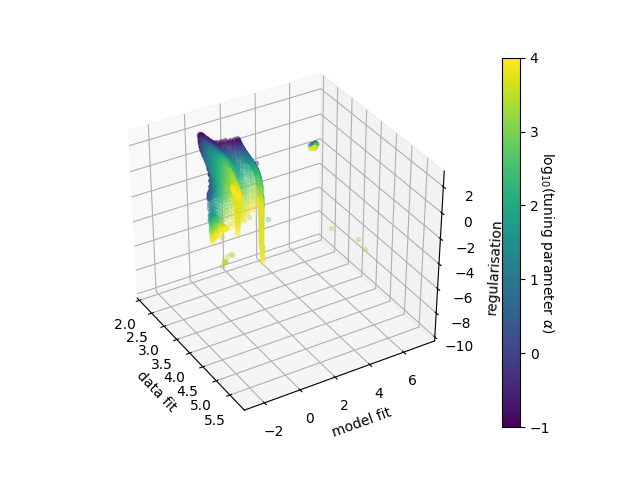

In [84]:
import matplotlib.cm as mplcm
import matplotlib.colors as colors
i0, i1 = (0, -1)

cNorm = colors.Normalize(vmin=np.log10(arange[i0]), vmax=np.log10(arange[i1]))
cm = plt.get_cmap('viridis')
scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
for i,a in enumerate(arange):
    ax.plot(np.log10(f_trisol[i+i0,:,0].flatten()), 
                      np.log10(f_trisol[i+i0,:,1].flatten()), 
                      np.log10(f_trisol[i+i0,:,2].flatten()), 
                      '.', color=scalarMap.to_rgba(np.log10(a)), alpha=0.3)
ax.set_xlabel('data fit')
ax.set_ylabel('model fit')
ax.set_zlabel('regularisation')
cbar = plt.colorbar(scalarMap)
cbar.set_label(r'$\log_{10}($tuning parameter $\alpha)$', rotation=270)


<IPython.core.display.Javascript object>


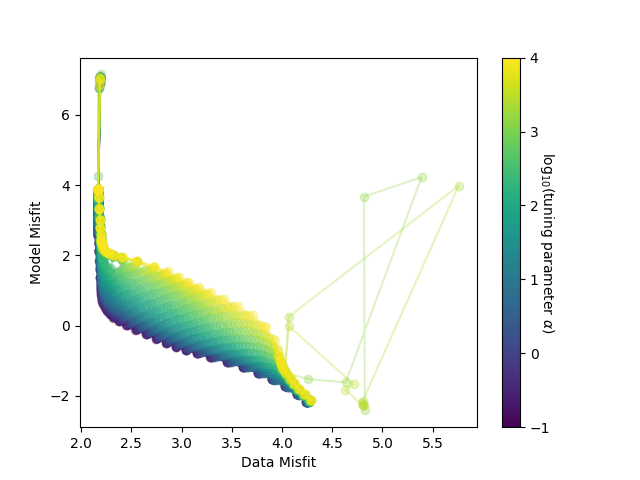

Text(0, 0.5, 'Model Misfit')

In [76]:
i0, i1 = (0, -1)

cNorm = colors.Normalize(vmin=np.log10(arange[i0]), vmax=np.log10(arange[i1]))
cm = plt.get_cmap('viridis')
scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)

plt.figure()
for i,a in enumerate(arange):
    plt.plot(np.log10(f_trisol[i+i0,:,0]).T, np.log10(f_trisol[i+i0,:,1]).T, 'o-', color=scalarMap.to_rgba(np.log10(a)), alpha=0.3)
cbar = plt.colorbar(scalarMap)
cbar.set_label(r'$\log_{10}($tuning parameter $\alpha)$', rotation=270)
plt.xlabel('Data Misfit')
plt.ylabel('Model Misfit')

<IPython.core.display.Javascript object>


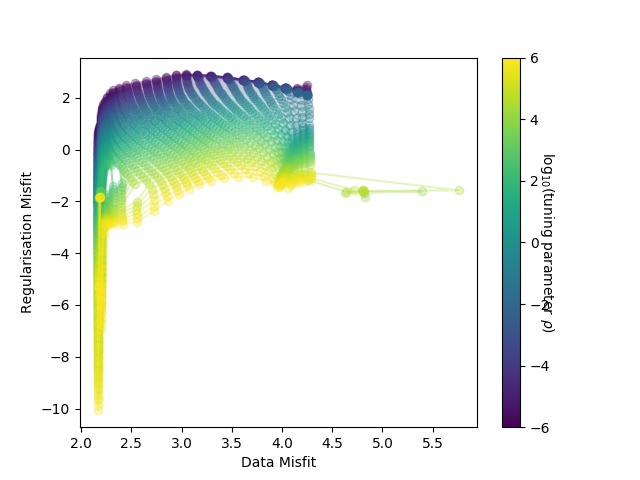

Text(0, 0.5, 'Regularisation Misfit')

In [77]:
i0, i1 = (0, -1)

cNorm = colors.Normalize(vmin=np.log10(prange[i0]), vmax=np.log10(prange[i1]))
cm = plt.get_cmap('viridis')
scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)

plt.figure()
for i,p in enumerate(prange):
    plt.plot(np.log10(f_trisol[i+i0,:,0]).T, np.log10(f_trisol[i+i0,:,2]).T, 
             'o-', color=scalarMap.to_rgba(np.log10(p)), alpha=0.3)
cbar = plt.colorbar(scalarMap)
cbar.set_label(r'$\log_{10}($tuning parameter $\rho)$', rotation=270)
plt.xlabel('Data Misfit')
plt.ylabel('Regularisation Misfit')